In [1]:
import pandas as pd
import numpy as np
import pickle
import time
import datetime
from dateutil.relativedelta import relativedelta
import requests
import locale
from pandas.io.json import json_normalize
import io
import os
from os.path import exists
import sys
from matplotlib import pyplot as plt
import numpy as np
from tqdm import tqdm

import matplotlib.pyplot as plt
import source.read_tickers_and_isins as URTI
import source.get_directors_dealings as UGDD
import source.get_timeseries as UGT
import source.analyze_get_summary_of_data as AGSOD
import source.preprocess_directors_dealings as UPDD
import source.preprocess_timeseries as UPTS
import source.preprocess_timeseries_from_excel as UPTFE
import source.analyse_single_company as UASC
import source.calculate_daily_returns_for_period as CDRFP
from source import data_checks, determine_T0_T1_T2, cut_timeseries, calculate_coefficients
import logging
logging.getLogger().setLevel(logging.WARNING)

### Load return series

In [2]:
NAME = "Knudsen" # "Niedermayer"
DATA_LOCATION = f'data/{NAME}/'
DATA_LOCATION_INSIDER_RAW = DATA_LOCATION + 'raw/insider/'
DATA_LOCATION_INSIDER_PROCESSED = DATA_LOCATION + 'processed/insider/'
DATA_LOCATION_TIME_SERIES_RAW = DATA_LOCATION + 'raw/timeseries/'
DATA_LOCATION_TIME_SERIES_PROCESSED = DATA_LOCATION + 'processed/timeseries/'
DATA_LOCATION_RI = DATA_LOCATION + 'processed/RI/'

_ri_location = DATA_LOCATION_RI
_insider_location = DATA_LOCATION_INSIDER_PROCESSED


file_locs_ = os.listdir(_ri_location)
file_locs = [_ri_location + f for f in file_locs_]

companies = []
print("loading return series...")
for file_loc in tqdm(file_locs):
    with open(file_loc, "rb") as f:
        company = pickle.load(f)
    companies.append(company)

loading return series...


100%|██████████| 4077/4077 [00:01<00:00, 2282.88it/s]


### Calculate Returns, Analyse Companies

In [3]:
print("calculate returns")
returns_df = [CDRFP.calculate_daily_returns(c.return_index_df) for c in companies]

print("concatenate")
df_returns = pd.concat(returns_df, axis=1)
df_return_index = pd.concat([c.return_index_df for c in companies], axis=1) # TODO remove the slice

print("analyse ...")
pickles = os.listdir(DATA_LOCATION_RI)[:100] # TODO remove
ISINs = [rick[:-7] for rick in pickles]

outputs = []
for isin in tqdm(ISINs):
    outputs.append(UASC.analyse_single_company(isin, DATA_LOCATION_RI, DATA_LOCATION_INSIDER_PROCESSED))


calculate returns
concatenate
analyse ...


100%|██████████| 100/100 [00:03<00:00, 31.00it/s]


### Visualise Mean Daily Returns

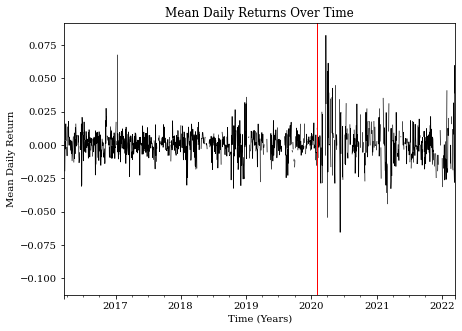

In [4]:
plt.rc('font', family='serif')
plt.rc('xtick')
plt.rc('ytick')

fig = plt.figure(figsize=(7, 5))
ax = fig.add_subplot(1, 1, 1)

returns_companies = df_returns.mean(axis=1)
returns_companies.plot(color="k", linewidth=0.7)

ax.set_xlabel('Time (Years)')
ax.set_ylabel('Mean Daily Return')
ax.set_title('Mean Daily Returns Over Time')

interval_borders = ["2020-02-01"] # TODO see if it makes sense to actually take first of Feb

for int_ in interval_borders:
    plt.axvline(x = int_, color = 'red', label = 'DD Event time', linewidth = 1)

plt.savefig(DATA_LOCATION +"visualisations/NYSE_daily_returns.jpg", dpi=600)
plt.show()


### Investigate Filing Trade Lag Times

Negative lag for 0 out of 7519 trades.
Lag longer than 21 days for 339 out of 7519 trades.
Eligible trades: 7180 out of 7519 trades.


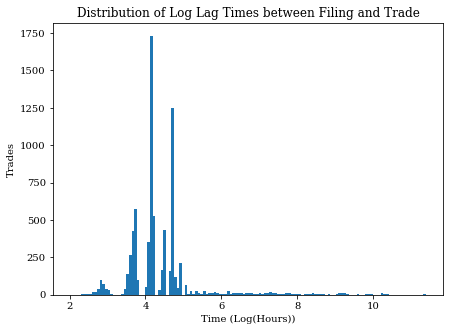

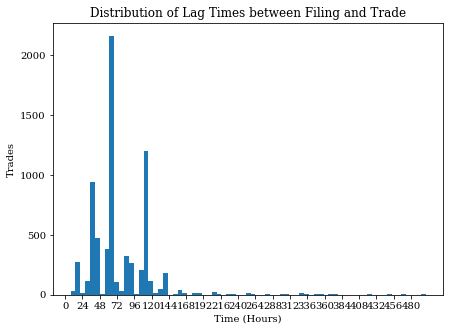

In [5]:
sum_returns = sum([x[0] for x in outputs], [])
filing_trade_lags = sum([x[1] for x in outputs], [])

lag_in_hours = np.asarray(filing_trade_lags)
negative_lag_mask = lag_in_hours < 0
positive_lag = lag_in_hours[~negative_lag_mask]
in_21_days = positive_lag < 21*24
relevant_lag = positive_lag[in_21_days]
print(f"Negative lag for {negative_lag_mask.sum()} out of {len(negative_lag_mask)} trades.")
print(f"Lag longer than 21 days for {len(positive_lag) - len(relevant_lag)} out of {len(negative_lag_mask)} trades.")
print(f"Eligible trades: {len(relevant_lag)} out of {len(negative_lag_mask)} trades.")

fig = plt.figure(figsize=(7, 5))
ax = fig.add_subplot(1, 1, 1)
plt.hist(np.log(positive_lag), bins="auto")
ax.set_xlabel('Time (Log(Hours))')
ax.set_ylabel('Trades')
ax.set_title('Distribution of Log Lag Times between Filing and Trade')

plt.savefig(DATA_LOCATION +"visualisations/log_transformed_lags.jpg", dpi=600)
plt.show()

without_outliers = positive_lag[positive_lag < 24*21]

fig = plt.figure(figsize=(7, 5))
ax = fig.add_subplot(1, 1, 1)
plt.hist(without_outliers, bins="auto")
plt.xticks(np.arange(0, max(without_outliers) + 1, 24))
ax.set_xlabel('Time (Hours)')
ax.set_ylabel('Trades')
ax.set_title('Distribution of Lag Times between Filing and Trade')

plt.savefig(DATA_LOCATION +"visualisations/lags_without_outliers.jpg", dpi=600)

# Get Market timeseries

In [6]:
end_time = datetime.datetime(2022, 3, 21, 23, 59, 59)
_end_time_unix = int(time.mktime(end_time.timetuple()))
print(_end_time_unix)

start_time = datetime.datetime(2016, 3, 21, 0, 0, 0)
_start_time_unix = int(time.mktime(start_time.timetuple()))

print(_start_time_unix)

if NAME == "Knudsen":
    _ticker = '%5EIXIC'  
elif NAME == "Niedermayer":
    _ticker = "%5Enya"
else:
    raise NotImplementedError
    
url = f'https://query1.finance.yahoo.com/v7/finance/download/{_ticker}?period1={_start_time_unix}&period2={_end_time_unix}&interval=1d&events=history&includeAdjustedClose=true'
market_timeseries = pd.read_csv(url)

market_timeseries = market_timeseries.set_index('Date')
market_timeseries.index = market_timeseries.index.astype('datetime64[ns]')

trading_days = market_timeseries.index
market_timeseries

1647903599
1458514800


,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2016-03-21,4787.310059,4814.850098,4785.379883,4808.870117,4808.870117,1609230000
2016-03-22,4783.600098,4835.600098,4781.709961,4821.660156,4821.660156,1596200000
2016-03-23,4813.870117,4816.669922,4765.370117,4768.859863,4768.859863,1732630000
2016-03-24,4743.359863,4773.500000,4734.770020,4773.500000,4773.500000,1590990000
2016-03-28,4785.250000,4787.390137,4760.009766,4766.790039,4766.790039,1381000000
...,...,...,...,...,...,...
2022-03-15,12685.230469,12973.879883,12616.589844,12948.620117,12948.620117,5414590000
2022-03-16,13119.370117,13440.120117,12992.200195,13436.549805,13436.549805,6498110000
2022-03-17,13360.719727,13620.799805,13317.139648,13614.780273,13614.780273,5575030000


# Define windows

#### Our data contains multiple companies. A single company contains multiple filings and each filing is an event

![alt text](assets/images/windows.png "Title")

In [7]:
## Constants defining how long both Estimation Window and Event Window are
### Probably also input parameters to a function call, as we need loops later...
L1_length = 100
L2_length = 40 # TODO +-20 days = 40 days, right?

# Demonstrate process for a single event

### Fix a company

In [8]:

logging.getLogger().setLevel(logging.DEBUG)

if NAME == "Knudsen":
    company_index = -87
elif NAME == "Niedermayer":
    company_index = -11
else:
    raise NotImplementedError
company = companies[company_index]
print(company)
company_return = company.return_index_df
insider_data_df = pd.read_csv(_insider_location + company.ticker + '.csv', index_col=0, parse_dates=['FilingDate', 'TradeDate'])
# TODO maybe some data sanitisation in the creation of company objects start_date and end_date have different datatypes

Company(company_type=938260, isin='US9871841089', name='YORK WATER', ticker='YORW', start_date=Timestamp('1996-08-20 00:00:00'), end_date=Timestamp('2022-03-16 00:00:00'), return_index_df=            ReturnIndex
Date                   
2016-03-21      1020.66
2016-03-22      1023.42
2016-03-23      1015.49
2016-03-24      1022.04
2016-03-25      1022.04
...                 ...
2022-03-10      1697.39
2022-03-11      1681.25
2022-03-14      1677.02
2022-03-15      1693.16
2022-03-16      1688.93

[1563 rows x 1 columns])


### Fix an event

In [9]:
# This date will be moved to a loop
## Define which periods we are looking at.


if NAME == "Knudsen":
    event_index = 60
elif NAME == "Niedermayer":
    event_index = -200
else:
    raise NotImplementedError
    
event_timestamp = insider_data_df.FilingDate.iloc[event_index].floor("d") 
print("event timestamp: ", event_timestamp)

event timestamp:  2021-07-16 00:00:00


### Technical Checks

In [10]:
data_checks.run(L1_length, L2_length, event_timestamp, company_return, market_timeseries)

### Determine T0, T1 and T2

In [11]:
T0_, T1_, T0, T1, T2, ERROR, msg = determine_T0_T1_T2.run(L1_length, L2_length, event_timestamp, company_return, market_timeseries)

DEBUG:root:Found T1: 2021-06-17 00:00:00
DEBUG:root:Found T2: 2021-08-13 00:00:00
DEBUG:root:Found T0: 2021-01-25 00:00:00
DEBUG:root:------------------------------
DEBUG:root:Event occurred at             2021-07-16 00:00:00
DEBUG:root:Estimation Window (100 days): from 2021-01-25 00:00:00 to 2021-06-17 00:00:00
DEBUG:root:Event Window      ( 40 days): from 2021-06-17 00:00:00 to 2021-08-13 00:00:00


### Abnormal and Normal Returns

![alt text](assets/images/return_estimation.png "Title")

### Cut return timeseries into correct periods

In [12]:
windows = cut_timeseries.run(company_return, market_timeseries, T0_, T1, T1_, T2)
estimation_window_market_return, estimation_window_company_return, event_window_market_return, event_window_company_return = windows

DEBUG:root:shape before aggregating
DEBUG:root:# estimation_window_market_timeseries: (101, 6)
DEBUG:root:# estimation_window_company_timeseries: (104, 1)
DEBUG:root:# event_window_market_timeseries: (41, 6)
DEBUG:root:# event_window_company_timeseries: (42, 1)
DEBUG:root:shape after aggregating
DEBUG:root:# estimation_window_market_return: (103,)
DEBUG:root:# estimation_window_market_return: (103,)
DEBUG:root:# event_window_market_return: (41,)
DEBUG:root:# event_window_company_return: (41,)


### Calculate coefficients

In [13]:
alpha, beta = calculate_coefficients.run(estimation_window_market_return, estimation_window_company_return)

DEBUG:root:                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.091
Model:                            OLS   Adj. R-squared:                  0.082
Method:                 Least Squares   F-statistic:                     10.06
Date:                Fri, 16 Sep 2022   Prob (F-statistic):            0.00200
Time:                        19:20:21   Log-Likelihood:                 281.51
No. Observations:                 103   AIC:                            -559.0
Df Residuals:                     101   BIC:                            -553.8
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0012      0.002      0.7

### The Abnormal Return
This is the last step of the whole process for one event

In [14]:
company_return = event_window_company_return
market_return = event_window_market_return
estimated_return = alpha + beta*market_return
abnormal_return = company_return - estimated_return
print(abnormal_return)

Date
2021-06-17   -0.019057
2021-06-18   -0.065126
2021-06-21    0.016352
2021-06-22   -0.032596
2021-06-23   -0.008913
2021-06-24   -0.009156
2021-06-25    0.002125
2021-06-28   -0.001225
2021-06-29   -0.015042
2021-06-30   -0.010566
2021-07-01    0.010055
2021-07-02   -0.008598
2021-07-05   -0.001155
2021-07-06   -0.006830
2021-07-07    0.003213
2021-07-08   -0.015731
2021-07-09   -0.008016
2021-07-12    0.001392
2021-07-13    0.002962
2021-07-14    0.006820
2021-07-15    0.017855
2021-07-16    0.036021
2021-07-19   -0.012045
2021-07-20    0.012053
2021-07-21   -0.011996
2021-07-22   -0.005693
2021-07-23    0.003974
2021-07-26   -0.003974
2021-07-27    0.007270
2021-07-28    0.001631
2021-07-29    0.005936
2021-07-30   -0.000488
2021-08-02    0.002148
2021-08-03    0.002332
2021-08-04    0.008614
2021-08-05    0.010719
2021-08-06   -0.000834
2021-08-09   -0.015219
2021-08-10    0.002933
2021-08-11   -0.001374
2021-08-12   -0.003490
dtype: float64


In [15]:
# TODO @Gunnar there is this market calendar package perhaps its nice for checks for trading/non trading days and such
#import pandas_market_calendars as mcal

# Create a calendar
#nyse = mcal.get_calendar('NYSE')

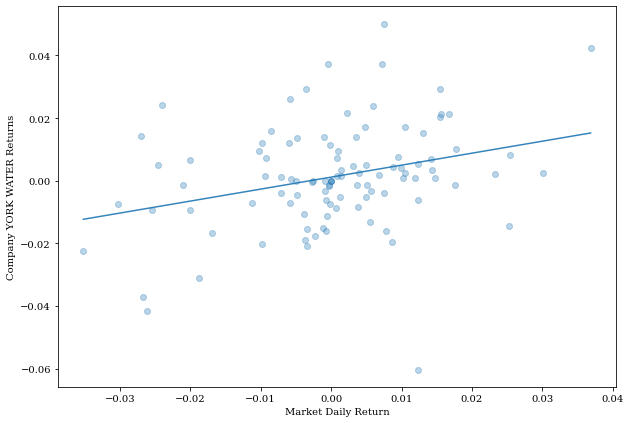

In [16]:
# I think you are the purest of garbage, and can thus be discarded
X = estimation_window_market_return.values
Y = estimation_window_company_return.values
X2 = np.linspace(X.min(), X.max(), 100)
Y_hat = X2 * beta + alpha
plt.figure(figsize=(10,7))
plt.scatter(X,Y, alpha = 0.3) # Plot the raw data
plt.xlabel('Market Daily Return')
plt.ylabel(f'Company {company.name} Returns')
           
plt.plot(X2, Y_hat, alpha = 0.9)
plt.show()


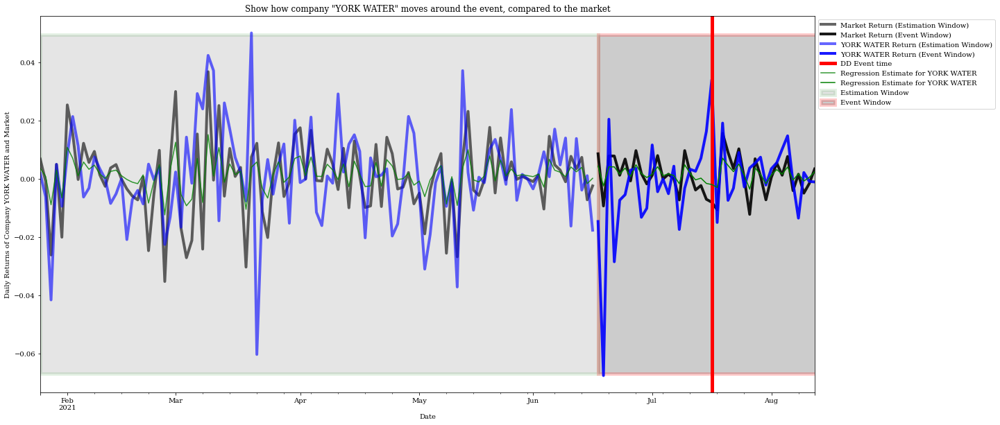

I'm impressed! It looks like a five-year-old drew this plot in paint


In [17]:
Company_name = company.name

# Estimations
est_estimation = estimation_window_market_return * beta + alpha
est_event = event_window_market_return * beta + alpha

plt.figure(figsize=(20,10))
estimation_window_market_return.plot(color = 'black', alpha = 0.6, linewidth=4, label = 'Market Return (Estimation Window)')
event_window_market_return.plot(color = 'black', alpha = 0.9, linewidth=4, label = 'Market Return (Event Window)')

estimation_window_company_return.plot(color = 'blue', alpha = 0.6, linewidth = 4, label = f'{Company_name} Return (Estimation Window)')
event_window_company_return.plot(color = 'blue', alpha = 0.9, linewidth = 4, label = f'{Company_name} Return (Event Window)')

plt.axvline(x = event_timestamp, color = 'red', label = 'DD Event time', linewidth = 5)
plt.ylabel(f'Daily Returns of Company {Company_name} and Market')
est_estimation.plot(color = 'green', label = f'Regression Estimate for {Company_name}', alpha = 0.8)
est_event.plot(color = 'green', label = f'Regression Estimate for {Company_name}', alpha = 1)

plt.axvspan(T0, T1, ymin = 0.05, ymax = 0.95, facecolor='black', alpha=0.1, label = 'Estimation Window', edgecolor='g', linewidth=5)
plt.axvspan(T1, T2, ymin = 0.05, ymax = 0.95, facecolor='black', alpha=0.2, label = 'Event Window', edgecolor='r', linewidth=5)
plt.legend(bbox_to_anchor = (1.0, 1), loc = 'upper left')

plt.title(f'Show how company "{Company_name}" moves around the event, compared to the market')
plt.show()
print("I'm impressed! It looks like a five-year-old drew this plot in paint")


# Macro Analysis

### Now that we have seen the process for one single filing, let us do the same for all filings in all companies


In [18]:
from source.data_checks import DataSizeException
from source.determine_T0_T1_T2 import TimeSeriesMismatchException
logging.getLogger().setLevel(logging.ERROR)
multiind, data, data_errors = [], [], []

# this is the interval where filings are interesting to us
earliest_timestamp = pd.Timestamp("2018-01-01")
latest_timestamp = pd.Timestamp("2021-12-31")
n_companies = len(companies)
for j in range(len(companies)):
    company = companies[j]
    company_return = company.return_index_df
    filename = _insider_location + company.ticker + '.csv'
    filename = filename.replace(" ", "+") # HBB+WI in files and HBB WI as Ticker in base Excel, TODO should be fixed in base data
    insider_data_df = pd.read_csv(filename, index_col=0, parse_dates=['FilingDate', 'TradeDate'])
    
    
    n_filings = len(insider_data_df)
    for i in insider_data_df.FilingDate.index:
        
        
        filing_date = insider_data_df.FilingDate[i]
        
        event_timestamp = filing_date.floor("d")

        # if the timestamp is too early or too late we skip
        if event_timestamp < earliest_timestamp or event_timestamp > latest_timestamp:
            #print("skipping, filing is too early or too late")
            continue
            
            
        print(f"working on company {j}/{n_companies} named {company.name}, filing {i}/{n_filings}")

        # do the process for one filing
 
        checks = data_checks.run(L1_length, L2_length, event_timestamp, company_return, market_timeseries)
        if checks:
            print(checks[1])
            data_errors.append(checks[0])
            continue
   
        T0_, T1_, T0, T1, T2, ERRORS, msg = determine_T0_T1_T2.run(L1_length, L2_length, event_timestamp, company_return, market_timeseries)
        if ERRORS:
            print(msg)
            data_errors.append(ERRORS)
            continue
            
        
        windows = cut_timeseries.run(company_return, market_timeseries, T0_, T1, T1_, T2)
        estimation_window_market_return, estimation_window_company_return, event_window_market_return, event_window_company_return = windows
        alpha, beta = calculate_coefficients.run(estimation_window_market_return, estimation_window_company_return)

        abnormal_return = event_window_company_return - alpha - beta*event_window_market_return
        
        multiind.append((company.ticker, i, insider_data_df.TradeType[i]))
        data.append(abnormal_return)


working on company 1/4077 named INTEGRATED MEDIA TECH., filing 0/4
working on company 1/4077 named INTEGRATED MEDIA TECH., filing 1/4
working on company 1/4077 named INTEGRATED MEDIA TECH., filing 2/4
working on company 1/4077 named INTEGRATED MEDIA TECH., filing 3/4
working on company 7/4077 named ARCH CAP.GP., filing 14/1047
working on company 7/4077 named ARCH CAP.GP., filing 15/1047
working on company 7/4077 named ARCH CAP.GP., filing 16/1047
working on company 7/4077 named ARCH CAP.GP., filing 17/1047
working on company 7/4077 named ARCH CAP.GP., filing 18/1047
working on company 7/4077 named ARCH CAP.GP., filing 19/1047
working on company 7/4077 named ARCH CAP.GP., filing 20/1047
working on company 7/4077 named ARCH CAP.GP., filing 21/1047
working on company 7/4077 named ARCH CAP.GP., filing 22/1047
working on company 7/4077 named ARCH CAP.GP., filing 23/1047
working on company 7/4077 named ARCH CAP.GP., filing 24/1047
working on company 7/4077 named ARCH CAP.GP., filing 25/1047


working on company 7/4077 named ARCH CAP.GP., filing 157/1047
working on company 7/4077 named ARCH CAP.GP., filing 158/1047
working on company 7/4077 named ARCH CAP.GP., filing 159/1047
working on company 7/4077 named ARCH CAP.GP., filing 160/1047
working on company 7/4077 named ARCH CAP.GP., filing 161/1047
working on company 7/4077 named ARCH CAP.GP., filing 162/1047
working on company 7/4077 named ARCH CAP.GP., filing 163/1047
working on company 7/4077 named ARCH CAP.GP., filing 164/1047
working on company 7/4077 named ARCH CAP.GP., filing 165/1047
working on company 7/4077 named ARCH CAP.GP., filing 166/1047
working on company 7/4077 named ARCH CAP.GP., filing 167/1047
working on company 7/4077 named ARCH CAP.GP., filing 168/1047
working on company 7/4077 named ARCH CAP.GP., filing 169/1047
working on company 7/4077 named ARCH CAP.GP., filing 170/1047
working on company 7/4077 named ARCH CAP.GP., filing 171/1047
working on company 7/4077 named ARCH CAP.GP., filing 172/1047
working 

working on company 8/4077 named ARGO GP.INTL.HOLDINGS, filing 76/643
working on company 8/4077 named ARGO GP.INTL.HOLDINGS, filing 77/643
working on company 8/4077 named ARGO GP.INTL.HOLDINGS, filing 78/643
working on company 8/4077 named ARGO GP.INTL.HOLDINGS, filing 79/643
working on company 8/4077 named ARGO GP.INTL.HOLDINGS, filing 80/643
working on company 8/4077 named ARGO GP.INTL.HOLDINGS, filing 81/643
working on company 8/4077 named ARGO GP.INTL.HOLDINGS, filing 82/643
working on company 8/4077 named ARGO GP.INTL.HOLDINGS, filing 83/643
working on company 8/4077 named ARGO GP.INTL.HOLDINGS, filing 84/643
working on company 8/4077 named ARGO GP.INTL.HOLDINGS, filing 85/643
working on company 8/4077 named ARGO GP.INTL.HOLDINGS, filing 86/643
working on company 8/4077 named ARGO GP.INTL.HOLDINGS, filing 87/643
working on company 8/4077 named ARGO GP.INTL.HOLDINGS, filing 88/643
working on company 8/4077 named ARGO GP.INTL.HOLDINGS, filing 89/643
working on company 8/4077 named AR

working on company 8/4077 named ARGO GP.INTL.HOLDINGS, filing 212/643
working on company 8/4077 named ARGO GP.INTL.HOLDINGS, filing 213/643
working on company 8/4077 named ARGO GP.INTL.HOLDINGS, filing 214/643
working on company 8/4077 named ARGO GP.INTL.HOLDINGS, filing 215/643
working on company 8/4077 named ARGO GP.INTL.HOLDINGS, filing 216/643
working on company 8/4077 named ARGO GP.INTL.HOLDINGS, filing 217/643
working on company 8/4077 named ARGO GP.INTL.HOLDINGS, filing 218/643
working on company 8/4077 named ARGO GP.INTL.HOLDINGS, filing 219/643
working on company 8/4077 named ARGO GP.INTL.HOLDINGS, filing 220/643
working on company 8/4077 named ARGO GP.INTL.HOLDINGS, filing 221/643
working on company 8/4077 named ARGO GP.INTL.HOLDINGS, filing 222/643
working on company 8/4077 named ARGO GP.INTL.HOLDINGS, filing 223/643
working on company 8/4077 named ARGO GP.INTL.HOLDINGS, filing 224/643
working on company 8/4077 named ARGO GP.INTL.HOLDINGS, filing 225/643
working on company 8

working on company 12/4077 named ENSTAR GROUP, filing 13/242
working on company 12/4077 named ENSTAR GROUP, filing 14/242
working on company 12/4077 named ENSTAR GROUP, filing 15/242
working on company 12/4077 named ENSTAR GROUP, filing 16/242
working on company 12/4077 named ENSTAR GROUP, filing 17/242
working on company 12/4077 named ENSTAR GROUP, filing 18/242
working on company 12/4077 named ENSTAR GROUP, filing 19/242
working on company 12/4077 named ENSTAR GROUP, filing 20/242
working on company 12/4077 named ENSTAR GROUP, filing 21/242
working on company 12/4077 named ENSTAR GROUP, filing 22/242
working on company 12/4077 named ENSTAR GROUP, filing 23/242
working on company 12/4077 named ENSTAR GROUP, filing 24/242
working on company 12/4077 named ENSTAR GROUP, filing 25/242
working on company 12/4077 named ENSTAR GROUP, filing 26/242
working on company 12/4077 named ENSTAR GROUP, filing 27/242
working on company 12/4077 named ENSTAR GROUP, filing 28/242
working on company 12/40

working on company 14/4077 named HELEN OF TROY, filing 70/693
working on company 14/4077 named HELEN OF TROY, filing 71/693
working on company 14/4077 named HELEN OF TROY, filing 72/693
working on company 14/4077 named HELEN OF TROY, filing 73/693
working on company 14/4077 named HELEN OF TROY, filing 74/693
working on company 14/4077 named HELEN OF TROY, filing 75/693
working on company 14/4077 named HELEN OF TROY, filing 76/693
working on company 14/4077 named HELEN OF TROY, filing 77/693
working on company 14/4077 named HELEN OF TROY, filing 78/693
working on company 14/4077 named HELEN OF TROY, filing 79/693
working on company 14/4077 named HELEN OF TROY, filing 80/693
working on company 14/4077 named HELEN OF TROY, filing 81/693
working on company 14/4077 named HELEN OF TROY, filing 82/693
working on company 14/4077 named HELEN OF TROY, filing 83/693
working on company 14/4077 named HELEN OF TROY, filing 84/693
working on company 14/4077 named HELEN OF TROY, filing 85/693
working 

working on company 14/4077 named HELEN OF TROY, filing 207/693
working on company 14/4077 named HELEN OF TROY, filing 208/693
working on company 14/4077 named HELEN OF TROY, filing 209/693
working on company 14/4077 named HELEN OF TROY, filing 210/693
working on company 14/4077 named HELEN OF TROY, filing 211/693
working on company 14/4077 named HELEN OF TROY, filing 212/693
working on company 14/4077 named HELEN OF TROY, filing 213/693
working on company 14/4077 named HELEN OF TROY, filing 214/693
working on company 14/4077 named HELEN OF TROY, filing 215/693
working on company 14/4077 named HELEN OF TROY, filing 216/693
working on company 14/4077 named HELEN OF TROY, filing 217/693
working on company 14/4077 named HELEN OF TROY, filing 218/693
working on company 14/4077 named HELEN OF TROY, filing 219/693
working on company 14/4077 named HELEN OF TROY, filing 220/693
working on company 14/4077 named HELEN OF TROY, filing 221/693
working on company 14/4077 named HELEN OF TROY, filing 

working on company 16/4077 named IHS MARKIT DEAD - DELIST.28/02/22, filing 97/526
working on company 16/4077 named IHS MARKIT DEAD - DELIST.28/02/22, filing 98/526
working on company 16/4077 named IHS MARKIT DEAD - DELIST.28/02/22, filing 99/526
working on company 16/4077 named IHS MARKIT DEAD - DELIST.28/02/22, filing 100/526
working on company 16/4077 named IHS MARKIT DEAD - DELIST.28/02/22, filing 101/526
working on company 16/4077 named IHS MARKIT DEAD - DELIST.28/02/22, filing 102/526
working on company 16/4077 named IHS MARKIT DEAD - DELIST.28/02/22, filing 103/526
working on company 16/4077 named IHS MARKIT DEAD - DELIST.28/02/22, filing 104/526
working on company 16/4077 named IHS MARKIT DEAD - DELIST.28/02/22, filing 105/526
working on company 16/4077 named IHS MARKIT DEAD - DELIST.28/02/22, filing 106/526
working on company 16/4077 named IHS MARKIT DEAD - DELIST.28/02/22, filing 107/526
working on company 16/4077 named IHS MARKIT DEAD - DELIST.28/02/22, filing 108/526
working

working on company 16/4077 named IHS MARKIT DEAD - DELIST.28/02/22, filing 197/526
working on company 16/4077 named IHS MARKIT DEAD - DELIST.28/02/22, filing 198/526
working on company 16/4077 named IHS MARKIT DEAD - DELIST.28/02/22, filing 199/526
working on company 16/4077 named IHS MARKIT DEAD - DELIST.28/02/22, filing 200/526
working on company 16/4077 named IHS MARKIT DEAD - DELIST.28/02/22, filing 201/526
working on company 16/4077 named IHS MARKIT DEAD - DELIST.28/02/22, filing 202/526
working on company 16/4077 named IHS MARKIT DEAD - DELIST.28/02/22, filing 203/526
working on company 16/4077 named IHS MARKIT DEAD - DELIST.28/02/22, filing 204/526
working on company 16/4077 named IHS MARKIT DEAD - DELIST.28/02/22, filing 205/526
working on company 16/4077 named IHS MARKIT DEAD - DELIST.28/02/22, filing 206/526
working on company 16/4077 named IHS MARKIT DEAD - DELIST.28/02/22, filing 207/526
working on company 16/4077 named IHS MARKIT DEAD - DELIST.28/02/22, filing 208/526
work

working on company 16/4077 named IHS MARKIT DEAD - DELIST.28/02/22, filing 311/526
working on company 16/4077 named IHS MARKIT DEAD - DELIST.28/02/22, filing 312/526
working on company 16/4077 named IHS MARKIT DEAD - DELIST.28/02/22, filing 313/526
working on company 16/4077 named IHS MARKIT DEAD - DELIST.28/02/22, filing 314/526
working on company 16/4077 named IHS MARKIT DEAD - DELIST.28/02/22, filing 315/526
working on company 16/4077 named IHS MARKIT DEAD - DELIST.28/02/22, filing 316/526
working on company 16/4077 named IHS MARKIT DEAD - DELIST.28/02/22, filing 317/526
working on company 16/4077 named IHS MARKIT DEAD - DELIST.28/02/22, filing 318/526
working on company 16/4077 named IHS MARKIT DEAD - DELIST.28/02/22, filing 319/526
working on company 16/4077 named IHS MARKIT DEAD - DELIST.28/02/22, filing 320/526
working on company 16/4077 named IHS MARKIT DEAD - DELIST.28/02/22, filing 321/526
working on company 16/4077 named IHS MARKIT DEAD - DELIST.28/02/22, filing 322/526
work

working on company 18/4077 named JAMES RIVER GROUP HDG., filing 107/312
working on company 18/4077 named JAMES RIVER GROUP HDG., filing 108/312
working on company 18/4077 named JAMES RIVER GROUP HDG., filing 109/312
working on company 18/4077 named JAMES RIVER GROUP HDG., filing 110/312
working on company 18/4077 named JAMES RIVER GROUP HDG., filing 111/312
working on company 18/4077 named JAMES RIVER GROUP HDG., filing 112/312
working on company 18/4077 named JAMES RIVER GROUP HDG., filing 113/312
working on company 18/4077 named JAMES RIVER GROUP HDG., filing 114/312
working on company 18/4077 named JAMES RIVER GROUP HDG., filing 115/312
working on company 18/4077 named JAMES RIVER GROUP HDG., filing 116/312
working on company 18/4077 named JAMES RIVER GROUP HDG., filing 117/312
working on company 18/4077 named JAMES RIVER GROUP HDG., filing 118/312
working on company 18/4077 named JAMES RIVER GROUP HDG., filing 119/312
working on company 18/4077 named JAMES RIVER GROUP HDG., filing 

working on company 20/4077 named MAIDEN HOLDINGS, filing 12/256
working on company 20/4077 named MAIDEN HOLDINGS, filing 13/256
working on company 20/4077 named MAIDEN HOLDINGS, filing 14/256
working on company 20/4077 named MAIDEN HOLDINGS, filing 15/256
working on company 20/4077 named MAIDEN HOLDINGS, filing 16/256
working on company 20/4077 named MAIDEN HOLDINGS, filing 17/256
working on company 20/4077 named MAIDEN HOLDINGS, filing 18/256
working on company 20/4077 named MAIDEN HOLDINGS, filing 19/256
working on company 20/4077 named MAIDEN HOLDINGS, filing 20/256
working on company 20/4077 named MAIDEN HOLDINGS, filing 21/256
working on company 20/4077 named MAIDEN HOLDINGS, filing 22/256
working on company 20/4077 named MAIDEN HOLDINGS, filing 23/256
working on company 20/4077 named MAIDEN HOLDINGS, filing 24/256
working on company 20/4077 named MAIDEN HOLDINGS, filing 25/256
working on company 20/4077 named MAIDEN HOLDINGS, filing 26/256
working on company 20/4077 named MAIDEN 

working on company 21/4077 named ALPHA AND OMEGA SEMICON., filing 82/423
working on company 21/4077 named ALPHA AND OMEGA SEMICON., filing 83/423
working on company 21/4077 named ALPHA AND OMEGA SEMICON., filing 84/423
working on company 21/4077 named ALPHA AND OMEGA SEMICON., filing 85/423
working on company 21/4077 named ALPHA AND OMEGA SEMICON., filing 86/423
working on company 21/4077 named ALPHA AND OMEGA SEMICON., filing 87/423
working on company 21/4077 named ALPHA AND OMEGA SEMICON., filing 88/423
working on company 21/4077 named ALPHA AND OMEGA SEMICON., filing 89/423
working on company 21/4077 named ALPHA AND OMEGA SEMICON., filing 90/423
working on company 21/4077 named ALPHA AND OMEGA SEMICON., filing 91/423
working on company 21/4077 named ALPHA AND OMEGA SEMICON., filing 92/423
working on company 21/4077 named ALPHA AND OMEGA SEMICON., filing 93/423
working on company 21/4077 named ALPHA AND OMEGA SEMICON., filing 94/423
working on company 21/4077 named ALPHA AND OMEGA SE

working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 76/338
working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 77/338
working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 78/338
working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 79/338
working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 80/338
working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 81/338
working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 82/338
working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 83/338
working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 84/338
working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 85/338
working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 86/338
working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 87/338
working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 88/338
working on company 24/4077 named LIBERTY LATIN AMERICA A, filing

working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 193/338
working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 194/338
working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 195/338
working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 196/338
working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 197/338
working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 198/338
working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 199/338
working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 200/338
working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 201/338
working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 202/338
working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 203/338
working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 204/338
working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 205/338
working on company 24/4077 named LIBERTY LATIN AMER

working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 313/338
working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 314/338
working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 315/338
working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 316/338
working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 317/338
working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 318/338
working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 319/338
working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 320/338
working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 321/338
working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 322/338
working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 323/338
working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 324/338
working on company 24/4077 named LIBERTY LATIN AMERICA A, filing 325/338
working on company 24/4077 named LIBERTY LATIN AMER

working on company 25/4077 named LIBERTY LATIN AMERICA C, filing 83/338
working on company 25/4077 named LIBERTY LATIN AMERICA C, filing 84/338
working on company 25/4077 named LIBERTY LATIN AMERICA C, filing 85/338
working on company 25/4077 named LIBERTY LATIN AMERICA C, filing 86/338
working on company 25/4077 named LIBERTY LATIN AMERICA C, filing 87/338
working on company 25/4077 named LIBERTY LATIN AMERICA C, filing 88/338
working on company 25/4077 named LIBERTY LATIN AMERICA C, filing 89/338
working on company 25/4077 named LIBERTY LATIN AMERICA C, filing 90/338
working on company 25/4077 named LIBERTY LATIN AMERICA C, filing 91/338
working on company 25/4077 named LIBERTY LATIN AMERICA C, filing 92/338
working on company 25/4077 named LIBERTY LATIN AMERICA C, filing 93/338
working on company 25/4077 named LIBERTY LATIN AMERICA C, filing 94/338
working on company 25/4077 named LIBERTY LATIN AMERICA C, filing 95/338
working on company 25/4077 named LIBERTY LATIN AMERICA C, filing

working on company 25/4077 named LIBERTY LATIN AMERICA C, filing 201/338
working on company 25/4077 named LIBERTY LATIN AMERICA C, filing 202/338
working on company 25/4077 named LIBERTY LATIN AMERICA C, filing 203/338
working on company 25/4077 named LIBERTY LATIN AMERICA C, filing 204/338
working on company 25/4077 named LIBERTY LATIN AMERICA C, filing 205/338
working on company 25/4077 named LIBERTY LATIN AMERICA C, filing 206/338
working on company 25/4077 named LIBERTY LATIN AMERICA C, filing 207/338
working on company 25/4077 named LIBERTY LATIN AMERICA C, filing 208/338
working on company 25/4077 named LIBERTY LATIN AMERICA C, filing 209/338
working on company 25/4077 named LIBERTY LATIN AMERICA C, filing 210/338
working on company 25/4077 named LIBERTY LATIN AMERICA C, filing 211/338
working on company 25/4077 named LIBERTY LATIN AMERICA C, filing 212/338
working on company 25/4077 named LIBERTY LATIN AMERICA C, filing 213/338
working on company 25/4077 named LIBERTY LATIN AMER

working on company 25/4077 named LIBERTY LATIN AMERICA C, filing 317/338
working on company 25/4077 named LIBERTY LATIN AMERICA C, filing 318/338
working on company 25/4077 named LIBERTY LATIN AMERICA C, filing 319/338
working on company 25/4077 named LIBERTY LATIN AMERICA C, filing 320/338
working on company 25/4077 named LIBERTY LATIN AMERICA C, filing 321/338
working on company 25/4077 named LIBERTY LATIN AMERICA C, filing 322/338
working on company 25/4077 named LIBERTY LATIN AMERICA C, filing 323/338
working on company 25/4077 named LIBERTY LATIN AMERICA C, filing 324/338
working on company 25/4077 named LIBERTY LATIN AMERICA C, filing 325/338
working on company 25/4077 named LIBERTY LATIN AMERICA C, filing 326/338
working on company 25/4077 named LIBERTY LATIN AMERICA C, filing 327/338
working on company 25/4077 named LIBERTY LATIN AMERICA C, filing 328/338
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 113

working on company 29/4077 named ONESPAWORLD HOLDINGS, filing 29/60
working on company 29/4077 named ONESPAWORLD HOLDINGS, filing 30/60
working on company 29/4077 named ONESPAWORLD HOLDINGS, filing 31/60
working on company 29/4077 named ONESPAWORLD HOLDINGS, filing 32/60
working on company 29/4077 named ONESPAWORLD HOLDINGS, filing 33/60
working on company 29/4077 named ONESPAWORLD HOLDINGS, filing 34/60
working on company 29/4077 named ONESPAWORLD HOLDINGS, filing 35/60
working on company 29/4077 named ONESPAWORLD HOLDINGS, filing 36/60
working on company 29/4077 named ONESPAWORLD HOLDINGS, filing 37/60
working on company 29/4077 named ONESPAWORLD HOLDINGS, filing 38/60
working on company 29/4077 named ONESPAWORLD HOLDINGS, filing 39/60
working on company 29/4077 named ONESPAWORLD HOLDINGS, filing 40/60
working on company 29/4077 named ONESPAWORLD HOLDINGS, filing 41/60
working on company 29/4077 named ONESPAWORLD HOLDINGS, filing 42/60
working on company 29/4077 named ONESPAWORLD HOL

working on company 41/4077 named AURINIA PHARMACEUTICALS, filing 20/62
working on company 41/4077 named AURINIA PHARMACEUTICALS, filing 21/62
working on company 41/4077 named AURINIA PHARMACEUTICALS, filing 22/62
working on company 41/4077 named AURINIA PHARMACEUTICALS, filing 23/62
working on company 41/4077 named AURINIA PHARMACEUTICALS, filing 24/62
working on company 41/4077 named AURINIA PHARMACEUTICALS, filing 25/62
working on company 41/4077 named AURINIA PHARMACEUTICALS, filing 26/62
working on company 41/4077 named AURINIA PHARMACEUTICALS, filing 27/62
working on company 41/4077 named AURINIA PHARMACEUTICALS, filing 28/62
working on company 41/4077 named AURINIA PHARMACEUTICALS, filing 29/62
working on company 41/4077 named AURINIA PHARMACEUTICALS, filing 30/62
working on company 41/4077 named AURINIA PHARMACEUTICALS, filing 31/62
working on company 41/4077 named AURINIA PHARMACEUTICALS, filing 32/62
working on company 41/4077 named AURINIA PHARMACEUTICALS, filing 33/62
workin

working on company 59/4077 named ESSA PHARMA, filing 1/3
working on company 59/4077 named ESSA PHARMA, filing 2/3
working on company 61/4077 named FENNEC PHARMS. (NAS), filing 1/25
working on company 61/4077 named FENNEC PHARMS. (NAS), filing 2/25
working on company 61/4077 named FENNEC PHARMS. (NAS), filing 3/25
working on company 61/4077 named FENNEC PHARMS. (NAS), filing 4/25
working on company 61/4077 named FENNEC PHARMS. (NAS), filing 5/25
working on company 61/4077 named FENNEC PHARMS. (NAS), filing 6/25
working on company 61/4077 named FENNEC PHARMS. (NAS), filing 7/25
working on company 61/4077 named FENNEC PHARMS. (NAS), filing 8/25
working on company 61/4077 named FENNEC PHARMS. (NAS), filing 9/25
working on company 61/4077 named FENNEC PHARMS. (NAS), filing 10/25
working on company 61/4077 named FENNEC PHARMS. (NAS), filing 11/25
working on company 61/4077 named FENNEC PHARMS. (NAS), filing 12/25
working on company 61/4077 named FENNEC PHARMS. (NAS), filing 13/25
working on 

working on company 73/4077 named JEWETT CAMERON TRADING NEW U$ (NAS), filing 46/119
working on company 76/4077 named METHANEX (NAS), filing 26/207
working on company 76/4077 named METHANEX (NAS), filing 27/207
working on company 76/4077 named METHANEX (NAS), filing 28/207
working on company 76/4077 named METHANEX (NAS), filing 29/207
working on company 76/4077 named METHANEX (NAS), filing 30/207
working on company 76/4077 named METHANEX (NAS), filing 31/207
working on company 76/4077 named METHANEX (NAS), filing 32/207
working on company 76/4077 named METHANEX (NAS), filing 33/207
working on company 76/4077 named METHANEX (NAS), filing 34/207
working on company 76/4077 named METHANEX (NAS), filing 35/207
working on company 76/4077 named METHANEX (NAS), filing 36/207
working on company 76/4077 named METHANEX (NAS), filing 37/207
working on company 76/4077 named METHANEX (NAS), filing 38/207
working on company 76/4077 named METHANEX (NAS), filing 39/207
working on company 76/4077 named M

working on company 77/4077 named MILESTONE PHARMACEUTICALS, filing 8/20
working on company 77/4077 named MILESTONE PHARMACEUTICALS, filing 9/20
working on company 77/4077 named MILESTONE PHARMACEUTICALS, filing 10/20
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 113 entries prior in the company data  

                    
working on company 77/4077 named MILESTONE PHARMACEUTICALS, filing 11/20
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 105 entries prior in the company data  

                    
working on company 77/4077 named MILESTONE PHARMACEUTICALS, filing 12/20
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 4 entries prior in the company data  

                    
working on company 77/4077 named MILESTONE PHARMACEUTICALS, filing 13/20
Analysis can't be

working on company 78/4077 named MITEL NETWORKS DEAD - DELIST.03/12/18, filing 61/261
working on company 78/4077 named MITEL NETWORKS DEAD - DELIST.03/12/18, filing 62/261
working on company 78/4077 named MITEL NETWORKS DEAD - DELIST.03/12/18, filing 63/261
working on company 78/4077 named MITEL NETWORKS DEAD - DELIST.03/12/18, filing 64/261
working on company 78/4077 named MITEL NETWORKS DEAD - DELIST.03/12/18, filing 65/261
working on company 78/4077 named MITEL NETWORKS DEAD - DELIST.03/12/18, filing 66/261
working on company 78/4077 named MITEL NETWORKS DEAD - DELIST.03/12/18, filing 67/261
working on company 78/4077 named MITEL NETWORKS DEAD - DELIST.03/12/18, filing 68/261
working on company 78/4077 named MITEL NETWORKS DEAD - DELIST.03/12/18, filing 69/261
working on company 78/4077 named MITEL NETWORKS DEAD - DELIST.03/12/18, filing 70/261
working on company 78/4077 named MITEL NETWORKS DEAD - DELIST.03/12/18, filing 71/261
working on company 78/4077 named MITEL NETWORKS DEAD -

working on company 83/4077 named NICHOLAS FINANCIAL, filing 62/297
working on company 83/4077 named NICHOLAS FINANCIAL, filing 63/297
working on company 83/4077 named NICHOLAS FINANCIAL, filing 64/297
working on company 83/4077 named NICHOLAS FINANCIAL, filing 65/297
working on company 83/4077 named NICHOLAS FINANCIAL, filing 66/297
working on company 83/4077 named NICHOLAS FINANCIAL, filing 67/297
working on company 83/4077 named NICHOLAS FINANCIAL, filing 68/297
working on company 83/4077 named NICHOLAS FINANCIAL, filing 69/297
working on company 83/4077 named NICHOLAS FINANCIAL, filing 70/297
working on company 83/4077 named NICHOLAS FINANCIAL, filing 71/297
working on company 83/4077 named NICHOLAS FINANCIAL, filing 72/297
working on company 83/4077 named NICHOLAS FINANCIAL, filing 73/297
working on company 83/4077 named NICHOLAS FINANCIAL, filing 74/297
working on company 83/4077 named NICHOLAS FINANCIAL, filing 75/297
working on company 83/4077 named NICHOLAS FINANCIAL, filing 76

working on company 84/4077 named NOVANTA, filing 79/555
working on company 84/4077 named NOVANTA, filing 80/555
working on company 84/4077 named NOVANTA, filing 81/555
working on company 84/4077 named NOVANTA, filing 82/555
working on company 84/4077 named NOVANTA, filing 83/555
working on company 84/4077 named NOVANTA, filing 84/555
working on company 84/4077 named NOVANTA, filing 85/555
working on company 84/4077 named NOVANTA, filing 86/555
working on company 84/4077 named NOVANTA, filing 87/555
working on company 84/4077 named NOVANTA, filing 88/555
working on company 84/4077 named NOVANTA, filing 89/555
working on company 84/4077 named NOVANTA, filing 90/555
working on company 84/4077 named NOVANTA, filing 91/555
working on company 84/4077 named NOVANTA, filing 92/555
working on company 84/4077 named NOVANTA, filing 93/555
working on company 84/4077 named NOVANTA, filing 94/555
working on company 84/4077 named NOVANTA, filing 95/555
working on company 84/4077 named NOVANTA, filing

working on company 98/4077 named SPHERE 3D, filing 17/68
working on company 98/4077 named SPHERE 3D, filing 18/68
working on company 98/4077 named SPHERE 3D, filing 19/68
working on company 98/4077 named SPHERE 3D, filing 20/68
working on company 98/4077 named SPHERE 3D, filing 21/68
working on company 98/4077 named SPHERE 3D, filing 22/68
working on company 98/4077 named SPHERE 3D, filing 23/68
working on company 98/4077 named SPHERE 3D, filing 24/68
working on company 98/4077 named SPHERE 3D, filing 25/68
working on company 98/4077 named SPHERE 3D, filing 26/68
working on company 98/4077 named SPHERE 3D, filing 27/68
working on company 98/4077 named SPHERE 3D, filing 28/68
working on company 98/4077 named SPHERE 3D, filing 29/68
working on company 98/4077 named SPHERE 3D, filing 30/68
working on company 98/4077 named SPHERE 3D, filing 31/68
working on company 98/4077 named SPHERE 3D, filing 32/68
working on company 98/4077 named SPHERE 3D, filing 33/68
working on company 98/4077 name

working on company 102/4077 named SUNOPTA (NAS), filing 113/874
working on company 102/4077 named SUNOPTA (NAS), filing 114/874
working on company 102/4077 named SUNOPTA (NAS), filing 115/874
working on company 102/4077 named SUNOPTA (NAS), filing 116/874
working on company 102/4077 named SUNOPTA (NAS), filing 117/874
working on company 102/4077 named SUNOPTA (NAS), filing 118/874
working on company 102/4077 named SUNOPTA (NAS), filing 119/874
working on company 102/4077 named SUNOPTA (NAS), filing 120/874
working on company 102/4077 named SUNOPTA (NAS), filing 121/874
working on company 102/4077 named SUNOPTA (NAS), filing 122/874
working on company 102/4077 named SUNOPTA (NAS), filing 123/874
working on company 102/4077 named SUNOPTA (NAS), filing 124/874
working on company 102/4077 named SUNOPTA (NAS), filing 125/874
working on company 102/4077 named SUNOPTA (NAS), filing 126/874
working on company 102/4077 named SUNOPTA (NAS), filing 127/874
working on company 102/4077 named SUNOPT

working on company 102/4077 named SUNOPTA (NAS), filing 251/874
working on company 102/4077 named SUNOPTA (NAS), filing 252/874
working on company 102/4077 named SUNOPTA (NAS), filing 253/874
working on company 102/4077 named SUNOPTA (NAS), filing 254/874
working on company 102/4077 named SUNOPTA (NAS), filing 255/874
working on company 102/4077 named SUNOPTA (NAS), filing 256/874
working on company 102/4077 named SUNOPTA (NAS), filing 257/874
working on company 102/4077 named SUNOPTA (NAS), filing 258/874
working on company 102/4077 named SUNOPTA (NAS), filing 259/874
working on company 102/4077 named SUNOPTA (NAS), filing 260/874
working on company 102/4077 named SUNOPTA (NAS), filing 261/874
working on company 102/4077 named SUNOPTA (NAS), filing 262/874
working on company 102/4077 named SUNOPTA (NAS), filing 263/874
working on company 102/4077 named SUNOPTA (NAS), filing 264/874
working on company 102/4077 named SUNOPTA (NAS), filing 265/874
working on company 102/4077 named SUNOPT

working on company 108/4077 named TRILLIUM THERP. (NAS) DEAD - DELIST.18/11/21, filing 4/38
working on company 108/4077 named TRILLIUM THERP. (NAS) DEAD - DELIST.18/11/21, filing 5/38
working on company 108/4077 named TRILLIUM THERP. (NAS) DEAD - DELIST.18/11/21, filing 6/38
working on company 108/4077 named TRILLIUM THERP. (NAS) DEAD - DELIST.18/11/21, filing 7/38
working on company 108/4077 named TRILLIUM THERP. (NAS) DEAD - DELIST.18/11/21, filing 8/38
working on company 108/4077 named TRILLIUM THERP. (NAS) DEAD - DELIST.18/11/21, filing 9/38
working on company 108/4077 named TRILLIUM THERP. (NAS) DEAD - DELIST.18/11/21, filing 10/38
working on company 108/4077 named TRILLIUM THERP. (NAS) DEAD - DELIST.18/11/21, filing 11/38
working on company 108/4077 named TRILLIUM THERP. (NAS) DEAD - DELIST.18/11/21, filing 12/38
working on company 108/4077 named TRILLIUM THERP. (NAS) DEAD - DELIST.18/11/21, filing 13/38
working on company 108/4077 named TRILLIUM THERP. (NAS) DEAD - DELIST.18/11/

working on company 109/4077 named ULTRA PETROLEUM DEAD - DELIST.15/09/20, filing 53/89
working on company 109/4077 named ULTRA PETROLEUM DEAD - DELIST.15/09/20, filing 54/89
working on company 109/4077 named ULTRA PETROLEUM DEAD - DELIST.15/09/20, filing 55/89
working on company 109/4077 named ULTRA PETROLEUM DEAD - DELIST.15/09/20, filing 56/89
working on company 109/4077 named ULTRA PETROLEUM DEAD - DELIST.15/09/20, filing 57/89
working on company 109/4077 named ULTRA PETROLEUM DEAD - DELIST.15/09/20, filing 58/89
working on company 109/4077 named ULTRA PETROLEUM DEAD - DELIST.15/09/20, filing 59/89
working on company 109/4077 named ULTRA PETROLEUM DEAD - DELIST.15/09/20, filing 60/89
working on company 111/4077 named VBI VACCINES (NAS), filing 0/70
working on company 111/4077 named VBI VACCINES (NAS), filing 1/70
working on company 111/4077 named VBI VACCINES (NAS), filing 2/70
working on company 111/4077 named VBI VACCINES (NAS), filing 3/70
working on company 111/4077 named VBI VA

working on company 115/4077 named XBIOTECH INC, filing 46/73
working on company 115/4077 named XBIOTECH INC, filing 47/73
working on company 115/4077 named XBIOTECH INC, filing 48/73
working on company 115/4077 named XBIOTECH INC, filing 49/73
working on company 115/4077 named XBIOTECH INC, filing 50/73
working on company 115/4077 named XBIOTECH INC, filing 51/73
working on company 115/4077 named XBIOTECH INC, filing 52/73
working on company 115/4077 named XBIOTECH INC, filing 53/73
working on company 115/4077 named XBIOTECH INC, filing 54/73
working on company 115/4077 named XBIOTECH INC, filing 55/73
working on company 116/4077 named XENON PHARMACEUTICALS, filing 11/145
working on company 116/4077 named XENON PHARMACEUTICALS, filing 12/145
working on company 116/4077 named XENON PHARMACEUTICALS, filing 13/145
working on company 116/4077 named XENON PHARMACEUTICALS, filing 14/145
working on company 116/4077 named XENON PHARMACEUTICALS, filing 15/145
working on company 116/4077 named X

working on company 121/4077 named GARMIN, filing 59/1194
working on company 121/4077 named GARMIN, filing 60/1194
working on company 121/4077 named GARMIN, filing 61/1194
working on company 121/4077 named GARMIN, filing 62/1194
working on company 121/4077 named GARMIN, filing 63/1194
working on company 121/4077 named GARMIN, filing 64/1194
working on company 121/4077 named GARMIN, filing 65/1194
working on company 121/4077 named GARMIN, filing 66/1194
working on company 121/4077 named GARMIN, filing 67/1194
working on company 121/4077 named GARMIN, filing 68/1194
working on company 121/4077 named GARMIN, filing 69/1194
working on company 121/4077 named GARMIN, filing 70/1194
working on company 121/4077 named GARMIN, filing 71/1194
working on company 121/4077 named GARMIN, filing 72/1194
working on company 121/4077 named GARMIN, filing 73/1194
working on company 121/4077 named GARMIN, filing 74/1194
working on company 121/4077 named GARMIN, filing 75/1194
working on company 121/4077 nam

working on company 121/4077 named GARMIN, filing 219/1194
working on company 121/4077 named GARMIN, filing 220/1194
working on company 121/4077 named GARMIN, filing 221/1194
working on company 121/4077 named GARMIN, filing 222/1194
working on company 121/4077 named GARMIN, filing 223/1194
working on company 121/4077 named GARMIN, filing 224/1194
working on company 121/4077 named GARMIN, filing 225/1194
working on company 121/4077 named GARMIN, filing 226/1194
working on company 121/4077 named GARMIN, filing 227/1194
working on company 121/4077 named GARMIN, filing 228/1194
working on company 121/4077 named GARMIN, filing 229/1194
working on company 121/4077 named GARMIN, filing 230/1194
working on company 121/4077 named GARMIN, filing 231/1194
working on company 121/4077 named GARMIN, filing 232/1194
working on company 121/4077 named GARMIN, filing 233/1194
working on company 121/4077 named GARMIN, filing 234/1194
working on company 121/4077 named GARMIN, filing 235/1194
working on com

working on company 121/4077 named GARMIN, filing 372/1194
working on company 121/4077 named GARMIN, filing 373/1194
working on company 121/4077 named GARMIN, filing 374/1194
working on company 121/4077 named GARMIN, filing 375/1194
working on company 121/4077 named GARMIN, filing 376/1194
working on company 121/4077 named GARMIN, filing 377/1194
working on company 121/4077 named GARMIN, filing 378/1194
working on company 121/4077 named GARMIN, filing 379/1194
working on company 121/4077 named GARMIN, filing 380/1194
working on company 123/4077 named CRISPR THERAPEUTICS, filing 6/264
working on company 123/4077 named CRISPR THERAPEUTICS, filing 7/264
working on company 123/4077 named CRISPR THERAPEUTICS, filing 8/264
working on company 123/4077 named CRISPR THERAPEUTICS, filing 9/264
working on company 123/4077 named CRISPR THERAPEUTICS, filing 10/264
working on company 123/4077 named CRISPR THERAPEUTICS, filing 11/264
working on company 123/4077 named CRISPR THERAPEUTICS, filing 12/264

working on company 123/4077 named CRISPR THERAPEUTICS, filing 126/264
working on company 123/4077 named CRISPR THERAPEUTICS, filing 127/264
working on company 123/4077 named CRISPR THERAPEUTICS, filing 128/264
working on company 123/4077 named CRISPR THERAPEUTICS, filing 129/264
working on company 123/4077 named CRISPR THERAPEUTICS, filing 130/264
working on company 123/4077 named CRISPR THERAPEUTICS, filing 131/264
working on company 123/4077 named CRISPR THERAPEUTICS, filing 132/264
working on company 123/4077 named CRISPR THERAPEUTICS, filing 133/264
working on company 123/4077 named CRISPR THERAPEUTICS, filing 134/264
working on company 123/4077 named CRISPR THERAPEUTICS, filing 135/264
working on company 123/4077 named CRISPR THERAPEUTICS, filing 136/264
working on company 123/4077 named CRISPR THERAPEUTICS, filing 137/264
working on company 123/4077 named CRISPR THERAPEUTICS, filing 138/264
working on company 123/4077 named CRISPR THERAPEUTICS, filing 139/264
working on company 1

working on company 130/4077 named LIBERTY GLOBAL CL.A, filing 93/690
working on company 130/4077 named LIBERTY GLOBAL CL.A, filing 94/690
working on company 130/4077 named LIBERTY GLOBAL CL.A, filing 95/690
working on company 130/4077 named LIBERTY GLOBAL CL.A, filing 96/690
working on company 130/4077 named LIBERTY GLOBAL CL.A, filing 97/690
working on company 130/4077 named LIBERTY GLOBAL CL.A, filing 98/690
working on company 130/4077 named LIBERTY GLOBAL CL.A, filing 99/690
working on company 130/4077 named LIBERTY GLOBAL CL.A, filing 100/690
working on company 130/4077 named LIBERTY GLOBAL CL.A, filing 101/690
working on company 130/4077 named LIBERTY GLOBAL CL.A, filing 102/690
working on company 130/4077 named LIBERTY GLOBAL CL.A, filing 103/690
working on company 130/4077 named LIBERTY GLOBAL CL.A, filing 104/690
working on company 130/4077 named LIBERTY GLOBAL CL.A, filing 105/690
working on company 130/4077 named LIBERTY GLOBAL CL.A, filing 106/690
 2021-04-02 00:00:00 cannot

working on company 130/4077 named LIBERTY GLOBAL CL.A, filing 217/690
working on company 130/4077 named LIBERTY GLOBAL CL.A, filing 218/690
working on company 130/4077 named LIBERTY GLOBAL CL.A, filing 219/690
working on company 130/4077 named LIBERTY GLOBAL CL.A, filing 220/690
working on company 130/4077 named LIBERTY GLOBAL CL.A, filing 221/690
working on company 130/4077 named LIBERTY GLOBAL CL.A, filing 222/690
working on company 130/4077 named LIBERTY GLOBAL CL.A, filing 223/690
working on company 130/4077 named LIBERTY GLOBAL CL.A, filing 224/690
working on company 130/4077 named LIBERTY GLOBAL CL.A, filing 225/690
working on company 130/4077 named LIBERTY GLOBAL CL.A, filing 226/690
working on company 130/4077 named LIBERTY GLOBAL CL.A, filing 227/690
working on company 130/4077 named LIBERTY GLOBAL CL.A, filing 228/690
working on company 130/4077 named LIBERTY GLOBAL CL.A, filing 229/690
working on company 130/4077 named LIBERTY GLOBAL CL.A, filing 230/690
working on company 1

working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 53/690
working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 54/690
working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 55/690
working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 56/690
working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 57/690
working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 58/690
working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 59/690
working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 60/690
working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 61/690
working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 62/690
working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 63/690
working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 64/690
working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 65/690
working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 66/690
working on company 131/4077 named 

working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 170/690
working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 171/690
working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 172/690
working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 173/690
working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 174/690
working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 175/690
working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 176/690
working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 177/690
working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 178/690
working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 179/690
working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 180/690
working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 181/690
working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 182/690
working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 183/690
working on company 1

working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 304/690
working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 305/690
working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 306/690
working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 307/690
working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 308/690
working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 309/690
working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 310/690
working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 311/690
working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 312/690
working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 313/690
working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 314/690
working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 315/690
working on company 131/4077 named LIBERTY GLOBAL CL.B, filing 316/690
working on company 132/4077 named LIBERTY GLOBAL SR.C, filing 33/690
working on company 13

working on company 132/4077 named LIBERTY GLOBAL SR.C, filing 140/690
working on company 132/4077 named LIBERTY GLOBAL SR.C, filing 141/690
working on company 132/4077 named LIBERTY GLOBAL SR.C, filing 142/690
working on company 132/4077 named LIBERTY GLOBAL SR.C, filing 143/690
working on company 132/4077 named LIBERTY GLOBAL SR.C, filing 144/690
working on company 132/4077 named LIBERTY GLOBAL SR.C, filing 145/690
working on company 132/4077 named LIBERTY GLOBAL SR.C, filing 146/690
working on company 132/4077 named LIBERTY GLOBAL SR.C, filing 147/690
working on company 132/4077 named LIBERTY GLOBAL SR.C, filing 148/690
working on company 132/4077 named LIBERTY GLOBAL SR.C, filing 149/690
working on company 132/4077 named LIBERTY GLOBAL SR.C, filing 150/690
working on company 132/4077 named LIBERTY GLOBAL SR.C, filing 151/690
working on company 132/4077 named LIBERTY GLOBAL SR.C, filing 152/690
working on company 132/4077 named LIBERTY GLOBAL SR.C, filing 153/690
working on company 1

working on company 132/4077 named LIBERTY GLOBAL SR.C, filing 278/690
working on company 132/4077 named LIBERTY GLOBAL SR.C, filing 279/690
working on company 132/4077 named LIBERTY GLOBAL SR.C, filing 280/690
working on company 132/4077 named LIBERTY GLOBAL SR.C, filing 281/690
working on company 132/4077 named LIBERTY GLOBAL SR.C, filing 282/690
working on company 132/4077 named LIBERTY GLOBAL SR.C, filing 283/690
working on company 132/4077 named LIBERTY GLOBAL SR.C, filing 284/690
working on company 132/4077 named LIBERTY GLOBAL SR.C, filing 285/690
working on company 132/4077 named LIBERTY GLOBAL SR.C, filing 286/690
working on company 132/4077 named LIBERTY GLOBAL SR.C, filing 287/690
working on company 132/4077 named LIBERTY GLOBAL SR.C, filing 288/690
working on company 132/4077 named LIBERTY GLOBAL SR.C, filing 289/690
working on company 132/4077 named LIBERTY GLOBAL SR.C, filing 290/690
working on company 132/4077 named LIBERTY GLOBAL SR.C, filing 291/690
working on company 1

working on company 136/4077 named ORTHO CLINICAL DIAGNOSTICS HOLDINGS, filing 10/25
working on company 136/4077 named ORTHO CLINICAL DIAGNOSTICS HOLDINGS, filing 11/25
working on company 136/4077 named ORTHO CLINICAL DIAGNOSTICS HOLDINGS, filing 12/25
working on company 136/4077 named ORTHO CLINICAL DIAGNOSTICS HOLDINGS, filing 13/25
working on company 136/4077 named ORTHO CLINICAL DIAGNOSTICS HOLDINGS, filing 14/25
working on company 136/4077 named ORTHO CLINICAL DIAGNOSTICS HOLDINGS, filing 15/25
working on company 136/4077 named ORTHO CLINICAL DIAGNOSTICS HOLDINGS, filing 16/25
working on company 136/4077 named ORTHO CLINICAL DIAGNOSTICS HOLDINGS, filing 17/25
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 83 entries prior in the company data  

                    
working on company 136/4077 named ORTHO CLINICAL DIAGNOSTICS HOLDINGS, filing 18/25
Analysis can't be done. Requires at least 120.0 trading days b

working on company 140/4077 named LIBERTY GLOBAL LILAC CLASS C, filing 231/338
 2019-10-03 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 140/4077 named LIBERTY GLOBAL LILAC CLASS C, filing 232/338
 2019-10-02 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 140/4077 named LIBERTY GLOBAL LILAC CLASS C, filing 233/338
 2019-10-02 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 140/4077 named LIBERTY GLOBAL LILAC CLASS C, filing 234/338
 2019-10-02 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 140/4077 named LIBERTY GLOBAL LILAC CLASS C, filing 235/338
 2019-10-02 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to

working on company 142/4077 named CARDTRONICS 'A' DEAD - DELIST.22/06/21, filing 14/203
working on company 142/4077 named CARDTRONICS 'A' DEAD - DELIST.22/06/21, filing 15/203
working on company 142/4077 named CARDTRONICS 'A' DEAD - DELIST.22/06/21, filing 16/203
working on company 142/4077 named CARDTRONICS 'A' DEAD - DELIST.22/06/21, filing 17/203
working on company 142/4077 named CARDTRONICS 'A' DEAD - DELIST.22/06/21, filing 18/203
working on company 142/4077 named CARDTRONICS 'A' DEAD - DELIST.22/06/21, filing 19/203
working on company 142/4077 named CARDTRONICS 'A' DEAD - DELIST.22/06/21, filing 20/203
working on company 142/4077 named CARDTRONICS 'A' DEAD - DELIST.22/06/21, filing 21/203
working on company 142/4077 named CARDTRONICS 'A' DEAD - DELIST.22/06/21, filing 22/203
working on company 142/4077 named CARDTRONICS 'A' DEAD - DELIST.22/06/21, filing 23/203
working on company 142/4077 named CARDTRONICS 'A' DEAD - DELIST.22/06/21, filing 24/203
working on company 142/4077 name

working on company 142/4077 named CARDTRONICS 'A' DEAD - DELIST.22/06/21, filing 112/203
working on company 142/4077 named CARDTRONICS 'A' DEAD - DELIST.22/06/21, filing 113/203
working on company 142/4077 named CARDTRONICS 'A' DEAD - DELIST.22/06/21, filing 114/203
working on company 142/4077 named CARDTRONICS 'A' DEAD - DELIST.22/06/21, filing 115/203
working on company 142/4077 named CARDTRONICS 'A' DEAD - DELIST.22/06/21, filing 116/203
working on company 142/4077 named CARDTRONICS 'A' DEAD - DELIST.22/06/21, filing 117/203
working on company 142/4077 named CARDTRONICS 'A' DEAD - DELIST.22/06/21, filing 118/203
working on company 142/4077 named CARDTRONICS 'A' DEAD - DELIST.22/06/21, filing 119/203
working on company 142/4077 named CARDTRONICS 'A' DEAD - DELIST.22/06/21, filing 120/203
working on company 142/4077 named CARDTRONICS 'A' DEAD - DELIST.22/06/21, filing 121/203
working on company 142/4077 named CARDTRONICS 'A' DEAD - DELIST.22/06/21, filing 122/203
working on company 14

working on company 143/4077 named MIMECAST, filing 108/442
working on company 143/4077 named MIMECAST, filing 109/442
working on company 143/4077 named MIMECAST, filing 110/442
working on company 143/4077 named MIMECAST, filing 111/442
working on company 143/4077 named MIMECAST, filing 112/442
working on company 143/4077 named MIMECAST, filing 113/442
working on company 143/4077 named MIMECAST, filing 114/442
working on company 143/4077 named MIMECAST, filing 115/442
working on company 143/4077 named MIMECAST, filing 116/442
working on company 143/4077 named MIMECAST, filing 117/442
working on company 143/4077 named MIMECAST, filing 118/442
working on company 143/4077 named MIMECAST, filing 119/442
working on company 143/4077 named MIMECAST, filing 120/442
working on company 143/4077 named MIMECAST, filing 121/442
working on company 143/4077 named MIMECAST, filing 122/442
working on company 143/4077 named MIMECAST, filing 123/442
working on company 143/4077 named MIMECAST, filing 124/4

working on company 143/4077 named MIMECAST, filing 247/442
working on company 143/4077 named MIMECAST, filing 248/442
working on company 143/4077 named MIMECAST, filing 249/442
working on company 143/4077 named MIMECAST, filing 250/442
working on company 143/4077 named MIMECAST, filing 251/442
working on company 143/4077 named MIMECAST, filing 252/442
working on company 143/4077 named MIMECAST, filing 253/442
working on company 143/4077 named MIMECAST, filing 254/442
working on company 143/4077 named MIMECAST, filing 255/442
working on company 143/4077 named MIMECAST, filing 256/442
working on company 143/4077 named MIMECAST, filing 257/442
working on company 143/4077 named MIMECAST, filing 258/442
working on company 143/4077 named MIMECAST, filing 259/442
working on company 143/4077 named MIMECAST, filing 260/442
working on company 143/4077 named MIMECAST, filing 261/442
working on company 143/4077 named MIMECAST, filing 262/442
working on company 143/4077 named MIMECAST, filing 263/4

working on company 143/4077 named MIMECAST, filing 386/442
working on company 143/4077 named MIMECAST, filing 387/442
working on company 143/4077 named MIMECAST, filing 388/442
working on company 143/4077 named MIMECAST, filing 389/442
working on company 143/4077 named MIMECAST, filing 390/442
working on company 143/4077 named MIMECAST, filing 391/442
working on company 143/4077 named MIMECAST, filing 392/442
working on company 143/4077 named MIMECAST, filing 393/442
working on company 143/4077 named MIMECAST, filing 394/442
working on company 143/4077 named MIMECAST, filing 395/442
working on company 143/4077 named MIMECAST, filing 396/442
working on company 143/4077 named MIMECAST, filing 397/442
working on company 143/4077 named MIMECAST, filing 398/442
working on company 143/4077 named MIMECAST, filing 399/442
working on company 143/4077 named MIMECAST, filing 400/442
working on company 143/4077 named MIMECAST, filing 401/442
working on company 143/4077 named MIMECAST, filing 402/4

working on company 145/4077 named ARRIS INTERNATIONAL DEAD - DELIST.04/04/19, filing 31/165
working on company 145/4077 named ARRIS INTERNATIONAL DEAD - DELIST.04/04/19, filing 32/165
working on company 145/4077 named ARRIS INTERNATIONAL DEAD - DELIST.04/04/19, filing 33/165
working on company 145/4077 named ARRIS INTERNATIONAL DEAD - DELIST.04/04/19, filing 34/165
working on company 145/4077 named ARRIS INTERNATIONAL DEAD - DELIST.04/04/19, filing 35/165
working on company 145/4077 named ARRIS INTERNATIONAL DEAD - DELIST.04/04/19, filing 36/165
working on company 145/4077 named ARRIS INTERNATIONAL DEAD - DELIST.04/04/19, filing 37/165
working on company 145/4077 named ARRIS INTERNATIONAL DEAD - DELIST.04/04/19, filing 38/165
working on company 145/4077 named ARRIS INTERNATIONAL DEAD - DELIST.04/04/19, filing 39/165
working on company 145/4077 named ARRIS INTERNATIONAL DEAD - DELIST.04/04/19, filing 40/165
working on company 145/4077 named ARRIS INTERNATIONAL DEAD - DELIST.04/04/19, fi

working on company 147/4077 named TORM A (NAS), filing 70/384
working on company 147/4077 named TORM A (NAS), filing 71/384
working on company 147/4077 named TORM A (NAS), filing 72/384
working on company 147/4077 named TORM A (NAS), filing 73/384
working on company 147/4077 named TORM A (NAS), filing 74/384
working on company 147/4077 named TORM A (NAS), filing 75/384
working on company 147/4077 named TORM A (NAS), filing 76/384
working on company 147/4077 named TORM A (NAS), filing 77/384
working on company 147/4077 named TORM A (NAS), filing 78/384
working on company 147/4077 named TORM A (NAS), filing 79/384
working on company 147/4077 named TORM A (NAS), filing 80/384
working on company 147/4077 named TORM A (NAS), filing 81/384
working on company 147/4077 named TORM A (NAS), filing 82/384
working on company 147/4077 named TORM A (NAS), filing 83/384
working on company 147/4077 named TORM A (NAS), filing 84/384
working on company 147/4077 named TORM A (NAS), filing 85/384
working 

working on company 147/4077 named TORM A (NAS), filing 205/384
working on company 147/4077 named TORM A (NAS), filing 206/384
working on company 147/4077 named TORM A (NAS), filing 207/384
working on company 147/4077 named TORM A (NAS), filing 208/384
working on company 147/4077 named TORM A (NAS), filing 209/384
working on company 147/4077 named TORM A (NAS), filing 210/384
working on company 147/4077 named TORM A (NAS), filing 211/384
working on company 147/4077 named TORM A (NAS), filing 212/384
working on company 147/4077 named TORM A (NAS), filing 213/384
working on company 147/4077 named TORM A (NAS), filing 214/384
working on company 147/4077 named TORM A (NAS), filing 215/384
working on company 147/4077 named TORM A (NAS), filing 216/384
working on company 147/4077 named TORM A (NAS), filing 217/384
working on company 147/4077 named TORM A (NAS), filing 218/384
working on company 147/4077 named TORM A (NAS), filing 219/384
working on company 147/4077 named TORM A (NAS), filing 

working on company 147/4077 named TORM A (NAS), filing 342/384
working on company 147/4077 named TORM A (NAS), filing 343/384
working on company 147/4077 named TORM A (NAS), filing 344/384
working on company 147/4077 named TORM A (NAS), filing 345/384
working on company 147/4077 named TORM A (NAS), filing 346/384
working on company 147/4077 named TORM A (NAS), filing 347/384
working on company 147/4077 named TORM A (NAS), filing 348/384
working on company 147/4077 named TORM A (NAS), filing 349/384
working on company 147/4077 named TORM A (NAS), filing 350/384
working on company 147/4077 named TORM A (NAS), filing 351/384
working on company 147/4077 named TORM A (NAS), filing 352/384
working on company 147/4077 named TORM A (NAS), filing 353/384
working on company 147/4077 named TORM A (NAS), filing 354/384
working on company 147/4077 named TORM A (NAS), filing 355/384
working on company 147/4077 named TORM A (NAS), filing 356/384
working on company 147/4077 named TORM A (NAS), filing 

working on company 151/4077 named JAZZ PHARMACEUTICALS, filing 45/945
working on company 151/4077 named JAZZ PHARMACEUTICALS, filing 46/945
working on company 151/4077 named JAZZ PHARMACEUTICALS, filing 47/945
working on company 151/4077 named JAZZ PHARMACEUTICALS, filing 48/945
working on company 151/4077 named JAZZ PHARMACEUTICALS, filing 49/945
working on company 151/4077 named JAZZ PHARMACEUTICALS, filing 50/945
working on company 151/4077 named JAZZ PHARMACEUTICALS, filing 51/945
working on company 151/4077 named JAZZ PHARMACEUTICALS, filing 52/945
working on company 151/4077 named JAZZ PHARMACEUTICALS, filing 53/945
working on company 151/4077 named JAZZ PHARMACEUTICALS, filing 54/945
working on company 151/4077 named JAZZ PHARMACEUTICALS, filing 55/945
working on company 151/4077 named JAZZ PHARMACEUTICALS, filing 56/945
working on company 151/4077 named JAZZ PHARMACEUTICALS, filing 57/945
working on company 151/4077 named JAZZ PHARMACEUTICALS, filing 58/945
working on company 1

working on company 151/4077 named JAZZ PHARMACEUTICALS, filing 182/945
working on company 151/4077 named JAZZ PHARMACEUTICALS, filing 183/945
working on company 151/4077 named JAZZ PHARMACEUTICALS, filing 184/945
working on company 151/4077 named JAZZ PHARMACEUTICALS, filing 185/945
working on company 151/4077 named JAZZ PHARMACEUTICALS, filing 186/945
working on company 151/4077 named JAZZ PHARMACEUTICALS, filing 187/945
working on company 151/4077 named JAZZ PHARMACEUTICALS, filing 188/945
working on company 151/4077 named JAZZ PHARMACEUTICALS, filing 189/945
working on company 151/4077 named JAZZ PHARMACEUTICALS, filing 190/945
working on company 151/4077 named JAZZ PHARMACEUTICALS, filing 191/945
working on company 151/4077 named JAZZ PHARMACEUTICALS, filing 192/945
working on company 151/4077 named JAZZ PHARMACEUTICALS, filing 193/945
working on company 151/4077 named JAZZ PHARMACEUTICALS, filing 194/945
working on company 151/4077 named JAZZ PHARMACEUTICALS, filing 195/945
workin

working on company 152/4077 named ALKERMES, filing 37/1632
working on company 152/4077 named ALKERMES, filing 38/1632
working on company 152/4077 named ALKERMES, filing 39/1632
working on company 152/4077 named ALKERMES, filing 40/1632
working on company 152/4077 named ALKERMES, filing 41/1632
working on company 152/4077 named ALKERMES, filing 42/1632
working on company 152/4077 named ALKERMES, filing 43/1632
working on company 152/4077 named ALKERMES, filing 44/1632
working on company 152/4077 named ALKERMES, filing 45/1632
working on company 152/4077 named ALKERMES, filing 46/1632
working on company 152/4077 named ALKERMES, filing 47/1632
working on company 152/4077 named ALKERMES, filing 48/1632
working on company 152/4077 named ALKERMES, filing 49/1632
working on company 152/4077 named ALKERMES, filing 50/1632
working on company 152/4077 named ALKERMES, filing 51/1632
working on company 152/4077 named ALKERMES, filing 52/1632
working on company 152/4077 named ALKERMES, filing 53/16

working on company 152/4077 named ALKERMES, filing 177/1632
working on company 152/4077 named ALKERMES, filing 178/1632
working on company 152/4077 named ALKERMES, filing 179/1632
working on company 152/4077 named ALKERMES, filing 180/1632
working on company 152/4077 named ALKERMES, filing 181/1632
working on company 152/4077 named ALKERMES, filing 182/1632
working on company 152/4077 named ALKERMES, filing 183/1632
working on company 152/4077 named ALKERMES, filing 184/1632
working on company 152/4077 named ALKERMES, filing 185/1632
working on company 152/4077 named ALKERMES, filing 186/1632
working on company 152/4077 named ALKERMES, filing 187/1632
working on company 152/4077 named ALKERMES, filing 188/1632
working on company 152/4077 named ALKERMES, filing 189/1632
working on company 152/4077 named ALKERMES, filing 190/1632
working on company 152/4077 named ALKERMES, filing 191/1632
working on company 152/4077 named ALKERMES, filing 192/1632
working on company 152/4077 named ALKERM

working on company 152/4077 named ALKERMES, filing 318/1632
working on company 152/4077 named ALKERMES, filing 319/1632
working on company 152/4077 named ALKERMES, filing 320/1632
working on company 152/4077 named ALKERMES, filing 321/1632
working on company 152/4077 named ALKERMES, filing 322/1632
working on company 152/4077 named ALKERMES, filing 323/1632
working on company 152/4077 named ALKERMES, filing 324/1632
working on company 152/4077 named ALKERMES, filing 325/1632
working on company 152/4077 named ALKERMES, filing 326/1632
working on company 152/4077 named ALKERMES, filing 327/1632
working on company 152/4077 named ALKERMES, filing 328/1632
working on company 152/4077 named ALKERMES, filing 329/1632
working on company 152/4077 named ALKERMES, filing 330/1632
working on company 152/4077 named ALKERMES, filing 331/1632
working on company 152/4077 named ALKERMES, filing 332/1632
working on company 152/4077 named ALKERMES, filing 333/1632
working on company 152/4077 named ALKERM

working on company 154/4077 named WILLIS TOWERS WATSON, filing 54/970
working on company 154/4077 named WILLIS TOWERS WATSON, filing 55/970
working on company 154/4077 named WILLIS TOWERS WATSON, filing 56/970
working on company 154/4077 named WILLIS TOWERS WATSON, filing 57/970
working on company 154/4077 named WILLIS TOWERS WATSON, filing 58/970
working on company 154/4077 named WILLIS TOWERS WATSON, filing 59/970
working on company 154/4077 named WILLIS TOWERS WATSON, filing 60/970
working on company 154/4077 named WILLIS TOWERS WATSON, filing 61/970
working on company 154/4077 named WILLIS TOWERS WATSON, filing 62/970
working on company 154/4077 named WILLIS TOWERS WATSON, filing 63/970
working on company 154/4077 named WILLIS TOWERS WATSON, filing 64/970
working on company 154/4077 named WILLIS TOWERS WATSON, filing 65/970
working on company 154/4077 named WILLIS TOWERS WATSON, filing 66/970
working on company 154/4077 named WILLIS TOWERS WATSON, filing 67/970
working on company 1

working on company 154/4077 named WILLIS TOWERS WATSON, filing 172/970
working on company 154/4077 named WILLIS TOWERS WATSON, filing 173/970
working on company 154/4077 named WILLIS TOWERS WATSON, filing 174/970
working on company 154/4077 named WILLIS TOWERS WATSON, filing 175/970
working on company 154/4077 named WILLIS TOWERS WATSON, filing 176/970
working on company 154/4077 named WILLIS TOWERS WATSON, filing 177/970
working on company 154/4077 named WILLIS TOWERS WATSON, filing 178/970
working on company 154/4077 named WILLIS TOWERS WATSON, filing 179/970
working on company 154/4077 named WILLIS TOWERS WATSON, filing 180/970
working on company 154/4077 named WILLIS TOWERS WATSON, filing 181/970
working on company 154/4077 named WILLIS TOWERS WATSON, filing 182/970
working on company 154/4077 named WILLIS TOWERS WATSON, filing 183/970
working on company 154/4077 named WILLIS TOWERS WATSON, filing 184/970
working on company 154/4077 named WILLIS TOWERS WATSON, filing 185/970
workin

working on company 156/4077 named ITERUM THERAPEUTICS, filing 7/59
working on company 156/4077 named ITERUM THERAPEUTICS, filing 8/59
working on company 156/4077 named ITERUM THERAPEUTICS, filing 9/59
working on company 156/4077 named ITERUM THERAPEUTICS, filing 10/59
working on company 156/4077 named ITERUM THERAPEUTICS, filing 11/59
working on company 156/4077 named ITERUM THERAPEUTICS, filing 12/59
working on company 156/4077 named ITERUM THERAPEUTICS, filing 13/59
working on company 156/4077 named ITERUM THERAPEUTICS, filing 14/59
working on company 156/4077 named ITERUM THERAPEUTICS, filing 15/59
working on company 156/4077 named ITERUM THERAPEUTICS, filing 16/59
working on company 156/4077 named ITERUM THERAPEUTICS, filing 17/59
working on company 156/4077 named ITERUM THERAPEUTICS, filing 18/59
working on company 156/4077 named ITERUM THERAPEUTICS, filing 19/59
working on company 156/4077 named ITERUM THERAPEUTICS, filing 20/59
working on company 156/4077 named ITERUM THERAPEUTI

working on company 158/4077 named ENDO INTERNATIONAL, filing 20/413
working on company 158/4077 named ENDO INTERNATIONAL, filing 21/413
working on company 158/4077 named ENDO INTERNATIONAL, filing 22/413
working on company 158/4077 named ENDO INTERNATIONAL, filing 23/413
working on company 158/4077 named ENDO INTERNATIONAL, filing 24/413
working on company 158/4077 named ENDO INTERNATIONAL, filing 25/413
working on company 158/4077 named ENDO INTERNATIONAL, filing 26/413
working on company 158/4077 named ENDO INTERNATIONAL, filing 27/413
working on company 158/4077 named ENDO INTERNATIONAL, filing 28/413
working on company 158/4077 named ENDO INTERNATIONAL, filing 29/413
working on company 158/4077 named ENDO INTERNATIONAL, filing 30/413
working on company 158/4077 named ENDO INTERNATIONAL, filing 31/413
working on company 158/4077 named ENDO INTERNATIONAL, filing 32/413
working on company 158/4077 named ENDO INTERNATIONAL, filing 33/413
working on company 158/4077 named ENDO INTERNATI

working on company 158/4077 named ENDO INTERNATIONAL, filing 155/413
working on company 158/4077 named ENDO INTERNATIONAL, filing 156/413
working on company 158/4077 named ENDO INTERNATIONAL, filing 157/413
working on company 158/4077 named ENDO INTERNATIONAL, filing 158/413
working on company 158/4077 named ENDO INTERNATIONAL, filing 159/413
working on company 158/4077 named ENDO INTERNATIONAL, filing 160/413
working on company 158/4077 named ENDO INTERNATIONAL, filing 161/413
working on company 158/4077 named ENDO INTERNATIONAL, filing 162/413
working on company 158/4077 named ENDO INTERNATIONAL, filing 163/413
working on company 158/4077 named ENDO INTERNATIONAL, filing 164/413
working on company 158/4077 named ENDO INTERNATIONAL, filing 165/413
working on company 158/4077 named ENDO INTERNATIONAL, filing 166/413
working on company 158/4077 named ENDO INTERNATIONAL, filing 167/413
working on company 158/4077 named ENDO INTERNATIONAL, filing 168/413
working on company 158/4077 named 

working on company 159/4077 named SEAGATE TECHNOLOGY HOLDINGS, filing 78/1846
working on company 159/4077 named SEAGATE TECHNOLOGY HOLDINGS, filing 79/1846
working on company 159/4077 named SEAGATE TECHNOLOGY HOLDINGS, filing 80/1846
working on company 159/4077 named SEAGATE TECHNOLOGY HOLDINGS, filing 81/1846
working on company 159/4077 named SEAGATE TECHNOLOGY HOLDINGS, filing 82/1846
working on company 159/4077 named SEAGATE TECHNOLOGY HOLDINGS, filing 83/1846
working on company 159/4077 named SEAGATE TECHNOLOGY HOLDINGS, filing 84/1846
working on company 159/4077 named SEAGATE TECHNOLOGY HOLDINGS, filing 85/1846
working on company 159/4077 named SEAGATE TECHNOLOGY HOLDINGS, filing 86/1846
working on company 159/4077 named SEAGATE TECHNOLOGY HOLDINGS, filing 87/1846
working on company 159/4077 named SEAGATE TECHNOLOGY HOLDINGS, filing 88/1846
working on company 159/4077 named SEAGATE TECHNOLOGY HOLDINGS, filing 89/1846
working on company 159/4077 named SEAGATE TECHNOLOGY HOLDINGS, f

working on company 159/4077 named SEAGATE TECHNOLOGY HOLDINGS, filing 201/1846
 2020-04-10 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 159/4077 named SEAGATE TECHNOLOGY HOLDINGS, filing 202/1846
working on company 159/4077 named SEAGATE TECHNOLOGY HOLDINGS, filing 203/1846
working on company 159/4077 named SEAGATE TECHNOLOGY HOLDINGS, filing 204/1846
working on company 159/4077 named SEAGATE TECHNOLOGY HOLDINGS, filing 205/1846
working on company 159/4077 named SEAGATE TECHNOLOGY HOLDINGS, filing 206/1846
working on company 159/4077 named SEAGATE TECHNOLOGY HOLDINGS, filing 207/1846
working on company 159/4077 named SEAGATE TECHNOLOGY HOLDINGS, filing 208/1846
working on company 159/4077 named SEAGATE TECHNOLOGY HOLDINGS, filing 209/1846
working on company 159/4077 named SEAGATE TECHNOLOGY HOLDINGS, filing 210/1846
working on company 159/4077 named SEAGATE TECHNOLOGY HOLDINGS, filing 211/1846
working on 

working on company 159/4077 named SEAGATE TECHNOLOGY HOLDINGS, filing 305/1846
working on company 159/4077 named SEAGATE TECHNOLOGY HOLDINGS, filing 306/1846
working on company 159/4077 named SEAGATE TECHNOLOGY HOLDINGS, filing 307/1846
working on company 159/4077 named SEAGATE TECHNOLOGY HOLDINGS, filing 308/1846
working on company 159/4077 named SEAGATE TECHNOLOGY HOLDINGS, filing 309/1846
working on company 159/4077 named SEAGATE TECHNOLOGY HOLDINGS, filing 310/1846
working on company 159/4077 named SEAGATE TECHNOLOGY HOLDINGS, filing 311/1846
working on company 159/4077 named SEAGATE TECHNOLOGY HOLDINGS, filing 312/1846
working on company 159/4077 named SEAGATE TECHNOLOGY HOLDINGS, filing 313/1846
working on company 159/4077 named SEAGATE TECHNOLOGY HOLDINGS, filing 314/1846
working on company 159/4077 named SEAGATE TECHNOLOGY HOLDINGS, filing 315/1846
working on company 159/4077 named SEAGATE TECHNOLOGY HOLDINGS, filing 316/1846
working on company 159/4077 named SEAGATE TECHNOLOGY

working on company 160/4077 named CIMPRESS, filing 1/2128
working on company 160/4077 named CIMPRESS, filing 2/2128
working on company 160/4077 named CIMPRESS, filing 3/2128
working on company 160/4077 named CIMPRESS, filing 4/2128
working on company 160/4077 named CIMPRESS, filing 5/2128
working on company 160/4077 named CIMPRESS, filing 6/2128
working on company 160/4077 named CIMPRESS, filing 7/2128
working on company 160/4077 named CIMPRESS, filing 8/2128
working on company 160/4077 named CIMPRESS, filing 9/2128
working on company 160/4077 named CIMPRESS, filing 10/2128
working on company 160/4077 named CIMPRESS, filing 11/2128
working on company 160/4077 named CIMPRESS, filing 12/2128
working on company 160/4077 named CIMPRESS, filing 13/2128
working on company 160/4077 named CIMPRESS, filing 14/2128
working on company 160/4077 named CIMPRESS, filing 15/2128
working on company 160/4077 named CIMPRESS, filing 16/2128
working on company 160/4077 named CIMPRESS, filing 17/2128
workin

working on company 161/4077 named NABRIVA THERAPEUTICS, filing 51/235
working on company 161/4077 named NABRIVA THERAPEUTICS, filing 52/235
working on company 161/4077 named NABRIVA THERAPEUTICS, filing 53/235
working on company 161/4077 named NABRIVA THERAPEUTICS, filing 54/235
working on company 161/4077 named NABRIVA THERAPEUTICS, filing 55/235
working on company 161/4077 named NABRIVA THERAPEUTICS, filing 56/235
working on company 161/4077 named NABRIVA THERAPEUTICS, filing 57/235
working on company 161/4077 named NABRIVA THERAPEUTICS, filing 58/235
working on company 161/4077 named NABRIVA THERAPEUTICS, filing 59/235
working on company 161/4077 named NABRIVA THERAPEUTICS, filing 60/235
working on company 161/4077 named NABRIVA THERAPEUTICS, filing 61/235
working on company 161/4077 named NABRIVA THERAPEUTICS, filing 62/235
working on company 161/4077 named NABRIVA THERAPEUTICS, filing 63/235
working on company 161/4077 named NABRIVA THERAPEUTICS, filing 64/235
working on company 1

working on company 161/4077 named NABRIVA THERAPEUTICS, filing 172/235
working on company 161/4077 named NABRIVA THERAPEUTICS, filing 173/235
working on company 161/4077 named NABRIVA THERAPEUTICS, filing 174/235
working on company 161/4077 named NABRIVA THERAPEUTICS, filing 175/235
working on company 161/4077 named NABRIVA THERAPEUTICS, filing 176/235
working on company 161/4077 named NABRIVA THERAPEUTICS, filing 177/235
working on company 161/4077 named NABRIVA THERAPEUTICS, filing 178/235
working on company 161/4077 named NABRIVA THERAPEUTICS, filing 179/235
working on company 161/4077 named NABRIVA THERAPEUTICS, filing 180/235
working on company 161/4077 named NABRIVA THERAPEUTICS, filing 181/235
working on company 161/4077 named NABRIVA THERAPEUTICS, filing 182/235
working on company 161/4077 named NABRIVA THERAPEUTICS, filing 183/235
working on company 161/4077 named NABRIVA THERAPEUTICS, filing 184/235
working on company 161/4077 named NABRIVA THERAPEUTICS, filing 185/235
workin

working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 120/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 121/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 122/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 123/857
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 124/857
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 125/857
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 126/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 127/857
working on compa

working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 222/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 223/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 224/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 225/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 226/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 227/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 228/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 229/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 230/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 231/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 232/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 233/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, f

working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 337/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 338/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 339/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 340/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 341/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 342/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 343/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 344/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 345/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 346/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 347/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 348/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, f

working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 459/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 460/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 461/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 462/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 463/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 464/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 465/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 466/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 467/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 468/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 469/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 470/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, f

working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 575/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 576/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 577/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 578/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 579/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 580/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 581/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 582/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 583/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 584/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 585/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, filing 586/857
working on company 164/4077 named HORIZON THERAPEUTICS PUBLIC, f

working on company 165/4077 named STRONGBRIDGE (NAS) BIOPHARMA, filing 60/75
working on company 165/4077 named STRONGBRIDGE (NAS) BIOPHARMA, filing 61/75
working on company 165/4077 named STRONGBRIDGE (NAS) BIOPHARMA, filing 62/75
working on company 165/4077 named STRONGBRIDGE (NAS) BIOPHARMA, filing 63/75
working on company 165/4077 named STRONGBRIDGE (NAS) BIOPHARMA, filing 64/75
working on company 165/4077 named STRONGBRIDGE (NAS) BIOPHARMA, filing 65/75
working on company 165/4077 named STRONGBRIDGE (NAS) BIOPHARMA, filing 66/75
working on company 165/4077 named STRONGBRIDGE (NAS) BIOPHARMA, filing 67/75
working on company 165/4077 named STRONGBRIDGE (NAS) BIOPHARMA, filing 68/75
working on company 165/4077 named STRONGBRIDGE (NAS) BIOPHARMA, filing 69/75
working on company 165/4077 named STRONGBRIDGE (NAS) BIOPHARMA, filing 70/75
working on company 165/4077 named STRONGBRIDGE (NAS) BIOPHARMA, filing 71/75
working on company 165/4077 named STRONGBRIDGE (NAS) BIOPHARMA, filing 72/75

working on company 189/4077 named CYREN, filing 13/81
working on company 189/4077 named CYREN, filing 14/81
working on company 189/4077 named CYREN, filing 15/81
working on company 189/4077 named CYREN, filing 16/81
working on company 189/4077 named CYREN, filing 17/81
working on company 189/4077 named CYREN, filing 18/81
working on company 189/4077 named CYREN, filing 19/81
working on company 189/4077 named CYREN, filing 20/81
working on company 189/4077 named CYREN, filing 21/81
working on company 189/4077 named CYREN, filing 22/81
working on company 189/4077 named CYREN, filing 23/81
working on company 189/4077 named CYREN, filing 24/81
working on company 189/4077 named CYREN, filing 25/81
working on company 189/4077 named CYREN, filing 26/81
working on company 189/4077 named CYREN, filing 27/81
working on company 189/4077 named CYREN, filing 28/81
working on company 189/4077 named CYREN, filing 29/81
working on company 189/4077 named CYREN, filing 30/81
working on company 189/4077 

working on company 202/4077 named MELLANOX TECHS. DEAD - DELIST.28/04/20, filing 41/855
working on company 202/4077 named MELLANOX TECHS. DEAD - DELIST.28/04/20, filing 42/855
working on company 202/4077 named MELLANOX TECHS. DEAD - DELIST.28/04/20, filing 43/855
working on company 202/4077 named MELLANOX TECHS. DEAD - DELIST.28/04/20, filing 44/855
working on company 202/4077 named MELLANOX TECHS. DEAD - DELIST.28/04/20, filing 45/855
working on company 202/4077 named MELLANOX TECHS. DEAD - DELIST.28/04/20, filing 46/855
working on company 202/4077 named MELLANOX TECHS. DEAD - DELIST.28/04/20, filing 47/855
working on company 202/4077 named MELLANOX TECHS. DEAD - DELIST.28/04/20, filing 48/855
working on company 202/4077 named MELLANOX TECHS. DEAD - DELIST.28/04/20, filing 49/855
working on company 202/4077 named MELLANOX TECHS. DEAD - DELIST.28/04/20, filing 50/855
working on company 202/4077 named MELLANOX TECHS. DEAD - DELIST.28/04/20, filing 51/855
working on company 202/4077 name

working on company 205/4077 named INTERCURE (NAS), filing 86/256
working on company 205/4077 named INTERCURE (NAS), filing 87/256
working on company 205/4077 named INTERCURE (NAS), filing 88/256
working on company 205/4077 named INTERCURE (NAS), filing 89/256
working on company 205/4077 named INTERCURE (NAS), filing 90/256
working on company 205/4077 named INTERCURE (NAS), filing 91/256
working on company 205/4077 named INTERCURE (NAS), filing 92/256
working on company 205/4077 named INTERCURE (NAS), filing 93/256
working on company 205/4077 named INTERCURE (NAS), filing 94/256
working on company 205/4077 named INTERCURE (NAS), filing 95/256
working on company 205/4077 named INTERCURE (NAS), filing 96/256
working on company 205/4077 named INTERCURE (NAS), filing 97/256
working on company 205/4077 named INTERCURE (NAS), filing 98/256
working on company 205/4077 named INTERCURE (NAS), filing 99/256
working on company 205/4077 named INTERCURE (NAS), filing 100/256
working on company 205/4

working on company 205/4077 named INTERCURE (NAS), filing 223/256
working on company 205/4077 named INTERCURE (NAS), filing 224/256
working on company 205/4077 named INTERCURE (NAS), filing 225/256
working on company 205/4077 named INTERCURE (NAS), filing 226/256
working on company 205/4077 named INTERCURE (NAS), filing 227/256
working on company 205/4077 named INTERCURE (NAS), filing 228/256
working on company 205/4077 named INTERCURE (NAS), filing 229/256
working on company 205/4077 named INTERCURE (NAS), filing 230/256
working on company 205/4077 named INTERCURE (NAS), filing 231/256
working on company 205/4077 named INTERCURE (NAS), filing 232/256
working on company 205/4077 named INTERCURE (NAS), filing 233/256
working on company 205/4077 named INTERCURE (NAS), filing 234/256
working on company 205/4077 named INTERCURE (NAS), filing 235/256
working on company 205/4077 named INTERCURE (NAS), filing 236/256
working on company 205/4077 named INTERCURE (NAS), filing 237/256
working on

working on company 215/4077 named ENLIVEX THERAPEUTICS, filing 56/212
working on company 215/4077 named ENLIVEX THERAPEUTICS, filing 57/212
working on company 215/4077 named ENLIVEX THERAPEUTICS, filing 58/212
working on company 215/4077 named ENLIVEX THERAPEUTICS, filing 59/212
working on company 215/4077 named ENLIVEX THERAPEUTICS, filing 60/212
working on company 215/4077 named ENLIVEX THERAPEUTICS, filing 61/212
working on company 215/4077 named ENLIVEX THERAPEUTICS, filing 62/212
working on company 215/4077 named ENLIVEX THERAPEUTICS, filing 63/212
working on company 215/4077 named ENLIVEX THERAPEUTICS, filing 64/212
working on company 215/4077 named ENLIVEX THERAPEUTICS, filing 65/212
working on company 215/4077 named ENLIVEX THERAPEUTICS, filing 66/212
working on company 215/4077 named ENLIVEX THERAPEUTICS, filing 67/212
working on company 215/4077 named ENLIVEX THERAPEUTICS, filing 68/212
working on company 215/4077 named ENLIVEX THERAPEUTICS, filing 69/212
working on company 2

working on company 219/4077 named FOAMIX PHARMACEUTICALS DEAD - DELIST.10/03/20, filing 32/90
working on company 219/4077 named FOAMIX PHARMACEUTICALS DEAD - DELIST.10/03/20, filing 33/90
working on company 219/4077 named FOAMIX PHARMACEUTICALS DEAD - DELIST.10/03/20, filing 34/90
working on company 219/4077 named FOAMIX PHARMACEUTICALS DEAD - DELIST.10/03/20, filing 35/90
working on company 219/4077 named FOAMIX PHARMACEUTICALS DEAD - DELIST.10/03/20, filing 36/90
working on company 219/4077 named FOAMIX PHARMACEUTICALS DEAD - DELIST.10/03/20, filing 37/90
working on company 219/4077 named FOAMIX PHARMACEUTICALS DEAD - DELIST.10/03/20, filing 38/90
working on company 219/4077 named FOAMIX PHARMACEUTICALS DEAD - DELIST.10/03/20, filing 39/90
working on company 219/4077 named FOAMIX PHARMACEUTICALS DEAD - DELIST.10/03/20, filing 40/90
working on company 219/4077 named FOAMIX PHARMACEUTICALS DEAD - DELIST.10/03/20, filing 41/90
working on company 219/4077 named FOAMIX PHARMACEUTICALS DEA

working on company 224/4077 named UROGEN PHARMA, filing 45/112
working on company 224/4077 named UROGEN PHARMA, filing 46/112
working on company 224/4077 named UROGEN PHARMA, filing 47/112
working on company 224/4077 named UROGEN PHARMA, filing 48/112
working on company 224/4077 named UROGEN PHARMA, filing 49/112
working on company 224/4077 named UROGEN PHARMA, filing 50/112
working on company 224/4077 named UROGEN PHARMA, filing 51/112
working on company 224/4077 named UROGEN PHARMA, filing 52/112
working on company 224/4077 named UROGEN PHARMA, filing 53/112
working on company 224/4077 named UROGEN PHARMA, filing 54/112
working on company 224/4077 named UROGEN PHARMA, filing 55/112
working on company 224/4077 named UROGEN PHARMA, filing 56/112
working on company 224/4077 named UROGEN PHARMA, filing 57/112
working on company 224/4077 named UROGEN PHARMA, filing 58/112
working on company 224/4077 named UROGEN PHARMA, filing 59/112
working on company 224/4077 named UROGEN PHARMA, filing

working on company 248/4077 named QUOTIENT, filing 1/5
working on company 248/4077 named QUOTIENT, filing 2/5
working on company 248/4077 named QUOTIENT, filing 3/5
working on company 248/4077 named QUOTIENT, filing 4/5
working on company 249/4077 named NOVOCURE, filing 32/610
working on company 249/4077 named NOVOCURE, filing 33/610
working on company 249/4077 named NOVOCURE, filing 34/610
working on company 249/4077 named NOVOCURE, filing 35/610
working on company 249/4077 named NOVOCURE, filing 36/610
working on company 249/4077 named NOVOCURE, filing 37/610
working on company 249/4077 named NOVOCURE, filing 38/610
working on company 249/4077 named NOVOCURE, filing 39/610
working on company 249/4077 named NOVOCURE, filing 40/610
working on company 249/4077 named NOVOCURE, filing 41/610
working on company 249/4077 named NOVOCURE, filing 42/610
working on company 249/4077 named NOVOCURE, filing 43/610
working on company 249/4077 named NOVOCURE, filing 44/610
working on company 249/407

working on company 249/4077 named NOVOCURE, filing 166/610
working on company 249/4077 named NOVOCURE, filing 167/610
working on company 249/4077 named NOVOCURE, filing 168/610
working on company 249/4077 named NOVOCURE, filing 169/610
working on company 249/4077 named NOVOCURE, filing 170/610
working on company 249/4077 named NOVOCURE, filing 171/610
working on company 249/4077 named NOVOCURE, filing 172/610
working on company 249/4077 named NOVOCURE, filing 173/610
working on company 249/4077 named NOVOCURE, filing 174/610
working on company 249/4077 named NOVOCURE, filing 175/610
working on company 249/4077 named NOVOCURE, filing 176/610
working on company 249/4077 named NOVOCURE, filing 177/610
working on company 249/4077 named NOVOCURE, filing 178/610
working on company 249/4077 named NOVOCURE, filing 179/610
working on company 249/4077 named NOVOCURE, filing 180/610
working on company 249/4077 named NOVOCURE, filing 181/610
working on company 249/4077 named NOVOCURE, filing 182/6

working on company 249/4077 named NOVOCURE, filing 307/610
working on company 249/4077 named NOVOCURE, filing 308/610
working on company 249/4077 named NOVOCURE, filing 309/610
working on company 249/4077 named NOVOCURE, filing 310/610
working on company 249/4077 named NOVOCURE, filing 311/610
working on company 249/4077 named NOVOCURE, filing 312/610
working on company 249/4077 named NOVOCURE, filing 313/610
working on company 249/4077 named NOVOCURE, filing 314/610
working on company 249/4077 named NOVOCURE, filing 315/610
working on company 249/4077 named NOVOCURE, filing 316/610
working on company 249/4077 named NOVOCURE, filing 317/610
working on company 249/4077 named NOVOCURE, filing 318/610
working on company 249/4077 named NOVOCURE, filing 319/610
working on company 249/4077 named NOVOCURE, filing 320/610
working on company 249/4077 named NOVOCURE, filing 321/610
working on company 249/4077 named NOVOCURE, filing 322/610
working on company 249/4077 named NOVOCURE, filing 323/6

working on company 249/4077 named NOVOCURE, filing 446/610
working on company 249/4077 named NOVOCURE, filing 447/610
working on company 249/4077 named NOVOCURE, filing 448/610
working on company 249/4077 named NOVOCURE, filing 449/610
working on company 249/4077 named NOVOCURE, filing 450/610
working on company 249/4077 named NOVOCURE, filing 451/610
working on company 249/4077 named NOVOCURE, filing 452/610
working on company 249/4077 named NOVOCURE, filing 453/610
working on company 249/4077 named NOVOCURE, filing 454/610
working on company 249/4077 named NOVOCURE, filing 455/610
working on company 249/4077 named NOVOCURE, filing 456/610
working on company 249/4077 named NOVOCURE, filing 457/610
working on company 249/4077 named NOVOCURE, filing 458/610
working on company 249/4077 named NOVOCURE, filing 459/610
working on company 249/4077 named NOVOCURE, filing 460/610
working on company 249/4077 named NOVOCURE, filing 461/610
working on company 249/4077 named NOVOCURE, filing 462/6

working on company 260/4077 named AMBARELLA, filing 66/908
working on company 260/4077 named AMBARELLA, filing 67/908
working on company 260/4077 named AMBARELLA, filing 68/908
working on company 260/4077 named AMBARELLA, filing 69/908
working on company 260/4077 named AMBARELLA, filing 70/908
working on company 260/4077 named AMBARELLA, filing 71/908
working on company 260/4077 named AMBARELLA, filing 72/908
working on company 260/4077 named AMBARELLA, filing 73/908
working on company 260/4077 named AMBARELLA, filing 74/908
working on company 260/4077 named AMBARELLA, filing 75/908
working on company 260/4077 named AMBARELLA, filing 76/908
working on company 260/4077 named AMBARELLA, filing 77/908
working on company 260/4077 named AMBARELLA, filing 78/908
working on company 260/4077 named AMBARELLA, filing 79/908
working on company 260/4077 named AMBARELLA, filing 80/908
working on company 260/4077 named AMBARELLA, filing 81/908
working on company 260/4077 named AMBARELLA, filing 82/9

working on company 260/4077 named AMBARELLA, filing 209/908
working on company 260/4077 named AMBARELLA, filing 210/908
working on company 260/4077 named AMBARELLA, filing 211/908
working on company 260/4077 named AMBARELLA, filing 212/908
working on company 260/4077 named AMBARELLA, filing 213/908
working on company 260/4077 named AMBARELLA, filing 214/908
working on company 260/4077 named AMBARELLA, filing 215/908
working on company 260/4077 named AMBARELLA, filing 216/908
working on company 260/4077 named AMBARELLA, filing 217/908
working on company 260/4077 named AMBARELLA, filing 218/908
working on company 260/4077 named AMBARELLA, filing 219/908
working on company 260/4077 named AMBARELLA, filing 220/908
working on company 260/4077 named AMBARELLA, filing 221/908
working on company 260/4077 named AMBARELLA, filing 222/908
working on company 260/4077 named AMBARELLA, filing 223/908
working on company 260/4077 named AMBARELLA, filing 224/908
working on company 260/4077 named AMBARE

working on company 260/4077 named AMBARELLA, filing 346/908
working on company 260/4077 named AMBARELLA, filing 347/908
working on company 260/4077 named AMBARELLA, filing 348/908
working on company 260/4077 named AMBARELLA, filing 349/908
working on company 260/4077 named AMBARELLA, filing 350/908
working on company 260/4077 named AMBARELLA, filing 351/908
working on company 260/4077 named AMBARELLA, filing 352/908
working on company 260/4077 named AMBARELLA, filing 353/908
working on company 260/4077 named AMBARELLA, filing 354/908
working on company 260/4077 named AMBARELLA, filing 355/908
working on company 260/4077 named AMBARELLA, filing 356/908
working on company 260/4077 named AMBARELLA, filing 357/908
working on company 260/4077 named AMBARELLA, filing 358/908
working on company 260/4077 named AMBARELLA, filing 359/908
working on company 260/4077 named AMBARELLA, filing 360/908
working on company 260/4077 named AMBARELLA, filing 361/908
working on company 260/4077 named AMBARE

working on company 269/4077 named ATLAS FINL HLDGS, filing 28/135
working on company 269/4077 named ATLAS FINL HLDGS, filing 29/135
working on company 269/4077 named ATLAS FINL HLDGS, filing 30/135
working on company 269/4077 named ATLAS FINL HLDGS, filing 31/135
working on company 269/4077 named ATLAS FINL HLDGS, filing 32/135
working on company 269/4077 named ATLAS FINL HLDGS, filing 33/135
working on company 269/4077 named ATLAS FINL HLDGS, filing 34/135
working on company 269/4077 named ATLAS FINL HLDGS, filing 35/135
working on company 272/4077 named AVISTA PUBLIC ACQUISITION II A, filing 0/5
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 48 entries prior in the company data  

                    
working on company 272/4077 named AVISTA PUBLIC ACQUISITION II A, filing 1/5
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 48 entries prio

working on company 292/4077 named CAMBIUM NETWORKS, filing 58/88
working on company 292/4077 named CAMBIUM NETWORKS, filing 59/88
working on company 292/4077 named CAMBIUM NETWORKS, filing 60/88
working on company 292/4077 named CAMBIUM NETWORKS, filing 61/88
working on company 292/4077 named CAMBIUM NETWORKS, filing 62/88
working on company 292/4077 named CAMBIUM NETWORKS, filing 63/88
working on company 292/4077 named CAMBIUM NETWORKS, filing 64/88
working on company 292/4077 named CAMBIUM NETWORKS, filing 65/88
working on company 292/4077 named CAMBIUM NETWORKS, filing 66/88
working on company 292/4077 named CAMBIUM NETWORKS, filing 67/88
working on company 292/4077 named CAMBIUM NETWORKS, filing 68/88
working on company 292/4077 named CAMBIUM NETWORKS, filing 69/88
working on company 292/4077 named CAMBIUM NETWORKS, filing 70/88
working on company 292/4077 named CAMBIUM NETWORKS, filing 71/88
working on company 292/4077 named CAMBIUM NETWORKS, filing 72/88
working on company 292/40

working on company 309/4077 named CONSOLIDATED WT., filing 14/251
working on company 309/4077 named CONSOLIDATED WT., filing 15/251
working on company 309/4077 named CONSOLIDATED WT., filing 16/251
working on company 309/4077 named CONSOLIDATED WT., filing 17/251
working on company 309/4077 named CONSOLIDATED WT., filing 18/251
working on company 309/4077 named CONSOLIDATED WT., filing 19/251
working on company 309/4077 named CONSOLIDATED WT., filing 20/251
working on company 309/4077 named CONSOLIDATED WT., filing 21/251
working on company 309/4077 named CONSOLIDATED WT., filing 22/251
working on company 309/4077 named CONSOLIDATED WT., filing 23/251
working on company 309/4077 named CONSOLIDATED WT., filing 24/251
working on company 309/4077 named CONSOLIDATED WT., filing 25/251
working on company 309/4077 named CONSOLIDATED WT., filing 26/251
working on company 309/4077 named CONSOLIDATED WT., filing 27/251
working on company 309/4077 named CONSOLIDATED WT., filing 28/251
working on

working on company 343/4077 named FIFTH WALL ACQUISITION III A, filing 0/3
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 2 entries prior in the company data  

                    
working on company 343/4077 named FIFTH WALL ACQUISITION III A, filing 1/3
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 2 entries prior in the company data  

                    
working on company 343/4077 named FIFTH WALL ACQUISITION III A, filing 2/3
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 2 entries prior in the company data  

                    
working on company 358/4077 named GLOBAL PARTNER ACQUISITION II A, filing 7/26
working on company 358/4077 named GLOBAL PARTNER ACQUISITION II A, filing 8/26
working on company 358/4077 named GLOBAL PARTNER ACQUISITION II A, filing 

working on company 370/4077 named GREENLIGHT CAPITAL A, filing 26/408
working on company 370/4077 named GREENLIGHT CAPITAL A, filing 27/408
working on company 370/4077 named GREENLIGHT CAPITAL A, filing 28/408
working on company 370/4077 named GREENLIGHT CAPITAL A, filing 29/408
working on company 370/4077 named GREENLIGHT CAPITAL A, filing 30/408
working on company 370/4077 named GREENLIGHT CAPITAL A, filing 31/408
working on company 370/4077 named GREENLIGHT CAPITAL A, filing 32/408
working on company 370/4077 named GREENLIGHT CAPITAL A, filing 33/408
working on company 370/4077 named GREENLIGHT CAPITAL A, filing 34/408
working on company 370/4077 named GREENLIGHT CAPITAL A, filing 35/408
working on company 370/4077 named GREENLIGHT CAPITAL A, filing 36/408
working on company 370/4077 named GREENLIGHT CAPITAL A, filing 37/408
working on company 370/4077 named GREENLIGHT CAPITAL A, filing 38/408
working on company 370/4077 named GREENLIGHT CAPITAL A, filing 39/408
working on company 3

working on company 382/4077 named ICHOR HOLDINGS, filing 61/155
working on company 382/4077 named ICHOR HOLDINGS, filing 62/155
working on company 382/4077 named ICHOR HOLDINGS, filing 63/155
working on company 382/4077 named ICHOR HOLDINGS, filing 64/155
working on company 382/4077 named ICHOR HOLDINGS, filing 65/155
working on company 382/4077 named ICHOR HOLDINGS, filing 66/155
working on company 382/4077 named ICHOR HOLDINGS, filing 67/155
working on company 382/4077 named ICHOR HOLDINGS, filing 68/155
working on company 382/4077 named ICHOR HOLDINGS, filing 69/155
working on company 382/4077 named ICHOR HOLDINGS, filing 70/155
working on company 382/4077 named ICHOR HOLDINGS, filing 71/155
working on company 382/4077 named ICHOR HOLDINGS, filing 72/155
working on company 382/4077 named ICHOR HOLDINGS, filing 73/155
working on company 382/4077 named ICHOR HOLDINGS, filing 74/155
working on company 382/4077 named ICHOR HOLDINGS, filing 75/155
working on company 382/4077 named ICHOR 

working on company 418/4077 named MEIRAGTX HOLDINGS, filing 13/55
working on company 418/4077 named MEIRAGTX HOLDINGS, filing 14/55
working on company 418/4077 named MEIRAGTX HOLDINGS, filing 15/55
working on company 418/4077 named MEIRAGTX HOLDINGS, filing 16/55
working on company 418/4077 named MEIRAGTX HOLDINGS, filing 17/55
working on company 418/4077 named MEIRAGTX HOLDINGS, filing 18/55
working on company 418/4077 named MEIRAGTX HOLDINGS, filing 19/55
working on company 418/4077 named MEIRAGTX HOLDINGS, filing 20/55
working on company 418/4077 named MEIRAGTX HOLDINGS, filing 21/55
working on company 418/4077 named MEIRAGTX HOLDINGS, filing 22/55
working on company 418/4077 named MEIRAGTX HOLDINGS, filing 23/55
working on company 418/4077 named MEIRAGTX HOLDINGS, filing 24/55
working on company 418/4077 named MEIRAGTX HOLDINGS, filing 25/55
working on company 418/4077 named MEIRAGTX HOLDINGS, filing 26/55
working on company 418/4077 named MEIRAGTX HOLDINGS, filing 27/55
working on

working on company 446/4077 named PINGTAN MARINE ENTER., filing 0/19
working on company 446/4077 named PINGTAN MARINE ENTER., filing 1/19
working on company 446/4077 named PINGTAN MARINE ENTER., filing 2/19
working on company 446/4077 named PINGTAN MARINE ENTER., filing 3/19
working on company 446/4077 named PINGTAN MARINE ENTER., filing 4/19
working on company 446/4077 named PINGTAN MARINE ENTER., filing 5/19
working on company 446/4077 named PINGTAN MARINE ENTER., filing 6/19
working on company 446/4077 named PINGTAN MARINE ENTER., filing 7/19
working on company 446/4077 named PINGTAN MARINE ENTER., filing 8/19
working on company 446/4077 named PINGTAN MARINE ENTER., filing 9/19
working on company 446/4077 named PINGTAN MARINE ENTER., filing 10/19
working on company 446/4077 named PINGTAN MARINE ENTER., filing 11/19
working on company 446/4077 named PINGTAN MARINE ENTER., filing 12/19
working on company 446/4077 named PINGTAN MARINE ENTER., filing 13/19
working on company 446/4077 na

working on company 480/4077 named SMART GLOBAL HOLDINGS, filing 81/251
working on company 480/4077 named SMART GLOBAL HOLDINGS, filing 82/251
working on company 480/4077 named SMART GLOBAL HOLDINGS, filing 83/251
working on company 480/4077 named SMART GLOBAL HOLDINGS, filing 84/251
working on company 480/4077 named SMART GLOBAL HOLDINGS, filing 85/251
working on company 480/4077 named SMART GLOBAL HOLDINGS, filing 86/251
working on company 480/4077 named SMART GLOBAL HOLDINGS, filing 87/251
working on company 480/4077 named SMART GLOBAL HOLDINGS, filing 88/251
working on company 480/4077 named SMART GLOBAL HOLDINGS, filing 89/251
working on company 480/4077 named SMART GLOBAL HOLDINGS, filing 90/251
working on company 480/4077 named SMART GLOBAL HOLDINGS, filing 91/251
working on company 480/4077 named SMART GLOBAL HOLDINGS, filing 92/251
working on company 480/4077 named SMART GLOBAL HOLDINGS, filing 93/251
working on company 480/4077 named SMART GLOBAL HOLDINGS, filing 94/251
workin

working on company 480/4077 named SMART GLOBAL HOLDINGS, filing 202/251
working on company 480/4077 named SMART GLOBAL HOLDINGS, filing 203/251
working on company 480/4077 named SMART GLOBAL HOLDINGS, filing 204/251
working on company 480/4077 named SMART GLOBAL HOLDINGS, filing 205/251
working on company 480/4077 named SMART GLOBAL HOLDINGS, filing 206/251
working on company 480/4077 named SMART GLOBAL HOLDINGS, filing 207/251
working on company 480/4077 named SMART GLOBAL HOLDINGS, filing 208/251
working on company 480/4077 named SMART GLOBAL HOLDINGS, filing 209/251
working on company 480/4077 named SMART GLOBAL HOLDINGS, filing 210/251
working on company 480/4077 named SMART GLOBAL HOLDINGS, filing 211/251
working on company 480/4077 named SMART GLOBAL HOLDINGS, filing 212/251
working on company 480/4077 named SMART GLOBAL HOLDINGS, filing 213/251
working on company 480/4077 named SMART GLOBAL HOLDINGS, filing 214/251
working on company 480/4077 named SMART GLOBAL HOLDINGS, filing 

working on company 504/4077 named THERAVANCE BIOPHARMA, filing 37/414
working on company 504/4077 named THERAVANCE BIOPHARMA, filing 38/414
working on company 504/4077 named THERAVANCE BIOPHARMA, filing 39/414
working on company 504/4077 named THERAVANCE BIOPHARMA, filing 40/414
working on company 504/4077 named THERAVANCE BIOPHARMA, filing 41/414
working on company 504/4077 named THERAVANCE BIOPHARMA, filing 42/414
working on company 504/4077 named THERAVANCE BIOPHARMA, filing 43/414
working on company 504/4077 named THERAVANCE BIOPHARMA, filing 44/414
working on company 504/4077 named THERAVANCE BIOPHARMA, filing 45/414
working on company 504/4077 named THERAVANCE BIOPHARMA, filing 46/414
working on company 504/4077 named THERAVANCE BIOPHARMA, filing 47/414
working on company 504/4077 named THERAVANCE BIOPHARMA, filing 48/414
working on company 504/4077 named THERAVANCE BIOPHARMA, filing 49/414
working on company 504/4077 named THERAVANCE BIOPHARMA, filing 50/414
working on company 5

working on company 504/4077 named THERAVANCE BIOPHARMA, filing 172/414
working on company 504/4077 named THERAVANCE BIOPHARMA, filing 173/414
working on company 504/4077 named THERAVANCE BIOPHARMA, filing 174/414
working on company 504/4077 named THERAVANCE BIOPHARMA, filing 175/414
working on company 504/4077 named THERAVANCE BIOPHARMA, filing 176/414
working on company 504/4077 named THERAVANCE BIOPHARMA, filing 177/414
working on company 504/4077 named THERAVANCE BIOPHARMA, filing 178/414
working on company 504/4077 named THERAVANCE BIOPHARMA, filing 179/414
working on company 504/4077 named THERAVANCE BIOPHARMA, filing 180/414
working on company 504/4077 named THERAVANCE BIOPHARMA, filing 181/414
working on company 504/4077 named THERAVANCE BIOPHARMA, filing 182/414
working on company 504/4077 named THERAVANCE BIOPHARMA, filing 183/414
working on company 504/4077 named THERAVANCE BIOPHARMA, filing 184/414
working on company 504/4077 named THERAVANCE BIOPHARMA, filing 185/414
workin

working on company 530/4077 named XP A, filing 33/102
working on company 530/4077 named XP A, filing 34/102
working on company 530/4077 named XP A, filing 35/102
working on company 530/4077 named XP A, filing 36/102
working on company 530/4077 named XP A, filing 37/102
working on company 530/4077 named XP A, filing 38/102
working on company 530/4077 named XP A, filing 39/102
working on company 530/4077 named XP A, filing 40/102
working on company 530/4077 named XP A, filing 41/102
working on company 530/4077 named XP A, filing 42/102
working on company 530/4077 named XP A, filing 43/102
working on company 530/4077 named XP A, filing 44/102
working on company 530/4077 named XP A, filing 45/102
working on company 530/4077 named XP A, filing 46/102
working on company 530/4077 named XP A, filing 47/102
working on company 530/4077 named XP A, filing 48/102
working on company 530/4077 named XP A, filing 49/102
working on company 530/4077 named XP A, filing 50/102
working on company 530/4077 

working on company 535/4077 named ALTISOURCE PRTF.SLTN., filing 28/377
working on company 535/4077 named ALTISOURCE PRTF.SLTN., filing 29/377
working on company 535/4077 named ALTISOURCE PRTF.SLTN., filing 30/377
working on company 535/4077 named ALTISOURCE PRTF.SLTN., filing 31/377
working on company 535/4077 named ALTISOURCE PRTF.SLTN., filing 32/377
working on company 535/4077 named ALTISOURCE PRTF.SLTN., filing 33/377
working on company 535/4077 named ALTISOURCE PRTF.SLTN., filing 34/377
working on company 535/4077 named ALTISOURCE PRTF.SLTN., filing 35/377
working on company 535/4077 named ALTISOURCE PRTF.SLTN., filing 36/377
working on company 535/4077 named ALTISOURCE PRTF.SLTN., filing 37/377
working on company 535/4077 named ALTISOURCE PRTF.SLTN., filing 38/377
working on company 535/4077 named ALTISOURCE PRTF.SLTN., filing 39/377
working on company 535/4077 named ALTISOURCE PRTF.SLTN., filing 40/377
working on company 535/4077 named ALTISOURCE PRTF.SLTN., filing 41/377
workin

working on company 535/4077 named ALTISOURCE PRTF.SLTN., filing 150/377
working on company 535/4077 named ALTISOURCE PRTF.SLTN., filing 151/377
working on company 535/4077 named ALTISOURCE PRTF.SLTN., filing 152/377
working on company 535/4077 named ALTISOURCE PRTF.SLTN., filing 153/377
working on company 535/4077 named ALTISOURCE PRTF.SLTN., filing 154/377
working on company 535/4077 named ALTISOURCE PRTF.SLTN., filing 155/377
working on company 535/4077 named ALTISOURCE PRTF.SLTN., filing 156/377
working on company 535/4077 named ALTISOURCE PRTF.SLTN., filing 157/377
working on company 535/4077 named ALTISOURCE PRTF.SLTN., filing 158/377
working on company 535/4077 named ALTISOURCE PRTF.SLTN., filing 159/377
working on company 535/4077 named ALTISOURCE PRTF.SLTN., filing 160/377
working on company 535/4077 named ALTISOURCE PRTF.SLTN., filing 161/377
working on company 535/4077 named ALTISOURCE PRTF.SLTN., filing 162/377
working on company 535/4077 named ALTISOURCE PRTF.SLTN., filing 

working on company 543/4077 named EAGLE BULK SHIPPING, filing 99/153
working on company 543/4077 named EAGLE BULK SHIPPING, filing 100/153
working on company 543/4077 named EAGLE BULK SHIPPING, filing 101/153
working on company 543/4077 named EAGLE BULK SHIPPING, filing 102/153
working on company 543/4077 named EAGLE BULK SHIPPING, filing 103/153
working on company 543/4077 named EAGLE BULK SHIPPING, filing 104/153
working on company 543/4077 named EAGLE BULK SHIPPING, filing 105/153
working on company 543/4077 named EAGLE BULK SHIPPING, filing 106/153
working on company 543/4077 named EAGLE BULK SHIPPING, filing 107/153
working on company 543/4077 named EAGLE BULK SHIPPING, filing 108/153
working on company 543/4077 named EAGLE BULK SHIPPING, filing 109/153
working on company 543/4077 named EAGLE BULK SHIPPING, filing 110/153
working on company 543/4077 named EAGLE BULK SHIPPING, filing 111/153
working on company 543/4077 named EAGLE BULK SHIPPING, filing 112/153
working on company 54

working on company 561/4077 named NXP SEMICONDUCTORS, filing 54/171
working on company 561/4077 named NXP SEMICONDUCTORS, filing 55/171
working on company 561/4077 named NXP SEMICONDUCTORS, filing 56/171
working on company 561/4077 named NXP SEMICONDUCTORS, filing 57/171
working on company 561/4077 named NXP SEMICONDUCTORS, filing 58/171
working on company 561/4077 named NXP SEMICONDUCTORS, filing 59/171
working on company 561/4077 named NXP SEMICONDUCTORS, filing 60/171
working on company 561/4077 named NXP SEMICONDUCTORS, filing 61/171
working on company 561/4077 named NXP SEMICONDUCTORS, filing 62/171
working on company 561/4077 named NXP SEMICONDUCTORS, filing 63/171
working on company 561/4077 named NXP SEMICONDUCTORS, filing 64/171
working on company 561/4077 named NXP SEMICONDUCTORS, filing 65/171
working on company 561/4077 named NXP SEMICONDUCTORS, filing 66/171
working on company 561/4077 named NXP SEMICONDUCTORS, filing 67/171
working on company 561/4077 named NXP SEMICONDUC

working on company 563/4077 named UNIQURE, filing 50/244
working on company 563/4077 named UNIQURE, filing 51/244
working on company 563/4077 named UNIQURE, filing 52/244
working on company 563/4077 named UNIQURE, filing 53/244
working on company 563/4077 named UNIQURE, filing 54/244
working on company 563/4077 named UNIQURE, filing 55/244
working on company 563/4077 named UNIQURE, filing 56/244
working on company 563/4077 named UNIQURE, filing 57/244
working on company 563/4077 named UNIQURE, filing 58/244
working on company 563/4077 named UNIQURE, filing 59/244
working on company 563/4077 named UNIQURE, filing 60/244
working on company 563/4077 named UNIQURE, filing 61/244
working on company 563/4077 named UNIQURE, filing 62/244
working on company 563/4077 named UNIQURE, filing 63/244
working on company 563/4077 named UNIQURE, filing 64/244
working on company 563/4077 named UNIQURE, filing 65/244
working on company 563/4077 named UNIQURE, filing 66/244
working on company 563/4077 nam

working on company 563/4077 named UNIQURE, filing 211/244
working on company 563/4077 named UNIQURE, filing 212/244
working on company 563/4077 named UNIQURE, filing 213/244
working on company 563/4077 named UNIQURE, filing 214/244
working on company 563/4077 named UNIQURE, filing 215/244
working on company 563/4077 named UNIQURE, filing 216/244
working on company 563/4077 named UNIQURE, filing 217/244
working on company 563/4077 named UNIQURE, filing 218/244
working on company 563/4077 named UNIQURE, filing 219/244
working on company 563/4077 named UNIQURE, filing 220/244
working on company 563/4077 named UNIQURE, filing 221/244
working on company 563/4077 named UNIQURE, filing 222/244
working on company 563/4077 named UNIQURE, filing 223/244
working on company 563/4077 named UNIQURE, filing 224/244
working on company 563/4077 named UNIQURE, filing 225/244
working on company 563/4077 named UNIQURE, filing 226/244
working on company 563/4077 named UNIQURE, filing 227/244
working on com

working on company 566/4077 named WRIGHT MEDICAL GROUP DEAD - DELIST.12/11/20, filing 77/663
working on company 566/4077 named WRIGHT MEDICAL GROUP DEAD - DELIST.12/11/20, filing 78/663
working on company 566/4077 named WRIGHT MEDICAL GROUP DEAD - DELIST.12/11/20, filing 79/663
working on company 566/4077 named WRIGHT MEDICAL GROUP DEAD - DELIST.12/11/20, filing 80/663
working on company 566/4077 named WRIGHT MEDICAL GROUP DEAD - DELIST.12/11/20, filing 81/663
working on company 566/4077 named WRIGHT MEDICAL GROUP DEAD - DELIST.12/11/20, filing 82/663
working on company 566/4077 named WRIGHT MEDICAL GROUP DEAD - DELIST.12/11/20, filing 83/663
working on company 566/4077 named WRIGHT MEDICAL GROUP DEAD - DELIST.12/11/20, filing 84/663
working on company 566/4077 named WRIGHT MEDICAL GROUP DEAD - DELIST.12/11/20, filing 85/663
working on company 566/4077 named WRIGHT MEDICAL GROUP DEAD - DELIST.12/11/20, filing 86/663
working on company 566/4077 named WRIGHT MEDICAL GROUP DEAD - DELIST.1

working on company 566/4077 named WRIGHT MEDICAL GROUP DEAD - DELIST.12/11/20, filing 181/663
working on company 566/4077 named WRIGHT MEDICAL GROUP DEAD - DELIST.12/11/20, filing 182/663
working on company 566/4077 named WRIGHT MEDICAL GROUP DEAD - DELIST.12/11/20, filing 183/663
working on company 566/4077 named WRIGHT MEDICAL GROUP DEAD - DELIST.12/11/20, filing 184/663
working on company 566/4077 named WRIGHT MEDICAL GROUP DEAD - DELIST.12/11/20, filing 185/663
working on company 566/4077 named WRIGHT MEDICAL GROUP DEAD - DELIST.12/11/20, filing 186/663
working on company 566/4077 named WRIGHT MEDICAL GROUP DEAD - DELIST.12/11/20, filing 187/663
working on company 566/4077 named WRIGHT MEDICAL GROUP DEAD - DELIST.12/11/20, filing 188/663
working on company 566/4077 named WRIGHT MEDICAL GROUP DEAD - DELIST.12/11/20, filing 189/663
working on company 566/4077 named WRIGHT MEDICAL GROUP DEAD - DELIST.12/11/20, filing 190/663
working on company 566/4077 named WRIGHT MEDICAL GROUP DEAD 

working on company 567/4077 named MERUS NV, filing 72/79
working on company 567/4077 named MERUS NV, filing 73/79
working on company 567/4077 named MERUS NV, filing 74/79
working on company 567/4077 named MERUS NV, filing 75/79
working on company 567/4077 named MERUS NV, filing 76/79
working on company 567/4077 named MERUS NV, filing 77/79
working on company 567/4077 named MERUS NV, filing 78/79
working on company 569/4077 named PLAYA HOTELS AND RESORTS, filing 23/168
working on company 569/4077 named PLAYA HOTELS AND RESORTS, filing 24/168
working on company 569/4077 named PLAYA HOTELS AND RESORTS, filing 25/168
working on company 569/4077 named PLAYA HOTELS AND RESORTS, filing 26/168
working on company 569/4077 named PLAYA HOTELS AND RESORTS, filing 27/168
working on company 569/4077 named PLAYA HOTELS AND RESORTS, filing 28/168
working on company 569/4077 named PLAYA HOTELS AND RESORTS, filing 29/168
working on company 569/4077 named PLAYA HOTELS AND RESORTS, filing 30/168
working o

working on company 569/4077 named PLAYA HOTELS AND RESORTS, filing 137/168
working on company 569/4077 named PLAYA HOTELS AND RESORTS, filing 138/168
working on company 569/4077 named PLAYA HOTELS AND RESORTS, filing 139/168
working on company 569/4077 named PLAYA HOTELS AND RESORTS, filing 140/168
working on company 574/4077 named ATAI LIFE SCIENCES N V, filing 0/9
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 4 entries prior in the company data  

                    
working on company 574/4077 named ATAI LIFE SCIENCES N V, filing 1/9
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 4 entries prior in the company data  

                    
working on company 574/4077 named ATAI LIFE SCIENCES N V, filing 2/9
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 4 entries 

working on company 580/4077 named POPULAR, filing 57/733
working on company 580/4077 named POPULAR, filing 58/733
working on company 580/4077 named POPULAR, filing 59/733
working on company 580/4077 named POPULAR, filing 60/733
working on company 580/4077 named POPULAR, filing 61/733
working on company 580/4077 named POPULAR, filing 62/733
working on company 580/4077 named POPULAR, filing 63/733
working on company 580/4077 named POPULAR, filing 64/733
working on company 580/4077 named POPULAR, filing 65/733
working on company 580/4077 named POPULAR, filing 66/733
working on company 580/4077 named POPULAR, filing 67/733
working on company 580/4077 named POPULAR, filing 68/733
working on company 580/4077 named POPULAR, filing 69/733
working on company 580/4077 named POPULAR, filing 70/733
working on company 580/4077 named POPULAR, filing 71/733
working on company 580/4077 named POPULAR, filing 72/733
working on company 580/4077 named POPULAR, filing 73/733
working on company 580/4077 nam

working on company 580/4077 named POPULAR, filing 200/733
working on company 580/4077 named POPULAR, filing 201/733
working on company 580/4077 named POPULAR, filing 202/733
working on company 580/4077 named POPULAR, filing 203/733
working on company 580/4077 named POPULAR, filing 204/733
working on company 580/4077 named POPULAR, filing 205/733
working on company 580/4077 named POPULAR, filing 206/733
working on company 580/4077 named POPULAR, filing 207/733
working on company 580/4077 named POPULAR, filing 208/733
working on company 580/4077 named POPULAR, filing 209/733
working on company 580/4077 named POPULAR, filing 210/733
working on company 580/4077 named POPULAR, filing 211/733
working on company 580/4077 named POPULAR, filing 212/733
working on company 580/4077 named POPULAR, filing 213/733
working on company 580/4077 named POPULAR, filing 214/733
working on company 580/4077 named POPULAR, filing 215/733
working on company 580/4077 named POPULAR, filing 216/733
working on com

working on company 581/4077 named FLEX, filing 35/966
working on company 581/4077 named FLEX, filing 36/966
working on company 581/4077 named FLEX, filing 37/966
working on company 581/4077 named FLEX, filing 38/966
working on company 581/4077 named FLEX, filing 39/966
working on company 581/4077 named FLEX, filing 40/966
working on company 581/4077 named FLEX, filing 41/966
working on company 581/4077 named FLEX, filing 42/966
working on company 581/4077 named FLEX, filing 43/966
working on company 581/4077 named FLEX, filing 44/966
working on company 581/4077 named FLEX, filing 45/966
working on company 581/4077 named FLEX, filing 46/966
working on company 581/4077 named FLEX, filing 47/966
working on company 581/4077 named FLEX, filing 48/966
working on company 581/4077 named FLEX, filing 49/966
working on company 581/4077 named FLEX, filing 50/966
working on company 581/4077 named FLEX, filing 51/966
working on company 581/4077 named FLEX, filing 52/966
working on company 581/4077 

working on company 581/4077 named FLEX, filing 201/966
working on company 581/4077 named FLEX, filing 202/966
working on company 581/4077 named FLEX, filing 203/966
working on company 581/4077 named FLEX, filing 204/966
working on company 581/4077 named FLEX, filing 205/966
working on company 581/4077 named FLEX, filing 206/966
working on company 581/4077 named FLEX, filing 207/966
working on company 581/4077 named FLEX, filing 208/966
working on company 581/4077 named FLEX, filing 209/966
working on company 581/4077 named FLEX, filing 210/966
working on company 581/4077 named FLEX, filing 211/966
working on company 581/4077 named FLEX, filing 212/966
working on company 581/4077 named FLEX, filing 213/966
working on company 581/4077 named FLEX, filing 214/966
working on company 581/4077 named FLEX, filing 215/966
working on company 581/4077 named FLEX, filing 216/966
working on company 581/4077 named FLEX, filing 217/966
working on company 581/4077 named FLEX, filing 218/966
working on

working on company 588/4077 named AAON, filing 46/687
working on company 588/4077 named AAON, filing 47/687
working on company 588/4077 named AAON, filing 48/687
working on company 588/4077 named AAON, filing 49/687
working on company 588/4077 named AAON, filing 50/687
working on company 588/4077 named AAON, filing 51/687
working on company 588/4077 named AAON, filing 52/687
working on company 588/4077 named AAON, filing 53/687
working on company 588/4077 named AAON, filing 54/687
working on company 588/4077 named AAON, filing 55/687
working on company 588/4077 named AAON, filing 56/687
working on company 588/4077 named AAON, filing 57/687
working on company 588/4077 named AAON, filing 58/687
working on company 588/4077 named AAON, filing 59/687
working on company 588/4077 named AAON, filing 60/687
working on company 588/4077 named AAON, filing 61/687
working on company 588/4077 named AAON, filing 62/687
working on company 588/4077 named AAON, filing 63/687
working on company 588/4077 

working on company 588/4077 named AAON, filing 206/687
working on company 588/4077 named AAON, filing 207/687
working on company 588/4077 named AAON, filing 208/687
working on company 588/4077 named AAON, filing 209/687
working on company 588/4077 named AAON, filing 210/687
working on company 588/4077 named AAON, filing 211/687
working on company 588/4077 named AAON, filing 212/687
working on company 588/4077 named AAON, filing 213/687
working on company 588/4077 named AAON, filing 214/687
working on company 588/4077 named AAON, filing 215/687
working on company 588/4077 named AAON, filing 216/687
working on company 588/4077 named AAON, filing 217/687
working on company 588/4077 named AAON, filing 218/687
working on company 588/4077 named AAON, filing 219/687
working on company 588/4077 named AAON, filing 220/687
working on company 588/4077 named AAON, filing 221/687
working on company 588/4077 named AAON, filing 222/687
working on company 588/4077 named AAON, filing 223/687
working on

working on company 591/4077 named ACNB, filing 76/840
working on company 591/4077 named ACNB, filing 77/840
working on company 591/4077 named ACNB, filing 78/840
working on company 591/4077 named ACNB, filing 79/840
working on company 591/4077 named ACNB, filing 80/840
working on company 591/4077 named ACNB, filing 81/840
working on company 591/4077 named ACNB, filing 82/840
working on company 591/4077 named ACNB, filing 83/840
working on company 591/4077 named ACNB, filing 84/840
working on company 591/4077 named ACNB, filing 85/840
working on company 591/4077 named ACNB, filing 86/840
working on company 591/4077 named ACNB, filing 87/840
working on company 591/4077 named ACNB, filing 88/840
working on company 591/4077 named ACNB, filing 89/840
working on company 591/4077 named ACNB, filing 90/840
working on company 591/4077 named ACNB, filing 91/840
working on company 591/4077 named ACNB, filing 92/840
working on company 591/4077 named ACNB, filing 93/840
working on company 591/4077 

working on company 591/4077 named ACNB, filing 237/840
working on company 591/4077 named ACNB, filing 238/840
working on company 591/4077 named ACNB, filing 239/840
working on company 591/4077 named ACNB, filing 240/840
working on company 591/4077 named ACNB, filing 241/840
working on company 591/4077 named ACNB, filing 242/840
working on company 591/4077 named ACNB, filing 243/840
working on company 591/4077 named ACNB, filing 244/840
working on company 591/4077 named ACNB, filing 245/840
working on company 591/4077 named ACNB, filing 246/840
working on company 591/4077 named ACNB, filing 247/840
working on company 591/4077 named ACNB, filing 248/840
working on company 591/4077 named ACNB, filing 249/840
working on company 591/4077 named ACNB, filing 250/840
working on company 591/4077 named ACNB, filing 251/840
working on company 591/4077 named ACNB, filing 252/840
working on company 591/4077 named ACNB, filing 253/840
working on company 591/4077 named ACNB, filing 254/840
working on

working on company 592/4077 named ADMA BIOLOGICS, filing 55/122
working on company 592/4077 named ADMA BIOLOGICS, filing 56/122
working on company 592/4077 named ADMA BIOLOGICS, filing 57/122
working on company 592/4077 named ADMA BIOLOGICS, filing 58/122
working on company 592/4077 named ADMA BIOLOGICS, filing 59/122
working on company 592/4077 named ADMA BIOLOGICS, filing 60/122
working on company 592/4077 named ADMA BIOLOGICS, filing 61/122
working on company 592/4077 named ADMA BIOLOGICS, filing 62/122
working on company 592/4077 named ADMA BIOLOGICS, filing 63/122
working on company 592/4077 named ADMA BIOLOGICS, filing 64/122
working on company 592/4077 named ADMA BIOLOGICS, filing 65/122
working on company 593/4077 named ABSCI, filing 3/17
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 18 entries prior in the company data  

                    
working on company 593/4077 named ABSCI, filing 4/17
Analysis

working on company 596/4077 named ACM RESEARCH CL.A, filing 11/83
working on company 596/4077 named ACM RESEARCH CL.A, filing 12/83
working on company 596/4077 named ACM RESEARCH CL.A, filing 13/83
working on company 596/4077 named ACM RESEARCH CL.A, filing 14/83
working on company 596/4077 named ACM RESEARCH CL.A, filing 15/83
working on company 596/4077 named ACM RESEARCH CL.A, filing 16/83
working on company 596/4077 named ACM RESEARCH CL.A, filing 17/83
working on company 596/4077 named ACM RESEARCH CL.A, filing 18/83
working on company 596/4077 named ACM RESEARCH CL.A, filing 19/83
working on company 596/4077 named ACM RESEARCH CL.A, filing 20/83
working on company 596/4077 named ACM RESEARCH CL.A, filing 21/83
working on company 596/4077 named ACM RESEARCH CL.A, filing 22/83
working on company 596/4077 named ACM RESEARCH CL.A, filing 23/83
working on company 596/4077 named ACM RESEARCH CL.A, filing 24/83
working on company 596/4077 named ACM RESEARCH CL.A, filing 25/83
working on

working on company 598/4077 named AGNC INVESTMENT REIT, filing 47/281
working on company 598/4077 named AGNC INVESTMENT REIT, filing 48/281
working on company 598/4077 named AGNC INVESTMENT REIT, filing 49/281
working on company 598/4077 named AGNC INVESTMENT REIT, filing 50/281
working on company 598/4077 named AGNC INVESTMENT REIT, filing 51/281
working on company 598/4077 named AGNC INVESTMENT REIT, filing 52/281
working on company 598/4077 named AGNC INVESTMENT REIT, filing 53/281
working on company 598/4077 named AGNC INVESTMENT REIT, filing 54/281
working on company 598/4077 named AGNC INVESTMENT REIT, filing 55/281
working on company 598/4077 named AGNC INVESTMENT REIT, filing 56/281
working on company 598/4077 named AGNC INVESTMENT REIT, filing 57/281
working on company 598/4077 named AGNC INVESTMENT REIT, filing 58/281
working on company 598/4077 named AGNC INVESTMENT REIT, filing 59/281
working on company 598/4077 named AGNC INVESTMENT REIT, filing 60/281
working on company 5

working on company 601/4077 named AMAG PHARMACEUTICALS DEAD - DELIST.17/11/20, filing 32/467
working on company 601/4077 named AMAG PHARMACEUTICALS DEAD - DELIST.17/11/20, filing 33/467
working on company 601/4077 named AMAG PHARMACEUTICALS DEAD - DELIST.17/11/20, filing 34/467
working on company 601/4077 named AMAG PHARMACEUTICALS DEAD - DELIST.17/11/20, filing 35/467
working on company 601/4077 named AMAG PHARMACEUTICALS DEAD - DELIST.17/11/20, filing 36/467
working on company 601/4077 named AMAG PHARMACEUTICALS DEAD - DELIST.17/11/20, filing 37/467
working on company 601/4077 named AMAG PHARMACEUTICALS DEAD - DELIST.17/11/20, filing 38/467
working on company 601/4077 named AMAG PHARMACEUTICALS DEAD - DELIST.17/11/20, filing 39/467
working on company 601/4077 named AMAG PHARMACEUTICALS DEAD - DELIST.17/11/20, filing 40/467
working on company 601/4077 named AMAG PHARMACEUTICALS DEAD - DELIST.17/11/20, filing 41/467
working on company 601/4077 named AMAG PHARMACEUTICALS DEAD - DELIST.1

working on company 602/4077 named AMC NETWORKS CL.A, filing 54/299
working on company 602/4077 named AMC NETWORKS CL.A, filing 55/299
working on company 602/4077 named AMC NETWORKS CL.A, filing 56/299
working on company 602/4077 named AMC NETWORKS CL.A, filing 57/299
working on company 602/4077 named AMC NETWORKS CL.A, filing 58/299
working on company 602/4077 named AMC NETWORKS CL.A, filing 59/299
working on company 602/4077 named AMC NETWORKS CL.A, filing 60/299
working on company 602/4077 named AMC NETWORKS CL.A, filing 61/299
working on company 602/4077 named AMC NETWORKS CL.A, filing 62/299
working on company 602/4077 named AMC NETWORKS CL.A, filing 63/299
working on company 602/4077 named AMC NETWORKS CL.A, filing 64/299
working on company 602/4077 named AMC NETWORKS CL.A, filing 65/299
working on company 602/4077 named AMC NETWORKS CL.A, filing 66/299
working on company 602/4077 named AMC NETWORKS CL.A, filing 67/299
working on company 602/4077 named AMC NETWORKS CL.A, filing 68

working on company 605/4077 named A-MARK PRECIOUS METALS, filing 10/199
working on company 605/4077 named A-MARK PRECIOUS METALS, filing 11/199
working on company 605/4077 named A-MARK PRECIOUS METALS, filing 12/199
working on company 605/4077 named A-MARK PRECIOUS METALS, filing 13/199
working on company 605/4077 named A-MARK PRECIOUS METALS, filing 14/199
working on company 605/4077 named A-MARK PRECIOUS METALS, filing 15/199
working on company 605/4077 named A-MARK PRECIOUS METALS, filing 16/199
working on company 605/4077 named A-MARK PRECIOUS METALS, filing 17/199
working on company 605/4077 named A-MARK PRECIOUS METALS, filing 18/199
working on company 605/4077 named A-MARK PRECIOUS METALS, filing 19/199
working on company 605/4077 named A-MARK PRECIOUS METALS, filing 20/199
working on company 605/4077 named A-MARK PRECIOUS METALS, filing 21/199
working on company 605/4077 named A-MARK PRECIOUS METALS, filing 22/199
working on company 605/4077 named A-MARK PRECIOUS METALS, filing

working on company 606/4077 named ANI PHARMACEUTICALS, filing 12/462
working on company 606/4077 named ANI PHARMACEUTICALS, filing 13/462
working on company 606/4077 named ANI PHARMACEUTICALS, filing 14/462
working on company 606/4077 named ANI PHARMACEUTICALS, filing 15/462
working on company 606/4077 named ANI PHARMACEUTICALS, filing 16/462
working on company 606/4077 named ANI PHARMACEUTICALS, filing 17/462
working on company 606/4077 named ANI PHARMACEUTICALS, filing 18/462
working on company 606/4077 named ANI PHARMACEUTICALS, filing 19/462
working on company 606/4077 named ANI PHARMACEUTICALS, filing 20/462
working on company 606/4077 named ANI PHARMACEUTICALS, filing 21/462
working on company 606/4077 named ANI PHARMACEUTICALS, filing 22/462
working on company 606/4077 named ANI PHARMACEUTICALS, filing 23/462
working on company 606/4077 named ANI PHARMACEUTICALS, filing 24/462
working on company 606/4077 named ANI PHARMACEUTICALS, filing 25/462
working on company 606/4077 named 

working on company 607/4077 named ANGI A, filing 44/625
working on company 607/4077 named ANGI A, filing 45/625
working on company 607/4077 named ANGI A, filing 46/625
working on company 607/4077 named ANGI A, filing 47/625
working on company 607/4077 named ANGI A, filing 48/625
working on company 607/4077 named ANGI A, filing 49/625
working on company 607/4077 named ANGI A, filing 50/625
working on company 607/4077 named ANGI A, filing 51/625
working on company 607/4077 named ANGI A, filing 52/625
working on company 607/4077 named ANGI A, filing 53/625
working on company 607/4077 named ANGI A, filing 54/625
working on company 607/4077 named ANGI A, filing 55/625
working on company 607/4077 named ANGI A, filing 56/625
working on company 607/4077 named ANGI A, filing 57/625
working on company 607/4077 named ANGI A, filing 58/625
working on company 607/4077 named ANGI A, filing 59/625
working on company 607/4077 named ANGI A, filing 60/625
working on company 607/4077 named ANGI A, filing

working on company 607/4077 named ANGI A, filing 205/625
working on company 607/4077 named ANGI A, filing 206/625
working on company 607/4077 named ANGI A, filing 207/625
working on company 607/4077 named ANGI A, filing 208/625
working on company 607/4077 named ANGI A, filing 209/625
working on company 607/4077 named ANGI A, filing 210/625
working on company 607/4077 named ANGI A, filing 211/625
working on company 607/4077 named ANGI A, filing 212/625
working on company 607/4077 named ANGI A, filing 213/625
working on company 607/4077 named ANGI A, filing 214/625
working on company 607/4077 named ANGI A, filing 215/625
working on company 607/4077 named ANGI A, filing 216/625
working on company 607/4077 named ANGI A, filing 217/625
working on company 607/4077 named ANGI A, filing 218/625
working on company 607/4077 named ANGI A, filing 219/625
working on company 607/4077 named ANGI A, filing 220/625
working on company 607/4077 named ANGI A, filing 221/625
working on company 607/4077 nam

working on company 607/4077 named ANGI A, filing 355/625
working on company 607/4077 named ANGI A, filing 356/625
working on company 607/4077 named ANGI A, filing 357/625
working on company 607/4077 named ANGI A, filing 358/625
working on company 607/4077 named ANGI A, filing 359/625
working on company 607/4077 named ANGI A, filing 360/625
working on company 607/4077 named ANGI A, filing 361/625
working on company 607/4077 named ANGI A, filing 362/625
working on company 607/4077 named ANGI A, filing 363/625
working on company 607/4077 named ANGI A, filing 364/625
working on company 607/4077 named ANGI A, filing 365/625
working on company 607/4077 named ANGI A, filing 366/625
working on company 607/4077 named ANGI A, filing 367/625
working on company 607/4077 named ANGI A, filing 368/625
working on company 607/4077 named ANGI A, filing 369/625
working on company 607/4077 named ANGI A, filing 370/625
working on company 607/4077 named ANGI A, filing 371/625
working on company 607/4077 nam

working on company 607/4077 named ANGI A, filing 507/625
working on company 607/4077 named ANGI A, filing 508/625
working on company 607/4077 named ANGI A, filing 509/625
working on company 607/4077 named ANGI A, filing 510/625
working on company 607/4077 named ANGI A, filing 511/625
working on company 607/4077 named ANGI A, filing 512/625
working on company 607/4077 named ANGI A, filing 513/625
working on company 607/4077 named ANGI A, filing 514/625
working on company 607/4077 named ANGI A, filing 515/625
working on company 607/4077 named ANGI A, filing 516/625
working on company 607/4077 named ANGI A, filing 517/625
working on company 607/4077 named ANGI A, filing 518/625
working on company 607/4077 named ANGI A, filing 519/625
working on company 607/4077 named ANGI A, filing 520/625
working on company 607/4077 named ANGI A, filing 521/625
working on company 607/4077 named ANGI A, filing 522/625
working on company 607/4077 named ANGI A, filing 523/625
working on company 607/4077 nam

working on company 610/4077 named ATYR PHARMA, filing 23/79
working on company 610/4077 named ATYR PHARMA, filing 24/79
working on company 610/4077 named ATYR PHARMA, filing 25/79
working on company 610/4077 named ATYR PHARMA, filing 26/79
working on company 610/4077 named ATYR PHARMA, filing 27/79
working on company 610/4077 named ATYR PHARMA, filing 28/79
working on company 610/4077 named ATYR PHARMA, filing 29/79
working on company 610/4077 named ATYR PHARMA, filing 30/79
working on company 610/4077 named ATYR PHARMA, filing 31/79
working on company 610/4077 named ATYR PHARMA, filing 32/79
working on company 610/4077 named ATYR PHARMA, filing 33/79
working on company 610/4077 named ATYR PHARMA, filing 34/79
working on company 610/4077 named ATYR PHARMA, filing 35/79
working on company 610/4077 named ATYR PHARMA, filing 36/79
working on company 610/4077 named ATYR PHARMA, filing 37/79
working on company 610/4077 named ATYR PHARMA, filing 38/79
working on company 610/4077 named ATYR P

working on company 612/4077 named ATN INTERNATIONAL, filing 116/529
working on company 612/4077 named ATN INTERNATIONAL, filing 117/529
working on company 612/4077 named ATN INTERNATIONAL, filing 118/529
working on company 612/4077 named ATN INTERNATIONAL, filing 119/529
working on company 612/4077 named ATN INTERNATIONAL, filing 120/529
working on company 612/4077 named ATN INTERNATIONAL, filing 121/529
working on company 612/4077 named ATN INTERNATIONAL, filing 122/529
working on company 612/4077 named ATN INTERNATIONAL, filing 123/529
working on company 612/4077 named ATN INTERNATIONAL, filing 124/529
working on company 612/4077 named ATN INTERNATIONAL, filing 125/529
working on company 612/4077 named ATN INTERNATIONAL, filing 126/529
working on company 612/4077 named ATN INTERNATIONAL, filing 127/529
working on company 612/4077 named ATN INTERNATIONAL, filing 128/529
working on company 612/4077 named ATN INTERNATIONAL, filing 129/529
working on company 612/4077 named ATN INTERNATIO

working on company 614/4077 named AST SPACEMOBILE A, filing 5/15
working on company 614/4077 named AST SPACEMOBILE A, filing 6/15
working on company 614/4077 named AST SPACEMOBILE A, filing 7/15
working on company 614/4077 named AST SPACEMOBILE A, filing 8/15
working on company 614/4077 named AST SPACEMOBILE A, filing 9/15
working on company 614/4077 named AST SPACEMOBILE A, filing 10/15
working on company 614/4077 named AST SPACEMOBILE A, filing 11/15
working on company 614/4077 named AST SPACEMOBILE A, filing 12/15
working on company 614/4077 named AST SPACEMOBILE A, filing 13/15
working on company 614/4077 named AST SPACEMOBILE A, filing 14/15
working on company 616/4077 named AXT, filing 4/323
working on company 616/4077 named AXT, filing 5/323
working on company 616/4077 named AXT, filing 6/323
working on company 616/4077 named AXT, filing 7/323
working on company 616/4077 named AXT, filing 8/323
working on company 616/4077 named AXT, filing 9/323
working on company 616/4077 named

C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1825: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:924: RuntimeWarning: divide by zero encountered in log
  llf = -nobs2*np.log(2*np.pi) - nobs2*np.log(ssr / nobs) - nobs2
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centere

working on company 618/4077 named ABEONA THERAPEUTICS, filing 8/102
working on company 618/4077 named ABEONA THERAPEUTICS, filing 9/102
working on company 618/4077 named ABEONA THERAPEUTICS, filing 10/102
working on company 618/4077 named ABEONA THERAPEUTICS, filing 11/102
working on company 618/4077 named ABEONA THERAPEUTICS, filing 12/102
working on company 618/4077 named ABEONA THERAPEUTICS, filing 13/102
working on company 618/4077 named ABEONA THERAPEUTICS, filing 14/102
working on company 618/4077 named ABEONA THERAPEUTICS, filing 15/102
working on company 618/4077 named ABEONA THERAPEUTICS, filing 16/102
working on company 618/4077 named ABEONA THERAPEUTICS, filing 17/102
working on company 618/4077 named ABEONA THERAPEUTICS, filing 18/102
working on company 618/4077 named ABEONA THERAPEUTICS, filing 19/102
working on company 618/4077 named ABEONA THERAPEUTICS, filing 20/102
working on company 618/4077 named ABEONA THERAPEUTICS, filing 21/102
working on company 618/4077 named AB

working on company 619/4077 named ABIOMED, filing 74/1150
working on company 619/4077 named ABIOMED, filing 75/1150
working on company 619/4077 named ABIOMED, filing 76/1150
working on company 619/4077 named ABIOMED, filing 77/1150
working on company 619/4077 named ABIOMED, filing 78/1150
working on company 619/4077 named ABIOMED, filing 79/1150
working on company 619/4077 named ABIOMED, filing 80/1150
working on company 619/4077 named ABIOMED, filing 81/1150
working on company 619/4077 named ABIOMED, filing 82/1150
working on company 619/4077 named ABIOMED, filing 83/1150
working on company 619/4077 named ABIOMED, filing 84/1150
working on company 619/4077 named ABIOMED, filing 85/1150
working on company 619/4077 named ABIOMED, filing 86/1150
working on company 619/4077 named ABIOMED, filing 87/1150
working on company 619/4077 named ABIOMED, filing 88/1150
working on company 619/4077 named ABIOMED, filing 89/1150
working on company 619/4077 named ABIOMED, filing 90/1150
working on com

working on company 619/4077 named ABIOMED, filing 221/1150
working on company 619/4077 named ABIOMED, filing 222/1150
working on company 619/4077 named ABIOMED, filing 223/1150
working on company 619/4077 named ABIOMED, filing 224/1150
working on company 619/4077 named ABIOMED, filing 225/1150
working on company 619/4077 named ABIOMED, filing 226/1150
working on company 619/4077 named ABIOMED, filing 227/1150
working on company 619/4077 named ABIOMED, filing 228/1150
working on company 619/4077 named ABIOMED, filing 229/1150
working on company 619/4077 named ABIOMED, filing 230/1150
working on company 619/4077 named ABIOMED, filing 231/1150
working on company 619/4077 named ABIOMED, filing 232/1150
working on company 619/4077 named ABIOMED, filing 233/1150
working on company 619/4077 named ABIOMED, filing 234/1150
working on company 619/4077 named ABIOMED, filing 235/1150
working on company 619/4077 named ABIOMED, filing 236/1150
working on company 619/4077 named ABIOMED, filing 237/11

working on company 622/4077 named ACACIA RESH.-ACI.TECHS., filing 37/691
working on company 622/4077 named ACACIA RESH.-ACI.TECHS., filing 38/691
working on company 622/4077 named ACACIA RESH.-ACI.TECHS., filing 39/691
working on company 622/4077 named ACACIA RESH.-ACI.TECHS., filing 40/691
working on company 622/4077 named ACACIA RESH.-ACI.TECHS., filing 41/691
working on company 622/4077 named ACACIA RESH.-ACI.TECHS., filing 42/691
working on company 622/4077 named ACACIA RESH.-ACI.TECHS., filing 43/691
working on company 622/4077 named ACACIA RESH.-ACI.TECHS., filing 44/691
working on company 622/4077 named ACACIA RESH.-ACI.TECHS., filing 45/691
working on company 622/4077 named ACACIA RESH.-ACI.TECHS., filing 46/691
working on company 622/4077 named ACACIA RESH.-ACI.TECHS., filing 47/691
working on company 622/4077 named ACACIA RESH.-ACI.TECHS., filing 48/691
working on company 622/4077 named ACACIA RESH.-ACI.TECHS., filing 49/691
working on company 622/4077 named ACACIA RESH.-ACI.

working on company 623/4077 named ACACIA COMMUNICATIONS DEAD - DELIST.02/03/21, filing 51/363
working on company 623/4077 named ACACIA COMMUNICATIONS DEAD - DELIST.02/03/21, filing 52/363
working on company 623/4077 named ACACIA COMMUNICATIONS DEAD - DELIST.02/03/21, filing 53/363
working on company 623/4077 named ACACIA COMMUNICATIONS DEAD - DELIST.02/03/21, filing 54/363
working on company 623/4077 named ACACIA COMMUNICATIONS DEAD - DELIST.02/03/21, filing 55/363
working on company 623/4077 named ACACIA COMMUNICATIONS DEAD - DELIST.02/03/21, filing 56/363
working on company 623/4077 named ACACIA COMMUNICATIONS DEAD - DELIST.02/03/21, filing 57/363
working on company 623/4077 named ACACIA COMMUNICATIONS DEAD - DELIST.02/03/21, filing 58/363
working on company 623/4077 named ACACIA COMMUNICATIONS DEAD - DELIST.02/03/21, filing 59/363
working on company 623/4077 named ACACIA COMMUNICATIONS DEAD - DELIST.02/03/21, filing 60/363
working on company 623/4077 named ACACIA COMMUNICATIONS DEAD

working on company 623/4077 named ACACIA COMMUNICATIONS DEAD - DELIST.02/03/21, filing 159/363
working on company 623/4077 named ACACIA COMMUNICATIONS DEAD - DELIST.02/03/21, filing 160/363
working on company 623/4077 named ACACIA COMMUNICATIONS DEAD - DELIST.02/03/21, filing 161/363
working on company 623/4077 named ACACIA COMMUNICATIONS DEAD - DELIST.02/03/21, filing 162/363
working on company 623/4077 named ACACIA COMMUNICATIONS DEAD - DELIST.02/03/21, filing 163/363
working on company 623/4077 named ACACIA COMMUNICATIONS DEAD - DELIST.02/03/21, filing 164/363
working on company 623/4077 named ACACIA COMMUNICATIONS DEAD - DELIST.02/03/21, filing 165/363
working on company 623/4077 named ACACIA COMMUNICATIONS DEAD - DELIST.02/03/21, filing 166/363
working on company 623/4077 named ACACIA COMMUNICATIONS DEAD - DELIST.02/03/21, filing 167/363
working on company 623/4077 named ACACIA COMMUNICATIONS DEAD - DELIST.02/03/21, filing 168/363
working on company 623/4077 named ACACIA COMMUNICA

working on company 624/4077 named ACADEMY SPORTS AND OUTDOORS, filing 63/85
working on company 624/4077 named ACADEMY SPORTS AND OUTDOORS, filing 64/85
working on company 624/4077 named ACADEMY SPORTS AND OUTDOORS, filing 65/85
working on company 624/4077 named ACADEMY SPORTS AND OUTDOORS, filing 66/85
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 624/4077 named ACADEMY SPORTS AND OUTDOORS, filing 67/85
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 624/4077 named ACADEMY SPORTS AND OUTDOORS, filing 68/85
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 112 entries prior in the company data  

                    
working on company 624/4077 named ACADEMY SPORTS AND OUTDOORS, filing 69/85
Analysis can't be done. Requires at least 120

working on company 625/4077 named ACADIA HEALTHCARE CO., filing 75/602
working on company 625/4077 named ACADIA HEALTHCARE CO., filing 76/602
working on company 625/4077 named ACADIA HEALTHCARE CO., filing 77/602
working on company 625/4077 named ACADIA HEALTHCARE CO., filing 78/602
working on company 625/4077 named ACADIA HEALTHCARE CO., filing 79/602
working on company 625/4077 named ACADIA HEALTHCARE CO., filing 80/602
working on company 625/4077 named ACADIA HEALTHCARE CO., filing 81/602
working on company 625/4077 named ACADIA HEALTHCARE CO., filing 82/602
working on company 625/4077 named ACADIA HEALTHCARE CO., filing 83/602
working on company 625/4077 named ACADIA HEALTHCARE CO., filing 84/602
working on company 625/4077 named ACADIA HEALTHCARE CO., filing 85/602
working on company 625/4077 named ACADIA HEALTHCARE CO., filing 86/602
working on company 625/4077 named ACADIA HEALTHCARE CO., filing 87/602
working on company 625/4077 named ACADIA HEALTHCARE CO., filing 88/602
workin

working on company 626/4077 named ACADIA PHARMACEUTICALS, filing 102/396
working on company 626/4077 named ACADIA PHARMACEUTICALS, filing 103/396
working on company 626/4077 named ACADIA PHARMACEUTICALS, filing 104/396
working on company 626/4077 named ACADIA PHARMACEUTICALS, filing 105/396
working on company 626/4077 named ACADIA PHARMACEUTICALS, filing 106/396
working on company 626/4077 named ACADIA PHARMACEUTICALS, filing 107/396
working on company 626/4077 named ACADIA PHARMACEUTICALS, filing 108/396
working on company 626/4077 named ACADIA PHARMACEUTICALS, filing 109/396
working on company 626/4077 named ACADIA PHARMACEUTICALS, filing 110/396
working on company 626/4077 named ACADIA PHARMACEUTICALS, filing 111/396
working on company 626/4077 named ACADIA PHARMACEUTICALS, filing 112/396
working on company 626/4077 named ACADIA PHARMACEUTICALS, filing 113/396
working on company 626/4077 named ACADIA PHARMACEUTICALS, filing 114/396
working on company 626/4077 named ACADIA PHARMACEUT

working on company 627/4077 named ACCELERATE DIAGNOSTICS, filing 108/257
working on company 627/4077 named ACCELERATE DIAGNOSTICS, filing 109/257
working on company 627/4077 named ACCELERATE DIAGNOSTICS, filing 110/257
working on company 628/4077 named ACCESS NATIONAL DEAD - DELIST.01/02/19, filing 0/499
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 1 entries available after in the company 
                    data  

                    
working on company 628/4077 named ACCESS NATIONAL DEAD - DELIST.01/02/19, filing 1/499
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 6 entries available after in the company 
                    data  

                    
working on company 628/4077 named ACCESS NATIONAL DEAD - DELIST.01/02/19, filing 2/499
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    Howev

working on company 629/4077 named ACCELERON PHARMA DEAD - DELIST.23/11/21, filing 28/508
working on company 629/4077 named ACCELERON PHARMA DEAD - DELIST.23/11/21, filing 29/508
working on company 629/4077 named ACCELERON PHARMA DEAD - DELIST.23/11/21, filing 30/508
working on company 629/4077 named ACCELERON PHARMA DEAD - DELIST.23/11/21, filing 31/508
working on company 629/4077 named ACCELERON PHARMA DEAD - DELIST.23/11/21, filing 32/508
working on company 629/4077 named ACCELERON PHARMA DEAD - DELIST.23/11/21, filing 33/508
working on company 629/4077 named ACCELERON PHARMA DEAD - DELIST.23/11/21, filing 34/508
working on company 629/4077 named ACCELERON PHARMA DEAD - DELIST.23/11/21, filing 35/508
working on company 629/4077 named ACCELERON PHARMA DEAD - DELIST.23/11/21, filing 36/508
working on company 629/4077 named ACCELERON PHARMA DEAD - DELIST.23/11/21, filing 37/508
working on company 629/4077 named ACCELERON PHARMA DEAD - DELIST.23/11/21, filing 38/508
working on company 62

working on company 629/4077 named ACCELERON PHARMA DEAD - DELIST.23/11/21, filing 118/508
working on company 629/4077 named ACCELERON PHARMA DEAD - DELIST.23/11/21, filing 119/508
working on company 629/4077 named ACCELERON PHARMA DEAD - DELIST.23/11/21, filing 120/508
working on company 629/4077 named ACCELERON PHARMA DEAD - DELIST.23/11/21, filing 121/508
working on company 629/4077 named ACCELERON PHARMA DEAD - DELIST.23/11/21, filing 122/508
working on company 629/4077 named ACCELERON PHARMA DEAD - DELIST.23/11/21, filing 123/508
working on company 629/4077 named ACCELERON PHARMA DEAD - DELIST.23/11/21, filing 124/508
working on company 629/4077 named ACCELERON PHARMA DEAD - DELIST.23/11/21, filing 125/508
working on company 629/4077 named ACCELERON PHARMA DEAD - DELIST.23/11/21, filing 126/508
working on company 629/4077 named ACCELERON PHARMA DEAD - DELIST.23/11/21, filing 127/508
working on company 629/4077 named ACCELERON PHARMA DEAD - DELIST.23/11/21, filing 128/508
working on

working on company 632/4077 named ACCURAY, filing 21/648
working on company 632/4077 named ACCURAY, filing 22/648
working on company 632/4077 named ACCURAY, filing 23/648
working on company 632/4077 named ACCURAY, filing 24/648
working on company 632/4077 named ACCURAY, filing 25/648
working on company 632/4077 named ACCURAY, filing 26/648
working on company 632/4077 named ACCURAY, filing 27/648
working on company 632/4077 named ACCURAY, filing 28/648
working on company 632/4077 named ACCURAY, filing 29/648
working on company 632/4077 named ACCURAY, filing 30/648
working on company 632/4077 named ACCURAY, filing 31/648
working on company 632/4077 named ACCURAY, filing 32/648
working on company 632/4077 named ACCURAY, filing 33/648
working on company 632/4077 named ACCURAY, filing 34/648
working on company 632/4077 named ACCURAY, filing 35/648
working on company 632/4077 named ACCURAY, filing 36/648
working on company 632/4077 named ACCURAY, filing 37/648
working on company 632/4077 nam

working on company 633/4077 named ACETO DEAD - DELIST.01/10/19, filing 22/648
working on company 635/4077 named ACER THERAPEUTICS, filing 0/110
working on company 635/4077 named ACER THERAPEUTICS, filing 1/110
working on company 635/4077 named ACER THERAPEUTICS, filing 2/110
working on company 635/4077 named ACER THERAPEUTICS, filing 3/110
working on company 635/4077 named ACER THERAPEUTICS, filing 4/110
working on company 635/4077 named ACER THERAPEUTICS, filing 5/110
working on company 635/4077 named ACER THERAPEUTICS, filing 6/110
working on company 635/4077 named ACER THERAPEUTICS, filing 7/110
working on company 635/4077 named ACER THERAPEUTICS, filing 8/110
working on company 635/4077 named ACER THERAPEUTICS, filing 9/110
working on company 636/4077 named ACELRX PHARMACEUTICALS, filing 12/190
working on company 636/4077 named ACELRX PHARMACEUTICALS, filing 13/190
working on company 636/4077 named ACELRX PHARMACEUTICALS, filing 14/190
working on company 636/4077 named ACELRX PHARM

C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1825: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:924: RuntimeWarning: divide by zero encountered in log
  llf = -nobs2*np.log(2*np.pi) - nobs2*np.log(ssr / nobs) - nobs2
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)


working on company 636/4077 named ACELRX PHARMACEUTICALS, filing 16/190
working on company 636/4077 named ACELRX PHARMACEUTICALS, filing 17/190
working on company 636/4077 named ACELRX PHARMACEUTICALS, filing 18/190
working on company 636/4077 named ACELRX PHARMACEUTICALS, filing 19/190
working on company 636/4077 named ACELRX PHARMACEUTICALS, filing 20/190
working on company 636/4077 named ACELRX PHARMACEUTICALS, filing 21/190
working on company 636/4077 named ACELRX PHARMACEUTICALS, filing 22/190
working on company 636/4077 named ACELRX PHARMACEUTICALS, filing 23/190
working on company 636/4077 named ACELRX PHARMACEUTICALS, filing 24/190
working on company 636/4077 named ACELRX PHARMACEUTICALS, filing 25/190
working on company 636/4077 named ACELRX PHARMACEUTICALS, filing 26/190
working on company 636/4077 named ACELRX PHARMACEUTICALS, filing 27/190
working on company 636/4077 named ACELRX PHARMACEUTICALS, filing 28/190
working on company 636/4077 named ACELRX PHARMACEUTICALS, filing

working on company 639/4077 named ACHILLION PHARMS. DEAD - DELIST.29/01/20, filing 0/204
working on company 639/4077 named ACHILLION PHARMS. DEAD - DELIST.29/01/20, filing 1/204
working on company 639/4077 named ACHILLION PHARMS. DEAD - DELIST.29/01/20, filing 2/204
working on company 639/4077 named ACHILLION PHARMS. DEAD - DELIST.29/01/20, filing 3/204
working on company 639/4077 named ACHILLION PHARMS. DEAD - DELIST.29/01/20, filing 4/204
working on company 639/4077 named ACHILLION PHARMS. DEAD - DELIST.29/01/20, filing 5/204
working on company 639/4077 named ACHILLION PHARMS. DEAD - DELIST.29/01/20, filing 6/204
working on company 639/4077 named ACHILLION PHARMS. DEAD - DELIST.29/01/20, filing 7/204
working on company 639/4077 named ACHILLION PHARMS. DEAD - DELIST.29/01/20, filing 8/204
working on company 640/4077 named ACI WORLDWIDE, filing 18/589
working on company 640/4077 named ACI WORLDWIDE, filing 19/589
working on company 640/4077 named ACI WORLDWIDE, filing 20/589
working on

working on company 640/4077 named ACI WORLDWIDE, filing 136/589
working on company 640/4077 named ACI WORLDWIDE, filing 137/589
working on company 640/4077 named ACI WORLDWIDE, filing 138/589
working on company 640/4077 named ACI WORLDWIDE, filing 139/589
working on company 640/4077 named ACI WORLDWIDE, filing 140/589
working on company 640/4077 named ACI WORLDWIDE, filing 141/589
working on company 640/4077 named ACI WORLDWIDE, filing 142/589
working on company 640/4077 named ACI WORLDWIDE, filing 143/589
working on company 640/4077 named ACI WORLDWIDE, filing 144/589
working on company 640/4077 named ACI WORLDWIDE, filing 145/589
working on company 640/4077 named ACI WORLDWIDE, filing 146/589
working on company 640/4077 named ACI WORLDWIDE, filing 147/589
working on company 640/4077 named ACI WORLDWIDE, filing 148/589
working on company 640/4077 named ACI WORLDWIDE, filing 149/589
working on company 640/4077 named ACI WORLDWIDE, filing 150/589
working on company 640/4077 named ACI WO

working on company 642/4077 named ACLARIS THERAPEUTICS, filing 98/228
working on company 642/4077 named ACLARIS THERAPEUTICS, filing 99/228
working on company 642/4077 named ACLARIS THERAPEUTICS, filing 100/228
working on company 642/4077 named ACLARIS THERAPEUTICS, filing 101/228
working on company 642/4077 named ACLARIS THERAPEUTICS, filing 102/228
working on company 642/4077 named ACLARIS THERAPEUTICS, filing 103/228
working on company 642/4077 named ACLARIS THERAPEUTICS, filing 104/228
working on company 642/4077 named ACLARIS THERAPEUTICS, filing 105/228
working on company 642/4077 named ACLARIS THERAPEUTICS, filing 106/228
working on company 642/4077 named ACLARIS THERAPEUTICS, filing 107/228
working on company 642/4077 named ACLARIS THERAPEUTICS, filing 108/228
working on company 642/4077 named ACLARIS THERAPEUTICS, filing 109/228
working on company 642/4077 named ACLARIS THERAPEUTICS, filing 110/228
working on company 642/4077 named ACLARIS THERAPEUTICS, filing 111/228
working 

working on company 643/4077 named ACORDA THERAPEUTICS, filing 50/538
working on company 643/4077 named ACORDA THERAPEUTICS, filing 51/538
working on company 643/4077 named ACORDA THERAPEUTICS, filing 52/538
working on company 643/4077 named ACORDA THERAPEUTICS, filing 53/538
working on company 643/4077 named ACORDA THERAPEUTICS, filing 54/538
working on company 643/4077 named ACORDA THERAPEUTICS, filing 55/538
working on company 643/4077 named ACORDA THERAPEUTICS, filing 56/538
working on company 643/4077 named ACORDA THERAPEUTICS, filing 57/538
working on company 643/4077 named ACORDA THERAPEUTICS, filing 58/538
working on company 643/4077 named ACORDA THERAPEUTICS, filing 59/538
working on company 643/4077 named ACORDA THERAPEUTICS, filing 60/538
working on company 643/4077 named ACORDA THERAPEUTICS, filing 61/538
working on company 643/4077 named ACORDA THERAPEUTICS, filing 62/538
working on company 643/4077 named ACORDA THERAPEUTICS, filing 63/538
working on company 643/4077 named 

working on company 644/4077 named ACTIVISION BLIZZARD, filing 52/892
working on company 644/4077 named ACTIVISION BLIZZARD, filing 53/892
working on company 644/4077 named ACTIVISION BLIZZARD, filing 54/892
working on company 644/4077 named ACTIVISION BLIZZARD, filing 55/892
working on company 644/4077 named ACTIVISION BLIZZARD, filing 56/892
working on company 644/4077 named ACTIVISION BLIZZARD, filing 57/892
working on company 644/4077 named ACTIVISION BLIZZARD, filing 58/892
working on company 644/4077 named ACTIVISION BLIZZARD, filing 59/892
working on company 644/4077 named ACTIVISION BLIZZARD, filing 60/892
working on company 644/4077 named ACTIVISION BLIZZARD, filing 61/892
working on company 644/4077 named ACTIVISION BLIZZARD, filing 62/892
working on company 644/4077 named ACTIVISION BLIZZARD, filing 63/892
working on company 644/4077 named ACTIVISION BLIZZARD, filing 64/892
working on company 644/4077 named ACTIVISION BLIZZARD, filing 65/892
working on company 644/4077 named 

working on company 648/4077 named ACUTUS MEDICAL, filing 8/38
working on company 648/4077 named ACUTUS MEDICAL, filing 9/38
working on company 648/4077 named ACUTUS MEDICAL, filing 10/38
working on company 648/4077 named ACUTUS MEDICAL, filing 11/38
working on company 648/4077 named ACUTUS MEDICAL, filing 12/38
working on company 648/4077 named ACUTUS MEDICAL, filing 13/38
working on company 648/4077 named ACUTUS MEDICAL, filing 14/38
working on company 648/4077 named ACUTUS MEDICAL, filing 15/38
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 648/4077 named ACUTUS MEDICAL, filing 16/38
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 648/4077 named ACUTUS MEDICAL, filing 17/38
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on c

working on company 651/4077 named ADAMIS PHARMACEUTICALS, filing 9/158
working on company 651/4077 named ADAMIS PHARMACEUTICALS, filing 10/158
working on company 651/4077 named ADAMIS PHARMACEUTICALS, filing 11/158
working on company 651/4077 named ADAMIS PHARMACEUTICALS, filing 12/158
working on company 651/4077 named ADAMIS PHARMACEUTICALS, filing 13/158
working on company 651/4077 named ADAMIS PHARMACEUTICALS, filing 14/158
working on company 651/4077 named ADAMIS PHARMACEUTICALS, filing 15/158
working on company 651/4077 named ADAMIS PHARMACEUTICALS, filing 16/158
working on company 651/4077 named ADAMIS PHARMACEUTICALS, filing 17/158
working on company 651/4077 named ADAMIS PHARMACEUTICALS, filing 18/158
working on company 651/4077 named ADAMIS PHARMACEUTICALS, filing 19/158
working on company 651/4077 named ADAMIS PHARMACEUTICALS, filing 20/158
working on company 651/4077 named ADAMIS PHARMACEUTICALS, filing 21/158
working on company 651/4077 named ADAMIS PHARMACEUTICALS, filing 

working on company 652/4077 named ADAMAS PHARMACEUTICALS DEAD - DELIST.26/11/21, filing 44/179
working on company 652/4077 named ADAMAS PHARMACEUTICALS DEAD - DELIST.26/11/21, filing 45/179
working on company 652/4077 named ADAMAS PHARMACEUTICALS DEAD - DELIST.26/11/21, filing 46/179
working on company 652/4077 named ADAMAS PHARMACEUTICALS DEAD - DELIST.26/11/21, filing 47/179
working on company 652/4077 named ADAMAS PHARMACEUTICALS DEAD - DELIST.26/11/21, filing 48/179
working on company 652/4077 named ADAMAS PHARMACEUTICALS DEAD - DELIST.26/11/21, filing 49/179
working on company 652/4077 named ADAMAS PHARMACEUTICALS DEAD - DELIST.26/11/21, filing 50/179
working on company 652/4077 named ADAMAS PHARMACEUTICALS DEAD - DELIST.26/11/21, filing 51/179
working on company 652/4077 named ADAMAS PHARMACEUTICALS DEAD - DELIST.26/11/21, filing 52/179
working on company 652/4077 named ADAMAS PHARMACEUTICALS DEAD - DELIST.26/11/21, filing 53/179
working on company 652/4077 named ADAMAS PHARMACEU

working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 109/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 110/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 111/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 112/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 113/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 114/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 115/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 116/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 117/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 118/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 119/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 120/578
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better w

working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 219/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 220/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 221/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 222/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 223/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 224/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 225/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 226/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 227/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 228/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 229/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 230/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 231/578
working on company 653/40

working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 353/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 354/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 355/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 356/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 357/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 358/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 359/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 360/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 361/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 362/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 363/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 364/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 365/578
working on company 653/40

working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 484/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 485/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 486/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 487/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 488/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 489/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 490/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 491/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 492/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 493/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 494/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 495/578
working on company 653/4077 named ADAPTIVE BIOTECHNOLOGIES, filing 496/578
working on company 653/40

working on company 654/4077 named ADAPTIMMUNE THERAPEUTICS ADR 1:6, filing 13/119
working on company 654/4077 named ADAPTIMMUNE THERAPEUTICS ADR 1:6, filing 14/119
working on company 654/4077 named ADAPTIMMUNE THERAPEUTICS ADR 1:6, filing 15/119
working on company 654/4077 named ADAPTIMMUNE THERAPEUTICS ADR 1:6, filing 16/119
working on company 654/4077 named ADAPTIMMUNE THERAPEUTICS ADR 1:6, filing 17/119
working on company 654/4077 named ADAPTIMMUNE THERAPEUTICS ADR 1:6, filing 18/119
working on company 654/4077 named ADAPTIMMUNE THERAPEUTICS ADR 1:6, filing 19/119
working on company 654/4077 named ADAPTIMMUNE THERAPEUTICS ADR 1:6, filing 20/119
working on company 654/4077 named ADAPTIMMUNE THERAPEUTICS ADR 1:6, filing 21/119
working on company 654/4077 named ADAPTIMMUNE THERAPEUTICS ADR 1:6, filing 22/119
working on company 654/4077 named ADAPTIMMUNE THERAPEUTICS ADR 1:6, filing 23/119
working on company 654/4077 named ADAPTIMMUNE THERAPEUTICS ADR 1:6, filing 24/119
working on compa

working on company 655/4077 named ADAPTHEALTH, filing 44/102
working on company 655/4077 named ADAPTHEALTH, filing 45/102
working on company 655/4077 named ADAPTHEALTH, filing 46/102
working on company 655/4077 named ADAPTHEALTH, filing 47/102
working on company 655/4077 named ADAPTHEALTH, filing 48/102
working on company 655/4077 named ADAPTHEALTH, filing 49/102
working on company 655/4077 named ADAPTHEALTH, filing 50/102
working on company 655/4077 named ADAPTHEALTH, filing 51/102
working on company 655/4077 named ADAPTHEALTH, filing 52/102
working on company 655/4077 named ADAPTHEALTH, filing 53/102
working on company 655/4077 named ADAPTHEALTH, filing 54/102
working on company 655/4077 named ADAPTHEALTH, filing 55/102
working on company 655/4077 named ADAPTHEALTH, filing 56/102
working on company 655/4077 named ADAPTHEALTH, filing 57/102
working on company 655/4077 named ADAPTHEALTH, filing 58/102
working on company 655/4077 named ADAPTHEALTH, filing 59/102
working on company 655/4

working on company 657/4077 named ADDUS HOMECARE, filing 113/287
working on company 657/4077 named ADDUS HOMECARE, filing 114/287
working on company 657/4077 named ADDUS HOMECARE, filing 115/287
working on company 657/4077 named ADDUS HOMECARE, filing 116/287
working on company 657/4077 named ADDUS HOMECARE, filing 117/287
working on company 657/4077 named ADDUS HOMECARE, filing 118/287
working on company 657/4077 named ADDUS HOMECARE, filing 119/287
working on company 657/4077 named ADDUS HOMECARE, filing 120/287
working on company 657/4077 named ADDUS HOMECARE, filing 121/287
working on company 657/4077 named ADDUS HOMECARE, filing 122/287
working on company 657/4077 named ADDUS HOMECARE, filing 123/287
working on company 657/4077 named ADDUS HOMECARE, filing 124/287
working on company 657/4077 named ADDUS HOMECARE, filing 125/287
working on company 657/4077 named ADDUS HOMECARE, filing 126/287
working on company 657/4077 named ADDUS HOMECARE, filing 127/287
working on company 657/40

working on company 659/4077 named ADESTO TECHNOLOGIES DEAD - DELIST.30/06/20, filing 6/283
working on company 659/4077 named ADESTO TECHNOLOGIES DEAD - DELIST.30/06/20, filing 7/283
working on company 659/4077 named ADESTO TECHNOLOGIES DEAD - DELIST.30/06/20, filing 8/283
working on company 659/4077 named ADESTO TECHNOLOGIES DEAD - DELIST.30/06/20, filing 9/283
working on company 659/4077 named ADESTO TECHNOLOGIES DEAD - DELIST.30/06/20, filing 10/283
working on company 659/4077 named ADESTO TECHNOLOGIES DEAD - DELIST.30/06/20, filing 11/283
working on company 659/4077 named ADESTO TECHNOLOGIES DEAD - DELIST.30/06/20, filing 12/283
working on company 659/4077 named ADESTO TECHNOLOGIES DEAD - DELIST.30/06/20, filing 13/283
working on company 659/4077 named ADESTO TECHNOLOGIES DEAD - DELIST.30/06/20, filing 14/283
working on company 659/4077 named ADESTO TECHNOLOGIES DEAD - DELIST.30/06/20, filing 15/283
working on company 659/4077 named ADESTO TECHNOLOGIES DEAD - DELIST.30/06/20, filing

working on company 659/4077 named ADESTO TECHNOLOGIES DEAD - DELIST.30/06/20, filing 116/283
working on company 659/4077 named ADESTO TECHNOLOGIES DEAD - DELIST.30/06/20, filing 117/283
working on company 659/4077 named ADESTO TECHNOLOGIES DEAD - DELIST.30/06/20, filing 118/283
working on company 659/4077 named ADESTO TECHNOLOGIES DEAD - DELIST.30/06/20, filing 119/283
working on company 659/4077 named ADESTO TECHNOLOGIES DEAD - DELIST.30/06/20, filing 120/283
working on company 659/4077 named ADESTO TECHNOLOGIES DEAD - DELIST.30/06/20, filing 121/283
working on company 659/4077 named ADESTO TECHNOLOGIES DEAD - DELIST.30/06/20, filing 122/283
working on company 659/4077 named ADESTO TECHNOLOGIES DEAD - DELIST.30/06/20, filing 123/283
working on company 659/4077 named ADESTO TECHNOLOGIES DEAD - DELIST.30/06/20, filing 124/283
working on company 659/4077 named ADESTO TECHNOLOGIES DEAD - DELIST.30/06/20, filing 125/283
working on company 659/4077 named ADESTO TECHNOLOGIES DEAD - DELIST.30

working on company 661/4077 named ADICET BIO, filing 43/76
working on company 661/4077 named ADICET BIO, filing 44/76
working on company 661/4077 named ADICET BIO, filing 45/76
working on company 661/4077 named ADICET BIO, filing 46/76
working on company 661/4077 named ADICET BIO, filing 47/76
working on company 661/4077 named ADICET BIO, filing 48/76
working on company 661/4077 named ADICET BIO, filing 49/76
working on company 661/4077 named ADICET BIO, filing 50/76
working on company 661/4077 named ADICET BIO, filing 51/76
working on company 661/4077 named ADICET BIO, filing 52/76
working on company 661/4077 named ADICET BIO, filing 53/76
working on company 661/4077 named ADICET BIO, filing 54/76
working on company 661/4077 named ADICET BIO, filing 55/76
working on company 661/4077 named ADICET BIO, filing 56/76
working on company 661/4077 named ADICET BIO, filing 57/76
working on company 661/4077 named ADICET BIO, filing 58/76
working on company 661/4077 named ADICET BIO, filing 59/

working on company 663/4077 named ADOBE (NAS), filing 108/1712
working on company 663/4077 named ADOBE (NAS), filing 109/1712
working on company 663/4077 named ADOBE (NAS), filing 110/1712
working on company 663/4077 named ADOBE (NAS), filing 111/1712
working on company 663/4077 named ADOBE (NAS), filing 112/1712
working on company 663/4077 named ADOBE (NAS), filing 113/1712
working on company 663/4077 named ADOBE (NAS), filing 114/1712
working on company 663/4077 named ADOBE (NAS), filing 115/1712
working on company 663/4077 named ADOBE (NAS), filing 116/1712
working on company 663/4077 named ADOBE (NAS), filing 117/1712
working on company 663/4077 named ADOBE (NAS), filing 118/1712
working on company 663/4077 named ADOBE (NAS), filing 119/1712
working on company 663/4077 named ADOBE (NAS), filing 120/1712
working on company 663/4077 named ADOBE (NAS), filing 121/1712
working on company 663/4077 named ADOBE (NAS), filing 122/1712
working on company 663/4077 named ADOBE (NAS), filing 1

working on company 663/4077 named ADOBE (NAS), filing 243/1712
working on company 663/4077 named ADOBE (NAS), filing 244/1712
working on company 663/4077 named ADOBE (NAS), filing 245/1712
working on company 663/4077 named ADOBE (NAS), filing 246/1712
working on company 663/4077 named ADOBE (NAS), filing 247/1712
working on company 663/4077 named ADOBE (NAS), filing 248/1712
working on company 663/4077 named ADOBE (NAS), filing 249/1712
working on company 663/4077 named ADOBE (NAS), filing 250/1712
working on company 663/4077 named ADOBE (NAS), filing 251/1712
working on company 663/4077 named ADOBE (NAS), filing 252/1712
working on company 663/4077 named ADOBE (NAS), filing 253/1712
working on company 663/4077 named ADOBE (NAS), filing 254/1712
working on company 663/4077 named ADOBE (NAS), filing 255/1712
working on company 663/4077 named ADOBE (NAS), filing 256/1712
working on company 663/4077 named ADOBE (NAS), filing 257/1712
working on company 663/4077 named ADOBE (NAS), filing 2

working on company 663/4077 named ADOBE (NAS), filing 371/1712
working on company 663/4077 named ADOBE (NAS), filing 372/1712
working on company 663/4077 named ADOBE (NAS), filing 373/1712
working on company 663/4077 named ADOBE (NAS), filing 374/1712
working on company 663/4077 named ADOBE (NAS), filing 375/1712
working on company 663/4077 named ADOBE (NAS), filing 376/1712
working on company 663/4077 named ADOBE (NAS), filing 377/1712
working on company 663/4077 named ADOBE (NAS), filing 378/1712
working on company 663/4077 named ADOBE (NAS), filing 379/1712
working on company 663/4077 named ADOBE (NAS), filing 380/1712
working on company 663/4077 named ADOBE (NAS), filing 381/1712
working on company 663/4077 named ADOBE (NAS), filing 382/1712
working on company 663/4077 named ADOBE (NAS), filing 383/1712
working on company 663/4077 named ADOBE (NAS), filing 384/1712
working on company 663/4077 named ADOBE (NAS), filing 385/1712
working on company 663/4077 named ADOBE (NAS), filing 3

working on company 664/4077 named ADTRAN, filing 98/730
working on company 664/4077 named ADTRAN, filing 99/730
working on company 664/4077 named ADTRAN, filing 100/730
working on company 664/4077 named ADTRAN, filing 101/730
working on company 664/4077 named ADTRAN, filing 102/730
working on company 664/4077 named ADTRAN, filing 103/730
working on company 664/4077 named ADTRAN, filing 104/730
working on company 664/4077 named ADTRAN, filing 105/730
working on company 664/4077 named ADTRAN, filing 106/730
working on company 664/4077 named ADTRAN, filing 107/730
working on company 664/4077 named ADTRAN, filing 108/730
working on company 664/4077 named ADTRAN, filing 109/730
working on company 664/4077 named ADTRAN, filing 110/730
working on company 664/4077 named ADTRAN, filing 111/730
working on company 664/4077 named ADTRAN, filing 112/730
working on company 664/4077 named ADTRAN, filing 113/730
working on company 664/4077 named ADTRAN, filing 114/730
working on company 664/4077 named

working on company 664/4077 named ADTRAN, filing 252/730
working on company 664/4077 named ADTRAN, filing 253/730
working on company 664/4077 named ADTRAN, filing 254/730
working on company 664/4077 named ADTRAN, filing 255/730
working on company 664/4077 named ADTRAN, filing 256/730
working on company 664/4077 named ADTRAN, filing 257/730
working on company 664/4077 named ADTRAN, filing 258/730
working on company 664/4077 named ADTRAN, filing 259/730
working on company 664/4077 named ADTRAN, filing 260/730
working on company 664/4077 named ADTRAN, filing 261/730
working on company 664/4077 named ADTRAN, filing 262/730
working on company 664/4077 named ADTRAN, filing 263/730
working on company 664/4077 named ADTRAN, filing 264/730
working on company 664/4077 named ADTRAN, filing 265/730
working on company 664/4077 named ADTRAN, filing 266/730
working on company 664/4077 named ADTRAN, filing 267/730
working on company 664/4077 named ADTRAN, filing 268/730
working on company 664/4077 nam

working on company 666/4077 named AEHR TEST SYS., filing 118/714
working on company 666/4077 named AEHR TEST SYS., filing 119/714
working on company 666/4077 named AEHR TEST SYS., filing 120/714
working on company 666/4077 named AEHR TEST SYS., filing 121/714
working on company 666/4077 named AEHR TEST SYS., filing 122/714
working on company 666/4077 named AEHR TEST SYS., filing 123/714
working on company 666/4077 named AEHR TEST SYS., filing 124/714
working on company 666/4077 named AEHR TEST SYS., filing 125/714
working on company 666/4077 named AEHR TEST SYS., filing 126/714
working on company 666/4077 named AEHR TEST SYS., filing 127/714
working on company 666/4077 named AEHR TEST SYS., filing 128/714
working on company 666/4077 named AEHR TEST SYS., filing 129/714
working on company 666/4077 named AEHR TEST SYS., filing 130/714
working on company 666/4077 named AEHR TEST SYS., filing 131/714
working on company 666/4077 named AEHR TEST SYS., filing 132/714
working on company 666/40

working on company 667/4077 named ADVAXIS, filing 1/511
working on company 667/4077 named ADVAXIS, filing 2/511
working on company 667/4077 named ADVAXIS, filing 3/511
working on company 667/4077 named ADVAXIS, filing 4/511
working on company 667/4077 named ADVAXIS, filing 5/511
working on company 667/4077 named ADVAXIS, filing 6/511
working on company 667/4077 named ADVAXIS, filing 7/511
working on company 667/4077 named ADVAXIS, filing 8/511
working on company 667/4077 named ADVAXIS, filing 9/511
working on company 667/4077 named ADVAXIS, filing 10/511
working on company 667/4077 named ADVAXIS, filing 11/511
working on company 667/4077 named ADVAXIS, filing 12/511
working on company 667/4077 named ADVAXIS, filing 13/511
working on company 667/4077 named ADVAXIS, filing 14/511
working on company 667/4077 named ADVAXIS, filing 15/511
working on company 667/4077 named ADVAXIS, filing 16/511
working on company 667/4077 named ADVAXIS, filing 17/511
working on company 667/4077 named ADVAXI

working on company 669/4077 named AEGION A DEAD - DELIST.18/05/21, filing 15/477
working on company 669/4077 named AEGION A DEAD - DELIST.18/05/21, filing 16/477
working on company 669/4077 named AEGION A DEAD - DELIST.18/05/21, filing 17/477
working on company 669/4077 named AEGION A DEAD - DELIST.18/05/21, filing 18/477
working on company 669/4077 named AEGION A DEAD - DELIST.18/05/21, filing 19/477
working on company 669/4077 named AEGION A DEAD - DELIST.18/05/21, filing 20/477
working on company 669/4077 named AEGION A DEAD - DELIST.18/05/21, filing 21/477
working on company 669/4077 named AEGION A DEAD - DELIST.18/05/21, filing 22/477
working on company 669/4077 named AEGION A DEAD - DELIST.18/05/21, filing 23/477
working on company 669/4077 named AEGION A DEAD - DELIST.18/05/21, filing 24/477
working on company 669/4077 named AEGION A DEAD - DELIST.18/05/21, filing 25/477
working on company 669/4077 named AEGION A DEAD - DELIST.18/05/21, filing 26/477
working on company 669/4077 

working on company 669/4077 named AEGION A DEAD - DELIST.18/05/21, filing 126/477
working on company 669/4077 named AEGION A DEAD - DELIST.18/05/21, filing 127/477
working on company 669/4077 named AEGION A DEAD - DELIST.18/05/21, filing 128/477
working on company 669/4077 named AEGION A DEAD - DELIST.18/05/21, filing 129/477
working on company 669/4077 named AEGION A DEAD - DELIST.18/05/21, filing 130/477
working on company 669/4077 named AEGION A DEAD - DELIST.18/05/21, filing 131/477
working on company 669/4077 named AEGION A DEAD - DELIST.18/05/21, filing 132/477
working on company 669/4077 named AEGION A DEAD - DELIST.18/05/21, filing 133/477
working on company 669/4077 named AEGION A DEAD - DELIST.18/05/21, filing 134/477
working on company 669/4077 named AEGION A DEAD - DELIST.18/05/21, filing 135/477
working on company 669/4077 named AEGION A DEAD - DELIST.18/05/21, filing 136/477
working on company 669/4077 named AEGION A DEAD - DELIST.18/05/21, filing 137/477
working on compa

working on company 671/4077 named AERIE PHARMACEUTICALS, filing 76/232
working on company 671/4077 named AERIE PHARMACEUTICALS, filing 77/232
working on company 671/4077 named AERIE PHARMACEUTICALS, filing 78/232
working on company 671/4077 named AERIE PHARMACEUTICALS, filing 79/232
working on company 671/4077 named AERIE PHARMACEUTICALS, filing 80/232
working on company 671/4077 named AERIE PHARMACEUTICALS, filing 81/232
working on company 671/4077 named AERIE PHARMACEUTICALS, filing 82/232
working on company 671/4077 named AERIE PHARMACEUTICALS, filing 83/232
working on company 671/4077 named AERIE PHARMACEUTICALS, filing 84/232
working on company 671/4077 named AERIE PHARMACEUTICALS, filing 85/232
working on company 671/4077 named AERIE PHARMACEUTICALS, filing 86/232
working on company 671/4077 named AERIE PHARMACEUTICALS, filing 87/232
working on company 671/4077 named AERIE PHARMACEUTICALS, filing 88/232
working on company 671/4077 named AERIE PHARMACEUTICALS, filing 89/232
workin

working on company 673/4077 named ADVERUM BIOTCHS., filing 27/207
working on company 673/4077 named ADVERUM BIOTCHS., filing 28/207
working on company 673/4077 named ADVERUM BIOTCHS., filing 29/207
working on company 673/4077 named ADVERUM BIOTCHS., filing 30/207
working on company 673/4077 named ADVERUM BIOTCHS., filing 31/207
working on company 673/4077 named ADVERUM BIOTCHS., filing 32/207
working on company 673/4077 named ADVERUM BIOTCHS., filing 33/207
working on company 673/4077 named ADVERUM BIOTCHS., filing 34/207
working on company 673/4077 named ADVERUM BIOTCHS., filing 35/207
working on company 673/4077 named ADVERUM BIOTCHS., filing 36/207
working on company 673/4077 named ADVERUM BIOTCHS., filing 37/207
working on company 673/4077 named ADVERUM BIOTCHS., filing 38/207
working on company 673/4077 named ADVERUM BIOTCHS., filing 39/207
working on company 673/4077 named ADVERUM BIOTCHS., filing 40/207
working on company 673/4077 named ADVERUM BIOTCHS., filing 41/207
working on

working on company 679/4077 named ADVANCED MICRO DEVICES, filing 51/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 52/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 53/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 54/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 55/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 56/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 57/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 58/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 59/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 60/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 61/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 62/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 63/1895
working on company 679/4077 named ADVANCED MICRO DE

working on company 679/4077 named ADVANCED MICRO DEVICES, filing 182/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 183/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 184/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 185/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 186/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 187/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 188/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 189/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 190/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 191/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 192/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 193/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 194/1895
working on company 679/4077 named ADVA

working on company 679/4077 named ADVANCED MICRO DEVICES, filing 294/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 295/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 296/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 297/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 298/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 299/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 300/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 301/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 302/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 303/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 304/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 305/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 306/1895
working on company 679/4077 named ADVA

working on company 679/4077 named ADVANCED MICRO DEVICES, filing 426/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 427/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 428/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 429/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 430/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 431/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 432/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 433/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 434/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 435/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 436/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 437/1895
working on company 679/4077 named ADVANCED MICRO DEVICES, filing 438/1895
working on company 679/4077 named ADVA

working on company 682/4077 named ADVANCED ENERGY INDS., filing 77/881
working on company 682/4077 named ADVANCED ENERGY INDS., filing 78/881
working on company 682/4077 named ADVANCED ENERGY INDS., filing 79/881
working on company 682/4077 named ADVANCED ENERGY INDS., filing 80/881
working on company 682/4077 named ADVANCED ENERGY INDS., filing 81/881
working on company 682/4077 named ADVANCED ENERGY INDS., filing 82/881
working on company 682/4077 named ADVANCED ENERGY INDS., filing 83/881
working on company 682/4077 named ADVANCED ENERGY INDS., filing 84/881
working on company 682/4077 named ADVANCED ENERGY INDS., filing 85/881
working on company 682/4077 named ADVANCED ENERGY INDS., filing 86/881
working on company 682/4077 named ADVANCED ENERGY INDS., filing 87/881
working on company 682/4077 named ADVANCED ENERGY INDS., filing 88/881
working on company 682/4077 named ADVANCED ENERGY INDS., filing 89/881
working on company 682/4077 named ADVANCED ENERGY INDS., filing 90/881
workin

working on company 684/4077 named AEROVIRONMENT, filing 44/583
working on company 684/4077 named AEROVIRONMENT, filing 45/583
working on company 684/4077 named AEROVIRONMENT, filing 46/583
working on company 684/4077 named AEROVIRONMENT, filing 47/583
working on company 684/4077 named AEROVIRONMENT, filing 48/583
working on company 684/4077 named AEROVIRONMENT, filing 49/583
working on company 684/4077 named AEROVIRONMENT, filing 50/583
working on company 684/4077 named AEROVIRONMENT, filing 51/583
working on company 684/4077 named AEROVIRONMENT, filing 52/583
working on company 684/4077 named AEROVIRONMENT, filing 53/583
working on company 684/4077 named AEROVIRONMENT, filing 54/583
working on company 684/4077 named AEROVIRONMENT, filing 55/583
working on company 684/4077 named AEROVIRONMENT, filing 56/583
working on company 684/4077 named AEROVIRONMENT, filing 57/583
working on company 684/4077 named AEROVIRONMENT, filing 58/583
working on company 684/4077 named AEROVIRONMENT, filing

working on company 684/4077 named AEROVIRONMENT, filing 173/583
working on company 684/4077 named AEROVIRONMENT, filing 174/583
working on company 684/4077 named AEROVIRONMENT, filing 175/583
working on company 684/4077 named AEROVIRONMENT, filing 176/583
working on company 684/4077 named AEROVIRONMENT, filing 177/583
working on company 684/4077 named AEROVIRONMENT, filing 178/583
working on company 684/4077 named AEROVIRONMENT, filing 179/583
working on company 684/4077 named AEROVIRONMENT, filing 180/583
working on company 684/4077 named AEROVIRONMENT, filing 181/583
working on company 684/4077 named AEROVIRONMENT, filing 182/583
working on company 684/4077 named AEROVIRONMENT, filing 183/583
working on company 684/4077 named AEROVIRONMENT, filing 184/583
working on company 684/4077 named AEROVIRONMENT, filing 185/583
working on company 684/4077 named AEROVIRONMENT, filing 186/583
working on company 684/4077 named AEROVIRONMENT, filing 187/583
working on company 684/4077 named AEROVI

working on company 689/4077 named AERSALE, filing 22/47
working on company 689/4077 named AERSALE, filing 23/47
working on company 689/4077 named AERSALE, filing 24/47
working on company 689/4077 named AERSALE, filing 25/47
working on company 689/4077 named AERSALE, filing 26/47
working on company 689/4077 named AERSALE, filing 27/47
working on company 689/4077 named AERSALE, filing 28/47
working on company 689/4077 named AERSALE, filing 29/47
working on company 689/4077 named AERSALE, filing 30/47
working on company 689/4077 named AERSALE, filing 31/47
working on company 689/4077 named AERSALE, filing 32/47
working on company 689/4077 named AERSALE, filing 33/47
working on company 689/4077 named AERSALE, filing 34/47
working on company 689/4077 named AERSALE, filing 35/47
working on company 689/4077 named AERSALE, filing 36/47
working on company 689/4077 named AERSALE, filing 37/47
working on company 689/4077 named AERSALE, filing 38/47
working on company 689/4077 named AERSALE, filin

working on company 692/4077 named AFFINITY BANCSHARES, filing 3/20
working on company 692/4077 named AFFINITY BANCSHARES, filing 4/20
working on company 692/4077 named AFFINITY BANCSHARES, filing 5/20
working on company 692/4077 named AFFINITY BANCSHARES, filing 6/20
working on company 692/4077 named AFFINITY BANCSHARES, filing 7/20
working on company 692/4077 named AFFINITY BANCSHARES, filing 8/20
working on company 692/4077 named AFFINITY BANCSHARES, filing 9/20
working on company 692/4077 named AFFINITY BANCSHARES, filing 10/20
working on company 692/4077 named AFFINITY BANCSHARES, filing 11/20
working on company 692/4077 named AFFINITY BANCSHARES, filing 12/20
working on company 692/4077 named AFFINITY BANCSHARES, filing 13/20
working on company 692/4077 named AFFINITY BANCSHARES, filing 14/20
working on company 692/4077 named AFFINITY BANCSHARES, filing 15/20
working on company 692/4077 named AFFINITY BANCSHARES, filing 16/20
working on company 692/4077 named AFFINITY BANCSHARES, 

working on company 695/4077 named AGILYSYS, filing 58/626
working on company 695/4077 named AGILYSYS, filing 59/626
working on company 695/4077 named AGILYSYS, filing 60/626
working on company 695/4077 named AGILYSYS, filing 61/626
working on company 695/4077 named AGILYSYS, filing 62/626
working on company 695/4077 named AGILYSYS, filing 63/626
working on company 695/4077 named AGILYSYS, filing 64/626
working on company 695/4077 named AGILYSYS, filing 65/626
working on company 695/4077 named AGILYSYS, filing 66/626
working on company 695/4077 named AGILYSYS, filing 67/626
working on company 695/4077 named AGILYSYS, filing 68/626
working on company 695/4077 named AGILYSYS, filing 69/626
working on company 695/4077 named AGILYSYS, filing 70/626
working on company 695/4077 named AGILYSYS, filing 71/626
working on company 695/4077 named AGILYSYS, filing 72/626
working on company 695/4077 named AGILYSYS, filing 73/626
working on company 695/4077 named AGILYSYS, filing 74/626
working on com

working on company 696/4077 named AGILE THERAPEUTICS, filing 43/90
working on company 696/4077 named AGILE THERAPEUTICS, filing 44/90
working on company 696/4077 named AGILE THERAPEUTICS, filing 45/90
working on company 696/4077 named AGILE THERAPEUTICS, filing 46/90
working on company 696/4077 named AGILE THERAPEUTICS, filing 47/90
working on company 696/4077 named AGILE THERAPEUTICS, filing 48/90
working on company 696/4077 named AGILE THERAPEUTICS, filing 49/90
working on company 696/4077 named AGILE THERAPEUTICS, filing 50/90
working on company 696/4077 named AGILE THERAPEUTICS, filing 51/90
working on company 696/4077 named AGILE THERAPEUTICS, filing 52/90
working on company 696/4077 named AGILE THERAPEUTICS, filing 53/90
working on company 696/4077 named AGILE THERAPEUTICS, filing 54/90
working on company 696/4077 named AGILE THERAPEUTICS, filing 55/90
working on company 696/4077 named AGILE THERAPEUTICS, filing 56/90
working on company 696/4077 named AGILE THERAPEUTICS, filing 5

working on company 697/4077 named AGIOS PHARMACEUTICALS, filing 144/579
working on company 697/4077 named AGIOS PHARMACEUTICALS, filing 145/579
working on company 697/4077 named AGIOS PHARMACEUTICALS, filing 146/579
working on company 697/4077 named AGIOS PHARMACEUTICALS, filing 147/579
working on company 697/4077 named AGIOS PHARMACEUTICALS, filing 148/579
working on company 697/4077 named AGIOS PHARMACEUTICALS, filing 149/579
working on company 697/4077 named AGIOS PHARMACEUTICALS, filing 150/579
working on company 697/4077 named AGIOS PHARMACEUTICALS, filing 151/579
working on company 697/4077 named AGIOS PHARMACEUTICALS, filing 152/579
working on company 697/4077 named AGIOS PHARMACEUTICALS, filing 153/579
working on company 697/4077 named AGIOS PHARMACEUTICALS, filing 154/579
working on company 697/4077 named AGIOS PHARMACEUTICALS, filing 155/579
working on company 697/4077 named AGIOS PHARMACEUTICALS, filing 156/579
working on company 697/4077 named AGIOS PHARMACEUTICALS, filing 

working on company 697/4077 named AGIOS PHARMACEUTICALS, filing 274/579
working on company 697/4077 named AGIOS PHARMACEUTICALS, filing 275/579
working on company 697/4077 named AGIOS PHARMACEUTICALS, filing 276/579
working on company 697/4077 named AGIOS PHARMACEUTICALS, filing 277/579
working on company 697/4077 named AGIOS PHARMACEUTICALS, filing 278/579
working on company 697/4077 named AGIOS PHARMACEUTICALS, filing 279/579
working on company 697/4077 named AGIOS PHARMACEUTICALS, filing 280/579
working on company 697/4077 named AGIOS PHARMACEUTICALS, filing 281/579
working on company 697/4077 named AGIOS PHARMACEUTICALS, filing 282/579
working on company 697/4077 named AGIOS PHARMACEUTICALS, filing 283/579
working on company 697/4077 named AGIOS PHARMACEUTICALS, filing 284/579
working on company 698/4077 named AGORA ADR 1:4, filing 8/38
working on company 698/4077 named AGORA ADR 1:4, filing 9/38
working on company 698/4077 named AGORA ADR 1:4, filing 10/38
working on company 698/4

working on company 700/4077 named AGROFRESH SOLUTIONS, filing 51/215
working on company 700/4077 named AGROFRESH SOLUTIONS, filing 52/215
working on company 700/4077 named AGROFRESH SOLUTIONS, filing 53/215
working on company 700/4077 named AGROFRESH SOLUTIONS, filing 54/215
working on company 700/4077 named AGROFRESH SOLUTIONS, filing 55/215
working on company 700/4077 named AGROFRESH SOLUTIONS, filing 56/215
working on company 700/4077 named AGROFRESH SOLUTIONS, filing 57/215
working on company 700/4077 named AGROFRESH SOLUTIONS, filing 58/215
working on company 700/4077 named AGROFRESH SOLUTIONS, filing 59/215
working on company 700/4077 named AGROFRESH SOLUTIONS, filing 60/215
working on company 700/4077 named AGROFRESH SOLUTIONS, filing 61/215
working on company 700/4077 named AGROFRESH SOLUTIONS, filing 62/215
working on company 700/4077 named AGROFRESH SOLUTIONS, filing 63/215
working on company 700/4077 named AGROFRESH SOLUTIONS, filing 64/215
working on company 700/4077 named 

working on company 703/4077 named AILERON THERAPEUTICS, filing 5/67
working on company 703/4077 named AILERON THERAPEUTICS, filing 6/67
working on company 703/4077 named AILERON THERAPEUTICS, filing 7/67
working on company 703/4077 named AILERON THERAPEUTICS, filing 8/67
working on company 703/4077 named AILERON THERAPEUTICS, filing 9/67
working on company 703/4077 named AILERON THERAPEUTICS, filing 10/67
working on company 703/4077 named AILERON THERAPEUTICS, filing 11/67
working on company 703/4077 named AILERON THERAPEUTICS, filing 12/67
working on company 703/4077 named AILERON THERAPEUTICS, filing 13/67
working on company 703/4077 named AILERON THERAPEUTICS, filing 14/67
working on company 703/4077 named AILERON THERAPEUTICS, filing 15/67
working on company 703/4077 named AILERON THERAPEUTICS, filing 16/67
working on company 703/4077 named AILERON THERAPEUTICS, filing 17/67
working on company 703/4077 named AILERON THERAPEUTICS, filing 18/67
working on company 703/4077 named AILER

working on company 704/4077 named AIMMUNE THERAPEUTICS DEAD - DELIST.14/10/20, filing 61/184
working on company 704/4077 named AIMMUNE THERAPEUTICS DEAD - DELIST.14/10/20, filing 62/184
working on company 704/4077 named AIMMUNE THERAPEUTICS DEAD - DELIST.14/10/20, filing 63/184
working on company 704/4077 named AIMMUNE THERAPEUTICS DEAD - DELIST.14/10/20, filing 64/184
working on company 704/4077 named AIMMUNE THERAPEUTICS DEAD - DELIST.14/10/20, filing 65/184
working on company 704/4077 named AIMMUNE THERAPEUTICS DEAD - DELIST.14/10/20, filing 66/184
working on company 704/4077 named AIMMUNE THERAPEUTICS DEAD - DELIST.14/10/20, filing 67/184
working on company 704/4077 named AIMMUNE THERAPEUTICS DEAD - DELIST.14/10/20, filing 68/184
working on company 704/4077 named AIMMUNE THERAPEUTICS DEAD - DELIST.14/10/20, filing 69/184
working on company 704/4077 named AIMMUNE THERAPEUTICS DEAD - DELIST.14/10/20, filing 70/184
working on company 704/4077 named AIMMUNE THERAPEUTICS DEAD - DELIST.1

working on company 705/4077 named AIRBNB A, filing 122/226
working on company 705/4077 named AIRBNB A, filing 123/226
working on company 705/4077 named AIRBNB A, filing 124/226
working on company 705/4077 named AIRBNB A, filing 125/226
working on company 705/4077 named AIRBNB A, filing 126/226
working on company 705/4077 named AIRBNB A, filing 127/226
working on company 705/4077 named AIRBNB A, filing 128/226
working on company 705/4077 named AIRBNB A, filing 129/226
working on company 705/4077 named AIRBNB A, filing 130/226
working on company 705/4077 named AIRBNB A, filing 131/226
working on company 705/4077 named AIRBNB A, filing 132/226
working on company 705/4077 named AIRBNB A, filing 133/226
working on company 705/4077 named AIRBNB A, filing 134/226
working on company 705/4077 named AIRBNB A, filing 135/226
working on company 705/4077 named AIRBNB A, filing 136/226
working on company 705/4077 named AIRBNB A, filing 137/226
working on company 705/4077 named AIRBNB A, filing 138/2

working on company 706/4077 named AIR T, filing 17/320
working on company 706/4077 named AIR T, filing 18/320
working on company 706/4077 named AIR T, filing 19/320
working on company 706/4077 named AIR T, filing 20/320
working on company 706/4077 named AIR T, filing 21/320
working on company 706/4077 named AIR T, filing 22/320
working on company 706/4077 named AIR T, filing 23/320
working on company 706/4077 named AIR T, filing 24/320
working on company 706/4077 named AIR T, filing 25/320
working on company 706/4077 named AIR T, filing 26/320
working on company 706/4077 named AIR T, filing 27/320
working on company 706/4077 named AIR T, filing 28/320
working on company 706/4077 named AIR T, filing 29/320
working on company 706/4077 named AIR T, filing 30/320
working on company 706/4077 named AIR T, filing 31/320
working on company 706/4077 named AIR T, filing 32/320
working on company 706/4077 named AIR T, filing 33/320
working on company 706/4077 named AIR T, filing 34/320
working on

working on company 707/4077 named AIR TRANSPORT SVS.GP., filing 105/729
working on company 707/4077 named AIR TRANSPORT SVS.GP., filing 106/729
working on company 707/4077 named AIR TRANSPORT SVS.GP., filing 107/729
working on company 707/4077 named AIR TRANSPORT SVS.GP., filing 108/729
working on company 707/4077 named AIR TRANSPORT SVS.GP., filing 109/729
working on company 707/4077 named AIR TRANSPORT SVS.GP., filing 110/729
working on company 707/4077 named AIR TRANSPORT SVS.GP., filing 111/729
working on company 707/4077 named AIR TRANSPORT SVS.GP., filing 112/729
working on company 707/4077 named AIR TRANSPORT SVS.GP., filing 113/729
working on company 707/4077 named AIR TRANSPORT SVS.GP., filing 114/729
working on company 707/4077 named AIR TRANSPORT SVS.GP., filing 115/729
working on company 707/4077 named AIR TRANSPORT SVS.GP., filing 116/729
working on company 707/4077 named AIR TRANSPORT SVS.GP., filing 117/729
working on company 707/4077 named AIR TRANSPORT SVS.GP., filing 

working on company 707/4077 named AIR TRANSPORT SVS.GP., filing 235/729
working on company 707/4077 named AIR TRANSPORT SVS.GP., filing 236/729
working on company 707/4077 named AIR TRANSPORT SVS.GP., filing 237/729
working on company 707/4077 named AIR TRANSPORT SVS.GP., filing 238/729
working on company 707/4077 named AIR TRANSPORT SVS.GP., filing 239/729
working on company 707/4077 named AIR TRANSPORT SVS.GP., filing 240/729
working on company 707/4077 named AIR TRANSPORT SVS.GP., filing 241/729
working on company 707/4077 named AIR TRANSPORT SVS.GP., filing 242/729
working on company 707/4077 named AIR TRANSPORT SVS.GP., filing 243/729
working on company 707/4077 named AIR TRANSPORT SVS.GP., filing 244/729
working on company 707/4077 named AIR TRANSPORT SVS.GP., filing 245/729
working on company 707/4077 named AIR TRANSPORT SVS.GP., filing 246/729
working on company 707/4077 named AIR TRANSPORT SVS.GP., filing 247/729
working on company 707/4077 named AIR TRANSPORT SVS.GP., filing 

working on company 711/4077 named AKAMAI TECHS., filing 102/1327
working on company 711/4077 named AKAMAI TECHS., filing 103/1327
working on company 711/4077 named AKAMAI TECHS., filing 104/1327
working on company 711/4077 named AKAMAI TECHS., filing 105/1327
working on company 711/4077 named AKAMAI TECHS., filing 106/1327
working on company 711/4077 named AKAMAI TECHS., filing 107/1327
working on company 711/4077 named AKAMAI TECHS., filing 108/1327
working on company 711/4077 named AKAMAI TECHS., filing 109/1327
working on company 711/4077 named AKAMAI TECHS., filing 110/1327
working on company 711/4077 named AKAMAI TECHS., filing 111/1327
working on company 711/4077 named AKAMAI TECHS., filing 112/1327
working on company 711/4077 named AKAMAI TECHS., filing 113/1327
working on company 711/4077 named AKAMAI TECHS., filing 114/1327
working on company 711/4077 named AKAMAI TECHS., filing 115/1327
working on company 711/4077 named AKAMAI TECHS., filing 116/1327
working on company 711/40

working on company 711/4077 named AKAMAI TECHS., filing 232/1327
working on company 711/4077 named AKAMAI TECHS., filing 233/1327
working on company 711/4077 named AKAMAI TECHS., filing 234/1327
working on company 711/4077 named AKAMAI TECHS., filing 235/1327
working on company 711/4077 named AKAMAI TECHS., filing 236/1327
working on company 711/4077 named AKAMAI TECHS., filing 237/1327
working on company 711/4077 named AKAMAI TECHS., filing 238/1327
working on company 711/4077 named AKAMAI TECHS., filing 239/1327
working on company 711/4077 named AKAMAI TECHS., filing 240/1327
working on company 711/4077 named AKAMAI TECHS., filing 241/1327
working on company 711/4077 named AKAMAI TECHS., filing 242/1327
working on company 711/4077 named AKAMAI TECHS., filing 243/1327
working on company 711/4077 named AKAMAI TECHS., filing 244/1327
working on company 711/4077 named AKAMAI TECHS., filing 245/1327
working on company 711/4077 named AKAMAI TECHS., filing 246/1327
working on company 711/40

working on company 711/4077 named AKAMAI TECHS., filing 361/1327
working on company 711/4077 named AKAMAI TECHS., filing 362/1327
working on company 711/4077 named AKAMAI TECHS., filing 363/1327
working on company 711/4077 named AKAMAI TECHS., filing 364/1327
working on company 711/4077 named AKAMAI TECHS., filing 365/1327
working on company 711/4077 named AKAMAI TECHS., filing 366/1327
working on company 711/4077 named AKAMAI TECHS., filing 367/1327
working on company 711/4077 named AKAMAI TECHS., filing 368/1327
working on company 711/4077 named AKAMAI TECHS., filing 369/1327
working on company 711/4077 named AKAMAI TECHS., filing 370/1327
working on company 711/4077 named AKAMAI TECHS., filing 371/1327
working on company 711/4077 named AKAMAI TECHS., filing 372/1327
working on company 711/4077 named AKAMAI TECHS., filing 373/1327
working on company 711/4077 named AKAMAI TECHS., filing 374/1327
working on company 711/4077 named AKAMAI TECHS., filing 375/1327
working on company 711/40

working on company 713/4077 named AKEBIA THERAPEUTICS, filing 23/204
working on company 713/4077 named AKEBIA THERAPEUTICS, filing 24/204
working on company 713/4077 named AKEBIA THERAPEUTICS, filing 25/204
working on company 713/4077 named AKEBIA THERAPEUTICS, filing 26/204
working on company 713/4077 named AKEBIA THERAPEUTICS, filing 27/204
working on company 713/4077 named AKEBIA THERAPEUTICS, filing 28/204
working on company 713/4077 named AKEBIA THERAPEUTICS, filing 29/204
working on company 713/4077 named AKEBIA THERAPEUTICS, filing 30/204
working on company 713/4077 named AKEBIA THERAPEUTICS, filing 31/204
working on company 713/4077 named AKEBIA THERAPEUTICS, filing 32/204
working on company 713/4077 named AKEBIA THERAPEUTICS, filing 33/204
working on company 713/4077 named AKEBIA THERAPEUTICS, filing 34/204
working on company 713/4077 named AKEBIA THERAPEUTICS, filing 35/204
working on company 713/4077 named AKEBIA THERAPEUTICS, filing 36/204
working on company 713/4077 named 

working on company 715/4077 named AKCEA THERAPEUTICS DEAD - DELIST.13/10/20, filing 22/42
working on company 715/4077 named AKCEA THERAPEUTICS DEAD - DELIST.13/10/20, filing 23/42
working on company 715/4077 named AKCEA THERAPEUTICS DEAD - DELIST.13/10/20, filing 24/42
working on company 715/4077 named AKCEA THERAPEUTICS DEAD - DELIST.13/10/20, filing 25/42
working on company 715/4077 named AKCEA THERAPEUTICS DEAD - DELIST.13/10/20, filing 26/42
working on company 715/4077 named AKCEA THERAPEUTICS DEAD - DELIST.13/10/20, filing 27/42
working on company 715/4077 named AKCEA THERAPEUTICS DEAD - DELIST.13/10/20, filing 28/42
working on company 715/4077 named AKCEA THERAPEUTICS DEAD - DELIST.13/10/20, filing 29/42
working on company 715/4077 named AKCEA THERAPEUTICS DEAD - DELIST.13/10/20, filing 30/42
working on company 715/4077 named AKCEA THERAPEUTICS DEAD - DELIST.13/10/20, filing 31/42
working on company 715/4077 named AKCEA THERAPEUTICS DEAD - DELIST.13/10/20, filing 32/42
working on

working on company 717/4077 named AKOUSTIS TECHNOLOGIES, filing 26/199
working on company 717/4077 named AKOUSTIS TECHNOLOGIES, filing 27/199
working on company 717/4077 named AKOUSTIS TECHNOLOGIES, filing 28/199
working on company 717/4077 named AKOUSTIS TECHNOLOGIES, filing 29/199
working on company 717/4077 named AKOUSTIS TECHNOLOGIES, filing 30/199
working on company 717/4077 named AKOUSTIS TECHNOLOGIES, filing 31/199
working on company 717/4077 named AKOUSTIS TECHNOLOGIES, filing 32/199
working on company 717/4077 named AKOUSTIS TECHNOLOGIES, filing 33/199
working on company 717/4077 named AKOUSTIS TECHNOLOGIES, filing 34/199
working on company 717/4077 named AKOUSTIS TECHNOLOGIES, filing 35/199
working on company 717/4077 named AKOUSTIS TECHNOLOGIES, filing 36/199
working on company 717/4077 named AKOUSTIS TECHNOLOGIES, filing 37/199
working on company 717/4077 named AKOUSTIS TECHNOLOGIES, filing 38/199
working on company 717/4077 named AKOUSTIS TECHNOLOGIES, filing 39/199
workin

working on company 717/4077 named AKOUSTIS TECHNOLOGIES, filing 161/199
working on company 717/4077 named AKOUSTIS TECHNOLOGIES, filing 162/199
working on company 717/4077 named AKOUSTIS TECHNOLOGIES, filing 163/199
working on company 717/4077 named AKOUSTIS TECHNOLOGIES, filing 164/199
working on company 717/4077 named AKOUSTIS TECHNOLOGIES, filing 165/199
working on company 717/4077 named AKOUSTIS TECHNOLOGIES, filing 166/199
working on company 718/4077 named AKERNA, filing 19/46
working on company 718/4077 named AKERNA, filing 20/46
working on company 718/4077 named AKERNA, filing 21/46
working on company 718/4077 named AKERNA, filing 22/46
working on company 718/4077 named AKERNA, filing 23/46
working on company 718/4077 named AKERNA, filing 24/46
working on company 718/4077 named AKERNA, filing 25/46
working on company 718/4077 named AKERNA, filing 26/46
working on company 718/4077 named AKERNA, filing 27/46
working on company 718/4077 named AKERNA, filing 28/46
working on company

working on company 721/4077 named ALARMCOM HOLDINGS, filing 12/379
working on company 721/4077 named ALARMCOM HOLDINGS, filing 13/379
working on company 721/4077 named ALARMCOM HOLDINGS, filing 14/379
working on company 721/4077 named ALARMCOM HOLDINGS, filing 15/379
working on company 721/4077 named ALARMCOM HOLDINGS, filing 16/379
working on company 721/4077 named ALARMCOM HOLDINGS, filing 17/379
working on company 721/4077 named ALARMCOM HOLDINGS, filing 18/379
working on company 721/4077 named ALARMCOM HOLDINGS, filing 19/379
working on company 721/4077 named ALARMCOM HOLDINGS, filing 20/379
working on company 721/4077 named ALARMCOM HOLDINGS, filing 21/379
working on company 721/4077 named ALARMCOM HOLDINGS, filing 22/379
working on company 721/4077 named ALARMCOM HOLDINGS, filing 23/379
working on company 721/4077 named ALARMCOM HOLDINGS, filing 24/379
working on company 721/4077 named ALARMCOM HOLDINGS, filing 25/379
working on company 721/4077 named ALARMCOM HOLDINGS, filing 26

working on company 721/4077 named ALARMCOM HOLDINGS, filing 145/379
working on company 721/4077 named ALARMCOM HOLDINGS, filing 146/379
working on company 721/4077 named ALARMCOM HOLDINGS, filing 147/379
working on company 721/4077 named ALARMCOM HOLDINGS, filing 148/379
working on company 721/4077 named ALARMCOM HOLDINGS, filing 149/379
working on company 721/4077 named ALARMCOM HOLDINGS, filing 150/379
working on company 721/4077 named ALARMCOM HOLDINGS, filing 151/379
working on company 721/4077 named ALARMCOM HOLDINGS, filing 152/379
working on company 721/4077 named ALARMCOM HOLDINGS, filing 153/379
working on company 721/4077 named ALARMCOM HOLDINGS, filing 154/379
working on company 721/4077 named ALARMCOM HOLDINGS, filing 155/379
working on company 721/4077 named ALARMCOM HOLDINGS, filing 156/379
working on company 721/4077 named ALARMCOM HOLDINGS, filing 157/379
working on company 721/4077 named ALARMCOM HOLDINGS, filing 158/379
working on company 721/4077 named ALARMCOM HOLDI

working on company 722/4077 named ALASKA COMMS.SYS.GP. DEAD - DELIST.23/07/21, filing 5/905
working on company 722/4077 named ALASKA COMMS.SYS.GP. DEAD - DELIST.23/07/21, filing 6/905
working on company 722/4077 named ALASKA COMMS.SYS.GP. DEAD - DELIST.23/07/21, filing 7/905
working on company 722/4077 named ALASKA COMMS.SYS.GP. DEAD - DELIST.23/07/21, filing 8/905
working on company 722/4077 named ALASKA COMMS.SYS.GP. DEAD - DELIST.23/07/21, filing 9/905
working on company 722/4077 named ALASKA COMMS.SYS.GP. DEAD - DELIST.23/07/21, filing 10/905
working on company 722/4077 named ALASKA COMMS.SYS.GP. DEAD - DELIST.23/07/21, filing 11/905
working on company 722/4077 named ALASKA COMMS.SYS.GP. DEAD - DELIST.23/07/21, filing 12/905
working on company 722/4077 named ALASKA COMMS.SYS.GP. DEAD - DELIST.23/07/21, filing 13/905
working on company 722/4077 named ALASKA COMMS.SYS.GP. DEAD - DELIST.23/07/21, filing 14/905
working on company 722/4077 named ALASKA COMMS.SYS.GP. DEAD - DELIST.23/07/

working on company 722/4077 named ALASKA COMMS.SYS.GP. DEAD - DELIST.23/07/21, filing 115/905
working on company 722/4077 named ALASKA COMMS.SYS.GP. DEAD - DELIST.23/07/21, filing 116/905
working on company 722/4077 named ALASKA COMMS.SYS.GP. DEAD - DELIST.23/07/21, filing 117/905
working on company 722/4077 named ALASKA COMMS.SYS.GP. DEAD - DELIST.23/07/21, filing 118/905
working on company 722/4077 named ALASKA COMMS.SYS.GP. DEAD - DELIST.23/07/21, filing 119/905
working on company 722/4077 named ALASKA COMMS.SYS.GP. DEAD - DELIST.23/07/21, filing 120/905
working on company 722/4077 named ALASKA COMMS.SYS.GP. DEAD - DELIST.23/07/21, filing 121/905
working on company 722/4077 named ALASKA COMMS.SYS.GP. DEAD - DELIST.23/07/21, filing 122/905
working on company 722/4077 named ALASKA COMMS.SYS.GP. DEAD - DELIST.23/07/21, filing 123/905
working on company 722/4077 named ALASKA COMMS.SYS.GP. DEAD - DELIST.23/07/21, filing 124/905
working on company 722/4077 named ALASKA COMMS.SYS.GP. DEAD 

working on company 723/4077 named ALBIREO PHARMA, filing 16/313
working on company 723/4077 named ALBIREO PHARMA, filing 17/313
working on company 723/4077 named ALBIREO PHARMA, filing 18/313
working on company 723/4077 named ALBIREO PHARMA, filing 19/313
working on company 723/4077 named ALBIREO PHARMA, filing 20/313
working on company 723/4077 named ALBIREO PHARMA, filing 21/313
working on company 723/4077 named ALBIREO PHARMA, filing 22/313
working on company 723/4077 named ALBIREO PHARMA, filing 23/313
working on company 723/4077 named ALBIREO PHARMA, filing 24/313
working on company 723/4077 named ALBIREO PHARMA, filing 25/313
working on company 723/4077 named ALBIREO PHARMA, filing 26/313
working on company 723/4077 named ALBIREO PHARMA, filing 27/313
working on company 723/4077 named ALBIREO PHARMA, filing 28/313
working on company 723/4077 named ALBIREO PHARMA, filing 29/313
working on company 723/4077 named ALBIREO PHARMA, filing 30/313
 2021-04-02 00:00:00 cannot be found in 

working on company 724/4077 named ALDER BIOPHARMACEUTICALS DEAD - DELIST.23/10/19, filing 39/224
working on company 724/4077 named ALDER BIOPHARMACEUTICALS DEAD - DELIST.23/10/19, filing 40/224
working on company 724/4077 named ALDER BIOPHARMACEUTICALS DEAD - DELIST.23/10/19, filing 41/224
working on company 724/4077 named ALDER BIOPHARMACEUTICALS DEAD - DELIST.23/10/19, filing 42/224
working on company 724/4077 named ALDER BIOPHARMACEUTICALS DEAD - DELIST.23/10/19, filing 43/224
working on company 724/4077 named ALDER BIOPHARMACEUTICALS DEAD - DELIST.23/10/19, filing 44/224
working on company 724/4077 named ALDER BIOPHARMACEUTICALS DEAD - DELIST.23/10/19, filing 45/224
working on company 724/4077 named ALDER BIOPHARMACEUTICALS DEAD - DELIST.23/10/19, filing 46/224
working on company 725/4077 named ALDEYRA THERAPEUTICS, filing 0/64
working on company 725/4077 named ALDEYRA THERAPEUTICS, filing 1/64
working on company 725/4077 named ALDEYRA THERAPEUTICS, filing 2/64
working on company 7

working on company 726/4077 named ALECTOR, filing 110/121
working on company 726/4077 named ALECTOR, filing 111/121
working on company 726/4077 named ALECTOR, filing 112/121
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 4 entries prior in the company data  

                    
working on company 726/4077 named ALECTOR, filing 113/121
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 4 entries prior in the company data  

                    
working on company 726/4077 named ALECTOR, filing 114/121
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 2 entries prior in the company data  

                    
working on company 726/4077 named ALECTOR, filing 115/121
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However w

working on company 727/4077 named ALEXION PHARMS. DEAD - DELIST.22/07/21, filing 48/1360
working on company 727/4077 named ALEXION PHARMS. DEAD - DELIST.22/07/21, filing 49/1360
working on company 727/4077 named ALEXION PHARMS. DEAD - DELIST.22/07/21, filing 50/1360
working on company 727/4077 named ALEXION PHARMS. DEAD - DELIST.22/07/21, filing 51/1360
working on company 727/4077 named ALEXION PHARMS. DEAD - DELIST.22/07/21, filing 52/1360
working on company 727/4077 named ALEXION PHARMS. DEAD - DELIST.22/07/21, filing 53/1360
working on company 727/4077 named ALEXION PHARMS. DEAD - DELIST.22/07/21, filing 54/1360
working on company 727/4077 named ALEXION PHARMS. DEAD - DELIST.22/07/21, filing 55/1360
working on company 727/4077 named ALEXION PHARMS. DEAD - DELIST.22/07/21, filing 56/1360
working on company 727/4077 named ALEXION PHARMS. DEAD - DELIST.22/07/21, filing 57/1360
working on company 727/4077 named ALEXION PHARMS. DEAD - DELIST.22/07/21, filing 58/1360
working on company 72

working on company 727/4077 named ALEXION PHARMS. DEAD - DELIST.22/07/21, filing 158/1360
working on company 727/4077 named ALEXION PHARMS. DEAD - DELIST.22/07/21, filing 159/1360
working on company 727/4077 named ALEXION PHARMS. DEAD - DELIST.22/07/21, filing 160/1360
working on company 727/4077 named ALEXION PHARMS. DEAD - DELIST.22/07/21, filing 161/1360
working on company 727/4077 named ALEXION PHARMS. DEAD - DELIST.22/07/21, filing 162/1360
working on company 727/4077 named ALEXION PHARMS. DEAD - DELIST.22/07/21, filing 163/1360
working on company 727/4077 named ALEXION PHARMS. DEAD - DELIST.22/07/21, filing 164/1360
working on company 727/4077 named ALEXION PHARMS. DEAD - DELIST.22/07/21, filing 165/1360
working on company 727/4077 named ALEXION PHARMS. DEAD - DELIST.22/07/21, filing 166/1360
working on company 727/4077 named ALEXION PHARMS. DEAD - DELIST.22/07/21, filing 167/1360
working on company 727/4077 named ALEXION PHARMS. DEAD - DELIST.22/07/21, filing 168/1360
working on

working on company 728/4077 named ALICO, filing 117/956
working on company 728/4077 named ALICO, filing 118/956
working on company 728/4077 named ALICO, filing 119/956
working on company 728/4077 named ALICO, filing 120/956
working on company 728/4077 named ALICO, filing 121/956
working on company 728/4077 named ALICO, filing 122/956
working on company 728/4077 named ALICO, filing 123/956
working on company 728/4077 named ALICO, filing 124/956
working on company 728/4077 named ALICO, filing 125/956
working on company 728/4077 named ALICO, filing 126/956
working on company 728/4077 named ALICO, filing 127/956
working on company 728/4077 named ALICO, filing 128/956
working on company 728/4077 named ALICO, filing 129/956
working on company 728/4077 named ALICO, filing 130/956
working on company 728/4077 named ALICO, filing 131/956
working on company 728/4077 named ALICO, filing 132/956
working on company 728/4077 named ALICO, filing 133/956
working on company 728/4077 named ALICO, filing 

working on company 729/4077 named ALIGN TECHNOLOGY, filing 124/1655
working on company 729/4077 named ALIGN TECHNOLOGY, filing 125/1655
working on company 729/4077 named ALIGN TECHNOLOGY, filing 126/1655
working on company 729/4077 named ALIGN TECHNOLOGY, filing 127/1655
working on company 729/4077 named ALIGN TECHNOLOGY, filing 128/1655
working on company 729/4077 named ALIGN TECHNOLOGY, filing 129/1655
working on company 729/4077 named ALIGN TECHNOLOGY, filing 130/1655
working on company 729/4077 named ALIGN TECHNOLOGY, filing 131/1655
working on company 729/4077 named ALIGN TECHNOLOGY, filing 132/1655
working on company 729/4077 named ALIGN TECHNOLOGY, filing 133/1655
working on company 729/4077 named ALIGN TECHNOLOGY, filing 134/1655
working on company 729/4077 named ALIGN TECHNOLOGY, filing 135/1655
working on company 729/4077 named ALIGN TECHNOLOGY, filing 136/1655
working on company 729/4077 named ALIGN TECHNOLOGY, filing 137/1655
working on company 729/4077 named ALIGN TECHNOLO

working on company 729/4077 named ALIGN TECHNOLOGY, filing 255/1655
working on company 729/4077 named ALIGN TECHNOLOGY, filing 256/1655
working on company 729/4077 named ALIGN TECHNOLOGY, filing 257/1655
working on company 729/4077 named ALIGN TECHNOLOGY, filing 258/1655
working on company 729/4077 named ALIGN TECHNOLOGY, filing 259/1655
working on company 729/4077 named ALIGN TECHNOLOGY, filing 260/1655
working on company 729/4077 named ALIGN TECHNOLOGY, filing 261/1655
working on company 729/4077 named ALIGN TECHNOLOGY, filing 262/1655
working on company 729/4077 named ALIGN TECHNOLOGY, filing 263/1655
working on company 729/4077 named ALIGN TECHNOLOGY, filing 264/1655
working on company 729/4077 named ALIGN TECHNOLOGY, filing 265/1655
working on company 729/4077 named ALIGN TECHNOLOGY, filing 266/1655
working on company 729/4077 named ALIGN TECHNOLOGY, filing 267/1655
working on company 729/4077 named ALIGN TECHNOLOGY, filing 268/1655
working on company 729/4077 named ALIGN TECHNOLO

working on company 730/4077 named ALIMERA SCIENCES, filing 70/306
working on company 730/4077 named ALIMERA SCIENCES, filing 71/306
working on company 730/4077 named ALIMERA SCIENCES, filing 72/306
working on company 730/4077 named ALIMERA SCIENCES, filing 73/306
working on company 730/4077 named ALIMERA SCIENCES, filing 74/306
working on company 730/4077 named ALIMERA SCIENCES, filing 75/306
working on company 730/4077 named ALIMERA SCIENCES, filing 76/306
working on company 730/4077 named ALIMERA SCIENCES, filing 77/306
working on company 730/4077 named ALIMERA SCIENCES, filing 78/306
working on company 730/4077 named ALIMERA SCIENCES, filing 79/306
working on company 730/4077 named ALIMERA SCIENCES, filing 80/306
working on company 730/4077 named ALIMERA SCIENCES, filing 81/306
working on company 730/4077 named ALIMERA SCIENCES, filing 82/306
working on company 730/4077 named ALIMERA SCIENCES, filing 83/306
working on company 730/4077 named ALIMERA SCIENCES, filing 84/306
working on

working on company 733/4077 named ALKAMI TECHNOLOGY, filing 14/64
working on company 733/4077 named ALKAMI TECHNOLOGY, filing 15/64
working on company 733/4077 named ALKAMI TECHNOLOGY, filing 16/64
working on company 733/4077 named ALKAMI TECHNOLOGY, filing 17/64
working on company 733/4077 named ALKAMI TECHNOLOGY, filing 18/64
working on company 733/4077 named ALKAMI TECHNOLOGY, filing 19/64
working on company 733/4077 named ALKAMI TECHNOLOGY, filing 20/64
working on company 733/4077 named ALKAMI TECHNOLOGY, filing 21/64
working on company 733/4077 named ALKAMI TECHNOLOGY, filing 22/64
working on company 733/4077 named ALKAMI TECHNOLOGY, filing 23/64
working on company 733/4077 named ALKAMI TECHNOLOGY, filing 24/64
working on company 733/4077 named ALKAMI TECHNOLOGY, filing 25/64
working on company 733/4077 named ALKAMI TECHNOLOGY, filing 26/64
working on company 733/4077 named ALKAMI TECHNOLOGY, filing 27/64
working on company 733/4077 named ALKAMI TECHNOLOGY, filing 28/64
working on

working on company 734/4077 named ALLAKOS, filing 27/107
working on company 734/4077 named ALLAKOS, filing 28/107
working on company 734/4077 named ALLAKOS, filing 29/107
working on company 734/4077 named ALLAKOS, filing 30/107
working on company 734/4077 named ALLAKOS, filing 31/107
working on company 734/4077 named ALLAKOS, filing 32/107
working on company 734/4077 named ALLAKOS, filing 33/107
working on company 734/4077 named ALLAKOS, filing 34/107
working on company 734/4077 named ALLAKOS, filing 35/107
working on company 734/4077 named ALLAKOS, filing 36/107
working on company 734/4077 named ALLAKOS, filing 37/107
working on company 734/4077 named ALLAKOS, filing 38/107
working on company 734/4077 named ALLAKOS, filing 39/107
working on company 734/4077 named ALLAKOS, filing 40/107
working on company 734/4077 named ALLAKOS, filing 41/107
working on company 734/4077 named ALLAKOS, filing 42/107
working on company 734/4077 named ALLAKOS, filing 43/107
working on company 734/4077 nam

working on company 737/4077 named ALLEGIANCE BANCSHARES, filing 34/348
working on company 737/4077 named ALLEGIANCE BANCSHARES, filing 35/348
working on company 737/4077 named ALLEGIANCE BANCSHARES, filing 36/348
working on company 737/4077 named ALLEGIANCE BANCSHARES, filing 37/348
working on company 737/4077 named ALLEGIANCE BANCSHARES, filing 38/348
working on company 737/4077 named ALLEGIANCE BANCSHARES, filing 39/348
working on company 737/4077 named ALLEGIANCE BANCSHARES, filing 40/348
working on company 737/4077 named ALLEGIANCE BANCSHARES, filing 41/348
working on company 737/4077 named ALLEGIANCE BANCSHARES, filing 42/348
working on company 737/4077 named ALLEGIANCE BANCSHARES, filing 43/348
working on company 737/4077 named ALLEGIANCE BANCSHARES, filing 44/348
working on company 737/4077 named ALLEGIANCE BANCSHARES, filing 45/348
working on company 737/4077 named ALLEGIANCE BANCSHARES, filing 46/348
working on company 737/4077 named ALLEGIANCE BANCSHARES, filing 47/348
workin

working on company 737/4077 named ALLEGIANCE BANCSHARES, filing 166/348
working on company 737/4077 named ALLEGIANCE BANCSHARES, filing 167/348
working on company 737/4077 named ALLEGIANCE BANCSHARES, filing 168/348
working on company 737/4077 named ALLEGIANCE BANCSHARES, filing 169/348
working on company 737/4077 named ALLEGIANCE BANCSHARES, filing 170/348
working on company 737/4077 named ALLEGIANCE BANCSHARES, filing 171/348
working on company 737/4077 named ALLEGIANCE BANCSHARES, filing 172/348
working on company 737/4077 named ALLEGIANCE BANCSHARES, filing 173/348
working on company 737/4077 named ALLEGIANCE BANCSHARES, filing 174/348
working on company 737/4077 named ALLEGIANCE BANCSHARES, filing 175/348
working on company 737/4077 named ALLEGIANCE BANCSHARES, filing 176/348
working on company 737/4077 named ALLEGIANCE BANCSHARES, filing 177/348
working on company 737/4077 named ALLEGIANCE BANCSHARES, filing 178/348
working on company 737/4077 named ALLEGIANCE BANCSHARES, filing 

working on company 738/4077 named ALLEGIANT TRAVEL, filing 109/578
working on company 738/4077 named ALLEGIANT TRAVEL, filing 110/578
working on company 738/4077 named ALLEGIANT TRAVEL, filing 111/578
working on company 738/4077 named ALLEGIANT TRAVEL, filing 112/578
working on company 738/4077 named ALLEGIANT TRAVEL, filing 113/578
working on company 738/4077 named ALLEGIANT TRAVEL, filing 114/578
working on company 738/4077 named ALLEGIANT TRAVEL, filing 115/578
working on company 738/4077 named ALLEGIANT TRAVEL, filing 116/578
working on company 738/4077 named ALLEGIANT TRAVEL, filing 117/578
working on company 738/4077 named ALLEGIANT TRAVEL, filing 118/578
working on company 738/4077 named ALLEGIANT TRAVEL, filing 119/578
working on company 738/4077 named ALLEGIANT TRAVEL, filing 120/578
working on company 738/4077 named ALLEGIANT TRAVEL, filing 121/578
working on company 738/4077 named ALLEGIANT TRAVEL, filing 122/578
working on company 738/4077 named ALLEGIANT TRAVEL, filing 123

working on company 739/4077 named ALLEGRO MICROSYSTEMS, filing 58/105
working on company 739/4077 named ALLEGRO MICROSYSTEMS, filing 59/105
working on company 739/4077 named ALLEGRO MICROSYSTEMS, filing 60/105
working on company 739/4077 named ALLEGRO MICROSYSTEMS, filing 61/105
working on company 739/4077 named ALLEGRO MICROSYSTEMS, filing 62/105
working on company 739/4077 named ALLEGRO MICROSYSTEMS, filing 63/105
working on company 739/4077 named ALLEGRO MICROSYSTEMS, filing 64/105
working on company 739/4077 named ALLEGRO MICROSYSTEMS, filing 65/105
working on company 739/4077 named ALLEGRO MICROSYSTEMS, filing 66/105
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 93 entries prior in the company data  

                    
working on company 739/4077 named ALLEGRO MICROSYSTEMS, filing 67/105
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only ha

working on company 742/4077 named ALLIANCE RSO.PTNS.L P UT LP., filing 2/396
working on company 742/4077 named ALLIANCE RSO.PTNS.L P UT LP., filing 3/396
working on company 742/4077 named ALLIANCE RSO.PTNS.L P UT LP., filing 4/396
working on company 742/4077 named ALLIANCE RSO.PTNS.L P UT LP., filing 5/396
working on company 742/4077 named ALLIANCE RSO.PTNS.L P UT LP., filing 6/396
working on company 742/4077 named ALLIANCE RSO.PTNS.L P UT LP., filing 7/396
working on company 742/4077 named ALLIANCE RSO.PTNS.L P UT LP., filing 8/396
working on company 742/4077 named ALLIANCE RSO.PTNS.L P UT LP., filing 9/396
working on company 742/4077 named ALLIANCE RSO.PTNS.L P UT LP., filing 10/396
working on company 742/4077 named ALLIANCE RSO.PTNS.L P UT LP., filing 11/396
working on company 742/4077 named ALLIANCE RSO.PTNS.L P UT LP., filing 12/396
working on company 742/4077 named ALLIANCE RSO.PTNS.L P UT LP., filing 13/396
working on company 742/4077 named ALLIANCE RSO.PTNS.L P UT LP., filing 1

working on company 743/4077 named ALLIED ESPORTS ENTERTAINMENT, filing 69/76
working on company 743/4077 named ALLIED ESPORTS ENTERTAINMENT, filing 70/76
working on company 743/4077 named ALLIED ESPORTS ENTERTAINMENT, filing 71/76
working on company 743/4077 named ALLIED ESPORTS ENTERTAINMENT, filing 72/76
working on company 743/4077 named ALLIED ESPORTS ENTERTAINMENT, filing 73/76
working on company 743/4077 named ALLIED ESPORTS ENTERTAINMENT, filing 74/76
working on company 743/4077 named ALLIED ESPORTS ENTERTAINMENT, filing 75/76
working on company 744/4077 named ALLIED HLTHCR.PRDS., filing 0/79
working on company 744/4077 named ALLIED HLTHCR.PRDS., filing 1/79
working on company 744/4077 named ALLIED HLTHCR.PRDS., filing 2/79
working on company 744/4077 named ALLIED HLTHCR.PRDS., filing 3/79
working on company 744/4077 named ALLIED HLTHCR.PRDS., filing 4/79
working on company 744/4077 named ALLIED HLTHCR.PRDS., filing 5/79
working on company 744/4077 named ALLIED HLTHCR.PRDS., fili

working on company 745/4077 named ALLD.MOTION TECHS., filing 110/452
working on company 745/4077 named ALLD.MOTION TECHS., filing 111/452
working on company 745/4077 named ALLD.MOTION TECHS., filing 112/452
working on company 745/4077 named ALLD.MOTION TECHS., filing 113/452
working on company 745/4077 named ALLD.MOTION TECHS., filing 114/452
working on company 745/4077 named ALLD.MOTION TECHS., filing 115/452
working on company 745/4077 named ALLD.MOTION TECHS., filing 116/452
working on company 745/4077 named ALLD.MOTION TECHS., filing 117/452
working on company 745/4077 named ALLD.MOTION TECHS., filing 118/452
working on company 745/4077 named ALLD.MOTION TECHS., filing 119/452
working on company 745/4077 named ALLD.MOTION TECHS., filing 120/452
working on company 745/4077 named ALLD.MOTION TECHS., filing 121/452
working on company 745/4077 named ALLD.MOTION TECHS., filing 122/452
working on company 745/4077 named ALLD.MOTION TECHS., filing 123/452
working on company 745/4077 named 

working on company 747/4077 named ALLOVIR, filing 23/81
working on company 747/4077 named ALLOVIR, filing 24/81
working on company 747/4077 named ALLOVIR, filing 25/81
working on company 747/4077 named ALLOVIR, filing 26/81
working on company 747/4077 named ALLOVIR, filing 27/81
working on company 747/4077 named ALLOVIR, filing 28/81
working on company 747/4077 named ALLOVIR, filing 29/81
working on company 747/4077 named ALLOVIR, filing 30/81
working on company 747/4077 named ALLOVIR, filing 31/81
working on company 747/4077 named ALLOVIR, filing 32/81
working on company 747/4077 named ALLOVIR, filing 33/81
working on company 747/4077 named ALLOVIR, filing 34/81
working on company 747/4077 named ALLOVIR, filing 35/81
working on company 747/4077 named ALLOVIR, filing 36/81
working on company 747/4077 named ALLOVIR, filing 37/81
working on company 747/4077 named ALLOVIR, filing 38/81
working on company 747/4077 named ALLOVIR, filing 39/81
working on company 747/4077 named ALLOVIR, filin

working on company 748/4077 named ALSP.HLTHCR.SLTN., filing 20/884
working on company 748/4077 named ALSP.HLTHCR.SLTN., filing 21/884
working on company 748/4077 named ALSP.HLTHCR.SLTN., filing 22/884
working on company 748/4077 named ALSP.HLTHCR.SLTN., filing 23/884
working on company 748/4077 named ALSP.HLTHCR.SLTN., filing 24/884
working on company 748/4077 named ALSP.HLTHCR.SLTN., filing 25/884
working on company 748/4077 named ALSP.HLTHCR.SLTN., filing 26/884
working on company 748/4077 named ALSP.HLTHCR.SLTN., filing 27/884
working on company 748/4077 named ALSP.HLTHCR.SLTN., filing 28/884
working on company 748/4077 named ALSP.HLTHCR.SLTN., filing 29/884
working on company 748/4077 named ALSP.HLTHCR.SLTN., filing 30/884
working on company 748/4077 named ALSP.HLTHCR.SLTN., filing 31/884
working on company 748/4077 named ALSP.HLTHCR.SLTN., filing 32/884
working on company 748/4077 named ALSP.HLTHCR.SLTN., filing 33/884
working on company 748/4077 named ALSP.HLTHCR.SLTN., filing 34

working on company 748/4077 named ALSP.HLTHCR.SLTN., filing 146/884
working on company 748/4077 named ALSP.HLTHCR.SLTN., filing 147/884
working on company 749/4077 named ALMOST FAMILY DEAD - DELIST.02/04/18, filing 0/301
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 18 entries available after in the company 
                    data  

                    
working on company 749/4077 named ALMOST FAMILY DEAD - DELIST.02/04/18, filing 1/301
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 18 entries available after in the company 
                    data  

                    
working on company 749/4077 named ALMOST FAMILY DEAD - DELIST.02/04/18, filing 2/301
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 20 entries available after in the company 
                    data  



working on company 750/4077 named ALNYLAM PHARMACEUTICALS, filing 99/506
working on company 750/4077 named ALNYLAM PHARMACEUTICALS, filing 100/506
working on company 750/4077 named ALNYLAM PHARMACEUTICALS, filing 101/506
working on company 750/4077 named ALNYLAM PHARMACEUTICALS, filing 102/506
working on company 750/4077 named ALNYLAM PHARMACEUTICALS, filing 103/506
working on company 750/4077 named ALNYLAM PHARMACEUTICALS, filing 104/506
working on company 750/4077 named ALNYLAM PHARMACEUTICALS, filing 105/506
working on company 750/4077 named ALNYLAM PHARMACEUTICALS, filing 106/506
working on company 750/4077 named ALNYLAM PHARMACEUTICALS, filing 107/506
working on company 750/4077 named ALNYLAM PHARMACEUTICALS, filing 108/506
working on company 750/4077 named ALNYLAM PHARMACEUTICALS, filing 109/506
working on company 750/4077 named ALNYLAM PHARMACEUTICALS, filing 110/506
working on company 750/4077 named ALNYLAM PHARMACEUTICALS, filing 111/506
working on company 750/4077 named ALNYL

working on company 752/4077 named ALPHABET 'C', filing 156/1600
working on company 752/4077 named ALPHABET 'C', filing 157/1600
working on company 752/4077 named ALPHABET 'C', filing 158/1600
working on company 752/4077 named ALPHABET 'C', filing 159/1600
working on company 752/4077 named ALPHABET 'C', filing 160/1600
working on company 752/4077 named ALPHABET 'C', filing 161/1600
working on company 752/4077 named ALPHABET 'C', filing 162/1600
working on company 752/4077 named ALPHABET 'C', filing 163/1600
working on company 752/4077 named ALPHABET 'C', filing 164/1600
working on company 752/4077 named ALPHABET 'C', filing 165/1600
working on company 752/4077 named ALPHABET 'C', filing 166/1600
working on company 752/4077 named ALPHABET 'C', filing 167/1600
working on company 752/4077 named ALPHABET 'C', filing 168/1600
working on company 752/4077 named ALPHABET 'C', filing 169/1600
working on company 752/4077 named ALPHABET 'C', filing 170/1600
working on company 752/4077 named ALPHAB

working on company 752/4077 named ALPHABET 'C', filing 294/1600
working on company 752/4077 named ALPHABET 'C', filing 295/1600
working on company 752/4077 named ALPHABET 'C', filing 296/1600
working on company 752/4077 named ALPHABET 'C', filing 297/1600
working on company 752/4077 named ALPHABET 'C', filing 298/1600
working on company 752/4077 named ALPHABET 'C', filing 299/1600
working on company 752/4077 named ALPHABET 'C', filing 300/1600
working on company 752/4077 named ALPHABET 'C', filing 301/1600
working on company 752/4077 named ALPHABET 'C', filing 302/1600
working on company 752/4077 named ALPHABET 'C', filing 303/1600
working on company 752/4077 named ALPHABET 'C', filing 304/1600
working on company 752/4077 named ALPHABET 'C', filing 305/1600
working on company 752/4077 named ALPHABET 'C', filing 306/1600
working on company 752/4077 named ALPHABET 'C', filing 307/1600
working on company 752/4077 named ALPHABET 'C', filing 308/1600
working on company 752/4077 named ALPHAB

working on company 752/4077 named ALPHABET 'C', filing 428/1600
working on company 752/4077 named ALPHABET 'C', filing 429/1600
working on company 752/4077 named ALPHABET 'C', filing 430/1600
working on company 752/4077 named ALPHABET 'C', filing 431/1600
working on company 752/4077 named ALPHABET 'C', filing 432/1600
working on company 752/4077 named ALPHABET 'C', filing 433/1600
working on company 752/4077 named ALPHABET 'C', filing 434/1600
working on company 752/4077 named ALPHABET 'C', filing 435/1600
working on company 752/4077 named ALPHABET 'C', filing 436/1600
working on company 752/4077 named ALPHABET 'C', filing 437/1600
working on company 752/4077 named ALPHABET 'C', filing 438/1600
working on company 752/4077 named ALPHABET 'C', filing 439/1600
working on company 752/4077 named ALPHABET 'C', filing 440/1600
working on company 752/4077 named ALPHABET 'C', filing 441/1600
working on company 752/4077 named ALPHABET 'C', filing 442/1600
working on company 752/4077 named ALPHAB

working on company 752/4077 named ALPHABET 'C', filing 559/1600
working on company 752/4077 named ALPHABET 'C', filing 560/1600
working on company 752/4077 named ALPHABET 'C', filing 561/1600
working on company 752/4077 named ALPHABET 'C', filing 562/1600
working on company 752/4077 named ALPHABET 'C', filing 563/1600
working on company 752/4077 named ALPHABET 'C', filing 564/1600
working on company 752/4077 named ALPHABET 'C', filing 565/1600
working on company 752/4077 named ALPHABET 'C', filing 566/1600
working on company 752/4077 named ALPHABET 'C', filing 567/1600
working on company 752/4077 named ALPHABET 'C', filing 568/1600
working on company 752/4077 named ALPHABET 'C', filing 569/1600
working on company 752/4077 named ALPHABET 'C', filing 570/1600
working on company 752/4077 named ALPHABET 'C', filing 571/1600
working on company 752/4077 named ALPHABET 'C', filing 572/1600
working on company 752/4077 named ALPHABET 'C', filing 573/1600
working on company 752/4077 named ALPHAB

working on company 752/4077 named ALPHABET 'C', filing 691/1600
working on company 752/4077 named ALPHABET 'C', filing 692/1600
working on company 752/4077 named ALPHABET 'C', filing 693/1600
working on company 752/4077 named ALPHABET 'C', filing 694/1600
working on company 752/4077 named ALPHABET 'C', filing 695/1600
working on company 752/4077 named ALPHABET 'C', filing 696/1600
working on company 752/4077 named ALPHABET 'C', filing 697/1600
working on company 752/4077 named ALPHABET 'C', filing 698/1600
working on company 752/4077 named ALPHABET 'C', filing 699/1600
working on company 752/4077 named ALPHABET 'C', filing 700/1600
working on company 752/4077 named ALPHABET 'C', filing 701/1600
working on company 752/4077 named ALPHABET 'C', filing 702/1600
working on company 752/4077 named ALPHABET 'C', filing 703/1600
working on company 752/4077 named ALPHABET 'C', filing 704/1600
working on company 752/4077 named ALPHABET 'C', filing 705/1600
working on company 752/4077 named ALPHAB

working on company 752/4077 named ALPHABET 'C', filing 823/1600
working on company 752/4077 named ALPHABET 'C', filing 824/1600
working on company 752/4077 named ALPHABET 'C', filing 825/1600
working on company 752/4077 named ALPHABET 'C', filing 826/1600
working on company 752/4077 named ALPHABET 'C', filing 827/1600
working on company 752/4077 named ALPHABET 'C', filing 828/1600
working on company 752/4077 named ALPHABET 'C', filing 829/1600
working on company 752/4077 named ALPHABET 'C', filing 830/1600
working on company 752/4077 named ALPHABET 'C', filing 831/1600
working on company 752/4077 named ALPHABET 'C', filing 832/1600
working on company 752/4077 named ALPHABET 'C', filing 833/1600
working on company 752/4077 named ALPHABET 'C', filing 834/1600
working on company 753/4077 named ALPHABET A, filing 99/1600
working on company 753/4077 named ALPHABET A, filing 100/1600
working on company 753/4077 named ALPHABET A, filing 101/1600
working on company 753/4077 named ALPHABET A, f

working on company 753/4077 named ALPHABET A, filing 237/1600
working on company 753/4077 named ALPHABET A, filing 238/1600
working on company 753/4077 named ALPHABET A, filing 239/1600
working on company 753/4077 named ALPHABET A, filing 240/1600
working on company 753/4077 named ALPHABET A, filing 241/1600
working on company 753/4077 named ALPHABET A, filing 242/1600
working on company 753/4077 named ALPHABET A, filing 243/1600
working on company 753/4077 named ALPHABET A, filing 244/1600
working on company 753/4077 named ALPHABET A, filing 245/1600
working on company 753/4077 named ALPHABET A, filing 246/1600
working on company 753/4077 named ALPHABET A, filing 247/1600
working on company 753/4077 named ALPHABET A, filing 248/1600
working on company 753/4077 named ALPHABET A, filing 249/1600
working on company 753/4077 named ALPHABET A, filing 250/1600
working on company 753/4077 named ALPHABET A, filing 251/1600
working on company 753/4077 named ALPHABET A, filing 252/1600
working 

working on company 753/4077 named ALPHABET A, filing 371/1600
working on company 753/4077 named ALPHABET A, filing 372/1600
working on company 753/4077 named ALPHABET A, filing 373/1600
working on company 753/4077 named ALPHABET A, filing 374/1600
working on company 753/4077 named ALPHABET A, filing 375/1600
working on company 753/4077 named ALPHABET A, filing 376/1600
working on company 753/4077 named ALPHABET A, filing 377/1600
working on company 753/4077 named ALPHABET A, filing 378/1600
working on company 753/4077 named ALPHABET A, filing 379/1600
working on company 753/4077 named ALPHABET A, filing 380/1600
working on company 753/4077 named ALPHABET A, filing 381/1600
working on company 753/4077 named ALPHABET A, filing 382/1600
working on company 753/4077 named ALPHABET A, filing 383/1600
working on company 753/4077 named ALPHABET A, filing 384/1600
working on company 753/4077 named ALPHABET A, filing 385/1600
working on company 753/4077 named ALPHABET A, filing 386/1600
working 

working on company 753/4077 named ALPHABET A, filing 524/1600
working on company 753/4077 named ALPHABET A, filing 525/1600
working on company 753/4077 named ALPHABET A, filing 526/1600
working on company 753/4077 named ALPHABET A, filing 527/1600
working on company 753/4077 named ALPHABET A, filing 528/1600
working on company 753/4077 named ALPHABET A, filing 529/1600
working on company 753/4077 named ALPHABET A, filing 530/1600
working on company 753/4077 named ALPHABET A, filing 531/1600
working on company 753/4077 named ALPHABET A, filing 532/1600
working on company 753/4077 named ALPHABET A, filing 533/1600
working on company 753/4077 named ALPHABET A, filing 534/1600
working on company 753/4077 named ALPHABET A, filing 535/1600
working on company 753/4077 named ALPHABET A, filing 536/1600
working on company 753/4077 named ALPHABET A, filing 537/1600
working on company 753/4077 named ALPHABET A, filing 538/1600
working on company 753/4077 named ALPHABET A, filing 539/1600
working 

working on company 753/4077 named ALPHABET A, filing 674/1600
working on company 753/4077 named ALPHABET A, filing 675/1600
working on company 753/4077 named ALPHABET A, filing 676/1600
working on company 753/4077 named ALPHABET A, filing 677/1600
working on company 753/4077 named ALPHABET A, filing 678/1600
working on company 753/4077 named ALPHABET A, filing 679/1600
working on company 753/4077 named ALPHABET A, filing 680/1600
working on company 753/4077 named ALPHABET A, filing 681/1600
working on company 753/4077 named ALPHABET A, filing 682/1600
working on company 753/4077 named ALPHABET A, filing 683/1600
working on company 753/4077 named ALPHABET A, filing 684/1600
working on company 753/4077 named ALPHABET A, filing 685/1600
working on company 753/4077 named ALPHABET A, filing 686/1600
working on company 753/4077 named ALPHABET A, filing 687/1600
working on company 753/4077 named ALPHABET A, filing 688/1600
working on company 753/4077 named ALPHABET A, filing 689/1600
working 

working on company 753/4077 named ALPHABET A, filing 827/1600
working on company 753/4077 named ALPHABET A, filing 828/1600
working on company 753/4077 named ALPHABET A, filing 829/1600
working on company 753/4077 named ALPHABET A, filing 830/1600
working on company 753/4077 named ALPHABET A, filing 831/1600
working on company 753/4077 named ALPHABET A, filing 832/1600
working on company 753/4077 named ALPHABET A, filing 833/1600
working on company 753/4077 named ALPHABET A, filing 834/1600
working on company 754/4077 named ALPHA TEKNOVA, filing 1/5
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 59 entries prior in the company data  

                    
working on company 754/4077 named ALPHA TEKNOVA, filing 2/5
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 55 entries prior in the company data  

                    
working on company 7

working on company 755/4077 named ALPHATEC HOLDINGS, filing 123/400
working on company 755/4077 named ALPHATEC HOLDINGS, filing 124/400
working on company 755/4077 named ALPHATEC HOLDINGS, filing 125/400
working on company 755/4077 named ALPHATEC HOLDINGS, filing 126/400
working on company 755/4077 named ALPHATEC HOLDINGS, filing 127/400
working on company 755/4077 named ALPHATEC HOLDINGS, filing 128/400
working on company 755/4077 named ALPHATEC HOLDINGS, filing 129/400
working on company 755/4077 named ALPHATEC HOLDINGS, filing 130/400
working on company 755/4077 named ALPHATEC HOLDINGS, filing 131/400
working on company 755/4077 named ALPHATEC HOLDINGS, filing 132/400
working on company 755/4077 named ALPHATEC HOLDINGS, filing 133/400
working on company 755/4077 named ALPHATEC HOLDINGS, filing 134/400
working on company 755/4077 named ALPHATEC HOLDINGS, filing 135/400
working on company 755/4077 named ALPHATEC HOLDINGS, filing 136/400
working on company 755/4077 named ALPHATEC HOLDI

working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 34/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 35/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 36/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 37/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 38/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 39/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 40/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 41/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 42/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 43/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 44/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing

working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 143/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 144/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 145/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 146/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 147/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 148/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 149/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 150/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 151/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 152/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 153/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10

working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 254/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 255/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 256/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 257/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 258/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 259/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 260/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 261/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 262/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 263/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 264/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10

working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 365/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 366/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 367/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 368/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 369/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 370/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 371/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 372/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 373/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 374/448
working on company 760/4077 named ALTABANCORP DEAD - DELIST.01/10/21, filing 375/448
working on company 761/4077 named ALTAIR ENGINEERING, filing 35/8

working on company 761/4077 named ALTAIR ENGINEERING, filing 156/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 157/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 158/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 159/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 160/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 161/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 162/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 163/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 164/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 165/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 166/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 167/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 168/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 169/800
working on company 761/4077 named 

working on company 761/4077 named ALTAIR ENGINEERING, filing 290/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 291/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 292/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 293/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 294/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 295/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 296/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 297/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 298/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 299/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 300/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 301/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 302/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 303/800
working on company 761/4077 named 

working on company 761/4077 named ALTAIR ENGINEERING, filing 424/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 425/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 426/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 427/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 428/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 429/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 430/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 431/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 432/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 433/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 434/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 435/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 436/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 437/800
working on company 761/4077 named 

working on company 761/4077 named ALTAIR ENGINEERING, filing 561/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 562/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 563/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 564/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 565/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 566/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 567/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 568/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 569/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 570/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 571/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 572/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 573/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 574/800
working on company 761/4077 named 

working on company 761/4077 named ALTAIR ENGINEERING, filing 690/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 691/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 692/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 693/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 694/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 695/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 696/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 697/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 698/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 699/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 700/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 701/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 702/800
working on company 761/4077 named ALTAIR ENGINEERING, filing 703/800
working on company 761/4077 named 

working on company 762/4077 named ALTO INGREDIENTS, filing 1/533
working on company 762/4077 named ALTO INGREDIENTS, filing 2/533
working on company 762/4077 named ALTO INGREDIENTS, filing 3/533
working on company 762/4077 named ALTO INGREDIENTS, filing 4/533
working on company 762/4077 named ALTO INGREDIENTS, filing 5/533
working on company 762/4077 named ALTO INGREDIENTS, filing 6/533
working on company 762/4077 named ALTO INGREDIENTS, filing 7/533
working on company 762/4077 named ALTO INGREDIENTS, filing 8/533
working on company 762/4077 named ALTO INGREDIENTS, filing 9/533
working on company 762/4077 named ALTO INGREDIENTS, filing 10/533
working on company 762/4077 named ALTO INGREDIENTS, filing 11/533
working on company 762/4077 named ALTO INGREDIENTS, filing 12/533
working on company 762/4077 named ALTO INGREDIENTS, filing 13/533
working on company 762/4077 named ALTO INGREDIENTS, filing 14/533
working on company 762/4077 named ALTO INGREDIENTS, filing 15/533
working on company 

working on company 763/4077 named ALTIMMUNE, filing 69/225
working on company 763/4077 named ALTIMMUNE, filing 70/225
working on company 763/4077 named ALTIMMUNE, filing 71/225
working on company 763/4077 named ALTIMMUNE, filing 72/225
working on company 763/4077 named ALTIMMUNE, filing 73/225
working on company 763/4077 named ALTIMMUNE, filing 74/225
working on company 763/4077 named ALTIMMUNE, filing 75/225
working on company 763/4077 named ALTIMMUNE, filing 76/225
working on company 763/4077 named ALTIMMUNE, filing 77/225
working on company 763/4077 named ALTIMMUNE, filing 78/225
working on company 763/4077 named ALTIMMUNE, filing 79/225
working on company 763/4077 named ALTIMMUNE, filing 80/225
working on company 763/4077 named ALTIMMUNE, filing 81/225
working on company 765/4077 named ATERIAN, filing 2/123
working on company 765/4077 named ATERIAN, filing 3/123
working on company 765/4077 named ATERIAN, filing 4/123
working on company 765/4077 named ATERIAN, filing 5/123
working o

working on company 768/4077 named ALTRA INDUSTRIAL MOTION, filing 24/810
working on company 768/4077 named ALTRA INDUSTRIAL MOTION, filing 25/810
working on company 768/4077 named ALTRA INDUSTRIAL MOTION, filing 26/810
working on company 768/4077 named ALTRA INDUSTRIAL MOTION, filing 27/810
working on company 768/4077 named ALTRA INDUSTRIAL MOTION, filing 28/810
working on company 768/4077 named ALTRA INDUSTRIAL MOTION, filing 29/810
working on company 768/4077 named ALTRA INDUSTRIAL MOTION, filing 30/810
working on company 768/4077 named ALTRA INDUSTRIAL MOTION, filing 31/810
working on company 768/4077 named ALTRA INDUSTRIAL MOTION, filing 32/810
working on company 768/4077 named ALTRA INDUSTRIAL MOTION, filing 33/810
working on company 768/4077 named ALTRA INDUSTRIAL MOTION, filing 34/810
working on company 768/4077 named ALTRA INDUSTRIAL MOTION, filing 35/810
working on company 768/4077 named ALTRA INDUSTRIAL MOTION, filing 36/810
working on company 768/4077 named ALTRA INDUSTRIAL 

working on company 768/4077 named ALTRA INDUSTRIAL MOTION, filing 157/810
working on company 768/4077 named ALTRA INDUSTRIAL MOTION, filing 158/810
working on company 768/4077 named ALTRA INDUSTRIAL MOTION, filing 159/810
working on company 768/4077 named ALTRA INDUSTRIAL MOTION, filing 160/810
working on company 768/4077 named ALTRA INDUSTRIAL MOTION, filing 161/810
working on company 768/4077 named ALTRA INDUSTRIAL MOTION, filing 162/810
working on company 768/4077 named ALTRA INDUSTRIAL MOTION, filing 163/810
working on company 768/4077 named ALTRA INDUSTRIAL MOTION, filing 164/810
working on company 768/4077 named ALTRA INDUSTRIAL MOTION, filing 165/810
working on company 768/4077 named ALTRA INDUSTRIAL MOTION, filing 166/810
working on company 768/4077 named ALTRA INDUSTRIAL MOTION, filing 167/810
working on company 768/4077 named ALTRA INDUSTRIAL MOTION, filing 168/810
working on company 768/4077 named ALTRA INDUSTRIAL MOTION, filing 169/810
working on company 768/4077 named ALTR

working on company 769/4077 named KINETIK HOLDINGS A, filing 46/55
working on company 769/4077 named KINETIK HOLDINGS A, filing 47/55
working on company 769/4077 named KINETIK HOLDINGS A, filing 48/55
working on company 769/4077 named KINETIK HOLDINGS A, filing 49/55
working on company 769/4077 named KINETIK HOLDINGS A, filing 50/55
working on company 769/4077 named KINETIK HOLDINGS A, filing 51/55
working on company 769/4077 named KINETIK HOLDINGS A, filing 52/55
working on company 769/4077 named KINETIK HOLDINGS A, filing 53/55
working on company 769/4077 named KINETIK HOLDINGS A, filing 54/55
working on company 770/4077 named ALZAMEND NEURO, filing 14/53
working on company 770/4077 named ALZAMEND NEURO, filing 15/53
working on company 770/4077 named ALZAMEND NEURO, filing 16/53
working on company 770/4077 named ALZAMEND NEURO, filing 17/53
While the preliminary checks passed, the market timeseries seems to go further back in time
with a window of length L1 because there might be a l

working on company 771/4077 named AMALGAMATED FINANCIAL, filing 12/40
working on company 771/4077 named AMALGAMATED FINANCIAL, filing 13/40
working on company 771/4077 named AMALGAMATED FINANCIAL, filing 14/40
working on company 771/4077 named AMALGAMATED FINANCIAL, filing 15/40
working on company 771/4077 named AMALGAMATED FINANCIAL, filing 16/40
working on company 771/4077 named AMALGAMATED FINANCIAL, filing 17/40
working on company 771/4077 named AMALGAMATED FINANCIAL, filing 18/40
working on company 771/4077 named AMALGAMATED FINANCIAL, filing 19/40
working on company 771/4077 named AMALGAMATED FINANCIAL, filing 20/40
working on company 771/4077 named AMALGAMATED FINANCIAL, filing 21/40
working on company 771/4077 named AMALGAMATED FINANCIAL, filing 22/40
working on company 771/4077 named AMALGAMATED FINANCIAL, filing 23/40
working on company 771/4077 named AMALGAMATED FINANCIAL, filing 24/40
working on company 771/4077 named AMALGAMATED FINANCIAL, filing 25/40
working on company 7

working on company 772/4077 named AMARIN ADR 1:1, filing 110/585
working on company 772/4077 named AMARIN ADR 1:1, filing 111/585
working on company 772/4077 named AMARIN ADR 1:1, filing 112/585
working on company 772/4077 named AMARIN ADR 1:1, filing 113/585
working on company 772/4077 named AMARIN ADR 1:1, filing 114/585
working on company 772/4077 named AMARIN ADR 1:1, filing 115/585
working on company 772/4077 named AMARIN ADR 1:1, filing 116/585
working on company 772/4077 named AMARIN ADR 1:1, filing 117/585
working on company 772/4077 named AMARIN ADR 1:1, filing 118/585
working on company 772/4077 named AMARIN ADR 1:1, filing 119/585
working on company 772/4077 named AMARIN ADR 1:1, filing 120/585
working on company 772/4077 named AMARIN ADR 1:1, filing 121/585
working on company 772/4077 named AMARIN ADR 1:1, filing 122/585
working on company 772/4077 named AMARIN ADR 1:1, filing 123/585
working on company 772/4077 named AMARIN ADR 1:1, filing 124/585
working on company 772/40

working on company 772/4077 named AMARIN ADR 1:1, filing 240/585
working on company 772/4077 named AMARIN ADR 1:1, filing 241/585
working on company 772/4077 named AMARIN ADR 1:1, filing 242/585
working on company 772/4077 named AMARIN ADR 1:1, filing 243/585
working on company 772/4077 named AMARIN ADR 1:1, filing 244/585
working on company 772/4077 named AMARIN ADR 1:1, filing 245/585
working on company 772/4077 named AMARIN ADR 1:1, filing 246/585
working on company 772/4077 named AMARIN ADR 1:1, filing 247/585
working on company 772/4077 named AMARIN ADR 1:1, filing 248/585
working on company 772/4077 named AMARIN ADR 1:1, filing 249/585
working on company 772/4077 named AMARIN ADR 1:1, filing 250/585
working on company 772/4077 named AMARIN ADR 1:1, filing 251/585
working on company 772/4077 named AMARIN ADR 1:1, filing 252/585
working on company 772/4077 named AMARIN ADR 1:1, filing 253/585
working on company 772/4077 named AMARIN ADR 1:1, filing 254/585
working on company 772/40

working on company 772/4077 named AMARIN ADR 1:1, filing 374/585
working on company 772/4077 named AMARIN ADR 1:1, filing 375/585
working on company 772/4077 named AMARIN ADR 1:1, filing 376/585
working on company 772/4077 named AMARIN ADR 1:1, filing 377/585
working on company 772/4077 named AMARIN ADR 1:1, filing 378/585
working on company 772/4077 named AMARIN ADR 1:1, filing 379/585
working on company 772/4077 named AMARIN ADR 1:1, filing 380/585
working on company 772/4077 named AMARIN ADR 1:1, filing 381/585
working on company 772/4077 named AMARIN ADR 1:1, filing 382/585
working on company 772/4077 named AMARIN ADR 1:1, filing 383/585
working on company 772/4077 named AMARIN ADR 1:1, filing 384/585
working on company 772/4077 named AMARIN ADR 1:1, filing 385/585
working on company 772/4077 named AMARIN ADR 1:1, filing 386/585
working on company 772/4077 named AMARIN ADR 1:1, filing 387/585
working on company 772/4077 named AMARIN ADR 1:1, filing 388/585
working on company 772/40

working on company 773/4077 named AMAZON.COM, filing 138/1929
working on company 773/4077 named AMAZON.COM, filing 139/1929
working on company 773/4077 named AMAZON.COM, filing 140/1929
working on company 773/4077 named AMAZON.COM, filing 141/1929
working on company 773/4077 named AMAZON.COM, filing 142/1929
working on company 773/4077 named AMAZON.COM, filing 143/1929
working on company 773/4077 named AMAZON.COM, filing 144/1929
working on company 773/4077 named AMAZON.COM, filing 145/1929
working on company 773/4077 named AMAZON.COM, filing 146/1929
working on company 773/4077 named AMAZON.COM, filing 147/1929
working on company 773/4077 named AMAZON.COM, filing 148/1929
working on company 773/4077 named AMAZON.COM, filing 149/1929
working on company 773/4077 named AMAZON.COM, filing 150/1929
working on company 773/4077 named AMAZON.COM, filing 151/1929
working on company 773/4077 named AMAZON.COM, filing 152/1929
working on company 773/4077 named AMAZON.COM, filing 153/1929
working 

working on company 773/4077 named AMAZON.COM, filing 291/1929
working on company 773/4077 named AMAZON.COM, filing 292/1929
working on company 773/4077 named AMAZON.COM, filing 293/1929
working on company 773/4077 named AMAZON.COM, filing 294/1929
working on company 773/4077 named AMAZON.COM, filing 295/1929
working on company 773/4077 named AMAZON.COM, filing 296/1929
working on company 773/4077 named AMAZON.COM, filing 297/1929
working on company 773/4077 named AMAZON.COM, filing 298/1929
working on company 773/4077 named AMAZON.COM, filing 299/1929
working on company 773/4077 named AMAZON.COM, filing 300/1929
working on company 773/4077 named AMAZON.COM, filing 301/1929
working on company 773/4077 named AMAZON.COM, filing 302/1929
working on company 773/4077 named AMAZON.COM, filing 303/1929
working on company 773/4077 named AMAZON.COM, filing 304/1929
working on company 773/4077 named AMAZON.COM, filing 305/1929
working on company 773/4077 named AMAZON.COM, filing 306/1929
working 

working on company 773/4077 named AMAZON.COM, filing 439/1929
working on company 773/4077 named AMAZON.COM, filing 440/1929
working on company 773/4077 named AMAZON.COM, filing 441/1929
working on company 773/4077 named AMAZON.COM, filing 442/1929
working on company 773/4077 named AMAZON.COM, filing 443/1929
working on company 774/4077 named AMBAC FINANCIAL GROUP, filing 38/318
working on company 774/4077 named AMBAC FINANCIAL GROUP, filing 39/318
working on company 774/4077 named AMBAC FINANCIAL GROUP, filing 40/318
working on company 774/4077 named AMBAC FINANCIAL GROUP, filing 41/318
working on company 774/4077 named AMBAC FINANCIAL GROUP, filing 42/318
working on company 774/4077 named AMBAC FINANCIAL GROUP, filing 43/318
working on company 774/4077 named AMBAC FINANCIAL GROUP, filing 44/318
working on company 774/4077 named AMBAC FINANCIAL GROUP, filing 45/318
working on company 774/4077 named AMBAC FINANCIAL GROUP, filing 46/318
working on company 774/4077 named AMBAC FINANCIAL G

working on company 774/4077 named AMBAC FINANCIAL GROUP, filing 152/318
working on company 774/4077 named AMBAC FINANCIAL GROUP, filing 153/318
working on company 774/4077 named AMBAC FINANCIAL GROUP, filing 154/318
working on company 774/4077 named AMBAC FINANCIAL GROUP, filing 155/318
working on company 774/4077 named AMBAC FINANCIAL GROUP, filing 156/318
working on company 774/4077 named AMBAC FINANCIAL GROUP, filing 157/318
working on company 774/4077 named AMBAC FINANCIAL GROUP, filing 158/318
working on company 774/4077 named AMBAC FINANCIAL GROUP, filing 159/318
working on company 774/4077 named AMBAC FINANCIAL GROUP, filing 160/318
working on company 774/4077 named AMBAC FINANCIAL GROUP, filing 161/318
working on company 774/4077 named AMBAC FINANCIAL GROUP, filing 162/318
working on company 774/4077 named AMBAC FINANCIAL GROUP, filing 163/318
working on company 774/4077 named AMBAC FINANCIAL GROUP, filing 164/318
working on company 774/4077 named AMBAC FINANCIAL GROUP, filing 

working on company 775/4077 named AMEDISYS, filing 66/853
working on company 775/4077 named AMEDISYS, filing 67/853
working on company 775/4077 named AMEDISYS, filing 68/853
working on company 775/4077 named AMEDISYS, filing 69/853
working on company 775/4077 named AMEDISYS, filing 70/853
working on company 775/4077 named AMEDISYS, filing 71/853
working on company 775/4077 named AMEDISYS, filing 72/853
working on company 775/4077 named AMEDISYS, filing 73/853
working on company 775/4077 named AMEDISYS, filing 74/853
working on company 775/4077 named AMEDISYS, filing 75/853
working on company 775/4077 named AMEDISYS, filing 76/853
working on company 775/4077 named AMEDISYS, filing 77/853
working on company 775/4077 named AMEDISYS, filing 78/853
working on company 775/4077 named AMEDISYS, filing 79/853
working on company 775/4077 named AMEDISYS, filing 80/853
working on company 775/4077 named AMEDISYS, filing 81/853
working on company 775/4077 named AMEDISYS, filing 82/853
working on com

working on company 775/4077 named AMEDISYS, filing 218/853
working on company 775/4077 named AMEDISYS, filing 219/853
working on company 775/4077 named AMEDISYS, filing 220/853
working on company 775/4077 named AMEDISYS, filing 221/853
working on company 775/4077 named AMEDISYS, filing 222/853
working on company 775/4077 named AMEDISYS, filing 223/853
working on company 775/4077 named AMEDISYS, filing 224/853
working on company 775/4077 named AMEDISYS, filing 225/853
working on company 775/4077 named AMEDISYS, filing 226/853
working on company 775/4077 named AMEDISYS, filing 227/853
working on company 775/4077 named AMEDISYS, filing 228/853
working on company 775/4077 named AMEDISYS, filing 229/853
working on company 775/4077 named AMEDISYS, filing 230/853
working on company 775/4077 named AMEDISYS, filing 231/853
working on company 775/4077 named AMEDISYS, filing 232/853
working on company 775/4077 named AMEDISYS, filing 233/853
working on company 775/4077 named AMEDISYS, filing 234/8

working on company 776/4077 named AMERANT BANCORP A, filing 50/113
working on company 776/4077 named AMERANT BANCORP A, filing 51/113
working on company 776/4077 named AMERANT BANCORP A, filing 52/113
working on company 776/4077 named AMERANT BANCORP A, filing 53/113
working on company 776/4077 named AMERANT BANCORP A, filing 54/113
working on company 776/4077 named AMERANT BANCORP A, filing 55/113
working on company 776/4077 named AMERANT BANCORP A, filing 56/113
working on company 776/4077 named AMERANT BANCORP A, filing 57/113
working on company 776/4077 named AMERANT BANCORP A, filing 58/113
working on company 776/4077 named AMERANT BANCORP A, filing 59/113
working on company 776/4077 named AMERANT BANCORP A, filing 60/113
working on company 776/4077 named AMERANT BANCORP A, filing 61/113
working on company 776/4077 named AMERANT BANCORP A, filing 62/113
working on company 776/4077 named AMERANT BANCORP A, filing 63/113
working on company 776/4077 named AMERANT BANCORP A, filing 64

working on company 777/4077 named AMERCO, filing 0/206
working on company 777/4077 named AMERCO, filing 1/206
working on company 777/4077 named AMERCO, filing 2/206
working on company 777/4077 named AMERCO, filing 3/206
working on company 777/4077 named AMERCO, filing 4/206
working on company 777/4077 named AMERCO, filing 5/206
working on company 777/4077 named AMERCO, filing 6/206
working on company 777/4077 named AMERCO, filing 7/206
working on company 777/4077 named AMERCO, filing 8/206
working on company 777/4077 named AMERCO, filing 9/206
working on company 777/4077 named AMERCO, filing 10/206
working on company 777/4077 named AMERCO, filing 11/206
working on company 777/4077 named AMERCO, filing 12/206
working on company 777/4077 named AMERCO, filing 13/206
working on company 777/4077 named AMERCO, filing 14/206
working on company 777/4077 named AMERCO, filing 15/206
working on company 777/4077 named AMERCO, filing 16/206
working on company 777/4077 named AMERCO, filing 17/206
wo

working on company 778/4077 named AM.1ST.MFM.INVRS. L P BENL.UNT.CERTS., filing 70/468
working on company 778/4077 named AM.1ST.MFM.INVRS. L P BENL.UNT.CERTS., filing 71/468
working on company 778/4077 named AM.1ST.MFM.INVRS. L P BENL.UNT.CERTS., filing 72/468
working on company 778/4077 named AM.1ST.MFM.INVRS. L P BENL.UNT.CERTS., filing 73/468
working on company 778/4077 named AM.1ST.MFM.INVRS. L P BENL.UNT.CERTS., filing 74/468
working on company 778/4077 named AM.1ST.MFM.INVRS. L P BENL.UNT.CERTS., filing 75/468
working on company 778/4077 named AM.1ST.MFM.INVRS. L P BENL.UNT.CERTS., filing 76/468
working on company 778/4077 named AM.1ST.MFM.INVRS. L P BENL.UNT.CERTS., filing 77/468
working on company 778/4077 named AM.1ST.MFM.INVRS. L P BENL.UNT.CERTS., filing 78/468
working on company 778/4077 named AM.1ST.MFM.INVRS. L P BENL.UNT.CERTS., filing 79/468
working on company 778/4077 named AM.1ST.MFM.INVRS. L P BENL.UNT.CERTS., filing 80/468
working on company 778/4077 named AM.1ST.MF

working on company 780/4077 named AMERICAN AIRLINES GROUP, filing 117/577
working on company 780/4077 named AMERICAN AIRLINES GROUP, filing 118/577
working on company 780/4077 named AMERICAN AIRLINES GROUP, filing 119/577
working on company 780/4077 named AMERICAN AIRLINES GROUP, filing 120/577
working on company 780/4077 named AMERICAN AIRLINES GROUP, filing 121/577
working on company 780/4077 named AMERICAN AIRLINES GROUP, filing 122/577
working on company 780/4077 named AMERICAN AIRLINES GROUP, filing 123/577
working on company 780/4077 named AMERICAN AIRLINES GROUP, filing 124/577
working on company 780/4077 named AMERICAN AIRLINES GROUP, filing 125/577
working on company 780/4077 named AMERICAN AIRLINES GROUP, filing 126/577
working on company 780/4077 named AMERICAN AIRLINES GROUP, filing 127/577
working on company 780/4077 named AMERICAN AIRLINES GROUP, filing 128/577
working on company 780/4077 named AMERICAN AIRLINES GROUP, filing 129/577
working on company 780/4077 named AMER

working on company 783/4077 named AMERICAN NATIONAL GROUP, filing 16/43
working on company 783/4077 named AMERICAN NATIONAL GROUP, filing 17/43
working on company 783/4077 named AMERICAN NATIONAL GROUP, filing 18/43
working on company 783/4077 named AMERICAN NATIONAL GROUP, filing 19/43
working on company 783/4077 named AMERICAN NATIONAL GROUP, filing 20/43
working on company 783/4077 named AMERICAN NATIONAL GROUP, filing 21/43
working on company 783/4077 named AMERICAN NATIONAL GROUP, filing 22/43
working on company 783/4077 named AMERICAN NATIONAL GROUP, filing 23/43
working on company 783/4077 named AMERICAN NATIONAL GROUP, filing 24/43
working on company 783/4077 named AMERICAN NATIONAL GROUP, filing 25/43
working on company 783/4077 named AMERICAN NATIONAL GROUP, filing 26/43
working on company 783/4077 named AMERICAN NATIONAL GROUP, filing 27/43
working on company 783/4077 named AMERICAN NATIONAL GROUP, filing 28/43
working on company 783/4077 named AMERICAN NATIONAL GROUP, filin

working on company 786/4077 named AMERICAN PUBLIC ED., filing 41/1069
working on company 786/4077 named AMERICAN PUBLIC ED., filing 42/1069
working on company 786/4077 named AMERICAN PUBLIC ED., filing 43/1069
working on company 786/4077 named AMERICAN PUBLIC ED., filing 44/1069
working on company 786/4077 named AMERICAN PUBLIC ED., filing 45/1069
working on company 786/4077 named AMERICAN PUBLIC ED., filing 46/1069
working on company 786/4077 named AMERICAN PUBLIC ED., filing 47/1069
working on company 786/4077 named AMERICAN PUBLIC ED., filing 48/1069
working on company 786/4077 named AMERICAN PUBLIC ED., filing 49/1069
working on company 786/4077 named AMERICAN PUBLIC ED., filing 50/1069
working on company 786/4077 named AMERICAN PUBLIC ED., filing 51/1069
working on company 786/4077 named AMERICAN PUBLIC ED., filing 52/1069
working on company 786/4077 named AMERICAN PUBLIC ED., filing 53/1069
working on company 786/4077 named AMERICAN PUBLIC ED., filing 54/1069
working on company 7

working on company 786/4077 named AMERICAN PUBLIC ED., filing 163/1069
working on company 786/4077 named AMERICAN PUBLIC ED., filing 164/1069
working on company 786/4077 named AMERICAN PUBLIC ED., filing 165/1069
working on company 786/4077 named AMERICAN PUBLIC ED., filing 166/1069
working on company 786/4077 named AMERICAN PUBLIC ED., filing 167/1069
working on company 786/4077 named AMERICAN PUBLIC ED., filing 168/1069
working on company 786/4077 named AMERICAN PUBLIC ED., filing 169/1069
working on company 786/4077 named AMERICAN PUBLIC ED., filing 170/1069
working on company 786/4077 named AMERICAN PUBLIC ED., filing 171/1069
working on company 786/4077 named AMERICAN PUBLIC ED., filing 172/1069
working on company 786/4077 named AMERICAN PUBLIC ED., filing 173/1069
working on company 786/4077 named AMERICAN PUBLIC ED., filing 174/1069
working on company 786/4077 named AMERICAN PUBLIC ED., filing 175/1069
working on company 786/4077 named AMERICAN PUBLIC ED., filing 176/1069
workin

working on company 786/4077 named AMERICAN PUBLIC ED., filing 293/1069
working on company 786/4077 named AMERICAN PUBLIC ED., filing 294/1069
working on company 786/4077 named AMERICAN PUBLIC ED., filing 295/1069
working on company 786/4077 named AMERICAN PUBLIC ED., filing 296/1069
working on company 786/4077 named AMERICAN PUBLIC ED., filing 297/1069
working on company 786/4077 named AMERICAN PUBLIC ED., filing 298/1069
working on company 786/4077 named AMERICAN PUBLIC ED., filing 299/1069
working on company 789/4077 named AMERICAN RIVER BKSH. DEAD - DELIST.09/08/21, filing 0/357
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 19 entries available after in the company 
                    data  

                    
working on company 789/4077 named AMERICAN RIVER BKSH. DEAD - DELIST.09/08/21, filing 1/357
working on company 789/4077 named AMERICAN RIVER BKSH. DEAD - DELIST.09/08/21, filing 2/357
working on compan

working on company 789/4077 named AMERICAN RIVER BKSH. DEAD - DELIST.09/08/21, filing 94/357
working on company 789/4077 named AMERICAN RIVER BKSH. DEAD - DELIST.09/08/21, filing 95/357
working on company 789/4077 named AMERICAN RIVER BKSH. DEAD - DELIST.09/08/21, filing 96/357
working on company 790/4077 named AMER.SOFTWARE CL.A, filing 2/856
working on company 790/4077 named AMER.SOFTWARE CL.A, filing 3/856
working on company 790/4077 named AMER.SOFTWARE CL.A, filing 4/856
working on company 790/4077 named AMER.SOFTWARE CL.A, filing 5/856
working on company 790/4077 named AMER.SOFTWARE CL.A, filing 6/856
working on company 790/4077 named AMER.SOFTWARE CL.A, filing 7/856
working on company 790/4077 named AMER.SOFTWARE CL.A, filing 8/856
working on company 790/4077 named AMER.SOFTWARE CL.A, filing 9/856
working on company 790/4077 named AMER.SOFTWARE CL.A, filing 10/856
working on company 790/4077 named AMER.SOFTWARE CL.A, filing 11/856
working on company 790/4077 named AMER.SOFTWARE C

working on company 790/4077 named AMER.SOFTWARE CL.A, filing 128/856
working on company 790/4077 named AMER.SOFTWARE CL.A, filing 129/856
working on company 790/4077 named AMER.SOFTWARE CL.A, filing 130/856
working on company 790/4077 named AMER.SOFTWARE CL.A, filing 131/856
working on company 790/4077 named AMER.SOFTWARE CL.A, filing 132/856
working on company 790/4077 named AMER.SOFTWARE CL.A, filing 133/856
working on company 790/4077 named AMER.SOFTWARE CL.A, filing 134/856
working on company 790/4077 named AMER.SOFTWARE CL.A, filing 135/856
working on company 790/4077 named AMER.SOFTWARE CL.A, filing 136/856
working on company 790/4077 named AMER.SOFTWARE CL.A, filing 137/856
working on company 790/4077 named AMER.SOFTWARE CL.A, filing 138/856
working on company 790/4077 named AMER.SOFTWARE CL.A, filing 139/856
working on company 790/4077 named AMER.SOFTWARE CL.A, filing 140/856
working on company 790/4077 named AMER.SOFTWARE CL.A, filing 141/856
working on company 790/4077 named 

working on company 790/4077 named AMER.SOFTWARE CL.A, filing 261/856
working on company 790/4077 named AMER.SOFTWARE CL.A, filing 262/856
working on company 790/4077 named AMER.SOFTWARE CL.A, filing 263/856
working on company 790/4077 named AMER.SOFTWARE CL.A, filing 264/856
working on company 790/4077 named AMER.SOFTWARE CL.A, filing 265/856
working on company 790/4077 named AMER.SOFTWARE CL.A, filing 266/856
working on company 790/4077 named AMER.SOFTWARE CL.A, filing 267/856
working on company 790/4077 named AMER.SOFTWARE CL.A, filing 268/856
working on company 790/4077 named AMER.SOFTWARE CL.A, filing 269/856
working on company 790/4077 named AMER.SOFTWARE CL.A, filing 270/856
working on company 790/4077 named AMER.SOFTWARE CL.A, filing 271/856
working on company 790/4077 named AMER.SOFTWARE CL.A, filing 272/856
working on company 790/4077 named AMER.SOFTWARE CL.A, filing 273/856
working on company 790/4077 named AMER.SOFTWARE CL.A, filing 274/856
working on company 790/4077 named 

working on company 792/4077 named AMERICAN VIRTUAL CLOUD TECHNOLOGIES, filing 24/30
working on company 792/4077 named AMERICAN VIRTUAL CLOUD TECHNOLOGIES, filing 25/30
working on company 792/4077 named AMERICAN VIRTUAL CLOUD TECHNOLOGIES, filing 26/30
working on company 792/4077 named AMERICAN VIRTUAL CLOUD TECHNOLOGIES, filing 27/30
working on company 792/4077 named AMERICAN VIRTUAL CLOUD TECHNOLOGIES, filing 28/30
working on company 792/4077 named AMERICAN VIRTUAL CLOUD TECHNOLOGIES, filing 29/30
working on company 793/4077 named AMER.WOODMARK, filing 5/1004
working on company 793/4077 named AMER.WOODMARK, filing 6/1004
working on company 793/4077 named AMER.WOODMARK, filing 7/1004
working on company 793/4077 named AMER.WOODMARK, filing 8/1004
working on company 793/4077 named AMER.WOODMARK, filing 9/1004
working on company 793/4077 named AMER.WOODMARK, filing 10/1004
working on company 793/4077 named AMER.WOODMARK, filing 11/1004
working on company 793/4077 named AMER.WOODMARK, fili

working on company 794/4077 named AMERICA S CAR MART, filing 27/479
working on company 794/4077 named AMERICA S CAR MART, filing 28/479
working on company 794/4077 named AMERICA S CAR MART, filing 29/479
working on company 794/4077 named AMERICA S CAR MART, filing 30/479
working on company 794/4077 named AMERICA S CAR MART, filing 31/479
working on company 794/4077 named AMERICA S CAR MART, filing 32/479
working on company 794/4077 named AMERICA S CAR MART, filing 33/479
working on company 794/4077 named AMERICA S CAR MART, filing 34/479
working on company 794/4077 named AMERICA S CAR MART, filing 35/479
working on company 794/4077 named AMERICA S CAR MART, filing 36/479
working on company 794/4077 named AMERICA S CAR MART, filing 37/479
working on company 794/4077 named AMERICA S CAR MART, filing 38/479
working on company 794/4077 named AMERICA S CAR MART, filing 39/479
working on company 794/4077 named AMERICA S CAR MART, filing 40/479
working on company 794/4077 named AMERICA S CAR 

working on company 796/4077 named AMERISERV FINL., filing 11/1207
working on company 796/4077 named AMERISERV FINL., filing 12/1207
working on company 796/4077 named AMERISERV FINL., filing 13/1207
working on company 796/4077 named AMERISERV FINL., filing 14/1207
working on company 796/4077 named AMERISERV FINL., filing 15/1207
working on company 796/4077 named AMERISERV FINL., filing 16/1207
working on company 796/4077 named AMERISERV FINL., filing 17/1207
working on company 796/4077 named AMERISERV FINL., filing 18/1207
working on company 796/4077 named AMERISERV FINL., filing 19/1207
working on company 796/4077 named AMERISERV FINL., filing 20/1207
working on company 796/4077 named AMERISERV FINL., filing 21/1207
working on company 796/4077 named AMERISERV FINL., filing 22/1207
working on company 796/4077 named AMERISERV FINL., filing 23/1207
working on company 796/4077 named AMERISERV FINL., filing 24/1207
working on company 796/4077 named AMERISERV FINL., filing 25/1207
working on

working on company 796/4077 named AMERISERV FINL., filing 146/1207
working on company 796/4077 named AMERISERV FINL., filing 147/1207
working on company 796/4077 named AMERISERV FINL., filing 148/1207
working on company 796/4077 named AMERISERV FINL., filing 149/1207
working on company 796/4077 named AMERISERV FINL., filing 150/1207
working on company 796/4077 named AMERISERV FINL., filing 151/1207
working on company 796/4077 named AMERISERV FINL., filing 152/1207
working on company 796/4077 named AMERISERV FINL., filing 153/1207
working on company 796/4077 named AMERISERV FINL., filing 154/1207
working on company 796/4077 named AMERISERV FINL., filing 155/1207
working on company 796/4077 named AMERISERV FINL., filing 156/1207
working on company 796/4077 named AMERISERV FINL., filing 157/1207
working on company 796/4077 named AMERISERV FINL., filing 158/1207
working on company 796/4077 named AMERISERV FINL., filing 159/1207
working on company 796/4077 named AMERISERV FINL., filing 160/

working on company 797/4077 named AMERIS BANCORP, filing 167/741
working on company 797/4077 named AMERIS BANCORP, filing 168/741
working on company 797/4077 named AMERIS BANCORP, filing 169/741
working on company 797/4077 named AMERIS BANCORP, filing 170/741
working on company 797/4077 named AMERIS BANCORP, filing 171/741
working on company 797/4077 named AMERIS BANCORP, filing 172/741
working on company 797/4077 named AMERIS BANCORP, filing 173/741
working on company 797/4077 named AMERIS BANCORP, filing 174/741
working on company 797/4077 named AMERIS BANCORP, filing 175/741
working on company 797/4077 named AMERIS BANCORP, filing 176/741
working on company 797/4077 named AMERIS BANCORP, filing 177/741
working on company 797/4077 named AMERIS BANCORP, filing 178/741
working on company 797/4077 named AMERIS BANCORP, filing 179/741
working on company 797/4077 named AMERIS BANCORP, filing 180/741
working on company 797/4077 named AMERIS BANCORP, filing 181/741
working on company 797/40

working on company 799/4077 named AMESITE OPERATING, filing 0/28
working on company 799/4077 named AMESITE OPERATING, filing 1/28
working on company 799/4077 named AMESITE OPERATING, filing 2/28
working on company 799/4077 named AMESITE OPERATING, filing 3/28
working on company 799/4077 named AMESITE OPERATING, filing 4/28
working on company 799/4077 named AMESITE OPERATING, filing 5/28
working on company 799/4077 named AMESITE OPERATING, filing 6/28
working on company 799/4077 named AMESITE OPERATING, filing 7/28
working on company 799/4077 named AMESITE OPERATING, filing 8/28
working on company 799/4077 named AMESITE OPERATING, filing 9/28
working on company 799/4077 named AMESITE OPERATING, filing 10/28
working on company 799/4077 named AMESITE OPERATING, filing 11/28
working on company 799/4077 named AMESITE OPERATING, filing 12/28
working on company 799/4077 named AMESITE OPERATING, filing 13/28
working on company 799/4077 named AMESITE OPERATING, filing 14/28
working on company 7

working on company 800/4077 named AMGEN, filing 100/1672
working on company 800/4077 named AMGEN, filing 101/1672
working on company 800/4077 named AMGEN, filing 102/1672
working on company 800/4077 named AMGEN, filing 103/1672
working on company 800/4077 named AMGEN, filing 104/1672
working on company 800/4077 named AMGEN, filing 105/1672
working on company 800/4077 named AMGEN, filing 106/1672
working on company 800/4077 named AMGEN, filing 107/1672
working on company 800/4077 named AMGEN, filing 108/1672
working on company 800/4077 named AMGEN, filing 109/1672
working on company 800/4077 named AMGEN, filing 110/1672
working on company 800/4077 named AMGEN, filing 111/1672
working on company 800/4077 named AMGEN, filing 112/1672
working on company 800/4077 named AMGEN, filing 113/1672
working on company 800/4077 named AMGEN, filing 114/1672
working on company 800/4077 named AMGEN, filing 115/1672
working on company 800/4077 named AMGEN, filing 116/1672
working on company 800/4077 nam

working on company 800/4077 named AMGEN, filing 254/1672
working on company 800/4077 named AMGEN, filing 255/1672
working on company 800/4077 named AMGEN, filing 256/1672
working on company 800/4077 named AMGEN, filing 257/1672
working on company 800/4077 named AMGEN, filing 258/1672
working on company 800/4077 named AMGEN, filing 259/1672
working on company 800/4077 named AMGEN, filing 260/1672
working on company 800/4077 named AMGEN, filing 261/1672
working on company 800/4077 named AMGEN, filing 262/1672
working on company 800/4077 named AMGEN, filing 263/1672
working on company 800/4077 named AMGEN, filing 264/1672
working on company 800/4077 named AMGEN, filing 265/1672
working on company 800/4077 named AMGEN, filing 266/1672
working on company 800/4077 named AMGEN, filing 267/1672
working on company 800/4077 named AMGEN, filing 268/1672
working on company 800/4077 named AMGEN, filing 269/1672
working on company 800/4077 named AMGEN, filing 270/1672
working on company 800/4077 nam

working on company 801/4077 named AMICUS THERAPEUTICS, filing 68/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 69/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 70/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 71/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 72/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 73/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 74/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 75/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 76/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 77/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 78/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 79/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 80/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 81/1071
working on company 8

working on company 801/4077 named AMICUS THERAPEUTICS, filing 201/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 202/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 203/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 204/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 205/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 206/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 207/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 208/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 209/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 210/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 211/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 212/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 213/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 214/1071
workin

working on company 801/4077 named AMICUS THERAPEUTICS, filing 329/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 330/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 331/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 332/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 333/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 334/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 335/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 336/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 337/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 338/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 339/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 340/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 341/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 342/1071
workin

working on company 801/4077 named AMICUS THERAPEUTICS, filing 458/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 459/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 460/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 461/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 462/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 463/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 464/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 465/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 466/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 467/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 468/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 469/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 470/1071
working on company 801/4077 named AMICUS THERAPEUTICS, filing 471/1071
workin

working on company 802/4077 named AMKOR TECH., filing 137/648
working on company 802/4077 named AMKOR TECH., filing 138/648
working on company 802/4077 named AMKOR TECH., filing 139/648
working on company 802/4077 named AMKOR TECH., filing 140/648
working on company 802/4077 named AMKOR TECH., filing 141/648
working on company 802/4077 named AMKOR TECH., filing 142/648
working on company 802/4077 named AMKOR TECH., filing 143/648
working on company 802/4077 named AMKOR TECH., filing 144/648
working on company 802/4077 named AMKOR TECH., filing 145/648
working on company 802/4077 named AMKOR TECH., filing 146/648
working on company 802/4077 named AMKOR TECH., filing 147/648
working on company 802/4077 named AMKOR TECH., filing 148/648
working on company 802/4077 named AMKOR TECH., filing 149/648
working on company 802/4077 named AMKOR TECH., filing 150/648
working on company 802/4077 named AMKOR TECH., filing 151/648
working on company 802/4077 named AMKOR TECH., filing 152/648
working 

working on company 803/4077 named AMNEAL PHARMACEUTICALS A, filing 53/131
working on company 803/4077 named AMNEAL PHARMACEUTICALS A, filing 54/131
working on company 803/4077 named AMNEAL PHARMACEUTICALS A, filing 55/131
working on company 803/4077 named AMNEAL PHARMACEUTICALS A, filing 56/131
working on company 803/4077 named AMNEAL PHARMACEUTICALS A, filing 57/131
working on company 803/4077 named AMNEAL PHARMACEUTICALS A, filing 58/131
working on company 803/4077 named AMNEAL PHARMACEUTICALS A, filing 59/131
working on company 803/4077 named AMNEAL PHARMACEUTICALS A, filing 60/131
working on company 803/4077 named AMNEAL PHARMACEUTICALS A, filing 61/131
working on company 803/4077 named AMNEAL PHARMACEUTICALS A, filing 62/131
working on company 803/4077 named AMNEAL PHARMACEUTICALS A, filing 63/131
working on company 803/4077 named AMNEAL PHARMACEUTICALS A, filing 64/131
working on company 803/4077 named AMNEAL PHARMACEUTICALS A, filing 65/131
working on company 803/4077 named AMNE

working on company 804/4077 named AMPHASTAR PHARMS., filing 63/533
working on company 804/4077 named AMPHASTAR PHARMS., filing 64/533
working on company 804/4077 named AMPHASTAR PHARMS., filing 65/533
working on company 804/4077 named AMPHASTAR PHARMS., filing 66/533
working on company 804/4077 named AMPHASTAR PHARMS., filing 67/533
working on company 804/4077 named AMPHASTAR PHARMS., filing 68/533
working on company 804/4077 named AMPHASTAR PHARMS., filing 69/533
working on company 804/4077 named AMPHASTAR PHARMS., filing 70/533
working on company 804/4077 named AMPHASTAR PHARMS., filing 71/533
working on company 804/4077 named AMPHASTAR PHARMS., filing 72/533
working on company 804/4077 named AMPHASTAR PHARMS., filing 73/533
working on company 804/4077 named AMPHASTAR PHARMS., filing 74/533
working on company 804/4077 named AMPHASTAR PHARMS., filing 75/533
working on company 804/4077 named AMPHASTAR PHARMS., filing 76/533
working on company 804/4077 named AMPHASTAR PHARMS., filing 77

working on company 804/4077 named AMPHASTAR PHARMS., filing 197/533
working on company 804/4077 named AMPHASTAR PHARMS., filing 198/533
working on company 804/4077 named AMPHASTAR PHARMS., filing 199/533
working on company 804/4077 named AMPHASTAR PHARMS., filing 200/533
working on company 804/4077 named AMPHASTAR PHARMS., filing 201/533
working on company 804/4077 named AMPHASTAR PHARMS., filing 202/533
working on company 804/4077 named AMPHASTAR PHARMS., filing 203/533
working on company 804/4077 named AMPHASTAR PHARMS., filing 204/533
working on company 804/4077 named AMPHASTAR PHARMS., filing 205/533
working on company 804/4077 named AMPHASTAR PHARMS., filing 206/533
working on company 804/4077 named AMPHASTAR PHARMS., filing 207/533
working on company 804/4077 named AMPHASTAR PHARMS., filing 208/533
working on company 804/4077 named AMPHASTAR PHARMS., filing 209/533
working on company 804/4077 named AMPHASTAR PHARMS., filing 210/533
working on company 804/4077 named AMPHASTAR PHAR

working on company 807/4077 named AMTECH SYS., filing 9/195
working on company 807/4077 named AMTECH SYS., filing 10/195
working on company 807/4077 named AMTECH SYS., filing 11/195
working on company 807/4077 named AMTECH SYS., filing 12/195
working on company 807/4077 named AMTECH SYS., filing 13/195
working on company 807/4077 named AMTECH SYS., filing 14/195
working on company 807/4077 named AMTECH SYS., filing 15/195
working on company 807/4077 named AMTECH SYS., filing 16/195
working on company 807/4077 named AMTECH SYS., filing 17/195
working on company 807/4077 named AMTECH SYS., filing 18/195
working on company 807/4077 named AMTECH SYS., filing 19/195
working on company 807/4077 named AMTECH SYS., filing 20/195
working on company 807/4077 named AMTECH SYS., filing 21/195
working on company 807/4077 named AMTECH SYS., filing 22/195
working on company 807/4077 named AMTECH SYS., filing 23/195
working on company 807/4077 named AMTECH SYS., filing 24/195
working on company 807/40

working on company 809/4077 named AMYRIS, filing 77/478
working on company 809/4077 named AMYRIS, filing 78/478
working on company 809/4077 named AMYRIS, filing 79/478
working on company 809/4077 named AMYRIS, filing 80/478
working on company 809/4077 named AMYRIS, filing 81/478
working on company 809/4077 named AMYRIS, filing 82/478
working on company 809/4077 named AMYRIS, filing 83/478
working on company 809/4077 named AMYRIS, filing 84/478
working on company 809/4077 named AMYRIS, filing 85/478
working on company 809/4077 named AMYRIS, filing 86/478
working on company 809/4077 named AMYRIS, filing 87/478
working on company 809/4077 named AMYRIS, filing 88/478
working on company 809/4077 named AMYRIS, filing 89/478
working on company 809/4077 named AMYRIS, filing 90/478
working on company 809/4077 named AMYRIS, filing 91/478
working on company 809/4077 named AMYRIS, filing 92/478
working on company 809/4077 named AMYRIS, filing 93/478
working on company 809/4077 named AMYRIS, filing

working on company 811/4077 named ANALOG DEVICES, filing 103/1744
working on company 811/4077 named ANALOG DEVICES, filing 104/1744
working on company 811/4077 named ANALOG DEVICES, filing 105/1744
working on company 811/4077 named ANALOG DEVICES, filing 106/1744
working on company 811/4077 named ANALOG DEVICES, filing 107/1744
working on company 811/4077 named ANALOG DEVICES, filing 108/1744
working on company 811/4077 named ANALOG DEVICES, filing 109/1744
working on company 811/4077 named ANALOG DEVICES, filing 110/1744
working on company 811/4077 named ANALOG DEVICES, filing 111/1744
working on company 811/4077 named ANALOG DEVICES, filing 112/1744
working on company 811/4077 named ANALOG DEVICES, filing 113/1744
working on company 811/4077 named ANALOG DEVICES, filing 114/1744
working on company 811/4077 named ANALOG DEVICES, filing 115/1744
working on company 811/4077 named ANALOG DEVICES, filing 116/1744
working on company 811/4077 named ANALOG DEVICES, filing 117/1744
working on

working on company 811/4077 named ANALOG DEVICES, filing 236/1744
working on company 811/4077 named ANALOG DEVICES, filing 237/1744
working on company 811/4077 named ANALOG DEVICES, filing 238/1744
working on company 811/4077 named ANALOG DEVICES, filing 239/1744
working on company 811/4077 named ANALOG DEVICES, filing 240/1744
working on company 811/4077 named ANALOG DEVICES, filing 241/1744
working on company 811/4077 named ANALOG DEVICES, filing 242/1744
working on company 811/4077 named ANALOG DEVICES, filing 243/1744
working on company 811/4077 named ANALOG DEVICES, filing 244/1744
working on company 811/4077 named ANALOG DEVICES, filing 245/1744
working on company 811/4077 named ANALOG DEVICES, filing 246/1744
working on company 811/4077 named ANALOG DEVICES, filing 247/1744
working on company 811/4077 named ANALOG DEVICES, filing 248/1744
working on company 811/4077 named ANALOG DEVICES, filing 249/1744
working on company 811/4077 named ANALOG DEVICES, filing 250/1744
working on

working on company 811/4077 named ANALOG DEVICES, filing 365/1744
working on company 811/4077 named ANALOG DEVICES, filing 366/1744
working on company 811/4077 named ANALOG DEVICES, filing 367/1744
working on company 811/4077 named ANALOG DEVICES, filing 368/1744
working on company 811/4077 named ANALOG DEVICES, filing 369/1744
working on company 811/4077 named ANALOG DEVICES, filing 370/1744
working on company 811/4077 named ANALOG DEVICES, filing 371/1744
working on company 811/4077 named ANALOG DEVICES, filing 372/1744
working on company 811/4077 named ANALOG DEVICES, filing 373/1744
working on company 811/4077 named ANALOG DEVICES, filing 374/1744
working on company 811/4077 named ANALOG DEVICES, filing 375/1744
working on company 811/4077 named ANALOG DEVICES, filing 376/1744
working on company 811/4077 named ANALOG DEVICES, filing 377/1744
working on company 811/4077 named ANALOG DEVICES, filing 378/1744
working on company 811/4077 named ANALOG DEVICES, filing 379/1744
working on

working on company 811/4077 named ANALOG DEVICES, filing 498/1744
working on company 811/4077 named ANALOG DEVICES, filing 499/1744
working on company 811/4077 named ANALOG DEVICES, filing 500/1744
working on company 811/4077 named ANALOG DEVICES, filing 501/1744
working on company 811/4077 named ANALOG DEVICES, filing 502/1744
working on company 811/4077 named ANALOG DEVICES, filing 503/1744
working on company 811/4077 named ANALOG DEVICES, filing 504/1744
working on company 811/4077 named ANALOG DEVICES, filing 505/1744
working on company 811/4077 named ANALOG DEVICES, filing 506/1744
working on company 811/4077 named ANALOG DEVICES, filing 507/1744
working on company 811/4077 named ANALOG DEVICES, filing 508/1744
working on company 811/4077 named ANALOG DEVICES, filing 509/1744
working on company 811/4077 named ANALOG DEVICES, filing 510/1744
working on company 811/4077 named ANALOG DEVICES, filing 511/1744
working on company 811/4077 named ANALOG DEVICES, filing 512/1744
working on

working on company 816/4077 named ANDERSONS, filing 102/1962
working on company 816/4077 named ANDERSONS, filing 103/1962
working on company 816/4077 named ANDERSONS, filing 104/1962
working on company 816/4077 named ANDERSONS, filing 105/1962
working on company 816/4077 named ANDERSONS, filing 106/1962
working on company 816/4077 named ANDERSONS, filing 107/1962
working on company 816/4077 named ANDERSONS, filing 108/1962
working on company 816/4077 named ANDERSONS, filing 109/1962
working on company 816/4077 named ANDERSONS, filing 110/1962
working on company 816/4077 named ANDERSONS, filing 111/1962
working on company 816/4077 named ANDERSONS, filing 112/1962
working on company 816/4077 named ANDERSONS, filing 113/1962
working on company 816/4077 named ANDERSONS, filing 114/1962
working on company 816/4077 named ANDERSONS, filing 115/1962
working on company 816/4077 named ANDERSONS, filing 116/1962
working on company 816/4077 named ANDERSONS, filing 117/1962
working on company 816/4

working on company 816/4077 named ANDERSONS, filing 252/1962
working on company 816/4077 named ANDERSONS, filing 253/1962
working on company 816/4077 named ANDERSONS, filing 254/1962
working on company 816/4077 named ANDERSONS, filing 255/1962
working on company 816/4077 named ANDERSONS, filing 256/1962
working on company 816/4077 named ANDERSONS, filing 257/1962
working on company 816/4077 named ANDERSONS, filing 258/1962
working on company 816/4077 named ANDERSONS, filing 259/1962
working on company 816/4077 named ANDERSONS, filing 260/1962
working on company 816/4077 named ANDERSONS, filing 261/1962
working on company 816/4077 named ANDERSONS, filing 262/1962
working on company 816/4077 named ANDERSONS, filing 263/1962
working on company 816/4077 named ANDERSONS, filing 264/1962
working on company 816/4077 named ANDERSONS, filing 265/1962
working on company 816/4077 named ANDERSONS, filing 266/1962
working on company 816/4077 named ANDERSONS, filing 267/1962
working on company 816/4

working on company 818/4077 named ANGIODYNAMICS, filing 47/842
working on company 818/4077 named ANGIODYNAMICS, filing 48/842
working on company 818/4077 named ANGIODYNAMICS, filing 49/842
working on company 818/4077 named ANGIODYNAMICS, filing 50/842
working on company 818/4077 named ANGIODYNAMICS, filing 51/842
working on company 818/4077 named ANGIODYNAMICS, filing 52/842
working on company 818/4077 named ANGIODYNAMICS, filing 53/842
working on company 818/4077 named ANGIODYNAMICS, filing 54/842
working on company 818/4077 named ANGIODYNAMICS, filing 55/842
working on company 818/4077 named ANGIODYNAMICS, filing 56/842
working on company 818/4077 named ANGIODYNAMICS, filing 57/842
working on company 818/4077 named ANGIODYNAMICS, filing 58/842
working on company 818/4077 named ANGIODYNAMICS, filing 59/842
working on company 818/4077 named ANGIODYNAMICS, filing 60/842
working on company 818/4077 named ANGIODYNAMICS, filing 61/842
working on company 818/4077 named ANGIODYNAMICS, filing

working on company 818/4077 named ANGIODYNAMICS, filing 180/842
working on company 819/4077 named ANGION BIOMEDICA, filing 0/42
working on company 819/4077 named ANGION BIOMEDICA, filing 1/42
working on company 819/4077 named ANGION BIOMEDICA, filing 2/42
working on company 819/4077 named ANGION BIOMEDICA, filing 3/42
working on company 819/4077 named ANGION BIOMEDICA, filing 4/42
working on company 819/4077 named ANGION BIOMEDICA, filing 5/42
working on company 819/4077 named ANGION BIOMEDICA, filing 6/42
working on company 819/4077 named ANGION BIOMEDICA, filing 7/42
working on company 819/4077 named ANGION BIOMEDICA, filing 8/42
working on company 819/4077 named ANGION BIOMEDICA, filing 9/42
working on company 819/4077 named ANGION BIOMEDICA, filing 10/42
working on company 819/4077 named ANGION BIOMEDICA, filing 11/42
working on company 819/4077 named ANGION BIOMEDICA, filing 12/42
working on company 819/4077 named ANGION BIOMEDICA, filing 13/42
working on company 819/4077 named AN

working on company 820/4077 named ANIKA THERAPEUTICS, filing 55/303
working on company 820/4077 named ANIKA THERAPEUTICS, filing 56/303
working on company 820/4077 named ANIKA THERAPEUTICS, filing 57/303
working on company 820/4077 named ANIKA THERAPEUTICS, filing 58/303
working on company 820/4077 named ANIKA THERAPEUTICS, filing 59/303
working on company 820/4077 named ANIKA THERAPEUTICS, filing 60/303
working on company 820/4077 named ANIKA THERAPEUTICS, filing 61/303
working on company 820/4077 named ANIKA THERAPEUTICS, filing 62/303
working on company 820/4077 named ANIKA THERAPEUTICS, filing 63/303
working on company 820/4077 named ANIKA THERAPEUTICS, filing 64/303
working on company 820/4077 named ANIKA THERAPEUTICS, filing 65/303
working on company 820/4077 named ANIKA THERAPEUTICS, filing 66/303
working on company 820/4077 named ANIKA THERAPEUTICS, filing 67/303
working on company 820/4077 named ANIKA THERAPEUTICS, filing 68/303
working on company 820/4077 named ANIKA THERAPEU

working on company 824/4077 named ANSYS, filing 30/1359
working on company 824/4077 named ANSYS, filing 31/1359
working on company 824/4077 named ANSYS, filing 32/1359
working on company 824/4077 named ANSYS, filing 33/1359
working on company 824/4077 named ANSYS, filing 34/1359
working on company 824/4077 named ANSYS, filing 35/1359
working on company 824/4077 named ANSYS, filing 36/1359
working on company 824/4077 named ANSYS, filing 37/1359
working on company 824/4077 named ANSYS, filing 38/1359
working on company 824/4077 named ANSYS, filing 39/1359
working on company 824/4077 named ANSYS, filing 40/1359
working on company 824/4077 named ANSYS, filing 41/1359
working on company 824/4077 named ANSYS, filing 42/1359
working on company 824/4077 named ANSYS, filing 43/1359
working on company 824/4077 named ANSYS, filing 44/1359
working on company 824/4077 named ANSYS, filing 45/1359
working on company 824/4077 named ANSYS, filing 46/1359
working on company 824/4077 named ANSYS, filing 

working on company 824/4077 named ANSYS, filing 183/1359
working on company 824/4077 named ANSYS, filing 184/1359
working on company 824/4077 named ANSYS, filing 185/1359
working on company 824/4077 named ANSYS, filing 186/1359
working on company 824/4077 named ANSYS, filing 187/1359
working on company 824/4077 named ANSYS, filing 188/1359
working on company 824/4077 named ANSYS, filing 189/1359
working on company 824/4077 named ANSYS, filing 190/1359
working on company 824/4077 named ANSYS, filing 191/1359
working on company 824/4077 named ANSYS, filing 192/1359
working on company 824/4077 named ANSYS, filing 193/1359
working on company 824/4077 named ANSYS, filing 194/1359
working on company 824/4077 named ANSYS, filing 195/1359
working on company 824/4077 named ANSYS, filing 196/1359
working on company 824/4077 named ANSYS, filing 197/1359
working on company 824/4077 named ANSYS, filing 198/1359
working on company 824/4077 named ANSYS, filing 199/1359
working on company 824/4077 nam

working on company 825/4077 named ANTARES PHARMA, filing 17/410
working on company 825/4077 named ANTARES PHARMA, filing 18/410
working on company 825/4077 named ANTARES PHARMA, filing 19/410
working on company 825/4077 named ANTARES PHARMA, filing 20/410
working on company 825/4077 named ANTARES PHARMA, filing 21/410
working on company 825/4077 named ANTARES PHARMA, filing 22/410
working on company 825/4077 named ANTARES PHARMA, filing 23/410
working on company 825/4077 named ANTARES PHARMA, filing 24/410
working on company 825/4077 named ANTARES PHARMA, filing 25/410
working on company 825/4077 named ANTARES PHARMA, filing 26/410
working on company 825/4077 named ANTARES PHARMA, filing 27/410
working on company 825/4077 named ANTARES PHARMA, filing 28/410
working on company 825/4077 named ANTARES PHARMA, filing 29/410
working on company 825/4077 named ANTARES PHARMA, filing 30/410
working on company 825/4077 named ANTARES PHARMA, filing 31/410
working on company 825/4077 named ANTARE

working on company 825/4077 named ANTARES PHARMA, filing 152/410
working on company 825/4077 named ANTARES PHARMA, filing 153/410
working on company 825/4077 named ANTARES PHARMA, filing 154/410
working on company 827/4077 named ANTERIX, filing 1/336
working on company 827/4077 named ANTERIX, filing 2/336
working on company 827/4077 named ANTERIX, filing 3/336
working on company 827/4077 named ANTERIX, filing 4/336
working on company 827/4077 named ANTERIX, filing 5/336
working on company 827/4077 named ANTERIX, filing 6/336
working on company 827/4077 named ANTERIX, filing 7/336
working on company 827/4077 named ANTERIX, filing 8/336
working on company 827/4077 named ANTERIX, filing 9/336
working on company 827/4077 named ANTERIX, filing 10/336
working on company 827/4077 named ANTERIX, filing 11/336
working on company 827/4077 named ANTERIX, filing 12/336
working on company 827/4077 named ANTERIX, filing 13/336
working on company 827/4077 named ANTERIX, filing 14/336
working on compa

working on company 827/4077 named ANTERIX, filing 145/336
working on company 827/4077 named ANTERIX, filing 146/336
working on company 827/4077 named ANTERIX, filing 147/336
working on company 827/4077 named ANTERIX, filing 148/336
working on company 827/4077 named ANTERIX, filing 149/336
working on company 827/4077 named ANTERIX, filing 150/336
working on company 827/4077 named ANTERIX, filing 151/336
working on company 827/4077 named ANTERIX, filing 152/336
working on company 827/4077 named ANTERIX, filing 153/336
working on company 827/4077 named ANTERIX, filing 154/336
working on company 827/4077 named ANTERIX, filing 155/336
working on company 827/4077 named ANTERIX, filing 156/336
working on company 827/4077 named ANTERIX, filing 157/336
working on company 827/4077 named ANTERIX, filing 158/336
working on company 827/4077 named ANTERIX, filing 159/336
working on company 827/4077 named ANTERIX, filing 160/336
working on company 827/4077 named ANTERIX, filing 161/336
working on com

working on company 829/4077 named APELLIS PHARMS., filing 146/299
working on company 829/4077 named APELLIS PHARMS., filing 147/299
working on company 829/4077 named APELLIS PHARMS., filing 148/299
working on company 829/4077 named APELLIS PHARMS., filing 149/299
working on company 829/4077 named APELLIS PHARMS., filing 150/299
working on company 829/4077 named APELLIS PHARMS., filing 151/299
working on company 829/4077 named APELLIS PHARMS., filing 152/299
working on company 829/4077 named APELLIS PHARMS., filing 153/299
working on company 829/4077 named APELLIS PHARMS., filing 154/299
working on company 829/4077 named APELLIS PHARMS., filing 155/299
working on company 829/4077 named APELLIS PHARMS., filing 156/299
working on company 829/4077 named APELLIS PHARMS., filing 157/299
working on company 829/4077 named APELLIS PHARMS., filing 158/299
working on company 829/4077 named APELLIS PHARMS., filing 159/299
working on company 829/4077 named APELLIS PHARMS., filing 160/299
working on

working on company 829/4077 named APELLIS PHARMS., filing 278/299
working on company 829/4077 named APELLIS PHARMS., filing 279/299
working on company 829/4077 named APELLIS PHARMS., filing 280/299
working on company 829/4077 named APELLIS PHARMS., filing 281/299
working on company 829/4077 named APELLIS PHARMS., filing 282/299
working on company 829/4077 named APELLIS PHARMS., filing 283/299
working on company 829/4077 named APELLIS PHARMS., filing 284/299
working on company 829/4077 named APELLIS PHARMS., filing 285/299
working on company 829/4077 named APELLIS PHARMS., filing 286/299
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 110 entries prior in the company data  

                    
working on company 829/4077 named APELLIS PHARMS., filing 287/299
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 74 entries prior in the company data

working on company 831/4077 named APOGEE ENTERPRISES, filing 37/875
working on company 831/4077 named APOGEE ENTERPRISES, filing 38/875
working on company 831/4077 named APOGEE ENTERPRISES, filing 39/875
working on company 831/4077 named APOGEE ENTERPRISES, filing 40/875
working on company 831/4077 named APOGEE ENTERPRISES, filing 41/875
working on company 831/4077 named APOGEE ENTERPRISES, filing 42/875
working on company 831/4077 named APOGEE ENTERPRISES, filing 43/875
working on company 831/4077 named APOGEE ENTERPRISES, filing 44/875
working on company 831/4077 named APOGEE ENTERPRISES, filing 45/875
working on company 831/4077 named APOGEE ENTERPRISES, filing 46/875
working on company 831/4077 named APOGEE ENTERPRISES, filing 47/875
working on company 831/4077 named APOGEE ENTERPRISES, filing 48/875
working on company 831/4077 named APOGEE ENTERPRISES, filing 49/875
working on company 831/4077 named APOGEE ENTERPRISES, filing 50/875
working on company 831/4077 named APOGEE ENTERPR

working on company 832/4077 named APOLLO MEDICAL HOLDINGS, filing 49/178
working on company 832/4077 named APOLLO MEDICAL HOLDINGS, filing 50/178
working on company 832/4077 named APOLLO MEDICAL HOLDINGS, filing 51/178
working on company 832/4077 named APOLLO MEDICAL HOLDINGS, filing 52/178
working on company 832/4077 named APOLLO MEDICAL HOLDINGS, filing 53/178
working on company 832/4077 named APOLLO MEDICAL HOLDINGS, filing 54/178
working on company 832/4077 named APOLLO MEDICAL HOLDINGS, filing 55/178
working on company 832/4077 named APOLLO MEDICAL HOLDINGS, filing 56/178
working on company 832/4077 named APOLLO MEDICAL HOLDINGS, filing 57/178
working on company 832/4077 named APOLLO MEDICAL HOLDINGS, filing 58/178
working on company 832/4077 named APOLLO MEDICAL HOLDINGS, filing 59/178
working on company 832/4077 named APOLLO MEDICAL HOLDINGS, filing 60/178
working on company 832/4077 named APOLLO MEDICAL HOLDINGS, filing 61/178
working on company 832/4077 named APOLLO MEDICAL HO

working on company 833/4077 named APOLLO ENDOSURGERY, filing 31/160
working on company 833/4077 named APOLLO ENDOSURGERY, filing 32/160
working on company 833/4077 named APOLLO ENDOSURGERY, filing 33/160
working on company 833/4077 named APOLLO ENDOSURGERY, filing 34/160
working on company 833/4077 named APOLLO ENDOSURGERY, filing 35/160
working on company 833/4077 named APOLLO ENDOSURGERY, filing 36/160
working on company 833/4077 named APOLLO ENDOSURGERY, filing 37/160
working on company 833/4077 named APOLLO ENDOSURGERY, filing 38/160
working on company 833/4077 named APOLLO ENDOSURGERY, filing 39/160
working on company 833/4077 named APOLLO ENDOSURGERY, filing 40/160
working on company 833/4077 named APOLLO ENDOSURGERY, filing 41/160
working on company 833/4077 named APOLLO ENDOSURGERY, filing 42/160
working on company 833/4077 named APOLLO ENDOSURGERY, filing 43/160
working on company 833/4077 named APOLLO ENDOSURGERY, filing 44/160
working on company 833/4077 named APOLLO ENDOSUR

working on company 834/4077 named APPIAN, filing 122/454
working on company 834/4077 named APPIAN, filing 123/454
working on company 834/4077 named APPIAN, filing 124/454
working on company 834/4077 named APPIAN, filing 125/454
working on company 834/4077 named APPIAN, filing 126/454
working on company 834/4077 named APPIAN, filing 127/454
working on company 834/4077 named APPIAN, filing 128/454
working on company 834/4077 named APPIAN, filing 129/454
working on company 834/4077 named APPIAN, filing 130/454
working on company 834/4077 named APPIAN, filing 131/454
working on company 834/4077 named APPIAN, filing 132/454
working on company 834/4077 named APPIAN, filing 133/454
working on company 834/4077 named APPIAN, filing 134/454
working on company 834/4077 named APPIAN, filing 135/454
working on company 834/4077 named APPIAN, filing 136/454
working on company 834/4077 named APPIAN, filing 137/454
working on company 834/4077 named APPIAN, filing 138/454
working on company 834/4077 nam

working on company 834/4077 named APPIAN, filing 274/454
working on company 834/4077 named APPIAN, filing 275/454
working on company 834/4077 named APPIAN, filing 276/454
working on company 834/4077 named APPIAN, filing 277/454
working on company 834/4077 named APPIAN, filing 278/454
working on company 834/4077 named APPIAN, filing 279/454
working on company 834/4077 named APPIAN, filing 280/454
working on company 834/4077 named APPIAN, filing 281/454
working on company 834/4077 named APPIAN, filing 282/454
working on company 834/4077 named APPIAN, filing 283/454
working on company 834/4077 named APPIAN, filing 284/454
working on company 834/4077 named APPIAN, filing 285/454
working on company 834/4077 named APPIAN, filing 286/454
working on company 834/4077 named APPIAN, filing 287/454
working on company 834/4077 named APPIAN, filing 288/454
working on company 834/4077 named APPIAN, filing 289/454
working on company 834/4077 named APPIAN, filing 290/454
working on company 834/4077 nam

working on company 835/4077 named APPLE, filing 59/1568
working on company 835/4077 named APPLE, filing 60/1568
working on company 835/4077 named APPLE, filing 61/1568
working on company 835/4077 named APPLE, filing 62/1568
working on company 835/4077 named APPLE, filing 63/1568
working on company 835/4077 named APPLE, filing 64/1568
working on company 835/4077 named APPLE, filing 65/1568
working on company 835/4077 named APPLE, filing 66/1568
working on company 835/4077 named APPLE, filing 67/1568
working on company 835/4077 named APPLE, filing 68/1568
working on company 835/4077 named APPLE, filing 69/1568
working on company 835/4077 named APPLE, filing 70/1568
working on company 835/4077 named APPLE, filing 71/1568
working on company 835/4077 named APPLE, filing 72/1568
working on company 835/4077 named APPLE, filing 73/1568
working on company 835/4077 named APPLE, filing 74/1568
working on company 835/4077 named APPLE, filing 75/1568
working on company 835/4077 named APPLE, filing 

working on company 835/4077 named APPLE, filing 214/1568
working on company 835/4077 named APPLE, filing 215/1568
working on company 835/4077 named APPLE, filing 216/1568
working on company 835/4077 named APPLE, filing 217/1568
working on company 835/4077 named APPLE, filing 218/1568
working on company 835/4077 named APPLE, filing 219/1568
working on company 835/4077 named APPLE, filing 220/1568
working on company 835/4077 named APPLE, filing 221/1568
working on company 835/4077 named APPLE, filing 222/1568
working on company 835/4077 named APPLE, filing 223/1568
working on company 835/4077 named APPLE, filing 224/1568
working on company 835/4077 named APPLE, filing 225/1568
working on company 835/4077 named APPLE, filing 226/1568
working on company 835/4077 named APPLE, filing 227/1568
working on company 835/4077 named APPLE, filing 228/1568
working on company 835/4077 named APPLE, filing 229/1568
working on company 835/4077 named APPLE, filing 230/1568
working on company 835/4077 nam

working on company 836/4077 named APPFOLIO CLASS A, filing 112/223
working on company 836/4077 named APPFOLIO CLASS A, filing 113/223
working on company 836/4077 named APPFOLIO CLASS A, filing 114/223
working on company 836/4077 named APPFOLIO CLASS A, filing 115/223
working on company 836/4077 named APPFOLIO CLASS A, filing 116/223
working on company 836/4077 named APPFOLIO CLASS A, filing 117/223
working on company 836/4077 named APPFOLIO CLASS A, filing 118/223
working on company 836/4077 named APPFOLIO CLASS A, filing 119/223
working on company 836/4077 named APPFOLIO CLASS A, filing 120/223
working on company 836/4077 named APPFOLIO CLASS A, filing 121/223
working on company 836/4077 named APPFOLIO CLASS A, filing 122/223
working on company 836/4077 named APPFOLIO CLASS A, filing 123/223
working on company 836/4077 named APPFOLIO CLASS A, filing 124/223
working on company 836/4077 named APPFOLIO CLASS A, filing 125/223
working on company 836/4077 named APPFOLIO CLASS A, filing 126

working on company 839/4077 named APPLIED GENETIC TECHS., filing 48/99
working on company 839/4077 named APPLIED GENETIC TECHS., filing 49/99
working on company 839/4077 named APPLIED GENETIC TECHS., filing 50/99
working on company 839/4077 named APPLIED GENETIC TECHS., filing 51/99
working on company 839/4077 named APPLIED GENETIC TECHS., filing 52/99
working on company 839/4077 named APPLIED GENETIC TECHS., filing 53/99
working on company 839/4077 named APPLIED GENETIC TECHS., filing 54/99
working on company 839/4077 named APPLIED GENETIC TECHS., filing 55/99
working on company 839/4077 named APPLIED GENETIC TECHS., filing 56/99
working on company 839/4077 named APPLIED GENETIC TECHS., filing 57/99
working on company 839/4077 named APPLIED GENETIC TECHS., filing 58/99
 2018-03-30 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 839/4077 named APPLIED GENETIC TECHS., filing 59/99
working on company 839/4077 

working on company 840/4077 named APPLIED MATS., filing 132/1049
working on company 840/4077 named APPLIED MATS., filing 133/1049
working on company 840/4077 named APPLIED MATS., filing 134/1049
working on company 840/4077 named APPLIED MATS., filing 135/1049
working on company 840/4077 named APPLIED MATS., filing 136/1049
working on company 840/4077 named APPLIED MATS., filing 137/1049
working on company 840/4077 named APPLIED MATS., filing 138/1049
working on company 840/4077 named APPLIED MATS., filing 139/1049
working on company 840/4077 named APPLIED MATS., filing 140/1049
working on company 840/4077 named APPLIED MATS., filing 141/1049
working on company 840/4077 named APPLIED MATS., filing 142/1049
working on company 840/4077 named APPLIED MATS., filing 143/1049
working on company 840/4077 named APPLIED MATS., filing 144/1049
working on company 840/4077 named APPLIED MATS., filing 145/1049
working on company 840/4077 named APPLIED MATS., filing 146/1049
working on company 840/40

working on company 841/4077 named APPLIED OPTOELECTRONICS, filing 73/511
working on company 841/4077 named APPLIED OPTOELECTRONICS, filing 74/511
working on company 841/4077 named APPLIED OPTOELECTRONICS, filing 75/511
working on company 841/4077 named APPLIED OPTOELECTRONICS, filing 76/511
working on company 841/4077 named APPLIED OPTOELECTRONICS, filing 77/511
working on company 841/4077 named APPLIED OPTOELECTRONICS, filing 78/511
working on company 841/4077 named APPLIED OPTOELECTRONICS, filing 79/511
working on company 841/4077 named APPLIED OPTOELECTRONICS, filing 80/511
working on company 841/4077 named APPLIED OPTOELECTRONICS, filing 81/511
working on company 841/4077 named APPLIED OPTOELECTRONICS, filing 82/511
working on company 841/4077 named APPLIED OPTOELECTRONICS, filing 83/511
working on company 841/4077 named APPLIED OPTOELECTRONICS, filing 84/511
working on company 841/4077 named APPLIED OPTOELECTRONICS, filing 85/511
working on company 841/4077 named APPLIED OPTOELECT

working on company 841/4077 named APPLIED OPTOELECTRONICS, filing 187/511
working on company 841/4077 named APPLIED OPTOELECTRONICS, filing 188/511
working on company 841/4077 named APPLIED OPTOELECTRONICS, filing 189/511
working on company 841/4077 named APPLIED OPTOELECTRONICS, filing 190/511
working on company 841/4077 named APPLIED OPTOELECTRONICS, filing 191/511
working on company 841/4077 named APPLIED OPTOELECTRONICS, filing 192/511
working on company 841/4077 named APPLIED OPTOELECTRONICS, filing 193/511
working on company 841/4077 named APPLIED OPTOELECTRONICS, filing 194/511
working on company 841/4077 named APPLIED OPTOELECTRONICS, filing 195/511
working on company 841/4077 named APPLIED OPTOELECTRONICS, filing 196/511
working on company 841/4077 named APPLIED OPTOELECTRONICS, filing 197/511
working on company 841/4077 named APPLIED OPTOELECTRONICS, filing 198/511
working on company 841/4077 named APPLIED OPTOELECTRONICS, filing 199/511
working on company 841/4077 named APPL

working on company 843/4077 named APPLIED THERAPEUTICS, filing 15/96
working on company 843/4077 named APPLIED THERAPEUTICS, filing 16/96
working on company 843/4077 named APPLIED THERAPEUTICS, filing 17/96
working on company 843/4077 named APPLIED THERAPEUTICS, filing 18/96
working on company 843/4077 named APPLIED THERAPEUTICS, filing 19/96
working on company 843/4077 named APPLIED THERAPEUTICS, filing 20/96
working on company 843/4077 named APPLIED THERAPEUTICS, filing 21/96
working on company 843/4077 named APPLIED THERAPEUTICS, filing 22/96
working on company 843/4077 named APPLIED THERAPEUTICS, filing 23/96
working on company 843/4077 named APPLIED THERAPEUTICS, filing 24/96
working on company 843/4077 named APPLIED THERAPEUTICS, filing 25/96
working on company 843/4077 named APPLIED THERAPEUTICS, filing 26/96
working on company 843/4077 named APPLIED THERAPEUTICS, filing 27/96
working on company 843/4077 named APPLIED THERAPEUTICS, filing 28/96
working on company 843/4077 named 

working on company 845/4077 named APPLOVIN A, filing 44/60
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 24 entries prior in the company data  

                    
working on company 845/4077 named APPLOVIN A, filing 45/60
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 24 entries prior in the company data  

                    
working on company 845/4077 named APPLOVIN A, filing 46/60
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 24 entries prior in the company data  

                    
working on company 845/4077 named APPLOVIN A, filing 47/60
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 15 entries prior in the company data  

                    
working on company 845/4077 named AP

working on company 847/4077 named APPTIO CL.A DEAD - DELIST.10/01/19, filing 0/187
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 2 entries available after in the company 
                    data  

                    
working on company 847/4077 named APPTIO CL.A DEAD - DELIST.10/01/19, filing 1/187
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 2 entries available after in the company 
                    data  

                    
working on company 847/4077 named APPTIO CL.A DEAD - DELIST.10/01/19, filing 2/187
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 2 entries available after in the company 
                    data  

                    
working on company 847/4077 named APPTIO CL.A DEAD - DELIST.10/01/19, filing 3/187
Analysis can't be done. Requires at least

working on company 847/4077 named APPTIO CL.A DEAD - DELIST.10/01/19, filing 92/187
working on company 847/4077 named APPTIO CL.A DEAD - DELIST.10/01/19, filing 93/187
working on company 847/4077 named APPTIO CL.A DEAD - DELIST.10/01/19, filing 94/187
working on company 847/4077 named APPTIO CL.A DEAD - DELIST.10/01/19, filing 95/187
working on company 847/4077 named APPTIO CL.A DEAD - DELIST.10/01/19, filing 96/187
working on company 847/4077 named APPTIO CL.A DEAD - DELIST.10/01/19, filing 97/187
working on company 847/4077 named APPTIO CL.A DEAD - DELIST.10/01/19, filing 98/187
working on company 847/4077 named APPTIO CL.A DEAD - DELIST.10/01/19, filing 99/187
working on company 847/4077 named APPTIO CL.A DEAD - DELIST.10/01/19, filing 100/187
working on company 847/4077 named APPTIO CL.A DEAD - DELIST.10/01/19, filing 101/187
working on company 847/4077 named APPTIO CL.A DEAD - DELIST.10/01/19, filing 102/187
working on company 847/4077 named APPTIO CL.A DEAD - DELIST.10/01/19, fil

working on company 849/4077 named APRIA, filing 94/129
working on company 849/4077 named APRIA, filing 95/129
working on company 849/4077 named APRIA, filing 96/129
working on company 849/4077 named APRIA, filing 97/129
working on company 849/4077 named APRIA, filing 98/129
working on company 849/4077 named APRIA, filing 99/129
working on company 849/4077 named APRIA, filing 100/129
working on company 849/4077 named APRIA, filing 101/129
working on company 849/4077 named APRIA, filing 102/129
working on company 849/4077 named APRIA, filing 103/129
working on company 849/4077 named APRIA, filing 104/129
working on company 849/4077 named APRIA, filing 105/129
working on company 849/4077 named APRIA, filing 106/129
working on company 849/4077 named APRIA, filing 107/129
working on company 849/4077 named APRIA, filing 108/129
working on company 849/4077 named APRIA, filing 109/129
working on company 849/4077 named APRIA, filing 110/129
working on company 849/4077 named APRIA, filing 111/12

working on company 851/4077 named APTINYX, filing 16/63
working on company 851/4077 named APTINYX, filing 17/63
working on company 851/4077 named APTINYX, filing 18/63
working on company 851/4077 named APTINYX, filing 19/63
working on company 851/4077 named APTINYX, filing 20/63
working on company 851/4077 named APTINYX, filing 21/63
working on company 851/4077 named APTINYX, filing 22/63
working on company 851/4077 named APTINYX, filing 23/63
working on company 851/4077 named APTINYX, filing 24/63
working on company 851/4077 named APTINYX, filing 25/63
working on company 851/4077 named APTINYX, filing 26/63
working on company 851/4077 named APTINYX, filing 27/63
working on company 851/4077 named APTINYX, filing 28/63
working on company 851/4077 named APTINYX, filing 29/63
working on company 851/4077 named APTINYX, filing 30/63
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 104 entries prior in the company data  

working on company 852/4077 named AQUA METALS, filing 9/139
working on company 852/4077 named AQUA METALS, filing 10/139
working on company 852/4077 named AQUA METALS, filing 11/139
working on company 852/4077 named AQUA METALS, filing 12/139
working on company 852/4077 named AQUA METALS, filing 13/139
working on company 852/4077 named AQUA METALS, filing 14/139
working on company 852/4077 named AQUA METALS, filing 15/139
working on company 852/4077 named AQUA METALS, filing 16/139
working on company 852/4077 named AQUA METALS, filing 17/139
working on company 852/4077 named AQUA METALS, filing 18/139
working on company 852/4077 named AQUA METALS, filing 19/139
working on company 852/4077 named AQUA METALS, filing 20/139
working on company 852/4077 named AQUA METALS, filing 21/139
working on company 852/4077 named AQUA METALS, filing 22/139
working on company 852/4077 named AQUA METALS, filing 23/139
working on company 852/4077 named AQUA METALS, filing 24/139
working on company 852/40

working on company 854/4077 named AQUESTIVE THERAPEUTICS, filing 27/100
working on company 854/4077 named AQUESTIVE THERAPEUTICS, filing 28/100
working on company 854/4077 named AQUESTIVE THERAPEUTICS, filing 29/100
working on company 854/4077 named AQUESTIVE THERAPEUTICS, filing 30/100
working on company 854/4077 named AQUESTIVE THERAPEUTICS, filing 31/100
working on company 854/4077 named AQUESTIVE THERAPEUTICS, filing 32/100
working on company 854/4077 named AQUESTIVE THERAPEUTICS, filing 33/100
working on company 854/4077 named AQUESTIVE THERAPEUTICS, filing 34/100
working on company 854/4077 named AQUESTIVE THERAPEUTICS, filing 35/100
working on company 854/4077 named AQUESTIVE THERAPEUTICS, filing 36/100
working on company 854/4077 named AQUESTIVE THERAPEUTICS, filing 37/100
working on company 854/4077 named AQUESTIVE THERAPEUTICS, filing 38/100
working on company 854/4077 named AQUESTIVE THERAPEUTICS, filing 39/100
working on company 854/4077 named AQUESTIVE THERAPEUTICS, filing

working on company 856/4077 named ARATANA THERAPEUTICS DEAD - DELIST.19/07/19, filing 17/140
working on company 856/4077 named ARATANA THERAPEUTICS DEAD - DELIST.19/07/19, filing 18/140
working on company 856/4077 named ARATANA THERAPEUTICS DEAD - DELIST.19/07/19, filing 19/140
working on company 856/4077 named ARATANA THERAPEUTICS DEAD - DELIST.19/07/19, filing 20/140
working on company 856/4077 named ARATANA THERAPEUTICS DEAD - DELIST.19/07/19, filing 21/140
working on company 856/4077 named ARATANA THERAPEUTICS DEAD - DELIST.19/07/19, filing 22/140
working on company 856/4077 named ARATANA THERAPEUTICS DEAD - DELIST.19/07/19, filing 23/140
working on company 856/4077 named ARATANA THERAPEUTICS DEAD - DELIST.19/07/19, filing 24/140
working on company 856/4077 named ARATANA THERAPEUTICS DEAD - DELIST.19/07/19, filing 25/140
working on company 856/4077 named ARATANA THERAPEUTICS DEAD - DELIST.19/07/19, filing 26/140
working on company 856/4077 named ARATANA THERAPEUTICS DEAD - DELIST.1

working on company 860/4077 named ARCBEST, filing 59/973
working on company 860/4077 named ARCBEST, filing 60/973
working on company 860/4077 named ARCBEST, filing 61/973
working on company 860/4077 named ARCBEST, filing 62/973
working on company 860/4077 named ARCBEST, filing 63/973
working on company 860/4077 named ARCBEST, filing 64/973
working on company 860/4077 named ARCBEST, filing 65/973
working on company 860/4077 named ARCBEST, filing 66/973
working on company 860/4077 named ARCBEST, filing 67/973
working on company 860/4077 named ARCBEST, filing 68/973
working on company 860/4077 named ARCBEST, filing 69/973
working on company 860/4077 named ARCBEST, filing 70/973
working on company 860/4077 named ARCBEST, filing 71/973
working on company 860/4077 named ARCBEST, filing 72/973
working on company 860/4077 named ARCBEST, filing 73/973
working on company 860/4077 named ARCBEST, filing 74/973
working on company 860/4077 named ARCBEST, filing 75/973
working on company 860/4077 nam

working on company 864/4077 named ARDELYX, filing 20/313
working on company 864/4077 named ARDELYX, filing 21/313
working on company 864/4077 named ARDELYX, filing 22/313
working on company 864/4077 named ARDELYX, filing 23/313
working on company 864/4077 named ARDELYX, filing 24/313
working on company 864/4077 named ARDELYX, filing 25/313
working on company 864/4077 named ARDELYX, filing 26/313
working on company 864/4077 named ARDELYX, filing 27/313
working on company 864/4077 named ARDELYX, filing 28/313
working on company 864/4077 named ARDELYX, filing 29/313
working on company 864/4077 named ARDELYX, filing 30/313
working on company 864/4077 named ARDELYX, filing 31/313
working on company 864/4077 named ARDELYX, filing 32/313
working on company 864/4077 named ARDELYX, filing 33/313
working on company 864/4077 named ARDELYX, filing 34/313
working on company 864/4077 named ARDELYX, filing 35/313
working on company 864/4077 named ARDELYX, filing 36/313
working on company 864/4077 nam

working on company 865/4077 named ARCUTIS BIOTHERAPEUTICS, filing 30/170
working on company 865/4077 named ARCUTIS BIOTHERAPEUTICS, filing 31/170
working on company 865/4077 named ARCUTIS BIOTHERAPEUTICS, filing 32/170
working on company 865/4077 named ARCUTIS BIOTHERAPEUTICS, filing 33/170
working on company 865/4077 named ARCUTIS BIOTHERAPEUTICS, filing 34/170
working on company 865/4077 named ARCUTIS BIOTHERAPEUTICS, filing 35/170
working on company 865/4077 named ARCUTIS BIOTHERAPEUTICS, filing 36/170
working on company 865/4077 named ARCUTIS BIOTHERAPEUTICS, filing 37/170
working on company 865/4077 named ARCUTIS BIOTHERAPEUTICS, filing 38/170
working on company 865/4077 named ARCUTIS BIOTHERAPEUTICS, filing 39/170
working on company 865/4077 named ARCUTIS BIOTHERAPEUTICS, filing 40/170
working on company 865/4077 named ARCUTIS BIOTHERAPEUTICS, filing 41/170
working on company 865/4077 named ARCUTIS BIOTHERAPEUTICS, filing 42/170
working on company 865/4077 named ARCUTIS BIOTHERAP

working on company 866/4077 named ARCTURUS THERAPEUTICS HOLDINGS, filing 15/28
working on company 866/4077 named ARCTURUS THERAPEUTICS HOLDINGS, filing 16/28
working on company 866/4077 named ARCTURUS THERAPEUTICS HOLDINGS, filing 17/28
working on company 866/4077 named ARCTURUS THERAPEUTICS HOLDINGS, filing 18/28
working on company 866/4077 named ARCTURUS THERAPEUTICS HOLDINGS, filing 19/28
working on company 866/4077 named ARCTURUS THERAPEUTICS HOLDINGS, filing 20/28
working on company 866/4077 named ARCTURUS THERAPEUTICS HOLDINGS, filing 21/28
working on company 866/4077 named ARCTURUS THERAPEUTICS HOLDINGS, filing 22/28
working on company 866/4077 named ARCTURUS THERAPEUTICS HOLDINGS, filing 23/28
working on company 866/4077 named ARCTURUS THERAPEUTICS HOLDINGS, filing 24/28
working on company 866/4077 named ARCTURUS THERAPEUTICS HOLDINGS, filing 25/28
working on company 866/4077 named ARCTURUS THERAPEUTICS HOLDINGS, filing 26/28
working on company 866/4077 named ARCTURUS THERAPEUT

working on company 867/4077 named ARENA PHARMS. DEAD - DELIST.14/03/22, filing 103/300
working on company 867/4077 named ARENA PHARMS. DEAD - DELIST.14/03/22, filing 104/300
working on company 867/4077 named ARENA PHARMS. DEAD - DELIST.14/03/22, filing 105/300
working on company 867/4077 named ARENA PHARMS. DEAD - DELIST.14/03/22, filing 106/300
working on company 867/4077 named ARENA PHARMS. DEAD - DELIST.14/03/22, filing 107/300
working on company 867/4077 named ARENA PHARMS. DEAD - DELIST.14/03/22, filing 108/300
working on company 867/4077 named ARENA PHARMS. DEAD - DELIST.14/03/22, filing 109/300
working on company 867/4077 named ARENA PHARMS. DEAD - DELIST.14/03/22, filing 110/300
working on company 867/4077 named ARENA PHARMS. DEAD - DELIST.14/03/22, filing 111/300
working on company 867/4077 named ARENA PHARMS. DEAD - DELIST.14/03/22, filing 112/300
working on company 867/4077 named ARENA PHARMS. DEAD - DELIST.14/03/22, filing 113/300
working on company 867/4077 named ARENA PHA

working on company 880/4077 named AROTECH DEAD - DELIST.20/12/19, filing 22/216
working on company 880/4077 named AROTECH DEAD - DELIST.20/12/19, filing 23/216
working on company 880/4077 named AROTECH DEAD - DELIST.20/12/19, filing 24/216
working on company 880/4077 named AROTECH DEAD - DELIST.20/12/19, filing 25/216
working on company 880/4077 named AROTECH DEAD - DELIST.20/12/19, filing 26/216
working on company 880/4077 named AROTECH DEAD - DELIST.20/12/19, filing 27/216
working on company 881/4077 named ARQULE DEAD - DELIST.17/01/20, filing 0/502
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 14 entries available after in the company 
                    data  

                    
working on company 881/4077 named ARQULE DEAD - DELIST.17/01/20, filing 1/502
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 14 entries available after in the co

working on company 883/4077 named ARRAY TECHNOLOGIES, filing 10/25
working on company 883/4077 named ARRAY TECHNOLOGIES, filing 11/25
working on company 883/4077 named ARRAY TECHNOLOGIES, filing 12/25
working on company 883/4077 named ARRAY TECHNOLOGIES, filing 13/25
working on company 883/4077 named ARRAY TECHNOLOGIES, filing 14/25
working on company 883/4077 named ARRAY TECHNOLOGIES, filing 15/25
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 37 entries prior in the company data  

                    
working on company 883/4077 named ARRAY TECHNOLOGIES, filing 16/25
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 2 entries prior in the company data  

                    
working on company 883/4077 named ARRAY TECHNOLOGIES, filing 17/25
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    H

working on company 884/4077 named ARROW FINANCIAL, filing 87/525
working on company 884/4077 named ARROW FINANCIAL, filing 88/525
working on company 884/4077 named ARROW FINANCIAL, filing 89/525
working on company 884/4077 named ARROW FINANCIAL, filing 90/525
working on company 884/4077 named ARROW FINANCIAL, filing 91/525
working on company 884/4077 named ARROW FINANCIAL, filing 92/525
working on company 884/4077 named ARROW FINANCIAL, filing 93/525
working on company 884/4077 named ARROW FINANCIAL, filing 94/525
working on company 884/4077 named ARROW FINANCIAL, filing 95/525
working on company 884/4077 named ARROW FINANCIAL, filing 96/525
working on company 884/4077 named ARROW FINANCIAL, filing 97/525
working on company 884/4077 named ARROW FINANCIAL, filing 98/525
working on company 884/4077 named ARROW FINANCIAL, filing 99/525
working on company 884/4077 named ARROW FINANCIAL, filing 100/525
working on company 884/4077 named ARROW FINANCIAL, filing 101/525
working on company 884/

working on company 885/4077 named ARROWHEAD PHARMS., filing 110/290
working on company 885/4077 named ARROWHEAD PHARMS., filing 111/290
working on company 885/4077 named ARROWHEAD PHARMS., filing 112/290
working on company 885/4077 named ARROWHEAD PHARMS., filing 113/290
working on company 885/4077 named ARROWHEAD PHARMS., filing 114/290
working on company 885/4077 named ARROWHEAD PHARMS., filing 115/290
working on company 885/4077 named ARROWHEAD PHARMS., filing 116/290
working on company 885/4077 named ARROWHEAD PHARMS., filing 117/290
working on company 885/4077 named ARROWHEAD PHARMS., filing 118/290
working on company 885/4077 named ARROWHEAD PHARMS., filing 119/290
working on company 885/4077 named ARROWHEAD PHARMS., filing 120/290
working on company 885/4077 named ARROWHEAD PHARMS., filing 121/290
working on company 885/4077 named ARROWHEAD PHARMS., filing 122/290
working on company 885/4077 named ARROWHEAD PHARMS., filing 123/290
working on company 885/4077 named ARROWHEAD PHAR

working on company 889/4077 named ARTESIAN RES.'A', filing 11/593
working on company 889/4077 named ARTESIAN RES.'A', filing 12/593
working on company 889/4077 named ARTESIAN RES.'A', filing 13/593
working on company 889/4077 named ARTESIAN RES.'A', filing 14/593
working on company 889/4077 named ARTESIAN RES.'A', filing 15/593
working on company 889/4077 named ARTESIAN RES.'A', filing 16/593
working on company 889/4077 named ARTESIAN RES.'A', filing 17/593
working on company 889/4077 named ARTESIAN RES.'A', filing 18/593
working on company 889/4077 named ARTESIAN RES.'A', filing 19/593
working on company 889/4077 named ARTESIAN RES.'A', filing 20/593
working on company 889/4077 named ARTESIAN RES.'A', filing 21/593
working on company 889/4077 named ARTESIAN RES.'A', filing 22/593
working on company 889/4077 named ARTESIAN RES.'A', filing 23/593
working on company 889/4077 named ARTESIAN RES.'A', filing 24/593
working on company 889/4077 named ARTESIAN RES.'A', filing 25/593
working on

working on company 890/4077 named ART'S-WAY MANUFACTURING, filing 95/285
working on company 890/4077 named ART'S-WAY MANUFACTURING, filing 96/285
working on company 890/4077 named ART'S-WAY MANUFACTURING, filing 97/285
working on company 890/4077 named ART'S-WAY MANUFACTURING, filing 98/285
working on company 890/4077 named ART'S-WAY MANUFACTURING, filing 99/285
working on company 890/4077 named ART'S-WAY MANUFACTURING, filing 100/285
working on company 890/4077 named ART'S-WAY MANUFACTURING, filing 101/285
working on company 890/4077 named ART'S-WAY MANUFACTURING, filing 102/285
working on company 890/4077 named ART'S-WAY MANUFACTURING, filing 103/285
working on company 890/4077 named ART'S-WAY MANUFACTURING, filing 104/285
working on company 890/4077 named ART'S-WAY MANUFACTURING, filing 105/285
working on company 890/4077 named ART'S-WAY MANUFACTURING, filing 106/285
working on company 890/4077 named ART'S-WAY MANUFACTURING, filing 107/285
working on company 890/4077 named ART'S-WAY

working on company 891/4077 named ARVINAS, filing 52/121
working on company 891/4077 named ARVINAS, filing 53/121
working on company 891/4077 named ARVINAS, filing 54/121
working on company 891/4077 named ARVINAS, filing 55/121
working on company 891/4077 named ARVINAS, filing 56/121
working on company 891/4077 named ARVINAS, filing 57/121
working on company 891/4077 named ARVINAS, filing 58/121
working on company 891/4077 named ARVINAS, filing 59/121
working on company 891/4077 named ARVINAS, filing 60/121
working on company 891/4077 named ARVINAS, filing 61/121
working on company 891/4077 named ARVINAS, filing 62/121
working on company 891/4077 named ARVINAS, filing 63/121
working on company 891/4077 named ARVINAS, filing 64/121
working on company 891/4077 named ARVINAS, filing 65/121
working on company 891/4077 named ARVINAS, filing 66/121
working on company 891/4077 named ARVINAS, filing 67/121
working on company 891/4077 named ARVINAS, filing 68/121
working on company 891/4077 nam

working on company 892/4077 named ASCENA RETAIL GROUP DEAD - DELIST.09/03/21, filing 13/322
working on company 892/4077 named ASCENA RETAIL GROUP DEAD - DELIST.09/03/21, filing 14/322
working on company 892/4077 named ASCENA RETAIL GROUP DEAD - DELIST.09/03/21, filing 15/322
working on company 892/4077 named ASCENA RETAIL GROUP DEAD - DELIST.09/03/21, filing 16/322
working on company 892/4077 named ASCENA RETAIL GROUP DEAD - DELIST.09/03/21, filing 17/322
working on company 892/4077 named ASCENA RETAIL GROUP DEAD - DELIST.09/03/21, filing 18/322
working on company 892/4077 named ASCENA RETAIL GROUP DEAD - DELIST.09/03/21, filing 19/322
working on company 892/4077 named ASCENA RETAIL GROUP DEAD - DELIST.09/03/21, filing 20/322
working on company 892/4077 named ASCENA RETAIL GROUP DEAD - DELIST.09/03/21, filing 21/322
working on company 892/4077 named ASCENA RETAIL GROUP DEAD - DELIST.09/03/21, filing 22/322
working on company 892/4077 named ASCENA RETAIL GROUP DEAD - DELIST.09/03/21, fi

working on company 896/4077 named ASPEN GROUP, filing 20/212
working on company 896/4077 named ASPEN GROUP, filing 21/212
working on company 896/4077 named ASPEN GROUP, filing 22/212
working on company 896/4077 named ASPEN GROUP, filing 23/212
working on company 896/4077 named ASPEN GROUP, filing 24/212
working on company 896/4077 named ASPEN GROUP, filing 25/212
working on company 896/4077 named ASPEN GROUP, filing 26/212
working on company 896/4077 named ASPEN GROUP, filing 27/212
working on company 896/4077 named ASPEN GROUP, filing 28/212
working on company 896/4077 named ASPEN GROUP, filing 29/212
working on company 896/4077 named ASPEN GROUP, filing 30/212
working on company 896/4077 named ASPEN GROUP, filing 31/212
working on company 896/4077 named ASPEN GROUP, filing 32/212
working on company 896/4077 named ASPEN GROUP, filing 33/212
working on company 896/4077 named ASPEN GROUP, filing 34/212
working on company 896/4077 named ASPEN GROUP, filing 35/212
working on company 896/4

working on company 898/4077 named ASPIRA WOMENS HEALTH, filing 0/195
working on company 898/4077 named ASPIRA WOMENS HEALTH, filing 1/195
working on company 898/4077 named ASPIRA WOMENS HEALTH, filing 2/195
working on company 898/4077 named ASPIRA WOMENS HEALTH, filing 3/195
working on company 898/4077 named ASPIRA WOMENS HEALTH, filing 4/195
working on company 898/4077 named ASPIRA WOMENS HEALTH, filing 5/195
working on company 898/4077 named ASPIRA WOMENS HEALTH, filing 6/195
working on company 898/4077 named ASPIRA WOMENS HEALTH, filing 7/195
working on company 898/4077 named ASPIRA WOMENS HEALTH, filing 8/195
working on company 898/4077 named ASPIRA WOMENS HEALTH, filing 9/195
working on company 898/4077 named ASPIRA WOMENS HEALTH, filing 10/195
working on company 898/4077 named ASPIRA WOMENS HEALTH, filing 11/195
working on company 898/4077 named ASPIRA WOMENS HEALTH, filing 12/195
working on company 898/4077 named ASPIRA WOMENS HEALTH, filing 13/195
working on company 898/4077 na

working on company 900/4077 named ASSERTIO HOLDINGS, filing 18/59
working on company 900/4077 named ASSERTIO HOLDINGS, filing 19/59
working on company 900/4077 named ASSERTIO HOLDINGS, filing 20/59
working on company 900/4077 named ASSERTIO HOLDINGS, filing 21/59
working on company 900/4077 named ASSERTIO HOLDINGS, filing 22/59
working on company 900/4077 named ASSERTIO HOLDINGS, filing 23/59
working on company 900/4077 named ASSERTIO HOLDINGS, filing 24/59
working on company 900/4077 named ASSERTIO HOLDINGS, filing 25/59
working on company 900/4077 named ASSERTIO HOLDINGS, filing 26/59
working on company 900/4077 named ASSERTIO HOLDINGS, filing 27/59
working on company 900/4077 named ASSERTIO HOLDINGS, filing 28/59
working on company 900/4077 named ASSERTIO HOLDINGS, filing 29/59
working on company 900/4077 named ASSERTIO HOLDINGS, filing 30/59
working on company 900/4077 named ASSERTIO HOLDINGS, filing 31/59
working on company 900/4077 named ASSERTIO HOLDINGS, filing 32/59
working on

working on company 902/4077 named ASTEC INDUSTRIES, filing 94/1131
working on company 902/4077 named ASTEC INDUSTRIES, filing 95/1131
working on company 902/4077 named ASTEC INDUSTRIES, filing 96/1131
working on company 902/4077 named ASTEC INDUSTRIES, filing 97/1131
working on company 902/4077 named ASTEC INDUSTRIES, filing 98/1131
working on company 902/4077 named ASTEC INDUSTRIES, filing 99/1131
working on company 902/4077 named ASTEC INDUSTRIES, filing 100/1131
working on company 902/4077 named ASTEC INDUSTRIES, filing 101/1131
working on company 902/4077 named ASTEC INDUSTRIES, filing 102/1131
working on company 902/4077 named ASTEC INDUSTRIES, filing 103/1131
working on company 902/4077 named ASTEC INDUSTRIES, filing 104/1131
working on company 902/4077 named ASTEC INDUSTRIES, filing 105/1131
working on company 902/4077 named ASTEC INDUSTRIES, filing 106/1131
working on company 902/4077 named ASTEC INDUSTRIES, filing 107/1131
working on company 902/4077 named ASTEC INDUSTRIES, fi

working on company 903/4077 named ASTRA SPACE A, filing 22/26
working on company 903/4077 named ASTRA SPACE A, filing 23/26
working on company 903/4077 named ASTRA SPACE A, filing 24/26
working on company 903/4077 named ASTRA SPACE A, filing 25/26
working on company 904/4077 named ASTRIA THERAPEUTICS, filing 0/17
working on company 906/4077 named ASTRONOVA, filing 2/772
working on company 906/4077 named ASTRONOVA, filing 3/772
working on company 906/4077 named ASTRONOVA, filing 4/772
working on company 906/4077 named ASTRONOVA, filing 5/772
working on company 906/4077 named ASTRONOVA, filing 6/772
working on company 906/4077 named ASTRONOVA, filing 7/772
working on company 906/4077 named ASTRONOVA, filing 8/772
working on company 906/4077 named ASTRONOVA, filing 9/772
working on company 906/4077 named ASTRONOVA, filing 10/772
working on company 906/4077 named ASTRONOVA, filing 11/772
working on company 906/4077 named ASTRONOVA, filing 12/772
working on company 906/4077 named ASTRONOVA,

working on company 906/4077 named ASTRONOVA, filing 150/772
working on company 906/4077 named ASTRONOVA, filing 151/772
working on company 906/4077 named ASTRONOVA, filing 152/772
working on company 906/4077 named ASTRONOVA, filing 153/772
working on company 906/4077 named ASTRONOVA, filing 154/772
working on company 906/4077 named ASTRONOVA, filing 155/772
working on company 906/4077 named ASTRONOVA, filing 156/772
working on company 906/4077 named ASTRONOVA, filing 157/772
working on company 906/4077 named ASTRONOVA, filing 158/772
working on company 906/4077 named ASTRONOVA, filing 159/772
working on company 906/4077 named ASTRONOVA, filing 160/772
working on company 906/4077 named ASTRONOVA, filing 161/772
working on company 906/4077 named ASTRONOVA, filing 162/772
working on company 906/4077 named ASTRONOVA, filing 163/772
working on company 906/4077 named ASTRONOVA, filing 164/772
working on company 906/4077 named ASTRONOVA, filing 165/772
working on company 906/4077 named ASTRON

working on company 908/4077 named ASTROTECH, filing 14/96
working on company 908/4077 named ASTROTECH, filing 15/96
working on company 908/4077 named ASTROTECH, filing 16/96
working on company 908/4077 named ASTROTECH, filing 17/96
working on company 908/4077 named ASTROTECH, filing 18/96
working on company 908/4077 named ASTROTECH, filing 19/96
working on company 908/4077 named ASTROTECH, filing 20/96
working on company 908/4077 named ASTROTECH, filing 21/96
working on company 908/4077 named ASTROTECH, filing 22/96
working on company 908/4077 named ASTROTECH, filing 23/96
working on company 908/4077 named ASTROTECH, filing 24/96
working on company 908/4077 named ASTROTECH, filing 25/96
working on company 908/4077 named ASTROTECH, filing 26/96
working on company 908/4077 named ASTROTECH, filing 27/96
working on company 909/4077 named ASURE SOFTWARE, filing 0/162
working on company 909/4077 named ASURE SOFTWARE, filing 1/162
working on company 909/4077 named ASURE SOFTWARE, filing 2/162

working on company 910/4077 named ATARA BIOTHERAPEUTICS, filing 70/535
working on company 910/4077 named ATARA BIOTHERAPEUTICS, filing 71/535
working on company 910/4077 named ATARA BIOTHERAPEUTICS, filing 72/535
working on company 910/4077 named ATARA BIOTHERAPEUTICS, filing 73/535
working on company 910/4077 named ATARA BIOTHERAPEUTICS, filing 74/535
working on company 910/4077 named ATARA BIOTHERAPEUTICS, filing 75/535
working on company 910/4077 named ATARA BIOTHERAPEUTICS, filing 76/535
working on company 910/4077 named ATARA BIOTHERAPEUTICS, filing 77/535
working on company 910/4077 named ATARA BIOTHERAPEUTICS, filing 78/535
working on company 910/4077 named ATARA BIOTHERAPEUTICS, filing 79/535
working on company 910/4077 named ATARA BIOTHERAPEUTICS, filing 80/535
working on company 910/4077 named ATARA BIOTHERAPEUTICS, filing 81/535
working on company 910/4077 named ATARA BIOTHERAPEUTICS, filing 82/535
working on company 910/4077 named ATARA BIOTHERAPEUTICS, filing 83/535
workin

working on company 910/4077 named ATARA BIOTHERAPEUTICS, filing 201/535
working on company 910/4077 named ATARA BIOTHERAPEUTICS, filing 202/535
working on company 910/4077 named ATARA BIOTHERAPEUTICS, filing 203/535
working on company 910/4077 named ATARA BIOTHERAPEUTICS, filing 204/535
working on company 910/4077 named ATARA BIOTHERAPEUTICS, filing 205/535
working on company 910/4077 named ATARA BIOTHERAPEUTICS, filing 206/535
working on company 910/4077 named ATARA BIOTHERAPEUTICS, filing 207/535
working on company 910/4077 named ATARA BIOTHERAPEUTICS, filing 208/535
working on company 910/4077 named ATARA BIOTHERAPEUTICS, filing 209/535
working on company 910/4077 named ATARA BIOTHERAPEUTICS, filing 210/535
working on company 910/4077 named ATARA BIOTHERAPEUTICS, filing 211/535
working on company 910/4077 named ATARA BIOTHERAPEUTICS, filing 212/535
working on company 910/4077 named ATARA BIOTHERAPEUTICS, filing 213/535
working on company 910/4077 named ATARA BIOTHERAPEUTICS, filing 

working on company 912/4077 named ATHENEX, filing 6/174
working on company 912/4077 named ATHENEX, filing 7/174
working on company 912/4077 named ATHENEX, filing 8/174
working on company 912/4077 named ATHENEX, filing 9/174
working on company 912/4077 named ATHENEX, filing 10/174
working on company 912/4077 named ATHENEX, filing 11/174
working on company 912/4077 named ATHENEX, filing 12/174
working on company 912/4077 named ATHENEX, filing 13/174
working on company 912/4077 named ATHENEX, filing 14/174
working on company 912/4077 named ATHENEX, filing 15/174
working on company 912/4077 named ATHENEX, filing 16/174
working on company 912/4077 named ATHENEX, filing 17/174
working on company 912/4077 named ATHENEX, filing 18/174
working on company 912/4077 named ATHENEX, filing 19/174
working on company 912/4077 named ATHENEX, filing 20/174
working on company 912/4077 named ATHENEX, filing 21/174
working on company 912/4077 named ATHENEX, filing 22/174
working on company 912/4077 named A

working on company 912/4077 named ATHENEX, filing 157/174
working on company 912/4077 named ATHENEX, filing 158/174
working on company 912/4077 named ATHENEX, filing 159/174
working on company 912/4077 named ATHENEX, filing 160/174
working on company 912/4077 named ATHENEX, filing 161/174
working on company 913/4077 named ATHENAHEALTH DEAD - DELIST.12/02/19, filing 0/1427
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 6 entries available after in the company 
                    data  

                    
working on company 913/4077 named ATHENAHEALTH DEAD - DELIST.12/02/19, filing 1/1427
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 6 entries available after in the company 
                    data  

                    
working on company 913/4077 named ATHENAHEALTH DEAD - DELIST.12/02/19, filing 2/1427
working on company 913/4077 named ATH

working on company 914/4077 named ATHERSYS, filing 5/306
working on company 914/4077 named ATHERSYS, filing 6/306
working on company 914/4077 named ATHERSYS, filing 7/306
working on company 914/4077 named ATHERSYS, filing 8/306
working on company 914/4077 named ATHERSYS, filing 9/306
working on company 914/4077 named ATHERSYS, filing 10/306
working on company 914/4077 named ATHERSYS, filing 11/306
working on company 914/4077 named ATHERSYS, filing 12/306
working on company 914/4077 named ATHERSYS, filing 13/306
working on company 914/4077 named ATHERSYS, filing 14/306
working on company 914/4077 named ATHERSYS, filing 15/306
working on company 914/4077 named ATHERSYS, filing 16/306
working on company 914/4077 named ATHERSYS, filing 17/306
working on company 914/4077 named ATHERSYS, filing 18/306
working on company 914/4077 named ATHERSYS, filing 19/306
working on company 914/4077 named ATHERSYS, filing 20/306
working on company 914/4077 named ATHERSYS, filing 21/306
working on company 

working on company 917/4077 named ATLANTIC AMERICAN, filing 14/229
working on company 918/4077 named ATLANTIC CAP.BANCSHARES DEAD - DELIST.01/03/22, filing 3/349
working on company 918/4077 named ATLANTIC CAP.BANCSHARES DEAD - DELIST.01/03/22, filing 4/349
working on company 918/4077 named ATLANTIC CAP.BANCSHARES DEAD - DELIST.01/03/22, filing 5/349
working on company 918/4077 named ATLANTIC CAP.BANCSHARES DEAD - DELIST.01/03/22, filing 6/349
working on company 918/4077 named ATLANTIC CAP.BANCSHARES DEAD - DELIST.01/03/22, filing 7/349
working on company 918/4077 named ATLANTIC CAP.BANCSHARES DEAD - DELIST.01/03/22, filing 8/349
working on company 918/4077 named ATLANTIC CAP.BANCSHARES DEAD - DELIST.01/03/22, filing 9/349
working on company 918/4077 named ATLANTIC CAP.BANCSHARES DEAD - DELIST.01/03/22, filing 10/349
working on company 918/4077 named ATLANTIC CAP.BANCSHARES DEAD - DELIST.01/03/22, filing 11/349
working on company 918/4077 named ATLANTIC CAP.BANCSHARES DEAD - DELIST.01/0

working on company 918/4077 named ATLANTIC CAP.BANCSHARES DEAD - DELIST.01/03/22, filing 109/349
working on company 918/4077 named ATLANTIC CAP.BANCSHARES DEAD - DELIST.01/03/22, filing 110/349
working on company 918/4077 named ATLANTIC CAP.BANCSHARES DEAD - DELIST.01/03/22, filing 111/349
working on company 918/4077 named ATLANTIC CAP.BANCSHARES DEAD - DELIST.01/03/22, filing 112/349
working on company 918/4077 named ATLANTIC CAP.BANCSHARES DEAD - DELIST.01/03/22, filing 113/349
working on company 918/4077 named ATLANTIC CAP.BANCSHARES DEAD - DELIST.01/03/22, filing 114/349
working on company 918/4077 named ATLANTIC CAP.BANCSHARES DEAD - DELIST.01/03/22, filing 115/349
working on company 918/4077 named ATLANTIC CAP.BANCSHARES DEAD - DELIST.01/03/22, filing 116/349
working on company 918/4077 named ATLANTIC CAP.BANCSHARES DEAD - DELIST.01/03/22, filing 117/349
working on company 918/4077 named ATLANTIC CAP.BANCSHARES DEAD - DELIST.01/03/22, filing 118/349
working on company 918/4077 na

working on company 919/4077 named ATLANTIC COAST FINANCIAL DEAD - DELIST.29/05/18, filing 11/72
working on company 919/4077 named ATLANTIC COAST FINANCIAL DEAD - DELIST.29/05/18, filing 12/72
working on company 921/4077 named ATLANTIC COASTAL ACQUISITION II A, filing 0/5
 2021-12-07 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 921/4077 named ATLANTIC COASTAL ACQUISITION II A, filing 1/5
 2021-12-07 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 921/4077 named ATLANTIC COASTAL ACQUISITION II A, filing 2/5
 2021-01-04 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 921/4077 named ATLANTIC COASTAL ACQUISITION II A, filing 3/5
 2021-01-04 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not dr

working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 145/1501
working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 146/1501
working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 147/1501
working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 148/1501
working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 149/1501
working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 150/1501
working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 151/1501
working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 152/1501
working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 153/1501
working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 154/1501
working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 155/1501
working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 156/1501
working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 157/1501

working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 258/1501
working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 259/1501
working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 260/1501
working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 261/1501
working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 262/1501
working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 263/1501
working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 264/1501
working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 265/1501
working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 266/1501
working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 267/1501
working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 268/1501
working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 269/1501
working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 270/1501

working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 386/1501
working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 387/1501
working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 388/1501
working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 389/1501
working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 390/1501
working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 391/1501
working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 392/1501
working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 393/1501
working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 394/1501
working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 395/1501
working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 396/1501
working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 397/1501
working on company 922/4077 named ATLANTIC UNION BANKSHARES, filing 398/1501

working on company 924/4077 named ATLAS AIR WWD.HDG., filing 21/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 22/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 23/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 24/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 25/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 26/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 27/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 28/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 29/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 30/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 31/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 32/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 33/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 34/1172
working on company 924/4077 named 

working on company 924/4077 named ATLAS AIR WWD.HDG., filing 154/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 155/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 156/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 157/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 158/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 159/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 160/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 161/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 162/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 163/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 164/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 165/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 166/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 167/1172
working on company 9

working on company 924/4077 named ATLAS AIR WWD.HDG., filing 288/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 289/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 290/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 291/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 292/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 293/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 294/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 295/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 296/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 297/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 298/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 299/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 300/1172
working on company 924/4077 named ATLAS AIR WWD.HDG., filing 301/1172
working on company 9

working on company 927/4077 named ATRICURE, filing 54/732
working on company 927/4077 named ATRICURE, filing 55/732
working on company 927/4077 named ATRICURE, filing 56/732
working on company 927/4077 named ATRICURE, filing 57/732
working on company 927/4077 named ATRICURE, filing 58/732
working on company 927/4077 named ATRICURE, filing 59/732
working on company 927/4077 named ATRICURE, filing 60/732
working on company 927/4077 named ATRICURE, filing 61/732
working on company 927/4077 named ATRICURE, filing 62/732
working on company 927/4077 named ATRICURE, filing 63/732
working on company 927/4077 named ATRICURE, filing 64/732
working on company 927/4077 named ATRICURE, filing 65/732
working on company 927/4077 named ATRICURE, filing 66/732
working on company 927/4077 named ATRICURE, filing 67/732
working on company 927/4077 named ATRICURE, filing 68/732
working on company 927/4077 named ATRICURE, filing 69/732
working on company 927/4077 named ATRICURE, filing 70/732
working on com

working on company 927/4077 named ATRICURE, filing 205/732
working on company 927/4077 named ATRICURE, filing 206/732
working on company 927/4077 named ATRICURE, filing 207/732
working on company 927/4077 named ATRICURE, filing 208/732
working on company 927/4077 named ATRICURE, filing 209/732
working on company 927/4077 named ATRICURE, filing 210/732
working on company 927/4077 named ATRICURE, filing 211/732
working on company 927/4077 named ATRICURE, filing 212/732
working on company 927/4077 named ATRICURE, filing 213/732
working on company 927/4077 named ATRICURE, filing 214/732
working on company 927/4077 named ATRICURE, filing 215/732
working on company 927/4077 named ATRICURE, filing 216/732
working on company 927/4077 named ATRICURE, filing 217/732
working on company 927/4077 named ATRICURE, filing 218/732
working on company 927/4077 named ATRICURE, filing 219/732
working on company 927/4077 named ATRICURE, filing 220/732
working on company 927/4077 named ATRICURE, filing 221/7

working on company 928/4077 named ATOMERA, filing 96/148
working on company 928/4077 named ATOMERA, filing 97/148
working on company 928/4077 named ATOMERA, filing 98/148
working on company 928/4077 named ATOMERA, filing 99/148
working on company 928/4077 named ATOMERA, filing 100/148
working on company 928/4077 named ATOMERA, filing 101/148
working on company 928/4077 named ATOMERA, filing 102/148
working on company 928/4077 named ATOMERA, filing 103/148
working on company 928/4077 named ATOMERA, filing 104/148
working on company 928/4077 named ATOMERA, filing 105/148
working on company 928/4077 named ATOMERA, filing 106/148
working on company 928/4077 named ATOMERA, filing 107/148
working on company 928/4077 named ATOMERA, filing 108/148
working on company 928/4077 named ATOMERA, filing 109/148
working on company 928/4077 named ATOMERA, filing 110/148
working on company 928/4077 named ATOMERA, filing 111/148
working on company 928/4077 named ATOMERA, filing 112/148
working on company

working on company 931/4077 named ATRION, filing 17/233
working on company 931/4077 named ATRION, filing 18/233
working on company 931/4077 named ATRION, filing 19/233
working on company 931/4077 named ATRION, filing 20/233
working on company 931/4077 named ATRION, filing 21/233
working on company 931/4077 named ATRION, filing 22/233
working on company 931/4077 named ATRION, filing 23/233
working on company 931/4077 named ATRION, filing 24/233
working on company 931/4077 named ATRION, filing 25/233
working on company 931/4077 named ATRION, filing 26/233
working on company 931/4077 named ATRION, filing 27/233
working on company 931/4077 named ATRION, filing 28/233
working on company 931/4077 named ATRION, filing 29/233
working on company 931/4077 named ATRION, filing 30/233
working on company 931/4077 named ATRION, filing 31/233
working on company 931/4077 named ATRION, filing 32/233
working on company 931/4077 named ATRION, filing 33/233
working on company 931/4077 named ATRION, filing

working on company 932/4077 named AUBURN NAT.BANCORP., filing 105/683
working on company 932/4077 named AUBURN NAT.BANCORP., filing 106/683
working on company 932/4077 named AUBURN NAT.BANCORP., filing 107/683
working on company 932/4077 named AUBURN NAT.BANCORP., filing 108/683
working on company 932/4077 named AUBURN NAT.BANCORP., filing 109/683
working on company 932/4077 named AUBURN NAT.BANCORP., filing 110/683
working on company 932/4077 named AUBURN NAT.BANCORP., filing 111/683
working on company 932/4077 named AUBURN NAT.BANCORP., filing 112/683
working on company 932/4077 named AUBURN NAT.BANCORP., filing 113/683
working on company 932/4077 named AUBURN NAT.BANCORP., filing 114/683
working on company 932/4077 named AUBURN NAT.BANCORP., filing 115/683
working on company 932/4077 named AUBURN NAT.BANCORP., filing 116/683
working on company 932/4077 named AUBURN NAT.BANCORP., filing 117/683
working on company 932/4077 named AUBURN NAT.BANCORP., filing 118/683
working on company 9

working on company 933/4077 named AUDENTES THERAPEUTICS DEAD - DELIST.16/01/20, filing 75/119
working on company 933/4077 named AUDENTES THERAPEUTICS DEAD - DELIST.16/01/20, filing 76/119
working on company 933/4077 named AUDENTES THERAPEUTICS DEAD - DELIST.16/01/20, filing 77/119
working on company 933/4077 named AUDENTES THERAPEUTICS DEAD - DELIST.16/01/20, filing 78/119
working on company 933/4077 named AUDENTES THERAPEUTICS DEAD - DELIST.16/01/20, filing 79/119
working on company 934/4077 named AUDDIA, filing 8/10
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 5 entries prior in the company data  

                    
working on company 934/4077 named AUDDIA, filing 9/10
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 5 entries prior in the company data  

                    
working on company 935/4077 named AUGMEDIX, filing 0/16
work

working on company 939/4077 named AUTODESK, filing 60/1756
working on company 939/4077 named AUTODESK, filing 61/1756
working on company 939/4077 named AUTODESK, filing 62/1756
working on company 939/4077 named AUTODESK, filing 63/1756
working on company 939/4077 named AUTODESK, filing 64/1756
working on company 939/4077 named AUTODESK, filing 65/1756
working on company 939/4077 named AUTODESK, filing 66/1756
working on company 939/4077 named AUTODESK, filing 67/1756
working on company 939/4077 named AUTODESK, filing 68/1756
working on company 939/4077 named AUTODESK, filing 69/1756
working on company 939/4077 named AUTODESK, filing 70/1756
working on company 939/4077 named AUTODESK, filing 71/1756
working on company 939/4077 named AUTODESK, filing 72/1756
working on company 939/4077 named AUTODESK, filing 73/1756
working on company 939/4077 named AUTODESK, filing 74/1756
working on company 939/4077 named AUTODESK, filing 75/1756
working on company 939/4077 named AUTODESK, filing 76/17

working on company 939/4077 named AUTODESK, filing 208/1756
working on company 939/4077 named AUTODESK, filing 209/1756
working on company 939/4077 named AUTODESK, filing 210/1756
working on company 939/4077 named AUTODESK, filing 211/1756
working on company 939/4077 named AUTODESK, filing 212/1756
working on company 939/4077 named AUTODESK, filing 213/1756
working on company 939/4077 named AUTODESK, filing 214/1756
working on company 939/4077 named AUTODESK, filing 215/1756
working on company 939/4077 named AUTODESK, filing 216/1756
working on company 939/4077 named AUTODESK, filing 217/1756
working on company 939/4077 named AUTODESK, filing 218/1756
working on company 939/4077 named AUTODESK, filing 219/1756
working on company 939/4077 named AUTODESK, filing 220/1756
working on company 939/4077 named AUTODESK, filing 221/1756
working on company 939/4077 named AUTODESK, filing 222/1756
working on company 939/4077 named AUTODESK, filing 223/1756
working on company 939/4077 named AUTODE

working on company 941/4077 named AUTOMATIC DATA PROC., filing 113/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 114/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 115/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 116/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 117/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 118/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 119/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 120/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 121/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 122/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 123/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 124/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 125/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 1

working on company 941/4077 named AUTOMATIC DATA PROC., filing 241/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 242/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 243/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 244/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 245/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 246/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 247/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 248/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 249/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 250/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 251/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 252/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 253/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 2

working on company 941/4077 named AUTOMATIC DATA PROC., filing 374/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 375/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 376/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 377/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 378/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 379/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 380/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 381/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 382/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 383/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 384/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 385/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 386/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 3

working on company 941/4077 named AUTOMATIC DATA PROC., filing 501/2005
working on company 941/4077 named AUTOMATIC DATA PROC., filing 502/2005
working on company 942/4077 named AUTOSCOPE TECHNOLOGIES, filing 0/422
working on company 942/4077 named AUTOSCOPE TECHNOLOGIES, filing 1/422
working on company 942/4077 named AUTOSCOPE TECHNOLOGIES, filing 2/422
working on company 942/4077 named AUTOSCOPE TECHNOLOGIES, filing 3/422
working on company 942/4077 named AUTOSCOPE TECHNOLOGIES, filing 4/422
working on company 942/4077 named AUTOSCOPE TECHNOLOGIES, filing 5/422
working on company 942/4077 named AUTOSCOPE TECHNOLOGIES, filing 6/422
working on company 942/4077 named AUTOSCOPE TECHNOLOGIES, filing 7/422
working on company 942/4077 named AUTOSCOPE TECHNOLOGIES, filing 8/422
working on company 942/4077 named AUTOSCOPE TECHNOLOGIES, filing 9/422
working on company 942/4077 named AUTOSCOPE TECHNOLOGIES, filing 10/422
working on company 942/4077 named AUTOSCOPE TECHNOLOGIES, filing 11/422
wo

working on company 942/4077 named AUTOSCOPE TECHNOLOGIES, filing 115/422
working on company 942/4077 named AUTOSCOPE TECHNOLOGIES, filing 116/422
working on company 942/4077 named AUTOSCOPE TECHNOLOGIES, filing 117/422
working on company 942/4077 named AUTOSCOPE TECHNOLOGIES, filing 118/422
working on company 942/4077 named AUTOSCOPE TECHNOLOGIES, filing 119/422
working on company 943/4077 named AUTOWEB, filing 10/236
working on company 943/4077 named AUTOWEB, filing 11/236
working on company 943/4077 named AUTOWEB, filing 12/236
working on company 943/4077 named AUTOWEB, filing 13/236
working on company 943/4077 named AUTOWEB, filing 14/236
working on company 943/4077 named AUTOWEB, filing 15/236
working on company 943/4077 named AUTOWEB, filing 16/236
working on company 943/4077 named AUTOWEB, filing 17/236
working on company 943/4077 named AUTOWEB, filing 18/236
working on company 943/4077 named AUTOWEB, filing 19/236
working on company 943/4077 named AUTOWEB, filing 20/236
working 

working on company 946/4077 named AVALO THERAPEUTICS, filing 53/123
working on company 946/4077 named AVALO THERAPEUTICS, filing 54/123
working on company 946/4077 named AVALO THERAPEUTICS, filing 55/123
working on company 946/4077 named AVALO THERAPEUTICS, filing 56/123
working on company 946/4077 named AVALO THERAPEUTICS, filing 57/123
working on company 946/4077 named AVALO THERAPEUTICS, filing 58/123
working on company 946/4077 named AVALO THERAPEUTICS, filing 59/123
working on company 946/4077 named AVALO THERAPEUTICS, filing 60/123
working on company 946/4077 named AVALO THERAPEUTICS, filing 61/123
working on company 946/4077 named AVALO THERAPEUTICS, filing 62/123
working on company 946/4077 named AVALO THERAPEUTICS, filing 63/123
working on company 946/4077 named AVALO THERAPEUTICS, filing 64/123
working on company 946/4077 named AVALO THERAPEUTICS, filing 65/123
working on company 946/4077 named AVALO THERAPEUTICS, filing 66/123
working on company 946/4077 named AVALO THERAPEU

working on company 948/4077 named AVEO PHARMACEUTICALS, filing 72/400
working on company 948/4077 named AVEO PHARMACEUTICALS, filing 73/400
working on company 948/4077 named AVEO PHARMACEUTICALS, filing 74/400
working on company 948/4077 named AVEO PHARMACEUTICALS, filing 75/400
working on company 948/4077 named AVEO PHARMACEUTICALS, filing 76/400
working on company 948/4077 named AVEO PHARMACEUTICALS, filing 77/400
working on company 948/4077 named AVEO PHARMACEUTICALS, filing 78/400
working on company 948/4077 named AVEO PHARMACEUTICALS, filing 79/400
working on company 948/4077 named AVEO PHARMACEUTICALS, filing 80/400
working on company 948/4077 named AVEO PHARMACEUTICALS, filing 81/400
working on company 948/4077 named AVEO PHARMACEUTICALS, filing 82/400
working on company 948/4077 named AVEO PHARMACEUTICALS, filing 83/400
working on company 948/4077 named AVEO PHARMACEUTICALS, filing 84/400
working on company 948/4077 named AVEO PHARMACEUTICALS, filing 85/400
working on company 9

working on company 950/4077 named AVENUE THERAPEUTICS, filing 24/44
working on company 950/4077 named AVENUE THERAPEUTICS, filing 25/44
working on company 950/4077 named AVENUE THERAPEUTICS, filing 26/44
working on company 950/4077 named AVENUE THERAPEUTICS, filing 27/44
working on company 950/4077 named AVENUE THERAPEUTICS, filing 28/44
working on company 950/4077 named AVENUE THERAPEUTICS, filing 29/44
working on company 950/4077 named AVENUE THERAPEUTICS, filing 30/44
working on company 950/4077 named AVENUE THERAPEUTICS, filing 31/44
working on company 950/4077 named AVENUE THERAPEUTICS, filing 32/44
working on company 950/4077 named AVENUE THERAPEUTICS, filing 33/44
working on company 950/4077 named AVENUE THERAPEUTICS, filing 34/44
working on company 950/4077 named AVENUE THERAPEUTICS, filing 35/44
working on company 950/4077 named AVENUE THERAPEUTICS, filing 36/44
working on company 950/4077 named AVENUE THERAPEUTICS, filing 37/44
working on company 950/4077 named AVENUE THERAPE

working on company 952/4077 named AVIAT NETWORKS, filing 62/381
working on company 952/4077 named AVIAT NETWORKS, filing 63/381
working on company 952/4077 named AVIAT NETWORKS, filing 64/381
working on company 952/4077 named AVIAT NETWORKS, filing 65/381
working on company 952/4077 named AVIAT NETWORKS, filing 66/381
working on company 952/4077 named AVIAT NETWORKS, filing 67/381
working on company 952/4077 named AVIAT NETWORKS, filing 68/381
working on company 952/4077 named AVIAT NETWORKS, filing 69/381
working on company 952/4077 named AVIAT NETWORKS, filing 70/381
working on company 952/4077 named AVIAT NETWORKS, filing 71/381
working on company 952/4077 named AVIAT NETWORKS, filing 72/381
working on company 952/4077 named AVIAT NETWORKS, filing 73/381
working on company 952/4077 named AVIAT NETWORKS, filing 74/381
working on company 952/4077 named AVIAT NETWORKS, filing 75/381
working on company 952/4077 named AVIAT NETWORKS, filing 76/381
working on company 952/4077 named AVIAT 

working on company 953/4077 named AVID TECHNOLOGY, filing 146/1026
working on company 953/4077 named AVID TECHNOLOGY, filing 147/1026
working on company 953/4077 named AVID TECHNOLOGY, filing 148/1026
working on company 953/4077 named AVID TECHNOLOGY, filing 149/1026
working on company 953/4077 named AVID TECHNOLOGY, filing 150/1026
working on company 953/4077 named AVID TECHNOLOGY, filing 151/1026
working on company 953/4077 named AVID TECHNOLOGY, filing 152/1026
working on company 953/4077 named AVID TECHNOLOGY, filing 153/1026
working on company 953/4077 named AVID TECHNOLOGY, filing 154/1026
working on company 953/4077 named AVID TECHNOLOGY, filing 155/1026
working on company 953/4077 named AVID TECHNOLOGY, filing 156/1026
working on company 953/4077 named AVID TECHNOLOGY, filing 157/1026
working on company 953/4077 named AVID TECHNOLOGY, filing 158/1026
working on company 953/4077 named AVID TECHNOLOGY, filing 159/1026
working on company 953/4077 named AVID TECHNOLOGY, filing 160/

working on company 953/4077 named AVID TECHNOLOGY, filing 282/1026
working on company 953/4077 named AVID TECHNOLOGY, filing 283/1026
working on company 953/4077 named AVID TECHNOLOGY, filing 284/1026
working on company 953/4077 named AVID TECHNOLOGY, filing 285/1026
working on company 953/4077 named AVID TECHNOLOGY, filing 286/1026
working on company 953/4077 named AVID TECHNOLOGY, filing 287/1026
working on company 953/4077 named AVID TECHNOLOGY, filing 288/1026
working on company 953/4077 named AVID TECHNOLOGY, filing 289/1026
working on company 953/4077 named AVID TECHNOLOGY, filing 290/1026
working on company 953/4077 named AVID TECHNOLOGY, filing 291/1026
working on company 953/4077 named AVID TECHNOLOGY, filing 292/1026
working on company 953/4077 named AVID TECHNOLOGY, filing 293/1026
working on company 953/4077 named AVID TECHNOLOGY, filing 294/1026
working on company 953/4077 named AVID TECHNOLOGY, filing 295/1026
working on company 953/4077 named AVID TECHNOLOGY, filing 296/

working on company 956/4077 named AVIDITY BIOSCIENCES, filing 7/19
working on company 956/4077 named AVIDITY BIOSCIENCES, filing 8/19
working on company 956/4077 named AVIDITY BIOSCIENCES, filing 9/19
working on company 956/4077 named AVIDITY BIOSCIENCES, filing 10/19
working on company 956/4077 named AVIDITY BIOSCIENCES, filing 11/19
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 4 entries prior in the company data  

                    
working on company 956/4077 named AVIDITY BIOSCIENCES, filing 12/19
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 4 entries prior in the company data  

                    
working on company 956/4077 named AVIDITY BIOSCIENCES, filing 13/19
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 2 entries prior in the company data  

     

C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1825: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:924: RuntimeWarning: divide by zero encountered in log
  llf = -nobs2*np.log(2*np.pi) - nobs2*np.log(ssr / nobs) - nobs2
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centere

working on company 957/4077 named AVINGER, filing 16/193
working on company 957/4077 named AVINGER, filing 17/193
working on company 957/4077 named AVINGER, filing 18/193
working on company 957/4077 named AVINGER, filing 19/193
working on company 957/4077 named AVINGER, filing 20/193
working on company 957/4077 named AVINGER, filing 21/193
working on company 957/4077 named AVINGER, filing 22/193
working on company 957/4077 named AVINGER, filing 23/193
working on company 957/4077 named AVINGER, filing 24/193
working on company 957/4077 named AVINGER, filing 25/193
working on company 957/4077 named AVINGER, filing 26/193
working on company 957/4077 named AVINGER, filing 27/193
working on company 957/4077 named AVINGER, filing 28/193
working on company 957/4077 named AVINGER, filing 29/193
working on company 957/4077 named AVINGER, filing 30/193
working on company 957/4077 named AVINGER, filing 31/193
working on company 957/4077 named AVINGER, filing 32/193
working on company 957/4077 nam

working on company 958/4077 named AVIS BUDGET GROUP, filing 32/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 33/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 34/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 35/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 36/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 37/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 38/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 39/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 40/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 41/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 42/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 43/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 44/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 45/1612
working on company 958/4077 named AVIS BUDGET GR

working on company 958/4077 named AVIS BUDGET GROUP, filing 162/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 163/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 164/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 165/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 166/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 167/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 168/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 169/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 170/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 171/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 172/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 173/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 174/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 175/1612
working on company 958/4077 named 

working on company 958/4077 named AVIS BUDGET GROUP, filing 294/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 295/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 296/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 297/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 298/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 299/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 300/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 301/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 302/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 303/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 304/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 305/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 306/1612
working on company 958/4077 named AVIS BUDGET GROUP, filing 307/1612
working on company 958/4077 named 

working on company 960/4077 named AXCELIS TECHS., filing 42/586
working on company 960/4077 named AXCELIS TECHS., filing 43/586
working on company 960/4077 named AXCELIS TECHS., filing 44/586
working on company 960/4077 named AXCELIS TECHS., filing 45/586
working on company 960/4077 named AXCELIS TECHS., filing 46/586
working on company 960/4077 named AXCELIS TECHS., filing 47/586
working on company 960/4077 named AXCELIS TECHS., filing 48/586
working on company 960/4077 named AXCELIS TECHS., filing 49/586
working on company 960/4077 named AXCELIS TECHS., filing 50/586
working on company 960/4077 named AXCELIS TECHS., filing 51/586
working on company 960/4077 named AXCELIS TECHS., filing 52/586
working on company 960/4077 named AXCELIS TECHS., filing 53/586
working on company 960/4077 named AXCELIS TECHS., filing 54/586
working on company 960/4077 named AXCELIS TECHS., filing 55/586
working on company 960/4077 named AXCELIS TECHS., filing 56/586
working on company 960/4077 named AXCELI

working on company 960/4077 named AXCELIS TECHS., filing 173/586
working on company 960/4077 named AXCELIS TECHS., filing 174/586
working on company 960/4077 named AXCELIS TECHS., filing 175/586
working on company 960/4077 named AXCELIS TECHS., filing 176/586
working on company 960/4077 named AXCELIS TECHS., filing 177/586
working on company 960/4077 named AXCELIS TECHS., filing 178/586
working on company 960/4077 named AXCELIS TECHS., filing 179/586
working on company 960/4077 named AXCELIS TECHS., filing 180/586
working on company 960/4077 named AXCELIS TECHS., filing 181/586
working on company 960/4077 named AXCELIS TECHS., filing 182/586
working on company 960/4077 named AXCELIS TECHS., filing 183/586
working on company 960/4077 named AXCELIS TECHS., filing 184/586
working on company 960/4077 named AXCELIS TECHS., filing 185/586
working on company 960/4077 named AXCELIS TECHS., filing 186/586
working on company 960/4077 named AXCELIS TECHS., filing 187/586
working on company 960/40

working on company 963/4077 named AXOGEN, filing 24/350
working on company 963/4077 named AXOGEN, filing 25/350
working on company 963/4077 named AXOGEN, filing 26/350
working on company 963/4077 named AXOGEN, filing 27/350
working on company 963/4077 named AXOGEN, filing 28/350
working on company 963/4077 named AXOGEN, filing 29/350
working on company 963/4077 named AXOGEN, filing 30/350
working on company 963/4077 named AXOGEN, filing 31/350
working on company 963/4077 named AXOGEN, filing 32/350
working on company 963/4077 named AXOGEN, filing 33/350
working on company 963/4077 named AXOGEN, filing 34/350
working on company 963/4077 named AXOGEN, filing 35/350
working on company 963/4077 named AXOGEN, filing 36/350
working on company 963/4077 named AXOGEN, filing 37/350
working on company 963/4077 named AXOGEN, filing 38/350
working on company 963/4077 named AXOGEN, filing 39/350
working on company 963/4077 named AXOGEN, filing 40/350
working on company 963/4077 named AXOGEN, filing

working on company 963/4077 named AXOGEN, filing 177/350
working on company 963/4077 named AXOGEN, filing 178/350
working on company 963/4077 named AXOGEN, filing 179/350
working on company 963/4077 named AXOGEN, filing 180/350
working on company 963/4077 named AXOGEN, filing 181/350
working on company 963/4077 named AXOGEN, filing 182/350
working on company 963/4077 named AXOGEN, filing 183/350
working on company 963/4077 named AXOGEN, filing 184/350
working on company 963/4077 named AXOGEN, filing 185/350
working on company 963/4077 named AXOGEN, filing 186/350
working on company 963/4077 named AXOGEN, filing 187/350
working on company 963/4077 named AXOGEN, filing 188/350
working on company 963/4077 named AXOGEN, filing 189/350
working on company 963/4077 named AXOGEN, filing 190/350
working on company 963/4077 named AXOGEN, filing 191/350
working on company 963/4077 named AXOGEN, filing 192/350
working on company 963/4077 named AXOGEN, filing 193/350
working on company 963/4077 nam

working on company 964/4077 named AXON ENTERPRISE, filing 73/632
working on company 964/4077 named AXON ENTERPRISE, filing 74/632
working on company 964/4077 named AXON ENTERPRISE, filing 75/632
working on company 964/4077 named AXON ENTERPRISE, filing 76/632
working on company 964/4077 named AXON ENTERPRISE, filing 77/632
working on company 964/4077 named AXON ENTERPRISE, filing 78/632
working on company 964/4077 named AXON ENTERPRISE, filing 79/632
working on company 964/4077 named AXON ENTERPRISE, filing 80/632
working on company 964/4077 named AXON ENTERPRISE, filing 81/632
working on company 964/4077 named AXON ENTERPRISE, filing 82/632
working on company 964/4077 named AXON ENTERPRISE, filing 83/632
working on company 964/4077 named AXON ENTERPRISE, filing 84/632
working on company 964/4077 named AXON ENTERPRISE, filing 85/632
working on company 964/4077 named AXON ENTERPRISE, filing 86/632
working on company 964/4077 named AXON ENTERPRISE, filing 87/632
working on company 964/40

working on company 964/4077 named AXON ENTERPRISE, filing 205/632
working on company 964/4077 named AXON ENTERPRISE, filing 206/632
working on company 964/4077 named AXON ENTERPRISE, filing 207/632
working on company 964/4077 named AXON ENTERPRISE, filing 208/632
working on company 964/4077 named AXON ENTERPRISE, filing 209/632
working on company 964/4077 named AXON ENTERPRISE, filing 210/632
working on company 964/4077 named AXON ENTERPRISE, filing 211/632
working on company 964/4077 named AXON ENTERPRISE, filing 212/632
working on company 964/4077 named AXON ENTERPRISE, filing 213/632
working on company 964/4077 named AXON ENTERPRISE, filing 214/632
working on company 964/4077 named AXON ENTERPRISE, filing 215/632
working on company 964/4077 named AXON ENTERPRISE, filing 216/632
working on company 964/4077 named AXON ENTERPRISE, filing 217/632
working on company 964/4077 named AXON ENTERPRISE, filing 218/632
working on company 964/4077 named AXON ENTERPRISE, filing 219/632
working on

working on company 966/4077 named AXOS FINANCIAL, filing 98/957
working on company 966/4077 named AXOS FINANCIAL, filing 99/957
working on company 966/4077 named AXOS FINANCIAL, filing 100/957
working on company 966/4077 named AXOS FINANCIAL, filing 101/957
working on company 966/4077 named AXOS FINANCIAL, filing 102/957
working on company 966/4077 named AXOS FINANCIAL, filing 103/957
working on company 966/4077 named AXOS FINANCIAL, filing 104/957
working on company 966/4077 named AXOS FINANCIAL, filing 105/957
working on company 966/4077 named AXOS FINANCIAL, filing 106/957
working on company 966/4077 named AXOS FINANCIAL, filing 107/957
working on company 966/4077 named AXOS FINANCIAL, filing 108/957
working on company 966/4077 named AXOS FINANCIAL, filing 109/957
working on company 966/4077 named AXOS FINANCIAL, filing 110/957
working on company 966/4077 named AXOS FINANCIAL, filing 111/957
working on company 966/4077 named AXOS FINANCIAL, filing 112/957
working on company 966/4077

working on company 966/4077 named AXOS FINANCIAL, filing 229/957
working on company 966/4077 named AXOS FINANCIAL, filing 230/957
working on company 966/4077 named AXOS FINANCIAL, filing 231/957
working on company 966/4077 named AXOS FINANCIAL, filing 232/957
working on company 966/4077 named AXOS FINANCIAL, filing 233/957
working on company 966/4077 named AXOS FINANCIAL, filing 234/957
working on company 966/4077 named AXOS FINANCIAL, filing 235/957
working on company 966/4077 named AXOS FINANCIAL, filing 236/957
working on company 966/4077 named AXOS FINANCIAL, filing 237/957
working on company 966/4077 named AXOS FINANCIAL, filing 238/957
working on company 966/4077 named AXOS FINANCIAL, filing 239/957
working on company 966/4077 named AXOS FINANCIAL, filing 240/957
working on company 966/4077 named AXOS FINANCIAL, filing 241/957
working on company 966/4077 named AXOS FINANCIAL, filing 242/957
working on company 966/4077 named AXOS FINANCIAL, filing 243/957
working on company 966/40

working on company 966/4077 named AXOS FINANCIAL, filing 357/957
working on company 966/4077 named AXOS FINANCIAL, filing 358/957
working on company 966/4077 named AXOS FINANCIAL, filing 359/957
working on company 966/4077 named AXOS FINANCIAL, filing 360/957
working on company 966/4077 named AXOS FINANCIAL, filing 361/957
working on company 966/4077 named AXOS FINANCIAL, filing 362/957
working on company 966/4077 named AXOS FINANCIAL, filing 363/957
working on company 966/4077 named AXOS FINANCIAL, filing 364/957
working on company 966/4077 named AXOS FINANCIAL, filing 365/957
working on company 966/4077 named AXOS FINANCIAL, filing 366/957
working on company 966/4077 named AXOS FINANCIAL, filing 367/957
working on company 966/4077 named AXOS FINANCIAL, filing 368/957
working on company 966/4077 named AXOS FINANCIAL, filing 369/957
working on company 966/4077 named AXOS FINANCIAL, filing 370/957
working on company 966/4077 named AXOS FINANCIAL, filing 371/957
working on company 966/40

working on company 967/4077 named AXONICS, filing 107/213
working on company 967/4077 named AXONICS, filing 108/213
working on company 967/4077 named AXONICS, filing 109/213
working on company 967/4077 named AXONICS, filing 110/213
working on company 967/4077 named AXONICS, filing 111/213
working on company 967/4077 named AXONICS, filing 112/213
working on company 967/4077 named AXONICS, filing 113/213
working on company 967/4077 named AXONICS, filing 114/213
working on company 967/4077 named AXONICS, filing 115/213
working on company 967/4077 named AXONICS, filing 116/213
working on company 967/4077 named AXONICS, filing 117/213
working on company 967/4077 named AXONICS, filing 118/213
working on company 967/4077 named AXONICS, filing 119/213
working on company 967/4077 named AXONICS, filing 120/213
working on company 967/4077 named AXONICS, filing 121/213
working on company 967/4077 named AXONICS, filing 122/213
working on company 967/4077 named AXONICS, filing 123/213
working on com

working on company 970/4077 named AYRO, filing 12/175
working on company 970/4077 named AYRO, filing 13/175
working on company 970/4077 named AYRO, filing 14/175
working on company 970/4077 named AYRO, filing 15/175
working on company 970/4077 named AYRO, filing 16/175
working on company 970/4077 named AYRO, filing 17/175
working on company 970/4077 named AYRO, filing 18/175
working on company 970/4077 named AYRO, filing 19/175
working on company 970/4077 named AYRO, filing 20/175
working on company 970/4077 named AYRO, filing 21/175
working on company 970/4077 named AYRO, filing 22/175
working on company 970/4077 named AYRO, filing 23/175
working on company 970/4077 named AYRO, filing 24/175
working on company 970/4077 named AYRO, filing 25/175
working on company 970/4077 named AYRO, filing 26/175
working on company 970/4077 named AYRO, filing 27/175
working on company 970/4077 named AYRO, filing 28/175
working on company 970/4077 named AYRO, filing 29/175
working on company 970/4077 

C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1825: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:924: RuntimeWarning: divide by zero encountered in log
  llf = -nobs2*np.log(2*np.pi) - nobs2*np.log(ssr / nobs) - nobs2
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centere


working on company 971/4077 named AYTU BIOPHARMA, filing 25/71
working on company 971/4077 named AYTU BIOPHARMA, filing 26/71
working on company 971/4077 named AYTU BIOPHARMA, filing 27/71
working on company 971/4077 named AYTU BIOPHARMA, filing 28/71
working on company 971/4077 named AYTU BIOPHARMA, filing 29/71
working on company 971/4077 named AYTU BIOPHARMA, filing 30/71
working on company 971/4077 named AYTU BIOPHARMA, filing 31/71
working on company 971/4077 named AYTU BIOPHARMA, filing 32/71
working on company 971/4077 named AYTU BIOPHARMA, filing 33/71
working on company 971/4077 named AYTU BIOPHARMA, filing 34/71
working on company 971/4077 named AYTU BIOPHARMA, filing 35/71
working on company 971/4077 named AYTU BIOPHARMA, filing 36/71
working on company 972/4077 named AZIYO BIOLOGICS A, filing 6/15
working on company 972/4077 named AZIYO BIOLOGICS A, filing 7/15
working on company 972/4077 named AZIYO BIOLOGICS A, filing 8/15
working on company 972/4077 named AZIYO BIOLOGIC

working on company 974/4077 named BGC PARTNERS CL.A, filing 1/402
working on company 974/4077 named BGC PARTNERS CL.A, filing 2/402
working on company 974/4077 named BGC PARTNERS CL.A, filing 3/402
working on company 974/4077 named BGC PARTNERS CL.A, filing 4/402
working on company 974/4077 named BGC PARTNERS CL.A, filing 5/402
working on company 974/4077 named BGC PARTNERS CL.A, filing 6/402
working on company 974/4077 named BGC PARTNERS CL.A, filing 7/402
working on company 974/4077 named BGC PARTNERS CL.A, filing 8/402
working on company 974/4077 named BGC PARTNERS CL.A, filing 9/402
working on company 974/4077 named BGC PARTNERS CL.A, filing 10/402
working on company 974/4077 named BGC PARTNERS CL.A, filing 11/402
working on company 974/4077 named BGC PARTNERS CL.A, filing 12/402
working on company 974/4077 named BGC PARTNERS CL.A, filing 13/402
working on company 974/4077 named BGC PARTNERS CL.A, filing 14/402
working on company 974/4077 named BGC PARTNERS CL.A, filing 15/402
work

working on company 977/4077 named BOK FINL., filing 151/3152
working on company 977/4077 named BOK FINL., filing 152/3152
working on company 977/4077 named BOK FINL., filing 153/3152
working on company 977/4077 named BOK FINL., filing 154/3152
working on company 977/4077 named BOK FINL., filing 155/3152
working on company 977/4077 named BOK FINL., filing 156/3152
working on company 977/4077 named BOK FINL., filing 157/3152
working on company 977/4077 named BOK FINL., filing 158/3152
working on company 977/4077 named BOK FINL., filing 159/3152
working on company 977/4077 named BOK FINL., filing 160/3152
working on company 977/4077 named BOK FINL., filing 161/3152
working on company 977/4077 named BOK FINL., filing 162/3152
working on company 977/4077 named BOK FINL., filing 163/3152
working on company 977/4077 named BOK FINL., filing 164/3152
working on company 977/4077 named BOK FINL., filing 165/3152
working on company 977/4077 named BOK FINL., filing 166/3152
working on company 977/4

working on company 977/4077 named BOK FINL., filing 302/3152
working on company 977/4077 named BOK FINL., filing 303/3152
working on company 977/4077 named BOK FINL., filing 304/3152
working on company 977/4077 named BOK FINL., filing 305/3152
working on company 977/4077 named BOK FINL., filing 306/3152
working on company 977/4077 named BOK FINL., filing 307/3152
working on company 977/4077 named BOK FINL., filing 308/3152
working on company 977/4077 named BOK FINL., filing 309/3152
working on company 977/4077 named BOK FINL., filing 310/3152
working on company 977/4077 named BOK FINL., filing 311/3152
working on company 977/4077 named BOK FINL., filing 312/3152
working on company 977/4077 named BOK FINL., filing 313/3152
working on company 977/4077 named BOK FINL., filing 314/3152
working on company 977/4077 named BOK FINL., filing 315/3152
working on company 977/4077 named BOK FINL., filing 316/3152
working on company 977/4077 named BOK FINL., filing 317/3152
working on company 977/4

working on company 977/4077 named BOK FINL., filing 454/3152
working on company 977/4077 named BOK FINL., filing 455/3152
working on company 977/4077 named BOK FINL., filing 456/3152
working on company 977/4077 named BOK FINL., filing 457/3152
working on company 977/4077 named BOK FINL., filing 458/3152
working on company 977/4077 named BOK FINL., filing 459/3152
working on company 977/4077 named BOK FINL., filing 460/3152
working on company 977/4077 named BOK FINL., filing 461/3152
working on company 977/4077 named BOK FINL., filing 462/3152
working on company 977/4077 named BOK FINL., filing 463/3152
working on company 977/4077 named BOK FINL., filing 464/3152
working on company 977/4077 named BOK FINL., filing 465/3152
working on company 977/4077 named BOK FINL., filing 466/3152
working on company 977/4077 named BOK FINL., filing 467/3152
working on company 977/4077 named BOK FINL., filing 468/3152
working on company 977/4077 named BOK FINL., filing 469/3152
working on company 977/4

working on company 977/4077 named BOK FINL., filing 607/3152
working on company 977/4077 named BOK FINL., filing 608/3152
working on company 977/4077 named BOK FINL., filing 609/3152
working on company 977/4077 named BOK FINL., filing 610/3152
working on company 977/4077 named BOK FINL., filing 611/3152
working on company 977/4077 named BOK FINL., filing 612/3152
working on company 977/4077 named BOK FINL., filing 613/3152
working on company 977/4077 named BOK FINL., filing 614/3152
working on company 977/4077 named BOK FINL., filing 615/3152
working on company 977/4077 named BOK FINL., filing 616/3152
working on company 977/4077 named BOK FINL., filing 617/3152
working on company 977/4077 named BOK FINL., filing 618/3152
working on company 977/4077 named BOK FINL., filing 619/3152
working on company 977/4077 named BOK FINL., filing 620/3152
working on company 977/4077 named BOK FINL., filing 621/3152
working on company 977/4077 named BOK FINL., filing 622/3152
working on company 977/4

working on company 978/4077 named BSB BANCORP DEAD - DELIST.01/04/19, filing 35/213
working on company 978/4077 named BSB BANCORP DEAD - DELIST.01/04/19, filing 36/213
working on company 978/4077 named BSB BANCORP DEAD - DELIST.01/04/19, filing 37/213
working on company 978/4077 named BSB BANCORP DEAD - DELIST.01/04/19, filing 38/213
working on company 978/4077 named BSB BANCORP DEAD - DELIST.01/04/19, filing 39/213
working on company 978/4077 named BSB BANCORP DEAD - DELIST.01/04/19, filing 40/213
working on company 978/4077 named BSB BANCORP DEAD - DELIST.01/04/19, filing 41/213
working on company 978/4077 named BSB BANCORP DEAD - DELIST.01/04/19, filing 42/213
working on company 978/4077 named BSB BANCORP DEAD - DELIST.01/04/19, filing 43/213
working on company 978/4077 named BSB BANCORP DEAD - DELIST.01/04/19, filing 44/213
working on company 978/4077 named BSB BANCORP DEAD - DELIST.01/04/19, filing 45/213
working on company 978/4077 named BSB BANCORP DEAD - DELIST.01/04/19, filing

working on company 980/4077 named B RILEY FINANCIAL, filing 100/309
working on company 980/4077 named B RILEY FINANCIAL, filing 101/309
working on company 980/4077 named B RILEY FINANCIAL, filing 102/309
working on company 980/4077 named B RILEY FINANCIAL, filing 103/309
working on company 980/4077 named B RILEY FINANCIAL, filing 104/309
working on company 980/4077 named B RILEY FINANCIAL, filing 105/309
working on company 980/4077 named B RILEY FINANCIAL, filing 106/309
working on company 980/4077 named B RILEY FINANCIAL, filing 107/309
working on company 980/4077 named B RILEY FINANCIAL, filing 108/309
working on company 980/4077 named B RILEY FINANCIAL, filing 109/309
working on company 980/4077 named B RILEY FINANCIAL, filing 110/309
working on company 980/4077 named B RILEY FINANCIAL, filing 111/309
working on company 980/4077 named B RILEY FINANCIAL, filing 112/309
working on company 980/4077 named B RILEY FINANCIAL, filing 113/309
working on company 980/4077 named B RILEY FINANC

working on company 981/4077 named BRP GROUP A, filing 62/127
working on company 981/4077 named BRP GROUP A, filing 63/127
working on company 981/4077 named BRP GROUP A, filing 64/127
working on company 981/4077 named BRP GROUP A, filing 65/127
working on company 981/4077 named BRP GROUP A, filing 66/127
working on company 981/4077 named BRP GROUP A, filing 67/127
working on company 981/4077 named BRP GROUP A, filing 68/127
working on company 981/4077 named BRP GROUP A, filing 69/127
working on company 981/4077 named BRP GROUP A, filing 70/127
working on company 981/4077 named BRP GROUP A, filing 71/127
working on company 981/4077 named BRP GROUP A, filing 72/127
working on company 981/4077 named BRP GROUP A, filing 73/127
working on company 981/4077 named BRP GROUP A, filing 74/127
working on company 981/4077 named BRP GROUP A, filing 75/127
working on company 981/4077 named BRP GROUP A, filing 76/127
working on company 981/4077 named BRP GROUP A, filing 77/127
working on company 981/4

working on company 982/4077 named BMC STOCK HDG. DEAD - DELIST.05/01/21, filing 24/319
working on company 982/4077 named BMC STOCK HDG. DEAD - DELIST.05/01/21, filing 25/319
working on company 982/4077 named BMC STOCK HDG. DEAD - DELIST.05/01/21, filing 26/319
working on company 982/4077 named BMC STOCK HDG. DEAD - DELIST.05/01/21, filing 27/319
working on company 982/4077 named BMC STOCK HDG. DEAD - DELIST.05/01/21, filing 28/319
working on company 982/4077 named BMC STOCK HDG. DEAD - DELIST.05/01/21, filing 29/319
working on company 982/4077 named BMC STOCK HDG. DEAD - DELIST.05/01/21, filing 30/319
working on company 982/4077 named BMC STOCK HDG. DEAD - DELIST.05/01/21, filing 31/319
working on company 982/4077 named BMC STOCK HDG. DEAD - DELIST.05/01/21, filing 32/319
working on company 982/4077 named BMC STOCK HDG. DEAD - DELIST.05/01/21, filing 33/319
working on company 982/4077 named BMC STOCK HDG. DEAD - DELIST.05/01/21, filing 34/319
working on company 982/4077 named BMC STOCK

working on company 987/4077 named BALCHEM, filing 32/655
working on company 987/4077 named BALCHEM, filing 33/655
working on company 987/4077 named BALCHEM, filing 34/655
working on company 987/4077 named BALCHEM, filing 35/655
working on company 987/4077 named BALCHEM, filing 36/655
working on company 987/4077 named BALCHEM, filing 37/655
working on company 987/4077 named BALCHEM, filing 38/655
working on company 987/4077 named BALCHEM, filing 39/655
working on company 987/4077 named BALCHEM, filing 40/655
working on company 987/4077 named BALCHEM, filing 41/655
working on company 987/4077 named BALCHEM, filing 42/655
working on company 987/4077 named BALCHEM, filing 43/655
working on company 987/4077 named BALCHEM, filing 44/655
working on company 987/4077 named BALCHEM, filing 45/655
working on company 987/4077 named BALCHEM, filing 46/655
working on company 987/4077 named BALCHEM, filing 47/655
working on company 987/4077 named BALCHEM, filing 48/655
working on company 987/4077 nam

working on company 988/4077 named BANCFIRST, filing 77/713
working on company 988/4077 named BANCFIRST, filing 78/713
working on company 988/4077 named BANCFIRST, filing 79/713
working on company 988/4077 named BANCFIRST, filing 80/713
working on company 988/4077 named BANCFIRST, filing 81/713
working on company 988/4077 named BANCFIRST, filing 82/713
working on company 988/4077 named BANCFIRST, filing 83/713
working on company 988/4077 named BANCFIRST, filing 84/713
working on company 988/4077 named BANCFIRST, filing 85/713
working on company 988/4077 named BANCFIRST, filing 86/713
working on company 988/4077 named BANCFIRST, filing 87/713
working on company 988/4077 named BANCFIRST, filing 88/713
working on company 988/4077 named BANCFIRST, filing 89/713
working on company 988/4077 named BANCFIRST, filing 90/713
working on company 988/4077 named BANCFIRST, filing 91/713
working on company 988/4077 named BANCFIRST, filing 92/713
working on company 988/4077 named BANCFIRST, filing 93/7

working on company 989/4077 named BANCORP, filing 91/524
working on company 989/4077 named BANCORP, filing 92/524
working on company 989/4077 named BANCORP, filing 93/524
working on company 989/4077 named BANCORP, filing 94/524
working on company 989/4077 named BANCORP, filing 95/524
working on company 989/4077 named BANCORP, filing 96/524
working on company 989/4077 named BANCORP, filing 97/524
working on company 989/4077 named BANCORP, filing 98/524
working on company 989/4077 named BANCORP, filing 99/524
working on company 989/4077 named BANCORP, filing 100/524
working on company 989/4077 named BANCORP, filing 101/524
working on company 989/4077 named BANCORP, filing 102/524
working on company 989/4077 named BANCORP, filing 103/524
working on company 989/4077 named BANCORP, filing 104/524
working on company 989/4077 named BANCORP, filing 105/524
working on company 989/4077 named BANCORP, filing 106/524
working on company 989/4077 named BANCORP, filing 107/524
working on company 989/

working on company 989/4077 named BANCORP, filing 246/524
working on company 989/4077 named BANCORP, filing 247/524
working on company 989/4077 named BANCORP, filing 248/524
working on company 989/4077 named BANCORP, filing 249/524
working on company 989/4077 named BANCORP, filing 250/524
working on company 989/4077 named BANCORP, filing 251/524
working on company 989/4077 named BANCORP, filing 252/524
working on company 989/4077 named BANCORP, filing 253/524
working on company 989/4077 named BANCORP, filing 254/524
working on company 989/4077 named BANCORP, filing 255/524
working on company 989/4077 named BANCORP, filing 256/524
working on company 989/4077 named BANCORP, filing 257/524
working on company 989/4077 named BANCORP, filing 258/524
working on company 989/4077 named BANCORP, filing 259/524
working on company 989/4077 named BANCORP, filing 260/524
working on company 989/4077 named BANCORP, filing 261/524
working on company 989/4077 named BANCORP, filing 262/524
working on com

working on company 991/4077 named BANDWIDTH A, filing 138/516
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 991/4077 named BANDWIDTH A, filing 139/516
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 991/4077 named BANDWIDTH A, filing 140/516
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 991/4077 named BANDWIDTH A, filing 141/516
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 991/4077 named BANDWIDTH A, filing 142/516
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 991/4077 named BANDWIDTH A, filing 143/516
 2021-04-02 00:00:00 cannot 

working on company 991/4077 named BANDWIDTH A, filing 261/516
working on company 991/4077 named BANDWIDTH A, filing 262/516
working on company 991/4077 named BANDWIDTH A, filing 263/516
working on company 991/4077 named BANDWIDTH A, filing 264/516
working on company 991/4077 named BANDWIDTH A, filing 265/516
working on company 991/4077 named BANDWIDTH A, filing 266/516
working on company 991/4077 named BANDWIDTH A, filing 267/516
working on company 991/4077 named BANDWIDTH A, filing 268/516
working on company 991/4077 named BANDWIDTH A, filing 269/516
working on company 991/4077 named BANDWIDTH A, filing 270/516
working on company 991/4077 named BANDWIDTH A, filing 271/516
working on company 991/4077 named BANDWIDTH A, filing 272/516
working on company 991/4077 named BANDWIDTH A, filing 273/516
working on company 991/4077 named BANDWIDTH A, filing 274/516
working on company 991/4077 named BANDWIDTH A, filing 275/516
working on company 991/4077 named BANDWIDTH A, filing 276/516
working 

working on company 991/4077 named BANDWIDTH A, filing 395/516
working on company 991/4077 named BANDWIDTH A, filing 396/516
working on company 991/4077 named BANDWIDTH A, filing 397/516
working on company 991/4077 named BANDWIDTH A, filing 398/516
working on company 991/4077 named BANDWIDTH A, filing 399/516
working on company 991/4077 named BANDWIDTH A, filing 400/516
working on company 991/4077 named BANDWIDTH A, filing 401/516
working on company 991/4077 named BANDWIDTH A, filing 402/516
working on company 991/4077 named BANDWIDTH A, filing 403/516
working on company 991/4077 named BANDWIDTH A, filing 404/516
working on company 991/4077 named BANDWIDTH A, filing 405/516
working on company 991/4077 named BANDWIDTH A, filing 406/516
working on company 991/4077 named BANDWIDTH A, filing 407/516
working on company 991/4077 named BANDWIDTH A, filing 408/516
working on company 991/4077 named BANDWIDTH A, filing 409/516
working on company 991/4077 named BANDWIDTH A, filing 410/516
working 

working on company 992/4077 named BANK OF MARIN BANCORP, filing 32/472
working on company 992/4077 named BANK OF MARIN BANCORP, filing 33/472
working on company 992/4077 named BANK OF MARIN BANCORP, filing 34/472
working on company 992/4077 named BANK OF MARIN BANCORP, filing 35/472
working on company 992/4077 named BANK OF MARIN BANCORP, filing 36/472
working on company 992/4077 named BANK OF MARIN BANCORP, filing 37/472
working on company 992/4077 named BANK OF MARIN BANCORP, filing 38/472
working on company 992/4077 named BANK OF MARIN BANCORP, filing 39/472
working on company 992/4077 named BANK OF MARIN BANCORP, filing 40/472
working on company 992/4077 named BANK OF MARIN BANCORP, filing 41/472
working on company 992/4077 named BANK OF MARIN BANCORP, filing 42/472
working on company 992/4077 named BANK OF MARIN BANCORP, filing 43/472
working on company 992/4077 named BANK OF MARIN BANCORP, filing 44/472
working on company 992/4077 named BANK OF MARIN BANCORP, filing 45/472
workin

working on company 992/4077 named BANK OF MARIN BANCORP, filing 160/472
working on company 992/4077 named BANK OF MARIN BANCORP, filing 161/472
working on company 992/4077 named BANK OF MARIN BANCORP, filing 162/472
working on company 992/4077 named BANK OF MARIN BANCORP, filing 163/472
working on company 992/4077 named BANK OF MARIN BANCORP, filing 164/472
working on company 992/4077 named BANK OF MARIN BANCORP, filing 165/472
working on company 992/4077 named BANK OF MARIN BANCORP, filing 166/472
working on company 992/4077 named BANK OF MARIN BANCORP, filing 167/472
working on company 992/4077 named BANK OF MARIN BANCORP, filing 168/472
working on company 992/4077 named BANK OF MARIN BANCORP, filing 169/472
working on company 992/4077 named BANK OF MARIN BANCORP, filing 170/472
working on company 992/4077 named BANK OF MARIN BANCORP, filing 171/472
working on company 992/4077 named BANK OF MARIN BANCORP, filing 172/472
working on company 992/4077 named BANK OF MARIN BANCORP, filing 

working on company 995/4077 named BANK OF COMMERCE HDG. DEAD - DELIST.01/10/21, filing 20/374
working on company 995/4077 named BANK OF COMMERCE HDG. DEAD - DELIST.01/10/21, filing 21/374
working on company 995/4077 named BANK OF COMMERCE HDG. DEAD - DELIST.01/10/21, filing 22/374
working on company 995/4077 named BANK OF COMMERCE HDG. DEAD - DELIST.01/10/21, filing 23/374
working on company 995/4077 named BANK OF COMMERCE HDG. DEAD - DELIST.01/10/21, filing 24/374
working on company 995/4077 named BANK OF COMMERCE HDG. DEAD - DELIST.01/10/21, filing 25/374
working on company 995/4077 named BANK OF COMMERCE HDG. DEAD - DELIST.01/10/21, filing 26/374
working on company 995/4077 named BANK OF COMMERCE HDG. DEAD - DELIST.01/10/21, filing 27/374
working on company 995/4077 named BANK OF COMMERCE HDG. DEAD - DELIST.01/10/21, filing 28/374
working on company 995/4077 named BANK OF COMMERCE HDG. DEAD - DELIST.01/10/21, filing 29/374
working on company 995/4077 named BANK OF COMMERCE HDG. DEAD

working on company 997/4077 named BANK OF SOUTH CAROLINA, filing 42/884
working on company 997/4077 named BANK OF SOUTH CAROLINA, filing 43/884
working on company 997/4077 named BANK OF SOUTH CAROLINA, filing 44/884
working on company 997/4077 named BANK OF SOUTH CAROLINA, filing 45/884
working on company 997/4077 named BANK OF SOUTH CAROLINA, filing 46/884
working on company 997/4077 named BANK OF SOUTH CAROLINA, filing 47/884
working on company 997/4077 named BANK OF SOUTH CAROLINA, filing 48/884
working on company 997/4077 named BANK OF SOUTH CAROLINA, filing 49/884
working on company 997/4077 named BANK OF SOUTH CAROLINA, filing 50/884
working on company 997/4077 named BANK OF SOUTH CAROLINA, filing 51/884
working on company 997/4077 named BANK OF SOUTH CAROLINA, filing 52/884
working on company 997/4077 named BANK OF SOUTH CAROLINA, filing 53/884
working on company 997/4077 named BANK OF SOUTH CAROLINA, filing 54/884
working on company 997/4077 named BANK OF SOUTH CAROLINA, filing

working on company 997/4077 named BANK OF SOUTH CAROLINA, filing 158/884
working on company 997/4077 named BANK OF SOUTH CAROLINA, filing 159/884
working on company 997/4077 named BANK OF SOUTH CAROLINA, filing 160/884
working on company 997/4077 named BANK OF SOUTH CAROLINA, filing 161/884
working on company 997/4077 named BANK OF SOUTH CAROLINA, filing 162/884
working on company 997/4077 named BANK OF SOUTH CAROLINA, filing 163/884
working on company 997/4077 named BANK OF SOUTH CAROLINA, filing 164/884
working on company 997/4077 named BANK OF SOUTH CAROLINA, filing 165/884
working on company 997/4077 named BANK OF SOUTH CAROLINA, filing 166/884
working on company 997/4077 named BANK OF SOUTH CAROLINA, filing 167/884
working on company 997/4077 named BANK OF SOUTH CAROLINA, filing 168/884
working on company 997/4077 named BANK OF SOUTH CAROLINA, filing 169/884
working on company 997/4077 named BANK OF SOUTH CAROLINA, filing 170/884
working on company 998/4077 named BANKFINANCIAL, fi

working on company 1000/4077 named BANNER, filing 40/1856
working on company 1000/4077 named BANNER, filing 41/1856
working on company 1000/4077 named BANNER, filing 42/1856
working on company 1000/4077 named BANNER, filing 43/1856
working on company 1000/4077 named BANNER, filing 44/1856
working on company 1000/4077 named BANNER, filing 45/1856
working on company 1000/4077 named BANNER, filing 46/1856
working on company 1000/4077 named BANNER, filing 47/1856
working on company 1000/4077 named BANNER, filing 48/1856
working on company 1000/4077 named BANNER, filing 49/1856
working on company 1000/4077 named BANNER, filing 50/1856
working on company 1000/4077 named BANNER, filing 51/1856
working on company 1000/4077 named BANNER, filing 52/1856
working on company 1000/4077 named BANNER, filing 53/1856
working on company 1000/4077 named BANNER, filing 54/1856
working on company 1000/4077 named BANNER, filing 55/1856
working on company 1000/4077 named BANNER, filing 56/1856
working on com

working on company 1000/4077 named BANNER, filing 194/1856
working on company 1000/4077 named BANNER, filing 195/1856
working on company 1000/4077 named BANNER, filing 196/1856
working on company 1000/4077 named BANNER, filing 197/1856
working on company 1000/4077 named BANNER, filing 198/1856
working on company 1000/4077 named BANNER, filing 199/1856
working on company 1000/4077 named BANNER, filing 200/1856
working on company 1000/4077 named BANNER, filing 201/1856
working on company 1000/4077 named BANNER, filing 202/1856
working on company 1000/4077 named BANNER, filing 203/1856
working on company 1000/4077 named BANNER, filing 204/1856
working on company 1000/4077 named BANNER, filing 205/1856
working on company 1000/4077 named BANNER, filing 206/1856
working on company 1000/4077 named BANNER, filing 207/1856
working on company 1000/4077 named BANNER, filing 208/1856
working on company 1000/4077 named BANNER, filing 209/1856
working on company 1000/4077 named BANNER, filing 210/18

working on company 1000/4077 named BANNER, filing 343/1856
working on company 1000/4077 named BANNER, filing 344/1856
working on company 1000/4077 named BANNER, filing 345/1856
working on company 1000/4077 named BANNER, filing 346/1856
working on company 1000/4077 named BANNER, filing 347/1856
working on company 1000/4077 named BANNER, filing 348/1856
working on company 1000/4077 named BANNER, filing 349/1856
working on company 1000/4077 named BANNER, filing 350/1856
working on company 1000/4077 named BANNER, filing 351/1856
working on company 1000/4077 named BANNER, filing 352/1856
working on company 1000/4077 named BANNER, filing 353/1856
working on company 1000/4077 named BANNER, filing 354/1856
working on company 1000/4077 named BANNER, filing 355/1856
working on company 1000/4077 named BANNER, filing 356/1856
working on company 1000/4077 named BANNER, filing 357/1856
working on company 1000/4077 named BANNER, filing 358/1856
working on company 1000/4077 named BANNER, filing 359/18

working on company 1000/4077 named BANNER, filing 499/1856
working on company 1000/4077 named BANNER, filing 500/1856
working on company 1000/4077 named BANNER, filing 501/1856
working on company 1000/4077 named BANNER, filing 502/1856
working on company 1000/4077 named BANNER, filing 503/1856
working on company 1000/4077 named BANNER, filing 504/1856
working on company 1000/4077 named BANNER, filing 505/1856
working on company 1000/4077 named BANNER, filing 506/1856
working on company 1000/4077 named BANNER, filing 507/1856
working on company 1000/4077 named BANNER, filing 508/1856
working on company 1000/4077 named BANNER, filing 509/1856
working on company 1000/4077 named BANNER, filing 510/1856
working on company 1001/4077 named BANKWELL FINANCIAL GROUP, filing 49/437
working on company 1001/4077 named BANKWELL FINANCIAL GROUP, filing 50/437
working on company 1001/4077 named BANKWELL FINANCIAL GROUP, filing 51/437
working on company 1001/4077 named BANKWELL FINANCIAL GROUP, filing

working on company 1001/4077 named BANKWELL FINANCIAL GROUP, filing 160/437
working on company 1001/4077 named BANKWELL FINANCIAL GROUP, filing 161/437
working on company 1001/4077 named BANKWELL FINANCIAL GROUP, filing 162/437
working on company 1001/4077 named BANKWELL FINANCIAL GROUP, filing 163/437
working on company 1001/4077 named BANKWELL FINANCIAL GROUP, filing 164/437
working on company 1001/4077 named BANKWELL FINANCIAL GROUP, filing 165/437
working on company 1001/4077 named BANKWELL FINANCIAL GROUP, filing 166/437
working on company 1001/4077 named BANKWELL FINANCIAL GROUP, filing 167/437
working on company 1001/4077 named BANKWELL FINANCIAL GROUP, filing 168/437
working on company 1001/4077 named BANKWELL FINANCIAL GROUP, filing 169/437
working on company 1001/4077 named BANKWELL FINANCIAL GROUP, filing 170/437
working on company 1001/4077 named BANKWELL FINANCIAL GROUP, filing 171/437
working on company 1001/4077 named BANKWELL FINANCIAL GROUP, filing 172/437
working on c

working on company 1001/4077 named BANKWELL FINANCIAL GROUP, filing 270/437
working on company 1001/4077 named BANKWELL FINANCIAL GROUP, filing 271/437
working on company 1001/4077 named BANKWELL FINANCIAL GROUP, filing 272/437
working on company 1001/4077 named BANKWELL FINANCIAL GROUP, filing 273/437
working on company 1001/4077 named BANKWELL FINANCIAL GROUP, filing 274/437
working on company 1001/4077 named BANKWELL FINANCIAL GROUP, filing 275/437
working on company 1001/4077 named BANKWELL FINANCIAL GROUP, filing 276/437
working on company 1001/4077 named BANKWELL FINANCIAL GROUP, filing 277/437
working on company 1001/4077 named BANKWELL FINANCIAL GROUP, filing 278/437
working on company 1001/4077 named BANKWELL FINANCIAL GROUP, filing 279/437
working on company 1001/4077 named BANKWELL FINANCIAL GROUP, filing 280/437
working on company 1001/4077 named BANKWELL FINANCIAL GROUP, filing 281/437
working on company 1001/4077 named BANKWELL FINANCIAL GROUP, filing 282/437
working on c

working on company 1006/4077 named BARRETT BUS.SVS., filing 65/480
working on company 1006/4077 named BARRETT BUS.SVS., filing 66/480
working on company 1006/4077 named BARRETT BUS.SVS., filing 67/480
working on company 1006/4077 named BARRETT BUS.SVS., filing 68/480
working on company 1006/4077 named BARRETT BUS.SVS., filing 69/480
working on company 1006/4077 named BARRETT BUS.SVS., filing 70/480
working on company 1006/4077 named BARRETT BUS.SVS., filing 71/480
working on company 1006/4077 named BARRETT BUS.SVS., filing 72/480
working on company 1006/4077 named BARRETT BUS.SVS., filing 73/480
working on company 1006/4077 named BARRETT BUS.SVS., filing 74/480
working on company 1006/4077 named BARRETT BUS.SVS., filing 75/480
working on company 1006/4077 named BARRETT BUS.SVS., filing 76/480
working on company 1006/4077 named BARRETT BUS.SVS., filing 77/480
working on company 1006/4077 named BARRETT BUS.SVS., filing 78/480
working on company 1006/4077 named BARRETT BUS.SVS., filing 79

working on company 1007/4077 named BASSETT FRTR.INDS., filing 31/464
working on company 1007/4077 named BASSETT FRTR.INDS., filing 32/464
working on company 1007/4077 named BASSETT FRTR.INDS., filing 33/464
working on company 1007/4077 named BASSETT FRTR.INDS., filing 34/464
working on company 1007/4077 named BASSETT FRTR.INDS., filing 35/464
working on company 1007/4077 named BASSETT FRTR.INDS., filing 36/464
working on company 1007/4077 named BASSETT FRTR.INDS., filing 37/464
working on company 1007/4077 named BASSETT FRTR.INDS., filing 38/464
working on company 1007/4077 named BASSETT FRTR.INDS., filing 39/464
working on company 1007/4077 named BASSETT FRTR.INDS., filing 40/464
working on company 1007/4077 named BASSETT FRTR.INDS., filing 41/464
working on company 1007/4077 named BASSETT FRTR.INDS., filing 42/464
working on company 1007/4077 named BASSETT FRTR.INDS., filing 43/464
working on company 1007/4077 named BASSETT FRTR.INDS., filing 44/464
working on company 1007/4077 named

working on company 1009/4077 named BAY BANCORP DEAD - DELIST.17/04/18, filing 6/326
working on company 1010/4077 named BAYFIRST FINL, filing 0/5
working on company 1010/4077 named BAYFIRST FINL, filing 1/5
working on company 1010/4077 named BAYFIRST FINL, filing 2/5
working on company 1010/4077 named BAYFIRST FINL, filing 3/5
working on company 1010/4077 named BAYFIRST FINL, filing 4/5
working on company 1012/4077 named BEACON ROOFING SUPPLY, filing 5/346
working on company 1012/4077 named BEACON ROOFING SUPPLY, filing 6/346
working on company 1012/4077 named BEACON ROOFING SUPPLY, filing 7/346
working on company 1012/4077 named BEACON ROOFING SUPPLY, filing 8/346
working on company 1012/4077 named BEACON ROOFING SUPPLY, filing 9/346
working on company 1012/4077 named BEACON ROOFING SUPPLY, filing 10/346
working on company 1012/4077 named BEACON ROOFING SUPPLY, filing 11/346
working on company 1012/4077 named BEACON ROOFING SUPPLY, filing 12/346
working on company 1012/4077 named BEACO

working on company 1012/4077 named BEACON ROOFING SUPPLY, filing 126/346
working on company 1013/4077 named BEAM THERAPEUTICS, filing 3/45
working on company 1013/4077 named BEAM THERAPEUTICS, filing 4/45
working on company 1013/4077 named BEAM THERAPEUTICS, filing 5/45
working on company 1013/4077 named BEAM THERAPEUTICS, filing 6/45
working on company 1013/4077 named BEAM THERAPEUTICS, filing 7/45
working on company 1013/4077 named BEAM THERAPEUTICS, filing 8/45
working on company 1013/4077 named BEAM THERAPEUTICS, filing 9/45
working on company 1013/4077 named BEAM THERAPEUTICS, filing 10/45
working on company 1013/4077 named BEAM THERAPEUTICS, filing 11/45
working on company 1013/4077 named BEAM THERAPEUTICS, filing 12/45
working on company 1013/4077 named BEAM THERAPEUTICS, filing 13/45
working on company 1013/4077 named BEAM THERAPEUTICS, filing 14/45
working on company 1013/4077 named BEAM THERAPEUTICS, filing 15/45
working on company 1013/4077 named BEAM THERAPEUTICS, filing 16

working on company 1014/4077 named BEAR STATE FINANCIAL DEAD - DELIST.23/04/18, filing 46/491
working on company 1014/4077 named BEAR STATE FINANCIAL DEAD - DELIST.23/04/18, filing 47/491
working on company 1014/4077 named BEAR STATE FINANCIAL DEAD - DELIST.23/04/18, filing 48/491
working on company 1014/4077 named BEAR STATE FINANCIAL DEAD - DELIST.23/04/18, filing 49/491
working on company 1014/4077 named BEAR STATE FINANCIAL DEAD - DELIST.23/04/18, filing 50/491
working on company 1014/4077 named BEAR STATE FINANCIAL DEAD - DELIST.23/04/18, filing 51/491
working on company 1014/4077 named BEAR STATE FINANCIAL DEAD - DELIST.23/04/18, filing 52/491
working on company 1014/4077 named BEAR STATE FINANCIAL DEAD - DELIST.23/04/18, filing 53/491
working on company 1014/4077 named BEAR STATE FINANCIAL DEAD - DELIST.23/04/18, filing 54/491
working on company 1014/4077 named BEAR STATE FINANCIAL DEAD - DELIST.23/04/18, filing 55/491
working on company 1014/4077 named BEAR STATE FINANCIAL DEAD

working on company 1015/4077 named BEASLEY BROADCAST GP.'A', filing 75/376
working on company 1015/4077 named BEASLEY BROADCAST GP.'A', filing 76/376
working on company 1015/4077 named BEASLEY BROADCAST GP.'A', filing 77/376
working on company 1015/4077 named BEASLEY BROADCAST GP.'A', filing 78/376
working on company 1015/4077 named BEASLEY BROADCAST GP.'A', filing 79/376
working on company 1015/4077 named BEASLEY BROADCAST GP.'A', filing 80/376
working on company 1015/4077 named BEASLEY BROADCAST GP.'A', filing 81/376
working on company 1015/4077 named BEASLEY BROADCAST GP.'A', filing 82/376
working on company 1015/4077 named BEASLEY BROADCAST GP.'A', filing 83/376
working on company 1015/4077 named BEASLEY BROADCAST GP.'A', filing 84/376
working on company 1015/4077 named BEASLEY BROADCAST GP.'A', filing 85/376
working on company 1015/4077 named BEASLEY BROADCAST GP.'A', filing 86/376
working on company 1015/4077 named BEASLEY BROADCAST GP.'A', filing 87/376
working on company 1015/4

working on company 1016/4077 named BED BATH & BEYOND, filing 112/802
working on company 1016/4077 named BED BATH & BEYOND, filing 113/802
working on company 1016/4077 named BED BATH & BEYOND, filing 114/802
working on company 1016/4077 named BED BATH & BEYOND, filing 115/802
working on company 1016/4077 named BED BATH & BEYOND, filing 116/802
working on company 1016/4077 named BED BATH & BEYOND, filing 117/802
working on company 1016/4077 named BED BATH & BEYOND, filing 118/802
working on company 1016/4077 named BED BATH & BEYOND, filing 119/802
working on company 1016/4077 named BED BATH & BEYOND, filing 120/802
working on company 1016/4077 named BED BATH & BEYOND, filing 121/802
working on company 1016/4077 named BED BATH & BEYOND, filing 122/802
working on company 1016/4077 named BED BATH & BEYOND, filing 123/802
working on company 1016/4077 named BED BATH & BEYOND, filing 124/802
working on company 1016/4077 named BED BATH & BEYOND, filing 125/802
working on company 1016/4077 named

working on company 1017/4077 named BEIGENE ADS 1:13, filing 89/309
working on company 1017/4077 named BEIGENE ADS 1:13, filing 90/309
working on company 1017/4077 named BEIGENE ADS 1:13, filing 91/309
working on company 1017/4077 named BEIGENE ADS 1:13, filing 92/309
working on company 1017/4077 named BEIGENE ADS 1:13, filing 93/309
working on company 1017/4077 named BEIGENE ADS 1:13, filing 94/309
working on company 1017/4077 named BEIGENE ADS 1:13, filing 95/309
working on company 1017/4077 named BEIGENE ADS 1:13, filing 96/309
working on company 1017/4077 named BEIGENE ADS 1:13, filing 97/309
working on company 1017/4077 named BEIGENE ADS 1:13, filing 98/309
working on company 1017/4077 named BEIGENE ADS 1:13, filing 99/309
working on company 1017/4077 named BEIGENE ADS 1:13, filing 100/309
working on company 1017/4077 named BEIGENE ADS 1:13, filing 101/309
working on company 1017/4077 named BEIGENE ADS 1:13, filing 102/309
working on company 1017/4077 named BEIGENE ADS 1:13, filing

working on company 1017/4077 named BEIGENE ADS 1:13, filing 219/309
working on company 1017/4077 named BEIGENE ADS 1:13, filing 220/309
working on company 1017/4077 named BEIGENE ADS 1:13, filing 221/309
working on company 1017/4077 named BEIGENE ADS 1:13, filing 222/309
working on company 1017/4077 named BEIGENE ADS 1:13, filing 223/309
working on company 1017/4077 named BEIGENE ADS 1:13, filing 224/309
working on company 1017/4077 named BEIGENE ADS 1:13, filing 225/309
working on company 1017/4077 named BEIGENE ADS 1:13, filing 226/309
working on company 1017/4077 named BEIGENE ADS 1:13, filing 227/309
working on company 1017/4077 named BEIGENE ADS 1:13, filing 228/309
working on company 1017/4077 named BEIGENE ADS 1:13, filing 229/309
working on company 1017/4077 named BEIGENE ADS 1:13, filing 230/309
working on company 1017/4077 named BEIGENE ADS 1:13, filing 231/309
working on company 1017/4077 named BEIGENE ADS 1:13, filing 232/309
working on company 1017/4077 named BEIGENE ADS 1

working on company 1020/4077 named BELLEROPHON THERAPEUTICS, filing 24/130
working on company 1020/4077 named BELLEROPHON THERAPEUTICS, filing 25/130
working on company 1020/4077 named BELLEROPHON THERAPEUTICS, filing 26/130
working on company 1020/4077 named BELLEROPHON THERAPEUTICS, filing 27/130
working on company 1020/4077 named BELLEROPHON THERAPEUTICS, filing 28/130
working on company 1020/4077 named BELLEROPHON THERAPEUTICS, filing 29/130
working on company 1020/4077 named BELLEROPHON THERAPEUTICS, filing 30/130
working on company 1020/4077 named BELLEROPHON THERAPEUTICS, filing 31/130
working on company 1020/4077 named BELLEROPHON THERAPEUTICS, filing 32/130
working on company 1020/4077 named BELLEROPHON THERAPEUTICS, filing 33/130
working on company 1020/4077 named BELLEROPHON THERAPEUTICS, filing 34/130
working on company 1020/4077 named BELLEROPHON THERAPEUTICS, filing 35/130
working on company 1020/4077 named BELLEROPHON THERAPEUTICS, filing 36/130
working on company 1020/4

working on company 1023/4077 named BENEFICIAL BANCORP DEAD - DELIST.01/03/19, filing 12/259
working on company 1023/4077 named BENEFICIAL BANCORP DEAD - DELIST.01/03/19, filing 13/259
working on company 1023/4077 named BENEFICIAL BANCORP DEAD - DELIST.01/03/19, filing 14/259
working on company 1023/4077 named BENEFICIAL BANCORP DEAD - DELIST.01/03/19, filing 15/259
working on company 1023/4077 named BENEFICIAL BANCORP DEAD - DELIST.01/03/19, filing 16/259
working on company 1023/4077 named BENEFICIAL BANCORP DEAD - DELIST.01/03/19, filing 17/259
working on company 1023/4077 named BENEFICIAL BANCORP DEAD - DELIST.01/03/19, filing 18/259
working on company 1023/4077 named BENEFICIAL BANCORP DEAD - DELIST.01/03/19, filing 19/259
working on company 1023/4077 named BENEFICIAL BANCORP DEAD - DELIST.01/03/19, filing 20/259
working on company 1023/4077 named BENEFICIAL BANCORP DEAD - DELIST.01/03/19, filing 21/259
working on company 1023/4077 named BENEFICIAL BANCORP DEAD - DELIST.01/03/19, fi

working on company 1025/4077 named BENEFITFOCUS, filing 2/256
working on company 1025/4077 named BENEFITFOCUS, filing 3/256
working on company 1025/4077 named BENEFITFOCUS, filing 4/256
working on company 1025/4077 named BENEFITFOCUS, filing 5/256
working on company 1025/4077 named BENEFITFOCUS, filing 6/256
working on company 1025/4077 named BENEFITFOCUS, filing 7/256
working on company 1025/4077 named BENEFITFOCUS, filing 8/256
working on company 1025/4077 named BENEFITFOCUS, filing 9/256
working on company 1025/4077 named BENEFITFOCUS, filing 10/256
working on company 1025/4077 named BENEFITFOCUS, filing 11/256
working on company 1025/4077 named BENEFITFOCUS, filing 12/256
working on company 1025/4077 named BENEFITFOCUS, filing 13/256
working on company 1025/4077 named BENEFITFOCUS, filing 14/256
working on company 1025/4077 named BENEFITFOCUS, filing 15/256
working on company 1025/4077 named BENEFITFOCUS, filing 16/256
working on company 1025/4077 named BENEFITFOCUS, filing 17/256


working on company 1026/4077 named BENEFYTT TECHNOLOGIES A DEAD - DELIST.24/08/20, filing 32/300
working on company 1026/4077 named BENEFYTT TECHNOLOGIES A DEAD - DELIST.24/08/20, filing 33/300
working on company 1026/4077 named BENEFYTT TECHNOLOGIES A DEAD - DELIST.24/08/20, filing 34/300
working on company 1026/4077 named BENEFYTT TECHNOLOGIES A DEAD - DELIST.24/08/20, filing 35/300
working on company 1026/4077 named BENEFYTT TECHNOLOGIES A DEAD - DELIST.24/08/20, filing 36/300
working on company 1026/4077 named BENEFYTT TECHNOLOGIES A DEAD - DELIST.24/08/20, filing 37/300
working on company 1026/4077 named BENEFYTT TECHNOLOGIES A DEAD - DELIST.24/08/20, filing 38/300
working on company 1026/4077 named BENEFYTT TECHNOLOGIES A DEAD - DELIST.24/08/20, filing 39/300
working on company 1026/4077 named BENEFYTT TECHNOLOGIES A DEAD - DELIST.24/08/20, filing 40/300
working on company 1026/4077 named BENEFYTT TECHNOLOGIES A DEAD - DELIST.24/08/20, filing 41/300
working on company 1026/4077 n

working on company 1028/4077 named BENTLEY SYSTEMS B, filing 55/169
working on company 1028/4077 named BENTLEY SYSTEMS B, filing 56/169
working on company 1028/4077 named BENTLEY SYSTEMS B, filing 57/169
working on company 1028/4077 named BENTLEY SYSTEMS B, filing 58/169
working on company 1028/4077 named BENTLEY SYSTEMS B, filing 59/169
working on company 1028/4077 named BENTLEY SYSTEMS B, filing 60/169
working on company 1028/4077 named BENTLEY SYSTEMS B, filing 61/169
working on company 1028/4077 named BENTLEY SYSTEMS B, filing 62/169
working on company 1028/4077 named BENTLEY SYSTEMS B, filing 63/169
working on company 1028/4077 named BENTLEY SYSTEMS B, filing 64/169
working on company 1028/4077 named BENTLEY SYSTEMS B, filing 65/169
working on company 1028/4077 named BENTLEY SYSTEMS B, filing 66/169
working on company 1028/4077 named BENTLEY SYSTEMS B, filing 67/169
working on company 1028/4077 named BENTLEY SYSTEMS B, filing 68/169
working on company 1028/4077 named BENTLEY SYSTE

working on company 1029/4077 named BERKELEY LIGHTS, filing 25/142
working on company 1029/4077 named BERKELEY LIGHTS, filing 26/142
working on company 1029/4077 named BERKELEY LIGHTS, filing 27/142
working on company 1029/4077 named BERKELEY LIGHTS, filing 28/142
working on company 1029/4077 named BERKELEY LIGHTS, filing 29/142
working on company 1029/4077 named BERKELEY LIGHTS, filing 30/142
working on company 1029/4077 named BERKELEY LIGHTS, filing 31/142
working on company 1029/4077 named BERKELEY LIGHTS, filing 32/142
working on company 1029/4077 named BERKELEY LIGHTS, filing 33/142
working on company 1029/4077 named BERKELEY LIGHTS, filing 34/142
working on company 1029/4077 named BERKELEY LIGHTS, filing 35/142
working on company 1029/4077 named BERKELEY LIGHTS, filing 36/142
working on company 1029/4077 named BERKELEY LIGHTS, filing 37/142
working on company 1029/4077 named BERKELEY LIGHTS, filing 38/142
working on company 1029/4077 named BERKELEY LIGHTS, filing 39/142
working on

working on company 1032/4077 named BETTER THERAPEUTICS, filing 16/19
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 17 entries prior in the company data  

                    
working on company 1032/4077 named BETTER THERAPEUTICS, filing 17/19
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 17 entries prior in the company data  

                    
working on company 1032/4077 named BETTER THERAPEUTICS, filing 18/19
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 17 entries prior in the company data  

                    
working on company 1033/4077 named BEYOND MEAT, filing 20/283
working on company 1033/4077 named BEYOND MEAT, filing 21/283
working on company 1033/4077 named BEYOND MEAT, filing 22/283
working on company 1033/4077 named BEYOND MEAT, filing 23/283

working on company 1033/4077 named BEYOND MEAT, filing 145/283
working on company 1033/4077 named BEYOND MEAT, filing 146/283
working on company 1033/4077 named BEYOND MEAT, filing 147/283
working on company 1033/4077 named BEYOND MEAT, filing 148/283
working on company 1033/4077 named BEYOND MEAT, filing 149/283
working on company 1033/4077 named BEYOND MEAT, filing 150/283
working on company 1033/4077 named BEYOND MEAT, filing 151/283
working on company 1033/4077 named BEYOND MEAT, filing 152/283
working on company 1033/4077 named BEYOND MEAT, filing 153/283
working on company 1033/4077 named BEYOND MEAT, filing 154/283
working on company 1033/4077 named BEYOND MEAT, filing 155/283
working on company 1033/4077 named BEYOND MEAT, filing 156/283
working on company 1033/4077 named BEYOND MEAT, filing 157/283
working on company 1033/4077 named BEYOND MEAT, filing 158/283
working on company 1033/4077 named BEYOND MEAT, filing 159/283
working on company 1033/4077 named BEYOND MEAT, filing 

working on company 1034/4077 named BICYCLE THERAPEUTICS ADR 1:1, filing 27/110
working on company 1034/4077 named BICYCLE THERAPEUTICS ADR 1:1, filing 28/110
working on company 1034/4077 named BICYCLE THERAPEUTICS ADR 1:1, filing 29/110
working on company 1034/4077 named BICYCLE THERAPEUTICS ADR 1:1, filing 30/110
working on company 1034/4077 named BICYCLE THERAPEUTICS ADR 1:1, filing 31/110
working on company 1034/4077 named BICYCLE THERAPEUTICS ADR 1:1, filing 32/110
working on company 1034/4077 named BICYCLE THERAPEUTICS ADR 1:1, filing 33/110
working on company 1034/4077 named BICYCLE THERAPEUTICS ADR 1:1, filing 34/110
working on company 1034/4077 named BICYCLE THERAPEUTICS ADR 1:1, filing 35/110
working on company 1034/4077 named BICYCLE THERAPEUTICS ADR 1:1, filing 36/110
working on company 1034/4077 named BICYCLE THERAPEUTICS ADR 1:1, filing 37/110
working on company 1034/4077 named BICYCLE THERAPEUTICS ADR 1:1, filing 38/110
working on company 1034/4077 named BICYCLE THERAPEUT

working on company 1035/4077 named BIG 5 SPTG.GOODS, filing 21/931
working on company 1035/4077 named BIG 5 SPTG.GOODS, filing 22/931
working on company 1035/4077 named BIG 5 SPTG.GOODS, filing 23/931
working on company 1035/4077 named BIG 5 SPTG.GOODS, filing 24/931
working on company 1035/4077 named BIG 5 SPTG.GOODS, filing 25/931
working on company 1035/4077 named BIG 5 SPTG.GOODS, filing 26/931
working on company 1035/4077 named BIG 5 SPTG.GOODS, filing 27/931
working on company 1035/4077 named BIG 5 SPTG.GOODS, filing 28/931
working on company 1035/4077 named BIG 5 SPTG.GOODS, filing 29/931
working on company 1035/4077 named BIG 5 SPTG.GOODS, filing 30/931
working on company 1035/4077 named BIG 5 SPTG.GOODS, filing 31/931
working on company 1035/4077 named BIG 5 SPTG.GOODS, filing 32/931
working on company 1035/4077 named BIG 5 SPTG.GOODS, filing 33/931
working on company 1035/4077 named BIG 5 SPTG.GOODS, filing 34/931
working on company 1035/4077 named BIG 5 SPTG.GOODS, filing 35

working on company 1035/4077 named BIG 5 SPTG.GOODS, filing 156/931
working on company 1035/4077 named BIG 5 SPTG.GOODS, filing 157/931
working on company 1035/4077 named BIG 5 SPTG.GOODS, filing 158/931
working on company 1035/4077 named BIG 5 SPTG.GOODS, filing 159/931
working on company 1035/4077 named BIG 5 SPTG.GOODS, filing 160/931
working on company 1035/4077 named BIG 5 SPTG.GOODS, filing 161/931
working on company 1035/4077 named BIG 5 SPTG.GOODS, filing 162/931
working on company 1035/4077 named BIG 5 SPTG.GOODS, filing 163/931
working on company 1035/4077 named BIG 5 SPTG.GOODS, filing 164/931
working on company 1035/4077 named BIG 5 SPTG.GOODS, filing 165/931
working on company 1035/4077 named BIG 5 SPTG.GOODS, filing 166/931
working on company 1035/4077 named BIG 5 SPTG.GOODS, filing 167/931
working on company 1035/4077 named BIG 5 SPTG.GOODS, filing 168/931
working on company 1035/4077 named BIG 5 SPTG.GOODS, filing 169/931
working on company 1035/4077 named BIG 5 SPTG.GO

working on company 1037/4077 named BIGCOMMERCE HOLDINGS SERIES 1, filing 107/270
working on company 1037/4077 named BIGCOMMERCE HOLDINGS SERIES 1, filing 108/270
working on company 1037/4077 named BIGCOMMERCE HOLDINGS SERIES 1, filing 109/270
working on company 1037/4077 named BIGCOMMERCE HOLDINGS SERIES 1, filing 110/270
working on company 1037/4077 named BIGCOMMERCE HOLDINGS SERIES 1, filing 111/270
working on company 1037/4077 named BIGCOMMERCE HOLDINGS SERIES 1, filing 112/270
working on company 1037/4077 named BIGCOMMERCE HOLDINGS SERIES 1, filing 113/270
working on company 1037/4077 named BIGCOMMERCE HOLDINGS SERIES 1, filing 114/270
working on company 1037/4077 named BIGCOMMERCE HOLDINGS SERIES 1, filing 115/270
working on company 1037/4077 named BIGCOMMERCE HOLDINGS SERIES 1, filing 116/270
working on company 1037/4077 named BIGCOMMERCE HOLDINGS SERIES 1, filing 117/270
working on company 1037/4077 named BIGCOMMERCE HOLDINGS SERIES 1, filing 118/270
working on company 1037/4077

working on company 1037/4077 named BIGCOMMERCE HOLDINGS SERIES 1, filing 217/270
working on company 1037/4077 named BIGCOMMERCE HOLDINGS SERIES 1, filing 218/270
working on company 1037/4077 named BIGCOMMERCE HOLDINGS SERIES 1, filing 219/270
working on company 1037/4077 named BIGCOMMERCE HOLDINGS SERIES 1, filing 220/270
working on company 1037/4077 named BIGCOMMERCE HOLDINGS SERIES 1, filing 221/270
working on company 1037/4077 named BIGCOMMERCE HOLDINGS SERIES 1, filing 222/270
working on company 1037/4077 named BIGCOMMERCE HOLDINGS SERIES 1, filing 223/270
working on company 1037/4077 named BIGCOMMERCE HOLDINGS SERIES 1, filing 224/270
working on company 1037/4077 named BIGCOMMERCE HOLDINGS SERIES 1, filing 225/270
working on company 1037/4077 named BIGCOMMERCE HOLDINGS SERIES 1, filing 226/270
working on company 1037/4077 named BIGCOMMERCE HOLDINGS SERIES 1, filing 227/270
working on company 1037/4077 named BIGCOMMERCE HOLDINGS SERIES 1, filing 228/270
working on company 1037/4077

working on company 1041/4077 named BIOCRYST PHARMS., filing 20/569
working on company 1041/4077 named BIOCRYST PHARMS., filing 21/569
working on company 1041/4077 named BIOCRYST PHARMS., filing 22/569
working on company 1041/4077 named BIOCRYST PHARMS., filing 23/569
working on company 1041/4077 named BIOCRYST PHARMS., filing 24/569
working on company 1041/4077 named BIOCRYST PHARMS., filing 25/569
working on company 1041/4077 named BIOCRYST PHARMS., filing 26/569
working on company 1041/4077 named BIOCRYST PHARMS., filing 27/569
working on company 1041/4077 named BIOCRYST PHARMS., filing 28/569
working on company 1041/4077 named BIOCRYST PHARMS., filing 29/569
working on company 1041/4077 named BIOCRYST PHARMS., filing 30/569
working on company 1041/4077 named BIOCRYST PHARMS., filing 31/569
working on company 1041/4077 named BIOCRYST PHARMS., filing 32/569
working on company 1041/4077 named BIOCRYST PHARMS., filing 33/569
working on company 1041/4077 named BIOCRYST PHARMS., filing 34

working on company 1041/4077 named BIOCRYST PHARMS., filing 157/569
working on company 1041/4077 named BIOCRYST PHARMS., filing 158/569
working on company 1041/4077 named BIOCRYST PHARMS., filing 159/569
working on company 1041/4077 named BIOCRYST PHARMS., filing 160/569
working on company 1041/4077 named BIOCRYST PHARMS., filing 161/569
working on company 1041/4077 named BIOCRYST PHARMS., filing 162/569
working on company 1041/4077 named BIOCRYST PHARMS., filing 163/569
working on company 1041/4077 named BIOCRYST PHARMS., filing 164/569
working on company 1041/4077 named BIOCRYST PHARMS., filing 165/569
working on company 1041/4077 named BIOCRYST PHARMS., filing 166/569
working on company 1041/4077 named BIOCRYST PHARMS., filing 167/569
working on company 1041/4077 named BIOCRYST PHARMS., filing 168/569
working on company 1041/4077 named BIOCRYST PHARMS., filing 169/569
working on company 1041/4077 named BIOCRYST PHARMS., filing 170/569
working on company 1041/4077 named BIOCRYST PHAR

working on company 1042/4077 named BIO-KEY INTL., filing 101/250
working on company 1042/4077 named BIO-KEY INTL., filing 102/250
working on company 1042/4077 named BIO-KEY INTL., filing 103/250
working on company 1042/4077 named BIO-KEY INTL., filing 104/250
working on company 1042/4077 named BIO-KEY INTL., filing 105/250
working on company 1042/4077 named BIO-KEY INTL., filing 106/250
working on company 1042/4077 named BIO-KEY INTL., filing 107/250
working on company 1042/4077 named BIO-KEY INTL., filing 108/250
working on company 1042/4077 named BIO-KEY INTL., filing 109/250
working on company 1042/4077 named BIO-KEY INTL., filing 110/250
working on company 1042/4077 named BIO-KEY INTL., filing 111/250
working on company 1042/4077 named BIO-KEY INTL., filing 112/250
working on company 1042/4077 named BIO-KEY INTL., filing 113/250
working on company 1042/4077 named BIO-KEY INTL., filing 114/250
working on company 1042/4077 named BIO-KEY INTL., filing 115/250
working on company 1042/4

working on company 1043/4077 named BIODELIVERY SCIENCES INTERNATIONAL, filing 81/482
working on company 1043/4077 named BIODELIVERY SCIENCES INTERNATIONAL, filing 82/482
working on company 1043/4077 named BIODELIVERY SCIENCES INTERNATIONAL, filing 83/482
working on company 1043/4077 named BIODELIVERY SCIENCES INTERNATIONAL, filing 84/482
working on company 1043/4077 named BIODELIVERY SCIENCES INTERNATIONAL, filing 85/482
working on company 1043/4077 named BIODELIVERY SCIENCES INTERNATIONAL, filing 86/482
working on company 1043/4077 named BIODELIVERY SCIENCES INTERNATIONAL, filing 87/482
working on company 1043/4077 named BIODELIVERY SCIENCES INTERNATIONAL, filing 88/482
working on company 1043/4077 named BIODELIVERY SCIENCES INTERNATIONAL, filing 89/482
working on company 1043/4077 named BIODELIVERY SCIENCES INTERNATIONAL, filing 90/482
working on company 1043/4077 named BIODELIVERY SCIENCES INTERNATIONAL, filing 91/482
working on company 1043/4077 named BIODELIVERY SCIENCES INTERNATI

working on company 1044/4077 named BIOMARIN PHARM., filing 20/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 21/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 22/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 23/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 24/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 25/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 26/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 27/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 28/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 29/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 30/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 31/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 32/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 33/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 34/

working on company 1044/4077 named BIOMARIN PHARM., filing 150/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 151/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 152/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 153/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 154/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 155/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 156/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 157/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 158/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 159/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 160/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 161/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 162/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 163/2051
working on company 1044/4077 named BIOMARIN PHAR

working on company 1044/4077 named BIOMARIN PHARM., filing 277/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 278/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 279/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 280/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 281/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 282/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 283/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 284/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 285/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 286/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 287/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 288/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 289/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 290/2051
working on company 1044/4077 named BIOMARIN PHAR

working on company 1044/4077 named BIOMARIN PHARM., filing 407/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 408/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 409/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 410/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 411/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 412/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 413/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 414/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 415/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 416/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 417/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 418/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 419/2051
working on company 1044/4077 named BIOMARIN PHARM., filing 420/2051
working on company 1044/4077 named BIOMARIN PHAR

working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 90/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 91/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 92/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 93/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 94/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 95/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 96/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 97/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 98/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 99/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 100/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 101/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 102/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 103/612
working on company 1046/4077 named BIOLIFE S

working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 219/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 220/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 221/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 222/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 223/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 224/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 225/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 226/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 227/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 228/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 229/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 230/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 231/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 232/612
working on company 1046/4077 named

working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 348/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 349/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 350/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 351/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 352/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 353/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 354/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 355/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 356/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 357/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 358/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 359/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 360/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 361/612
working on company 1046/4077 named

working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 480/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 481/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 482/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 483/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 484/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 485/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 486/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 487/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 488/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 489/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 490/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 491/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 492/612
working on company 1046/4077 named BIOLIFE SOLUTIONS, filing 493/612
working on company 1046/4077 named

working on company 1047/4077 named BIOGEN, filing 88/1891
working on company 1047/4077 named BIOGEN, filing 89/1891
working on company 1047/4077 named BIOGEN, filing 90/1891
working on company 1047/4077 named BIOGEN, filing 91/1891
working on company 1047/4077 named BIOGEN, filing 92/1891
working on company 1047/4077 named BIOGEN, filing 93/1891
working on company 1047/4077 named BIOGEN, filing 94/1891
working on company 1047/4077 named BIOGEN, filing 95/1891
working on company 1047/4077 named BIOGEN, filing 96/1891
working on company 1047/4077 named BIOGEN, filing 97/1891
working on company 1047/4077 named BIOGEN, filing 98/1891
working on company 1047/4077 named BIOGEN, filing 99/1891
working on company 1047/4077 named BIOGEN, filing 100/1891
working on company 1047/4077 named BIOGEN, filing 101/1891
working on company 1047/4077 named BIOGEN, filing 102/1891
working on company 1047/4077 named BIOGEN, filing 103/1891
working on company 1047/4077 named BIOGEN, filing 104/1891
working o

working on company 1047/4077 named BIOGEN, filing 235/1891
working on company 1047/4077 named BIOGEN, filing 236/1891
working on company 1047/4077 named BIOGEN, filing 237/1891
working on company 1047/4077 named BIOGEN, filing 238/1891
working on company 1047/4077 named BIOGEN, filing 239/1891
working on company 1047/4077 named BIOGEN, filing 240/1891
working on company 1047/4077 named BIOGEN, filing 241/1891
working on company 1047/4077 named BIOGEN, filing 242/1891
working on company 1048/4077 named BIONOMICS ADS 1:180, filing 0/5
 2021-12-07 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 1048/4077 named BIONOMICS ADS 1:180, filing 1/5
 2021-12-07 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 1048/4077 named BIONOMICS ADS 1:180, filing 2/5
 2021-01-04 00:00:00 cannot be found in the company return series. For now skip

working on company 1053/4077 named BIO-TECHNE, filing 87/494
working on company 1053/4077 named BIO-TECHNE, filing 88/494
working on company 1053/4077 named BIO-TECHNE, filing 89/494
working on company 1053/4077 named BIO-TECHNE, filing 90/494
working on company 1053/4077 named BIO-TECHNE, filing 91/494
working on company 1053/4077 named BIO-TECHNE, filing 92/494
working on company 1053/4077 named BIO-TECHNE, filing 93/494
working on company 1053/4077 named BIO-TECHNE, filing 94/494
working on company 1053/4077 named BIO-TECHNE, filing 95/494
working on company 1053/4077 named BIO-TECHNE, filing 96/494
working on company 1053/4077 named BIO-TECHNE, filing 97/494
working on company 1053/4077 named BIO-TECHNE, filing 98/494
working on company 1053/4077 named BIO-TECHNE, filing 99/494
working on company 1053/4077 named BIO-TECHNE, filing 100/494
working on company 1053/4077 named BIO-TECHNE, filing 101/494
working on company 1053/4077 named BIO-TECHNE, filing 102/494
working on company 10

working on company 1058/4077 named BIOXCEL THERAPEUTICS, filing 1/39
working on company 1058/4077 named BIOXCEL THERAPEUTICS, filing 2/39
working on company 1058/4077 named BIOXCEL THERAPEUTICS, filing 3/39
working on company 1058/4077 named BIOXCEL THERAPEUTICS, filing 4/39
working on company 1058/4077 named BIOXCEL THERAPEUTICS, filing 5/39
working on company 1058/4077 named BIOXCEL THERAPEUTICS, filing 6/39
working on company 1058/4077 named BIOXCEL THERAPEUTICS, filing 7/39
working on company 1058/4077 named BIOXCEL THERAPEUTICS, filing 8/39
working on company 1058/4077 named BIOXCEL THERAPEUTICS, filing 9/39
working on company 1058/4077 named BIOXCEL THERAPEUTICS, filing 10/39
working on company 1058/4077 named BIOXCEL THERAPEUTICS, filing 11/39
working on company 1058/4077 named BIOXCEL THERAPEUTICS, filing 12/39
working on company 1058/4077 named BIOXCEL THERAPEUTICS, filing 13/39
working on company 1058/4077 named BIOXCEL THERAPEUTICS, filing 14/39
working on company 1058/4077 

working on company 1063/4077 named BIOATLA, filing 18/50
working on company 1063/4077 named BIOATLA, filing 19/50
working on company 1063/4077 named BIOATLA, filing 20/50
working on company 1063/4077 named BIOATLA, filing 21/50
working on company 1063/4077 named BIOATLA, filing 22/50
working on company 1063/4077 named BIOATLA, filing 23/50
working on company 1063/4077 named BIOATLA, filing 24/50
working on company 1063/4077 named BIOATLA, filing 25/50
working on company 1063/4077 named BIOATLA, filing 26/50
working on company 1063/4077 named BIOATLA, filing 27/50
working on company 1063/4077 named BIOATLA, filing 28/50
working on company 1063/4077 named BIOATLA, filing 29/50
working on company 1063/4077 named BIOATLA, filing 30/50
working on company 1063/4077 named BIOATLA, filing 31/50
working on company 1063/4077 named BIOATLA, filing 32/50
working on company 1063/4077 named BIOATLA, filing 33/50
working on company 1063/4077 named BIOATLA, filing 34/50
working on company 1063/4077 na

working on company 1067/4077 named BJ'S RESTAURANTS, filing 59/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 60/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 61/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 62/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 63/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 64/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 65/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 66/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 67/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 68/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 69/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 70/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 71/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 72/1061
working on company 1067/4077 named BJ'S RESTAURA

working on company 1067/4077 named BJ'S RESTAURANTS, filing 182/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 183/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 184/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 185/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 186/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 187/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 188/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 189/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 190/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 191/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 192/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 193/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 194/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 195/1061
working on company 1067/4077 named

working on company 1067/4077 named BJ'S RESTAURANTS, filing 321/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 322/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 323/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 324/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 325/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 326/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 327/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 328/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 329/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 330/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 331/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 332/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 333/1061
working on company 1067/4077 named BJ'S RESTAURANTS, filing 334/1061
working on company 1067/4077 named

working on company 1069/4077 named BLACK DIAMOND THERAPEUTICS, filing 77/114
working on company 1069/4077 named BLACK DIAMOND THERAPEUTICS, filing 78/114
working on company 1069/4077 named BLACK DIAMOND THERAPEUTICS, filing 79/114
working on company 1069/4077 named BLACK DIAMOND THERAPEUTICS, filing 80/114
working on company 1069/4077 named BLACK DIAMOND THERAPEUTICS, filing 81/114
working on company 1069/4077 named BLACK DIAMOND THERAPEUTICS, filing 82/114
working on company 1069/4077 named BLACK DIAMOND THERAPEUTICS, filing 83/114
working on company 1069/4077 named BLACK DIAMOND THERAPEUTICS, filing 84/114
working on company 1069/4077 named BLACK DIAMOND THERAPEUTICS, filing 85/114
working on company 1069/4077 named BLACK DIAMOND THERAPEUTICS, filing 86/114
working on company 1069/4077 named BLACK DIAMOND THERAPEUTICS, filing 87/114
working on company 1069/4077 named BLACK DIAMOND THERAPEUTICS, filing 88/114
working on company 1069/4077 named BLACK DIAMOND THERAPEUTICS, filing 89/114

working on company 1070/4077 named BLACKBAUD, filing 100/1499
working on company 1070/4077 named BLACKBAUD, filing 101/1499
working on company 1070/4077 named BLACKBAUD, filing 102/1499
working on company 1070/4077 named BLACKBAUD, filing 103/1499
working on company 1070/4077 named BLACKBAUD, filing 104/1499
working on company 1070/4077 named BLACKBAUD, filing 105/1499
working on company 1070/4077 named BLACKBAUD, filing 106/1499
working on company 1070/4077 named BLACKBAUD, filing 107/1499
working on company 1070/4077 named BLACKBAUD, filing 108/1499
working on company 1070/4077 named BLACKBAUD, filing 109/1499
working on company 1070/4077 named BLACKBAUD, filing 110/1499
working on company 1070/4077 named BLACKBAUD, filing 111/1499
working on company 1070/4077 named BLACKBAUD, filing 112/1499
working on company 1070/4077 named BLACKBAUD, filing 113/1499
working on company 1070/4077 named BLACKBAUD, filing 114/1499
working on company 1070/4077 named BLACKBAUD, filing 115/1499
working 

working on company 1071/4077 named BLACKHAWK NETWORK HDG. DEAD - DELIST.18/06/18, filing 1/297
working on company 1071/4077 named BLACKHAWK NETWORK HDG. DEAD - DELIST.18/06/18, filing 2/297
working on company 1071/4077 named BLACKHAWK NETWORK HDG. DEAD - DELIST.18/06/18, filing 3/297
working on company 1071/4077 named BLACKHAWK NETWORK HDG. DEAD - DELIST.18/06/18, filing 4/297
working on company 1071/4077 named BLACKHAWK NETWORK HDG. DEAD - DELIST.18/06/18, filing 5/297
working on company 1071/4077 named BLACKHAWK NETWORK HDG. DEAD - DELIST.18/06/18, filing 6/297
working on company 1071/4077 named BLACKHAWK NETWORK HDG. DEAD - DELIST.18/06/18, filing 7/297
working on company 1071/4077 named BLACKHAWK NETWORK HDG. DEAD - DELIST.18/06/18, filing 8/297
working on company 1071/4077 named BLACKHAWK NETWORK HDG. DEAD - DELIST.18/06/18, filing 9/297
working on company 1071/4077 named BLACKHAWK NETWORK HDG. DEAD - DELIST.18/06/18, filing 10/297
working on company 1071/4077 named BLACKHAWK NETW

working on company 1072/4077 named BLACKLINE, filing 104/442
working on company 1072/4077 named BLACKLINE, filing 105/442
working on company 1072/4077 named BLACKLINE, filing 106/442
working on company 1072/4077 named BLACKLINE, filing 107/442
working on company 1072/4077 named BLACKLINE, filing 108/442
working on company 1072/4077 named BLACKLINE, filing 109/442
working on company 1072/4077 named BLACKLINE, filing 110/442
working on company 1072/4077 named BLACKLINE, filing 111/442
working on company 1072/4077 named BLACKLINE, filing 112/442
working on company 1072/4077 named BLACKLINE, filing 113/442
working on company 1072/4077 named BLACKLINE, filing 114/442
working on company 1072/4077 named BLACKLINE, filing 115/442
working on company 1072/4077 named BLACKLINE, filing 116/442
working on company 1072/4077 named BLACKLINE, filing 117/442
working on company 1072/4077 named BLACKLINE, filing 118/442
working on company 1072/4077 named BLACKLINE, filing 119/442
working on company 1072/

working on company 1072/4077 named BLACKLINE, filing 250/442
working on company 1072/4077 named BLACKLINE, filing 251/442
working on company 1072/4077 named BLACKLINE, filing 252/442
working on company 1072/4077 named BLACKLINE, filing 253/442
working on company 1072/4077 named BLACKLINE, filing 254/442
working on company 1072/4077 named BLACKLINE, filing 255/442
working on company 1072/4077 named BLACKLINE, filing 256/442
working on company 1072/4077 named BLACKLINE, filing 257/442
working on company 1072/4077 named BLACKLINE, filing 258/442
working on company 1072/4077 named BLACKLINE, filing 259/442
working on company 1072/4077 named BLACKLINE, filing 260/442
working on company 1072/4077 named BLACKLINE, filing 261/442
working on company 1072/4077 named BLACKLINE, filing 262/442
working on company 1072/4077 named BLACKLINE, filing 263/442
working on company 1072/4077 named BLACKLINE, filing 264/442
working on company 1072/4077 named BLACKLINE, filing 265/442
working on company 1072/

working on company 1073/4077 named BLADE AIR MOBILITY A, filing 8/31
working on company 1073/4077 named BLADE AIR MOBILITY A, filing 9/31
working on company 1073/4077 named BLADE AIR MOBILITY A, filing 10/31
working on company 1073/4077 named BLADE AIR MOBILITY A, filing 11/31
working on company 1073/4077 named BLADE AIR MOBILITY A, filing 12/31
working on company 1073/4077 named BLADE AIR MOBILITY A, filing 13/31
working on company 1073/4077 named BLADE AIR MOBILITY A, filing 14/31
working on company 1073/4077 named BLADE AIR MOBILITY A, filing 15/31
working on company 1073/4077 named BLADE AIR MOBILITY A, filing 16/31
working on company 1073/4077 named BLADE AIR MOBILITY A, filing 17/31
working on company 1073/4077 named BLADE AIR MOBILITY A, filing 18/31
working on company 1073/4077 named BLADE AIR MOBILITY A, filing 19/31
working on company 1073/4077 named BLADE AIR MOBILITY A, filing 20/31
working on company 1073/4077 named BLADE AIR MOBILITY A, filing 21/31
working on company 107

working on company 1075/4077 named BLOOMIN BRANDS, filing 135/514
working on company 1075/4077 named BLOOMIN BRANDS, filing 136/514
working on company 1075/4077 named BLOOMIN BRANDS, filing 137/514
working on company 1075/4077 named BLOOMIN BRANDS, filing 138/514
working on company 1075/4077 named BLOOMIN BRANDS, filing 139/514
working on company 1075/4077 named BLOOMIN BRANDS, filing 140/514
working on company 1075/4077 named BLOOMIN BRANDS, filing 141/514
working on company 1075/4077 named BLOOMIN BRANDS, filing 142/514
working on company 1075/4077 named BLOOMIN BRANDS, filing 143/514
working on company 1075/4077 named BLOOMIN BRANDS, filing 144/514
working on company 1075/4077 named BLOOMIN BRANDS, filing 145/514
working on company 1075/4077 named BLOOMIN BRANDS, filing 146/514
working on company 1075/4077 named BLOOMIN BRANDS, filing 147/514
working on company 1075/4077 named BLOOMIN BRANDS, filing 148/514
working on company 1075/4077 named BLOOMIN BRANDS, filing 149/514
working on

working on company 1076/4077 named BLUCORA, filing 69/882
working on company 1076/4077 named BLUCORA, filing 70/882
working on company 1076/4077 named BLUCORA, filing 71/882
working on company 1076/4077 named BLUCORA, filing 72/882
working on company 1076/4077 named BLUCORA, filing 73/882
working on company 1076/4077 named BLUCORA, filing 74/882
working on company 1076/4077 named BLUCORA, filing 75/882
working on company 1076/4077 named BLUCORA, filing 76/882
working on company 1076/4077 named BLUCORA, filing 77/882
working on company 1076/4077 named BLUCORA, filing 78/882
working on company 1076/4077 named BLUCORA, filing 79/882
working on company 1076/4077 named BLUCORA, filing 80/882
working on company 1076/4077 named BLUCORA, filing 81/882
working on company 1076/4077 named BLUCORA, filing 82/882
working on company 1076/4077 named BLUCORA, filing 83/882
working on company 1076/4077 named BLUCORA, filing 84/882
working on company 1076/4077 named BLUCORA, filing 85/882
working on com

working on company 1076/4077 named BLUCORA, filing 223/882
working on company 1076/4077 named BLUCORA, filing 224/882
working on company 1076/4077 named BLUCORA, filing 225/882
working on company 1076/4077 named BLUCORA, filing 226/882
working on company 1076/4077 named BLUCORA, filing 227/882
working on company 1076/4077 named BLUCORA, filing 228/882
working on company 1076/4077 named BLUCORA, filing 229/882
working on company 1076/4077 named BLUCORA, filing 230/882
working on company 1076/4077 named BLUCORA, filing 231/882
working on company 1076/4077 named BLUCORA, filing 232/882
working on company 1076/4077 named BLUCORA, filing 233/882
working on company 1076/4077 named BLUCORA, filing 234/882
working on company 1076/4077 named BLUCORA, filing 235/882
working on company 1076/4077 named BLUCORA, filing 236/882
working on company 1076/4077 named BLUCORA, filing 237/882
working on company 1076/4077 named BLUCORA, filing 238/882
working on company 1077/4077 named BLUE BIRD, filing 2/2

working on company 1077/4077 named BLUE BIRD, filing 116/243
working on company 1077/4077 named BLUE BIRD, filing 117/243
working on company 1077/4077 named BLUE BIRD, filing 118/243
working on company 1077/4077 named BLUE BIRD, filing 119/243
working on company 1077/4077 named BLUE BIRD, filing 120/243
working on company 1077/4077 named BLUE BIRD, filing 121/243
working on company 1077/4077 named BLUE BIRD, filing 122/243
working on company 1077/4077 named BLUE BIRD, filing 123/243
working on company 1077/4077 named BLUE BIRD, filing 124/243
working on company 1077/4077 named BLUE BIRD, filing 125/243
working on company 1077/4077 named BLUE BIRD, filing 126/243
working on company 1077/4077 named BLUE BIRD, filing 127/243
working on company 1077/4077 named BLUE BIRD, filing 128/243
working on company 1077/4077 named BLUE BIRD, filing 129/243
working on company 1077/4077 named BLUE BIRD, filing 130/243
working on company 1077/4077 named BLUE BIRD, filing 131/243
working on company 1077/

working on company 1080/4077 named BLUE HILLS BANCORP DEAD - DELIST.01/04/19, filing 21/137
working on company 1080/4077 named BLUE HILLS BANCORP DEAD - DELIST.01/04/19, filing 22/137
working on company 1080/4077 named BLUE HILLS BANCORP DEAD - DELIST.01/04/19, filing 23/137
working on company 1080/4077 named BLUE HILLS BANCORP DEAD - DELIST.01/04/19, filing 24/137
working on company 1080/4077 named BLUE HILLS BANCORP DEAD - DELIST.01/04/19, filing 25/137
working on company 1080/4077 named BLUE HILLS BANCORP DEAD - DELIST.01/04/19, filing 26/137
working on company 1080/4077 named BLUE HILLS BANCORP DEAD - DELIST.01/04/19, filing 27/137
working on company 1080/4077 named BLUE HILLS BANCORP DEAD - DELIST.01/04/19, filing 28/137
working on company 1080/4077 named BLUE HILLS BANCORP DEAD - DELIST.01/04/19, filing 29/137
working on company 1080/4077 named BLUE HILLS BANCORP DEAD - DELIST.01/04/19, filing 30/137
working on company 1080/4077 named BLUE HILLS BANCORP DEAD - DELIST.01/04/19, fi

working on company 1083/4077 named BLUEBIRD BIO, filing 119/821
working on company 1083/4077 named BLUEBIRD BIO, filing 120/821
working on company 1083/4077 named BLUEBIRD BIO, filing 121/821
working on company 1083/4077 named BLUEBIRD BIO, filing 122/821
working on company 1083/4077 named BLUEBIRD BIO, filing 123/821
working on company 1083/4077 named BLUEBIRD BIO, filing 124/821
working on company 1083/4077 named BLUEBIRD BIO, filing 125/821
working on company 1083/4077 named BLUEBIRD BIO, filing 126/821
working on company 1083/4077 named BLUEBIRD BIO, filing 127/821
working on company 1083/4077 named BLUEBIRD BIO, filing 128/821
working on company 1083/4077 named BLUEBIRD BIO, filing 129/821
working on company 1083/4077 named BLUEBIRD BIO, filing 130/821
working on company 1083/4077 named BLUEBIRD BIO, filing 131/821
working on company 1083/4077 named BLUEBIRD BIO, filing 132/821
working on company 1083/4077 named BLUEBIRD BIO, filing 133/821
working on company 1083/4077 named BLUEB

working on company 1083/4077 named BLUEBIRD BIO, filing 251/821
working on company 1083/4077 named BLUEBIRD BIO, filing 252/821
working on company 1083/4077 named BLUEBIRD BIO, filing 253/821
working on company 1083/4077 named BLUEBIRD BIO, filing 254/821
working on company 1083/4077 named BLUEBIRD BIO, filing 255/821
working on company 1083/4077 named BLUEBIRD BIO, filing 256/821
working on company 1083/4077 named BLUEBIRD BIO, filing 257/821
working on company 1083/4077 named BLUEBIRD BIO, filing 258/821
working on company 1083/4077 named BLUEBIRD BIO, filing 259/821
working on company 1083/4077 named BLUEBIRD BIO, filing 260/821
working on company 1083/4077 named BLUEBIRD BIO, filing 261/821
working on company 1083/4077 named BLUEBIRD BIO, filing 262/821
working on company 1083/4077 named BLUEBIRD BIO, filing 263/821
working on company 1083/4077 named BLUEBIRD BIO, filing 264/821
working on company 1083/4077 named BLUEBIRD BIO, filing 265/821
working on company 1083/4077 named BLUEB

working on company 1086/4077 named BLUEKNIGHT ENERGY PTNS. UNIT, filing 33/283
working on company 1086/4077 named BLUEKNIGHT ENERGY PTNS. UNIT, filing 34/283
working on company 1086/4077 named BLUEKNIGHT ENERGY PTNS. UNIT, filing 35/283
working on company 1086/4077 named BLUEKNIGHT ENERGY PTNS. UNIT, filing 36/283
working on company 1086/4077 named BLUEKNIGHT ENERGY PTNS. UNIT, filing 37/283
working on company 1086/4077 named BLUEKNIGHT ENERGY PTNS. UNIT, filing 38/283
working on company 1086/4077 named BLUEKNIGHT ENERGY PTNS. UNIT, filing 39/283
working on company 1086/4077 named BLUEKNIGHT ENERGY PTNS. UNIT, filing 40/283
working on company 1086/4077 named BLUEKNIGHT ENERGY PTNS. UNIT, filing 41/283
working on company 1086/4077 named BLUEKNIGHT ENERGY PTNS. UNIT, filing 42/283
working on company 1086/4077 named BLUEKNIGHT ENERGY PTNS. UNIT, filing 43/283
working on company 1086/4077 named BLUEKNIGHT ENERGY PTNS. UNIT, filing 44/283
working on company 1086/4077 named BLUEKNIGHT ENERGY

working on company 1087/4077 named BLUEPRINT MEDICINES, filing 104/385
working on company 1087/4077 named BLUEPRINT MEDICINES, filing 105/385
working on company 1087/4077 named BLUEPRINT MEDICINES, filing 106/385
working on company 1087/4077 named BLUEPRINT MEDICINES, filing 107/385
working on company 1087/4077 named BLUEPRINT MEDICINES, filing 108/385
working on company 1087/4077 named BLUEPRINT MEDICINES, filing 109/385
working on company 1087/4077 named BLUEPRINT MEDICINES, filing 110/385
working on company 1087/4077 named BLUEPRINT MEDICINES, filing 111/385
working on company 1087/4077 named BLUEPRINT MEDICINES, filing 112/385
working on company 1087/4077 named BLUEPRINT MEDICINES, filing 113/385
working on company 1087/4077 named BLUEPRINT MEDICINES, filing 114/385
working on company 1087/4077 named BLUEPRINT MEDICINES, filing 115/385
working on company 1087/4077 named BLUEPRINT MEDICINES, filing 116/385
working on company 1087/4077 named BLUEPRINT MEDICINES, filing 117/385
workin

working on company 1087/4077 named BLUEPRINT MEDICINES, filing 236/385
working on company 1087/4077 named BLUEPRINT MEDICINES, filing 237/385
working on company 1087/4077 named BLUEPRINT MEDICINES, filing 238/385
working on company 1087/4077 named BLUEPRINT MEDICINES, filing 239/385
working on company 1087/4077 named BLUEPRINT MEDICINES, filing 240/385
working on company 1087/4077 named BLUEPRINT MEDICINES, filing 241/385
working on company 1087/4077 named BLUEPRINT MEDICINES, filing 242/385
working on company 1087/4077 named BLUEPRINT MEDICINES, filing 243/385
working on company 1087/4077 named BLUEPRINT MEDICINES, filing 244/385
working on company 1087/4077 named BLUEPRINT MEDICINES, filing 245/385
working on company 1087/4077 named BLUEPRINT MEDICINES, filing 246/385
working on company 1087/4077 named BLUEPRINT MEDICINES, filing 247/385
working on company 1087/4077 named BLUEPRINT MEDICINES, filing 248/385
working on company 1087/4077 named BLUEPRINT MEDICINES, filing 249/385
workin

                    
working on company 1089/4077 named BOGOTA FINANCIAL, filing 29/33
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 32 entries prior in the company data  

                    
working on company 1089/4077 named BOGOTA FINANCIAL, filing 30/33
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 29 entries prior in the company data  

                    
working on company 1089/4077 named BOGOTA FINANCIAL, filing 31/33
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 27 entries prior in the company data  

                    
working on company 1089/4077 named BOGOTA FINANCIAL, filing 32/33
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 17 entries prior in the company data  

        

working on company 1090/4077 named BOINGO WIRELESS DEAD - DELIST.03/06/21, filing 73/822
working on company 1090/4077 named BOINGO WIRELESS DEAD - DELIST.03/06/21, filing 74/822
working on company 1090/4077 named BOINGO WIRELESS DEAD - DELIST.03/06/21, filing 75/822
working on company 1090/4077 named BOINGO WIRELESS DEAD - DELIST.03/06/21, filing 76/822
working on company 1090/4077 named BOINGO WIRELESS DEAD - DELIST.03/06/21, filing 77/822
working on company 1090/4077 named BOINGO WIRELESS DEAD - DELIST.03/06/21, filing 78/822
working on company 1090/4077 named BOINGO WIRELESS DEAD - DELIST.03/06/21, filing 79/822
working on company 1090/4077 named BOINGO WIRELESS DEAD - DELIST.03/06/21, filing 80/822
working on company 1090/4077 named BOINGO WIRELESS DEAD - DELIST.03/06/21, filing 81/822
working on company 1090/4077 named BOINGO WIRELESS DEAD - DELIST.03/06/21, filing 82/822
working on company 1090/4077 named BOINGO WIRELESS DEAD - DELIST.03/06/21, filing 83/822
working on company 10

working on company 1090/4077 named BOINGO WIRELESS DEAD - DELIST.03/06/21, filing 181/822
working on company 1090/4077 named BOINGO WIRELESS DEAD - DELIST.03/06/21, filing 182/822
working on company 1090/4077 named BOINGO WIRELESS DEAD - DELIST.03/06/21, filing 183/822
working on company 1090/4077 named BOINGO WIRELESS DEAD - DELIST.03/06/21, filing 184/822
working on company 1090/4077 named BOINGO WIRELESS DEAD - DELIST.03/06/21, filing 185/822
working on company 1090/4077 named BOINGO WIRELESS DEAD - DELIST.03/06/21, filing 186/822
working on company 1090/4077 named BOINGO WIRELESS DEAD - DELIST.03/06/21, filing 187/822
working on company 1090/4077 named BOINGO WIRELESS DEAD - DELIST.03/06/21, filing 188/822
working on company 1090/4077 named BOINGO WIRELESS DEAD - DELIST.03/06/21, filing 189/822
working on company 1090/4077 named BOINGO WIRELESS DEAD - DELIST.03/06/21, filing 190/822
working on company 1090/4077 named BOINGO WIRELESS DEAD - DELIST.03/06/21, filing 191/822
working on

working on company 1093/4077 named BOOKING HOLDINGS, filing 18/997
working on company 1093/4077 named BOOKING HOLDINGS, filing 19/997
working on company 1093/4077 named BOOKING HOLDINGS, filing 20/997
working on company 1093/4077 named BOOKING HOLDINGS, filing 21/997
working on company 1093/4077 named BOOKING HOLDINGS, filing 22/997
working on company 1093/4077 named BOOKING HOLDINGS, filing 23/997
working on company 1093/4077 named BOOKING HOLDINGS, filing 24/997
working on company 1093/4077 named BOOKING HOLDINGS, filing 25/997
working on company 1093/4077 named BOOKING HOLDINGS, filing 26/997
working on company 1093/4077 named BOOKING HOLDINGS, filing 27/997
working on company 1093/4077 named BOOKING HOLDINGS, filing 28/997
working on company 1093/4077 named BOOKING HOLDINGS, filing 29/997
working on company 1093/4077 named BOOKING HOLDINGS, filing 30/997
working on company 1093/4077 named BOOKING HOLDINGS, filing 31/997
working on company 1093/4077 named BOOKING HOLDINGS, filing 32

working on company 1093/4077 named BOOKING HOLDINGS, filing 140/997
working on company 1093/4077 named BOOKING HOLDINGS, filing 141/997
working on company 1093/4077 named BOOKING HOLDINGS, filing 142/997
working on company 1093/4077 named BOOKING HOLDINGS, filing 143/997
working on company 1093/4077 named BOOKING HOLDINGS, filing 144/997
working on company 1093/4077 named BOOKING HOLDINGS, filing 145/997
working on company 1093/4077 named BOOKING HOLDINGS, filing 146/997
working on company 1093/4077 named BOOKING HOLDINGS, filing 147/997
working on company 1093/4077 named BOOKING HOLDINGS, filing 148/997
working on company 1093/4077 named BOOKING HOLDINGS, filing 149/997
working on company 1093/4077 named BOOKING HOLDINGS, filing 150/997
working on company 1093/4077 named BOOKING HOLDINGS, filing 151/997
working on company 1093/4077 named BOOKING HOLDINGS, filing 152/997
working on company 1093/4077 named BOOKING HOLDINGS, filing 153/997
working on company 1093/4077 named BOOKING HOLDI

working on company 1095/4077 named BOSTON PRIV.FINL.HDG. DEAD - DELIST.01/07/21, filing 63/1302
working on company 1095/4077 named BOSTON PRIV.FINL.HDG. DEAD - DELIST.01/07/21, filing 64/1302
working on company 1095/4077 named BOSTON PRIV.FINL.HDG. DEAD - DELIST.01/07/21, filing 65/1302
working on company 1095/4077 named BOSTON PRIV.FINL.HDG. DEAD - DELIST.01/07/21, filing 66/1302
working on company 1095/4077 named BOSTON PRIV.FINL.HDG. DEAD - DELIST.01/07/21, filing 67/1302
working on company 1095/4077 named BOSTON PRIV.FINL.HDG. DEAD - DELIST.01/07/21, filing 68/1302
working on company 1095/4077 named BOSTON PRIV.FINL.HDG. DEAD - DELIST.01/07/21, filing 69/1302
working on company 1095/4077 named BOSTON PRIV.FINL.HDG. DEAD - DELIST.01/07/21, filing 70/1302
working on company 1095/4077 named BOSTON PRIV.FINL.HDG. DEAD - DELIST.01/07/21, filing 71/1302
working on company 1095/4077 named BOSTON PRIV.FINL.HDG. DEAD - DELIST.01/07/21, filing 72/1302
working on company 1095/4077 named BOSTO

working on company 1095/4077 named BOSTON PRIV.FINL.HDG. DEAD - DELIST.01/07/21, filing 150/1302
working on company 1095/4077 named BOSTON PRIV.FINL.HDG. DEAD - DELIST.01/07/21, filing 151/1302
working on company 1095/4077 named BOSTON PRIV.FINL.HDG. DEAD - DELIST.01/07/21, filing 152/1302
working on company 1095/4077 named BOSTON PRIV.FINL.HDG. DEAD - DELIST.01/07/21, filing 153/1302
working on company 1095/4077 named BOSTON PRIV.FINL.HDG. DEAD - DELIST.01/07/21, filing 154/1302
working on company 1095/4077 named BOSTON PRIV.FINL.HDG. DEAD - DELIST.01/07/21, filing 155/1302
working on company 1095/4077 named BOSTON PRIV.FINL.HDG. DEAD - DELIST.01/07/21, filing 156/1302
working on company 1095/4077 named BOSTON PRIV.FINL.HDG. DEAD - DELIST.01/07/21, filing 157/1302
working on company 1095/4077 named BOSTON PRIV.FINL.HDG. DEAD - DELIST.01/07/21, filing 158/1302
working on company 1095/4077 named BOSTON PRIV.FINL.HDG. DEAD - DELIST.01/07/21, filing 159/1302
working on company 1095/4077 n

working on company 1095/4077 named BOSTON PRIV.FINL.HDG. DEAD - DELIST.01/07/21, filing 252/1302
working on company 1095/4077 named BOSTON PRIV.FINL.HDG. DEAD - DELIST.01/07/21, filing 253/1302
working on company 1095/4077 named BOSTON PRIV.FINL.HDG. DEAD - DELIST.01/07/21, filing 254/1302
working on company 1095/4077 named BOSTON PRIV.FINL.HDG. DEAD - DELIST.01/07/21, filing 255/1302
working on company 1095/4077 named BOSTON PRIV.FINL.HDG. DEAD - DELIST.01/07/21, filing 256/1302
working on company 1095/4077 named BOSTON PRIV.FINL.HDG. DEAD - DELIST.01/07/21, filing 257/1302
working on company 1095/4077 named BOSTON PRIV.FINL.HDG. DEAD - DELIST.01/07/21, filing 258/1302
working on company 1095/4077 named BOSTON PRIV.FINL.HDG. DEAD - DELIST.01/07/21, filing 259/1302
working on company 1095/4077 named BOSTON PRIV.FINL.HDG. DEAD - DELIST.01/07/21, filing 260/1302
working on company 1095/4077 named BOSTON PRIV.FINL.HDG. DEAD - DELIST.01/07/21, filing 261/1302
working on company 1095/4077 n

working on company 1096/4077 named BOTTOMLINE TECHS., filing 56/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 57/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 58/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 59/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 60/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 61/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 62/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 63/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 64/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 65/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 66/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 67/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 68/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 69/1364
working on company 1096/4077 named

working on company 1096/4077 named BOTTOMLINE TECHS., filing 183/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 184/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 185/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 186/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 187/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 188/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 189/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 190/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 191/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 192/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 193/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 194/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 195/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 196/1364
working on company 1

working on company 1096/4077 named BOTTOMLINE TECHS., filing 308/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 309/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 310/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 311/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 312/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 313/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 314/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 315/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 316/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 317/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 318/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 319/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 320/1364
working on company 1096/4077 named BOTTOMLINE TECHS., filing 321/1364
working on company 1

working on company 1098/4077 named BOXLIGHT, filing 14/64
working on company 1098/4077 named BOXLIGHT, filing 15/64
working on company 1098/4077 named BOXLIGHT, filing 16/64
working on company 1098/4077 named BOXLIGHT, filing 17/64
working on company 1098/4077 named BOXLIGHT, filing 18/64
working on company 1098/4077 named BOXLIGHT, filing 19/64
working on company 1098/4077 named BOXLIGHT, filing 20/64
working on company 1098/4077 named BOXLIGHT, filing 21/64
working on company 1098/4077 named BOXLIGHT, filing 22/64
working on company 1098/4077 named BOXLIGHT, filing 23/64
working on company 1098/4077 named BOXLIGHT, filing 24/64
working on company 1098/4077 named BOXLIGHT, filing 25/64
working on company 1098/4077 named BOXLIGHT, filing 26/64
working on company 1098/4077 named BOXLIGHT, filing 27/64
working on company 1098/4077 named BOXLIGHT, filing 28/64
working on company 1098/4077 named BOXLIGHT, filing 29/64
working on company 1098/4077 named BOXLIGHT, filing 30/64
working on com

                    
working on company 1102/4077 named BRAZE A, filing 22/30
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 4 entries prior in the company data  

                    
working on company 1102/4077 named BRAZE A, filing 23/30
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 4 entries prior in the company data  

                    
working on company 1102/4077 named BRAZE A, filing 24/30
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 4 entries prior in the company data  

                    
working on company 1102/4077 named BRAZE A, filing 25/30
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 4 entries prior in the company data  

                    
working on company 1102/407

working on company 1105/4077 named BRIDGEBIO PHARMA, filing 43/167
working on company 1105/4077 named BRIDGEBIO PHARMA, filing 44/167
working on company 1105/4077 named BRIDGEBIO PHARMA, filing 45/167
working on company 1105/4077 named BRIDGEBIO PHARMA, filing 46/167
working on company 1105/4077 named BRIDGEBIO PHARMA, filing 47/167
working on company 1105/4077 named BRIDGEBIO PHARMA, filing 48/167
working on company 1105/4077 named BRIDGEBIO PHARMA, filing 49/167
working on company 1105/4077 named BRIDGEBIO PHARMA, filing 50/167
working on company 1105/4077 named BRIDGEBIO PHARMA, filing 51/167
working on company 1105/4077 named BRIDGEBIO PHARMA, filing 52/167
working on company 1105/4077 named BRIDGEBIO PHARMA, filing 53/167
working on company 1105/4077 named BRIDGEBIO PHARMA, filing 54/167
working on company 1105/4077 named BRIDGEBIO PHARMA, filing 55/167
working on company 1105/4077 named BRIDGEBIO PHARMA, filing 56/167
working on company 1105/4077 named BRIDGEBIO PHARMA, filing 57

working on company 1106/4077 named BRIDGELINE DIGITAL, filing 3/79
working on company 1106/4077 named BRIDGELINE DIGITAL, filing 4/79
working on company 1106/4077 named BRIDGELINE DIGITAL, filing 5/79
working on company 1106/4077 named BRIDGELINE DIGITAL, filing 6/79
working on company 1106/4077 named BRIDGELINE DIGITAL, filing 7/79
working on company 1106/4077 named BRIDGELINE DIGITAL, filing 8/79
working on company 1106/4077 named BRIDGELINE DIGITAL, filing 9/79
working on company 1106/4077 named BRIDGELINE DIGITAL, filing 10/79
working on company 1107/4077 named BRIDGEWATER BANCSHARES, filing 12/152
working on company 1107/4077 named BRIDGEWATER BANCSHARES, filing 13/152
working on company 1107/4077 named BRIDGEWATER BANCSHARES, filing 14/152
working on company 1107/4077 named BRIDGEWATER BANCSHARES, filing 15/152
working on company 1107/4077 named BRIDGEWATER BANCSHARES, filing 16/152
working on company 1107/4077 named BRIDGEWATER BANCSHARES, filing 17/152
working on company 1107/4

working on company 1107/4077 named BRIDGEWATER BANCSHARES, filing 130/152
working on company 1107/4077 named BRIDGEWATER BANCSHARES, filing 131/152
working on company 1107/4077 named BRIDGEWATER BANCSHARES, filing 132/152
working on company 1107/4077 named BRIDGEWATER BANCSHARES, filing 133/152
working on company 1107/4077 named BRIDGEWATER BANCSHARES, filing 134/152
working on company 1107/4077 named BRIDGEWATER BANCSHARES, filing 135/152
working on company 1107/4077 named BRIDGEWATER BANCSHARES, filing 136/152
working on company 1107/4077 named BRIDGEWATER BANCSHARES, filing 137/152
working on company 1107/4077 named BRIDGEWATER BANCSHARES, filing 138/152
working on company 1107/4077 named BRIDGEWATER BANCSHARES, filing 139/152
working on company 1107/4077 named BRIDGEWATER BANCSHARES, filing 140/152
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 112 entries prior in the company data  

                    
wor

working on company 1110/4077 named BRIGHTCOVE, filing 78/275
working on company 1110/4077 named BRIGHTCOVE, filing 79/275
working on company 1110/4077 named BRIGHTCOVE, filing 80/275
working on company 1110/4077 named BRIGHTCOVE, filing 81/275
working on company 1110/4077 named BRIGHTCOVE, filing 82/275
working on company 1110/4077 named BRIGHTCOVE, filing 83/275
working on company 1110/4077 named BRIGHTCOVE, filing 84/275
working on company 1110/4077 named BRIGHTCOVE, filing 85/275
working on company 1110/4077 named BRIGHTCOVE, filing 86/275
working on company 1110/4077 named BRIGHTCOVE, filing 87/275
working on company 1110/4077 named BRIGHTCOVE, filing 88/275
working on company 1110/4077 named BRIGHTCOVE, filing 89/275
working on company 1110/4077 named BRIGHTCOVE, filing 90/275
working on company 1110/4077 named BRIGHTCOVE, filing 91/275
working on company 1110/4077 named BRIGHTCOVE, filing 92/275
working on company 1110/4077 named BRIGHTCOVE, filing 93/275
working on company 1110/

working on company 1111/4077 named BRIGHTHOUSE FINANCIAL, filing 114/128
working on company 1111/4077 named BRIGHTHOUSE FINANCIAL, filing 115/128
working on company 1111/4077 named BRIGHTHOUSE FINANCIAL, filing 116/128
working on company 1111/4077 named BRIGHTHOUSE FINANCIAL, filing 117/128
working on company 1111/4077 named BRIGHTHOUSE FINANCIAL, filing 118/128
working on company 1111/4077 named BRIGHTHOUSE FINANCIAL, filing 119/128
working on company 1111/4077 named BRIGHTHOUSE FINANCIAL, filing 120/128
working on company 1111/4077 named BRIGHTHOUSE FINANCIAL, filing 121/128
working on company 1111/4077 named BRIGHTHOUSE FINANCIAL, filing 122/128
working on company 1111/4077 named BRIGHTHOUSE FINANCIAL, filing 123/128
working on company 1111/4077 named BRIGHTHOUSE FINANCIAL, filing 124/128
working on company 1112/4077 named BRILLIANT EARTH GROUP A, filing 30/60
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 50 

working on company 1116/4077 named BROADCOM, filing 11/346
working on company 1116/4077 named BROADCOM, filing 12/346
working on company 1116/4077 named BROADCOM, filing 13/346
working on company 1116/4077 named BROADCOM, filing 14/346
working on company 1116/4077 named BROADCOM, filing 15/346
working on company 1116/4077 named BROADCOM, filing 16/346
working on company 1116/4077 named BROADCOM, filing 17/346
working on company 1116/4077 named BROADCOM, filing 18/346
working on company 1116/4077 named BROADCOM, filing 19/346
working on company 1116/4077 named BROADCOM, filing 20/346
working on company 1116/4077 named BROADCOM, filing 21/346
working on company 1116/4077 named BROADCOM, filing 22/346
working on company 1116/4077 named BROADCOM, filing 23/346
working on company 1116/4077 named BROADCOM, filing 24/346
working on company 1116/4077 named BROADCOM, filing 25/346
working on company 1116/4077 named BROADCOM, filing 26/346
working on company 1116/4077 named BROADCOM, filing 27/3

working on company 1116/4077 named BROADCOM, filing 158/346
working on company 1116/4077 named BROADCOM, filing 159/346
working on company 1116/4077 named BROADCOM, filing 160/346
working on company 1116/4077 named BROADCOM, filing 161/346
working on company 1116/4077 named BROADCOM, filing 162/346
working on company 1116/4077 named BROADCOM, filing 163/346
working on company 1116/4077 named BROADCOM, filing 164/346
working on company 1116/4077 named BROADCOM, filing 165/346
working on company 1116/4077 named BROADCOM, filing 166/346
working on company 1116/4077 named BROADCOM, filing 167/346
working on company 1116/4077 named BROADCOM, filing 168/346
working on company 1116/4077 named BROADCOM, filing 169/346
working on company 1116/4077 named BROADCOM, filing 170/346
working on company 1116/4077 named BROADCOM, filing 171/346
working on company 1116/4077 named BROADCOM, filing 172/346
working on company 1116/4077 named BROADCOM, filing 173/346
working on company 1116/4077 named BROAD

working on company 1116/4077 named BROADCOM, filing 310/346
working on company 1116/4077 named BROADCOM, filing 311/346
working on company 1116/4077 named BROADCOM, filing 312/346
working on company 1116/4077 named BROADCOM, filing 313/346
working on company 1116/4077 named BROADCOM, filing 314/346
working on company 1116/4077 named BROADCOM, filing 315/346
working on company 1116/4077 named BROADCOM, filing 316/346
working on company 1116/4077 named BROADCOM, filing 317/346
working on company 1116/4077 named BROADCOM, filing 318/346
working on company 1116/4077 named BROADCOM, filing 319/346
working on company 1116/4077 named BROADCOM, filing 320/346
working on company 1116/4077 named BROADCOM, filing 321/346
working on company 1116/4077 named BROADCOM, filing 322/346
working on company 1116/4077 named BROADCOM, filing 323/346
working on company 1116/4077 named BROADCOM, filing 324/346
working on company 1116/4077 named BROADCOM, filing 325/346
working on company 1116/4077 named BROAD

working on company 1119/4077 named BROADWIND, filing 57/428
working on company 1119/4077 named BROADWIND, filing 58/428
working on company 1119/4077 named BROADWIND, filing 59/428
working on company 1119/4077 named BROADWIND, filing 60/428
working on company 1119/4077 named BROADWIND, filing 61/428
working on company 1119/4077 named BROADWIND, filing 62/428
working on company 1119/4077 named BROADWIND, filing 63/428
working on company 1119/4077 named BROADWIND, filing 64/428
working on company 1119/4077 named BROADWIND, filing 65/428
working on company 1119/4077 named BROADWIND, filing 66/428
working on company 1119/4077 named BROADWIND, filing 67/428
working on company 1119/4077 named BROADWIND, filing 68/428
working on company 1119/4077 named BROADWIND, filing 69/428
working on company 1119/4077 named BROADWIND, filing 70/428
working on company 1119/4077 named BROADWIND, filing 71/428
working on company 1119/4077 named BROADWIND, filing 72/428
working on company 1119/4077 named BROAD

working on company 1120/4077 named BROOKLINE BANCORP, filing 55/750
working on company 1120/4077 named BROOKLINE BANCORP, filing 56/750
working on company 1120/4077 named BROOKLINE BANCORP, filing 57/750
working on company 1120/4077 named BROOKLINE BANCORP, filing 58/750
working on company 1120/4077 named BROOKLINE BANCORP, filing 59/750
working on company 1120/4077 named BROOKLINE BANCORP, filing 60/750
working on company 1120/4077 named BROOKLINE BANCORP, filing 61/750
working on company 1120/4077 named BROOKLINE BANCORP, filing 62/750
working on company 1120/4077 named BROOKLINE BANCORP, filing 63/750
working on company 1120/4077 named BROOKLINE BANCORP, filing 64/750
working on company 1120/4077 named BROOKLINE BANCORP, filing 65/750
working on company 1120/4077 named BROOKLINE BANCORP, filing 66/750
working on company 1120/4077 named BROOKLINE BANCORP, filing 67/750
working on company 1120/4077 named BROOKLINE BANCORP, filing 68/750
working on company 1120/4077 named BROOKLINE BAN

working on company 1120/4077 named BROOKLINE BANCORP, filing 179/750
working on company 1120/4077 named BROOKLINE BANCORP, filing 180/750
working on company 1120/4077 named BROOKLINE BANCORP, filing 181/750
working on company 1120/4077 named BROOKLINE BANCORP, filing 182/750
working on company 1120/4077 named BROOKLINE BANCORP, filing 183/750
working on company 1120/4077 named BROOKLINE BANCORP, filing 184/750
working on company 1120/4077 named BROOKLINE BANCORP, filing 185/750
working on company 1120/4077 named BROOKLINE BANCORP, filing 186/750
working on company 1120/4077 named BROOKLINE BANCORP, filing 187/750
working on company 1120/4077 named BROOKLINE BANCORP, filing 188/750
working on company 1120/4077 named BROOKLINE BANCORP, filing 189/750
working on company 1120/4077 named BROOKLINE BANCORP, filing 190/750
working on company 1120/4077 named BROOKLINE BANCORP, filing 191/750
working on company 1120/4077 named BROOKLINE BANCORP, filing 192/750
working on company 1120/4077 named

working on company 1122/4077 named AZENTA, filing 100/797
working on company 1122/4077 named AZENTA, filing 101/797
working on company 1122/4077 named AZENTA, filing 102/797
working on company 1122/4077 named AZENTA, filing 103/797
working on company 1122/4077 named AZENTA, filing 104/797
working on company 1122/4077 named AZENTA, filing 105/797
working on company 1122/4077 named AZENTA, filing 106/797
working on company 1122/4077 named AZENTA, filing 107/797
working on company 1122/4077 named AZENTA, filing 108/797
working on company 1122/4077 named AZENTA, filing 109/797
working on company 1122/4077 named AZENTA, filing 110/797
working on company 1122/4077 named AZENTA, filing 111/797
working on company 1122/4077 named AZENTA, filing 112/797
working on company 1122/4077 named AZENTA, filing 113/797
working on company 1122/4077 named AZENTA, filing 114/797
working on company 1122/4077 named AZENTA, filing 115/797
working on company 1122/4077 named AZENTA, filing 116/797
working on com

working on company 1123/4077 named BRUKER, filing 26/386
working on company 1123/4077 named BRUKER, filing 27/386
working on company 1123/4077 named BRUKER, filing 28/386
working on company 1123/4077 named BRUKER, filing 29/386
working on company 1123/4077 named BRUKER, filing 30/386
working on company 1123/4077 named BRUKER, filing 31/386
working on company 1123/4077 named BRUKER, filing 32/386
working on company 1123/4077 named BRUKER, filing 33/386
working on company 1123/4077 named BRUKER, filing 34/386
working on company 1123/4077 named BRUKER, filing 35/386
working on company 1123/4077 named BRUKER, filing 36/386
working on company 1123/4077 named BRUKER, filing 37/386
working on company 1123/4077 named BRUKER, filing 38/386
working on company 1123/4077 named BRUKER, filing 39/386
working on company 1123/4077 named BRUKER, filing 40/386
working on company 1123/4077 named BRUKER, filing 41/386
working on company 1123/4077 named BRUKER, filing 42/386
working on company 1123/4077 na

working on company 1124/4077 named BRYN MAWR BANK DEAD - DELIST.03/01/22, filing 39/696
working on company 1124/4077 named BRYN MAWR BANK DEAD - DELIST.03/01/22, filing 40/696
working on company 1124/4077 named BRYN MAWR BANK DEAD - DELIST.03/01/22, filing 41/696
working on company 1124/4077 named BRYN MAWR BANK DEAD - DELIST.03/01/22, filing 42/696
working on company 1124/4077 named BRYN MAWR BANK DEAD - DELIST.03/01/22, filing 43/696
working on company 1124/4077 named BRYN MAWR BANK DEAD - DELIST.03/01/22, filing 44/696
working on company 1124/4077 named BRYN MAWR BANK DEAD - DELIST.03/01/22, filing 45/696
working on company 1124/4077 named BRYN MAWR BANK DEAD - DELIST.03/01/22, filing 46/696
working on company 1124/4077 named BRYN MAWR BANK DEAD - DELIST.03/01/22, filing 47/696
working on company 1124/4077 named BRYN MAWR BANK DEAD - DELIST.03/01/22, filing 48/696
working on company 1124/4077 named BRYN MAWR BANK DEAD - DELIST.03/01/22, filing 49/696
working on company 1124/4077 nam

working on company 1124/4077 named BRYN MAWR BANK DEAD - DELIST.03/01/22, filing 144/696
working on company 1124/4077 named BRYN MAWR BANK DEAD - DELIST.03/01/22, filing 145/696
working on company 1124/4077 named BRYN MAWR BANK DEAD - DELIST.03/01/22, filing 146/696
working on company 1124/4077 named BRYN MAWR BANK DEAD - DELIST.03/01/22, filing 147/696
working on company 1124/4077 named BRYN MAWR BANK DEAD - DELIST.03/01/22, filing 148/696
working on company 1124/4077 named BRYN MAWR BANK DEAD - DELIST.03/01/22, filing 149/696
working on company 1124/4077 named BRYN MAWR BANK DEAD - DELIST.03/01/22, filing 150/696
working on company 1124/4077 named BRYN MAWR BANK DEAD - DELIST.03/01/22, filing 151/696
working on company 1124/4077 named BRYN MAWR BANK DEAD - DELIST.03/01/22, filing 152/696
working on company 1124/4077 named BRYN MAWR BANK DEAD - DELIST.03/01/22, filing 153/696
working on company 1124/4077 named BRYN MAWR BANK DEAD - DELIST.03/01/22, filing 154/696
working on company 11

working on company 1125/4077 named BSQUARE, filing 54/550
working on company 1125/4077 named BSQUARE, filing 55/550
working on company 1125/4077 named BSQUARE, filing 56/550
working on company 1125/4077 named BSQUARE, filing 57/550
working on company 1125/4077 named BSQUARE, filing 58/550
working on company 1125/4077 named BSQUARE, filing 59/550
working on company 1125/4077 named BSQUARE, filing 60/550
working on company 1125/4077 named BSQUARE, filing 61/550
working on company 1125/4077 named BSQUARE, filing 62/550
working on company 1125/4077 named BSQUARE, filing 63/550
working on company 1125/4077 named BSQUARE, filing 64/550
working on company 1125/4077 named BSQUARE, filing 65/550
working on company 1125/4077 named BSQUARE, filing 66/550
working on company 1125/4077 named BSQUARE, filing 67/550
working on company 1125/4077 named BSQUARE, filing 68/550
working on company 1125/4077 named BSQUARE, filing 69/550
working on company 1126/4077 named BTRS HOLDINGS 1, filing 13/67
working

working on company 1128/4077 named BUILDERS FIRSTSOURCE, filing 71/690
working on company 1128/4077 named BUILDERS FIRSTSOURCE, filing 72/690
working on company 1128/4077 named BUILDERS FIRSTSOURCE, filing 73/690
working on company 1128/4077 named BUILDERS FIRSTSOURCE, filing 74/690
working on company 1128/4077 named BUILDERS FIRSTSOURCE, filing 75/690
working on company 1128/4077 named BUILDERS FIRSTSOURCE, filing 76/690
working on company 1128/4077 named BUILDERS FIRSTSOURCE, filing 77/690
working on company 1128/4077 named BUILDERS FIRSTSOURCE, filing 78/690
working on company 1128/4077 named BUILDERS FIRSTSOURCE, filing 79/690
working on company 1128/4077 named BUILDERS FIRSTSOURCE, filing 80/690
working on company 1128/4077 named BUILDERS FIRSTSOURCE, filing 81/690
working on company 1128/4077 named BUILDERS FIRSTSOURCE, filing 82/690
working on company 1128/4077 named BUILDERS FIRSTSOURCE, filing 83/690
working on company 1128/4077 named BUILDERS FIRSTSOURCE, filing 84/690
workin

working on company 1128/4077 named BUILDERS FIRSTSOURCE, filing 200/690
working on company 1128/4077 named BUILDERS FIRSTSOURCE, filing 201/690
working on company 1128/4077 named BUILDERS FIRSTSOURCE, filing 202/690
working on company 1128/4077 named BUILDERS FIRSTSOURCE, filing 203/690
working on company 1128/4077 named BUILDERS FIRSTSOURCE, filing 204/690
working on company 1128/4077 named BUILDERS FIRSTSOURCE, filing 205/690
working on company 1128/4077 named BUILDERS FIRSTSOURCE, filing 206/690
working on company 1128/4077 named BUILDERS FIRSTSOURCE, filing 207/690
working on company 1128/4077 named BUILDERS FIRSTSOURCE, filing 208/690
working on company 1128/4077 named BUILDERS FIRSTSOURCE, filing 209/690
working on company 1128/4077 named BUILDERS FIRSTSOURCE, filing 210/690
working on company 1128/4077 named BUILDERS FIRSTSOURCE, filing 211/690
working on company 1128/4077 named BUILDERS FIRSTSOURCE, filing 212/690
working on company 1128/4077 named BUILDERS FIRSTSOURCE, filing 

working on company 1130/4077 named BURGERFI INTERNATIONAL, filing 38/43
working on company 1130/4077 named BURGERFI INTERNATIONAL, filing 39/43
working on company 1130/4077 named BURGERFI INTERNATIONAL, filing 40/43
working on company 1130/4077 named BURGERFI INTERNATIONAL, filing 41/43
working on company 1130/4077 named BURGERFI INTERNATIONAL, filing 42/43
working on company 1133/4077 named BUSINESS FIRST BANCSHARES, filing 12/189
working on company 1133/4077 named BUSINESS FIRST BANCSHARES, filing 13/189
working on company 1133/4077 named BUSINESS FIRST BANCSHARES, filing 14/189
working on company 1133/4077 named BUSINESS FIRST BANCSHARES, filing 15/189
working on company 1133/4077 named BUSINESS FIRST BANCSHARES, filing 16/189
working on company 1133/4077 named BUSINESS FIRST BANCSHARES, filing 17/189
working on company 1133/4077 named BUSINESS FIRST BANCSHARES, filing 18/189
working on company 1133/4077 named BUSINESS FIRST BANCSHARES, filing 19/189
working on company 1133/4077 nam

working on company 1133/4077 named BUSINESS FIRST BANCSHARES, filing 135/189
working on company 1133/4077 named BUSINESS FIRST BANCSHARES, filing 136/189
working on company 1133/4077 named BUSINESS FIRST BANCSHARES, filing 137/189
working on company 1133/4077 named BUSINESS FIRST BANCSHARES, filing 138/189
working on company 1133/4077 named BUSINESS FIRST BANCSHARES, filing 139/189
working on company 1133/4077 named BUSINESS FIRST BANCSHARES, filing 140/189
working on company 1133/4077 named BUSINESS FIRST BANCSHARES, filing 141/189
working on company 1133/4077 named BUSINESS FIRST BANCSHARES, filing 142/189
working on company 1133/4077 named BUSINESS FIRST BANCSHARES, filing 143/189
working on company 1133/4077 named BUSINESS FIRST BANCSHARES, filing 144/189
working on company 1133/4077 named BUSINESS FIRST BANCSHARES, filing 145/189
working on company 1133/4077 named BUSINESS FIRST BANCSHARES, filing 146/189
working on company 1133/4077 named BUSINESS FIRST BANCSHARES, filing 147/189

working on company 1135/4077 named C&F FINL., filing 76/478
working on company 1135/4077 named C&F FINL., filing 77/478
working on company 1135/4077 named C&F FINL., filing 78/478
working on company 1135/4077 named C&F FINL., filing 79/478
working on company 1135/4077 named C&F FINL., filing 80/478
working on company 1135/4077 named C&F FINL., filing 81/478
working on company 1135/4077 named C&F FINL., filing 82/478
working on company 1135/4077 named C&F FINL., filing 83/478
working on company 1135/4077 named C&F FINL., filing 84/478
working on company 1135/4077 named C&F FINL., filing 85/478
working on company 1135/4077 named C&F FINL., filing 86/478
working on company 1135/4077 named C&F FINL., filing 87/478
working on company 1135/4077 named C&F FINL., filing 88/478
working on company 1135/4077 named C&F FINL., filing 89/478
working on company 1135/4077 named C&F FINL., filing 90/478
working on company 1135/4077 named C&F FINL., filing 91/478
working on company 1135/4077 named C&F F

working on company 1137/4077 named CB FINANCIAL SERVICES, filing 64/222
working on company 1137/4077 named CB FINANCIAL SERVICES, filing 65/222
working on company 1137/4077 named CB FINANCIAL SERVICES, filing 66/222
working on company 1137/4077 named CB FINANCIAL SERVICES, filing 67/222
working on company 1137/4077 named CB FINANCIAL SERVICES, filing 68/222
working on company 1137/4077 named CB FINANCIAL SERVICES, filing 69/222
working on company 1137/4077 named CB FINANCIAL SERVICES, filing 70/222
working on company 1137/4077 named CB FINANCIAL SERVICES, filing 71/222
working on company 1137/4077 named CB FINANCIAL SERVICES, filing 72/222
working on company 1137/4077 named CB FINANCIAL SERVICES, filing 73/222
working on company 1137/4077 named CB FINANCIAL SERVICES, filing 74/222
working on company 1137/4077 named CB FINANCIAL SERVICES, filing 75/222
working on company 1137/4077 named CB FINANCIAL SERVICES, filing 76/222
working on company 1137/4077 named CB FINANCIAL SERVICES, filing

working on company 1138/4077 named CBTX, filing 80/147
working on company 1138/4077 named CBTX, filing 81/147
working on company 1138/4077 named CBTX, filing 82/147
working on company 1138/4077 named CBTX, filing 83/147
working on company 1138/4077 named CBTX, filing 84/147
working on company 1138/4077 named CBTX, filing 85/147
working on company 1138/4077 named CBTX, filing 86/147
working on company 1138/4077 named CBTX, filing 87/147
working on company 1138/4077 named CBTX, filing 88/147
working on company 1138/4077 named CBTX, filing 89/147
working on company 1138/4077 named CBTX, filing 90/147
working on company 1138/4077 named CBTX, filing 91/147
working on company 1138/4077 named CBTX, filing 92/147
working on company 1138/4077 named CBTX, filing 93/147
working on company 1138/4077 named CBTX, filing 94/147
working on company 1138/4077 named CBTX, filing 95/147
working on company 1138/4077 named CBTX, filing 96/147
working on company 1138/4077 named CBTX, filing 97/147
working on

working on company 1139/4077 named CBOE GLOBAL MARKETS(BTS), filing 118/638
working on company 1139/4077 named CBOE GLOBAL MARKETS(BTS), filing 119/638
working on company 1139/4077 named CBOE GLOBAL MARKETS(BTS), filing 120/638
working on company 1139/4077 named CBOE GLOBAL MARKETS(BTS), filing 121/638
working on company 1139/4077 named CBOE GLOBAL MARKETS(BTS), filing 122/638
working on company 1139/4077 named CBOE GLOBAL MARKETS(BTS), filing 123/638
working on company 1139/4077 named CBOE GLOBAL MARKETS(BTS), filing 124/638
working on company 1139/4077 named CBOE GLOBAL MARKETS(BTS), filing 125/638
working on company 1139/4077 named CBOE GLOBAL MARKETS(BTS), filing 126/638
working on company 1139/4077 named CBOE GLOBAL MARKETS(BTS), filing 127/638
working on company 1139/4077 named CBOE GLOBAL MARKETS(BTS), filing 128/638
working on company 1139/4077 named CBOE GLOBAL MARKETS(BTS), filing 129/638
working on company 1139/4077 named CBOE GLOBAL MARKETS(BTS), filing 130/638
working on c

working on company 1139/4077 named CBOE GLOBAL MARKETS(BTS), filing 231/638
working on company 1139/4077 named CBOE GLOBAL MARKETS(BTS), filing 232/638
working on company 1139/4077 named CBOE GLOBAL MARKETS(BTS), filing 233/638
working on company 1139/4077 named CBOE GLOBAL MARKETS(BTS), filing 234/638
working on company 1139/4077 named CBOE GLOBAL MARKETS(BTS), filing 235/638
working on company 1139/4077 named CBOE GLOBAL MARKETS(BTS), filing 236/638
working on company 1139/4077 named CBOE GLOBAL MARKETS(BTS), filing 237/638
working on company 1139/4077 named CBOE GLOBAL MARKETS(BTS), filing 238/638
working on company 1139/4077 named CBOE GLOBAL MARKETS(BTS), filing 239/638
working on company 1139/4077 named CBOE GLOBAL MARKETS(BTS), filing 240/638
working on company 1139/4077 named CBOE GLOBAL MARKETS(BTS), filing 241/638
working on company 1139/4077 named CBOE GLOBAL MARKETS(BTS), filing 242/638
working on company 1139/4077 named CBOE GLOBAL MARKETS(BTS), filing 243/638
working on c

working on company 1140/4077 named CDK GLOBAL, filing 59/306
working on company 1140/4077 named CDK GLOBAL, filing 60/306
working on company 1140/4077 named CDK GLOBAL, filing 61/306
working on company 1140/4077 named CDK GLOBAL, filing 62/306
working on company 1140/4077 named CDK GLOBAL, filing 63/306
working on company 1140/4077 named CDK GLOBAL, filing 64/306
working on company 1140/4077 named CDK GLOBAL, filing 65/306
working on company 1140/4077 named CDK GLOBAL, filing 66/306
working on company 1140/4077 named CDK GLOBAL, filing 67/306
working on company 1140/4077 named CDK GLOBAL, filing 68/306
working on company 1140/4077 named CDK GLOBAL, filing 69/306
working on company 1140/4077 named CDK GLOBAL, filing 70/306
working on company 1140/4077 named CDK GLOBAL, filing 71/306
working on company 1140/4077 named CDK GLOBAL, filing 72/306
working on company 1140/4077 named CDK GLOBAL, filing 73/306
working on company 1140/4077 named CDK GLOBAL, filing 74/306
working on company 1140/

working on company 1141/4077 named CCUR HOLDINGS, filing 14/277
working on company 1141/4077 named CCUR HOLDINGS, filing 15/277
working on company 1141/4077 named CCUR HOLDINGS, filing 16/277
working on company 1141/4077 named CCUR HOLDINGS, filing 17/277
working on company 1141/4077 named CCUR HOLDINGS, filing 18/277
working on company 1141/4077 named CCUR HOLDINGS, filing 19/277
working on company 1141/4077 named CCUR HOLDINGS, filing 20/277
working on company 1141/4077 named CCUR HOLDINGS, filing 21/277
working on company 1141/4077 named CCUR HOLDINGS, filing 22/277
working on company 1141/4077 named CCUR HOLDINGS, filing 23/277
working on company 1141/4077 named CCUR HOLDINGS, filing 24/277
working on company 1141/4077 named CCUR HOLDINGS, filing 25/277
working on company 1141/4077 named CCUR HOLDINGS, filing 26/277
working on company 1141/4077 named CCUR HOLDINGS, filing 27/277
working on company 1141/4077 named CCUR HOLDINGS, filing 28/277
working on company 1141/4077 named CCUR 

working on company 1142/4077 named CECO ENV., filing 79/332
working on company 1142/4077 named CECO ENV., filing 80/332
working on company 1143/4077 named CDW, filing 27/754
working on company 1143/4077 named CDW, filing 28/754
working on company 1143/4077 named CDW, filing 29/754
working on company 1143/4077 named CDW, filing 30/754
working on company 1143/4077 named CDW, filing 31/754
working on company 1143/4077 named CDW, filing 32/754
working on company 1143/4077 named CDW, filing 33/754
working on company 1143/4077 named CDW, filing 34/754
working on company 1143/4077 named CDW, filing 35/754
working on company 1143/4077 named CDW, filing 36/754
working on company 1143/4077 named CDW, filing 37/754
working on company 1143/4077 named CDW, filing 38/754
working on company 1143/4077 named CDW, filing 39/754
working on company 1143/4077 named CDW, filing 40/754
working on company 1143/4077 named CDW, filing 41/754
working on company 1143/4077 named CDW, filing 42/754
working on compa

working on company 1143/4077 named CDW, filing 183/754
working on company 1143/4077 named CDW, filing 184/754
working on company 1143/4077 named CDW, filing 185/754
working on company 1143/4077 named CDW, filing 186/754
working on company 1143/4077 named CDW, filing 187/754
working on company 1143/4077 named CDW, filing 188/754
working on company 1143/4077 named CDW, filing 189/754
working on company 1143/4077 named CDW, filing 190/754
working on company 1143/4077 named CDW, filing 191/754
working on company 1143/4077 named CDW, filing 192/754
working on company 1143/4077 named CDW, filing 193/754
working on company 1143/4077 named CDW, filing 194/754
working on company 1143/4077 named CDW, filing 195/754
working on company 1143/4077 named CDW, filing 196/754
working on company 1143/4077 named CDW, filing 197/754
working on company 1143/4077 named CDW, filing 198/754
working on company 1143/4077 named CDW, filing 199/754
working on company 1143/4077 named CDW, filing 200/754
working on

working on company 1143/4077 named CDW, filing 335/754
working on company 1143/4077 named CDW, filing 336/754
working on company 1143/4077 named CDW, filing 337/754
working on company 1143/4077 named CDW, filing 338/754
working on company 1143/4077 named CDW, filing 339/754
working on company 1143/4077 named CDW, filing 340/754
working on company 1143/4077 named CDW, filing 341/754
working on company 1143/4077 named CDW, filing 342/754
working on company 1143/4077 named CDW, filing 343/754
working on company 1143/4077 named CDW, filing 344/754
working on company 1143/4077 named CDW, filing 345/754
working on company 1143/4077 named CDW, filing 346/754
working on company 1143/4077 named CDW, filing 347/754
working on company 1143/4077 named CDW, filing 348/754
working on company 1143/4077 named CDW, filing 349/754
working on company 1143/4077 named CDW, filing 350/754
working on company 1143/4077 named CDW, filing 351/754
working on company 1143/4077 named CDW, filing 352/754
working on

working on company 1143/4077 named CDW, filing 486/754
working on company 1143/4077 named CDW, filing 487/754
working on company 1143/4077 named CDW, filing 488/754
working on company 1143/4077 named CDW, filing 489/754
working on company 1143/4077 named CDW, filing 490/754
working on company 1143/4077 named CDW, filing 491/754
working on company 1143/4077 named CDW, filing 492/754
working on company 1143/4077 named CDW, filing 493/754
working on company 1143/4077 named CDW, filing 494/754
working on company 1143/4077 named CDW, filing 495/754
working on company 1143/4077 named CDW, filing 496/754
working on company 1143/4077 named CDW, filing 497/754
working on company 1143/4077 named CDW, filing 498/754
working on company 1143/4077 named CDW, filing 499/754
working on company 1144/4077 named CDTI ADVANCED MATERIALS, filing 0/197
working on company 1144/4077 named CDTI ADVANCED MATERIALS, filing 1/197
working on company 1144/4077 named CDTI ADVANCED MATERIALS, filing 2/197
working on 

working on company 1150/4077 named C4 THERAPEUTICS, filing 37/68
working on company 1150/4077 named C4 THERAPEUTICS, filing 38/68
working on company 1150/4077 named C4 THERAPEUTICS, filing 39/68
working on company 1150/4077 named C4 THERAPEUTICS, filing 40/68
working on company 1150/4077 named C4 THERAPEUTICS, filing 41/68
working on company 1150/4077 named C4 THERAPEUTICS, filing 42/68
working on company 1150/4077 named C4 THERAPEUTICS, filing 43/68
working on company 1150/4077 named C4 THERAPEUTICS, filing 44/68
working on company 1150/4077 named C4 THERAPEUTICS, filing 45/68
working on company 1150/4077 named C4 THERAPEUTICS, filing 46/68
working on company 1150/4077 named C4 THERAPEUTICS, filing 47/68
working on company 1150/4077 named C4 THERAPEUTICS, filing 48/68
working on company 1150/4077 named C4 THERAPEUTICS, filing 49/68
working on company 1150/4077 named C4 THERAPEUTICS, filing 50/68
working on company 1150/4077 named C4 THERAPEUTICS, filing 51/68
working on company 1150/4

working on company 1152/4077 named CH ROBINSON WWD., filing 107/969
working on company 1152/4077 named CH ROBINSON WWD., filing 108/969
working on company 1152/4077 named CH ROBINSON WWD., filing 109/969
working on company 1152/4077 named CH ROBINSON WWD., filing 110/969
working on company 1152/4077 named CH ROBINSON WWD., filing 111/969
working on company 1152/4077 named CH ROBINSON WWD., filing 112/969
working on company 1152/4077 named CH ROBINSON WWD., filing 113/969
working on company 1152/4077 named CH ROBINSON WWD., filing 114/969
working on company 1152/4077 named CH ROBINSON WWD., filing 115/969
working on company 1152/4077 named CH ROBINSON WWD., filing 116/969
working on company 1152/4077 named CH ROBINSON WWD., filing 117/969
working on company 1152/4077 named CH ROBINSON WWD., filing 118/969
working on company 1152/4077 named CH ROBINSON WWD., filing 119/969
working on company 1152/4077 named CH ROBINSON WWD., filing 120/969
working on company 1152/4077 named CH ROBINSON W

working on company 1153/4077 named CIM COMMERICAL TRUST, filing 8/619
working on company 1153/4077 named CIM COMMERICAL TRUST, filing 9/619
working on company 1153/4077 named CIM COMMERICAL TRUST, filing 10/619
working on company 1153/4077 named CIM COMMERICAL TRUST, filing 11/619
working on company 1153/4077 named CIM COMMERICAL TRUST, filing 12/619
working on company 1153/4077 named CIM COMMERICAL TRUST, filing 13/619
working on company 1153/4077 named CIM COMMERICAL TRUST, filing 14/619
working on company 1153/4077 named CIM COMMERICAL TRUST, filing 15/619
working on company 1153/4077 named CIM COMMERICAL TRUST, filing 16/619
working on company 1153/4077 named CIM COMMERICAL TRUST, filing 17/619
working on company 1153/4077 named CIM COMMERICAL TRUST, filing 18/619
working on company 1153/4077 named CIM COMMERICAL TRUST, filing 19/619
working on company 1153/4077 named CIM COMMERICAL TRUST, filing 20/619
working on company 1153/4077 named CIM COMMERICAL TRUST, filing 21/619
working 

working on company 1156/4077 named CMC MATERIALS, filing 63/1510
working on company 1156/4077 named CMC MATERIALS, filing 64/1510
working on company 1156/4077 named CMC MATERIALS, filing 65/1510
working on company 1156/4077 named CMC MATERIALS, filing 66/1510
working on company 1156/4077 named CMC MATERIALS, filing 67/1510
working on company 1156/4077 named CMC MATERIALS, filing 68/1510
working on company 1156/4077 named CMC MATERIALS, filing 69/1510
working on company 1156/4077 named CMC MATERIALS, filing 70/1510
working on company 1156/4077 named CMC MATERIALS, filing 71/1510
working on company 1156/4077 named CMC MATERIALS, filing 72/1510
working on company 1156/4077 named CMC MATERIALS, filing 73/1510
working on company 1156/4077 named CMC MATERIALS, filing 74/1510
working on company 1156/4077 named CMC MATERIALS, filing 75/1510
working on company 1156/4077 named CMC MATERIALS, filing 76/1510
working on company 1156/4077 named CMC MATERIALS, filing 77/1510
working on company 1156/4

working on company 1156/4077 named CMC MATERIALS, filing 208/1510
working on company 1156/4077 named CMC MATERIALS, filing 209/1510
working on company 1156/4077 named CMC MATERIALS, filing 210/1510
working on company 1156/4077 named CMC MATERIALS, filing 211/1510
working on company 1156/4077 named CMC MATERIALS, filing 212/1510
working on company 1156/4077 named CMC MATERIALS, filing 213/1510
working on company 1156/4077 named CMC MATERIALS, filing 214/1510
working on company 1156/4077 named CMC MATERIALS, filing 215/1510
working on company 1156/4077 named CMC MATERIALS, filing 216/1510
working on company 1156/4077 named CMC MATERIALS, filing 217/1510
working on company 1156/4077 named CMC MATERIALS, filing 218/1510
working on company 1156/4077 named CMC MATERIALS, filing 219/1510
working on company 1156/4077 named CMC MATERIALS, filing 220/1510
working on company 1156/4077 named CMC MATERIALS, filing 221/1510
working on company 1156/4077 named CMC MATERIALS, filing 222/1510
working on

working on company 1157/4077 named CME GROUP, filing 127/2277
working on company 1157/4077 named CME GROUP, filing 128/2277
working on company 1157/4077 named CME GROUP, filing 129/2277
working on company 1157/4077 named CME GROUP, filing 130/2277
working on company 1157/4077 named CME GROUP, filing 131/2277
working on company 1157/4077 named CME GROUP, filing 132/2277
working on company 1157/4077 named CME GROUP, filing 133/2277
working on company 1157/4077 named CME GROUP, filing 134/2277
working on company 1157/4077 named CME GROUP, filing 135/2277
working on company 1157/4077 named CME GROUP, filing 136/2277
working on company 1157/4077 named CME GROUP, filing 137/2277
working on company 1157/4077 named CME GROUP, filing 138/2277
working on company 1157/4077 named CME GROUP, filing 139/2277
working on company 1157/4077 named CME GROUP, filing 140/2277
working on company 1157/4077 named CME GROUP, filing 141/2277
working on company 1157/4077 named CME GROUP, filing 142/2277
working 

working on company 1157/4077 named CME GROUP, filing 279/2277
working on company 1157/4077 named CME GROUP, filing 280/2277
working on company 1157/4077 named CME GROUP, filing 281/2277
working on company 1157/4077 named CME GROUP, filing 282/2277
working on company 1157/4077 named CME GROUP, filing 283/2277
working on company 1157/4077 named CME GROUP, filing 284/2277
working on company 1157/4077 named CME GROUP, filing 285/2277
working on company 1157/4077 named CME GROUP, filing 286/2277
working on company 1157/4077 named CME GROUP, filing 287/2277
working on company 1157/4077 named CME GROUP, filing 288/2277
working on company 1157/4077 named CME GROUP, filing 289/2277
working on company 1157/4077 named CME GROUP, filing 290/2277
working on company 1157/4077 named CME GROUP, filing 291/2277
working on company 1157/4077 named CME GROUP, filing 292/2277
working on company 1157/4077 named CME GROUP, filing 293/2277
working on company 1157/4077 named CME GROUP, filing 294/2277
working 

working on company 1157/4077 named CME GROUP, filing 430/2277
working on company 1157/4077 named CME GROUP, filing 431/2277
working on company 1157/4077 named CME GROUP, filing 432/2277
working on company 1157/4077 named CME GROUP, filing 433/2277
working on company 1157/4077 named CME GROUP, filing 434/2277
working on company 1157/4077 named CME GROUP, filing 435/2277
working on company 1157/4077 named CME GROUP, filing 436/2277
working on company 1157/4077 named CME GROUP, filing 437/2277
working on company 1157/4077 named CME GROUP, filing 438/2277
working on company 1157/4077 named CME GROUP, filing 439/2277
working on company 1157/4077 named CME GROUP, filing 440/2277
working on company 1157/4077 named CME GROUP, filing 441/2277
working on company 1157/4077 named CME GROUP, filing 442/2277
working on company 1157/4077 named CME GROUP, filing 443/2277
working on company 1157/4077 named CME GROUP, filing 444/2277
working on company 1157/4077 named CME GROUP, filing 445/2277
working 

working on company 1158/4077 named CNB FINL., filing 112/617
working on company 1158/4077 named CNB FINL., filing 113/617
working on company 1158/4077 named CNB FINL., filing 114/617
working on company 1158/4077 named CNB FINL., filing 115/617
working on company 1158/4077 named CNB FINL., filing 116/617
working on company 1158/4077 named CNB FINL., filing 117/617
working on company 1158/4077 named CNB FINL., filing 118/617
working on company 1158/4077 named CNB FINL., filing 119/617
working on company 1158/4077 named CNB FINL., filing 120/617
working on company 1158/4077 named CNB FINL., filing 121/617
working on company 1158/4077 named CNB FINL., filing 122/617
working on company 1158/4077 named CNB FINL., filing 123/617
working on company 1158/4077 named CNB FINL., filing 124/617
working on company 1158/4077 named CNB FINL., filing 125/617
working on company 1158/4077 named CNB FINL., filing 126/617
working on company 1158/4077 named CNB FINL., filing 127/617
working on company 1158/

working on company 1159/4077 named CRA INTL., filing 37/739
working on company 1159/4077 named CRA INTL., filing 38/739
working on company 1159/4077 named CRA INTL., filing 39/739
working on company 1159/4077 named CRA INTL., filing 40/739
working on company 1159/4077 named CRA INTL., filing 41/739
working on company 1159/4077 named CRA INTL., filing 42/739
working on company 1159/4077 named CRA INTL., filing 43/739
working on company 1159/4077 named CRA INTL., filing 44/739
working on company 1159/4077 named CRA INTL., filing 45/739
working on company 1159/4077 named CRA INTL., filing 46/739
working on company 1159/4077 named CRA INTL., filing 47/739
working on company 1159/4077 named CRA INTL., filing 48/739
working on company 1159/4077 named CRA INTL., filing 49/739
working on company 1159/4077 named CRA INTL., filing 50/739
working on company 1159/4077 named CRA INTL., filing 51/739
working on company 1159/4077 named CRA INTL., filing 52/739
working on company 1159/4077 named CRA I

working on company 1159/4077 named CRA INTL., filing 186/739
working on company 1159/4077 named CRA INTL., filing 187/739
working on company 1159/4077 named CRA INTL., filing 188/739
working on company 1159/4077 named CRA INTL., filing 189/739
working on company 1159/4077 named CRA INTL., filing 190/739
working on company 1159/4077 named CRA INTL., filing 191/739
working on company 1159/4077 named CRA INTL., filing 192/739
working on company 1159/4077 named CRA INTL., filing 193/739
working on company 1159/4077 named CRA INTL., filing 194/739
working on company 1159/4077 named CRA INTL., filing 195/739
working on company 1159/4077 named CRA INTL., filing 196/739
working on company 1159/4077 named CRA INTL., filing 197/739
working on company 1159/4077 named CRA INTL., filing 198/739
working on company 1159/4077 named CRA INTL., filing 199/739
working on company 1159/4077 named CRA INTL., filing 200/739
working on company 1159/4077 named CRA INTL., filing 201/739
working on company 1159/

working on company 1161/4077 named CSG SYS.INTL., filing 48/945
working on company 1161/4077 named CSG SYS.INTL., filing 49/945
working on company 1161/4077 named CSG SYS.INTL., filing 50/945
working on company 1161/4077 named CSG SYS.INTL., filing 51/945
working on company 1161/4077 named CSG SYS.INTL., filing 52/945
working on company 1161/4077 named CSG SYS.INTL., filing 53/945
working on company 1161/4077 named CSG SYS.INTL., filing 54/945
working on company 1161/4077 named CSG SYS.INTL., filing 55/945
working on company 1161/4077 named CSG SYS.INTL., filing 56/945
working on company 1161/4077 named CSG SYS.INTL., filing 57/945
working on company 1161/4077 named CSG SYS.INTL., filing 58/945
working on company 1161/4077 named CSG SYS.INTL., filing 59/945
working on company 1161/4077 named CSG SYS.INTL., filing 60/945
working on company 1161/4077 named CSG SYS.INTL., filing 61/945
working on company 1161/4077 named CSG SYS.INTL., filing 62/945
working on company 1161/4077 named CSG S

working on company 1162/4077 named CPI CARD GROUP, filing 0/88
working on company 1162/4077 named CPI CARD GROUP, filing 1/88
working on company 1162/4077 named CPI CARD GROUP, filing 2/88
working on company 1162/4077 named CPI CARD GROUP, filing 3/88
working on company 1162/4077 named CPI CARD GROUP, filing 4/88
working on company 1162/4077 named CPI CARD GROUP, filing 5/88
working on company 1162/4077 named CPI CARD GROUP, filing 6/88
working on company 1162/4077 named CPI CARD GROUP, filing 7/88
working on company 1162/4077 named CPI CARD GROUP, filing 8/88
working on company 1162/4077 named CPI CARD GROUP, filing 9/88
working on company 1162/4077 named CPI CARD GROUP, filing 10/88
working on company 1162/4077 named CPI CARD GROUP, filing 11/88
working on company 1162/4077 named CPI CARD GROUP, filing 12/88
working on company 1162/4077 named CPI CARD GROUP, filing 13/88
working on company 1162/4077 named CPI CARD GROUP, filing 14/88
working on company 1162/4077 named CPI CARD GROUP,

working on company 1163/4077 named CSI COMPRESSCO, filing 103/436
working on company 1163/4077 named CSI COMPRESSCO, filing 104/436
working on company 1163/4077 named CSI COMPRESSCO, filing 105/436
working on company 1163/4077 named CSI COMPRESSCO, filing 106/436
working on company 1163/4077 named CSI COMPRESSCO, filing 107/436
working on company 1163/4077 named CSI COMPRESSCO, filing 108/436
working on company 1163/4077 named CSI COMPRESSCO, filing 109/436
working on company 1163/4077 named CSI COMPRESSCO, filing 110/436
working on company 1163/4077 named CSI COMPRESSCO, filing 111/436
working on company 1163/4077 named CSI COMPRESSCO, filing 112/436
working on company 1163/4077 named CSI COMPRESSCO, filing 113/436
working on company 1163/4077 named CSI COMPRESSCO, filing 114/436
working on company 1163/4077 named CSI COMPRESSCO, filing 115/436
working on company 1163/4077 named CSI COMPRESSCO, filing 116/436
working on company 1163/4077 named CSI COMPRESSCO, filing 117/436
working on

working on company 1165/4077 named CSW INDUSTRIALS, filing 31/235
working on company 1165/4077 named CSW INDUSTRIALS, filing 32/235
working on company 1165/4077 named CSW INDUSTRIALS, filing 33/235
working on company 1165/4077 named CSW INDUSTRIALS, filing 34/235
working on company 1165/4077 named CSW INDUSTRIALS, filing 35/235
working on company 1165/4077 named CSW INDUSTRIALS, filing 36/235
working on company 1165/4077 named CSW INDUSTRIALS, filing 37/235
working on company 1165/4077 named CSW INDUSTRIALS, filing 38/235
working on company 1165/4077 named CSW INDUSTRIALS, filing 39/235
working on company 1165/4077 named CSW INDUSTRIALS, filing 40/235
working on company 1165/4077 named CSW INDUSTRIALS, filing 41/235
working on company 1165/4077 named CSW INDUSTRIALS, filing 42/235
working on company 1165/4077 named CSW INDUSTRIALS, filing 43/235
working on company 1165/4077 named CSW INDUSTRIALS, filing 44/235
working on company 1165/4077 named CSW INDUSTRIALS, filing 45/235
working on

working on company 1165/4077 named CSW INDUSTRIALS, filing 168/235
working on company 1165/4077 named CSW INDUSTRIALS, filing 169/235
working on company 1165/4077 named CSW INDUSTRIALS, filing 170/235
working on company 1165/4077 named CSW INDUSTRIALS, filing 171/235
working on company 1166/4077 named CSX, filing 38/1195
working on company 1166/4077 named CSX, filing 39/1195
working on company 1166/4077 named CSX, filing 40/1195
working on company 1166/4077 named CSX, filing 41/1195
working on company 1166/4077 named CSX, filing 42/1195
working on company 1166/4077 named CSX, filing 43/1195
working on company 1166/4077 named CSX, filing 44/1195
working on company 1166/4077 named CSX, filing 45/1195
working on company 1166/4077 named CSX, filing 46/1195
working on company 1166/4077 named CSX, filing 47/1195
working on company 1166/4077 named CSX, filing 48/1195
working on company 1166/4077 named CSX, filing 49/1195
working on company 1166/4077 named CSX, filing 50/1195
working on compan

working on company 1166/4077 named CSX, filing 188/1195
working on company 1166/4077 named CSX, filing 189/1195
working on company 1166/4077 named CSX, filing 190/1195
working on company 1166/4077 named CSX, filing 191/1195
working on company 1166/4077 named CSX, filing 192/1195
working on company 1166/4077 named CSX, filing 193/1195
working on company 1166/4077 named CSX, filing 194/1195
working on company 1166/4077 named CSX, filing 195/1195
working on company 1166/4077 named CSX, filing 196/1195
working on company 1166/4077 named CSX, filing 197/1195
working on company 1166/4077 named CSX, filing 198/1195
working on company 1166/4077 named CSX, filing 199/1195
working on company 1166/4077 named CSX, filing 200/1195
working on company 1166/4077 named CSX, filing 201/1195
working on company 1166/4077 named CSX, filing 202/1195
working on company 1166/4077 named CSX, filing 203/1195
working on company 1166/4077 named CSX, filing 204/1195
working on company 1166/4077 named CSX, filing 2

working on company 1168/4077 named CVB FINANCIAL, filing 112/639
working on company 1168/4077 named CVB FINANCIAL, filing 113/639
working on company 1168/4077 named CVB FINANCIAL, filing 114/639
working on company 1168/4077 named CVB FINANCIAL, filing 115/639
working on company 1168/4077 named CVB FINANCIAL, filing 116/639
working on company 1168/4077 named CVB FINANCIAL, filing 117/639
working on company 1168/4077 named CVB FINANCIAL, filing 118/639
working on company 1168/4077 named CVB FINANCIAL, filing 119/639
working on company 1168/4077 named CVB FINANCIAL, filing 120/639
working on company 1168/4077 named CVB FINANCIAL, filing 121/639
working on company 1168/4077 named CVB FINANCIAL, filing 122/639
working on company 1168/4077 named CVB FINANCIAL, filing 123/639
working on company 1168/4077 named CVB FINANCIAL, filing 124/639
working on company 1168/4077 named CVB FINANCIAL, filing 125/639
working on company 1168/4077 named CVB FINANCIAL, filing 126/639
working on company 1168/4

working on company 1172/4077 named CA DEAD - DELIST.06/11/18, filing 9/722
working on company 1172/4077 named CA DEAD - DELIST.06/11/18, filing 10/722
working on company 1172/4077 named CA DEAD - DELIST.06/11/18, filing 11/722
working on company 1172/4077 named CA DEAD - DELIST.06/11/18, filing 12/722
working on company 1172/4077 named CA DEAD - DELIST.06/11/18, filing 13/722
working on company 1172/4077 named CA DEAD - DELIST.06/11/18, filing 14/722
working on company 1172/4077 named CA DEAD - DELIST.06/11/18, filing 15/722
working on company 1172/4077 named CA DEAD - DELIST.06/11/18, filing 16/722
working on company 1172/4077 named CA DEAD - DELIST.06/11/18, filing 17/722
working on company 1172/4077 named CA DEAD - DELIST.06/11/18, filing 18/722
working on company 1172/4077 named CA DEAD - DELIST.06/11/18, filing 19/722
working on company 1172/4077 named CA DEAD - DELIST.06/11/18, filing 20/722
working on company 1172/4077 named CA DEAD - DELIST.06/11/18, filing 21/722
working on co

working on company 1174/4077 named CADENCE DESIGN SYS., filing 89/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 90/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 91/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 92/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 93/1568
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 1174/4077 named CADENCE DESIGN SYS., filing 94/1568
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 1174/4077 named CADENCE DESIGN SYS., filing 95/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 96/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 97/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 98/1568
working on company 1174/4077 named CADENCE DESIGN 

working on company 1174/4077 named CADENCE DESIGN SYS., filing 204/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 205/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 206/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 207/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 208/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 209/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 210/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 211/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 212/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 213/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 214/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 215/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 216/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 2

working on company 1174/4077 named CADENCE DESIGN SYS., filing 336/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 337/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 338/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 339/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 340/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 341/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 342/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 343/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 344/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 345/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 346/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 347/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 348/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 3

working on company 1174/4077 named CADENCE DESIGN SYS., filing 463/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 464/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 465/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 466/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 467/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 468/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 469/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 470/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 471/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 472/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 473/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 474/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 475/1568
working on company 1174/4077 named CADENCE DESIGN SYS., filing 4

working on company 1175/4077 named CADIZ, filing 83/364
working on company 1175/4077 named CADIZ, filing 84/364
working on company 1175/4077 named CADIZ, filing 85/364
working on company 1175/4077 named CADIZ, filing 86/364
working on company 1175/4077 named CADIZ, filing 87/364
working on company 1175/4077 named CADIZ, filing 88/364
working on company 1175/4077 named CADIZ, filing 89/364
working on company 1175/4077 named CADIZ, filing 90/364
working on company 1175/4077 named CADIZ, filing 91/364
working on company 1175/4077 named CADIZ, filing 92/364
working on company 1175/4077 named CADIZ, filing 93/364
working on company 1175/4077 named CADIZ, filing 94/364
working on company 1175/4077 named CADIZ, filing 95/364
working on company 1175/4077 named CADIZ, filing 96/364
working on company 1175/4077 named CADIZ, filing 97/364
working on company 1175/4077 named CADIZ, filing 98/364
working on company 1176/4077 named CAESARS ENTERTAINMENT DEAD - DELIST.21/07/20, filing 51/276
 2021-10-

 2021-01-28 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 1176/4077 named CAESARS ENTERTAINMENT DEAD - DELIST.21/07/20, filing 95/276
 2021-01-28 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 1176/4077 named CAESARS ENTERTAINMENT DEAD - DELIST.21/07/20, filing 96/276
 2021-01-20 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 1176/4077 named CAESARS ENTERTAINMENT DEAD - DELIST.21/07/20, filing 97/276
 2021-01-05 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 1176/4077 named CAESARS ENTERTAINMENT DEAD - DELIST.21/07/20, filing 98/276
 2021-01-05 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data


working on company 1176/4077 named CAESARS ENTERTAINMENT DEAD - DELIST.21/07/20, filing 167/276
working on company 1176/4077 named CAESARS ENTERTAINMENT DEAD - DELIST.21/07/20, filing 168/276
working on company 1176/4077 named CAESARS ENTERTAINMENT DEAD - DELIST.21/07/20, filing 169/276
working on company 1176/4077 named CAESARS ENTERTAINMENT DEAD - DELIST.21/07/20, filing 170/276
working on company 1176/4077 named CAESARS ENTERTAINMENT DEAD - DELIST.21/07/20, filing 171/276
working on company 1176/4077 named CAESARS ENTERTAINMENT DEAD - DELIST.21/07/20, filing 172/276
working on company 1176/4077 named CAESARS ENTERTAINMENT DEAD - DELIST.21/07/20, filing 173/276
working on company 1176/4077 named CAESARS ENTERTAINMENT DEAD - DELIST.21/07/20, filing 174/276
working on company 1176/4077 named CAESARS ENTERTAINMENT DEAD - DELIST.21/07/20, filing 175/276
working on company 1176/4077 named CAESARS ENTERTAINMENT DEAD - DELIST.21/07/20, filing 176/276
working on company 1176/4077 named CAESA

working on company 1178/4077 named CAESARS ENTERTAINMENT, filing 86/276
working on company 1178/4077 named CAESARS ENTERTAINMENT, filing 87/276
working on company 1178/4077 named CAESARS ENTERTAINMENT, filing 88/276
working on company 1178/4077 named CAESARS ENTERTAINMENT, filing 89/276
working on company 1178/4077 named CAESARS ENTERTAINMENT, filing 90/276
working on company 1178/4077 named CAESARS ENTERTAINMENT, filing 91/276
working on company 1178/4077 named CAESARS ENTERTAINMENT, filing 92/276
working on company 1178/4077 named CAESARS ENTERTAINMENT, filing 93/276
working on company 1178/4077 named CAESARS ENTERTAINMENT, filing 94/276
working on company 1178/4077 named CAESARS ENTERTAINMENT, filing 95/276
working on company 1178/4077 named CAESARS ENTERTAINMENT, filing 96/276
working on company 1178/4077 named CAESARS ENTERTAINMENT, filing 97/276
working on company 1178/4077 named CAESARS ENTERTAINMENT, filing 98/276
working on company 1178/4077 named CAESARS ENTERTAINMENT, filing

working on company 1179/4077 named CAL MAINE FOODS, filing 17/543
working on company 1179/4077 named CAL MAINE FOODS, filing 18/543
working on company 1179/4077 named CAL MAINE FOODS, filing 19/543
working on company 1179/4077 named CAL MAINE FOODS, filing 20/543
working on company 1179/4077 named CAL MAINE FOODS, filing 21/543
working on company 1179/4077 named CAL MAINE FOODS, filing 22/543
working on company 1179/4077 named CAL MAINE FOODS, filing 23/543
working on company 1179/4077 named CAL MAINE FOODS, filing 24/543
working on company 1179/4077 named CAL MAINE FOODS, filing 25/543
working on company 1179/4077 named CAL MAINE FOODS, filing 26/543
working on company 1179/4077 named CAL MAINE FOODS, filing 27/543
working on company 1179/4077 named CAL MAINE FOODS, filing 28/543
working on company 1179/4077 named CAL MAINE FOODS, filing 29/543
working on company 1179/4077 named CAL MAINE FOODS, filing 30/543
working on company 1179/4077 named CAL MAINE FOODS, filing 31/543
working on

working on company 1180/4077 named CALADRIUS BIOSCIENCES, filing 59/459
working on company 1180/4077 named CALADRIUS BIOSCIENCES, filing 60/459
working on company 1180/4077 named CALADRIUS BIOSCIENCES, filing 61/459
working on company 1180/4077 named CALADRIUS BIOSCIENCES, filing 62/459
working on company 1180/4077 named CALADRIUS BIOSCIENCES, filing 63/459
working on company 1180/4077 named CALADRIUS BIOSCIENCES, filing 64/459
working on company 1180/4077 named CALADRIUS BIOSCIENCES, filing 65/459
working on company 1180/4077 named CALADRIUS BIOSCIENCES, filing 66/459
working on company 1180/4077 named CALADRIUS BIOSCIENCES, filing 67/459
working on company 1180/4077 named CALADRIUS BIOSCIENCES, filing 68/459
working on company 1180/4077 named CALADRIUS BIOSCIENCES, filing 69/459
working on company 1180/4077 named CALADRIUS BIOSCIENCES, filing 70/459
working on company 1180/4077 named CALADRIUS BIOSCIENCES, filing 71/459
working on company 1180/4077 named CALADRIUS BIOSCIENCES, filing

working on company 1182/4077 named CALAVO GROWERS, filing 28/623
working on company 1182/4077 named CALAVO GROWERS, filing 29/623
working on company 1182/4077 named CALAVO GROWERS, filing 30/623
working on company 1182/4077 named CALAVO GROWERS, filing 31/623
working on company 1182/4077 named CALAVO GROWERS, filing 32/623
working on company 1182/4077 named CALAVO GROWERS, filing 33/623
working on company 1182/4077 named CALAVO GROWERS, filing 34/623
working on company 1182/4077 named CALAVO GROWERS, filing 35/623
working on company 1182/4077 named CALAVO GROWERS, filing 36/623
working on company 1182/4077 named CALAVO GROWERS, filing 37/623
working on company 1182/4077 named CALAVO GROWERS, filing 38/623
working on company 1182/4077 named CALAVO GROWERS, filing 39/623
working on company 1182/4077 named CALAVO GROWERS, filing 40/623
working on company 1182/4077 named CALAVO GROWERS, filing 41/623
working on company 1182/4077 named CALAVO GROWERS, filing 42/623
working on company 1182/4

working on company 1182/4077 named CALAVO GROWERS, filing 157/623
working on company 1182/4077 named CALAVO GROWERS, filing 158/623
working on company 1182/4077 named CALAVO GROWERS, filing 159/623
working on company 1182/4077 named CALAVO GROWERS, filing 160/623
working on company 1182/4077 named CALAVO GROWERS, filing 161/623
working on company 1182/4077 named CALAVO GROWERS, filing 162/623
working on company 1182/4077 named CALAVO GROWERS, filing 163/623
working on company 1182/4077 named CALAVO GROWERS, filing 164/623
working on company 1182/4077 named CALAVO GROWERS, filing 165/623
working on company 1182/4077 named CALAVO GROWERS, filing 166/623
working on company 1182/4077 named CALAVO GROWERS, filing 167/623
working on company 1182/4077 named CALAVO GROWERS, filing 168/623
working on company 1182/4077 named CALAVO GROWERS, filing 169/623
working on company 1182/4077 named CALAVO GROWERS, filing 170/623
working on company 1182/4077 named CALAVO GROWERS, filing 171/623
working on

working on company 1186/4077 named CALUMET SPY.PRDS.PTNS., filing 40/743
working on company 1186/4077 named CALUMET SPY.PRDS.PTNS., filing 41/743
working on company 1186/4077 named CALUMET SPY.PRDS.PTNS., filing 42/743
working on company 1186/4077 named CALUMET SPY.PRDS.PTNS., filing 43/743
working on company 1186/4077 named CALUMET SPY.PRDS.PTNS., filing 44/743
working on company 1186/4077 named CALUMET SPY.PRDS.PTNS., filing 45/743
working on company 1186/4077 named CALUMET SPY.PRDS.PTNS., filing 46/743
working on company 1186/4077 named CALUMET SPY.PRDS.PTNS., filing 47/743
working on company 1186/4077 named CALUMET SPY.PRDS.PTNS., filing 48/743
working on company 1186/4077 named CALUMET SPY.PRDS.PTNS., filing 49/743
working on company 1186/4077 named CALUMET SPY.PRDS.PTNS., filing 50/743
working on company 1186/4077 named CALUMET SPY.PRDS.PTNS., filing 51/743
working on company 1186/4077 named CALUMET SPY.PRDS.PTNS., filing 52/743
working on company 1186/4077 named CALUMET SPY.PRDS

working on company 1187/4077 named CALYXT, filing 67/138
working on company 1187/4077 named CALYXT, filing 68/138
working on company 1187/4077 named CALYXT, filing 69/138
working on company 1187/4077 named CALYXT, filing 70/138
working on company 1187/4077 named CALYXT, filing 71/138
working on company 1187/4077 named CALYXT, filing 72/138
working on company 1187/4077 named CALYXT, filing 73/138
working on company 1187/4077 named CALYXT, filing 74/138
working on company 1187/4077 named CALYXT, filing 75/138
working on company 1187/4077 named CALYXT, filing 76/138
working on company 1187/4077 named CALYXT, filing 77/138
working on company 1187/4077 named CALYXT, filing 78/138
working on company 1187/4077 named CALYXT, filing 79/138
working on company 1187/4077 named CALYXT, filing 80/138
working on company 1187/4077 named CALYXT, filing 81/138
working on company 1187/4077 named CALYXT, filing 82/138
working on company 1187/4077 named CALYXT, filing 83/138
working on company 1187/4077 na

working on company 1189/4077 named CAMBRIDGE BANC., filing 81/198
working on company 1189/4077 named CAMBRIDGE BANC., filing 82/198
working on company 1189/4077 named CAMBRIDGE BANC., filing 83/198
working on company 1189/4077 named CAMBRIDGE BANC., filing 84/198
working on company 1189/4077 named CAMBRIDGE BANC., filing 85/198
working on company 1189/4077 named CAMBRIDGE BANC., filing 86/198
working on company 1189/4077 named CAMBRIDGE BANC., filing 87/198
working on company 1189/4077 named CAMBRIDGE BANC., filing 88/198
working on company 1189/4077 named CAMBRIDGE BANC., filing 89/198
working on company 1189/4077 named CAMBRIDGE BANC., filing 90/198
working on company 1189/4077 named CAMBRIDGE BANC., filing 91/198
working on company 1189/4077 named CAMBRIDGE BANC., filing 92/198
working on company 1189/4077 named CAMBRIDGE BANC., filing 93/198
working on company 1189/4077 named CAMBRIDGE BANC., filing 94/198
working on company 1189/4077 named CAMBRIDGE BANC., filing 95/198
working on

working on company 1190/4077 named CAMDEN NAT., filing 30/819
working on company 1190/4077 named CAMDEN NAT., filing 31/819
working on company 1190/4077 named CAMDEN NAT., filing 32/819
working on company 1190/4077 named CAMDEN NAT., filing 33/819
working on company 1190/4077 named CAMDEN NAT., filing 34/819
working on company 1190/4077 named CAMDEN NAT., filing 35/819
working on company 1190/4077 named CAMDEN NAT., filing 36/819
working on company 1190/4077 named CAMDEN NAT., filing 37/819
working on company 1190/4077 named CAMDEN NAT., filing 38/819
working on company 1190/4077 named CAMDEN NAT., filing 39/819
working on company 1190/4077 named CAMDEN NAT., filing 40/819
working on company 1190/4077 named CAMDEN NAT., filing 41/819
working on company 1190/4077 named CAMDEN NAT., filing 42/819
working on company 1190/4077 named CAMDEN NAT., filing 43/819
working on company 1190/4077 named CAMDEN NAT., filing 44/819
working on company 1190/4077 named CAMDEN NAT., filing 45/819
working 

working on company 1190/4077 named CAMDEN NAT., filing 162/819
working on company 1190/4077 named CAMDEN NAT., filing 163/819
working on company 1190/4077 named CAMDEN NAT., filing 164/819
working on company 1190/4077 named CAMDEN NAT., filing 165/819
working on company 1190/4077 named CAMDEN NAT., filing 166/819
working on company 1190/4077 named CAMDEN NAT., filing 167/819
working on company 1190/4077 named CAMDEN NAT., filing 168/819
working on company 1190/4077 named CAMDEN NAT., filing 169/819
working on company 1190/4077 named CAMDEN NAT., filing 170/819
working on company 1190/4077 named CAMDEN NAT., filing 171/819
working on company 1190/4077 named CAMDEN NAT., filing 172/819
working on company 1190/4077 named CAMDEN NAT., filing 173/819
working on company 1190/4077 named CAMDEN NAT., filing 174/819
working on company 1190/4077 named CAMDEN NAT., filing 175/819
working on company 1190/4077 named CAMDEN NAT., filing 176/819
working on company 1190/4077 named CAMDEN NAT., filing 

working on company 1190/4077 named CAMDEN NAT., filing 313/819
working on company 1190/4077 named CAMDEN NAT., filing 314/819
working on company 1190/4077 named CAMDEN NAT., filing 315/819
working on company 1190/4077 named CAMDEN NAT., filing 316/819
working on company 1190/4077 named CAMDEN NAT., filing 317/819
working on company 1190/4077 named CAMDEN NAT., filing 318/819
working on company 1190/4077 named CAMDEN NAT., filing 319/819
working on company 1190/4077 named CAMDEN NAT., filing 320/819
working on company 1190/4077 named CAMDEN NAT., filing 321/819
working on company 1192/4077 named CANDEL THERAPEUTICS, filing 0/12
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 6 entries prior in the company data  

                    
working on company 1192/4077 named CANDEL THERAPEUTICS, filing 1/12
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only 

working on company 1195/4077 named CANTALOUPE, filing 53/368
working on company 1195/4077 named CANTALOUPE, filing 54/368
working on company 1195/4077 named CANTALOUPE, filing 55/368
working on company 1195/4077 named CANTALOUPE, filing 56/368
working on company 1195/4077 named CANTALOUPE, filing 57/368
working on company 1195/4077 named CANTALOUPE, filing 58/368
working on company 1195/4077 named CANTALOUPE, filing 59/368
working on company 1195/4077 named CANTALOUPE, filing 60/368
working on company 1195/4077 named CANTALOUPE, filing 61/368
working on company 1195/4077 named CANTALOUPE, filing 62/368
working on company 1195/4077 named CANTALOUPE, filing 63/368
working on company 1195/4077 named CANTALOUPE, filing 64/368
working on company 1195/4077 named CANTALOUPE, filing 65/368
working on company 1195/4077 named CANTALOUPE, filing 66/368
working on company 1195/4077 named CANTALOUPE, filing 67/368
working on company 1195/4077 named CANTALOUPE, filing 68/368
working on company 1195/

working on company 1198/4077 named CAP.CITY BK.GP., filing 49/493
working on company 1198/4077 named CAP.CITY BK.GP., filing 50/493
working on company 1198/4077 named CAP.CITY BK.GP., filing 51/493
working on company 1198/4077 named CAP.CITY BK.GP., filing 52/493
working on company 1198/4077 named CAP.CITY BK.GP., filing 53/493
working on company 1198/4077 named CAP.CITY BK.GP., filing 54/493
working on company 1198/4077 named CAP.CITY BK.GP., filing 55/493
working on company 1198/4077 named CAP.CITY BK.GP., filing 56/493
working on company 1198/4077 named CAP.CITY BK.GP., filing 57/493
working on company 1198/4077 named CAP.CITY BK.GP., filing 58/493
working on company 1198/4077 named CAP.CITY BK.GP., filing 59/493
working on company 1198/4077 named CAP.CITY BK.GP., filing 60/493
working on company 1198/4077 named CAP.CITY BK.GP., filing 61/493
working on company 1198/4077 named CAP.CITY BK.GP., filing 62/493
working on company 1198/4077 named CAP.CITY BK.GP., filing 63/493
working on

working on company 1199/4077 named CAPITAL BANCORP, filing 77/222
working on company 1199/4077 named CAPITAL BANCORP, filing 78/222
working on company 1199/4077 named CAPITAL BANCORP, filing 79/222
working on company 1199/4077 named CAPITAL BANCORP, filing 80/222
working on company 1199/4077 named CAPITAL BANCORP, filing 81/222
working on company 1199/4077 named CAPITAL BANCORP, filing 82/222
working on company 1199/4077 named CAPITAL BANCORP, filing 83/222
working on company 1199/4077 named CAPITAL BANCORP, filing 84/222
working on company 1199/4077 named CAPITAL BANCORP, filing 85/222
working on company 1199/4077 named CAPITAL BANCORP, filing 86/222
working on company 1199/4077 named CAPITAL BANCORP, filing 87/222
working on company 1199/4077 named CAPITAL BANCORP, filing 88/222
working on company 1199/4077 named CAPITAL BANCORP, filing 89/222
working on company 1199/4077 named CAPITAL BANCORP, filing 90/222
working on company 1199/4077 named CAPITAL BANCORP, filing 91/222
working on

working on company 1201/4077 named CAPITOL FED.FINL., filing 27/273
working on company 1201/4077 named CAPITOL FED.FINL., filing 28/273
working on company 1201/4077 named CAPITOL FED.FINL., filing 29/273
working on company 1201/4077 named CAPITOL FED.FINL., filing 30/273
working on company 1201/4077 named CAPITOL FED.FINL., filing 31/273
working on company 1201/4077 named CAPITOL FED.FINL., filing 32/273
working on company 1201/4077 named CAPITOL FED.FINL., filing 33/273
working on company 1201/4077 named CAPITOL FED.FINL., filing 34/273
working on company 1201/4077 named CAPITOL FED.FINL., filing 35/273
working on company 1201/4077 named CAPITOL FED.FINL., filing 36/273
working on company 1201/4077 named CAPITOL FED.FINL., filing 37/273
working on company 1201/4077 named CAPITOL FED.FINL., filing 38/273
working on company 1201/4077 named CAPITOL FED.FINL., filing 39/273
working on company 1201/4077 named CAPITOL FED.FINL., filing 40/273
working on company 1201/4077 named CAPITOL FED.F

working on company 1202/4077 named CAPSTONE GREEN ENERGY, filing 48/671
working on company 1202/4077 named CAPSTONE GREEN ENERGY, filing 49/671
working on company 1202/4077 named CAPSTONE GREEN ENERGY, filing 50/671
working on company 1202/4077 named CAPSTONE GREEN ENERGY, filing 51/671
working on company 1202/4077 named CAPSTONE GREEN ENERGY, filing 52/671
working on company 1202/4077 named CAPSTONE GREEN ENERGY, filing 53/671
working on company 1202/4077 named CAPSTONE GREEN ENERGY, filing 54/671
working on company 1202/4077 named CAPSTONE GREEN ENERGY, filing 55/671
working on company 1202/4077 named CAPSTONE GREEN ENERGY, filing 56/671
working on company 1202/4077 named CAPSTONE GREEN ENERGY, filing 57/671
working on company 1202/4077 named CAPSTONE GREEN ENERGY, filing 58/671
working on company 1202/4077 named CAPSTONE GREEN ENERGY, filing 59/671
working on company 1202/4077 named CAPSTONE GREEN ENERGY, filing 60/671
working on company 1202/4077 named CAPSTONE GREEN ENERGY, filing

working on company 1204/4077 named CAPSTAR FINANCIAL HDG., filing 55/241
working on company 1204/4077 named CAPSTAR FINANCIAL HDG., filing 56/241
working on company 1204/4077 named CAPSTAR FINANCIAL HDG., filing 57/241
working on company 1204/4077 named CAPSTAR FINANCIAL HDG., filing 58/241
working on company 1204/4077 named CAPSTAR FINANCIAL HDG., filing 59/241
working on company 1204/4077 named CAPSTAR FINANCIAL HDG., filing 60/241
working on company 1204/4077 named CAPSTAR FINANCIAL HDG., filing 61/241
working on company 1204/4077 named CAPSTAR FINANCIAL HDG., filing 62/241
working on company 1204/4077 named CAPSTAR FINANCIAL HDG., filing 63/241
working on company 1204/4077 named CAPSTAR FINANCIAL HDG., filing 64/241
working on company 1204/4077 named CAPSTAR FINANCIAL HDG., filing 65/241
working on company 1204/4077 named CAPSTAR FINANCIAL HDG., filing 66/241
working on company 1204/4077 named CAPSTAR FINANCIAL HDG., filing 67/241
working on company 1204/4077 named CAPSTAR FINANCIA

working on company 1204/4077 named CAPSTAR FINANCIAL HDG., filing 169/241
working on company 1204/4077 named CAPSTAR FINANCIAL HDG., filing 170/241
working on company 1204/4077 named CAPSTAR FINANCIAL HDG., filing 171/241
working on company 1204/4077 named CAPSTAR FINANCIAL HDG., filing 172/241
working on company 1204/4077 named CAPSTAR FINANCIAL HDG., filing 173/241
working on company 1204/4077 named CAPSTAR FINANCIAL HDG., filing 174/241
working on company 1204/4077 named CAPSTAR FINANCIAL HDG., filing 175/241
working on company 1204/4077 named CAPSTAR FINANCIAL HDG., filing 176/241
working on company 1204/4077 named CAPSTAR FINANCIAL HDG., filing 177/241
working on company 1204/4077 named CAPSTAR FINANCIAL HDG., filing 178/241
working on company 1204/4077 named CAPSTAR FINANCIAL HDG., filing 179/241
working on company 1204/4077 named CAPSTAR FINANCIAL HDG., filing 180/241
working on company 1204/4077 named CAPSTAR FINANCIAL HDG., filing 181/241
working on company 1204/4077 named CAP

working on company 1205/4077 named CARA THERAPEUTICS, filing 108/250
working on company 1205/4077 named CARA THERAPEUTICS, filing 109/250
working on company 1205/4077 named CARA THERAPEUTICS, filing 110/250
working on company 1205/4077 named CARA THERAPEUTICS, filing 111/250
working on company 1205/4077 named CARA THERAPEUTICS, filing 112/250
working on company 1205/4077 named CARA THERAPEUTICS, filing 113/250
working on company 1205/4077 named CARA THERAPEUTICS, filing 114/250
working on company 1205/4077 named CARA THERAPEUTICS, filing 115/250
working on company 1205/4077 named CARA THERAPEUTICS, filing 116/250
working on company 1205/4077 named CARA THERAPEUTICS, filing 117/250
working on company 1205/4077 named CARA THERAPEUTICS, filing 118/250
working on company 1205/4077 named CARA THERAPEUTICS, filing 119/250
working on company 1205/4077 named CARA THERAPEUTICS, filing 120/250
working on company 1205/4077 named CARA THERAPEUTICS, filing 121/250
working on company 1205/4077 named

working on company 1206/4077 named CARBONITE DEAD - DELIST.26/12/19, filing 38/631
working on company 1206/4077 named CARBONITE DEAD - DELIST.26/12/19, filing 39/631
working on company 1206/4077 named CARBONITE DEAD - DELIST.26/12/19, filing 40/631
working on company 1206/4077 named CARBONITE DEAD - DELIST.26/12/19, filing 41/631
working on company 1206/4077 named CARBONITE DEAD - DELIST.26/12/19, filing 42/631
working on company 1206/4077 named CARBONITE DEAD - DELIST.26/12/19, filing 43/631
working on company 1206/4077 named CARBONITE DEAD - DELIST.26/12/19, filing 44/631
working on company 1206/4077 named CARBONITE DEAD - DELIST.26/12/19, filing 45/631
working on company 1206/4077 named CARBONITE DEAD - DELIST.26/12/19, filing 46/631
working on company 1206/4077 named CARBONITE DEAD - DELIST.26/12/19, filing 47/631
working on company 1206/4077 named CARBONITE DEAD - DELIST.26/12/19, filing 48/631
working on company 1206/4077 named CARBONITE DEAD - DELIST.26/12/19, filing 49/631
work

working on company 1206/4077 named CARBONITE DEAD - DELIST.26/12/19, filing 148/631
working on company 1206/4077 named CARBONITE DEAD - DELIST.26/12/19, filing 149/631
working on company 1206/4077 named CARBONITE DEAD - DELIST.26/12/19, filing 150/631
working on company 1206/4077 named CARBONITE DEAD - DELIST.26/12/19, filing 151/631
working on company 1206/4077 named CARBONITE DEAD - DELIST.26/12/19, filing 152/631
working on company 1206/4077 named CARBONITE DEAD - DELIST.26/12/19, filing 153/631
working on company 1206/4077 named CARBONITE DEAD - DELIST.26/12/19, filing 154/631
working on company 1206/4077 named CARBONITE DEAD - DELIST.26/12/19, filing 155/631
working on company 1206/4077 named CARBONITE DEAD - DELIST.26/12/19, filing 156/631
working on company 1206/4077 named CARBONITE DEAD - DELIST.26/12/19, filing 157/631
working on company 1206/4077 named CARBONITE DEAD - DELIST.26/12/19, filing 158/631
working on company 1206/4077 named CARBONITE DEAD - DELIST.26/12/19, filing 

working on company 1208/4077 named CARDIOVASCULAR SYSTEMS, filing 37/680
working on company 1208/4077 named CARDIOVASCULAR SYSTEMS, filing 38/680
working on company 1208/4077 named CARDIOVASCULAR SYSTEMS, filing 39/680
working on company 1208/4077 named CARDIOVASCULAR SYSTEMS, filing 40/680
working on company 1208/4077 named CARDIOVASCULAR SYSTEMS, filing 41/680
working on company 1208/4077 named CARDIOVASCULAR SYSTEMS, filing 42/680
working on company 1208/4077 named CARDIOVASCULAR SYSTEMS, filing 43/680
working on company 1208/4077 named CARDIOVASCULAR SYSTEMS, filing 44/680
working on company 1208/4077 named CARDIOVASCULAR SYSTEMS, filing 45/680
working on company 1208/4077 named CARDIOVASCULAR SYSTEMS, filing 46/680
working on company 1208/4077 named CARDIOVASCULAR SYSTEMS, filing 47/680
working on company 1208/4077 named CARDIOVASCULAR SYSTEMS, filing 48/680
working on company 1208/4077 named CARDIOVASCULAR SYSTEMS, filing 49/680
working on company 1208/4077 named CARDIOVASCULAR S

working on company 1208/4077 named CARDIOVASCULAR SYSTEMS, filing 149/680
working on company 1208/4077 named CARDIOVASCULAR SYSTEMS, filing 150/680
working on company 1208/4077 named CARDIOVASCULAR SYSTEMS, filing 151/680
working on company 1208/4077 named CARDIOVASCULAR SYSTEMS, filing 152/680
working on company 1208/4077 named CARDIOVASCULAR SYSTEMS, filing 153/680
working on company 1208/4077 named CARDIOVASCULAR SYSTEMS, filing 154/680
working on company 1208/4077 named CARDIOVASCULAR SYSTEMS, filing 155/680
working on company 1208/4077 named CARDIOVASCULAR SYSTEMS, filing 156/680
working on company 1208/4077 named CARDIOVASCULAR SYSTEMS, filing 157/680
working on company 1208/4077 named CARDIOVASCULAR SYSTEMS, filing 158/680
working on company 1208/4077 named CARDIOVASCULAR SYSTEMS, filing 159/680
working on company 1208/4077 named CARDIOVASCULAR SYSTEMS, filing 160/680
working on company 1208/4077 named CARDIOVASCULAR SYSTEMS, filing 161/680
working on company 1208/4077 named CAR

working on company 1209/4077 named CARDLYTICS, filing 105/455
working on company 1209/4077 named CARDLYTICS, filing 106/455
working on company 1209/4077 named CARDLYTICS, filing 107/455
working on company 1209/4077 named CARDLYTICS, filing 108/455
working on company 1209/4077 named CARDLYTICS, filing 109/455
working on company 1209/4077 named CARDLYTICS, filing 110/455
working on company 1209/4077 named CARDLYTICS, filing 111/455
working on company 1209/4077 named CARDLYTICS, filing 112/455
working on company 1209/4077 named CARDLYTICS, filing 113/455
working on company 1209/4077 named CARDLYTICS, filing 114/455
working on company 1209/4077 named CARDLYTICS, filing 115/455
working on company 1209/4077 named CARDLYTICS, filing 116/455
working on company 1209/4077 named CARDLYTICS, filing 117/455
working on company 1209/4077 named CARDLYTICS, filing 118/455
working on company 1209/4077 named CARDLYTICS, filing 119/455
working on company 1209/4077 named CARDLYTICS, filing 120/455
working 

working on company 1209/4077 named CARDLYTICS, filing 255/455
working on company 1209/4077 named CARDLYTICS, filing 256/455
working on company 1209/4077 named CARDLYTICS, filing 257/455
working on company 1209/4077 named CARDLYTICS, filing 258/455
working on company 1209/4077 named CARDLYTICS, filing 259/455
working on company 1209/4077 named CARDLYTICS, filing 260/455
working on company 1209/4077 named CARDLYTICS, filing 261/455
working on company 1209/4077 named CARDLYTICS, filing 262/455
working on company 1209/4077 named CARDLYTICS, filing 263/455
working on company 1209/4077 named CARDLYTICS, filing 264/455
working on company 1209/4077 named CARDLYTICS, filing 265/455
working on company 1209/4077 named CARDLYTICS, filing 266/455
working on company 1209/4077 named CARDLYTICS, filing 267/455
working on company 1209/4077 named CARDLYTICS, filing 268/455
working on company 1209/4077 named CARDLYTICS, filing 269/455
working on company 1209/4077 named CARDLYTICS, filing 270/455
working 

working on company 1209/4077 named CARDLYTICS, filing 408/455
working on company 1209/4077 named CARDLYTICS, filing 409/455
working on company 1209/4077 named CARDLYTICS, filing 410/455
working on company 1209/4077 named CARDLYTICS, filing 411/455
working on company 1209/4077 named CARDLYTICS, filing 412/455
working on company 1209/4077 named CARDLYTICS, filing 413/455
working on company 1209/4077 named CARDLYTICS, filing 414/455
working on company 1209/4077 named CARDLYTICS, filing 415/455
working on company 1209/4077 named CARDLYTICS, filing 416/455
working on company 1209/4077 named CARDLYTICS, filing 417/455
working on company 1209/4077 named CARDLYTICS, filing 418/455
working on company 1209/4077 named CARDLYTICS, filing 419/455
working on company 1209/4077 named CARDLYTICS, filing 420/455
working on company 1209/4077 named CARDLYTICS, filing 421/455
working on company 1209/4077 named CARDLYTICS, filing 422/455
working on company 1209/4077 named CARDLYTICS, filing 423/455
working 

working on company 1210/4077 named CAREDX, filing 87/580
working on company 1210/4077 named CAREDX, filing 88/580
working on company 1210/4077 named CAREDX, filing 89/580
working on company 1210/4077 named CAREDX, filing 90/580
working on company 1210/4077 named CAREDX, filing 91/580
working on company 1210/4077 named CAREDX, filing 92/580
working on company 1210/4077 named CAREDX, filing 93/580
working on company 1210/4077 named CAREDX, filing 94/580
working on company 1210/4077 named CAREDX, filing 95/580
working on company 1210/4077 named CAREDX, filing 96/580
working on company 1210/4077 named CAREDX, filing 97/580
working on company 1210/4077 named CAREDX, filing 98/580
working on company 1210/4077 named CAREDX, filing 99/580
working on company 1210/4077 named CAREDX, filing 100/580
working on company 1210/4077 named CAREDX, filing 101/580
working on company 1210/4077 named CAREDX, filing 102/580
working on company 1210/4077 named CAREDX, filing 103/580
working on company 1210/407

working on company 1210/4077 named CAREDX, filing 240/580
working on company 1210/4077 named CAREDX, filing 241/580
working on company 1210/4077 named CAREDX, filing 242/580
working on company 1210/4077 named CAREDX, filing 243/580
working on company 1210/4077 named CAREDX, filing 244/580
working on company 1210/4077 named CAREDX, filing 245/580
working on company 1210/4077 named CAREDX, filing 246/580
working on company 1210/4077 named CAREDX, filing 247/580
working on company 1210/4077 named CAREDX, filing 248/580
working on company 1210/4077 named CAREDX, filing 249/580
working on company 1210/4077 named CAREDX, filing 250/580
working on company 1210/4077 named CAREDX, filing 251/580
working on company 1210/4077 named CAREDX, filing 252/580
working on company 1210/4077 named CAREDX, filing 253/580
working on company 1210/4077 named CAREDX, filing 254/580
working on company 1210/4077 named CAREDX, filing 255/580
working on company 1210/4077 named CAREDX, filing 256/580
working on com

working on company 1210/4077 named CAREDX, filing 393/580
working on company 1210/4077 named CAREDX, filing 394/580
working on company 1210/4077 named CAREDX, filing 395/580
working on company 1210/4077 named CAREDX, filing 396/580
working on company 1210/4077 named CAREDX, filing 397/580
working on company 1210/4077 named CAREDX, filing 398/580
working on company 1210/4077 named CAREDX, filing 399/580
working on company 1210/4077 named CAREDX, filing 400/580
working on company 1210/4077 named CAREDX, filing 401/580
working on company 1210/4077 named CAREDX, filing 402/580
working on company 1210/4077 named CAREDX, filing 403/580
working on company 1210/4077 named CAREDX, filing 404/580
working on company 1210/4077 named CAREDX, filing 405/580
working on company 1210/4077 named CAREDX, filing 406/580
working on company 1210/4077 named CAREDX, filing 407/580
working on company 1210/4077 named CAREDX, filing 408/580
working on company 1210/4077 named CAREDX, filing 409/580
working on com

working on company 1211/4077 named CARECLOUD, filing 140/312
working on company 1211/4077 named CARECLOUD, filing 141/312
working on company 1211/4077 named CARECLOUD, filing 142/312
working on company 1211/4077 named CARECLOUD, filing 143/312
working on company 1211/4077 named CARECLOUD, filing 144/312
working on company 1211/4077 named CARECLOUD, filing 145/312
working on company 1211/4077 named CARECLOUD, filing 146/312
working on company 1211/4077 named CARECLOUD, filing 147/312
working on company 1211/4077 named CARECLOUD, filing 148/312
working on company 1211/4077 named CARECLOUD, filing 149/312
working on company 1211/4077 named CARECLOUD, filing 150/312
working on company 1211/4077 named CARECLOUD, filing 151/312
working on company 1211/4077 named CARECLOUD, filing 152/312
working on company 1211/4077 named CARECLOUD, filing 153/312
working on company 1211/4077 named CARECLOUD, filing 154/312
working on company 1211/4077 named CARECLOUD, filing 155/312
working on company 1211/

working on company 1213/4077 named CARETRUST REIT, filing 54/160
working on company 1213/4077 named CARETRUST REIT, filing 55/160
working on company 1213/4077 named CARETRUST REIT, filing 56/160
working on company 1213/4077 named CARETRUST REIT, filing 57/160
working on company 1213/4077 named CARETRUST REIT, filing 58/160
working on company 1213/4077 named CARETRUST REIT, filing 59/160
working on company 1213/4077 named CARETRUST REIT, filing 60/160
working on company 1213/4077 named CARETRUST REIT, filing 61/160
working on company 1213/4077 named CARETRUST REIT, filing 62/160
working on company 1213/4077 named CARETRUST REIT, filing 63/160
working on company 1213/4077 named CARETRUST REIT, filing 64/160
working on company 1213/4077 named CARETRUST REIT, filing 65/160
working on company 1213/4077 named CARETRUST REIT, filing 66/160
working on company 1213/4077 named CARETRUST REIT, filing 67/160
working on company 1213/4077 named CARETRUST REIT, filing 68/160
working on company 1213/4

working on company 1214/4077 named CARGURUS, filing 118/1033
working on company 1214/4077 named CARGURUS, filing 119/1033
working on company 1214/4077 named CARGURUS, filing 120/1033
working on company 1214/4077 named CARGURUS, filing 121/1033
working on company 1214/4077 named CARGURUS, filing 122/1033
working on company 1214/4077 named CARGURUS, filing 123/1033
working on company 1214/4077 named CARGURUS, filing 124/1033
working on company 1214/4077 named CARGURUS, filing 125/1033
working on company 1214/4077 named CARGURUS, filing 126/1033
working on company 1214/4077 named CARGURUS, filing 127/1033
working on company 1214/4077 named CARGURUS, filing 128/1033
working on company 1214/4077 named CARGURUS, filing 129/1033
working on company 1214/4077 named CARGURUS, filing 130/1033
working on company 1214/4077 named CARGURUS, filing 131/1033
working on company 1214/4077 named CARGURUS, filing 132/1033
working on company 1214/4077 named CARGURUS, filing 133/1033
working on company 1214/

working on company 1214/4077 named CARGURUS, filing 269/1033
working on company 1214/4077 named CARGURUS, filing 270/1033
working on company 1214/4077 named CARGURUS, filing 271/1033
working on company 1214/4077 named CARGURUS, filing 272/1033
working on company 1214/4077 named CARGURUS, filing 273/1033
working on company 1214/4077 named CARGURUS, filing 274/1033
working on company 1214/4077 named CARGURUS, filing 275/1033
working on company 1214/4077 named CARGURUS, filing 276/1033
working on company 1214/4077 named CARGURUS, filing 277/1033
working on company 1214/4077 named CARGURUS, filing 278/1033
working on company 1214/4077 named CARGURUS, filing 279/1033
working on company 1214/4077 named CARGURUS, filing 280/1033
working on company 1214/4077 named CARGURUS, filing 281/1033
working on company 1214/4077 named CARGURUS, filing 282/1033
working on company 1214/4077 named CARGURUS, filing 283/1033
working on company 1214/4077 named CARGURUS, filing 284/1033
working on company 1214/

working on company 1214/4077 named CARGURUS, filing 424/1033
working on company 1214/4077 named CARGURUS, filing 425/1033
working on company 1214/4077 named CARGURUS, filing 426/1033
working on company 1214/4077 named CARGURUS, filing 427/1033
working on company 1214/4077 named CARGURUS, filing 428/1033
working on company 1214/4077 named CARGURUS, filing 429/1033
working on company 1214/4077 named CARGURUS, filing 430/1033
working on company 1214/4077 named CARGURUS, filing 431/1033
working on company 1214/4077 named CARGURUS, filing 432/1033
working on company 1214/4077 named CARGURUS, filing 433/1033
working on company 1214/4077 named CARGURUS, filing 434/1033
working on company 1214/4077 named CARGURUS, filing 435/1033
working on company 1214/4077 named CARGURUS, filing 436/1033
working on company 1214/4077 named CARGURUS, filing 437/1033
working on company 1214/4077 named CARGURUS, filing 438/1033
working on company 1214/4077 named CARGURUS, filing 439/1033
working on company 1214/

working on company 1214/4077 named CARGURUS, filing 559/1033
working on company 1214/4077 named CARGURUS, filing 560/1033
working on company 1214/4077 named CARGURUS, filing 561/1033
working on company 1214/4077 named CARGURUS, filing 562/1033
working on company 1214/4077 named CARGURUS, filing 563/1033
working on company 1214/4077 named CARGURUS, filing 564/1033
working on company 1214/4077 named CARGURUS, filing 565/1033
working on company 1214/4077 named CARGURUS, filing 566/1033
working on company 1214/4077 named CARGURUS, filing 567/1033
working on company 1214/4077 named CARGURUS, filing 568/1033
working on company 1214/4077 named CARGURUS, filing 569/1033
working on company 1214/4077 named CARGURUS, filing 570/1033
working on company 1214/4077 named CARGURUS, filing 571/1033
working on company 1214/4077 named CARGURUS, filing 572/1033
working on company 1214/4077 named CARGURUS, filing 573/1033
working on company 1214/4077 named CARGURUS, filing 574/1033
working on company 1214/

working on company 1214/4077 named CARGURUS, filing 695/1033
working on company 1214/4077 named CARGURUS, filing 696/1033
working on company 1214/4077 named CARGURUS, filing 697/1033
working on company 1214/4077 named CARGURUS, filing 698/1033
working on company 1214/4077 named CARGURUS, filing 699/1033
working on company 1214/4077 named CARGURUS, filing 700/1033
working on company 1214/4077 named CARGURUS, filing 701/1033
working on company 1214/4077 named CARGURUS, filing 702/1033
working on company 1214/4077 named CARGURUS, filing 703/1033
working on company 1214/4077 named CARGURUS, filing 704/1033
working on company 1214/4077 named CARGURUS, filing 705/1033
working on company 1214/4077 named CARGURUS, filing 706/1033
working on company 1214/4077 named CARGURUS, filing 707/1033
working on company 1214/4077 named CARGURUS, filing 708/1033
working on company 1214/4077 named CARGURUS, filing 709/1033
working on company 1214/4077 named CARGURUS, filing 710/1033
working on company 1214/

working on company 1214/4077 named CARGURUS, filing 850/1033
working on company 1214/4077 named CARGURUS, filing 851/1033
working on company 1214/4077 named CARGURUS, filing 852/1033
working on company 1214/4077 named CARGURUS, filing 853/1033
working on company 1214/4077 named CARGURUS, filing 854/1033
working on company 1214/4077 named CARGURUS, filing 855/1033
working on company 1214/4077 named CARGURUS, filing 856/1033
working on company 1214/4077 named CARGURUS, filing 857/1033
working on company 1214/4077 named CARGURUS, filing 858/1033
working on company 1214/4077 named CARGURUS, filing 859/1033
working on company 1214/4077 named CARGURUS, filing 860/1033
working on company 1214/4077 named CARGURUS, filing 861/1033
working on company 1214/4077 named CARGURUS, filing 862/1033
working on company 1214/4077 named CARGURUS, filing 863/1033
working on company 1214/4077 named CARGURUS, filing 864/1033
working on company 1214/4077 named CARGURUS, filing 865/1033
working on company 1214/

working on company 1216/4077 named CARLOTZ A, filing 10/38
working on company 1216/4077 named CARLOTZ A, filing 11/38
working on company 1216/4077 named CARLOTZ A, filing 12/38
working on company 1216/4077 named CARLOTZ A, filing 13/38
working on company 1216/4077 named CARLOTZ A, filing 14/38
working on company 1216/4077 named CARLOTZ A, filing 15/38
working on company 1216/4077 named CARLOTZ A, filing 16/38
working on company 1216/4077 named CARLOTZ A, filing 17/38
working on company 1216/4077 named CARLOTZ A, filing 18/38
working on company 1216/4077 named CARLOTZ A, filing 19/38
working on company 1216/4077 named CARLOTZ A, filing 20/38
working on company 1216/4077 named CARLOTZ A, filing 21/38
working on company 1216/4077 named CARLOTZ A, filing 22/38
working on company 1216/4077 named CARLOTZ A, filing 23/38
working on company 1216/4077 named CARLOTZ A, filing 24/38
working on company 1216/4077 named CARLOTZ A, filing 25/38
working on company 1216/4077 named CARLOTZ A, filing 26/

working on company 1217/4077 named CARLYLE GROUP, filing 128/229
working on company 1217/4077 named CARLYLE GROUP, filing 129/229
working on company 1217/4077 named CARLYLE GROUP, filing 130/229
working on company 1217/4077 named CARLYLE GROUP, filing 131/229
working on company 1217/4077 named CARLYLE GROUP, filing 132/229
working on company 1217/4077 named CARLYLE GROUP, filing 133/229
working on company 1217/4077 named CARLYLE GROUP, filing 134/229
working on company 1217/4077 named CARLYLE GROUP, filing 135/229
working on company 1217/4077 named CARLYLE GROUP, filing 136/229
working on company 1217/4077 named CARLYLE GROUP, filing 137/229
working on company 1217/4077 named CARLYLE GROUP, filing 138/229
working on company 1217/4077 named CARLYLE GROUP, filing 139/229
working on company 1217/4077 named CARLYLE GROUP, filing 140/229
working on company 1217/4077 named CARLYLE GROUP, filing 141/229
working on company 1217/4077 named CARLYLE GROUP, filing 142/229
working on company 1217/4

working on company 1219/4077 named CAROLINA FINANCIAL DEAD - DELIST.04/05/20, filing 87/259
working on company 1219/4077 named CAROLINA FINANCIAL DEAD - DELIST.04/05/20, filing 88/259
working on company 1219/4077 named CAROLINA FINANCIAL DEAD - DELIST.04/05/20, filing 89/259
working on company 1219/4077 named CAROLINA FINANCIAL DEAD - DELIST.04/05/20, filing 90/259
working on company 1219/4077 named CAROLINA FINANCIAL DEAD - DELIST.04/05/20, filing 91/259
working on company 1219/4077 named CAROLINA FINANCIAL DEAD - DELIST.04/05/20, filing 92/259
working on company 1219/4077 named CAROLINA FINANCIAL DEAD - DELIST.04/05/20, filing 93/259
working on company 1219/4077 named CAROLINA FINANCIAL DEAD - DELIST.04/05/20, filing 94/259
working on company 1219/4077 named CAROLINA FINANCIAL DEAD - DELIST.04/05/20, filing 95/259
working on company 1219/4077 named CAROLINA FINANCIAL DEAD - DELIST.04/05/20, filing 96/259
working on company 1219/4077 named CAROLINA FINANCIAL DEAD - DELIST.04/05/20, fi

working on company 1221/4077 named CARPARTS COM, filing 76/410
working on company 1221/4077 named CARPARTS COM, filing 77/410
working on company 1221/4077 named CARPARTS COM, filing 78/410
working on company 1221/4077 named CARPARTS COM, filing 79/410
working on company 1221/4077 named CARPARTS COM, filing 80/410
working on company 1221/4077 named CARPARTS COM, filing 81/410
working on company 1221/4077 named CARPARTS COM, filing 82/410
working on company 1221/4077 named CARPARTS COM, filing 83/410
working on company 1221/4077 named CARPARTS COM, filing 84/410
working on company 1221/4077 named CARPARTS COM, filing 85/410
working on company 1221/4077 named CARPARTS COM, filing 86/410
working on company 1221/4077 named CARPARTS COM, filing 87/410
working on company 1221/4077 named CARPARTS COM, filing 88/410
working on company 1221/4077 named CARPARTS COM, filing 89/410
working on company 1221/4077 named CARPARTS COM, filing 90/410
working on company 1221/4077 named CARPARTS COM, filing

working on company 1221/4077 named CARPARTS COM, filing 204/410
working on company 1221/4077 named CARPARTS COM, filing 205/410
working on company 1221/4077 named CARPARTS COM, filing 206/410
working on company 1221/4077 named CARPARTS COM, filing 207/410
working on company 1221/4077 named CARPARTS COM, filing 208/410
working on company 1221/4077 named CARPARTS COM, filing 209/410
working on company 1221/4077 named CARPARTS COM, filing 210/410
working on company 1221/4077 named CARPARTS COM, filing 211/410
working on company 1221/4077 named CARPARTS COM, filing 212/410
working on company 1221/4077 named CARPARTS COM, filing 213/410
working on company 1221/4077 named CARPARTS COM, filing 214/410
working on company 1221/4077 named CARPARTS COM, filing 215/410
working on company 1221/4077 named CARPARTS COM, filing 216/410
working on company 1221/4077 named CARPARTS COM, filing 217/410
working on company 1221/4077 named CARPARTS COM, filing 218/410
working on company 1221/4077 named CARPA

working on company 1222/4077 named CARRIZO O&G. DEAD - DELIST.23/12/19, filing 22/846
working on company 1222/4077 named CARRIZO O&G. DEAD - DELIST.23/12/19, filing 23/846
working on company 1222/4077 named CARRIZO O&G. DEAD - DELIST.23/12/19, filing 24/846
working on company 1222/4077 named CARRIZO O&G. DEAD - DELIST.23/12/19, filing 25/846
working on company 1222/4077 named CARRIZO O&G. DEAD - DELIST.23/12/19, filing 26/846
working on company 1222/4077 named CARRIZO O&G. DEAD - DELIST.23/12/19, filing 27/846
working on company 1222/4077 named CARRIZO O&G. DEAD - DELIST.23/12/19, filing 28/846
working on company 1222/4077 named CARRIZO O&G. DEAD - DELIST.23/12/19, filing 29/846
working on company 1222/4077 named CARRIZO O&G. DEAD - DELIST.23/12/19, filing 30/846
working on company 1222/4077 named CARRIZO O&G. DEAD - DELIST.23/12/19, filing 31/846
working on company 1222/4077 named CARRIZO O&G. DEAD - DELIST.23/12/19, filing 32/846
working on company 1222/4077 named CARRIZO O&G. DEAD -

working on company 1223/4077 named CARROLS RESTAURANT GP., filing 53/229
working on company 1223/4077 named CARROLS RESTAURANT GP., filing 54/229
working on company 1223/4077 named CARROLS RESTAURANT GP., filing 55/229
working on company 1223/4077 named CARROLS RESTAURANT GP., filing 56/229
working on company 1223/4077 named CARROLS RESTAURANT GP., filing 57/229
working on company 1223/4077 named CARROLS RESTAURANT GP., filing 58/229
working on company 1223/4077 named CARROLS RESTAURANT GP., filing 59/229
working on company 1223/4077 named CARROLS RESTAURANT GP., filing 60/229
working on company 1223/4077 named CARROLS RESTAURANT GP., filing 61/229
working on company 1223/4077 named CARROLS RESTAURANT GP., filing 62/229
working on company 1223/4077 named CARROLS RESTAURANT GP., filing 63/229
working on company 1223/4077 named CARROLS RESTAURANT GP., filing 64/229
working on company 1223/4077 named CARROLS RESTAURANT GP., filing 65/229
working on company 1223/4077 named CARROLS RESTAURA

working on company 1225/4077 named CASA SYSTEMS, filing 75/171
working on company 1225/4077 named CASA SYSTEMS, filing 76/171
working on company 1225/4077 named CASA SYSTEMS, filing 77/171
working on company 1225/4077 named CASA SYSTEMS, filing 78/171
working on company 1225/4077 named CASA SYSTEMS, filing 79/171
working on company 1225/4077 named CASA SYSTEMS, filing 80/171
working on company 1225/4077 named CASA SYSTEMS, filing 81/171
working on company 1225/4077 named CASA SYSTEMS, filing 82/171
working on company 1225/4077 named CASA SYSTEMS, filing 83/171
working on company 1225/4077 named CASA SYSTEMS, filing 84/171
working on company 1225/4077 named CASA SYSTEMS, filing 85/171
working on company 1225/4077 named CASA SYSTEMS, filing 86/171
working on company 1225/4077 named CASA SYSTEMS, filing 87/171
working on company 1225/4077 named CASA SYSTEMS, filing 88/171
working on company 1225/4077 named CASA SYSTEMS, filing 89/171
working on company 1225/4077 named CASA SYSTEMS, filing

working on company 1228/4077 named CASELLA WST.SYS.'A', filing 32/650
working on company 1228/4077 named CASELLA WST.SYS.'A', filing 33/650
working on company 1228/4077 named CASELLA WST.SYS.'A', filing 34/650
working on company 1228/4077 named CASELLA WST.SYS.'A', filing 35/650
working on company 1228/4077 named CASELLA WST.SYS.'A', filing 36/650
working on company 1228/4077 named CASELLA WST.SYS.'A', filing 37/650
working on company 1228/4077 named CASELLA WST.SYS.'A', filing 38/650
working on company 1228/4077 named CASELLA WST.SYS.'A', filing 39/650
working on company 1228/4077 named CASELLA WST.SYS.'A', filing 40/650
working on company 1228/4077 named CASELLA WST.SYS.'A', filing 41/650
working on company 1228/4077 named CASELLA WST.SYS.'A', filing 42/650
working on company 1228/4077 named CASELLA WST.SYS.'A', filing 43/650
working on company 1228/4077 named CASELLA WST.SYS.'A', filing 44/650
working on company 1228/4077 named CASELLA WST.SYS.'A', filing 45/650
working on company 1

working on company 1228/4077 named CASELLA WST.SYS.'A', filing 161/650
working on company 1228/4077 named CASELLA WST.SYS.'A', filing 162/650
working on company 1228/4077 named CASELLA WST.SYS.'A', filing 163/650
working on company 1228/4077 named CASELLA WST.SYS.'A', filing 164/650
working on company 1228/4077 named CASELLA WST.SYS.'A', filing 165/650
working on company 1228/4077 named CASELLA WST.SYS.'A', filing 166/650
working on company 1228/4077 named CASELLA WST.SYS.'A', filing 167/650
working on company 1228/4077 named CASELLA WST.SYS.'A', filing 168/650
working on company 1228/4077 named CASELLA WST.SYS.'A', filing 169/650
working on company 1228/4077 named CASELLA WST.SYS.'A', filing 170/650
working on company 1228/4077 named CASELLA WST.SYS.'A', filing 171/650
working on company 1228/4077 named CASELLA WST.SYS.'A', filing 172/650
working on company 1228/4077 named CASELLA WST.SYS.'A', filing 173/650
working on company 1228/4077 named CASELLA WST.SYS.'A', filing 174/650
workin

working on company 1229/4077 named CASEY'S GENERAL STORES, filing 5/632
working on company 1229/4077 named CASEY'S GENERAL STORES, filing 6/632
working on company 1229/4077 named CASEY'S GENERAL STORES, filing 7/632
working on company 1229/4077 named CASEY'S GENERAL STORES, filing 8/632
working on company 1229/4077 named CASEY'S GENERAL STORES, filing 9/632
working on company 1229/4077 named CASEY'S GENERAL STORES, filing 10/632
working on company 1229/4077 named CASEY'S GENERAL STORES, filing 11/632
working on company 1229/4077 named CASEY'S GENERAL STORES, filing 12/632
working on company 1229/4077 named CASEY'S GENERAL STORES, filing 13/632
working on company 1229/4077 named CASEY'S GENERAL STORES, filing 14/632
working on company 1229/4077 named CASEY'S GENERAL STORES, filing 15/632
working on company 1229/4077 named CASEY'S GENERAL STORES, filing 16/632
working on company 1229/4077 named CASEY'S GENERAL STORES, filing 17/632
working on company 1229/4077 named CASEY'S GENERAL STORE

working on company 1229/4077 named CASEY'S GENERAL STORES, filing 119/632
working on company 1229/4077 named CASEY'S GENERAL STORES, filing 120/632
working on company 1229/4077 named CASEY'S GENERAL STORES, filing 121/632
working on company 1229/4077 named CASEY'S GENERAL STORES, filing 122/632
working on company 1229/4077 named CASEY'S GENERAL STORES, filing 123/632
working on company 1229/4077 named CASEY'S GENERAL STORES, filing 124/632
working on company 1229/4077 named CASEY'S GENERAL STORES, filing 125/632
working on company 1229/4077 named CASEY'S GENERAL STORES, filing 126/632
working on company 1229/4077 named CASEY'S GENERAL STORES, filing 127/632
working on company 1229/4077 named CASEY'S GENERAL STORES, filing 128/632
working on company 1229/4077 named CASEY'S GENERAL STORES, filing 129/632
working on company 1229/4077 named CASEY'S GENERAL STORES, filing 130/632
working on company 1229/4077 named CASEY'S GENERAL STORES, filing 131/632
working on company 1229/4077 named CAS

working on company 1231/4077 named CASS INFO.SYS., filing 77/886
working on company 1231/4077 named CASS INFO.SYS., filing 78/886
working on company 1231/4077 named CASS INFO.SYS., filing 79/886
working on company 1231/4077 named CASS INFO.SYS., filing 80/886
working on company 1231/4077 named CASS INFO.SYS., filing 81/886
working on company 1231/4077 named CASS INFO.SYS., filing 82/886
working on company 1231/4077 named CASS INFO.SYS., filing 83/886
working on company 1231/4077 named CASS INFO.SYS., filing 84/886
working on company 1231/4077 named CASS INFO.SYS., filing 85/886
working on company 1231/4077 named CASS INFO.SYS., filing 86/886
working on company 1231/4077 named CASS INFO.SYS., filing 87/886
working on company 1231/4077 named CASS INFO.SYS., filing 88/886
working on company 1231/4077 named CASS INFO.SYS., filing 89/886
working on company 1231/4077 named CASS INFO.SYS., filing 90/886
working on company 1231/4077 named CASS INFO.SYS., filing 91/886
working on company 1231/4

working on company 1231/4077 named CASS INFO.SYS., filing 207/886
working on company 1231/4077 named CASS INFO.SYS., filing 208/886
working on company 1231/4077 named CASS INFO.SYS., filing 209/886
working on company 1231/4077 named CASS INFO.SYS., filing 210/886
working on company 1231/4077 named CASS INFO.SYS., filing 211/886
working on company 1231/4077 named CASS INFO.SYS., filing 212/886
working on company 1231/4077 named CASS INFO.SYS., filing 213/886
working on company 1231/4077 named CASS INFO.SYS., filing 214/886
working on company 1231/4077 named CASS INFO.SYS., filing 215/886
working on company 1231/4077 named CASS INFO.SYS., filing 216/886
working on company 1231/4077 named CASS INFO.SYS., filing 217/886
working on company 1231/4077 named CASS INFO.SYS., filing 218/886
working on company 1231/4077 named CASS INFO.SYS., filing 219/886
working on company 1231/4077 named CASS INFO.SYS., filing 220/886
working on company 1232/4077 named CASSAVA SCIENCES, filing 0/324
working on

working on company 1233/4077 named CASTLE BIOSCIENCES, filing 89/234
working on company 1233/4077 named CASTLE BIOSCIENCES, filing 90/234
working on company 1233/4077 named CASTLE BIOSCIENCES, filing 91/234
working on company 1233/4077 named CASTLE BIOSCIENCES, filing 92/234
working on company 1233/4077 named CASTLE BIOSCIENCES, filing 93/234
working on company 1233/4077 named CASTLE BIOSCIENCES, filing 94/234
working on company 1233/4077 named CASTLE BIOSCIENCES, filing 95/234
working on company 1233/4077 named CASTLE BIOSCIENCES, filing 96/234
working on company 1233/4077 named CASTLE BIOSCIENCES, filing 97/234
working on company 1233/4077 named CASTLE BIOSCIENCES, filing 98/234
working on company 1233/4077 named CASTLE BIOSCIENCES, filing 99/234
working on company 1233/4077 named CASTLE BIOSCIENCES, filing 100/234
working on company 1233/4077 named CASTLE BIOSCIENCES, filing 101/234
working on company 1233/4077 named CASTLE BIOSCIENCES, filing 102/234
working on company 1233/4077 na

working on company 1234/4077 named CATALYST BIOSCIENCES, filing 15/396
working on company 1234/4077 named CATALYST BIOSCIENCES, filing 16/396
working on company 1234/4077 named CATALYST BIOSCIENCES, filing 17/396
working on company 1234/4077 named CATALYST BIOSCIENCES, filing 18/396
working on company 1234/4077 named CATALYST BIOSCIENCES, filing 19/396
working on company 1234/4077 named CATALYST BIOSCIENCES, filing 20/396
working on company 1234/4077 named CATALYST BIOSCIENCES, filing 21/396
working on company 1234/4077 named CATALYST BIOSCIENCES, filing 22/396
working on company 1234/4077 named CATALYST BIOSCIENCES, filing 23/396
working on company 1234/4077 named CATALYST BIOSCIENCES, filing 24/396
working on company 1234/4077 named CATALYST BIOSCIENCES, filing 25/396
working on company 1234/4077 named CATALYST BIOSCIENCES, filing 26/396
working on company 1234/4077 named CATALYST BIOSCIENCES, filing 27/396
working on company 1234/4077 named CATALYST BIOSCIENCES, filing 28/396
workin

working on company 1236/4077 named CATALYST PHARMACEUTICAL PARTNERS, filing 22/236
working on company 1236/4077 named CATALYST PHARMACEUTICAL PARTNERS, filing 23/236
working on company 1236/4077 named CATALYST PHARMACEUTICAL PARTNERS, filing 24/236
working on company 1236/4077 named CATALYST PHARMACEUTICAL PARTNERS, filing 25/236
working on company 1236/4077 named CATALYST PHARMACEUTICAL PARTNERS, filing 26/236
working on company 1236/4077 named CATALYST PHARMACEUTICAL PARTNERS, filing 27/236
working on company 1236/4077 named CATALYST PHARMACEUTICAL PARTNERS, filing 28/236
working on company 1236/4077 named CATALYST PHARMACEUTICAL PARTNERS, filing 29/236
working on company 1236/4077 named CATALYST PHARMACEUTICAL PARTNERS, filing 30/236
working on company 1236/4077 named CATALYST PHARMACEUTICAL PARTNERS, filing 31/236
working on company 1236/4077 named CATALYST PHARMACEUTICAL PARTNERS, filing 32/236
working on company 1236/4077 named CATALYST PHARMACEUTICAL PARTNERS, filing 33/236
work

working on company 1237/4077 named CATHAY GEN.BANCORP, filing 95/738
working on company 1237/4077 named CATHAY GEN.BANCORP, filing 96/738
working on company 1237/4077 named CATHAY GEN.BANCORP, filing 97/738
working on company 1237/4077 named CATHAY GEN.BANCORP, filing 98/738
working on company 1237/4077 named CATHAY GEN.BANCORP, filing 99/738
working on company 1237/4077 named CATHAY GEN.BANCORP, filing 100/738
working on company 1237/4077 named CATHAY GEN.BANCORP, filing 101/738
working on company 1237/4077 named CATHAY GEN.BANCORP, filing 102/738
working on company 1237/4077 named CATHAY GEN.BANCORP, filing 103/738
working on company 1237/4077 named CATHAY GEN.BANCORP, filing 104/738
working on company 1237/4077 named CATHAY GEN.BANCORP, filing 105/738
working on company 1237/4077 named CATHAY GEN.BANCORP, filing 106/738
working on company 1237/4077 named CATHAY GEN.BANCORP, filing 107/738
working on company 1237/4077 named CATHAY GEN.BANCORP, filing 108/738
working on company 1237/4

working on company 1238/4077 named CAVCO INDUSTRIES, filing 21/172
working on company 1238/4077 named CAVCO INDUSTRIES, filing 22/172
working on company 1238/4077 named CAVCO INDUSTRIES, filing 23/172
working on company 1238/4077 named CAVCO INDUSTRIES, filing 24/172
working on company 1238/4077 named CAVCO INDUSTRIES, filing 25/172
working on company 1238/4077 named CAVCO INDUSTRIES, filing 26/172
working on company 1238/4077 named CAVCO INDUSTRIES, filing 27/172
working on company 1238/4077 named CAVCO INDUSTRIES, filing 28/172
working on company 1238/4077 named CAVCO INDUSTRIES, filing 29/172
working on company 1238/4077 named CAVCO INDUSTRIES, filing 30/172
working on company 1238/4077 named CAVCO INDUSTRIES, filing 31/172
working on company 1238/4077 named CAVCO INDUSTRIES, filing 32/172
working on company 1238/4077 named CAVCO INDUSTRIES, filing 33/172
working on company 1238/4077 named CAVCO INDUSTRIES, filing 34/172
working on company 1238/4077 named CAVCO INDUSTRIES, filing 35

working on company 1241/4077 named CELGENE DEAD - DELIST.21/11/19, filing 17/775
working on company 1241/4077 named CELGENE DEAD - DELIST.21/11/19, filing 18/775
working on company 1241/4077 named CELGENE DEAD - DELIST.21/11/19, filing 19/775
working on company 1241/4077 named CELGENE DEAD - DELIST.21/11/19, filing 20/775
working on company 1241/4077 named CELGENE DEAD - DELIST.21/11/19, filing 21/775
working on company 1241/4077 named CELGENE DEAD - DELIST.21/11/19, filing 22/775
working on company 1241/4077 named CELGENE DEAD - DELIST.21/11/19, filing 23/775
working on company 1241/4077 named CELGENE DEAD - DELIST.21/11/19, filing 24/775
working on company 1241/4077 named CELGENE DEAD - DELIST.21/11/19, filing 25/775
working on company 1241/4077 named CELGENE DEAD - DELIST.21/11/19, filing 26/775
working on company 1241/4077 named CELGENE DEAD - DELIST.21/11/19, filing 27/775
working on company 1241/4077 named CELGENE DEAD - DELIST.21/11/19, filing 28/775
working on company 1241/4077

working on company 1243/4077 named CELLDEX THERAPEUTICS, filing 16/183
working on company 1243/4077 named CELLDEX THERAPEUTICS, filing 17/183
working on company 1243/4077 named CELLDEX THERAPEUTICS, filing 18/183
working on company 1243/4077 named CELLDEX THERAPEUTICS, filing 19/183
working on company 1243/4077 named CELLDEX THERAPEUTICS, filing 20/183
working on company 1243/4077 named CELLDEX THERAPEUTICS, filing 21/183
working on company 1243/4077 named CELLDEX THERAPEUTICS, filing 22/183
working on company 1243/4077 named CELLDEX THERAPEUTICS, filing 23/183
working on company 1243/4077 named CELLDEX THERAPEUTICS, filing 24/183
working on company 1243/4077 named CELLDEX THERAPEUTICS, filing 25/183
working on company 1243/4077 named CELLDEX THERAPEUTICS, filing 26/183
working on company 1243/4077 named CELLDEX THERAPEUTICS, filing 27/183
working on company 1243/4077 named CELLDEX THERAPEUTICS, filing 28/183
working on company 1243/4077 named CELLDEX THERAPEUTICS, filing 29/183
workin

working on company 1248/4077 named CELSIUS HOLDINGS, filing 33/124
working on company 1248/4077 named CELSIUS HOLDINGS, filing 34/124
working on company 1248/4077 named CELSIUS HOLDINGS, filing 35/124
working on company 1248/4077 named CELSIUS HOLDINGS, filing 36/124
working on company 1248/4077 named CELSIUS HOLDINGS, filing 37/124
working on company 1248/4077 named CELSIUS HOLDINGS, filing 38/124
working on company 1248/4077 named CELSIUS HOLDINGS, filing 39/124
working on company 1248/4077 named CELSIUS HOLDINGS, filing 40/124
working on company 1248/4077 named CELSIUS HOLDINGS, filing 41/124
working on company 1248/4077 named CELSIUS HOLDINGS, filing 42/124
working on company 1248/4077 named CELSIUS HOLDINGS, filing 43/124
working on company 1248/4077 named CELSIUS HOLDINGS, filing 44/124
working on company 1248/4077 named CELSIUS HOLDINGS, filing 45/124
working on company 1248/4077 named CELSIUS HOLDINGS, filing 46/124
working on company 1248/4077 named CELSIUS HOLDINGS, filing 47

working on company 1253/4077 named CENTENNIAL RSO.DEV.CL.A, filing 81/200
working on company 1253/4077 named CENTENNIAL RSO.DEV.CL.A, filing 82/200
working on company 1253/4077 named CENTENNIAL RSO.DEV.CL.A, filing 83/200
working on company 1253/4077 named CENTENNIAL RSO.DEV.CL.A, filing 84/200
working on company 1253/4077 named CENTENNIAL RSO.DEV.CL.A, filing 85/200
working on company 1253/4077 named CENTENNIAL RSO.DEV.CL.A, filing 86/200
working on company 1253/4077 named CENTENNIAL RSO.DEV.CL.A, filing 87/200
working on company 1253/4077 named CENTENNIAL RSO.DEV.CL.A, filing 88/200
working on company 1253/4077 named CENTENNIAL RSO.DEV.CL.A, filing 89/200
working on company 1253/4077 named CENTENNIAL RSO.DEV.CL.A, filing 90/200
working on company 1253/4077 named CENTENNIAL RSO.DEV.CL.A, filing 91/200
working on company 1253/4077 named CENTENNIAL RSO.DEV.CL.A, filing 92/200
working on company 1253/4077 named CENTENNIAL RSO.DEV.CL.A, filing 93/200
working on company 1253/4077 named CEN

working on company 1254/4077 named CENTERSTATE BANK DEAD - DELIST.08/06/20, filing 38/612
working on company 1254/4077 named CENTERSTATE BANK DEAD - DELIST.08/06/20, filing 39/612
working on company 1254/4077 named CENTERSTATE BANK DEAD - DELIST.08/06/20, filing 40/612
working on company 1254/4077 named CENTERSTATE BANK DEAD - DELIST.08/06/20, filing 41/612
working on company 1254/4077 named CENTERSTATE BANK DEAD - DELIST.08/06/20, filing 42/612
working on company 1254/4077 named CENTERSTATE BANK DEAD - DELIST.08/06/20, filing 43/612
working on company 1254/4077 named CENTERSTATE BANK DEAD - DELIST.08/06/20, filing 44/612
working on company 1254/4077 named CENTERSTATE BANK DEAD - DELIST.08/06/20, filing 45/612
working on company 1254/4077 named CENTERSTATE BANK DEAD - DELIST.08/06/20, filing 46/612
working on company 1254/4077 named CENTERSTATE BANK DEAD - DELIST.08/06/20, filing 47/612
working on company 1254/4077 named CENTERSTATE BANK DEAD - DELIST.08/06/20, filing 48/612
working on

working on company 1254/4077 named CENTERSTATE BANK DEAD - DELIST.08/06/20, filing 148/612
working on company 1254/4077 named CENTERSTATE BANK DEAD - DELIST.08/06/20, filing 149/612
working on company 1254/4077 named CENTERSTATE BANK DEAD - DELIST.08/06/20, filing 150/612
working on company 1254/4077 named CENTERSTATE BANK DEAD - DELIST.08/06/20, filing 151/612
working on company 1254/4077 named CENTERSTATE BANK DEAD - DELIST.08/06/20, filing 152/612
working on company 1254/4077 named CENTERSTATE BANK DEAD - DELIST.08/06/20, filing 153/612
working on company 1254/4077 named CENTERSTATE BANK DEAD - DELIST.08/06/20, filing 154/612
working on company 1254/4077 named CENTERSTATE BANK DEAD - DELIST.08/06/20, filing 155/612
working on company 1254/4077 named CENTERSTATE BANK DEAD - DELIST.08/06/20, filing 156/612
working on company 1254/4077 named CENTERSTATE BANK DEAD - DELIST.08/06/20, filing 157/612
working on company 1254/4077 named CENTERSTATE BANK DEAD - DELIST.08/06/20, filing 158/612

working on company 1256/4077 named CENTRAL GDN.& PET, filing 55/818
working on company 1256/4077 named CENTRAL GDN.& PET, filing 56/818
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 1256/4077 named CENTRAL GDN.& PET, filing 57/818
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 1256/4077 named CENTRAL GDN.& PET, filing 58/818
working on company 1256/4077 named CENTRAL GDN.& PET, filing 59/818
working on company 1256/4077 named CENTRAL GDN.& PET, filing 60/818
working on company 1256/4077 named CENTRAL GDN.& PET, filing 61/818
working on company 1256/4077 named CENTRAL GDN.& PET, filing 62/818
working on company 1256/4077 named CENTRAL GDN.& PET, filing 63/818
working on company 1256/4077 named CENTRAL GDN.& PET, filing 64/818
working on company 1256/4077 named CENTRAL GDN.& PET, filing 65/818
working on c

working on company 1256/4077 named CENTRAL GDN.& PET, filing 183/818
working on company 1256/4077 named CENTRAL GDN.& PET, filing 184/818
working on company 1256/4077 named CENTRAL GDN.& PET, filing 185/818
working on company 1256/4077 named CENTRAL GDN.& PET, filing 186/818
working on company 1256/4077 named CENTRAL GDN.& PET, filing 187/818
working on company 1256/4077 named CENTRAL GDN.& PET, filing 188/818
working on company 1256/4077 named CENTRAL GDN.& PET, filing 189/818
working on company 1256/4077 named CENTRAL GDN.& PET, filing 190/818
working on company 1256/4077 named CENTRAL GDN.& PET, filing 191/818
working on company 1256/4077 named CENTRAL GDN.& PET, filing 192/818
working on company 1256/4077 named CENTRAL GDN.& PET, filing 193/818
working on company 1256/4077 named CENTRAL GDN.& PET, filing 194/818
working on company 1256/4077 named CENTRAL GDN.& PET, filing 195/818
working on company 1256/4077 named CENTRAL GDN.& PET, filing 196/818
working on company 1256/4077 named

working on company 1257/4077 named CENTRAL GDN.& PET 'A' NV., filing 79/818
working on company 1257/4077 named CENTRAL GDN.& PET 'A' NV., filing 80/818
working on company 1257/4077 named CENTRAL GDN.& PET 'A' NV., filing 81/818
working on company 1257/4077 named CENTRAL GDN.& PET 'A' NV., filing 82/818
working on company 1257/4077 named CENTRAL GDN.& PET 'A' NV., filing 83/818
working on company 1257/4077 named CENTRAL GDN.& PET 'A' NV., filing 84/818
working on company 1257/4077 named CENTRAL GDN.& PET 'A' NV., filing 85/818
working on company 1257/4077 named CENTRAL GDN.& PET 'A' NV., filing 86/818
working on company 1257/4077 named CENTRAL GDN.& PET 'A' NV., filing 87/818
working on company 1257/4077 named CENTRAL GDN.& PET 'A' NV., filing 88/818
working on company 1257/4077 named CENTRAL GDN.& PET 'A' NV., filing 89/818
working on company 1257/4077 named CENTRAL GDN.& PET 'A' NV., filing 90/818
working on company 1257/4077 named CENTRAL GDN.& PET 'A' NV., filing 91/818
working on c

working on company 1257/4077 named CENTRAL GDN.& PET 'A' NV., filing 200/818
working on company 1257/4077 named CENTRAL GDN.& PET 'A' NV., filing 201/818
working on company 1257/4077 named CENTRAL GDN.& PET 'A' NV., filing 202/818
working on company 1257/4077 named CENTRAL GDN.& PET 'A' NV., filing 203/818
working on company 1257/4077 named CENTRAL GDN.& PET 'A' NV., filing 204/818
working on company 1257/4077 named CENTRAL GDN.& PET 'A' NV., filing 205/818
working on company 1257/4077 named CENTRAL GDN.& PET 'A' NV., filing 206/818
working on company 1257/4077 named CENTRAL GDN.& PET 'A' NV., filing 207/818
working on company 1257/4077 named CENTRAL GDN.& PET 'A' NV., filing 208/818
working on company 1257/4077 named CENTRAL GDN.& PET 'A' NV., filing 209/818
working on company 1257/4077 named CENTRAL GDN.& PET 'A' NV., filing 210/818
working on company 1257/4077 named CENTRAL GDN.& PET 'A' NV., filing 211/818
working on company 1257/4077 named CENTRAL GDN.& PET 'A' NV., filing 212/818

working on company 1258/4077 named CENTRAL VALLEY CMTY. BANC., filing 90/434
working on company 1258/4077 named CENTRAL VALLEY CMTY. BANC., filing 91/434
working on company 1258/4077 named CENTRAL VALLEY CMTY. BANC., filing 92/434
working on company 1258/4077 named CENTRAL VALLEY CMTY. BANC., filing 93/434
working on company 1258/4077 named CENTRAL VALLEY CMTY. BANC., filing 94/434
working on company 1258/4077 named CENTRAL VALLEY CMTY. BANC., filing 95/434
working on company 1258/4077 named CENTRAL VALLEY CMTY. BANC., filing 96/434
working on company 1258/4077 named CENTRAL VALLEY CMTY. BANC., filing 97/434
working on company 1258/4077 named CENTRAL VALLEY CMTY. BANC., filing 98/434
working on company 1258/4077 named CENTRAL VALLEY CMTY. BANC., filing 99/434
working on company 1258/4077 named CENTRAL VALLEY CMTY. BANC., filing 100/434
working on company 1258/4077 named CENTRAL VALLEY CMTY. BANC., filing 101/434
working on company 1258/4077 named CENTRAL VALLEY CMTY. BANC., filing 102/

working on company 1259/4077 named CENTURY ALUMINUM, filing 75/652
working on company 1259/4077 named CENTURY ALUMINUM, filing 76/652
working on company 1259/4077 named CENTURY ALUMINUM, filing 77/652
working on company 1259/4077 named CENTURY ALUMINUM, filing 78/652
working on company 1259/4077 named CENTURY ALUMINUM, filing 79/652
working on company 1259/4077 named CENTURY ALUMINUM, filing 80/652
working on company 1259/4077 named CENTURY ALUMINUM, filing 81/652
working on company 1259/4077 named CENTURY ALUMINUM, filing 82/652
working on company 1259/4077 named CENTURY ALUMINUM, filing 83/652
working on company 1259/4077 named CENTURY ALUMINUM, filing 84/652
working on company 1259/4077 named CENTURY ALUMINUM, filing 85/652
working on company 1259/4077 named CENTURY ALUMINUM, filing 86/652
working on company 1259/4077 named CENTURY ALUMINUM, filing 87/652
working on company 1259/4077 named CENTURY ALUMINUM, filing 88/652
working on company 1259/4077 named CENTURY ALUMINUM, filing 89

working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 19/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 20/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 21/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 22/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 23/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 24/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 25/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 26/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 27/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 28/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 29/1795
working on company 1260/4077 named CEN.BANC

working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 133/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 134/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 135/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 136/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 137/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 138/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 139/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 140/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 141/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 142/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 143/1795
working on company 1260/4077 nam

working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 245/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 246/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 247/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 248/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 249/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 250/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 251/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 252/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 253/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 254/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 255/1795
working on company 1260/4077 nam

working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 358/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 359/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 360/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 361/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 362/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 363/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 364/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 365/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 366/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 367/1795
working on company 1260/4077 named CEN.BANC.'A' DEAD - DELIST.15/11/21, filing 368/1795
working on company 1260/4077 nam

working on company 1264/4077 named CERENCE, filing 34/123
working on company 1264/4077 named CERENCE, filing 35/123
working on company 1264/4077 named CERENCE, filing 36/123
working on company 1264/4077 named CERENCE, filing 37/123
working on company 1264/4077 named CERENCE, filing 38/123
working on company 1264/4077 named CERENCE, filing 39/123
working on company 1264/4077 named CERENCE, filing 40/123
working on company 1264/4077 named CERENCE, filing 41/123
working on company 1264/4077 named CERENCE, filing 42/123
working on company 1264/4077 named CERENCE, filing 43/123
working on company 1264/4077 named CERENCE, filing 44/123
working on company 1264/4077 named CERENCE, filing 45/123
working on company 1264/4077 named CERENCE, filing 46/123
working on company 1264/4077 named CERENCE, filing 47/123
working on company 1264/4077 named CERENCE, filing 48/123
working on company 1264/4077 named CERENCE, filing 49/123
working on company 1264/4077 named CERENCE, filing 50/123
working on com

working on company 1268/4077 named CERNER, filing 20/984
working on company 1268/4077 named CERNER, filing 21/984
working on company 1268/4077 named CERNER, filing 22/984
working on company 1268/4077 named CERNER, filing 23/984
working on company 1268/4077 named CERNER, filing 24/984
working on company 1268/4077 named CERNER, filing 25/984
working on company 1268/4077 named CERNER, filing 26/984
working on company 1268/4077 named CERNER, filing 27/984
working on company 1268/4077 named CERNER, filing 28/984
working on company 1268/4077 named CERNER, filing 29/984
working on company 1268/4077 named CERNER, filing 30/984
working on company 1268/4077 named CERNER, filing 31/984
working on company 1268/4077 named CERNER, filing 32/984
working on company 1268/4077 named CERNER, filing 33/984
working on company 1268/4077 named CERNER, filing 34/984
working on company 1268/4077 named CERNER, filing 35/984
working on company 1268/4077 named CERNER, filing 36/984
working on company 1268/4077 na

working on company 1268/4077 named CERNER, filing 173/984
working on company 1268/4077 named CERNER, filing 174/984
working on company 1268/4077 named CERNER, filing 175/984
working on company 1268/4077 named CERNER, filing 176/984
working on company 1268/4077 named CERNER, filing 177/984
working on company 1268/4077 named CERNER, filing 178/984
working on company 1268/4077 named CERNER, filing 179/984
working on company 1268/4077 named CERNER, filing 180/984
working on company 1268/4077 named CERNER, filing 181/984
working on company 1268/4077 named CERNER, filing 182/984
working on company 1268/4077 named CERNER, filing 183/984
working on company 1268/4077 named CERNER, filing 184/984
working on company 1268/4077 named CERNER, filing 185/984
working on company 1268/4077 named CERNER, filing 186/984
working on company 1268/4077 named CERNER, filing 187/984
working on company 1268/4077 named CERNER, filing 188/984
working on company 1268/4077 named CERNER, filing 189/984
working on com

working on company 1270/4077 named CERTARA, filing 36/95
working on company 1270/4077 named CERTARA, filing 37/95
working on company 1270/4077 named CERTARA, filing 38/95
working on company 1270/4077 named CERTARA, filing 39/95
working on company 1270/4077 named CERTARA, filing 40/95
working on company 1270/4077 named CERTARA, filing 41/95
working on company 1270/4077 named CERTARA, filing 42/95
working on company 1270/4077 named CERTARA, filing 43/95
working on company 1270/4077 named CERTARA, filing 44/95
working on company 1270/4077 named CERTARA, filing 45/95
working on company 1270/4077 named CERTARA, filing 46/95
working on company 1270/4077 named CERTARA, filing 47/95
working on company 1270/4077 named CERTARA, filing 48/95
working on company 1270/4077 named CERTARA, filing 49/95
working on company 1270/4077 named CERTARA, filing 50/95
working on company 1270/4077 named CERTARA, filing 51/95
working on company 1270/4077 named CERTARA, filing 52/95
working on company 1270/4077 na

working on company 1271/4077 named CERUS, filing 50/378
working on company 1271/4077 named CERUS, filing 51/378
working on company 1271/4077 named CERUS, filing 52/378
working on company 1271/4077 named CERUS, filing 53/378
working on company 1271/4077 named CERUS, filing 54/378
working on company 1271/4077 named CERUS, filing 55/378
working on company 1271/4077 named CERUS, filing 56/378
working on company 1271/4077 named CERUS, filing 57/378
working on company 1271/4077 named CERUS, filing 58/378
working on company 1271/4077 named CERUS, filing 59/378
working on company 1271/4077 named CERUS, filing 60/378
working on company 1271/4077 named CERUS, filing 61/378
working on company 1271/4077 named CERUS, filing 62/378
working on company 1271/4077 named CERUS, filing 63/378
working on company 1271/4077 named CERUS, filing 64/378
working on company 1271/4077 named CERUS, filing 65/378
working on company 1271/4077 named CERUS, filing 66/378
working on company 1271/4077 named CERUS, filing

working on company 1271/4077 named CERUS, filing 206/378
working on company 1271/4077 named CERUS, filing 207/378
working on company 1271/4077 named CERUS, filing 208/378
working on company 1271/4077 named CERUS, filing 209/378
working on company 1271/4077 named CERUS, filing 210/378
working on company 1271/4077 named CERUS, filing 211/378
working on company 1271/4077 named CERUS, filing 212/378
working on company 1271/4077 named CERUS, filing 213/378
working on company 1271/4077 named CERUS, filing 214/378
working on company 1271/4077 named CERUS, filing 215/378
working on company 1271/4077 named CERUS, filing 216/378
working on company 1271/4077 named CERUS, filing 217/378
working on company 1271/4077 named CERUS, filing 218/378
working on company 1271/4077 named CERUS, filing 219/378
working on company 1271/4077 named CERUS, filing 220/378
working on company 1271/4077 named CERUS, filing 221/378
working on company 1271/4077 named CERUS, filing 222/378
working on company 1271/4077 na

working on company 1273/4077 named CHAMPIONS ONCOLOGY, filing 14/82
working on company 1273/4077 named CHAMPIONS ONCOLOGY, filing 15/82
working on company 1273/4077 named CHAMPIONS ONCOLOGY, filing 16/82
working on company 1273/4077 named CHAMPIONS ONCOLOGY, filing 17/82
working on company 1273/4077 named CHAMPIONS ONCOLOGY, filing 18/82
working on company 1273/4077 named CHAMPIONS ONCOLOGY, filing 19/82
working on company 1273/4077 named CHAMPIONS ONCOLOGY, filing 20/82
working on company 1273/4077 named CHAMPIONS ONCOLOGY, filing 21/82
working on company 1273/4077 named CHAMPIONS ONCOLOGY, filing 22/82
working on company 1273/4077 named CHAMPIONS ONCOLOGY, filing 23/82
working on company 1273/4077 named CHAMPIONS ONCOLOGY, filing 24/82
working on company 1273/4077 named CHAMPIONS ONCOLOGY, filing 25/82
working on company 1273/4077 named CHAMPIONS ONCOLOGY, filing 26/82
working on company 1273/4077 named CHAMPIONS ONCOLOGY, filing 27/82
working on company 1273/4077 named CHAMPIONS ONC

working on company 1274/4077 named CHAMPIONX, filing 160/187
working on company 1274/4077 named CHAMPIONX, filing 161/187
working on company 1274/4077 named CHAMPIONX, filing 162/187
working on company 1274/4077 named CHAMPIONX, filing 163/187
working on company 1274/4077 named CHAMPIONX, filing 164/187
working on company 1274/4077 named CHAMPIONX, filing 165/187
working on company 1274/4077 named CHAMPIONX, filing 166/187
working on company 1274/4077 named CHAMPIONX, filing 167/187
working on company 1274/4077 named CHAMPIONX, filing 168/187
working on company 1274/4077 named CHAMPIONX, filing 169/187
working on company 1274/4077 named CHAMPIONX, filing 170/187
working on company 1274/4077 named CHAMPIONX, filing 171/187
working on company 1274/4077 named CHAMPIONX, filing 172/187
working on company 1274/4077 named CHAMPIONX, filing 173/187
working on company 1274/4077 named CHAMPIONX, filing 174/187
working on company 1274/4077 named CHAMPIONX, filing 175/187
working on company 1274/

working on company 1276/4077 named CHANGE HEALTHCARE, filing 75/105
working on company 1276/4077 named CHANGE HEALTHCARE, filing 76/105
working on company 1276/4077 named CHANGE HEALTHCARE, filing 77/105
working on company 1276/4077 named CHANGE HEALTHCARE, filing 78/105
working on company 1276/4077 named CHANGE HEALTHCARE, filing 79/105
working on company 1276/4077 named CHANGE HEALTHCARE, filing 80/105
working on company 1276/4077 named CHANGE HEALTHCARE, filing 81/105
working on company 1276/4077 named CHANGE HEALTHCARE, filing 82/105
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 40 entries prior in the company data  

                    
working on company 1276/4077 named CHANGE HEALTHCARE, filing 83/105
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 40 entries prior in the company data  

                    
working on company 1276/

working on company 1278/4077 named CHARLES AND COLVARD, filing 46/380
working on company 1278/4077 named CHARLES AND COLVARD, filing 47/380
working on company 1278/4077 named CHARLES AND COLVARD, filing 48/380
working on company 1278/4077 named CHARLES AND COLVARD, filing 49/380
working on company 1278/4077 named CHARLES AND COLVARD, filing 50/380
working on company 1278/4077 named CHARLES AND COLVARD, filing 51/380
working on company 1278/4077 named CHARLES AND COLVARD, filing 52/380
working on company 1278/4077 named CHARLES AND COLVARD, filing 53/380
working on company 1278/4077 named CHARLES AND COLVARD, filing 54/380
working on company 1278/4077 named CHARLES AND COLVARD, filing 55/380
working on company 1278/4077 named CHARLES AND COLVARD, filing 56/380
working on company 1278/4077 named CHARLES AND COLVARD, filing 57/380
working on company 1278/4077 named CHARLES AND COLVARD, filing 58/380
working on company 1278/4077 named CHARLES AND COLVARD, filing 59/380
working on company 1

working on company 1279/4077 named CHART INDUSTRIES, filing 103/794
working on company 1279/4077 named CHART INDUSTRIES, filing 104/794
working on company 1279/4077 named CHART INDUSTRIES, filing 105/794
working on company 1279/4077 named CHART INDUSTRIES, filing 106/794
working on company 1279/4077 named CHART INDUSTRIES, filing 107/794
working on company 1279/4077 named CHART INDUSTRIES, filing 108/794
working on company 1279/4077 named CHART INDUSTRIES, filing 109/794
working on company 1279/4077 named CHART INDUSTRIES, filing 110/794
working on company 1279/4077 named CHART INDUSTRIES, filing 111/794
working on company 1279/4077 named CHART INDUSTRIES, filing 112/794
working on company 1279/4077 named CHART INDUSTRIES, filing 113/794
working on company 1279/4077 named CHART INDUSTRIES, filing 114/794
working on company 1279/4077 named CHART INDUSTRIES, filing 115/794
working on company 1279/4077 named CHART INDUSTRIES, filing 116/794
working on company 1279/4077 named CHART INDUSTR

working on company 1280/4077 named CHARTER COMMS.CL.A, filing 29/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 30/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 31/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 32/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 33/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 34/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 35/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 36/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 37/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 38/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 39/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 40/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 41/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 42/695
working on company 1280/4077 named

working on company 1280/4077 named CHARTER COMMS.CL.A, filing 166/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 167/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 168/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 169/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 170/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 171/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 172/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 173/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 174/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 175/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 176/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 177/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 178/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 179/695
working on company 1

working on company 1280/4077 named CHARTER COMMS.CL.A, filing 293/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 294/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 295/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 296/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 297/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 298/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 299/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 300/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 301/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 302/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 303/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 304/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 305/695
working on company 1280/4077 named CHARTER COMMS.CL.A, filing 306/695
working on company 1

working on company 1283/4077 named CHECKPOINT THERAPEUTICS, filing 5/49
working on company 1283/4077 named CHECKPOINT THERAPEUTICS, filing 6/49
working on company 1283/4077 named CHECKPOINT THERAPEUTICS, filing 7/49
working on company 1283/4077 named CHECKPOINT THERAPEUTICS, filing 8/49
working on company 1283/4077 named CHECKPOINT THERAPEUTICS, filing 9/49
working on company 1283/4077 named CHECKPOINT THERAPEUTICS, filing 10/49
working on company 1283/4077 named CHECKPOINT THERAPEUTICS, filing 11/49
working on company 1283/4077 named CHECKPOINT THERAPEUTICS, filing 12/49
working on company 1283/4077 named CHECKPOINT THERAPEUTICS, filing 13/49
working on company 1283/4077 named CHECKPOINT THERAPEUTICS, filing 14/49
working on company 1283/4077 named CHECKPOINT THERAPEUTICS, filing 15/49
working on company 1283/4077 named CHECKPOINT THERAPEUTICS, filing 16/49
working on company 1283/4077 named CHECKPOINT THERAPEUTICS, filing 17/49
working on company 1283/4077 named CHECKPOINT THERAPEUTI

working on company 1284/4077 named CHEESECAKE FACTORY, filing 110/678
working on company 1284/4077 named CHEESECAKE FACTORY, filing 111/678
working on company 1284/4077 named CHEESECAKE FACTORY, filing 112/678
working on company 1284/4077 named CHEESECAKE FACTORY, filing 113/678
working on company 1284/4077 named CHEESECAKE FACTORY, filing 114/678
working on company 1284/4077 named CHEESECAKE FACTORY, filing 115/678
working on company 1284/4077 named CHEESECAKE FACTORY, filing 116/678
working on company 1284/4077 named CHEESECAKE FACTORY, filing 117/678
working on company 1284/4077 named CHEESECAKE FACTORY, filing 118/678
working on company 1284/4077 named CHEESECAKE FACTORY, filing 119/678
working on company 1284/4077 named CHEESECAKE FACTORY, filing 120/678
working on company 1284/4077 named CHEESECAKE FACTORY, filing 121/678
working on company 1284/4077 named CHEESECAKE FACTORY, filing 122/678
working on company 1284/4077 named CHEESECAKE FACTORY, filing 123/678
working on company 1

working on company 1285/4077 named CHEFS WAREHOUSE, filing 114/402
working on company 1285/4077 named CHEFS WAREHOUSE, filing 115/402
working on company 1285/4077 named CHEFS WAREHOUSE, filing 116/402
working on company 1285/4077 named CHEFS WAREHOUSE, filing 117/402
working on company 1285/4077 named CHEFS WAREHOUSE, filing 118/402
working on company 1285/4077 named CHEFS WAREHOUSE, filing 119/402
working on company 1285/4077 named CHEFS WAREHOUSE, filing 120/402
working on company 1285/4077 named CHEFS WAREHOUSE, filing 121/402
working on company 1285/4077 named CHEFS WAREHOUSE, filing 122/402
working on company 1285/4077 named CHEFS WAREHOUSE, filing 123/402
working on company 1285/4077 named CHEFS WAREHOUSE, filing 124/402
working on company 1285/4077 named CHEFS WAREHOUSE, filing 125/402
working on company 1285/4077 named CHEFS WAREHOUSE, filing 126/402
working on company 1285/4077 named CHEFS WAREHOUSE, filing 127/402
working on company 1285/4077 named CHEFS WAREHOUSE, filing 128

working on company 1287/4077 named CHEMOCENTRYX, filing 8/490
working on company 1287/4077 named CHEMOCENTRYX, filing 9/490
working on company 1287/4077 named CHEMOCENTRYX, filing 10/490
working on company 1287/4077 named CHEMOCENTRYX, filing 11/490
working on company 1287/4077 named CHEMOCENTRYX, filing 12/490
working on company 1287/4077 named CHEMOCENTRYX, filing 13/490
working on company 1287/4077 named CHEMOCENTRYX, filing 14/490
working on company 1287/4077 named CHEMOCENTRYX, filing 15/490
working on company 1287/4077 named CHEMOCENTRYX, filing 16/490
working on company 1287/4077 named CHEMOCENTRYX, filing 17/490
working on company 1287/4077 named CHEMOCENTRYX, filing 18/490
working on company 1287/4077 named CHEMOCENTRYX, filing 19/490
working on company 1287/4077 named CHEMOCENTRYX, filing 20/490
working on company 1287/4077 named CHEMOCENTRYX, filing 21/490
working on company 1287/4077 named CHEMOCENTRYX, filing 22/490
working on company 1287/4077 named CHEMOCENTRYX, filing 2

working on company 1287/4077 named CHEMOCENTRYX, filing 138/490
working on company 1287/4077 named CHEMOCENTRYX, filing 139/490
working on company 1287/4077 named CHEMOCENTRYX, filing 140/490
working on company 1287/4077 named CHEMOCENTRYX, filing 141/490
working on company 1287/4077 named CHEMOCENTRYX, filing 142/490
working on company 1287/4077 named CHEMOCENTRYX, filing 143/490
working on company 1287/4077 named CHEMOCENTRYX, filing 144/490
working on company 1287/4077 named CHEMOCENTRYX, filing 145/490
working on company 1287/4077 named CHEMOCENTRYX, filing 146/490
working on company 1287/4077 named CHEMOCENTRYX, filing 147/490
working on company 1287/4077 named CHEMOCENTRYX, filing 148/490
working on company 1287/4077 named CHEMOCENTRYX, filing 149/490
working on company 1287/4077 named CHEMOCENTRYX, filing 150/490
working on company 1287/4077 named CHEMOCENTRYX, filing 151/490
working on company 1287/4077 named CHEMOCENTRYX, filing 152/490
working on company 1287/4077 named CHEMO

working on company 1289/4077 named CHEMUNG FINL., filing 62/768
working on company 1289/4077 named CHEMUNG FINL., filing 63/768
working on company 1289/4077 named CHEMUNG FINL., filing 64/768
working on company 1289/4077 named CHEMUNG FINL., filing 65/768
working on company 1289/4077 named CHEMUNG FINL., filing 66/768
working on company 1289/4077 named CHEMUNG FINL., filing 67/768
working on company 1289/4077 named CHEMUNG FINL., filing 68/768
working on company 1289/4077 named CHEMUNG FINL., filing 69/768
working on company 1289/4077 named CHEMUNG FINL., filing 70/768
working on company 1289/4077 named CHEMUNG FINL., filing 71/768
working on company 1289/4077 named CHEMUNG FINL., filing 72/768
working on company 1289/4077 named CHEMUNG FINL., filing 73/768
working on company 1289/4077 named CHEMUNG FINL., filing 74/768
working on company 1289/4077 named CHEMUNG FINL., filing 75/768
working on company 1289/4077 named CHEMUNG FINL., filing 76/768
working on company 1289/4077 named CHEMU

working on company 1289/4077 named CHEMUNG FINL., filing 192/768
working on company 1289/4077 named CHEMUNG FINL., filing 193/768
working on company 1289/4077 named CHEMUNG FINL., filing 194/768
working on company 1289/4077 named CHEMUNG FINL., filing 195/768
working on company 1289/4077 named CHEMUNG FINL., filing 196/768
working on company 1289/4077 named CHEMUNG FINL., filing 197/768
working on company 1289/4077 named CHEMUNG FINL., filing 198/768
working on company 1289/4077 named CHEMUNG FINL., filing 199/768
working on company 1289/4077 named CHEMUNG FINL., filing 200/768
working on company 1289/4077 named CHEMUNG FINL., filing 201/768
working on company 1289/4077 named CHEMUNG FINL., filing 202/768
working on company 1289/4077 named CHEMUNG FINL., filing 203/768
working on company 1289/4077 named CHEMUNG FINL., filing 204/768
working on company 1289/4077 named CHEMUNG FINL., filing 205/768
working on company 1289/4077 named CHEMUNG FINL., filing 206/768
working on company 1289/4

working on company 1291/4077 named CHIASMA DEAD - DELIST.06/08/21, filing 10/51
working on company 1291/4077 named CHIASMA DEAD - DELIST.06/08/21, filing 11/51
working on company 1291/4077 named CHIASMA DEAD - DELIST.06/08/21, filing 12/51
working on company 1291/4077 named CHIASMA DEAD - DELIST.06/08/21, filing 13/51
working on company 1291/4077 named CHIASMA DEAD - DELIST.06/08/21, filing 14/51
working on company 1291/4077 named CHIASMA DEAD - DELIST.06/08/21, filing 15/51
working on company 1291/4077 named CHIASMA DEAD - DELIST.06/08/21, filing 16/51
working on company 1291/4077 named CHIASMA DEAD - DELIST.06/08/21, filing 17/51
working on company 1291/4077 named CHIASMA DEAD - DELIST.06/08/21, filing 18/51
working on company 1291/4077 named CHIASMA DEAD - DELIST.06/08/21, filing 19/51
working on company 1291/4077 named CHIASMA DEAD - DELIST.06/08/21, filing 20/51
working on company 1291/4077 named CHIASMA DEAD - DELIST.06/08/21, filing 21/51
working on company 1291/4077 named CHIAS

working on company 1293/4077 named CHICKEN SOUP FOR THE SOUL ENTERTAINMENT A, filing 13/67
working on company 1293/4077 named CHICKEN SOUP FOR THE SOUL ENTERTAINMENT A, filing 14/67
working on company 1293/4077 named CHICKEN SOUP FOR THE SOUL ENTERTAINMENT A, filing 15/67
working on company 1293/4077 named CHICKEN SOUP FOR THE SOUL ENTERTAINMENT A, filing 16/67
working on company 1293/4077 named CHICKEN SOUP FOR THE SOUL ENTERTAINMENT A, filing 17/67
working on company 1293/4077 named CHICKEN SOUP FOR THE SOUL ENTERTAINMENT A, filing 18/67
working on company 1293/4077 named CHICKEN SOUP FOR THE SOUL ENTERTAINMENT A, filing 19/67
working on company 1293/4077 named CHICKEN SOUP FOR THE SOUL ENTERTAINMENT A, filing 20/67
working on company 1293/4077 named CHICKEN SOUP FOR THE SOUL ENTERTAINMENT A, filing 21/67
working on company 1293/4077 named CHICKEN SOUP FOR THE SOUL ENTERTAINMENT A, filing 22/67
working on company 1293/4077 named CHICKEN SOUP FOR THE SOUL ENTERTAINMENT A, filing 23/67

working on company 1294/4077 named CHILDRENS PLACE, filing 92/858
working on company 1294/4077 named CHILDRENS PLACE, filing 93/858
working on company 1294/4077 named CHILDRENS PLACE, filing 94/858
working on company 1294/4077 named CHILDRENS PLACE, filing 95/858
working on company 1294/4077 named CHILDRENS PLACE, filing 96/858
working on company 1294/4077 named CHILDRENS PLACE, filing 97/858
working on company 1294/4077 named CHILDRENS PLACE, filing 98/858
working on company 1294/4077 named CHILDRENS PLACE, filing 99/858
working on company 1294/4077 named CHILDRENS PLACE, filing 100/858
working on company 1294/4077 named CHILDRENS PLACE, filing 101/858
working on company 1294/4077 named CHILDRENS PLACE, filing 102/858
working on company 1294/4077 named CHILDRENS PLACE, filing 103/858
working on company 1294/4077 named CHILDRENS PLACE, filing 104/858
working on company 1294/4077 named CHILDRENS PLACE, filing 105/858
working on company 1294/4077 named CHILDRENS PLACE, filing 106/858
wor

working on company 1296/4077 named CHIMERIX, filing 27/225
working on company 1296/4077 named CHIMERIX, filing 28/225
working on company 1296/4077 named CHIMERIX, filing 29/225
working on company 1296/4077 named CHIMERIX, filing 30/225
working on company 1296/4077 named CHIMERIX, filing 31/225
working on company 1296/4077 named CHIMERIX, filing 32/225
working on company 1296/4077 named CHIMERIX, filing 33/225
working on company 1296/4077 named CHIMERIX, filing 34/225
working on company 1296/4077 named CHIMERIX, filing 35/225
working on company 1296/4077 named CHIMERIX, filing 36/225
working on company 1296/4077 named CHIMERIX, filing 37/225
working on company 1296/4077 named CHIMERIX, filing 38/225
working on company 1296/4077 named CHIMERIX, filing 39/225
working on company 1296/4077 named CHIMERIX, filing 40/225
working on company 1296/4077 named CHIMERIX, filing 41/225
working on company 1296/4077 named CHIMERIX, filing 42/225
working on company 1296/4077 named CHIMERIX, filing 43/2

                    
working on company 1305/4077 named CHINDATA GROUP HOLDING ADR 1:2, filing 106/115
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 25 entries prior in the company data  

                    
working on company 1305/4077 named CHINDATA GROUP HOLDING ADR 1:2, filing 107/115
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 24 entries prior in the company data  

                    
working on company 1305/4077 named CHINDATA GROUP HOLDING ADR 1:2, filing 108/115
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 24 entries prior in the company data  

                    
working on company 1305/4077 named CHINDATA GROUP HOLDING ADR 1:2, filing 109/115
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    Howev

working on company 1306/4077 named CHINOOK THERAPEUTICS, filing 100/324
working on company 1306/4077 named CHINOOK THERAPEUTICS, filing 101/324
working on company 1306/4077 named CHINOOK THERAPEUTICS, filing 102/324
working on company 1306/4077 named CHINOOK THERAPEUTICS, filing 103/324
working on company 1306/4077 named CHINOOK THERAPEUTICS, filing 104/324
working on company 1306/4077 named CHINOOK THERAPEUTICS, filing 105/324
working on company 1306/4077 named CHINOOK THERAPEUTICS, filing 106/324
working on company 1306/4077 named CHINOOK THERAPEUTICS, filing 107/324
working on company 1306/4077 named CHINOOK THERAPEUTICS, filing 108/324
working on company 1306/4077 named CHINOOK THERAPEUTICS, filing 109/324
working on company 1306/4077 named CHINOOK THERAPEUTICS, filing 110/324
working on company 1306/4077 named CHINOOK THERAPEUTICS, filing 111/324
working on company 1306/4077 named CHINOOK THERAPEUTICS, filing 112/324
working on company 1306/4077 named CHINOOK THERAPEUTICS, filing 

working on company 1309/4077 named CHURCHILL DOWNS, filing 97/875
working on company 1309/4077 named CHURCHILL DOWNS, filing 98/875
working on company 1309/4077 named CHURCHILL DOWNS, filing 99/875
working on company 1309/4077 named CHURCHILL DOWNS, filing 100/875
working on company 1309/4077 named CHURCHILL DOWNS, filing 101/875
working on company 1309/4077 named CHURCHILL DOWNS, filing 102/875
working on company 1309/4077 named CHURCHILL DOWNS, filing 103/875
working on company 1309/4077 named CHURCHILL DOWNS, filing 104/875
working on company 1309/4077 named CHURCHILL DOWNS, filing 105/875
working on company 1309/4077 named CHURCHILL DOWNS, filing 106/875
working on company 1309/4077 named CHURCHILL DOWNS, filing 107/875
working on company 1309/4077 named CHURCHILL DOWNS, filing 108/875
working on company 1309/4077 named CHURCHILL DOWNS, filing 109/875
working on company 1309/4077 named CHURCHILL DOWNS, filing 110/875
working on company 1309/4077 named CHURCHILL DOWNS, filing 111/87

working on company 1309/4077 named CHURCHILL DOWNS, filing 234/875
working on company 1309/4077 named CHURCHILL DOWNS, filing 235/875
working on company 1309/4077 named CHURCHILL DOWNS, filing 236/875
working on company 1309/4077 named CHURCHILL DOWNS, filing 237/875
working on company 1309/4077 named CHURCHILL DOWNS, filing 238/875
working on company 1309/4077 named CHURCHILL DOWNS, filing 239/875
working on company 1309/4077 named CHURCHILL DOWNS, filing 240/875
working on company 1309/4077 named CHURCHILL DOWNS, filing 241/875
working on company 1309/4077 named CHURCHILL DOWNS, filing 242/875
working on company 1309/4077 named CHURCHILL DOWNS, filing 243/875
working on company 1310/4077 named CHUYS HOLDINGS, filing 0/249
working on company 1310/4077 named CHUYS HOLDINGS, filing 1/249
working on company 1310/4077 named CHUYS HOLDINGS, filing 2/249
working on company 1310/4077 named CHUYS HOLDINGS, filing 3/249
working on company 1310/4077 named CHUYS HOLDINGS, filing 4/249
working on

working on company 1310/4077 named CHUYS HOLDINGS, filing 116/249
working on company 1310/4077 named CHUYS HOLDINGS, filing 117/249
working on company 1310/4077 named CHUYS HOLDINGS, filing 118/249
working on company 1310/4077 named CHUYS HOLDINGS, filing 119/249
working on company 1310/4077 named CHUYS HOLDINGS, filing 120/249
working on company 1310/4077 named CHUYS HOLDINGS, filing 121/249
working on company 1311/4077 named CIDARA THERAPEUTICS, filing 9/82
working on company 1311/4077 named CIDARA THERAPEUTICS, filing 10/82
working on company 1311/4077 named CIDARA THERAPEUTICS, filing 11/82
working on company 1311/4077 named CIDARA THERAPEUTICS, filing 12/82
working on company 1311/4077 named CIDARA THERAPEUTICS, filing 13/82
working on company 1311/4077 named CIDARA THERAPEUTICS, filing 14/82
working on company 1311/4077 named CIDARA THERAPEUTICS, filing 15/82
working on company 1311/4077 named CIDARA THERAPEUTICS, filing 16/82
working on company 1311/4077 named CIDARA THERAPEUTIC

working on company 1312/4077 named CINCINNATI FINL., filing 120/1575
working on company 1312/4077 named CINCINNATI FINL., filing 121/1575
working on company 1312/4077 named CINCINNATI FINL., filing 122/1575
working on company 1312/4077 named CINCINNATI FINL., filing 123/1575
working on company 1312/4077 named CINCINNATI FINL., filing 124/1575
working on company 1312/4077 named CINCINNATI FINL., filing 125/1575
working on company 1312/4077 named CINCINNATI FINL., filing 126/1575
working on company 1312/4077 named CINCINNATI FINL., filing 127/1575
working on company 1312/4077 named CINCINNATI FINL., filing 128/1575
working on company 1312/4077 named CINCINNATI FINL., filing 129/1575
working on company 1312/4077 named CINCINNATI FINL., filing 130/1575
working on company 1312/4077 named CINCINNATI FINL., filing 131/1575
working on company 1312/4077 named CINCINNATI FINL., filing 132/1575
working on company 1312/4077 named CINCINNATI FINL., filing 133/1575
working on company 1312/4077 named

working on company 1312/4077 named CINCINNATI FINL., filing 250/1575
working on company 1312/4077 named CINCINNATI FINL., filing 251/1575
working on company 1312/4077 named CINCINNATI FINL., filing 252/1575
working on company 1312/4077 named CINCINNATI FINL., filing 253/1575
working on company 1312/4077 named CINCINNATI FINL., filing 254/1575
working on company 1312/4077 named CINCINNATI FINL., filing 255/1575
working on company 1312/4077 named CINCINNATI FINL., filing 256/1575
working on company 1312/4077 named CINCINNATI FINL., filing 257/1575
working on company 1312/4077 named CINCINNATI FINL., filing 258/1575
working on company 1312/4077 named CINCINNATI FINL., filing 259/1575
working on company 1312/4077 named CINCINNATI FINL., filing 260/1575
working on company 1312/4077 named CINCINNATI FINL., filing 261/1575
working on company 1312/4077 named CINCINNATI FINL., filing 262/1575
working on company 1312/4077 named CINCINNATI FINL., filing 263/1575
working on company 1312/4077 named

working on company 1313/4077 named CINEDIGM CLASS A, filing 0/172
working on company 1313/4077 named CINEDIGM CLASS A, filing 1/172
working on company 1313/4077 named CINEDIGM CLASS A, filing 2/172
working on company 1313/4077 named CINEDIGM CLASS A, filing 3/172
working on company 1313/4077 named CINEDIGM CLASS A, filing 4/172
working on company 1313/4077 named CINEDIGM CLASS A, filing 5/172
working on company 1313/4077 named CINEDIGM CLASS A, filing 6/172
working on company 1313/4077 named CINEDIGM CLASS A, filing 7/172
working on company 1313/4077 named CINEDIGM CLASS A, filing 8/172
working on company 1313/4077 named CINEDIGM CLASS A, filing 9/172
working on company 1313/4077 named CINEDIGM CLASS A, filing 10/172
working on company 1313/4077 named CINEDIGM CLASS A, filing 11/172
working on company 1313/4077 named CINEDIGM CLASS A, filing 12/172
working on company 1313/4077 named CINEDIGM CLASS A, filing 13/172
working on company 1313/4077 named CINEDIGM CLASS A, filing 14/172
worki

working on company 1317/4077 named CIRRUS LOGIC, filing 32/906
working on company 1317/4077 named CIRRUS LOGIC, filing 33/906
working on company 1317/4077 named CIRRUS LOGIC, filing 34/906
working on company 1317/4077 named CIRRUS LOGIC, filing 35/906
working on company 1317/4077 named CIRRUS LOGIC, filing 36/906
working on company 1317/4077 named CIRRUS LOGIC, filing 37/906
working on company 1317/4077 named CIRRUS LOGIC, filing 38/906
working on company 1317/4077 named CIRRUS LOGIC, filing 39/906
working on company 1317/4077 named CIRRUS LOGIC, filing 40/906
working on company 1317/4077 named CIRRUS LOGIC, filing 41/906
working on company 1317/4077 named CIRRUS LOGIC, filing 42/906
working on company 1317/4077 named CIRRUS LOGIC, filing 43/906
working on company 1317/4077 named CIRRUS LOGIC, filing 44/906
working on company 1317/4077 named CIRRUS LOGIC, filing 45/906
working on company 1317/4077 named CIRRUS LOGIC, filing 46/906
working on company 1317/4077 named CIRRUS LOGIC, filing

working on company 1317/4077 named CIRRUS LOGIC, filing 168/906
working on company 1317/4077 named CIRRUS LOGIC, filing 169/906
working on company 1317/4077 named CIRRUS LOGIC, filing 170/906
working on company 1317/4077 named CIRRUS LOGIC, filing 171/906
working on company 1317/4077 named CIRRUS LOGIC, filing 172/906
working on company 1317/4077 named CIRRUS LOGIC, filing 173/906
working on company 1317/4077 named CIRRUS LOGIC, filing 174/906
working on company 1317/4077 named CIRRUS LOGIC, filing 175/906
working on company 1317/4077 named CIRRUS LOGIC, filing 176/906
working on company 1317/4077 named CIRRUS LOGIC, filing 177/906
working on company 1317/4077 named CIRRUS LOGIC, filing 178/906
working on company 1317/4077 named CIRRUS LOGIC, filing 179/906
working on company 1317/4077 named CIRRUS LOGIC, filing 180/906
working on company 1317/4077 named CIRRUS LOGIC, filing 181/906
working on company 1317/4077 named CIRRUS LOGIC, filing 182/906
working on company 1317/4077 named CIRRU

working on company 1318/4077 named CISCO SYSTEMS, filing 58/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 59/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 60/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 61/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 62/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 63/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 64/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 65/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 66/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 67/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 68/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 69/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 70/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 71/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 72/1641
working on company 1318/4

working on company 1318/4077 named CISCO SYSTEMS, filing 187/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 188/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 189/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 190/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 191/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 192/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 193/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 194/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 195/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 196/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 197/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 198/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 199/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 200/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 201/1641
working on

working on company 1318/4077 named CISCO SYSTEMS, filing 317/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 318/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 319/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 320/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 321/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 322/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 323/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 324/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 325/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 326/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 327/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 328/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 329/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 330/1641
working on company 1318/4077 named CISCO SYSTEMS, filing 331/1641
working on

working on company 1319/4077 named CINTAS, filing 94/564
working on company 1319/4077 named CINTAS, filing 95/564
working on company 1319/4077 named CINTAS, filing 96/564
working on company 1319/4077 named CINTAS, filing 97/564
working on company 1319/4077 named CINTAS, filing 98/564
working on company 1319/4077 named CINTAS, filing 99/564
working on company 1319/4077 named CINTAS, filing 100/564
working on company 1319/4077 named CINTAS, filing 101/564
working on company 1319/4077 named CINTAS, filing 102/564
working on company 1319/4077 named CINTAS, filing 103/564
working on company 1319/4077 named CINTAS, filing 104/564
working on company 1319/4077 named CINTAS, filing 105/564
working on company 1319/4077 named CINTAS, filing 106/564
working on company 1319/4077 named CINTAS, filing 107/564
working on company 1319/4077 named CINTAS, filing 108/564
working on company 1319/4077 named CINTAS, filing 109/564
working on company 1319/4077 named CINTAS, filing 110/564
working on company 1

working on company 1320/4077 named CTZN.& NTHN., filing 140/1173
working on company 1320/4077 named CTZN.& NTHN., filing 141/1173
working on company 1320/4077 named CTZN.& NTHN., filing 142/1173
working on company 1320/4077 named CTZN.& NTHN., filing 143/1173
working on company 1320/4077 named CTZN.& NTHN., filing 144/1173
working on company 1320/4077 named CTZN.& NTHN., filing 145/1173
working on company 1320/4077 named CTZN.& NTHN., filing 146/1173
working on company 1320/4077 named CTZN.& NTHN., filing 147/1173
working on company 1320/4077 named CTZN.& NTHN., filing 148/1173
working on company 1320/4077 named CTZN.& NTHN., filing 149/1173
working on company 1320/4077 named CTZN.& NTHN., filing 150/1173
working on company 1320/4077 named CTZN.& NTHN., filing 151/1173
working on company 1320/4077 named CTZN.& NTHN., filing 152/1173
working on company 1320/4077 named CTZN.& NTHN., filing 153/1173
working on company 1320/4077 named CTZN.& NTHN., filing 154/1173
working on company 1320/4

working on company 1320/4077 named CTZN.& NTHN., filing 278/1173
working on company 1320/4077 named CTZN.& NTHN., filing 279/1173
working on company 1320/4077 named CTZN.& NTHN., filing 280/1173
working on company 1320/4077 named CTZN.& NTHN., filing 281/1173
working on company 1320/4077 named CTZN.& NTHN., filing 282/1173
working on company 1320/4077 named CTZN.& NTHN., filing 283/1173
working on company 1320/4077 named CTZN.& NTHN., filing 284/1173
working on company 1320/4077 named CTZN.& NTHN., filing 285/1173
working on company 1320/4077 named CTZN.& NTHN., filing 286/1173
working on company 1320/4077 named CTZN.& NTHN., filing 287/1173
working on company 1320/4077 named CTZN.& NTHN., filing 288/1173
working on company 1320/4077 named CTZN.& NTHN., filing 289/1173
working on company 1320/4077 named CTZN.& NTHN., filing 290/1173
working on company 1320/4077 named CTZN.& NTHN., filing 291/1173
working on company 1320/4077 named CTZN.& NTHN., filing 292/1173
working on company 1320/4

working on company 1321/4077 named CITI TRENDS, filing 49/484
working on company 1321/4077 named CITI TRENDS, filing 50/484
working on company 1321/4077 named CITI TRENDS, filing 51/484
working on company 1321/4077 named CITI TRENDS, filing 52/484
working on company 1321/4077 named CITI TRENDS, filing 53/484
working on company 1321/4077 named CITI TRENDS, filing 54/484
working on company 1321/4077 named CITI TRENDS, filing 55/484
working on company 1321/4077 named CITI TRENDS, filing 56/484
working on company 1321/4077 named CITI TRENDS, filing 57/484
working on company 1321/4077 named CITI TRENDS, filing 58/484
working on company 1321/4077 named CITI TRENDS, filing 59/484
working on company 1321/4077 named CITI TRENDS, filing 60/484
working on company 1321/4077 named CITI TRENDS, filing 61/484
working on company 1321/4077 named CITI TRENDS, filing 62/484
working on company 1321/4077 named CITI TRENDS, filing 63/484
working on company 1321/4077 named CITI TRENDS, filing 64/484
working 

working on company 1323/4077 named CITIZENS FIRST DEAD - DELIST.02/07/19, filing 6/187
working on company 1323/4077 named CITIZENS FIRST DEAD - DELIST.02/07/19, filing 7/187
working on company 1323/4077 named CITIZENS FIRST DEAD - DELIST.02/07/19, filing 8/187
working on company 1323/4077 named CITIZENS FIRST DEAD - DELIST.02/07/19, filing 9/187
working on company 1323/4077 named CITIZENS FIRST DEAD - DELIST.02/07/19, filing 10/187
working on company 1323/4077 named CITIZENS FIRST DEAD - DELIST.02/07/19, filing 11/187
working on company 1323/4077 named CITIZENS FIRST DEAD - DELIST.02/07/19, filing 12/187
working on company 1323/4077 named CITIZENS FIRST DEAD - DELIST.02/07/19, filing 13/187
working on company 1323/4077 named CITIZENS FIRST DEAD - DELIST.02/07/19, filing 14/187
working on company 1323/4077 named CITIZENS FIRST DEAD - DELIST.02/07/19, filing 15/187
working on company 1323/4077 named CITIZENS FIRST DEAD - DELIST.02/07/19, filing 16/187
working on company 1323/4077 named C

working on company 1325/4077 named CITIZENS CMTY.BANCORP, filing 86/382
working on company 1325/4077 named CITIZENS CMTY.BANCORP, filing 87/382
working on company 1325/4077 named CITIZENS CMTY.BANCORP, filing 88/382
working on company 1325/4077 named CITIZENS CMTY.BANCORP, filing 89/382
working on company 1325/4077 named CITIZENS CMTY.BANCORP, filing 90/382
working on company 1325/4077 named CITIZENS CMTY.BANCORP, filing 91/382
working on company 1325/4077 named CITIZENS CMTY.BANCORP, filing 92/382
working on company 1325/4077 named CITIZENS CMTY.BANCORP, filing 93/382
working on company 1325/4077 named CITIZENS CMTY.BANCORP, filing 94/382
working on company 1325/4077 named CITIZENS CMTY.BANCORP, filing 95/382
working on company 1325/4077 named CITIZENS CMTY.BANCORP, filing 96/382
working on company 1325/4077 named CITIZENS CMTY.BANCORP, filing 97/382
working on company 1325/4077 named CITIZENS CMTY.BANCORP, filing 98/382
working on company 1325/4077 named CITIZENS CMTY.BANCORP, filing

working on company 1325/4077 named CITIZENS CMTY.BANCORP, filing 199/382
working on company 1325/4077 named CITIZENS CMTY.BANCORP, filing 200/382
working on company 1325/4077 named CITIZENS CMTY.BANCORP, filing 201/382
working on company 1325/4077 named CITIZENS CMTY.BANCORP, filing 202/382
working on company 1325/4077 named CITIZENS CMTY.BANCORP, filing 203/382
working on company 1325/4077 named CITIZENS CMTY.BANCORP, filing 204/382
working on company 1325/4077 named CITIZENS CMTY.BANCORP, filing 205/382
working on company 1325/4077 named CITIZENS CMTY.BANCORP, filing 206/382
working on company 1325/4077 named CITIZENS CMTY.BANCORP, filing 207/382
working on company 1325/4077 named CITIZENS CMTY.BANCORP, filing 208/382
working on company 1325/4077 named CITIZENS CMTY.BANCORP, filing 209/382
working on company 1325/4077 named CITIZENS CMTY.BANCORP, filing 210/382
working on company 1325/4077 named CITIZENS CMTY.BANCORP, filing 211/382
working on company 1326/4077 named CITRIX SYS., fil

working on company 1326/4077 named CITRIX SYS., filing 154/1864
working on company 1326/4077 named CITRIX SYS., filing 155/1864
working on company 1326/4077 named CITRIX SYS., filing 156/1864
working on company 1326/4077 named CITRIX SYS., filing 157/1864
working on company 1326/4077 named CITRIX SYS., filing 158/1864
working on company 1326/4077 named CITRIX SYS., filing 159/1864
working on company 1326/4077 named CITRIX SYS., filing 160/1864
working on company 1326/4077 named CITRIX SYS., filing 161/1864
working on company 1326/4077 named CITRIX SYS., filing 162/1864
working on company 1326/4077 named CITRIX SYS., filing 163/1864
working on company 1326/4077 named CITRIX SYS., filing 164/1864
working on company 1326/4077 named CITRIX SYS., filing 165/1864
working on company 1326/4077 named CITRIX SYS., filing 166/1864
working on company 1326/4077 named CITRIX SYS., filing 167/1864
working on company 1326/4077 named CITRIX SYS., filing 168/1864
working on company 1326/4077 named CITRI

working on company 1326/4077 named CITRIX SYS., filing 304/1864
working on company 1326/4077 named CITRIX SYS., filing 305/1864
working on company 1326/4077 named CITRIX SYS., filing 306/1864
working on company 1326/4077 named CITRIX SYS., filing 307/1864
working on company 1326/4077 named CITRIX SYS., filing 308/1864
working on company 1326/4077 named CITRIX SYS., filing 309/1864
working on company 1326/4077 named CITRIX SYS., filing 310/1864
working on company 1326/4077 named CITRIX SYS., filing 311/1864
working on company 1326/4077 named CITRIX SYS., filing 312/1864
working on company 1326/4077 named CITRIX SYS., filing 313/1864
working on company 1326/4077 named CITRIX SYS., filing 314/1864
working on company 1326/4077 named CITRIX SYS., filing 315/1864
working on company 1326/4077 named CITRIX SYS., filing 316/1864
working on company 1326/4077 named CITRIX SYS., filing 317/1864
working on company 1326/4077 named CITRIX SYS., filing 318/1864
working on company 1326/4077 named CITRI

working on company 1326/4077 named CITRIX SYS., filing 436/1864
working on company 1326/4077 named CITRIX SYS., filing 437/1864
working on company 1326/4077 named CITRIX SYS., filing 438/1864
working on company 1326/4077 named CITRIX SYS., filing 439/1864
working on company 1326/4077 named CITRIX SYS., filing 440/1864
working on company 1326/4077 named CITRIX SYS., filing 441/1864
working on company 1326/4077 named CITRIX SYS., filing 442/1864
working on company 1326/4077 named CITRIX SYS., filing 443/1864
working on company 1326/4077 named CITRIX SYS., filing 444/1864
working on company 1326/4077 named CITRIX SYS., filing 445/1864
working on company 1326/4077 named CITRIX SYS., filing 446/1864
working on company 1326/4077 named CITRIX SYS., filing 447/1864
working on company 1326/4077 named CITRIX SYS., filing 448/1864
working on company 1326/4077 named CITRIX SYS., filing 449/1864
working on company 1326/4077 named CITRIX SYS., filing 450/1864
working on company 1326/4077 named CITRI

working on company 1326/4077 named CITRIX SYS., filing 566/1864
working on company 1326/4077 named CITRIX SYS., filing 567/1864
working on company 1326/4077 named CITRIX SYS., filing 568/1864
working on company 1326/4077 named CITRIX SYS., filing 569/1864
working on company 1326/4077 named CITRIX SYS., filing 570/1864
working on company 1326/4077 named CITRIX SYS., filing 571/1864
working on company 1326/4077 named CITRIX SYS., filing 572/1864
working on company 1326/4077 named CITRIX SYS., filing 573/1864
working on company 1326/4077 named CITRIX SYS., filing 574/1864
working on company 1326/4077 named CITRIX SYS., filing 575/1864
working on company 1326/4077 named CITRIX SYS., filing 576/1864
working on company 1326/4077 named CITRIX SYS., filing 577/1864
working on company 1326/4077 named CITRIX SYS., filing 578/1864
working on company 1326/4077 named CITRIX SYS., filing 579/1864
working on company 1326/4077 named CITRIX SYS., filing 580/1864
working on company 1326/4077 named CITRI

working on company 1326/4077 named CITRIX SYS., filing 697/1864
working on company 1326/4077 named CITRIX SYS., filing 698/1864
working on company 1326/4077 named CITRIX SYS., filing 699/1864
working on company 1326/4077 named CITRIX SYS., filing 700/1864
working on company 1326/4077 named CITRIX SYS., filing 701/1864
working on company 1326/4077 named CITRIX SYS., filing 702/1864
working on company 1326/4077 named CITRIX SYS., filing 703/1864
working on company 1326/4077 named CITRIX SYS., filing 704/1864
working on company 1326/4077 named CITRIX SYS., filing 705/1864
working on company 1326/4077 named CITRIX SYS., filing 706/1864
working on company 1326/4077 named CITRIX SYS., filing 707/1864
working on company 1326/4077 named CITRIX SYS., filing 708/1864
working on company 1326/4077 named CITRIX SYS., filing 709/1864
working on company 1326/4077 named CITRIX SYS., filing 710/1864
working on company 1326/4077 named CITRIX SYS., filing 711/1864
working on company 1326/4077 named CITRI

working on company 1327/4077 named CITY HLDG., filing 143/771
working on company 1327/4077 named CITY HLDG., filing 144/771
working on company 1327/4077 named CITY HLDG., filing 145/771
working on company 1327/4077 named CITY HLDG., filing 146/771
working on company 1327/4077 named CITY HLDG., filing 147/771
working on company 1327/4077 named CITY HLDG., filing 148/771
working on company 1327/4077 named CITY HLDG., filing 149/771
working on company 1327/4077 named CITY HLDG., filing 150/771
working on company 1327/4077 named CITY HLDG., filing 151/771
working on company 1327/4077 named CITY HLDG., filing 152/771
working on company 1327/4077 named CITY HLDG., filing 153/771
working on company 1327/4077 named CITY HLDG., filing 154/771
working on company 1327/4077 named CITY HLDG., filing 155/771
working on company 1327/4077 named CITY HLDG., filing 156/771
working on company 1327/4077 named CITY HLDG., filing 157/771
working on company 1327/4077 named CITY HLDG., filing 158/771
working 

working on company 1328/4077 named CIVISTA BANCSHARES, filing 90/629
working on company 1328/4077 named CIVISTA BANCSHARES, filing 91/629
working on company 1328/4077 named CIVISTA BANCSHARES, filing 92/629
working on company 1328/4077 named CIVISTA BANCSHARES, filing 93/629
working on company 1328/4077 named CIVISTA BANCSHARES, filing 94/629
working on company 1328/4077 named CIVISTA BANCSHARES, filing 95/629
working on company 1328/4077 named CIVISTA BANCSHARES, filing 96/629
working on company 1328/4077 named CIVISTA BANCSHARES, filing 97/629
working on company 1328/4077 named CIVISTA BANCSHARES, filing 98/629
working on company 1328/4077 named CIVISTA BANCSHARES, filing 99/629
working on company 1328/4077 named CIVISTA BANCSHARES, filing 100/629
working on company 1328/4077 named CIVISTA BANCSHARES, filing 101/629
working on company 1328/4077 named CIVISTA BANCSHARES, filing 102/629
working on company 1328/4077 named CIVISTA BANCSHARES, filing 103/629
working on company 1328/4077 n

working on company 1332/4077 named CLEAN ENERGY FUELS, filing 6/499
working on company 1332/4077 named CLEAN ENERGY FUELS, filing 7/499
working on company 1332/4077 named CLEAN ENERGY FUELS, filing 8/499
working on company 1332/4077 named CLEAN ENERGY FUELS, filing 9/499
working on company 1332/4077 named CLEAN ENERGY FUELS, filing 10/499
working on company 1332/4077 named CLEAN ENERGY FUELS, filing 11/499
working on company 1332/4077 named CLEAN ENERGY FUELS, filing 12/499
working on company 1332/4077 named CLEAN ENERGY FUELS, filing 13/499
working on company 1332/4077 named CLEAN ENERGY FUELS, filing 14/499
working on company 1332/4077 named CLEAN ENERGY FUELS, filing 15/499
working on company 1332/4077 named CLEAN ENERGY FUELS, filing 16/499
working on company 1332/4077 named CLEAN ENERGY FUELS, filing 17/499
working on company 1332/4077 named CLEAN ENERGY FUELS, filing 18/499
working on company 1332/4077 named CLEAN ENERGY FUELS, filing 19/499
working on company 1332/4077 named CLE

working on company 1335/4077 named CLEARFIELD, filing 71/443
working on company 1335/4077 named CLEARFIELD, filing 72/443
working on company 1335/4077 named CLEARFIELD, filing 73/443
working on company 1335/4077 named CLEARFIELD, filing 74/443
working on company 1335/4077 named CLEARFIELD, filing 75/443
working on company 1335/4077 named CLEARFIELD, filing 76/443
working on company 1335/4077 named CLEARFIELD, filing 77/443
working on company 1335/4077 named CLEARFIELD, filing 78/443
working on company 1335/4077 named CLEARFIELD, filing 79/443
working on company 1335/4077 named CLEARFIELD, filing 80/443
working on company 1335/4077 named CLEARFIELD, filing 81/443
working on company 1335/4077 named CLEARFIELD, filing 82/443
working on company 1335/4077 named CLEARFIELD, filing 83/443
working on company 1335/4077 named CLEARFIELD, filing 84/443
working on company 1335/4077 named CLEARFIELD, filing 85/443
working on company 1335/4077 named CLEARFIELD, filing 86/443
working on company 1335/

working on company 1338/4077 named CLEARONE, filing 12/303
working on company 1338/4077 named CLEARONE, filing 13/303
working on company 1338/4077 named CLEARONE, filing 14/303
working on company 1338/4077 named CLEARONE, filing 15/303
working on company 1338/4077 named CLEARONE, filing 16/303
working on company 1338/4077 named CLEARONE, filing 17/303
working on company 1338/4077 named CLEARONE, filing 18/303
working on company 1338/4077 named CLEARONE, filing 19/303
working on company 1338/4077 named CLEARONE, filing 20/303
working on company 1338/4077 named CLEARONE, filing 21/303
working on company 1338/4077 named CLEARONE, filing 22/303
working on company 1338/4077 named CLEARONE, filing 23/303
working on company 1338/4077 named CLEARONE, filing 24/303
working on company 1338/4077 named CLEARONE, filing 25/303
working on company 1338/4077 named CLEARONE, filing 26/303
working on company 1338/4077 named CLEARONE, filing 27/303
working on company 1338/4077 named CLEARONE, filing 28/3

working on company 1343/4077 named CLOVIS ONCOLOGY, filing 100/463
working on company 1343/4077 named CLOVIS ONCOLOGY, filing 101/463
working on company 1343/4077 named CLOVIS ONCOLOGY, filing 102/463
working on company 1343/4077 named CLOVIS ONCOLOGY, filing 103/463
working on company 1343/4077 named CLOVIS ONCOLOGY, filing 104/463
working on company 1343/4077 named CLOVIS ONCOLOGY, filing 105/463
working on company 1343/4077 named CLOVIS ONCOLOGY, filing 106/463
working on company 1343/4077 named CLOVIS ONCOLOGY, filing 107/463
working on company 1343/4077 named CLOVIS ONCOLOGY, filing 108/463
working on company 1343/4077 named CLOVIS ONCOLOGY, filing 109/463
working on company 1343/4077 named CLOVIS ONCOLOGY, filing 110/463
working on company 1343/4077 named CLOVIS ONCOLOGY, filing 111/463
working on company 1343/4077 named CLOVIS ONCOLOGY, filing 112/463
working on company 1343/4077 named CLOVIS ONCOLOGY, filing 113/463
working on company 1343/4077 named CLOVIS ONCOLOGY, filing 114

working on company 1343/4077 named CLOVIS ONCOLOGY, filing 233/463
working on company 1343/4077 named CLOVIS ONCOLOGY, filing 234/463
working on company 1343/4077 named CLOVIS ONCOLOGY, filing 235/463
working on company 1343/4077 named CLOVIS ONCOLOGY, filing 236/463
working on company 1343/4077 named CLOVIS ONCOLOGY, filing 237/463
working on company 1343/4077 named CLOVIS ONCOLOGY, filing 238/463
working on company 1343/4077 named CLOVIS ONCOLOGY, filing 239/463
working on company 1343/4077 named CLOVIS ONCOLOGY, filing 240/463
working on company 1343/4077 named CLOVIS ONCOLOGY, filing 241/463
working on company 1343/4077 named CLOVIS ONCOLOGY, filing 242/463
working on company 1343/4077 named CLOVIS ONCOLOGY, filing 243/463
working on company 1343/4077 named CLOVIS ONCOLOGY, filing 244/463
working on company 1343/4077 named CLOVIS ONCOLOGY, filing 245/463
working on company 1343/4077 named CLOVIS ONCOLOGY, filing 246/463
working on company 1343/4077 named CLOVIS ONCOLOGY, filing 247

working on company 1344/4077 named CO-DIAGNOSTICS, filing 35/47
working on company 1344/4077 named CO-DIAGNOSTICS, filing 36/47
working on company 1344/4077 named CO-DIAGNOSTICS, filing 37/47
working on company 1344/4077 named CO-DIAGNOSTICS, filing 38/47
working on company 1344/4077 named CO-DIAGNOSTICS, filing 39/47
working on company 1344/4077 named CO-DIAGNOSTICS, filing 40/47
working on company 1344/4077 named CO-DIAGNOSTICS, filing 41/47
working on company 1344/4077 named CO-DIAGNOSTICS, filing 42/47
working on company 1344/4077 named CO-DIAGNOSTICS, filing 43/47
working on company 1344/4077 named CO-DIAGNOSTICS, filing 44/47
working on company 1344/4077 named CO-DIAGNOSTICS, filing 45/47
working on company 1345/4077 named CNS PHARMACEUTICALS, filing 4/8
working on company 1345/4077 named CNS PHARMACEUTICALS, filing 5/8
working on company 1345/4077 named CNS PHARMACEUTICALS, filing 6/8
working on company 1345/4077 named CNS PHARMACEUTICALS, filing 7/8
working on company 1346/4077

working on company 1348/4077 named COBIZ FINANCIAL DEAD - DELIST.01/10/18, filing 3/597
working on company 1348/4077 named COBIZ FINANCIAL DEAD - DELIST.01/10/18, filing 4/597
working on company 1348/4077 named COBIZ FINANCIAL DEAD - DELIST.01/10/18, filing 5/597
working on company 1348/4077 named COBIZ FINANCIAL DEAD - DELIST.01/10/18, filing 6/597
working on company 1348/4077 named COBIZ FINANCIAL DEAD - DELIST.01/10/18, filing 7/597
working on company 1348/4077 named COBIZ FINANCIAL DEAD - DELIST.01/10/18, filing 8/597
working on company 1348/4077 named COBIZ FINANCIAL DEAD - DELIST.01/10/18, filing 9/597
working on company 1348/4077 named COBIZ FINANCIAL DEAD - DELIST.01/10/18, filing 10/597
working on company 1348/4077 named COBIZ FINANCIAL DEAD - DELIST.01/10/18, filing 11/597
working on company 1348/4077 named COBIZ FINANCIAL DEAD - DELIST.01/10/18, filing 12/597
working on company 1348/4077 named COBIZ FINANCIAL DEAD - DELIST.01/10/18, filing 13/597
working on company 1348/4077

C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1825: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:924: RuntimeWarning: divide by zero encountered in log
  llf = -nobs2*np.log(2*np.pi) - nobs2*np.log(ssr / nobs) - nobs2
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centere

working on company 1352/4077 named CODEXIS, filing 13/334
working on company 1352/4077 named CODEXIS, filing 14/334
working on company 1352/4077 named CODEXIS, filing 15/334
working on company 1352/4077 named CODEXIS, filing 16/334
working on company 1352/4077 named CODEXIS, filing 17/334
working on company 1352/4077 named CODEXIS, filing 18/334
working on company 1352/4077 named CODEXIS, filing 19/334
working on company 1352/4077 named CODEXIS, filing 20/334
working on company 1352/4077 named CODEXIS, filing 21/334
working on company 1352/4077 named CODEXIS, filing 22/334
working on company 1352/4077 named CODEXIS, filing 23/334
working on company 1352/4077 named CODEXIS, filing 24/334
working on company 1352/4077 named CODEXIS, filing 25/334
working on company 1352/4077 named CODEXIS, filing 26/334
working on company 1352/4077 named CODEXIS, filing 27/334
working on company 1352/4077 named CODEXIS, filing 28/334
working on company 1352/4077 named CODEXIS, filing 29/334
working on com

working on company 1354/4077 named CODIAK BIOSCIENCES, filing 5/18
working on company 1354/4077 named CODIAK BIOSCIENCES, filing 6/18
working on company 1354/4077 named CODIAK BIOSCIENCES, filing 7/18
working on company 1354/4077 named CODIAK BIOSCIENCES, filing 8/18
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 90 entries prior in the company data  

                    
working on company 1354/4077 named CODIAK BIOSCIENCES, filing 9/18
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 7 entries prior in the company data  

                    
working on company 1354/4077 named CODIAK BIOSCIENCES, filing 10/18
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 7 entries prior in the company data  

                    
working on company 1354/4077 named CODIAK BIOSCIENCES

working on company 1355/4077 named CODORUS VLY.BANC., filing 108/567
working on company 1355/4077 named CODORUS VLY.BANC., filing 109/567
working on company 1355/4077 named CODORUS VLY.BANC., filing 110/567
working on company 1355/4077 named CODORUS VLY.BANC., filing 111/567
working on company 1355/4077 named CODORUS VLY.BANC., filing 112/567
working on company 1355/4077 named CODORUS VLY.BANC., filing 113/567
working on company 1355/4077 named CODORUS VLY.BANC., filing 114/567
working on company 1355/4077 named CODORUS VLY.BANC., filing 115/567
working on company 1355/4077 named CODORUS VLY.BANC., filing 116/567
working on company 1355/4077 named CODORUS VLY.BANC., filing 117/567
working on company 1355/4077 named CODORUS VLY.BANC., filing 118/567
working on company 1355/4077 named CODORUS VLY.BANC., filing 119/567
working on company 1355/4077 named CODORUS VLY.BANC., filing 120/567
working on company 1355/4077 named CODORUS VLY.BANC., filing 121/567
working on company 1355/4077 named

working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 19/1396
working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 20/1396
working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 21/1396
working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 22/1396
working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 23/1396
working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 24/1396
working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 25/1396
working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 26/1396
working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 27/1396
working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 28/1396
working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 29/1396
working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 30/1396
working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 31/1396
working on company 1357/4077 named COGENT COMMS.HOL

working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 152/1396
working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 153/1396
working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 154/1396
working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 155/1396
working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 156/1396
working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 157/1396
working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 158/1396
working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 159/1396
working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 160/1396
working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 161/1396
working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 162/1396
working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 163/1396
working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 164/1396
working on company 1357/4077 named COG

working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 263/1396
working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 264/1396
working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 265/1396
working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 266/1396
working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 267/1396
working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 268/1396
working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 269/1396
working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 270/1396
working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 271/1396
working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 272/1396
working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 273/1396
working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 274/1396
working on company 1357/4077 named COGENT COMMS.HOLDINGS, filing 275/1396
working on company 1357/4077 named COG

working on company 1359/4077 named COGNEX, filing 50/458
working on company 1359/4077 named COGNEX, filing 51/458
working on company 1359/4077 named COGNEX, filing 52/458
working on company 1359/4077 named COGNEX, filing 53/458
working on company 1359/4077 named COGNEX, filing 54/458
working on company 1359/4077 named COGNEX, filing 55/458
working on company 1359/4077 named COGNEX, filing 56/458
working on company 1359/4077 named COGNEX, filing 57/458
working on company 1359/4077 named COGNEX, filing 58/458
working on company 1359/4077 named COGNEX, filing 59/458
working on company 1359/4077 named COGNEX, filing 60/458
working on company 1359/4077 named COGNEX, filing 61/458
working on company 1359/4077 named COGNEX, filing 62/458
working on company 1359/4077 named COGNEX, filing 63/458
working on company 1359/4077 named COGNEX, filing 64/458
working on company 1359/4077 named COGNEX, filing 65/458
working on company 1359/4077 named COGNEX, filing 66/458
working on company 1359/4077 na

working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 67/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 68/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 69/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 70/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 71/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 72/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 73/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 74/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 75/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 76/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 77/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 78/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 79/3847
working on company 1362/4

working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 179/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 180/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 181/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 182/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 183/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 184/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 185/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 186/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 187/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 188/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 189/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 190/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 191/3847
working on c

working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 291/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 292/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 293/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 294/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 295/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 296/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 297/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 298/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 299/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 300/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 301/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 302/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 303/3847
working on c

working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 402/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 403/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 404/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 405/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 406/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 407/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 408/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 409/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 410/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 411/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 412/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 413/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 414/3847
working on c

working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 514/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 515/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 516/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 517/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 518/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 519/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 520/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 521/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 522/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 523/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 524/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 525/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 526/3847
working on c

working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 625/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 626/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 627/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 628/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 629/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 630/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 631/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 632/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 633/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 634/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 635/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 636/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 637/3847
working on c

working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 734/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 735/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 736/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 737/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 738/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 739/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 740/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 741/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 742/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 743/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 744/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 745/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 746/3847
working on c

working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 844/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 845/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 846/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 847/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 848/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 849/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 850/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 851/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 852/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 853/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 854/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 855/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 856/3847
working on c

working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 955/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 956/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 957/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 958/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 959/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 960/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 961/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 962/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 963/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 964/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 965/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 966/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 967/3847
working on c

working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 1067/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 1068/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 1069/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 1070/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 1071/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 1072/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 1073/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 1074/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 1075/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 1076/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 1077/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 1078/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 1079/3847

working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 1180/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 1181/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 1182/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 1183/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 1184/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 1185/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 1186/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 1187/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 1188/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 1189/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 1190/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 1191/3847
working on company 1362/4077 named COGNIZANT TECH.SLTN.'A', filing 1192/3847

working on company 1363/4077 named COHERENT, filing 0/999
working on company 1363/4077 named COHERENT, filing 1/999
working on company 1363/4077 named COHERENT, filing 2/999
working on company 1363/4077 named COHERENT, filing 3/999
working on company 1363/4077 named COHERENT, filing 4/999
working on company 1363/4077 named COHERENT, filing 5/999
working on company 1363/4077 named COHERENT, filing 6/999
working on company 1363/4077 named COHERENT, filing 7/999
working on company 1363/4077 named COHERENT, filing 8/999
working on company 1363/4077 named COHERENT, filing 9/999
working on company 1363/4077 named COHERENT, filing 10/999
working on company 1363/4077 named COHERENT, filing 11/999
working on company 1363/4077 named COHERENT, filing 12/999
working on company 1363/4077 named COHERENT, filing 13/999
working on company 1363/4077 named COHERENT, filing 14/999
working on company 1363/4077 named COHERENT, filing 15/999
working on company 1363/4077 named COHERENT, filing 16/999
working

working on company 1363/4077 named COHERENT, filing 151/999
working on company 1363/4077 named COHERENT, filing 152/999
working on company 1363/4077 named COHERENT, filing 153/999
working on company 1363/4077 named COHERENT, filing 154/999
working on company 1363/4077 named COHERENT, filing 155/999
working on company 1363/4077 named COHERENT, filing 156/999
working on company 1363/4077 named COHERENT, filing 157/999
working on company 1363/4077 named COHERENT, filing 158/999
working on company 1363/4077 named COHERENT, filing 159/999
working on company 1363/4077 named COHERENT, filing 160/999
working on company 1363/4077 named COHERENT, filing 161/999
working on company 1363/4077 named COHERENT, filing 162/999
working on company 1363/4077 named COHERENT, filing 163/999
working on company 1363/4077 named COHERENT, filing 164/999
working on company 1363/4077 named COHERENT, filing 165/999
working on company 1363/4077 named COHERENT, filing 166/999
working on company 1363/4077 named COHER

working on company 1364/4077 named COHERUS BIOSCINECES, filing 105/225
working on company 1364/4077 named COHERUS BIOSCINECES, filing 106/225
working on company 1364/4077 named COHERUS BIOSCINECES, filing 107/225
working on company 1364/4077 named COHERUS BIOSCINECES, filing 108/225
working on company 1364/4077 named COHERUS BIOSCINECES, filing 109/225
working on company 1364/4077 named COHERUS BIOSCINECES, filing 110/225
working on company 1364/4077 named COHERUS BIOSCINECES, filing 111/225
working on company 1364/4077 named COHERUS BIOSCINECES, filing 112/225
working on company 1364/4077 named COHERUS BIOSCINECES, filing 113/225
working on company 1364/4077 named COHERUS BIOSCINECES, filing 114/225
working on company 1364/4077 named COHERUS BIOSCINECES, filing 115/225
working on company 1364/4077 named COHERUS BIOSCINECES, filing 116/225
working on company 1364/4077 named COHERUS BIOSCINECES, filing 117/225
working on company 1364/4077 named COHERUS BIOSCINECES, filing 118/225
workin

working on company 1366/4077 named COHU, filing 67/722
working on company 1366/4077 named COHU, filing 68/722
working on company 1366/4077 named COHU, filing 69/722
working on company 1366/4077 named COHU, filing 70/722
working on company 1366/4077 named COHU, filing 71/722
working on company 1366/4077 named COHU, filing 72/722
working on company 1366/4077 named COHU, filing 73/722
working on company 1366/4077 named COHU, filing 74/722
working on company 1366/4077 named COHU, filing 75/722
working on company 1366/4077 named COHU, filing 76/722
working on company 1366/4077 named COHU, filing 77/722
working on company 1366/4077 named COHU, filing 78/722
working on company 1366/4077 named COHU, filing 79/722
working on company 1366/4077 named COHU, filing 80/722
working on company 1366/4077 named COHU, filing 81/722
working on company 1366/4077 named COHU, filing 82/722
working on company 1366/4077 named COHU, filing 83/722
working on company 1366/4077 named COHU, filing 84/722
working on

working on company 1366/4077 named COHU, filing 227/722
working on company 1366/4077 named COHU, filing 228/722
working on company 1366/4077 named COHU, filing 229/722
working on company 1367/4077 named COINBASE GLOBAL A, filing 18/151
working on company 1367/4077 named COINBASE GLOBAL A, filing 19/151
working on company 1367/4077 named COINBASE GLOBAL A, filing 20/151
working on company 1367/4077 named COINBASE GLOBAL A, filing 21/151
working on company 1367/4077 named COINBASE GLOBAL A, filing 22/151
working on company 1367/4077 named COINBASE GLOBAL A, filing 23/151
working on company 1367/4077 named COINBASE GLOBAL A, filing 24/151
working on company 1367/4077 named COINBASE GLOBAL A, filing 25/151
working on company 1367/4077 named COINBASE GLOBAL A, filing 26/151
working on company 1367/4077 named COINBASE GLOBAL A, filing 27/151
working on company 1367/4077 named COINBASE GLOBAL A, filing 28/151
working on company 1367/4077 named COINBASE GLOBAL A, filing 29/151
working on compa

working on company 1369/4077 named COLLECTORS UNIVERSE DEAD - DELIST.09/02/21, filing 2/414
working on company 1369/4077 named COLLECTORS UNIVERSE DEAD - DELIST.09/02/21, filing 3/414
working on company 1369/4077 named COLLECTORS UNIVERSE DEAD - DELIST.09/02/21, filing 4/414
working on company 1369/4077 named COLLECTORS UNIVERSE DEAD - DELIST.09/02/21, filing 5/414
working on company 1369/4077 named COLLECTORS UNIVERSE DEAD - DELIST.09/02/21, filing 6/414
working on company 1369/4077 named COLLECTORS UNIVERSE DEAD - DELIST.09/02/21, filing 7/414
working on company 1369/4077 named COLLECTORS UNIVERSE DEAD - DELIST.09/02/21, filing 8/414
working on company 1369/4077 named COLLECTORS UNIVERSE DEAD - DELIST.09/02/21, filing 9/414
working on company 1369/4077 named COLLECTORS UNIVERSE DEAD - DELIST.09/02/21, filing 10/414
working on company 1369/4077 named COLLECTORS UNIVERSE DEAD - DELIST.09/02/21, filing 11/414
working on company 1369/4077 named COLLECTORS UNIVERSE DEAD - DELIST.09/02/21,

working on company 1370/4077 named COLLEGIUM PHARMACEUTICAL, filing 80/267
working on company 1370/4077 named COLLEGIUM PHARMACEUTICAL, filing 81/267
working on company 1370/4077 named COLLEGIUM PHARMACEUTICAL, filing 82/267
working on company 1370/4077 named COLLEGIUM PHARMACEUTICAL, filing 83/267
working on company 1370/4077 named COLLEGIUM PHARMACEUTICAL, filing 84/267
working on company 1370/4077 named COLLEGIUM PHARMACEUTICAL, filing 85/267
working on company 1370/4077 named COLLEGIUM PHARMACEUTICAL, filing 86/267
working on company 1370/4077 named COLLEGIUM PHARMACEUTICAL, filing 87/267
working on company 1370/4077 named COLLEGIUM PHARMACEUTICAL, filing 88/267
working on company 1370/4077 named COLLEGIUM PHARMACEUTICAL, filing 89/267
working on company 1370/4077 named COLLEGIUM PHARMACEUTICAL, filing 90/267
working on company 1370/4077 named COLLEGIUM PHARMACEUTICAL, filing 91/267
working on company 1370/4077 named COLLEGIUM PHARMACEUTICAL, filing 92/267
working on company 1370/4

working on company 1370/4077 named COLLEGIUM PHARMACEUTICAL, filing 190/267
working on company 1370/4077 named COLLEGIUM PHARMACEUTICAL, filing 191/267
working on company 1370/4077 named COLLEGIUM PHARMACEUTICAL, filing 192/267
working on company 1370/4077 named COLLEGIUM PHARMACEUTICAL, filing 193/267
working on company 1370/4077 named COLLEGIUM PHARMACEUTICAL, filing 194/267
working on company 1370/4077 named COLLEGIUM PHARMACEUTICAL, filing 195/267
working on company 1370/4077 named COLLEGIUM PHARMACEUTICAL, filing 196/267
working on company 1370/4077 named COLLEGIUM PHARMACEUTICAL, filing 197/267
working on company 1370/4077 named COLLEGIUM PHARMACEUTICAL, filing 198/267
working on company 1370/4077 named COLLEGIUM PHARMACEUTICAL, filing 199/267
working on company 1370/4077 named COLLEGIUM PHARMACEUTICAL, filing 200/267
working on company 1370/4077 named COLLEGIUM PHARMACEUTICAL, filing 201/267
working on company 1370/4077 named COLLEGIUM PHARMACEUTICAL, filing 202/267
working on c

working on company 1371/4077 named COLONY BANKCORP, filing 118/486
working on company 1371/4077 named COLONY BANKCORP, filing 119/486
working on company 1371/4077 named COLONY BANKCORP, filing 120/486
working on company 1371/4077 named COLONY BANKCORP, filing 121/486
working on company 1372/4077 named COLUMBIA BKG.SYS., filing 39/723
working on company 1372/4077 named COLUMBIA BKG.SYS., filing 40/723
working on company 1372/4077 named COLUMBIA BKG.SYS., filing 41/723
working on company 1372/4077 named COLUMBIA BKG.SYS., filing 42/723
working on company 1372/4077 named COLUMBIA BKG.SYS., filing 43/723
working on company 1372/4077 named COLUMBIA BKG.SYS., filing 44/723
working on company 1372/4077 named COLUMBIA BKG.SYS., filing 45/723
working on company 1372/4077 named COLUMBIA BKG.SYS., filing 46/723
working on company 1372/4077 named COLUMBIA BKG.SYS., filing 47/723
working on company 1372/4077 named COLUMBIA BKG.SYS., filing 48/723
working on company 1372/4077 named COLUMBIA BKG.SYS.

working on company 1372/4077 named COLUMBIA BKG.SYS., filing 165/723
working on company 1372/4077 named COLUMBIA BKG.SYS., filing 166/723
working on company 1372/4077 named COLUMBIA BKG.SYS., filing 167/723
working on company 1372/4077 named COLUMBIA BKG.SYS., filing 168/723
working on company 1372/4077 named COLUMBIA BKG.SYS., filing 169/723
working on company 1372/4077 named COLUMBIA BKG.SYS., filing 170/723
working on company 1372/4077 named COLUMBIA BKG.SYS., filing 171/723
working on company 1372/4077 named COLUMBIA BKG.SYS., filing 172/723
working on company 1372/4077 named COLUMBIA BKG.SYS., filing 173/723
working on company 1372/4077 named COLUMBIA BKG.SYS., filing 174/723
working on company 1372/4077 named COLUMBIA BKG.SYS., filing 175/723
working on company 1372/4077 named COLUMBIA BKG.SYS., filing 176/723
working on company 1372/4077 named COLUMBIA BKG.SYS., filing 177/723
working on company 1372/4077 named COLUMBIA BKG.SYS., filing 178/723
working on company 1372/4077 named

working on company 1373/4077 named COLUMBIA FINANCIAL, filing 57/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 58/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 59/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 60/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 61/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 62/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 63/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 64/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 65/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 66/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 67/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 68/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 69/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 70/757
working on company 1373/4077 named

working on company 1373/4077 named COLUMBIA FINANCIAL, filing 189/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 190/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 191/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 192/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 193/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 194/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 195/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 196/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 197/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 198/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 199/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 200/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 201/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 202/757
working on company 1

working on company 1373/4077 named COLUMBIA FINANCIAL, filing 323/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 324/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 325/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 326/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 327/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 328/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 329/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 330/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 331/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 332/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 333/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 334/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 335/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 336/757
working on company 1

working on company 1373/4077 named COLUMBIA FINANCIAL, filing 458/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 459/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 460/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 461/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 462/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 463/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 464/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 465/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 466/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 467/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 468/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 469/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 470/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 471/757
working on company 1

working on company 1373/4077 named COLUMBIA FINANCIAL, filing 592/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 593/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 594/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 595/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 596/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 597/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 598/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 599/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 600/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 601/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 602/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 603/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 604/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 605/757
working on company 1

working on company 1373/4077 named COLUMBIA FINANCIAL, filing 725/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 726/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 727/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 728/757
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 729/757
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 94 entries prior in the company data  

                    
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 730/757
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 83 entries prior in the company data  

                    
working on company 1373/4077 named COLUMBIA FINANCIAL, filing 731/757
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 83 entries prior in the c

working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 34/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 35/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 36/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 37/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 38/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 39/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 40/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 41/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 42/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 43/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 44/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 45/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 46/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 47/1358
workin

working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 162/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 163/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 164/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 165/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 166/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 167/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 168/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 169/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 170/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 171/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 172/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 173/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 174/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 1

working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 292/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 293/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 294/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 295/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 296/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 297/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 298/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 299/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 300/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 301/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 302/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 303/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 304/1358
working on company 1374/4077 named COLUMBIA SPORTSWEAR, filing 3

working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 47/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 48/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 49/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 50/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 51/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 52/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 53/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 54/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 55/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 56/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 57/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 58/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 59/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 

working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 175/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 176/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 177/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 178/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 179/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 180/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 181/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 182/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 183/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 184/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 185/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 186/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 187/1375
working on company 1375/4077 named COLUMBUS MCKINNO

working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 306/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 307/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 308/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 309/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 310/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 311/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 312/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 313/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 314/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 315/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 316/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 317/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 318/1375
working on company 1375/4077 named COLUMBUS MCKINNO

working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 437/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 438/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 439/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 440/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 441/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 442/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 443/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 444/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 445/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 446/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 447/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 448/1375
working on company 1375/4077 named COLUMBUS MCKINNON NY, filing 449/1375
working on company 1375/4077 named COLUMBUS MCKINNO

working on company 1376/4077 named COMCAST A, filing 44/2596
working on company 1376/4077 named COMCAST A, filing 45/2596
working on company 1376/4077 named COMCAST A, filing 46/2596
working on company 1376/4077 named COMCAST A, filing 47/2596
working on company 1376/4077 named COMCAST A, filing 48/2596
working on company 1376/4077 named COMCAST A, filing 49/2596
working on company 1376/4077 named COMCAST A, filing 50/2596
working on company 1376/4077 named COMCAST A, filing 51/2596
working on company 1376/4077 named COMCAST A, filing 52/2596
working on company 1376/4077 named COMCAST A, filing 53/2596
working on company 1376/4077 named COMCAST A, filing 54/2596
working on company 1376/4077 named COMCAST A, filing 55/2596
working on company 1376/4077 named COMCAST A, filing 56/2596
working on company 1376/4077 named COMCAST A, filing 57/2596
working on company 1376/4077 named COMCAST A, filing 58/2596
working on company 1376/4077 named COMCAST A, filing 59/2596
working on company 1376/

working on company 1376/4077 named COMCAST A, filing 182/2596
working on company 1376/4077 named COMCAST A, filing 183/2596
working on company 1376/4077 named COMCAST A, filing 184/2596
working on company 1376/4077 named COMCAST A, filing 185/2596
working on company 1376/4077 named COMCAST A, filing 186/2596
working on company 1376/4077 named COMCAST A, filing 187/2596
working on company 1376/4077 named COMCAST A, filing 188/2596
working on company 1376/4077 named COMCAST A, filing 189/2596
working on company 1376/4077 named COMCAST A, filing 190/2596
working on company 1376/4077 named COMCAST A, filing 191/2596
working on company 1376/4077 named COMCAST A, filing 192/2596
working on company 1376/4077 named COMCAST A, filing 193/2596
working on company 1376/4077 named COMCAST A, filing 194/2596
working on company 1376/4077 named COMCAST A, filing 195/2596
working on company 1376/4077 named COMCAST A, filing 196/2596
working on company 1376/4077 named COMCAST A, filing 197/2596
working 

working on company 1376/4077 named COMCAST A, filing 329/2596
working on company 1376/4077 named COMCAST A, filing 330/2596
working on company 1376/4077 named COMCAST A, filing 331/2596
working on company 1376/4077 named COMCAST A, filing 332/2596
working on company 1376/4077 named COMCAST A, filing 333/2596
working on company 1376/4077 named COMCAST A, filing 334/2596
working on company 1376/4077 named COMCAST A, filing 335/2596
working on company 1376/4077 named COMCAST A, filing 336/2596
working on company 1376/4077 named COMCAST A, filing 337/2596
working on company 1376/4077 named COMCAST A, filing 338/2596
working on company 1376/4077 named COMCAST A, filing 339/2596
working on company 1376/4077 named COMCAST A, filing 340/2596
working on company 1376/4077 named COMCAST A, filing 341/2596
working on company 1376/4077 named COMCAST A, filing 342/2596
working on company 1376/4077 named COMCAST A, filing 343/2596
working on company 1376/4077 named COMCAST A, filing 344/2596
working 

working on company 1376/4077 named COMCAST A, filing 478/2596
working on company 1376/4077 named COMCAST A, filing 479/2596
working on company 1376/4077 named COMCAST A, filing 480/2596
working on company 1376/4077 named COMCAST A, filing 481/2596
working on company 1376/4077 named COMCAST A, filing 482/2596
working on company 1376/4077 named COMCAST A, filing 483/2596
working on company 1376/4077 named COMCAST A, filing 484/2596
working on company 1376/4077 named COMCAST A, filing 485/2596
working on company 1376/4077 named COMCAST A, filing 486/2596
working on company 1376/4077 named COMCAST A, filing 487/2596
working on company 1376/4077 named COMCAST A, filing 488/2596
working on company 1376/4077 named COMCAST A, filing 489/2596
working on company 1376/4077 named COMCAST A, filing 490/2596
working on company 1376/4077 named COMCAST A, filing 491/2596
working on company 1376/4077 named COMCAST A, filing 492/2596
working on company 1376/4077 named COMCAST A, filing 493/2596
working 

working on company 1377/4077 named COMMERCE BCSH., filing 121/3039
working on company 1377/4077 named COMMERCE BCSH., filing 122/3039
working on company 1377/4077 named COMMERCE BCSH., filing 123/3039
working on company 1377/4077 named COMMERCE BCSH., filing 124/3039
working on company 1377/4077 named COMMERCE BCSH., filing 125/3039
working on company 1377/4077 named COMMERCE BCSH., filing 126/3039
working on company 1377/4077 named COMMERCE BCSH., filing 127/3039
working on company 1377/4077 named COMMERCE BCSH., filing 128/3039
working on company 1377/4077 named COMMERCE BCSH., filing 129/3039
working on company 1377/4077 named COMMERCE BCSH., filing 130/3039
working on company 1377/4077 named COMMERCE BCSH., filing 131/3039
working on company 1377/4077 named COMMERCE BCSH., filing 132/3039
working on company 1377/4077 named COMMERCE BCSH., filing 133/3039
working on company 1377/4077 named COMMERCE BCSH., filing 134/3039
working on company 1377/4077 named COMMERCE BCSH., filing 135/

working on company 1377/4077 named COMMERCE BCSH., filing 254/3039
working on company 1377/4077 named COMMERCE BCSH., filing 255/3039
working on company 1377/4077 named COMMERCE BCSH., filing 256/3039
working on company 1377/4077 named COMMERCE BCSH., filing 257/3039
working on company 1377/4077 named COMMERCE BCSH., filing 258/3039
working on company 1377/4077 named COMMERCE BCSH., filing 259/3039
working on company 1377/4077 named COMMERCE BCSH., filing 260/3039
working on company 1377/4077 named COMMERCE BCSH., filing 261/3039
working on company 1377/4077 named COMMERCE BCSH., filing 262/3039
working on company 1377/4077 named COMMERCE BCSH., filing 263/3039
working on company 1377/4077 named COMMERCE BCSH., filing 264/3039
working on company 1377/4077 named COMMERCE BCSH., filing 265/3039
working on company 1377/4077 named COMMERCE BCSH., filing 266/3039
working on company 1377/4077 named COMMERCE BCSH., filing 267/3039
working on company 1377/4077 named COMMERCE BCSH., filing 268/

working on company 1377/4077 named COMMERCE BCSH., filing 389/3039
working on company 1377/4077 named COMMERCE BCSH., filing 390/3039
working on company 1377/4077 named COMMERCE BCSH., filing 391/3039
working on company 1377/4077 named COMMERCE BCSH., filing 392/3039
working on company 1377/4077 named COMMERCE BCSH., filing 393/3039
working on company 1377/4077 named COMMERCE BCSH., filing 394/3039
working on company 1377/4077 named COMMERCE BCSH., filing 395/3039
working on company 1377/4077 named COMMERCE BCSH., filing 396/3039
working on company 1377/4077 named COMMERCE BCSH., filing 397/3039
working on company 1377/4077 named COMMERCE BCSH., filing 398/3039
working on company 1377/4077 named COMMERCE BCSH., filing 399/3039
working on company 1377/4077 named COMMERCE BCSH., filing 400/3039
working on company 1377/4077 named COMMERCE BCSH., filing 401/3039
working on company 1377/4077 named COMMERCE BCSH., filing 402/3039
working on company 1377/4077 named COMMERCE BCSH., filing 403/

working on company 1377/4077 named COMMERCE BCSH., filing 522/3039
working on company 1377/4077 named COMMERCE BCSH., filing 523/3039
working on company 1377/4077 named COMMERCE BCSH., filing 524/3039
working on company 1377/4077 named COMMERCE BCSH., filing 525/3039
working on company 1377/4077 named COMMERCE BCSH., filing 526/3039
working on company 1377/4077 named COMMERCE BCSH., filing 527/3039
working on company 1377/4077 named COMMERCE BCSH., filing 528/3039
working on company 1377/4077 named COMMERCE BCSH., filing 529/3039
working on company 1377/4077 named COMMERCE BCSH., filing 530/3039
working on company 1377/4077 named COMMERCE BCSH., filing 531/3039
working on company 1377/4077 named COMMERCE BCSH., filing 532/3039
working on company 1377/4077 named COMMERCE BCSH., filing 533/3039
working on company 1377/4077 named COMMERCE BCSH., filing 534/3039
working on company 1377/4077 named COMMERCE BCSH., filing 535/3039
working on company 1377/4077 named COMMERCE BCSH., filing 536/

working on company 1377/4077 named COMMERCE BCSH., filing 653/3039
working on company 1377/4077 named COMMERCE BCSH., filing 654/3039
working on company 1377/4077 named COMMERCE BCSH., filing 655/3039
working on company 1377/4077 named COMMERCE BCSH., filing 656/3039
working on company 1377/4077 named COMMERCE BCSH., filing 657/3039
working on company 1377/4077 named COMMERCE BCSH., filing 658/3039
working on company 1377/4077 named COMMERCE BCSH., filing 659/3039
working on company 1377/4077 named COMMERCE BCSH., filing 660/3039
working on company 1377/4077 named COMMERCE BCSH., filing 661/3039
working on company 1377/4077 named COMMERCE BCSH., filing 662/3039
working on company 1377/4077 named COMMERCE BCSH., filing 663/3039
working on company 1377/4077 named COMMERCE BCSH., filing 664/3039
working on company 1377/4077 named COMMERCE BCSH., filing 665/3039
working on company 1377/4077 named COMMERCE BCSH., filing 666/3039
working on company 1377/4077 named COMMERCE BCSH., filing 667/

working on company 1377/4077 named COMMERCE BCSH., filing 795/3039
working on company 1377/4077 named COMMERCE BCSH., filing 796/3039
working on company 1377/4077 named COMMERCE BCSH., filing 797/3039
working on company 1377/4077 named COMMERCE BCSH., filing 798/3039
working on company 1377/4077 named COMMERCE BCSH., filing 799/3039
working on company 1377/4077 named COMMERCE BCSH., filing 800/3039
working on company 1377/4077 named COMMERCE BCSH., filing 801/3039
working on company 1377/4077 named COMMERCE BCSH., filing 802/3039
working on company 1377/4077 named COMMERCE BCSH., filing 803/3039
working on company 1377/4077 named COMMERCE BCSH., filing 804/3039
working on company 1377/4077 named COMMERCE BCSH., filing 805/3039
working on company 1377/4077 named COMMERCE BCSH., filing 806/3039
working on company 1377/4077 named COMMERCE BCSH., filing 807/3039
working on company 1377/4077 named COMMERCE BCSH., filing 808/3039
working on company 1377/4077 named COMMERCE BCSH., filing 809/

working on company 1381/4077 named COMMSCOPE HOLDING CO., filing 48/560
working on company 1381/4077 named COMMSCOPE HOLDING CO., filing 49/560
working on company 1381/4077 named COMMSCOPE HOLDING CO., filing 50/560
working on company 1381/4077 named COMMSCOPE HOLDING CO., filing 51/560
working on company 1381/4077 named COMMSCOPE HOLDING CO., filing 52/560
working on company 1381/4077 named COMMSCOPE HOLDING CO., filing 53/560
working on company 1381/4077 named COMMSCOPE HOLDING CO., filing 54/560
working on company 1381/4077 named COMMSCOPE HOLDING CO., filing 55/560
working on company 1381/4077 named COMMSCOPE HOLDING CO., filing 56/560
working on company 1381/4077 named COMMSCOPE HOLDING CO., filing 57/560
working on company 1381/4077 named COMMSCOPE HOLDING CO., filing 58/560
working on company 1381/4077 named COMMSCOPE HOLDING CO., filing 59/560
working on company 1381/4077 named COMMSCOPE HOLDING CO., filing 60/560
working on company 1381/4077 named COMMSCOPE HOLDING CO., filing

working on company 1381/4077 named COMMSCOPE HOLDING CO., filing 181/560
working on company 1382/4077 named COMMUNITY BANKERS TST. DEAD - DELIST.06/12/21, filing 0/683
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 1 entries available after in the company 
                    data  

                    
working on company 1382/4077 named COMMUNITY BANKERS TST. DEAD - DELIST.06/12/21, filing 1/683
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 1 entries available after in the company 
                    data  

                    
working on company 1382/4077 named COMMUNITY BANKERS TST. DEAD - DELIST.06/12/21, filing 2/683
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 1 entries available after in the company 
                    data  

                    
working on comp

working on company 1382/4077 named COMMUNITY BANKERS TST. DEAD - DELIST.06/12/21, filing 74/683
working on company 1382/4077 named COMMUNITY BANKERS TST. DEAD - DELIST.06/12/21, filing 75/683
working on company 1382/4077 named COMMUNITY BANKERS TST. DEAD - DELIST.06/12/21, filing 76/683
working on company 1382/4077 named COMMUNITY BANKERS TST. DEAD - DELIST.06/12/21, filing 77/683
working on company 1382/4077 named COMMUNITY BANKERS TST. DEAD - DELIST.06/12/21, filing 78/683
working on company 1382/4077 named COMMUNITY BANKERS TST. DEAD - DELIST.06/12/21, filing 79/683
working on company 1382/4077 named COMMUNITY BANKERS TST. DEAD - DELIST.06/12/21, filing 80/683
working on company 1382/4077 named COMMUNITY BANKERS TST. DEAD - DELIST.06/12/21, filing 81/683
working on company 1382/4077 named COMMUNITY BANKERS TST. DEAD - DELIST.06/12/21, filing 82/683
working on company 1382/4077 named COMMUNITY BANKERS TST. DEAD - DELIST.06/12/21, filing 83/683
working on company 1382/4077 named COMMU

working on company 1382/4077 named COMMUNITY BANKERS TST. DEAD - DELIST.06/12/21, filing 163/683
working on company 1382/4077 named COMMUNITY BANKERS TST. DEAD - DELIST.06/12/21, filing 164/683
working on company 1382/4077 named COMMUNITY BANKERS TST. DEAD - DELIST.06/12/21, filing 165/683
working on company 1382/4077 named COMMUNITY BANKERS TST. DEAD - DELIST.06/12/21, filing 166/683
working on company 1382/4077 named COMMUNITY BANKERS TST. DEAD - DELIST.06/12/21, filing 167/683
working on company 1382/4077 named COMMUNITY BANKERS TST. DEAD - DELIST.06/12/21, filing 168/683
working on company 1382/4077 named COMMUNITY BANKERS TST. DEAD - DELIST.06/12/21, filing 169/683
working on company 1382/4077 named COMMUNITY BANKERS TST. DEAD - DELIST.06/12/21, filing 170/683
working on company 1382/4077 named COMMUNITY BANKERS TST. DEAD - DELIST.06/12/21, filing 171/683
working on company 1382/4077 named COMMUNITY BANKERS TST. DEAD - DELIST.06/12/21, filing 172/683
working on company 1382/4077 n

working on company 1382/4077 named COMMUNITY BANKERS TST. DEAD - DELIST.06/12/21, filing 250/683
working on company 1382/4077 named COMMUNITY BANKERS TST. DEAD - DELIST.06/12/21, filing 251/683
working on company 1382/4077 named COMMUNITY BANKERS TST. DEAD - DELIST.06/12/21, filing 252/683
working on company 1382/4077 named COMMUNITY BANKERS TST. DEAD - DELIST.06/12/21, filing 253/683
working on company 1382/4077 named COMMUNITY BANKERS TST. DEAD - DELIST.06/12/21, filing 254/683
working on company 1382/4077 named COMMUNITY BANKERS TST. DEAD - DELIST.06/12/21, filing 255/683
working on company 1382/4077 named COMMUNITY BANKERS TST. DEAD - DELIST.06/12/21, filing 256/683
working on company 1382/4077 named COMMUNITY BANKERS TST. DEAD - DELIST.06/12/21, filing 257/683
working on company 1382/4077 named COMMUNITY BANKERS TST. DEAD - DELIST.06/12/21, filing 258/683
working on company 1382/4077 named COMMUNITY BANKERS TST. DEAD - DELIST.06/12/21, filing 259/683
working on company 1382/4077 n

working on company 1383/4077 named COMMUNITY FINANCIAL, filing 74/431
working on company 1383/4077 named COMMUNITY FINANCIAL, filing 75/431
working on company 1383/4077 named COMMUNITY FINANCIAL, filing 76/431
working on company 1383/4077 named COMMUNITY FINANCIAL, filing 77/431
working on company 1383/4077 named COMMUNITY FINANCIAL, filing 78/431
working on company 1383/4077 named COMMUNITY FINANCIAL, filing 79/431
working on company 1383/4077 named COMMUNITY FINANCIAL, filing 80/431
working on company 1383/4077 named COMMUNITY FINANCIAL, filing 81/431
working on company 1383/4077 named COMMUNITY FINANCIAL, filing 82/431
working on company 1383/4077 named COMMUNITY FINANCIAL, filing 83/431
working on company 1383/4077 named COMMUNITY FINANCIAL, filing 84/431
working on company 1383/4077 named COMMUNITY FINANCIAL, filing 85/431
working on company 1383/4077 named COMMUNITY FINANCIAL, filing 86/431
working on company 1383/4077 named COMMUNITY FINANCIAL, filing 87/431
working on company 1

working on company 1384/4077 named COMMS.SYS., filing 78/497
working on company 1384/4077 named COMMS.SYS., filing 79/497
working on company 1384/4077 named COMMS.SYS., filing 80/497
working on company 1384/4077 named COMMS.SYS., filing 81/497
working on company 1384/4077 named COMMS.SYS., filing 82/497
working on company 1384/4077 named COMMS.SYS., filing 83/497
working on company 1384/4077 named COMMS.SYS., filing 84/497
 2018-03-30 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 1384/4077 named COMMS.SYS., filing 85/497
 2018-03-30 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 1384/4077 named COMMS.SYS., filing 86/497
 2018-03-30 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 1384/4077 named COMMS.SYS., filing 87/497
 2018-03-30 00:00:00 cannot be

working on company 1386/4077 named COMMUNITY WEST BCSH., filing 12/488
working on company 1386/4077 named COMMUNITY WEST BCSH., filing 13/488
working on company 1386/4077 named COMMUNITY WEST BCSH., filing 14/488
working on company 1386/4077 named COMMUNITY WEST BCSH., filing 15/488
working on company 1386/4077 named COMMUNITY WEST BCSH., filing 16/488
working on company 1386/4077 named COMMUNITY WEST BCSH., filing 17/488
working on company 1386/4077 named COMMUNITY WEST BCSH., filing 18/488
working on company 1386/4077 named COMMUNITY WEST BCSH., filing 19/488
working on company 1386/4077 named COMMUNITY WEST BCSH., filing 20/488
working on company 1386/4077 named COMMUNITY WEST BCSH., filing 21/488
working on company 1386/4077 named COMMUNITY WEST BCSH., filing 22/488
working on company 1386/4077 named COMMUNITY WEST BCSH., filing 23/488
working on company 1386/4077 named COMMUNITY WEST BCSH., filing 24/488
working on company 1386/4077 named COMMUNITY WEST BCSH., filing 25/488
workin

working on company 1387/4077 named COMMVAULT SYSTEMS, filing 46/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 47/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 48/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 49/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 50/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 51/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 52/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 53/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 54/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 55/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 56/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 57/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 58/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 59/1489
working on company 1387/4077 named

working on company 1387/4077 named COMMVAULT SYSTEMS, filing 179/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 180/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 181/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 182/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 183/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 184/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 185/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 186/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 187/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 188/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 189/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 190/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 191/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 192/1489
working on company 1

working on company 1387/4077 named COMMVAULT SYSTEMS, filing 311/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 312/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 313/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 314/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 315/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 316/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 317/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 318/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 319/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 320/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 321/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 322/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 323/1489
working on company 1387/4077 named COMMVAULT SYSTEMS, filing 324/1489
working on company 1

working on company 1391/4077 named CMP.PROGRAMS & SYS., filing 121/664
working on company 1391/4077 named CMP.PROGRAMS & SYS., filing 122/664
working on company 1391/4077 named CMP.PROGRAMS & SYS., filing 123/664
working on company 1391/4077 named CMP.PROGRAMS & SYS., filing 124/664
working on company 1391/4077 named CMP.PROGRAMS & SYS., filing 125/664
working on company 1391/4077 named CMP.PROGRAMS & SYS., filing 126/664
working on company 1391/4077 named CMP.PROGRAMS & SYS., filing 127/664
working on company 1391/4077 named CMP.PROGRAMS & SYS., filing 128/664
working on company 1391/4077 named CMP.PROGRAMS & SYS., filing 129/664
working on company 1391/4077 named CMP.PROGRAMS & SYS., filing 130/664
working on company 1391/4077 named CMP.PROGRAMS & SYS., filing 131/664
working on company 1391/4077 named CMP.PROGRAMS & SYS., filing 132/664
working on company 1391/4077 named CMP.PROGRAMS & SYS., filing 133/664
working on company 1391/4077 named CMP.PROGRAMS & SYS., filing 134/664
workin

working on company 1391/4077 named CMP.PROGRAMS & SYS., filing 248/664
working on company 1391/4077 named CMP.PROGRAMS & SYS., filing 249/664
working on company 1391/4077 named CMP.PROGRAMS & SYS., filing 250/664
working on company 1391/4077 named CMP.PROGRAMS & SYS., filing 251/664
working on company 1391/4077 named CMP.PROGRAMS & SYS., filing 252/664
working on company 1391/4077 named CMP.PROGRAMS & SYS., filing 253/664
working on company 1392/4077 named COMPUTER TASK GROUP, filing 4/849
working on company 1392/4077 named COMPUTER TASK GROUP, filing 5/849
working on company 1392/4077 named COMPUTER TASK GROUP, filing 6/849
working on company 1392/4077 named COMPUTER TASK GROUP, filing 7/849
working on company 1392/4077 named COMPUTER TASK GROUP, filing 8/849
working on company 1392/4077 named COMPUTER TASK GROUP, filing 9/849
working on company 1392/4077 named COMPUTER TASK GROUP, filing 10/849
working on company 1392/4077 named COMPUTER TASK GROUP, filing 11/849
working on company 1

working on company 1393/4077 named COMSTOCK HOLDING 'A', filing 9/220
working on company 1393/4077 named COMSTOCK HOLDING 'A', filing 10/220
working on company 1393/4077 named COMSTOCK HOLDING 'A', filing 11/220
working on company 1393/4077 named COMSTOCK HOLDING 'A', filing 12/220
working on company 1393/4077 named COMSTOCK HOLDING 'A', filing 13/220
working on company 1393/4077 named COMSTOCK HOLDING 'A', filing 14/220
working on company 1393/4077 named COMSTOCK HOLDING 'A', filing 15/220
working on company 1393/4077 named COMSTOCK HOLDING 'A', filing 16/220
working on company 1393/4077 named COMSTOCK HOLDING 'A', filing 17/220
working on company 1393/4077 named COMSTOCK HOLDING 'A', filing 18/220
working on company 1393/4077 named COMSTOCK HOLDING 'A', filing 19/220
working on company 1393/4077 named COMSTOCK HOLDING 'A', filing 20/220
working on company 1393/4077 named COMSTOCK HOLDING 'A', filing 21/220
working on company 1393/4077 named COMSTOCK HOLDING 'A', filing 22/220
working

working on company 1394/4077 named COMTECH TELECOM., filing 96/658
working on company 1394/4077 named COMTECH TELECOM., filing 97/658
working on company 1394/4077 named COMTECH TELECOM., filing 98/658
working on company 1394/4077 named COMTECH TELECOM., filing 99/658
working on company 1394/4077 named COMTECH TELECOM., filing 100/658
working on company 1394/4077 named COMTECH TELECOM., filing 101/658
working on company 1394/4077 named COMTECH TELECOM., filing 102/658
working on company 1394/4077 named COMTECH TELECOM., filing 103/658
working on company 1394/4077 named COMTECH TELECOM., filing 104/658
working on company 1394/4077 named COMTECH TELECOM., filing 105/658
working on company 1394/4077 named COMTECH TELECOM., filing 106/658
working on company 1394/4077 named COMTECH TELECOM., filing 107/658
working on company 1394/4077 named COMTECH TELECOM., filing 108/658
working on company 1394/4077 named COMTECH TELECOM., filing 109/658
working on company 1394/4077 named COMTECH TELECOM.,

working on company 1394/4077 named COMTECH TELECOM., filing 229/658
working on company 1394/4077 named COMTECH TELECOM., filing 230/658
working on company 1394/4077 named COMTECH TELECOM., filing 231/658
working on company 1394/4077 named COMTECH TELECOM., filing 232/658
working on company 1394/4077 named COMTECH TELECOM., filing 233/658
working on company 1394/4077 named COMTECH TELECOM., filing 234/658
working on company 1394/4077 named COMTECH TELECOM., filing 235/658
working on company 1394/4077 named COMTECH TELECOM., filing 236/658
working on company 1394/4077 named COMTECH TELECOM., filing 237/658
working on company 1394/4077 named COMTECH TELECOM., filing 238/658
working on company 1394/4077 named COMTECH TELECOM., filing 239/658
working on company 1394/4077 named COMTECH TELECOM., filing 240/658
working on company 1394/4077 named COMTECH TELECOM., filing 241/658
working on company 1394/4077 named COMTECH TELECOM., filing 242/658
working on company 1394/4077 named COMTECH TELEC

working on company 1395/4077 named CONCERT PHARMACEUTICALS, filing 87/194
working on company 1395/4077 named CONCERT PHARMACEUTICALS, filing 88/194
working on company 1395/4077 named CONCERT PHARMACEUTICALS, filing 89/194
working on company 1395/4077 named CONCERT PHARMACEUTICALS, filing 90/194
working on company 1395/4077 named CONCERT PHARMACEUTICALS, filing 91/194
working on company 1395/4077 named CONCERT PHARMACEUTICALS, filing 92/194
working on company 1395/4077 named CONCERT PHARMACEUTICALS, filing 93/194
working on company 1395/4077 named CONCERT PHARMACEUTICALS, filing 94/194
working on company 1395/4077 named CONCERT PHARMACEUTICALS, filing 95/194
working on company 1396/4077 named CONCENTRIX, filing 16/97
working on company 1396/4077 named CONCENTRIX, filing 17/97
working on company 1396/4077 named CONCENTRIX, filing 18/97
working on company 1396/4077 named CONCENTRIX, filing 19/97
working on company 1396/4077 named CONCENTRIX, filing 20/97
working on company 1396/4077 named

working on company 1397/4077 named CONCRETE PUMPING HOLDINGS, filing 3/42
working on company 1397/4077 named CONCRETE PUMPING HOLDINGS, filing 4/42
working on company 1397/4077 named CONCRETE PUMPING HOLDINGS, filing 5/42
working on company 1397/4077 named CONCRETE PUMPING HOLDINGS, filing 6/42
working on company 1397/4077 named CONCRETE PUMPING HOLDINGS, filing 7/42
working on company 1397/4077 named CONCRETE PUMPING HOLDINGS, filing 8/42
working on company 1397/4077 named CONCRETE PUMPING HOLDINGS, filing 9/42
working on company 1397/4077 named CONCRETE PUMPING HOLDINGS, filing 10/42
working on company 1397/4077 named CONCRETE PUMPING HOLDINGS, filing 11/42
working on company 1397/4077 named CONCRETE PUMPING HOLDINGS, filing 12/42
working on company 1397/4077 named CONCRETE PUMPING HOLDINGS, filing 13/42
working on company 1397/4077 named CONCRETE PUMPING HOLDINGS, filing 14/42
working on company 1397/4077 named CONCRETE PUMPING HOLDINGS, filing 15/42
working on company 1397/4077 nam

working on company 1400/4077 named CONIFER HOLDINGS, filing 9/91
working on company 1400/4077 named CONIFER HOLDINGS, filing 10/91
working on company 1400/4077 named CONIFER HOLDINGS, filing 11/91
working on company 1400/4077 named CONIFER HOLDINGS, filing 12/91
working on company 1400/4077 named CONIFER HOLDINGS, filing 13/91
working on company 1400/4077 named CONIFER HOLDINGS, filing 14/91
working on company 1400/4077 named CONIFER HOLDINGS, filing 15/91
working on company 1400/4077 named CONIFER HOLDINGS, filing 16/91
working on company 1400/4077 named CONIFER HOLDINGS, filing 17/91
working on company 1400/4077 named CONIFER HOLDINGS, filing 18/91
working on company 1400/4077 named CONIFER HOLDINGS, filing 19/91
working on company 1400/4077 named CONIFER HOLDINGS, filing 20/91
working on company 1400/4077 named CONIFER HOLDINGS, filing 21/91
working on company 1400/4077 named CONIFER HOLDINGS, filing 22/91
working on company 1400/4077 named CONIFER HOLDINGS, filing 23/91
working on 

working on company 1401/4077 named CONMED, filing 117/1529
working on company 1401/4077 named CONMED, filing 118/1529
working on company 1401/4077 named CONMED, filing 119/1529
working on company 1401/4077 named CONMED, filing 120/1529
working on company 1401/4077 named CONMED, filing 121/1529
working on company 1401/4077 named CONMED, filing 122/1529
working on company 1401/4077 named CONMED, filing 123/1529
working on company 1401/4077 named CONMED, filing 124/1529
working on company 1401/4077 named CONMED, filing 125/1529
working on company 1401/4077 named CONMED, filing 126/1529
working on company 1401/4077 named CONMED, filing 127/1529
working on company 1401/4077 named CONMED, filing 128/1529
working on company 1401/4077 named CONMED, filing 129/1529
working on company 1401/4077 named CONMED, filing 130/1529
working on company 1401/4077 named CONMED, filing 131/1529
working on company 1401/4077 named CONMED, filing 132/1529
working on company 1401/4077 named CONMED, filing 133/15

working on company 1401/4077 named CONMED, filing 277/1529
working on company 1401/4077 named CONMED, filing 278/1529
working on company 1401/4077 named CONMED, filing 279/1529
working on company 1401/4077 named CONMED, filing 280/1529
working on company 1401/4077 named CONMED, filing 281/1529
working on company 1401/4077 named CONMED, filing 282/1529
working on company 1401/4077 named CONMED, filing 283/1529
working on company 1401/4077 named CONMED, filing 284/1529
working on company 1401/4077 named CONMED, filing 285/1529
working on company 1401/4077 named CONMED, filing 286/1529
working on company 1401/4077 named CONMED, filing 287/1529
working on company 1401/4077 named CONMED, filing 288/1529
working on company 1401/4077 named CONMED, filing 289/1529
working on company 1401/4077 named CONMED, filing 290/1529
working on company 1401/4077 named CONMED, filing 291/1529
working on company 1401/4077 named CONMED, filing 292/1529
working on company 1401/4077 named CONMED, filing 293/15

working on company 1404/4077 named CONNECTONE BANCORP, filing 7/785
working on company 1404/4077 named CONNECTONE BANCORP, filing 8/785
working on company 1404/4077 named CONNECTONE BANCORP, filing 9/785
working on company 1404/4077 named CONNECTONE BANCORP, filing 10/785
working on company 1404/4077 named CONNECTONE BANCORP, filing 11/785
working on company 1404/4077 named CONNECTONE BANCORP, filing 12/785
working on company 1404/4077 named CONNECTONE BANCORP, filing 13/785
working on company 1404/4077 named CONNECTONE BANCORP, filing 14/785
working on company 1404/4077 named CONNECTONE BANCORP, filing 15/785
working on company 1404/4077 named CONNECTONE BANCORP, filing 16/785
working on company 1404/4077 named CONNECTONE BANCORP, filing 17/785
working on company 1404/4077 named CONNECTONE BANCORP, filing 18/785
working on company 1404/4077 named CONNECTONE BANCORP, filing 19/785
working on company 1404/4077 named CONNECTONE BANCORP, filing 20/785
working on company 1404/4077 named CO

working on company 1404/4077 named CONNECTONE BANCORP, filing 141/785
working on company 1404/4077 named CONNECTONE BANCORP, filing 142/785
working on company 1404/4077 named CONNECTONE BANCORP, filing 143/785
working on company 1404/4077 named CONNECTONE BANCORP, filing 144/785
working on company 1404/4077 named CONNECTONE BANCORP, filing 145/785
working on company 1404/4077 named CONNECTONE BANCORP, filing 146/785
working on company 1404/4077 named CONNECTONE BANCORP, filing 147/785
working on company 1404/4077 named CONNECTONE BANCORP, filing 148/785
working on company 1404/4077 named CONNECTONE BANCORP, filing 149/785
working on company 1404/4077 named CONNECTONE BANCORP, filing 150/785
working on company 1404/4077 named CONNECTONE BANCORP, filing 151/785
working on company 1404/4077 named CONNECTONE BANCORP, filing 152/785
working on company 1404/4077 named CONNECTONE BANCORP, filing 153/785
working on company 1404/4077 named CONNECTONE BANCORP, filing 154/785
working on company 1

working on company 1405/4077 named CONN'S, filing 139/1047
working on company 1405/4077 named CONN'S, filing 140/1047
working on company 1405/4077 named CONN'S, filing 141/1047
working on company 1405/4077 named CONN'S, filing 142/1047
working on company 1405/4077 named CONN'S, filing 143/1047
working on company 1405/4077 named CONN'S, filing 144/1047
working on company 1405/4077 named CONN'S, filing 145/1047
working on company 1405/4077 named CONN'S, filing 146/1047
working on company 1405/4077 named CONN'S, filing 147/1047
working on company 1405/4077 named CONN'S, filing 148/1047
working on company 1405/4077 named CONN'S, filing 149/1047
working on company 1405/4077 named CONN'S, filing 150/1047
working on company 1405/4077 named CONN'S, filing 151/1047
working on company 1405/4077 named CONN'S, filing 152/1047
working on company 1405/4077 named CONN'S, filing 153/1047
working on company 1405/4077 named CONN'S, filing 154/1047
working on company 1405/4077 named CONN'S, filing 155/10

working on company 1405/4077 named CONN'S, filing 294/1047
working on company 1405/4077 named CONN'S, filing 295/1047
working on company 1405/4077 named CONN'S, filing 296/1047
working on company 1405/4077 named CONN'S, filing 297/1047
working on company 1405/4077 named CONN'S, filing 298/1047
working on company 1405/4077 named CONN'S, filing 299/1047
working on company 1405/4077 named CONN'S, filing 300/1047
working on company 1405/4077 named CONN'S, filing 301/1047
working on company 1405/4077 named CONN'S, filing 302/1047
working on company 1405/4077 named CONN'S, filing 303/1047
working on company 1405/4077 named CONN'S, filing 304/1047
working on company 1405/4077 named CONN'S, filing 305/1047
working on company 1405/4077 named CONN'S, filing 306/1047
working on company 1405/4077 named CONN'S, filing 307/1047
working on company 1405/4077 named CONN'S, filing 308/1047
working on company 1405/4077 named CONN'S, filing 309/1047
working on company 1405/4077 named CONN'S, filing 310/10

working on company 1407/4077 named CONSOLIDATED COMMS.HDG., filing 59/380
working on company 1407/4077 named CONSOLIDATED COMMS.HDG., filing 60/380
working on company 1407/4077 named CONSOLIDATED COMMS.HDG., filing 61/380
working on company 1407/4077 named CONSOLIDATED COMMS.HDG., filing 62/380
working on company 1407/4077 named CONSOLIDATED COMMS.HDG., filing 63/380
working on company 1407/4077 named CONSOLIDATED COMMS.HDG., filing 64/380
working on company 1407/4077 named CONSOLIDATED COMMS.HDG., filing 65/380
working on company 1407/4077 named CONSOLIDATED COMMS.HDG., filing 66/380
working on company 1409/4077 named CONSTRUCTION PARTNERS A, filing 12/76
working on company 1409/4077 named CONSTRUCTION PARTNERS A, filing 13/76
working on company 1409/4077 named CONSTRUCTION PARTNERS A, filing 14/76
working on company 1409/4077 named CONSTRUCTION PARTNERS A, filing 15/76
working on company 1409/4077 named CONSTRUCTION PARTNERS A, filing 16/76
working on company 1409/4077 named CONSTRUC

working on company 1410/4077 named CONSUMER PRTF.SVS., filing 72/429
working on company 1410/4077 named CONSUMER PRTF.SVS., filing 73/429
working on company 1410/4077 named CONSUMER PRTF.SVS., filing 74/429
working on company 1410/4077 named CONSUMER PRTF.SVS., filing 75/429
working on company 1410/4077 named CONSUMER PRTF.SVS., filing 76/429
working on company 1410/4077 named CONSUMER PRTF.SVS., filing 77/429
working on company 1410/4077 named CONSUMER PRTF.SVS., filing 78/429
working on company 1410/4077 named CONSUMER PRTF.SVS., filing 79/429
working on company 1410/4077 named CONSUMER PRTF.SVS., filing 80/429
working on company 1410/4077 named CONSUMER PRTF.SVS., filing 81/429
working on company 1410/4077 named CONSUMER PRTF.SVS., filing 82/429
working on company 1410/4077 named CONSUMER PRTF.SVS., filing 83/429
working on company 1410/4077 named CONSUMER PRTF.SVS., filing 84/429
working on company 1410/4077 named CONSUMER PRTF.SVS., filing 85/429
working on company 1410/4077 named

working on company 1411/4077 named CONTEXTLOGIC A, filing 115/207
working on company 1411/4077 named CONTEXTLOGIC A, filing 116/207
working on company 1411/4077 named CONTEXTLOGIC A, filing 117/207
working on company 1411/4077 named CONTEXTLOGIC A, filing 118/207
working on company 1411/4077 named CONTEXTLOGIC A, filing 119/207
working on company 1411/4077 named CONTEXTLOGIC A, filing 120/207
working on company 1411/4077 named CONTEXTLOGIC A, filing 121/207
working on company 1411/4077 named CONTEXTLOGIC A, filing 122/207
working on company 1411/4077 named CONTEXTLOGIC A, filing 123/207
working on company 1411/4077 named CONTEXTLOGIC A, filing 124/207
working on company 1411/4077 named CONTEXTLOGIC A, filing 125/207
working on company 1411/4077 named CONTEXTLOGIC A, filing 126/207
working on company 1411/4077 named CONTEXTLOGIC A, filing 127/207
working on company 1411/4077 named CONTEXTLOGIC A, filing 128/207
working on company 1411/4077 named CONTEXTLOGIC A, filing 129/207
working on

working on company 1413/4077 named CONTRAFECT, filing 2/33
working on company 1413/4077 named CONTRAFECT, filing 3/33
working on company 1413/4077 named CONTRAFECT, filing 4/33
working on company 1414/4077 named CONTROL4 DEAD - DELIST.02/08/19, filing 0/349
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 3 entries available after in the company 
                    data  

                    
working on company 1414/4077 named CONTROL4 DEAD - DELIST.02/08/19, filing 1/349
working on company 1414/4077 named CONTROL4 DEAD - DELIST.02/08/19, filing 2/349
working on company 1414/4077 named CONTROL4 DEAD - DELIST.02/08/19, filing 3/349
working on company 1414/4077 named CONTROL4 DEAD - DELIST.02/08/19, filing 4/349
working on company 1414/4077 named CONTROL4 DEAD - DELIST.02/08/19, filing 5/349
working on company 1414/4077 named CONTROL4 DEAD - DELIST.02/08/19, filing 6/349
working on company 1414/4077 named CONTROL4 DEA

working on company 1414/4077 named CONTROL4 DEAD - DELIST.02/08/19, filing 111/349
working on company 1414/4077 named CONTROL4 DEAD - DELIST.02/08/19, filing 112/349
working on company 1414/4077 named CONTROL4 DEAD - DELIST.02/08/19, filing 113/349
working on company 1414/4077 named CONTROL4 DEAD - DELIST.02/08/19, filing 114/349
working on company 1414/4077 named CONTROL4 DEAD - DELIST.02/08/19, filing 115/349
working on company 1414/4077 named CONTROL4 DEAD - DELIST.02/08/19, filing 116/349
working on company 1414/4077 named CONTROL4 DEAD - DELIST.02/08/19, filing 117/349
working on company 1414/4077 named CONTROL4 DEAD - DELIST.02/08/19, filing 118/349
working on company 1414/4077 named CONTROL4 DEAD - DELIST.02/08/19, filing 119/349
working on company 1414/4077 named CONTROL4 DEAD - DELIST.02/08/19, filing 120/349
working on company 1414/4077 named CONTROL4 DEAD - DELIST.02/08/19, filing 121/349
working on company 1414/4077 named CONTROL4 DEAD - DELIST.02/08/19, filing 122/349
work

working on company 1415/4077 named CONVERGEONE HOLDINGS A DEAD - DELIST.07/01/19, filing 17/25
working on company 1415/4077 named CONVERGEONE HOLDINGS A DEAD - DELIST.07/01/19, filing 18/25
working on company 1415/4077 named CONVERGEONE HOLDINGS A DEAD - DELIST.07/01/19, filing 19/25
working on company 1415/4077 named CONVERGEONE HOLDINGS A DEAD - DELIST.07/01/19, filing 20/25
working on company 1415/4077 named CONVERGEONE HOLDINGS A DEAD - DELIST.07/01/19, filing 21/25
working on company 1415/4077 named CONVERGEONE HOLDINGS A DEAD - DELIST.07/01/19, filing 22/25
working on company 1415/4077 named CONVERGEONE HOLDINGS A DEAD - DELIST.07/01/19, filing 23/25
working on company 1415/4077 named CONVERGEONE HOLDINGS A DEAD - DELIST.07/01/19, filing 24/25
working on company 1418/4077 named COPART, filing 0/487
working on company 1418/4077 named COPART, filing 1/487
working on company 1418/4077 named COPART, filing 2/487
working on company 1418/4077 named COPART, filing 3/487
working on compa

working on company 1420/4077 named CORCEPT THERAPEUTICS, filing 15/606
working on company 1420/4077 named CORCEPT THERAPEUTICS, filing 16/606
working on company 1420/4077 named CORCEPT THERAPEUTICS, filing 17/606
working on company 1420/4077 named CORCEPT THERAPEUTICS, filing 18/606
working on company 1420/4077 named CORCEPT THERAPEUTICS, filing 19/606
working on company 1420/4077 named CORCEPT THERAPEUTICS, filing 20/606
working on company 1420/4077 named CORCEPT THERAPEUTICS, filing 21/606
working on company 1420/4077 named CORCEPT THERAPEUTICS, filing 22/606
working on company 1420/4077 named CORCEPT THERAPEUTICS, filing 23/606
working on company 1420/4077 named CORCEPT THERAPEUTICS, filing 24/606
working on company 1420/4077 named CORCEPT THERAPEUTICS, filing 25/606
working on company 1420/4077 named CORCEPT THERAPEUTICS, filing 26/606
working on company 1420/4077 named CORCEPT THERAPEUTICS, filing 27/606
working on company 1420/4077 named CORCEPT THERAPEUTICS, filing 28/606
workin

working on company 1421/4077 named CORE MARK HOLDING DEAD - DELIST.02/09/21, filing 36/1630
working on company 1421/4077 named CORE MARK HOLDING DEAD - DELIST.02/09/21, filing 37/1630
working on company 1421/4077 named CORE MARK HOLDING DEAD - DELIST.02/09/21, filing 38/1630
working on company 1421/4077 named CORE MARK HOLDING DEAD - DELIST.02/09/21, filing 39/1630
working on company 1421/4077 named CORE MARK HOLDING DEAD - DELIST.02/09/21, filing 40/1630
working on company 1421/4077 named CORE MARK HOLDING DEAD - DELIST.02/09/21, filing 41/1630
working on company 1421/4077 named CORE MARK HOLDING DEAD - DELIST.02/09/21, filing 42/1630
working on company 1421/4077 named CORE MARK HOLDING DEAD - DELIST.02/09/21, filing 43/1630
working on company 1421/4077 named CORE MARK HOLDING DEAD - DELIST.02/09/21, filing 44/1630
working on company 1421/4077 named CORE MARK HOLDING DEAD - DELIST.02/09/21, filing 45/1630
working on company 1421/4077 named CORE MARK HOLDING DEAD - DELIST.02/09/21, fil

working on company 1421/4077 named CORE MARK HOLDING DEAD - DELIST.02/09/21, filing 131/1630
working on company 1421/4077 named CORE MARK HOLDING DEAD - DELIST.02/09/21, filing 132/1630
working on company 1421/4077 named CORE MARK HOLDING DEAD - DELIST.02/09/21, filing 133/1630
working on company 1421/4077 named CORE MARK HOLDING DEAD - DELIST.02/09/21, filing 134/1630
working on company 1421/4077 named CORE MARK HOLDING DEAD - DELIST.02/09/21, filing 135/1630
working on company 1421/4077 named CORE MARK HOLDING DEAD - DELIST.02/09/21, filing 136/1630
working on company 1421/4077 named CORE MARK HOLDING DEAD - DELIST.02/09/21, filing 137/1630
working on company 1421/4077 named CORE MARK HOLDING DEAD - DELIST.02/09/21, filing 138/1630
working on company 1421/4077 named CORE MARK HOLDING DEAD - DELIST.02/09/21, filing 139/1630
working on company 1421/4077 named CORE MARK HOLDING DEAD - DELIST.02/09/21, filing 140/1630
working on company 1421/4077 named CORE MARK HOLDING DEAD - DELIST.02/

working on company 1421/4077 named CORE MARK HOLDING DEAD - DELIST.02/09/21, filing 240/1630
working on company 1421/4077 named CORE MARK HOLDING DEAD - DELIST.02/09/21, filing 241/1630
working on company 1421/4077 named CORE MARK HOLDING DEAD - DELIST.02/09/21, filing 242/1630
working on company 1421/4077 named CORE MARK HOLDING DEAD - DELIST.02/09/21, filing 243/1630
working on company 1421/4077 named CORE MARK HOLDING DEAD - DELIST.02/09/21, filing 244/1630
working on company 1421/4077 named CORE MARK HOLDING DEAD - DELIST.02/09/21, filing 245/1630
working on company 1421/4077 named CORE MARK HOLDING DEAD - DELIST.02/09/21, filing 246/1630
working on company 1421/4077 named CORE MARK HOLDING DEAD - DELIST.02/09/21, filing 247/1630
working on company 1421/4077 named CORE MARK HOLDING DEAD - DELIST.02/09/21, filing 248/1630
working on company 1421/4077 named CORE MARK HOLDING DEAD - DELIST.02/09/21, filing 249/1630
working on company 1421/4077 named CORE MARK HOLDING DEAD - DELIST.02/

working on company 1424/4077 named CORNERSTONE ONDEMAND DEAD - DELIST.18/10/21, filing 33/812
working on company 1424/4077 named CORNERSTONE ONDEMAND DEAD - DELIST.18/10/21, filing 34/812
working on company 1424/4077 named CORNERSTONE ONDEMAND DEAD - DELIST.18/10/21, filing 35/812
working on company 1424/4077 named CORNERSTONE ONDEMAND DEAD - DELIST.18/10/21, filing 36/812
working on company 1424/4077 named CORNERSTONE ONDEMAND DEAD - DELIST.18/10/21, filing 37/812
working on company 1424/4077 named CORNERSTONE ONDEMAND DEAD - DELIST.18/10/21, filing 38/812
working on company 1424/4077 named CORNERSTONE ONDEMAND DEAD - DELIST.18/10/21, filing 39/812
working on company 1424/4077 named CORNERSTONE ONDEMAND DEAD - DELIST.18/10/21, filing 40/812
working on company 1424/4077 named CORNERSTONE ONDEMAND DEAD - DELIST.18/10/21, filing 41/812
working on company 1424/4077 named CORNERSTONE ONDEMAND DEAD - DELIST.18/10/21, filing 42/812
working on company 1424/4077 named CORNERSTONE ONDEMAND DEAD

working on company 1424/4077 named CORNERSTONE ONDEMAND DEAD - DELIST.18/10/21, filing 127/812
working on company 1424/4077 named CORNERSTONE ONDEMAND DEAD - DELIST.18/10/21, filing 128/812
working on company 1424/4077 named CORNERSTONE ONDEMAND DEAD - DELIST.18/10/21, filing 129/812
working on company 1424/4077 named CORNERSTONE ONDEMAND DEAD - DELIST.18/10/21, filing 130/812
working on company 1424/4077 named CORNERSTONE ONDEMAND DEAD - DELIST.18/10/21, filing 131/812
working on company 1424/4077 named CORNERSTONE ONDEMAND DEAD - DELIST.18/10/21, filing 132/812
working on company 1424/4077 named CORNERSTONE ONDEMAND DEAD - DELIST.18/10/21, filing 133/812
working on company 1424/4077 named CORNERSTONE ONDEMAND DEAD - DELIST.18/10/21, filing 134/812
working on company 1424/4077 named CORNERSTONE ONDEMAND DEAD - DELIST.18/10/21, filing 135/812
working on company 1424/4077 named CORNERSTONE ONDEMAND DEAD - DELIST.18/10/21, filing 136/812
working on company 1424/4077 named CORNERSTONE OND

working on company 1424/4077 named CORNERSTONE ONDEMAND DEAD - DELIST.18/10/21, filing 235/812
working on company 1424/4077 named CORNERSTONE ONDEMAND DEAD - DELIST.18/10/21, filing 236/812
working on company 1424/4077 named CORNERSTONE ONDEMAND DEAD - DELIST.18/10/21, filing 237/812
working on company 1424/4077 named CORNERSTONE ONDEMAND DEAD - DELIST.18/10/21, filing 238/812
working on company 1424/4077 named CORNERSTONE ONDEMAND DEAD - DELIST.18/10/21, filing 239/812
working on company 1424/4077 named CORNERSTONE ONDEMAND DEAD - DELIST.18/10/21, filing 240/812
working on company 1424/4077 named CORNERSTONE ONDEMAND DEAD - DELIST.18/10/21, filing 241/812
working on company 1424/4077 named CORNERSTONE ONDEMAND DEAD - DELIST.18/10/21, filing 242/812
working on company 1424/4077 named CORNERSTONE ONDEMAND DEAD - DELIST.18/10/21, filing 243/812
working on company 1424/4077 named CORNERSTONE ONDEMAND DEAD - DELIST.18/10/21, filing 244/812
working on company 1424/4077 named CORNERSTONE OND

working on company 1426/4077 named CORTEXYME, filing 31/55
working on company 1426/4077 named CORTEXYME, filing 32/55
working on company 1426/4077 named CORTEXYME, filing 33/55
working on company 1426/4077 named CORTEXYME, filing 34/55
working on company 1426/4077 named CORTEXYME, filing 35/55
working on company 1426/4077 named CORTEXYME, filing 36/55
working on company 1426/4077 named CORTEXYME, filing 37/55
working on company 1426/4077 named CORTEXYME, filing 38/55
working on company 1426/4077 named CORTEXYME, filing 39/55
working on company 1426/4077 named CORTEXYME, filing 40/55
working on company 1426/4077 named CORTEXYME, filing 41/55
working on company 1426/4077 named CORTEXYME, filing 42/55
working on company 1426/4077 named CORTEXYME, filing 43/55
working on company 1426/4077 named CORTEXYME, filing 44/55
working on company 1426/4077 named CORTEXYME, filing 45/55
working on company 1426/4077 named CORTEXYME, filing 46/55
working on company 1426/4077 named CORTEXYME, filing 47/

working on company 1427/4077 named CORVEL, filing 104/1073
working on company 1427/4077 named CORVEL, filing 105/1073
working on company 1427/4077 named CORVEL, filing 106/1073
working on company 1427/4077 named CORVEL, filing 107/1073
working on company 1427/4077 named CORVEL, filing 108/1073
working on company 1427/4077 named CORVEL, filing 109/1073
working on company 1427/4077 named CORVEL, filing 110/1073
working on company 1427/4077 named CORVEL, filing 111/1073
working on company 1427/4077 named CORVEL, filing 112/1073
working on company 1427/4077 named CORVEL, filing 113/1073
working on company 1427/4077 named CORVEL, filing 114/1073
working on company 1427/4077 named CORVEL, filing 115/1073
working on company 1427/4077 named CORVEL, filing 116/1073
working on company 1427/4077 named CORVEL, filing 117/1073
working on company 1427/4077 named CORVEL, filing 118/1073
working on company 1427/4077 named CORVEL, filing 119/1073
working on company 1427/4077 named CORVEL, filing 120/10

working on company 1427/4077 named CORVEL, filing 256/1073
working on company 1427/4077 named CORVEL, filing 257/1073
working on company 1427/4077 named CORVEL, filing 258/1073
working on company 1427/4077 named CORVEL, filing 259/1073
working on company 1427/4077 named CORVEL, filing 260/1073
working on company 1427/4077 named CORVEL, filing 261/1073
working on company 1427/4077 named CORVEL, filing 262/1073
working on company 1427/4077 named CORVEL, filing 263/1073
working on company 1427/4077 named CORVEL, filing 264/1073
working on company 1427/4077 named CORVEL, filing 265/1073
working on company 1427/4077 named CORVEL, filing 266/1073
working on company 1427/4077 named CORVEL, filing 267/1073
working on company 1427/4077 named CORVEL, filing 268/1073
working on company 1427/4077 named CORVEL, filing 269/1073
working on company 1427/4077 named CORVEL, filing 270/1073
working on company 1427/4077 named CORVEL, filing 271/1073
working on company 1427/4077 named CORVEL, filing 272/10

working on company 1427/4077 named CORVEL, filing 409/1073
working on company 1427/4077 named CORVEL, filing 410/1073
working on company 1427/4077 named CORVEL, filing 411/1073
working on company 1427/4077 named CORVEL, filing 412/1073
working on company 1427/4077 named CORVEL, filing 413/1073
working on company 1427/4077 named CORVEL, filing 414/1073
working on company 1427/4077 named CORVEL, filing 415/1073
working on company 1427/4077 named CORVEL, filing 416/1073
working on company 1427/4077 named CORVEL, filing 417/1073
working on company 1427/4077 named CORVEL, filing 418/1073
working on company 1427/4077 named CORVEL, filing 419/1073
working on company 1427/4077 named CORVEL, filing 420/1073
working on company 1427/4077 named CORVEL, filing 421/1073
working on company 1427/4077 named CORVEL, filing 422/1073
working on company 1427/4077 named CORVEL, filing 423/1073
working on company 1427/4077 named CORVEL, filing 424/1073
working on company 1427/4077 named CORVEL, filing 425/10

working on company 1429/4077 named COSTCO WHOLESALE, filing 34/1895
working on company 1429/4077 named COSTCO WHOLESALE, filing 35/1895
working on company 1429/4077 named COSTCO WHOLESALE, filing 36/1895
working on company 1429/4077 named COSTCO WHOLESALE, filing 37/1895
working on company 1429/4077 named COSTCO WHOLESALE, filing 38/1895
working on company 1429/4077 named COSTCO WHOLESALE, filing 39/1895
working on company 1429/4077 named COSTCO WHOLESALE, filing 40/1895
working on company 1429/4077 named COSTCO WHOLESALE, filing 41/1895
working on company 1429/4077 named COSTCO WHOLESALE, filing 42/1895
working on company 1429/4077 named COSTCO WHOLESALE, filing 43/1895
working on company 1429/4077 named COSTCO WHOLESALE, filing 44/1895
working on company 1429/4077 named COSTCO WHOLESALE, filing 45/1895
working on company 1429/4077 named COSTCO WHOLESALE, filing 46/1895
working on company 1429/4077 named COSTCO WHOLESALE, filing 47/1895
working on company 1429/4077 named COSTCO WHOLES

working on company 1429/4077 named COSTCO WHOLESALE, filing 167/1895
working on company 1429/4077 named COSTCO WHOLESALE, filing 168/1895
working on company 1429/4077 named COSTCO WHOLESALE, filing 169/1895
working on company 1429/4077 named COSTCO WHOLESALE, filing 170/1895
working on company 1429/4077 named COSTCO WHOLESALE, filing 171/1895
working on company 1429/4077 named COSTCO WHOLESALE, filing 172/1895
working on company 1429/4077 named COSTCO WHOLESALE, filing 173/1895
working on company 1429/4077 named COSTCO WHOLESALE, filing 174/1895
working on company 1429/4077 named COSTCO WHOLESALE, filing 175/1895
working on company 1429/4077 named COSTCO WHOLESALE, filing 176/1895
working on company 1429/4077 named COSTCO WHOLESALE, filing 177/1895
working on company 1429/4077 named COSTCO WHOLESALE, filing 178/1895
working on company 1429/4077 named COSTCO WHOLESALE, filing 179/1895
working on company 1429/4077 named COSTCO WHOLESALE, filing 180/1895
working on company 1429/4077 named

working on company 1429/4077 named COSTCO WHOLESALE, filing 301/1895
working on company 1430/4077 named COSTAR GP., filing 17/710
working on company 1430/4077 named COSTAR GP., filing 18/710
working on company 1430/4077 named COSTAR GP., filing 19/710
working on company 1430/4077 named COSTAR GP., filing 20/710
working on company 1430/4077 named COSTAR GP., filing 21/710
working on company 1430/4077 named COSTAR GP., filing 22/710
working on company 1430/4077 named COSTAR GP., filing 23/710
working on company 1430/4077 named COSTAR GP., filing 24/710
working on company 1430/4077 named COSTAR GP., filing 25/710
working on company 1430/4077 named COSTAR GP., filing 26/710
working on company 1430/4077 named COSTAR GP., filing 27/710
working on company 1430/4077 named COSTAR GP., filing 28/710
working on company 1430/4077 named COSTAR GP., filing 29/710
working on company 1430/4077 named COSTAR GP., filing 30/710
working on company 1430/4077 named COSTAR GP., filing 31/710
working on compa

working on company 1430/4077 named COSTAR GP., filing 157/710
working on company 1430/4077 named COSTAR GP., filing 158/710
working on company 1430/4077 named COSTAR GP., filing 159/710
working on company 1430/4077 named COSTAR GP., filing 160/710
working on company 1430/4077 named COSTAR GP., filing 161/710
working on company 1430/4077 named COSTAR GP., filing 162/710
working on company 1430/4077 named COSTAR GP., filing 163/710
working on company 1430/4077 named COSTAR GP., filing 164/710
working on company 1430/4077 named COSTAR GP., filing 165/710
working on company 1430/4077 named COSTAR GP., filing 166/710
working on company 1430/4077 named COSTAR GP., filing 167/710
working on company 1430/4077 named COSTAR GP., filing 168/710
working on company 1430/4077 named COSTAR GP., filing 169/710
working on company 1430/4077 named COSTAR GP., filing 170/710
working on company 1430/4077 named COSTAR GP., filing 171/710
working on company 1430/4077 named COSTAR GP., filing 172/710
working 

working on company 1431/4077 named COUNTY BANCORP DEAD - DELIST.06/12/21, filing 62/269
working on company 1431/4077 named COUNTY BANCORP DEAD - DELIST.06/12/21, filing 63/269
working on company 1431/4077 named COUNTY BANCORP DEAD - DELIST.06/12/21, filing 64/269
working on company 1431/4077 named COUNTY BANCORP DEAD - DELIST.06/12/21, filing 65/269
working on company 1431/4077 named COUNTY BANCORP DEAD - DELIST.06/12/21, filing 66/269
working on company 1431/4077 named COUNTY BANCORP DEAD - DELIST.06/12/21, filing 67/269
working on company 1431/4077 named COUNTY BANCORP DEAD - DELIST.06/12/21, filing 68/269
working on company 1431/4077 named COUNTY BANCORP DEAD - DELIST.06/12/21, filing 69/269
working on company 1431/4077 named COUNTY BANCORP DEAD - DELIST.06/12/21, filing 70/269
working on company 1431/4077 named COUNTY BANCORP DEAD - DELIST.06/12/21, filing 71/269
working on company 1431/4077 named COUNTY BANCORP DEAD - DELIST.06/12/21, filing 72/269
working on company 1431/4077 nam

working on company 1433/4077 named COUNTERPATH DEAD - DELIST.01/03/21, filing 11/396
working on company 1433/4077 named COUNTERPATH DEAD - DELIST.01/03/21, filing 12/396
working on company 1433/4077 named COUNTERPATH DEAD - DELIST.01/03/21, filing 13/396
working on company 1433/4077 named COUNTERPATH DEAD - DELIST.01/03/21, filing 14/396
working on company 1433/4077 named COUNTERPATH DEAD - DELIST.01/03/21, filing 15/396
working on company 1433/4077 named COUNTERPATH DEAD - DELIST.01/03/21, filing 16/396
working on company 1433/4077 named COUNTERPATH DEAD - DELIST.01/03/21, filing 17/396
working on company 1433/4077 named COUNTERPATH DEAD - DELIST.01/03/21, filing 18/396
working on company 1433/4077 named COUNTERPATH DEAD - DELIST.01/03/21, filing 19/396
working on company 1433/4077 named COUNTERPATH DEAD - DELIST.01/03/21, filing 20/396
working on company 1433/4077 named COUNTERPATH DEAD - DELIST.01/03/21, filing 21/396
working on company 1433/4077 named COUNTERPATH DEAD - DELIST.01/0

working on company 1434/4077 named COUPA SOFTWARE, filing 25/775
working on company 1434/4077 named COUPA SOFTWARE, filing 26/775
working on company 1434/4077 named COUPA SOFTWARE, filing 27/775
working on company 1434/4077 named COUPA SOFTWARE, filing 28/775
working on company 1434/4077 named COUPA SOFTWARE, filing 29/775
working on company 1434/4077 named COUPA SOFTWARE, filing 30/775
working on company 1434/4077 named COUPA SOFTWARE, filing 31/775
working on company 1434/4077 named COUPA SOFTWARE, filing 32/775
working on company 1434/4077 named COUPA SOFTWARE, filing 33/775
working on company 1434/4077 named COUPA SOFTWARE, filing 34/775
working on company 1434/4077 named COUPA SOFTWARE, filing 35/775
working on company 1434/4077 named COUPA SOFTWARE, filing 36/775
working on company 1434/4077 named COUPA SOFTWARE, filing 37/775
working on company 1434/4077 named COUPA SOFTWARE, filing 38/775
working on company 1434/4077 named COUPA SOFTWARE, filing 39/775
working on company 1434/4

working on company 1434/4077 named COUPA SOFTWARE, filing 154/775
working on company 1434/4077 named COUPA SOFTWARE, filing 155/775
working on company 1434/4077 named COUPA SOFTWARE, filing 156/775
working on company 1434/4077 named COUPA SOFTWARE, filing 157/775
working on company 1434/4077 named COUPA SOFTWARE, filing 158/775
working on company 1434/4077 named COUPA SOFTWARE, filing 159/775
working on company 1434/4077 named COUPA SOFTWARE, filing 160/775
working on company 1434/4077 named COUPA SOFTWARE, filing 161/775
working on company 1434/4077 named COUPA SOFTWARE, filing 162/775
working on company 1434/4077 named COUPA SOFTWARE, filing 163/775
working on company 1434/4077 named COUPA SOFTWARE, filing 164/775
working on company 1434/4077 named COUPA SOFTWARE, filing 165/775
working on company 1434/4077 named COUPA SOFTWARE, filing 166/775
working on company 1434/4077 named COUPA SOFTWARE, filing 167/775
working on company 1434/4077 named COUPA SOFTWARE, filing 168/775
working on

working on company 1434/4077 named COUPA SOFTWARE, filing 289/775
working on company 1434/4077 named COUPA SOFTWARE, filing 290/775
working on company 1434/4077 named COUPA SOFTWARE, filing 291/775
working on company 1434/4077 named COUPA SOFTWARE, filing 292/775
working on company 1434/4077 named COUPA SOFTWARE, filing 293/775
working on company 1434/4077 named COUPA SOFTWARE, filing 294/775
working on company 1434/4077 named COUPA SOFTWARE, filing 295/775
working on company 1434/4077 named COUPA SOFTWARE, filing 296/775
working on company 1434/4077 named COUPA SOFTWARE, filing 297/775
working on company 1434/4077 named COUPA SOFTWARE, filing 298/775
working on company 1434/4077 named COUPA SOFTWARE, filing 299/775
working on company 1434/4077 named COUPA SOFTWARE, filing 300/775
working on company 1434/4077 named COUPA SOFTWARE, filing 301/775
working on company 1434/4077 named COUPA SOFTWARE, filing 302/775
working on company 1434/4077 named COUPA SOFTWARE, filing 303/775
working on

working on company 1434/4077 named COUPA SOFTWARE, filing 427/775
working on company 1434/4077 named COUPA SOFTWARE, filing 428/775
working on company 1434/4077 named COUPA SOFTWARE, filing 429/775
working on company 1434/4077 named COUPA SOFTWARE, filing 430/775
working on company 1434/4077 named COUPA SOFTWARE, filing 431/775
working on company 1434/4077 named COUPA SOFTWARE, filing 432/775
working on company 1434/4077 named COUPA SOFTWARE, filing 433/775
working on company 1434/4077 named COUPA SOFTWARE, filing 434/775
working on company 1434/4077 named COUPA SOFTWARE, filing 435/775
working on company 1434/4077 named COUPA SOFTWARE, filing 436/775
working on company 1434/4077 named COUPA SOFTWARE, filing 437/775
working on company 1434/4077 named COUPA SOFTWARE, filing 438/775
working on company 1434/4077 named COUPA SOFTWARE, filing 439/775
working on company 1434/4077 named COUPA SOFTWARE, filing 440/775
working on company 1434/4077 named COUPA SOFTWARE, filing 441/775
working on

working on company 1434/4077 named COUPA SOFTWARE, filing 561/775
working on company 1434/4077 named COUPA SOFTWARE, filing 562/775
working on company 1434/4077 named COUPA SOFTWARE, filing 563/775
working on company 1434/4077 named COUPA SOFTWARE, filing 564/775
working on company 1434/4077 named COUPA SOFTWARE, filing 565/775
working on company 1434/4077 named COUPA SOFTWARE, filing 566/775
working on company 1434/4077 named COUPA SOFTWARE, filing 567/775
working on company 1434/4077 named COUPA SOFTWARE, filing 568/775
working on company 1434/4077 named COUPA SOFTWARE, filing 569/775
working on company 1434/4077 named COUPA SOFTWARE, filing 570/775
working on company 1434/4077 named COUPA SOFTWARE, filing 571/775
working on company 1434/4077 named COUPA SOFTWARE, filing 572/775
working on company 1434/4077 named COUPA SOFTWARE, filing 573/775
working on company 1434/4077 named COUPA SOFTWARE, filing 574/775
working on company 1434/4077 named COUPA SOFTWARE, filing 575/775
working on

working on company 1435/4077 named COVENANT LOGISTICS GROUP A, filing 29/643
working on company 1435/4077 named COVENANT LOGISTICS GROUP A, filing 30/643
working on company 1435/4077 named COVENANT LOGISTICS GROUP A, filing 31/643
working on company 1435/4077 named COVENANT LOGISTICS GROUP A, filing 32/643
working on company 1435/4077 named COVENANT LOGISTICS GROUP A, filing 33/643
working on company 1435/4077 named COVENANT LOGISTICS GROUP A, filing 34/643
working on company 1435/4077 named COVENANT LOGISTICS GROUP A, filing 35/643
working on company 1435/4077 named COVENANT LOGISTICS GROUP A, filing 36/643
working on company 1435/4077 named COVENANT LOGISTICS GROUP A, filing 37/643
working on company 1435/4077 named COVENANT LOGISTICS GROUP A, filing 38/643
working on company 1435/4077 named COVENANT LOGISTICS GROUP A, filing 39/643
working on company 1435/4077 named COVENANT LOGISTICS GROUP A, filing 40/643
working on company 1435/4077 named COVENANT LOGISTICS GROUP A, filing 41/643

working on company 1435/4077 named COVENANT LOGISTICS GROUP A, filing 142/643
working on company 1435/4077 named COVENANT LOGISTICS GROUP A, filing 143/643
working on company 1435/4077 named COVENANT LOGISTICS GROUP A, filing 144/643
working on company 1435/4077 named COVENANT LOGISTICS GROUP A, filing 145/643
working on company 1435/4077 named COVENANT LOGISTICS GROUP A, filing 146/643
working on company 1435/4077 named COVENANT LOGISTICS GROUP A, filing 147/643
working on company 1435/4077 named COVENANT LOGISTICS GROUP A, filing 148/643
working on company 1435/4077 named COVENANT LOGISTICS GROUP A, filing 149/643
working on company 1435/4077 named COVENANT LOGISTICS GROUP A, filing 150/643
working on company 1435/4077 named COVENANT LOGISTICS GROUP A, filing 151/643
working on company 1435/4077 named COVENANT LOGISTICS GROUP A, filing 152/643
working on company 1435/4077 named COVENANT LOGISTICS GROUP A, filing 153/643
working on company 1435/4077 named COVENANT LOGISTICS GROUP A, f

working on company 1436/4077 named COVETRUS, filing 136/224
working on company 1436/4077 named COVETRUS, filing 137/224
working on company 1436/4077 named COVETRUS, filing 138/224
working on company 1436/4077 named COVETRUS, filing 139/224
working on company 1436/4077 named COVETRUS, filing 140/224
working on company 1436/4077 named COVETRUS, filing 141/224
working on company 1436/4077 named COVETRUS, filing 142/224
working on company 1436/4077 named COVETRUS, filing 143/224
working on company 1436/4077 named COVETRUS, filing 144/224
working on company 1436/4077 named COVETRUS, filing 145/224
working on company 1436/4077 named COVETRUS, filing 146/224
working on company 1436/4077 named COVETRUS, filing 147/224
working on company 1436/4077 named COVETRUS, filing 148/224
working on company 1436/4077 named COVETRUS, filing 149/224
working on company 1436/4077 named COVETRUS, filing 150/224
working on company 1436/4077 named COVETRUS, filing 151/224
working on company 1436/4077 named COVET

working on company 1437/4077 named COWEN CLASS A, filing 19/419
working on company 1437/4077 named COWEN CLASS A, filing 20/419
working on company 1437/4077 named COWEN CLASS A, filing 21/419
working on company 1437/4077 named COWEN CLASS A, filing 22/419
working on company 1437/4077 named COWEN CLASS A, filing 23/419
working on company 1437/4077 named COWEN CLASS A, filing 24/419
working on company 1437/4077 named COWEN CLASS A, filing 25/419
working on company 1437/4077 named COWEN CLASS A, filing 26/419
working on company 1437/4077 named COWEN CLASS A, filing 27/419
working on company 1437/4077 named COWEN CLASS A, filing 28/419
working on company 1437/4077 named COWEN CLASS A, filing 29/419
working on company 1437/4077 named COWEN CLASS A, filing 30/419
working on company 1437/4077 named COWEN CLASS A, filing 31/419
working on company 1437/4077 named COWEN CLASS A, filing 32/419
working on company 1437/4077 named COWEN CLASS A, filing 33/419
working on company 1437/4077 named COWEN

working on company 1437/4077 named COWEN CLASS A, filing 152/419
working on company 1437/4077 named COWEN CLASS A, filing 153/419
working on company 1437/4077 named COWEN CLASS A, filing 154/419
working on company 1437/4077 named COWEN CLASS A, filing 155/419
working on company 1437/4077 named COWEN CLASS A, filing 156/419
working on company 1437/4077 named COWEN CLASS A, filing 157/419
working on company 1437/4077 named COWEN CLASS A, filing 158/419
working on company 1437/4077 named COWEN CLASS A, filing 159/419
working on company 1437/4077 named COWEN CLASS A, filing 160/419
working on company 1437/4077 named COWEN CLASS A, filing 161/419
working on company 1437/4077 named COWEN CLASS A, filing 162/419
working on company 1437/4077 named COWEN CLASS A, filing 163/419
working on company 1437/4077 named COWEN CLASS A, filing 164/419
working on company 1437/4077 named COWEN CLASS A, filing 165/419
working on company 1437/4077 named COWEN CLASS A, filing 166/419
working on company 1437/4

working on company 1438/4077 named CRACKER BARREL OLD CTRY. STORE, filing 98/909
working on company 1438/4077 named CRACKER BARREL OLD CTRY. STORE, filing 99/909
working on company 1438/4077 named CRACKER BARREL OLD CTRY. STORE, filing 100/909
working on company 1438/4077 named CRACKER BARREL OLD CTRY. STORE, filing 101/909
working on company 1438/4077 named CRACKER BARREL OLD CTRY. STORE, filing 102/909
working on company 1438/4077 named CRACKER BARREL OLD CTRY. STORE, filing 103/909
working on company 1438/4077 named CRACKER BARREL OLD CTRY. STORE, filing 104/909
working on company 1438/4077 named CRACKER BARREL OLD CTRY. STORE, filing 105/909
working on company 1438/4077 named CRACKER BARREL OLD CTRY. STORE, filing 106/909
working on company 1438/4077 named CRACKER BARREL OLD CTRY. STORE, filing 107/909
working on company 1438/4077 named CRACKER BARREL OLD CTRY. STORE, filing 108/909
working on company 1438/4077 named CRACKER BARREL OLD CTRY. STORE, filing 109/909
working on company

working on company 1439/4077 named CRAFT BREW ALLIANCE DEAD - DELIST.01/10/20, filing 43/284
working on company 1439/4077 named CRAFT BREW ALLIANCE DEAD - DELIST.01/10/20, filing 44/284
working on company 1439/4077 named CRAFT BREW ALLIANCE DEAD - DELIST.01/10/20, filing 45/284
working on company 1439/4077 named CRAFT BREW ALLIANCE DEAD - DELIST.01/10/20, filing 46/284
working on company 1439/4077 named CRAFT BREW ALLIANCE DEAD - DELIST.01/10/20, filing 47/284
working on company 1439/4077 named CRAFT BREW ALLIANCE DEAD - DELIST.01/10/20, filing 48/284
working on company 1439/4077 named CRAFT BREW ALLIANCE DEAD - DELIST.01/10/20, filing 49/284
working on company 1439/4077 named CRAFT BREW ALLIANCE DEAD - DELIST.01/10/20, filing 50/284
working on company 1439/4077 named CRAFT BREW ALLIANCE DEAD - DELIST.01/10/20, filing 51/284
working on company 1439/4077 named CRAFT BREW ALLIANCE DEAD - DELIST.01/10/20, filing 52/284
working on company 1439/4077 named CRAFT BREW ALLIANCE DEAD - DELIST.0

working on company 1441/4077 named CREDIT ACCEP., filing 2/958
working on company 1441/4077 named CREDIT ACCEP., filing 3/958
working on company 1441/4077 named CREDIT ACCEP., filing 4/958
working on company 1441/4077 named CREDIT ACCEP., filing 5/958
working on company 1441/4077 named CREDIT ACCEP., filing 6/958
working on company 1441/4077 named CREDIT ACCEP., filing 7/958
working on company 1441/4077 named CREDIT ACCEP., filing 8/958
working on company 1441/4077 named CREDIT ACCEP., filing 9/958
working on company 1441/4077 named CREDIT ACCEP., filing 10/958
working on company 1441/4077 named CREDIT ACCEP., filing 11/958
working on company 1441/4077 named CREDIT ACCEP., filing 12/958
working on company 1441/4077 named CREDIT ACCEP., filing 13/958
working on company 1441/4077 named CREDIT ACCEP., filing 14/958
working on company 1441/4077 named CREDIT ACCEP., filing 15/958
working on company 1441/4077 named CREDIT ACCEP., filing 16/958
working on company 1441/4077 named CREDIT ACCEP.

working on company 1441/4077 named CREDIT ACCEP., filing 135/958
working on company 1441/4077 named CREDIT ACCEP., filing 136/958
working on company 1441/4077 named CREDIT ACCEP., filing 137/958
working on company 1441/4077 named CREDIT ACCEP., filing 138/958
working on company 1441/4077 named CREDIT ACCEP., filing 139/958
working on company 1441/4077 named CREDIT ACCEP., filing 140/958
working on company 1441/4077 named CREDIT ACCEP., filing 141/958
working on company 1441/4077 named CREDIT ACCEP., filing 142/958
working on company 1441/4077 named CREDIT ACCEP., filing 143/958
working on company 1441/4077 named CREDIT ACCEP., filing 144/958
working on company 1441/4077 named CREDIT ACCEP., filing 145/958
working on company 1441/4077 named CREDIT ACCEP., filing 146/958
working on company 1441/4077 named CREDIT ACCEP., filing 147/958
working on company 1441/4077 named CREDIT ACCEP., filing 148/958
working on company 1441/4077 named CREDIT ACCEP., filing 149/958
working on company 1441/4

working on company 1445/4077 named CRINETICS PHARMACEUTICALS, filing 27/65
working on company 1445/4077 named CRINETICS PHARMACEUTICALS, filing 28/65
working on company 1445/4077 named CRINETICS PHARMACEUTICALS, filing 29/65
working on company 1445/4077 named CRINETICS PHARMACEUTICALS, filing 30/65
working on company 1445/4077 named CRINETICS PHARMACEUTICALS, filing 31/65
working on company 1445/4077 named CRINETICS PHARMACEUTICALS, filing 32/65
working on company 1445/4077 named CRINETICS PHARMACEUTICALS, filing 33/65
working on company 1445/4077 named CRINETICS PHARMACEUTICALS, filing 34/65
working on company 1445/4077 named CRINETICS PHARMACEUTICALS, filing 35/65
working on company 1445/4077 named CRINETICS PHARMACEUTICALS, filing 36/65
working on company 1445/4077 named CRINETICS PHARMACEUTICALS, filing 37/65
working on company 1445/4077 named CRINETICS PHARMACEUTICALS, filing 38/65
working on company 1445/4077 named CRINETICS PHARMACEUTICALS, filing 39/65
working on company 1445/4

working on company 1446/4077 named CRITEO ADR 1:1, filing 68/266
working on company 1446/4077 named CRITEO ADR 1:1, filing 69/266
working on company 1446/4077 named CRITEO ADR 1:1, filing 70/266
working on company 1446/4077 named CRITEO ADR 1:1, filing 71/266
working on company 1446/4077 named CRITEO ADR 1:1, filing 72/266
working on company 1447/4077 named CRIXUS BH3 ACQUISITION COMPANY A A, filing 0/5
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 5 entries prior in the company data  

                    
working on company 1447/4077 named CRIXUS BH3 ACQUISITION COMPANY A A, filing 1/5
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 5 entries prior in the company data  

                    
working on company 1447/4077 named CRIXUS BH3 ACQUISITION COMPANY A A, filing 2/5
 2021-01-04 00:00:00 cannot be found in the company return series. 

working on company 1448/4077 named CROCS, filing 156/746
working on company 1448/4077 named CROCS, filing 157/746
working on company 1448/4077 named CROCS, filing 158/746
working on company 1448/4077 named CROCS, filing 159/746
working on company 1448/4077 named CROCS, filing 160/746
working on company 1448/4077 named CROCS, filing 161/746
working on company 1448/4077 named CROCS, filing 162/746
working on company 1448/4077 named CROCS, filing 163/746
working on company 1448/4077 named CROCS, filing 164/746
working on company 1448/4077 named CROCS, filing 165/746
working on company 1448/4077 named CROCS, filing 166/746
working on company 1448/4077 named CROCS, filing 167/746
working on company 1448/4077 named CROCS, filing 168/746
working on company 1448/4077 named CROCS, filing 169/746
working on company 1448/4077 named CROCS, filing 170/746
working on company 1448/4077 named CROCS, filing 171/746
working on company 1448/4077 named CROCS, filing 172/746
working on company 1448/4077 na

working on company 1449/4077 named CROSS COUNTRY HLTHCR., filing 53/699
working on company 1449/4077 named CROSS COUNTRY HLTHCR., filing 54/699
working on company 1449/4077 named CROSS COUNTRY HLTHCR., filing 55/699
working on company 1449/4077 named CROSS COUNTRY HLTHCR., filing 56/699
working on company 1449/4077 named CROSS COUNTRY HLTHCR., filing 57/699
working on company 1449/4077 named CROSS COUNTRY HLTHCR., filing 58/699
working on company 1449/4077 named CROSS COUNTRY HLTHCR., filing 59/699
working on company 1449/4077 named CROSS COUNTRY HLTHCR., filing 60/699
working on company 1449/4077 named CROSS COUNTRY HLTHCR., filing 61/699
working on company 1449/4077 named CROSS COUNTRY HLTHCR., filing 62/699
working on company 1449/4077 named CROSS COUNTRY HLTHCR., filing 63/699
working on company 1449/4077 named CROSS COUNTRY HLTHCR., filing 64/699
working on company 1449/4077 named CROSS COUNTRY HLTHCR., filing 65/699
working on company 1449/4077 named CROSS COUNTRY HLTHCR., filing

working on company 1450/4077 named CROSSFIRST BANKSHARES, filing 28/226
working on company 1450/4077 named CROSSFIRST BANKSHARES, filing 29/226
working on company 1450/4077 named CROSSFIRST BANKSHARES, filing 30/226
working on company 1450/4077 named CROSSFIRST BANKSHARES, filing 31/226
working on company 1450/4077 named CROSSFIRST BANKSHARES, filing 32/226
working on company 1450/4077 named CROSSFIRST BANKSHARES, filing 33/226
working on company 1450/4077 named CROSSFIRST BANKSHARES, filing 34/226
working on company 1450/4077 named CROSSFIRST BANKSHARES, filing 35/226
working on company 1450/4077 named CROSSFIRST BANKSHARES, filing 36/226
working on company 1450/4077 named CROSSFIRST BANKSHARES, filing 37/226
working on company 1450/4077 named CROSSFIRST BANKSHARES, filing 38/226
working on company 1450/4077 named CROSSFIRST BANKSHARES, filing 39/226
working on company 1450/4077 named CROSSFIRST BANKSHARES, filing 40/226
working on company 1450/4077 named CROSSFIRST BANKSHARES, filing

working on company 1450/4077 named CROSSFIRST BANKSHARES, filing 163/226
working on company 1450/4077 named CROSSFIRST BANKSHARES, filing 164/226
working on company 1450/4077 named CROSSFIRST BANKSHARES, filing 165/226
working on company 1450/4077 named CROSSFIRST BANKSHARES, filing 166/226
working on company 1450/4077 named CROSSFIRST BANKSHARES, filing 167/226
working on company 1450/4077 named CROSSFIRST BANKSHARES, filing 168/226
working on company 1450/4077 named CROSSFIRST BANKSHARES, filing 169/226
working on company 1450/4077 named CROSSFIRST BANKSHARES, filing 170/226
working on company 1450/4077 named CROSSFIRST BANKSHARES, filing 171/226
working on company 1450/4077 named CROSSFIRST BANKSHARES, filing 172/226
working on company 1450/4077 named CROSSFIRST BANKSHARES, filing 173/226
working on company 1450/4077 named CROSSFIRST BANKSHARES, filing 174/226
working on company 1450/4077 named CROSSFIRST BANKSHARES, filing 175/226
working on company 1450/4077 named CROSSFIRST BANKS

working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 10/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 11/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 12/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 13/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 14/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 15/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 16/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 17/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 18/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 19/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 20/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 21/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 22/637
working on company 1451/4077 named CROWDSTRIKE HOLD

working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 122/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 123/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 124/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 125/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 126/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 127/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 128/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 129/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 130/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 131/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 132/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 133/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 134/637
working on company 1451/4077 named CRO

working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 252/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 253/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 254/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 255/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 256/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 257/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 258/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 259/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 260/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 261/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 262/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 263/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 264/637
working on company 1451/4077 named CRO

working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 363/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 364/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 365/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 366/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 367/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 368/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 369/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 370/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 371/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 372/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 373/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 374/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 375/637
working on company 1451/4077 named CRO

working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 494/637
 2020-04-10 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 495/637
 2020-04-10 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 496/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 497/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 498/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 499/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 500/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 501/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 502/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 503/637
working on company 1

working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 607/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 608/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 609/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 610/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 611/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 612/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 613/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 614/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 615/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 616/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 617/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 618/637
working on company 1451/4077 named CROWDSTRIKE HOLDINGS A, filing 619/637
working on company 1451/4077 named CRO

working on company 1454/4077 named CRYOPORT, filing 59/176
working on company 1454/4077 named CRYOPORT, filing 60/176
working on company 1454/4077 named CRYOPORT, filing 61/176
working on company 1454/4077 named CRYOPORT, filing 62/176
working on company 1454/4077 named CRYOPORT, filing 63/176
working on company 1454/4077 named CRYOPORT, filing 64/176
working on company 1454/4077 named CRYOPORT, filing 65/176
working on company 1454/4077 named CRYOPORT, filing 66/176
working on company 1454/4077 named CRYOPORT, filing 67/176
working on company 1454/4077 named CRYOPORT, filing 68/176
working on company 1454/4077 named CRYOPORT, filing 69/176
working on company 1454/4077 named CRYOPORT, filing 70/176
working on company 1454/4077 named CRYOPORT, filing 71/176
working on company 1454/4077 named CRYOPORT, filing 72/176
working on company 1454/4077 named CRYOPORT, filing 73/176
working on company 1454/4077 named CRYOPORT, filing 74/176
working on company 1454/4077 named CRYOPORT, filing 75/1

working on company 1457/4077 named CULLINAN ONCOLOGY, filing 19/54
working on company 1457/4077 named CULLINAN ONCOLOGY, filing 20/54
working on company 1457/4077 named CULLINAN ONCOLOGY, filing 21/54
working on company 1457/4077 named CULLINAN ONCOLOGY, filing 22/54
working on company 1457/4077 named CULLINAN ONCOLOGY, filing 23/54
working on company 1457/4077 named CULLINAN ONCOLOGY, filing 24/54
working on company 1457/4077 named CULLINAN ONCOLOGY, filing 25/54
working on company 1457/4077 named CULLINAN ONCOLOGY, filing 26/54
working on company 1457/4077 named CULLINAN ONCOLOGY, filing 27/54
working on company 1457/4077 named CULLINAN ONCOLOGY, filing 28/54
working on company 1457/4077 named CULLINAN ONCOLOGY, filing 29/54
working on company 1457/4077 named CULLINAN ONCOLOGY, filing 30/54
working on company 1457/4077 named CULLINAN ONCOLOGY, filing 31/54
working on company 1457/4077 named CULLINAN ONCOLOGY, filing 32/54
working on company 1457/4077 named CULLINAN ONCOLOGY, filing 3

working on company 1458/4077 named CUMBERLAND PHARMS., filing 89/313
working on company 1458/4077 named CUMBERLAND PHARMS., filing 90/313
working on company 1458/4077 named CUMBERLAND PHARMS., filing 91/313
working on company 1458/4077 named CUMBERLAND PHARMS., filing 92/313
working on company 1458/4077 named CUMBERLAND PHARMS., filing 93/313
working on company 1458/4077 named CUMBERLAND PHARMS., filing 94/313
working on company 1458/4077 named CUMBERLAND PHARMS., filing 95/313
working on company 1458/4077 named CUMBERLAND PHARMS., filing 96/313
working on company 1458/4077 named CUMBERLAND PHARMS., filing 97/313
working on company 1458/4077 named CUMBERLAND PHARMS., filing 98/313
working on company 1458/4077 named CUMBERLAND PHARMS., filing 99/313
working on company 1458/4077 named CUMBERLAND PHARMS., filing 100/313
working on company 1458/4077 named CUMBERLAND PHARMS., filing 101/313
working on company 1458/4077 named CUMBERLAND PHARMS., filing 102/313
working on company 1458/4077 na

working on company 1462/4077 named CUTERA, filing 24/681
working on company 1462/4077 named CUTERA, filing 25/681
working on company 1462/4077 named CUTERA, filing 26/681
working on company 1462/4077 named CUTERA, filing 27/681
working on company 1462/4077 named CUTERA, filing 28/681
working on company 1462/4077 named CUTERA, filing 29/681
working on company 1462/4077 named CUTERA, filing 30/681
working on company 1462/4077 named CUTERA, filing 31/681
working on company 1462/4077 named CUTERA, filing 32/681
working on company 1462/4077 named CUTERA, filing 33/681
working on company 1462/4077 named CUTERA, filing 34/681
working on company 1462/4077 named CUTERA, filing 35/681
working on company 1462/4077 named CUTERA, filing 36/681
working on company 1462/4077 named CUTERA, filing 37/681
working on company 1462/4077 named CUTERA, filing 38/681
working on company 1462/4077 named CUTERA, filing 39/681
working on company 1462/4077 named CUTERA, filing 40/681
working on company 1462/4077 na

working on company 1463/4077 named CYANOTECH, filing 45/225
working on company 1463/4077 named CYANOTECH, filing 46/225
working on company 1463/4077 named CYANOTECH, filing 47/225
working on company 1463/4077 named CYANOTECH, filing 48/225
working on company 1463/4077 named CYANOTECH, filing 49/225
working on company 1463/4077 named CYANOTECH, filing 50/225
working on company 1463/4077 named CYANOTECH, filing 51/225
working on company 1463/4077 named CYANOTECH, filing 52/225
working on company 1463/4077 named CYANOTECH, filing 53/225
working on company 1463/4077 named CYANOTECH, filing 54/225
working on company 1463/4077 named CYANOTECH, filing 55/225
working on company 1463/4077 named CYANOTECH, filing 56/225
working on company 1463/4077 named CYANOTECH, filing 57/225
working on company 1463/4077 named CYANOTECH, filing 58/225
working on company 1463/4077 named CYANOTECH, filing 59/225
working on company 1463/4077 named CYANOTECH, filing 60/225
working on company 1463/4077 named CYANO

C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1652: RuntimeWarning: invalid value encountered in subtract
  return self.model.wendog - self.model.predict(
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1687: RuntimeWarning: invalid value encountered in subtract
  return np.sum(weights * (model.endog - mean)**2)
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:918: RuntimeWarning: invalid value encountered in subtract
  resid = self.endog - np.dot(self.exog, params)
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\numpy\lib\function_base.py:1423: RuntimeWarning: invalid value encountered in subtract
  a = op(a[slice1], a[slice2])
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1652: RuntimeWarning: invalid value encountered in subtract
  return self.model.wendog - self.model.predict(
C:\Users\thoma\.conda\envs\IDP\lib\site-pack

working on company 1466/4077 named CYCLERION THERAPEUTICS, filing 1/34
working on company 1466/4077 named CYCLERION THERAPEUTICS, filing 2/34
working on company 1466/4077 named CYCLERION THERAPEUTICS, filing 3/34
working on company 1466/4077 named CYCLERION THERAPEUTICS, filing 4/34
working on company 1466/4077 named CYCLERION THERAPEUTICS, filing 5/34
working on company 1466/4077 named CYCLERION THERAPEUTICS, filing 6/34
working on company 1466/4077 named CYCLERION THERAPEUTICS, filing 7/34
working on company 1466/4077 named CYCLERION THERAPEUTICS, filing 8/34
working on company 1466/4077 named CYCLERION THERAPEUTICS, filing 9/34
working on company 1466/4077 named CYCLERION THERAPEUTICS, filing 10/34
working on company 1466/4077 named CYCLERION THERAPEUTICS, filing 11/34
working on company 1466/4077 named CYCLERION THERAPEUTICS, filing 12/34
working on company 1466/4077 named CYCLERION THERAPEUTICS, filing 13/34
working on company 1466/4077 named CYCLERION THERAPEUTICS, filing 14/34
w

working on company 1468/4077 named CYMABAY THERAPEUTICS, filing 27/53
working on company 1468/4077 named CYMABAY THERAPEUTICS, filing 28/53
working on company 1468/4077 named CYMABAY THERAPEUTICS, filing 29/53
working on company 1468/4077 named CYMABAY THERAPEUTICS, filing 30/53
working on company 1469/4077 named CYPRESS SEMICON. DEAD - DELIST.17/04/20, filing 0/949
working on company 1469/4077 named CYPRESS SEMICON. DEAD - DELIST.17/04/20, filing 1/949
working on company 1469/4077 named CYPRESS SEMICON. DEAD - DELIST.17/04/20, filing 2/949
working on company 1469/4077 named CYPRESS SEMICON. DEAD - DELIST.17/04/20, filing 3/949
working on company 1469/4077 named CYPRESS SEMICON. DEAD - DELIST.17/04/20, filing 4/949
working on company 1469/4077 named CYPRESS SEMICON. DEAD - DELIST.17/04/20, filing 5/949
working on company 1469/4077 named CYPRESS SEMICON. DEAD - DELIST.17/04/20, filing 6/949
working on company 1469/4077 named CYPRESS SEMICON. DEAD - DELIST.17/04/20, filing 7/949
working 

working on company 1469/4077 named CYPRESS SEMICON. DEAD - DELIST.17/04/20, filing 105/949
working on company 1469/4077 named CYPRESS SEMICON. DEAD - DELIST.17/04/20, filing 106/949
working on company 1469/4077 named CYPRESS SEMICON. DEAD - DELIST.17/04/20, filing 107/949
working on company 1469/4077 named CYPRESS SEMICON. DEAD - DELIST.17/04/20, filing 108/949
working on company 1469/4077 named CYPRESS SEMICON. DEAD - DELIST.17/04/20, filing 109/949
working on company 1469/4077 named CYPRESS SEMICON. DEAD - DELIST.17/04/20, filing 110/949
working on company 1469/4077 named CYPRESS SEMICON. DEAD - DELIST.17/04/20, filing 111/949
working on company 1469/4077 named CYPRESS SEMICON. DEAD - DELIST.17/04/20, filing 112/949
working on company 1469/4077 named CYPRESS SEMICON. DEAD - DELIST.17/04/20, filing 113/949
working on company 1469/4077 named CYPRESS SEMICON. DEAD - DELIST.17/04/20, filing 114/949
working on company 1469/4077 named CYPRESS SEMICON. DEAD - DELIST.17/04/20, filing 115/949

working on company 1469/4077 named CYPRESS SEMICON. DEAD - DELIST.17/04/20, filing 198/949
working on company 1469/4077 named CYPRESS SEMICON. DEAD - DELIST.17/04/20, filing 199/949
working on company 1469/4077 named CYPRESS SEMICON. DEAD - DELIST.17/04/20, filing 200/949
working on company 1469/4077 named CYPRESS SEMICON. DEAD - DELIST.17/04/20, filing 201/949
working on company 1470/4077 named CYTRX, filing 0/49
working on company 1470/4077 named CYTRX, filing 1/49
working on company 1470/4077 named CYTRX, filing 2/49
working on company 1470/4077 named CYTRX, filing 3/49
working on company 1470/4077 named CYTRX, filing 4/49
working on company 1470/4077 named CYTRX, filing 5/49
working on company 1470/4077 named CYTRX, filing 6/49
working on company 1470/4077 named CYTRX, filing 7/49
working on company 1471/4077 named CYTOKINETICS, filing 50/805
working on company 1471/4077 named CYTOKINETICS, filing 51/805
working on company 1471/4077 named CYTOKINETICS, filing 52/805
working on comp

working on company 1471/4077 named CYTOKINETICS, filing 186/805
working on company 1471/4077 named CYTOKINETICS, filing 187/805
working on company 1471/4077 named CYTOKINETICS, filing 188/805
working on company 1471/4077 named CYTOKINETICS, filing 189/805
working on company 1471/4077 named CYTOKINETICS, filing 190/805
working on company 1471/4077 named CYTOKINETICS, filing 191/805
working on company 1471/4077 named CYTOKINETICS, filing 192/805
working on company 1471/4077 named CYTOKINETICS, filing 193/805
working on company 1471/4077 named CYTOKINETICS, filing 194/805
working on company 1471/4077 named CYTOKINETICS, filing 195/805
working on company 1471/4077 named CYTOKINETICS, filing 196/805
working on company 1471/4077 named CYTOKINETICS, filing 197/805
working on company 1471/4077 named CYTOKINETICS, filing 198/805
working on company 1471/4077 named CYTOKINETICS, filing 199/805
working on company 1471/4077 named CYTOKINETICS, filing 200/805
working on company 1471/4077 named CYTOK

working on company 1471/4077 named CYTOKINETICS, filing 317/805
working on company 1471/4077 named CYTOKINETICS, filing 318/805
working on company 1471/4077 named CYTOKINETICS, filing 319/805
working on company 1471/4077 named CYTOKINETICS, filing 320/805
working on company 1471/4077 named CYTOKINETICS, filing 321/805
working on company 1471/4077 named CYTOKINETICS, filing 322/805
working on company 1471/4077 named CYTOKINETICS, filing 323/805
working on company 1471/4077 named CYTOKINETICS, filing 324/805
working on company 1471/4077 named CYTOKINETICS, filing 325/805
working on company 1471/4077 named CYTOKINETICS, filing 326/805
working on company 1471/4077 named CYTOKINETICS, filing 327/805
working on company 1471/4077 named CYTOKINETICS, filing 328/805
working on company 1471/4077 named CYTOKINETICS, filing 329/805
working on company 1471/4077 named CYTOKINETICS, filing 330/805
working on company 1471/4077 named CYTOKINETICS, filing 331/805
working on company 1471/4077 named CYTOK

working on company 1472/4077 named CYRUSONE, filing 80/346
working on company 1472/4077 named CYRUSONE, filing 81/346
working on company 1472/4077 named CYRUSONE, filing 82/346
working on company 1472/4077 named CYRUSONE, filing 83/346
working on company 1472/4077 named CYRUSONE, filing 84/346
working on company 1472/4077 named CYRUSONE, filing 85/346
working on company 1472/4077 named CYRUSONE, filing 86/346
working on company 1472/4077 named CYRUSONE, filing 87/346
working on company 1472/4077 named CYRUSONE, filing 88/346
working on company 1472/4077 named CYRUSONE, filing 89/346
working on company 1472/4077 named CYRUSONE, filing 90/346
working on company 1472/4077 named CYRUSONE, filing 91/346
working on company 1472/4077 named CYRUSONE, filing 92/346
working on company 1472/4077 named CYRUSONE, filing 93/346
working on company 1472/4077 named CYRUSONE, filing 94/346
working on company 1472/4077 named CYRUSONE, filing 95/346
working on company 1472/4077 named CYRUSONE, filing 96/3

working on company 1473/4077 named CYTOSORBENTS, filing 57/257
working on company 1473/4077 named CYTOSORBENTS, filing 58/257
working on company 1473/4077 named CYTOSORBENTS, filing 59/257
working on company 1473/4077 named CYTOSORBENTS, filing 60/257
working on company 1473/4077 named CYTOSORBENTS, filing 61/257
working on company 1473/4077 named CYTOSORBENTS, filing 62/257
working on company 1473/4077 named CYTOSORBENTS, filing 63/257
working on company 1473/4077 named CYTOSORBENTS, filing 64/257
working on company 1473/4077 named CYTOSORBENTS, filing 65/257
working on company 1473/4077 named CYTOSORBENTS, filing 66/257
working on company 1473/4077 named CYTOSORBENTS, filing 67/257
working on company 1473/4077 named CYTOSORBENTS, filing 68/257
working on company 1473/4077 named CYTOSORBENTS, filing 69/257
working on company 1473/4077 named CYTOSORBENTS, filing 70/257
working on company 1473/4077 named CYTOSORBENTS, filing 71/257
working on company 1473/4077 named CYTOSORBENTS, filing

working on company 1475/4077 named CYTOMX THERAPEUTICS, filing 79/187
working on company 1476/4077 named CYTEIR THERAPEUTICS, filing 0/13
working on company 1476/4077 named CYTEIR THERAPEUTICS, filing 1/13
working on company 1476/4077 named CYTEIR THERAPEUTICS, filing 2/13
working on company 1476/4077 named CYTEIR THERAPEUTICS, filing 3/13
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 4 entries prior in the company data  

                    
working on company 1476/4077 named CYTEIR THERAPEUTICS, filing 4/13
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 4 entries prior in the company data  

                    
working on company 1476/4077 named CYTEIR THERAPEUTICS, filing 5/13
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 4 entries prior in the company data  



working on company 1478/4077 named DMC GLOBAL, filing 106/439
working on company 1478/4077 named DMC GLOBAL, filing 107/439
working on company 1478/4077 named DMC GLOBAL, filing 108/439
working on company 1478/4077 named DMC GLOBAL, filing 109/439
working on company 1478/4077 named DMC GLOBAL, filing 110/439
working on company 1478/4077 named DMC GLOBAL, filing 111/439
working on company 1478/4077 named DMC GLOBAL, filing 112/439
working on company 1478/4077 named DMC GLOBAL, filing 113/439
working on company 1478/4077 named DMC GLOBAL, filing 114/439
working on company 1478/4077 named DMC GLOBAL, filing 115/439
working on company 1478/4077 named DMC GLOBAL, filing 116/439
working on company 1478/4077 named DMC GLOBAL, filing 117/439
working on company 1478/4077 named DMC GLOBAL, filing 118/439
working on company 1478/4077 named DMC GLOBAL, filing 119/439
working on company 1478/4077 named DMC GLOBAL, filing 120/439
working on company 1478/4077 named DMC GLOBAL, filing 121/439
working 

working on company 1484/4077 named DSP GROUP DEAD - DELIST.03/12/21, filing 18/450
working on company 1484/4077 named DSP GROUP DEAD - DELIST.03/12/21, filing 19/450
working on company 1484/4077 named DSP GROUP DEAD - DELIST.03/12/21, filing 20/450
working on company 1484/4077 named DSP GROUP DEAD - DELIST.03/12/21, filing 21/450
working on company 1484/4077 named DSP GROUP DEAD - DELIST.03/12/21, filing 22/450
working on company 1484/4077 named DSP GROUP DEAD - DELIST.03/12/21, filing 23/450
working on company 1484/4077 named DSP GROUP DEAD - DELIST.03/12/21, filing 24/450
working on company 1484/4077 named DSP GROUP DEAD - DELIST.03/12/21, filing 25/450
working on company 1484/4077 named DSP GROUP DEAD - DELIST.03/12/21, filing 26/450
working on company 1484/4077 named DSP GROUP DEAD - DELIST.03/12/21, filing 27/450
working on company 1484/4077 named DSP GROUP DEAD - DELIST.03/12/21, filing 28/450
working on company 1484/4077 named DSP GROUP DEAD - DELIST.03/12/21, filing 29/450
work

working on company 1485/4077 named DLH HOLDINGS, filing 17/263
working on company 1485/4077 named DLH HOLDINGS, filing 18/263
working on company 1485/4077 named DLH HOLDINGS, filing 19/263
working on company 1485/4077 named DLH HOLDINGS, filing 20/263
working on company 1485/4077 named DLH HOLDINGS, filing 21/263
working on company 1485/4077 named DLH HOLDINGS, filing 22/263
working on company 1485/4077 named DLH HOLDINGS, filing 23/263
working on company 1485/4077 named DLH HOLDINGS, filing 24/263
working on company 1485/4077 named DLH HOLDINGS, filing 25/263
working on company 1485/4077 named DLH HOLDINGS, filing 26/263
working on company 1485/4077 named DLH HOLDINGS, filing 27/263
working on company 1485/4077 named DLH HOLDINGS, filing 28/263
working on company 1485/4077 named DLH HOLDINGS, filing 29/263
working on company 1485/4077 named DLH HOLDINGS, filing 30/263
working on company 1485/4077 named DLH HOLDINGS, filing 31/263
working on company 1485/4077 named DLH HOLDINGS, filing

working on company 1488/4077 named DTRT HEALTH ACQUISITION A, filing 0/5
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 30 entries prior in the company data  

                    
working on company 1488/4077 named DTRT HEALTH ACQUISITION A, filing 1/5
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 30 entries prior in the company data  

                    
working on company 1488/4077 named DTRT HEALTH ACQUISITION A, filing 2/5
 2021-01-04 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 1488/4077 named DTRT HEALTH ACQUISITION A, filing 3/5
 2021-01-04 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 1488/4077 named DTRT HEALTH ACQUISITION A, filing 4/5
 2021-01-04 00:00:00 ca

working on company 1491/4077 named DAKTRONICS, filing 67/751
working on company 1491/4077 named DAKTRONICS, filing 68/751
working on company 1491/4077 named DAKTRONICS, filing 69/751
working on company 1491/4077 named DAKTRONICS, filing 70/751
working on company 1491/4077 named DAKTRONICS, filing 71/751
working on company 1491/4077 named DAKTRONICS, filing 72/751
working on company 1491/4077 named DAKTRONICS, filing 73/751
working on company 1491/4077 named DAKTRONICS, filing 74/751
working on company 1491/4077 named DAKTRONICS, filing 75/751
working on company 1491/4077 named DAKTRONICS, filing 76/751
working on company 1491/4077 named DAKTRONICS, filing 77/751
working on company 1491/4077 named DAKTRONICS, filing 78/751
working on company 1491/4077 named DAKTRONICS, filing 79/751
working on company 1491/4077 named DAKTRONICS, filing 80/751
working on company 1491/4077 named DAKTRONICS, filing 81/751
working on company 1491/4077 named DAKTRONICS, filing 82/751
working on company 1491/

working on company 1493/4077 named DARIOHEALTH, filing 114/274
working on company 1493/4077 named DARIOHEALTH, filing 115/274
working on company 1493/4077 named DARIOHEALTH, filing 116/274
working on company 1493/4077 named DARIOHEALTH, filing 117/274
working on company 1493/4077 named DARIOHEALTH, filing 118/274
working on company 1493/4077 named DARIOHEALTH, filing 119/274
working on company 1493/4077 named DARIOHEALTH, filing 120/274
working on company 1493/4077 named DARIOHEALTH, filing 121/274
working on company 1493/4077 named DARIOHEALTH, filing 122/274
working on company 1493/4077 named DARIOHEALTH, filing 123/274
working on company 1493/4077 named DARIOHEALTH, filing 124/274
working on company 1493/4077 named DARIOHEALTH, filing 125/274
working on company 1493/4077 named DARIOHEALTH, filing 126/274
working on company 1493/4077 named DARIOHEALTH, filing 127/274
working on company 1493/4077 named DARIOHEALTH, filing 128/274
working on company 1493/4077 named DARIOHEALTH, filing 

working on company 1495/4077 named DATA I/O, filing 6/396
working on company 1495/4077 named DATA I/O, filing 7/396
working on company 1495/4077 named DATA I/O, filing 8/396
working on company 1495/4077 named DATA I/O, filing 9/396
working on company 1495/4077 named DATA I/O, filing 10/396
working on company 1495/4077 named DATA I/O, filing 11/396
working on company 1495/4077 named DATA I/O, filing 12/396
working on company 1495/4077 named DATA I/O, filing 13/396
working on company 1495/4077 named DATA I/O, filing 14/396
working on company 1495/4077 named DATA I/O, filing 15/396
working on company 1495/4077 named DATA I/O, filing 16/396
working on company 1495/4077 named DATA I/O, filing 17/396
working on company 1495/4077 named DATA I/O, filing 18/396
working on company 1495/4077 named DATA I/O, filing 19/396
working on company 1495/4077 named DATA I/O, filing 20/396
working on company 1495/4077 named DATA I/O, filing 21/396
working on company 1495/4077 named DATA I/O, filing 22/396
w

working on company 1498/4077 named DATADOG A, filing 77/636
working on company 1498/4077 named DATADOG A, filing 78/636
working on company 1498/4077 named DATADOG A, filing 79/636
working on company 1498/4077 named DATADOG A, filing 80/636
working on company 1498/4077 named DATADOG A, filing 81/636
working on company 1498/4077 named DATADOG A, filing 82/636
working on company 1498/4077 named DATADOG A, filing 83/636
working on company 1498/4077 named DATADOG A, filing 84/636
working on company 1498/4077 named DATADOG A, filing 85/636
working on company 1498/4077 named DATADOG A, filing 86/636
working on company 1498/4077 named DATADOG A, filing 87/636
working on company 1498/4077 named DATADOG A, filing 88/636
working on company 1498/4077 named DATADOG A, filing 89/636
working on company 1498/4077 named DATADOG A, filing 90/636
working on company 1498/4077 named DATADOG A, filing 91/636
working on company 1498/4077 named DATADOG A, filing 92/636
working on company 1498/4077 named DATAD

working on company 1498/4077 named DATADOG A, filing 228/636
working on company 1498/4077 named DATADOG A, filing 229/636
working on company 1498/4077 named DATADOG A, filing 230/636
working on company 1498/4077 named DATADOG A, filing 231/636
working on company 1498/4077 named DATADOG A, filing 232/636
working on company 1498/4077 named DATADOG A, filing 233/636
working on company 1498/4077 named DATADOG A, filing 234/636
working on company 1498/4077 named DATADOG A, filing 235/636
working on company 1498/4077 named DATADOG A, filing 236/636
working on company 1498/4077 named DATADOG A, filing 237/636
working on company 1498/4077 named DATADOG A, filing 238/636
working on company 1498/4077 named DATADOG A, filing 239/636
working on company 1498/4077 named DATADOG A, filing 240/636
working on company 1498/4077 named DATADOG A, filing 241/636
working on company 1498/4077 named DATADOG A, filing 242/636
working on company 1498/4077 named DATADOG A, filing 243/636
working on company 1498/

working on company 1498/4077 named DATADOG A, filing 380/636
working on company 1498/4077 named DATADOG A, filing 381/636
working on company 1498/4077 named DATADOG A, filing 382/636
working on company 1498/4077 named DATADOG A, filing 383/636
working on company 1498/4077 named DATADOG A, filing 384/636
working on company 1498/4077 named DATADOG A, filing 385/636
working on company 1498/4077 named DATADOG A, filing 386/636
working on company 1498/4077 named DATADOG A, filing 387/636
working on company 1498/4077 named DATADOG A, filing 388/636
working on company 1498/4077 named DATADOG A, filing 389/636
working on company 1498/4077 named DATADOG A, filing 390/636
working on company 1498/4077 named DATADOG A, filing 391/636
working on company 1498/4077 named DATADOG A, filing 392/636
working on company 1498/4077 named DATADOG A, filing 393/636
working on company 1498/4077 named DATADOG A, filing 394/636
working on company 1498/4077 named DATADOG A, filing 395/636
working on company 1498/

working on company 1498/4077 named DATADOG A, filing 533/636
working on company 1498/4077 named DATADOG A, filing 534/636
working on company 1498/4077 named DATADOG A, filing 535/636
working on company 1498/4077 named DATADOG A, filing 536/636
working on company 1498/4077 named DATADOG A, filing 537/636
working on company 1498/4077 named DATADOG A, filing 538/636
working on company 1498/4077 named DATADOG A, filing 539/636
working on company 1498/4077 named DATADOG A, filing 540/636
working on company 1498/4077 named DATADOG A, filing 541/636
working on company 1498/4077 named DATADOG A, filing 542/636
working on company 1498/4077 named DATADOG A, filing 543/636
working on company 1498/4077 named DATADOG A, filing 544/636
working on company 1498/4077 named DATADOG A, filing 545/636
working on company 1498/4077 named DATADOG A, filing 546/636
working on company 1498/4077 named DATADOG A, filing 547/636
working on company 1498/4077 named DATADOG A, filing 548/636
working on company 1498/

working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 13/697
working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 14/697
working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 15/697
working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 16/697
working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 17/697
working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 18/697
working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 19/697
working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 20/697
working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 21/697
working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 22/697
working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 23/697
working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 24/697
working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 25/697
working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing

working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 129/697
working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 130/697
working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 131/697
working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 132/697
working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 133/697
working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 134/697
working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 135/697
working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 136/697
working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 137/697
working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 138/697
working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 139/697
working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 140/697
working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 141/697
working on company 1500/4077 named DAVE & BUSTER'S 

working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 244/697
working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 245/697
working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 246/697
working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 247/697
working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 248/697
working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 249/697
working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 250/697
working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 251/697
working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 252/697
working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 253/697
working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 254/697
working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 255/697
working on company 1500/4077 named DAVE & BUSTER'S ENTM., filing 256/697
working on company 1500/4077 named DAVE & BUSTER'S 

working on company 1502/4077 named DAWSON GEOPHYSICAL, filing 73/352
working on company 1502/4077 named DAWSON GEOPHYSICAL, filing 74/352
working on company 1502/4077 named DAWSON GEOPHYSICAL, filing 75/352
working on company 1502/4077 named DAWSON GEOPHYSICAL, filing 76/352
working on company 1502/4077 named DAWSON GEOPHYSICAL, filing 77/352
working on company 1502/4077 named DAWSON GEOPHYSICAL, filing 78/352
working on company 1502/4077 named DAWSON GEOPHYSICAL, filing 79/352
working on company 1502/4077 named DAWSON GEOPHYSICAL, filing 80/352
working on company 1502/4077 named DAWSON GEOPHYSICAL, filing 81/352
working on company 1502/4077 named DAWSON GEOPHYSICAL, filing 82/352
working on company 1502/4077 named DAWSON GEOPHYSICAL, filing 83/352
working on company 1502/4077 named DAWSON GEOPHYSICAL, filing 84/352
working on company 1502/4077 named DAWSON GEOPHYSICAL, filing 85/352
working on company 1502/4077 named DAWSON GEOPHYSICAL, filing 86/352
working on company 1502/4077 named

working on company 1505/4077 named DECIPHERA PHARMS., filing 11/177
working on company 1505/4077 named DECIPHERA PHARMS., filing 12/177
working on company 1505/4077 named DECIPHERA PHARMS., filing 13/177
working on company 1505/4077 named DECIPHERA PHARMS., filing 14/177
working on company 1505/4077 named DECIPHERA PHARMS., filing 15/177
working on company 1505/4077 named DECIPHERA PHARMS., filing 16/177
working on company 1505/4077 named DECIPHERA PHARMS., filing 17/177
working on company 1505/4077 named DECIPHERA PHARMS., filing 18/177
working on company 1505/4077 named DECIPHERA PHARMS., filing 19/177
working on company 1505/4077 named DECIPHERA PHARMS., filing 20/177
working on company 1505/4077 named DECIPHERA PHARMS., filing 21/177
working on company 1505/4077 named DECIPHERA PHARMS., filing 22/177
working on company 1505/4077 named DECIPHERA PHARMS., filing 23/177
working on company 1505/4077 named DECIPHERA PHARMS., filing 24/177
working on company 1505/4077 named DECIPHERA PHA

working on company 1505/4077 named DECIPHERA PHARMS., filing 138/177
working on company 1505/4077 named DECIPHERA PHARMS., filing 139/177
working on company 1505/4077 named DECIPHERA PHARMS., filing 140/177
working on company 1505/4077 named DECIPHERA PHARMS., filing 141/177
working on company 1505/4077 named DECIPHERA PHARMS., filing 142/177
working on company 1505/4077 named DECIPHERA PHARMS., filing 143/177
working on company 1505/4077 named DECIPHERA PHARMS., filing 144/177
working on company 1505/4077 named DECIPHERA PHARMS., filing 145/177
working on company 1505/4077 named DECIPHERA PHARMS., filing 146/177
working on company 1505/4077 named DECIPHERA PHARMS., filing 147/177
working on company 1505/4077 named DECIPHERA PHARMS., filing 148/177
working on company 1505/4077 named DECIPHERA PHARMS., filing 149/177
working on company 1505/4077 named DECIPHERA PHARMS., filing 150/177
working on company 1505/4077 named DECIPHERA PHARMS., filing 151/177
working on company 1505/4077 named

working on company 1508/4077 named DEL FRISCO'S RESTAURANT GP., filing 25/240
working on company 1508/4077 named DEL FRISCO'S RESTAURANT GP., filing 26/240
working on company 1508/4077 named DEL FRISCO'S RESTAURANT GP., filing 27/240
working on company 1508/4077 named DEL FRISCO'S RESTAURANT GP., filing 28/240
working on company 1508/4077 named DEL FRISCO'S RESTAURANT GP., filing 29/240
working on company 1508/4077 named DEL FRISCO'S RESTAURANT GP., filing 30/240
working on company 1508/4077 named DEL FRISCO'S RESTAURANT GP., filing 31/240
working on company 1508/4077 named DEL FRISCO'S RESTAURANT GP., filing 32/240
working on company 1508/4077 named DEL FRISCO'S RESTAURANT GP., filing 33/240
working on company 1508/4077 named DEL FRISCO'S RESTAURANT GP., filing 34/240
working on company 1508/4077 named DEL FRISCO'S RESTAURANT GP., filing 35/240
working on company 1508/4077 named DEL FRISCO'S RESTAURANT GP., filing 36/240
working on company 1508/4077 named DEL FRISCO'S RESTAURANT GP., 

working on company 1508/4077 named DEL FRISCO'S RESTAURANT GP., filing 136/240
working on company 1508/4077 named DEL FRISCO'S RESTAURANT GP., filing 137/240
working on company 1508/4077 named DEL FRISCO'S RESTAURANT GP., filing 138/240
working on company 1508/4077 named DEL FRISCO'S RESTAURANT GP., filing 139/240
working on company 1508/4077 named DEL FRISCO'S RESTAURANT GP., filing 140/240
working on company 1509/4077 named DEL TACO RESTAURANTS DEAD - DELIST.09/03/22, filing 0/155
working on company 1509/4077 named DEL TACO RESTAURANTS DEAD - DELIST.09/03/22, filing 1/155
working on company 1509/4077 named DEL TACO RESTAURANTS DEAD - DELIST.09/03/22, filing 2/155
working on company 1509/4077 named DEL TACO RESTAURANTS DEAD - DELIST.09/03/22, filing 3/155
working on company 1509/4077 named DEL TACO RESTAURANTS DEAD - DELIST.09/03/22, filing 4/155
working on company 1509/4077 named DEL TACO RESTAURANTS DEAD - DELIST.09/03/22, filing 5/155
working on company 1509/4077 named DEL TACO RES

working on company 1510/4077 named DENALI THERAPEUTICS, filing 42/216
working on company 1510/4077 named DENALI THERAPEUTICS, filing 43/216
working on company 1510/4077 named DENALI THERAPEUTICS, filing 44/216
working on company 1510/4077 named DENALI THERAPEUTICS, filing 45/216
working on company 1510/4077 named DENALI THERAPEUTICS, filing 46/216
working on company 1510/4077 named DENALI THERAPEUTICS, filing 47/216
working on company 1510/4077 named DENALI THERAPEUTICS, filing 48/216
working on company 1510/4077 named DENALI THERAPEUTICS, filing 49/216
working on company 1510/4077 named DENALI THERAPEUTICS, filing 50/216
working on company 1510/4077 named DENALI THERAPEUTICS, filing 51/216
working on company 1510/4077 named DENALI THERAPEUTICS, filing 52/216
working on company 1510/4077 named DENALI THERAPEUTICS, filing 53/216
working on company 1510/4077 named DENALI THERAPEUTICS, filing 54/216
working on company 1510/4077 named DENALI THERAPEUTICS, filing 55/216
working on company 1

working on company 1510/4077 named DENALI THERAPEUTICS, filing 171/216
working on company 1510/4077 named DENALI THERAPEUTICS, filing 172/216
working on company 1510/4077 named DENALI THERAPEUTICS, filing 173/216
working on company 1510/4077 named DENALI THERAPEUTICS, filing 174/216
working on company 1510/4077 named DENALI THERAPEUTICS, filing 175/216
working on company 1510/4077 named DENALI THERAPEUTICS, filing 176/216
working on company 1510/4077 named DENALI THERAPEUTICS, filing 177/216
working on company 1510/4077 named DENALI THERAPEUTICS, filing 178/216
working on company 1510/4077 named DENALI THERAPEUTICS, filing 179/216
working on company 1510/4077 named DENALI THERAPEUTICS, filing 180/216
working on company 1510/4077 named DENALI THERAPEUTICS, filing 181/216
working on company 1510/4077 named DENALI THERAPEUTICS, filing 182/216
working on company 1510/4077 named DENALI THERAPEUTICS, filing 183/216
working on company 1510/4077 named DENALI THERAPEUTICS, filing 184/216
workin

working on company 1511/4077 named DENNY'S, filing 135/580
working on company 1511/4077 named DENNY'S, filing 136/580
working on company 1511/4077 named DENNY'S, filing 137/580
working on company 1511/4077 named DENNY'S, filing 138/580
working on company 1511/4077 named DENNY'S, filing 139/580
working on company 1511/4077 named DENNY'S, filing 140/580
working on company 1511/4077 named DENNY'S, filing 141/580
working on company 1511/4077 named DENNY'S, filing 142/580
working on company 1511/4077 named DENNY'S, filing 143/580
working on company 1511/4077 named DENNY'S, filing 144/580
working on company 1511/4077 named DENNY'S, filing 145/580
working on company 1511/4077 named DENNY'S, filing 146/580
working on company 1511/4077 named DENNY'S, filing 147/580
working on company 1511/4077 named DENNY'S, filing 148/580
working on company 1511/4077 named DENNY'S, filing 149/580
working on company 1511/4077 named DENNY'S, filing 150/580
working on company 1511/4077 named DENNY'S, filing 151/5

working on company 1512/4077 named DENTSPLY SIRONA, filing 78/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 79/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 80/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 81/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 82/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 83/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 84/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 85/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 86/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 87/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 88/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 89/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 90/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 91/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 92/

working on company 1512/4077 named DENTSPLY SIRONA, filing 212/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 213/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 214/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 215/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 216/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 217/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 218/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 219/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 220/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 221/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 222/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 223/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 224/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 225/1231
working on company 1512/4077 named DENTSPLY SIRO

working on company 1512/4077 named DENTSPLY SIRONA, filing 343/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 344/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 345/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 346/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 347/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 348/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 349/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 350/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 351/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 352/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 353/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 354/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 355/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 356/1231
working on company 1512/4077 named DENTSPLY SIRO

working on company 1512/4077 named DENTSPLY SIRONA, filing 478/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 479/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 480/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 481/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 482/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 483/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 484/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 485/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 486/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 487/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 488/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 489/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 490/1231
working on company 1512/4077 named DENTSPLY SIRONA, filing 491/1231
working on company 1512/4077 named DENTSPLY SIRO

working on company 1515/4077 named DERMTECH, filing 9/126
working on company 1515/4077 named DERMTECH, filing 10/126
working on company 1515/4077 named DERMTECH, filing 11/126
working on company 1515/4077 named DERMTECH, filing 12/126
working on company 1515/4077 named DERMTECH, filing 13/126
working on company 1515/4077 named DERMTECH, filing 14/126
working on company 1515/4077 named DERMTECH, filing 15/126
working on company 1515/4077 named DERMTECH, filing 16/126
working on company 1515/4077 named DERMTECH, filing 17/126
working on company 1515/4077 named DERMTECH, filing 18/126
working on company 1515/4077 named DERMTECH, filing 19/126
working on company 1515/4077 named DERMTECH, filing 20/126
working on company 1515/4077 named DERMTECH, filing 21/126
working on company 1515/4077 named DERMTECH, filing 22/126
working on company 1515/4077 named DERMTECH, filing 23/126
working on company 1515/4077 named DERMTECH, filing 24/126
working on company 1515/4077 named DERMTECH, filing 25/12

working on company 1518/4077 named DESTINATION XL GROUP, filing 11/574
working on company 1518/4077 named DESTINATION XL GROUP, filing 12/574
working on company 1518/4077 named DESTINATION XL GROUP, filing 13/574
working on company 1518/4077 named DESTINATION XL GROUP, filing 14/574
working on company 1518/4077 named DESTINATION XL GROUP, filing 15/574
working on company 1518/4077 named DESTINATION XL GROUP, filing 16/574
working on company 1518/4077 named DESTINATION XL GROUP, filing 17/574
working on company 1518/4077 named DESTINATION XL GROUP, filing 18/574
working on company 1518/4077 named DESTINATION XL GROUP, filing 19/574
working on company 1518/4077 named DESTINATION XL GROUP, filing 20/574
working on company 1518/4077 named DESTINATION XL GROUP, filing 21/574
working on company 1518/4077 named DESTINATION XL GROUP, filing 22/574
working on company 1518/4077 named DESTINATION XL GROUP, filing 23/574
working on company 1518/4077 named DESTINATION XL GROUP, filing 24/574
workin

working on company 1518/4077 named DESTINATION XL GROUP, filing 131/574
working on company 1518/4077 named DESTINATION XL GROUP, filing 132/574
working on company 1518/4077 named DESTINATION XL GROUP, filing 133/574
working on company 1518/4077 named DESTINATION XL GROUP, filing 134/574
working on company 1518/4077 named DESTINATION XL GROUP, filing 135/574
working on company 1518/4077 named DESTINATION XL GROUP, filing 136/574
working on company 1518/4077 named DESTINATION XL GROUP, filing 137/574
working on company 1518/4077 named DESTINATION XL GROUP, filing 138/574
working on company 1518/4077 named DESTINATION XL GROUP, filing 139/574
working on company 1518/4077 named DESTINATION XL GROUP, filing 140/574
working on company 1518/4077 named DESTINATION XL GROUP, filing 141/574
working on company 1518/4077 named DESTINATION XL GROUP, filing 142/574
working on company 1518/4077 named DESTINATION XL GROUP, filing 143/574
working on company 1518/4077 named DESTINATION XL GROUP, filing 

working on company 1519/4077 named DETERMINE DEAD - DELIST.17/06/19, filing 2/290
working on company 1519/4077 named DETERMINE DEAD - DELIST.17/06/19, filing 3/290
working on company 1520/4077 named DEXCOM, filing 37/1762
working on company 1520/4077 named DEXCOM, filing 38/1762
working on company 1520/4077 named DEXCOM, filing 39/1762
working on company 1520/4077 named DEXCOM, filing 40/1762
working on company 1520/4077 named DEXCOM, filing 41/1762
working on company 1520/4077 named DEXCOM, filing 42/1762
working on company 1520/4077 named DEXCOM, filing 43/1762
working on company 1520/4077 named DEXCOM, filing 44/1762
working on company 1520/4077 named DEXCOM, filing 45/1762
working on company 1520/4077 named DEXCOM, filing 46/1762
working on company 1520/4077 named DEXCOM, filing 47/1762
working on company 1520/4077 named DEXCOM, filing 48/1762
working on company 1520/4077 named DEXCOM, filing 49/1762
working on company 1520/4077 named DEXCOM, filing 50/1762
working on company 1520/

working on company 1520/4077 named DEXCOM, filing 178/1762
working on company 1520/4077 named DEXCOM, filing 179/1762
working on company 1520/4077 named DEXCOM, filing 180/1762
working on company 1520/4077 named DEXCOM, filing 181/1762
working on company 1520/4077 named DEXCOM, filing 182/1762
working on company 1520/4077 named DEXCOM, filing 183/1762
working on company 1520/4077 named DEXCOM, filing 184/1762
working on company 1520/4077 named DEXCOM, filing 185/1762
working on company 1520/4077 named DEXCOM, filing 186/1762
working on company 1520/4077 named DEXCOM, filing 187/1762
working on company 1520/4077 named DEXCOM, filing 188/1762
working on company 1520/4077 named DEXCOM, filing 189/1762
working on company 1520/4077 named DEXCOM, filing 190/1762
working on company 1520/4077 named DEXCOM, filing 191/1762
working on company 1520/4077 named DEXCOM, filing 192/1762
working on company 1520/4077 named DEXCOM, filing 193/1762
working on company 1520/4077 named DEXCOM, filing 194/17

working on company 1520/4077 named DEXCOM, filing 330/1762
working on company 1520/4077 named DEXCOM, filing 331/1762
working on company 1520/4077 named DEXCOM, filing 332/1762
working on company 1520/4077 named DEXCOM, filing 333/1762
working on company 1520/4077 named DEXCOM, filing 334/1762
working on company 1520/4077 named DEXCOM, filing 335/1762
working on company 1520/4077 named DEXCOM, filing 336/1762
working on company 1520/4077 named DEXCOM, filing 337/1762
working on company 1520/4077 named DEXCOM, filing 338/1762
working on company 1520/4077 named DEXCOM, filing 339/1762
working on company 1520/4077 named DEXCOM, filing 340/1762
working on company 1520/4077 named DEXCOM, filing 341/1762
working on company 1520/4077 named DEXCOM, filing 342/1762
working on company 1520/4077 named DEXCOM, filing 343/1762
working on company 1520/4077 named DEXCOM, filing 344/1762
working on company 1520/4077 named DEXCOM, filing 345/1762
working on company 1520/4077 named DEXCOM, filing 346/17

working on company 1520/4077 named DEXCOM, filing 473/1762
working on company 1520/4077 named DEXCOM, filing 474/1762
working on company 1520/4077 named DEXCOM, filing 475/1762
working on company 1520/4077 named DEXCOM, filing 476/1762
working on company 1520/4077 named DEXCOM, filing 477/1762
working on company 1520/4077 named DEXCOM, filing 478/1762
working on company 1520/4077 named DEXCOM, filing 479/1762
working on company 1520/4077 named DEXCOM, filing 480/1762
working on company 1520/4077 named DEXCOM, filing 481/1762
working on company 1520/4077 named DEXCOM, filing 482/1762
working on company 1520/4077 named DEXCOM, filing 483/1762
working on company 1520/4077 named DEXCOM, filing 484/1762
working on company 1520/4077 named DEXCOM, filing 485/1762
working on company 1520/4077 named DEXCOM, filing 486/1762
working on company 1520/4077 named DEXCOM, filing 487/1762
working on company 1520/4077 named DEXCOM, filing 488/1762
working on company 1520/4077 named DEXCOM, filing 489/17

working on company 1523/4077 named DIAMONDBACK ENERGY, filing 72/545
working on company 1523/4077 named DIAMONDBACK ENERGY, filing 73/545
working on company 1523/4077 named DIAMONDBACK ENERGY, filing 74/545
working on company 1523/4077 named DIAMONDBACK ENERGY, filing 75/545
working on company 1523/4077 named DIAMONDBACK ENERGY, filing 76/545
working on company 1523/4077 named DIAMONDBACK ENERGY, filing 77/545
working on company 1523/4077 named DIAMONDBACK ENERGY, filing 78/545
working on company 1523/4077 named DIAMONDBACK ENERGY, filing 79/545
working on company 1523/4077 named DIAMONDBACK ENERGY, filing 80/545
working on company 1523/4077 named DIAMONDBACK ENERGY, filing 81/545
working on company 1523/4077 named DIAMONDBACK ENERGY, filing 82/545
working on company 1523/4077 named DIAMONDBACK ENERGY, filing 83/545
working on company 1523/4077 named DIAMONDBACK ENERGY, filing 84/545
working on company 1523/4077 named DIAMONDBACK ENERGY, filing 85/545
working on company 1523/4077 named

working on company 1524/4077 named DICERNA PHARMACEUTICALS DEAD - DELIST.29/12/21, filing 24/265
working on company 1524/4077 named DICERNA PHARMACEUTICALS DEAD - DELIST.29/12/21, filing 25/265
working on company 1524/4077 named DICERNA PHARMACEUTICALS DEAD - DELIST.29/12/21, filing 26/265
working on company 1524/4077 named DICERNA PHARMACEUTICALS DEAD - DELIST.29/12/21, filing 27/265
working on company 1524/4077 named DICERNA PHARMACEUTICALS DEAD - DELIST.29/12/21, filing 28/265
working on company 1524/4077 named DICERNA PHARMACEUTICALS DEAD - DELIST.29/12/21, filing 29/265
working on company 1524/4077 named DICERNA PHARMACEUTICALS DEAD - DELIST.29/12/21, filing 30/265
working on company 1524/4077 named DICERNA PHARMACEUTICALS DEAD - DELIST.29/12/21, filing 31/265
working on company 1524/4077 named DICERNA PHARMACEUTICALS DEAD - DELIST.29/12/21, filing 32/265
working on company 1524/4077 named DICERNA PHARMACEUTICALS DEAD - DELIST.29/12/21, filing 33/265
working on company 1524/4077 n

working on company 1524/4077 named DICERNA PHARMACEUTICALS DEAD - DELIST.29/12/21, filing 119/265
working on company 1524/4077 named DICERNA PHARMACEUTICALS DEAD - DELIST.29/12/21, filing 120/265
working on company 1524/4077 named DICERNA PHARMACEUTICALS DEAD - DELIST.29/12/21, filing 121/265
working on company 1524/4077 named DICERNA PHARMACEUTICALS DEAD - DELIST.29/12/21, filing 122/265
working on company 1524/4077 named DICERNA PHARMACEUTICALS DEAD - DELIST.29/12/21, filing 123/265
working on company 1524/4077 named DICERNA PHARMACEUTICALS DEAD - DELIST.29/12/21, filing 124/265
working on company 1524/4077 named DICERNA PHARMACEUTICALS DEAD - DELIST.29/12/21, filing 125/265
working on company 1524/4077 named DICERNA PHARMACEUTICALS DEAD - DELIST.29/12/21, filing 126/265
working on company 1524/4077 named DICERNA PHARMACEUTICALS DEAD - DELIST.29/12/21, filing 127/265
working on company 1524/4077 named DICERNA PHARMACEUTICALS DEAD - DELIST.29/12/21, filing 128/265
working on company 1

working on company 1524/4077 named DICERNA PHARMACEUTICALS DEAD - DELIST.29/12/21, filing 211/265
working on company 1524/4077 named DICERNA PHARMACEUTICALS DEAD - DELIST.29/12/21, filing 212/265
working on company 1524/4077 named DICERNA PHARMACEUTICALS DEAD - DELIST.29/12/21, filing 213/265
working on company 1524/4077 named DICERNA PHARMACEUTICALS DEAD - DELIST.29/12/21, filing 214/265
working on company 1524/4077 named DICERNA PHARMACEUTICALS DEAD - DELIST.29/12/21, filing 215/265
working on company 1524/4077 named DICERNA PHARMACEUTICALS DEAD - DELIST.29/12/21, filing 216/265
working on company 1524/4077 named DICERNA PHARMACEUTICALS DEAD - DELIST.29/12/21, filing 217/265
working on company 1524/4077 named DICERNA PHARMACEUTICALS DEAD - DELIST.29/12/21, filing 218/265
working on company 1524/4077 named DICERNA PHARMACEUTICALS DEAD - DELIST.29/12/21, filing 219/265
working on company 1525/4077 named DIFFUSION PHARMS., filing 4/21
working on company 1525/4077 named DIFFUSION PHARMS.

working on company 1526/4077 named DIGI INTERNATIONAL, filing 125/464
working on company 1526/4077 named DIGI INTERNATIONAL, filing 126/464
working on company 1526/4077 named DIGI INTERNATIONAL, filing 127/464
working on company 1526/4077 named DIGI INTERNATIONAL, filing 128/464
working on company 1526/4077 named DIGI INTERNATIONAL, filing 129/464
working on company 1526/4077 named DIGI INTERNATIONAL, filing 130/464
working on company 1526/4077 named DIGI INTERNATIONAL, filing 131/464
working on company 1526/4077 named DIGI INTERNATIONAL, filing 132/464
working on company 1526/4077 named DIGI INTERNATIONAL, filing 133/464
working on company 1526/4077 named DIGI INTERNATIONAL, filing 134/464
working on company 1526/4077 named DIGI INTERNATIONAL, filing 135/464
working on company 1526/4077 named DIGI INTERNATIONAL, filing 136/464
working on company 1526/4077 named DIGI INTERNATIONAL, filing 137/464
working on company 1526/4077 named DIGI INTERNATIONAL, filing 138/464
working on company 1

working on company 1527/4077 named DIGIMARC, filing 44/596
working on company 1527/4077 named DIGIMARC, filing 45/596
working on company 1527/4077 named DIGIMARC, filing 46/596
working on company 1527/4077 named DIGIMARC, filing 47/596
working on company 1527/4077 named DIGIMARC, filing 48/596
working on company 1527/4077 named DIGIMARC, filing 49/596
working on company 1527/4077 named DIGIMARC, filing 50/596
working on company 1527/4077 named DIGIMARC, filing 51/596
working on company 1527/4077 named DIGIMARC, filing 52/596
working on company 1527/4077 named DIGIMARC, filing 53/596
working on company 1527/4077 named DIGIMARC, filing 54/596
working on company 1527/4077 named DIGIMARC, filing 55/596
working on company 1527/4077 named DIGIMARC, filing 56/596
working on company 1527/4077 named DIGIMARC, filing 57/596
working on company 1527/4077 named DIGIMARC, filing 58/596
working on company 1527/4077 named DIGIMARC, filing 59/596
working on company 1527/4077 named DIGIMARC, filing 60/5

working on company 1527/4077 named DIGIMARC, filing 184/596
working on company 1527/4077 named DIGIMARC, filing 185/596
working on company 1527/4077 named DIGIMARC, filing 186/596
working on company 1527/4077 named DIGIMARC, filing 187/596
working on company 1527/4077 named DIGIMARC, filing 188/596
working on company 1527/4077 named DIGIMARC, filing 189/596
working on company 1527/4077 named DIGIMARC, filing 190/596
working on company 1527/4077 named DIGIMARC, filing 191/596
working on company 1527/4077 named DIGIMARC, filing 192/596
working on company 1527/4077 named DIGIMARC, filing 193/596
working on company 1527/4077 named DIGIMARC, filing 194/596
working on company 1527/4077 named DIGIMARC, filing 195/596
working on company 1527/4077 named DIGIMARC, filing 196/596
working on company 1527/4077 named DIGIMARC, filing 197/596
working on company 1527/4077 named DIGIMARC, filing 198/596
working on company 1527/4077 named DIGIMARC, filing 199/596
working on company 1527/4077 named DIGIM

working on company 1530/4077 named DIME CMTY.BCSH. DEAD - DELIST.30/01/21, filing 74/780
working on company 1530/4077 named DIME CMTY.BCSH. DEAD - DELIST.30/01/21, filing 75/780
working on company 1530/4077 named DIME CMTY.BCSH. DEAD - DELIST.30/01/21, filing 76/780
working on company 1530/4077 named DIME CMTY.BCSH. DEAD - DELIST.30/01/21, filing 77/780
working on company 1530/4077 named DIME CMTY.BCSH. DEAD - DELIST.30/01/21, filing 78/780
working on company 1530/4077 named DIME CMTY.BCSH. DEAD - DELIST.30/01/21, filing 79/780
working on company 1530/4077 named DIME CMTY.BCSH. DEAD - DELIST.30/01/21, filing 80/780
working on company 1530/4077 named DIME CMTY.BCSH. DEAD - DELIST.30/01/21, filing 81/780
working on company 1530/4077 named DIME CMTY.BCSH. DEAD - DELIST.30/01/21, filing 82/780
working on company 1530/4077 named DIME CMTY.BCSH. DEAD - DELIST.30/01/21, filing 83/780
working on company 1530/4077 named DIME CMTY.BCSH. DEAD - DELIST.30/01/21, filing 84/780
working on company 15

working on company 1530/4077 named DIME CMTY.BCSH. DEAD - DELIST.30/01/21, filing 181/780
working on company 1530/4077 named DIME CMTY.BCSH. DEAD - DELIST.30/01/21, filing 182/780
working on company 1530/4077 named DIME CMTY.BCSH. DEAD - DELIST.30/01/21, filing 183/780
working on company 1530/4077 named DIME CMTY.BCSH. DEAD - DELIST.30/01/21, filing 184/780
working on company 1530/4077 named DIME CMTY.BCSH. DEAD - DELIST.30/01/21, filing 185/780
working on company 1530/4077 named DIME CMTY.BCSH. DEAD - DELIST.30/01/21, filing 186/780
working on company 1530/4077 named DIME CMTY.BCSH. DEAD - DELIST.30/01/21, filing 187/780
working on company 1530/4077 named DIME CMTY.BCSH. DEAD - DELIST.30/01/21, filing 188/780
working on company 1530/4077 named DIME CMTY.BCSH. DEAD - DELIST.30/01/21, filing 189/780
working on company 1530/4077 named DIME CMTY.BCSH. DEAD - DELIST.30/01/21, filing 190/780
working on company 1530/4077 named DIME CMTY.BCSH. DEAD - DELIST.30/01/21, filing 191/780
working on

working on company 1536/4077 named DIME COMMUNITY BANCSHARES, filing 42/780
working on company 1536/4077 named DIME COMMUNITY BANCSHARES, filing 43/780
working on company 1536/4077 named DIME COMMUNITY BANCSHARES, filing 44/780
working on company 1536/4077 named DIME COMMUNITY BANCSHARES, filing 45/780
working on company 1536/4077 named DIME COMMUNITY BANCSHARES, filing 46/780
working on company 1536/4077 named DIME COMMUNITY BANCSHARES, filing 47/780
working on company 1536/4077 named DIME COMMUNITY BANCSHARES, filing 48/780
working on company 1536/4077 named DIME COMMUNITY BANCSHARES, filing 49/780
working on company 1536/4077 named DIME COMMUNITY BANCSHARES, filing 50/780
working on company 1536/4077 named DIME COMMUNITY BANCSHARES, filing 51/780
working on company 1536/4077 named DIME COMMUNITY BANCSHARES, filing 52/780
working on company 1536/4077 named DIME COMMUNITY BANCSHARES, filing 53/780
working on company 1536/4077 named DIME COMMUNITY BANCSHARES, filing 54/780
working on c

working on company 1536/4077 named DIME COMMUNITY BANCSHARES, filing 163/780
working on company 1536/4077 named DIME COMMUNITY BANCSHARES, filing 164/780
working on company 1536/4077 named DIME COMMUNITY BANCSHARES, filing 165/780
working on company 1536/4077 named DIME COMMUNITY BANCSHARES, filing 166/780
working on company 1536/4077 named DIME COMMUNITY BANCSHARES, filing 167/780
working on company 1536/4077 named DIME COMMUNITY BANCSHARES, filing 168/780
working on company 1536/4077 named DIME COMMUNITY BANCSHARES, filing 169/780
working on company 1536/4077 named DIME COMMUNITY BANCSHARES, filing 170/780
working on company 1536/4077 named DIME COMMUNITY BANCSHARES, filing 171/780
working on company 1536/4077 named DIME COMMUNITY BANCSHARES, filing 172/780
working on company 1536/4077 named DIME COMMUNITY BANCSHARES, filing 173/780
working on company 1536/4077 named DIME COMMUNITY BANCSHARES, filing 174/780
working on company 1536/4077 named DIME COMMUNITY BANCSHARES, filing 175/780

working on company 1537/4077 named DIODES, filing 129/1172
working on company 1537/4077 named DIODES, filing 130/1172
working on company 1537/4077 named DIODES, filing 131/1172
working on company 1537/4077 named DIODES, filing 132/1172
working on company 1537/4077 named DIODES, filing 133/1172
working on company 1537/4077 named DIODES, filing 134/1172
working on company 1537/4077 named DIODES, filing 135/1172
working on company 1537/4077 named DIODES, filing 136/1172
working on company 1537/4077 named DIODES, filing 137/1172
working on company 1537/4077 named DIODES, filing 138/1172
working on company 1537/4077 named DIODES, filing 139/1172
working on company 1537/4077 named DIODES, filing 140/1172
working on company 1537/4077 named DIODES, filing 141/1172
working on company 1537/4077 named DIODES, filing 142/1172
working on company 1537/4077 named DIODES, filing 143/1172
working on company 1537/4077 named DIODES, filing 144/1172
working on company 1537/4077 named DIODES, filing 145/11

working on company 1537/4077 named DIODES, filing 280/1172
working on company 1537/4077 named DIODES, filing 281/1172
working on company 1537/4077 named DIODES, filing 282/1172
working on company 1537/4077 named DIODES, filing 283/1172
working on company 1537/4077 named DIODES, filing 284/1172
working on company 1537/4077 named DIODES, filing 285/1172
working on company 1537/4077 named DIODES, filing 286/1172
working on company 1537/4077 named DIODES, filing 287/1172
working on company 1537/4077 named DIODES, filing 288/1172
working on company 1537/4077 named DIODES, filing 289/1172
working on company 1537/4077 named DIODES, filing 290/1172
working on company 1537/4077 named DIODES, filing 291/1172
working on company 1537/4077 named DIODES, filing 292/1172
working on company 1537/4077 named DIODES, filing 293/1172
working on company 1537/4077 named DIODES, filing 294/1172
working on company 1537/4077 named DIODES, filing 295/1172
working on company 1537/4077 named DIODES, filing 296/11

working on company 1539/4077 named DISCOVERY SERIES A, filing 38/962
working on company 1539/4077 named DISCOVERY SERIES A, filing 39/962
working on company 1539/4077 named DISCOVERY SERIES A, filing 40/962
working on company 1539/4077 named DISCOVERY SERIES A, filing 41/962
working on company 1539/4077 named DISCOVERY SERIES A, filing 42/962
working on company 1539/4077 named DISCOVERY SERIES A, filing 43/962
working on company 1539/4077 named DISCOVERY SERIES A, filing 44/962
working on company 1539/4077 named DISCOVERY SERIES A, filing 45/962
working on company 1539/4077 named DISCOVERY SERIES A, filing 46/962
working on company 1539/4077 named DISCOVERY SERIES A, filing 47/962
working on company 1539/4077 named DISCOVERY SERIES A, filing 48/962
working on company 1539/4077 named DISCOVERY SERIES A, filing 49/962
working on company 1539/4077 named DISCOVERY SERIES A, filing 50/962
working on company 1539/4077 named DISCOVERY SERIES A, filing 51/962
working on company 1539/4077 named

working on company 1539/4077 named DISCOVERY SERIES A, filing 165/962
working on company 1539/4077 named DISCOVERY SERIES A, filing 166/962
working on company 1539/4077 named DISCOVERY SERIES A, filing 167/962
working on company 1539/4077 named DISCOVERY SERIES A, filing 168/962
working on company 1539/4077 named DISCOVERY SERIES A, filing 169/962
working on company 1539/4077 named DISCOVERY SERIES A, filing 170/962
working on company 1539/4077 named DISCOVERY SERIES A, filing 171/962
working on company 1539/4077 named DISCOVERY SERIES A, filing 172/962
working on company 1539/4077 named DISCOVERY SERIES A, filing 173/962
working on company 1539/4077 named DISCOVERY SERIES A, filing 174/962
working on company 1539/4077 named DISCOVERY SERIES A, filing 175/962
working on company 1539/4077 named DISCOVERY SERIES A, filing 176/962
working on company 1539/4077 named DISCOVERY SERIES A, filing 177/962
working on company 1539/4077 named DISCOVERY SERIES A, filing 178/962
working on company 1

working on company 1539/4077 named DISCOVERY SERIES A, filing 299/962
working on company 1539/4077 named DISCOVERY SERIES A, filing 300/962
working on company 1539/4077 named DISCOVERY SERIES A, filing 301/962
working on company 1539/4077 named DISCOVERY SERIES A, filing 302/962
working on company 1539/4077 named DISCOVERY SERIES A, filing 303/962
working on company 1540/4077 named DISCOVERY SERIES B, filing 19/962
working on company 1540/4077 named DISCOVERY SERIES B, filing 20/962
working on company 1540/4077 named DISCOVERY SERIES B, filing 21/962
working on company 1540/4077 named DISCOVERY SERIES B, filing 22/962
working on company 1540/4077 named DISCOVERY SERIES B, filing 23/962
working on company 1540/4077 named DISCOVERY SERIES B, filing 24/962
working on company 1540/4077 named DISCOVERY SERIES B, filing 25/962
working on company 1540/4077 named DISCOVERY SERIES B, filing 26/962
working on company 1540/4077 named DISCOVERY SERIES B, filing 27/962
working on company 1540/4077 

working on company 1540/4077 named DISCOVERY SERIES B, filing 141/962
working on company 1540/4077 named DISCOVERY SERIES B, filing 142/962
working on company 1540/4077 named DISCOVERY SERIES B, filing 143/962
working on company 1540/4077 named DISCOVERY SERIES B, filing 144/962
working on company 1540/4077 named DISCOVERY SERIES B, filing 145/962
working on company 1540/4077 named DISCOVERY SERIES B, filing 146/962
working on company 1540/4077 named DISCOVERY SERIES B, filing 147/962
working on company 1540/4077 named DISCOVERY SERIES B, filing 148/962
working on company 1540/4077 named DISCOVERY SERIES B, filing 149/962
working on company 1540/4077 named DISCOVERY SERIES B, filing 150/962
working on company 1540/4077 named DISCOVERY SERIES B, filing 151/962
working on company 1540/4077 named DISCOVERY SERIES B, filing 152/962
working on company 1540/4077 named DISCOVERY SERIES B, filing 153/962
working on company 1540/4077 named DISCOVERY SERIES B, filing 154/962
working on company 1

working on company 1540/4077 named DISCOVERY SERIES B, filing 263/962
working on company 1540/4077 named DISCOVERY SERIES B, filing 264/962
working on company 1540/4077 named DISCOVERY SERIES B, filing 265/962
working on company 1540/4077 named DISCOVERY SERIES B, filing 266/962
working on company 1540/4077 named DISCOVERY SERIES B, filing 267/962
working on company 1540/4077 named DISCOVERY SERIES B, filing 268/962
working on company 1540/4077 named DISCOVERY SERIES B, filing 269/962
working on company 1540/4077 named DISCOVERY SERIES B, filing 270/962
working on company 1540/4077 named DISCOVERY SERIES B, filing 271/962
working on company 1540/4077 named DISCOVERY SERIES B, filing 272/962
working on company 1540/4077 named DISCOVERY SERIES B, filing 273/962
working on company 1540/4077 named DISCOVERY SERIES B, filing 274/962
working on company 1540/4077 named DISCOVERY SERIES B, filing 275/962
working on company 1540/4077 named DISCOVERY SERIES B, filing 276/962
working on company 1

working on company 1541/4077 named DISCOVERY SERIES C, filing 112/962
working on company 1541/4077 named DISCOVERY SERIES C, filing 113/962
working on company 1541/4077 named DISCOVERY SERIES C, filing 114/962
working on company 1541/4077 named DISCOVERY SERIES C, filing 115/962
working on company 1541/4077 named DISCOVERY SERIES C, filing 116/962
working on company 1541/4077 named DISCOVERY SERIES C, filing 117/962
working on company 1541/4077 named DISCOVERY SERIES C, filing 118/962
working on company 1541/4077 named DISCOVERY SERIES C, filing 119/962
working on company 1541/4077 named DISCOVERY SERIES C, filing 120/962
working on company 1541/4077 named DISCOVERY SERIES C, filing 121/962
working on company 1541/4077 named DISCOVERY SERIES C, filing 122/962
working on company 1541/4077 named DISCOVERY SERIES C, filing 123/962
working on company 1541/4077 named DISCOVERY SERIES C, filing 124/962
working on company 1541/4077 named DISCOVERY SERIES C, filing 125/962
working on company 1

working on company 1541/4077 named DISCOVERY SERIES C, filing 236/962
working on company 1541/4077 named DISCOVERY SERIES C, filing 237/962
working on company 1541/4077 named DISCOVERY SERIES C, filing 238/962
working on company 1541/4077 named DISCOVERY SERIES C, filing 239/962
working on company 1541/4077 named DISCOVERY SERIES C, filing 240/962
working on company 1541/4077 named DISCOVERY SERIES C, filing 241/962
working on company 1541/4077 named DISCOVERY SERIES C, filing 242/962
working on company 1541/4077 named DISCOVERY SERIES C, filing 243/962
working on company 1541/4077 named DISCOVERY SERIES C, filing 244/962
working on company 1541/4077 named DISCOVERY SERIES C, filing 245/962
working on company 1541/4077 named DISCOVERY SERIES C, filing 246/962
working on company 1541/4077 named DISCOVERY SERIES C, filing 247/962
working on company 1541/4077 named DISCOVERY SERIES C, filing 248/962
working on company 1541/4077 named DISCOVERY SERIES C, filing 249/962
working on company 1

working on company 1542/4077 named DISH NETWORK 'A', filing 73/886
working on company 1542/4077 named DISH NETWORK 'A', filing 74/886
working on company 1542/4077 named DISH NETWORK 'A', filing 75/886
working on company 1542/4077 named DISH NETWORK 'A', filing 76/886
working on company 1542/4077 named DISH NETWORK 'A', filing 77/886
working on company 1542/4077 named DISH NETWORK 'A', filing 78/886
working on company 1542/4077 named DISH NETWORK 'A', filing 79/886
working on company 1542/4077 named DISH NETWORK 'A', filing 80/886
working on company 1542/4077 named DISH NETWORK 'A', filing 81/886
working on company 1542/4077 named DISH NETWORK 'A', filing 82/886
working on company 1542/4077 named DISH NETWORK 'A', filing 83/886
working on company 1542/4077 named DISH NETWORK 'A', filing 84/886
working on company 1542/4077 named DISH NETWORK 'A', filing 85/886
working on company 1542/4077 named DISH NETWORK 'A', filing 86/886
working on company 1542/4077 named DISH NETWORK 'A', filing 87

working on company 1543/4077 named DIVERSICARE HEALTHCARE SERVICES, filing 22/392
working on company 1543/4077 named DIVERSICARE HEALTHCARE SERVICES, filing 23/392
working on company 1543/4077 named DIVERSICARE HEALTHCARE SERVICES, filing 24/392
working on company 1543/4077 named DIVERSICARE HEALTHCARE SERVICES, filing 25/392
working on company 1543/4077 named DIVERSICARE HEALTHCARE SERVICES, filing 26/392
working on company 1543/4077 named DIVERSICARE HEALTHCARE SERVICES, filing 27/392
working on company 1543/4077 named DIVERSICARE HEALTHCARE SERVICES, filing 28/392
working on company 1543/4077 named DIVERSICARE HEALTHCARE SERVICES, filing 29/392
working on company 1543/4077 named DIVERSICARE HEALTHCARE SERVICES, filing 30/392
working on company 1543/4077 named DIVERSICARE HEALTHCARE SERVICES, filing 31/392
working on company 1543/4077 named DIVERSICARE HEALTHCARE SERVICES, filing 32/392
working on company 1543/4077 named DIVERSICARE HEALTHCARE SERVICES, filing 33/392
working on compa

working on company 1544/4077 named DIVERSIFIED HEALTHCARE, filing 8/180
working on company 1544/4077 named DIVERSIFIED HEALTHCARE, filing 9/180
working on company 1544/4077 named DIVERSIFIED HEALTHCARE, filing 10/180
working on company 1544/4077 named DIVERSIFIED HEALTHCARE, filing 11/180
working on company 1544/4077 named DIVERSIFIED HEALTHCARE, filing 12/180
working on company 1544/4077 named DIVERSIFIED HEALTHCARE, filing 13/180
working on company 1544/4077 named DIVERSIFIED HEALTHCARE, filing 14/180
working on company 1544/4077 named DIVERSIFIED HEALTHCARE, filing 15/180
working on company 1544/4077 named DIVERSIFIED HEALTHCARE, filing 16/180
working on company 1544/4077 named DIVERSIFIED HEALTHCARE, filing 17/180
working on company 1544/4077 named DIVERSIFIED HEALTHCARE, filing 18/180
working on company 1544/4077 named DIVERSIFIED HEALTHCARE, filing 19/180
working on company 1544/4077 named DIVERSIFIED HEALTHCARE, filing 20/180
working on company 1544/4077 named DIVERSIFIED HEALTH

working on company 1546/4077 named DIXIE GP.'A', filing 52/562
working on company 1546/4077 named DIXIE GP.'A', filing 53/562
working on company 1546/4077 named DIXIE GP.'A', filing 54/562
working on company 1546/4077 named DIXIE GP.'A', filing 55/562
working on company 1546/4077 named DIXIE GP.'A', filing 56/562
working on company 1546/4077 named DIXIE GP.'A', filing 57/562
working on company 1546/4077 named DIXIE GP.'A', filing 58/562
working on company 1546/4077 named DIXIE GP.'A', filing 59/562
working on company 1546/4077 named DIXIE GP.'A', filing 60/562
working on company 1546/4077 named DIXIE GP.'A', filing 61/562
working on company 1546/4077 named DIXIE GP.'A', filing 62/562
working on company 1546/4077 named DIXIE GP.'A', filing 63/562
working on company 1546/4077 named DIXIE GP.'A', filing 64/562
working on company 1546/4077 named DIXIE GP.'A', filing 65/562
working on company 1546/4077 named DIXIE GP.'A', filing 66/562
working on company 1546/4077 named DIXIE GP.'A', filing

working on company 1548/4077 named DOCUSIGN, filing 138/402
working on company 1548/4077 named DOCUSIGN, filing 139/402
working on company 1548/4077 named DOCUSIGN, filing 140/402
working on company 1548/4077 named DOCUSIGN, filing 141/402
working on company 1548/4077 named DOCUSIGN, filing 142/402
working on company 1548/4077 named DOCUSIGN, filing 143/402
working on company 1548/4077 named DOCUSIGN, filing 144/402
working on company 1548/4077 named DOCUSIGN, filing 145/402
working on company 1548/4077 named DOCUSIGN, filing 146/402
working on company 1548/4077 named DOCUSIGN, filing 147/402
working on company 1548/4077 named DOCUSIGN, filing 148/402
working on company 1548/4077 named DOCUSIGN, filing 149/402
working on company 1548/4077 named DOCUSIGN, filing 150/402
working on company 1548/4077 named DOCUSIGN, filing 151/402
working on company 1548/4077 named DOCUSIGN, filing 152/402
working on company 1548/4077 named DOCUSIGN, filing 153/402
working on company 1548/4077 named DOCUS

working on company 1548/4077 named DOCUSIGN, filing 274/402
working on company 1548/4077 named DOCUSIGN, filing 275/402
working on company 1548/4077 named DOCUSIGN, filing 276/402
working on company 1548/4077 named DOCUSIGN, filing 277/402
working on company 1548/4077 named DOCUSIGN, filing 278/402
working on company 1548/4077 named DOCUSIGN, filing 279/402
working on company 1548/4077 named DOCUSIGN, filing 280/402
working on company 1548/4077 named DOCUSIGN, filing 281/402
working on company 1548/4077 named DOCUSIGN, filing 282/402
working on company 1548/4077 named DOCUSIGN, filing 283/402
working on company 1548/4077 named DOCUSIGN, filing 284/402
working on company 1548/4077 named DOCUSIGN, filing 285/402
working on company 1548/4077 named DOCUSIGN, filing 286/402
working on company 1548/4077 named DOCUSIGN, filing 287/402
working on company 1548/4077 named DOCUSIGN, filing 288/402
working on company 1548/4077 named DOCUSIGN, filing 289/402
working on company 1548/4077 named DOCUS

working on company 1549/4077 named DOLLAR TREE, filing 8/1649
working on company 1549/4077 named DOLLAR TREE, filing 9/1649
working on company 1549/4077 named DOLLAR TREE, filing 10/1649
working on company 1549/4077 named DOLLAR TREE, filing 11/1649
working on company 1549/4077 named DOLLAR TREE, filing 12/1649
working on company 1549/4077 named DOLLAR TREE, filing 13/1649
working on company 1549/4077 named DOLLAR TREE, filing 14/1649
working on company 1549/4077 named DOLLAR TREE, filing 15/1649
working on company 1549/4077 named DOLLAR TREE, filing 16/1649
working on company 1549/4077 named DOLLAR TREE, filing 17/1649
working on company 1549/4077 named DOLLAR TREE, filing 18/1649
working on company 1549/4077 named DOLLAR TREE, filing 19/1649
working on company 1549/4077 named DOLLAR TREE, filing 20/1649
working on company 1549/4077 named DOLLAR TREE, filing 21/1649
working on company 1549/4077 named DOLLAR TREE, filing 22/1649
working on company 1549/4077 named DOLLAR TREE, filing 23

working on company 1549/4077 named DOLLAR TREE, filing 138/1649
working on company 1549/4077 named DOLLAR TREE, filing 139/1649
working on company 1549/4077 named DOLLAR TREE, filing 140/1649
working on company 1549/4077 named DOLLAR TREE, filing 141/1649
working on company 1549/4077 named DOLLAR TREE, filing 142/1649
working on company 1549/4077 named DOLLAR TREE, filing 143/1649
working on company 1549/4077 named DOLLAR TREE, filing 144/1649
working on company 1549/4077 named DOLLAR TREE, filing 145/1649
working on company 1549/4077 named DOLLAR TREE, filing 146/1649
working on company 1549/4077 named DOLLAR TREE, filing 147/1649
working on company 1549/4077 named DOLLAR TREE, filing 148/1649
working on company 1549/4077 named DOLLAR TREE, filing 149/1649
working on company 1549/4077 named DOLLAR TREE, filing 150/1649
working on company 1549/4077 named DOLLAR TREE, filing 151/1649
working on company 1549/4077 named DOLLAR TREE, filing 152/1649
working on company 1549/4077 named DOLLA

working on company 1549/4077 named DOLLAR TREE, filing 269/1649
working on company 1549/4077 named DOLLAR TREE, filing 270/1649
working on company 1549/4077 named DOLLAR TREE, filing 271/1649
working on company 1549/4077 named DOLLAR TREE, filing 272/1649
working on company 1549/4077 named DOLLAR TREE, filing 273/1649
working on company 1549/4077 named DOLLAR TREE, filing 274/1649
working on company 1549/4077 named DOLLAR TREE, filing 275/1649
working on company 1549/4077 named DOLLAR TREE, filing 276/1649
working on company 1549/4077 named DOLLAR TREE, filing 277/1649
working on company 1549/4077 named DOLLAR TREE, filing 278/1649
working on company 1549/4077 named DOLLAR TREE, filing 279/1649
working on company 1549/4077 named DOLLAR TREE, filing 280/1649
working on company 1549/4077 named DOLLAR TREE, filing 281/1649
working on company 1549/4077 named DOLLAR TREE, filing 282/1649
working on company 1549/4077 named DOLLAR TREE, filing 283/1649
working on company 1549/4077 named DOLLA

working on company 1551/4077 named DOMO B, filing 6/81
working on company 1551/4077 named DOMO B, filing 7/81
working on company 1551/4077 named DOMO B, filing 8/81
working on company 1551/4077 named DOMO B, filing 9/81
working on company 1551/4077 named DOMO B, filing 10/81
working on company 1551/4077 named DOMO B, filing 11/81
working on company 1551/4077 named DOMO B, filing 12/81
working on company 1551/4077 named DOMO B, filing 13/81
working on company 1551/4077 named DOMO B, filing 14/81
working on company 1551/4077 named DOMO B, filing 15/81
working on company 1551/4077 named DOMO B, filing 16/81
working on company 1551/4077 named DOMO B, filing 17/81
working on company 1551/4077 named DOMO B, filing 18/81
working on company 1551/4077 named DOMO B, filing 19/81
working on company 1551/4077 named DOMO B, filing 20/81
working on company 1551/4077 named DOMO B, filing 21/81
working on company 1551/4077 named DOMO B, filing 22/81
working on company 1551/4077 named DOMO B, filing 23

working on company 1552/4077 named DONEGAL GP.'A', filing 54/718
working on company 1552/4077 named DONEGAL GP.'A', filing 55/718
working on company 1552/4077 named DONEGAL GP.'A', filing 56/718
working on company 1552/4077 named DONEGAL GP.'A', filing 57/718
working on company 1552/4077 named DONEGAL GP.'A', filing 58/718
working on company 1552/4077 named DONEGAL GP.'A', filing 59/718
working on company 1552/4077 named DONEGAL GP.'A', filing 60/718
working on company 1552/4077 named DONEGAL GP.'A', filing 61/718
working on company 1552/4077 named DONEGAL GP.'A', filing 62/718
working on company 1552/4077 named DONEGAL GP.'A', filing 63/718
working on company 1552/4077 named DONEGAL GP.'A', filing 64/718
working on company 1552/4077 named DONEGAL GP.'A', filing 65/718
working on company 1552/4077 named DONEGAL GP.'A', filing 66/718
working on company 1552/4077 named DONEGAL GP.'A', filing 67/718
working on company 1552/4077 named DONEGAL GP.'A', filing 68/718
working on company 1552/4

working on company 1553/4077 named DONEGAL GP.'B', filing 15/718
working on company 1553/4077 named DONEGAL GP.'B', filing 16/718
working on company 1553/4077 named DONEGAL GP.'B', filing 17/718
working on company 1553/4077 named DONEGAL GP.'B', filing 18/718
working on company 1553/4077 named DONEGAL GP.'B', filing 19/718
working on company 1553/4077 named DONEGAL GP.'B', filing 20/718
working on company 1553/4077 named DONEGAL GP.'B', filing 21/718
working on company 1553/4077 named DONEGAL GP.'B', filing 22/718
working on company 1553/4077 named DONEGAL GP.'B', filing 23/718
working on company 1553/4077 named DONEGAL GP.'B', filing 24/718
working on company 1553/4077 named DONEGAL GP.'B', filing 25/718
working on company 1553/4077 named DONEGAL GP.'B', filing 26/718
working on company 1553/4077 named DONEGAL GP.'B', filing 27/718
working on company 1553/4077 named DONEGAL GP.'B', filing 28/718
working on company 1553/4077 named DONEGAL GP.'B', filing 29/718
working on company 1553/4

working on company 1553/4077 named DONEGAL GP.'B', filing 147/718
working on company 1553/4077 named DONEGAL GP.'B', filing 148/718
working on company 1553/4077 named DONEGAL GP.'B', filing 149/718
working on company 1553/4077 named DONEGAL GP.'B', filing 150/718
working on company 1553/4077 named DONEGAL GP.'B', filing 151/718
working on company 1553/4077 named DONEGAL GP.'B', filing 152/718
working on company 1553/4077 named DONEGAL GP.'B', filing 153/718
working on company 1553/4077 named DONEGAL GP.'B', filing 154/718
working on company 1553/4077 named DONEGAL GP.'B', filing 155/718
working on company 1553/4077 named DONEGAL GP.'B', filing 156/718
working on company 1553/4077 named DONEGAL GP.'B', filing 157/718
working on company 1553/4077 named DONEGAL GP.'B', filing 158/718
working on company 1553/4077 named DONEGAL GP.'B', filing 159/718
working on company 1553/4077 named DONEGAL GP.'B', filing 160/718
working on company 1553/4077 named DONEGAL GP.'B', filing 161/718
working on

working on company 1555/4077 named DORMAN PRODUCTS, filing 39/615
working on company 1555/4077 named DORMAN PRODUCTS, filing 40/615
working on company 1555/4077 named DORMAN PRODUCTS, filing 41/615
working on company 1555/4077 named DORMAN PRODUCTS, filing 42/615
working on company 1555/4077 named DORMAN PRODUCTS, filing 43/615
working on company 1555/4077 named DORMAN PRODUCTS, filing 44/615
working on company 1555/4077 named DORMAN PRODUCTS, filing 45/615
working on company 1555/4077 named DORMAN PRODUCTS, filing 46/615
working on company 1555/4077 named DORMAN PRODUCTS, filing 47/615
working on company 1555/4077 named DORMAN PRODUCTS, filing 48/615
working on company 1555/4077 named DORMAN PRODUCTS, filing 49/615
working on company 1555/4077 named DORMAN PRODUCTS, filing 50/615
working on company 1555/4077 named DORMAN PRODUCTS, filing 51/615
working on company 1555/4077 named DORMAN PRODUCTS, filing 52/615
working on company 1555/4077 named DORMAN PRODUCTS, filing 53/615
working on

working on company 1557/4077 named DOVA PHARMACEUTICALS DEAD - DELIST.13/11/19, filing 2/62
working on company 1557/4077 named DOVA PHARMACEUTICALS DEAD - DELIST.13/11/19, filing 3/62
working on company 1557/4077 named DOVA PHARMACEUTICALS DEAD - DELIST.13/11/19, filing 4/62
working on company 1557/4077 named DOVA PHARMACEUTICALS DEAD - DELIST.13/11/19, filing 5/62
working on company 1557/4077 named DOVA PHARMACEUTICALS DEAD - DELIST.13/11/19, filing 6/62
working on company 1557/4077 named DOVA PHARMACEUTICALS DEAD - DELIST.13/11/19, filing 7/62
working on company 1557/4077 named DOVA PHARMACEUTICALS DEAD - DELIST.13/11/19, filing 8/62
working on company 1557/4077 named DOVA PHARMACEUTICALS DEAD - DELIST.13/11/19, filing 9/62
working on company 1557/4077 named DOVA PHARMACEUTICALS DEAD - DELIST.13/11/19, filing 10/62
working on company 1557/4077 named DOVA PHARMACEUTICALS DEAD - DELIST.13/11/19, filing 11/62
working on company 1557/4077 named DOVA PHARMACEUTICALS DEAD - DELIST.13/11/19

working on company 1561/4077 named DROPBOX A, filing 28/352
working on company 1561/4077 named DROPBOX A, filing 29/352
working on company 1561/4077 named DROPBOX A, filing 30/352
working on company 1561/4077 named DROPBOX A, filing 31/352
working on company 1561/4077 named DROPBOX A, filing 32/352
working on company 1561/4077 named DROPBOX A, filing 33/352
working on company 1561/4077 named DROPBOX A, filing 34/352
working on company 1561/4077 named DROPBOX A, filing 35/352
working on company 1561/4077 named DROPBOX A, filing 36/352
working on company 1561/4077 named DROPBOX A, filing 37/352
working on company 1561/4077 named DROPBOX A, filing 38/352
working on company 1561/4077 named DROPBOX A, filing 39/352
working on company 1561/4077 named DROPBOX A, filing 40/352
working on company 1561/4077 named DROPBOX A, filing 41/352
working on company 1561/4077 named DROPBOX A, filing 42/352
working on company 1561/4077 named DROPBOX A, filing 43/352
working on company 1561/4077 named DROPB

working on company 1561/4077 named DROPBOX A, filing 165/352
working on company 1561/4077 named DROPBOX A, filing 166/352
working on company 1561/4077 named DROPBOX A, filing 167/352
working on company 1561/4077 named DROPBOX A, filing 168/352
working on company 1561/4077 named DROPBOX A, filing 169/352
working on company 1561/4077 named DROPBOX A, filing 170/352
working on company 1561/4077 named DROPBOX A, filing 171/352
working on company 1561/4077 named DROPBOX A, filing 172/352
working on company 1561/4077 named DROPBOX A, filing 173/352
working on company 1561/4077 named DROPBOX A, filing 174/352
working on company 1561/4077 named DROPBOX A, filing 175/352
working on company 1561/4077 named DROPBOX A, filing 176/352
working on company 1561/4077 named DROPBOX A, filing 177/352
working on company 1561/4077 named DROPBOX A, filing 178/352
working on company 1561/4077 named DROPBOX A, filing 179/352
working on company 1561/4077 named DROPBOX A, filing 180/352
working on company 1561/

working on company 1561/4077 named DROPBOX A, filing 300/352
working on company 1561/4077 named DROPBOX A, filing 301/352
working on company 1561/4077 named DROPBOX A, filing 302/352
working on company 1561/4077 named DROPBOX A, filing 303/352
working on company 1561/4077 named DROPBOX A, filing 304/352
working on company 1561/4077 named DROPBOX A, filing 305/352
working on company 1561/4077 named DROPBOX A, filing 306/352
working on company 1561/4077 named DROPBOX A, filing 307/352
working on company 1561/4077 named DROPBOX A, filing 308/352
working on company 1561/4077 named DROPBOX A, filing 309/352
working on company 1561/4077 named DROPBOX A, filing 310/352
working on company 1561/4077 named DROPBOX A, filing 311/352
working on company 1561/4077 named DROPBOX A, filing 312/352
working on company 1561/4077 named DROPBOX A, filing 313/352
working on company 1561/4077 named DROPBOX A, filing 314/352
working on company 1561/4077 named DROPBOX A, filing 315/352
working on company 1561/

working on company 1563/4077 named DUCK CREEK TECH, filing 8/100
working on company 1563/4077 named DUCK CREEK TECH, filing 9/100
working on company 1563/4077 named DUCK CREEK TECH, filing 10/100
working on company 1563/4077 named DUCK CREEK TECH, filing 11/100
working on company 1563/4077 named DUCK CREEK TECH, filing 12/100
working on company 1563/4077 named DUCK CREEK TECH, filing 13/100
working on company 1563/4077 named DUCK CREEK TECH, filing 14/100
working on company 1563/4077 named DUCK CREEK TECH, filing 15/100
working on company 1563/4077 named DUCK CREEK TECH, filing 16/100
working on company 1563/4077 named DUCK CREEK TECH, filing 17/100
working on company 1563/4077 named DUCK CREEK TECH, filing 18/100
working on company 1563/4077 named DUCK CREEK TECH, filing 19/100
working on company 1563/4077 named DUCK CREEK TECH, filing 20/100
working on company 1563/4077 named DUCK CREEK TECH, filing 21/100
working on company 1563/4077 named DUCK CREEK TECH, filing 22/100
working on c

working on company 1564/4077 named DULUTH HOLDINGS CL.B, filing 23/211
working on company 1564/4077 named DULUTH HOLDINGS CL.B, filing 24/211
working on company 1564/4077 named DULUTH HOLDINGS CL.B, filing 25/211
working on company 1564/4077 named DULUTH HOLDINGS CL.B, filing 26/211
working on company 1564/4077 named DULUTH HOLDINGS CL.B, filing 27/211
working on company 1564/4077 named DULUTH HOLDINGS CL.B, filing 28/211
working on company 1564/4077 named DULUTH HOLDINGS CL.B, filing 29/211
working on company 1564/4077 named DULUTH HOLDINGS CL.B, filing 30/211
working on company 1564/4077 named DULUTH HOLDINGS CL.B, filing 31/211
working on company 1564/4077 named DULUTH HOLDINGS CL.B, filing 32/211
working on company 1564/4077 named DULUTH HOLDINGS CL.B, filing 33/211
working on company 1564/4077 named DULUTH HOLDINGS CL.B, filing 34/211
working on company 1564/4077 named DULUTH HOLDINGS CL.B, filing 35/211
working on company 1564/4077 named DULUTH HOLDINGS CL.B, filing 36/211
workin

working on company 1564/4077 named DULUTH HOLDINGS CL.B, filing 138/211
working on company 1564/4077 named DULUTH HOLDINGS CL.B, filing 139/211
working on company 1564/4077 named DULUTH HOLDINGS CL.B, filing 140/211
working on company 1564/4077 named DULUTH HOLDINGS CL.B, filing 141/211
working on company 1564/4077 named DULUTH HOLDINGS CL.B, filing 142/211
working on company 1564/4077 named DULUTH HOLDINGS CL.B, filing 143/211
working on company 1564/4077 named DULUTH HOLDINGS CL.B, filing 144/211
working on company 1564/4077 named DULUTH HOLDINGS CL.B, filing 145/211
working on company 1564/4077 named DULUTH HOLDINGS CL.B, filing 146/211
working on company 1564/4077 named DULUTH HOLDINGS CL.B, filing 147/211
working on company 1566/4077 named DUNKIN BRANDS GROUP DEAD - DELIST.16/12/20, filing 0/624
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 16 entries available after in the company 
                    data  


working on company 1566/4077 named DUNKIN BRANDS GROUP DEAD - DELIST.16/12/20, filing 90/624
working on company 1566/4077 named DUNKIN BRANDS GROUP DEAD - DELIST.16/12/20, filing 91/624
working on company 1566/4077 named DUNKIN BRANDS GROUP DEAD - DELIST.16/12/20, filing 92/624
working on company 1566/4077 named DUNKIN BRANDS GROUP DEAD - DELIST.16/12/20, filing 93/624
working on company 1566/4077 named DUNKIN BRANDS GROUP DEAD - DELIST.16/12/20, filing 94/624
working on company 1566/4077 named DUNKIN BRANDS GROUP DEAD - DELIST.16/12/20, filing 95/624
working on company 1566/4077 named DUNKIN BRANDS GROUP DEAD - DELIST.16/12/20, filing 96/624
working on company 1566/4077 named DUNKIN BRANDS GROUP DEAD - DELIST.16/12/20, filing 97/624
working on company 1566/4077 named DUNKIN BRANDS GROUP DEAD - DELIST.16/12/20, filing 98/624
working on company 1566/4077 named DUNKIN BRANDS GROUP DEAD - DELIST.16/12/20, filing 99/624
working on company 1566/4077 named DUNKIN BRANDS GROUP DEAD - DELIST.1

working on company 1568/4077 named DURECT, filing 3/100
working on company 1568/4077 named DURECT, filing 4/100
working on company 1568/4077 named DURECT, filing 5/100
working on company 1568/4077 named DURECT, filing 6/100
working on company 1568/4077 named DURECT, filing 7/100
working on company 1568/4077 named DURECT, filing 8/100
working on company 1568/4077 named DURECT, filing 9/100
working on company 1568/4077 named DURECT, filing 10/100
working on company 1568/4077 named DURECT, filing 11/100
working on company 1568/4077 named DURECT, filing 12/100
working on company 1568/4077 named DURECT, filing 13/100
working on company 1568/4077 named DURECT, filing 14/100
working on company 1568/4077 named DURECT, filing 15/100
working on company 1568/4077 named DURECT, filing 16/100
working on company 1568/4077 named DURECT, filing 17/100
working on company 1570/4077 named DYNASIL CORPORATION OF AMERICA, filing 0/287
working on company 1570/4077 named DYNASIL CORPORATION OF AMERICA, filin

working on company 1571/4077 named DYNATRONICS, filing 63/247
working on company 1571/4077 named DYNATRONICS, filing 64/247
working on company 1571/4077 named DYNATRONICS, filing 65/247
working on company 1571/4077 named DYNATRONICS, filing 66/247
working on company 1571/4077 named DYNATRONICS, filing 67/247
working on company 1571/4077 named DYNATRONICS, filing 68/247
working on company 1571/4077 named DYNATRONICS, filing 69/247
working on company 1571/4077 named DYNATRONICS, filing 70/247
working on company 1571/4077 named DYNATRONICS, filing 71/247
working on company 1571/4077 named DYNATRONICS, filing 72/247
working on company 1571/4077 named DYNATRONICS, filing 73/247
working on company 1571/4077 named DYNATRONICS, filing 74/247
working on company 1571/4077 named DYNATRONICS, filing 75/247
working on company 1571/4077 named DYNATRONICS, filing 76/247
working on company 1571/4077 named DYNATRONICS, filing 77/247
working on company 1571/4077 named DYNATRONICS, filing 78/247
working 

working on company 1572/4077 named DYNAVAX TECHNOLOGIES, filing 64/266
working on company 1572/4077 named DYNAVAX TECHNOLOGIES, filing 65/266
working on company 1572/4077 named DYNAVAX TECHNOLOGIES, filing 66/266
working on company 1572/4077 named DYNAVAX TECHNOLOGIES, filing 67/266
working on company 1572/4077 named DYNAVAX TECHNOLOGIES, filing 68/266
working on company 1572/4077 named DYNAVAX TECHNOLOGIES, filing 69/266
working on company 1572/4077 named DYNAVAX TECHNOLOGIES, filing 70/266
working on company 1572/4077 named DYNAVAX TECHNOLOGIES, filing 71/266
working on company 1572/4077 named DYNAVAX TECHNOLOGIES, filing 72/266
working on company 1572/4077 named DYNAVAX TECHNOLOGIES, filing 73/266
working on company 1572/4077 named DYNAVAX TECHNOLOGIES, filing 74/266
working on company 1572/4077 named DYNAVAX TECHNOLOGIES, filing 75/266
working on company 1572/4077 named DYNAVAX TECHNOLOGIES, filing 76/266
working on company 1572/4077 named DYNAVAX TECHNOLOGIES, filing 77/266
workin

                    
working on company 1573/4077 named DYNE THERAPEUTICS, filing 27/43
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 4 entries prior in the company data  

                    
working on company 1573/4077 named DYNE THERAPEUTICS, filing 28/43
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 4 entries prior in the company data  

                    
working on company 1573/4077 named DYNE THERAPEUTICS, filing 29/43
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 4 entries prior in the company data  

                    
working on company 1573/4077 named DYNE THERAPEUTICS, filing 30/43
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 4 entries prior in the company data  

        

working on company 1577/4077 named EL POLLO LOCO HDG., filing 35/138
working on company 1577/4077 named EL POLLO LOCO HDG., filing 36/138
working on company 1577/4077 named EL POLLO LOCO HDG., filing 37/138
working on company 1577/4077 named EL POLLO LOCO HDG., filing 38/138
working on company 1577/4077 named EL POLLO LOCO HDG., filing 39/138
working on company 1577/4077 named EL POLLO LOCO HDG., filing 40/138
working on company 1577/4077 named EL POLLO LOCO HDG., filing 41/138
working on company 1577/4077 named EL POLLO LOCO HDG., filing 42/138
working on company 1577/4077 named EL POLLO LOCO HDG., filing 43/138
working on company 1577/4077 named EL POLLO LOCO HDG., filing 44/138
working on company 1577/4077 named EL POLLO LOCO HDG., filing 45/138
working on company 1577/4077 named EL POLLO LOCO HDG., filing 46/138
working on company 1577/4077 named EL POLLO LOCO HDG., filing 47/138
working on company 1577/4077 named EL POLLO LOCO HDG., filing 48/138
working on company 1577/4077 named

working on company 1578/4077 named EMC INSURANCE GROUP DEAD - DELIST.20/09/19, filing 62/995
working on company 1578/4077 named EMC INSURANCE GROUP DEAD - DELIST.20/09/19, filing 63/995
working on company 1578/4077 named EMC INSURANCE GROUP DEAD - DELIST.20/09/19, filing 64/995
working on company 1578/4077 named EMC INSURANCE GROUP DEAD - DELIST.20/09/19, filing 65/995
working on company 1578/4077 named EMC INSURANCE GROUP DEAD - DELIST.20/09/19, filing 66/995
working on company 1578/4077 named EMC INSURANCE GROUP DEAD - DELIST.20/09/19, filing 67/995
working on company 1578/4077 named EMC INSURANCE GROUP DEAD - DELIST.20/09/19, filing 68/995
working on company 1578/4077 named EMC INSURANCE GROUP DEAD - DELIST.20/09/19, filing 69/995
working on company 1578/4077 named EMC INSURANCE GROUP DEAD - DELIST.20/09/19, filing 70/995
working on company 1578/4077 named EMC INSURANCE GROUP DEAD - DELIST.20/09/19, filing 71/995
working on company 1578/4077 named EMC INSURANCE GROUP DEAD - DELIST.2

working on company 1581/4077 named EAGLE BANC., filing 105/714
working on company 1581/4077 named EAGLE BANC., filing 106/714
working on company 1581/4077 named EAGLE BANC., filing 107/714
working on company 1581/4077 named EAGLE BANC., filing 108/714
working on company 1581/4077 named EAGLE BANC., filing 109/714
working on company 1581/4077 named EAGLE BANC., filing 110/714
working on company 1581/4077 named EAGLE BANC., filing 111/714
working on company 1581/4077 named EAGLE BANC., filing 112/714
working on company 1581/4077 named EAGLE BANC., filing 113/714
working on company 1581/4077 named EAGLE BANC., filing 114/714
working on company 1581/4077 named EAGLE BANC., filing 115/714
working on company 1581/4077 named EAGLE BANC., filing 116/714
working on company 1581/4077 named EAGLE BANC., filing 117/714
working on company 1581/4077 named EAGLE BANC., filing 118/714
working on company 1581/4077 named EAGLE BANC., filing 119/714
working on company 1581/4077 named EAGLE BANC., filing 

working on company 1582/4077 named E TRADE FINANCIAL DEAD - DELIST.05/10/20, filing 72/874
working on company 1582/4077 named E TRADE FINANCIAL DEAD - DELIST.05/10/20, filing 73/874
working on company 1582/4077 named E TRADE FINANCIAL DEAD - DELIST.05/10/20, filing 74/874
working on company 1582/4077 named E TRADE FINANCIAL DEAD - DELIST.05/10/20, filing 75/874
working on company 1582/4077 named E TRADE FINANCIAL DEAD - DELIST.05/10/20, filing 76/874
working on company 1582/4077 named E TRADE FINANCIAL DEAD - DELIST.05/10/20, filing 77/874
working on company 1582/4077 named E TRADE FINANCIAL DEAD - DELIST.05/10/20, filing 78/874
working on company 1582/4077 named E TRADE FINANCIAL DEAD - DELIST.05/10/20, filing 79/874
working on company 1582/4077 named E TRADE FINANCIAL DEAD - DELIST.05/10/20, filing 80/874
working on company 1582/4077 named E TRADE FINANCIAL DEAD - DELIST.05/10/20, filing 81/874
working on company 1582/4077 named E TRADE FINANCIAL DEAD - DELIST.05/10/20, filing 82/874

working on company 1582/4077 named E TRADE FINANCIAL DEAD - DELIST.05/10/20, filing 172/874
working on company 1582/4077 named E TRADE FINANCIAL DEAD - DELIST.05/10/20, filing 173/874
working on company 1582/4077 named E TRADE FINANCIAL DEAD - DELIST.05/10/20, filing 174/874
working on company 1582/4077 named E TRADE FINANCIAL DEAD - DELIST.05/10/20, filing 175/874
working on company 1582/4077 named E TRADE FINANCIAL DEAD - DELIST.05/10/20, filing 176/874
working on company 1582/4077 named E TRADE FINANCIAL DEAD - DELIST.05/10/20, filing 177/874
working on company 1582/4077 named E TRADE FINANCIAL DEAD - DELIST.05/10/20, filing 178/874
working on company 1582/4077 named E TRADE FINANCIAL DEAD - DELIST.05/10/20, filing 179/874
working on company 1582/4077 named E TRADE FINANCIAL DEAD - DELIST.05/10/20, filing 180/874
working on company 1582/4077 named E TRADE FINANCIAL DEAD - DELIST.05/10/20, filing 181/874
working on company 1582/4077 named E TRADE FINANCIAL DEAD - DELIST.05/10/20, fil

working on company 1584/4077 named EVO PAYMENTS A, filing 47/326
working on company 1584/4077 named EVO PAYMENTS A, filing 48/326
working on company 1584/4077 named EVO PAYMENTS A, filing 49/326
working on company 1584/4077 named EVO PAYMENTS A, filing 50/326
working on company 1584/4077 named EVO PAYMENTS A, filing 51/326
working on company 1584/4077 named EVO PAYMENTS A, filing 52/326
working on company 1584/4077 named EVO PAYMENTS A, filing 53/326
working on company 1584/4077 named EVO PAYMENTS A, filing 54/326
working on company 1584/4077 named EVO PAYMENTS A, filing 55/326
working on company 1584/4077 named EVO PAYMENTS A, filing 56/326
working on company 1584/4077 named EVO PAYMENTS A, filing 57/326
working on company 1584/4077 named EVO PAYMENTS A, filing 58/326
working on company 1584/4077 named EVO PAYMENTS A, filing 59/326
working on company 1584/4077 named EVO PAYMENTS A, filing 60/326
working on company 1584/4077 named EVO PAYMENTS A, filing 61/326
working on company 1584/4

working on company 1584/4077 named EVO PAYMENTS A, filing 171/326
working on company 1584/4077 named EVO PAYMENTS A, filing 172/326
working on company 1584/4077 named EVO PAYMENTS A, filing 173/326
working on company 1584/4077 named EVO PAYMENTS A, filing 174/326
working on company 1584/4077 named EVO PAYMENTS A, filing 175/326
working on company 1584/4077 named EVO PAYMENTS A, filing 176/326
working on company 1584/4077 named EVO PAYMENTS A, filing 177/326
working on company 1584/4077 named EVO PAYMENTS A, filing 178/326
working on company 1584/4077 named EVO PAYMENTS A, filing 179/326
working on company 1584/4077 named EVO PAYMENTS A, filing 180/326
working on company 1584/4077 named EVO PAYMENTS A, filing 181/326
working on company 1584/4077 named EVO PAYMENTS A, filing 182/326
working on company 1584/4077 named EVO PAYMENTS A, filing 183/326
working on company 1584/4077 named EVO PAYMENTS A, filing 184/326
working on company 1584/4077 named EVO PAYMENTS A, filing 185/326
working on

working on company 1584/4077 named EVO PAYMENTS A, filing 309/326
working on company 1584/4077 named EVO PAYMENTS A, filing 310/326
working on company 1584/4077 named EVO PAYMENTS A, filing 311/326
working on company 1584/4077 named EVO PAYMENTS A, filing 312/326
working on company 1584/4077 named EVO PAYMENTS A, filing 313/326
working on company 1584/4077 named EVO PAYMENTS A, filing 314/326
working on company 1584/4077 named EVO PAYMENTS A, filing 315/326
working on company 1584/4077 named EVO PAYMENTS A, filing 316/326
working on company 1584/4077 named EVO PAYMENTS A, filing 317/326
working on company 1584/4077 named EVO PAYMENTS A, filing 318/326
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 89 entries prior in the company data  

                    
working on company 1584/4077 named EVO PAYMENTS A, filing 319/326
Analysis can't be done. Requires at least 120.0 trading days before the event. 
            

working on company 1587/4077 named EAGLE PHARMACEUTICALS, filing 19/135
working on company 1587/4077 named EAGLE PHARMACEUTICALS, filing 20/135
working on company 1587/4077 named EAGLE PHARMACEUTICALS, filing 21/135
working on company 1587/4077 named EAGLE PHARMACEUTICALS, filing 22/135
working on company 1587/4077 named EAGLE PHARMACEUTICALS, filing 23/135
working on company 1587/4077 named EAGLE PHARMACEUTICALS, filing 24/135
working on company 1587/4077 named EAGLE PHARMACEUTICALS, filing 25/135
working on company 1587/4077 named EAGLE PHARMACEUTICALS, filing 26/135
working on company 1587/4077 named EAGLE PHARMACEUTICALS, filing 27/135
working on company 1587/4077 named EAGLE PHARMACEUTICALS, filing 28/135
working on company 1587/4077 named EAGLE PHARMACEUTICALS, filing 29/135
working on company 1587/4077 named EAGLE PHARMACEUTICALS, filing 30/135
working on company 1587/4077 named EAGLE PHARMACEUTICALS, filing 31/135
working on company 1587/4077 named EAGLE PHARMACEUTICALS, filing

working on company 1590/4077 named EAST WEST BANCORP, filing 25/812
working on company 1590/4077 named EAST WEST BANCORP, filing 26/812
working on company 1590/4077 named EAST WEST BANCORP, filing 27/812
working on company 1590/4077 named EAST WEST BANCORP, filing 28/812
working on company 1590/4077 named EAST WEST BANCORP, filing 29/812
working on company 1590/4077 named EAST WEST BANCORP, filing 30/812
working on company 1590/4077 named EAST WEST BANCORP, filing 31/812
working on company 1590/4077 named EAST WEST BANCORP, filing 32/812
working on company 1590/4077 named EAST WEST BANCORP, filing 33/812
working on company 1590/4077 named EAST WEST BANCORP, filing 34/812
working on company 1590/4077 named EAST WEST BANCORP, filing 35/812
working on company 1590/4077 named EAST WEST BANCORP, filing 36/812
working on company 1590/4077 named EAST WEST BANCORP, filing 37/812
working on company 1590/4077 named EAST WEST BANCORP, filing 38/812
working on company 1590/4077 named EAST WEST BAN

working on company 1590/4077 named EAST WEST BANCORP, filing 153/812
working on company 1590/4077 named EAST WEST BANCORP, filing 154/812
working on company 1590/4077 named EAST WEST BANCORP, filing 155/812
working on company 1590/4077 named EAST WEST BANCORP, filing 156/812
working on company 1590/4077 named EAST WEST BANCORP, filing 157/812
working on company 1590/4077 named EAST WEST BANCORP, filing 158/812
working on company 1590/4077 named EAST WEST BANCORP, filing 159/812
working on company 1590/4077 named EAST WEST BANCORP, filing 160/812
working on company 1591/4077 named EASTERLY ACQUISITION DEAD - DELIST.06/11/18, filing 0/7
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 3 entries available after in the company 
                    data  

                    
working on company 1591/4077 named EASTERLY ACQUISITION DEAD - DELIST.06/11/18, filing 1/7
Analysis can't be done. Requires at least 21.0 trading da

working on company 1593/4077 named EASTERN, filing 3/449
working on company 1593/4077 named EASTERN, filing 4/449
working on company 1593/4077 named EASTERN, filing 5/449
working on company 1593/4077 named EASTERN, filing 6/449
working on company 1593/4077 named EASTERN, filing 7/449
working on company 1593/4077 named EASTERN, filing 8/449
working on company 1593/4077 named EASTERN, filing 9/449
working on company 1593/4077 named EASTERN, filing 10/449
working on company 1593/4077 named EASTERN, filing 11/449
working on company 1593/4077 named EASTERN, filing 12/449
working on company 1593/4077 named EASTERN, filing 13/449
working on company 1593/4077 named EASTERN, filing 14/449
working on company 1593/4077 named EASTERN, filing 15/449
working on company 1593/4077 named EASTERN, filing 16/449
working on company 1593/4077 named EASTERN, filing 17/449
working on company 1593/4077 named EASTERN, filing 18/449
working on company 1593/4077 named EASTERN, filing 19/449
working on company 15

working on company 1594/4077 named EASTSIDE DISTILLING, filing 45/184
working on company 1594/4077 named EASTSIDE DISTILLING, filing 46/184
working on company 1594/4077 named EASTSIDE DISTILLING, filing 47/184
working on company 1594/4077 named EASTSIDE DISTILLING, filing 48/184
working on company 1594/4077 named EASTSIDE DISTILLING, filing 49/184
working on company 1594/4077 named EASTSIDE DISTILLING, filing 50/184
working on company 1594/4077 named EASTSIDE DISTILLING, filing 51/184
working on company 1594/4077 named EASTSIDE DISTILLING, filing 52/184
working on company 1594/4077 named EASTSIDE DISTILLING, filing 53/184
working on company 1594/4077 named EASTSIDE DISTILLING, filing 54/184
working on company 1594/4077 named EASTSIDE DISTILLING, filing 55/184
working on company 1594/4077 named EASTSIDE DISTILLING, filing 56/184
working on company 1594/4077 named EASTSIDE DISTILLING, filing 57/184
working on company 1594/4077 named EASTSIDE DISTILLING, filing 58/184
working on company 1

working on company 1595/4077 named EBAY, filing 63/2294
working on company 1595/4077 named EBAY, filing 64/2294
working on company 1595/4077 named EBAY, filing 65/2294
working on company 1595/4077 named EBAY, filing 66/2294
working on company 1595/4077 named EBAY, filing 67/2294
working on company 1595/4077 named EBAY, filing 68/2294
working on company 1595/4077 named EBAY, filing 69/2294
working on company 1595/4077 named EBAY, filing 70/2294
working on company 1595/4077 named EBAY, filing 71/2294
working on company 1595/4077 named EBAY, filing 72/2294
working on company 1595/4077 named EBAY, filing 73/2294
working on company 1595/4077 named EBAY, filing 74/2294
working on company 1595/4077 named EBAY, filing 75/2294
working on company 1595/4077 named EBAY, filing 76/2294
working on company 1595/4077 named EBAY, filing 77/2294
working on company 1595/4077 named EBAY, filing 78/2294
working on company 1595/4077 named EBAY, filing 79/2294
working on company 1595/4077 named EBAY, filing 

working on company 1595/4077 named EBAY, filing 219/2294
working on company 1595/4077 named EBAY, filing 220/2294
working on company 1595/4077 named EBAY, filing 221/2294
working on company 1595/4077 named EBAY, filing 222/2294
working on company 1595/4077 named EBAY, filing 223/2294
working on company 1595/4077 named EBAY, filing 224/2294
working on company 1595/4077 named EBAY, filing 225/2294
working on company 1595/4077 named EBAY, filing 226/2294
working on company 1595/4077 named EBAY, filing 227/2294
working on company 1595/4077 named EBAY, filing 228/2294
working on company 1595/4077 named EBAY, filing 229/2294
working on company 1595/4077 named EBAY, filing 230/2294
working on company 1595/4077 named EBAY, filing 231/2294
working on company 1595/4077 named EBAY, filing 232/2294
working on company 1595/4077 named EBAY, filing 233/2294
working on company 1595/4077 named EBAY, filing 234/2294
working on company 1595/4077 named EBAY, filing 235/2294
working on company 1595/4077 na

working on company 1595/4077 named EBAY, filing 372/2294
working on company 1595/4077 named EBAY, filing 373/2294
working on company 1595/4077 named EBAY, filing 374/2294
working on company 1595/4077 named EBAY, filing 375/2294
working on company 1595/4077 named EBAY, filing 376/2294
working on company 1595/4077 named EBAY, filing 377/2294
working on company 1595/4077 named EBAY, filing 378/2294
working on company 1595/4077 named EBAY, filing 379/2294
working on company 1595/4077 named EBAY, filing 380/2294
working on company 1595/4077 named EBAY, filing 381/2294
working on company 1595/4077 named EBAY, filing 382/2294
working on company 1595/4077 named EBAY, filing 383/2294
working on company 1595/4077 named EBAY, filing 384/2294
working on company 1595/4077 named EBAY, filing 385/2294
working on company 1595/4077 named EBAY, filing 386/2294
working on company 1595/4077 named EBAY, filing 387/2294
working on company 1595/4077 named EBAY, filing 388/2294
working on company 1595/4077 na

working on company 1595/4077 named EBAY, filing 530/2294
working on company 1595/4077 named EBAY, filing 531/2294
working on company 1595/4077 named EBAY, filing 532/2294
working on company 1595/4077 named EBAY, filing 533/2294
working on company 1595/4077 named EBAY, filing 534/2294
working on company 1595/4077 named EBAY, filing 535/2294
working on company 1595/4077 named EBAY, filing 536/2294
working on company 1595/4077 named EBAY, filing 537/2294
working on company 1595/4077 named EBAY, filing 538/2294
working on company 1595/4077 named EBAY, filing 539/2294
working on company 1595/4077 named EBAY, filing 540/2294
working on company 1595/4077 named EBAY, filing 541/2294
working on company 1595/4077 named EBAY, filing 542/2294
working on company 1595/4077 named EBAY, filing 543/2294
working on company 1595/4077 named EBAY, filing 544/2294
working on company 1595/4077 named EBAY, filing 545/2294
working on company 1595/4077 named EBAY, filing 546/2294
working on company 1595/4077 na

working on company 1597/4077 named ECHELON DEAD - DELIST.17/09/18, filing 3/934
working on company 1597/4077 named ECHELON DEAD - DELIST.17/09/18, filing 4/934
working on company 1597/4077 named ECHELON DEAD - DELIST.17/09/18, filing 5/934
working on company 1597/4077 named ECHELON DEAD - DELIST.17/09/18, filing 6/934
working on company 1597/4077 named ECHELON DEAD - DELIST.17/09/18, filing 7/934
working on company 1597/4077 named ECHELON DEAD - DELIST.17/09/18, filing 8/934
working on company 1597/4077 named ECHELON DEAD - DELIST.17/09/18, filing 9/934
working on company 1597/4077 named ECHELON DEAD - DELIST.17/09/18, filing 10/934
working on company 1597/4077 named ECHELON DEAD - DELIST.17/09/18, filing 11/934
working on company 1597/4077 named ECHELON DEAD - DELIST.17/09/18, filing 12/934
working on company 1597/4077 named ECHELON DEAD - DELIST.17/09/18, filing 13/934
working on company 1597/4077 named ECHELON DEAD - DELIST.17/09/18, filing 14/934
working on company 1597/4077 named 

working on company 1598/4077 named ECHO GLOBAL LOGISTICS DEAD - DELIST.24/11/21, filing 76/439
working on company 1598/4077 named ECHO GLOBAL LOGISTICS DEAD - DELIST.24/11/21, filing 77/439
working on company 1598/4077 named ECHO GLOBAL LOGISTICS DEAD - DELIST.24/11/21, filing 78/439
working on company 1598/4077 named ECHO GLOBAL LOGISTICS DEAD - DELIST.24/11/21, filing 79/439
working on company 1598/4077 named ECHO GLOBAL LOGISTICS DEAD - DELIST.24/11/21, filing 80/439
working on company 1598/4077 named ECHO GLOBAL LOGISTICS DEAD - DELIST.24/11/21, filing 81/439
working on company 1598/4077 named ECHO GLOBAL LOGISTICS DEAD - DELIST.24/11/21, filing 82/439
working on company 1598/4077 named ECHO GLOBAL LOGISTICS DEAD - DELIST.24/11/21, filing 83/439
working on company 1598/4077 named ECHO GLOBAL LOGISTICS DEAD - DELIST.24/11/21, filing 84/439
working on company 1598/4077 named ECHO GLOBAL LOGISTICS DEAD - DELIST.24/11/21, filing 85/439
working on company 1598/4077 named ECHO GLOBAL LOG

working on company 1599/4077 named ECHOSTAR, filing 22/281
working on company 1599/4077 named ECHOSTAR, filing 23/281
working on company 1599/4077 named ECHOSTAR, filing 24/281
working on company 1599/4077 named ECHOSTAR, filing 25/281
working on company 1599/4077 named ECHOSTAR, filing 26/281
working on company 1599/4077 named ECHOSTAR, filing 27/281
working on company 1599/4077 named ECHOSTAR, filing 28/281
working on company 1600/4077 named ECOLOGY & ENVIRONMENT 'A', filing 0/278
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 1 entries available after in the company 
                    data  

                    
working on company 1600/4077 named ECOLOGY & ENVIRONMENT 'A', filing 1/278
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 1 entries available after in the company 
                    data  

                    
working on company 

working on company 1606/4077 named EDITAS MEDICINE, filing 16/173
working on company 1606/4077 named EDITAS MEDICINE, filing 17/173
working on company 1606/4077 named EDITAS MEDICINE, filing 18/173
working on company 1606/4077 named EDITAS MEDICINE, filing 19/173
working on company 1606/4077 named EDITAS MEDICINE, filing 20/173
working on company 1606/4077 named EDITAS MEDICINE, filing 21/173
working on company 1606/4077 named EDITAS MEDICINE, filing 22/173
working on company 1606/4077 named EDITAS MEDICINE, filing 23/173
working on company 1606/4077 named EDITAS MEDICINE, filing 24/173
working on company 1606/4077 named EDITAS MEDICINE, filing 25/173
working on company 1606/4077 named EDITAS MEDICINE, filing 26/173
working on company 1606/4077 named EDITAS MEDICINE, filing 27/173
working on company 1606/4077 named EDITAS MEDICINE, filing 28/173
working on company 1606/4077 named EDITAS MEDICINE, filing 29/173
working on company 1606/4077 named EDITAS MEDICINE, filing 30/173
working on

working on company 1608/4077 named EDUCATIONAL DEV., filing 34/109
working on company 1608/4077 named EDUCATIONAL DEV., filing 35/109
working on company 1608/4077 named EDUCATIONAL DEV., filing 36/109
working on company 1608/4077 named EDUCATIONAL DEV., filing 37/109
working on company 1608/4077 named EDUCATIONAL DEV., filing 38/109
working on company 1608/4077 named EDUCATIONAL DEV., filing 39/109
working on company 1608/4077 named EDUCATIONAL DEV., filing 40/109
working on company 1608/4077 named EDUCATIONAL DEV., filing 41/109
working on company 1608/4077 named EDUCATIONAL DEV., filing 42/109
working on company 1608/4077 named EDUCATIONAL DEV., filing 43/109
working on company 1608/4077 named EDUCATIONAL DEV., filing 44/109
working on company 1608/4077 named EDUCATIONAL DEV., filing 45/109
working on company 1608/4077 named EDUCATIONAL DEV., filing 46/109
working on company 1608/4077 named EDUCATIONAL DEV., filing 47/109
working on company 1608/4077 named EDUCATIONAL DEV., filing 48

working on company 1610/4077 named EGAIN, filing 97/222
working on company 1610/4077 named EGAIN, filing 98/222
working on company 1610/4077 named EGAIN, filing 99/222
working on company 1611/4077 named EGALET DEAD - DELIST.04/02/19, filing 0/5
 2021-12-07 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 1611/4077 named EGALET DEAD - DELIST.04/02/19, filing 1/5
 2021-12-07 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 1611/4077 named EGALET DEAD - DELIST.04/02/19, filing 2/5
 2021-01-04 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 1611/4077 named EGALET DEAD - DELIST.04/02/19, filing 3/5
 2021-01-04 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 1611/4077

working on company 1612/4077 named EHEALTH, filing 123/1077
working on company 1612/4077 named EHEALTH, filing 124/1077
working on company 1612/4077 named EHEALTH, filing 125/1077
working on company 1612/4077 named EHEALTH, filing 126/1077
working on company 1612/4077 named EHEALTH, filing 127/1077
working on company 1612/4077 named EHEALTH, filing 128/1077
working on company 1612/4077 named EHEALTH, filing 129/1077
working on company 1612/4077 named EHEALTH, filing 130/1077
working on company 1612/4077 named EHEALTH, filing 131/1077
working on company 1612/4077 named EHEALTH, filing 132/1077
working on company 1612/4077 named EHEALTH, filing 133/1077
working on company 1612/4077 named EHEALTH, filing 134/1077
working on company 1612/4077 named EHEALTH, filing 135/1077
working on company 1612/4077 named EHEALTH, filing 136/1077
working on company 1612/4077 named EHEALTH, filing 137/1077
working on company 1612/4077 named EHEALTH, filing 138/1077
working on company 1612/4077 named EHEAL

working on company 1613/4077 named EIGER BIOPHARMACEUTICALS, filing 20/124
working on company 1613/4077 named EIGER BIOPHARMACEUTICALS, filing 21/124
working on company 1613/4077 named EIGER BIOPHARMACEUTICALS, filing 22/124
working on company 1613/4077 named EIGER BIOPHARMACEUTICALS, filing 23/124
working on company 1613/4077 named EIGER BIOPHARMACEUTICALS, filing 24/124
working on company 1613/4077 named EIGER BIOPHARMACEUTICALS, filing 25/124
working on company 1613/4077 named EIGER BIOPHARMACEUTICALS, filing 26/124
working on company 1613/4077 named EIGER BIOPHARMACEUTICALS, filing 27/124
working on company 1613/4077 named EIGER BIOPHARMACEUTICALS, filing 28/124
working on company 1613/4077 named EIGER BIOPHARMACEUTICALS, filing 29/124
working on company 1613/4077 named EIGER BIOPHARMACEUTICALS, filing 30/124
working on company 1613/4077 named EIGER BIOPHARMACEUTICALS, filing 31/124
working on company 1613/4077 named EIGER BIOPHARMACEUTICALS, filing 32/124
working on company 1613/4

working on company 1617/4077 named EKSO BIONICS HOLDINGS, filing 10/66
working on company 1617/4077 named EKSO BIONICS HOLDINGS, filing 11/66
working on company 1617/4077 named EKSO BIONICS HOLDINGS, filing 12/66
working on company 1617/4077 named EKSO BIONICS HOLDINGS, filing 13/66
working on company 1617/4077 named EKSO BIONICS HOLDINGS, filing 14/66
working on company 1617/4077 named EKSO BIONICS HOLDINGS, filing 15/66
working on company 1617/4077 named EKSO BIONICS HOLDINGS, filing 16/66
working on company 1617/4077 named EKSO BIONICS HOLDINGS, filing 17/66
working on company 1617/4077 named EKSO BIONICS HOLDINGS, filing 18/66
working on company 1617/4077 named EKSO BIONICS HOLDINGS, filing 19/66
working on company 1617/4077 named EKSO BIONICS HOLDINGS, filing 20/66
working on company 1617/4077 named EKSO BIONICS HOLDINGS, filing 21/66
working on company 1617/4077 named EKSO BIONICS HOLDINGS, filing 22/66
working on company 1617/4077 named EKSO BIONICS HOLDINGS, filing 23/66
workin

working on company 1621/4077 named ELECTROCORE, filing 6/35
working on company 1621/4077 named ELECTROCORE, filing 7/35
working on company 1621/4077 named ELECTROCORE, filing 8/35
working on company 1621/4077 named ELECTROCORE, filing 9/35
working on company 1621/4077 named ELECTROCORE, filing 10/35
working on company 1621/4077 named ELECTROCORE, filing 11/35
working on company 1621/4077 named ELECTROCORE, filing 12/35
working on company 1621/4077 named ELECTROCORE, filing 13/35
working on company 1621/4077 named ELECTROCORE, filing 14/35
working on company 1621/4077 named ELECTROCORE, filing 15/35
working on company 1621/4077 named ELECTROCORE, filing 16/35
working on company 1621/4077 named ELECTROCORE, filing 17/35
working on company 1621/4077 named ELECTROCORE, filing 18/35
working on company 1621/4077 named ELECTROCORE, filing 19/35
working on company 1621/4077 named ELECTROCORE, filing 20/35
working on company 1621/4077 named ELECTROCORE, filing 21/35
working on company 1621/4077

working on company 1622/4077 named ELECTRONIC ARTS, filing 116/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 117/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 118/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 119/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 120/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 121/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 122/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 123/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 124/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 125/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 126/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 127/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 128/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 129/2184
working on company 1622/4077 named ELECTRONIC AR

working on company 1622/4077 named ELECTRONIC ARTS, filing 239/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 240/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 241/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 242/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 243/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 244/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 245/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 246/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 247/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 248/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 249/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 250/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 251/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 252/2184
working on company 1622/4077 named ELECTRONIC AR

working on company 1622/4077 named ELECTRONIC ARTS, filing 365/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 366/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 367/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 368/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 369/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 370/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 371/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 372/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 373/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 374/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 375/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 376/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 377/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 378/2184
working on company 1622/4077 named ELECTRONIC AR

working on company 1622/4077 named ELECTRONIC ARTS, filing 488/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 489/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 490/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 491/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 492/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 493/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 494/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 495/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 496/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 497/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 498/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 499/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 500/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 501/2184
working on company 1622/4077 named ELECTRONIC AR

working on company 1622/4077 named ELECTRONIC ARTS, filing 614/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 615/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 616/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 617/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 618/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 619/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 620/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 621/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 622/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 623/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 624/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 625/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 626/2184
working on company 1622/4077 named ELECTRONIC ARTS, filing 627/2184
working on company 1622/4077 named ELECTRONIC AR

working on company 1625/4077 named ELEVATION ONCOLOGY, filing 7/10
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 4 entries prior in the company data  

                    
working on company 1625/4077 named ELEVATION ONCOLOGY, filing 8/10
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 2 entries prior in the company data  

                    
working on company 1625/4077 named ELEVATION ONCOLOGY, filing 9/10
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 2 entries prior in the company data  

                    
working on company 1626/4077 named ELIEM THERAPEUTICS, filing 0/4
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 4 entries prior in the company data  

                    
working o

working on company 1630/4077 named EMCLAIRE FINL., filing 68/309
working on company 1630/4077 named EMCLAIRE FINL., filing 69/309
working on company 1630/4077 named EMCLAIRE FINL., filing 70/309
working on company 1630/4077 named EMCLAIRE FINL., filing 71/309
working on company 1630/4077 named EMCLAIRE FINL., filing 72/309
working on company 1630/4077 named EMCLAIRE FINL., filing 73/309
working on company 1630/4077 named EMCLAIRE FINL., filing 74/309
working on company 1630/4077 named EMCLAIRE FINL., filing 75/309
working on company 1630/4077 named EMCLAIRE FINL., filing 76/309
working on company 1630/4077 named EMCLAIRE FINL., filing 77/309
working on company 1630/4077 named EMCLAIRE FINL., filing 78/309
working on company 1630/4077 named EMCLAIRE FINL., filing 79/309
working on company 1630/4077 named EMCLAIRE FINL., filing 80/309
working on company 1630/4077 named EMCLAIRE FINL., filing 81/309
working on company 1630/4077 named EMCLAIRE FINL., filing 82/309
working on company 1630/4

working on company 1631/4077 named EMCORE, filing 115/829
working on company 1631/4077 named EMCORE, filing 116/829
working on company 1631/4077 named EMCORE, filing 117/829
working on company 1631/4077 named EMCORE, filing 118/829
working on company 1631/4077 named EMCORE, filing 119/829
working on company 1631/4077 named EMCORE, filing 120/829
working on company 1631/4077 named EMCORE, filing 121/829
working on company 1631/4077 named EMCORE, filing 122/829
working on company 1631/4077 named EMCORE, filing 123/829
working on company 1631/4077 named EMCORE, filing 124/829
working on company 1633/4077 named EMMAUS LIFE SCIENCES, filing 12/277
working on company 1633/4077 named EMMAUS LIFE SCIENCES, filing 13/277
working on company 1633/4077 named EMMAUS LIFE SCIENCES, filing 14/277
working on company 1633/4077 named EMMAUS LIFE SCIENCES, filing 15/277
working on company 1633/4077 named EMMAUS LIFE SCIENCES, filing 16/277
working on company 1633/4077 named EMMAUS LIFE SCIENCES, filing 1

working on company 1633/4077 named EMMAUS LIFE SCIENCES, filing 118/277
working on company 1633/4077 named EMMAUS LIFE SCIENCES, filing 119/277
working on company 1633/4077 named EMMAUS LIFE SCIENCES, filing 120/277
working on company 1633/4077 named EMMAUS LIFE SCIENCES, filing 121/277
working on company 1633/4077 named EMMAUS LIFE SCIENCES, filing 122/277
working on company 1633/4077 named EMMAUS LIFE SCIENCES, filing 123/277
working on company 1633/4077 named EMMAUS LIFE SCIENCES, filing 124/277
working on company 1633/4077 named EMMAUS LIFE SCIENCES, filing 125/277
working on company 1633/4077 named EMMAUS LIFE SCIENCES, filing 126/277
working on company 1633/4077 named EMMAUS LIFE SCIENCES, filing 127/277
working on company 1633/4077 named EMMAUS LIFE SCIENCES, filing 128/277
working on company 1633/4077 named EMMAUS LIFE SCIENCES, filing 129/277
working on company 1633/4077 named EMMAUS LIFE SCIENCES, filing 130/277
working on company 1633/4077 named EMMAUS LIFE SCIENCES, filing 

working on company 1634/4077 named EMMIS COMMUNICATIONS A, filing 66/963
working on company 1634/4077 named EMMIS COMMUNICATIONS A, filing 67/963
working on company 1634/4077 named EMMIS COMMUNICATIONS A, filing 68/963
working on company 1634/4077 named EMMIS COMMUNICATIONS A, filing 69/963
working on company 1634/4077 named EMMIS COMMUNICATIONS A, filing 70/963
working on company 1634/4077 named EMMIS COMMUNICATIONS A, filing 71/963
working on company 1634/4077 named EMMIS COMMUNICATIONS A, filing 72/963
working on company 1634/4077 named EMMIS COMMUNICATIONS A, filing 73/963
working on company 1634/4077 named EMMIS COMMUNICATIONS A, filing 74/963
working on company 1634/4077 named EMMIS COMMUNICATIONS A, filing 75/963
working on company 1634/4077 named EMMIS COMMUNICATIONS A, filing 76/963
working on company 1634/4077 named EMMIS COMMUNICATIONS A, filing 77/963
working on company 1634/4077 named EMMIS COMMUNICATIONS A, filing 78/963
working on company 1634/4077 named EMMIS COMMUNICAT

working on company 1635/4077 named EMPIRE RESORTS DEAD - DELIST.18/11/19, filing 31/318
working on company 1635/4077 named EMPIRE RESORTS DEAD - DELIST.18/11/19, filing 32/318
working on company 1635/4077 named EMPIRE RESORTS DEAD - DELIST.18/11/19, filing 33/318
working on company 1635/4077 named EMPIRE RESORTS DEAD - DELIST.18/11/19, filing 34/318
working on company 1635/4077 named EMPIRE RESORTS DEAD - DELIST.18/11/19, filing 35/318
working on company 1635/4077 named EMPIRE RESORTS DEAD - DELIST.18/11/19, filing 36/318
working on company 1635/4077 named EMPIRE RESORTS DEAD - DELIST.18/11/19, filing 37/318
working on company 1635/4077 named EMPIRE RESORTS DEAD - DELIST.18/11/19, filing 38/318
working on company 1635/4077 named EMPIRE RESORTS DEAD - DELIST.18/11/19, filing 39/318
working on company 1635/4077 named EMPIRE RESORTS DEAD - DELIST.18/11/19, filing 40/318
working on company 1635/4077 named EMPIRE RESORTS DEAD - DELIST.18/11/19, filing 41/318
working on company 1635/4077 nam

working on company 1637/4077 named ENANTA PHARMACEUTICALS, filing 66/243
working on company 1637/4077 named ENANTA PHARMACEUTICALS, filing 67/243
working on company 1637/4077 named ENANTA PHARMACEUTICALS, filing 68/243
working on company 1637/4077 named ENANTA PHARMACEUTICALS, filing 69/243
working on company 1637/4077 named ENANTA PHARMACEUTICALS, filing 70/243
working on company 1637/4077 named ENANTA PHARMACEUTICALS, filing 71/243
working on company 1637/4077 named ENANTA PHARMACEUTICALS, filing 72/243
working on company 1637/4077 named ENANTA PHARMACEUTICALS, filing 73/243
working on company 1637/4077 named ENANTA PHARMACEUTICALS, filing 74/243
working on company 1637/4077 named ENANTA PHARMACEUTICALS, filing 75/243
working on company 1637/4077 named ENANTA PHARMACEUTICALS, filing 76/243
working on company 1637/4077 named ENANTA PHARMACEUTICALS, filing 77/243
working on company 1637/4077 named ENANTA PHARMACEUTICALS, filing 78/243
working on company 1637/4077 named ENANTA PHARMACEU

working on company 1638/4077 named ENCORE CAP.GP., filing 54/711
working on company 1638/4077 named ENCORE CAP.GP., filing 55/711
working on company 1638/4077 named ENCORE CAP.GP., filing 56/711
working on company 1638/4077 named ENCORE CAP.GP., filing 57/711
working on company 1638/4077 named ENCORE CAP.GP., filing 58/711
working on company 1638/4077 named ENCORE CAP.GP., filing 59/711
working on company 1638/4077 named ENCORE CAP.GP., filing 60/711
working on company 1638/4077 named ENCORE CAP.GP., filing 61/711
working on company 1638/4077 named ENCORE CAP.GP., filing 62/711
working on company 1638/4077 named ENCORE CAP.GP., filing 63/711
working on company 1638/4077 named ENCORE CAP.GP., filing 64/711
working on company 1638/4077 named ENCORE CAP.GP., filing 65/711
working on company 1638/4077 named ENCORE CAP.GP., filing 66/711
working on company 1638/4077 named ENCORE CAP.GP., filing 67/711
working on company 1638/4077 named ENCORE CAP.GP., filing 68/711
working on company 1638/4

working on company 1639/4077 named ENCORE WIRE, filing 33/143
working on company 1639/4077 named ENCORE WIRE, filing 34/143
working on company 1639/4077 named ENCORE WIRE, filing 35/143
working on company 1639/4077 named ENCORE WIRE, filing 36/143
working on company 1639/4077 named ENCORE WIRE, filing 37/143
working on company 1639/4077 named ENCORE WIRE, filing 38/143
working on company 1639/4077 named ENCORE WIRE, filing 39/143
working on company 1639/4077 named ENCORE WIRE, filing 40/143
working on company 1639/4077 named ENCORE WIRE, filing 41/143
working on company 1639/4077 named ENCORE WIRE, filing 42/143
working on company 1639/4077 named ENCORE WIRE, filing 43/143
working on company 1639/4077 named ENCORE WIRE, filing 44/143
working on company 1639/4077 named ENCORE WIRE, filing 45/143
working on company 1639/4077 named ENCORE WIRE, filing 46/143
working on company 1639/4077 named ENCORE WIRE, filing 47/143
working on company 1639/4077 named ENCORE WIRE, filing 48/143
working 

working on company 1642/4077 named ENDOCYTE DEAD - DELIST.24/12/18, filing 30/283
working on company 1642/4077 named ENDOCYTE DEAD - DELIST.24/12/18, filing 31/283
working on company 1642/4077 named ENDOCYTE DEAD - DELIST.24/12/18, filing 32/283
working on company 1642/4077 named ENDOCYTE DEAD - DELIST.24/12/18, filing 33/283
working on company 1642/4077 named ENDOCYTE DEAD - DELIST.24/12/18, filing 34/283
working on company 1642/4077 named ENDOCYTE DEAD - DELIST.24/12/18, filing 35/283
working on company 1642/4077 named ENDOCYTE DEAD - DELIST.24/12/18, filing 36/283
working on company 1642/4077 named ENDOCYTE DEAD - DELIST.24/12/18, filing 37/283
working on company 1642/4077 named ENDOCYTE DEAD - DELIST.24/12/18, filing 38/283
working on company 1642/4077 named ENDOCYTE DEAD - DELIST.24/12/18, filing 39/283
working on company 1642/4077 named ENDOCYTE DEAD - DELIST.24/12/18, filing 40/283
working on company 1642/4077 named ENDOCYTE DEAD - DELIST.24/12/18, filing 41/283
working on compa

working on company 1643/4077 named ENERGY RECOVERY, filing 121/413
working on company 1643/4077 named ENERGY RECOVERY, filing 122/413
working on company 1643/4077 named ENERGY RECOVERY, filing 123/413
working on company 1643/4077 named ENERGY RECOVERY, filing 124/413
working on company 1643/4077 named ENERGY RECOVERY, filing 125/413
working on company 1643/4077 named ENERGY RECOVERY, filing 126/413
working on company 1643/4077 named ENERGY RECOVERY, filing 127/413
working on company 1643/4077 named ENERGY RECOVERY, filing 128/413
working on company 1643/4077 named ENERGY RECOVERY, filing 129/413
working on company 1643/4077 named ENERGY RECOVERY, filing 130/413
working on company 1643/4077 named ENERGY RECOVERY, filing 131/413
working on company 1643/4077 named ENERGY RECOVERY, filing 132/413
working on company 1643/4077 named ENERGY RECOVERY, filing 133/413
working on company 1643/4077 named ENERGY RECOVERY, filing 134/413
working on company 1643/4077 named ENERGY RECOVERY, filing 135

working on company 1643/4077 named ENERGY RECOVERY, filing 245/413
working on company 1643/4077 named ENERGY RECOVERY, filing 246/413
working on company 1643/4077 named ENERGY RECOVERY, filing 247/413
working on company 1643/4077 named ENERGY RECOVERY, filing 248/413
working on company 1643/4077 named ENERGY RECOVERY, filing 249/413
working on company 1643/4077 named ENERGY RECOVERY, filing 250/413
working on company 1643/4077 named ENERGY RECOVERY, filing 251/413
working on company 1643/4077 named ENERGY RECOVERY, filing 252/413
working on company 1643/4077 named ENERGY RECOVERY, filing 253/413
working on company 1643/4077 named ENERGY RECOVERY, filing 254/413
working on company 1644/4077 named ENDURANCE INTL.GP.HDG. DEAD - DELIST.11/02/21, filing 0/298
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 1 entries available after in the company 
                    data  

                    
working on company 1644/40

working on company 1644/4077 named ENDURANCE INTL.GP.HDG. DEAD - DELIST.11/02/21, filing 53/298
working on company 1644/4077 named ENDURANCE INTL.GP.HDG. DEAD - DELIST.11/02/21, filing 54/298
working on company 1644/4077 named ENDURANCE INTL.GP.HDG. DEAD - DELIST.11/02/21, filing 55/298
working on company 1644/4077 named ENDURANCE INTL.GP.HDG. DEAD - DELIST.11/02/21, filing 56/298
working on company 1644/4077 named ENDURANCE INTL.GP.HDG. DEAD - DELIST.11/02/21, filing 57/298
working on company 1644/4077 named ENDURANCE INTL.GP.HDG. DEAD - DELIST.11/02/21, filing 58/298
working on company 1644/4077 named ENDURANCE INTL.GP.HDG. DEAD - DELIST.11/02/21, filing 59/298
working on company 1644/4077 named ENDURANCE INTL.GP.HDG. DEAD - DELIST.11/02/21, filing 60/298
working on company 1644/4077 named ENDURANCE INTL.GP.HDG. DEAD - DELIST.11/02/21, filing 61/298
working on company 1644/4077 named ENDURANCE INTL.GP.HDG. DEAD - DELIST.11/02/21, filing 62/298
working on company 1644/4077 named ENDUR

working on company 1645/4077 named ENERGOUS, filing 50/361
working on company 1645/4077 named ENERGOUS, filing 51/361
working on company 1645/4077 named ENERGOUS, filing 52/361
working on company 1645/4077 named ENERGOUS, filing 53/361
working on company 1645/4077 named ENERGOUS, filing 54/361
working on company 1645/4077 named ENERGOUS, filing 55/361
working on company 1645/4077 named ENERGOUS, filing 56/361
working on company 1645/4077 named ENERGOUS, filing 57/361
working on company 1645/4077 named ENERGOUS, filing 58/361
working on company 1645/4077 named ENERGOUS, filing 59/361
working on company 1645/4077 named ENERGOUS, filing 60/361
working on company 1645/4077 named ENERGOUS, filing 61/361
working on company 1645/4077 named ENERGOUS, filing 62/361
working on company 1645/4077 named ENERGOUS, filing 63/361
working on company 1645/4077 named ENERGOUS, filing 64/361
working on company 1645/4077 named ENERGOUS, filing 65/361
working on company 1645/4077 named ENERGOUS, filing 66/3

working on company 1645/4077 named ENERGOUS, filing 188/361
working on company 1645/4077 named ENERGOUS, filing 189/361
working on company 1645/4077 named ENERGOUS, filing 190/361
working on company 1645/4077 named ENERGOUS, filing 191/361
working on company 1645/4077 named ENERGOUS, filing 192/361
working on company 1645/4077 named ENERGOUS, filing 193/361
working on company 1645/4077 named ENERGOUS, filing 194/361
working on company 1645/4077 named ENERGOUS, filing 195/361
working on company 1645/4077 named ENERGOUS, filing 196/361
working on company 1645/4077 named ENERGOUS, filing 197/361
working on company 1645/4077 named ENERGOUS, filing 198/361
working on company 1645/4077 named ENERGOUS, filing 199/361
working on company 1645/4077 named ENERGOUS, filing 200/361
working on company 1645/4077 named ENERGOUS, filing 201/361
working on company 1645/4077 named ENERGOUS, filing 202/361
working on company 1645/4077 named ENERGOUS, filing 203/361
working on company 1645/4077 named ENERG

working on company 1647/4077 named ENERGY XXI GULF COAST DEAD - DELIST.19/10/18, filing 27/34
working on company 1647/4077 named ENERGY XXI GULF COAST DEAD - DELIST.19/10/18, filing 28/34
working on company 1648/4077 named ENGLOBAL, filing 0/131
working on company 1648/4077 named ENGLOBAL, filing 1/131
working on company 1648/4077 named ENGLOBAL, filing 2/131
working on company 1648/4077 named ENGLOBAL, filing 3/131
working on company 1648/4077 named ENGLOBAL, filing 4/131
working on company 1648/4077 named ENGLOBAL, filing 5/131
working on company 1648/4077 named ENGLOBAL, filing 6/131
working on company 1648/4077 named ENGLOBAL, filing 7/131
working on company 1648/4077 named ENGLOBAL, filing 8/131
working on company 1648/4077 named ENGLOBAL, filing 9/131
working on company 1648/4077 named ENGLOBAL, filing 10/131
working on company 1648/4077 named ENGLOBAL, filing 11/131
working on company 1648/4077 named ENGLOBAL, filing 12/131
working on company 1648/4077 named ENGLOBAL, filing 13/

working on company 1650/4077 named ENPHASE ENERGY, filing 120/376
working on company 1650/4077 named ENPHASE ENERGY, filing 121/376
working on company 1650/4077 named ENPHASE ENERGY, filing 122/376
working on company 1650/4077 named ENPHASE ENERGY, filing 123/376
working on company 1650/4077 named ENPHASE ENERGY, filing 124/376
working on company 1650/4077 named ENPHASE ENERGY, filing 125/376
working on company 1650/4077 named ENPHASE ENERGY, filing 126/376
working on company 1650/4077 named ENPHASE ENERGY, filing 127/376
working on company 1650/4077 named ENPHASE ENERGY, filing 128/376
working on company 1650/4077 named ENPHASE ENERGY, filing 129/376
working on company 1650/4077 named ENPHASE ENERGY, filing 130/376
working on company 1650/4077 named ENPHASE ENERGY, filing 131/376
working on company 1650/4077 named ENPHASE ENERGY, filing 132/376
working on company 1650/4077 named ENPHASE ENERGY, filing 133/376
working on company 1650/4077 named ENPHASE ENERGY, filing 134/376
working on

working on company 1651/4077 named ENSIGN GROUP, filing 43/913
working on company 1651/4077 named ENSIGN GROUP, filing 44/913
working on company 1651/4077 named ENSIGN GROUP, filing 45/913
working on company 1651/4077 named ENSIGN GROUP, filing 46/913
working on company 1651/4077 named ENSIGN GROUP, filing 47/913
working on company 1651/4077 named ENSIGN GROUP, filing 48/913
working on company 1651/4077 named ENSIGN GROUP, filing 49/913
working on company 1651/4077 named ENSIGN GROUP, filing 50/913
working on company 1651/4077 named ENSIGN GROUP, filing 51/913
working on company 1651/4077 named ENSIGN GROUP, filing 52/913
working on company 1651/4077 named ENSIGN GROUP, filing 53/913
working on company 1651/4077 named ENSIGN GROUP, filing 54/913
working on company 1651/4077 named ENSIGN GROUP, filing 55/913
working on company 1651/4077 named ENSIGN GROUP, filing 56/913
working on company 1651/4077 named ENSIGN GROUP, filing 57/913
working on company 1651/4077 named ENSIGN GROUP, filing

working on company 1651/4077 named ENSIGN GROUP, filing 183/913
working on company 1651/4077 named ENSIGN GROUP, filing 184/913
working on company 1651/4077 named ENSIGN GROUP, filing 185/913
working on company 1651/4077 named ENSIGN GROUP, filing 186/913
working on company 1651/4077 named ENSIGN GROUP, filing 187/913
working on company 1651/4077 named ENSIGN GROUP, filing 188/913
working on company 1651/4077 named ENSIGN GROUP, filing 189/913
working on company 1651/4077 named ENSIGN GROUP, filing 190/913
working on company 1651/4077 named ENSIGN GROUP, filing 191/913
working on company 1651/4077 named ENSIGN GROUP, filing 192/913
working on company 1651/4077 named ENSIGN GROUP, filing 193/913
working on company 1651/4077 named ENSIGN GROUP, filing 194/913
working on company 1651/4077 named ENSIGN GROUP, filing 195/913
working on company 1651/4077 named ENSIGN GROUP, filing 196/913
working on company 1651/4077 named ENSIGN GROUP, filing 197/913
working on company 1651/4077 named ENSIG

working on company 1651/4077 named ENSIGN GROUP, filing 324/913
working on company 1651/4077 named ENSIGN GROUP, filing 325/913
working on company 1651/4077 named ENSIGN GROUP, filing 326/913
working on company 1651/4077 named ENSIGN GROUP, filing 327/913
working on company 1651/4077 named ENSIGN GROUP, filing 328/913
working on company 1652/4077 named ENOVIX, filing 7/25
working on company 1652/4077 named ENOVIX, filing 8/25
working on company 1652/4077 named ENOVIX, filing 9/25
working on company 1652/4077 named ENOVIX, filing 10/25
working on company 1652/4077 named ENOVIX, filing 11/25
working on company 1652/4077 named ENOVIX, filing 12/25
working on company 1652/4077 named ENOVIX, filing 13/25
working on company 1652/4077 named ENOVIX, filing 14/25
working on company 1652/4077 named ENOVIX, filing 15/25
working on company 1652/4077 named ENOVIX, filing 16/25
working on company 1652/4077 named ENOVIX, filing 17/25
working on company 1652/4077 named ENOVIX, filing 18/25
working on 

working on company 1655/4077 named ENTEGRIS, filing 60/1492
working on company 1655/4077 named ENTEGRIS, filing 61/1492
working on company 1655/4077 named ENTEGRIS, filing 62/1492
working on company 1655/4077 named ENTEGRIS, filing 63/1492
working on company 1655/4077 named ENTEGRIS, filing 64/1492
working on company 1655/4077 named ENTEGRIS, filing 65/1492
working on company 1655/4077 named ENTEGRIS, filing 66/1492
working on company 1655/4077 named ENTEGRIS, filing 67/1492
working on company 1655/4077 named ENTEGRIS, filing 68/1492
working on company 1655/4077 named ENTEGRIS, filing 69/1492
working on company 1655/4077 named ENTEGRIS, filing 70/1492
working on company 1655/4077 named ENTEGRIS, filing 71/1492
working on company 1655/4077 named ENTEGRIS, filing 72/1492
working on company 1655/4077 named ENTEGRIS, filing 73/1492
working on company 1655/4077 named ENTEGRIS, filing 74/1492
working on company 1655/4077 named ENTEGRIS, filing 75/1492
working on company 1655/4077 named ENTEG

working on company 1655/4077 named ENTEGRIS, filing 204/1492
working on company 1655/4077 named ENTEGRIS, filing 205/1492
working on company 1655/4077 named ENTEGRIS, filing 206/1492
working on company 1655/4077 named ENTEGRIS, filing 207/1492
working on company 1655/4077 named ENTEGRIS, filing 208/1492
working on company 1655/4077 named ENTEGRIS, filing 209/1492
working on company 1655/4077 named ENTEGRIS, filing 210/1492
working on company 1655/4077 named ENTEGRIS, filing 211/1492
working on company 1655/4077 named ENTEGRIS, filing 212/1492
working on company 1655/4077 named ENTEGRIS, filing 213/1492
working on company 1655/4077 named ENTEGRIS, filing 214/1492
working on company 1655/4077 named ENTEGRIS, filing 215/1492
working on company 1655/4077 named ENTEGRIS, filing 216/1492
working on company 1655/4077 named ENTEGRIS, filing 217/1492
working on company 1655/4077 named ENTEGRIS, filing 218/1492
working on company 1655/4077 named ENTEGRIS, filing 219/1492
working on company 1655/

working on company 1655/4077 named ENTEGRIS, filing 354/1492
working on company 1655/4077 named ENTEGRIS, filing 355/1492
working on company 1655/4077 named ENTEGRIS, filing 356/1492
working on company 1655/4077 named ENTEGRIS, filing 357/1492
working on company 1655/4077 named ENTEGRIS, filing 358/1492
working on company 1655/4077 named ENTEGRIS, filing 359/1492
working on company 1655/4077 named ENTEGRIS, filing 360/1492
working on company 1655/4077 named ENTEGRIS, filing 361/1492
working on company 1655/4077 named ENTEGRIS, filing 362/1492
working on company 1655/4077 named ENTEGRIS, filing 363/1492
working on company 1655/4077 named ENTEGRIS, filing 364/1492
working on company 1655/4077 named ENTEGRIS, filing 365/1492
working on company 1655/4077 named ENTEGRIS, filing 366/1492
working on company 1655/4077 named ENTEGRIS, filing 367/1492
working on company 1655/4077 named ENTEGRIS, filing 368/1492
working on company 1655/4077 named ENTEGRIS, filing 369/1492
working on company 1655/

working on company 1658/4077 named ENTERPRISE BANCORP, filing 128/1189
working on company 1658/4077 named ENTERPRISE BANCORP, filing 129/1189
working on company 1658/4077 named ENTERPRISE BANCORP, filing 130/1189
working on company 1658/4077 named ENTERPRISE BANCORP, filing 131/1189
working on company 1658/4077 named ENTERPRISE BANCORP, filing 132/1189
working on company 1658/4077 named ENTERPRISE BANCORP, filing 133/1189
working on company 1658/4077 named ENTERPRISE BANCORP, filing 134/1189
working on company 1658/4077 named ENTERPRISE BANCORP, filing 135/1189
working on company 1658/4077 named ENTERPRISE BANCORP, filing 136/1189
working on company 1658/4077 named ENTERPRISE BANCORP, filing 137/1189
working on company 1658/4077 named ENTERPRISE BANCORP, filing 138/1189
working on company 1658/4077 named ENTERPRISE BANCORP, filing 139/1189
working on company 1658/4077 named ENTERPRISE BANCORP, filing 140/1189
working on company 1658/4077 named ENTERPRISE BANCORP, filing 141/1189
workin

working on company 1658/4077 named ENTERPRISE BANCORP, filing 248/1189
working on company 1658/4077 named ENTERPRISE BANCORP, filing 249/1189
 2019-04-19 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 1658/4077 named ENTERPRISE BANCORP, filing 250/1189
 2019-04-19 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 1658/4077 named ENTERPRISE BANCORP, filing 251/1189
 2019-04-19 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 1658/4077 named ENTERPRISE BANCORP, filing 252/1189
 2019-04-19 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 1658/4077 named ENTERPRISE BANCORP, filing 253/1189
 2019-04-19 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a be

working on company 1658/4077 named ENTERPRISE BANCORP, filing 353/1189
working on company 1658/4077 named ENTERPRISE BANCORP, filing 354/1189
working on company 1658/4077 named ENTERPRISE BANCORP, filing 355/1189
working on company 1658/4077 named ENTERPRISE BANCORP, filing 356/1189
working on company 1658/4077 named ENTERPRISE BANCORP, filing 357/1189
working on company 1658/4077 named ENTERPRISE BANCORP, filing 358/1189
working on company 1658/4077 named ENTERPRISE BANCORP, filing 359/1189
working on company 1658/4077 named ENTERPRISE BANCORP, filing 360/1189
working on company 1658/4077 named ENTERPRISE BANCORP, filing 361/1189
working on company 1658/4077 named ENTERPRISE BANCORP, filing 362/1189
working on company 1658/4077 named ENTERPRISE BANCORP, filing 363/1189
working on company 1658/4077 named ENTERPRISE BANCORP, filing 364/1189
working on company 1658/4077 named ENTERPRISE BANCORP, filing 365/1189
working on company 1658/4077 named ENTERPRISE BANCORP, filing 366/1189
workin

working on company 1659/4077 named ENTER.FINL.SVS., filing 65/1093
working on company 1659/4077 named ENTER.FINL.SVS., filing 66/1093
working on company 1659/4077 named ENTER.FINL.SVS., filing 67/1093
working on company 1659/4077 named ENTER.FINL.SVS., filing 68/1093
working on company 1659/4077 named ENTER.FINL.SVS., filing 69/1093
working on company 1659/4077 named ENTER.FINL.SVS., filing 70/1093
working on company 1659/4077 named ENTER.FINL.SVS., filing 71/1093
working on company 1659/4077 named ENTER.FINL.SVS., filing 72/1093
working on company 1659/4077 named ENTER.FINL.SVS., filing 73/1093
working on company 1659/4077 named ENTER.FINL.SVS., filing 74/1093
working on company 1659/4077 named ENTER.FINL.SVS., filing 75/1093
working on company 1659/4077 named ENTER.FINL.SVS., filing 76/1093
working on company 1659/4077 named ENTER.FINL.SVS., filing 77/1093
working on company 1659/4077 named ENTER.FINL.SVS., filing 78/1093
working on company 1659/4077 named ENTER.FINL.SVS., filing 79/

working on company 1659/4077 named ENTER.FINL.SVS., filing 186/1093
working on company 1659/4077 named ENTER.FINL.SVS., filing 187/1093
working on company 1659/4077 named ENTER.FINL.SVS., filing 188/1093
working on company 1659/4077 named ENTER.FINL.SVS., filing 189/1093
working on company 1659/4077 named ENTER.FINL.SVS., filing 190/1093
working on company 1659/4077 named ENTER.FINL.SVS., filing 191/1093
working on company 1659/4077 named ENTER.FINL.SVS., filing 192/1093
working on company 1659/4077 named ENTER.FINL.SVS., filing 193/1093
working on company 1659/4077 named ENTER.FINL.SVS., filing 194/1093
working on company 1659/4077 named ENTER.FINL.SVS., filing 195/1093
working on company 1659/4077 named ENTER.FINL.SVS., filing 196/1093
working on company 1659/4077 named ENTER.FINL.SVS., filing 197/1093
working on company 1659/4077 named ENTER.FINL.SVS., filing 198/1093
working on company 1659/4077 named ENTER.FINL.SVS., filing 199/1093
working on company 1659/4077 named ENTER.FINL.SV

working on company 1662/4077 named ENVIROTECH VEHICLES, filing 25/56
working on company 1662/4077 named ENVIROTECH VEHICLES, filing 26/56
working on company 1662/4077 named ENVIROTECH VEHICLES, filing 27/56
working on company 1662/4077 named ENVIROTECH VEHICLES, filing 28/56
working on company 1662/4077 named ENVIROTECH VEHICLES, filing 29/56
working on company 1662/4077 named ENVIROTECH VEHICLES, filing 30/56
working on company 1662/4077 named ENVIROTECH VEHICLES, filing 31/56
working on company 1662/4077 named ENVIROTECH VEHICLES, filing 32/56
working on company 1662/4077 named ENVIROTECH VEHICLES, filing 33/56
working on company 1662/4077 named ENVIROTECH VEHICLES, filing 34/56
working on company 1662/4077 named ENVIROTECH VEHICLES, filing 35/56
working on company 1662/4077 named ENVIROTECH VEHICLES, filing 36/56
working on company 1662/4077 named ENVIROTECH VEHICLES, filing 37/56
working on company 1662/4077 named ENVIROTECH VEHICLES, filing 38/56
working on company 1662/4077 named

working on company 1665/4077 named EPLUS, filing 18/1002
working on company 1665/4077 named EPLUS, filing 19/1002
working on company 1665/4077 named EPLUS, filing 20/1002
working on company 1665/4077 named EPLUS, filing 21/1002
working on company 1665/4077 named EPLUS, filing 22/1002
working on company 1665/4077 named EPLUS, filing 23/1002
working on company 1665/4077 named EPLUS, filing 24/1002
working on company 1665/4077 named EPLUS, filing 25/1002
working on company 1665/4077 named EPLUS, filing 26/1002
working on company 1665/4077 named EPLUS, filing 27/1002
working on company 1665/4077 named EPLUS, filing 28/1002
working on company 1665/4077 named EPLUS, filing 29/1002
working on company 1665/4077 named EPLUS, filing 30/1002
working on company 1665/4077 named EPLUS, filing 31/1002
working on company 1665/4077 named EPLUS, filing 32/1002
working on company 1665/4077 named EPLUS, filing 33/1002
working on company 1665/4077 named EPLUS, filing 34/1002
working on company 1665/4077 na

working on company 1665/4077 named EPLUS, filing 178/1002
working on company 1665/4077 named EPLUS, filing 179/1002
working on company 1665/4077 named EPLUS, filing 180/1002
working on company 1665/4077 named EPLUS, filing 181/1002
working on company 1666/4077 named EPIZYME, filing 9/400
working on company 1666/4077 named EPIZYME, filing 10/400
working on company 1666/4077 named EPIZYME, filing 11/400
working on company 1666/4077 named EPIZYME, filing 12/400
working on company 1666/4077 named EPIZYME, filing 13/400
working on company 1666/4077 named EPIZYME, filing 14/400
working on company 1666/4077 named EPIZYME, filing 15/400
working on company 1666/4077 named EPIZYME, filing 16/400
working on company 1666/4077 named EPIZYME, filing 17/400
working on company 1666/4077 named EPIZYME, filing 18/400
working on company 1666/4077 named EPIZYME, filing 19/400
working on company 1666/4077 named EPIZYME, filing 20/400
working on company 1666/4077 named EPIZYME, filing 21/400
working on comp

working on company 1668/4077 named EQUINIX REIT, filing 72/1884
working on company 1668/4077 named EQUINIX REIT, filing 73/1884
working on company 1668/4077 named EQUINIX REIT, filing 74/1884
working on company 1668/4077 named EQUINIX REIT, filing 75/1884
working on company 1668/4077 named EQUINIX REIT, filing 76/1884
working on company 1668/4077 named EQUINIX REIT, filing 77/1884
working on company 1668/4077 named EQUINIX REIT, filing 78/1884
working on company 1668/4077 named EQUINIX REIT, filing 79/1884
working on company 1668/4077 named EQUINIX REIT, filing 80/1884
working on company 1668/4077 named EQUINIX REIT, filing 81/1884
working on company 1668/4077 named EQUINIX REIT, filing 82/1884
working on company 1668/4077 named EQUINIX REIT, filing 83/1884
working on company 1668/4077 named EQUINIX REIT, filing 84/1884
working on company 1668/4077 named EQUINIX REIT, filing 85/1884
working on company 1668/4077 named EQUINIX REIT, filing 86/1884
working on company 1668/4077 named EQUIN

working on company 1668/4077 named EQUINIX REIT, filing 210/1884
working on company 1668/4077 named EQUINIX REIT, filing 211/1884
working on company 1668/4077 named EQUINIX REIT, filing 212/1884
working on company 1668/4077 named EQUINIX REIT, filing 213/1884
working on company 1668/4077 named EQUINIX REIT, filing 214/1884
working on company 1668/4077 named EQUINIX REIT, filing 215/1884
working on company 1668/4077 named EQUINIX REIT, filing 216/1884
working on company 1668/4077 named EQUINIX REIT, filing 217/1884
working on company 1668/4077 named EQUINIX REIT, filing 218/1884
working on company 1668/4077 named EQUINIX REIT, filing 219/1884
working on company 1668/4077 named EQUINIX REIT, filing 220/1884
working on company 1668/4077 named EQUINIX REIT, filing 221/1884
working on company 1668/4077 named EQUINIX REIT, filing 222/1884
working on company 1668/4077 named EQUINIX REIT, filing 223/1884
working on company 1668/4077 named EQUINIX REIT, filing 224/1884
working on company 1668/4

working on company 1668/4077 named EQUINIX REIT, filing 348/1884
working on company 1668/4077 named EQUINIX REIT, filing 349/1884
working on company 1668/4077 named EQUINIX REIT, filing 350/1884
working on company 1668/4077 named EQUINIX REIT, filing 351/1884
working on company 1668/4077 named EQUINIX REIT, filing 352/1884
working on company 1668/4077 named EQUINIX REIT, filing 353/1884
working on company 1668/4077 named EQUINIX REIT, filing 354/1884
working on company 1668/4077 named EQUINIX REIT, filing 355/1884
working on company 1668/4077 named EQUINIX REIT, filing 356/1884
working on company 1668/4077 named EQUINIX REIT, filing 357/1884
working on company 1668/4077 named EQUINIX REIT, filing 358/1884
working on company 1668/4077 named EQUINIX REIT, filing 359/1884
working on company 1668/4077 named EQUINIX REIT, filing 360/1884
working on company 1668/4077 named EQUINIX REIT, filing 361/1884
working on company 1668/4077 named EQUINIX REIT, filing 362/1884
working on company 1668/4

working on company 1671/4077 named EQUITY BANCSHARES CL.A, filing 25/211
working on company 1671/4077 named EQUITY BANCSHARES CL.A, filing 26/211
working on company 1671/4077 named EQUITY BANCSHARES CL.A, filing 27/211
working on company 1671/4077 named EQUITY BANCSHARES CL.A, filing 28/211
working on company 1671/4077 named EQUITY BANCSHARES CL.A, filing 29/211
working on company 1671/4077 named EQUITY BANCSHARES CL.A, filing 30/211
working on company 1671/4077 named EQUITY BANCSHARES CL.A, filing 31/211
working on company 1671/4077 named EQUITY BANCSHARES CL.A, filing 32/211
working on company 1671/4077 named EQUITY BANCSHARES CL.A, filing 33/211
working on company 1671/4077 named EQUITY BANCSHARES CL.A, filing 34/211
working on company 1671/4077 named EQUITY BANCSHARES CL.A, filing 35/211
working on company 1671/4077 named EQUITY BANCSHARES CL.A, filing 36/211
working on company 1671/4077 named EQUITY BANCSHARES CL.A, filing 37/211
working on company 1671/4077 named EQUITY BANCSHARE

working on company 1671/4077 named EQUITY BANCSHARES CL.A, filing 140/211
working on company 1671/4077 named EQUITY BANCSHARES CL.A, filing 141/211
working on company 1671/4077 named EQUITY BANCSHARES CL.A, filing 142/211
working on company 1671/4077 named EQUITY BANCSHARES CL.A, filing 143/211
working on company 1671/4077 named EQUITY BANCSHARES CL.A, filing 144/211
working on company 1671/4077 named EQUITY BANCSHARES CL.A, filing 145/211
working on company 1671/4077 named EQUITY BANCSHARES CL.A, filing 146/211
working on company 1671/4077 named EQUITY BANCSHARES CL.A, filing 147/211
working on company 1671/4077 named EQUITY BANCSHARES CL.A, filing 148/211
working on company 1671/4077 named EQUITY BANCSHARES CL.A, filing 149/211
working on company 1671/4077 named EQUITY BANCSHARES CL.A, filing 150/211
working on company 1671/4077 named EQUITY BANCSHARES CL.A, filing 151/211
working on company 1671/4077 named EQUITY BANCSHARES CL.A, filing 152/211
working on company 1671/4077 named EQU

working on company 1676/4077 named ESCALADE, filing 64/496
working on company 1676/4077 named ESCALADE, filing 65/496
working on company 1676/4077 named ESCALADE, filing 66/496
working on company 1676/4077 named ESCALADE, filing 67/496
working on company 1676/4077 named ESCALADE, filing 68/496
working on company 1676/4077 named ESCALADE, filing 69/496
working on company 1676/4077 named ESCALADE, filing 70/496
working on company 1676/4077 named ESCALADE, filing 71/496
working on company 1676/4077 named ESCALADE, filing 72/496
working on company 1676/4077 named ESCALADE, filing 73/496
working on company 1676/4077 named ESCALADE, filing 74/496
working on company 1676/4077 named ESCALADE, filing 75/496
working on company 1676/4077 named ESCALADE, filing 76/496
working on company 1676/4077 named ESCALADE, filing 77/496
working on company 1676/4077 named ESCALADE, filing 78/496
working on company 1676/4077 named ESCALADE, filing 79/496
working on company 1676/4077 named ESCALADE, filing 80/4

working on company 1678/4077 named ESSA BANCORP, filing 1/552
working on company 1678/4077 named ESSA BANCORP, filing 2/552
working on company 1678/4077 named ESSA BANCORP, filing 3/552
working on company 1678/4077 named ESSA BANCORP, filing 4/552
working on company 1678/4077 named ESSA BANCORP, filing 5/552
working on company 1678/4077 named ESSA BANCORP, filing 6/552
working on company 1678/4077 named ESSA BANCORP, filing 7/552
working on company 1678/4077 named ESSA BANCORP, filing 8/552
working on company 1678/4077 named ESSA BANCORP, filing 9/552
working on company 1678/4077 named ESSA BANCORP, filing 10/552
working on company 1678/4077 named ESSA BANCORP, filing 11/552
working on company 1678/4077 named ESSA BANCORP, filing 12/552
working on company 1678/4077 named ESSA BANCORP, filing 13/552
working on company 1678/4077 named ESSA BANCORP, filing 14/552
working on company 1678/4077 named ESSA BANCORP, filing 15/552
working on company 1678/4077 named ESSA BANCORP, filing 16/552
w

working on company 1678/4077 named ESSA BANCORP, filing 147/552
working on company 1678/4077 named ESSA BANCORP, filing 148/552
working on company 1678/4077 named ESSA BANCORP, filing 149/552
working on company 1678/4077 named ESSA BANCORP, filing 150/552
working on company 1678/4077 named ESSA BANCORP, filing 151/552
working on company 1678/4077 named ESSA BANCORP, filing 152/552
working on company 1678/4077 named ESSA BANCORP, filing 153/552
working on company 1678/4077 named ESSA BANCORP, filing 154/552
working on company 1678/4077 named ESSA BANCORP, filing 155/552
working on company 1678/4077 named ESSA BANCORP, filing 156/552
working on company 1678/4077 named ESSA BANCORP, filing 157/552
working on company 1678/4077 named ESSA BANCORP, filing 158/552
working on company 1678/4077 named ESSA BANCORP, filing 159/552
working on company 1678/4077 named ESSA BANCORP, filing 160/552
working on company 1678/4077 named ESSA BANCORP, filing 161/552
working on company 1678/4077 named ESSA 

working on company 1679/4077 named ESQUIRE FINANCIAL HDG., filing 107/145
working on company 1679/4077 named ESQUIRE FINANCIAL HDG., filing 108/145
working on company 1679/4077 named ESQUIRE FINANCIAL HDG., filing 109/145
working on company 1679/4077 named ESQUIRE FINANCIAL HDG., filing 110/145
working on company 1679/4077 named ESQUIRE FINANCIAL HDG., filing 111/145
working on company 1679/4077 named ESQUIRE FINANCIAL HDG., filing 112/145
working on company 1679/4077 named ESQUIRE FINANCIAL HDG., filing 113/145
working on company 1679/4077 named ESQUIRE FINANCIAL HDG., filing 114/145
working on company 1679/4077 named ESQUIRE FINANCIAL HDG., filing 115/145
working on company 1679/4077 named ESQUIRE FINANCIAL HDG., filing 116/145
working on company 1679/4077 named ESQUIRE FINANCIAL HDG., filing 117/145
working on company 1679/4077 named ESQUIRE FINANCIAL HDG., filing 118/145
working on company 1680/4077 named ESPORTS TECHNOLOGIES, filing 0/1
working on company 1681/4077 named ESSENDANT

working on company 1683/4077 named ETSY, filing 19/622
working on company 1683/4077 named ETSY, filing 20/622
working on company 1683/4077 named ETSY, filing 21/622
working on company 1683/4077 named ETSY, filing 22/622
working on company 1683/4077 named ETSY, filing 23/622
working on company 1683/4077 named ETSY, filing 24/622
working on company 1683/4077 named ETSY, filing 25/622
working on company 1683/4077 named ETSY, filing 26/622
working on company 1683/4077 named ETSY, filing 27/622
working on company 1683/4077 named ETSY, filing 28/622
working on company 1683/4077 named ETSY, filing 29/622
working on company 1683/4077 named ETSY, filing 30/622
working on company 1683/4077 named ETSY, filing 31/622
working on company 1683/4077 named ETSY, filing 32/622
working on company 1683/4077 named ETSY, filing 33/622
working on company 1683/4077 named ETSY, filing 34/622
working on company 1683/4077 named ETSY, filing 35/622
working on company 1683/4077 named ETSY, filing 36/622
working on

working on company 1683/4077 named ETSY, filing 181/622
working on company 1683/4077 named ETSY, filing 182/622
working on company 1683/4077 named ETSY, filing 183/622
working on company 1683/4077 named ETSY, filing 184/622
working on company 1683/4077 named ETSY, filing 185/622
working on company 1683/4077 named ETSY, filing 186/622
working on company 1683/4077 named ETSY, filing 187/622
working on company 1683/4077 named ETSY, filing 188/622
working on company 1683/4077 named ETSY, filing 189/622
working on company 1683/4077 named ETSY, filing 190/622
working on company 1683/4077 named ETSY, filing 191/622
working on company 1683/4077 named ETSY, filing 192/622
working on company 1683/4077 named ETSY, filing 193/622
working on company 1683/4077 named ETSY, filing 194/622
working on company 1683/4077 named ETSY, filing 195/622
working on company 1683/4077 named ETSY, filing 196/622
working on company 1683/4077 named ETSY, filing 197/622
working on company 1683/4077 named ETSY, filing 

working on company 1683/4077 named ETSY, filing 344/622
working on company 1683/4077 named ETSY, filing 345/622
working on company 1683/4077 named ETSY, filing 346/622
working on company 1683/4077 named ETSY, filing 347/622
working on company 1683/4077 named ETSY, filing 348/622
working on company 1683/4077 named ETSY, filing 349/622
working on company 1683/4077 named ETSY, filing 350/622
working on company 1683/4077 named ETSY, filing 351/622
working on company 1683/4077 named ETSY, filing 352/622
working on company 1683/4077 named ETSY, filing 353/622
working on company 1683/4077 named ETSY, filing 354/622
working on company 1683/4077 named ETSY, filing 355/622
working on company 1683/4077 named ETSY, filing 356/622
working on company 1683/4077 named ETSY, filing 357/622
working on company 1683/4077 named ETSY, filing 358/622
working on company 1683/4077 named ETSY, filing 359/622
working on company 1683/4077 named ETSY, filing 360/622
working on company 1683/4077 named ETSY, filing 

working on company 1683/4077 named ETSY, filing 508/622
working on company 1683/4077 named ETSY, filing 509/622
working on company 1683/4077 named ETSY, filing 510/622
working on company 1683/4077 named ETSY, filing 511/622
working on company 1683/4077 named ETSY, filing 512/622
working on company 1683/4077 named ETSY, filing 513/622
working on company 1683/4077 named ETSY, filing 514/622
working on company 1683/4077 named ETSY, filing 515/622
working on company 1683/4077 named ETSY, filing 516/622
working on company 1683/4077 named ETSY, filing 517/622
working on company 1683/4077 named ETSY, filing 518/622
working on company 1683/4077 named ETSY, filing 519/622
working on company 1683/4077 named ETSY, filing 520/622
working on company 1683/4077 named ETSY, filing 521/622
working on company 1683/4077 named ETSY, filing 522/622
working on company 1683/4077 named ETSY, filing 523/622
working on company 1683/4077 named ETSY, filing 524/622
working on company 1683/4077 named ETSY, filing 

working on company 1684/4077 named EURONET WWD., filing 104/1019
working on company 1684/4077 named EURONET WWD., filing 105/1019
working on company 1684/4077 named EURONET WWD., filing 106/1019
working on company 1684/4077 named EURONET WWD., filing 107/1019
working on company 1684/4077 named EURONET WWD., filing 108/1019
working on company 1684/4077 named EURONET WWD., filing 109/1019
working on company 1684/4077 named EURONET WWD., filing 110/1019
working on company 1684/4077 named EURONET WWD., filing 111/1019
working on company 1684/4077 named EURONET WWD., filing 112/1019
working on company 1684/4077 named EURONET WWD., filing 113/1019
working on company 1684/4077 named EURONET WWD., filing 114/1019
working on company 1684/4077 named EURONET WWD., filing 115/1019
working on company 1684/4077 named EURONET WWD., filing 116/1019
working on company 1684/4077 named EURONET WWD., filing 117/1019
working on company 1684/4077 named EURONET WWD., filing 118/1019
working on company 1684/4

                    
working on company 1685/4077 named EUROPEAN WAX CENTER A, filing 16/44
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 66 entries prior in the company data  

                    
working on company 1685/4077 named EUROPEAN WAX CENTER A, filing 17/44
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 4 entries prior in the company data  

                    
working on company 1685/4077 named EUROPEAN WAX CENTER A, filing 18/44
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 4 entries prior in the company data  

                    
working on company 1685/4077 named EUROPEAN WAX CENTER A, filing 19/44
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 4 entries prior in the company

working on company 1688/4077 named EVER GLORY INTERNATIONAL GROUP, filing 10/62
working on company 1688/4077 named EVER GLORY INTERNATIONAL GROUP, filing 11/62
working on company 1688/4077 named EVER GLORY INTERNATIONAL GROUP, filing 12/62
working on company 1688/4077 named EVER GLORY INTERNATIONAL GROUP, filing 13/62
working on company 1688/4077 named EVER GLORY INTERNATIONAL GROUP, filing 14/62
working on company 1688/4077 named EVER GLORY INTERNATIONAL GROUP, filing 15/62
working on company 1688/4077 named EVER GLORY INTERNATIONAL GROUP, filing 16/62
working on company 1689/4077 named EVERCOMMERCE, filing 8/28
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 115 entries prior in the company data  

                    
working on company 1689/4077 named EVERCOMMERCE, filing 9/28
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 115 entries pr

working on company 1690/4077 named EVERBRIDGE, filing 60/463
working on company 1690/4077 named EVERBRIDGE, filing 61/463
working on company 1690/4077 named EVERBRIDGE, filing 62/463
working on company 1690/4077 named EVERBRIDGE, filing 63/463
working on company 1690/4077 named EVERBRIDGE, filing 64/463
working on company 1690/4077 named EVERBRIDGE, filing 65/463
working on company 1690/4077 named EVERBRIDGE, filing 66/463
working on company 1690/4077 named EVERBRIDGE, filing 67/463
working on company 1690/4077 named EVERBRIDGE, filing 68/463
working on company 1690/4077 named EVERBRIDGE, filing 69/463
working on company 1690/4077 named EVERBRIDGE, filing 70/463
working on company 1690/4077 named EVERBRIDGE, filing 71/463
working on company 1690/4077 named EVERBRIDGE, filing 72/463
working on company 1690/4077 named EVERBRIDGE, filing 73/463
working on company 1690/4077 named EVERBRIDGE, filing 74/463
working on company 1690/4077 named EVERBRIDGE, filing 75/463
working on company 1690/

working on company 1690/4077 named EVERBRIDGE, filing 204/463
working on company 1690/4077 named EVERBRIDGE, filing 205/463
working on company 1690/4077 named EVERBRIDGE, filing 206/463
working on company 1690/4077 named EVERBRIDGE, filing 207/463
working on company 1690/4077 named EVERBRIDGE, filing 208/463
working on company 1690/4077 named EVERBRIDGE, filing 209/463
working on company 1690/4077 named EVERBRIDGE, filing 210/463
working on company 1690/4077 named EVERBRIDGE, filing 211/463
working on company 1690/4077 named EVERBRIDGE, filing 212/463
working on company 1690/4077 named EVERBRIDGE, filing 213/463
working on company 1690/4077 named EVERBRIDGE, filing 214/463
working on company 1690/4077 named EVERBRIDGE, filing 215/463
working on company 1690/4077 named EVERBRIDGE, filing 216/463
working on company 1690/4077 named EVERBRIDGE, filing 217/463
working on company 1690/4077 named EVERBRIDGE, filing 218/463
working on company 1690/4077 named EVERBRIDGE, filing 219/463
working 

working on company 1691/4077 named EVERQUOTE A, filing 22/481
working on company 1691/4077 named EVERQUOTE A, filing 23/481
working on company 1691/4077 named EVERQUOTE A, filing 24/481
working on company 1691/4077 named EVERQUOTE A, filing 25/481
working on company 1691/4077 named EVERQUOTE A, filing 26/481
working on company 1691/4077 named EVERQUOTE A, filing 27/481
working on company 1691/4077 named EVERQUOTE A, filing 28/481
working on company 1691/4077 named EVERQUOTE A, filing 29/481
working on company 1691/4077 named EVERQUOTE A, filing 30/481
working on company 1691/4077 named EVERQUOTE A, filing 31/481
working on company 1691/4077 named EVERQUOTE A, filing 32/481
working on company 1691/4077 named EVERQUOTE A, filing 33/481
working on company 1691/4077 named EVERQUOTE A, filing 34/481
working on company 1691/4077 named EVERQUOTE A, filing 35/481
working on company 1691/4077 named EVERQUOTE A, filing 36/481
working on company 1691/4077 named EVERQUOTE A, filing 37/481
working 

working on company 1691/4077 named EVERQUOTE A, filing 173/481
working on company 1691/4077 named EVERQUOTE A, filing 174/481
working on company 1691/4077 named EVERQUOTE A, filing 175/481
working on company 1691/4077 named EVERQUOTE A, filing 176/481
working on company 1691/4077 named EVERQUOTE A, filing 177/481
working on company 1691/4077 named EVERQUOTE A, filing 178/481
working on company 1691/4077 named EVERQUOTE A, filing 179/481
working on company 1691/4077 named EVERQUOTE A, filing 180/481
working on company 1691/4077 named EVERQUOTE A, filing 181/481
working on company 1691/4077 named EVERQUOTE A, filing 182/481
working on company 1691/4077 named EVERQUOTE A, filing 183/481
working on company 1691/4077 named EVERQUOTE A, filing 184/481
working on company 1691/4077 named EVERQUOTE A, filing 185/481
working on company 1691/4077 named EVERQUOTE A, filing 186/481
working on company 1691/4077 named EVERQUOTE A, filing 187/481
working on company 1691/4077 named EVERQUOTE A, filing 

working on company 1691/4077 named EVERQUOTE A, filing 313/481
working on company 1691/4077 named EVERQUOTE A, filing 314/481
working on company 1691/4077 named EVERQUOTE A, filing 315/481
working on company 1691/4077 named EVERQUOTE A, filing 316/481
working on company 1691/4077 named EVERQUOTE A, filing 317/481
working on company 1691/4077 named EVERQUOTE A, filing 318/481
working on company 1691/4077 named EVERQUOTE A, filing 319/481
working on company 1691/4077 named EVERQUOTE A, filing 320/481
working on company 1691/4077 named EVERQUOTE A, filing 321/481
working on company 1691/4077 named EVERQUOTE A, filing 322/481
working on company 1691/4077 named EVERQUOTE A, filing 323/481
working on company 1691/4077 named EVERQUOTE A, filing 324/481
working on company 1691/4077 named EVERQUOTE A, filing 325/481
working on company 1691/4077 named EVERQUOTE A, filing 326/481
working on company 1691/4077 named EVERQUOTE A, filing 327/481
working on company 1691/4077 named EVERQUOTE A, filing 

working on company 1692/4077 named EVERSPIN TECHNOLOGIES, filing 10/128
working on company 1692/4077 named EVERSPIN TECHNOLOGIES, filing 11/128
working on company 1692/4077 named EVERSPIN TECHNOLOGIES, filing 12/128
working on company 1692/4077 named EVERSPIN TECHNOLOGIES, filing 13/128
working on company 1692/4077 named EVERSPIN TECHNOLOGIES, filing 14/128
working on company 1692/4077 named EVERSPIN TECHNOLOGIES, filing 15/128
working on company 1692/4077 named EVERSPIN TECHNOLOGIES, filing 16/128
working on company 1692/4077 named EVERSPIN TECHNOLOGIES, filing 17/128
working on company 1692/4077 named EVERSPIN TECHNOLOGIES, filing 18/128
working on company 1692/4077 named EVERSPIN TECHNOLOGIES, filing 19/128
working on company 1692/4077 named EVERSPIN TECHNOLOGIES, filing 20/128
working on company 1692/4077 named EVERSPIN TECHNOLOGIES, filing 21/128
working on company 1692/4077 named EVERSPIN TECHNOLOGIES, filing 22/128
working on company 1692/4077 named EVERSPIN TECHNOLOGIES, filing

working on company 1693/4077 named EVOFEM BIOSCIENCES, filing 27/169
working on company 1693/4077 named EVOFEM BIOSCIENCES, filing 28/169
working on company 1693/4077 named EVOFEM BIOSCIENCES, filing 29/169
working on company 1693/4077 named EVOFEM BIOSCIENCES, filing 30/169
working on company 1693/4077 named EVOFEM BIOSCIENCES, filing 31/169
working on company 1693/4077 named EVOFEM BIOSCIENCES, filing 32/169
working on company 1693/4077 named EVOFEM BIOSCIENCES, filing 33/169
working on company 1693/4077 named EVOFEM BIOSCIENCES, filing 34/169
working on company 1693/4077 named EVOFEM BIOSCIENCES, filing 35/169
working on company 1693/4077 named EVOFEM BIOSCIENCES, filing 36/169
working on company 1693/4077 named EVOFEM BIOSCIENCES, filing 37/169
working on company 1693/4077 named EVOFEM BIOSCIENCES, filing 38/169
working on company 1693/4077 named EVOFEM BIOSCIENCES, filing 39/169
working on company 1693/4077 named EVOFEM BIOSCIENCES, filing 40/169
working on company 1693/4077 named

working on company 1697/4077 named EVOLUS, filing 15/89
working on company 1697/4077 named EVOLUS, filing 16/89
working on company 1697/4077 named EVOLUS, filing 17/89
working on company 1697/4077 named EVOLUS, filing 18/89
working on company 1697/4077 named EVOLUS, filing 19/89
working on company 1697/4077 named EVOLUS, filing 20/89
working on company 1697/4077 named EVOLUS, filing 21/89
working on company 1697/4077 named EVOLUS, filing 22/89
working on company 1697/4077 named EVOLUS, filing 23/89
working on company 1697/4077 named EVOLUS, filing 24/89
working on company 1697/4077 named EVOLUS, filing 25/89
working on company 1697/4077 named EVOLUS, filing 26/89
working on company 1697/4077 named EVOLUS, filing 27/89
working on company 1697/4077 named EVOLUS, filing 28/89
working on company 1697/4077 named EVOLUS, filing 29/89
working on company 1697/4077 named EVOLUS, filing 30/89
working on company 1697/4077 named EVOLUS, filing 31/89
working on company 1697/4077 named EVOLUS, filin

working on company 1700/4077 named EXACT SCIS., filing 96/675
working on company 1700/4077 named EXACT SCIS., filing 97/675
working on company 1700/4077 named EXACT SCIS., filing 98/675
working on company 1700/4077 named EXACT SCIS., filing 99/675
working on company 1700/4077 named EXACT SCIS., filing 100/675
working on company 1700/4077 named EXACT SCIS., filing 101/675
working on company 1700/4077 named EXACT SCIS., filing 102/675
working on company 1700/4077 named EXACT SCIS., filing 103/675
working on company 1700/4077 named EXACT SCIS., filing 104/675
working on company 1700/4077 named EXACT SCIS., filing 105/675
working on company 1700/4077 named EXACT SCIS., filing 106/675
working on company 1700/4077 named EXACT SCIS., filing 107/675
working on company 1700/4077 named EXACT SCIS., filing 108/675
working on company 1700/4077 named EXACT SCIS., filing 109/675
working on company 1700/4077 named EXACT SCIS., filing 110/675
working on company 1700/4077 named EXACT SCIS., filing 111/

working on company 1700/4077 named EXACT SCIS., filing 240/675
working on company 1700/4077 named EXACT SCIS., filing 241/675
working on company 1700/4077 named EXACT SCIS., filing 242/675
working on company 1700/4077 named EXACT SCIS., filing 243/675
working on company 1700/4077 named EXACT SCIS., filing 244/675
working on company 1700/4077 named EXACT SCIS., filing 245/675
working on company 1700/4077 named EXACT SCIS., filing 246/675
working on company 1700/4077 named EXACT SCIS., filing 247/675
working on company 1700/4077 named EXACT SCIS., filing 248/675
working on company 1700/4077 named EXACT SCIS., filing 249/675
working on company 1700/4077 named EXACT SCIS., filing 250/675
working on company 1700/4077 named EXACT SCIS., filing 251/675
working on company 1700/4077 named EXACT SCIS., filing 252/675
working on company 1700/4077 named EXACT SCIS., filing 253/675
working on company 1700/4077 named EXACT SCIS., filing 254/675
working on company 1700/4077 named EXACT SCIS., filing 

working on company 1704/4077 named EXELIXIS, filing 30/1116
working on company 1704/4077 named EXELIXIS, filing 31/1116
working on company 1704/4077 named EXELIXIS, filing 32/1116
working on company 1704/4077 named EXELIXIS, filing 33/1116
working on company 1704/4077 named EXELIXIS, filing 34/1116
working on company 1704/4077 named EXELIXIS, filing 35/1116
working on company 1704/4077 named EXELIXIS, filing 36/1116
working on company 1704/4077 named EXELIXIS, filing 37/1116
working on company 1704/4077 named EXELIXIS, filing 38/1116
working on company 1704/4077 named EXELIXIS, filing 39/1116
working on company 1704/4077 named EXELIXIS, filing 40/1116
working on company 1704/4077 named EXELIXIS, filing 41/1116
working on company 1704/4077 named EXELIXIS, filing 42/1116
working on company 1704/4077 named EXELIXIS, filing 43/1116
working on company 1704/4077 named EXELIXIS, filing 44/1116
working on company 1704/4077 named EXELIXIS, filing 45/1116
working on company 1704/4077 named EXELI

working on company 1704/4077 named EXELIXIS, filing 178/1116
working on company 1704/4077 named EXELIXIS, filing 179/1116
working on company 1704/4077 named EXELIXIS, filing 180/1116
working on company 1704/4077 named EXELIXIS, filing 181/1116
working on company 1704/4077 named EXELIXIS, filing 182/1116
working on company 1704/4077 named EXELIXIS, filing 183/1116
working on company 1704/4077 named EXELIXIS, filing 184/1116
working on company 1704/4077 named EXELIXIS, filing 185/1116
working on company 1704/4077 named EXELIXIS, filing 186/1116
working on company 1704/4077 named EXELIXIS, filing 187/1116
working on company 1704/4077 named EXELIXIS, filing 188/1116
working on company 1704/4077 named EXELIXIS, filing 189/1116
working on company 1704/4077 named EXELIXIS, filing 190/1116
working on company 1704/4077 named EXELIXIS, filing 191/1116
working on company 1704/4077 named EXELIXIS, filing 192/1116
working on company 1704/4077 named EXELIXIS, filing 193/1116
working on company 1704/

working on company 1704/4077 named EXELIXIS, filing 320/1116
working on company 1704/4077 named EXELIXIS, filing 321/1116
working on company 1704/4077 named EXELIXIS, filing 322/1116
working on company 1704/4077 named EXELIXIS, filing 323/1116
working on company 1704/4077 named EXELIXIS, filing 324/1116
working on company 1704/4077 named EXELIXIS, filing 325/1116
working on company 1704/4077 named EXELIXIS, filing 326/1116
working on company 1704/4077 named EXELIXIS, filing 327/1116
working on company 1704/4077 named EXELIXIS, filing 328/1116
working on company 1704/4077 named EXELIXIS, filing 329/1116
working on company 1704/4077 named EXELIXIS, filing 330/1116
working on company 1704/4077 named EXELIXIS, filing 331/1116
working on company 1704/4077 named EXELIXIS, filing 332/1116
working on company 1704/4077 named EXELIXIS, filing 333/1116
working on company 1704/4077 named EXELIXIS, filing 334/1116
working on company 1704/4077 named EXELIXIS, filing 335/1116
working on company 1704/

working on company 1704/4077 named EXELIXIS, filing 465/1116
working on company 1704/4077 named EXELIXIS, filing 466/1116
working on company 1704/4077 named EXELIXIS, filing 467/1116
working on company 1704/4077 named EXELIXIS, filing 468/1116
working on company 1704/4077 named EXELIXIS, filing 469/1116
working on company 1704/4077 named EXELIXIS, filing 470/1116
working on company 1704/4077 named EXELIXIS, filing 471/1116
working on company 1704/4077 named EXELIXIS, filing 472/1116
working on company 1704/4077 named EXELIXIS, filing 473/1116
working on company 1704/4077 named EXELIXIS, filing 474/1116
working on company 1704/4077 named EXELIXIS, filing 475/1116
working on company 1704/4077 named EXELIXIS, filing 476/1116
working on company 1704/4077 named EXELIXIS, filing 477/1116
working on company 1704/4077 named EXELIXIS, filing 478/1116
working on company 1704/4077 named EXELIXIS, filing 479/1116
working on company 1704/4077 named EXELIXIS, filing 480/1116
working on company 1704/

working on company 1705/4077 named EXELA TECHNOLOGIES, filing 55/91
working on company 1705/4077 named EXELA TECHNOLOGIES, filing 56/91
working on company 1705/4077 named EXELA TECHNOLOGIES, filing 57/91
working on company 1705/4077 named EXELA TECHNOLOGIES, filing 58/91
working on company 1705/4077 named EXELA TECHNOLOGIES, filing 59/91
working on company 1705/4077 named EXELA TECHNOLOGIES, filing 60/91
working on company 1705/4077 named EXELA TECHNOLOGIES, filing 61/91
working on company 1705/4077 named EXELA TECHNOLOGIES, filing 62/91
working on company 1705/4077 named EXELA TECHNOLOGIES, filing 63/91
working on company 1705/4077 named EXELA TECHNOLOGIES, filing 64/91
working on company 1705/4077 named EXELA TECHNOLOGIES, filing 65/91
working on company 1705/4077 named EXELA TECHNOLOGIES, filing 66/91
working on company 1705/4077 named EXELA TECHNOLOGIES, filing 67/91
working on company 1705/4077 named EXELA TECHNOLOGIES, filing 68/91
working on company 1705/4077 named EXELA TECHNOL

working on company 1707/4077 named EXLSERVICE HDG., filing 156/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 157/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 158/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 159/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 160/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 161/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 162/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 163/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 164/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 165/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 166/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 167/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 168/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 169/1365
working on company 1707/4077 named EXLSERVICE HD

working on company 1707/4077 named EXLSERVICE HDG., filing 282/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 283/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 284/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 285/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 286/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 287/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 288/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 289/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 290/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 291/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 292/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 293/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 294/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 295/1365
working on company 1707/4077 named EXLSERVICE HD

working on company 1707/4077 named EXLSERVICE HDG., filing 408/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 409/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 410/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 411/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 412/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 413/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 414/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 415/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 416/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 417/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 418/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 419/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 420/1365
working on company 1707/4077 named EXLSERVICE HDG., filing 421/1365
working on company 1707/4077 named EXLSERVICE HD

working on company 1708/4077 named EXONE DEAD - DELIST.15/11/21, filing 65/172
working on company 1708/4077 named EXONE DEAD - DELIST.15/11/21, filing 66/172
working on company 1708/4077 named EXONE DEAD - DELIST.15/11/21, filing 67/172
working on company 1708/4077 named EXONE DEAD - DELIST.15/11/21, filing 68/172
working on company 1708/4077 named EXONE DEAD - DELIST.15/11/21, filing 69/172
working on company 1708/4077 named EXONE DEAD - DELIST.15/11/21, filing 70/172
working on company 1708/4077 named EXONE DEAD - DELIST.15/11/21, filing 71/172
working on company 1708/4077 named EXONE DEAD - DELIST.15/11/21, filing 72/172
working on company 1708/4077 named EXONE DEAD - DELIST.15/11/21, filing 73/172
working on company 1708/4077 named EXONE DEAD - DELIST.15/11/21, filing 74/172
working on company 1708/4077 named EXONE DEAD - DELIST.15/11/21, filing 75/172
working on company 1708/4077 named EXONE DEAD - DELIST.15/11/21, filing 76/172
working on company 1708/4077 named EXONE DEAD - DELI

working on company 1709/4077 named EXPEDIA GROUP, filing 151/899
working on company 1709/4077 named EXPEDIA GROUP, filing 152/899
working on company 1709/4077 named EXPEDIA GROUP, filing 153/899
working on company 1709/4077 named EXPEDIA GROUP, filing 154/899
working on company 1709/4077 named EXPEDIA GROUP, filing 155/899
working on company 1709/4077 named EXPEDIA GROUP, filing 156/899
working on company 1709/4077 named EXPEDIA GROUP, filing 157/899
working on company 1709/4077 named EXPEDIA GROUP, filing 158/899
working on company 1709/4077 named EXPEDIA GROUP, filing 159/899
working on company 1709/4077 named EXPEDIA GROUP, filing 160/899
working on company 1709/4077 named EXPEDIA GROUP, filing 161/899
working on company 1709/4077 named EXPEDIA GROUP, filing 162/899
working on company 1709/4077 named EXPEDIA GROUP, filing 163/899
working on company 1709/4077 named EXPEDIA GROUP, filing 164/899
working on company 1709/4077 named EXPEDIA GROUP, filing 165/899
working on company 1709/4

working on company 1709/4077 named EXPEDIA GROUP, filing 294/899
working on company 1709/4077 named EXPEDIA GROUP, filing 295/899
working on company 1709/4077 named EXPEDIA GROUP, filing 296/899
working on company 1709/4077 named EXPEDIA GROUP, filing 297/899
working on company 1709/4077 named EXPEDIA GROUP, filing 298/899
working on company 1709/4077 named EXPEDIA GROUP, filing 299/899
working on company 1710/4077 named EXPEDITOR INTL.OF WASH., filing 9/875
working on company 1710/4077 named EXPEDITOR INTL.OF WASH., filing 10/875
working on company 1710/4077 named EXPEDITOR INTL.OF WASH., filing 11/875
working on company 1710/4077 named EXPEDITOR INTL.OF WASH., filing 12/875
working on company 1710/4077 named EXPEDITOR INTL.OF WASH., filing 13/875
working on company 1710/4077 named EXPEDITOR INTL.OF WASH., filing 14/875
working on company 1710/4077 named EXPEDITOR INTL.OF WASH., filing 15/875
working on company 1710/4077 named EXPEDITOR INTL.OF WASH., filing 16/875
working on company 

working on company 1710/4077 named EXPEDITOR INTL.OF WASH., filing 122/875
working on company 1710/4077 named EXPEDITOR INTL.OF WASH., filing 123/875
working on company 1710/4077 named EXPEDITOR INTL.OF WASH., filing 124/875
working on company 1710/4077 named EXPEDITOR INTL.OF WASH., filing 125/875
working on company 1710/4077 named EXPEDITOR INTL.OF WASH., filing 126/875
working on company 1710/4077 named EXPEDITOR INTL.OF WASH., filing 127/875
working on company 1710/4077 named EXPEDITOR INTL.OF WASH., filing 128/875
working on company 1710/4077 named EXPEDITOR INTL.OF WASH., filing 129/875
working on company 1710/4077 named EXPEDITOR INTL.OF WASH., filing 130/875
working on company 1710/4077 named EXPEDITOR INTL.OF WASH., filing 131/875
working on company 1710/4077 named EXPEDITOR INTL.OF WASH., filing 132/875
working on company 1710/4077 named EXPEDITOR INTL.OF WASH., filing 133/875
working on company 1710/4077 named EXPEDITOR INTL.OF WASH., filing 134/875
working on company 1710/4

working on company 1710/4077 named EXPEDITOR INTL.OF WASH., filing 243/875
working on company 1710/4077 named EXPEDITOR INTL.OF WASH., filing 244/875
working on company 1710/4077 named EXPEDITOR INTL.OF WASH., filing 245/875
working on company 1710/4077 named EXPEDITOR INTL.OF WASH., filing 246/875
working on company 1710/4077 named EXPEDITOR INTL.OF WASH., filing 247/875
working on company 1710/4077 named EXPEDITOR INTL.OF WASH., filing 248/875
working on company 1710/4077 named EXPEDITOR INTL.OF WASH., filing 249/875
working on company 1710/4077 named EXPEDITOR INTL.OF WASH., filing 250/875
working on company 1710/4077 named EXPEDITOR INTL.OF WASH., filing 251/875
working on company 1710/4077 named EXPEDITOR INTL.OF WASH., filing 252/875
working on company 1710/4077 named EXPEDITOR INTL.OF WASH., filing 253/875
working on company 1710/4077 named EXPEDITOR INTL.OF WASH., filing 254/875
working on company 1710/4077 named EXPEDITOR INTL.OF WASH., filing 255/875
working on company 1710/4

working on company 1711/4077 named EXPONENT, filing 133/1210
working on company 1711/4077 named EXPONENT, filing 134/1210
working on company 1711/4077 named EXPONENT, filing 135/1210
working on company 1711/4077 named EXPONENT, filing 136/1210
working on company 1711/4077 named EXPONENT, filing 137/1210
working on company 1711/4077 named EXPONENT, filing 138/1210
working on company 1711/4077 named EXPONENT, filing 139/1210
working on company 1711/4077 named EXPONENT, filing 140/1210
working on company 1711/4077 named EXPONENT, filing 141/1210
working on company 1711/4077 named EXPONENT, filing 142/1210
working on company 1711/4077 named EXPONENT, filing 143/1210
working on company 1711/4077 named EXPONENT, filing 144/1210
working on company 1711/4077 named EXPONENT, filing 145/1210
working on company 1711/4077 named EXPONENT, filing 146/1210
working on company 1711/4077 named EXPONENT, filing 147/1210
working on company 1711/4077 named EXPONENT, filing 148/1210
working on company 1711/

working on company 1712/4077 named EXPRESS SCRIPTS HOLDING DEAD - DELIST.21/12/18, filing 18/547
working on company 1712/4077 named EXPRESS SCRIPTS HOLDING DEAD - DELIST.21/12/18, filing 19/547
working on company 1712/4077 named EXPRESS SCRIPTS HOLDING DEAD - DELIST.21/12/18, filing 20/547
working on company 1712/4077 named EXPRESS SCRIPTS HOLDING DEAD - DELIST.21/12/18, filing 21/547
working on company 1712/4077 named EXPRESS SCRIPTS HOLDING DEAD - DELIST.21/12/18, filing 22/547
working on company 1712/4077 named EXPRESS SCRIPTS HOLDING DEAD - DELIST.21/12/18, filing 23/547
working on company 1712/4077 named EXPRESS SCRIPTS HOLDING DEAD - DELIST.21/12/18, filing 24/547
working on company 1712/4077 named EXPRESS SCRIPTS HOLDING DEAD - DELIST.21/12/18, filing 25/547
working on company 1712/4077 named EXPRESS SCRIPTS HOLDING DEAD - DELIST.21/12/18, filing 26/547
working on company 1712/4077 named EXPRESS SCRIPTS HOLDING DEAD - DELIST.21/12/18, filing 27/547
working on company 1712/4077 n

working on company 1715/4077 named EXTREME NETWORKS, filing 32/656
working on company 1715/4077 named EXTREME NETWORKS, filing 33/656
working on company 1715/4077 named EXTREME NETWORKS, filing 34/656
working on company 1715/4077 named EXTREME NETWORKS, filing 35/656
working on company 1715/4077 named EXTREME NETWORKS, filing 36/656
working on company 1715/4077 named EXTREME NETWORKS, filing 37/656
working on company 1715/4077 named EXTREME NETWORKS, filing 38/656
working on company 1715/4077 named EXTREME NETWORKS, filing 39/656
working on company 1715/4077 named EXTREME NETWORKS, filing 40/656
working on company 1715/4077 named EXTREME NETWORKS, filing 41/656
working on company 1715/4077 named EXTREME NETWORKS, filing 42/656
working on company 1715/4077 named EXTREME NETWORKS, filing 43/656
working on company 1715/4077 named EXTREME NETWORKS, filing 44/656
working on company 1715/4077 named EXTREME NETWORKS, filing 45/656
working on company 1715/4077 named EXTREME NETWORKS, filing 46

working on company 1715/4077 named EXTREME NETWORKS, filing 157/656
working on company 1715/4077 named EXTREME NETWORKS, filing 158/656
working on company 1715/4077 named EXTREME NETWORKS, filing 159/656
working on company 1715/4077 named EXTREME NETWORKS, filing 160/656
working on company 1715/4077 named EXTREME NETWORKS, filing 161/656
working on company 1715/4077 named EXTREME NETWORKS, filing 162/656
working on company 1715/4077 named EXTREME NETWORKS, filing 163/656
working on company 1715/4077 named EXTREME NETWORKS, filing 164/656
working on company 1715/4077 named EXTREME NETWORKS, filing 165/656
working on company 1715/4077 named EXTREME NETWORKS, filing 166/656
working on company 1715/4077 named EXTREME NETWORKS, filing 167/656
working on company 1715/4077 named EXTREME NETWORKS, filing 168/656
working on company 1715/4077 named EXTREME NETWORKS, filing 169/656
working on company 1715/4077 named EXTREME NETWORKS, filing 170/656
working on company 1715/4077 named EXTREME NETWO

working on company 1717/4077 named EZCORP 'A' NON VTG., filing 30/649
working on company 1717/4077 named EZCORP 'A' NON VTG., filing 31/649
working on company 1717/4077 named EZCORP 'A' NON VTG., filing 32/649
working on company 1717/4077 named EZCORP 'A' NON VTG., filing 33/649
working on company 1717/4077 named EZCORP 'A' NON VTG., filing 34/649
working on company 1717/4077 named EZCORP 'A' NON VTG., filing 35/649
working on company 1717/4077 named EZCORP 'A' NON VTG., filing 36/649
working on company 1717/4077 named EZCORP 'A' NON VTG., filing 37/649
working on company 1717/4077 named EZCORP 'A' NON VTG., filing 38/649
working on company 1717/4077 named EZCORP 'A' NON VTG., filing 39/649
working on company 1717/4077 named EZCORP 'A' NON VTG., filing 40/649
working on company 1717/4077 named EZCORP 'A' NON VTG., filing 41/649
working on company 1717/4077 named EZCORP 'A' NON VTG., filing 42/649
working on company 1717/4077 named EZCORP 'A' NON VTG., filing 43/649
working on company 1

working on company 1719/4077 named EYEPOINT PHARMACEUTICALS, filing 22/137
working on company 1719/4077 named EYEPOINT PHARMACEUTICALS, filing 23/137
working on company 1719/4077 named EYEPOINT PHARMACEUTICALS, filing 24/137
working on company 1719/4077 named EYEPOINT PHARMACEUTICALS, filing 25/137
working on company 1719/4077 named EYEPOINT PHARMACEUTICALS, filing 26/137
working on company 1719/4077 named EYEPOINT PHARMACEUTICALS, filing 27/137
working on company 1719/4077 named EYEPOINT PHARMACEUTICALS, filing 28/137
working on company 1719/4077 named EYEPOINT PHARMACEUTICALS, filing 29/137
working on company 1719/4077 named EYEPOINT PHARMACEUTICALS, filing 30/137
working on company 1719/4077 named EYEPOINT PHARMACEUTICALS, filing 31/137
working on company 1719/4077 named EYEPOINT PHARMACEUTICALS, filing 32/137
working on company 1719/4077 named EYEPOINT PHARMACEUTICALS, filing 33/137
working on company 1719/4077 named EYEPOINT PHARMACEUTICALS, filing 34/137
working on company 1719/4

working on company 1720/4077 named EYENOVIA, filing 44/74
working on company 1720/4077 named EYENOVIA, filing 45/74
working on company 1720/4077 named EYENOVIA, filing 46/74
working on company 1720/4077 named EYENOVIA, filing 47/74
working on company 1720/4077 named EYENOVIA, filing 48/74
working on company 1720/4077 named EYENOVIA, filing 49/74
working on company 1720/4077 named EYENOVIA, filing 50/74
working on company 1720/4077 named EYENOVIA, filing 51/74
working on company 1720/4077 named EYENOVIA, filing 52/74
working on company 1720/4077 named EYENOVIA, filing 53/74
working on company 1720/4077 named EYENOVIA, filing 54/74
working on company 1720/4077 named EYENOVIA, filing 55/74
working on company 1720/4077 named EYENOVIA, filing 56/74
working on company 1720/4077 named EYENOVIA, filing 57/74
working on company 1720/4077 named EYENOVIA, filing 58/74
working on company 1720/4077 named EYENOVIA, filing 59/74
working on company 1720/4077 named EYENOVIA, filing 60/74
working on com

working on company 1721/4077 named FLIR SYSTEMS DEAD - DELIST.17/05/21, filing 41/1270
working on company 1721/4077 named FLIR SYSTEMS DEAD - DELIST.17/05/21, filing 42/1270
working on company 1721/4077 named FLIR SYSTEMS DEAD - DELIST.17/05/21, filing 43/1270
working on company 1721/4077 named FLIR SYSTEMS DEAD - DELIST.17/05/21, filing 44/1270
working on company 1721/4077 named FLIR SYSTEMS DEAD - DELIST.17/05/21, filing 45/1270
working on company 1721/4077 named FLIR SYSTEMS DEAD - DELIST.17/05/21, filing 46/1270
working on company 1721/4077 named FLIR SYSTEMS DEAD - DELIST.17/05/21, filing 47/1270
working on company 1721/4077 named FLIR SYSTEMS DEAD - DELIST.17/05/21, filing 48/1270
working on company 1721/4077 named FLIR SYSTEMS DEAD - DELIST.17/05/21, filing 49/1270
working on company 1721/4077 named FLIR SYSTEMS DEAD - DELIST.17/05/21, filing 50/1270
working on company 1721/4077 named FLIR SYSTEMS DEAD - DELIST.17/05/21, filing 51/1270
working on company 1721/4077 named FLIR SYS

working on company 1721/4077 named FLIR SYSTEMS DEAD - DELIST.17/05/21, filing 149/1270
working on company 1721/4077 named FLIR SYSTEMS DEAD - DELIST.17/05/21, filing 150/1270
working on company 1721/4077 named FLIR SYSTEMS DEAD - DELIST.17/05/21, filing 151/1270
working on company 1721/4077 named FLIR SYSTEMS DEAD - DELIST.17/05/21, filing 152/1270
working on company 1721/4077 named FLIR SYSTEMS DEAD - DELIST.17/05/21, filing 153/1270
working on company 1721/4077 named FLIR SYSTEMS DEAD - DELIST.17/05/21, filing 154/1270
working on company 1721/4077 named FLIR SYSTEMS DEAD - DELIST.17/05/21, filing 155/1270
working on company 1721/4077 named FLIR SYSTEMS DEAD - DELIST.17/05/21, filing 156/1270
working on company 1721/4077 named FLIR SYSTEMS DEAD - DELIST.17/05/21, filing 157/1270
working on company 1721/4077 named FLIR SYSTEMS DEAD - DELIST.17/05/21, filing 158/1270
working on company 1721/4077 named FLIR SYSTEMS DEAD - DELIST.17/05/21, filing 159/1270
working on company 1721/4077 nam

working on company 1724/4077 named FAT BRANDS A, filing 4/94
working on company 1724/4077 named FAT BRANDS A, filing 5/94
working on company 1724/4077 named FAT BRANDS A, filing 6/94
working on company 1724/4077 named FAT BRANDS A, filing 7/94
working on company 1724/4077 named FAT BRANDS A, filing 8/94
working on company 1724/4077 named FAT BRANDS A, filing 9/94
working on company 1724/4077 named FAT BRANDS A, filing 10/94
working on company 1724/4077 named FAT BRANDS A, filing 11/94
working on company 1724/4077 named FAT BRANDS A, filing 12/94
working on company 1724/4077 named FAT BRANDS A, filing 13/94
working on company 1724/4077 named FAT BRANDS A, filing 14/94
working on company 1724/4077 named FAT BRANDS A, filing 15/94
working on company 1724/4077 named FAT BRANDS A, filing 16/94
working on company 1724/4077 named FAT BRANDS A, filing 17/94
working on company 1724/4077 named FAT BRANDS A, filing 18/94
working on company 1724/4077 named FAT BRANDS A, filing 19/94
working on com

working on company 1726/4077 named FG FINANCIAL GROUP, filing 42/120
working on company 1726/4077 named FG FINANCIAL GROUP, filing 43/120
working on company 1726/4077 named FG FINANCIAL GROUP, filing 44/120
working on company 1726/4077 named FG FINANCIAL GROUP, filing 45/120
working on company 1726/4077 named FG FINANCIAL GROUP, filing 46/120
working on company 1726/4077 named FG FINANCIAL GROUP, filing 47/120
working on company 1726/4077 named FG FINANCIAL GROUP, filing 48/120
working on company 1726/4077 named FG FINANCIAL GROUP, filing 49/120
working on company 1726/4077 named FG FINANCIAL GROUP, filing 50/120
working on company 1726/4077 named FG FINANCIAL GROUP, filing 51/120
working on company 1726/4077 named FG FINANCIAL GROUP, filing 52/120
working on company 1726/4077 named FG FINANCIAL GROUP, filing 53/120
working on company 1726/4077 named FG FINANCIAL GROUP, filing 54/120
working on company 1726/4077 named FG FINANCIAL GROUP, filing 55/120
working on company 1726/4077 named

working on company 1728/4077 named FS BANCORP, filing 101/282
working on company 1728/4077 named FS BANCORP, filing 102/282
working on company 1728/4077 named FS BANCORP, filing 103/282
working on company 1728/4077 named FS BANCORP, filing 104/282
working on company 1728/4077 named FS BANCORP, filing 105/282
working on company 1728/4077 named FS BANCORP, filing 106/282
working on company 1728/4077 named FS BANCORP, filing 107/282
working on company 1728/4077 named FS BANCORP, filing 108/282
working on company 1728/4077 named FS BANCORP, filing 109/282
working on company 1728/4077 named FS BANCORP, filing 110/282
working on company 1728/4077 named FS BANCORP, filing 111/282
working on company 1728/4077 named FS BANCORP, filing 112/282
working on company 1728/4077 named FS BANCORP, filing 113/282
working on company 1728/4077 named FS BANCORP, filing 114/282
working on company 1728/4077 named FS BANCORP, filing 115/282
working on company 1728/4077 named FS BANCORP, filing 116/282
working 

working on company 1730/4077 named FRP HOLDINGS, filing 86/697
working on company 1730/4077 named FRP HOLDINGS, filing 87/697
working on company 1730/4077 named FRP HOLDINGS, filing 88/697
working on company 1730/4077 named FRP HOLDINGS, filing 89/697
working on company 1730/4077 named FRP HOLDINGS, filing 90/697
working on company 1730/4077 named FRP HOLDINGS, filing 91/697
working on company 1730/4077 named FRP HOLDINGS, filing 92/697
working on company 1730/4077 named FRP HOLDINGS, filing 93/697
working on company 1730/4077 named FRP HOLDINGS, filing 94/697
working on company 1730/4077 named FRP HOLDINGS, filing 95/697
working on company 1730/4077 named FRP HOLDINGS, filing 96/697
working on company 1730/4077 named FRP HOLDINGS, filing 97/697
working on company 1730/4077 named FRP HOLDINGS, filing 98/697
working on company 1730/4077 named FRP HOLDINGS, filing 99/697
working on company 1730/4077 named FRP HOLDINGS, filing 100/697
working on company 1730/4077 named FRP HOLDINGS, filin

working on company 1731/4077 named META PLATFORMS A, filing 119/3075
working on company 1731/4077 named META PLATFORMS A, filing 120/3075
working on company 1731/4077 named META PLATFORMS A, filing 121/3075
working on company 1731/4077 named META PLATFORMS A, filing 122/3075
working on company 1731/4077 named META PLATFORMS A, filing 123/3075
working on company 1731/4077 named META PLATFORMS A, filing 124/3075
working on company 1731/4077 named META PLATFORMS A, filing 125/3075
working on company 1731/4077 named META PLATFORMS A, filing 126/3075
working on company 1731/4077 named META PLATFORMS A, filing 127/3075
working on company 1731/4077 named META PLATFORMS A, filing 128/3075
working on company 1731/4077 named META PLATFORMS A, filing 129/3075
working on company 1731/4077 named META PLATFORMS A, filing 130/3075
working on company 1731/4077 named META PLATFORMS A, filing 131/3075
working on company 1731/4077 named META PLATFORMS A, filing 132/3075
working on company 1731/4077 named

working on company 1731/4077 named META PLATFORMS A, filing 246/3075
working on company 1731/4077 named META PLATFORMS A, filing 247/3075
working on company 1731/4077 named META PLATFORMS A, filing 248/3075
working on company 1731/4077 named META PLATFORMS A, filing 249/3075
working on company 1731/4077 named META PLATFORMS A, filing 250/3075
working on company 1731/4077 named META PLATFORMS A, filing 251/3075
working on company 1731/4077 named META PLATFORMS A, filing 252/3075
working on company 1731/4077 named META PLATFORMS A, filing 253/3075
working on company 1731/4077 named META PLATFORMS A, filing 254/3075
working on company 1731/4077 named META PLATFORMS A, filing 255/3075
working on company 1731/4077 named META PLATFORMS A, filing 256/3075
working on company 1731/4077 named META PLATFORMS A, filing 257/3075
working on company 1731/4077 named META PLATFORMS A, filing 258/3075
working on company 1731/4077 named META PLATFORMS A, filing 259/3075
working on company 1731/4077 named

working on company 1731/4077 named META PLATFORMS A, filing 368/3075
working on company 1731/4077 named META PLATFORMS A, filing 369/3075
working on company 1731/4077 named META PLATFORMS A, filing 370/3075
working on company 1731/4077 named META PLATFORMS A, filing 371/3075
working on company 1731/4077 named META PLATFORMS A, filing 372/3075
working on company 1731/4077 named META PLATFORMS A, filing 373/3075
working on company 1731/4077 named META PLATFORMS A, filing 374/3075
working on company 1731/4077 named META PLATFORMS A, filing 375/3075
working on company 1731/4077 named META PLATFORMS A, filing 376/3075
working on company 1731/4077 named META PLATFORMS A, filing 377/3075
working on company 1731/4077 named META PLATFORMS A, filing 378/3075
working on company 1731/4077 named META PLATFORMS A, filing 379/3075
working on company 1731/4077 named META PLATFORMS A, filing 380/3075
working on company 1731/4077 named META PLATFORMS A, filing 381/3075
working on company 1731/4077 named

working on company 1731/4077 named META PLATFORMS A, filing 498/3075
working on company 1731/4077 named META PLATFORMS A, filing 499/3075
working on company 1731/4077 named META PLATFORMS A, filing 500/3075
working on company 1731/4077 named META PLATFORMS A, filing 501/3075
working on company 1731/4077 named META PLATFORMS A, filing 502/3075
working on company 1731/4077 named META PLATFORMS A, filing 503/3075
working on company 1731/4077 named META PLATFORMS A, filing 504/3075
working on company 1731/4077 named META PLATFORMS A, filing 505/3075
working on company 1731/4077 named META PLATFORMS A, filing 506/3075
working on company 1731/4077 named META PLATFORMS A, filing 507/3075
working on company 1731/4077 named META PLATFORMS A, filing 508/3075
working on company 1731/4077 named META PLATFORMS A, filing 509/3075
working on company 1731/4077 named META PLATFORMS A, filing 510/3075
working on company 1731/4077 named META PLATFORMS A, filing 511/3075
working on company 1731/4077 named

working on company 1731/4077 named META PLATFORMS A, filing 631/3075
working on company 1731/4077 named META PLATFORMS A, filing 632/3075
working on company 1731/4077 named META PLATFORMS A, filing 633/3075
working on company 1731/4077 named META PLATFORMS A, filing 634/3075
working on company 1731/4077 named META PLATFORMS A, filing 635/3075
working on company 1731/4077 named META PLATFORMS A, filing 636/3075
working on company 1731/4077 named META PLATFORMS A, filing 637/3075
working on company 1731/4077 named META PLATFORMS A, filing 638/3075
working on company 1731/4077 named META PLATFORMS A, filing 639/3075
working on company 1731/4077 named META PLATFORMS A, filing 640/3075
working on company 1731/4077 named META PLATFORMS A, filing 641/3075
working on company 1731/4077 named META PLATFORMS A, filing 642/3075
working on company 1731/4077 named META PLATFORMS A, filing 643/3075
working on company 1731/4077 named META PLATFORMS A, filing 644/3075
working on company 1731/4077 named

working on company 1731/4077 named META PLATFORMS A, filing 766/3075
working on company 1731/4077 named META PLATFORMS A, filing 767/3075
working on company 1731/4077 named META PLATFORMS A, filing 768/3075
working on company 1731/4077 named META PLATFORMS A, filing 769/3075
working on company 1731/4077 named META PLATFORMS A, filing 770/3075
working on company 1731/4077 named META PLATFORMS A, filing 771/3075
working on company 1731/4077 named META PLATFORMS A, filing 772/3075
working on company 1731/4077 named META PLATFORMS A, filing 773/3075
working on company 1731/4077 named META PLATFORMS A, filing 774/3075
working on company 1731/4077 named META PLATFORMS A, filing 775/3075
working on company 1731/4077 named META PLATFORMS A, filing 776/3075
working on company 1731/4077 named META PLATFORMS A, filing 777/3075
working on company 1731/4077 named META PLATFORMS A, filing 778/3075
working on company 1731/4077 named META PLATFORMS A, filing 779/3075
working on company 1731/4077 named

working on company 1731/4077 named META PLATFORMS A, filing 891/3075
working on company 1731/4077 named META PLATFORMS A, filing 892/3075
working on company 1731/4077 named META PLATFORMS A, filing 893/3075
working on company 1731/4077 named META PLATFORMS A, filing 894/3075
working on company 1731/4077 named META PLATFORMS A, filing 895/3075
working on company 1731/4077 named META PLATFORMS A, filing 896/3075
working on company 1731/4077 named META PLATFORMS A, filing 897/3075
working on company 1731/4077 named META PLATFORMS A, filing 898/3075
working on company 1731/4077 named META PLATFORMS A, filing 899/3075
working on company 1731/4077 named META PLATFORMS A, filing 900/3075
working on company 1731/4077 named META PLATFORMS A, filing 901/3075
working on company 1731/4077 named META PLATFORMS A, filing 902/3075
working on company 1731/4077 named META PLATFORMS A, filing 903/3075
working on company 1731/4077 named META PLATFORMS A, filing 904/3075
working on company 1731/4077 named

working on company 1731/4077 named META PLATFORMS A, filing 1023/3075
working on company 1731/4077 named META PLATFORMS A, filing 1024/3075
working on company 1731/4077 named META PLATFORMS A, filing 1025/3075
working on company 1731/4077 named META PLATFORMS A, filing 1026/3075
working on company 1731/4077 named META PLATFORMS A, filing 1027/3075
working on company 1731/4077 named META PLATFORMS A, filing 1028/3075
working on company 1731/4077 named META PLATFORMS A, filing 1029/3075
working on company 1731/4077 named META PLATFORMS A, filing 1030/3075
working on company 1731/4077 named META PLATFORMS A, filing 1031/3075
working on company 1731/4077 named META PLATFORMS A, filing 1032/3075
working on company 1731/4077 named META PLATFORMS A, filing 1033/3075
working on company 1731/4077 named META PLATFORMS A, filing 1034/3075
working on company 1731/4077 named META PLATFORMS A, filing 1035/3075
working on company 1731/4077 named META PLATFORMS A, filing 1036/3075
working on company 1

working on company 1731/4077 named META PLATFORMS A, filing 1142/3075
working on company 1731/4077 named META PLATFORMS A, filing 1143/3075
working on company 1731/4077 named META PLATFORMS A, filing 1144/3075
working on company 1731/4077 named META PLATFORMS A, filing 1145/3075
working on company 1731/4077 named META PLATFORMS A, filing 1146/3075
working on company 1731/4077 named META PLATFORMS A, filing 1147/3075
working on company 1731/4077 named META PLATFORMS A, filing 1148/3075
working on company 1731/4077 named META PLATFORMS A, filing 1149/3075
working on company 1731/4077 named META PLATFORMS A, filing 1150/3075
working on company 1731/4077 named META PLATFORMS A, filing 1151/3075
working on company 1731/4077 named META PLATFORMS A, filing 1152/3075
working on company 1731/4077 named META PLATFORMS A, filing 1153/3075
working on company 1731/4077 named META PLATFORMS A, filing 1154/3075
working on company 1731/4077 named META PLATFORMS A, filing 1155/3075
working on company 1

working on company 1731/4077 named META PLATFORMS A, filing 1270/3075
working on company 1731/4077 named META PLATFORMS A, filing 1271/3075
working on company 1731/4077 named META PLATFORMS A, filing 1272/3075
working on company 1731/4077 named META PLATFORMS A, filing 1273/3075
working on company 1731/4077 named META PLATFORMS A, filing 1274/3075
working on company 1731/4077 named META PLATFORMS A, filing 1275/3075
working on company 1731/4077 named META PLATFORMS A, filing 1276/3075
working on company 1731/4077 named META PLATFORMS A, filing 1277/3075
working on company 1731/4077 named META PLATFORMS A, filing 1278/3075
working on company 1731/4077 named META PLATFORMS A, filing 1279/3075
working on company 1731/4077 named META PLATFORMS A, filing 1280/3075
working on company 1731/4077 named META PLATFORMS A, filing 1281/3075
working on company 1731/4077 named META PLATFORMS A, filing 1282/3075
working on company 1731/4077 named META PLATFORMS A, filing 1283/3075
working on company 1

working on company 1731/4077 named META PLATFORMS A, filing 1394/3075
working on company 1731/4077 named META PLATFORMS A, filing 1395/3075
working on company 1731/4077 named META PLATFORMS A, filing 1396/3075
working on company 1731/4077 named META PLATFORMS A, filing 1397/3075
working on company 1731/4077 named META PLATFORMS A, filing 1398/3075
working on company 1731/4077 named META PLATFORMS A, filing 1399/3075
working on company 1731/4077 named META PLATFORMS A, filing 1400/3075
working on company 1731/4077 named META PLATFORMS A, filing 1401/3075
working on company 1731/4077 named META PLATFORMS A, filing 1402/3075
working on company 1731/4077 named META PLATFORMS A, filing 1403/3075
working on company 1731/4077 named META PLATFORMS A, filing 1404/3075
working on company 1731/4077 named META PLATFORMS A, filing 1405/3075
working on company 1731/4077 named META PLATFORMS A, filing 1406/3075
working on company 1731/4077 named META PLATFORMS A, filing 1407/3075
working on company 1

working on company 1731/4077 named META PLATFORMS A, filing 1515/3075
working on company 1731/4077 named META PLATFORMS A, filing 1516/3075
working on company 1731/4077 named META PLATFORMS A, filing 1517/3075
working on company 1731/4077 named META PLATFORMS A, filing 1518/3075
working on company 1731/4077 named META PLATFORMS A, filing 1519/3075
working on company 1731/4077 named META PLATFORMS A, filing 1520/3075
working on company 1731/4077 named META PLATFORMS A, filing 1521/3075
working on company 1731/4077 named META PLATFORMS A, filing 1522/3075
working on company 1731/4077 named META PLATFORMS A, filing 1523/3075
working on company 1731/4077 named META PLATFORMS A, filing 1524/3075
working on company 1731/4077 named META PLATFORMS A, filing 1525/3075
working on company 1731/4077 named META PLATFORMS A, filing 1526/3075
working on company 1731/4077 named META PLATFORMS A, filing 1527/3075
working on company 1731/4077 named META PLATFORMS A, filing 1528/3075
working on company 1

working on company 1734/4077 named FTC SOLAR, filing 11/21
working on company 1734/4077 named FTC SOLAR, filing 12/21
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 112 entries prior in the company data  

                    
working on company 1734/4077 named FTC SOLAR, filing 13/21
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 91 entries prior in the company data  

                    
working on company 1734/4077 named FTC SOLAR, filing 14/21
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 17 entries prior in the company data  

                    
working on company 1734/4077 named FTC SOLAR, filing 15/21
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 17 entries prior in the company data 

working on company 1739/4077 named FARADAY FUTURE INTELLIGENT ELECTRIC, filing 10/15
working on company 1739/4077 named FARADAY FUTURE INTELLIGENT ELECTRIC, filing 11/15
working on company 1739/4077 named FARADAY FUTURE INTELLIGENT ELECTRIC, filing 12/15
working on company 1739/4077 named FARADAY FUTURE INTELLIGENT ELECTRIC, filing 13/15
working on company 1739/4077 named FARADAY FUTURE INTELLIGENT ELECTRIC, filing 14/15
working on company 1740/4077 named FARMER BROTHERS, filing 1/320
working on company 1740/4077 named FARMER BROTHERS, filing 2/320
working on company 1740/4077 named FARMER BROTHERS, filing 3/320
working on company 1740/4077 named FARMER BROTHERS, filing 4/320
working on company 1740/4077 named FARMER BROTHERS, filing 5/320
working on company 1740/4077 named FARMER BROTHERS, filing 6/320
working on company 1740/4077 named FARMER BROTHERS, filing 7/320
working on company 1740/4077 named FARMER BROTHERS, filing 8/320
working on company 1740/4077 named FARMER BROTHERS, fil

working on company 1741/4077 named FARMERS & MERCHANTS BANC.OHIO, filing 32/235
working on company 1741/4077 named FARMERS & MERCHANTS BANC.OHIO, filing 33/235
working on company 1741/4077 named FARMERS & MERCHANTS BANC.OHIO, filing 34/235
working on company 1741/4077 named FARMERS & MERCHANTS BANC.OHIO, filing 35/235
working on company 1741/4077 named FARMERS & MERCHANTS BANC.OHIO, filing 36/235
working on company 1741/4077 named FARMERS & MERCHANTS BANC.OHIO, filing 37/235
working on company 1741/4077 named FARMERS & MERCHANTS BANC.OHIO, filing 38/235
working on company 1741/4077 named FARMERS & MERCHANTS BANC.OHIO, filing 39/235
working on company 1741/4077 named FARMERS & MERCHANTS BANC.OHIO, filing 40/235
working on company 1741/4077 named FARMERS & MERCHANTS BANC.OHIO, filing 41/235
working on company 1741/4077 named FARMERS & MERCHANTS BANC.OHIO, filing 42/235
working on company 1741/4077 named FARMERS & MERCHANTS BANC.OHIO, filing 43/235
working on company 1741/4077 named FARME

working on company 1742/4077 named FARMERS CAPITAL BANK DEAD - DELIST.21/08/18, filing 26/667
working on company 1742/4077 named FARMERS CAPITAL BANK DEAD - DELIST.21/08/18, filing 27/667
working on company 1742/4077 named FARMERS CAPITAL BANK DEAD - DELIST.21/08/18, filing 28/667
working on company 1742/4077 named FARMERS CAPITAL BANK DEAD - DELIST.21/08/18, filing 29/667
working on company 1742/4077 named FARMERS CAPITAL BANK DEAD - DELIST.21/08/18, filing 30/667
working on company 1742/4077 named FARMERS CAPITAL BANK DEAD - DELIST.21/08/18, filing 31/667
working on company 1742/4077 named FARMERS CAPITAL BANK DEAD - DELIST.21/08/18, filing 32/667
working on company 1742/4077 named FARMERS CAPITAL BANK DEAD - DELIST.21/08/18, filing 33/667
working on company 1743/4077 named FARMERS NAT.BANC, filing 29/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 30/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 31/1432
working on company 1743/4077 named FARMERS N

working on company 1743/4077 named FARMERS NAT.BANC, filing 138/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 139/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 140/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 141/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 142/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 143/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 144/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 145/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 146/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 147/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 148/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 149/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 150/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 151/1432
working on company 1743/4077 named

working on company 1743/4077 named FARMERS NAT.BANC, filing 266/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 267/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 268/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 269/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 270/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 271/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 272/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 273/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 274/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 275/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 276/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 277/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 278/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 279/1432
working on company 1743/4077 named

working on company 1743/4077 named FARMERS NAT.BANC, filing 386/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 387/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 388/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 389/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 390/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 391/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 392/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 393/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 394/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 395/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 396/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 397/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 398/1432
working on company 1743/4077 named FARMERS NAT.BANC, filing 399/1432
working on company 1743/4077 named

working on company 1744/4077 named FARO TECHS., filing 51/461
working on company 1744/4077 named FARO TECHS., filing 52/461
working on company 1744/4077 named FARO TECHS., filing 53/461
working on company 1744/4077 named FARO TECHS., filing 54/461
working on company 1744/4077 named FARO TECHS., filing 55/461
working on company 1744/4077 named FARO TECHS., filing 56/461
working on company 1744/4077 named FARO TECHS., filing 57/461
working on company 1744/4077 named FARO TECHS., filing 58/461
working on company 1744/4077 named FARO TECHS., filing 59/461
working on company 1744/4077 named FARO TECHS., filing 60/461
working on company 1744/4077 named FARO TECHS., filing 61/461
working on company 1744/4077 named FARO TECHS., filing 62/461
working on company 1744/4077 named FARO TECHS., filing 63/461
working on company 1744/4077 named FARO TECHS., filing 64/461
working on company 1744/4077 named FARO TECHS., filing 65/461
working on company 1744/4077 named FARO TECHS., filing 66/461
working 

working on company 1746/4077 named FATE THERAPEUTICS, filing 81/216
working on company 1746/4077 named FATE THERAPEUTICS, filing 82/216
working on company 1746/4077 named FATE THERAPEUTICS, filing 83/216
working on company 1746/4077 named FATE THERAPEUTICS, filing 84/216
working on company 1746/4077 named FATE THERAPEUTICS, filing 85/216
working on company 1746/4077 named FATE THERAPEUTICS, filing 86/216
working on company 1746/4077 named FATE THERAPEUTICS, filing 87/216
working on company 1746/4077 named FATE THERAPEUTICS, filing 88/216
working on company 1746/4077 named FATE THERAPEUTICS, filing 89/216
working on company 1746/4077 named FATE THERAPEUTICS, filing 90/216
working on company 1746/4077 named FATE THERAPEUTICS, filing 91/216
working on company 1746/4077 named FATE THERAPEUTICS, filing 92/216
working on company 1746/4077 named FATE THERAPEUTICS, filing 93/216
working on company 1746/4077 named FATE THERAPEUTICS, filing 94/216
working on company 1746/4077 named FATE THERAPEU

working on company 1748/4077 named FASTENAL, filing 2/757
working on company 1748/4077 named FASTENAL, filing 3/757
working on company 1748/4077 named FASTENAL, filing 4/757
working on company 1748/4077 named FASTENAL, filing 5/757
working on company 1748/4077 named FASTENAL, filing 6/757
working on company 1748/4077 named FASTENAL, filing 7/757
working on company 1748/4077 named FASTENAL, filing 8/757
working on company 1748/4077 named FASTENAL, filing 9/757
working on company 1748/4077 named FASTENAL, filing 10/757
working on company 1748/4077 named FASTENAL, filing 11/757
working on company 1748/4077 named FASTENAL, filing 12/757
working on company 1748/4077 named FASTENAL, filing 13/757
working on company 1748/4077 named FASTENAL, filing 14/757
working on company 1748/4077 named FASTENAL, filing 15/757
working on company 1748/4077 named FASTENAL, filing 16/757
working on company 1748/4077 named FASTENAL, filing 17/757
working on company 1748/4077 named FASTENAL, filing 18/757
worki

working on company 1748/4077 named FASTENAL, filing 157/757
working on company 1748/4077 named FASTENAL, filing 158/757
working on company 1748/4077 named FASTENAL, filing 159/757
working on company 1748/4077 named FASTENAL, filing 160/757
working on company 1748/4077 named FASTENAL, filing 161/757
working on company 1748/4077 named FASTENAL, filing 162/757
working on company 1748/4077 named FASTENAL, filing 163/757
working on company 1748/4077 named FASTENAL, filing 164/757
working on company 1748/4077 named FASTENAL, filing 165/757
working on company 1748/4077 named FASTENAL, filing 166/757
working on company 1748/4077 named FASTENAL, filing 167/757
working on company 1748/4077 named FASTENAL, filing 168/757
working on company 1748/4077 named FASTENAL, filing 169/757
working on company 1748/4077 named FASTENAL, filing 170/757
working on company 1748/4077 named FASTENAL, filing 171/757
working on company 1748/4077 named FASTENAL, filing 172/757
working on company 1748/4077 named FASTE

working on company 1749/4077 named FAUQUIER BKSH. DEAD - DELIST.01/04/21, filing 72/493
working on company 1749/4077 named FAUQUIER BKSH. DEAD - DELIST.01/04/21, filing 73/493
working on company 1749/4077 named FAUQUIER BKSH. DEAD - DELIST.01/04/21, filing 74/493
working on company 1749/4077 named FAUQUIER BKSH. DEAD - DELIST.01/04/21, filing 75/493
working on company 1751/4077 named FEDNAT HOLDING COMPANY, filing 0/313
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 1751/4077 named FEDNAT HOLDING COMPANY, filing 1/313
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 1751/4077 named FEDNAT HOLDING COMPANY, filing 2/313
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 1751/4077 named FEDNAT HOLDING COMPANY, filing 3/313


working on company 1753/4077 named F5, filing 54/2071
working on company 1753/4077 named F5, filing 55/2071
working on company 1753/4077 named F5, filing 56/2071
working on company 1753/4077 named F5, filing 57/2071
working on company 1753/4077 named F5, filing 58/2071
working on company 1753/4077 named F5, filing 59/2071
working on company 1753/4077 named F5, filing 60/2071
working on company 1753/4077 named F5, filing 61/2071
working on company 1753/4077 named F5, filing 62/2071
working on company 1753/4077 named F5, filing 63/2071
working on company 1753/4077 named F5, filing 64/2071
working on company 1753/4077 named F5, filing 65/2071
working on company 1753/4077 named F5, filing 66/2071
working on company 1753/4077 named F5, filing 67/2071
working on company 1753/4077 named F5, filing 68/2071
working on company 1753/4077 named F5, filing 69/2071
working on company 1753/4077 named F5, filing 70/2071
working on company 1753/4077 named F5, filing 71/2071
working on company 1753/4077

working on company 1753/4077 named F5, filing 205/2071
working on company 1753/4077 named F5, filing 206/2071
working on company 1753/4077 named F5, filing 207/2071
working on company 1753/4077 named F5, filing 208/2071
working on company 1753/4077 named F5, filing 209/2071
working on company 1753/4077 named F5, filing 210/2071
working on company 1753/4077 named F5, filing 211/2071
working on company 1753/4077 named F5, filing 212/2071
working on company 1753/4077 named F5, filing 213/2071
working on company 1753/4077 named F5, filing 214/2071
working on company 1753/4077 named F5, filing 215/2071
working on company 1753/4077 named F5, filing 216/2071
working on company 1753/4077 named F5, filing 217/2071
working on company 1753/4077 named F5, filing 218/2071
working on company 1753/4077 named F5, filing 219/2071
working on company 1753/4077 named F5, filing 220/2071
working on company 1753/4077 named F5, filing 221/2071
working on company 1753/4077 named F5, filing 222/2071
working on

working on company 1753/4077 named F5, filing 354/2071
working on company 1753/4077 named F5, filing 355/2071
working on company 1753/4077 named F5, filing 356/2071
working on company 1753/4077 named F5, filing 357/2071
working on company 1753/4077 named F5, filing 358/2071
working on company 1753/4077 named F5, filing 359/2071
working on company 1753/4077 named F5, filing 360/2071
working on company 1753/4077 named F5, filing 361/2071
working on company 1753/4077 named F5, filing 362/2071
working on company 1753/4077 named F5, filing 363/2071
working on company 1753/4077 named F5, filing 364/2071
working on company 1753/4077 named F5, filing 365/2071
working on company 1753/4077 named F5, filing 366/2071
working on company 1753/4077 named F5, filing 367/2071
working on company 1753/4077 named F5, filing 368/2071
working on company 1753/4077 named F5, filing 369/2071
working on company 1753/4077 named F5, filing 370/2071
working on company 1753/4077 named F5, filing 371/2071
working on

working on company 1753/4077 named F5, filing 514/2071
working on company 1753/4077 named F5, filing 515/2071
working on company 1753/4077 named F5, filing 516/2071
working on company 1753/4077 named F5, filing 517/2071
working on company 1753/4077 named F5, filing 518/2071
working on company 1753/4077 named F5, filing 519/2071
working on company 1753/4077 named F5, filing 520/2071
working on company 1753/4077 named F5, filing 521/2071
working on company 1753/4077 named F5, filing 522/2071
working on company 1753/4077 named F5, filing 523/2071
working on company 1753/4077 named F5, filing 524/2071
working on company 1753/4077 named F5, filing 525/2071
working on company 1753/4077 named F5, filing 526/2071
working on company 1753/4077 named F5, filing 527/2071
working on company 1753/4077 named F5, filing 528/2071
working on company 1753/4077 named F5, filing 529/2071
working on company 1753/4077 named F5, filing 530/2071
working on company 1753/4077 named F5, filing 531/2071
working on

working on company 1755/4077 named FIBROGEN, filing 94/746
working on company 1755/4077 named FIBROGEN, filing 95/746
working on company 1755/4077 named FIBROGEN, filing 96/746
working on company 1755/4077 named FIBROGEN, filing 97/746
working on company 1755/4077 named FIBROGEN, filing 98/746
working on company 1755/4077 named FIBROGEN, filing 99/746
working on company 1755/4077 named FIBROGEN, filing 100/746
working on company 1755/4077 named FIBROGEN, filing 101/746
working on company 1755/4077 named FIBROGEN, filing 102/746
working on company 1755/4077 named FIBROGEN, filing 103/746
working on company 1755/4077 named FIBROGEN, filing 104/746
working on company 1755/4077 named FIBROGEN, filing 105/746
working on company 1755/4077 named FIBROGEN, filing 106/746
working on company 1755/4077 named FIBROGEN, filing 107/746
working on company 1755/4077 named FIBROGEN, filing 108/746
working on company 1755/4077 named FIBROGEN, filing 109/746
working on company 1755/4077 named FIBROGEN, f

working on company 1755/4077 named FIBROGEN, filing 235/746
working on company 1755/4077 named FIBROGEN, filing 236/746
working on company 1755/4077 named FIBROGEN, filing 237/746
working on company 1755/4077 named FIBROGEN, filing 238/746
working on company 1755/4077 named FIBROGEN, filing 239/746
working on company 1755/4077 named FIBROGEN, filing 240/746
working on company 1755/4077 named FIBROGEN, filing 241/746
working on company 1755/4077 named FIBROGEN, filing 242/746
working on company 1755/4077 named FIBROGEN, filing 243/746
working on company 1755/4077 named FIBROGEN, filing 244/746
working on company 1755/4077 named FIBROGEN, filing 245/746
working on company 1755/4077 named FIBROGEN, filing 246/746
working on company 1755/4077 named FIBROGEN, filing 247/746
working on company 1755/4077 named FIBROGEN, filing 248/746
working on company 1755/4077 named FIBROGEN, filing 249/746
working on company 1755/4077 named FIBROGEN, filing 250/746
working on company 1755/4077 named FIBRO

working on company 1755/4077 named FIBROGEN, filing 385/746
working on company 1755/4077 named FIBROGEN, filing 386/746
working on company 1755/4077 named FIBROGEN, filing 387/746
working on company 1755/4077 named FIBROGEN, filing 388/746
working on company 1755/4077 named FIBROGEN, filing 389/746
working on company 1755/4077 named FIBROGEN, filing 390/746
working on company 1755/4077 named FIBROGEN, filing 391/746
working on company 1755/4077 named FIBROGEN, filing 392/746
working on company 1755/4077 named FIBROGEN, filing 393/746
working on company 1755/4077 named FIBROGEN, filing 394/746
working on company 1755/4077 named FIBROGEN, filing 395/746
working on company 1755/4077 named FIBROGEN, filing 396/746
working on company 1755/4077 named FIBROGEN, filing 397/746
working on company 1755/4077 named FIBROGEN, filing 398/746
working on company 1755/4077 named FIBROGEN, filing 399/746
working on company 1755/4077 named FIBROGEN, filing 400/746
working on company 1755/4077 named FIBRO

working on company 1756/4077 named FIDELITY D&D BANC., filing 96/435
working on company 1756/4077 named FIDELITY D&D BANC., filing 97/435
working on company 1756/4077 named FIDELITY D&D BANC., filing 98/435
working on company 1756/4077 named FIDELITY D&D BANC., filing 99/435
working on company 1756/4077 named FIDELITY D&D BANC., filing 100/435
working on company 1756/4077 named FIDELITY D&D BANC., filing 101/435
working on company 1756/4077 named FIDELITY D&D BANC., filing 102/435
working on company 1756/4077 named FIDELITY D&D BANC., filing 103/435
working on company 1756/4077 named FIDELITY D&D BANC., filing 104/435
working on company 1756/4077 named FIDELITY D&D BANC., filing 105/435
working on company 1756/4077 named FIDELITY D&D BANC., filing 106/435
working on company 1756/4077 named FIDELITY D&D BANC., filing 107/435
working on company 1756/4077 named FIDELITY D&D BANC., filing 108/435
working on company 1756/4077 named FIDELITY D&D BANC., filing 109/435
working on company 1756/

working on company 1757/4077 named FIDELITY STHN. DEAD - DELIST.01/07/19, filing 71/1318
working on company 1757/4077 named FIDELITY STHN. DEAD - DELIST.01/07/19, filing 72/1318
working on company 1757/4077 named FIDELITY STHN. DEAD - DELIST.01/07/19, filing 73/1318
working on company 1757/4077 named FIDELITY STHN. DEAD - DELIST.01/07/19, filing 74/1318
working on company 1757/4077 named FIDELITY STHN. DEAD - DELIST.01/07/19, filing 75/1318
working on company 1757/4077 named FIDELITY STHN. DEAD - DELIST.01/07/19, filing 76/1318
working on company 1757/4077 named FIDELITY STHN. DEAD - DELIST.01/07/19, filing 77/1318
working on company 1757/4077 named FIDELITY STHN. DEAD - DELIST.01/07/19, filing 78/1318
working on company 1757/4077 named FIDELITY STHN. DEAD - DELIST.01/07/19, filing 79/1318
working on company 1757/4077 named FIDELITY STHN. DEAD - DELIST.01/07/19, filing 80/1318
working on company 1757/4077 named FIDELITY STHN. DEAD - DELIST.01/07/19, filing 81/1318
working on company 17

working on company 1758/4077 named FIESTA RESTAURANT GROUP, filing 73/260
working on company 1758/4077 named FIESTA RESTAURANT GROUP, filing 74/260
working on company 1758/4077 named FIESTA RESTAURANT GROUP, filing 75/260
working on company 1758/4077 named FIESTA RESTAURANT GROUP, filing 76/260
working on company 1758/4077 named FIESTA RESTAURANT GROUP, filing 77/260
working on company 1758/4077 named FIESTA RESTAURANT GROUP, filing 78/260
working on company 1758/4077 named FIESTA RESTAURANT GROUP, filing 79/260
working on company 1758/4077 named FIESTA RESTAURANT GROUP, filing 80/260
working on company 1758/4077 named FIESTA RESTAURANT GROUP, filing 81/260
working on company 1758/4077 named FIESTA RESTAURANT GROUP, filing 82/260
working on company 1758/4077 named FIESTA RESTAURANT GROUP, filing 83/260
working on company 1758/4077 named FIESTA RESTAURANT GROUP, filing 84/260
working on company 1758/4077 named FIESTA RESTAURANT GROUP, filing 85/260
working on company 1758/4077 named FIE

working on company 1759/4077 named FIFTH THIRD BANCORP, filing 162/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 163/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 164/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 165/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 166/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 167/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 168/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 169/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 170/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 171/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 172/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 173/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 174/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 1

working on company 1759/4077 named FIFTH THIRD BANCORP, filing 289/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 290/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 291/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 292/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 293/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 294/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 295/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 296/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 297/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 298/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 299/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 300/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 301/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 3

working on company 1759/4077 named FIFTH THIRD BANCORP, filing 414/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 415/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 416/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 417/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 418/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 419/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 420/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 421/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 422/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 423/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 424/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 425/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 426/1625
working on company 1759/4077 named FIFTH THIRD BANCORP, filing 4

working on company 1762/4077 named FINANCIAL INSTITUTIONS, filing 43/662
working on company 1762/4077 named FINANCIAL INSTITUTIONS, filing 44/662
working on company 1762/4077 named FINANCIAL INSTITUTIONS, filing 45/662
working on company 1762/4077 named FINANCIAL INSTITUTIONS, filing 46/662
working on company 1762/4077 named FINANCIAL INSTITUTIONS, filing 47/662
working on company 1762/4077 named FINANCIAL INSTITUTIONS, filing 48/662
working on company 1762/4077 named FINANCIAL INSTITUTIONS, filing 49/662
working on company 1762/4077 named FINANCIAL INSTITUTIONS, filing 50/662
working on company 1762/4077 named FINANCIAL INSTITUTIONS, filing 51/662
working on company 1762/4077 named FINANCIAL INSTITUTIONS, filing 52/662
working on company 1762/4077 named FINANCIAL INSTITUTIONS, filing 53/662
working on company 1762/4077 named FINANCIAL INSTITUTIONS, filing 54/662
working on company 1762/4077 named FINANCIAL INSTITUTIONS, filing 55/662
working on company 1762/4077 named FINANCIAL INSTIT

working on company 1765/4077 named FINISAR DEAD - DELIST.25/09/19, filing 9/1004
working on company 1765/4077 named FINISAR DEAD - DELIST.25/09/19, filing 10/1004
working on company 1765/4077 named FINISAR DEAD - DELIST.25/09/19, filing 11/1004
working on company 1765/4077 named FINISAR DEAD - DELIST.25/09/19, filing 12/1004
working on company 1765/4077 named FINISAR DEAD - DELIST.25/09/19, filing 13/1004
working on company 1765/4077 named FINISAR DEAD - DELIST.25/09/19, filing 14/1004
working on company 1765/4077 named FINISAR DEAD - DELIST.25/09/19, filing 15/1004
working on company 1765/4077 named FINISAR DEAD - DELIST.25/09/19, filing 16/1004
working on company 1765/4077 named FINISAR DEAD - DELIST.25/09/19, filing 17/1004
working on company 1765/4077 named FINISAR DEAD - DELIST.25/09/19, filing 18/1004
working on company 1765/4077 named FINISAR DEAD - DELIST.25/09/19, filing 19/1004
working on company 1765/4077 named FINISAR DEAD - DELIST.25/09/19, filing 20/1004
working on compan

working on company 1766/4077 named FINJAN HOLDINGS DEAD - DELIST.27/07/20, filing 10/305
working on company 1766/4077 named FINJAN HOLDINGS DEAD - DELIST.27/07/20, filing 11/305
working on company 1766/4077 named FINJAN HOLDINGS DEAD - DELIST.27/07/20, filing 12/305
working on company 1766/4077 named FINJAN HOLDINGS DEAD - DELIST.27/07/20, filing 13/305
working on company 1766/4077 named FINJAN HOLDINGS DEAD - DELIST.27/07/20, filing 14/305
working on company 1766/4077 named FINJAN HOLDINGS DEAD - DELIST.27/07/20, filing 15/305
working on company 1766/4077 named FINJAN HOLDINGS DEAD - DELIST.27/07/20, filing 16/305
working on company 1766/4077 named FINJAN HOLDINGS DEAD - DELIST.27/07/20, filing 17/305
working on company 1766/4077 named FINJAN HOLDINGS DEAD - DELIST.27/07/20, filing 18/305
working on company 1766/4077 named FINJAN HOLDINGS DEAD - DELIST.27/07/20, filing 19/305
working on company 1766/4077 named FINJAN HOLDINGS DEAD - DELIST.27/07/20, filing 20/305
working on company 17

working on company 1774/4077 named FIRST BANCORP, filing 30/403
working on company 1774/4077 named FIRST BANCORP, filing 31/403
working on company 1774/4077 named FIRST BANCORP, filing 32/403
working on company 1774/4077 named FIRST BANCORP, filing 33/403
working on company 1774/4077 named FIRST BANCORP, filing 34/403
working on company 1774/4077 named FIRST BANCORP, filing 35/403
working on company 1774/4077 named FIRST BANCORP, filing 36/403
working on company 1774/4077 named FIRST BANCORP, filing 37/403
working on company 1774/4077 named FIRST BANCORP, filing 38/403
working on company 1774/4077 named FIRST BANCORP, filing 39/403
working on company 1774/4077 named FIRST BANCORP, filing 40/403
working on company 1774/4077 named FIRST BANCORP, filing 41/403
working on company 1774/4077 named FIRST BANCORP, filing 42/403
working on company 1774/4077 named FIRST BANCORP, filing 43/403
working on company 1774/4077 named FIRST BANCORP, filing 44/403
working on company 1774/4077 named FIRST

working on company 1775/4077 named FIRST BANCORP, filing 53/682
working on company 1775/4077 named FIRST BANCORP, filing 54/682
working on company 1775/4077 named FIRST BANCORP, filing 55/682
working on company 1775/4077 named FIRST BANCORP, filing 56/682
working on company 1775/4077 named FIRST BANCORP, filing 57/682
working on company 1775/4077 named FIRST BANCORP, filing 58/682
working on company 1775/4077 named FIRST BANCORP, filing 59/682
working on company 1775/4077 named FIRST BANCORP, filing 60/682
working on company 1775/4077 named FIRST BANCORP, filing 61/682
working on company 1775/4077 named FIRST BANCORP, filing 62/682
working on company 1775/4077 named FIRST BANCORP, filing 63/682
working on company 1775/4077 named FIRST BANCORP, filing 64/682
working on company 1775/4077 named FIRST BANCORP, filing 65/682
working on company 1775/4077 named FIRST BANCORP, filing 66/682
working on company 1775/4077 named FIRST BANCORP, filing 67/682
working on company 1775/4077 named FIRST

working on company 1776/4077 named FIRST BANCSHARES MS, filing 69/341
working on company 1776/4077 named FIRST BANCSHARES MS, filing 70/341
working on company 1776/4077 named FIRST BANCSHARES MS, filing 71/341
working on company 1776/4077 named FIRST BANCSHARES MS, filing 72/341
working on company 1776/4077 named FIRST BANCSHARES MS, filing 73/341
working on company 1776/4077 named FIRST BANCSHARES MS, filing 74/341
working on company 1776/4077 named FIRST BANCSHARES MS, filing 75/341
working on company 1776/4077 named FIRST BANCSHARES MS, filing 76/341
working on company 1776/4077 named FIRST BANCSHARES MS, filing 77/341
working on company 1776/4077 named FIRST BANCSHARES MS, filing 78/341
working on company 1776/4077 named FIRST BANCSHARES MS, filing 79/341
working on company 1776/4077 named FIRST BANCSHARES MS, filing 80/341
working on company 1776/4077 named FIRST BANCSHARES MS, filing 81/341
working on company 1778/4077 named FIRST BUSEY 'A', filing 23/1273
working on company 1778

working on company 1778/4077 named FIRST BUSEY 'A', filing 132/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 133/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 134/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 135/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 136/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 137/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 138/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 139/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 140/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 141/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 142/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 143/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 144/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 145/1273
working on company 1778/4077 named FIRST BUSEY '

working on company 1778/4077 named FIRST BUSEY 'A', filing 267/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 268/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 269/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 270/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 271/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 272/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 273/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 274/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 275/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 276/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 277/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 278/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 279/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 280/1273
working on company 1778/4077 named FIRST BUSEY '

working on company 1778/4077 named FIRST BUSEY 'A', filing 390/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 391/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 392/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 393/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 394/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 395/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 396/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 397/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 398/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 399/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 400/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 401/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 402/1273
working on company 1778/4077 named FIRST BUSEY 'A', filing 403/1273
working on company 1778/4077 named FIRST BUSEY '

working on company 1779/4077 named FIRST BUS.FINL.SVS., filing 44/563
working on company 1779/4077 named FIRST BUS.FINL.SVS., filing 45/563
working on company 1779/4077 named FIRST BUS.FINL.SVS., filing 46/563
working on company 1779/4077 named FIRST BUS.FINL.SVS., filing 47/563
working on company 1779/4077 named FIRST BUS.FINL.SVS., filing 48/563
working on company 1779/4077 named FIRST BUS.FINL.SVS., filing 49/563
working on company 1779/4077 named FIRST BUS.FINL.SVS., filing 50/563
working on company 1779/4077 named FIRST BUS.FINL.SVS., filing 51/563
working on company 1779/4077 named FIRST BUS.FINL.SVS., filing 52/563
working on company 1779/4077 named FIRST BUS.FINL.SVS., filing 53/563
working on company 1779/4077 named FIRST BUS.FINL.SVS., filing 54/563
working on company 1779/4077 named FIRST BUS.FINL.SVS., filing 55/563
working on company 1779/4077 named FIRST BUS.FINL.SVS., filing 56/563
working on company 1779/4077 named FIRST BUS.FINL.SVS., filing 57/563
working on company 1

working on company 1779/4077 named FIRST BUS.FINL.SVS., filing 164/563
working on company 1779/4077 named FIRST BUS.FINL.SVS., filing 165/563
working on company 1779/4077 named FIRST BUS.FINL.SVS., filing 166/563
working on company 1779/4077 named FIRST BUS.FINL.SVS., filing 167/563
working on company 1779/4077 named FIRST BUS.FINL.SVS., filing 168/563
working on company 1779/4077 named FIRST BUS.FINL.SVS., filing 169/563
working on company 1779/4077 named FIRST BUS.FINL.SVS., filing 170/563
working on company 1779/4077 named FIRST BUS.FINL.SVS., filing 171/563
working on company 1779/4077 named FIRST BUS.FINL.SVS., filing 172/563
working on company 1779/4077 named FIRST BUS.FINL.SVS., filing 173/563
working on company 1779/4077 named FIRST BUS.FINL.SVS., filing 174/563
working on company 1779/4077 named FIRST BUS.FINL.SVS., filing 175/563
working on company 1779/4077 named FIRST BUS.FINL.SVS., filing 176/563
working on company 1779/4077 named FIRST BUS.FINL.SVS., filing 177/563
workin

working on company 1781/4077 named FIRST CTZN.BCSH.A, filing 39/1007
working on company 1781/4077 named FIRST CTZN.BCSH.A, filing 40/1007
working on company 1781/4077 named FIRST CTZN.BCSH.A, filing 41/1007
working on company 1781/4077 named FIRST CTZN.BCSH.A, filing 42/1007
working on company 1781/4077 named FIRST CTZN.BCSH.A, filing 43/1007
working on company 1781/4077 named FIRST CTZN.BCSH.A, filing 44/1007
working on company 1781/4077 named FIRST CTZN.BCSH.A, filing 45/1007
working on company 1781/4077 named FIRST CTZN.BCSH.A, filing 46/1007
working on company 1781/4077 named FIRST CTZN.BCSH.A, filing 47/1007
working on company 1781/4077 named FIRST CTZN.BCSH.A, filing 48/1007
working on company 1781/4077 named FIRST CTZN.BCSH.A, filing 49/1007
working on company 1781/4077 named FIRST CTZN.BCSH.A, filing 50/1007
working on company 1781/4077 named FIRST CTZN.BCSH.A, filing 51/1007
working on company 1781/4077 named FIRST CTZN.BCSH.A, filing 52/1007
working on company 1781/4077 named

working on company 1781/4077 named FIRST CTZN.BCSH.A, filing 166/1007
working on company 1781/4077 named FIRST CTZN.BCSH.A, filing 167/1007
working on company 1781/4077 named FIRST CTZN.BCSH.A, filing 168/1007
working on company 1781/4077 named FIRST CTZN.BCSH.A, filing 169/1007
working on company 1781/4077 named FIRST CTZN.BCSH.A, filing 170/1007
working on company 1782/4077 named FIRST CMTY., filing 20/423
working on company 1782/4077 named FIRST CMTY., filing 21/423
working on company 1782/4077 named FIRST CMTY., filing 22/423
working on company 1782/4077 named FIRST CMTY., filing 23/423
working on company 1782/4077 named FIRST CMTY., filing 24/423
working on company 1782/4077 named FIRST CMTY., filing 25/423
working on company 1782/4077 named FIRST CMTY., filing 26/423
working on company 1782/4077 named FIRST CMTY., filing 27/423
working on company 1782/4077 named FIRST CMTY., filing 28/423
working on company 1782/4077 named FIRST CMTY., filing 29/423
 2021-04-02 00:00:00 cannot be

working on company 1782/4077 named FIRST CMTY., filing 142/423
working on company 1782/4077 named FIRST CMTY., filing 143/423
working on company 1782/4077 named FIRST CMTY., filing 144/423
working on company 1783/4077 named FIRST COMMUNITY BANKSHARES, filing 1/527
working on company 1783/4077 named FIRST COMMUNITY BANKSHARES, filing 2/527
working on company 1783/4077 named FIRST COMMUNITY BANKSHARES, filing 3/527
working on company 1783/4077 named FIRST COMMUNITY BANKSHARES, filing 4/527
working on company 1783/4077 named FIRST COMMUNITY BANKSHARES, filing 5/527
working on company 1783/4077 named FIRST COMMUNITY BANKSHARES, filing 6/527
working on company 1783/4077 named FIRST COMMUNITY BANKSHARES, filing 7/527
working on company 1783/4077 named FIRST COMMUNITY BANKSHARES, filing 8/527
working on company 1783/4077 named FIRST COMMUNITY BANKSHARES, filing 9/527
working on company 1783/4077 named FIRST COMMUNITY BANKSHARES, filing 10/527
working on company 1783/4077 named FIRST COMMUNITY

working on company 1783/4077 named FIRST COMMUNITY BANKSHARES, filing 106/527
working on company 1783/4077 named FIRST COMMUNITY BANKSHARES, filing 107/527
working on company 1783/4077 named FIRST COMMUNITY BANKSHARES, filing 108/527
working on company 1783/4077 named FIRST COMMUNITY BANKSHARES, filing 109/527
working on company 1783/4077 named FIRST COMMUNITY BANKSHARES, filing 110/527
working on company 1783/4077 named FIRST COMMUNITY BANKSHARES, filing 111/527
working on company 1783/4077 named FIRST COMMUNITY BANKSHARES, filing 112/527
working on company 1783/4077 named FIRST COMMUNITY BANKSHARES, filing 113/527
working on company 1783/4077 named FIRST COMMUNITY BANKSHARES, filing 114/527
working on company 1783/4077 named FIRST COMMUNITY BANKSHARES, filing 115/527
working on company 1783/4077 named FIRST COMMUNITY BANKSHARES, filing 116/527
working on company 1783/4077 named FIRST COMMUNITY BANKSHARES, filing 117/527
working on company 1783/4077 named FIRST COMMUNITY BANKSHARES, f

working on company 1785/4077 named 1ST CONSTITUTION BANCORP DEAD - DELIST.07/01/22, filing 41/298
working on company 1785/4077 named 1ST CONSTITUTION BANCORP DEAD - DELIST.07/01/22, filing 42/298
working on company 1785/4077 named 1ST CONSTITUTION BANCORP DEAD - DELIST.07/01/22, filing 43/298
working on company 1785/4077 named 1ST CONSTITUTION BANCORP DEAD - DELIST.07/01/22, filing 44/298
working on company 1785/4077 named 1ST CONSTITUTION BANCORP DEAD - DELIST.07/01/22, filing 45/298
working on company 1785/4077 named 1ST CONSTITUTION BANCORP DEAD - DELIST.07/01/22, filing 46/298
working on company 1785/4077 named 1ST CONSTITUTION BANCORP DEAD - DELIST.07/01/22, filing 47/298
working on company 1785/4077 named 1ST CONSTITUTION BANCORP DEAD - DELIST.07/01/22, filing 48/298
working on company 1785/4077 named 1ST CONSTITUTION BANCORP DEAD - DELIST.07/01/22, filing 49/298
working on company 1785/4077 named 1ST CONSTITUTION BANCORP DEAD - DELIST.07/01/22, filing 50/298
working on company 1

working on company 1786/4077 named FIRST FINL.BANC., filing 80/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 81/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 82/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 83/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 84/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 85/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 86/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 87/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 88/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 89/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 90/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 91/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 92/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 93/2195
working on company 1786/4077 named FIRST FINL.BA

working on company 1786/4077 named FIRST FINL.BANC., filing 187/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 188/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 189/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 190/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 191/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 192/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 193/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 194/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 195/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 196/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 197/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 198/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 199/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 200/2195
working on company 1786/4077 named

working on company 1786/4077 named FIRST FINL.BANC., filing 309/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 310/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 311/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 312/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 313/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 314/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 315/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 316/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 317/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 318/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 319/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 320/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 321/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 322/2195
working on company 1786/4077 named

working on company 1786/4077 named FIRST FINL.BANC., filing 431/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 432/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 433/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 434/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 435/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 436/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 437/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 438/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 439/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 440/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 441/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 442/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 443/2195
working on company 1786/4077 named FIRST FINL.BANC., filing 444/2195
working on company 1786/4077 named

working on company 1787/4077 named FIRST FINL.BKSH., filing 108/745
working on company 1787/4077 named FIRST FINL.BKSH., filing 109/745
working on company 1787/4077 named FIRST FINL.BKSH., filing 110/745
working on company 1787/4077 named FIRST FINL.BKSH., filing 111/745
working on company 1787/4077 named FIRST FINL.BKSH., filing 112/745
working on company 1787/4077 named FIRST FINL.BKSH., filing 113/745
working on company 1787/4077 named FIRST FINL.BKSH., filing 114/745
working on company 1787/4077 named FIRST FINL.BKSH., filing 115/745
working on company 1787/4077 named FIRST FINL.BKSH., filing 116/745
working on company 1787/4077 named FIRST FINL.BKSH., filing 117/745
working on company 1787/4077 named FIRST FINL.BKSH., filing 118/745
working on company 1787/4077 named FIRST FINL.BKSH., filing 119/745
working on company 1787/4077 named FIRST FINL.BKSH., filing 120/745
working on company 1787/4077 named FIRST FINL.BKSH., filing 121/745
working on company 1787/4077 named FIRST FINL.BK

working on company 1787/4077 named FIRST FINL.BKSH., filing 233/745
working on company 1787/4077 named FIRST FINL.BKSH., filing 234/745
working on company 1787/4077 named FIRST FINL.BKSH., filing 235/745
working on company 1787/4077 named FIRST FINL.BKSH., filing 236/745
working on company 1787/4077 named FIRST FINL.BKSH., filing 237/745
working on company 1787/4077 named FIRST FINL.BKSH., filing 238/745
working on company 1787/4077 named FIRST FINL.BKSH., filing 239/745
working on company 1787/4077 named FIRST FINL.BKSH., filing 240/745
working on company 1787/4077 named FIRST FINL.BKSH., filing 241/745
working on company 1787/4077 named FIRST FINL.BKSH., filing 242/745
working on company 1787/4077 named FIRST FINL.BKSH., filing 243/745
working on company 1787/4077 named FIRST FINL.BKSH., filing 244/745
working on company 1787/4077 named FIRST FINL.BKSH., filing 245/745
working on company 1787/4077 named FIRST FINL.BKSH., filing 246/745
working on company 1787/4077 named FIRST FINL.BK

working on company 1788/4077 named FIRST FINANCIAL, filing 65/216
working on company 1788/4077 named FIRST FINANCIAL, filing 66/216
working on company 1789/4077 named FIRST FINANCIAL NW., filing 12/268
working on company 1789/4077 named FIRST FINANCIAL NW., filing 13/268
working on company 1789/4077 named FIRST FINANCIAL NW., filing 14/268
working on company 1789/4077 named FIRST FINANCIAL NW., filing 15/268
working on company 1789/4077 named FIRST FINANCIAL NW., filing 16/268
working on company 1789/4077 named FIRST FINANCIAL NW., filing 17/268
working on company 1789/4077 named FIRST FINANCIAL NW., filing 18/268
working on company 1789/4077 named FIRST FINANCIAL NW., filing 19/268
working on company 1789/4077 named FIRST FINANCIAL NW., filing 20/268
working on company 1789/4077 named FIRST FINANCIAL NW., filing 21/268
working on company 1789/4077 named FIRST FINANCIAL NW., filing 22/268
working on company 1789/4077 named FIRST FINANCIAL NW., filing 23/268
working on company 1789/4077

working on company 1790/4077 named FIRST FOUNDATION, filing 52/368
working on company 1790/4077 named FIRST FOUNDATION, filing 53/368
working on company 1790/4077 named FIRST FOUNDATION, filing 54/368
working on company 1790/4077 named FIRST FOUNDATION, filing 55/368
working on company 1790/4077 named FIRST FOUNDATION, filing 56/368
working on company 1790/4077 named FIRST FOUNDATION, filing 57/368
working on company 1790/4077 named FIRST FOUNDATION, filing 58/368
working on company 1790/4077 named FIRST FOUNDATION, filing 59/368
working on company 1790/4077 named FIRST FOUNDATION, filing 60/368
working on company 1790/4077 named FIRST FOUNDATION, filing 61/368
working on company 1790/4077 named FIRST FOUNDATION, filing 62/368
working on company 1790/4077 named FIRST FOUNDATION, filing 63/368
working on company 1790/4077 named FIRST FOUNDATION, filing 64/368
working on company 1790/4077 named FIRST FOUNDATION, filing 65/368
working on company 1790/4077 named FIRST FOUNDATION, filing 66

working on company 1790/4077 named FIRST FOUNDATION, filing 178/368
working on company 1790/4077 named FIRST FOUNDATION, filing 179/368
working on company 1790/4077 named FIRST FOUNDATION, filing 180/368
working on company 1790/4077 named FIRST FOUNDATION, filing 181/368
working on company 1790/4077 named FIRST FOUNDATION, filing 182/368
working on company 1790/4077 named FIRST FOUNDATION, filing 183/368
working on company 1790/4077 named FIRST FOUNDATION, filing 184/368
working on company 1790/4077 named FIRST FOUNDATION, filing 185/368
working on company 1790/4077 named FIRST FOUNDATION, filing 186/368
working on company 1790/4077 named FIRST FOUNDATION, filing 187/368
working on company 1790/4077 named FIRST FOUNDATION, filing 188/368
working on company 1790/4077 named FIRST FOUNDATION, filing 189/368
working on company 1790/4077 named FIRST FOUNDATION, filing 190/368
working on company 1790/4077 named FIRST FOUNDATION, filing 191/368
working on company 1790/4077 named FIRST FOUNDAT

working on company 1791/4077 named FIRST GUARANTY BCSH., filing 68/116
working on company 1791/4077 named FIRST GUARANTY BCSH., filing 69/116
working on company 1791/4077 named FIRST GUARANTY BCSH., filing 70/116
working on company 1791/4077 named FIRST GUARANTY BCSH., filing 71/116
working on company 1791/4077 named FIRST GUARANTY BCSH., filing 72/116
working on company 1792/4077 named FIRST HAWAIIAN, filing 14/159
working on company 1792/4077 named FIRST HAWAIIAN, filing 15/159
working on company 1792/4077 named FIRST HAWAIIAN, filing 16/159
working on company 1792/4077 named FIRST HAWAIIAN, filing 17/159
working on company 1792/4077 named FIRST HAWAIIAN, filing 18/159
working on company 1792/4077 named FIRST HAWAIIAN, filing 19/159
working on company 1792/4077 named FIRST HAWAIIAN, filing 20/159
working on company 1792/4077 named FIRST HAWAIIAN, filing 21/159
working on company 1792/4077 named FIRST HAWAIIAN, filing 22/159
working on company 1792/4077 named FIRST HAWAIIAN, filing 23

working on company 1794/4077 named FIRST INTERNET BANCORP, filing 18/173
working on company 1794/4077 named FIRST INTERNET BANCORP, filing 19/173
working on company 1794/4077 named FIRST INTERNET BANCORP, filing 20/173
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 1794/4077 named FIRST INTERNET BANCORP, filing 21/173
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 1794/4077 named FIRST INTERNET BANCORP, filing 22/173
working on company 1794/4077 named FIRST INTERNET BANCORP, filing 23/173
working on company 1794/4077 named FIRST INTERNET BANCORP, filing 24/173
working on company 1794/4077 named FIRST INTERNET BANCORP, filing 25/173
working on company 1794/4077 named FIRST INTERNET BANCORP, filing 26/173
working on company 1794/4077 named FIRST INTERNET BANCORP, filing 27/173
working on company 1794/4077 n

working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 70/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 71/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 72/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 73/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 74/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 75/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 76/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 77/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 78/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 79/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 80/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 81/942
working on company 1795/4077 named FIRST INTERST.BAN

working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 173/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 174/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 175/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 176/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 177/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 178/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 179/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 180/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 181/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 182/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 183/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 184/942
working on company 1795/4077 named FIRST

working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 281/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 282/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 283/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 284/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 285/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 286/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 287/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 288/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 289/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 290/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 291/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 292/942
working on company 1795/4077 named FIRST

working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 386/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 387/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 388/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 389/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 390/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 391/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 392/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 393/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 394/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 395/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 396/942
working on company 1795/4077 named FIRST INTERST.BANCSYSTEM 'A', filing 397/942
working on company 1795/4077 named FIRST

working on company 1796/4077 named FIRST OF LONG ISLAND, filing 133/1116
working on company 1796/4077 named FIRST OF LONG ISLAND, filing 134/1116
working on company 1796/4077 named FIRST OF LONG ISLAND, filing 135/1116
working on company 1796/4077 named FIRST OF LONG ISLAND, filing 136/1116
working on company 1796/4077 named FIRST OF LONG ISLAND, filing 137/1116
working on company 1796/4077 named FIRST OF LONG ISLAND, filing 138/1116
working on company 1796/4077 named FIRST OF LONG ISLAND, filing 139/1116
working on company 1796/4077 named FIRST OF LONG ISLAND, filing 140/1116
working on company 1796/4077 named FIRST OF LONG ISLAND, filing 141/1116
working on company 1796/4077 named FIRST OF LONG ISLAND, filing 142/1116
working on company 1796/4077 named FIRST OF LONG ISLAND, filing 143/1116
working on company 1796/4077 named FIRST OF LONG ISLAND, filing 144/1116
working on company 1796/4077 named FIRST OF LONG ISLAND, filing 145/1116
working on company 1796/4077 named FIRST OF LONG IS

working on company 1796/4077 named FIRST OF LONG ISLAND, filing 258/1116
working on company 1796/4077 named FIRST OF LONG ISLAND, filing 259/1116
working on company 1796/4077 named FIRST OF LONG ISLAND, filing 260/1116
working on company 1796/4077 named FIRST OF LONG ISLAND, filing 261/1116
working on company 1796/4077 named FIRST OF LONG ISLAND, filing 262/1116
working on company 1796/4077 named FIRST OF LONG ISLAND, filing 263/1116
working on company 1796/4077 named FIRST OF LONG ISLAND, filing 264/1116
working on company 1796/4077 named FIRST OF LONG ISLAND, filing 265/1116
working on company 1796/4077 named FIRST OF LONG ISLAND, filing 266/1116
working on company 1796/4077 named FIRST OF LONG ISLAND, filing 267/1116
working on company 1796/4077 named FIRST OF LONG ISLAND, filing 268/1116
working on company 1796/4077 named FIRST OF LONG ISLAND, filing 269/1116
working on company 1796/4077 named FIRST OF LONG ISLAND, filing 270/1116
working on company 1796/4077 named FIRST OF LONG IS

working on company 1797/4077 named FIRST MERCHANTS, filing 51/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 52/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 53/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 54/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 55/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 56/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 57/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 58/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 59/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 60/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 61/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 62/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 63/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 64/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 65/

working on company 1797/4077 named FIRST MERCHANTS, filing 152/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 153/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 154/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 155/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 156/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 157/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 158/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 159/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 160/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 161/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 162/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 163/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 164/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 165/1544
working on company 1797/4077 named FIRST MERCHAN

working on company 1797/4077 named FIRST MERCHANTS, filing 276/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 277/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 278/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 279/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 280/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 281/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 282/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 283/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 284/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 285/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 286/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 287/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 288/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 289/1544
working on company 1797/4077 named FIRST MERCHAN

working on company 1797/4077 named FIRST MERCHANTS, filing 398/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 399/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 400/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 401/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 402/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 403/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 404/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 405/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 406/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 407/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 408/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 409/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 410/1544
working on company 1797/4077 named FIRST MERCHANTS, filing 411/1544
working on company 1797/4077 named FIRST MERCHAN

working on company 1798/4077 named FIRST MID BANCSHARES, filing 119/1003
working on company 1798/4077 named FIRST MID BANCSHARES, filing 120/1003
working on company 1798/4077 named FIRST MID BANCSHARES, filing 121/1003
working on company 1798/4077 named FIRST MID BANCSHARES, filing 122/1003
working on company 1798/4077 named FIRST MID BANCSHARES, filing 123/1003
working on company 1798/4077 named FIRST MID BANCSHARES, filing 124/1003
working on company 1798/4077 named FIRST MID BANCSHARES, filing 125/1003
working on company 1798/4077 named FIRST MID BANCSHARES, filing 126/1003
working on company 1798/4077 named FIRST MID BANCSHARES, filing 127/1003
working on company 1798/4077 named FIRST MID BANCSHARES, filing 128/1003
working on company 1798/4077 named FIRST MID BANCSHARES, filing 129/1003
working on company 1798/4077 named FIRST MID BANCSHARES, filing 130/1003
working on company 1798/4077 named FIRST MID BANCSHARES, filing 131/1003
working on company 1798/4077 named FIRST MID BANCSH

working on company 1798/4077 named FIRST MID BANCSHARES, filing 239/1003
working on company 1798/4077 named FIRST MID BANCSHARES, filing 240/1003
working on company 1798/4077 named FIRST MID BANCSHARES, filing 241/1003
working on company 1798/4077 named FIRST MID BANCSHARES, filing 242/1003
working on company 1798/4077 named FIRST MID BANCSHARES, filing 243/1003
working on company 1798/4077 named FIRST MID BANCSHARES, filing 244/1003
working on company 1798/4077 named FIRST MID BANCSHARES, filing 245/1003
working on company 1798/4077 named FIRST MID BANCSHARES, filing 246/1003
working on company 1798/4077 named FIRST MID BANCSHARES, filing 247/1003
working on company 1798/4077 named FIRST MID BANCSHARES, filing 248/1003
working on company 1798/4077 named FIRST MID BANCSHARES, filing 249/1003
working on company 1798/4077 named FIRST MID BANCSHARES, filing 250/1003
working on company 1798/4077 named FIRST MID BANCSHARES, filing 251/1003
working on company 1798/4077 named FIRST MID BANCSH

working on company 1799/4077 named FIRST MIDWEST BANC. DEAD - DELIST.16/02/22, filing 76/1317
working on company 1799/4077 named FIRST MIDWEST BANC. DEAD - DELIST.16/02/22, filing 77/1317
working on company 1799/4077 named FIRST MIDWEST BANC. DEAD - DELIST.16/02/22, filing 78/1317
working on company 1799/4077 named FIRST MIDWEST BANC. DEAD - DELIST.16/02/22, filing 79/1317
working on company 1799/4077 named FIRST MIDWEST BANC. DEAD - DELIST.16/02/22, filing 80/1317
working on company 1799/4077 named FIRST MIDWEST BANC. DEAD - DELIST.16/02/22, filing 81/1317
working on company 1799/4077 named FIRST MIDWEST BANC. DEAD - DELIST.16/02/22, filing 82/1317
working on company 1799/4077 named FIRST MIDWEST BANC. DEAD - DELIST.16/02/22, filing 83/1317
working on company 1799/4077 named FIRST MIDWEST BANC. DEAD - DELIST.16/02/22, filing 84/1317
working on company 1799/4077 named FIRST MIDWEST BANC. DEAD - DELIST.16/02/22, filing 85/1317
working on company 1799/4077 named FIRST MIDWEST BANC. DEAD 

working on company 1799/4077 named FIRST MIDWEST BANC. DEAD - DELIST.16/02/22, filing 164/1317
working on company 1799/4077 named FIRST MIDWEST BANC. DEAD - DELIST.16/02/22, filing 165/1317
working on company 1799/4077 named FIRST MIDWEST BANC. DEAD - DELIST.16/02/22, filing 166/1317
working on company 1799/4077 named FIRST MIDWEST BANC. DEAD - DELIST.16/02/22, filing 167/1317
working on company 1799/4077 named FIRST MIDWEST BANC. DEAD - DELIST.16/02/22, filing 168/1317
working on company 1799/4077 named FIRST MIDWEST BANC. DEAD - DELIST.16/02/22, filing 169/1317
working on company 1799/4077 named FIRST MIDWEST BANC. DEAD - DELIST.16/02/22, filing 170/1317
working on company 1799/4077 named FIRST MIDWEST BANC. DEAD - DELIST.16/02/22, filing 171/1317
working on company 1799/4077 named FIRST MIDWEST BANC. DEAD - DELIST.16/02/22, filing 172/1317
working on company 1799/4077 named FIRST MIDWEST BANC. DEAD - DELIST.16/02/22, filing 173/1317
working on company 1799/4077 named FIRST MIDWEST B

working on company 1799/4077 named FIRST MIDWEST BANC. DEAD - DELIST.16/02/22, filing 262/1317
working on company 1799/4077 named FIRST MIDWEST BANC. DEAD - DELIST.16/02/22, filing 263/1317
working on company 1799/4077 named FIRST MIDWEST BANC. DEAD - DELIST.16/02/22, filing 264/1317
working on company 1799/4077 named FIRST MIDWEST BANC. DEAD - DELIST.16/02/22, filing 265/1317
working on company 1799/4077 named FIRST MIDWEST BANC. DEAD - DELIST.16/02/22, filing 266/1317
working on company 1799/4077 named FIRST MIDWEST BANC. DEAD - DELIST.16/02/22, filing 267/1317
working on company 1799/4077 named FIRST MIDWEST BANC. DEAD - DELIST.16/02/22, filing 268/1317
working on company 1799/4077 named FIRST MIDWEST BANC. DEAD - DELIST.16/02/22, filing 269/1317
working on company 1799/4077 named FIRST MIDWEST BANC. DEAD - DELIST.16/02/22, filing 270/1317
working on company 1799/4077 named FIRST MIDWEST BANC. DEAD - DELIST.16/02/22, filing 271/1317
working on company 1799/4077 named FIRST MIDWEST B

working on company 1800/4077 named FIRST NORTHWEST BANCORP, filing 56/203
working on company 1800/4077 named FIRST NORTHWEST BANCORP, filing 57/203
working on company 1800/4077 named FIRST NORTHWEST BANCORP, filing 58/203
working on company 1800/4077 named FIRST NORTHWEST BANCORP, filing 59/203
working on company 1800/4077 named FIRST NORTHWEST BANCORP, filing 60/203
working on company 1800/4077 named FIRST NORTHWEST BANCORP, filing 61/203
working on company 1800/4077 named FIRST NORTHWEST BANCORP, filing 62/203
working on company 1800/4077 named FIRST NORTHWEST BANCORP, filing 63/203
working on company 1800/4077 named FIRST NORTHWEST BANCORP, filing 64/203
working on company 1800/4077 named FIRST NORTHWEST BANCORP, filing 65/203
working on company 1800/4077 named FIRST NORTHWEST BANCORP, filing 66/203
working on company 1800/4077 named FIRST NORTHWEST BANCORP, filing 67/203
working on company 1800/4077 named FIRST NORTHWEST BANCORP, filing 68/203
working on company 1800/4077 named FIR

working on company 1802/4077 named FIRST SAVINGS FINL.GP., filing 19/301
working on company 1802/4077 named FIRST SAVINGS FINL.GP., filing 20/301
working on company 1802/4077 named FIRST SAVINGS FINL.GP., filing 21/301
working on company 1802/4077 named FIRST SAVINGS FINL.GP., filing 22/301
working on company 1802/4077 named FIRST SAVINGS FINL.GP., filing 23/301
working on company 1802/4077 named FIRST SAVINGS FINL.GP., filing 24/301
working on company 1802/4077 named FIRST SAVINGS FINL.GP., filing 25/301
working on company 1802/4077 named FIRST SAVINGS FINL.GP., filing 26/301
working on company 1802/4077 named FIRST SAVINGS FINL.GP., filing 27/301
working on company 1802/4077 named FIRST SAVINGS FINL.GP., filing 28/301
working on company 1802/4077 named FIRST SAVINGS FINL.GP., filing 29/301
working on company 1802/4077 named FIRST SAVINGS FINL.GP., filing 30/301
working on company 1802/4077 named FIRST SAVINGS FINL.GP., filing 31/301
working on company 1802/4077 named FIRST SAVINGS FI

working on company 1802/4077 named FIRST SAVINGS FINL.GP., filing 137/301
working on company 1803/4077 named FIRST SEACOAST BANCORP, filing 0/23
working on company 1803/4077 named FIRST SEACOAST BANCORP, filing 1/23
working on company 1803/4077 named FIRST SEACOAST BANCORP, filing 2/23
working on company 1803/4077 named FIRST SEACOAST BANCORP, filing 3/23
working on company 1803/4077 named FIRST SEACOAST BANCORP, filing 4/23
working on company 1803/4077 named FIRST SEACOAST BANCORP, filing 5/23
working on company 1803/4077 named FIRST SEACOAST BANCORP, filing 6/23
working on company 1803/4077 named FIRST SEACOAST BANCORP, filing 7/23
working on company 1803/4077 named FIRST SEACOAST BANCORP, filing 8/23
working on company 1803/4077 named FIRST SEACOAST BANCORP, filing 9/23
working on company 1803/4077 named FIRST SEACOAST BANCORP, filing 10/23
working on company 1803/4077 named FIRST SEACOAST BANCORP, filing 11/23
working on company 1803/4077 named FIRST SEACOAST BANCORP, filing 12/23


working on company 1804/4077 named FIRST SOLAR, filing 172/1818
working on company 1804/4077 named FIRST SOLAR, filing 173/1818
working on company 1804/4077 named FIRST SOLAR, filing 174/1818
working on company 1804/4077 named FIRST SOLAR, filing 175/1818
working on company 1804/4077 named FIRST SOLAR, filing 176/1818
working on company 1804/4077 named FIRST SOLAR, filing 177/1818
working on company 1804/4077 named FIRST SOLAR, filing 178/1818
working on company 1804/4077 named FIRST SOLAR, filing 179/1818
working on company 1804/4077 named FIRST SOLAR, filing 180/1818
working on company 1804/4077 named FIRST SOLAR, filing 181/1818
working on company 1804/4077 named FIRST SOLAR, filing 182/1818
working on company 1804/4077 named FIRST SOLAR, filing 183/1818
working on company 1804/4077 named FIRST SOLAR, filing 184/1818
working on company 1804/4077 named FIRST SOLAR, filing 185/1818
working on company 1804/4077 named FIRST SOLAR, filing 186/1818
working on company 1804/4077 named FIRST

working on company 1804/4077 named FIRST SOLAR, filing 313/1818
working on company 1804/4077 named FIRST SOLAR, filing 314/1818
working on company 1804/4077 named FIRST SOLAR, filing 315/1818
working on company 1804/4077 named FIRST SOLAR, filing 316/1818
working on company 1804/4077 named FIRST SOLAR, filing 317/1818
working on company 1804/4077 named FIRST SOLAR, filing 318/1818
working on company 1804/4077 named FIRST SOLAR, filing 319/1818
working on company 1804/4077 named FIRST SOLAR, filing 320/1818
working on company 1804/4077 named FIRST SOLAR, filing 321/1818
working on company 1804/4077 named FIRST SOLAR, filing 322/1818
working on company 1804/4077 named FIRST SOLAR, filing 323/1818
working on company 1804/4077 named FIRST SOLAR, filing 324/1818
working on company 1804/4077 named FIRST SOLAR, filing 325/1818
working on company 1804/4077 named FIRST SOLAR, filing 326/1818
working on company 1804/4077 named FIRST SOLAR, filing 327/1818
working on company 1804/4077 named FIRST

working on company 1804/4077 named FIRST SOLAR, filing 451/1818
working on company 1804/4077 named FIRST SOLAR, filing 452/1818
working on company 1804/4077 named FIRST SOLAR, filing 453/1818
working on company 1804/4077 named FIRST SOLAR, filing 454/1818
working on company 1804/4077 named FIRST SOLAR, filing 455/1818
working on company 1804/4077 named FIRST SOLAR, filing 456/1818
working on company 1804/4077 named FIRST SOLAR, filing 457/1818
working on company 1804/4077 named FIRST SOLAR, filing 458/1818
working on company 1804/4077 named FIRST SOLAR, filing 459/1818
working on company 1804/4077 named FIRST SOLAR, filing 460/1818
working on company 1804/4077 named FIRST SOLAR, filing 461/1818
working on company 1804/4077 named FIRST SOLAR, filing 462/1818
working on company 1804/4077 named FIRST SOLAR, filing 463/1818
working on company 1804/4077 named FIRST SOLAR, filing 464/1818
working on company 1804/4077 named FIRST SOLAR, filing 465/1818
working on company 1804/4077 named FIRST

working on company 1805/4077 named 1ST SOURCE, filing 80/528
working on company 1805/4077 named 1ST SOURCE, filing 81/528
working on company 1805/4077 named 1ST SOURCE, filing 82/528
working on company 1805/4077 named 1ST SOURCE, filing 83/528
working on company 1805/4077 named 1ST SOURCE, filing 84/528
working on company 1805/4077 named 1ST SOURCE, filing 85/528
working on company 1805/4077 named 1ST SOURCE, filing 86/528
working on company 1805/4077 named 1ST SOURCE, filing 87/528
working on company 1805/4077 named 1ST SOURCE, filing 88/528
working on company 1805/4077 named 1ST SOURCE, filing 89/528
working on company 1805/4077 named 1ST SOURCE, filing 90/528
working on company 1805/4077 named 1ST SOURCE, filing 91/528
working on company 1805/4077 named 1ST SOURCE, filing 92/528
working on company 1805/4077 named 1ST SOURCE, filing 93/528
working on company 1805/4077 named 1ST SOURCE, filing 94/528
working on company 1805/4077 named 1ST SOURCE, filing 95/528
working on company 1805/

working on company 1806/4077 named FIRST UTD., filing 80/573
working on company 1806/4077 named FIRST UTD., filing 81/573
working on company 1806/4077 named FIRST UTD., filing 82/573
working on company 1806/4077 named FIRST UTD., filing 83/573
working on company 1806/4077 named FIRST UTD., filing 84/573
working on company 1806/4077 named FIRST UTD., filing 85/573
working on company 1806/4077 named FIRST UTD., filing 86/573
working on company 1806/4077 named FIRST UTD., filing 87/573
working on company 1806/4077 named FIRST UTD., filing 88/573
working on company 1806/4077 named FIRST UTD., filing 89/573
working on company 1806/4077 named FIRST UTD., filing 90/573
working on company 1806/4077 named FIRST UTD., filing 91/573
working on company 1806/4077 named FIRST UTD., filing 92/573
working on company 1806/4077 named FIRST UTD., filing 93/573
working on company 1806/4077 named FIRST UTD., filing 94/573
working on company 1806/4077 named FIRST UTD., filing 95/573
working on company 1806/

working on company 1807/4077 named FIRST US BANCSHARES, filing 28/240
working on company 1807/4077 named FIRST US BANCSHARES, filing 29/240
working on company 1807/4077 named FIRST US BANCSHARES, filing 30/240
working on company 1807/4077 named FIRST US BANCSHARES, filing 31/240
working on company 1807/4077 named FIRST US BANCSHARES, filing 32/240
working on company 1807/4077 named FIRST US BANCSHARES, filing 33/240
working on company 1807/4077 named FIRST US BANCSHARES, filing 34/240
working on company 1807/4077 named FIRST US BANCSHARES, filing 35/240
working on company 1807/4077 named FIRST US BANCSHARES, filing 36/240
working on company 1807/4077 named FIRST US BANCSHARES, filing 37/240
working on company 1807/4077 named FIRST US BANCSHARES, filing 38/240
working on company 1807/4077 named FIRST US BANCSHARES, filing 39/240
working on company 1807/4077 named FIRST US BANCSHARES, filing 40/240
working on company 1807/4077 named FIRST US BANCSHARES, filing 41/240
working on company 1

working on company 1809/4077 named FIRST WAVE BIOPHARMA, filing 31/60
working on company 1809/4077 named FIRST WAVE BIOPHARMA, filing 32/60
working on company 1809/4077 named FIRST WAVE BIOPHARMA, filing 33/60
working on company 1809/4077 named FIRST WAVE BIOPHARMA, filing 34/60
working on company 1809/4077 named FIRST WAVE BIOPHARMA, filing 35/60
working on company 1809/4077 named FIRST WAVE BIOPHARMA, filing 36/60
working on company 1809/4077 named FIRST WAVE BIOPHARMA, filing 37/60
working on company 1809/4077 named FIRST WAVE BIOPHARMA, filing 38/60
working on company 1809/4077 named FIRST WAVE BIOPHARMA, filing 39/60
working on company 1809/4077 named FIRST WAVE BIOPHARMA, filing 40/60
working on company 1809/4077 named FIRST WAVE BIOPHARMA, filing 41/60
working on company 1809/4077 named FIRST WAVE BIOPHARMA, filing 42/60
working on company 1809/4077 named FIRST WAVE BIOPHARMA, filing 43/60
working on company 1809/4077 named FIRST WAVE BIOPHARMA, filing 44/60
working on company 1

working on company 1811/4077 named FISERV, filing 30/1265
working on company 1811/4077 named FISERV, filing 31/1265
working on company 1811/4077 named FISERV, filing 32/1265
working on company 1811/4077 named FISERV, filing 33/1265
working on company 1811/4077 named FISERV, filing 34/1265
working on company 1811/4077 named FISERV, filing 35/1265
working on company 1811/4077 named FISERV, filing 36/1265
working on company 1811/4077 named FISERV, filing 37/1265
working on company 1811/4077 named FISERV, filing 38/1265
working on company 1811/4077 named FISERV, filing 39/1265
working on company 1811/4077 named FISERV, filing 40/1265
working on company 1811/4077 named FISERV, filing 41/1265
working on company 1811/4077 named FISERV, filing 42/1265
working on company 1811/4077 named FISERV, filing 43/1265
working on company 1811/4077 named FISERV, filing 44/1265
working on company 1811/4077 named FISERV, filing 45/1265
working on company 1811/4077 named FISERV, filing 46/1265
working on com

working on company 1811/4077 named FISERV, filing 188/1265
working on company 1811/4077 named FISERV, filing 189/1265
working on company 1811/4077 named FISERV, filing 190/1265
working on company 1811/4077 named FISERV, filing 191/1265
working on company 1811/4077 named FISERV, filing 192/1265
working on company 1811/4077 named FISERV, filing 193/1265
working on company 1811/4077 named FISERV, filing 194/1265
working on company 1811/4077 named FISERV, filing 195/1265
working on company 1811/4077 named FISERV, filing 196/1265
working on company 1811/4077 named FISERV, filing 197/1265
working on company 1811/4077 named FISERV, filing 198/1265
working on company 1811/4077 named FISERV, filing 199/1265
working on company 1811/4077 named FISERV, filing 200/1265
working on company 1811/4077 named FISERV, filing 201/1265
working on company 1811/4077 named FISERV, filing 202/1265
working on company 1811/4077 named FISERV, filing 203/1265
working on company 1811/4077 named FISERV, filing 204/12

working on company 1811/4077 named FISERV, filing 327/1265
working on company 1811/4077 named FISERV, filing 328/1265
working on company 1811/4077 named FISERV, filing 329/1265
working on company 1811/4077 named FISERV, filing 330/1265
working on company 1811/4077 named FISERV, filing 331/1265
working on company 1811/4077 named FISERV, filing 332/1265
working on company 1811/4077 named FISERV, filing 333/1265
working on company 1811/4077 named FISERV, filing 334/1265
working on company 1811/4077 named FISERV, filing 335/1265
working on company 1811/4077 named FISERV, filing 336/1265
working on company 1811/4077 named FISERV, filing 337/1265
working on company 1811/4077 named FISERV, filing 338/1265
working on company 1811/4077 named FISERV, filing 339/1265
working on company 1811/4077 named FISERV, filing 340/1265
working on company 1811/4077 named FISERV, filing 341/1265
working on company 1811/4077 named FISERV, filing 342/1265
working on company 1811/4077 named FISERV, filing 343/12

working on company 1812/4077 named FIVE BELOW, filing 124/529
working on company 1812/4077 named FIVE BELOW, filing 125/529
working on company 1812/4077 named FIVE BELOW, filing 126/529
working on company 1812/4077 named FIVE BELOW, filing 127/529
working on company 1812/4077 named FIVE BELOW, filing 128/529
working on company 1812/4077 named FIVE BELOW, filing 129/529
working on company 1812/4077 named FIVE BELOW, filing 130/529
working on company 1812/4077 named FIVE BELOW, filing 131/529
working on company 1812/4077 named FIVE BELOW, filing 132/529
working on company 1812/4077 named FIVE BELOW, filing 133/529
working on company 1812/4077 named FIVE BELOW, filing 134/529
working on company 1812/4077 named FIVE BELOW, filing 135/529
working on company 1812/4077 named FIVE BELOW, filing 136/529
working on company 1812/4077 named FIVE BELOW, filing 137/529
working on company 1812/4077 named FIVE BELOW, filing 138/529
working on company 1812/4077 named FIVE BELOW, filing 139/529
working 

working on company 1813/4077 named FIVE9, filing 22/755
working on company 1813/4077 named FIVE9, filing 23/755
working on company 1813/4077 named FIVE9, filing 24/755
working on company 1813/4077 named FIVE9, filing 25/755
working on company 1813/4077 named FIVE9, filing 26/755
working on company 1813/4077 named FIVE9, filing 27/755
working on company 1813/4077 named FIVE9, filing 28/755
working on company 1813/4077 named FIVE9, filing 29/755
working on company 1813/4077 named FIVE9, filing 30/755
working on company 1813/4077 named FIVE9, filing 31/755
working on company 1813/4077 named FIVE9, filing 32/755
working on company 1813/4077 named FIVE9, filing 33/755
working on company 1813/4077 named FIVE9, filing 34/755
working on company 1813/4077 named FIVE9, filing 35/755
working on company 1813/4077 named FIVE9, filing 36/755
working on company 1813/4077 named FIVE9, filing 37/755
working on company 1813/4077 named FIVE9, filing 38/755
working on company 1813/4077 named FIVE9, filing

working on company 1813/4077 named FIVE9, filing 177/755
working on company 1813/4077 named FIVE9, filing 178/755
working on company 1813/4077 named FIVE9, filing 179/755
working on company 1813/4077 named FIVE9, filing 180/755
working on company 1813/4077 named FIVE9, filing 181/755
working on company 1813/4077 named FIVE9, filing 182/755
working on company 1813/4077 named FIVE9, filing 183/755
working on company 1813/4077 named FIVE9, filing 184/755
working on company 1813/4077 named FIVE9, filing 185/755
working on company 1813/4077 named FIVE9, filing 186/755
working on company 1813/4077 named FIVE9, filing 187/755
working on company 1813/4077 named FIVE9, filing 188/755
working on company 1813/4077 named FIVE9, filing 189/755
working on company 1813/4077 named FIVE9, filing 190/755
working on company 1813/4077 named FIVE9, filing 191/755
working on company 1813/4077 named FIVE9, filing 192/755
working on company 1813/4077 named FIVE9, filing 193/755
working on company 1813/4077 na

working on company 1813/4077 named FIVE9, filing 329/755
working on company 1813/4077 named FIVE9, filing 330/755
working on company 1813/4077 named FIVE9, filing 331/755
working on company 1813/4077 named FIVE9, filing 332/755
working on company 1813/4077 named FIVE9, filing 333/755
working on company 1813/4077 named FIVE9, filing 334/755
working on company 1813/4077 named FIVE9, filing 335/755
working on company 1813/4077 named FIVE9, filing 336/755
working on company 1813/4077 named FIVE9, filing 337/755
working on company 1813/4077 named FIVE9, filing 338/755
working on company 1813/4077 named FIVE9, filing 339/755
working on company 1813/4077 named FIVE9, filing 340/755
working on company 1813/4077 named FIVE9, filing 341/755
working on company 1813/4077 named FIVE9, filing 342/755
working on company 1813/4077 named FIVE9, filing 343/755
working on company 1813/4077 named FIVE9, filing 344/755
working on company 1813/4077 named FIVE9, filing 345/755
working on company 1813/4077 na

working on company 1816/4077 named FIVE PRIME THERAPEUTICS DEAD - DELIST.19/04/21, filing 0/273
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 3 entries available after in the company 
                    data  

                    
working on company 1816/4077 named FIVE PRIME THERAPEUTICS DEAD - DELIST.19/04/21, filing 1/273
working on company 1816/4077 named FIVE PRIME THERAPEUTICS DEAD - DELIST.19/04/21, filing 2/273
working on company 1816/4077 named FIVE PRIME THERAPEUTICS DEAD - DELIST.19/04/21, filing 3/273
working on company 1816/4077 named FIVE PRIME THERAPEUTICS DEAD - DELIST.19/04/21, filing 4/273
working on company 1816/4077 named FIVE PRIME THERAPEUTICS DEAD - DELIST.19/04/21, filing 5/273
working on company 1816/4077 named FIVE PRIME THERAPEUTICS DEAD - DELIST.19/04/21, filing 6/273
working on company 1816/4077 named FIVE PRIME THERAPEUTICS DEAD - DELIST.19/04/21, filing 7/273
working on company 1816

working on company 1816/4077 named FIVE PRIME THERAPEUTICS DEAD - DELIST.19/04/21, filing 86/273
working on company 1816/4077 named FIVE PRIME THERAPEUTICS DEAD - DELIST.19/04/21, filing 87/273
working on company 1816/4077 named FIVE PRIME THERAPEUTICS DEAD - DELIST.19/04/21, filing 88/273
working on company 1816/4077 named FIVE PRIME THERAPEUTICS DEAD - DELIST.19/04/21, filing 89/273
working on company 1816/4077 named FIVE PRIME THERAPEUTICS DEAD - DELIST.19/04/21, filing 90/273
working on company 1816/4077 named FIVE PRIME THERAPEUTICS DEAD - DELIST.19/04/21, filing 91/273
working on company 1816/4077 named FIVE PRIME THERAPEUTICS DEAD - DELIST.19/04/21, filing 92/273
working on company 1816/4077 named FIVE PRIME THERAPEUTICS DEAD - DELIST.19/04/21, filing 93/273
working on company 1816/4077 named FIVE PRIME THERAPEUTICS DEAD - DELIST.19/04/21, filing 94/273
working on company 1816/4077 named FIVE PRIME THERAPEUTICS DEAD - DELIST.19/04/21, filing 95/273
working on company 1816/4077 n

working on company 1819/4077 named FLEXSTEEL INDS., filing 49/703
working on company 1819/4077 named FLEXSTEEL INDS., filing 50/703
working on company 1819/4077 named FLEXSTEEL INDS., filing 51/703
working on company 1819/4077 named FLEXSTEEL INDS., filing 52/703
working on company 1819/4077 named FLEXSTEEL INDS., filing 53/703
working on company 1819/4077 named FLEXSTEEL INDS., filing 54/703
working on company 1819/4077 named FLEXSTEEL INDS., filing 55/703
working on company 1819/4077 named FLEXSTEEL INDS., filing 56/703
working on company 1819/4077 named FLEXSTEEL INDS., filing 57/703
working on company 1819/4077 named FLEXSTEEL INDS., filing 58/703
working on company 1819/4077 named FLEXSTEEL INDS., filing 59/703
working on company 1819/4077 named FLEXSTEEL INDS., filing 60/703
working on company 1819/4077 named FLEXSTEEL INDS., filing 61/703
working on company 1819/4077 named FLEXSTEEL INDS., filing 62/703
working on company 1819/4077 named FLEXSTEEL INDS., filing 63/703
working on

working on company 1819/4077 named FLEXSTEEL INDS., filing 188/703
working on company 1819/4077 named FLEXSTEEL INDS., filing 189/703
working on company 1819/4077 named FLEXSTEEL INDS., filing 190/703
working on company 1819/4077 named FLEXSTEEL INDS., filing 191/703
working on company 1819/4077 named FLEXSTEEL INDS., filing 192/703
working on company 1819/4077 named FLEXSTEEL INDS., filing 193/703
working on company 1819/4077 named FLEXSTEEL INDS., filing 194/703
working on company 1819/4077 named FLEXSTEEL INDS., filing 195/703
working on company 1819/4077 named FLEXSTEEL INDS., filing 196/703
working on company 1819/4077 named FLEXSTEEL INDS., filing 197/703
working on company 1819/4077 named FLEXSTEEL INDS., filing 198/703
working on company 1819/4077 named FLEXSTEEL INDS., filing 199/703
working on company 1819/4077 named FLEXSTEEL INDS., filing 200/703
working on company 1819/4077 named FLEXSTEEL INDS., filing 201/703
working on company 1819/4077 named FLEXSTEEL INDS., filing 202

working on company 1820/4077 named FLEXION THERAPEUTICS DEAD - DELIST.22/11/21, filing 55/212
working on company 1820/4077 named FLEXION THERAPEUTICS DEAD - DELIST.22/11/21, filing 56/212
working on company 1820/4077 named FLEXION THERAPEUTICS DEAD - DELIST.22/11/21, filing 57/212
working on company 1820/4077 named FLEXION THERAPEUTICS DEAD - DELIST.22/11/21, filing 58/212
working on company 1820/4077 named FLEXION THERAPEUTICS DEAD - DELIST.22/11/21, filing 59/212
working on company 1820/4077 named FLEXION THERAPEUTICS DEAD - DELIST.22/11/21, filing 60/212
working on company 1820/4077 named FLEXION THERAPEUTICS DEAD - DELIST.22/11/21, filing 61/212
working on company 1820/4077 named FLEXION THERAPEUTICS DEAD - DELIST.22/11/21, filing 62/212
working on company 1820/4077 named FLEXION THERAPEUTICS DEAD - DELIST.22/11/21, filing 63/212
working on company 1820/4077 named FLEXION THERAPEUTICS DEAD - DELIST.22/11/21, filing 64/212
working on company 1820/4077 named FLEXION THERAPEUTICS DEAD

working on company 1821/4077 named FLEXSHOPPER, filing 27/114
working on company 1821/4077 named FLEXSHOPPER, filing 28/114
working on company 1821/4077 named FLEXSHOPPER, filing 29/114
working on company 1821/4077 named FLEXSHOPPER, filing 30/114
working on company 1821/4077 named FLEXSHOPPER, filing 31/114
working on company 1821/4077 named FLEXSHOPPER, filing 32/114
working on company 1821/4077 named FLEXSHOPPER, filing 33/114
working on company 1821/4077 named FLEXSHOPPER, filing 34/114
working on company 1821/4077 named FLEXSHOPPER, filing 35/114
working on company 1821/4077 named FLEXSHOPPER, filing 36/114
working on company 1821/4077 named FLEXSHOPPER, filing 37/114
working on company 1821/4077 named FLEXSHOPPER, filing 38/114
working on company 1821/4077 named FLEXSHOPPER, filing 39/114
working on company 1821/4077 named FLEXSHOPPER, filing 40/114
working on company 1821/4077 named FLEXSHOPPER, filing 41/114
working on company 1821/4077 named FLEXSHOPPER, filing 42/114
working 

working on company 1823/4077 named FLUENT, filing 48/288
working on company 1823/4077 named FLUENT, filing 49/288
working on company 1823/4077 named FLUENT, filing 50/288
working on company 1823/4077 named FLUENT, filing 51/288
working on company 1823/4077 named FLUENT, filing 52/288
working on company 1823/4077 named FLUENT, filing 53/288
working on company 1823/4077 named FLUENT, filing 54/288
working on company 1823/4077 named FLUENT, filing 55/288
working on company 1823/4077 named FLUENT, filing 56/288
working on company 1823/4077 named FLUENT, filing 57/288
working on company 1823/4077 named FLUENT, filing 58/288
working on company 1823/4077 named FLUENT, filing 59/288
working on company 1823/4077 named FLUENT, filing 60/288
working on company 1823/4077 named FLUENT, filing 61/288
working on company 1823/4077 named FLUENT, filing 62/288
working on company 1823/4077 named FLUENT, filing 63/288
working on company 1823/4077 named FLUENT, filing 64/288
working on company 1823/4077 na

working on company 1824/4077 named FLUIDIGM, filing 117/856
working on company 1824/4077 named FLUIDIGM, filing 118/856
working on company 1824/4077 named FLUIDIGM, filing 119/856
working on company 1824/4077 named FLUIDIGM, filing 120/856
working on company 1824/4077 named FLUIDIGM, filing 121/856
working on company 1824/4077 named FLUIDIGM, filing 122/856
working on company 1824/4077 named FLUIDIGM, filing 123/856
working on company 1824/4077 named FLUIDIGM, filing 124/856
working on company 1824/4077 named FLUIDIGM, filing 125/856
working on company 1824/4077 named FLUIDIGM, filing 126/856
working on company 1824/4077 named FLUIDIGM, filing 127/856
working on company 1824/4077 named FLUIDIGM, filing 128/856
working on company 1824/4077 named FLUIDIGM, filing 129/856
working on company 1824/4077 named FLUIDIGM, filing 130/856
working on company 1824/4077 named FLUIDIGM, filing 131/856
working on company 1824/4077 named FLUIDIGM, filing 132/856
working on company 1824/4077 named FLUID

working on company 1824/4077 named FLUIDIGM, filing 269/856
working on company 1824/4077 named FLUIDIGM, filing 270/856
working on company 1824/4077 named FLUIDIGM, filing 271/856
working on company 1824/4077 named FLUIDIGM, filing 272/856
working on company 1824/4077 named FLUIDIGM, filing 273/856
working on company 1824/4077 named FLUIDIGM, filing 274/856
working on company 1824/4077 named FLUIDIGM, filing 275/856
working on company 1824/4077 named FLUIDIGM, filing 276/856
working on company 1824/4077 named FLUIDIGM, filing 277/856
working on company 1824/4077 named FLUIDIGM, filing 278/856
working on company 1824/4077 named FLUIDIGM, filing 279/856
working on company 1824/4077 named FLUIDIGM, filing 280/856
working on company 1824/4077 named FLUIDIGM, filing 281/856
working on company 1824/4077 named FLUIDIGM, filing 282/856
working on company 1824/4077 named FLUIDIGM, filing 283/856
working on company 1824/4077 named FLUIDIGM, filing 284/856
working on company 1825/4077 named FLUSH

working on company 1825/4077 named FLUSHING FINANCIAL, filing 161/1519
working on company 1825/4077 named FLUSHING FINANCIAL, filing 162/1519
working on company 1825/4077 named FLUSHING FINANCIAL, filing 163/1519
working on company 1825/4077 named FLUSHING FINANCIAL, filing 164/1519
working on company 1825/4077 named FLUSHING FINANCIAL, filing 165/1519
working on company 1825/4077 named FLUSHING FINANCIAL, filing 166/1519
working on company 1825/4077 named FLUSHING FINANCIAL, filing 167/1519
working on company 1825/4077 named FLUSHING FINANCIAL, filing 168/1519
working on company 1825/4077 named FLUSHING FINANCIAL, filing 169/1519
working on company 1825/4077 named FLUSHING FINANCIAL, filing 170/1519
working on company 1825/4077 named FLUSHING FINANCIAL, filing 171/1519
working on company 1825/4077 named FLUSHING FINANCIAL, filing 172/1519
working on company 1825/4077 named FLUSHING FINANCIAL, filing 173/1519
working on company 1825/4077 named FLUSHING FINANCIAL, filing 174/1519
workin

working on company 1829/4077 named FOCUS FINANCIAL PARTNERS A, filing 29/33
working on company 1829/4077 named FOCUS FINANCIAL PARTNERS A, filing 30/33
working on company 1829/4077 named FOCUS FINANCIAL PARTNERS A, filing 31/33
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 2 entries prior in the company data  

                    
working on company 1829/4077 named FOCUS FINANCIAL PARTNERS A, filing 32/33
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 2 entries prior in the company data  

                    
working on company 1830/4077 named FONAR, filing 0/21
working on company 1830/4077 named FONAR, filing 1/21
working on company 1830/4077 named FONAR, filing 2/21
working on company 1830/4077 named FONAR, filing 3/21
working on company 1830/4077 named FONAR, filing 4/21
working on company 1830/4077 named FONAR, filing 5/21
working on

working on company 1832/4077 named FORESCOUT TECHNOLOGIES DEAD - DELIST.18/08/20, filing 85/335
working on company 1832/4077 named FORESCOUT TECHNOLOGIES DEAD - DELIST.18/08/20, filing 86/335
working on company 1832/4077 named FORESCOUT TECHNOLOGIES DEAD - DELIST.18/08/20, filing 87/335
working on company 1832/4077 named FORESCOUT TECHNOLOGIES DEAD - DELIST.18/08/20, filing 88/335
working on company 1832/4077 named FORESCOUT TECHNOLOGIES DEAD - DELIST.18/08/20, filing 89/335
working on company 1832/4077 named FORESCOUT TECHNOLOGIES DEAD - DELIST.18/08/20, filing 90/335
working on company 1832/4077 named FORESCOUT TECHNOLOGIES DEAD - DELIST.18/08/20, filing 91/335
working on company 1832/4077 named FORESCOUT TECHNOLOGIES DEAD - DELIST.18/08/20, filing 92/335
working on company 1832/4077 named FORESCOUT TECHNOLOGIES DEAD - DELIST.18/08/20, filing 93/335
working on company 1832/4077 named FORESCOUT TECHNOLOGIES DEAD - DELIST.18/08/20, filing 94/335
working on company 1832/4077 named FORES

working on company 1832/4077 named FORESCOUT TECHNOLOGIES DEAD - DELIST.18/08/20, filing 177/335
working on company 1832/4077 named FORESCOUT TECHNOLOGIES DEAD - DELIST.18/08/20, filing 178/335
working on company 1832/4077 named FORESCOUT TECHNOLOGIES DEAD - DELIST.18/08/20, filing 179/335
working on company 1832/4077 named FORESCOUT TECHNOLOGIES DEAD - DELIST.18/08/20, filing 180/335
working on company 1832/4077 named FORESCOUT TECHNOLOGIES DEAD - DELIST.18/08/20, filing 181/335
working on company 1832/4077 named FORESCOUT TECHNOLOGIES DEAD - DELIST.18/08/20, filing 182/335
working on company 1832/4077 named FORESCOUT TECHNOLOGIES DEAD - DELIST.18/08/20, filing 183/335
working on company 1832/4077 named FORESCOUT TECHNOLOGIES DEAD - DELIST.18/08/20, filing 184/335
working on company 1832/4077 named FORESCOUT TECHNOLOGIES DEAD - DELIST.18/08/20, filing 185/335
working on company 1832/4077 named FORESCOUT TECHNOLOGIES DEAD - DELIST.18/08/20, filing 186/335
working on company 1832/4077 n

working on company 1832/4077 named FORESCOUT TECHNOLOGIES DEAD - DELIST.18/08/20, filing 262/335
working on company 1832/4077 named FORESCOUT TECHNOLOGIES DEAD - DELIST.18/08/20, filing 263/335
working on company 1832/4077 named FORESCOUT TECHNOLOGIES DEAD - DELIST.18/08/20, filing 264/335
working on company 1832/4077 named FORESCOUT TECHNOLOGIES DEAD - DELIST.18/08/20, filing 265/335
working on company 1832/4077 named FORESCOUT TECHNOLOGIES DEAD - DELIST.18/08/20, filing 266/335
working on company 1832/4077 named FORESCOUT TECHNOLOGIES DEAD - DELIST.18/08/20, filing 267/335
working on company 1832/4077 named FORESCOUT TECHNOLOGIES DEAD - DELIST.18/08/20, filing 268/335
working on company 1832/4077 named FORESCOUT TECHNOLOGIES DEAD - DELIST.18/08/20, filing 269/335
working on company 1832/4077 named FORESCOUT TECHNOLOGIES DEAD - DELIST.18/08/20, filing 270/335
working on company 1832/4077 named FORESCOUT TECHNOLOGIES DEAD - DELIST.18/08/20, filing 271/335
working on company 1832/4077 n

working on company 1833/4077 named FORMA THERAPEUTICS HLDG, filing 20/46
working on company 1833/4077 named FORMA THERAPEUTICS HLDG, filing 21/46
working on company 1833/4077 named FORMA THERAPEUTICS HLDG, filing 22/46
working on company 1833/4077 named FORMA THERAPEUTICS HLDG, filing 23/46
working on company 1833/4077 named FORMA THERAPEUTICS HLDG, filing 24/46
working on company 1833/4077 named FORMA THERAPEUTICS HLDG, filing 25/46
working on company 1833/4077 named FORMA THERAPEUTICS HLDG, filing 26/46
working on company 1833/4077 named FORMA THERAPEUTICS HLDG, filing 27/46
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 113 entries prior in the company data  

                    
working on company 1833/4077 named FORMA THERAPEUTICS HLDG, filing 28/46
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 4 entries prior in the company data  



working on company 1834/4077 named FORMFACTOR, filing 68/724
working on company 1834/4077 named FORMFACTOR, filing 69/724
working on company 1834/4077 named FORMFACTOR, filing 70/724
working on company 1834/4077 named FORMFACTOR, filing 71/724
working on company 1834/4077 named FORMFACTOR, filing 72/724
working on company 1834/4077 named FORMFACTOR, filing 73/724
working on company 1834/4077 named FORMFACTOR, filing 74/724
working on company 1834/4077 named FORMFACTOR, filing 75/724
working on company 1834/4077 named FORMFACTOR, filing 76/724
working on company 1834/4077 named FORMFACTOR, filing 77/724
working on company 1834/4077 named FORMFACTOR, filing 78/724
working on company 1834/4077 named FORMFACTOR, filing 79/724
working on company 1834/4077 named FORMFACTOR, filing 80/724
working on company 1834/4077 named FORMFACTOR, filing 81/724
working on company 1834/4077 named FORMFACTOR, filing 82/724
working on company 1834/4077 named FORMFACTOR, filing 83/724
working on company 1834/

working on company 1836/4077 named FORRESTER RESEARCH, filing 58/947
working on company 1836/4077 named FORRESTER RESEARCH, filing 59/947
working on company 1836/4077 named FORRESTER RESEARCH, filing 60/947
working on company 1836/4077 named FORRESTER RESEARCH, filing 61/947
working on company 1836/4077 named FORRESTER RESEARCH, filing 62/947
working on company 1836/4077 named FORRESTER RESEARCH, filing 63/947
working on company 1836/4077 named FORRESTER RESEARCH, filing 64/947
working on company 1836/4077 named FORRESTER RESEARCH, filing 65/947
working on company 1836/4077 named FORRESTER RESEARCH, filing 66/947
working on company 1836/4077 named FORRESTER RESEARCH, filing 67/947
working on company 1836/4077 named FORRESTER RESEARCH, filing 68/947
working on company 1836/4077 named FORRESTER RESEARCH, filing 69/947
working on company 1836/4077 named FORRESTER RESEARCH, filing 70/947
working on company 1836/4077 named FORRESTER RESEARCH, filing 71/947
working on company 1836/4077 named

working on company 1836/4077 named FORRESTER RESEARCH, filing 180/947
working on company 1836/4077 named FORRESTER RESEARCH, filing 181/947
working on company 1836/4077 named FORRESTER RESEARCH, filing 182/947
working on company 1836/4077 named FORRESTER RESEARCH, filing 183/947
working on company 1836/4077 named FORRESTER RESEARCH, filing 184/947
working on company 1836/4077 named FORRESTER RESEARCH, filing 185/947
working on company 1836/4077 named FORRESTER RESEARCH, filing 186/947
working on company 1836/4077 named FORRESTER RESEARCH, filing 187/947
working on company 1836/4077 named FORRESTER RESEARCH, filing 188/947
working on company 1836/4077 named FORRESTER RESEARCH, filing 189/947
working on company 1836/4077 named FORRESTER RESEARCH, filing 190/947
working on company 1836/4077 named FORRESTER RESEARCH, filing 191/947
working on company 1836/4077 named FORRESTER RESEARCH, filing 192/947
working on company 1836/4077 named FORRESTER RESEARCH, filing 193/947
working on company 1

working on company 1837/4077 named FORTINET, filing 28/1191
working on company 1837/4077 named FORTINET, filing 29/1191
working on company 1837/4077 named FORTINET, filing 30/1191
working on company 1837/4077 named FORTINET, filing 31/1191
working on company 1837/4077 named FORTINET, filing 32/1191
working on company 1837/4077 named FORTINET, filing 33/1191
working on company 1837/4077 named FORTINET, filing 34/1191
working on company 1837/4077 named FORTINET, filing 35/1191
working on company 1837/4077 named FORTINET, filing 36/1191
working on company 1837/4077 named FORTINET, filing 37/1191
working on company 1837/4077 named FORTINET, filing 38/1191
working on company 1837/4077 named FORTINET, filing 39/1191
working on company 1837/4077 named FORTINET, filing 40/1191
working on company 1837/4077 named FORTINET, filing 41/1191
working on company 1837/4077 named FORTINET, filing 42/1191
working on company 1837/4077 named FORTINET, filing 43/1191
working on company 1837/4077 named FORTI

working on company 1837/4077 named FORTINET, filing 173/1191
working on company 1837/4077 named FORTINET, filing 174/1191
working on company 1837/4077 named FORTINET, filing 175/1191
working on company 1837/4077 named FORTINET, filing 176/1191
working on company 1837/4077 named FORTINET, filing 177/1191
working on company 1837/4077 named FORTINET, filing 178/1191
working on company 1837/4077 named FORTINET, filing 179/1191
working on company 1837/4077 named FORTINET, filing 180/1191
working on company 1837/4077 named FORTINET, filing 181/1191
working on company 1837/4077 named FORTINET, filing 182/1191
working on company 1837/4077 named FORTINET, filing 183/1191
working on company 1837/4077 named FORTINET, filing 184/1191
working on company 1837/4077 named FORTINET, filing 185/1191
working on company 1837/4077 named FORTINET, filing 186/1191
working on company 1837/4077 named FORTINET, filing 187/1191
working on company 1837/4077 named FORTINET, filing 188/1191
working on company 1837/

working on company 1837/4077 named FORTINET, filing 315/1191
working on company 1837/4077 named FORTINET, filing 316/1191
working on company 1837/4077 named FORTINET, filing 317/1191
working on company 1837/4077 named FORTINET, filing 318/1191
working on company 1837/4077 named FORTINET, filing 319/1191
working on company 1837/4077 named FORTINET, filing 320/1191
working on company 1837/4077 named FORTINET, filing 321/1191
working on company 1837/4077 named FORTINET, filing 322/1191
working on company 1837/4077 named FORTINET, filing 323/1191
working on company 1837/4077 named FORTINET, filing 324/1191
working on company 1837/4077 named FORTINET, filing 325/1191
working on company 1837/4077 named FORTINET, filing 326/1191
working on company 1837/4077 named FORTINET, filing 327/1191
working on company 1837/4077 named FORTINET, filing 328/1191
working on company 1837/4077 named FORTINET, filing 329/1191
working on company 1837/4077 named FORTINET, filing 330/1191
working on company 1837/

working on company 1838/4077 named FORTRESS BIOTECH, filing 28/126
working on company 1838/4077 named FORTRESS BIOTECH, filing 29/126
working on company 1838/4077 named FORTRESS BIOTECH, filing 30/126
working on company 1838/4077 named FORTRESS BIOTECH, filing 31/126
working on company 1838/4077 named FORTRESS BIOTECH, filing 32/126
working on company 1838/4077 named FORTRESS BIOTECH, filing 33/126
working on company 1838/4077 named FORTRESS BIOTECH, filing 34/126
working on company 1838/4077 named FORTRESS BIOTECH, filing 35/126
working on company 1838/4077 named FORTRESS BIOTECH, filing 36/126
working on company 1839/4077 named FORTERRA, filing 8/131
working on company 1839/4077 named FORTERRA, filing 9/131
working on company 1839/4077 named FORTERRA, filing 10/131
working on company 1839/4077 named FORTERRA, filing 11/131
working on company 1839/4077 named FORTERRA, filing 12/131
working on company 1839/4077 named FORTERRA, filing 13/131
working on company 1839/4077 named FORTERRA, 

working on company 1843/4077 named FORWARD AIR, filing 42/996
working on company 1843/4077 named FORWARD AIR, filing 43/996
working on company 1843/4077 named FORWARD AIR, filing 44/996
working on company 1843/4077 named FORWARD AIR, filing 45/996
working on company 1843/4077 named FORWARD AIR, filing 46/996
working on company 1843/4077 named FORWARD AIR, filing 47/996
working on company 1843/4077 named FORWARD AIR, filing 48/996
working on company 1843/4077 named FORWARD AIR, filing 49/996
working on company 1843/4077 named FORWARD AIR, filing 50/996
working on company 1843/4077 named FORWARD AIR, filing 51/996
working on company 1843/4077 named FORWARD AIR, filing 52/996
working on company 1843/4077 named FORWARD AIR, filing 53/996
working on company 1843/4077 named FORWARD AIR, filing 54/996
working on company 1843/4077 named FORWARD AIR, filing 55/996
working on company 1843/4077 named FORWARD AIR, filing 56/996
working on company 1843/4077 named FORWARD AIR, filing 57/996
working 

working on company 1843/4077 named FORWARD AIR, filing 182/996
working on company 1843/4077 named FORWARD AIR, filing 183/996
working on company 1843/4077 named FORWARD AIR, filing 184/996
working on company 1843/4077 named FORWARD AIR, filing 185/996
working on company 1843/4077 named FORWARD AIR, filing 186/996
working on company 1843/4077 named FORWARD AIR, filing 187/996
working on company 1843/4077 named FORWARD AIR, filing 188/996
working on company 1843/4077 named FORWARD AIR, filing 189/996
working on company 1843/4077 named FORWARD AIR, filing 190/996
working on company 1843/4077 named FORWARD AIR, filing 191/996
working on company 1843/4077 named FORWARD AIR, filing 192/996
working on company 1843/4077 named FORWARD AIR, filing 193/996
working on company 1843/4077 named FORWARD AIR, filing 194/996
working on company 1843/4077 named FORWARD AIR, filing 195/996
working on company 1843/4077 named FORWARD AIR, filing 196/996
working on company 1843/4077 named FORWARD AIR, filing 

working on company 1847/4077 named FOSSIL GROUP, filing 27/1074
working on company 1847/4077 named FOSSIL GROUP, filing 28/1074
working on company 1847/4077 named FOSSIL GROUP, filing 29/1074
working on company 1847/4077 named FOSSIL GROUP, filing 30/1074
working on company 1847/4077 named FOSSIL GROUP, filing 31/1074
working on company 1847/4077 named FOSSIL GROUP, filing 32/1074
working on company 1847/4077 named FOSSIL GROUP, filing 33/1074
working on company 1847/4077 named FOSSIL GROUP, filing 34/1074
working on company 1847/4077 named FOSSIL GROUP, filing 35/1074
working on company 1847/4077 named FOSSIL GROUP, filing 36/1074
working on company 1847/4077 named FOSSIL GROUP, filing 37/1074
working on company 1847/4077 named FOSSIL GROUP, filing 38/1074
working on company 1847/4077 named FOSSIL GROUP, filing 39/1074
working on company 1847/4077 named FOSSIL GROUP, filing 40/1074
working on company 1847/4077 named FOSSIL GROUP, filing 41/1074
working on company 1847/4077 named FOSSI

working on company 1848/4077 named FOSTER (LB), filing 59/995
working on company 1848/4077 named FOSTER (LB), filing 60/995
working on company 1848/4077 named FOSTER (LB), filing 61/995
working on company 1848/4077 named FOSTER (LB), filing 62/995
working on company 1848/4077 named FOSTER (LB), filing 63/995
working on company 1848/4077 named FOSTER (LB), filing 64/995
working on company 1848/4077 named FOSTER (LB), filing 65/995
working on company 1848/4077 named FOSTER (LB), filing 66/995
working on company 1848/4077 named FOSTER (LB), filing 67/995
working on company 1848/4077 named FOSTER (LB), filing 68/995
working on company 1848/4077 named FOSTER (LB), filing 69/995
working on company 1848/4077 named FOSTER (LB), filing 70/995
working on company 1848/4077 named FOSTER (LB), filing 71/995
working on company 1848/4077 named FOSTER (LB), filing 72/995
working on company 1848/4077 named FOSTER (LB), filing 73/995
working on company 1848/4077 named FOSTER (LB), filing 74/995
working 

working on company 1848/4077 named FOSTER (LB), filing 200/995
working on company 1848/4077 named FOSTER (LB), filing 201/995
working on company 1848/4077 named FOSTER (LB), filing 202/995
working on company 1848/4077 named FOSTER (LB), filing 203/995
working on company 1848/4077 named FOSTER (LB), filing 204/995
working on company 1848/4077 named FOSTER (LB), filing 205/995
working on company 1848/4077 named FOSTER (LB), filing 206/995
working on company 1848/4077 named FOSTER (LB), filing 207/995
working on company 1848/4077 named FOSTER (LB), filing 208/995
working on company 1848/4077 named FOSTER (LB), filing 209/995
working on company 1848/4077 named FOSTER (LB), filing 210/995
working on company 1848/4077 named FOSTER (LB), filing 211/995
working on company 1848/4077 named FOSTER (LB), filing 212/995
working on company 1848/4077 named FOSTER (LB), filing 213/995
working on company 1848/4077 named FOSTER (LB), filing 214/995
working on company 1848/4077 named FOSTER (LB), filing 

working on company 1849/4077 named FOUNDATION MEDICINE DEAD - DELIST.01/08/18, filing 66/312
working on company 1850/4077 named 4D PHARMA AMERICAN DEPOSITARY SHARES 1:8, filing 0/5
working on company 1850/4077 named 4D PHARMA AMERICAN DEPOSITARY SHARES 1:8, filing 1/5
working on company 1850/4077 named 4D PHARMA AMERICAN DEPOSITARY SHARES 1:8, filing 2/5
 2021-01-04 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 1850/4077 named 4D PHARMA AMERICAN DEPOSITARY SHARES 1:8, filing 3/5
 2021-01-04 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 1850/4077 named 4D PHARMA AMERICAN DEPOSITARY SHARES 1:8, filing 4/5
 2021-01-04 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 1851/4077 named 4D MOLECULAR THERAPEUTICS, filing 0/10
working on company 18

working on company 1854/4077 named FOX FACTORY HOLDING, filing 95/331
working on company 1854/4077 named FOX FACTORY HOLDING, filing 96/331
working on company 1854/4077 named FOX FACTORY HOLDING, filing 97/331
working on company 1854/4077 named FOX FACTORY HOLDING, filing 98/331
working on company 1854/4077 named FOX FACTORY HOLDING, filing 99/331
working on company 1854/4077 named FOX FACTORY HOLDING, filing 100/331
working on company 1854/4077 named FOX FACTORY HOLDING, filing 101/331
working on company 1854/4077 named FOX FACTORY HOLDING, filing 102/331
working on company 1854/4077 named FOX FACTORY HOLDING, filing 103/331
working on company 1854/4077 named FOX FACTORY HOLDING, filing 104/331
working on company 1854/4077 named FOX FACTORY HOLDING, filing 105/331
working on company 1854/4077 named FOX FACTORY HOLDING, filing 106/331
working on company 1854/4077 named FOX FACTORY HOLDING, filing 107/331
working on company 1854/4077 named FOX FACTORY HOLDING, filing 108/331
working on 

working on company 1857/4077 named FRANCHISE GROUP, filing 45/349
working on company 1857/4077 named FRANCHISE GROUP, filing 46/349
working on company 1857/4077 named FRANCHISE GROUP, filing 47/349
working on company 1857/4077 named FRANCHISE GROUP, filing 48/349
working on company 1857/4077 named FRANCHISE GROUP, filing 49/349
working on company 1857/4077 named FRANCHISE GROUP, filing 50/349
working on company 1857/4077 named FRANCHISE GROUP, filing 51/349
working on company 1857/4077 named FRANCHISE GROUP, filing 52/349
working on company 1857/4077 named FRANCHISE GROUP, filing 53/349
working on company 1857/4077 named FRANCHISE GROUP, filing 54/349
working on company 1857/4077 named FRANCHISE GROUP, filing 55/349
working on company 1857/4077 named FRANCHISE GROUP, filing 56/349
working on company 1857/4077 named FRANCHISE GROUP, filing 57/349
working on company 1857/4077 named FRANCHISE GROUP, filing 58/349
working on company 1857/4077 named FRANCHISE GROUP, filing 59/349
working on

working on company 1858/4077 named FRANKLIN ELECTRIC, filing 72/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 73/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 74/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 75/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 76/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 77/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 78/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 79/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 80/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 81/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 82/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 83/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 84/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 85/1011
working on company 1858/4077 named

working on company 1858/4077 named FRANKLIN ELECTRIC, filing 205/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 206/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 207/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 208/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 209/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 210/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 211/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 212/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 213/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 214/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 215/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 216/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 217/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 218/1011
working on company 1

working on company 1858/4077 named FRANKLIN ELECTRIC, filing 329/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 330/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 331/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 332/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 333/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 334/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 335/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 336/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 337/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 338/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 339/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 340/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 341/1011
working on company 1858/4077 named FRANKLIN ELECTRIC, filing 342/1011
working on company 1

working on company 1862/4077 named FREQUENCY ELECTRONICS, filing 42/280
working on company 1862/4077 named FREQUENCY ELECTRONICS, filing 43/280
working on company 1862/4077 named FREQUENCY ELECTRONICS, filing 44/280
working on company 1862/4077 named FREQUENCY ELECTRONICS, filing 45/280
working on company 1862/4077 named FREQUENCY ELECTRONICS, filing 46/280
working on company 1862/4077 named FREQUENCY ELECTRONICS, filing 47/280
working on company 1862/4077 named FREQUENCY ELECTRONICS, filing 48/280
working on company 1862/4077 named FREQUENCY ELECTRONICS, filing 49/280
working on company 1862/4077 named FREQUENCY ELECTRONICS, filing 50/280
working on company 1862/4077 named FREQUENCY ELECTRONICS, filing 51/280
working on company 1862/4077 named FREQUENCY ELECTRONICS, filing 52/280
working on company 1862/4077 named FREQUENCY ELECTRONICS, filing 53/280
working on company 1862/4077 named FREQUENCY ELECTRONICS, filing 54/280
working on company 1862/4077 named FREQUENCY ELECTRONICS, filing

working on company 1863/4077 named FRESHPET, filing 50/355
working on company 1863/4077 named FRESHPET, filing 51/355
working on company 1863/4077 named FRESHPET, filing 52/355
working on company 1863/4077 named FRESHPET, filing 53/355
working on company 1863/4077 named FRESHPET, filing 54/355
working on company 1863/4077 named FRESHPET, filing 55/355
working on company 1863/4077 named FRESHPET, filing 56/355
working on company 1863/4077 named FRESHPET, filing 57/355
working on company 1863/4077 named FRESHPET, filing 58/355
working on company 1863/4077 named FRESHPET, filing 59/355
working on company 1863/4077 named FRESHPET, filing 60/355
working on company 1863/4077 named FRESHPET, filing 61/355
working on company 1863/4077 named FRESHPET, filing 62/355
working on company 1863/4077 named FRESHPET, filing 63/355
working on company 1863/4077 named FRESHPET, filing 64/355
working on company 1863/4077 named FRESHPET, filing 65/355
working on company 1863/4077 named FRESHPET, filing 66/3

working on company 1863/4077 named FRESHPET, filing 204/355
working on company 1863/4077 named FRESHPET, filing 205/355
working on company 1863/4077 named FRESHPET, filing 206/355
working on company 1863/4077 named FRESHPET, filing 207/355
working on company 1863/4077 named FRESHPET, filing 208/355
working on company 1863/4077 named FRESHPET, filing 209/355
working on company 1863/4077 named FRESHPET, filing 210/355
working on company 1863/4077 named FRESHPET, filing 211/355
working on company 1863/4077 named FRESHPET, filing 212/355
working on company 1863/4077 named FRESHPET, filing 213/355
working on company 1863/4077 named FRESHPET, filing 214/355
working on company 1863/4077 named FRESHPET, filing 215/355
working on company 1863/4077 named FRESHPET, filing 216/355
working on company 1863/4077 named FRESHPET, filing 217/355
working on company 1863/4077 named FRESHPET, filing 218/355
working on company 1863/4077 named FRESHPET, filing 219/355
working on company 1863/4077 named FRESH

working on company 1866/4077 named FRONTDOOR, filing 15/93
working on company 1866/4077 named FRONTDOOR, filing 16/93
working on company 1866/4077 named FRONTDOOR, filing 17/93
working on company 1866/4077 named FRONTDOOR, filing 18/93
working on company 1866/4077 named FRONTDOOR, filing 19/93
working on company 1866/4077 named FRONTDOOR, filing 20/93
working on company 1866/4077 named FRONTDOOR, filing 21/93
working on company 1866/4077 named FRONTDOOR, filing 22/93
working on company 1866/4077 named FRONTDOOR, filing 23/93
working on company 1866/4077 named FRONTDOOR, filing 24/93
working on company 1866/4077 named FRONTDOOR, filing 25/93
working on company 1866/4077 named FRONTDOOR, filing 26/93
working on company 1866/4077 named FRONTDOOR, filing 27/93
working on company 1866/4077 named FRONTDOOR, filing 28/93
working on company 1866/4077 named FRONTDOOR, filing 29/93
working on company 1866/4077 named FRONTDOOR, filing 30/93
working on company 1866/4077 named FRONTDOOR, filing 31/

working on company 1868/4077 named FRONTIER COMMUNICATIONS DEAD - DELIST.03/05/21, filing 38/809
working on company 1868/4077 named FRONTIER COMMUNICATIONS DEAD - DELIST.03/05/21, filing 39/809
working on company 1868/4077 named FRONTIER COMMUNICATIONS DEAD - DELIST.03/05/21, filing 40/809
working on company 1868/4077 named FRONTIER COMMUNICATIONS DEAD - DELIST.03/05/21, filing 41/809
working on company 1868/4077 named FRONTIER COMMUNICATIONS DEAD - DELIST.03/05/21, filing 42/809
working on company 1868/4077 named FRONTIER COMMUNICATIONS DEAD - DELIST.03/05/21, filing 43/809
working on company 1868/4077 named FRONTIER COMMUNICATIONS DEAD - DELIST.03/05/21, filing 44/809
working on company 1868/4077 named FRONTIER COMMUNICATIONS DEAD - DELIST.03/05/21, filing 45/809
working on company 1868/4077 named FRONTIER COMMUNICATIONS DEAD - DELIST.03/05/21, filing 46/809
working on company 1868/4077 named FRONTIER COMMUNICATIONS DEAD - DELIST.03/05/21, filing 47/809
working on company 1868/4077 n

working on company 1870/4077 named FRONTIER GROUP HOLDINGS, filing 3/41
working on company 1870/4077 named FRONTIER GROUP HOLDINGS, filing 4/41
working on company 1870/4077 named FRONTIER GROUP HOLDINGS, filing 5/41
working on company 1870/4077 named FRONTIER GROUP HOLDINGS, filing 6/41
working on company 1870/4077 named FRONTIER GROUP HOLDINGS, filing 7/41
working on company 1870/4077 named FRONTIER GROUP HOLDINGS, filing 8/41
working on company 1870/4077 named FRONTIER GROUP HOLDINGS, filing 9/41
working on company 1870/4077 named FRONTIER GROUP HOLDINGS, filing 10/41
working on company 1870/4077 named FRONTIER GROUP HOLDINGS, filing 11/41
working on company 1870/4077 named FRONTIER GROUP HOLDINGS, filing 12/41
working on company 1870/4077 named FRONTIER GROUP HOLDINGS, filing 13/41
working on company 1870/4077 named FRONTIER GROUP HOLDINGS, filing 14/41
working on company 1870/4077 named FRONTIER GROUP HOLDINGS, filing 15/41
working on company 1870/4077 named FRONTIER GROUP HOLDINGS

working on company 1871/4077 named FUEL TECH, filing 34/329
working on company 1871/4077 named FUEL TECH, filing 35/329
working on company 1871/4077 named FUEL TECH, filing 36/329
working on company 1871/4077 named FUEL TECH, filing 37/329
working on company 1872/4077 named FUELCELL ENERGY, filing 4/294
working on company 1872/4077 named FUELCELL ENERGY, filing 5/294
working on company 1872/4077 named FUELCELL ENERGY, filing 6/294
working on company 1872/4077 named FUELCELL ENERGY, filing 7/294
working on company 1872/4077 named FUELCELL ENERGY, filing 8/294
working on company 1872/4077 named FUELCELL ENERGY, filing 9/294
working on company 1872/4077 named FUELCELL ENERGY, filing 10/294
working on company 1872/4077 named FUELCELL ENERGY, filing 11/294
working on company 1872/4077 named FUELCELL ENERGY, filing 12/294
working on company 1872/4077 named FUELCELL ENERGY, filing 13/294
working on company 1872/4077 named FUELCELL ENERGY, filing 14/294
working on company 1872/4077 named FUELC

working on company 1873/4077 named FULCRUM THERAPEUTICS, filing 29/68
working on company 1873/4077 named FULCRUM THERAPEUTICS, filing 30/68
working on company 1873/4077 named FULCRUM THERAPEUTICS, filing 31/68
working on company 1873/4077 named FULCRUM THERAPEUTICS, filing 32/68
working on company 1873/4077 named FULCRUM THERAPEUTICS, filing 33/68
working on company 1873/4077 named FULCRUM THERAPEUTICS, filing 34/68
working on company 1873/4077 named FULCRUM THERAPEUTICS, filing 35/68
working on company 1873/4077 named FULCRUM THERAPEUTICS, filing 36/68
working on company 1873/4077 named FULCRUM THERAPEUTICS, filing 37/68
working on company 1873/4077 named FULCRUM THERAPEUTICS, filing 38/68
working on company 1873/4077 named FULCRUM THERAPEUTICS, filing 39/68
working on company 1873/4077 named FULCRUM THERAPEUTICS, filing 40/68
working on company 1873/4077 named FULCRUM THERAPEUTICS, filing 41/68
working on company 1873/4077 named FULCRUM THERAPEUTICS, filing 42/68
working on company 1

working on company 1874/4077 named FULGENT GENETICS, filing 58/125
working on company 1874/4077 named FULGENT GENETICS, filing 59/125
working on company 1874/4077 named FULGENT GENETICS, filing 60/125
working on company 1874/4077 named FULGENT GENETICS, filing 61/125
working on company 1874/4077 named FULGENT GENETICS, filing 62/125
working on company 1874/4077 named FULGENT GENETICS, filing 63/125
working on company 1874/4077 named FULGENT GENETICS, filing 64/125
working on company 1874/4077 named FULGENT GENETICS, filing 65/125
working on company 1874/4077 named FULGENT GENETICS, filing 66/125
working on company 1874/4077 named FULGENT GENETICS, filing 67/125
working on company 1874/4077 named FULGENT GENETICS, filing 68/125
working on company 1874/4077 named FULGENT GENETICS, filing 69/125
working on company 1874/4077 named FULGENT GENETICS, filing 70/125
working on company 1874/4077 named FULGENT GENETICS, filing 71/125
working on company 1874/4077 named FULGENT GENETICS, filing 72

working on company 1876/4077 named FULTON FINANCIAL, filing 48/893
working on company 1876/4077 named FULTON FINANCIAL, filing 49/893
working on company 1876/4077 named FULTON FINANCIAL, filing 50/893
working on company 1876/4077 named FULTON FINANCIAL, filing 51/893
working on company 1876/4077 named FULTON FINANCIAL, filing 52/893
working on company 1876/4077 named FULTON FINANCIAL, filing 53/893
working on company 1876/4077 named FULTON FINANCIAL, filing 54/893
working on company 1876/4077 named FULTON FINANCIAL, filing 55/893
working on company 1876/4077 named FULTON FINANCIAL, filing 56/893
working on company 1876/4077 named FULTON FINANCIAL, filing 57/893
working on company 1876/4077 named FULTON FINANCIAL, filing 58/893
working on company 1876/4077 named FULTON FINANCIAL, filing 59/893
working on company 1876/4077 named FULTON FINANCIAL, filing 60/893
working on company 1876/4077 named FULTON FINANCIAL, filing 61/893
working on company 1876/4077 named FULTON FINANCIAL, filing 62

working on company 1876/4077 named FULTON FINANCIAL, filing 175/893
working on company 1876/4077 named FULTON FINANCIAL, filing 176/893
working on company 1876/4077 named FULTON FINANCIAL, filing 177/893
working on company 1876/4077 named FULTON FINANCIAL, filing 178/893
working on company 1876/4077 named FULTON FINANCIAL, filing 179/893
working on company 1876/4077 named FULTON FINANCIAL, filing 180/893
working on company 1876/4077 named FULTON FINANCIAL, filing 181/893
working on company 1876/4077 named FULTON FINANCIAL, filing 182/893
working on company 1876/4077 named FULTON FINANCIAL, filing 183/893
working on company 1876/4077 named FULTON FINANCIAL, filing 184/893
working on company 1876/4077 named FULTON FINANCIAL, filing 185/893
working on company 1876/4077 named FULTON FINANCIAL, filing 186/893
working on company 1876/4077 named FULTON FINANCIAL, filing 187/893
working on company 1876/4077 named FULTON FINANCIAL, filing 188/893
working on company 1876/4077 named FULTON FINANC

working on company 1877/4077 named FUNKO CL.A, filing 151/354
working on company 1877/4077 named FUNKO CL.A, filing 152/354
working on company 1877/4077 named FUNKO CL.A, filing 153/354
working on company 1877/4077 named FUNKO CL.A, filing 154/354
working on company 1877/4077 named FUNKO CL.A, filing 155/354
working on company 1877/4077 named FUNKO CL.A, filing 156/354
working on company 1877/4077 named FUNKO CL.A, filing 157/354
working on company 1877/4077 named FUNKO CL.A, filing 158/354
working on company 1877/4077 named FUNKO CL.A, filing 159/354
working on company 1877/4077 named FUNKO CL.A, filing 160/354
working on company 1877/4077 named FUNKO CL.A, filing 161/354
working on company 1877/4077 named FUNKO CL.A, filing 162/354
working on company 1877/4077 named FUNKO CL.A, filing 163/354
working on company 1877/4077 named FUNKO CL.A, filing 164/354
working on company 1877/4077 named FUNKO CL.A, filing 165/354
working on company 1877/4077 named FUNKO CL.A, filing 166/354
working 

working on company 1877/4077 named FUNKO CL.A, filing 293/354
working on company 1877/4077 named FUNKO CL.A, filing 294/354
working on company 1877/4077 named FUNKO CL.A, filing 295/354
working on company 1877/4077 named FUNKO CL.A, filing 296/354
working on company 1877/4077 named FUNKO CL.A, filing 297/354
working on company 1877/4077 named FUNKO CL.A, filing 298/354
working on company 1877/4077 named FUNKO CL.A, filing 299/354
working on company 1877/4077 named FUNKO CL.A, filing 300/354
working on company 1877/4077 named FUNKO CL.A, filing 301/354
working on company 1877/4077 named FUNKO CL.A, filing 302/354
working on company 1877/4077 named FUNKO CL.A, filing 303/354
working on company 1877/4077 named FUNKO CL.A, filing 304/354
working on company 1877/4077 named FUNKO CL.A, filing 305/354
working on company 1877/4077 named FUNKO CL.A, filing 306/354
working on company 1877/4077 named FUNKO CL.A, filing 307/354
working on company 1877/4077 named FUNKO CL.A, filing 308/354
working 

working on company 1885/4077 named GWG HOLDINGS, filing 17/27
working on company 1885/4077 named GWG HOLDINGS, filing 18/27
working on company 1885/4077 named GWG HOLDINGS, filing 19/27
working on company 1885/4077 named GWG HOLDINGS, filing 20/27
working on company 1886/4077 named GW PHARMACEUTICALS ADR 1:12, filing 0/138
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 19 entries available after in the company 
                    data  

                    
working on company 1886/4077 named GW PHARMACEUTICALS ADR 1:12, filing 1/138
working on company 1886/4077 named GW PHARMACEUTICALS ADR 1:12, filing 2/138
working on company 1886/4077 named GW PHARMACEUTICALS ADR 1:12, filing 3/138
working on company 1886/4077 named GW PHARMACEUTICALS ADR 1:12, filing 4/138
working on company 1886/4077 named GW PHARMACEUTICALS ADR 1:12, filing 5/138
working on company 1886/4077 named GW PHARMACEUTICALS ADR 1:12, filing 6/138
wor

working on company 1886/4077 named GW PHARMACEUTICALS ADR 1:12, filing 109/138
working on company 1886/4077 named GW PHARMACEUTICALS ADR 1:12, filing 110/138
working on company 1886/4077 named GW PHARMACEUTICALS ADR 1:12, filing 111/138
working on company 1886/4077 named GW PHARMACEUTICALS ADR 1:12, filing 112/138
working on company 1886/4077 named GW PHARMACEUTICALS ADR 1:12, filing 113/138
working on company 1886/4077 named GW PHARMACEUTICALS ADR 1:12, filing 114/138
working on company 1886/4077 named GW PHARMACEUTICALS ADR 1:12, filing 115/138
working on company 1886/4077 named GW PHARMACEUTICALS ADR 1:12, filing 116/138
working on company 1886/4077 named GW PHARMACEUTICALS ADR 1:12, filing 117/138
working on company 1886/4077 named GW PHARMACEUTICALS ADR 1:12, filing 118/138
working on company 1886/4077 named GW PHARMACEUTICALS ADR 1:12, filing 119/138
working on company 1886/4077 named GW PHARMACEUTICALS ADR 1:12, filing 120/138
working on company 1886/4077 named GW PHARMACEUTICAL

working on company 1887/4077 named G1 THERAPEUTICS, filing 123/201
working on company 1887/4077 named G1 THERAPEUTICS, filing 124/201
working on company 1887/4077 named G1 THERAPEUTICS, filing 125/201
working on company 1887/4077 named G1 THERAPEUTICS, filing 126/201
working on company 1887/4077 named G1 THERAPEUTICS, filing 127/201
working on company 1887/4077 named G1 THERAPEUTICS, filing 128/201
working on company 1887/4077 named G1 THERAPEUTICS, filing 129/201
working on company 1887/4077 named G1 THERAPEUTICS, filing 130/201
working on company 1887/4077 named G1 THERAPEUTICS, filing 131/201
working on company 1887/4077 named G1 THERAPEUTICS, filing 132/201
working on company 1887/4077 named G1 THERAPEUTICS, filing 133/201
working on company 1887/4077 named G1 THERAPEUTICS, filing 134/201
working on company 1887/4077 named G1 THERAPEUTICS, filing 135/201
working on company 1887/4077 named G1 THERAPEUTICS, filing 136/201
working on company 1887/4077 named G1 THERAPEUTICS, filing 137

working on company 1888/4077 named G-III APPAREL GROUP, filing 82/649
working on company 1888/4077 named G-III APPAREL GROUP, filing 83/649
working on company 1888/4077 named G-III APPAREL GROUP, filing 84/649
working on company 1888/4077 named G-III APPAREL GROUP, filing 85/649
working on company 1888/4077 named G-III APPAREL GROUP, filing 86/649
working on company 1888/4077 named G-III APPAREL GROUP, filing 87/649
working on company 1888/4077 named G-III APPAREL GROUP, filing 88/649
working on company 1888/4077 named G-III APPAREL GROUP, filing 89/649
working on company 1888/4077 named G-III APPAREL GROUP, filing 90/649
working on company 1888/4077 named G-III APPAREL GROUP, filing 91/649
working on company 1888/4077 named G-III APPAREL GROUP, filing 92/649
working on company 1888/4077 named G-III APPAREL GROUP, filing 93/649
working on company 1888/4077 named G-III APPAREL GROUP, filing 94/649
working on company 1888/4077 named G-III APPAREL GROUP, filing 95/649
working on company 1

working on company 1890/4077 named GSI TECHNOLOGY, filing 1/199
working on company 1890/4077 named GSI TECHNOLOGY, filing 2/199
working on company 1890/4077 named GSI TECHNOLOGY, filing 3/199
working on company 1890/4077 named GSI TECHNOLOGY, filing 4/199
working on company 1890/4077 named GSI TECHNOLOGY, filing 5/199
working on company 1890/4077 named GSI TECHNOLOGY, filing 6/199
working on company 1890/4077 named GSI TECHNOLOGY, filing 7/199
working on company 1890/4077 named GSI TECHNOLOGY, filing 8/199
working on company 1890/4077 named GSI TECHNOLOGY, filing 9/199
working on company 1890/4077 named GSI TECHNOLOGY, filing 10/199
working on company 1890/4077 named GSI TECHNOLOGY, filing 11/199
working on company 1890/4077 named GSI TECHNOLOGY, filing 12/199
working on company 1890/4077 named GSI TECHNOLOGY, filing 13/199
working on company 1890/4077 named GSI TECHNOLOGY, filing 14/199
working on company 1890/4077 named GSI TECHNOLOGY, filing 15/199
working on company 1890/4077 named

working on company 1898/4077 named GALECTIN THERAPEUTICS, filing 18/306
working on company 1898/4077 named GALECTIN THERAPEUTICS, filing 19/306
working on company 1898/4077 named GALECTIN THERAPEUTICS, filing 20/306
working on company 1898/4077 named GALECTIN THERAPEUTICS, filing 21/306
working on company 1898/4077 named GALECTIN THERAPEUTICS, filing 22/306
working on company 1898/4077 named GALECTIN THERAPEUTICS, filing 23/306
working on company 1898/4077 named GALECTIN THERAPEUTICS, filing 24/306
working on company 1898/4077 named GALECTIN THERAPEUTICS, filing 25/306
working on company 1898/4077 named GALECTIN THERAPEUTICS, filing 26/306
working on company 1898/4077 named GALECTIN THERAPEUTICS, filing 27/306
working on company 1898/4077 named GALECTIN THERAPEUTICS, filing 28/306
working on company 1898/4077 named GALECTIN THERAPEUTICS, filing 29/306
working on company 1898/4077 named GALECTIN THERAPEUTICS, filing 30/306
working on company 1898/4077 named GALECTIN THERAPEUTICS, filing

working on company 1898/4077 named GALECTIN THERAPEUTICS, filing 140/306
working on company 1898/4077 named GALECTIN THERAPEUTICS, filing 141/306
working on company 1898/4077 named GALECTIN THERAPEUTICS, filing 142/306
working on company 1898/4077 named GALECTIN THERAPEUTICS, filing 143/306
working on company 1898/4077 named GALECTIN THERAPEUTICS, filing 144/306
working on company 1898/4077 named GALECTIN THERAPEUTICS, filing 145/306
working on company 1898/4077 named GALECTIN THERAPEUTICS, filing 146/306
working on company 1898/4077 named GALECTIN THERAPEUTICS, filing 147/306
working on company 1898/4077 named GALECTIN THERAPEUTICS, filing 148/306
working on company 1898/4077 named GALECTIN THERAPEUTICS, filing 149/306
working on company 1898/4077 named GALECTIN THERAPEUTICS, filing 150/306
working on company 1898/4077 named GALECTIN THERAPEUTICS, filing 151/306
working on company 1898/4077 named GALECTIN THERAPEUTICS, filing 152/306
working on company 1898/4077 named GALECTIN THERAPE

working on company 1901/4077 named GAMING PTNS.INTL. DEAD - DELIST.02/05/19, filing 0/156
working on company 1901/4077 named GAMING PTNS.INTL. DEAD - DELIST.02/05/19, filing 1/156
working on company 1901/4077 named GAMING PTNS.INTL. DEAD - DELIST.02/05/19, filing 2/156
working on company 1901/4077 named GAMING PTNS.INTL. DEAD - DELIST.02/05/19, filing 3/156
working on company 1902/4077 named GAMING AND LEIS.PROPS., filing 36/500
working on company 1902/4077 named GAMING AND LEIS.PROPS., filing 37/500
working on company 1902/4077 named GAMING AND LEIS.PROPS., filing 38/500
working on company 1902/4077 named GAMING AND LEIS.PROPS., filing 39/500
working on company 1902/4077 named GAMING AND LEIS.PROPS., filing 40/500
working on company 1902/4077 named GAMING AND LEIS.PROPS., filing 41/500
working on company 1902/4077 named GAMING AND LEIS.PROPS., filing 42/500
working on company 1902/4077 named GAMING AND LEIS.PROPS., filing 43/500
working on company 1902/4077 named GAMING AND LEIS.PROPS

working on company 1902/4077 named GAMING AND LEIS.PROPS., filing 151/500
working on company 1902/4077 named GAMING AND LEIS.PROPS., filing 152/500
working on company 1902/4077 named GAMING AND LEIS.PROPS., filing 153/500
working on company 1902/4077 named GAMING AND LEIS.PROPS., filing 154/500
working on company 1902/4077 named GAMING AND LEIS.PROPS., filing 155/500
working on company 1902/4077 named GAMING AND LEIS.PROPS., filing 156/500
working on company 1902/4077 named GAMING AND LEIS.PROPS., filing 157/500
working on company 1902/4077 named GAMING AND LEIS.PROPS., filing 158/500
working on company 1902/4077 named GAMING AND LEIS.PROPS., filing 159/500
working on company 1902/4077 named GAMING AND LEIS.PROPS., filing 160/500
working on company 1902/4077 named GAMING AND LEIS.PROPS., filing 161/500
working on company 1902/4077 named GAMING AND LEIS.PROPS., filing 162/500
working on company 1902/4077 named GAMING AND LEIS.PROPS., filing 163/500
working on company 1902/4077 named GAM

working on company 1905/4077 named GARRETT MOTION, filing 102/172
working on company 1905/4077 named GARRETT MOTION, filing 103/172
working on company 1905/4077 named GARRETT MOTION, filing 104/172
working on company 1905/4077 named GARRETT MOTION, filing 105/172
working on company 1905/4077 named GARRETT MOTION, filing 106/172
working on company 1905/4077 named GARRETT MOTION, filing 107/172
working on company 1905/4077 named GARRETT MOTION, filing 108/172
working on company 1905/4077 named GARRETT MOTION, filing 109/172
working on company 1905/4077 named GARRETT MOTION, filing 110/172
working on company 1905/4077 named GARRETT MOTION, filing 111/172
working on company 1905/4077 named GARRETT MOTION, filing 112/172
working on company 1905/4077 named GARRETT MOTION, filing 113/172
working on company 1905/4077 named GARRETT MOTION, filing 114/172
working on company 1905/4077 named GARRETT MOTION, filing 115/172
working on company 1905/4077 named GARRETT MOTION, filing 116/172
working on

working on company 1906/4077 named GCM GROSVENOR A, filing 8/32
working on company 1906/4077 named GCM GROSVENOR A, filing 9/32
working on company 1906/4077 named GCM GROSVENOR A, filing 10/32
working on company 1906/4077 named GCM GROSVENOR A, filing 11/32
working on company 1906/4077 named GCM GROSVENOR A, filing 12/32
working on company 1906/4077 named GCM GROSVENOR A, filing 13/32
working on company 1906/4077 named GCM GROSVENOR A, filing 14/32
working on company 1906/4077 named GCM GROSVENOR A, filing 15/32
working on company 1906/4077 named GCM GROSVENOR A, filing 16/32
working on company 1906/4077 named GCM GROSVENOR A, filing 17/32
working on company 1906/4077 named GCM GROSVENOR A, filing 18/32
working on company 1906/4077 named GCM GROSVENOR A, filing 19/32
working on company 1906/4077 named GCM GROSVENOR A, filing 20/32
working on company 1906/4077 named GCM GROSVENOR A, filing 21/32
working on company 1906/4077 named GCM GROSVENOR A, filing 22/32
working on company 1906/407

working on company 1910/4077 named GENASYS, filing 72/179
working on company 1910/4077 named GENASYS, filing 73/179
working on company 1910/4077 named GENASYS, filing 74/179
working on company 1910/4077 named GENASYS, filing 75/179
working on company 1910/4077 named GENASYS, filing 76/179
working on company 1910/4077 named GENASYS, filing 77/179
working on company 1910/4077 named GENASYS, filing 78/179
working on company 1911/4077 named GENERAL FINANCE DEAD - DELIST.26/05/21, filing 0/641
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 5 entries available after in the company 
                    data  

                    
working on company 1911/4077 named GENERAL FINANCE DEAD - DELIST.26/05/21, filing 1/641
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 7 entries available after in the company 
                    data  

                    


working on company 1911/4077 named GENERAL FINANCE DEAD - DELIST.26/05/21, filing 97/641
working on company 1911/4077 named GENERAL FINANCE DEAD - DELIST.26/05/21, filing 98/641
working on company 1911/4077 named GENERAL FINANCE DEAD - DELIST.26/05/21, filing 99/641
working on company 1911/4077 named GENERAL FINANCE DEAD - DELIST.26/05/21, filing 100/641
working on company 1911/4077 named GENERAL FINANCE DEAD - DELIST.26/05/21, filing 101/641
working on company 1911/4077 named GENERAL FINANCE DEAD - DELIST.26/05/21, filing 102/641
working on company 1911/4077 named GENERAL FINANCE DEAD - DELIST.26/05/21, filing 103/641
working on company 1911/4077 named GENERAL FINANCE DEAD - DELIST.26/05/21, filing 104/641
working on company 1911/4077 named GENERAL FINANCE DEAD - DELIST.26/05/21, filing 105/641
working on company 1911/4077 named GENERAL FINANCE DEAD - DELIST.26/05/21, filing 106/641
working on company 1911/4077 named GENERAL FINANCE DEAD - DELIST.26/05/21, filing 107/641
working on co

working on company 1911/4077 named GENERAL FINANCE DEAD - DELIST.26/05/21, filing 205/641
working on company 1911/4077 named GENERAL FINANCE DEAD - DELIST.26/05/21, filing 206/641
working on company 1911/4077 named GENERAL FINANCE DEAD - DELIST.26/05/21, filing 207/641
working on company 1911/4077 named GENERAL FINANCE DEAD - DELIST.26/05/21, filing 208/641
working on company 1911/4077 named GENERAL FINANCE DEAD - DELIST.26/05/21, filing 209/641
working on company 1911/4077 named GENERAL FINANCE DEAD - DELIST.26/05/21, filing 210/641
working on company 1911/4077 named GENERAL FINANCE DEAD - DELIST.26/05/21, filing 211/641
working on company 1911/4077 named GENERAL FINANCE DEAD - DELIST.26/05/21, filing 212/641
working on company 1911/4077 named GENERAL FINANCE DEAD - DELIST.26/05/21, filing 213/641
working on company 1911/4077 named GENERAL FINANCE DEAD - DELIST.26/05/21, filing 214/641
working on company 1911/4077 named GENERAL FINANCE DEAD - DELIST.26/05/21, filing 215/641
working on

working on company 1911/4077 named GENERAL FINANCE DEAD - DELIST.26/05/21, filing 298/641
working on company 1911/4077 named GENERAL FINANCE DEAD - DELIST.26/05/21, filing 299/641
working on company 1911/4077 named GENERAL FINANCE DEAD - DELIST.26/05/21, filing 300/641
working on company 1911/4077 named GENERAL FINANCE DEAD - DELIST.26/05/21, filing 301/641
working on company 1911/4077 named GENERAL FINANCE DEAD - DELIST.26/05/21, filing 302/641
working on company 1911/4077 named GENERAL FINANCE DEAD - DELIST.26/05/21, filing 303/641
working on company 1911/4077 named GENERAL FINANCE DEAD - DELIST.26/05/21, filing 304/641
working on company 1911/4077 named GENERAL FINANCE DEAD - DELIST.26/05/21, filing 305/641
working on company 1911/4077 named GENERAL FINANCE DEAD - DELIST.26/05/21, filing 306/641
working on company 1911/4077 named GENERAL FINANCE DEAD - DELIST.26/05/21, filing 307/641
working on company 1911/4077 named GENERAL FINANCE DEAD - DELIST.26/05/21, filing 308/641
working on

working on company 1913/4077 named GENERATION INCOME PROPERTIES, filing 6/10
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 55 entries prior in the company data  

                    
working on company 1913/4077 named GENERATION INCOME PROPERTIES, filing 7/10
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 39 entries prior in the company data  

                    
working on company 1913/4077 named GENERATION INCOME PROPERTIES, filing 8/10
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 32 entries prior in the company data  

                    
working on company 1913/4077 named GENERATION INCOME PROPERTIES, filing 9/10
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 0 entries prior in the co

working on company 1916/4077 named GENTEX, filing 161/699
working on company 1916/4077 named GENTEX, filing 162/699
working on company 1916/4077 named GENTEX, filing 163/699
working on company 1916/4077 named GENTEX, filing 164/699
working on company 1916/4077 named GENTEX, filing 165/699
working on company 1916/4077 named GENTEX, filing 166/699
working on company 1916/4077 named GENTEX, filing 167/699
working on company 1916/4077 named GENTEX, filing 168/699
working on company 1916/4077 named GENTEX, filing 169/699
working on company 1916/4077 named GENTEX, filing 170/699
working on company 1916/4077 named GENTEX, filing 171/699
working on company 1916/4077 named GENTEX, filing 172/699
working on company 1916/4077 named GENTEX, filing 173/699
working on company 1916/4077 named GENTEX, filing 174/699
working on company 1916/4077 named GENTEX, filing 175/699
working on company 1916/4077 named GENTEX, filing 176/699
working on company 1916/4077 named GENTEX, filing 177/699
working on com

working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 43/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 44/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 45/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 46/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 47/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 48/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 49/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 50/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 51/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 52/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.2

working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 136/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 137/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 138/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 139/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 140/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 141/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 142/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 143/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 144/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 145/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD 

working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 239/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 240/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 241/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 242/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 243/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 244/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 245/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 246/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 247/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 248/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD 

working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 327/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 328/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 329/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 330/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 331/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 332/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 333/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 334/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 335/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 336/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD 

working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 430/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 431/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 432/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 433/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 434/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 435/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 436/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 437/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 438/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD - DELIST.23/04/21, filing 439/949
working on company 1919/4077 named GENMARK DIAGNOSTICS DEAD 

working on company 1922/4077 named GENOMIC HEALTH DEAD - DELIST.11/11/19, filing 10/1335
working on company 1922/4077 named GENOMIC HEALTH DEAD - DELIST.11/11/19, filing 11/1335
working on company 1922/4077 named GENOMIC HEALTH DEAD - DELIST.11/11/19, filing 12/1335
working on company 1922/4077 named GENOMIC HEALTH DEAD - DELIST.11/11/19, filing 13/1335
working on company 1922/4077 named GENOMIC HEALTH DEAD - DELIST.11/11/19, filing 14/1335
working on company 1922/4077 named GENOMIC HEALTH DEAD - DELIST.11/11/19, filing 15/1335
working on company 1922/4077 named GENOMIC HEALTH DEAD - DELIST.11/11/19, filing 16/1335
working on company 1922/4077 named GENOMIC HEALTH DEAD - DELIST.11/11/19, filing 17/1335
working on company 1922/4077 named GENOMIC HEALTH DEAD - DELIST.11/11/19, filing 18/1335
working on company 1922/4077 named GENOMIC HEALTH DEAD - DELIST.11/11/19, filing 19/1335
working on company 1922/4077 named GENOMIC HEALTH DEAD - DELIST.11/11/19, filing 20/1335
working on company 19

working on company 1922/4077 named GENOMIC HEALTH DEAD - DELIST.11/11/19, filing 115/1335
working on company 1922/4077 named GENOMIC HEALTH DEAD - DELIST.11/11/19, filing 116/1335
working on company 1922/4077 named GENOMIC HEALTH DEAD - DELIST.11/11/19, filing 117/1335
working on company 1922/4077 named GENOMIC HEALTH DEAD - DELIST.11/11/19, filing 118/1335
working on company 1922/4077 named GENOMIC HEALTH DEAD - DELIST.11/11/19, filing 119/1335
working on company 1922/4077 named GENOMIC HEALTH DEAD - DELIST.11/11/19, filing 120/1335
working on company 1922/4077 named GENOMIC HEALTH DEAD - DELIST.11/11/19, filing 121/1335
working on company 1922/4077 named GENOMIC HEALTH DEAD - DELIST.11/11/19, filing 122/1335
working on company 1922/4077 named GENOMIC HEALTH DEAD - DELIST.11/11/19, filing 123/1335
working on company 1922/4077 named GENOMIC HEALTH DEAD - DELIST.11/11/19, filing 124/1335
working on company 1922/4077 named GENOMIC HEALTH DEAD - DELIST.11/11/19, filing 125/1335
working on

working on company 1922/4077 named GENOMIC HEALTH DEAD - DELIST.11/11/19, filing 218/1335
working on company 1922/4077 named GENOMIC HEALTH DEAD - DELIST.11/11/19, filing 219/1335
working on company 1922/4077 named GENOMIC HEALTH DEAD - DELIST.11/11/19, filing 220/1335
working on company 1922/4077 named GENOMIC HEALTH DEAD - DELIST.11/11/19, filing 221/1335
working on company 1922/4077 named GENOMIC HEALTH DEAD - DELIST.11/11/19, filing 222/1335
working on company 1922/4077 named GENOMIC HEALTH DEAD - DELIST.11/11/19, filing 223/1335
working on company 1922/4077 named GENOMIC HEALTH DEAD - DELIST.11/11/19, filing 224/1335
working on company 1922/4077 named GENOMIC HEALTH DEAD - DELIST.11/11/19, filing 225/1335
working on company 1922/4077 named GENOMIC HEALTH DEAD - DELIST.11/11/19, filing 226/1335
working on company 1922/4077 named GENOMIC HEALTH DEAD - DELIST.11/11/19, filing 227/1335
working on company 1922/4077 named GENOMIC HEALTH DEAD - DELIST.11/11/19, filing 228/1335
working on

working on company 1923/4077 named GENTHERM, filing 61/814
working on company 1923/4077 named GENTHERM, filing 62/814
working on company 1923/4077 named GENTHERM, filing 63/814
working on company 1923/4077 named GENTHERM, filing 64/814
working on company 1923/4077 named GENTHERM, filing 65/814
working on company 1923/4077 named GENTHERM, filing 66/814
working on company 1923/4077 named GENTHERM, filing 67/814
working on company 1923/4077 named GENTHERM, filing 68/814
working on company 1923/4077 named GENTHERM, filing 69/814
working on company 1923/4077 named GENTHERM, filing 70/814
working on company 1923/4077 named GENTHERM, filing 71/814
working on company 1923/4077 named GENTHERM, filing 72/814
working on company 1923/4077 named GENTHERM, filing 73/814
working on company 1923/4077 named GENTHERM, filing 74/814
working on company 1923/4077 named GENTHERM, filing 75/814
working on company 1923/4077 named GENTHERM, filing 76/814
working on company 1923/4077 named GENTHERM, filing 77/8

working on company 1923/4077 named GENTHERM, filing 210/814
working on company 1923/4077 named GENTHERM, filing 211/814
working on company 1923/4077 named GENTHERM, filing 212/814
working on company 1923/4077 named GENTHERM, filing 213/814
working on company 1923/4077 named GENTHERM, filing 214/814
working on company 1923/4077 named GENTHERM, filing 215/814
working on company 1923/4077 named GENTHERM, filing 216/814
working on company 1923/4077 named GENTHERM, filing 217/814
working on company 1923/4077 named GENTHERM, filing 218/814
working on company 1923/4077 named GENTHERM, filing 219/814
working on company 1923/4077 named GENTHERM, filing 220/814
working on company 1923/4077 named GENTHERM, filing 221/814
working on company 1923/4077 named GENTHERM, filing 222/814
working on company 1923/4077 named GENTHERM, filing 223/814
working on company 1923/4077 named GENTHERM, filing 224/814
working on company 1923/4077 named GENTHERM, filing 225/814
working on company 1923/4077 named GENTH

working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 40/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 41/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 42/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 43/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 44/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 45/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 46/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 47/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 48/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 49/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 50/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 51/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 52/1574
working on company 1925/4

working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 154/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 155/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 156/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 157/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 158/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 159/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 160/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 161/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 162/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 163/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 164/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 165/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 166/1574
working on c

working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 277/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 278/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 279/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 280/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 281/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 282/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 283/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 284/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 285/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 286/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 287/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 288/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 289/1574
working on c

working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 402/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 403/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 404/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 405/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 406/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 407/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 408/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 409/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 410/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 411/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 412/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 413/1574
working on company 1925/4077 named GERMAN AMERICAN BANCORP, filing 414/1574
working on c

C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1825: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:924: RuntimeWarning: divide by zero encountered in log
  llf = -nobs2*np.log(2*np.pi) - nobs2*np.log(ssr / nobs) - nobs2
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1652: RuntimeWarning: invalid value encountered in subtract
  return self.model.wendog - self.model.

working on company 1928/4077 named GEVO, filing 10/1086
working on company 1928/4077 named GEVO, filing 11/1086
working on company 1928/4077 named GEVO, filing 12/1086
working on company 1928/4077 named GEVO, filing 13/1086
working on company 1928/4077 named GEVO, filing 14/1086
working on company 1928/4077 named GEVO, filing 15/1086
working on company 1928/4077 named GEVO, filing 16/1086
working on company 1928/4077 named GEVO, filing 17/1086
working on company 1928/4077 named GEVO, filing 18/1086
working on company 1928/4077 named GEVO, filing 19/1086
working on company 1928/4077 named GEVO, filing 20/1086
working on company 1928/4077 named GEVO, filing 21/1086
working on company 1928/4077 named GEVO, filing 22/1086
working on company 1928/4077 named GEVO, filing 23/1086
working on company 1928/4077 named GEVO, filing 24/1086
working on company 1928/4077 named GEVO, filing 25/1086


C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1652: RuntimeWarning: invalid value encountered in subtract
  return self.model.wendog - self.model.predict(
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1687: RuntimeWarning: invalid value encountered in subtract
  return np.sum(weights * (model.endog - mean)**2)
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:918: RuntimeWarning: invalid value encountered in subtract
  resid = self.endog - np.dot(self.exog, params)
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\numpy\lib\function_base.py:1423: RuntimeWarning: invalid value encountered in subtract
  a = op(a[slice1], a[slice2])
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1652: RuntimeWarning: invalid value encountered in subtract
  return self.model.wendog - self.model.predict(
C:\Users\thoma\.conda\envs\IDP\lib\site-pack

working on company 1928/4077 named GEVO, filing 26/1086
working on company 1928/4077 named GEVO, filing 27/1086
working on company 1928/4077 named GEVO, filing 28/1086
working on company 1928/4077 named GEVO, filing 29/1086
working on company 1928/4077 named GEVO, filing 30/1086
working on company 1928/4077 named GEVO, filing 31/1086
working on company 1928/4077 named GEVO, filing 32/1086
working on company 1928/4077 named GEVO, filing 33/1086
working on company 1928/4077 named GEVO, filing 34/1086
working on company 1928/4077 named GEVO, filing 35/1086
working on company 1928/4077 named GEVO, filing 36/1086
working on company 1928/4077 named GEVO, filing 37/1086
working on company 1928/4077 named GEVO, filing 38/1086
working on company 1928/4077 named GEVO, filing 39/1086
working on company 1928/4077 named GEVO, filing 40/1086
working on company 1928/4077 named GEVO, filing 41/1086
working on company 1928/4077 named GEVO, filing 42/1086
working on company 1928/4077 named GEVO, filing 

C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1825: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:924: RuntimeWarning: divide by zero encountered in log
  llf = -nobs2*np.log(2*np.pi) - nobs2*np.log(ssr / nobs) - nobs2
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centere

working on company 1928/4077 named GEVO, filing 120/1086
working on company 1928/4077 named GEVO, filing 121/1086
working on company 1928/4077 named GEVO, filing 122/1086
working on company 1928/4077 named GEVO, filing 123/1086
working on company 1928/4077 named GEVO, filing 124/1086
working on company 1928/4077 named GEVO, filing 125/1086
working on company 1928/4077 named GEVO, filing 126/1086
working on company 1928/4077 named GEVO, filing 127/1086
working on company 1928/4077 named GEVO, filing 128/1086
working on company 1928/4077 named GEVO, filing 129/1086
working on company 1928/4077 named GEVO, filing 130/1086
working on company 1928/4077 named GEVO, filing 131/1086
working on company 1928/4077 named GEVO, filing 132/1086
working on company 1928/4077 named GEVO, filing 133/1086
working on company 1928/4077 named GEVO, filing 134/1086
working on company 1928/4077 named GEVO, filing 135/1086
working on company 1928/4077 named GEVO, filing 136/1086

C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:924: RuntimeWarning: divide by zero encountered in log
  llf = -nobs2*np.log(2*np.pi) - nobs2*np.log(ssr / nobs) - nobs2
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1825: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:924: RuntimeWarning: divide by zero encountered in log
  llf = -nobs2*np.log(2*np.pi) - nobs2*np.log


working on company 1928/4077 named GEVO, filing 137/1086
working on company 1928/4077 named GEVO, filing 138/1086
working on company 1928/4077 named GEVO, filing 139/1086
working on company 1928/4077 named GEVO, filing 140/1086
working on company 1928/4077 named GEVO, filing 141/1086
working on company 1928/4077 named GEVO, filing 142/1086
working on company 1928/4077 named GEVO, filing 143/1086
working on company 1928/4077 named GEVO, filing 144/1086
working on company 1928/4077 named GEVO, filing 145/1086
working on company 1928/4077 named GEVO, filing 146/1086
working on company 1928/4077 named GEVO, filing 147/1086
working on company 1928/4077 named GEVO, filing 148/1086
working on company 1928/4077 named GEVO, filing 149/1086
working on company 1928/4077 named GEVO, filing 150/1086
working on company 1928/4077 named GEVO, filing 151/1086
working on company 1928/4077 named GEVO, filing 152/1086
working on company 1928/4077 named GEVO, filing 153/1086


C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1825: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:924: RuntimeWarning: divide by zero encountered in log
  llf = -nobs2*np.log(2*np.pi) - nobs2*np.log(ssr / nobs) - nobs2
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centere

working on company 1928/4077 named GEVO, filing 154/1086
working on company 1928/4077 named GEVO, filing 155/1086
working on company 1928/4077 named GEVO, filing 156/1086
working on company 1928/4077 named GEVO, filing 157/1086
working on company 1928/4077 named GEVO, filing 158/1086
working on company 1928/4077 named GEVO, filing 159/1086
working on company 1928/4077 named GEVO, filing 160/1086
working on company 1928/4077 named GEVO, filing 161/1086
working on company 1928/4077 named GEVO, filing 162/1086
working on company 1928/4077 named GEVO, filing 163/1086
working on company 1928/4077 named GEVO, filing 164/1086
working on company 1928/4077 named GEVO, filing 165/1086
working on company 1928/4077 named GEVO, filing 166/1086
working on company 1928/4077 named GEVO, filing 167/1086
working on company 1928/4077 named GEVO, filing 168/1086
working on company 1928/4077 named GEVO, filing 169/1086
working on company 1928/4077 named GEVO, filing 170/1086
working on company 1928/4077 na

working on company 1929/4077 named GIBRALTAR INDS., filing 127/870
working on company 1929/4077 named GIBRALTAR INDS., filing 128/870
working on company 1929/4077 named GIBRALTAR INDS., filing 129/870
working on company 1929/4077 named GIBRALTAR INDS., filing 130/870
working on company 1929/4077 named GIBRALTAR INDS., filing 131/870
working on company 1929/4077 named GIBRALTAR INDS., filing 132/870
working on company 1929/4077 named GIBRALTAR INDS., filing 133/870
working on company 1929/4077 named GIBRALTAR INDS., filing 134/870
working on company 1929/4077 named GIBRALTAR INDS., filing 135/870
working on company 1929/4077 named GIBRALTAR INDS., filing 136/870
working on company 1929/4077 named GIBRALTAR INDS., filing 137/870
working on company 1929/4077 named GIBRALTAR INDS., filing 138/870
working on company 1929/4077 named GIBRALTAR INDS., filing 139/870
working on company 1929/4077 named GIBRALTAR INDS., filing 140/870
working on company 1929/4077 named GIBRALTAR INDS., filing 141

working on company 1929/4077 named GIBRALTAR INDS., filing 252/870
working on company 1929/4077 named GIBRALTAR INDS., filing 253/870
working on company 1929/4077 named GIBRALTAR INDS., filing 254/870
working on company 1929/4077 named GIBRALTAR INDS., filing 255/870
working on company 1929/4077 named GIBRALTAR INDS., filing 256/870
working on company 1929/4077 named GIBRALTAR INDS., filing 257/870
working on company 1929/4077 named GIBRALTAR INDS., filing 258/870
working on company 1929/4077 named GIBRALTAR INDS., filing 259/870
working on company 1929/4077 named GIBRALTAR INDS., filing 260/870
working on company 1929/4077 named GIBRALTAR INDS., filing 261/870
working on company 1929/4077 named GIBRALTAR INDS., filing 262/870
working on company 1929/4077 named GIBRALTAR INDS., filing 263/870
working on company 1929/4077 named GIBRALTAR INDS., filing 264/870
working on company 1929/4077 named GIBRALTAR INDS., filing 265/870
working on company 1929/4077 named GIBRALTAR INDS., filing 266

working on company 1931/4077 named GILEAD SCIENCES, filing 131/2186
working on company 1931/4077 named GILEAD SCIENCES, filing 132/2186
working on company 1931/4077 named GILEAD SCIENCES, filing 133/2186
working on company 1931/4077 named GILEAD SCIENCES, filing 134/2186
working on company 1931/4077 named GILEAD SCIENCES, filing 135/2186
working on company 1931/4077 named GILEAD SCIENCES, filing 136/2186
working on company 1931/4077 named GILEAD SCIENCES, filing 137/2186
working on company 1931/4077 named GILEAD SCIENCES, filing 138/2186
working on company 1931/4077 named GILEAD SCIENCES, filing 139/2186
working on company 1931/4077 named GILEAD SCIENCES, filing 140/2186
working on company 1931/4077 named GILEAD SCIENCES, filing 141/2186
working on company 1931/4077 named GILEAD SCIENCES, filing 142/2186
working on company 1931/4077 named GILEAD SCIENCES, filing 143/2186
working on company 1931/4077 named GILEAD SCIENCES, filing 144/2186
working on company 1931/4077 named GILEAD SCIENC

working on company 1931/4077 named GILEAD SCIENCES, filing 253/2186
working on company 1931/4077 named GILEAD SCIENCES, filing 254/2186
working on company 1931/4077 named GILEAD SCIENCES, filing 255/2186
working on company 1931/4077 named GILEAD SCIENCES, filing 256/2186
working on company 1931/4077 named GILEAD SCIENCES, filing 257/2186
working on company 1931/4077 named GILEAD SCIENCES, filing 258/2186
working on company 1931/4077 named GILEAD SCIENCES, filing 259/2186
working on company 1931/4077 named GILEAD SCIENCES, filing 260/2186
working on company 1931/4077 named GILEAD SCIENCES, filing 261/2186
working on company 1931/4077 named GILEAD SCIENCES, filing 262/2186
working on company 1931/4077 named GILEAD SCIENCES, filing 263/2186
working on company 1931/4077 named GILEAD SCIENCES, filing 264/2186
working on company 1931/4077 named GILEAD SCIENCES, filing 265/2186
working on company 1931/4077 named GILEAD SCIENCES, filing 266/2186
working on company 1931/4077 named GILEAD SCIENC

working on company 1933/4077 named GLACIER BANCORP, filing 36/465
working on company 1933/4077 named GLACIER BANCORP, filing 37/465
working on company 1933/4077 named GLACIER BANCORP, filing 38/465
working on company 1933/4077 named GLACIER BANCORP, filing 39/465
working on company 1933/4077 named GLACIER BANCORP, filing 40/465
working on company 1933/4077 named GLACIER BANCORP, filing 41/465
working on company 1933/4077 named GLACIER BANCORP, filing 42/465
working on company 1933/4077 named GLACIER BANCORP, filing 43/465
working on company 1933/4077 named GLACIER BANCORP, filing 44/465
working on company 1933/4077 named GLACIER BANCORP, filing 45/465
working on company 1933/4077 named GLACIER BANCORP, filing 46/465
working on company 1933/4077 named GLACIER BANCORP, filing 47/465
working on company 1933/4077 named GLACIER BANCORP, filing 48/465
working on company 1933/4077 named GLACIER BANCORP, filing 49/465
working on company 1933/4077 named GLACIER BANCORP, filing 50/465
working on

working on company 1940/4077 named GLOBAL BLOOD THERP., filing 28/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 29/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 30/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 31/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 32/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 33/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 34/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 35/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 36/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 37/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 38/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 39/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 40/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 41/411
working on company 1

working on company 1940/4077 named GLOBAL BLOOD THERP., filing 156/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 157/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 158/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 159/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 160/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 161/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 162/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 163/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 164/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 165/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 166/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 167/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 168/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 169/411
workin

working on company 1940/4077 named GLOBAL BLOOD THERP., filing 284/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 285/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 286/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 287/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 288/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 289/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 290/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 291/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 292/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 293/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 294/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 295/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 296/411
working on company 1940/4077 named GLOBAL BLOOD THERP., filing 297/411
workin

working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 23/389
working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 24/389
working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 25/389
working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 26/389
working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 27/389
working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 28/389
working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 29/389
working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 30/389
working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 31/389
working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 32/389
working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 33/389
working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 34/389
working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 35/389
working on company 1944/4077 named GLOBAL WATER RES

working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 108/389
working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 109/389
working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 110/389
working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 111/389
working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 112/389
working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 113/389
working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 114/389
working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 115/389
working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 116/389
working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 117/389
working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 118/389
working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 119/389
working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 120/389
working on company 1944/4077 named GLO

working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 237/389
working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 238/389
working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 239/389
working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 240/389
working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 241/389
working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 242/389
working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 243/389
working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 244/389
working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 245/389
working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 246/389
working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 247/389
working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 248/389
working on company 1944/4077 named GLOBAL WATER RESOURCES, filing 249/389
working on company 1944/4077 named GLO

working on company 1948/4077 named GLOBAL INDEMNITY, filing 20/491
working on company 1948/4077 named GLOBAL INDEMNITY, filing 21/491
working on company 1948/4077 named GLOBAL INDEMNITY, filing 22/491
working on company 1948/4077 named GLOBAL INDEMNITY, filing 23/491
working on company 1948/4077 named GLOBAL INDEMNITY, filing 24/491
working on company 1948/4077 named GLOBAL INDEMNITY, filing 25/491
working on company 1948/4077 named GLOBAL INDEMNITY, filing 26/491
working on company 1948/4077 named GLOBAL INDEMNITY, filing 27/491
working on company 1948/4077 named GLOBAL INDEMNITY, filing 28/491
working on company 1948/4077 named GLOBAL INDEMNITY, filing 29/491
working on company 1948/4077 named GLOBAL INDEMNITY, filing 30/491
working on company 1948/4077 named GLOBAL INDEMNITY, filing 31/491
working on company 1948/4077 named GLOBAL INDEMNITY, filing 32/491
working on company 1948/4077 named GLOBAL INDEMNITY, filing 33/491
working on company 1948/4077 named GLOBAL INDEMNITY, filing 34

working on company 1948/4077 named GLOBAL INDEMNITY, filing 152/491
working on company 1948/4077 named GLOBAL INDEMNITY, filing 153/491
working on company 1948/4077 named GLOBAL INDEMNITY, filing 154/491
working on company 1948/4077 named GLOBAL INDEMNITY, filing 155/491
working on company 1948/4077 named GLOBAL INDEMNITY, filing 156/491
working on company 1948/4077 named GLOBAL INDEMNITY, filing 157/491
working on company 1948/4077 named GLOBAL INDEMNITY, filing 158/491
working on company 1948/4077 named GLOBAL INDEMNITY, filing 159/491
working on company 1948/4077 named GLOBAL INDEMNITY, filing 160/491
working on company 1948/4077 named GLOBAL INDEMNITY, filing 161/491
working on company 1948/4077 named GLOBAL INDEMNITY, filing 162/491
working on company 1948/4077 named GLOBAL INDEMNITY, filing 163/491
working on company 1948/4077 named GLOBAL INDEMNITY, filing 164/491
working on company 1948/4077 named GLOBAL INDEMNITY, filing 165/491
working on company 1948/4077 named GLOBAL INDEMN

working on company 1949/4077 named GLU MOBILE DEAD - DELIST.30/04/21, filing 72/688
working on company 1949/4077 named GLU MOBILE DEAD - DELIST.30/04/21, filing 73/688
working on company 1949/4077 named GLU MOBILE DEAD - DELIST.30/04/21, filing 74/688
working on company 1949/4077 named GLU MOBILE DEAD - DELIST.30/04/21, filing 75/688
working on company 1949/4077 named GLU MOBILE DEAD - DELIST.30/04/21, filing 76/688
working on company 1949/4077 named GLU MOBILE DEAD - DELIST.30/04/21, filing 77/688
working on company 1949/4077 named GLU MOBILE DEAD - DELIST.30/04/21, filing 78/688
working on company 1949/4077 named GLU MOBILE DEAD - DELIST.30/04/21, filing 79/688
working on company 1949/4077 named GLU MOBILE DEAD - DELIST.30/04/21, filing 80/688
working on company 1949/4077 named GLU MOBILE DEAD - DELIST.30/04/21, filing 81/688
working on company 1949/4077 named GLU MOBILE DEAD - DELIST.30/04/21, filing 82/688
working on company 1949/4077 named GLU MOBILE DEAD - DELIST.30/04/21, filing

working on company 1949/4077 named GLU MOBILE DEAD - DELIST.30/04/21, filing 180/688
working on company 1949/4077 named GLU MOBILE DEAD - DELIST.30/04/21, filing 181/688
working on company 1949/4077 named GLU MOBILE DEAD - DELIST.30/04/21, filing 182/688
working on company 1949/4077 named GLU MOBILE DEAD - DELIST.30/04/21, filing 183/688
working on company 1949/4077 named GLU MOBILE DEAD - DELIST.30/04/21, filing 184/688
working on company 1949/4077 named GLU MOBILE DEAD - DELIST.30/04/21, filing 185/688
working on company 1949/4077 named GLU MOBILE DEAD - DELIST.30/04/21, filing 186/688
working on company 1949/4077 named GLU MOBILE DEAD - DELIST.30/04/21, filing 187/688
working on company 1949/4077 named GLU MOBILE DEAD - DELIST.30/04/21, filing 188/688
working on company 1949/4077 named GLU MOBILE DEAD - DELIST.30/04/21, filing 189/688
working on company 1949/4077 named GLU MOBILE DEAD - DELIST.30/04/21, filing 190/688
working on company 1949/4077 named GLU MOBILE DEAD - DELIST.30/04

working on company 1952/4077 named GOGO, filing 27/373
working on company 1952/4077 named GOGO, filing 28/373
working on company 1952/4077 named GOGO, filing 29/373
working on company 1952/4077 named GOGO, filing 30/373
working on company 1952/4077 named GOGO, filing 31/373
working on company 1952/4077 named GOGO, filing 32/373
working on company 1952/4077 named GOGO, filing 33/373
working on company 1952/4077 named GOGO, filing 34/373
working on company 1952/4077 named GOGO, filing 35/373
working on company 1952/4077 named GOGO, filing 36/373
working on company 1952/4077 named GOGO, filing 37/373
working on company 1952/4077 named GOGO, filing 38/373
working on company 1952/4077 named GOGO, filing 39/373
working on company 1952/4077 named GOGO, filing 40/373
working on company 1952/4077 named GOGO, filing 41/373
working on company 1952/4077 named GOGO, filing 42/373
working on company 1952/4077 named GOGO, filing 43/373
working on company 1952/4077 named GOGO, filing 44/373
working on

working on company 1952/4077 named GOGO, filing 185/373
working on company 1952/4077 named GOGO, filing 186/373
working on company 1952/4077 named GOGO, filing 187/373
working on company 1952/4077 named GOGO, filing 188/373
working on company 1952/4077 named GOGO, filing 189/373
working on company 1952/4077 named GOGO, filing 190/373
working on company 1952/4077 named GOGO, filing 191/373
working on company 1952/4077 named GOGO, filing 192/373
working on company 1952/4077 named GOGO, filing 193/373
working on company 1952/4077 named GOGO, filing 194/373
working on company 1952/4077 named GOGO, filing 195/373
working on company 1952/4077 named GOGO, filing 196/373
working on company 1952/4077 named GOGO, filing 197/373
working on company 1952/4077 named GOGO, filing 198/373
working on company 1952/4077 named GOGO, filing 199/373
working on company 1952/4077 named GOGO, filing 200/373
working on company 1952/4077 named GOGO, filing 201/373
working on company 1952/4077 named GOGO, filing 

working on company 1955/4077 named GOLDEN ENTERTAINMENT, filing 26/230
working on company 1955/4077 named GOLDEN ENTERTAINMENT, filing 27/230
working on company 1955/4077 named GOLDEN ENTERTAINMENT, filing 28/230
working on company 1955/4077 named GOLDEN ENTERTAINMENT, filing 29/230
working on company 1955/4077 named GOLDEN ENTERTAINMENT, filing 30/230
working on company 1955/4077 named GOLDEN ENTERTAINMENT, filing 31/230
working on company 1955/4077 named GOLDEN ENTERTAINMENT, filing 32/230
working on company 1955/4077 named GOLDEN ENTERTAINMENT, filing 33/230
working on company 1955/4077 named GOLDEN ENTERTAINMENT, filing 34/230
working on company 1955/4077 named GOLDEN ENTERTAINMENT, filing 35/230
working on company 1955/4077 named GOLDEN ENTERTAINMENT, filing 36/230
working on company 1955/4077 named GOLDEN ENTERTAINMENT, filing 37/230
working on company 1955/4077 named GOLDEN ENTERTAINMENT, filing 38/230
working on company 1955/4077 named GOLDEN ENTERTAINMENT, filing 39/230
workin

working on company 1959/4077 named GOODRX HOLDINGS A, filing 20/160
working on company 1959/4077 named GOODRX HOLDINGS A, filing 21/160
working on company 1959/4077 named GOODRX HOLDINGS A, filing 22/160
working on company 1959/4077 named GOODRX HOLDINGS A, filing 23/160
working on company 1959/4077 named GOODRX HOLDINGS A, filing 24/160
working on company 1959/4077 named GOODRX HOLDINGS A, filing 25/160
working on company 1959/4077 named GOODRX HOLDINGS A, filing 26/160
working on company 1959/4077 named GOODRX HOLDINGS A, filing 27/160
working on company 1959/4077 named GOODRX HOLDINGS A, filing 28/160
working on company 1959/4077 named GOODRX HOLDINGS A, filing 29/160
working on company 1959/4077 named GOODRX HOLDINGS A, filing 30/160
working on company 1959/4077 named GOODRX HOLDINGS A, filing 31/160
working on company 1959/4077 named GOODRX HOLDINGS A, filing 32/160
working on company 1959/4077 named GOODRX HOLDINGS A, filing 33/160
working on company 1959/4077 named GOODRX HOLDIN

working on company 1960/4077 named GOODYEAR TIRE & RUB., filing 47/930
working on company 1960/4077 named GOODYEAR TIRE & RUB., filing 48/930
working on company 1960/4077 named GOODYEAR TIRE & RUB., filing 49/930
working on company 1960/4077 named GOODYEAR TIRE & RUB., filing 50/930
working on company 1960/4077 named GOODYEAR TIRE & RUB., filing 51/930
working on company 1960/4077 named GOODYEAR TIRE & RUB., filing 52/930
working on company 1960/4077 named GOODYEAR TIRE & RUB., filing 53/930
working on company 1960/4077 named GOODYEAR TIRE & RUB., filing 54/930
working on company 1960/4077 named GOODYEAR TIRE & RUB., filing 55/930
working on company 1960/4077 named GOODYEAR TIRE & RUB., filing 56/930
working on company 1960/4077 named GOODYEAR TIRE & RUB., filing 57/930
working on company 1960/4077 named GOODYEAR TIRE & RUB., filing 58/930
working on company 1960/4077 named GOODYEAR TIRE & RUB., filing 59/930
working on company 1960/4077 named GOODYEAR TIRE & RUB., filing 60/930
workin

working on company 1960/4077 named GOODYEAR TIRE & RUB., filing 170/930
working on company 1960/4077 named GOODYEAR TIRE & RUB., filing 171/930
working on company 1960/4077 named GOODYEAR TIRE & RUB., filing 172/930
working on company 1960/4077 named GOODYEAR TIRE & RUB., filing 173/930
working on company 1960/4077 named GOODYEAR TIRE & RUB., filing 174/930
working on company 1960/4077 named GOODYEAR TIRE & RUB., filing 175/930
working on company 1960/4077 named GOODYEAR TIRE & RUB., filing 176/930
working on company 1960/4077 named GOODYEAR TIRE & RUB., filing 177/930
working on company 1960/4077 named GOODYEAR TIRE & RUB., filing 178/930
working on company 1960/4077 named GOODYEAR TIRE & RUB., filing 179/930
working on company 1960/4077 named GOODYEAR TIRE & RUB., filing 180/930
working on company 1960/4077 named GOODYEAR TIRE & RUB., filing 181/930
working on company 1960/4077 named GOODYEAR TIRE & RUB., filing 182/930
working on company 1960/4077 named GOODYEAR TIRE & RUB., filing 

working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 98/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 99/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 100/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 101/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 102/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 103/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 104/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 105/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 106/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 107/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 108/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 109/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 110/1516
working on company 1961/4077 named GOOSE

working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 220/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 221/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 222/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 223/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 224/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 225/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 226/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 227/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 228/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 229/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 230/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 231/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 232/1516
working on company 1961/4077 named GOO

working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 344/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 345/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 346/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 347/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 348/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 349/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 350/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 351/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 352/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 353/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 354/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 355/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 356/1516
working on company 1961/4077 named GOO

working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 462/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 463/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 464/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 465/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 466/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 467/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 468/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 469/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 470/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 471/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 472/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 473/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 474/1516
working on company 1961/4077 named GOO

working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 573/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 574/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 575/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 576/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 577/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 578/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 579/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 580/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 581/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 582/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 583/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 584/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 585/1516
working on company 1961/4077 named GOO

working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 697/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 698/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 699/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 700/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 701/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 702/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 703/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 704/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 705/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 706/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 707/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 708/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 709/1516
working on company 1961/4077 named GOO

working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 822/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 823/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 824/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 825/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 826/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 827/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 828/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 829/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 830/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 831/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 832/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 833/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 834/1516
working on company 1961/4077 named GOO

working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 948/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 949/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 950/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 951/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 952/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 953/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 954/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 955/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 956/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 957/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 958/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 959/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 960/1516
working on company 1961/4077 named GOO

working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1058/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1059/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1060/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1061/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1062/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1063/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1064/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1065/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1066/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1067/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1068/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1069/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1070/1516
working on company 1961/4

working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1180/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1181/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1182/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1183/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1184/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1185/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1186/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1187/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1188/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1189/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1190/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1191/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1192/1516
working on company 1961/4

working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1302/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1303/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1304/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1305/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1306/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1307/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1308/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1309/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1310/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1311/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1312/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1313/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1314/1516
working on company 1961/4

working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1421/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1422/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1423/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1424/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1425/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1426/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1427/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1428/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1429/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1430/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1431/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1432/1516
working on company 1961/4077 named GOOSEHEAD INSURANCE A, filing 1433/1516
working on company 1961/4

working on company 1962/4077 named GOPRO CL.A, filing 29/411
working on company 1962/4077 named GOPRO CL.A, filing 30/411
working on company 1962/4077 named GOPRO CL.A, filing 31/411
working on company 1962/4077 named GOPRO CL.A, filing 32/411
working on company 1962/4077 named GOPRO CL.A, filing 33/411
working on company 1962/4077 named GOPRO CL.A, filing 34/411
working on company 1962/4077 named GOPRO CL.A, filing 35/411
working on company 1962/4077 named GOPRO CL.A, filing 36/411
working on company 1962/4077 named GOPRO CL.A, filing 37/411
working on company 1962/4077 named GOPRO CL.A, filing 38/411
working on company 1962/4077 named GOPRO CL.A, filing 39/411
working on company 1962/4077 named GOPRO CL.A, filing 40/411
working on company 1962/4077 named GOPRO CL.A, filing 41/411
working on company 1962/4077 named GOPRO CL.A, filing 42/411
working on company 1962/4077 named GOPRO CL.A, filing 43/411
working on company 1962/4077 named GOPRO CL.A, filing 44/411
working on company 1962/

working on company 1962/4077 named GOPRO CL.A, filing 172/411
working on company 1962/4077 named GOPRO CL.A, filing 173/411
working on company 1962/4077 named GOPRO CL.A, filing 174/411
working on company 1962/4077 named GOPRO CL.A, filing 175/411
working on company 1962/4077 named GOPRO CL.A, filing 176/411
working on company 1962/4077 named GOPRO CL.A, filing 177/411
working on company 1962/4077 named GOPRO CL.A, filing 178/411
working on company 1962/4077 named GOPRO CL.A, filing 179/411
working on company 1962/4077 named GOPRO CL.A, filing 180/411
working on company 1962/4077 named GOPRO CL.A, filing 181/411
working on company 1962/4077 named GOPRO CL.A, filing 182/411
working on company 1962/4077 named GOPRO CL.A, filing 183/411
working on company 1962/4077 named GOPRO CL.A, filing 184/411
working on company 1962/4077 named GOPRO CL.A, filing 185/411
working on company 1962/4077 named GOPRO CL.A, filing 186/411
working on company 1962/4077 named GOPRO CL.A, filing 187/411
working 

working on company 1970/4077 named GRAND CANYON EDUCATION, filing 19/578
working on company 1970/4077 named GRAND CANYON EDUCATION, filing 20/578
working on company 1970/4077 named GRAND CANYON EDUCATION, filing 21/578
working on company 1970/4077 named GRAND CANYON EDUCATION, filing 22/578
working on company 1970/4077 named GRAND CANYON EDUCATION, filing 23/578
working on company 1970/4077 named GRAND CANYON EDUCATION, filing 24/578
working on company 1970/4077 named GRAND CANYON EDUCATION, filing 25/578
working on company 1970/4077 named GRAND CANYON EDUCATION, filing 26/578
working on company 1970/4077 named GRAND CANYON EDUCATION, filing 27/578
working on company 1970/4077 named GRAND CANYON EDUCATION, filing 28/578
working on company 1970/4077 named GRAND CANYON EDUCATION, filing 29/578
working on company 1970/4077 named GRAND CANYON EDUCATION, filing 30/578
working on company 1970/4077 named GRAND CANYON EDUCATION, filing 31/578
working on company 1970/4077 named GRAND CANYON EDU

working on company 1970/4077 named GRAND CANYON EDUCATION, filing 133/578
working on company 1970/4077 named GRAND CANYON EDUCATION, filing 134/578
working on company 1970/4077 named GRAND CANYON EDUCATION, filing 135/578
working on company 1970/4077 named GRAND CANYON EDUCATION, filing 136/578
working on company 1970/4077 named GRAND CANYON EDUCATION, filing 137/578
working on company 1970/4077 named GRAND CANYON EDUCATION, filing 138/578
working on company 1970/4077 named GRAND CANYON EDUCATION, filing 139/578
working on company 1970/4077 named GRAND CANYON EDUCATION, filing 140/578
working on company 1970/4077 named GRAND CANYON EDUCATION, filing 141/578
working on company 1970/4077 named GRAND CANYON EDUCATION, filing 142/578
working on company 1970/4077 named GRAND CANYON EDUCATION, filing 143/578
working on company 1970/4077 named GRAND CANYON EDUCATION, filing 144/578
working on company 1970/4077 named GRAND CANYON EDUCATION, filing 145/578
working on company 1970/4077 named GRA

working on company 1974/4077 named GREAT ELM GROUP, filing 12/37
working on company 1974/4077 named GREAT ELM GROUP, filing 13/37
working on company 1974/4077 named GREAT ELM GROUP, filing 14/37
working on company 1974/4077 named GREAT ELM GROUP, filing 15/37
working on company 1974/4077 named GREAT ELM GROUP, filing 16/37
working on company 1974/4077 named GREAT ELM GROUP, filing 17/37
working on company 1974/4077 named GREAT ELM GROUP, filing 18/37
working on company 1974/4077 named GREAT ELM GROUP, filing 19/37
working on company 1974/4077 named GREAT ELM GROUP, filing 20/37
working on company 1974/4077 named GREAT ELM GROUP, filing 21/37
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 1974/4077 named GREAT ELM GROUP, filing 22/37
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 1974/4077 named GREAT ELM 

working on company 1975/4077 named GREAT LAKES DREDGE & DOCK, filing 112/761
working on company 1975/4077 named GREAT LAKES DREDGE & DOCK, filing 113/761
working on company 1975/4077 named GREAT LAKES DREDGE & DOCK, filing 114/761
working on company 1975/4077 named GREAT LAKES DREDGE & DOCK, filing 115/761
working on company 1975/4077 named GREAT LAKES DREDGE & DOCK, filing 116/761
working on company 1975/4077 named GREAT LAKES DREDGE & DOCK, filing 117/761
working on company 1975/4077 named GREAT LAKES DREDGE & DOCK, filing 118/761
working on company 1975/4077 named GREAT LAKES DREDGE & DOCK, filing 119/761
working on company 1975/4077 named GREAT LAKES DREDGE & DOCK, filing 120/761
working on company 1975/4077 named GREAT LAKES DREDGE & DOCK, filing 121/761
working on company 1975/4077 named GREAT LAKES DREDGE & DOCK, filing 122/761
working on company 1975/4077 named GREAT LAKES DREDGE & DOCK, filing 123/761
working on company 1975/4077 named GREAT LAKES DREDGE & DOCK, filing 124/761

working on company 1975/4077 named GREAT LAKES DREDGE & DOCK, filing 235/761
working on company 1975/4077 named GREAT LAKES DREDGE & DOCK, filing 236/761
working on company 1975/4077 named GREAT LAKES DREDGE & DOCK, filing 237/761
working on company 1975/4077 named GREAT LAKES DREDGE & DOCK, filing 238/761
working on company 1975/4077 named GREAT LAKES DREDGE & DOCK, filing 239/761
working on company 1975/4077 named GREAT LAKES DREDGE & DOCK, filing 240/761
working on company 1975/4077 named GREAT LAKES DREDGE & DOCK, filing 241/761
working on company 1975/4077 named GREAT LAKES DREDGE & DOCK, filing 242/761
working on company 1975/4077 named GREAT LAKES DREDGE & DOCK, filing 243/761
working on company 1975/4077 named GREAT LAKES DREDGE & DOCK, filing 244/761
working on company 1975/4077 named GREAT LAKES DREDGE & DOCK, filing 245/761
working on company 1975/4077 named GREAT LAKES DREDGE & DOCK, filing 246/761
working on company 1975/4077 named GREAT LAKES DREDGE & DOCK, filing 247/761

working on company 1976/4077 named GREAT STHN.BANCORP, filing 88/568
working on company 1976/4077 named GREAT STHN.BANCORP, filing 89/568
working on company 1976/4077 named GREAT STHN.BANCORP, filing 90/568
working on company 1976/4077 named GREAT STHN.BANCORP, filing 91/568
working on company 1976/4077 named GREAT STHN.BANCORP, filing 92/568
working on company 1976/4077 named GREAT STHN.BANCORP, filing 93/568
working on company 1976/4077 named GREAT STHN.BANCORP, filing 94/568
working on company 1976/4077 named GREAT STHN.BANCORP, filing 95/568
working on company 1976/4077 named GREAT STHN.BANCORP, filing 96/568
working on company 1977/4077 named GREEN BANCORP DEAD - DELIST.02/01/19, filing 0/46
working on company 1977/4077 named GREEN BANCORP DEAD - DELIST.02/01/19, filing 1/46
working on company 1977/4077 named GREEN BANCORP DEAD - DELIST.02/01/19, filing 2/46
working on company 1977/4077 named GREEN BANCORP DEAD - DELIST.02/01/19, filing 3/46
working on company 1977/4077 named GREE

working on company 1979/4077 named GREEN PLAINS PARTNERS, filing 21/69
working on company 1979/4077 named GREEN PLAINS PARTNERS, filing 22/69
working on company 1979/4077 named GREEN PLAINS PARTNERS, filing 23/69
working on company 1979/4077 named GREEN PLAINS PARTNERS, filing 24/69
working on company 1979/4077 named GREEN PLAINS PARTNERS, filing 25/69
working on company 1980/4077 named GREEN PLAINS, filing 15/735
working on company 1980/4077 named GREEN PLAINS, filing 16/735
working on company 1980/4077 named GREEN PLAINS, filing 17/735
working on company 1980/4077 named GREEN PLAINS, filing 18/735
working on company 1980/4077 named GREEN PLAINS, filing 19/735
working on company 1980/4077 named GREEN PLAINS, filing 20/735
working on company 1980/4077 named GREEN PLAINS, filing 21/735
working on company 1980/4077 named GREEN PLAINS, filing 22/735
working on company 1980/4077 named GREEN PLAINS, filing 23/735
working on company 1980/4077 named GREEN PLAINS, filing 24/735
working on comp

working on company 1980/4077 named GREEN PLAINS, filing 149/735
working on company 1980/4077 named GREEN PLAINS, filing 150/735
working on company 1980/4077 named GREEN PLAINS, filing 151/735
working on company 1980/4077 named GREEN PLAINS, filing 152/735
working on company 1980/4077 named GREEN PLAINS, filing 153/735
working on company 1980/4077 named GREEN PLAINS, filing 154/735
working on company 1980/4077 named GREEN PLAINS, filing 155/735
working on company 1980/4077 named GREEN PLAINS, filing 156/735
working on company 1980/4077 named GREEN PLAINS, filing 157/735
working on company 1980/4077 named GREEN PLAINS, filing 158/735
working on company 1980/4077 named GREEN PLAINS, filing 159/735
working on company 1980/4077 named GREEN PLAINS, filing 160/735
working on company 1980/4077 named GREEN PLAINS, filing 161/735
working on company 1980/4077 named GREEN PLAINS, filing 162/735
working on company 1980/4077 named GREEN PLAINS, filing 163/735
working on company 1980/4077 named GREEN

working on company 1981/4077 named GREENE COUNTY BANC., filing 43/216
working on company 1981/4077 named GREENE COUNTY BANC., filing 44/216
working on company 1981/4077 named GREENE COUNTY BANC., filing 45/216
working on company 1981/4077 named GREENE COUNTY BANC., filing 46/216
working on company 1981/4077 named GREENE COUNTY BANC., filing 47/216
working on company 1981/4077 named GREENE COUNTY BANC., filing 48/216
working on company 1981/4077 named GREENE COUNTY BANC., filing 49/216
working on company 1981/4077 named GREENE COUNTY BANC., filing 50/216
working on company 1981/4077 named GREENE COUNTY BANC., filing 51/216
working on company 1981/4077 named GREENE COUNTY BANC., filing 52/216
working on company 1981/4077 named GREENE COUNTY BANC., filing 53/216
working on company 1981/4077 named GREENE COUNTY BANC., filing 54/216
working on company 1982/4077 named GREENIDGE GENERATION HOLDINGS A, filing 0/5
Analysis can't be done. Requires at least 120.0 trading days before the event. 
 

working on company 1985/4077 named GREENSKY A, filing 8/136
working on company 1985/4077 named GREENSKY A, filing 9/136
working on company 1985/4077 named GREENSKY A, filing 10/136
working on company 1985/4077 named GREENSKY A, filing 11/136
working on company 1985/4077 named GREENSKY A, filing 12/136
working on company 1985/4077 named GREENSKY A, filing 13/136
working on company 1985/4077 named GREENSKY A, filing 14/136
working on company 1985/4077 named GREENSKY A, filing 15/136
working on company 1985/4077 named GREENSKY A, filing 16/136
working on company 1985/4077 named GREENSKY A, filing 17/136
working on company 1985/4077 named GREENSKY A, filing 18/136
working on company 1985/4077 named GREENSKY A, filing 19/136
working on company 1985/4077 named GREENSKY A, filing 20/136
working on company 1985/4077 named GREENSKY A, filing 21/136
working on company 1985/4077 named GREENSKY A, filing 22/136
working on company 1985/4077 named GREENSKY A, filing 23/136
working on company 1985/40

working on company 1986/4077 named GREENWICH LIFESCIENCES, filing 11/30
working on company 1986/4077 named GREENWICH LIFESCIENCES, filing 12/30
working on company 1986/4077 named GREENWICH LIFESCIENCES, filing 13/30
working on company 1986/4077 named GREENWICH LIFESCIENCES, filing 14/30
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 45 entries prior in the company data  

                    
working on company 1986/4077 named GREENWICH LIFESCIENCES, filing 15/30
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 43 entries prior in the company data  

                    
working on company 1986/4077 named GREENWICH LIFESCIENCES, filing 16/30
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 42 entries prior in the company data  

                    
working on company 198

working on company 1988/4077 named GRID DYNAMICS HOLDINGS A, filing 85/176
working on company 1988/4077 named GRID DYNAMICS HOLDINGS A, filing 86/176
working on company 1988/4077 named GRID DYNAMICS HOLDINGS A, filing 87/176
working on company 1988/4077 named GRID DYNAMICS HOLDINGS A, filing 88/176
working on company 1988/4077 named GRID DYNAMICS HOLDINGS A, filing 89/176
working on company 1988/4077 named GRID DYNAMICS HOLDINGS A, filing 90/176
working on company 1988/4077 named GRID DYNAMICS HOLDINGS A, filing 91/176
working on company 1988/4077 named GRID DYNAMICS HOLDINGS A, filing 92/176
working on company 1988/4077 named GRID DYNAMICS HOLDINGS A, filing 93/176
working on company 1988/4077 named GRID DYNAMICS HOLDINGS A, filing 94/176
working on company 1988/4077 named GRID DYNAMICS HOLDINGS A, filing 95/176
working on company 1988/4077 named GRID DYNAMICS HOLDINGS A, filing 96/176
working on company 1988/4077 named GRID DYNAMICS HOLDINGS A, filing 97/176
working on company 1988/4

working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 42/398
working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 43/398
working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 44/398
working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 45/398
working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 46/398
working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 47/398
working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 48/398
working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 49/398
working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 50/398
working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 51/398
working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 52/398
working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 53/398
working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 54/398
working on company 1991/4077 named GROCERY OUTLET H

working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 159/398
working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 160/398
working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 161/398
working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 162/398
working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 163/398
working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 164/398
working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 165/398
working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 166/398
working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 167/398
working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 168/398
working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 169/398
working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 170/398
working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 171/398
working on company 1991/4077 named GRO

working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 276/398
working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 277/398
working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 278/398
working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 279/398
working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 280/398
working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 281/398
working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 282/398
working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 283/398
working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 284/398
working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 285/398
working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 286/398
working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 287/398
working on company 1991/4077 named GROCERY OUTLET HOLDING, filing 288/398
working on company 1991/4077 named GRO

working on company 1992/4077 named GROUPON, filing 20/1023
working on company 1992/4077 named GROUPON, filing 21/1023
working on company 1992/4077 named GROUPON, filing 22/1023
working on company 1992/4077 named GROUPON, filing 23/1023
working on company 1992/4077 named GROUPON, filing 24/1023
working on company 1992/4077 named GROUPON, filing 25/1023
working on company 1992/4077 named GROUPON, filing 26/1023
working on company 1992/4077 named GROUPON, filing 27/1023
working on company 1992/4077 named GROUPON, filing 28/1023
working on company 1992/4077 named GROUPON, filing 29/1023
working on company 1992/4077 named GROUPON, filing 30/1023
working on company 1992/4077 named GROUPON, filing 31/1023
working on company 1992/4077 named GROUPON, filing 32/1023
working on company 1992/4077 named GROUPON, filing 33/1023
working on company 1992/4077 named GROUPON, filing 34/1023
working on company 1992/4077 named GROUPON, filing 35/1023
working on company 1992/4077 named GROUPON, filing 36/10

working on company 1992/4077 named GROUPON, filing 161/1023
working on company 1992/4077 named GROUPON, filing 162/1023
working on company 1992/4077 named GROUPON, filing 163/1023
working on company 1992/4077 named GROUPON, filing 164/1023
working on company 1992/4077 named GROUPON, filing 165/1023
working on company 1992/4077 named GROUPON, filing 166/1023
working on company 1992/4077 named GROUPON, filing 167/1023
working on company 1992/4077 named GROUPON, filing 168/1023
working on company 1992/4077 named GROUPON, filing 169/1023
working on company 1992/4077 named GROUPON, filing 170/1023
working on company 1992/4077 named GROUPON, filing 171/1023
working on company 1992/4077 named GROUPON, filing 172/1023
working on company 1992/4077 named GROUPON, filing 173/1023
working on company 1992/4077 named GROUPON, filing 174/1023
working on company 1992/4077 named GROUPON, filing 175/1023
working on company 1992/4077 named GROUPON, filing 176/1023
working on company 1992/4077 named GROUP

working on company 1997/4077 named GUARANTY BANCORP DEAD - DELIST.02/01/19, filing 26/449
working on company 1997/4077 named GUARANTY BANCORP DEAD - DELIST.02/01/19, filing 27/449
working on company 1997/4077 named GUARANTY BANCORP DEAD - DELIST.02/01/19, filing 28/449
working on company 1997/4077 named GUARANTY BANCORP DEAD - DELIST.02/01/19, filing 29/449
working on company 1997/4077 named GUARANTY BANCORP DEAD - DELIST.02/01/19, filing 30/449
working on company 1997/4077 named GUARANTY BANCORP DEAD - DELIST.02/01/19, filing 31/449
working on company 1997/4077 named GUARANTY BANCORP DEAD - DELIST.02/01/19, filing 32/449
working on company 1997/4077 named GUARANTY BANCORP DEAD - DELIST.02/01/19, filing 33/449
working on company 1997/4077 named GUARANTY BANCORP DEAD - DELIST.02/01/19, filing 34/449
working on company 1997/4077 named GUARANTY BANCORP DEAD - DELIST.02/01/19, filing 35/449
working on company 1997/4077 named GUARANTY BANCORP DEAD - DELIST.02/01/19, filing 36/449
working on

working on company 1998/4077 named GUARANTY BCSH., filing 79/113
working on company 1998/4077 named GUARANTY BCSH., filing 80/113
working on company 1998/4077 named GUARANTY BCSH., filing 81/113
working on company 1998/4077 named GUARANTY BCSH., filing 82/113
working on company 1998/4077 named GUARANTY BCSH., filing 83/113
working on company 1998/4077 named GUARANTY BCSH., filing 84/113
working on company 1998/4077 named GUARANTY BCSH., filing 85/113
working on company 1998/4077 named GUARANTY BCSH., filing 86/113
working on company 1998/4077 named GUARANTY BCSH., filing 87/113
working on company 1998/4077 named GUARANTY BCSH., filing 88/113
working on company 1998/4077 named GUARANTY BCSH., filing 89/113
working on company 1998/4077 named GUARANTY BCSH., filing 90/113
working on company 1998/4077 named GUARANTY BCSH., filing 91/113
working on company 1998/4077 named GUARANTY BCSH., filing 92/113
working on company 1998/4077 named GUARANTY BCSH., filing 93/113
working on company 1998/4

working on company 2000/4077 named GUARDANT HEALTH, filing 48/326
working on company 2000/4077 named GUARDANT HEALTH, filing 49/326
working on company 2000/4077 named GUARDANT HEALTH, filing 50/326
working on company 2000/4077 named GUARDANT HEALTH, filing 51/326
working on company 2000/4077 named GUARDANT HEALTH, filing 52/326
working on company 2000/4077 named GUARDANT HEALTH, filing 53/326
working on company 2000/4077 named GUARDANT HEALTH, filing 54/326
working on company 2000/4077 named GUARDANT HEALTH, filing 55/326
working on company 2000/4077 named GUARDANT HEALTH, filing 56/326
working on company 2000/4077 named GUARDANT HEALTH, filing 57/326
working on company 2000/4077 named GUARDANT HEALTH, filing 58/326
working on company 2000/4077 named GUARDANT HEALTH, filing 59/326
working on company 2000/4077 named GUARDANT HEALTH, filing 60/326
working on company 2000/4077 named GUARDANT HEALTH, filing 61/326
working on company 2000/4077 named GUARDANT HEALTH, filing 62/326
working on

working on company 2000/4077 named GUARDANT HEALTH, filing 172/326
working on company 2000/4077 named GUARDANT HEALTH, filing 173/326
working on company 2000/4077 named GUARDANT HEALTH, filing 174/326
working on company 2000/4077 named GUARDANT HEALTH, filing 175/326
working on company 2000/4077 named GUARDANT HEALTH, filing 176/326
working on company 2000/4077 named GUARDANT HEALTH, filing 177/326
working on company 2000/4077 named GUARDANT HEALTH, filing 178/326
working on company 2000/4077 named GUARDANT HEALTH, filing 179/326
working on company 2000/4077 named GUARDANT HEALTH, filing 180/326
working on company 2000/4077 named GUARDANT HEALTH, filing 181/326
working on company 2000/4077 named GUARDANT HEALTH, filing 182/326
working on company 2000/4077 named GUARDANT HEALTH, filing 183/326
working on company 2000/4077 named GUARDANT HEALTH, filing 184/326
working on company 2000/4077 named GUARDANT HEALTH, filing 185/326
working on company 2000/4077 named GUARDANT HEALTH, filing 186

working on company 2001/4077 named GUARDION HEALTH SCIENCES, filing 0/12
working on company 2001/4077 named GUARDION HEALTH SCIENCES, filing 1/12
working on company 2001/4077 named GUARDION HEALTH SCIENCES, filing 2/12
working on company 2001/4077 named GUARDION HEALTH SCIENCES, filing 3/12
working on company 2001/4077 named GUARDION HEALTH SCIENCES, filing 4/12
working on company 2001/4077 named GUARDION HEALTH SCIENCES, filing 5/12
working on company 2001/4077 named GUARDION HEALTH SCIENCES, filing 6/12
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 99 entries prior in the company data  

                    
working on company 2001/4077 named GUARDION HEALTH SCIENCES, filing 7/12
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 8 entries prior in the company data  

                    
working on company 2001/4077 named GUARDION HEALTH SC

working on company 2003/4077 named GULF RESOURCES, filing 4/81
working on company 2003/4077 named GULF RESOURCES, filing 5/81
working on company 2003/4077 named GULF RESOURCES, filing 6/81
working on company 2003/4077 named GULF RESOURCES, filing 7/81
working on company 2003/4077 named GULF RESOURCES, filing 8/81
working on company 2003/4077 named GULF RESOURCES, filing 9/81
working on company 2003/4077 named GULF RESOURCES, filing 10/81
working on company 2003/4077 named GULF RESOURCES, filing 11/81
working on company 2003/4077 named GULF RESOURCES, filing 12/81
working on company 2003/4077 named GULF RESOURCES, filing 13/81
working on company 2003/4077 named GULF RESOURCES, filing 14/81
working on company 2003/4077 named GULF RESOURCES, filing 15/81
working on company 2003/4077 named GULF RESOURCES, filing 16/81
working on company 2003/4077 named GULF RESOURCES, filing 17/81
working on company 2003/4077 named GULF RESOURCES, filing 18/81
working on company 2003/4077 named GULF RESOUR

working on company 2004/4077 named GULFPORT ENERGY DEAD - DELIST.18/05/21, filing 80/314
working on company 2004/4077 named GULFPORT ENERGY DEAD - DELIST.18/05/21, filing 81/314
working on company 2004/4077 named GULFPORT ENERGY DEAD - DELIST.18/05/21, filing 82/314
working on company 2004/4077 named GULFPORT ENERGY DEAD - DELIST.18/05/21, filing 83/314
working on company 2004/4077 named GULFPORT ENERGY DEAD - DELIST.18/05/21, filing 84/314
working on company 2004/4077 named GULFPORT ENERGY DEAD - DELIST.18/05/21, filing 85/314
working on company 2004/4077 named GULFPORT ENERGY DEAD - DELIST.18/05/21, filing 86/314
working on company 2004/4077 named GULFPORT ENERGY DEAD - DELIST.18/05/21, filing 87/314
working on company 2004/4077 named GULFPORT ENERGY DEAD - DELIST.18/05/21, filing 88/314
working on company 2004/4077 named GULFPORT ENERGY DEAD - DELIST.18/05/21, filing 89/314
working on company 2004/4077 named GULFPORT ENERGY DEAD - DELIST.18/05/21, filing 90/314
working on company 20

working on company 2006/4077 named H&E EQUIPMENT SERVICES, filing 106/467
working on company 2006/4077 named H&E EQUIPMENT SERVICES, filing 107/467
working on company 2006/4077 named H&E EQUIPMENT SERVICES, filing 108/467
working on company 2006/4077 named H&E EQUIPMENT SERVICES, filing 109/467
working on company 2006/4077 named H&E EQUIPMENT SERVICES, filing 110/467
working on company 2006/4077 named H&E EQUIPMENT SERVICES, filing 111/467
working on company 2006/4077 named H&E EQUIPMENT SERVICES, filing 112/467
working on company 2006/4077 named H&E EQUIPMENT SERVICES, filing 113/467
working on company 2006/4077 named H&E EQUIPMENT SERVICES, filing 114/467
working on company 2006/4077 named H&E EQUIPMENT SERVICES, filing 115/467
working on company 2006/4077 named H&E EQUIPMENT SERVICES, filing 116/467
working on company 2006/4077 named H&E EQUIPMENT SERVICES, filing 117/467
working on company 2006/4077 named H&E EQUIPMENT SERVICES, filing 118/467
working on company 2006/4077 named H&E

working on company 2008/4077 named HD SUPPLY HOLDINGS DEAD - DELIST.28/12/20, filing 4/360
working on company 2008/4077 named HD SUPPLY HOLDINGS DEAD - DELIST.28/12/20, filing 5/360
working on company 2008/4077 named HD SUPPLY HOLDINGS DEAD - DELIST.28/12/20, filing 6/360
working on company 2008/4077 named HD SUPPLY HOLDINGS DEAD - DELIST.28/12/20, filing 7/360
working on company 2008/4077 named HD SUPPLY HOLDINGS DEAD - DELIST.28/12/20, filing 8/360
working on company 2008/4077 named HD SUPPLY HOLDINGS DEAD - DELIST.28/12/20, filing 9/360
working on company 2008/4077 named HD SUPPLY HOLDINGS DEAD - DELIST.28/12/20, filing 10/360
working on company 2008/4077 named HD SUPPLY HOLDINGS DEAD - DELIST.28/12/20, filing 11/360
working on company 2008/4077 named HD SUPPLY HOLDINGS DEAD - DELIST.28/12/20, filing 12/360
working on company 2008/4077 named HD SUPPLY HOLDINGS DEAD - DELIST.28/12/20, filing 13/360
working on company 2008/4077 named HD SUPPLY HOLDINGS DEAD - DELIST.28/12/20, filing 1

working on company 2008/4077 named HD SUPPLY HOLDINGS DEAD - DELIST.28/12/20, filing 107/360
working on company 2008/4077 named HD SUPPLY HOLDINGS DEAD - DELIST.28/12/20, filing 108/360
working on company 2008/4077 named HD SUPPLY HOLDINGS DEAD - DELIST.28/12/20, filing 109/360
working on company 2008/4077 named HD SUPPLY HOLDINGS DEAD - DELIST.28/12/20, filing 110/360
working on company 2008/4077 named HD SUPPLY HOLDINGS DEAD - DELIST.28/12/20, filing 111/360
working on company 2008/4077 named HD SUPPLY HOLDINGS DEAD - DELIST.28/12/20, filing 112/360
working on company 2008/4077 named HD SUPPLY HOLDINGS DEAD - DELIST.28/12/20, filing 113/360
working on company 2008/4077 named HD SUPPLY HOLDINGS DEAD - DELIST.28/12/20, filing 114/360
working on company 2008/4077 named HD SUPPLY HOLDINGS DEAD - DELIST.28/12/20, filing 115/360
working on company 2008/4077 named HD SUPPLY HOLDINGS DEAD - DELIST.28/12/20, filing 116/360
working on company 2008/4077 named HD SUPPLY HOLDINGS DEAD - DELIST.28

working on company 2011/4077 named HMN FINANCIAL, filing 20/289
working on company 2011/4077 named HMN FINANCIAL, filing 21/289
working on company 2011/4077 named HMN FINANCIAL, filing 22/289
working on company 2011/4077 named HMN FINANCIAL, filing 23/289
working on company 2011/4077 named HMN FINANCIAL, filing 24/289
working on company 2011/4077 named HMN FINANCIAL, filing 25/289
working on company 2011/4077 named HMN FINANCIAL, filing 26/289
working on company 2011/4077 named HMN FINANCIAL, filing 27/289
working on company 2011/4077 named HMN FINANCIAL, filing 28/289
working on company 2011/4077 named HMN FINANCIAL, filing 29/289
working on company 2011/4077 named HMN FINANCIAL, filing 30/289
working on company 2011/4077 named HMN FINANCIAL, filing 31/289
working on company 2011/4077 named HMN FINANCIAL, filing 32/289
working on company 2011/4077 named HMN FINANCIAL, filing 33/289
working on company 2011/4077 named HMN FINANCIAL, filing 34/289
working on company 2011/4077 named HMN F

working on company 2012/4077 named HMS HOLDINGS DEAD - DELIST.05/04/21, filing 45/1514
working on company 2012/4077 named HMS HOLDINGS DEAD - DELIST.05/04/21, filing 46/1514
working on company 2012/4077 named HMS HOLDINGS DEAD - DELIST.05/04/21, filing 47/1514
working on company 2012/4077 named HMS HOLDINGS DEAD - DELIST.05/04/21, filing 48/1514
working on company 2012/4077 named HMS HOLDINGS DEAD - DELIST.05/04/21, filing 49/1514
working on company 2012/4077 named HMS HOLDINGS DEAD - DELIST.05/04/21, filing 50/1514
working on company 2012/4077 named HMS HOLDINGS DEAD - DELIST.05/04/21, filing 51/1514
working on company 2012/4077 named HMS HOLDINGS DEAD - DELIST.05/04/21, filing 52/1514
working on company 2012/4077 named HMS HOLDINGS DEAD - DELIST.05/04/21, filing 53/1514
working on company 2012/4077 named HMS HOLDINGS DEAD - DELIST.05/04/21, filing 54/1514
working on company 2012/4077 named HMS HOLDINGS DEAD - DELIST.05/04/21, filing 55/1514
working on company 2012/4077 named HMS HOLD

working on company 2012/4077 named HMS HOLDINGS DEAD - DELIST.05/04/21, filing 151/1514
working on company 2012/4077 named HMS HOLDINGS DEAD - DELIST.05/04/21, filing 152/1514
working on company 2012/4077 named HMS HOLDINGS DEAD - DELIST.05/04/21, filing 153/1514
working on company 2012/4077 named HMS HOLDINGS DEAD - DELIST.05/04/21, filing 154/1514
working on company 2012/4077 named HMS HOLDINGS DEAD - DELIST.05/04/21, filing 155/1514
working on company 2012/4077 named HMS HOLDINGS DEAD - DELIST.05/04/21, filing 156/1514
working on company 2012/4077 named HMS HOLDINGS DEAD - DELIST.05/04/21, filing 157/1514
working on company 2012/4077 named HMS HOLDINGS DEAD - DELIST.05/04/21, filing 158/1514
working on company 2012/4077 named HMS HOLDINGS DEAD - DELIST.05/04/21, filing 159/1514
working on company 2012/4077 named HMS HOLDINGS DEAD - DELIST.05/04/21, filing 160/1514
working on company 2012/4077 named HMS HOLDINGS DEAD - DELIST.05/04/21, filing 161/1514
working on company 2012/4077 nam

working on company 2012/4077 named HMS HOLDINGS DEAD - DELIST.05/04/21, filing 257/1514
working on company 2012/4077 named HMS HOLDINGS DEAD - DELIST.05/04/21, filing 258/1514
working on company 2012/4077 named HMS HOLDINGS DEAD - DELIST.05/04/21, filing 259/1514
working on company 2012/4077 named HMS HOLDINGS DEAD - DELIST.05/04/21, filing 260/1514
working on company 2012/4077 named HMS HOLDINGS DEAD - DELIST.05/04/21, filing 261/1514
working on company 2012/4077 named HMS HOLDINGS DEAD - DELIST.05/04/21, filing 262/1514
working on company 2012/4077 named HMS HOLDINGS DEAD - DELIST.05/04/21, filing 263/1514
working on company 2012/4077 named HMS HOLDINGS DEAD - DELIST.05/04/21, filing 264/1514
working on company 2012/4077 named HMS HOLDINGS DEAD - DELIST.05/04/21, filing 265/1514
working on company 2012/4077 named HMS HOLDINGS DEAD - DELIST.05/04/21, filing 266/1514
working on company 2012/4077 named HMS HOLDINGS DEAD - DELIST.05/04/21, filing 267/1514
working on company 2012/4077 nam

working on company 2014/4077 named HTG MOLECULAR DIAG., filing 24/163
working on company 2014/4077 named HTG MOLECULAR DIAG., filing 25/163
working on company 2014/4077 named HTG MOLECULAR DIAG., filing 26/163
working on company 2014/4077 named HTG MOLECULAR DIAG., filing 27/163
working on company 2014/4077 named HTG MOLECULAR DIAG., filing 28/163
working on company 2014/4077 named HTG MOLECULAR DIAG., filing 29/163
working on company 2014/4077 named HTG MOLECULAR DIAG., filing 30/163
working on company 2014/4077 named HTG MOLECULAR DIAG., filing 31/163
working on company 2014/4077 named HTG MOLECULAR DIAG., filing 32/163
working on company 2014/4077 named HTG MOLECULAR DIAG., filing 33/163
working on company 2014/4077 named HTG MOLECULAR DIAG., filing 34/163
working on company 2014/4077 named HTG MOLECULAR DIAG., filing 35/163
working on company 2014/4077 named HTG MOLECULAR DIAG., filing 36/163
working on company 2014/4077 named HTG MOLECULAR DIAG., filing 37/163
working on company 2

working on company 2015/4077 named HV BANCORP, filing 67/185
working on company 2015/4077 named HV BANCORP, filing 68/185
working on company 2015/4077 named HV BANCORP, filing 69/185
working on company 2015/4077 named HV BANCORP, filing 70/185
working on company 2015/4077 named HV BANCORP, filing 71/185
working on company 2015/4077 named HV BANCORP, filing 72/185
working on company 2015/4077 named HV BANCORP, filing 73/185
working on company 2015/4077 named HV BANCORP, filing 74/185
working on company 2015/4077 named HV BANCORP, filing 75/185
working on company 2015/4077 named HV BANCORP, filing 76/185
working on company 2015/4077 named HV BANCORP, filing 77/185
working on company 2015/4077 named HV BANCORP, filing 78/185
working on company 2015/4077 named HV BANCORP, filing 79/185
working on company 2015/4077 named HV BANCORP, filing 80/185
working on company 2015/4077 named HV BANCORP, filing 81/185
working on company 2015/4077 named HV BANCORP, filing 82/185
working on company 2015/

working on company 2016/4077 named HABIT RESTAURANTS 'A' DEAD - DELIST.19/03/20, filing 20/128
working on company 2016/4077 named HABIT RESTAURANTS 'A' DEAD - DELIST.19/03/20, filing 21/128
working on company 2016/4077 named HABIT RESTAURANTS 'A' DEAD - DELIST.19/03/20, filing 22/128
working on company 2016/4077 named HABIT RESTAURANTS 'A' DEAD - DELIST.19/03/20, filing 23/128
working on company 2016/4077 named HABIT RESTAURANTS 'A' DEAD - DELIST.19/03/20, filing 24/128
working on company 2016/4077 named HABIT RESTAURANTS 'A' DEAD - DELIST.19/03/20, filing 25/128
working on company 2016/4077 named HABIT RESTAURANTS 'A' DEAD - DELIST.19/03/20, filing 26/128
working on company 2016/4077 named HABIT RESTAURANTS 'A' DEAD - DELIST.19/03/20, filing 27/128
working on company 2016/4077 named HABIT RESTAURANTS 'A' DEAD - DELIST.19/03/20, filing 28/128
working on company 2016/4077 named HABIT RESTAURANTS 'A' DEAD - DELIST.19/03/20, filing 29/128
working on company 2016/4077 named HABIT RESTAURAN

working on company 2018/4077 named HAIN CELESTIAL GP., filing 31/596
working on company 2018/4077 named HAIN CELESTIAL GP., filing 32/596
working on company 2018/4077 named HAIN CELESTIAL GP., filing 33/596
working on company 2018/4077 named HAIN CELESTIAL GP., filing 34/596
working on company 2018/4077 named HAIN CELESTIAL GP., filing 35/596
working on company 2018/4077 named HAIN CELESTIAL GP., filing 36/596
working on company 2018/4077 named HAIN CELESTIAL GP., filing 37/596
working on company 2018/4077 named HAIN CELESTIAL GP., filing 38/596
working on company 2018/4077 named HAIN CELESTIAL GP., filing 39/596
working on company 2018/4077 named HAIN CELESTIAL GP., filing 40/596
working on company 2018/4077 named HAIN CELESTIAL GP., filing 41/596
working on company 2018/4077 named HAIN CELESTIAL GP., filing 42/596
working on company 2018/4077 named HAIN CELESTIAL GP., filing 43/596
working on company 2018/4077 named HAIN CELESTIAL GP., filing 44/596
working on company 2018/4077 named

working on company 2021/4077 named HALL OF FAME RESORT ENTERTAINMENT, filing 56/125
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 2021/4077 named HALL OF FAME RESORT ENTERTAINMENT, filing 57/125
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 2021/4077 named HALL OF FAME RESORT ENTERTAINMENT, filing 58/125
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 2021/4077 named HALL OF FAME RESORT ENTERTAINMENT, filing 59/125
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 2021/4077 named HALL OF FAME RESORT ENTERTAINMENT, filing 60/125
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better w

working on company 2023/4077 named HALOZYME THERAPEUTICS, filing 41/571
working on company 2023/4077 named HALOZYME THERAPEUTICS, filing 42/571
working on company 2023/4077 named HALOZYME THERAPEUTICS, filing 43/571
working on company 2023/4077 named HALOZYME THERAPEUTICS, filing 44/571
working on company 2023/4077 named HALOZYME THERAPEUTICS, filing 45/571
working on company 2023/4077 named HALOZYME THERAPEUTICS, filing 46/571
working on company 2023/4077 named HALOZYME THERAPEUTICS, filing 47/571
working on company 2023/4077 named HALOZYME THERAPEUTICS, filing 48/571
working on company 2023/4077 named HALOZYME THERAPEUTICS, filing 49/571
working on company 2023/4077 named HALOZYME THERAPEUTICS, filing 50/571
working on company 2023/4077 named HALOZYME THERAPEUTICS, filing 51/571
working on company 2023/4077 named HALOZYME THERAPEUTICS, filing 52/571
working on company 2023/4077 named HALOZYME THERAPEUTICS, filing 53/571
working on company 2023/4077 named HALOZYME THERAPEUTICS, filing

working on company 2023/4077 named HALOZYME THERAPEUTICS, filing 160/571
working on company 2023/4077 named HALOZYME THERAPEUTICS, filing 161/571
working on company 2023/4077 named HALOZYME THERAPEUTICS, filing 162/571
working on company 2023/4077 named HALOZYME THERAPEUTICS, filing 163/571
working on company 2023/4077 named HALOZYME THERAPEUTICS, filing 164/571
working on company 2023/4077 named HALOZYME THERAPEUTICS, filing 165/571
working on company 2023/4077 named HALOZYME THERAPEUTICS, filing 166/571
working on company 2023/4077 named HALOZYME THERAPEUTICS, filing 167/571
working on company 2023/4077 named HALOZYME THERAPEUTICS, filing 168/571
working on company 2023/4077 named HALOZYME THERAPEUTICS, filing 169/571
working on company 2023/4077 named HALOZYME THERAPEUTICS, filing 170/571
working on company 2023/4077 named HALOZYME THERAPEUTICS, filing 171/571
working on company 2023/4077 named HALOZYME THERAPEUTICS, filing 172/571
working on company 2023/4077 named HALOZYME THERAPE

working on company 2025/4077 named HAMILTON LANE CL.A, filing 82/180
working on company 2025/4077 named HAMILTON LANE CL.A, filing 83/180
working on company 2025/4077 named HAMILTON LANE CL.A, filing 84/180
working on company 2025/4077 named HAMILTON LANE CL.A, filing 85/180
working on company 2025/4077 named HAMILTON LANE CL.A, filing 86/180
working on company 2025/4077 named HAMILTON LANE CL.A, filing 87/180
working on company 2025/4077 named HAMILTON LANE CL.A, filing 88/180
working on company 2025/4077 named HAMILTON LANE CL.A, filing 89/180
working on company 2025/4077 named HAMILTON LANE CL.A, filing 90/180
working on company 2025/4077 named HAMILTON LANE CL.A, filing 91/180
working on company 2025/4077 named HAMILTON LANE CL.A, filing 92/180
working on company 2025/4077 named HAMILTON LANE CL.A, filing 93/180
working on company 2025/4077 named HAMILTON LANE CL.A, filing 94/180
working on company 2025/4077 named HAMILTON LANE CL.A, filing 95/180
working on company 2025/4077 named

working on company 2027/4077 named HANCOCK WHITNEY, filing 99/1743
working on company 2027/4077 named HANCOCK WHITNEY, filing 100/1743
working on company 2027/4077 named HANCOCK WHITNEY, filing 101/1743
working on company 2027/4077 named HANCOCK WHITNEY, filing 102/1743
working on company 2027/4077 named HANCOCK WHITNEY, filing 103/1743
working on company 2027/4077 named HANCOCK WHITNEY, filing 104/1743
working on company 2027/4077 named HANCOCK WHITNEY, filing 105/1743
working on company 2027/4077 named HANCOCK WHITNEY, filing 106/1743
working on company 2027/4077 named HANCOCK WHITNEY, filing 107/1743
working on company 2027/4077 named HANCOCK WHITNEY, filing 108/1743
working on company 2027/4077 named HANCOCK WHITNEY, filing 109/1743
working on company 2027/4077 named HANCOCK WHITNEY, filing 110/1743
working on company 2027/4077 named HANCOCK WHITNEY, filing 111/1743
working on company 2027/4077 named HANCOCK WHITNEY, filing 112/1743
working on company 2027/4077 named HANCOCK WHITNE

working on company 2027/4077 named HANCOCK WHITNEY, filing 224/1743
working on company 2027/4077 named HANCOCK WHITNEY, filing 225/1743
working on company 2027/4077 named HANCOCK WHITNEY, filing 226/1743
working on company 2027/4077 named HANCOCK WHITNEY, filing 227/1743
working on company 2027/4077 named HANCOCK WHITNEY, filing 228/1743
working on company 2027/4077 named HANCOCK WHITNEY, filing 229/1743
working on company 2027/4077 named HANCOCK WHITNEY, filing 230/1743
working on company 2027/4077 named HANCOCK WHITNEY, filing 231/1743
working on company 2027/4077 named HANCOCK WHITNEY, filing 232/1743
working on company 2027/4077 named HANCOCK WHITNEY, filing 233/1743
working on company 2027/4077 named HANCOCK WHITNEY, filing 234/1743
working on company 2027/4077 named HANCOCK WHITNEY, filing 235/1743
working on company 2027/4077 named HANCOCK WHITNEY, filing 236/1743
working on company 2027/4077 named HANCOCK WHITNEY, filing 237/1743
working on company 2027/4077 named HANCOCK WHITN

working on company 2028/4077 named HANMI FINANCIAL, filing 67/323
working on company 2028/4077 named HANMI FINANCIAL, filing 68/323
working on company 2028/4077 named HANMI FINANCIAL, filing 69/323
working on company 2028/4077 named HANMI FINANCIAL, filing 70/323
working on company 2028/4077 named HANMI FINANCIAL, filing 71/323
working on company 2028/4077 named HANMI FINANCIAL, filing 72/323
working on company 2028/4077 named HANMI FINANCIAL, filing 73/323
working on company 2028/4077 named HANMI FINANCIAL, filing 74/323
working on company 2028/4077 named HANMI FINANCIAL, filing 75/323
working on company 2028/4077 named HANMI FINANCIAL, filing 76/323
working on company 2028/4077 named HANMI FINANCIAL, filing 77/323
working on company 2028/4077 named HANMI FINANCIAL, filing 78/323
working on company 2028/4077 named HANMI FINANCIAL, filing 79/323
working on company 2028/4077 named HANMI FINANCIAL, filing 80/323
working on company 2028/4077 named HANMI FINANCIAL, filing 81/323
working on

working on company 2031/4077 named HARBORONE BANCORP, filing 78/122
working on company 2031/4077 named HARBORONE BANCORP, filing 79/122
working on company 2031/4077 named HARBORONE BANCORP, filing 80/122
working on company 2031/4077 named HARBORONE BANCORP, filing 81/122
working on company 2031/4077 named HARBORONE BANCORP, filing 82/122
working on company 2031/4077 named HARBORONE BANCORP, filing 83/122
working on company 2031/4077 named HARBORONE BANCORP, filing 84/122
working on company 2031/4077 named HARBORONE BANCORP, filing 85/122
working on company 2031/4077 named HARBORONE BANCORP, filing 86/122
working on company 2031/4077 named HARBORONE BANCORP, filing 87/122
working on company 2031/4077 named HARBORONE BANCORP, filing 88/122
working on company 2031/4077 named HARBORONE BANCORP, filing 89/122
working on company 2031/4077 named HARBORONE BANCORP, filing 90/122
working on company 2031/4077 named HARBORONE BANCORP, filing 91/122
working on company 2031/4077 named HARBORONE BAN

working on company 2033/4077 named HARMONIC, filing 97/732
working on company 2033/4077 named HARMONIC, filing 98/732
working on company 2033/4077 named HARMONIC, filing 99/732
working on company 2033/4077 named HARMONIC, filing 100/732
working on company 2033/4077 named HARMONIC, filing 101/732
working on company 2033/4077 named HARMONIC, filing 102/732
working on company 2033/4077 named HARMONIC, filing 103/732
working on company 2033/4077 named HARMONIC, filing 104/732
working on company 2033/4077 named HARMONIC, filing 105/732
working on company 2033/4077 named HARMONIC, filing 106/732
working on company 2033/4077 named HARMONIC, filing 107/732
working on company 2033/4077 named HARMONIC, filing 108/732
working on company 2033/4077 named HARMONIC, filing 109/732
working on company 2033/4077 named HARMONIC, filing 110/732
working on company 2033/4077 named HARMONIC, filing 111/732
working on company 2033/4077 named HARMONIC, filing 112/732
working on company 2033/4077 named HARMONIC

working on company 2033/4077 named HARMONIC, filing 238/732
working on company 2033/4077 named HARMONIC, filing 239/732
working on company 2033/4077 named HARMONIC, filing 240/732
working on company 2033/4077 named HARMONIC, filing 241/732
working on company 2033/4077 named HARMONIC, filing 242/732
working on company 2033/4077 named HARMONIC, filing 243/732
working on company 2033/4077 named HARMONIC, filing 244/732
working on company 2033/4077 named HARMONIC, filing 245/732
working on company 2033/4077 named HARMONIC, filing 246/732
working on company 2033/4077 named HARMONIC, filing 247/732
working on company 2033/4077 named HARMONIC, filing 248/732
working on company 2033/4077 named HARMONIC, filing 249/732
working on company 2033/4077 named HARMONIC, filing 250/732
working on company 2033/4077 named HARMONIC, filing 251/732
working on company 2033/4077 named HARMONIC, filing 252/732
working on company 2033/4077 named HARMONIC, filing 253/732
working on company 2033/4077 named HARMO

working on company 2035/4077 named HARPOON THERAPEUTICS, filing 3/102
working on company 2035/4077 named HARPOON THERAPEUTICS, filing 4/102
working on company 2035/4077 named HARPOON THERAPEUTICS, filing 5/102
working on company 2035/4077 named HARPOON THERAPEUTICS, filing 6/102
working on company 2035/4077 named HARPOON THERAPEUTICS, filing 7/102
working on company 2035/4077 named HARPOON THERAPEUTICS, filing 8/102
working on company 2035/4077 named HARPOON THERAPEUTICS, filing 9/102
working on company 2035/4077 named HARPOON THERAPEUTICS, filing 10/102
working on company 2035/4077 named HARPOON THERAPEUTICS, filing 11/102
working on company 2035/4077 named HARPOON THERAPEUTICS, filing 12/102
working on company 2035/4077 named HARPOON THERAPEUTICS, filing 13/102
working on company 2035/4077 named HARPOON THERAPEUTICS, filing 14/102
working on company 2035/4077 named HARPOON THERAPEUTICS, filing 15/102
working on company 2035/4077 named HARPOON THERAPEUTICS, filing 16/102
working on co

working on company 2036/4077 named HARROW HEALTH, filing 12/97
working on company 2036/4077 named HARROW HEALTH, filing 13/97
working on company 2036/4077 named HARROW HEALTH, filing 14/97
working on company 2036/4077 named HARROW HEALTH, filing 15/97
working on company 2036/4077 named HARROW HEALTH, filing 16/97
working on company 2036/4077 named HARROW HEALTH, filing 17/97
working on company 2036/4077 named HARROW HEALTH, filing 18/97
working on company 2036/4077 named HARROW HEALTH, filing 19/97
working on company 2036/4077 named HARROW HEALTH, filing 20/97
working on company 2036/4077 named HARROW HEALTH, filing 21/97
working on company 2036/4077 named HARROW HEALTH, filing 22/97
working on company 2036/4077 named HARROW HEALTH, filing 23/97
working on company 2036/4077 named HARROW HEALTH, filing 24/97
working on company 2036/4077 named HARROW HEALTH, filing 25/97
working on company 2036/4077 named HARROW HEALTH, filing 26/97
working on company 2036/4077 named HARROW HEALTH, filin

working on company 2037/4077 named HARVARD BIOSCIENCE, filing 94/465
working on company 2037/4077 named HARVARD BIOSCIENCE, filing 95/465
working on company 2037/4077 named HARVARD BIOSCIENCE, filing 96/465
working on company 2037/4077 named HARVARD BIOSCIENCE, filing 97/465
working on company 2037/4077 named HARVARD BIOSCIENCE, filing 98/465
working on company 2037/4077 named HARVARD BIOSCIENCE, filing 99/465
working on company 2037/4077 named HARVARD BIOSCIENCE, filing 100/465
working on company 2037/4077 named HARVARD BIOSCIENCE, filing 101/465
working on company 2037/4077 named HARVARD BIOSCIENCE, filing 102/465
working on company 2037/4077 named HARVARD BIOSCIENCE, filing 103/465
working on company 2037/4077 named HARVARD BIOSCIENCE, filing 104/465
working on company 2037/4077 named HARVARD BIOSCIENCE, filing 105/465
working on company 2037/4077 named HARVARD BIOSCIENCE, filing 106/465
working on company 2037/4077 named HARVARD BIOSCIENCE, filing 107/465
working on company 2037/40

working on company 2039/4077 named HASBRO, filing 51/1057
working on company 2039/4077 named HASBRO, filing 52/1057
working on company 2039/4077 named HASBRO, filing 53/1057
working on company 2039/4077 named HASBRO, filing 54/1057
working on company 2039/4077 named HASBRO, filing 55/1057
working on company 2039/4077 named HASBRO, filing 56/1057
working on company 2039/4077 named HASBRO, filing 57/1057
working on company 2039/4077 named HASBRO, filing 58/1057
working on company 2039/4077 named HASBRO, filing 59/1057
working on company 2039/4077 named HASBRO, filing 60/1057
working on company 2039/4077 named HASBRO, filing 61/1057
working on company 2039/4077 named HASBRO, filing 62/1057
working on company 2039/4077 named HASBRO, filing 63/1057
working on company 2039/4077 named HASBRO, filing 64/1057
working on company 2039/4077 named HASBRO, filing 65/1057
working on company 2039/4077 named HASBRO, filing 66/1057
working on company 2039/4077 named HASBRO, filing 67/1057
working on com

working on company 2039/4077 named HASBRO, filing 196/1057
working on company 2039/4077 named HASBRO, filing 197/1057
working on company 2039/4077 named HASBRO, filing 198/1057
working on company 2039/4077 named HASBRO, filing 199/1057
working on company 2039/4077 named HASBRO, filing 200/1057
working on company 2039/4077 named HASBRO, filing 201/1057
working on company 2039/4077 named HASBRO, filing 202/1057
working on company 2039/4077 named HASBRO, filing 203/1057
working on company 2039/4077 named HASBRO, filing 204/1057
working on company 2039/4077 named HASBRO, filing 205/1057
working on company 2039/4077 named HASBRO, filing 206/1057
working on company 2039/4077 named HASBRO, filing 207/1057
working on company 2039/4077 named HASBRO, filing 208/1057
working on company 2039/4077 named HASBRO, filing 209/1057
working on company 2039/4077 named HASBRO, filing 210/1057
working on company 2039/4077 named HASBRO, filing 211/1057
working on company 2039/4077 named HASBRO, filing 212/10

working on company 2041/4077 named HAWAIIAN HOLDINGS, filing 30/786
working on company 2041/4077 named HAWAIIAN HOLDINGS, filing 31/786
working on company 2041/4077 named HAWAIIAN HOLDINGS, filing 32/786
working on company 2041/4077 named HAWAIIAN HOLDINGS, filing 33/786
working on company 2041/4077 named HAWAIIAN HOLDINGS, filing 34/786
working on company 2041/4077 named HAWAIIAN HOLDINGS, filing 35/786
working on company 2041/4077 named HAWAIIAN HOLDINGS, filing 36/786
working on company 2041/4077 named HAWAIIAN HOLDINGS, filing 37/786
working on company 2041/4077 named HAWAIIAN HOLDINGS, filing 38/786
working on company 2041/4077 named HAWAIIAN HOLDINGS, filing 39/786
working on company 2041/4077 named HAWAIIAN HOLDINGS, filing 40/786
working on company 2041/4077 named HAWAIIAN HOLDINGS, filing 41/786
working on company 2041/4077 named HAWAIIAN HOLDINGS, filing 42/786
working on company 2041/4077 named HAWAIIAN HOLDINGS, filing 43/786
working on company 2041/4077 named HAWAIIAN HOLD

working on company 2043/4077 named HAWKINS, filing 12/408
working on company 2043/4077 named HAWKINS, filing 13/408
working on company 2043/4077 named HAWKINS, filing 14/408
working on company 2043/4077 named HAWKINS, filing 15/408
working on company 2043/4077 named HAWKINS, filing 16/408
working on company 2043/4077 named HAWKINS, filing 17/408
working on company 2043/4077 named HAWKINS, filing 18/408
working on company 2043/4077 named HAWKINS, filing 19/408
working on company 2043/4077 named HAWKINS, filing 20/408
working on company 2043/4077 named HAWKINS, filing 21/408
working on company 2043/4077 named HAWKINS, filing 22/408
working on company 2043/4077 named HAWKINS, filing 23/408
working on company 2043/4077 named HAWKINS, filing 24/408
working on company 2043/4077 named HAWKINS, filing 25/408
working on company 2043/4077 named HAWKINS, filing 26/408
working on company 2043/4077 named HAWKINS, filing 27/408
working on company 2043/4077 named HAWKINS, filing 28/408
working on com

working on company 2045/4077 named HAYNES INTL., filing 26/681
working on company 2045/4077 named HAYNES INTL., filing 27/681
working on company 2045/4077 named HAYNES INTL., filing 28/681
working on company 2045/4077 named HAYNES INTL., filing 29/681
working on company 2045/4077 named HAYNES INTL., filing 30/681
working on company 2045/4077 named HAYNES INTL., filing 31/681
working on company 2045/4077 named HAYNES INTL., filing 32/681
working on company 2045/4077 named HAYNES INTL., filing 33/681
working on company 2045/4077 named HAYNES INTL., filing 34/681
working on company 2045/4077 named HAYNES INTL., filing 35/681
working on company 2045/4077 named HAYNES INTL., filing 36/681
working on company 2045/4077 named HAYNES INTL., filing 37/681
working on company 2045/4077 named HAYNES INTL., filing 38/681
working on company 2045/4077 named HAYNES INTL., filing 39/681
working on company 2045/4077 named HAYNES INTL., filing 40/681
working on company 2045/4077 named HAYNES INTL., filing

working on company 2045/4077 named HAYNES INTL., filing 169/681
working on company 2045/4077 named HAYNES INTL., filing 170/681
working on company 2045/4077 named HAYNES INTL., filing 171/681
working on company 2045/4077 named HAYNES INTL., filing 172/681
working on company 2045/4077 named HAYNES INTL., filing 173/681
working on company 2045/4077 named HAYNES INTL., filing 174/681
working on company 2045/4077 named HAYNES INTL., filing 175/681
working on company 2047/4077 named HEALTHCARE SERVICES GROUP, filing 23/644
working on company 2047/4077 named HEALTHCARE SERVICES GROUP, filing 24/644
working on company 2047/4077 named HEALTHCARE SERVICES GROUP, filing 25/644
working on company 2047/4077 named HEALTHCARE SERVICES GROUP, filing 26/644
working on company 2047/4077 named HEALTHCARE SERVICES GROUP, filing 27/644
working on company 2047/4077 named HEALTHCARE SERVICES GROUP, filing 28/644
working on company 2047/4077 named HEALTHCARE SERVICES GROUP, filing 29/644
working on company 2

working on company 2047/4077 named HEALTHCARE SERVICES GROUP, filing 133/644
working on company 2047/4077 named HEALTHCARE SERVICES GROUP, filing 134/644
working on company 2047/4077 named HEALTHCARE SERVICES GROUP, filing 135/644
working on company 2047/4077 named HEALTHCARE SERVICES GROUP, filing 136/644
working on company 2047/4077 named HEALTHCARE SERVICES GROUP, filing 137/644
working on company 2048/4077 named HEALTHSTREAM, filing 11/585
working on company 2048/4077 named HEALTHSTREAM, filing 12/585
working on company 2048/4077 named HEALTHSTREAM, filing 13/585
working on company 2048/4077 named HEALTHSTREAM, filing 14/585
working on company 2048/4077 named HEALTHSTREAM, filing 15/585
working on company 2048/4077 named HEALTHSTREAM, filing 16/585
working on company 2048/4077 named HEALTHSTREAM, filing 17/585
working on company 2048/4077 named HEALTHSTREAM, filing 18/585
working on company 2048/4077 named HEALTHSTREAM, filing 19/585
working on company 2048/4077 named HEALTHSTREAM,

working on company 2048/4077 named HEALTHSTREAM, filing 145/585
working on company 2048/4077 named HEALTHSTREAM, filing 146/585
working on company 2048/4077 named HEALTHSTREAM, filing 147/585
working on company 2048/4077 named HEALTHSTREAM, filing 148/585
working on company 2048/4077 named HEALTHSTREAM, filing 149/585
working on company 2048/4077 named HEALTHSTREAM, filing 150/585
working on company 2048/4077 named HEALTHSTREAM, filing 151/585
working on company 2048/4077 named HEALTHSTREAM, filing 152/585
working on company 2048/4077 named HEALTHSTREAM, filing 153/585
working on company 2048/4077 named HEALTHSTREAM, filing 154/585
working on company 2048/4077 named HEALTHSTREAM, filing 155/585
working on company 2048/4077 named HEALTHSTREAM, filing 156/585
working on company 2048/4077 named HEALTHSTREAM, filing 157/585
working on company 2048/4077 named HEALTHSTREAM, filing 158/585
working on company 2048/4077 named HEALTHSTREAM, filing 159/585
working on company 2048/4077 named HEALT

working on company 2049/4077 named HEALTH CATALYST, filing 121/362
working on company 2049/4077 named HEALTH CATALYST, filing 122/362
working on company 2049/4077 named HEALTH CATALYST, filing 123/362
working on company 2049/4077 named HEALTH CATALYST, filing 124/362
working on company 2049/4077 named HEALTH CATALYST, filing 125/362
working on company 2049/4077 named HEALTH CATALYST, filing 126/362
working on company 2049/4077 named HEALTH CATALYST, filing 127/362
working on company 2049/4077 named HEALTH CATALYST, filing 128/362
working on company 2049/4077 named HEALTH CATALYST, filing 129/362
working on company 2049/4077 named HEALTH CATALYST, filing 130/362
working on company 2049/4077 named HEALTH CATALYST, filing 131/362
working on company 2049/4077 named HEALTH CATALYST, filing 132/362
working on company 2049/4077 named HEALTH CATALYST, filing 133/362
working on company 2049/4077 named HEALTH CATALYST, filing 134/362
working on company 2049/4077 named HEALTH CATALYST, filing 135

working on company 2049/4077 named HEALTH CATALYST, filing 246/362
working on company 2049/4077 named HEALTH CATALYST, filing 247/362
working on company 2049/4077 named HEALTH CATALYST, filing 248/362
working on company 2049/4077 named HEALTH CATALYST, filing 249/362
working on company 2049/4077 named HEALTH CATALYST, filing 250/362
working on company 2049/4077 named HEALTH CATALYST, filing 251/362
working on company 2049/4077 named HEALTH CATALYST, filing 252/362
working on company 2049/4077 named HEALTH CATALYST, filing 253/362
working on company 2049/4077 named HEALTH CATALYST, filing 254/362
working on company 2049/4077 named HEALTH CATALYST, filing 255/362
working on company 2049/4077 named HEALTH CATALYST, filing 256/362
working on company 2049/4077 named HEALTH CATALYST, filing 257/362
working on company 2049/4077 named HEALTH CATALYST, filing 258/362
working on company 2049/4077 named HEALTH CATALYST, filing 259/362
working on company 2049/4077 named HEALTH CATALYST, filing 260

working on company 2050/4077 named HEALTHEQUITY, filing 14/468
working on company 2050/4077 named HEALTHEQUITY, filing 15/468
working on company 2050/4077 named HEALTHEQUITY, filing 16/468
working on company 2050/4077 named HEALTHEQUITY, filing 17/468
working on company 2050/4077 named HEALTHEQUITY, filing 18/468
working on company 2050/4077 named HEALTHEQUITY, filing 19/468
working on company 2050/4077 named HEALTHEQUITY, filing 20/468
working on company 2050/4077 named HEALTHEQUITY, filing 21/468
working on company 2050/4077 named HEALTHEQUITY, filing 22/468
working on company 2050/4077 named HEALTHEQUITY, filing 23/468
working on company 2050/4077 named HEALTHEQUITY, filing 24/468
working on company 2050/4077 named HEALTHEQUITY, filing 25/468
working on company 2050/4077 named HEALTHEQUITY, filing 26/468
working on company 2050/4077 named HEALTHEQUITY, filing 27/468
working on company 2050/4077 named HEALTHEQUITY, filing 28/468
working on company 2050/4077 named HEALTHEQUITY, filing

working on company 2050/4077 named HEALTHEQUITY, filing 153/468
working on company 2050/4077 named HEALTHEQUITY, filing 154/468
working on company 2050/4077 named HEALTHEQUITY, filing 155/468
working on company 2050/4077 named HEALTHEQUITY, filing 156/468
working on company 2050/4077 named HEALTHEQUITY, filing 157/468
working on company 2050/4077 named HEALTHEQUITY, filing 158/468
working on company 2050/4077 named HEALTHEQUITY, filing 159/468
working on company 2050/4077 named HEALTHEQUITY, filing 160/468
working on company 2050/4077 named HEALTHEQUITY, filing 161/468
working on company 2050/4077 named HEALTHEQUITY, filing 162/468
working on company 2050/4077 named HEALTHEQUITY, filing 163/468
working on company 2050/4077 named HEALTHEQUITY, filing 164/468
working on company 2050/4077 named HEALTHEQUITY, filing 165/468
working on company 2050/4077 named HEALTHEQUITY, filing 166/468
working on company 2050/4077 named HEALTHEQUITY, filing 167/468
working on company 2050/4077 named HEALT

working on company 2056/4077 named HEARTLAND FINL.USA, filing 49/853
working on company 2056/4077 named HEARTLAND FINL.USA, filing 50/853
working on company 2056/4077 named HEARTLAND FINL.USA, filing 51/853
working on company 2056/4077 named HEARTLAND FINL.USA, filing 52/853
working on company 2056/4077 named HEARTLAND FINL.USA, filing 53/853
working on company 2056/4077 named HEARTLAND FINL.USA, filing 54/853
working on company 2056/4077 named HEARTLAND FINL.USA, filing 55/853
working on company 2056/4077 named HEARTLAND FINL.USA, filing 56/853
working on company 2056/4077 named HEARTLAND FINL.USA, filing 57/853
working on company 2056/4077 named HEARTLAND FINL.USA, filing 58/853
working on company 2056/4077 named HEARTLAND FINL.USA, filing 59/853
working on company 2056/4077 named HEARTLAND FINL.USA, filing 60/853
working on company 2056/4077 named HEARTLAND FINL.USA, filing 61/853
working on company 2056/4077 named HEARTLAND FINL.USA, filing 62/853
working on company 2056/4077 named

working on company 2056/4077 named HEARTLAND FINL.USA, filing 177/853
working on company 2056/4077 named HEARTLAND FINL.USA, filing 178/853
working on company 2056/4077 named HEARTLAND FINL.USA, filing 179/853
working on company 2056/4077 named HEARTLAND FINL.USA, filing 180/853
working on company 2056/4077 named HEARTLAND FINL.USA, filing 181/853
working on company 2056/4077 named HEARTLAND FINL.USA, filing 182/853
working on company 2056/4077 named HEARTLAND FINL.USA, filing 183/853
working on company 2056/4077 named HEARTLAND FINL.USA, filing 184/853
working on company 2056/4077 named HEARTLAND FINL.USA, filing 185/853
working on company 2056/4077 named HEARTLAND FINL.USA, filing 186/853
working on company 2056/4077 named HEARTLAND FINL.USA, filing 187/853
working on company 2056/4077 named HEARTLAND FINL.USA, filing 188/853
working on company 2056/4077 named HEARTLAND FINL.USA, filing 189/853
working on company 2056/4077 named HEARTLAND FINL.USA, filing 190/853
working on company 2

working on company 2059/4077 named HEARTCORE ENTERPRISES, filing 0/5
 2021-12-07 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 2059/4077 named HEARTCORE ENTERPRISES, filing 1/5
 2021-12-07 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 2059/4077 named HEARTCORE ENTERPRISES, filing 2/5
 2021-01-04 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 2059/4077 named HEARTCORE ENTERPRISES, filing 3/5
 2021-01-04 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 2059/4077 named HEARTCORE ENTERPRISES, filing 4/5
 2021-01-04 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 2060/4077 named 

working on company 2063/4077 named HELIOS TECHNOLOGIES, filing 45/1196
working on company 2063/4077 named HELIOS TECHNOLOGIES, filing 46/1196
working on company 2063/4077 named HELIOS TECHNOLOGIES, filing 47/1196
working on company 2063/4077 named HELIOS TECHNOLOGIES, filing 48/1196
working on company 2063/4077 named HELIOS TECHNOLOGIES, filing 49/1196
working on company 2063/4077 named HELIOS TECHNOLOGIES, filing 50/1196
working on company 2063/4077 named HELIOS TECHNOLOGIES, filing 51/1196
working on company 2063/4077 named HELIOS TECHNOLOGIES, filing 52/1196
working on company 2063/4077 named HELIOS TECHNOLOGIES, filing 53/1196
working on company 2063/4077 named HELIOS TECHNOLOGIES, filing 54/1196
working on company 2063/4077 named HELIOS TECHNOLOGIES, filing 55/1196
working on company 2063/4077 named HELIOS TECHNOLOGIES, filing 56/1196
working on company 2063/4077 named HELIOS TECHNOLOGIES, filing 57/1196
working on company 2063/4077 named HELIOS TECHNOLOGIES, filing 58/1196
workin

working on company 2063/4077 named HELIOS TECHNOLOGIES, filing 171/1196
working on company 2063/4077 named HELIOS TECHNOLOGIES, filing 172/1196
working on company 2063/4077 named HELIOS TECHNOLOGIES, filing 173/1196
working on company 2063/4077 named HELIOS TECHNOLOGIES, filing 174/1196
working on company 2063/4077 named HELIOS TECHNOLOGIES, filing 175/1196
working on company 2063/4077 named HELIOS TECHNOLOGIES, filing 176/1196
working on company 2063/4077 named HELIOS TECHNOLOGIES, filing 177/1196
working on company 2063/4077 named HELIOS TECHNOLOGIES, filing 178/1196
working on company 2063/4077 named HELIOS TECHNOLOGIES, filing 179/1196
working on company 2063/4077 named HELIOS TECHNOLOGIES, filing 180/1196
working on company 2063/4077 named HELIOS TECHNOLOGIES, filing 181/1196
working on company 2063/4077 named HELIOS TECHNOLOGIES, filing 182/1196
working on company 2063/4077 named HELIOS TECHNOLOGIES, filing 183/1196
working on company 2063/4077 named HELIOS TECHNOLOGIES, filing 1

working on company 2065/4077 named HEMISPHERE MEDIA GROUP, filing 53/195
working on company 2065/4077 named HEMISPHERE MEDIA GROUP, filing 54/195
working on company 2065/4077 named HEMISPHERE MEDIA GROUP, filing 55/195
working on company 2065/4077 named HEMISPHERE MEDIA GROUP, filing 56/195
working on company 2065/4077 named HEMISPHERE MEDIA GROUP, filing 57/195
working on company 2065/4077 named HEMISPHERE MEDIA GROUP, filing 58/195
working on company 2065/4077 named HEMISPHERE MEDIA GROUP, filing 59/195
working on company 2065/4077 named HEMISPHERE MEDIA GROUP, filing 60/195
working on company 2065/4077 named HEMISPHERE MEDIA GROUP, filing 61/195
working on company 2065/4077 named HEMISPHERE MEDIA GROUP, filing 62/195
working on company 2065/4077 named HEMISPHERE MEDIA GROUP, filing 63/195
working on company 2065/4077 named HEMISPHERE MEDIA GROUP, filing 64/195
working on company 2065/4077 named HEMISPHERE MEDIA GROUP, filing 65/195
working on company 2065/4077 named HEMISPHERE MEDIA

working on company 2066/4077 named HENNESSY ADVISORS, filing 98/436
working on company 2066/4077 named HENNESSY ADVISORS, filing 99/436
working on company 2066/4077 named HENNESSY ADVISORS, filing 100/436
working on company 2066/4077 named HENNESSY ADVISORS, filing 101/436
working on company 2066/4077 named HENNESSY ADVISORS, filing 102/436
working on company 2066/4077 named HENNESSY ADVISORS, filing 103/436
working on company 2066/4077 named HENNESSY ADVISORS, filing 104/436
working on company 2066/4077 named HENNESSY ADVISORS, filing 105/436
working on company 2066/4077 named HENNESSY ADVISORS, filing 106/436
working on company 2066/4077 named HENNESSY ADVISORS, filing 107/436
working on company 2066/4077 named HENNESSY ADVISORS, filing 108/436
working on company 2066/4077 named HENNESSY ADVISORS, filing 109/436
working on company 2066/4077 named HENNESSY ADVISORS, filing 110/436
working on company 2066/4077 named HENNESSY ADVISORS, filing 111/436
working on company 2066/4077 named H

working on company 2069/4077 named JACK HENRY AND ASSOCIATES, filing 69/607
working on company 2069/4077 named JACK HENRY AND ASSOCIATES, filing 70/607
working on company 2069/4077 named JACK HENRY AND ASSOCIATES, filing 71/607
working on company 2069/4077 named JACK HENRY AND ASSOCIATES, filing 72/607
working on company 2069/4077 named JACK HENRY AND ASSOCIATES, filing 73/607
working on company 2069/4077 named JACK HENRY AND ASSOCIATES, filing 74/607
working on company 2069/4077 named JACK HENRY AND ASSOCIATES, filing 75/607
working on company 2069/4077 named JACK HENRY AND ASSOCIATES, filing 76/607
working on company 2069/4077 named JACK HENRY AND ASSOCIATES, filing 77/607
working on company 2069/4077 named JACK HENRY AND ASSOCIATES, filing 78/607
working on company 2069/4077 named JACK HENRY AND ASSOCIATES, filing 79/607
working on company 2069/4077 named JACK HENRY AND ASSOCIATES, filing 80/607
working on company 2069/4077 named JACK HENRY AND ASSOCIATES, filing 81/607
working on c

working on company 2069/4077 named JACK HENRY AND ASSOCIATES, filing 189/607
working on company 2069/4077 named JACK HENRY AND ASSOCIATES, filing 190/607
working on company 2069/4077 named JACK HENRY AND ASSOCIATES, filing 191/607
working on company 2069/4077 named JACK HENRY AND ASSOCIATES, filing 192/607
working on company 2069/4077 named JACK HENRY AND ASSOCIATES, filing 193/607
working on company 2069/4077 named JACK HENRY AND ASSOCIATES, filing 194/607
working on company 2069/4077 named JACK HENRY AND ASSOCIATES, filing 195/607
working on company 2069/4077 named JACK HENRY AND ASSOCIATES, filing 196/607
working on company 2070/4077 named HEPION PHARMACEUTICALS, filing 0/21
working on company 2070/4077 named HEPION PHARMACEUTICALS, filing 1/21
working on company 2070/4077 named HEPION PHARMACEUTICALS, filing 2/21
working on company 2070/4077 named HEPION PHARMACEUTICALS, filing 3/21
working on company 2070/4077 named HEPION PHARMACEUTICALS, filing 4/21
working on company 2070/4077 

working on company 2071/4077 named HERITAGE COMMERCE, filing 112/447
working on company 2071/4077 named HERITAGE COMMERCE, filing 113/447
working on company 2071/4077 named HERITAGE COMMERCE, filing 114/447
working on company 2071/4077 named HERITAGE COMMERCE, filing 115/447
working on company 2071/4077 named HERITAGE COMMERCE, filing 116/447
working on company 2071/4077 named HERITAGE COMMERCE, filing 117/447
working on company 2071/4077 named HERITAGE COMMERCE, filing 118/447
working on company 2071/4077 named HERITAGE COMMERCE, filing 119/447
working on company 2071/4077 named HERITAGE COMMERCE, filing 120/447
working on company 2071/4077 named HERITAGE COMMERCE, filing 121/447
working on company 2071/4077 named HERITAGE COMMERCE, filing 122/447
working on company 2071/4077 named HERITAGE COMMERCE, filing 123/447
working on company 2071/4077 named HERITAGE COMMERCE, filing 124/447
working on company 2071/4077 named HERITAGE COMMERCE, filing 125/447
working on company 2071/4077 named

working on company 2072/4077 named HERITAGE FINANCIAL, filing 111/683
working on company 2072/4077 named HERITAGE FINANCIAL, filing 112/683
working on company 2072/4077 named HERITAGE FINANCIAL, filing 113/683
working on company 2072/4077 named HERITAGE FINANCIAL, filing 114/683
working on company 2072/4077 named HERITAGE FINANCIAL, filing 115/683
working on company 2072/4077 named HERITAGE FINANCIAL, filing 116/683
working on company 2072/4077 named HERITAGE FINANCIAL, filing 117/683
working on company 2072/4077 named HERITAGE FINANCIAL, filing 118/683
working on company 2072/4077 named HERITAGE FINANCIAL, filing 119/683
working on company 2072/4077 named HERITAGE FINANCIAL, filing 120/683
working on company 2072/4077 named HERITAGE FINANCIAL, filing 121/683
working on company 2072/4077 named HERITAGE FINANCIAL, filing 122/683
working on company 2072/4077 named HERITAGE FINANCIAL, filing 123/683
working on company 2072/4077 named HERITAGE FINANCIAL, filing 124/683
working on company 2

working on company 2073/4077 named HERITAGE CRYSTAL CLEAN, filing 5/360
working on company 2073/4077 named HERITAGE CRYSTAL CLEAN, filing 6/360
working on company 2073/4077 named HERITAGE CRYSTAL CLEAN, filing 7/360
working on company 2073/4077 named HERITAGE CRYSTAL CLEAN, filing 8/360
working on company 2073/4077 named HERITAGE CRYSTAL CLEAN, filing 9/360
working on company 2073/4077 named HERITAGE CRYSTAL CLEAN, filing 10/360
working on company 2073/4077 named HERITAGE CRYSTAL CLEAN, filing 11/360
working on company 2073/4077 named HERITAGE CRYSTAL CLEAN, filing 12/360
working on company 2073/4077 named HERITAGE CRYSTAL CLEAN, filing 13/360
working on company 2073/4077 named HERITAGE CRYSTAL CLEAN, filing 14/360
working on company 2073/4077 named HERITAGE CRYSTAL CLEAN, filing 15/360
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 2073/4077 named HERITAGE CRYSTAL CLEAN, filing 16/360
working o

working on company 2074/4077 named HERON THERAPEUTICS, filing 44/260
working on company 2074/4077 named HERON THERAPEUTICS, filing 45/260
working on company 2074/4077 named HERON THERAPEUTICS, filing 46/260
working on company 2074/4077 named HERON THERAPEUTICS, filing 47/260
working on company 2074/4077 named HERON THERAPEUTICS, filing 48/260
working on company 2074/4077 named HERON THERAPEUTICS, filing 49/260
working on company 2074/4077 named HERON THERAPEUTICS, filing 50/260
working on company 2074/4077 named HERON THERAPEUTICS, filing 51/260
working on company 2074/4077 named HERON THERAPEUTICS, filing 52/260
working on company 2074/4077 named HERON THERAPEUTICS, filing 53/260
working on company 2074/4077 named HERON THERAPEUTICS, filing 54/260
working on company 2074/4077 named HERON THERAPEUTICS, filing 55/260
working on company 2074/4077 named HERON THERAPEUTICS, filing 56/260
working on company 2074/4077 named HERON THERAPEUTICS, filing 57/260
working on company 2074/4077 named

working on company 2075/4077 named HESKA, filing 104/567
working on company 2075/4077 named HESKA, filing 105/567
working on company 2075/4077 named HESKA, filing 106/567
working on company 2075/4077 named HESKA, filing 107/567
working on company 2075/4077 named HESKA, filing 108/567
working on company 2075/4077 named HESKA, filing 109/567
working on company 2075/4077 named HESKA, filing 110/567
working on company 2075/4077 named HESKA, filing 111/567
working on company 2075/4077 named HESKA, filing 112/567
working on company 2075/4077 named HESKA, filing 113/567
working on company 2075/4077 named HESKA, filing 114/567
working on company 2075/4077 named HESKA, filing 115/567
working on company 2075/4077 named HESKA, filing 116/567
working on company 2075/4077 named HESKA, filing 117/567
working on company 2075/4077 named HESKA, filing 118/567
working on company 2075/4077 named HESKA, filing 119/567
working on company 2075/4077 named HESKA, filing 120/567
working on company 2075/4077 na

working on company 2077/4077 named HG HOLDINGS, filing 15/223
working on company 2077/4077 named HG HOLDINGS, filing 16/223
working on company 2077/4077 named HG HOLDINGS, filing 17/223
working on company 2077/4077 named HG HOLDINGS, filing 18/223
working on company 2077/4077 named HG HOLDINGS, filing 19/223
working on company 2077/4077 named HG HOLDINGS, filing 20/223
working on company 2077/4077 named HG HOLDINGS, filing 21/223
working on company 2077/4077 named HG HOLDINGS, filing 22/223
working on company 2077/4077 named HG HOLDINGS, filing 23/223
working on company 2077/4077 named HG HOLDINGS, filing 24/223
working on company 2077/4077 named HG HOLDINGS, filing 25/223
working on company 2077/4077 named HG HOLDINGS, filing 26/223
working on company 2077/4077 named HG HOLDINGS, filing 27/223
working on company 2077/4077 named HG HOLDINGS, filing 28/223
working on company 2077/4077 named HG HOLDINGS, filing 29/223
working on company 2077/4077 named HG HOLDINGS, filing 30/223
working 

working on company 2078/4077 named HIBBETT, filing 113/565
working on company 2078/4077 named HIBBETT, filing 114/565
working on company 2078/4077 named HIBBETT, filing 115/565
working on company 2078/4077 named HIBBETT, filing 116/565
working on company 2078/4077 named HIBBETT, filing 117/565
working on company 2078/4077 named HIBBETT, filing 118/565
working on company 2078/4077 named HIBBETT, filing 119/565
working on company 2078/4077 named HIBBETT, filing 120/565
working on company 2078/4077 named HIBBETT, filing 121/565
working on company 2078/4077 named HIBBETT, filing 122/565
working on company 2078/4077 named HIBBETT, filing 123/565
working on company 2078/4077 named HIBBETT, filing 124/565
working on company 2078/4077 named HIBBETT, filing 125/565
working on company 2078/4077 named HIBBETT, filing 126/565
working on company 2078/4077 named HIBBETT, filing 127/565
working on company 2078/4077 named HIBBETT, filing 128/565
working on company 2078/4077 named HIBBETT, filing 129/5

working on company 2086/4077 named HOLOGIC, filing 71/1354
working on company 2086/4077 named HOLOGIC, filing 72/1354
working on company 2086/4077 named HOLOGIC, filing 73/1354
working on company 2086/4077 named HOLOGIC, filing 74/1354
working on company 2086/4077 named HOLOGIC, filing 75/1354
working on company 2086/4077 named HOLOGIC, filing 76/1354
working on company 2086/4077 named HOLOGIC, filing 77/1354
working on company 2086/4077 named HOLOGIC, filing 78/1354
working on company 2086/4077 named HOLOGIC, filing 79/1354
working on company 2086/4077 named HOLOGIC, filing 80/1354
working on company 2086/4077 named HOLOGIC, filing 81/1354
working on company 2086/4077 named HOLOGIC, filing 82/1354
working on company 2086/4077 named HOLOGIC, filing 83/1354
working on company 2086/4077 named HOLOGIC, filing 84/1354
working on company 2086/4077 named HOLOGIC, filing 85/1354
working on company 2086/4077 named HOLOGIC, filing 86/1354
working on company 2086/4077 named HOLOGIC, filing 87/13

working on company 2086/4077 named HOLOGIC, filing 223/1354
working on company 2086/4077 named HOLOGIC, filing 224/1354
working on company 2086/4077 named HOLOGIC, filing 225/1354
working on company 2086/4077 named HOLOGIC, filing 226/1354
working on company 2086/4077 named HOLOGIC, filing 227/1354
working on company 2086/4077 named HOLOGIC, filing 228/1354
working on company 2086/4077 named HOLOGIC, filing 229/1354
working on company 2086/4077 named HOLOGIC, filing 230/1354
working on company 2086/4077 named HOLOGIC, filing 231/1354
working on company 2086/4077 named HOLOGIC, filing 232/1354
working on company 2086/4077 named HOLOGIC, filing 233/1354
working on company 2086/4077 named HOLOGIC, filing 234/1354
working on company 2086/4077 named HOLOGIC, filing 235/1354
working on company 2086/4077 named HOLOGIC, filing 236/1354
working on company 2086/4077 named HOLOGIC, filing 237/1354
working on company 2086/4077 named HOLOGIC, filing 238/1354
working on company 2086/4077 named HOLOG

working on company 2087/4077 named HOME BANCSHARES, filing 134/671
working on company 2087/4077 named HOME BANCSHARES, filing 135/671
working on company 2087/4077 named HOME BANCSHARES, filing 136/671
working on company 2087/4077 named HOME BANCSHARES, filing 137/671
working on company 2087/4077 named HOME BANCSHARES, filing 138/671
working on company 2087/4077 named HOME BANCSHARES, filing 139/671
working on company 2087/4077 named HOME BANCSHARES, filing 140/671
working on company 2087/4077 named HOME BANCSHARES, filing 141/671
working on company 2087/4077 named HOME BANCSHARES, filing 142/671
working on company 2087/4077 named HOME BANCSHARES, filing 143/671
working on company 2087/4077 named HOME BANCSHARES, filing 144/671
working on company 2087/4077 named HOME BANCSHARES, filing 145/671
working on company 2087/4077 named HOME BANCSHARES, filing 146/671
working on company 2087/4077 named HOME BANCSHARES, filing 147/671
working on company 2087/4077 named HOME BANCSHARES, filing 148

working on company 2089/4077 named HOME FEDERAL BANC.LNA., filing 15/250
working on company 2089/4077 named HOME FEDERAL BANC.LNA., filing 16/250
working on company 2089/4077 named HOME FEDERAL BANC.LNA., filing 17/250
working on company 2089/4077 named HOME FEDERAL BANC.LNA., filing 18/250
working on company 2089/4077 named HOME FEDERAL BANC.LNA., filing 19/250
working on company 2089/4077 named HOME FEDERAL BANC.LNA., filing 20/250
working on company 2089/4077 named HOME FEDERAL BANC.LNA., filing 21/250
working on company 2089/4077 named HOME FEDERAL BANC.LNA., filing 22/250
working on company 2089/4077 named HOME FEDERAL BANC.LNA., filing 23/250
working on company 2089/4077 named HOME FEDERAL BANC.LNA., filing 24/250
working on company 2089/4077 named HOME FEDERAL BANC.LNA., filing 25/250
working on company 2089/4077 named HOME FEDERAL BANC.LNA., filing 26/250
working on company 2089/4077 named HOME FEDERAL BANC.LNA., filing 27/250
working on company 2089/4077 named HOME FEDERAL BAN

working on company 2092/4077 named HOMESTREET, filing 46/888
working on company 2092/4077 named HOMESTREET, filing 47/888
working on company 2092/4077 named HOMESTREET, filing 48/888
working on company 2092/4077 named HOMESTREET, filing 49/888
working on company 2092/4077 named HOMESTREET, filing 50/888
working on company 2092/4077 named HOMESTREET, filing 51/888
working on company 2092/4077 named HOMESTREET, filing 52/888
working on company 2092/4077 named HOMESTREET, filing 53/888
working on company 2092/4077 named HOMESTREET, filing 54/888
working on company 2092/4077 named HOMESTREET, filing 55/888
working on company 2092/4077 named HOMESTREET, filing 56/888
working on company 2092/4077 named HOMESTREET, filing 57/888
working on company 2092/4077 named HOMESTREET, filing 58/888
working on company 2092/4077 named HOMESTREET, filing 59/888
working on company 2092/4077 named HOMESTREET, filing 60/888
working on company 2092/4077 named HOMESTREET, filing 61/888
working on company 2092/

working on company 2092/4077 named HOMESTREET, filing 188/888
working on company 2092/4077 named HOMESTREET, filing 189/888
working on company 2092/4077 named HOMESTREET, filing 190/888
working on company 2092/4077 named HOMESTREET, filing 191/888
working on company 2092/4077 named HOMESTREET, filing 192/888
working on company 2092/4077 named HOMESTREET, filing 193/888
working on company 2092/4077 named HOMESTREET, filing 194/888
working on company 2092/4077 named HOMESTREET, filing 195/888
working on company 2092/4077 named HOMESTREET, filing 196/888
working on company 2092/4077 named HOMESTREET, filing 197/888
working on company 2092/4077 named HOMESTREET, filing 198/888
working on company 2092/4077 named HOMESTREET, filing 199/888
working on company 2092/4077 named HOMESTREET, filing 200/888
working on company 2092/4077 named HOMESTREET, filing 201/888
working on company 2092/4077 named HOMESTREET, filing 202/888
working on company 2092/4077 named HOMESTREET, filing 203/888
working 

working on company 2092/4077 named HOMESTREET, filing 324/888
working on company 2092/4077 named HOMESTREET, filing 325/888
working on company 2092/4077 named HOMESTREET, filing 326/888
working on company 2092/4077 named HOMESTREET, filing 327/888
working on company 2092/4077 named HOMESTREET, filing 328/888
working on company 2092/4077 named HOMESTREET, filing 329/888
working on company 2092/4077 named HOMESTREET, filing 330/888
working on company 2092/4077 named HOMESTREET, filing 331/888
working on company 2092/4077 named HOMESTREET, filing 332/888
working on company 2092/4077 named HOMESTREET, filing 333/888
working on company 2092/4077 named HOMESTREET, filing 334/888
working on company 2092/4077 named HOMESTREET, filing 335/888
working on company 2092/4077 named HOMESTREET, filing 336/888
working on company 2092/4077 named HOMESTREET, filing 337/888
working on company 2092/4077 named HOMESTREET, filing 338/888
working on company 2092/4077 named HOMESTREET, filing 339/888
working 

working on company 2093/4077 named HOMETRUST BANCSHARES, filing 64/330
working on company 2093/4077 named HOMETRUST BANCSHARES, filing 65/330
working on company 2093/4077 named HOMETRUST BANCSHARES, filing 66/330
working on company 2093/4077 named HOMETRUST BANCSHARES, filing 67/330
working on company 2093/4077 named HOMETRUST BANCSHARES, filing 68/330
working on company 2093/4077 named HOMETRUST BANCSHARES, filing 69/330
working on company 2093/4077 named HOMETRUST BANCSHARES, filing 70/330
working on company 2093/4077 named HOMETRUST BANCSHARES, filing 71/330
working on company 2093/4077 named HOMETRUST BANCSHARES, filing 72/330
working on company 2093/4077 named HOMETRUST BANCSHARES, filing 73/330
working on company 2093/4077 named HOMETRUST BANCSHARES, filing 74/330
working on company 2093/4077 named HOMETRUST BANCSHARES, filing 75/330
working on company 2093/4077 named HOMETRUST BANCSHARES, filing 76/330
working on company 2093/4077 named HOMETRUST BANCSHARES, filing 77/330
workin

working on company 2093/4077 named HOMETRUST BANCSHARES, filing 179/330
working on company 2093/4077 named HOMETRUST BANCSHARES, filing 180/330
working on company 2093/4077 named HOMETRUST BANCSHARES, filing 181/330
working on company 2093/4077 named HOMETRUST BANCSHARES, filing 182/330
working on company 2093/4077 named HOMETRUST BANCSHARES, filing 183/330
working on company 2093/4077 named HOMETRUST BANCSHARES, filing 184/330
working on company 2093/4077 named HOMETRUST BANCSHARES, filing 185/330
working on company 2093/4077 named HOMETRUST BANCSHARES, filing 186/330
working on company 2093/4077 named HOMETRUST BANCSHARES, filing 187/330
working on company 2093/4077 named HOMETRUST BANCSHARES, filing 188/330
working on company 2093/4077 named HOMETRUST BANCSHARES, filing 189/330
working on company 2093/4077 named HOMETRUST BANCSHARES, filing 190/330
working on company 2093/4077 named HOMETRUST BANCSHARES, filing 191/330
working on company 2093/4077 named HOMETRUST BANCSHARES, filing 

working on company 2095/4077 named HOMOLOGY MEDICINES, filing 65/97
working on company 2095/4077 named HOMOLOGY MEDICINES, filing 66/97
working on company 2095/4077 named HOMOLOGY MEDICINES, filing 67/97
working on company 2095/4077 named HOMOLOGY MEDICINES, filing 68/97
working on company 2095/4077 named HOMOLOGY MEDICINES, filing 69/97
working on company 2095/4077 named HOMOLOGY MEDICINES, filing 70/97
working on company 2095/4077 named HOMOLOGY MEDICINES, filing 71/97
working on company 2095/4077 named HOMOLOGY MEDICINES, filing 72/97
working on company 2095/4077 named HOMOLOGY MEDICINES, filing 73/97
working on company 2095/4077 named HOMOLOGY MEDICINES, filing 74/97
working on company 2095/4077 named HOMOLOGY MEDICINES, filing 75/97
working on company 2095/4077 named HOMOLOGY MEDICINES, filing 76/97
working on company 2095/4077 named HOMOLOGY MEDICINES, filing 77/97
working on company 2095/4077 named HOMOLOGY MEDICINES, filing 78/97
working on company 2095/4077 named HOMOLOGY MEDI

working on company 2097/4077 named HOOKER FURNISHINGS, filing 1/334
working on company 2097/4077 named HOOKER FURNISHINGS, filing 2/334
working on company 2097/4077 named HOOKER FURNISHINGS, filing 3/334
working on company 2097/4077 named HOOKER FURNISHINGS, filing 4/334
working on company 2097/4077 named HOOKER FURNISHINGS, filing 5/334
working on company 2097/4077 named HOOKER FURNISHINGS, filing 6/334
working on company 2097/4077 named HOOKER FURNISHINGS, filing 7/334
working on company 2097/4077 named HOOKER FURNISHINGS, filing 8/334
working on company 2097/4077 named HOOKER FURNISHINGS, filing 9/334
working on company 2097/4077 named HOOKER FURNISHINGS, filing 10/334
working on company 2097/4077 named HOOKER FURNISHINGS, filing 11/334
working on company 2097/4077 named HOOKER FURNISHINGS, filing 12/334
working on company 2097/4077 named HOOKER FURNISHINGS, filing 13/334
working on company 2097/4077 named HOOKER FURNISHINGS, filing 14/334
working on company 2097/4077 named HOOKER F

working on company 2098/4077 named HOOKIPA PHARMA, filing 41/53
working on company 2098/4077 named HOOKIPA PHARMA, filing 42/53
working on company 2098/4077 named HOOKIPA PHARMA, filing 43/53
working on company 2098/4077 named HOOKIPA PHARMA, filing 44/53
working on company 2098/4077 named HOOKIPA PHARMA, filing 45/53
working on company 2098/4077 named HOOKIPA PHARMA, filing 46/53
working on company 2098/4077 named HOOKIPA PHARMA, filing 47/53
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 5 entries prior in the company data  

                    
working on company 2098/4077 named HOOKIPA PHARMA, filing 48/53
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 5 entries prior in the company data  

                    
working on company 2098/4077 named HOOKIPA PHARMA, filing 49/53
Analysis can't be done. Requires at least 120.0 trading days b

working on company 2099/4077 named HOPE BANCORP, filing 121/402
working on company 2099/4077 named HOPE BANCORP, filing 122/402
working on company 2099/4077 named HOPE BANCORP, filing 123/402
working on company 2099/4077 named HOPE BANCORP, filing 124/402
working on company 2099/4077 named HOPE BANCORP, filing 125/402
working on company 2099/4077 named HOPE BANCORP, filing 126/402
working on company 2099/4077 named HOPE BANCORP, filing 127/402
working on company 2099/4077 named HOPE BANCORP, filing 128/402
working on company 2099/4077 named HOPE BANCORP, filing 129/402
working on company 2099/4077 named HOPE BANCORP, filing 130/402
working on company 2099/4077 named HOPE BANCORP, filing 131/402
working on company 2099/4077 named HOPE BANCORP, filing 132/402
working on company 2099/4077 named HOPE BANCORP, filing 133/402
working on company 2099/4077 named HOPE BANCORP, filing 134/402
working on company 2099/4077 named HOPE BANCORP, filing 135/402
working on company 2099/4077 named HOPE 

working on company 2101/4077 named HORIZON BANCORP, filing 44/594
working on company 2101/4077 named HORIZON BANCORP, filing 45/594
working on company 2101/4077 named HORIZON BANCORP, filing 46/594
working on company 2101/4077 named HORIZON BANCORP, filing 47/594
working on company 2101/4077 named HORIZON BANCORP, filing 48/594
working on company 2101/4077 named HORIZON BANCORP, filing 49/594
working on company 2101/4077 named HORIZON BANCORP, filing 50/594
working on company 2101/4077 named HORIZON BANCORP, filing 51/594
working on company 2101/4077 named HORIZON BANCORP, filing 52/594
working on company 2101/4077 named HORIZON BANCORP, filing 53/594
working on company 2101/4077 named HORIZON BANCORP, filing 54/594
working on company 2101/4077 named HORIZON BANCORP, filing 55/594
working on company 2101/4077 named HORIZON BANCORP, filing 56/594
working on company 2101/4077 named HORIZON BANCORP, filing 57/594
working on company 2101/4077 named HORIZON BANCORP, filing 58/594
working on

working on company 2103/4077 named HORTONWORKS DEAD - DELIST.04/01/19, filing 30/417
working on company 2103/4077 named HORTONWORKS DEAD - DELIST.04/01/19, filing 31/417
working on company 2103/4077 named HORTONWORKS DEAD - DELIST.04/01/19, filing 32/417
working on company 2103/4077 named HORTONWORKS DEAD - DELIST.04/01/19, filing 33/417
working on company 2103/4077 named HORTONWORKS DEAD - DELIST.04/01/19, filing 34/417
working on company 2103/4077 named HORTONWORKS DEAD - DELIST.04/01/19, filing 35/417
working on company 2103/4077 named HORTONWORKS DEAD - DELIST.04/01/19, filing 36/417
working on company 2103/4077 named HORTONWORKS DEAD - DELIST.04/01/19, filing 37/417
working on company 2103/4077 named HORTONWORKS DEAD - DELIST.04/01/19, filing 38/417
working on company 2103/4077 named HORTONWORKS DEAD - DELIST.04/01/19, filing 39/417
working on company 2103/4077 named HORTONWORKS DEAD - DELIST.04/01/19, filing 40/417
working on company 2103/4077 named HORTONWORKS DEAD - DELIST.04/0

working on company 2104/4077 named HOSTESS BRANDS CL.A, filing 70/230
working on company 2104/4077 named HOSTESS BRANDS CL.A, filing 71/230
working on company 2104/4077 named HOSTESS BRANDS CL.A, filing 72/230
working on company 2104/4077 named HOSTESS BRANDS CL.A, filing 73/230
working on company 2104/4077 named HOSTESS BRANDS CL.A, filing 74/230
working on company 2104/4077 named HOSTESS BRANDS CL.A, filing 75/230
working on company 2104/4077 named HOSTESS BRANDS CL.A, filing 76/230
working on company 2104/4077 named HOSTESS BRANDS CL.A, filing 77/230
working on company 2104/4077 named HOSTESS BRANDS CL.A, filing 78/230
working on company 2104/4077 named HOSTESS BRANDS CL.A, filing 79/230
working on company 2104/4077 named HOSTESS BRANDS CL.A, filing 80/230
working on company 2104/4077 named HOSTESS BRANDS CL.A, filing 81/230
working on company 2104/4077 named HOSTESS BRANDS CL.A, filing 82/230
working on company 2104/4077 named HOSTESS BRANDS CL.A, filing 83/230
working on company 2

working on company 2104/4077 named HOSTESS BRANDS CL.A, filing 190/230
working on company 2104/4077 named HOSTESS BRANDS CL.A, filing 191/230
working on company 2104/4077 named HOSTESS BRANDS CL.A, filing 192/230
working on company 2105/4077 named HOTH THERAPEUTICS, filing 0/6
working on company 2105/4077 named HOTH THERAPEUTICS, filing 1/6
working on company 2105/4077 named HOTH THERAPEUTICS, filing 2/6
working on company 2105/4077 named HOTH THERAPEUTICS, filing 3/6
working on company 2105/4077 named HOTH THERAPEUTICS, filing 4/6
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 11 entries prior in the company data  

                    
working on company 2105/4077 named HOTH THERAPEUTICS, filing 5/6
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 11 entries prior in the company data  

                    
working on company 2106/4077 name

working on company 2106/4077 named HOUGHTON MIFFLIN HARCT., filing 175/867
working on company 2106/4077 named HOUGHTON MIFFLIN HARCT., filing 176/867
working on company 2106/4077 named HOUGHTON MIFFLIN HARCT., filing 177/867
working on company 2106/4077 named HOUGHTON MIFFLIN HARCT., filing 178/867
working on company 2106/4077 named HOUGHTON MIFFLIN HARCT., filing 179/867
working on company 2106/4077 named HOUGHTON MIFFLIN HARCT., filing 180/867
working on company 2106/4077 named HOUGHTON MIFFLIN HARCT., filing 181/867
working on company 2106/4077 named HOUGHTON MIFFLIN HARCT., filing 182/867
working on company 2106/4077 named HOUGHTON MIFFLIN HARCT., filing 183/867
working on company 2106/4077 named HOUGHTON MIFFLIN HARCT., filing 184/867
working on company 2106/4077 named HOUGHTON MIFFLIN HARCT., filing 185/867
working on company 2106/4077 named HOUGHTON MIFFLIN HARCT., filing 186/867
working on company 2106/4077 named HOUGHTON MIFFLIN HARCT., filing 187/867
working on company 2106/4

working on company 2106/4077 named HOUGHTON MIFFLIN HARCT., filing 298/867
working on company 2106/4077 named HOUGHTON MIFFLIN HARCT., filing 299/867
working on company 2106/4077 named HOUGHTON MIFFLIN HARCT., filing 300/867
working on company 2106/4077 named HOUGHTON MIFFLIN HARCT., filing 301/867
working on company 2106/4077 named HOUGHTON MIFFLIN HARCT., filing 302/867
working on company 2106/4077 named HOUGHTON MIFFLIN HARCT., filing 303/867
working on company 2106/4077 named HOUGHTON MIFFLIN HARCT., filing 304/867
working on company 2106/4077 named HOUGHTON MIFFLIN HARCT., filing 305/867
working on company 2106/4077 named HOUGHTON MIFFLIN HARCT., filing 306/867
working on company 2106/4077 named HOUGHTON MIFFLIN HARCT., filing 307/867
working on company 2106/4077 named HOUGHTON MIFFLIN HARCT., filing 308/867
working on company 2106/4077 named HOUGHTON MIFFLIN HARCT., filing 309/867
working on company 2106/4077 named HOUGHTON MIFFLIN HARCT., filing 310/867
working on company 2106/4

working on company 2108/4077 named HOUSTON WIRE & CABLE DEAD - DELIST.16/06/21, filing 60/144
working on company 2108/4077 named HOUSTON WIRE & CABLE DEAD - DELIST.16/06/21, filing 61/144
working on company 2108/4077 named HOUSTON WIRE & CABLE DEAD - DELIST.16/06/21, filing 62/144
working on company 2108/4077 named HOUSTON WIRE & CABLE DEAD - DELIST.16/06/21, filing 63/144
working on company 2109/4077 named HOWARD BANCORP DEAD - DELIST.25/01/22, filing 18/532
working on company 2109/4077 named HOWARD BANCORP DEAD - DELIST.25/01/22, filing 19/532
working on company 2109/4077 named HOWARD BANCORP DEAD - DELIST.25/01/22, filing 20/532
working on company 2109/4077 named HOWARD BANCORP DEAD - DELIST.25/01/22, filing 21/532
working on company 2109/4077 named HOWARD BANCORP DEAD - DELIST.25/01/22, filing 22/532
working on company 2109/4077 named HOWARD BANCORP DEAD - DELIST.25/01/22, filing 23/532
working on company 2109/4077 named HOWARD BANCORP DEAD - DELIST.25/01/22, filing 24/532
working 

working on company 2109/4077 named HOWARD BANCORP DEAD - DELIST.25/01/22, filing 116/532
working on company 2109/4077 named HOWARD BANCORP DEAD - DELIST.25/01/22, filing 117/532
working on company 2109/4077 named HOWARD BANCORP DEAD - DELIST.25/01/22, filing 118/532
working on company 2109/4077 named HOWARD BANCORP DEAD - DELIST.25/01/22, filing 119/532
working on company 2109/4077 named HOWARD BANCORP DEAD - DELIST.25/01/22, filing 120/532
working on company 2109/4077 named HOWARD BANCORP DEAD - DELIST.25/01/22, filing 121/532
working on company 2109/4077 named HOWARD BANCORP DEAD - DELIST.25/01/22, filing 122/532
working on company 2109/4077 named HOWARD BANCORP DEAD - DELIST.25/01/22, filing 123/532
working on company 2109/4077 named HOWARD BANCORP DEAD - DELIST.25/01/22, filing 124/532
working on company 2109/4077 named HOWARD BANCORP DEAD - DELIST.25/01/22, filing 125/532
working on company 2109/4077 named HOWARD BANCORP DEAD - DELIST.25/01/22, filing 126/532
working on company 21

working on company 2109/4077 named HOWARD BANCORP DEAD - DELIST.25/01/22, filing 221/532
working on company 2109/4077 named HOWARD BANCORP DEAD - DELIST.25/01/22, filing 222/532
working on company 2109/4077 named HOWARD BANCORP DEAD - DELIST.25/01/22, filing 223/532
working on company 2109/4077 named HOWARD BANCORP DEAD - DELIST.25/01/22, filing 224/532
working on company 2109/4077 named HOWARD BANCORP DEAD - DELIST.25/01/22, filing 225/532
working on company 2109/4077 named HOWARD BANCORP DEAD - DELIST.25/01/22, filing 226/532
working on company 2109/4077 named HOWARD BANCORP DEAD - DELIST.25/01/22, filing 227/532
working on company 2109/4077 named HOWARD BANCORP DEAD - DELIST.25/01/22, filing 228/532
working on company 2109/4077 named HOWARD BANCORP DEAD - DELIST.25/01/22, filing 229/532
working on company 2109/4077 named HOWARD BANCORP DEAD - DELIST.25/01/22, filing 230/532
working on company 2109/4077 named HOWARD BANCORP DEAD - DELIST.25/01/22, filing 231/532
working on company 21

working on company 2110/4077 named HUB GROUP 'A', filing 122/1013
working on company 2110/4077 named HUB GROUP 'A', filing 123/1013
working on company 2110/4077 named HUB GROUP 'A', filing 124/1013
working on company 2110/4077 named HUB GROUP 'A', filing 125/1013
working on company 2110/4077 named HUB GROUP 'A', filing 126/1013
working on company 2110/4077 named HUB GROUP 'A', filing 127/1013
working on company 2110/4077 named HUB GROUP 'A', filing 128/1013
working on company 2110/4077 named HUB GROUP 'A', filing 129/1013
working on company 2110/4077 named HUB GROUP 'A', filing 130/1013
working on company 2110/4077 named HUB GROUP 'A', filing 131/1013
working on company 2110/4077 named HUB GROUP 'A', filing 132/1013
working on company 2110/4077 named HUB GROUP 'A', filing 133/1013
working on company 2110/4077 named HUB GROUP 'A', filing 134/1013
working on company 2110/4077 named HUB GROUP 'A', filing 135/1013
working on company 2110/4077 named HUB GROUP 'A', filing 136/1013
working on

working on company 2114/4077 named HUDSON GLOBAL, filing 74/643
working on company 2114/4077 named HUDSON GLOBAL, filing 75/643
working on company 2114/4077 named HUDSON GLOBAL, filing 76/643
working on company 2114/4077 named HUDSON GLOBAL, filing 77/643
working on company 2114/4077 named HUDSON GLOBAL, filing 78/643
working on company 2114/4077 named HUDSON GLOBAL, filing 79/643
working on company 2114/4077 named HUDSON GLOBAL, filing 80/643
working on company 2114/4077 named HUDSON GLOBAL, filing 81/643
working on company 2114/4077 named HUDSON GLOBAL, filing 82/643
working on company 2114/4077 named HUDSON GLOBAL, filing 83/643
working on company 2114/4077 named HUDSON GLOBAL, filing 84/643
working on company 2114/4077 named HUDSON GLOBAL, filing 85/643
working on company 2114/4077 named HUDSON GLOBAL, filing 86/643
working on company 2114/4077 named HUDSON GLOBAL, filing 87/643
working on company 2114/4077 named HUDSON GLOBAL, filing 88/643
working on company 2114/4077 named HUDSO

working on company 2115/4077 named HUDSON TECHNOLOGIES, filing 37/359
working on company 2115/4077 named HUDSON TECHNOLOGIES, filing 38/359
working on company 2115/4077 named HUDSON TECHNOLOGIES, filing 39/359
working on company 2115/4077 named HUDSON TECHNOLOGIES, filing 40/359
working on company 2115/4077 named HUDSON TECHNOLOGIES, filing 41/359
working on company 2115/4077 named HUDSON TECHNOLOGIES, filing 42/359
working on company 2115/4077 named HUDSON TECHNOLOGIES, filing 43/359
working on company 2115/4077 named HUDSON TECHNOLOGIES, filing 44/359
working on company 2115/4077 named HUDSON TECHNOLOGIES, filing 45/359
working on company 2115/4077 named HUDSON TECHNOLOGIES, filing 46/359
working on company 2115/4077 named HUDSON TECHNOLOGIES, filing 47/359
working on company 2115/4077 named HUDSON TECHNOLOGIES, filing 48/359
working on company 2115/4077 named HUDSON TECHNOLOGIES, filing 49/359
working on company 2115/4077 named HUDSON TECHNOLOGIES, filing 50/359
working on company 2

working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 82/1575
working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 83/1575
working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 84/1575
working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 85/1575
working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 86/1575
working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 87/1575
working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 88/1575
working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 89/1575
working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 90/1575
working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 91/1575
working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 92/1575
working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 93/1575
working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 94/1575
working on company 2119/4077 named HUN

working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 205/1575
working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 206/1575
working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 207/1575
working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 208/1575
working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 209/1575
working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 210/1575
working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 211/1575
working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 212/1575
working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 213/1575
working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 214/1575
working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 215/1575
working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 216/1575
working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 217/1575
working on company 2119/4

working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 331/1575
working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 332/1575
working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 333/1575
working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 334/1575
working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 335/1575
working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 336/1575
working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 337/1575
working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 338/1575
working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 339/1575
working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 340/1575
working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 341/1575
working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 342/1575
working on company 2119/4077 named HUNT JB TRANSPORT SVS., filing 343/1575
working on company 2119/4

working on company 2120/4077 named HUNTINGTON BCSH., filing 126/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 127/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 128/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 129/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 130/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 131/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 132/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 133/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 134/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 135/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 136/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 137/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 138/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 139/2153
working on company 2120/4077 named

working on company 2120/4077 named HUNTINGTON BCSH., filing 249/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 250/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 251/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 252/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 253/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 254/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 255/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 256/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 257/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 258/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 259/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 260/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 261/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 262/2153
working on company 2120/4077 named

working on company 2120/4077 named HUNTINGTON BCSH., filing 377/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 378/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 379/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 380/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 381/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 382/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 383/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 384/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 385/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 386/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 387/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 388/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 389/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 390/2153
working on company 2120/4077 named

working on company 2120/4077 named HUNTINGTON BCSH., filing 470/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 471/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 472/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 473/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 474/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 475/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 476/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 477/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 478/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 479/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 480/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 481/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 482/2153
working on company 2120/4077 named HUNTINGTON BCSH., filing 483/2153
working on company 2120/4077 named

working on company 2121/4077 named HURCO COMPANIES, filing 18/374
working on company 2121/4077 named HURCO COMPANIES, filing 19/374
working on company 2121/4077 named HURCO COMPANIES, filing 20/374
working on company 2121/4077 named HURCO COMPANIES, filing 21/374
working on company 2121/4077 named HURCO COMPANIES, filing 22/374
working on company 2121/4077 named HURCO COMPANIES, filing 23/374
working on company 2121/4077 named HURCO COMPANIES, filing 24/374
working on company 2121/4077 named HURCO COMPANIES, filing 25/374
working on company 2121/4077 named HURCO COMPANIES, filing 26/374
working on company 2121/4077 named HURCO COMPANIES, filing 27/374
working on company 2121/4077 named HURCO COMPANIES, filing 28/374
working on company 2121/4077 named HURCO COMPANIES, filing 29/374
working on company 2121/4077 named HURCO COMPANIES, filing 30/374
working on company 2121/4077 named HURCO COMPANIES, filing 31/374
working on company 2121/4077 named HURCO COMPANIES, filing 32/374
working on

working on company 2122/4077 named HURON CNSL.GP., filing 66/854
working on company 2122/4077 named HURON CNSL.GP., filing 67/854
working on company 2122/4077 named HURON CNSL.GP., filing 68/854
working on company 2122/4077 named HURON CNSL.GP., filing 69/854
working on company 2122/4077 named HURON CNSL.GP., filing 70/854
working on company 2122/4077 named HURON CNSL.GP., filing 71/854
working on company 2122/4077 named HURON CNSL.GP., filing 72/854
working on company 2122/4077 named HURON CNSL.GP., filing 73/854
working on company 2122/4077 named HURON CNSL.GP., filing 74/854
working on company 2122/4077 named HURON CNSL.GP., filing 75/854
working on company 2122/4077 named HURON CNSL.GP., filing 76/854
working on company 2122/4077 named HURON CNSL.GP., filing 77/854
working on company 2122/4077 named HURON CNSL.GP., filing 78/854
working on company 2122/4077 named HURON CNSL.GP., filing 79/854
working on company 2122/4077 named HURON CNSL.GP., filing 80/854
working on company 2122/4

working on company 2122/4077 named HURON CNSL.GP., filing 195/854
working on company 2122/4077 named HURON CNSL.GP., filing 196/854
working on company 2122/4077 named HURON CNSL.GP., filing 197/854
working on company 2122/4077 named HURON CNSL.GP., filing 198/854
working on company 2122/4077 named HURON CNSL.GP., filing 199/854
working on company 2122/4077 named HURON CNSL.GP., filing 200/854
working on company 2122/4077 named HURON CNSL.GP., filing 201/854
working on company 2122/4077 named HURON CNSL.GP., filing 202/854
working on company 2122/4077 named HURON CNSL.GP., filing 203/854
working on company 2122/4077 named HURON CNSL.GP., filing 204/854
working on company 2123/4077 named HUTCHMED CHINA ADR 1:5, filing 0/90
working on company 2123/4077 named HUTCHMED CHINA ADR 1:5, filing 1/90
working on company 2123/4077 named HUTCHMED CHINA ADR 1:5, filing 2/90
working on company 2123/4077 named HUTCHMED CHINA ADR 1:5, filing 3/90
working on company 2123/4077 named HUTCHMED CHINA ADR 1:

working on company 2125/4077 named HYCROFT MINING HOLDING A, filing 18/55
working on company 2125/4077 named HYCROFT MINING HOLDING A, filing 19/55
working on company 2125/4077 named HYCROFT MINING HOLDING A, filing 20/55
working on company 2125/4077 named HYCROFT MINING HOLDING A, filing 21/55
working on company 2125/4077 named HYCROFT MINING HOLDING A, filing 22/55
working on company 2125/4077 named HYCROFT MINING HOLDING A, filing 23/55
working on company 2125/4077 named HYCROFT MINING HOLDING A, filing 24/55
working on company 2125/4077 named HYCROFT MINING HOLDING A, filing 25/55
working on company 2125/4077 named HYCROFT MINING HOLDING A, filing 26/55
working on company 2125/4077 named HYCROFT MINING HOLDING A, filing 27/55
working on company 2125/4077 named HYCROFT MINING HOLDING A, filing 28/55
working on company 2125/4077 named HYCROFT MINING HOLDING A, filing 29/55
working on company 2125/4077 named HYCROFT MINING HOLDING A, filing 30/55
working on company 2125/4077 named HYC

working on company 2127/4077 named IAC INTERACTIVE, filing 40/70
working on company 2127/4077 named IAC INTERACTIVE, filing 41/70
working on company 2127/4077 named IAC INTERACTIVE, filing 42/70
working on company 2127/4077 named IAC INTERACTIVE, filing 43/70
working on company 2127/4077 named IAC INTERACTIVE, filing 44/70
working on company 2127/4077 named IAC INTERACTIVE, filing 45/70
working on company 2127/4077 named IAC INTERACTIVE, filing 46/70
working on company 2127/4077 named IAC INTERACTIVE, filing 47/70
working on company 2127/4077 named IAC INTERACTIVE, filing 48/70
working on company 2127/4077 named IAC INTERACTIVE, filing 49/70
working on company 2127/4077 named IAC INTERACTIVE, filing 50/70
working on company 2127/4077 named IAC INTERACTIVE, filing 51/70
working on company 2127/4077 named IAC INTERACTIVE, filing 52/70
working on company 2127/4077 named IAC INTERACTIVE, filing 53/70
working on company 2127/4077 named IAC INTERACTIVE, filing 54/70
working on company 2127/4

working on company 2130/4077 named ICF INTERNATIONAL, filing 59/1207
working on company 2130/4077 named ICF INTERNATIONAL, filing 60/1207
working on company 2130/4077 named ICF INTERNATIONAL, filing 61/1207
working on company 2130/4077 named ICF INTERNATIONAL, filing 62/1207
working on company 2130/4077 named ICF INTERNATIONAL, filing 63/1207
working on company 2130/4077 named ICF INTERNATIONAL, filing 64/1207
working on company 2130/4077 named ICF INTERNATIONAL, filing 65/1207
working on company 2130/4077 named ICF INTERNATIONAL, filing 66/1207
working on company 2130/4077 named ICF INTERNATIONAL, filing 67/1207
working on company 2130/4077 named ICF INTERNATIONAL, filing 68/1207
working on company 2130/4077 named ICF INTERNATIONAL, filing 69/1207
working on company 2130/4077 named ICF INTERNATIONAL, filing 70/1207
working on company 2130/4077 named ICF INTERNATIONAL, filing 71/1207
working on company 2130/4077 named ICF INTERNATIONAL, filing 72/1207
working on company 2130/4077 named

working on company 2130/4077 named ICF INTERNATIONAL, filing 187/1207
working on company 2130/4077 named ICF INTERNATIONAL, filing 188/1207
working on company 2130/4077 named ICF INTERNATIONAL, filing 189/1207
working on company 2130/4077 named ICF INTERNATIONAL, filing 190/1207
working on company 2130/4077 named ICF INTERNATIONAL, filing 191/1207
working on company 2130/4077 named ICF INTERNATIONAL, filing 192/1207
working on company 2130/4077 named ICF INTERNATIONAL, filing 193/1207
working on company 2130/4077 named ICF INTERNATIONAL, filing 194/1207
working on company 2130/4077 named ICF INTERNATIONAL, filing 195/1207
working on company 2130/4077 named ICF INTERNATIONAL, filing 196/1207
working on company 2130/4077 named ICF INTERNATIONAL, filing 197/1207
working on company 2130/4077 named ICF INTERNATIONAL, filing 198/1207
working on company 2130/4077 named ICF INTERNATIONAL, filing 199/1207
working on company 2130/4077 named ICF INTERNATIONAL, filing 200/1207
working on company 2

working on company 2131/4077 named ICU MEDICAL, filing 16/1276
working on company 2131/4077 named ICU MEDICAL, filing 17/1276
working on company 2131/4077 named ICU MEDICAL, filing 18/1276
working on company 2131/4077 named ICU MEDICAL, filing 19/1276
working on company 2131/4077 named ICU MEDICAL, filing 20/1276
working on company 2131/4077 named ICU MEDICAL, filing 21/1276
working on company 2131/4077 named ICU MEDICAL, filing 22/1276
working on company 2131/4077 named ICU MEDICAL, filing 23/1276
working on company 2131/4077 named ICU MEDICAL, filing 24/1276
working on company 2131/4077 named ICU MEDICAL, filing 25/1276
working on company 2131/4077 named ICU MEDICAL, filing 26/1276
working on company 2131/4077 named ICU MEDICAL, filing 27/1276
working on company 2131/4077 named ICU MEDICAL, filing 28/1276
working on company 2131/4077 named ICU MEDICAL, filing 29/1276
working on company 2131/4077 named ICU MEDICAL, filing 30/1276
working on company 2131/4077 named ICU MEDICAL, filing 

working on company 2131/4077 named ICU MEDICAL, filing 159/1276
working on company 2131/4077 named ICU MEDICAL, filing 160/1276
working on company 2131/4077 named ICU MEDICAL, filing 161/1276
working on company 2131/4077 named ICU MEDICAL, filing 162/1276
working on company 2131/4077 named ICU MEDICAL, filing 163/1276
working on company 2131/4077 named ICU MEDICAL, filing 164/1276
working on company 2131/4077 named ICU MEDICAL, filing 165/1276
working on company 2131/4077 named ICU MEDICAL, filing 166/1276
working on company 2131/4077 named ICU MEDICAL, filing 167/1276
working on company 2131/4077 named ICU MEDICAL, filing 168/1276
working on company 2131/4077 named ICU MEDICAL, filing 169/1276
working on company 2131/4077 named ICU MEDICAL, filing 170/1276
working on company 2131/4077 named ICU MEDICAL, filing 171/1276
working on company 2131/4077 named ICU MEDICAL, filing 172/1276
working on company 2131/4077 named ICU MEDICAL, filing 173/1276
working on company 2131/4077 named ICU M

working on company 2131/4077 named ICU MEDICAL, filing 294/1276
working on company 2131/4077 named ICU MEDICAL, filing 295/1276
working on company 2131/4077 named ICU MEDICAL, filing 296/1276
working on company 2131/4077 named ICU MEDICAL, filing 297/1276
working on company 2131/4077 named ICU MEDICAL, filing 298/1276
working on company 2131/4077 named ICU MEDICAL, filing 299/1276
working on company 2131/4077 named ICU MEDICAL, filing 300/1276
working on company 2131/4077 named ICU MEDICAL, filing 301/1276
working on company 2131/4077 named ICU MEDICAL, filing 302/1276
working on company 2131/4077 named ICU MEDICAL, filing 303/1276
working on company 2131/4077 named ICU MEDICAL, filing 304/1276
working on company 2131/4077 named ICU MEDICAL, filing 305/1276
working on company 2131/4077 named ICU MEDICAL, filing 306/1276
working on company 2131/4077 named ICU MEDICAL, filing 307/1276
working on company 2131/4077 named ICU MEDICAL, filing 308/1276
working on company 2131/4077 named ICU M

working on company 2133/4077 named ICAD, filing 30/348
working on company 2133/4077 named ICAD, filing 31/348
working on company 2133/4077 named ICAD, filing 32/348
working on company 2133/4077 named ICAD, filing 33/348
working on company 2133/4077 named ICAD, filing 34/348
working on company 2133/4077 named ICAD, filing 35/348
working on company 2133/4077 named ICAD, filing 36/348
working on company 2133/4077 named ICAD, filing 37/348
working on company 2133/4077 named ICAD, filing 38/348
working on company 2133/4077 named ICAD, filing 39/348
working on company 2133/4077 named ICAD, filing 40/348
working on company 2133/4077 named ICAD, filing 41/348
working on company 2133/4077 named ICAD, filing 42/348
working on company 2133/4077 named ICAD, filing 43/348
working on company 2133/4077 named ICAD, filing 44/348
working on company 2133/4077 named ICAD, filing 45/348
working on company 2133/4077 named ICAD, filing 46/348
working on company 2133/4077 named ICAD, filing 47/348
working on

working on company 2135/4077 named IES HOLDINGS, filing 77/465
working on company 2135/4077 named IES HOLDINGS, filing 78/465
working on company 2135/4077 named IES HOLDINGS, filing 79/465
working on company 2135/4077 named IES HOLDINGS, filing 80/465
working on company 2135/4077 named IES HOLDINGS, filing 81/465
working on company 2135/4077 named IES HOLDINGS, filing 82/465
working on company 2135/4077 named IES HOLDINGS, filing 83/465
working on company 2135/4077 named IES HOLDINGS, filing 84/465
working on company 2135/4077 named IES HOLDINGS, filing 85/465
working on company 2135/4077 named IES HOLDINGS, filing 86/465
working on company 2135/4077 named IES HOLDINGS, filing 87/465
working on company 2135/4077 named IES HOLDINGS, filing 88/465
working on company 2135/4077 named IES HOLDINGS, filing 89/465
working on company 2135/4077 named IES HOLDINGS, filing 90/465
working on company 2135/4077 named IES HOLDINGS, filing 91/465
working on company 2135/4077 named IES HOLDINGS, filing

working on company 2140/4077 named IGM BIOSCIENCES, filing 37/198
working on company 2140/4077 named IGM BIOSCIENCES, filing 38/198
working on company 2140/4077 named IGM BIOSCIENCES, filing 39/198
working on company 2140/4077 named IGM BIOSCIENCES, filing 40/198
working on company 2140/4077 named IGM BIOSCIENCES, filing 41/198
working on company 2140/4077 named IGM BIOSCIENCES, filing 42/198
working on company 2140/4077 named IGM BIOSCIENCES, filing 43/198
working on company 2140/4077 named IGM BIOSCIENCES, filing 44/198
working on company 2140/4077 named IGM BIOSCIENCES, filing 45/198
working on company 2140/4077 named IGM BIOSCIENCES, filing 46/198
working on company 2140/4077 named IGM BIOSCIENCES, filing 47/198
working on company 2140/4077 named IGM BIOSCIENCES, filing 48/198
working on company 2140/4077 named IGM BIOSCIENCES, filing 49/198
working on company 2140/4077 named IGM BIOSCIENCES, filing 50/198
working on company 2140/4077 named IGM BIOSCIENCES, filing 51/198
working on

working on company 2140/4077 named IGM BIOSCIENCES, filing 154/198
working on company 2140/4077 named IGM BIOSCIENCES, filing 155/198
working on company 2140/4077 named IGM BIOSCIENCES, filing 156/198
working on company 2140/4077 named IGM BIOSCIENCES, filing 157/198
working on company 2140/4077 named IGM BIOSCIENCES, filing 158/198
working on company 2140/4077 named IGM BIOSCIENCES, filing 159/198
working on company 2140/4077 named IGM BIOSCIENCES, filing 160/198
working on company 2140/4077 named IGM BIOSCIENCES, filing 161/198
working on company 2140/4077 named IGM BIOSCIENCES, filing 162/198
working on company 2140/4077 named IGM BIOSCIENCES, filing 163/198
working on company 2140/4077 named IGM BIOSCIENCES, filing 164/198
working on company 2140/4077 named IGM BIOSCIENCES, filing 165/198
working on company 2140/4077 named IGM BIOSCIENCES, filing 166/198
working on company 2140/4077 named IGM BIOSCIENCES, filing 167/198
working on company 2140/4077 named IGM BIOSCIENCES, filing 168

working on company 2141/4077 named ILG DEAD - DELIST.04/09/18, filing 29/733
working on company 2141/4077 named ILG DEAD - DELIST.04/09/18, filing 30/733
working on company 2141/4077 named ILG DEAD - DELIST.04/09/18, filing 31/733
working on company 2141/4077 named ILG DEAD - DELIST.04/09/18, filing 32/733
working on company 2141/4077 named ILG DEAD - DELIST.04/09/18, filing 33/733
working on company 2141/4077 named ILG DEAD - DELIST.04/09/18, filing 34/733
working on company 2141/4077 named ILG DEAD - DELIST.04/09/18, filing 35/733
working on company 2141/4077 named ILG DEAD - DELIST.04/09/18, filing 36/733
working on company 2141/4077 named ILG DEAD - DELIST.04/09/18, filing 37/733
working on company 2141/4077 named ILG DEAD - DELIST.04/09/18, filing 38/733
working on company 2141/4077 named ILG DEAD - DELIST.04/09/18, filing 39/733
working on company 2141/4077 named ILG DEAD - DELIST.04/09/18, filing 40/733
working on company 2141/4077 named ILG DEAD - DELIST.04/09/18, filing 41/733

working on company 2145/4077 named IPG PHOTONICS, filing 36/1385
working on company 2145/4077 named IPG PHOTONICS, filing 37/1385
working on company 2145/4077 named IPG PHOTONICS, filing 38/1385
working on company 2145/4077 named IPG PHOTONICS, filing 39/1385
working on company 2145/4077 named IPG PHOTONICS, filing 40/1385
working on company 2145/4077 named IPG PHOTONICS, filing 41/1385
working on company 2145/4077 named IPG PHOTONICS, filing 42/1385
working on company 2145/4077 named IPG PHOTONICS, filing 43/1385
working on company 2145/4077 named IPG PHOTONICS, filing 44/1385
working on company 2145/4077 named IPG PHOTONICS, filing 45/1385
working on company 2145/4077 named IPG PHOTONICS, filing 46/1385
working on company 2145/4077 named IPG PHOTONICS, filing 47/1385
working on company 2145/4077 named IPG PHOTONICS, filing 48/1385
working on company 2145/4077 named IPG PHOTONICS, filing 49/1385
working on company 2145/4077 named IPG PHOTONICS, filing 50/1385
working on company 2145/4

working on company 2145/4077 named IPG PHOTONICS, filing 181/1385
working on company 2145/4077 named IPG PHOTONICS, filing 182/1385
working on company 2145/4077 named IPG PHOTONICS, filing 183/1385
working on company 2145/4077 named IPG PHOTONICS, filing 184/1385
working on company 2145/4077 named IPG PHOTONICS, filing 185/1385
working on company 2145/4077 named IPG PHOTONICS, filing 186/1385
working on company 2145/4077 named IPG PHOTONICS, filing 187/1385
working on company 2145/4077 named IPG PHOTONICS, filing 188/1385
working on company 2145/4077 named IPG PHOTONICS, filing 189/1385
working on company 2145/4077 named IPG PHOTONICS, filing 190/1385
working on company 2145/4077 named IPG PHOTONICS, filing 191/1385
working on company 2145/4077 named IPG PHOTONICS, filing 192/1385
working on company 2145/4077 named IPG PHOTONICS, filing 193/1385
working on company 2145/4077 named IPG PHOTONICS, filing 194/1385
working on company 2145/4077 named IPG PHOTONICS, filing 195/1385
working on

working on company 2146/4077 named IRHYTHM TECHNOLOGIES, filing 33/305
working on company 2146/4077 named IRHYTHM TECHNOLOGIES, filing 34/305
working on company 2146/4077 named IRHYTHM TECHNOLOGIES, filing 35/305
working on company 2146/4077 named IRHYTHM TECHNOLOGIES, filing 36/305
working on company 2146/4077 named IRHYTHM TECHNOLOGIES, filing 37/305
working on company 2146/4077 named IRHYTHM TECHNOLOGIES, filing 38/305
working on company 2146/4077 named IRHYTHM TECHNOLOGIES, filing 39/305
working on company 2146/4077 named IRHYTHM TECHNOLOGIES, filing 40/305
working on company 2146/4077 named IRHYTHM TECHNOLOGIES, filing 41/305
working on company 2146/4077 named IRHYTHM TECHNOLOGIES, filing 42/305
working on company 2146/4077 named IRHYTHM TECHNOLOGIES, filing 43/305
working on company 2146/4077 named IRHYTHM TECHNOLOGIES, filing 44/305
working on company 2146/4077 named IRHYTHM TECHNOLOGIES, filing 45/305
working on company 2146/4077 named IRHYTHM TECHNOLOGIES, filing 46/305
workin

working on company 2146/4077 named IRHYTHM TECHNOLOGIES, filing 160/305
working on company 2146/4077 named IRHYTHM TECHNOLOGIES, filing 161/305
working on company 2146/4077 named IRHYTHM TECHNOLOGIES, filing 162/305
working on company 2146/4077 named IRHYTHM TECHNOLOGIES, filing 163/305
working on company 2146/4077 named IRHYTHM TECHNOLOGIES, filing 164/305
working on company 2146/4077 named IRHYTHM TECHNOLOGIES, filing 165/305
working on company 2146/4077 named IRHYTHM TECHNOLOGIES, filing 166/305
working on company 2146/4077 named IRHYTHM TECHNOLOGIES, filing 167/305
working on company 2146/4077 named IRHYTHM TECHNOLOGIES, filing 168/305
 2019-04-19 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 2146/4077 named IRHYTHM TECHNOLOGIES, filing 169/305
working on company 2146/4077 named IRHYTHM TECHNOLOGIES, filing 170/305
working on company 2146/4077 named IRHYTHM TECHNOLOGIES, filing 171/305
working on compa

working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 0/2004
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 5 entries available after in the company 
                    data  

                    
working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 1/2004
working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 2/2004
working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 3/2004
working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 4/2004
working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 5/2004
working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 6/2004
working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 7/2004
working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 8/2004
working on company 2148/4077 named 

working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 107/2004
working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 108/2004
working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 109/2004
working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 110/2004
working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 111/2004
working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 112/2004
working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 113/2004
working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 114/2004
working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 115/2004
working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 116/2004
working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 117/2004
working on company 2148/4077 named IBERIABANK DEAD - D

working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 210/2004
working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 211/2004
working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 212/2004
working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 213/2004
working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 214/2004
working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 215/2004
working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 216/2004
working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 217/2004
working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 218/2004
working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 219/2004
working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 220/2004
working on company 2148/4077 named IBERIABANK DEAD - D

working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 317/2004
working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 318/2004
working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 319/2004
working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 320/2004
working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 321/2004
working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 322/2004
working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 323/2004
working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 324/2004
working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 325/2004
working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 326/2004
working on company 2148/4077 named IBERIABANK DEAD - DELIST.02/07/20, filing 327/2004
working on company 2148/4077 named IBERIABANK DEAD - D

working on company 2153/4077 named IDEAL POWER, filing 8/54
working on company 2153/4077 named IDEAL POWER, filing 9/54
working on company 2153/4077 named IDEAL POWER, filing 10/54
working on company 2153/4077 named IDEAL POWER, filing 11/54
working on company 2153/4077 named IDEAL POWER, filing 12/54
working on company 2154/4077 named IDEAYA BIOSCIENCES, filing 0/59
working on company 2154/4077 named IDEAYA BIOSCIENCES, filing 1/59
working on company 2154/4077 named IDEAYA BIOSCIENCES, filing 2/59
working on company 2154/4077 named IDEAYA BIOSCIENCES, filing 3/59
working on company 2154/4077 named IDEAYA BIOSCIENCES, filing 4/59
working on company 2154/4077 named IDEAYA BIOSCIENCES, filing 5/59
working on company 2154/4077 named IDEAYA BIOSCIENCES, filing 6/59
working on company 2154/4077 named IDEAYA BIOSCIENCES, filing 7/59
working on company 2154/4077 named IDEAYA BIOSCIENCES, filing 8/59
working on company 2154/4077 named IDEAYA BIOSCIENCES, filing 9/59
working on company 2154/407

working on company 2156/4077 named IDEXX LABORATORIES, filing 38/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 39/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 40/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 41/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 42/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 43/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 44/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 45/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 46/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 47/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 48/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 49/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 50/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 51/1409
working on company 2

working on company 2156/4077 named IDEXX LABORATORIES, filing 166/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 167/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 168/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 169/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 170/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 171/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 172/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 173/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 174/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 175/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 176/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 177/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 178/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 179/1409
workin

working on company 2156/4077 named IDEXX LABORATORIES, filing 289/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 290/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 291/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 292/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 293/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 294/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 295/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 296/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 297/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 298/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 299/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 300/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 301/1409
working on company 2156/4077 named IDEXX LABORATORIES, filing 302/1409
workin

working on company 2157/4077 named IDERA PHARMS., filing 25/397
working on company 2157/4077 named IDERA PHARMS., filing 26/397
working on company 2157/4077 named IDERA PHARMS., filing 27/397
working on company 2157/4077 named IDERA PHARMS., filing 28/397
working on company 2157/4077 named IDERA PHARMS., filing 29/397
working on company 2157/4077 named IDERA PHARMS., filing 30/397
working on company 2157/4077 named IDERA PHARMS., filing 31/397
working on company 2157/4077 named IDERA PHARMS., filing 32/397
working on company 2157/4077 named IDERA PHARMS., filing 33/397
working on company 2157/4077 named IDERA PHARMS., filing 34/397
working on company 2157/4077 named IDERA PHARMS., filing 35/397
working on company 2157/4077 named IDERA PHARMS., filing 36/397
working on company 2157/4077 named IDERA PHARMS., filing 37/397
working on company 2157/4077 named IDERA PHARMS., filing 38/397
working on company 2157/4077 named IDERA PHARMS., filing 39/397
working on company 2157/4077 named IDERA

working on company 2158/4077 named IDENTIVE, filing 82/328
working on company 2158/4077 named IDENTIVE, filing 83/328
working on company 2158/4077 named IDENTIVE, filing 84/328
working on company 2158/4077 named IDENTIVE, filing 85/328
working on company 2158/4077 named IDENTIVE, filing 86/328
working on company 2158/4077 named IDENTIVE, filing 87/328
working on company 2158/4077 named IDENTIVE, filing 88/328
working on company 2158/4077 named IDENTIVE, filing 89/328
working on company 2158/4077 named IDENTIVE, filing 90/328
working on company 2158/4077 named IDENTIVE, filing 91/328
working on company 2158/4077 named IDENTIVE, filing 92/328
working on company 2158/4077 named IDENTIVE, filing 93/328
working on company 2158/4077 named IDENTIVE, filing 94/328
working on company 2158/4077 named IDENTIVE, filing 95/328
working on company 2158/4077 named IDENTIVE, filing 96/328
working on company 2158/4077 named IDENTIVE, filing 97/328
working on company 2158/4077 named IDENTIVE, filing 98/3

working on company 2161/4077 named IHEARTMEDIA A, filing 12/39
working on company 2161/4077 named IHEARTMEDIA A, filing 13/39
working on company 2161/4077 named IHEARTMEDIA A, filing 14/39
working on company 2161/4077 named IHEARTMEDIA A, filing 15/39
working on company 2161/4077 named IHEARTMEDIA A, filing 16/39
working on company 2161/4077 named IHEARTMEDIA A, filing 17/39
working on company 2161/4077 named IHEARTMEDIA A, filing 18/39
working on company 2161/4077 named IHEARTMEDIA A, filing 19/39
working on company 2161/4077 named IHEARTMEDIA A, filing 20/39
working on company 2161/4077 named IHEARTMEDIA A, filing 21/39
working on company 2161/4077 named IHEARTMEDIA A, filing 22/39
working on company 2161/4077 named IHEARTMEDIA A, filing 23/39
working on company 2161/4077 named IHEARTMEDIA A, filing 24/39
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 76 entries prior in the company data  

                    

working on company 2165/4077 named ILLUMINA, filing 36/3104
working on company 2165/4077 named ILLUMINA, filing 37/3104
working on company 2165/4077 named ILLUMINA, filing 38/3104
working on company 2165/4077 named ILLUMINA, filing 39/3104
working on company 2165/4077 named ILLUMINA, filing 40/3104
working on company 2165/4077 named ILLUMINA, filing 41/3104
working on company 2165/4077 named ILLUMINA, filing 42/3104
working on company 2165/4077 named ILLUMINA, filing 43/3104
working on company 2165/4077 named ILLUMINA, filing 44/3104
working on company 2165/4077 named ILLUMINA, filing 45/3104
working on company 2165/4077 named ILLUMINA, filing 46/3104
working on company 2165/4077 named ILLUMINA, filing 47/3104
working on company 2165/4077 named ILLUMINA, filing 48/3104
working on company 2165/4077 named ILLUMINA, filing 49/3104
working on company 2165/4077 named ILLUMINA, filing 50/3104
working on company 2165/4077 named ILLUMINA, filing 51/3104
working on company 2165/4077 named ILLUM

working on company 2165/4077 named ILLUMINA, filing 173/3104
working on company 2165/4077 named ILLUMINA, filing 174/3104
working on company 2165/4077 named ILLUMINA, filing 175/3104
working on company 2165/4077 named ILLUMINA, filing 176/3104
working on company 2165/4077 named ILLUMINA, filing 177/3104
working on company 2165/4077 named ILLUMINA, filing 178/3104
working on company 2165/4077 named ILLUMINA, filing 179/3104
working on company 2165/4077 named ILLUMINA, filing 180/3104
working on company 2165/4077 named ILLUMINA, filing 181/3104
working on company 2165/4077 named ILLUMINA, filing 182/3104
working on company 2165/4077 named ILLUMINA, filing 183/3104
working on company 2165/4077 named ILLUMINA, filing 184/3104
working on company 2165/4077 named ILLUMINA, filing 185/3104
working on company 2165/4077 named ILLUMINA, filing 186/3104
working on company 2165/4077 named ILLUMINA, filing 187/3104
working on company 2165/4077 named ILLUMINA, filing 188/3104
working on company 2165/

working on company 2165/4077 named ILLUMINA, filing 321/3104
working on company 2165/4077 named ILLUMINA, filing 322/3104
working on company 2165/4077 named ILLUMINA, filing 323/3104
working on company 2165/4077 named ILLUMINA, filing 324/3104
working on company 2165/4077 named ILLUMINA, filing 325/3104
working on company 2165/4077 named ILLUMINA, filing 326/3104
working on company 2165/4077 named ILLUMINA, filing 327/3104
working on company 2165/4077 named ILLUMINA, filing 328/3104
working on company 2165/4077 named ILLUMINA, filing 329/3104
working on company 2165/4077 named ILLUMINA, filing 330/3104
working on company 2165/4077 named ILLUMINA, filing 331/3104
working on company 2165/4077 named ILLUMINA, filing 332/3104
working on company 2165/4077 named ILLUMINA, filing 333/3104
working on company 2165/4077 named ILLUMINA, filing 334/3104
working on company 2165/4077 named ILLUMINA, filing 335/3104
working on company 2165/4077 named ILLUMINA, filing 336/3104
working on company 2165/

working on company 2165/4077 named ILLUMINA, filing 459/3104
working on company 2165/4077 named ILLUMINA, filing 460/3104
working on company 2165/4077 named ILLUMINA, filing 461/3104
working on company 2165/4077 named ILLUMINA, filing 462/3104
working on company 2165/4077 named ILLUMINA, filing 463/3104
working on company 2165/4077 named ILLUMINA, filing 464/3104
working on company 2165/4077 named ILLUMINA, filing 465/3104
working on company 2165/4077 named ILLUMINA, filing 466/3104
working on company 2165/4077 named ILLUMINA, filing 467/3104
working on company 2165/4077 named ILLUMINA, filing 468/3104
working on company 2165/4077 named ILLUMINA, filing 469/3104
working on company 2165/4077 named ILLUMINA, filing 470/3104
working on company 2165/4077 named ILLUMINA, filing 471/3104
working on company 2165/4077 named ILLUMINA, filing 472/3104
working on company 2165/4077 named ILLUMINA, filing 473/3104
working on company 2165/4077 named ILLUMINA, filing 474/3104
working on company 2165/

working on company 2166/4077 named IMEDIA BRANDS A, filing 17/507
working on company 2166/4077 named IMEDIA BRANDS A, filing 18/507
working on company 2166/4077 named IMEDIA BRANDS A, filing 19/507
working on company 2166/4077 named IMEDIA BRANDS A, filing 20/507
working on company 2166/4077 named IMEDIA BRANDS A, filing 21/507
working on company 2166/4077 named IMEDIA BRANDS A, filing 22/507
working on company 2166/4077 named IMEDIA BRANDS A, filing 23/507
working on company 2166/4077 named IMEDIA BRANDS A, filing 24/507
working on company 2166/4077 named IMEDIA BRANDS A, filing 25/507
working on company 2166/4077 named IMEDIA BRANDS A, filing 26/507
working on company 2166/4077 named IMEDIA BRANDS A, filing 27/507
working on company 2166/4077 named IMEDIA BRANDS A, filing 28/507
working on company 2166/4077 named IMEDIA BRANDS A, filing 29/507
working on company 2166/4077 named IMEDIA BRANDS A, filing 30/507
working on company 2166/4077 named IMEDIA BRANDS A, filing 31/507
working on

working on company 2169/4077 named IMMERSION, filing 21/407
working on company 2169/4077 named IMMERSION, filing 22/407
working on company 2169/4077 named IMMERSION, filing 23/407
working on company 2169/4077 named IMMERSION, filing 24/407
working on company 2169/4077 named IMMERSION, filing 25/407
working on company 2169/4077 named IMMERSION, filing 26/407
working on company 2169/4077 named IMMERSION, filing 27/407
working on company 2169/4077 named IMMERSION, filing 28/407
working on company 2169/4077 named IMMERSION, filing 29/407
working on company 2169/4077 named IMMERSION, filing 30/407
working on company 2169/4077 named IMMERSION, filing 31/407
working on company 2169/4077 named IMMERSION, filing 32/407
working on company 2169/4077 named IMMERSION, filing 33/407
working on company 2169/4077 named IMMERSION, filing 34/407
working on company 2169/4077 named IMMERSION, filing 35/407
working on company 2169/4077 named IMMERSION, filing 36/407
working on company 2169/4077 named IMMER

working on company 2171/4077 named IMMUNE DESIGN DEAD - DELIST.03/04/19, filing 13/96
working on company 2171/4077 named IMMUNE DESIGN DEAD - DELIST.03/04/19, filing 14/96
working on company 2171/4077 named IMMUNE DESIGN DEAD - DELIST.03/04/19, filing 15/96
working on company 2171/4077 named IMMUNE DESIGN DEAD - DELIST.03/04/19, filing 16/96
working on company 2171/4077 named IMMUNE DESIGN DEAD - DELIST.03/04/19, filing 17/96
working on company 2171/4077 named IMMUNE DESIGN DEAD - DELIST.03/04/19, filing 18/96
working on company 2171/4077 named IMMUNE DESIGN DEAD - DELIST.03/04/19, filing 19/96
working on company 2171/4077 named IMMUNE DESIGN DEAD - DELIST.03/04/19, filing 20/96
working on company 2171/4077 named IMMUNE DESIGN DEAD - DELIST.03/04/19, filing 21/96
working on company 2171/4077 named IMMUNE DESIGN DEAD - DELIST.03/04/19, filing 22/96
working on company 2171/4077 named IMMUNE DESIGN DEAD - DELIST.03/04/19, filing 23/96
working on company 2172/4077 named IMMUNOGEN, filing 4

working on company 2176/4077 named IMMUNITYBIO, filing 2/115
working on company 2176/4077 named IMMUNITYBIO, filing 3/115
working on company 2176/4077 named IMMUNITYBIO, filing 4/115
working on company 2176/4077 named IMMUNITYBIO, filing 5/115
working on company 2176/4077 named IMMUNITYBIO, filing 6/115
working on company 2176/4077 named IMMUNITYBIO, filing 7/115
working on company 2176/4077 named IMMUNITYBIO, filing 8/115
working on company 2176/4077 named IMMUNITYBIO, filing 9/115
working on company 2176/4077 named IMMUNITYBIO, filing 10/115
working on company 2176/4077 named IMMUNITYBIO, filing 11/115
working on company 2176/4077 named IMMUNITYBIO, filing 12/115
working on company 2176/4077 named IMMUNITYBIO, filing 13/115
working on company 2176/4077 named IMMUNITYBIO, filing 14/115
working on company 2176/4077 named IMMUNITYBIO, filing 15/115
working on company 2176/4077 named IMMUNITYBIO, filing 16/115
working on company 2176/4077 named IMMUNITYBIO, filing 17/115
working on compa

working on company 2181/4077 named IMMUNOVANT, filing 12/52
working on company 2181/4077 named IMMUNOVANT, filing 13/52
working on company 2181/4077 named IMMUNOVANT, filing 14/52
working on company 2181/4077 named IMMUNOVANT, filing 15/52
working on company 2181/4077 named IMMUNOVANT, filing 16/52
working on company 2181/4077 named IMMUNOVANT, filing 17/52
working on company 2181/4077 named IMMUNOVANT, filing 18/52
working on company 2181/4077 named IMMUNOVANT, filing 19/52
working on company 2181/4077 named IMMUNOVANT, filing 20/52
working on company 2181/4077 named IMMUNOVANT, filing 21/52
working on company 2181/4077 named IMMUNOVANT, filing 22/52
working on company 2181/4077 named IMMUNOVANT, filing 23/52
working on company 2181/4077 named IMMUNOVANT, filing 24/52
working on company 2181/4077 named IMMUNOVANT, filing 25/52
working on company 2181/4077 named IMMUNOVANT, filing 26/52
working on company 2181/4077 named IMMUNOVANT, filing 27/52
working on company 2181/4077 named IMMUN

working on company 2183/4077 named IMMUNIC, filing 3/66
working on company 2183/4077 named IMMUNIC, filing 4/66
working on company 2183/4077 named IMMUNIC, filing 5/66
working on company 2183/4077 named IMMUNIC, filing 6/66
working on company 2183/4077 named IMMUNIC, filing 7/66
working on company 2183/4077 named IMMUNIC, filing 8/66
working on company 2183/4077 named IMMUNIC, filing 9/66
working on company 2183/4077 named IMMUNIC, filing 10/66
working on company 2183/4077 named IMMUNIC, filing 11/66
working on company 2183/4077 named IMMUNIC, filing 12/66
working on company 2183/4077 named IMMUNIC, filing 13/66
working on company 2183/4077 named IMMUNIC, filing 14/66
working on company 2183/4077 named IMMUNIC, filing 15/66
working on company 2183/4077 named IMMUNIC, filing 16/66
working on company 2183/4077 named IMMUNIC, filing 17/66
working on company 2183/4077 named IMMUNIC, filing 18/66
working on company 2184/4077 named IMMUNOMEDICS DEAD - DELIST.26/10/20, filing 0/217
working on

working on company 2185/4077 named IMPINJ, filing 108/250
working on company 2185/4077 named IMPINJ, filing 109/250
working on company 2185/4077 named IMPINJ, filing 110/250
working on company 2185/4077 named IMPINJ, filing 111/250
working on company 2185/4077 named IMPINJ, filing 112/250
working on company 2185/4077 named IMPINJ, filing 113/250
working on company 2185/4077 named IMPINJ, filing 114/250
working on company 2185/4077 named IMPINJ, filing 115/250
working on company 2185/4077 named IMPINJ, filing 116/250
working on company 2185/4077 named IMPINJ, filing 117/250
working on company 2185/4077 named IMPINJ, filing 118/250
working on company 2185/4077 named IMPINJ, filing 119/250
working on company 2185/4077 named IMPINJ, filing 120/250
working on company 2185/4077 named IMPINJ, filing 121/250
working on company 2185/4077 named IMPINJ, filing 122/250
working on company 2185/4077 named IMPINJ, filing 123/250
working on company 2185/4077 named IMPINJ, filing 124/250
working on com

working on company 2186/4077 named IMPERVA DEAD - DELIST.11/01/19, filing 23/548
working on company 2186/4077 named IMPERVA DEAD - DELIST.11/01/19, filing 24/548
working on company 2186/4077 named IMPERVA DEAD - DELIST.11/01/19, filing 25/548
working on company 2186/4077 named IMPERVA DEAD - DELIST.11/01/19, filing 26/548
working on company 2186/4077 named IMPERVA DEAD - DELIST.11/01/19, filing 27/548
working on company 2186/4077 named IMPERVA DEAD - DELIST.11/01/19, filing 28/548
working on company 2186/4077 named IMPERVA DEAD - DELIST.11/01/19, filing 29/548
working on company 2186/4077 named IMPERVA DEAD - DELIST.11/01/19, filing 30/548
working on company 2186/4077 named IMPERVA DEAD - DELIST.11/01/19, filing 31/548
working on company 2187/4077 named INARI MEDICAL, filing 26/191
working on company 2187/4077 named INARI MEDICAL, filing 27/191
working on company 2187/4077 named INARI MEDICAL, filing 28/191
working on company 2187/4077 named INARI MEDICAL, filing 29/191
working on comp

working on company 2187/4077 named INARI MEDICAL, filing 152/191
working on company 2187/4077 named INARI MEDICAL, filing 153/191
working on company 2187/4077 named INARI MEDICAL, filing 154/191
working on company 2187/4077 named INARI MEDICAL, filing 155/191
working on company 2187/4077 named INARI MEDICAL, filing 156/191
working on company 2187/4077 named INARI MEDICAL, filing 157/191
working on company 2187/4077 named INARI MEDICAL, filing 158/191
working on company 2187/4077 named INARI MEDICAL, filing 159/191
working on company 2187/4077 named INARI MEDICAL, filing 160/191
working on company 2187/4077 named INARI MEDICAL, filing 161/191
working on company 2187/4077 named INARI MEDICAL, filing 162/191
working on company 2187/4077 named INARI MEDICAL, filing 163/191
working on company 2187/4077 named INARI MEDICAL, filing 164/191
working on company 2187/4077 named INARI MEDICAL, filing 165/191
working on company 2187/4077 named INARI MEDICAL, filing 166/191
working on company 2187/4

working on company 2190/4077 named INCYTE, filing 46/1168
working on company 2190/4077 named INCYTE, filing 47/1168
working on company 2190/4077 named INCYTE, filing 48/1168
working on company 2190/4077 named INCYTE, filing 49/1168
working on company 2190/4077 named INCYTE, filing 50/1168
working on company 2190/4077 named INCYTE, filing 51/1168
working on company 2190/4077 named INCYTE, filing 52/1168
working on company 2190/4077 named INCYTE, filing 53/1168
working on company 2190/4077 named INCYTE, filing 54/1168
working on company 2190/4077 named INCYTE, filing 55/1168
working on company 2190/4077 named INCYTE, filing 56/1168
working on company 2190/4077 named INCYTE, filing 57/1168
working on company 2190/4077 named INCYTE, filing 58/1168
working on company 2190/4077 named INCYTE, filing 59/1168
working on company 2190/4077 named INCYTE, filing 60/1168
working on company 2190/4077 named INCYTE, filing 61/1168
working on company 2190/4077 named INCYTE, filing 62/1168
working on com

working on company 2190/4077 named INCYTE, filing 194/1168
working on company 2190/4077 named INCYTE, filing 195/1168
working on company 2190/4077 named INCYTE, filing 196/1168
working on company 2190/4077 named INCYTE, filing 197/1168
working on company 2190/4077 named INCYTE, filing 198/1168
working on company 2190/4077 named INCYTE, filing 199/1168
working on company 2190/4077 named INCYTE, filing 200/1168
working on company 2190/4077 named INCYTE, filing 201/1168
working on company 2190/4077 named INCYTE, filing 202/1168
working on company 2190/4077 named INCYTE, filing 203/1168
working on company 2190/4077 named INCYTE, filing 204/1168
working on company 2190/4077 named INCYTE, filing 205/1168
working on company 2190/4077 named INCYTE, filing 206/1168
working on company 2190/4077 named INCYTE, filing 207/1168
working on company 2190/4077 named INCYTE, filing 208/1168
working on company 2190/4077 named INCYTE, filing 209/1168
working on company 2190/4077 named INCYTE, filing 210/11

working on company 2190/4077 named INCYTE, filing 340/1168
working on company 2190/4077 named INCYTE, filing 341/1168
working on company 2190/4077 named INCYTE, filing 342/1168
working on company 2190/4077 named INCYTE, filing 343/1168
working on company 2190/4077 named INCYTE, filing 344/1168
working on company 2190/4077 named INCYTE, filing 345/1168
working on company 2190/4077 named INCYTE, filing 346/1168
working on company 2190/4077 named INCYTE, filing 347/1168
working on company 2190/4077 named INCYTE, filing 348/1168
working on company 2190/4077 named INCYTE, filing 349/1168
working on company 2190/4077 named INCYTE, filing 350/1168
working on company 2190/4077 named INCYTE, filing 351/1168
working on company 2190/4077 named INCYTE, filing 352/1168
working on company 2190/4077 named INCYTE, filing 353/1168
working on company 2190/4077 named INCYTE, filing 354/1168
working on company 2190/4077 named INCYTE, filing 355/1168
working on company 2190/4077 named INCYTE, filing 356/11

working on company 2190/4077 named INCYTE, filing 491/1168
working on company 2190/4077 named INCYTE, filing 492/1168
working on company 2190/4077 named INCYTE, filing 493/1168
working on company 2190/4077 named INCYTE, filing 494/1168
working on company 2190/4077 named INCYTE, filing 495/1168
working on company 2190/4077 named INCYTE, filing 496/1168
working on company 2190/4077 named INCYTE, filing 497/1168
working on company 2190/4077 named INCYTE, filing 498/1168
working on company 2190/4077 named INCYTE, filing 499/1168
working on company 2190/4077 named INCYTE, filing 500/1168
working on company 2190/4077 named INCYTE, filing 501/1168
working on company 2190/4077 named INCYTE, filing 502/1168
working on company 2190/4077 named INCYTE, filing 503/1168
working on company 2190/4077 named INCYTE, filing 504/1168
working on company 2190/4077 named INCYTE, filing 505/1168
working on company 2190/4077 named INCYTE, filing 506/1168
working on company 2190/4077 named INCYTE, filing 507/11

working on company 2191/4077 named INDEPENDENT BANK MASS., filing 133/1385
working on company 2191/4077 named INDEPENDENT BANK MASS., filing 134/1385
working on company 2191/4077 named INDEPENDENT BANK MASS., filing 135/1385
working on company 2191/4077 named INDEPENDENT BANK MASS., filing 136/1385
working on company 2191/4077 named INDEPENDENT BANK MASS., filing 137/1385
working on company 2191/4077 named INDEPENDENT BANK MASS., filing 138/1385
working on company 2191/4077 named INDEPENDENT BANK MASS., filing 139/1385
working on company 2191/4077 named INDEPENDENT BANK MASS., filing 140/1385
working on company 2191/4077 named INDEPENDENT BANK MASS., filing 141/1385
working on company 2191/4077 named INDEPENDENT BANK MASS., filing 142/1385
working on company 2191/4077 named INDEPENDENT BANK MASS., filing 143/1385
working on company 2191/4077 named INDEPENDENT BANK MASS., filing 144/1385
working on company 2191/4077 named INDEPENDENT BANK MASS., filing 145/1385
working on company 2191/4

working on company 2191/4077 named INDEPENDENT BANK MASS., filing 259/1385
working on company 2191/4077 named INDEPENDENT BANK MASS., filing 260/1385
working on company 2191/4077 named INDEPENDENT BANK MASS., filing 261/1385
working on company 2191/4077 named INDEPENDENT BANK MASS., filing 262/1385
working on company 2191/4077 named INDEPENDENT BANK MASS., filing 263/1385
working on company 2191/4077 named INDEPENDENT BANK MASS., filing 264/1385
working on company 2191/4077 named INDEPENDENT BANK MASS., filing 265/1385
working on company 2191/4077 named INDEPENDENT BANK MASS., filing 266/1385
working on company 2191/4077 named INDEPENDENT BANK MASS., filing 267/1385
working on company 2191/4077 named INDEPENDENT BANK MASS., filing 268/1385
working on company 2191/4077 named INDEPENDENT BANK MASS., filing 269/1385
working on company 2191/4077 named INDEPENDENT BANK MASS., filing 270/1385
working on company 2191/4077 named INDEPENDENT BANK MASS., filing 271/1385
working on company 2191/4

working on company 2192/4077 named INDEPENDENT BANK, filing 40/850
working on company 2192/4077 named INDEPENDENT BANK, filing 41/850
working on company 2192/4077 named INDEPENDENT BANK, filing 42/850
working on company 2192/4077 named INDEPENDENT BANK, filing 43/850
working on company 2192/4077 named INDEPENDENT BANK, filing 44/850
working on company 2192/4077 named INDEPENDENT BANK, filing 45/850
working on company 2192/4077 named INDEPENDENT BANK, filing 46/850
working on company 2192/4077 named INDEPENDENT BANK, filing 47/850
working on company 2192/4077 named INDEPENDENT BANK, filing 48/850
working on company 2192/4077 named INDEPENDENT BANK, filing 49/850
working on company 2192/4077 named INDEPENDENT BANK, filing 50/850
working on company 2192/4077 named INDEPENDENT BANK, filing 51/850
working on company 2192/4077 named INDEPENDENT BANK, filing 52/850
working on company 2192/4077 named INDEPENDENT BANK, filing 53/850
working on company 2192/4077 named INDEPENDENT BANK, filing 54

working on company 2192/4077 named INDEPENDENT BANK, filing 167/850
working on company 2192/4077 named INDEPENDENT BANK, filing 168/850
working on company 2192/4077 named INDEPENDENT BANK, filing 169/850
working on company 2192/4077 named INDEPENDENT BANK, filing 170/850
working on company 2192/4077 named INDEPENDENT BANK, filing 171/850
working on company 2192/4077 named INDEPENDENT BANK, filing 172/850
working on company 2192/4077 named INDEPENDENT BANK, filing 173/850
working on company 2192/4077 named INDEPENDENT BANK, filing 174/850
working on company 2192/4077 named INDEPENDENT BANK, filing 175/850
working on company 2192/4077 named INDEPENDENT BANK, filing 176/850
working on company 2192/4077 named INDEPENDENT BANK, filing 177/850
working on company 2192/4077 named INDEPENDENT BANK, filing 178/850
working on company 2192/4077 named INDEPENDENT BANK, filing 179/850
working on company 2192/4077 named INDEPENDENT BANK, filing 180/850
working on company 2192/4077 named INDEPENDENT B

working on company 2193/4077 named INDEPENDENT BANK GROUP, filing 131/478
working on company 2193/4077 named INDEPENDENT BANK GROUP, filing 132/478
working on company 2193/4077 named INDEPENDENT BANK GROUP, filing 133/478
working on company 2193/4077 named INDEPENDENT BANK GROUP, filing 134/478
working on company 2193/4077 named INDEPENDENT BANK GROUP, filing 135/478
working on company 2193/4077 named INDEPENDENT BANK GROUP, filing 136/478
working on company 2193/4077 named INDEPENDENT BANK GROUP, filing 137/478
working on company 2193/4077 named INDEPENDENT BANK GROUP, filing 138/478
working on company 2193/4077 named INDEPENDENT BANK GROUP, filing 139/478
working on company 2193/4077 named INDEPENDENT BANK GROUP, filing 140/478
working on company 2193/4077 named INDEPENDENT BANK GROUP, filing 141/478
working on company 2193/4077 named INDEPENDENT BANK GROUP, filing 142/478
working on company 2193/4077 named INDEPENDENT BANK GROUP, filing 143/478
working on company 2193/4077 named IND

working on company 2195/4077 named INDUS REALTY TRUST, filing 47/283
working on company 2195/4077 named INDUS REALTY TRUST, filing 48/283
working on company 2195/4077 named INDUS REALTY TRUST, filing 49/283
working on company 2195/4077 named INDUS REALTY TRUST, filing 50/283
working on company 2195/4077 named INDUS REALTY TRUST, filing 51/283
working on company 2195/4077 named INDUS REALTY TRUST, filing 52/283
working on company 2195/4077 named INDUS REALTY TRUST, filing 53/283
working on company 2195/4077 named INDUS REALTY TRUST, filing 54/283
working on company 2195/4077 named INDUS REALTY TRUST, filing 55/283
working on company 2195/4077 named INDUS REALTY TRUST, filing 56/283
working on company 2195/4077 named INDUS REALTY TRUST, filing 57/283
working on company 2195/4077 named INDUS REALTY TRUST, filing 58/283
working on company 2195/4077 named INDUS REALTY TRUST, filing 59/283
working on company 2195/4077 named INDUS REALTY TRUST, filing 60/283
working on company 2195/4077 named

working on company 2199/4077 named INFINITY PHARMACEUTICALS, filing 4/166
working on company 2199/4077 named INFINITY PHARMACEUTICALS, filing 5/166
working on company 2199/4077 named INFINITY PHARMACEUTICALS, filing 6/166
working on company 2199/4077 named INFINITY PHARMACEUTICALS, filing 7/166
working on company 2199/4077 named INFINITY PHARMACEUTICALS, filing 8/166
working on company 2199/4077 named INFINITY PHARMACEUTICALS, filing 9/166
working on company 2199/4077 named INFINITY PHARMACEUTICALS, filing 10/166
working on company 2199/4077 named INFINITY PHARMACEUTICALS, filing 11/166
working on company 2199/4077 named INFINITY PHARMACEUTICALS, filing 12/166
working on company 2199/4077 named INFINITY PHARMACEUTICALS, filing 13/166
working on company 2199/4077 named INFINITY PHARMACEUTICALS, filing 14/166
working on company 2199/4077 named INFINITY PHARMACEUTICALS, filing 15/166
working on company 2199/4077 named INFINITY PHARMACEUTICALS, filing 16/166
working on company 2199/4077 na

working on company 2201/4077 named INFINERA, filing 42/891
working on company 2201/4077 named INFINERA, filing 43/891
working on company 2201/4077 named INFINERA, filing 44/891
working on company 2201/4077 named INFINERA, filing 45/891
working on company 2201/4077 named INFINERA, filing 46/891
working on company 2201/4077 named INFINERA, filing 47/891
working on company 2201/4077 named INFINERA, filing 48/891
working on company 2201/4077 named INFINERA, filing 49/891
working on company 2201/4077 named INFINERA, filing 50/891
working on company 2201/4077 named INFINERA, filing 51/891
working on company 2201/4077 named INFINERA, filing 52/891
working on company 2201/4077 named INFINERA, filing 53/891
working on company 2201/4077 named INFINERA, filing 54/891
working on company 2201/4077 named INFINERA, filing 55/891
working on company 2201/4077 named INFINERA, filing 56/891
working on company 2201/4077 named INFINERA, filing 57/891
working on company 2201/4077 named INFINERA, filing 58/8

working on company 2201/4077 named INFINERA, filing 191/891
working on company 2201/4077 named INFINERA, filing 192/891
working on company 2201/4077 named INFINERA, filing 193/891
working on company 2201/4077 named INFINERA, filing 194/891
working on company 2201/4077 named INFINERA, filing 195/891
working on company 2201/4077 named INFINERA, filing 196/891
working on company 2201/4077 named INFINERA, filing 197/891
working on company 2201/4077 named INFINERA, filing 198/891
working on company 2201/4077 named INFINERA, filing 199/891
working on company 2201/4077 named INFINERA, filing 200/891
working on company 2201/4077 named INFINERA, filing 201/891
working on company 2201/4077 named INFINERA, filing 202/891
working on company 2201/4077 named INFINERA, filing 203/891
working on company 2201/4077 named INFINERA, filing 204/891
working on company 2201/4077 named INFINERA, filing 205/891
working on company 2201/4077 named INFINERA, filing 206/891
working on company 2201/4077 named INFIN

working on company 2203/4077 named INFORMATION SVS.GP., filing 74/288
working on company 2203/4077 named INFORMATION SVS.GP., filing 75/288
working on company 2203/4077 named INFORMATION SVS.GP., filing 76/288
working on company 2203/4077 named INFORMATION SVS.GP., filing 77/288
working on company 2203/4077 named INFORMATION SVS.GP., filing 78/288
working on company 2203/4077 named INFORMATION SVS.GP., filing 79/288
working on company 2203/4077 named INFORMATION SVS.GP., filing 80/288
working on company 2203/4077 named INFORMATION SVS.GP., filing 81/288
working on company 2203/4077 named INFORMATION SVS.GP., filing 82/288
working on company 2203/4077 named INFORMATION SVS.GP., filing 83/288
working on company 2203/4077 named INFORMATION SVS.GP., filing 84/288
working on company 2203/4077 named INFORMATION SVS.GP., filing 85/288
working on company 2203/4077 named INFORMATION SVS.GP., filing 86/288
working on company 2203/4077 named INFORMATION SVS.GP., filing 87/288
working on company 2

working on company 2204/4077 named INFRASTRUCTURE AND ENERGY ALTERNATIVES, filing 53/162
working on company 2204/4077 named INFRASTRUCTURE AND ENERGY ALTERNATIVES, filing 54/162
working on company 2204/4077 named INFRASTRUCTURE AND ENERGY ALTERNATIVES, filing 55/162
working on company 2204/4077 named INFRASTRUCTURE AND ENERGY ALTERNATIVES, filing 56/162
working on company 2204/4077 named INFRASTRUCTURE AND ENERGY ALTERNATIVES, filing 57/162
working on company 2204/4077 named INFRASTRUCTURE AND ENERGY ALTERNATIVES, filing 58/162
working on company 2204/4077 named INFRASTRUCTURE AND ENERGY ALTERNATIVES, filing 59/162
working on company 2204/4077 named INFRASTRUCTURE AND ENERGY ALTERNATIVES, filing 60/162
working on company 2204/4077 named INFRASTRUCTURE AND ENERGY ALTERNATIVES, filing 61/162
working on company 2204/4077 named INFRASTRUCTURE AND ENERGY ALTERNATIVES, filing 62/162
working on company 2204/4077 named INFRASTRUCTURE AND ENERGY ALTERNATIVES, filing 63/162
working on company 22

working on company 2204/4077 named INFRASTRUCTURE AND ENERGY ALTERNATIVES, filing 158/162
working on company 2204/4077 named INFRASTRUCTURE AND ENERGY ALTERNATIVES, filing 159/162
working on company 2204/4077 named INFRASTRUCTURE AND ENERGY ALTERNATIVES, filing 160/162
working on company 2204/4077 named INFRASTRUCTURE AND ENERGY ALTERNATIVES, filing 161/162
working on company 2205/4077 named INGLES MARKETS 'A', filing 1/352
working on company 2205/4077 named INGLES MARKETS 'A', filing 2/352
working on company 2205/4077 named INGLES MARKETS 'A', filing 3/352
working on company 2205/4077 named INGLES MARKETS 'A', filing 4/352
working on company 2205/4077 named INGLES MARKETS 'A', filing 5/352
working on company 2205/4077 named INGLES MARKETS 'A', filing 6/352
working on company 2205/4077 named INGLES MARKETS 'A', filing 7/352
working on company 2205/4077 named INGLES MARKETS 'A', filing 8/352
working on company 2205/4077 named INGLES MARKETS 'A', filing 9/352
working on company 2205/4077

working on company 2208/4077 named INNODATA, filing 74/216
working on company 2208/4077 named INNODATA, filing 75/216
working on company 2208/4077 named INNODATA, filing 76/216
working on company 2208/4077 named INNODATA, filing 77/216
working on company 2208/4077 named INNODATA, filing 78/216
working on company 2208/4077 named INNODATA, filing 79/216
working on company 2208/4077 named INNODATA, filing 80/216
working on company 2208/4077 named INNODATA, filing 81/216
working on company 2208/4077 named INNODATA, filing 82/216
working on company 2208/4077 named INNODATA, filing 83/216
working on company 2208/4077 named INNODATA, filing 84/216
working on company 2208/4077 named INNODATA, filing 85/216
working on company 2208/4077 named INNODATA, filing 86/216
working on company 2208/4077 named INNODATA, filing 87/216
working on company 2208/4077 named INNODATA, filing 88/216
working on company 2209/4077 named INSIGHT ENTS., filing 18/1055
working on company 2209/4077 named INSIGHT ENTS., 

working on company 2209/4077 named INSIGHT ENTS., filing 137/1055
working on company 2209/4077 named INSIGHT ENTS., filing 138/1055
working on company 2209/4077 named INSIGHT ENTS., filing 139/1055
working on company 2209/4077 named INSIGHT ENTS., filing 140/1055
working on company 2209/4077 named INSIGHT ENTS., filing 141/1055
working on company 2209/4077 named INSIGHT ENTS., filing 142/1055
working on company 2209/4077 named INSIGHT ENTS., filing 143/1055
working on company 2209/4077 named INSIGHT ENTS., filing 144/1055
working on company 2209/4077 named INSIGHT ENTS., filing 145/1055
working on company 2209/4077 named INSIGHT ENTS., filing 146/1055
working on company 2209/4077 named INSIGHT ENTS., filing 147/1055
working on company 2209/4077 named INSIGHT ENTS., filing 148/1055
working on company 2209/4077 named INSIGHT ENTS., filing 149/1055
working on company 2209/4077 named INSIGHT ENTS., filing 150/1055
working on company 2209/4077 named INSIGHT ENTS., filing 151/1055
working on

working on company 2210/4077 named INSIGNIA SYSTEMS, filing 23/302
working on company 2210/4077 named INSIGNIA SYSTEMS, filing 24/302
working on company 2210/4077 named INSIGNIA SYSTEMS, filing 25/302
working on company 2210/4077 named INSIGNIA SYSTEMS, filing 26/302
working on company 2210/4077 named INSIGNIA SYSTEMS, filing 27/302
working on company 2210/4077 named INSIGNIA SYSTEMS, filing 28/302
working on company 2210/4077 named INSIGNIA SYSTEMS, filing 29/302
working on company 2210/4077 named INSIGNIA SYSTEMS, filing 30/302
working on company 2210/4077 named INSIGNIA SYSTEMS, filing 31/302
working on company 2210/4077 named INSIGNIA SYSTEMS, filing 32/302
working on company 2210/4077 named INSIGNIA SYSTEMS, filing 33/302
working on company 2210/4077 named INSIGNIA SYSTEMS, filing 34/302
working on company 2210/4077 named INSIGNIA SYSTEMS, filing 35/302
working on company 2210/4077 named INSIGNIA SYSTEMS, filing 36/302
working on company 2210/4077 named INSIGNIA SYSTEMS, filing 37

working on company 2211/4077 named INSMED, filing 80/341
working on company 2211/4077 named INSMED, filing 81/341
working on company 2211/4077 named INSMED, filing 82/341
working on company 2211/4077 named INSMED, filing 83/341
working on company 2211/4077 named INSMED, filing 84/341
working on company 2211/4077 named INSMED, filing 85/341
working on company 2211/4077 named INSMED, filing 86/341
working on company 2211/4077 named INSMED, filing 87/341
working on company 2211/4077 named INSMED, filing 88/341
working on company 2211/4077 named INSMED, filing 89/341
working on company 2211/4077 named INSMED, filing 90/341
working on company 2211/4077 named INSMED, filing 91/341
working on company 2211/4077 named INSMED, filing 92/341
working on company 2211/4077 named INSMED, filing 93/341
working on company 2211/4077 named INSMED, filing 94/341
working on company 2211/4077 named INSMED, filing 95/341
working on company 2211/4077 named INSMED, filing 96/341
working on company 2211/4077 na

working on company 2212/4077 named INNOSPEC, filing 81/765
working on company 2212/4077 named INNOSPEC, filing 82/765
working on company 2212/4077 named INNOSPEC, filing 83/765
working on company 2212/4077 named INNOSPEC, filing 84/765
working on company 2212/4077 named INNOSPEC, filing 85/765
working on company 2212/4077 named INNOSPEC, filing 86/765
working on company 2212/4077 named INNOSPEC, filing 87/765
working on company 2212/4077 named INNOSPEC, filing 88/765
working on company 2212/4077 named INNOSPEC, filing 89/765
working on company 2212/4077 named INNOSPEC, filing 90/765
working on company 2212/4077 named INNOSPEC, filing 91/765
working on company 2212/4077 named INNOSPEC, filing 92/765
working on company 2212/4077 named INNOSPEC, filing 93/765
working on company 2212/4077 named INNOSPEC, filing 94/765
working on company 2212/4077 named INNOSPEC, filing 95/765
working on company 2212/4077 named INNOSPEC, filing 96/765
working on company 2212/4077 named INNOSPEC, filing 97/7

working on company 2213/4077 named INNOV.SLTN.& SPT., filing 44/214
working on company 2213/4077 named INNOV.SLTN.& SPT., filing 45/214
working on company 2213/4077 named INNOV.SLTN.& SPT., filing 46/214
working on company 2213/4077 named INNOV.SLTN.& SPT., filing 47/214
working on company 2213/4077 named INNOV.SLTN.& SPT., filing 48/214
working on company 2213/4077 named INNOV.SLTN.& SPT., filing 49/214
working on company 2214/4077 named INOVIO PHARMACEUTICALS, filing 28/351
working on company 2214/4077 named INOVIO PHARMACEUTICALS, filing 29/351
working on company 2214/4077 named INOVIO PHARMACEUTICALS, filing 30/351
working on company 2214/4077 named INOVIO PHARMACEUTICALS, filing 31/351
working on company 2214/4077 named INOVIO PHARMACEUTICALS, filing 32/351
working on company 2214/4077 named INOVIO PHARMACEUTICALS, filing 33/351
working on company 2214/4077 named INOVIO PHARMACEUTICALS, filing 34/351
working on company 2214/4077 named INOVIO PHARMACEUTICALS, filing 35/351
working 

working on company 2214/4077 named INOVIO PHARMACEUTICALS, filing 145/351
working on company 2214/4077 named INOVIO PHARMACEUTICALS, filing 146/351
working on company 2214/4077 named INOVIO PHARMACEUTICALS, filing 147/351
working on company 2214/4077 named INOVIO PHARMACEUTICALS, filing 148/351
working on company 2214/4077 named INOVIO PHARMACEUTICALS, filing 149/351
working on company 2214/4077 named INOVIO PHARMACEUTICALS, filing 150/351
working on company 2214/4077 named INOVIO PHARMACEUTICALS, filing 151/351
working on company 2214/4077 named INOVIO PHARMACEUTICALS, filing 152/351
working on company 2214/4077 named INOVIO PHARMACEUTICALS, filing 153/351
working on company 2214/4077 named INOVIO PHARMACEUTICALS, filing 154/351
working on company 2214/4077 named INOVIO PHARMACEUTICALS, filing 155/351
working on company 2214/4077 named INOVIO PHARMACEUTICALS, filing 156/351
working on company 2214/4077 named INOVIO PHARMACEUTICALS, filing 157/351
working on company 2214/4077 named INO

working on company 2215/4077 named INNERWORKINGS DEAD - DELIST.02/10/20, filing 59/487
working on company 2215/4077 named INNERWORKINGS DEAD - DELIST.02/10/20, filing 60/487
working on company 2215/4077 named INNERWORKINGS DEAD - DELIST.02/10/20, filing 61/487
working on company 2215/4077 named INNERWORKINGS DEAD - DELIST.02/10/20, filing 62/487
working on company 2215/4077 named INNERWORKINGS DEAD - DELIST.02/10/20, filing 63/487
working on company 2215/4077 named INNERWORKINGS DEAD - DELIST.02/10/20, filing 64/487
working on company 2215/4077 named INNERWORKINGS DEAD - DELIST.02/10/20, filing 65/487
working on company 2215/4077 named INNERWORKINGS DEAD - DELIST.02/10/20, filing 66/487
working on company 2215/4077 named INNERWORKINGS DEAD - DELIST.02/10/20, filing 67/487
working on company 2215/4077 named INNERWORKINGS DEAD - DELIST.02/10/20, filing 68/487
working on company 2215/4077 named INNERWORKINGS DEAD - DELIST.02/10/20, filing 69/487
working on company 2215/4077 named INNERWOR

working on company 2217/4077 named INSTEEL INDUSTRIES, filing 18/827
working on company 2217/4077 named INSTEEL INDUSTRIES, filing 19/827
working on company 2217/4077 named INSTEEL INDUSTRIES, filing 20/827
working on company 2217/4077 named INSTEEL INDUSTRIES, filing 21/827
working on company 2217/4077 named INSTEEL INDUSTRIES, filing 22/827
working on company 2217/4077 named INSTEEL INDUSTRIES, filing 23/827
working on company 2217/4077 named INSTEEL INDUSTRIES, filing 24/827
working on company 2217/4077 named INSTEEL INDUSTRIES, filing 25/827
working on company 2217/4077 named INSTEEL INDUSTRIES, filing 26/827
working on company 2217/4077 named INSTEEL INDUSTRIES, filing 27/827
working on company 2217/4077 named INSTEEL INDUSTRIES, filing 28/827
working on company 2217/4077 named INSTEEL INDUSTRIES, filing 29/827
working on company 2217/4077 named INSTEEL INDUSTRIES, filing 30/827
working on company 2217/4077 named INSTEEL INDUSTRIES, filing 31/827
working on company 2217/4077 named

working on company 2217/4077 named INSTEEL INDUSTRIES, filing 145/827
working on company 2217/4077 named INSTEEL INDUSTRIES, filing 146/827
working on company 2217/4077 named INSTEEL INDUSTRIES, filing 147/827
working on company 2217/4077 named INSTEEL INDUSTRIES, filing 148/827
working on company 2217/4077 named INSTEEL INDUSTRIES, filing 149/827
working on company 2217/4077 named INSTEEL INDUSTRIES, filing 150/827
working on company 2217/4077 named INSTEEL INDUSTRIES, filing 151/827
working on company 2217/4077 named INSTEEL INDUSTRIES, filing 152/827
working on company 2217/4077 named INSTEEL INDUSTRIES, filing 153/827
working on company 2217/4077 named INSTEEL INDUSTRIES, filing 154/827
working on company 2217/4077 named INSTEEL INDUSTRIES, filing 155/827
working on company 2217/4077 named INSTEEL INDUSTRIES, filing 156/827
working on company 2217/4077 named INSTEEL INDUSTRIES, filing 157/827
working on company 2217/4077 named INSTEEL INDUSTRIES, filing 158/827
working on company 2

working on company 2218/4077 named INOGEN, filing 114/642
working on company 2218/4077 named INOGEN, filing 115/642
working on company 2218/4077 named INOGEN, filing 116/642
working on company 2218/4077 named INOGEN, filing 117/642
working on company 2218/4077 named INOGEN, filing 118/642
working on company 2218/4077 named INOGEN, filing 119/642
working on company 2218/4077 named INOGEN, filing 120/642
working on company 2218/4077 named INOGEN, filing 121/642
working on company 2218/4077 named INOGEN, filing 122/642
working on company 2218/4077 named INOGEN, filing 123/642
working on company 2218/4077 named INOGEN, filing 124/642
working on company 2218/4077 named INOGEN, filing 125/642
working on company 2218/4077 named INOGEN, filing 126/642
working on company 2218/4077 named INOGEN, filing 127/642
working on company 2218/4077 named INOGEN, filing 128/642
working on company 2218/4077 named INOGEN, filing 129/642
working on company 2218/4077 named INOGEN, filing 130/642
working on com

working on company 2218/4077 named INOGEN, filing 270/642
working on company 2218/4077 named INOGEN, filing 271/642
working on company 2218/4077 named INOGEN, filing 272/642
working on company 2218/4077 named INOGEN, filing 273/642
working on company 2218/4077 named INOGEN, filing 274/642
working on company 2218/4077 named INOGEN, filing 275/642
working on company 2218/4077 named INOGEN, filing 276/642
working on company 2218/4077 named INOGEN, filing 277/642
working on company 2218/4077 named INOGEN, filing 278/642
working on company 2218/4077 named INOGEN, filing 279/642
working on company 2218/4077 named INOGEN, filing 280/642
working on company 2218/4077 named INOGEN, filing 281/642
working on company 2218/4077 named INOGEN, filing 282/642
working on company 2218/4077 named INOGEN, filing 283/642
working on company 2218/4077 named INOGEN, filing 284/642
working on company 2218/4077 named INOGEN, filing 285/642
working on company 2218/4077 named INOGEN, filing 286/642
working on com

working on company 2220/4077 named INOVALON HOLDINGS DEAD - DELIST.26/11/21, filing 62/236
working on company 2220/4077 named INOVALON HOLDINGS DEAD - DELIST.26/11/21, filing 63/236
working on company 2220/4077 named INOVALON HOLDINGS DEAD - DELIST.26/11/21, filing 64/236
working on company 2220/4077 named INOVALON HOLDINGS DEAD - DELIST.26/11/21, filing 65/236
working on company 2220/4077 named INOVALON HOLDINGS DEAD - DELIST.26/11/21, filing 66/236
working on company 2220/4077 named INOVALON HOLDINGS DEAD - DELIST.26/11/21, filing 67/236
working on company 2220/4077 named INOVALON HOLDINGS DEAD - DELIST.26/11/21, filing 68/236
working on company 2220/4077 named INOVALON HOLDINGS DEAD - DELIST.26/11/21, filing 69/236
working on company 2220/4077 named INOVALON HOLDINGS DEAD - DELIST.26/11/21, filing 70/236
working on company 2220/4077 named INOVALON HOLDINGS DEAD - DELIST.26/11/21, filing 71/236
working on company 2220/4077 named INOVALON HOLDINGS DEAD - DELIST.26/11/21, filing 72/236

working on company 2222/4077 named INNOVIVA, filing 22/584
working on company 2222/4077 named INNOVIVA, filing 23/584
working on company 2222/4077 named INNOVIVA, filing 24/584
working on company 2222/4077 named INNOVIVA, filing 25/584
working on company 2222/4077 named INNOVIVA, filing 26/584
working on company 2222/4077 named INNOVIVA, filing 27/584
working on company 2222/4077 named INNOVIVA, filing 28/584
working on company 2222/4077 named INNOVIVA, filing 29/584
working on company 2222/4077 named INNOVIVA, filing 30/584
working on company 2222/4077 named INNOVIVA, filing 31/584
working on company 2222/4077 named INNOVIVA, filing 32/584
working on company 2222/4077 named INNOVIVA, filing 33/584
working on company 2222/4077 named INNOVIVA, filing 34/584
working on company 2222/4077 named INNOVIVA, filing 35/584
working on company 2222/4077 named INNOVIVA, filing 36/584
working on company 2222/4077 named INNOVIVA, filing 37/584
working on company 2222/4077 named INNOVIVA, filing 38/5

working on company 2224/4077 named INSPIRED ENTERTAINMENT, filing 22/95
working on company 2224/4077 named INSPIRED ENTERTAINMENT, filing 23/95
working on company 2224/4077 named INSPIRED ENTERTAINMENT, filing 24/95
working on company 2224/4077 named INSPIRED ENTERTAINMENT, filing 25/95
working on company 2224/4077 named INSPIRED ENTERTAINMENT, filing 26/95
working on company 2224/4077 named INSPIRED ENTERTAINMENT, filing 27/95
working on company 2224/4077 named INSPIRED ENTERTAINMENT, filing 28/95
working on company 2224/4077 named INSPIRED ENTERTAINMENT, filing 29/95
working on company 2224/4077 named INSPIRED ENTERTAINMENT, filing 30/95
working on company 2224/4077 named INSPIRED ENTERTAINMENT, filing 31/95
working on company 2224/4077 named INSPIRED ENTERTAINMENT, filing 32/95
working on company 2224/4077 named INSPIRED ENTERTAINMENT, filing 33/95
working on company 2224/4077 named INSPIRED ENTERTAINMENT, filing 34/95
working on company 2224/4077 named INSPIRED ENTERTAINMENT, filin

working on company 2227/4077 named INOTIV, filing 26/170
working on company 2227/4077 named INOTIV, filing 27/170
working on company 2227/4077 named INOTIV, filing 28/170
working on company 2227/4077 named INOTIV, filing 29/170
working on company 2227/4077 named INOTIV, filing 30/170
working on company 2227/4077 named INOTIV, filing 31/170
working on company 2227/4077 named INOTIV, filing 32/170
working on company 2227/4077 named INOTIV, filing 33/170
working on company 2227/4077 named INOTIV, filing 34/170
working on company 2227/4077 named INOTIV, filing 35/170
working on company 2227/4077 named INOTIV, filing 36/170
working on company 2227/4077 named INOTIV, filing 37/170
working on company 2227/4077 named INOTIV, filing 38/170
working on company 2227/4077 named INOTIV, filing 39/170
working on company 2227/4077 named INOTIV, filing 40/170
working on company 2227/4077 named INOTIV, filing 41/170
working on company 2227/4077 named INOTIV, filing 42/170
working on company 2227/4077 na

working on company 2229/4077 named INSULET, filing 91/910
working on company 2229/4077 named INSULET, filing 92/910
working on company 2229/4077 named INSULET, filing 93/910
working on company 2229/4077 named INSULET, filing 94/910
working on company 2229/4077 named INSULET, filing 95/910
working on company 2229/4077 named INSULET, filing 96/910
working on company 2229/4077 named INSULET, filing 97/910
working on company 2229/4077 named INSULET, filing 98/910
working on company 2229/4077 named INSULET, filing 99/910
working on company 2229/4077 named INSULET, filing 100/910
working on company 2229/4077 named INSULET, filing 101/910
working on company 2229/4077 named INSULET, filing 102/910
working on company 2229/4077 named INSULET, filing 103/910
working on company 2229/4077 named INSULET, filing 104/910
working on company 2229/4077 named INSULET, filing 105/910
working on company 2229/4077 named INSULET, filing 106/910
working on company 2229/4077 named INSULET, filing 107/910
workin

working on company 2229/4077 named INSULET, filing 241/910
working on company 2229/4077 named INSULET, filing 242/910
working on company 2229/4077 named INSULET, filing 243/910
working on company 2229/4077 named INSULET, filing 244/910
working on company 2229/4077 named INSULET, filing 245/910
working on company 2229/4077 named INSULET, filing 246/910
working on company 2229/4077 named INSULET, filing 247/910
working on company 2229/4077 named INSULET, filing 248/910
working on company 2229/4077 named INSULET, filing 249/910
working on company 2229/4077 named INSULET, filing 250/910
working on company 2229/4077 named INSULET, filing 251/910
working on company 2229/4077 named INSULET, filing 252/910
working on company 2229/4077 named INSULET, filing 253/910
working on company 2229/4077 named INSULET, filing 254/910
working on company 2229/4077 named INSULET, filing 255/910
working on company 2229/4077 named INSULET, filing 256/910
working on company 2229/4077 named INSULET, filing 257/9

working on company 2233/4077 named INTEGRA LFSC.HDG., filing 30/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 31/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 32/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 33/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 34/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 35/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 36/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 37/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 38/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 39/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 40/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 41/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 42/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 43/1144
working on company 2233/4077 named

working on company 2233/4077 named INTEGRA LFSC.HDG., filing 153/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 154/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 155/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 156/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 157/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 158/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 159/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 160/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 161/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 162/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 163/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 164/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 165/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 166/1144
working on company 2

working on company 2233/4077 named INTEGRA LFSC.HDG., filing 272/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 273/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 274/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 275/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 276/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 277/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 278/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 279/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 280/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 281/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 282/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 283/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 284/1144
working on company 2233/4077 named INTEGRA LFSC.HDG., filing 285/1144
working on company 2

working on company 2234/4077 named INTEGRATED DEVICE TECH. DEAD - DELIST.01/04/19, filing 32/833
working on company 2234/4077 named INTEGRATED DEVICE TECH. DEAD - DELIST.01/04/19, filing 33/833
working on company 2234/4077 named INTEGRATED DEVICE TECH. DEAD - DELIST.01/04/19, filing 34/833
working on company 2234/4077 named INTEGRATED DEVICE TECH. DEAD - DELIST.01/04/19, filing 35/833
working on company 2234/4077 named INTEGRATED DEVICE TECH. DEAD - DELIST.01/04/19, filing 36/833
working on company 2234/4077 named INTEGRATED DEVICE TECH. DEAD - DELIST.01/04/19, filing 37/833
working on company 2234/4077 named INTEGRATED DEVICE TECH. DEAD - DELIST.01/04/19, filing 38/833
working on company 2234/4077 named INTEGRATED DEVICE TECH. DEAD - DELIST.01/04/19, filing 39/833
working on company 2234/4077 named INTEGRATED DEVICE TECH. DEAD - DELIST.01/04/19, filing 40/833
working on company 2234/4077 named INTEGRATED DEVICE TECH. DEAD - DELIST.01/04/19, filing 41/833
working on company 2234/4077 n

working on company 2235/4077 named INTEL, filing 20/2496
working on company 2235/4077 named INTEL, filing 21/2496
working on company 2235/4077 named INTEL, filing 22/2496
working on company 2235/4077 named INTEL, filing 23/2496
working on company 2235/4077 named INTEL, filing 24/2496
working on company 2235/4077 named INTEL, filing 25/2496
working on company 2235/4077 named INTEL, filing 26/2496
working on company 2235/4077 named INTEL, filing 27/2496
working on company 2235/4077 named INTEL, filing 28/2496
working on company 2235/4077 named INTEL, filing 29/2496
working on company 2235/4077 named INTEL, filing 30/2496
working on company 2235/4077 named INTEL, filing 31/2496
working on company 2235/4077 named INTEL, filing 32/2496
working on company 2235/4077 named INTEL, filing 33/2496
working on company 2235/4077 named INTEL, filing 34/2496
working on company 2235/4077 named INTEL, filing 35/2496
working on company 2235/4077 named INTEL, filing 36/2496
working on company 2235/4077 na

working on company 2235/4077 named INTEL, filing 180/2496
working on company 2235/4077 named INTEL, filing 181/2496
working on company 2235/4077 named INTEL, filing 182/2496
working on company 2235/4077 named INTEL, filing 183/2496
working on company 2235/4077 named INTEL, filing 184/2496
working on company 2235/4077 named INTEL, filing 185/2496
working on company 2235/4077 named INTEL, filing 186/2496
working on company 2235/4077 named INTEL, filing 187/2496
working on company 2235/4077 named INTEL, filing 188/2496
working on company 2235/4077 named INTEL, filing 189/2496
working on company 2235/4077 named INTEL, filing 190/2496
working on company 2235/4077 named INTEL, filing 191/2496
working on company 2235/4077 named INTEL, filing 192/2496
working on company 2235/4077 named INTEL, filing 193/2496
working on company 2235/4077 named INTEL, filing 194/2496
working on company 2235/4077 named INTEL, filing 195/2496
working on company 2235/4077 named INTEL, filing 196/2496
working on com

working on company 2235/4077 named INTEL, filing 332/2496
working on company 2235/4077 named INTEL, filing 333/2496
working on company 2235/4077 named INTEL, filing 334/2496
working on company 2235/4077 named INTEL, filing 335/2496
working on company 2235/4077 named INTEL, filing 336/2496
working on company 2235/4077 named INTEL, filing 337/2496
working on company 2235/4077 named INTEL, filing 338/2496
working on company 2235/4077 named INTEL, filing 339/2496
working on company 2235/4077 named INTEL, filing 340/2496
working on company 2235/4077 named INTEL, filing 341/2496
working on company 2235/4077 named INTEL, filing 342/2496
working on company 2235/4077 named INTEL, filing 343/2496
working on company 2235/4077 named INTEL, filing 344/2496
working on company 2235/4077 named INTEL, filing 345/2496
working on company 2235/4077 named INTEL, filing 346/2496
working on company 2235/4077 named INTEL, filing 347/2496
working on company 2235/4077 named INTEL, filing 348/2496
working on com

working on company 2235/4077 named INTEL, filing 487/2496
working on company 2235/4077 named INTEL, filing 488/2496
working on company 2235/4077 named INTEL, filing 489/2496
working on company 2235/4077 named INTEL, filing 490/2496
working on company 2235/4077 named INTEL, filing 491/2496
working on company 2235/4077 named INTEL, filing 492/2496
working on company 2235/4077 named INTEL, filing 493/2496
working on company 2235/4077 named INTEL, filing 494/2496
working on company 2235/4077 named INTEL, filing 495/2496
working on company 2235/4077 named INTEL, filing 496/2496
working on company 2235/4077 named INTEL, filing 497/2496
working on company 2235/4077 named INTEL, filing 498/2496
working on company 2235/4077 named INTEL, filing 499/2496
working on company 2235/4077 named INTEL, filing 500/2496
working on company 2235/4077 named INTEL, filing 501/2496
working on company 2235/4077 named INTEL, filing 502/2496
working on company 2235/4077 named INTEL, filing 503/2496
working on com

working on company 2235/4077 named INTEL, filing 631/2496
working on company 2235/4077 named INTEL, filing 632/2496
working on company 2235/4077 named INTEL, filing 633/2496
working on company 2235/4077 named INTEL, filing 634/2496
working on company 2235/4077 named INTEL, filing 635/2496
working on company 2235/4077 named INTEL, filing 636/2496
working on company 2235/4077 named INTEL, filing 637/2496
working on company 2235/4077 named INTEL, filing 638/2496
working on company 2235/4077 named INTEL, filing 639/2496
working on company 2235/4077 named INTEL, filing 640/2496
working on company 2235/4077 named INTEL, filing 641/2496
working on company 2235/4077 named INTEL, filing 642/2496
working on company 2235/4077 named INTEL, filing 643/2496
working on company 2235/4077 named INTEL, filing 644/2496
working on company 2235/4077 named INTEL, filing 645/2496
working on company 2235/4077 named INTEL, filing 646/2496
working on company 2235/4077 named INTEL, filing 647/2496
working on com

working on company 2237/4077 named INTELLIA THERAPEUTICS, filing 77/160
working on company 2237/4077 named INTELLIA THERAPEUTICS, filing 78/160
working on company 2237/4077 named INTELLIA THERAPEUTICS, filing 79/160
working on company 2237/4077 named INTELLIA THERAPEUTICS, filing 80/160
working on company 2237/4077 named INTELLIA THERAPEUTICS, filing 81/160
working on company 2237/4077 named INTELLIA THERAPEUTICS, filing 82/160
working on company 2237/4077 named INTELLIA THERAPEUTICS, filing 83/160
working on company 2237/4077 named INTELLIA THERAPEUTICS, filing 84/160
working on company 2237/4077 named INTELLIA THERAPEUTICS, filing 85/160
working on company 2237/4077 named INTELLIA THERAPEUTICS, filing 86/160
working on company 2237/4077 named INTELLIA THERAPEUTICS, filing 87/160
working on company 2237/4077 named INTELLIA THERAPEUTICS, filing 88/160
working on company 2237/4077 named INTELLIA THERAPEUTICS, filing 89/160
working on company 2237/4077 named INTELLIA THERAPEUTICS, filing

working on company 2243/4077 named INTER PARFUMS, filing 70/856
working on company 2243/4077 named INTER PARFUMS, filing 71/856
working on company 2243/4077 named INTER PARFUMS, filing 72/856
working on company 2243/4077 named INTER PARFUMS, filing 73/856
working on company 2243/4077 named INTER PARFUMS, filing 74/856
working on company 2243/4077 named INTER PARFUMS, filing 75/856
working on company 2243/4077 named INTER PARFUMS, filing 76/856
working on company 2243/4077 named INTER PARFUMS, filing 77/856
working on company 2243/4077 named INTER PARFUMS, filing 78/856
working on company 2243/4077 named INTER PARFUMS, filing 79/856
working on company 2243/4077 named INTER PARFUMS, filing 80/856
working on company 2243/4077 named INTER PARFUMS, filing 81/856
working on company 2243/4077 named INTER PARFUMS, filing 82/856
working on company 2243/4077 named INTER PARFUMS, filing 83/856
working on company 2243/4077 named INTER PARFUMS, filing 84/856
working on company 2243/4077 named INTER

working on company 2244/4077 named INTERACTIVE BROKERS GROUP A, filing 114/1208
working on company 2244/4077 named INTERACTIVE BROKERS GROUP A, filing 115/1208
working on company 2244/4077 named INTERACTIVE BROKERS GROUP A, filing 116/1208
working on company 2244/4077 named INTERACTIVE BROKERS GROUP A, filing 117/1208
working on company 2244/4077 named INTERACTIVE BROKERS GROUP A, filing 118/1208
working on company 2244/4077 named INTERACTIVE BROKERS GROUP A, filing 119/1208
working on company 2244/4077 named INTERACTIVE BROKERS GROUP A, filing 120/1208
working on company 2244/4077 named INTERACTIVE BROKERS GROUP A, filing 121/1208
working on company 2244/4077 named INTERACTIVE BROKERS GROUP A, filing 122/1208
working on company 2244/4077 named INTERACTIVE BROKERS GROUP A, filing 123/1208
working on company 2244/4077 named INTERACTIVE BROKERS GROUP A, filing 124/1208
working on company 2244/4077 named INTERACTIVE BROKERS GROUP A, filing 125/1208
working on company 2244/4077 named INTER

working on company 2244/4077 named INTERACTIVE BROKERS GROUP A, filing 228/1208
working on company 2244/4077 named INTERACTIVE BROKERS GROUP A, filing 229/1208
working on company 2244/4077 named INTERACTIVE BROKERS GROUP A, filing 230/1208
working on company 2244/4077 named INTERACTIVE BROKERS GROUP A, filing 231/1208
working on company 2244/4077 named INTERACTIVE BROKERS GROUP A, filing 232/1208
working on company 2244/4077 named INTERACTIVE BROKERS GROUP A, filing 233/1208
working on company 2244/4077 named INTERACTIVE BROKERS GROUP A, filing 234/1208
working on company 2244/4077 named INTERACTIVE BROKERS GROUP A, filing 235/1208
working on company 2244/4077 named INTERACTIVE BROKERS GROUP A, filing 236/1208
working on company 2244/4077 named INTERACTIVE BROKERS GROUP A, filing 237/1208
working on company 2244/4077 named INTERACTIVE BROKERS GROUP A, filing 238/1208
working on company 2244/4077 named INTERACTIVE BROKERS GROUP A, filing 239/1208
working on company 2244/4077 named INTER

working on company 2244/4077 named INTERACTIVE BROKERS GROUP A, filing 345/1208
working on company 2244/4077 named INTERACTIVE BROKERS GROUP A, filing 346/1208
working on company 2244/4077 named INTERACTIVE BROKERS GROUP A, filing 347/1208
working on company 2244/4077 named INTERACTIVE BROKERS GROUP A, filing 348/1208
working on company 2244/4077 named INTERACTIVE BROKERS GROUP A, filing 349/1208
working on company 2244/4077 named INTERACTIVE BROKERS GROUP A, filing 350/1208
working on company 2244/4077 named INTERACTIVE BROKERS GROUP A, filing 351/1208
working on company 2244/4077 named INTERACTIVE BROKERS GROUP A, filing 352/1208
working on company 2244/4077 named INTERACTIVE BROKERS GROUP A, filing 353/1208
working on company 2244/4077 named INTERACTIVE BROKERS GROUP A, filing 354/1208
working on company 2244/4077 named INTERACTIVE BROKERS GROUP A, filing 355/1208
working on company 2244/4077 named INTERACTIVE BROKERS GROUP A, filing 356/1208
working on company 2244/4077 named INTER

working on company 2245/4077 named INTERCEPT PHARMS., filing 71/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 72/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 73/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 74/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 75/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 76/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 77/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 78/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 79/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 80/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 81/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 82/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 83/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 84/912
working on company 2245/4077 named INTERCEPT PHA

working on company 2245/4077 named INTERCEPT PHARMS., filing 197/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 198/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 199/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 200/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 201/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 202/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 203/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 204/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 205/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 206/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 207/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 208/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 209/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 210/912
working on company 2245/4077 named

working on company 2245/4077 named INTERCEPT PHARMS., filing 322/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 323/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 324/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 325/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 326/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 327/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 328/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 329/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 330/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 331/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 332/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 333/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 334/912
working on company 2245/4077 named INTERCEPT PHARMS., filing 335/912
working on company 2245/4077 named

working on company 2246/4077 named INTERFACE, filing 105/1038
working on company 2246/4077 named INTERFACE, filing 106/1038
working on company 2246/4077 named INTERFACE, filing 107/1038
working on company 2246/4077 named INTERFACE, filing 108/1038
working on company 2246/4077 named INTERFACE, filing 109/1038
working on company 2246/4077 named INTERFACE, filing 110/1038
working on company 2246/4077 named INTERFACE, filing 111/1038
working on company 2246/4077 named INTERFACE, filing 112/1038
working on company 2246/4077 named INTERFACE, filing 113/1038
working on company 2246/4077 named INTERFACE, filing 114/1038
working on company 2246/4077 named INTERFACE, filing 115/1038
working on company 2246/4077 named INTERFACE, filing 116/1038
working on company 2246/4077 named INTERFACE, filing 117/1038
working on company 2246/4077 named INTERFACE, filing 118/1038
working on company 2246/4077 named INTERFACE, filing 119/1038
working on company 2246/4077 named INTERFACE, filing 120/1038
working 

working on company 2247/4077 named INTERDIGITAL, filing 123/1459
working on company 2247/4077 named INTERDIGITAL, filing 124/1459
working on company 2247/4077 named INTERDIGITAL, filing 125/1459
working on company 2247/4077 named INTERDIGITAL, filing 126/1459
working on company 2247/4077 named INTERDIGITAL, filing 127/1459
working on company 2247/4077 named INTERDIGITAL, filing 128/1459
working on company 2247/4077 named INTERDIGITAL, filing 129/1459
working on company 2247/4077 named INTERDIGITAL, filing 130/1459
working on company 2247/4077 named INTERDIGITAL, filing 131/1459
working on company 2247/4077 named INTERDIGITAL, filing 132/1459
working on company 2247/4077 named INTERDIGITAL, filing 133/1459
working on company 2247/4077 named INTERDIGITAL, filing 134/1459
working on company 2247/4077 named INTERDIGITAL, filing 135/1459
working on company 2247/4077 named INTERDIGITAL, filing 136/1459
working on company 2247/4077 named INTERDIGITAL, filing 137/1459
working on company 2247/4

working on company 2247/4077 named INTERDIGITAL, filing 253/1459
working on company 2247/4077 named INTERDIGITAL, filing 254/1459
working on company 2247/4077 named INTERDIGITAL, filing 255/1459
working on company 2247/4077 named INTERDIGITAL, filing 256/1459
working on company 2247/4077 named INTERDIGITAL, filing 257/1459
working on company 2247/4077 named INTERDIGITAL, filing 258/1459
working on company 2247/4077 named INTERDIGITAL, filing 259/1459
working on company 2247/4077 named INTERDIGITAL, filing 260/1459
working on company 2247/4077 named INTERDIGITAL, filing 261/1459
working on company 2247/4077 named INTERDIGITAL, filing 262/1459
working on company 2247/4077 named INTERDIGITAL, filing 263/1459
working on company 2247/4077 named INTERDIGITAL, filing 264/1459
working on company 2247/4077 named INTERDIGITAL, filing 265/1459
working on company 2247/4077 named INTERDIGITAL, filing 266/1459
working on company 2247/4077 named INTERDIGITAL, filing 267/1459
working on company 2247/4

working on company 2251/4077 named INTERNAP DEAD - DELIST.12/05/20, filing 17/574
working on company 2251/4077 named INTERNAP DEAD - DELIST.12/05/20, filing 18/574
working on company 2251/4077 named INTERNAP DEAD - DELIST.12/05/20, filing 19/574
working on company 2251/4077 named INTERNAP DEAD - DELIST.12/05/20, filing 20/574
working on company 2251/4077 named INTERNAP DEAD - DELIST.12/05/20, filing 21/574
working on company 2251/4077 named INTERNAP DEAD - DELIST.12/05/20, filing 22/574
working on company 2251/4077 named INTERNAP DEAD - DELIST.12/05/20, filing 23/574
working on company 2251/4077 named INTERNAP DEAD - DELIST.12/05/20, filing 24/574
working on company 2251/4077 named INTERNAP DEAD - DELIST.12/05/20, filing 25/574
working on company 2251/4077 named INTERNAP DEAD - DELIST.12/05/20, filing 26/574
working on company 2251/4077 named INTERNAP DEAD - DELIST.12/05/20, filing 27/574
working on company 2251/4077 named INTERNAP DEAD - DELIST.12/05/20, filing 28/574
working on compa

working on company 2251/4077 named INTERNAP DEAD - DELIST.12/05/20, filing 124/574
working on company 2252/4077 named INTERNATIONAL BCSH., filing 3/289
working on company 2252/4077 named INTERNATIONAL BCSH., filing 4/289
working on company 2252/4077 named INTERNATIONAL BCSH., filing 5/289
working on company 2252/4077 named INTERNATIONAL BCSH., filing 6/289
working on company 2252/4077 named INTERNATIONAL BCSH., filing 7/289
working on company 2252/4077 named INTERNATIONAL BCSH., filing 8/289
working on company 2252/4077 named INTERNATIONAL BCSH., filing 9/289
working on company 2252/4077 named INTERNATIONAL BCSH., filing 10/289
working on company 2252/4077 named INTERNATIONAL BCSH., filing 11/289
working on company 2252/4077 named INTERNATIONAL BCSH., filing 12/289
working on company 2252/4077 named INTERNATIONAL BCSH., filing 13/289
working on company 2252/4077 named INTERNATIONAL BCSH., filing 14/289
working on company 2252/4077 named INTERNATIONAL BCSH., filing 15/289
working on com

working on company 2254/4077 named INTERNATIONAL MONEY EXPRESS, filing 82/129
working on company 2254/4077 named INTERNATIONAL MONEY EXPRESS, filing 83/129
working on company 2254/4077 named INTERNATIONAL MONEY EXPRESS, filing 84/129
working on company 2254/4077 named INTERNATIONAL MONEY EXPRESS, filing 85/129
working on company 2254/4077 named INTERNATIONAL MONEY EXPRESS, filing 86/129
working on company 2254/4077 named INTERNATIONAL MONEY EXPRESS, filing 87/129
working on company 2254/4077 named INTERNATIONAL MONEY EXPRESS, filing 88/129
working on company 2254/4077 named INTERNATIONAL MONEY EXPRESS, filing 89/129
working on company 2254/4077 named INTERNATIONAL MONEY EXPRESS, filing 90/129
working on company 2254/4077 named INTERNATIONAL MONEY EXPRESS, filing 91/129
working on company 2254/4077 named INTERNATIONAL MONEY EXPRESS, filing 92/129
working on company 2254/4077 named INTERNATIONAL MONEY EXPRESS, filing 93/129
working on company 2254/4077 named INTERNATIONAL MONEY EXPRESS, 

working on company 2255/4077 named INTL.SPEEDWAY 'A' DEAD - DELIST.21/10/19, filing 56/5000
working on company 2255/4077 named INTL.SPEEDWAY 'A' DEAD - DELIST.21/10/19, filing 57/5000
working on company 2255/4077 named INTL.SPEEDWAY 'A' DEAD - DELIST.21/10/19, filing 58/5000
working on company 2255/4077 named INTL.SPEEDWAY 'A' DEAD - DELIST.21/10/19, filing 59/5000
working on company 2255/4077 named INTL.SPEEDWAY 'A' DEAD - DELIST.21/10/19, filing 60/5000
working on company 2255/4077 named INTL.SPEEDWAY 'A' DEAD - DELIST.21/10/19, filing 61/5000
working on company 2255/4077 named INTL.SPEEDWAY 'A' DEAD - DELIST.21/10/19, filing 62/5000
working on company 2255/4077 named INTL.SPEEDWAY 'A' DEAD - DELIST.21/10/19, filing 63/5000
working on company 2255/4077 named INTL.SPEEDWAY 'A' DEAD - DELIST.21/10/19, filing 64/5000
working on company 2255/4077 named INTL.SPEEDWAY 'A' DEAD - DELIST.21/10/19, filing 65/5000
working on company 2255/4077 named INTL.SPEEDWAY 'A' DEAD - DELIST.21/10/19, fil

working on company 2255/4077 named INTL.SPEEDWAY 'A' DEAD - DELIST.21/10/19, filing 160/5000
working on company 2255/4077 named INTL.SPEEDWAY 'A' DEAD - DELIST.21/10/19, filing 161/5000
working on company 2255/4077 named INTL.SPEEDWAY 'A' DEAD - DELIST.21/10/19, filing 162/5000
working on company 2255/4077 named INTL.SPEEDWAY 'A' DEAD - DELIST.21/10/19, filing 163/5000
working on company 2255/4077 named INTL.SPEEDWAY 'A' DEAD - DELIST.21/10/19, filing 164/5000
working on company 2255/4077 named INTL.SPEEDWAY 'A' DEAD - DELIST.21/10/19, filing 165/5000
working on company 2255/4077 named INTL.SPEEDWAY 'A' DEAD - DELIST.21/10/19, filing 166/5000
working on company 2255/4077 named INTL.SPEEDWAY 'A' DEAD - DELIST.21/10/19, filing 167/5000
working on company 2255/4077 named INTL.SPEEDWAY 'A' DEAD - DELIST.21/10/19, filing 168/5000
working on company 2255/4077 named INTL.SPEEDWAY 'A' DEAD - DELIST.21/10/19, filing 169/5000
working on company 2255/4077 named INTL.SPEEDWAY 'A' DEAD - DELIST.21/

working on company 2255/4077 named INTL.SPEEDWAY 'A' DEAD - DELIST.21/10/19, filing 253/5000
working on company 2255/4077 named INTL.SPEEDWAY 'A' DEAD - DELIST.21/10/19, filing 254/5000
working on company 2255/4077 named INTL.SPEEDWAY 'A' DEAD - DELIST.21/10/19, filing 255/5000
working on company 2255/4077 named INTL.SPEEDWAY 'A' DEAD - DELIST.21/10/19, filing 256/5000
working on company 2255/4077 named INTL.SPEEDWAY 'A' DEAD - DELIST.21/10/19, filing 257/5000
working on company 2255/4077 named INTL.SPEEDWAY 'A' DEAD - DELIST.21/10/19, filing 258/5000
working on company 2255/4077 named INTL.SPEEDWAY 'A' DEAD - DELIST.21/10/19, filing 259/5000
working on company 2255/4077 named INTL.SPEEDWAY 'A' DEAD - DELIST.21/10/19, filing 260/5000
working on company 2255/4077 named INTL.SPEEDWAY 'A' DEAD - DELIST.21/10/19, filing 261/5000
working on company 2255/4077 named INTL.SPEEDWAY 'A' DEAD - DELIST.21/10/19, filing 262/5000
working on company 2255/4077 named INTL.SPEEDWAY 'A' DEAD - DELIST.21/

working on company 2259/4077 named INTERSECT ENT, filing 28/289
working on company 2259/4077 named INTERSECT ENT, filing 29/289
working on company 2259/4077 named INTERSECT ENT, filing 30/289
working on company 2259/4077 named INTERSECT ENT, filing 31/289
working on company 2259/4077 named INTERSECT ENT, filing 32/289
working on company 2259/4077 named INTERSECT ENT, filing 33/289
working on company 2259/4077 named INTERSECT ENT, filing 34/289
working on company 2259/4077 named INTERSECT ENT, filing 35/289
working on company 2259/4077 named INTERSECT ENT, filing 36/289
working on company 2259/4077 named INTERSECT ENT, filing 37/289
working on company 2259/4077 named INTERSECT ENT, filing 38/289
working on company 2259/4077 named INTERSECT ENT, filing 39/289
working on company 2259/4077 named INTERSECT ENT, filing 40/289
working on company 2259/4077 named INTERSECT ENT, filing 41/289
working on company 2259/4077 named INTERSECT ENT, filing 42/289
working on company 2259/4077 named INTER

working on company 2261/4077 named INTERSECTIONS DEAD - DELIST.14/01/19, filing 0/965
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 2 entries available after in the company 
                    data  

                    
working on company 2261/4077 named INTERSECTIONS DEAD - DELIST.14/01/19, filing 1/965
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 2 entries available after in the company 
                    data  

                    
working on company 2261/4077 named INTERSECTIONS DEAD - DELIST.14/01/19, filing 2/965
working on company 2261/4077 named INTERSECTIONS DEAD - DELIST.14/01/19, filing 3/965
working on company 2261/4077 named INTERSECTIONS DEAD - DELIST.14/01/19, filing 4/965
working on company 2261/4077 named INTERSECTIONS DEAD - DELIST.14/01/19, filing 5/965
working on company 2261/4077 named INTERSECTIONS DEAD - DELIST.14/

working on company 2262/4077 named INTEVAC, filing 44/481
working on company 2262/4077 named INTEVAC, filing 45/481
working on company 2262/4077 named INTEVAC, filing 46/481
working on company 2262/4077 named INTEVAC, filing 47/481
working on company 2262/4077 named INTEVAC, filing 48/481
working on company 2262/4077 named INTEVAC, filing 49/481
working on company 2262/4077 named INTEVAC, filing 50/481
working on company 2262/4077 named INTEVAC, filing 51/481
working on company 2262/4077 named INTEVAC, filing 52/481
working on company 2262/4077 named INTEVAC, filing 53/481
working on company 2262/4077 named INTEVAC, filing 54/481
working on company 2262/4077 named INTEVAC, filing 55/481
working on company 2262/4077 named INTEVAC, filing 56/481
working on company 2262/4077 named INTEVAC, filing 57/481
working on company 2262/4077 named INTEVAC, filing 58/481
working on company 2262/4077 named INTEVAC, filing 59/481
working on company 2262/4077 named INTEVAC, filing 60/481
working on com

working on company 2263/4077 named INTRA CELLULAR THERAPIES, filing 80/396
working on company 2263/4077 named INTRA CELLULAR THERAPIES, filing 81/396
working on company 2263/4077 named INTRA CELLULAR THERAPIES, filing 82/396
working on company 2263/4077 named INTRA CELLULAR THERAPIES, filing 83/396
working on company 2263/4077 named INTRA CELLULAR THERAPIES, filing 84/396
working on company 2263/4077 named INTRA CELLULAR THERAPIES, filing 85/396
working on company 2263/4077 named INTRA CELLULAR THERAPIES, filing 86/396
working on company 2263/4077 named INTRA CELLULAR THERAPIES, filing 87/396
working on company 2263/4077 named INTRA CELLULAR THERAPIES, filing 88/396
working on company 2263/4077 named INTRA CELLULAR THERAPIES, filing 89/396
working on company 2263/4077 named INTRA CELLULAR THERAPIES, filing 90/396
working on company 2263/4077 named INTRA CELLULAR THERAPIES, filing 91/396
working on company 2263/4077 named INTRA CELLULAR THERAPIES, filing 92/396
working on company 2263/4

working on company 2263/4077 named INTRA CELLULAR THERAPIES, filing 203/396
working on company 2263/4077 named INTRA CELLULAR THERAPIES, filing 204/396
working on company 2263/4077 named INTRA CELLULAR THERAPIES, filing 205/396
working on company 2263/4077 named INTRA CELLULAR THERAPIES, filing 206/396
working on company 2263/4077 named INTRA CELLULAR THERAPIES, filing 207/396
working on company 2263/4077 named INTRA CELLULAR THERAPIES, filing 208/396
working on company 2263/4077 named INTRA CELLULAR THERAPIES, filing 209/396
working on company 2263/4077 named INTRA CELLULAR THERAPIES, filing 210/396
working on company 2263/4077 named INTRA CELLULAR THERAPIES, filing 211/396
working on company 2263/4077 named INTRA CELLULAR THERAPIES, filing 212/396
working on company 2263/4077 named INTRA CELLULAR THERAPIES, filing 213/396
working on company 2263/4077 named INTRA CELLULAR THERAPIES, filing 214/396
working on company 2263/4077 named INTRA CELLULAR THERAPIES, filing 215/396
working on c

working on company 2264/4077 named INTUIT, filing 107/1534
working on company 2264/4077 named INTUIT, filing 108/1534
working on company 2264/4077 named INTUIT, filing 109/1534
working on company 2264/4077 named INTUIT, filing 110/1534
working on company 2264/4077 named INTUIT, filing 111/1534
working on company 2264/4077 named INTUIT, filing 112/1534
working on company 2264/4077 named INTUIT, filing 113/1534
working on company 2264/4077 named INTUIT, filing 114/1534
working on company 2264/4077 named INTUIT, filing 115/1534
working on company 2264/4077 named INTUIT, filing 116/1534
working on company 2264/4077 named INTUIT, filing 117/1534
working on company 2264/4077 named INTUIT, filing 118/1534
working on company 2264/4077 named INTUIT, filing 119/1534
working on company 2264/4077 named INTUIT, filing 120/1534
working on company 2264/4077 named INTUIT, filing 121/1534
working on company 2264/4077 named INTUIT, filing 122/1534
working on company 2264/4077 named INTUIT, filing 123/15

working on company 2264/4077 named INTUIT, filing 247/1534
working on company 2264/4077 named INTUIT, filing 248/1534
working on company 2264/4077 named INTUIT, filing 249/1534
working on company 2264/4077 named INTUIT, filing 250/1534
working on company 2264/4077 named INTUIT, filing 251/1534
working on company 2264/4077 named INTUIT, filing 252/1534
working on company 2264/4077 named INTUIT, filing 253/1534
working on company 2264/4077 named INTUIT, filing 254/1534
working on company 2264/4077 named INTUIT, filing 255/1534
working on company 2264/4077 named INTUIT, filing 256/1534
working on company 2264/4077 named INTUIT, filing 257/1534
working on company 2264/4077 named INTUIT, filing 258/1534
working on company 2264/4077 named INTUIT, filing 259/1534
working on company 2264/4077 named INTUIT, filing 260/1534
working on company 2264/4077 named INTUIT, filing 261/1534
working on company 2264/4077 named INTUIT, filing 262/1534
working on company 2264/4077 named INTUIT, filing 263/15

working on company 2264/4077 named INTUIT, filing 391/1534
working on company 2264/4077 named INTUIT, filing 392/1534
working on company 2264/4077 named INTUIT, filing 393/1534
working on company 2264/4077 named INTUIT, filing 394/1534
working on company 2264/4077 named INTUIT, filing 395/1534
working on company 2264/4077 named INTUIT, filing 396/1534
working on company 2264/4077 named INTUIT, filing 397/1534
working on company 2264/4077 named INTUIT, filing 398/1534
working on company 2264/4077 named INTUIT, filing 399/1534
working on company 2264/4077 named INTUIT, filing 400/1534
working on company 2264/4077 named INTUIT, filing 401/1534
working on company 2264/4077 named INTUIT, filing 402/1534
working on company 2264/4077 named INTUIT, filing 403/1534
working on company 2264/4077 named INTUIT, filing 404/1534
working on company 2264/4077 named INTUIT, filing 405/1534
working on company 2264/4077 named INTUIT, filing 406/1534
working on company 2264/4077 named INTUIT, filing 407/15

working on company 2265/4077 named INTUITIVE SURGICAL, filing 61/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 62/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 63/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 64/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 65/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 66/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 67/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 68/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 69/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 70/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 71/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 72/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 73/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 74/1541
working on company 2

working on company 2265/4077 named INTUITIVE SURGICAL, filing 183/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 184/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 185/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 186/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 187/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 188/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 189/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 190/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 191/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 192/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 193/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 194/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 195/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 196/1541
workin

working on company 2265/4077 named INTUITIVE SURGICAL, filing 313/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 314/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 315/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 316/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 317/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 318/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 319/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 320/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 321/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 322/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 323/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 324/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 325/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 326/1541
workin

working on company 2265/4077 named INTUITIVE SURGICAL, filing 436/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 437/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 438/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 439/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 440/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 441/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 442/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 443/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 444/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 445/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 446/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 447/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 448/1541
working on company 2265/4077 named INTUITIVE SURGICAL, filing 449/1541
workin

working on company 2266/4077 named INTRICON, filing 92/341
working on company 2266/4077 named INTRICON, filing 93/341
working on company 2266/4077 named INTRICON, filing 94/341
working on company 2266/4077 named INTRICON, filing 95/341
working on company 2266/4077 named INTRICON, filing 96/341
working on company 2266/4077 named INTRICON, filing 97/341
working on company 2266/4077 named INTRICON, filing 98/341
working on company 2266/4077 named INTRICON, filing 99/341
working on company 2266/4077 named INTRICON, filing 100/341
working on company 2266/4077 named INTRICON, filing 101/341
working on company 2266/4077 named INTRICON, filing 102/341
working on company 2266/4077 named INTRICON, filing 103/341
working on company 2266/4077 named INTRICON, filing 104/341
working on company 2266/4077 named INTRICON, filing 105/341
working on company 2266/4077 named INTRICON, filing 106/341
working on company 2266/4077 named INTRICON, filing 107/341
working on company 2266/4077 named INTRICON, fil

working on company 2268/4077 named INVESTAR HOLDING, filing 78/362
working on company 2268/4077 named INVESTAR HOLDING, filing 79/362
working on company 2268/4077 named INVESTAR HOLDING, filing 80/362
working on company 2268/4077 named INVESTAR HOLDING, filing 81/362
working on company 2268/4077 named INVESTAR HOLDING, filing 82/362
working on company 2268/4077 named INVESTAR HOLDING, filing 83/362
working on company 2268/4077 named INVESTAR HOLDING, filing 84/362
working on company 2268/4077 named INVESTAR HOLDING, filing 85/362
working on company 2268/4077 named INVESTAR HOLDING, filing 86/362
working on company 2268/4077 named INVESTAR HOLDING, filing 87/362
working on company 2268/4077 named INVESTAR HOLDING, filing 88/362
working on company 2268/4077 named INVESTAR HOLDING, filing 89/362
working on company 2268/4077 named INVESTAR HOLDING, filing 90/362
working on company 2268/4077 named INVESTAR HOLDING, filing 91/362
working on company 2268/4077 named INVESTAR HOLDING, filing 92

working on company 2268/4077 named INVESTAR HOLDING, filing 203/362
working on company 2269/4077 named INVESTORS BANCORP, filing 11/219
working on company 2269/4077 named INVESTORS BANCORP, filing 12/219
working on company 2269/4077 named INVESTORS BANCORP, filing 13/219
working on company 2269/4077 named INVESTORS BANCORP, filing 14/219
working on company 2269/4077 named INVESTORS BANCORP, filing 15/219
working on company 2269/4077 named INVESTORS BANCORP, filing 16/219
working on company 2269/4077 named INVESTORS BANCORP, filing 17/219
working on company 2269/4077 named INVESTORS BANCORP, filing 18/219
working on company 2269/4077 named INVESTORS BANCORP, filing 19/219
working on company 2269/4077 named INVESTORS BANCORP, filing 20/219
working on company 2269/4077 named INVESTORS BANCORP, filing 21/219
working on company 2269/4077 named INVESTORS BANCORP, filing 22/219
working on company 2269/4077 named INVESTORS BANCORP, filing 23/219
working on company 2269/4077 named INVESTORS BAN

C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1825: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:924: RuntimeWarning: divide by zero encountered in log
  llf = -nobs2*np.log(2*np.pi) - nobs2*np.log(ssr / nobs) - nobs2
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)


working on company 2271/4077 named INVIVO THERP.HDG., filing 1/198
working on company 2271/4077 named INVIVO THERP.HDG., filing 2/198
working on company 2271/4077 named INVIVO THERP.HDG., filing 3/198
working on company 2271/4077 named INVIVO THERP.HDG., filing 4/198
working on company 2271/4077 named INVIVO THERP.HDG., filing 5/198
working on company 2271/4077 named INVIVO THERP.HDG., filing 6/198
working on company 2271/4077 named INVIVO THERP.HDG., filing 7/198
working on company 2271/4077 named INVIVO THERP.HDG., filing 8/198
working on company 2271/4077 named INVIVO THERP.HDG., filing 9/198
working on company 2271/4077 named INVIVO THERP.HDG., filing 10/198
working on company 2271/4077 named INVIVO THERP.HDG., filing 11/198
working on company 2271/4077 named INVIVO THERP.HDG., filing 12/198
working on company 2271/4077 named INVIVO THERP.HDG., filing 13/198
working on company 2271/4077 named INVIVO THERP.HDG., filing 14/198
working on company 2271/4077 named INVIVO THERP.HDG., fil

working on company 2273/4077 named IONIS PHARMACEUTICALS, filing 77/1106
working on company 2273/4077 named IONIS PHARMACEUTICALS, filing 78/1106
working on company 2273/4077 named IONIS PHARMACEUTICALS, filing 79/1106
working on company 2273/4077 named IONIS PHARMACEUTICALS, filing 80/1106
working on company 2273/4077 named IONIS PHARMACEUTICALS, filing 81/1106
working on company 2273/4077 named IONIS PHARMACEUTICALS, filing 82/1106
working on company 2273/4077 named IONIS PHARMACEUTICALS, filing 83/1106
working on company 2273/4077 named IONIS PHARMACEUTICALS, filing 84/1106
working on company 2273/4077 named IONIS PHARMACEUTICALS, filing 85/1106
working on company 2273/4077 named IONIS PHARMACEUTICALS, filing 86/1106
working on company 2273/4077 named IONIS PHARMACEUTICALS, filing 87/1106
working on company 2273/4077 named IONIS PHARMACEUTICALS, filing 88/1106
working on company 2273/4077 named IONIS PHARMACEUTICALS, filing 89/1106
working on company 2273/4077 named IONIS PHARMACEUT

working on company 2273/4077 named IONIS PHARMACEUTICALS, filing 193/1106
working on company 2273/4077 named IONIS PHARMACEUTICALS, filing 194/1106
working on company 2273/4077 named IONIS PHARMACEUTICALS, filing 195/1106
working on company 2273/4077 named IONIS PHARMACEUTICALS, filing 196/1106
working on company 2273/4077 named IONIS PHARMACEUTICALS, filing 197/1106
working on company 2273/4077 named IONIS PHARMACEUTICALS, filing 198/1106
working on company 2273/4077 named IONIS PHARMACEUTICALS, filing 199/1106
working on company 2273/4077 named IONIS PHARMACEUTICALS, filing 200/1106
working on company 2273/4077 named IONIS PHARMACEUTICALS, filing 201/1106
working on company 2273/4077 named IONIS PHARMACEUTICALS, filing 202/1106
working on company 2273/4077 named IONIS PHARMACEUTICALS, filing 203/1106
working on company 2273/4077 named IONIS PHARMACEUTICALS, filing 204/1106
working on company 2273/4077 named IONIS PHARMACEUTICALS, filing 205/1106
working on company 2273/4077 named ION

working on company 2274/4077 named IOVANCE BIOTHERAPEUTICS, filing 4/39
working on company 2274/4077 named IOVANCE BIOTHERAPEUTICS, filing 5/39
working on company 2274/4077 named IOVANCE BIOTHERAPEUTICS, filing 6/39
working on company 2274/4077 named IOVANCE BIOTHERAPEUTICS, filing 7/39
working on company 2274/4077 named IOVANCE BIOTHERAPEUTICS, filing 8/39
working on company 2274/4077 named IOVANCE BIOTHERAPEUTICS, filing 9/39
working on company 2274/4077 named IOVANCE BIOTHERAPEUTICS, filing 10/39
working on company 2275/4077 named IPASS DEAD - DELIST.14/02/19, filing 0/396
working on company 2275/4077 named IPASS DEAD - DELIST.14/02/19, filing 1/396
working on company 2275/4077 named IPASS DEAD - DELIST.14/02/19, filing 2/396
working on company 2275/4077 named IPASS DEAD - DELIST.14/02/19, filing 3/396
working on company 2275/4077 named IPASS DEAD - DELIST.14/02/19, filing 4/396
working on company 2275/4077 named IPASS DEAD - DELIST.14/02/19, filing 5/396
working on company 2275/407

working on company 2277/4077 named IRADIMED, filing 143/425
working on company 2277/4077 named IRADIMED, filing 144/425
working on company 2277/4077 named IRADIMED, filing 145/425
working on company 2277/4077 named IRADIMED, filing 146/425
working on company 2277/4077 named IRADIMED, filing 147/425
working on company 2277/4077 named IRADIMED, filing 148/425
working on company 2277/4077 named IRADIMED, filing 149/425
working on company 2277/4077 named IRADIMED, filing 150/425
working on company 2277/4077 named IRADIMED, filing 151/425
working on company 2277/4077 named IRADIMED, filing 152/425
working on company 2277/4077 named IRADIMED, filing 153/425
working on company 2277/4077 named IRADIMED, filing 154/425
working on company 2277/4077 named IRADIMED, filing 155/425
working on company 2277/4077 named IRADIMED, filing 156/425
working on company 2277/4077 named IRADIMED, filing 157/425
working on company 2277/4077 named IRADIMED, filing 158/425
working on company 2277/4077 named IRADI

working on company 2277/4077 named IRADIMED, filing 289/425
working on company 2277/4077 named IRADIMED, filing 290/425
working on company 2277/4077 named IRADIMED, filing 291/425
working on company 2277/4077 named IRADIMED, filing 292/425
working on company 2277/4077 named IRADIMED, filing 293/425
working on company 2277/4077 named IRADIMED, filing 294/425
working on company 2277/4077 named IRADIMED, filing 295/425
working on company 2277/4077 named IRADIMED, filing 296/425
working on company 2277/4077 named IRADIMED, filing 297/425
working on company 2277/4077 named IRADIMED, filing 298/425
working on company 2277/4077 named IRADIMED, filing 299/425
working on company 2277/4077 named IRADIMED, filing 300/425
working on company 2277/4077 named IRADIMED, filing 301/425
working on company 2277/4077 named IRADIMED, filing 302/425
working on company 2277/4077 named IRADIMED, filing 303/425
working on company 2277/4077 named IRADIMED, filing 304/425
working on company 2277/4077 named IRADI

working on company 2279/4077 named IRIDEX, filing 89/423
working on company 2279/4077 named IRIDEX, filing 90/423
working on company 2279/4077 named IRIDEX, filing 91/423
working on company 2279/4077 named IRIDEX, filing 92/423
working on company 2279/4077 named IRIDEX, filing 93/423
working on company 2279/4077 named IRIDEX, filing 94/423
working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 40/1078
working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 41/1078
working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 42/1078
working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 43/1078
working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 44/1078
working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 45/1078
working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 46/1078
working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 47/1078
working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 

working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 151/1078
working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 152/1078
working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 153/1078
working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 154/1078
working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 155/1078
working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 156/1078
working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 157/1078
working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 158/1078
working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 159/1078
working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 160/1078
working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 161/1078
working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 162/1078
working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 163/1078
working on company 2280/4

working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 275/1078
working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 276/1078
working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 277/1078
working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 278/1078
working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 279/1078
working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 280/1078
working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 281/1078
working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 282/1078
working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 283/1078
working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 284/1078
working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 285/1078
working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 286/1078
working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 287/1078
working on company 2280/4

working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 402/1078
working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 403/1078
working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 404/1078
working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 405/1078
working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 406/1078
working on company 2280/4077 named IRIDIUM COMMUNICATIONS, filing 407/1078
working on company 2281/4077 named IROBOT, filing 32/1506
working on company 2281/4077 named IROBOT, filing 33/1506
working on company 2281/4077 named IROBOT, filing 34/1506
working on company 2281/4077 named IROBOT, filing 35/1506
working on company 2281/4077 named IROBOT, filing 36/1506
working on company 2281/4077 named IROBOT, filing 37/1506
working on company 2281/4077 named IROBOT, filing 38/1506
working on company 2281/4077 named IROBOT, filing 39/1506
working on company 2281/4077 named IROBOT, filing 40/1506
working on company 2281/4077

working on company 2281/4077 named IROBOT, filing 183/1506
working on company 2281/4077 named IROBOT, filing 184/1506
working on company 2281/4077 named IROBOT, filing 185/1506
working on company 2281/4077 named IROBOT, filing 186/1506
working on company 2281/4077 named IROBOT, filing 187/1506
working on company 2281/4077 named IROBOT, filing 188/1506
working on company 2281/4077 named IROBOT, filing 189/1506
working on company 2281/4077 named IROBOT, filing 190/1506
working on company 2281/4077 named IROBOT, filing 191/1506
working on company 2281/4077 named IROBOT, filing 192/1506
working on company 2281/4077 named IROBOT, filing 193/1506
working on company 2281/4077 named IROBOT, filing 194/1506
working on company 2281/4077 named IROBOT, filing 195/1506
working on company 2281/4077 named IROBOT, filing 196/1506
working on company 2281/4077 named IROBOT, filing 197/1506
working on company 2281/4077 named IROBOT, filing 198/1506
working on company 2281/4077 named IROBOT, filing 199/15

working on company 2283/4077 named IRONWOOD PHARMS.CL.A, filing 68/555
working on company 2283/4077 named IRONWOOD PHARMS.CL.A, filing 69/555
working on company 2283/4077 named IRONWOOD PHARMS.CL.A, filing 70/555
working on company 2283/4077 named IRONWOOD PHARMS.CL.A, filing 71/555
working on company 2283/4077 named IRONWOOD PHARMS.CL.A, filing 72/555
working on company 2283/4077 named IRONWOOD PHARMS.CL.A, filing 73/555
working on company 2283/4077 named IRONWOOD PHARMS.CL.A, filing 74/555
working on company 2283/4077 named IRONWOOD PHARMS.CL.A, filing 75/555
working on company 2283/4077 named IRONWOOD PHARMS.CL.A, filing 76/555
working on company 2283/4077 named IRONWOOD PHARMS.CL.A, filing 77/555
working on company 2283/4077 named IRONWOOD PHARMS.CL.A, filing 78/555
working on company 2283/4077 named IRONWOOD PHARMS.CL.A, filing 79/555
working on company 2283/4077 named IRONWOOD PHARMS.CL.A, filing 80/555
working on company 2283/4077 named IRONWOOD PHARMS.CL.A, filing 81/555
workin

working on company 2283/4077 named IRONWOOD PHARMS.CL.A, filing 192/555
working on company 2283/4077 named IRONWOOD PHARMS.CL.A, filing 193/555
working on company 2283/4077 named IRONWOOD PHARMS.CL.A, filing 194/555
working on company 2283/4077 named IRONWOOD PHARMS.CL.A, filing 195/555
working on company 2283/4077 named IRONWOOD PHARMS.CL.A, filing 196/555
working on company 2283/4077 named IRONWOOD PHARMS.CL.A, filing 197/555
working on company 2283/4077 named IRONWOOD PHARMS.CL.A, filing 198/555
working on company 2283/4077 named IRONWOOD PHARMS.CL.A, filing 199/555
working on company 2283/4077 named IRONWOOD PHARMS.CL.A, filing 200/555
working on company 2283/4077 named IRONWOOD PHARMS.CL.A, filing 201/555
working on company 2283/4077 named IRONWOOD PHARMS.CL.A, filing 202/555
working on company 2283/4077 named IRONWOOD PHARMS.CL.A, filing 203/555
working on company 2283/4077 named IRONWOOD PHARMS.CL.A, filing 204/555
working on company 2283/4077 named IRONWOOD PHARMS.CL.A, filing 

working on company 2289/4077 named ITERIS, filing 28/345
working on company 2289/4077 named ITERIS, filing 29/345
working on company 2289/4077 named ITERIS, filing 30/345
working on company 2289/4077 named ITERIS, filing 31/345
working on company 2289/4077 named ITERIS, filing 32/345
working on company 2289/4077 named ITERIS, filing 33/345
working on company 2289/4077 named ITERIS, filing 34/345
working on company 2289/4077 named ITERIS, filing 35/345
working on company 2289/4077 named ITERIS, filing 36/345
working on company 2289/4077 named ITERIS, filing 37/345
working on company 2289/4077 named ITERIS, filing 38/345
working on company 2289/4077 named ITERIS, filing 39/345
working on company 2289/4077 named ITERIS, filing 40/345
working on company 2289/4077 named ITERIS, filing 41/345
working on company 2289/4077 named ITERIS, filing 42/345
working on company 2289/4077 named ITERIS, filing 43/345
working on company 2289/4077 named ITERIS, filing 44/345
working on company 2289/4077 na

working on company 2291/4077 named I3 VERTICALS A, filing 17/38
working on company 2291/4077 named I3 VERTICALS A, filing 18/38
working on company 2291/4077 named I3 VERTICALS A, filing 19/38
working on company 2291/4077 named I3 VERTICALS A, filing 20/38
working on company 2291/4077 named I3 VERTICALS A, filing 21/38
working on company 2291/4077 named I3 VERTICALS A, filing 22/38
working on company 2291/4077 named I3 VERTICALS A, filing 23/38
working on company 2291/4077 named I3 VERTICALS A, filing 24/38
working on company 2291/4077 named I3 VERTICALS A, filing 25/38
working on company 2291/4077 named I3 VERTICALS A, filing 26/38
working on company 2291/4077 named I3 VERTICALS A, filing 27/38
working on company 2291/4077 named I3 VERTICALS A, filing 28/38
working on company 2291/4077 named I3 VERTICALS A, filing 29/38
working on company 2291/4077 named I3 VERTICALS A, filing 30/38
working on company 2291/4077 named I3 VERTICALS A, filing 31/38
working on company 2291/4077 named I3 VE

working on company 2292/4077 named ITRON, filing 143/1275
working on company 2292/4077 named ITRON, filing 144/1275
working on company 2292/4077 named ITRON, filing 145/1275
working on company 2292/4077 named ITRON, filing 146/1275
working on company 2292/4077 named ITRON, filing 147/1275
working on company 2292/4077 named ITRON, filing 148/1275
working on company 2292/4077 named ITRON, filing 149/1275
working on company 2292/4077 named ITRON, filing 150/1275
working on company 2292/4077 named ITRON, filing 151/1275
working on company 2292/4077 named ITRON, filing 152/1275
working on company 2292/4077 named ITRON, filing 153/1275
working on company 2292/4077 named ITRON, filing 154/1275
working on company 2292/4077 named ITRON, filing 155/1275
working on company 2292/4077 named ITRON, filing 156/1275
working on company 2292/4077 named ITRON, filing 157/1275
working on company 2292/4077 named ITRON, filing 158/1275
working on company 2292/4077 named ITRON, filing 159/1275
working on com

working on company 2292/4077 named ITRON, filing 290/1275
working on company 2292/4077 named ITRON, filing 291/1275
working on company 2293/4077 named IVERIC BIO, filing 9/321
working on company 2293/4077 named IVERIC BIO, filing 10/321
working on company 2293/4077 named IVERIC BIO, filing 11/321
working on company 2293/4077 named IVERIC BIO, filing 12/321
working on company 2293/4077 named IVERIC BIO, filing 13/321
working on company 2293/4077 named IVERIC BIO, filing 14/321
working on company 2293/4077 named IVERIC BIO, filing 15/321
working on company 2293/4077 named IVERIC BIO, filing 16/321
working on company 2293/4077 named IVERIC BIO, filing 17/321
working on company 2293/4077 named IVERIC BIO, filing 18/321
working on company 2293/4077 named IVERIC BIO, filing 19/321
working on company 2293/4077 named IVERIC BIO, filing 20/321
working on company 2293/4077 named IVERIC BIO, filing 21/321
working on company 2293/4077 named IVERIC BIO, filing 22/321
working on company 2293/4077 na

working on company 2294/4077 named JOYY ADR 1:20, filing 66/492
working on company 2294/4077 named JOYY ADR 1:20, filing 67/492
working on company 2294/4077 named JOYY ADR 1:20, filing 68/492
working on company 2294/4077 named JOYY ADR 1:20, filing 69/492
working on company 2294/4077 named JOYY ADR 1:20, filing 70/492
working on company 2294/4077 named JOYY ADR 1:20, filing 71/492
working on company 2294/4077 named JOYY ADR 1:20, filing 72/492
working on company 2294/4077 named JOYY ADR 1:20, filing 73/492
working on company 2294/4077 named JOYY ADR 1:20, filing 74/492
working on company 2294/4077 named JOYY ADR 1:20, filing 75/492
working on company 2294/4077 named JOYY ADR 1:20, filing 76/492
working on company 2294/4077 named JOYY ADR 1:20, filing 77/492
working on company 2294/4077 named JOYY ADR 1:20, filing 78/492
working on company 2294/4077 named JOYY ADR 1:20, filing 79/492
working on company 2294/4077 named JOYY ADR 1:20, filing 80/492
working on company 2294/4077 named JOYY 

working on company 2297/4077 named J & J SNACK FOODS, filing 8/372
working on company 2297/4077 named J & J SNACK FOODS, filing 9/372
working on company 2297/4077 named J & J SNACK FOODS, filing 10/372
working on company 2297/4077 named J & J SNACK FOODS, filing 11/372
working on company 2297/4077 named J & J SNACK FOODS, filing 12/372
working on company 2297/4077 named J & J SNACK FOODS, filing 13/372
working on company 2297/4077 named J & J SNACK FOODS, filing 14/372
working on company 2297/4077 named J & J SNACK FOODS, filing 15/372
working on company 2297/4077 named J & J SNACK FOODS, filing 16/372
working on company 2297/4077 named J & J SNACK FOODS, filing 17/372
working on company 2297/4077 named J & J SNACK FOODS, filing 18/372
working on company 2297/4077 named J & J SNACK FOODS, filing 19/372
working on company 2297/4077 named J & J SNACK FOODS, filing 20/372
working on company 2297/4077 named J & J SNACK FOODS, filing 21/372
working on company 2297/4077 named J & J SNACK FOO

working on company 2298/4077 named IZEA WORLDWIDE, filing 88/228
working on company 2298/4077 named IZEA WORLDWIDE, filing 89/228
working on company 2298/4077 named IZEA WORLDWIDE, filing 90/228
working on company 2298/4077 named IZEA WORLDWIDE, filing 91/228
working on company 2298/4077 named IZEA WORLDWIDE, filing 92/228
working on company 2298/4077 named IZEA WORLDWIDE, filing 93/228
working on company 2298/4077 named IZEA WORLDWIDE, filing 94/228
working on company 2298/4077 named IZEA WORLDWIDE, filing 95/228
working on company 2298/4077 named IZEA WORLDWIDE, filing 96/228
working on company 2298/4077 named IZEA WORLDWIDE, filing 97/228
working on company 2298/4077 named IZEA WORLDWIDE, filing 98/228
working on company 2298/4077 named IZEA WORLDWIDE, filing 99/228
working on company 2298/4077 named IZEA WORLDWIDE, filing 100/228
working on company 2298/4077 named IZEA WORLDWIDE, filing 101/228
working on company 2298/4077 named IZEA WORLDWIDE, filing 102/228
working on company 229

C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1825: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:924: RuntimeWarning: divide by zero encountered in log
  llf = -nobs2*np.log(2*np.pi) - nobs2*np.log(ssr / nobs) - nobs2
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centere

working on company 2298/4077 named IZEA WORLDWIDE, filing 123/228
working on company 2298/4077 named IZEA WORLDWIDE, filing 124/228
working on company 2298/4077 named IZEA WORLDWIDE, filing 125/228
working on company 2298/4077 named IZEA WORLDWIDE, filing 126/228
working on company 2298/4077 named IZEA WORLDWIDE, filing 127/228
working on company 2298/4077 named IZEA WORLDWIDE, filing 128/228
working on company 2298/4077 named IZEA WORLDWIDE, filing 129/228
working on company 2298/4077 named IZEA WORLDWIDE, filing 130/228
working on company 2298/4077 named IZEA WORLDWIDE, filing 131/228
working on company 2298/4077 named IZEA WORLDWIDE, filing 132/228
working on company 2298/4077 named IZEA WORLDWIDE, filing 133/228
working on company 2298/4077 named IZEA WORLDWIDE, filing 134/228
working on company 2298/4077 named IZEA WORLDWIDE, filing 135/228
working on company 2298/4077 named IZEA WORLDWIDE, filing 136/228
working on company 2298/4077 named IZEA WORLDWIDE, filing 137/228
working on

working on company 2300/4077 named JACK IN THE BOX, filing 108/951
working on company 2300/4077 named JACK IN THE BOX, filing 109/951
working on company 2300/4077 named JACK IN THE BOX, filing 110/951
working on company 2300/4077 named JACK IN THE BOX, filing 111/951
working on company 2300/4077 named JACK IN THE BOX, filing 112/951
working on company 2300/4077 named JACK IN THE BOX, filing 113/951
working on company 2300/4077 named JACK IN THE BOX, filing 114/951
working on company 2300/4077 named JACK IN THE BOX, filing 115/951
working on company 2300/4077 named JACK IN THE BOX, filing 116/951
working on company 2300/4077 named JACK IN THE BOX, filing 117/951
working on company 2300/4077 named JACK IN THE BOX, filing 118/951
working on company 2300/4077 named JACK IN THE BOX, filing 119/951
working on company 2300/4077 named JACK IN THE BOX, filing 120/951
working on company 2300/4077 named JACK IN THE BOX, filing 121/951
working on company 2300/4077 named JACK IN THE BOX, filing 122

working on company 2300/4077 named JACK IN THE BOX, filing 231/951
working on company 2300/4077 named JACK IN THE BOX, filing 232/951
working on company 2300/4077 named JACK IN THE BOX, filing 233/951
working on company 2300/4077 named JACK IN THE BOX, filing 234/951
working on company 2300/4077 named JACK IN THE BOX, filing 235/951
working on company 2300/4077 named JACK IN THE BOX, filing 236/951
working on company 2300/4077 named JACK IN THE BOX, filing 237/951
working on company 2300/4077 named JACK IN THE BOX, filing 238/951
working on company 2300/4077 named JACK IN THE BOX, filing 239/951
working on company 2300/4077 named JACK IN THE BOX, filing 240/951
working on company 2300/4077 named JACK IN THE BOX, filing 241/951
working on company 2300/4077 named JACK IN THE BOX, filing 242/951
working on company 2300/4077 named JACK IN THE BOX, filing 243/951
working on company 2300/4077 named JACK IN THE BOX, filing 244/951
working on company 2300/4077 named JACK IN THE BOX, filing 245

working on company 2302/4077 named JAGUAR HEALTH, filing 0/15
working on company 2302/4077 named JAGUAR HEALTH, filing 1/15
working on company 2302/4077 named JAGUAR HEALTH, filing 2/15
working on company 2302/4077 named JAGUAR HEALTH, filing 3/15
working on company 2302/4077 named JAGUAR HEALTH, filing 4/15
working on company 2302/4077 named JAGUAR HEALTH, filing 5/15
working on company 2302/4077 named JAGUAR HEALTH, filing 6/15
working on company 2302/4077 named JAGUAR HEALTH, filing 7/15
working on company 2302/4077 named JAGUAR HEALTH, filing 8/15
working on company 2302/4077 named JAGUAR HEALTH, filing 9/15
working on company 2303/4077 named JAKKS PACIFIC, filing 13/340
working on company 2303/4077 named JAKKS PACIFIC, filing 14/340
working on company 2303/4077 named JAKKS PACIFIC, filing 15/340
working on company 2303/4077 named JAKKS PACIFIC, filing 16/340
working on company 2303/4077 named JAKKS PACIFIC, filing 17/340
working on company 2303/4077 named JAKKS PACIFIC, filing 18/

working on company 2305/4077 named BANK OF THE JAMES FINL. GROUP, filing 70/269
working on company 2305/4077 named BANK OF THE JAMES FINL. GROUP, filing 71/269
working on company 2305/4077 named BANK OF THE JAMES FINL. GROUP, filing 72/269
working on company 2305/4077 named BANK OF THE JAMES FINL. GROUP, filing 73/269
working on company 2305/4077 named BANK OF THE JAMES FINL. GROUP, filing 74/269
working on company 2305/4077 named BANK OF THE JAMES FINL. GROUP, filing 75/269
working on company 2305/4077 named BANK OF THE JAMES FINL. GROUP, filing 76/269
working on company 2305/4077 named BANK OF THE JAMES FINL. GROUP, filing 77/269
working on company 2305/4077 named BANK OF THE JAMES FINL. GROUP, filing 78/269
working on company 2305/4077 named BANK OF THE JAMES FINL. GROUP, filing 79/269
working on company 2305/4077 named BANK OF THE JAMES FINL. GROUP, filing 80/269
working on company 2305/4077 named BANK OF THE JAMES FINL. GROUP, filing 81/269
working on company 2305/4077 named BANK 

working on company 2306/4077 named JAMF HOLDING, filing 87/153
working on company 2306/4077 named JAMF HOLDING, filing 88/153
working on company 2306/4077 named JAMF HOLDING, filing 89/153
working on company 2306/4077 named JAMF HOLDING, filing 90/153
working on company 2306/4077 named JAMF HOLDING, filing 91/153
working on company 2306/4077 named JAMF HOLDING, filing 92/153
working on company 2306/4077 named JAMF HOLDING, filing 93/153
working on company 2306/4077 named JAMF HOLDING, filing 94/153
working on company 2306/4077 named JAMF HOLDING, filing 95/153
working on company 2306/4077 named JAMF HOLDING, filing 96/153
working on company 2306/4077 named JAMF HOLDING, filing 97/153
working on company 2306/4077 named JAMF HOLDING, filing 98/153
working on company 2306/4077 named JAMF HOLDING, filing 99/153
working on company 2306/4077 named JAMF HOLDING, filing 100/153
working on company 2306/4077 named JAMF HOLDING, filing 101/153
working on company 2306/4077 named JAMF HOLDING, fili

working on company 2310/4077 named JASPER THERAPEUTICS, filing 4/19
working on company 2310/4077 named JASPER THERAPEUTICS, filing 5/19
working on company 2310/4077 named JASPER THERAPEUTICS, filing 6/19
working on company 2310/4077 named JASPER THERAPEUTICS, filing 7/19
working on company 2310/4077 named JASPER THERAPEUTICS, filing 8/19
working on company 2310/4077 named JASPER THERAPEUTICS, filing 9/19
working on company 2310/4077 named JASPER THERAPEUTICS, filing 10/19
working on company 2310/4077 named JASPER THERAPEUTICS, filing 11/19
working on company 2310/4077 named JASPER THERAPEUTICS, filing 12/19
working on company 2310/4077 named JASPER THERAPEUTICS, filing 13/19
working on company 2310/4077 named JASPER THERAPEUTICS, filing 14/19
working on company 2310/4077 named JASPER THERAPEUTICS, filing 15/19
working on company 2310/4077 named JASPER THERAPEUTICS, filing 16/19
working on company 2310/4077 named JASPER THERAPEUTICS, filing 17/19
working on company 2310/4077 named JASPE

working on company 2314/4077 named JETBLUE AIRWAYS, filing 126/1487
working on company 2314/4077 named JETBLUE AIRWAYS, filing 127/1487
working on company 2314/4077 named JETBLUE AIRWAYS, filing 128/1487
working on company 2314/4077 named JETBLUE AIRWAYS, filing 129/1487
working on company 2314/4077 named JETBLUE AIRWAYS, filing 130/1487
working on company 2314/4077 named JETBLUE AIRWAYS, filing 131/1487
working on company 2314/4077 named JETBLUE AIRWAYS, filing 132/1487
working on company 2314/4077 named JETBLUE AIRWAYS, filing 133/1487
working on company 2314/4077 named JETBLUE AIRWAYS, filing 134/1487
working on company 2314/4077 named JETBLUE AIRWAYS, filing 135/1487
working on company 2314/4077 named JETBLUE AIRWAYS, filing 136/1487
working on company 2314/4077 named JETBLUE AIRWAYS, filing 137/1487
working on company 2314/4077 named JETBLUE AIRWAYS, filing 138/1487
working on company 2314/4077 named JETBLUE AIRWAYS, filing 139/1487
working on company 2314/4077 named JETBLUE AIRWA

working on company 2314/4077 named JETBLUE AIRWAYS, filing 254/1487
working on company 2314/4077 named JETBLUE AIRWAYS, filing 255/1487
working on company 2314/4077 named JETBLUE AIRWAYS, filing 256/1487
working on company 2314/4077 named JETBLUE AIRWAYS, filing 257/1487
working on company 2314/4077 named JETBLUE AIRWAYS, filing 258/1487
working on company 2314/4077 named JETBLUE AIRWAYS, filing 259/1487
working on company 2314/4077 named JETBLUE AIRWAYS, filing 260/1487
working on company 2314/4077 named JETBLUE AIRWAYS, filing 261/1487
working on company 2314/4077 named JETBLUE AIRWAYS, filing 262/1487
working on company 2314/4077 named JETBLUE AIRWAYS, filing 263/1487
working on company 2314/4077 named JETBLUE AIRWAYS, filing 264/1487
working on company 2314/4077 named JETBLUE AIRWAYS, filing 265/1487
working on company 2314/4077 named JETBLUE AIRWAYS, filing 266/1487
working on company 2314/4077 named JETBLUE AIRWAYS, filing 267/1487
working on company 2314/4077 named JETBLUE AIRWA

working on company 2319/4077 named JOHNSON OUTDOORS 'A', filing 12/349
working on company 2319/4077 named JOHNSON OUTDOORS 'A', filing 13/349
working on company 2319/4077 named JOHNSON OUTDOORS 'A', filing 14/349
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 2319/4077 named JOHNSON OUTDOORS 'A', filing 15/349
working on company 2319/4077 named JOHNSON OUTDOORS 'A', filing 16/349
working on company 2319/4077 named JOHNSON OUTDOORS 'A', filing 17/349
working on company 2319/4077 named JOHNSON OUTDOORS 'A', filing 18/349
working on company 2319/4077 named JOHNSON OUTDOORS 'A', filing 19/349
working on company 2319/4077 named JOHNSON OUTDOORS 'A', filing 20/349
working on company 2319/4077 named JOHNSON OUTDOORS 'A', filing 21/349
working on company 2319/4077 named JOHNSON OUTDOORS 'A', filing 22/349
working on company 2319/4077 named JOHNSON OUTDOORS 'A', filing 23/349
working on company 2319/4077

working on company 2320/4077 named JOINT, filing 62/146
working on company 2320/4077 named JOINT, filing 63/146
working on company 2320/4077 named JOINT, filing 64/146
working on company 2320/4077 named JOINT, filing 65/146
working on company 2320/4077 named JOINT, filing 66/146
working on company 2320/4077 named JOINT, filing 67/146
working on company 2320/4077 named JOINT, filing 68/146
working on company 2320/4077 named JOINT, filing 69/146
working on company 2320/4077 named JOINT, filing 70/146
working on company 2320/4077 named JOINT, filing 71/146
working on company 2320/4077 named JOINT, filing 72/146
working on company 2320/4077 named JOINT, filing 73/146
working on company 2320/4077 named JOINT, filing 74/146
working on company 2320/4077 named JOINT, filing 75/146
working on company 2320/4077 named JOINT, filing 76/146
working on company 2320/4077 named JOINT, filing 77/146
working on company 2320/4077 named JOINT, filing 78/146
working on company 2320/4077 named JOINT, filing

working on company 2323/4077 named ZIFF DAVIS, filing 37/904
working on company 2323/4077 named ZIFF DAVIS, filing 38/904
working on company 2323/4077 named ZIFF DAVIS, filing 39/904
working on company 2323/4077 named ZIFF DAVIS, filing 40/904
working on company 2323/4077 named ZIFF DAVIS, filing 41/904
working on company 2323/4077 named ZIFF DAVIS, filing 42/904
working on company 2323/4077 named ZIFF DAVIS, filing 43/904
working on company 2323/4077 named ZIFF DAVIS, filing 44/904
working on company 2323/4077 named ZIFF DAVIS, filing 45/904
working on company 2323/4077 named ZIFF DAVIS, filing 46/904
working on company 2323/4077 named ZIFF DAVIS, filing 47/904
working on company 2323/4077 named ZIFF DAVIS, filing 48/904
working on company 2323/4077 named ZIFF DAVIS, filing 49/904
working on company 2323/4077 named ZIFF DAVIS, filing 50/904
working on company 2323/4077 named ZIFF DAVIS, filing 51/904
working on company 2323/4077 named ZIFF DAVIS, filing 52/904
working on company 2323/

working on company 2323/4077 named ZIFF DAVIS, filing 171/904
working on company 2323/4077 named ZIFF DAVIS, filing 172/904
working on company 2323/4077 named ZIFF DAVIS, filing 173/904
working on company 2323/4077 named ZIFF DAVIS, filing 174/904
working on company 2323/4077 named ZIFF DAVIS, filing 175/904
working on company 2323/4077 named ZIFF DAVIS, filing 176/904
working on company 2323/4077 named ZIFF DAVIS, filing 177/904
working on company 2323/4077 named ZIFF DAVIS, filing 178/904
working on company 2323/4077 named ZIFF DAVIS, filing 179/904
working on company 2323/4077 named ZIFF DAVIS, filing 180/904
working on company 2323/4077 named ZIFF DAVIS, filing 181/904
working on company 2323/4077 named ZIFF DAVIS, filing 182/904
working on company 2323/4077 named ZIFF DAVIS, filing 183/904
working on company 2323/4077 named ZIFF DAVIS, filing 184/904
working on company 2323/4077 named ZIFF DAVIS, filing 185/904
working on company 2323/4077 named ZIFF DAVIS, filing 186/904
working 

working on company 2325/4077 named JUNO THERAPEUTICS DEAD - DELIST.07/03/18, filing 22/180
working on company 2325/4077 named JUNO THERAPEUTICS DEAD - DELIST.07/03/18, filing 23/180
working on company 2325/4077 named JUNO THERAPEUTICS DEAD - DELIST.07/03/18, filing 24/180
working on company 2325/4077 named JUNO THERAPEUTICS DEAD - DELIST.07/03/18, filing 25/180
working on company 2325/4077 named JUNO THERAPEUTICS DEAD - DELIST.07/03/18, filing 26/180
working on company 2325/4077 named JUNO THERAPEUTICS DEAD - DELIST.07/03/18, filing 27/180
working on company 2325/4077 named JUNO THERAPEUTICS DEAD - DELIST.07/03/18, filing 28/180
working on company 2325/4077 named JUNO THERAPEUTICS DEAD - DELIST.07/03/18, filing 29/180
working on company 2325/4077 named JUNO THERAPEUTICS DEAD - DELIST.07/03/18, filing 30/180
working on company 2325/4077 named JUNO THERAPEUTICS DEAD - DELIST.07/03/18, filing 31/180
working on company 2325/4077 named JUNO THERAPEUTICS DEAD - DELIST.07/03/18, filing 32/180

working on company 2329/4077 named KLA, filing 114/1498
working on company 2329/4077 named KLA, filing 115/1498
working on company 2329/4077 named KLA, filing 116/1498
working on company 2329/4077 named KLA, filing 117/1498
working on company 2329/4077 named KLA, filing 118/1498
working on company 2329/4077 named KLA, filing 119/1498
working on company 2329/4077 named KLA, filing 120/1498
working on company 2329/4077 named KLA, filing 121/1498
working on company 2329/4077 named KLA, filing 122/1498
working on company 2329/4077 named KLA, filing 123/1498
working on company 2329/4077 named KLA, filing 124/1498
working on company 2329/4077 named KLA, filing 125/1498
working on company 2329/4077 named KLA, filing 126/1498
working on company 2329/4077 named KLA, filing 127/1498
working on company 2329/4077 named KLA, filing 128/1498
working on company 2329/4077 named KLA, filing 129/1498
working on company 2329/4077 named KLA, filing 130/1498
working on company 2329/4077 named KLA, filing 1

working on company 2329/4077 named KLA, filing 275/1498
working on company 2329/4077 named KLA, filing 276/1498
working on company 2329/4077 named KLA, filing 277/1498
working on company 2329/4077 named KLA, filing 278/1498
working on company 2329/4077 named KLA, filing 279/1498
working on company 2329/4077 named KLA, filing 280/1498
working on company 2329/4077 named KLA, filing 281/1498
working on company 2329/4077 named KLA, filing 282/1498
working on company 2329/4077 named KLA, filing 283/1498
working on company 2329/4077 named KLA, filing 284/1498
working on company 2329/4077 named KLA, filing 285/1498
working on company 2329/4077 named KLA, filing 286/1498
working on company 2329/4077 named KLA, filing 287/1498
working on company 2329/4077 named KLA, filing 288/1498
working on company 2329/4077 named KLA, filing 289/1498
working on company 2329/4077 named KLA, filing 290/1498
working on company 2329/4077 named KLA, filing 291/1498
working on company 2329/4077 named KLA, filing 2

working on company 2329/4077 named KLA, filing 435/1498
working on company 2329/4077 named KLA, filing 436/1498
working on company 2329/4077 named KLA, filing 437/1498
working on company 2329/4077 named KLA, filing 438/1498
working on company 2329/4077 named KLA, filing 439/1498
working on company 2329/4077 named KLA, filing 440/1498
working on company 2329/4077 named KLA, filing 441/1498
working on company 2329/4077 named KLA, filing 442/1498
working on company 2329/4077 named KLA, filing 443/1498
working on company 2329/4077 named KLA, filing 444/1498
working on company 2329/4077 named KLA, filing 445/1498
working on company 2329/4077 named KLA, filing 446/1498
working on company 2329/4077 named KLA, filing 447/1498
working on company 2329/4077 named KLA, filing 448/1498
working on company 2329/4077 named KLA, filing 449/1498
working on company 2329/4077 named KLA, filing 450/1498
working on company 2329/4077 named KLA, filing 451/1498
working on company 2329/4077 named KLA, filing 4

working on company 2333/4077 named KLX ENERGY SERVICES HOLDINGS, filing 39/104
working on company 2333/4077 named KLX ENERGY SERVICES HOLDINGS, filing 40/104
working on company 2333/4077 named KLX ENERGY SERVICES HOLDINGS, filing 41/104
working on company 2333/4077 named KLX ENERGY SERVICES HOLDINGS, filing 42/104
working on company 2333/4077 named KLX ENERGY SERVICES HOLDINGS, filing 43/104
working on company 2333/4077 named KLX ENERGY SERVICES HOLDINGS, filing 44/104
working on company 2333/4077 named KLX ENERGY SERVICES HOLDINGS, filing 45/104
working on company 2333/4077 named KLX ENERGY SERVICES HOLDINGS, filing 46/104
working on company 2333/4077 named KLX ENERGY SERVICES HOLDINGS, filing 47/104
working on company 2333/4077 named KLX ENERGY SERVICES HOLDINGS, filing 48/104
working on company 2333/4077 named KLX ENERGY SERVICES HOLDINGS, filing 49/104
working on company 2333/4077 named KLX ENERGY SERVICES HOLDINGS, filing 50/104
working on company 2333/4077 named KLX ENERGY SERVIC

working on company 2334/4077 named KVH INDUSTRIES, filing 21/606
working on company 2334/4077 named KVH INDUSTRIES, filing 22/606
working on company 2334/4077 named KVH INDUSTRIES, filing 23/606
working on company 2334/4077 named KVH INDUSTRIES, filing 24/606
working on company 2334/4077 named KVH INDUSTRIES, filing 25/606
working on company 2334/4077 named KVH INDUSTRIES, filing 26/606
working on company 2334/4077 named KVH INDUSTRIES, filing 27/606
working on company 2334/4077 named KVH INDUSTRIES, filing 28/606
working on company 2334/4077 named KVH INDUSTRIES, filing 29/606
working on company 2334/4077 named KVH INDUSTRIES, filing 30/606
working on company 2334/4077 named KVH INDUSTRIES, filing 31/606
working on company 2334/4077 named KVH INDUSTRIES, filing 32/606
working on company 2334/4077 named KVH INDUSTRIES, filing 33/606
working on company 2334/4077 named KVH INDUSTRIES, filing 34/606
working on company 2334/4077 named KVH INDUSTRIES, filing 35/606
working on company 2334/4

working on company 2334/4077 named KVH INDUSTRIES, filing 155/606
working on company 2334/4077 named KVH INDUSTRIES, filing 156/606
working on company 2334/4077 named KVH INDUSTRIES, filing 157/606
working on company 2334/4077 named KVH INDUSTRIES, filing 158/606
working on company 2334/4077 named KVH INDUSTRIES, filing 159/606
working on company 2334/4077 named KVH INDUSTRIES, filing 160/606
working on company 2334/4077 named KVH INDUSTRIES, filing 161/606
working on company 2334/4077 named KVH INDUSTRIES, filing 162/606
working on company 2334/4077 named KVH INDUSTRIES, filing 163/606
working on company 2334/4077 named KVH INDUSTRIES, filing 164/606
working on company 2334/4077 named KVH INDUSTRIES, filing 165/606
working on company 2334/4077 named KVH INDUSTRIES, filing 166/606
working on company 2334/4077 named KVH INDUSTRIES, filing 167/606
working on company 2334/4077 named KVH INDUSTRIES, filing 168/606
working on company 2334/4077 named KVH INDUSTRIES, filing 169/606
working on

working on company 2337/4077 named KAISER ALUMINUM, filing 89/782
working on company 2337/4077 named KAISER ALUMINUM, filing 90/782
working on company 2337/4077 named KAISER ALUMINUM, filing 91/782
working on company 2337/4077 named KAISER ALUMINUM, filing 92/782
working on company 2337/4077 named KAISER ALUMINUM, filing 93/782
working on company 2337/4077 named KAISER ALUMINUM, filing 94/782
working on company 2337/4077 named KAISER ALUMINUM, filing 95/782
working on company 2337/4077 named KAISER ALUMINUM, filing 96/782
working on company 2337/4077 named KAISER ALUMINUM, filing 97/782
working on company 2337/4077 named KAISER ALUMINUM, filing 98/782
working on company 2337/4077 named KAISER ALUMINUM, filing 99/782
working on company 2337/4077 named KAISER ALUMINUM, filing 100/782
working on company 2337/4077 named KAISER ALUMINUM, filing 101/782
working on company 2337/4077 named KAISER ALUMINUM, filing 102/782
working on company 2337/4077 named KAISER ALUMINUM, filing 103/782
workin

working on company 2337/4077 named KAISER ALUMINUM, filing 223/782
working on company 2337/4077 named KAISER ALUMINUM, filing 224/782
working on company 2337/4077 named KAISER ALUMINUM, filing 225/782
working on company 2337/4077 named KAISER ALUMINUM, filing 226/782
working on company 2337/4077 named KAISER ALUMINUM, filing 227/782
working on company 2337/4077 named KAISER ALUMINUM, filing 228/782
working on company 2337/4077 named KAISER ALUMINUM, filing 229/782
working on company 2337/4077 named KAISER ALUMINUM, filing 230/782
working on company 2337/4077 named KAISER ALUMINUM, filing 231/782
working on company 2337/4077 named KAISER ALUMINUM, filing 232/782
working on company 2337/4077 named KAISER ALUMINUM, filing 233/782
working on company 2337/4077 named KAISER ALUMINUM, filing 234/782
working on company 2337/4077 named KAISER ALUMINUM, filing 235/782
working on company 2337/4077 named KAISER ALUMINUM, filing 236/782
working on company 2337/4077 named KAISER ALUMINUM, filing 237

working on company 2341/4077 named KALVISTA PHARMACEUTICALS, filing 9/125
working on company 2341/4077 named KALVISTA PHARMACEUTICALS, filing 10/125
working on company 2341/4077 named KALVISTA PHARMACEUTICALS, filing 11/125
working on company 2341/4077 named KALVISTA PHARMACEUTICALS, filing 12/125
working on company 2341/4077 named KALVISTA PHARMACEUTICALS, filing 13/125
working on company 2341/4077 named KALVISTA PHARMACEUTICALS, filing 14/125
working on company 2341/4077 named KALVISTA PHARMACEUTICALS, filing 15/125
working on company 2341/4077 named KALVISTA PHARMACEUTICALS, filing 16/125
working on company 2341/4077 named KALVISTA PHARMACEUTICALS, filing 17/125
working on company 2341/4077 named KALVISTA PHARMACEUTICALS, filing 18/125
working on company 2341/4077 named KALVISTA PHARMACEUTICALS, filing 19/125
working on company 2341/4077 named KALVISTA PHARMACEUTICALS, filing 20/125
working on company 2341/4077 named KALVISTA PHARMACEUTICALS, filing 21/125
working on company 2341/40

working on company 2342/4077 named KANDI TECHNOLOGIES GP., filing 36/83
working on company 2344/4077 named KARAT PACKAGING, filing 3/17
working on company 2344/4077 named KARAT PACKAGING, filing 4/17
working on company 2344/4077 named KARAT PACKAGING, filing 5/17
working on company 2344/4077 named KARAT PACKAGING, filing 6/17
working on company 2344/4077 named KARAT PACKAGING, filing 7/17
working on company 2344/4077 named KARAT PACKAGING, filing 8/17
working on company 2344/4077 named KARAT PACKAGING, filing 9/17
working on company 2344/4077 named KARAT PACKAGING, filing 10/17
working on company 2344/4077 named KARAT PACKAGING, filing 11/17
working on company 2344/4077 named KARAT PACKAGING, filing 12/17
working on company 2344/4077 named KARAT PACKAGING, filing 13/17
working on company 2344/4077 named KARAT PACKAGING, filing 14/17
While the preliminary checks passed, the market timeseries seems to go further back in time
with a window of length L1 because there might be a lower rate 

working on company 2345/4077 named KARUNA THERAPEUTICS, filing 120/167
working on company 2345/4077 named KARUNA THERAPEUTICS, filing 121/167
working on company 2345/4077 named KARUNA THERAPEUTICS, filing 122/167
working on company 2345/4077 named KARUNA THERAPEUTICS, filing 123/167
working on company 2345/4077 named KARUNA THERAPEUTICS, filing 124/167
working on company 2345/4077 named KARUNA THERAPEUTICS, filing 125/167
working on company 2345/4077 named KARUNA THERAPEUTICS, filing 126/167
working on company 2345/4077 named KARUNA THERAPEUTICS, filing 127/167
working on company 2345/4077 named KARUNA THERAPEUTICS, filing 128/167
working on company 2345/4077 named KARUNA THERAPEUTICS, filing 129/167
working on company 2345/4077 named KARUNA THERAPEUTICS, filing 130/167
working on company 2345/4077 named KARUNA THERAPEUTICS, filing 131/167
working on company 2345/4077 named KARUNA THERAPEUTICS, filing 132/167
working on company 2345/4077 named KARUNA THERAPEUTICS, filing 133/167
workin

working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 60/400
working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 61/400
working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 62/400
working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 63/400
working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 64/400
working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 65/400
working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 66/400
working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 67/400
working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 68/400
working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 69/400
working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 70/400
working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 71/400
working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 72/400
working on company 2346/4077 named KAR

working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 169/400
working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 170/400
working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 171/400
working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 172/400
working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 173/400
working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 174/400
working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 175/400
working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 176/400
working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 177/400
working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 178/400
working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 179/400
working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 180/400
working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 181/400
working on company 2346/4

working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 289/400
working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 290/400
working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 291/400
working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 292/400
working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 293/400
working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 294/400
working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 295/400
working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 296/400
working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 297/400
working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 298/400
working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 299/400
working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 300/400
working on company 2346/4077 named KARYOPHARM THERAPEUTICS, filing 301/400
working on company 2346/4

working on company 2350/4077 named KEARNY FINANCIAL, filing 71/190
working on company 2350/4077 named KEARNY FINANCIAL, filing 72/190
working on company 2350/4077 named KEARNY FINANCIAL, filing 73/190
working on company 2350/4077 named KEARNY FINANCIAL, filing 74/190
working on company 2350/4077 named KEARNY FINANCIAL, filing 75/190
working on company 2350/4077 named KEARNY FINANCIAL, filing 76/190
working on company 2350/4077 named KEARNY FINANCIAL, filing 77/190
working on company 2350/4077 named KEARNY FINANCIAL, filing 78/190
working on company 2350/4077 named KEARNY FINANCIAL, filing 79/190
working on company 2350/4077 named KEARNY FINANCIAL, filing 80/190
working on company 2350/4077 named KEARNY FINANCIAL, filing 81/190
working on company 2350/4077 named KEARNY FINANCIAL, filing 82/190
working on company 2350/4077 named KEARNY FINANCIAL, filing 83/190
working on company 2350/4077 named KEARNY FINANCIAL, filing 84/190
working on company 2350/4077 named KEARNY FINANCIAL, filing 85

working on company 2351/4077 named KELLY SERVICES 'A', filing 104/985
working on company 2351/4077 named KELLY SERVICES 'A', filing 105/985
working on company 2351/4077 named KELLY SERVICES 'A', filing 106/985
working on company 2351/4077 named KELLY SERVICES 'A', filing 107/985
working on company 2351/4077 named KELLY SERVICES 'A', filing 108/985
working on company 2351/4077 named KELLY SERVICES 'A', filing 109/985
working on company 2351/4077 named KELLY SERVICES 'A', filing 110/985
working on company 2351/4077 named KELLY SERVICES 'A', filing 111/985
working on company 2351/4077 named KELLY SERVICES 'A', filing 112/985
working on company 2351/4077 named KELLY SERVICES 'A', filing 113/985
working on company 2351/4077 named KELLY SERVICES 'A', filing 114/985
working on company 2351/4077 named KELLY SERVICES 'A', filing 115/985
working on company 2351/4077 named KELLY SERVICES 'A', filing 116/985
working on company 2351/4077 named KELLY SERVICES 'A', filing 117/985
working on company 2

working on company 2351/4077 named KELLY SERVICES 'A', filing 228/985
working on company 2351/4077 named KELLY SERVICES 'A', filing 229/985
working on company 2351/4077 named KELLY SERVICES 'A', filing 230/985
working on company 2352/4077 named KELLY SERVICES 'B', filing 41/985
working on company 2352/4077 named KELLY SERVICES 'B', filing 42/985
working on company 2352/4077 named KELLY SERVICES 'B', filing 43/985
working on company 2352/4077 named KELLY SERVICES 'B', filing 44/985
working on company 2352/4077 named KELLY SERVICES 'B', filing 45/985
working on company 2352/4077 named KELLY SERVICES 'B', filing 46/985
working on company 2352/4077 named KELLY SERVICES 'B', filing 47/985
working on company 2352/4077 named KELLY SERVICES 'B', filing 48/985
working on company 2352/4077 named KELLY SERVICES 'B', filing 49/985
working on company 2352/4077 named KELLY SERVICES 'B', filing 50/985
working on company 2352/4077 named KELLY SERVICES 'B', filing 51/985
working on company 2352/4077 na

working on company 2352/4077 named KELLY SERVICES 'B', filing 158/985
working on company 2352/4077 named KELLY SERVICES 'B', filing 159/985
working on company 2352/4077 named KELLY SERVICES 'B', filing 160/985
working on company 2352/4077 named KELLY SERVICES 'B', filing 161/985
working on company 2352/4077 named KELLY SERVICES 'B', filing 162/985
working on company 2352/4077 named KELLY SERVICES 'B', filing 163/985
working on company 2352/4077 named KELLY SERVICES 'B', filing 164/985
working on company 2352/4077 named KELLY SERVICES 'B', filing 165/985
working on company 2352/4077 named KELLY SERVICES 'B', filing 166/985
working on company 2352/4077 named KELLY SERVICES 'B', filing 167/985
working on company 2352/4077 named KELLY SERVICES 'B', filing 168/985
working on company 2352/4077 named KELLY SERVICES 'B', filing 169/985
working on company 2352/4077 named KELLY SERVICES 'B', filing 170/985
working on company 2352/4077 named KELLY SERVICES 'B', filing 171/985
working on company 2

working on company 2354/4077 named KENTUCKY FIRST FED.BANC., filing 1/42
working on company 2354/4077 named KENTUCKY FIRST FED.BANC., filing 2/42
working on company 2354/4077 named KENTUCKY FIRST FED.BANC., filing 3/42
working on company 2354/4077 named KENTUCKY FIRST FED.BANC., filing 4/42
working on company 2354/4077 named KENTUCKY FIRST FED.BANC., filing 5/42
working on company 2355/4077 named KEROS THERAPEUTICS, filing 9/75
working on company 2355/4077 named KEROS THERAPEUTICS, filing 10/75
working on company 2355/4077 named KEROS THERAPEUTICS, filing 11/75
working on company 2355/4077 named KEROS THERAPEUTICS, filing 12/75
working on company 2355/4077 named KEROS THERAPEUTICS, filing 13/75
working on company 2355/4077 named KEROS THERAPEUTICS, filing 14/75
working on company 2355/4077 named KEROS THERAPEUTICS, filing 15/75
working on company 2355/4077 named KEROS THERAPEUTICS, filing 16/75
working on company 2355/4077 named KEROS THERAPEUTICS, filing 17/75
working on company 2355/

working on company 2356/4077 named KERYX BIOPH. DEAD - DELIST.13/12/18, filing 16/336
working on company 2356/4077 named KERYX BIOPH. DEAD - DELIST.13/12/18, filing 17/336
working on company 2356/4077 named KERYX BIOPH. DEAD - DELIST.13/12/18, filing 18/336
working on company 2356/4077 named KERYX BIOPH. DEAD - DELIST.13/12/18, filing 19/336
working on company 2356/4077 named KERYX BIOPH. DEAD - DELIST.13/12/18, filing 20/336
working on company 2356/4077 named KERYX BIOPH. DEAD - DELIST.13/12/18, filing 21/336
working on company 2356/4077 named KERYX BIOPH. DEAD - DELIST.13/12/18, filing 22/336
working on company 2356/4077 named KERYX BIOPH. DEAD - DELIST.13/12/18, filing 23/336
working on company 2356/4077 named KERYX BIOPH. DEAD - DELIST.13/12/18, filing 24/336
working on company 2356/4077 named KERYX BIOPH. DEAD - DELIST.13/12/18, filing 25/336
working on company 2356/4077 named KERYX BIOPH. DEAD - DELIST.13/12/18, filing 26/336
working on company 2356/4077 named KERYX BIOPH. DEAD -

working on company 2357/4077 named KEWAUNEE SCIENTIFIC, filing 93/416
working on company 2357/4077 named KEWAUNEE SCIENTIFIC, filing 94/416
working on company 2357/4077 named KEWAUNEE SCIENTIFIC, filing 95/416
working on company 2357/4077 named KEWAUNEE SCIENTIFIC, filing 96/416
working on company 2357/4077 named KEWAUNEE SCIENTIFIC, filing 97/416
working on company 2357/4077 named KEWAUNEE SCIENTIFIC, filing 98/416
working on company 2357/4077 named KEWAUNEE SCIENTIFIC, filing 99/416
working on company 2357/4077 named KEWAUNEE SCIENTIFIC, filing 100/416
working on company 2357/4077 named KEWAUNEE SCIENTIFIC, filing 101/416
working on company 2357/4077 named KEWAUNEE SCIENTIFIC, filing 102/416
working on company 2357/4077 named KEWAUNEE SCIENTIFIC, filing 103/416
working on company 2357/4077 named KEWAUNEE SCIENTIFIC, filing 104/416
working on company 2357/4077 named KEWAUNEE SCIENTIFIC, filing 105/416
working on company 2357/4077 named KEWAUNEE SCIENTIFIC, filing 106/416
working on co

working on company 2360/4077 named KEYW HOLDING DEAD - DELIST.13/06/19, filing 36/193
working on company 2360/4077 named KEYW HOLDING DEAD - DELIST.13/06/19, filing 37/193
working on company 2360/4077 named KEYW HOLDING DEAD - DELIST.13/06/19, filing 38/193
working on company 2360/4077 named KEYW HOLDING DEAD - DELIST.13/06/19, filing 39/193
working on company 2361/4077 named KEZAR LIFE SCIENCES, filing 2/43
working on company 2361/4077 named KEZAR LIFE SCIENCES, filing 3/43
working on company 2361/4077 named KEZAR LIFE SCIENCES, filing 4/43
working on company 2361/4077 named KEZAR LIFE SCIENCES, filing 5/43
working on company 2361/4077 named KEZAR LIFE SCIENCES, filing 6/43
working on company 2361/4077 named KEZAR LIFE SCIENCES, filing 7/43
working on company 2361/4077 named KEZAR LIFE SCIENCES, filing 8/43
working on company 2361/4077 named KEZAR LIFE SCIENCES, filing 9/43
working on company 2361/4077 named KEZAR LIFE SCIENCES, filing 10/43
working on company 2361/4077 named KEZAR LI

working on company 2362/4077 named KFORCE, filing 48/1105
working on company 2362/4077 named KFORCE, filing 49/1105
working on company 2362/4077 named KFORCE, filing 50/1105
working on company 2362/4077 named KFORCE, filing 51/1105
working on company 2362/4077 named KFORCE, filing 52/1105
working on company 2362/4077 named KFORCE, filing 53/1105
working on company 2362/4077 named KFORCE, filing 54/1105
working on company 2362/4077 named KFORCE, filing 55/1105
working on company 2362/4077 named KFORCE, filing 56/1105
working on company 2362/4077 named KFORCE, filing 57/1105
working on company 2362/4077 named KFORCE, filing 58/1105
working on company 2362/4077 named KFORCE, filing 59/1105
working on company 2362/4077 named KFORCE, filing 60/1105
working on company 2362/4077 named KFORCE, filing 61/1105
working on company 2362/4077 named KFORCE, filing 62/1105
working on company 2362/4077 named KFORCE, filing 63/1105
working on company 2362/4077 named KFORCE, filing 64/1105
working on com

working on company 2362/4077 named KFORCE, filing 189/1105
working on company 2362/4077 named KFORCE, filing 190/1105
working on company 2362/4077 named KFORCE, filing 191/1105
working on company 2362/4077 named KFORCE, filing 192/1105
working on company 2362/4077 named KFORCE, filing 193/1105
working on company 2362/4077 named KFORCE, filing 194/1105
working on company 2362/4077 named KFORCE, filing 195/1105
working on company 2362/4077 named KFORCE, filing 196/1105
working on company 2362/4077 named KFORCE, filing 197/1105
working on company 2362/4077 named KFORCE, filing 198/1105
working on company 2362/4077 named KFORCE, filing 199/1105
working on company 2362/4077 named KFORCE, filing 200/1105
working on company 2362/4077 named KFORCE, filing 201/1105
working on company 2362/4077 named KFORCE, filing 202/1105
working on company 2362/4077 named KFORCE, filing 203/1105
working on company 2362/4077 named KFORCE, filing 204/1105
working on company 2362/4077 named KFORCE, filing 205/11

working on company 2364/4077 named KIMBALL INTL.'B', filing 68/842
working on company 2364/4077 named KIMBALL INTL.'B', filing 69/842
working on company 2364/4077 named KIMBALL INTL.'B', filing 70/842
working on company 2364/4077 named KIMBALL INTL.'B', filing 71/842
working on company 2364/4077 named KIMBALL INTL.'B', filing 72/842
working on company 2364/4077 named KIMBALL INTL.'B', filing 73/842
working on company 2364/4077 named KIMBALL INTL.'B', filing 74/842
working on company 2364/4077 named KIMBALL INTL.'B', filing 75/842
working on company 2364/4077 named KIMBALL INTL.'B', filing 76/842
working on company 2364/4077 named KIMBALL INTL.'B', filing 77/842
working on company 2364/4077 named KIMBALL INTL.'B', filing 78/842
working on company 2364/4077 named KIMBALL INTL.'B', filing 79/842
working on company 2364/4077 named KIMBALL INTL.'B', filing 80/842
working on company 2364/4077 named KIMBALL INTL.'B', filing 81/842
working on company 2364/4077 named KIMBALL INTL.'B', filing 82

working on company 2364/4077 named KIMBALL INTL.'B', filing 189/842
working on company 2364/4077 named KIMBALL INTL.'B', filing 190/842
working on company 2364/4077 named KIMBALL INTL.'B', filing 191/842
working on company 2364/4077 named KIMBALL INTL.'B', filing 192/842
working on company 2364/4077 named KIMBALL INTL.'B', filing 193/842
working on company 2364/4077 named KIMBALL INTL.'B', filing 194/842
working on company 2364/4077 named KIMBALL INTL.'B', filing 195/842
working on company 2364/4077 named KIMBALL INTL.'B', filing 196/842
working on company 2364/4077 named KIMBALL INTL.'B', filing 197/842
working on company 2364/4077 named KIMBALL INTL.'B', filing 198/842
working on company 2364/4077 named KIMBALL INTL.'B', filing 199/842
working on company 2364/4077 named KIMBALL INTL.'B', filing 200/842
working on company 2364/4077 named KIMBALL INTL.'B', filing 201/842
working on company 2364/4077 named KIMBALL INTL.'B', filing 202/842
working on company 2364/4077 named KIMBALL INTL.

working on company 2364/4077 named KIMBALL INTL.'B', filing 319/842
working on company 2364/4077 named KIMBALL INTL.'B', filing 320/842
working on company 2364/4077 named KIMBALL INTL.'B', filing 321/842
working on company 2365/4077 named KIMBALL ELECTRONICS, filing 0/196
working on company 2365/4077 named KIMBALL ELECTRONICS, filing 1/196
working on company 2365/4077 named KIMBALL ELECTRONICS, filing 2/196
working on company 2365/4077 named KIMBALL ELECTRONICS, filing 3/196
working on company 2365/4077 named KIMBALL ELECTRONICS, filing 4/196
working on company 2365/4077 named KIMBALL ELECTRONICS, filing 5/196
working on company 2365/4077 named KIMBALL ELECTRONICS, filing 6/196
working on company 2365/4077 named KIMBALL ELECTRONICS, filing 7/196
working on company 2365/4077 named KIMBALL ELECTRONICS, filing 8/196
working on company 2365/4077 named KIMBALL ELECTRONICS, filing 9/196
working on company 2365/4077 named KIMBALL ELECTRONICS, filing 10/196
working on company 2365/4077 named K

working on company 2366/4077 named KINDRED BIOSCIENCES DEAD - DELIST.30/08/21, filing 10/114
working on company 2366/4077 named KINDRED BIOSCIENCES DEAD - DELIST.30/08/21, filing 11/114
working on company 2366/4077 named KINDRED BIOSCIENCES DEAD - DELIST.30/08/21, filing 12/114
working on company 2366/4077 named KINDRED BIOSCIENCES DEAD - DELIST.30/08/21, filing 13/114
working on company 2366/4077 named KINDRED BIOSCIENCES DEAD - DELIST.30/08/21, filing 14/114
working on company 2366/4077 named KINDRED BIOSCIENCES DEAD - DELIST.30/08/21, filing 15/114
working on company 2366/4077 named KINDRED BIOSCIENCES DEAD - DELIST.30/08/21, filing 16/114
working on company 2366/4077 named KINDRED BIOSCIENCES DEAD - DELIST.30/08/21, filing 17/114
working on company 2366/4077 named KINDRED BIOSCIENCES DEAD - DELIST.30/08/21, filing 18/114
working on company 2366/4077 named KINDRED BIOSCIENCES DEAD - DELIST.30/08/21, filing 19/114
working on company 2366/4077 named KINDRED BIOSCIENCES DEAD - DELIST.3

working on company 2369/4077 named KINGSTONE COMPANIES, filing 43/400
working on company 2369/4077 named KINGSTONE COMPANIES, filing 44/400
working on company 2369/4077 named KINGSTONE COMPANIES, filing 45/400
working on company 2369/4077 named KINGSTONE COMPANIES, filing 46/400
working on company 2369/4077 named KINGSTONE COMPANIES, filing 47/400
working on company 2369/4077 named KINGSTONE COMPANIES, filing 48/400
working on company 2369/4077 named KINGSTONE COMPANIES, filing 49/400
working on company 2369/4077 named KINGSTONE COMPANIES, filing 50/400
working on company 2369/4077 named KINGSTONE COMPANIES, filing 51/400
working on company 2369/4077 named KINGSTONE COMPANIES, filing 52/400
working on company 2369/4077 named KINGSTONE COMPANIES, filing 53/400
working on company 2369/4077 named KINGSTONE COMPANIES, filing 54/400
working on company 2369/4077 named KINGSTONE COMPANIES, filing 55/400
working on company 2369/4077 named KINGSTONE COMPANIES, filing 56/400
working on company 2

working on company 2372/4077 named KINSALE CAPITAL GROUP, filing 32/238
working on company 2372/4077 named KINSALE CAPITAL GROUP, filing 33/238
working on company 2372/4077 named KINSALE CAPITAL GROUP, filing 34/238
working on company 2372/4077 named KINSALE CAPITAL GROUP, filing 35/238
working on company 2372/4077 named KINSALE CAPITAL GROUP, filing 36/238
working on company 2372/4077 named KINSALE CAPITAL GROUP, filing 37/238
working on company 2372/4077 named KINSALE CAPITAL GROUP, filing 38/238
working on company 2372/4077 named KINSALE CAPITAL GROUP, filing 39/238
working on company 2372/4077 named KINSALE CAPITAL GROUP, filing 40/238
working on company 2372/4077 named KINSALE CAPITAL GROUP, filing 41/238
working on company 2372/4077 named KINSALE CAPITAL GROUP, filing 42/238
working on company 2372/4077 named KINSALE CAPITAL GROUP, filing 43/238
working on company 2372/4077 named KINSALE CAPITAL GROUP, filing 44/238
working on company 2372/4077 named KINSALE CAPITAL GROUP, filing

working on company 2372/4077 named KINSALE CAPITAL GROUP, filing 148/238
working on company 2372/4077 named KINSALE CAPITAL GROUP, filing 149/238
working on company 2372/4077 named KINSALE CAPITAL GROUP, filing 150/238
working on company 2372/4077 named KINSALE CAPITAL GROUP, filing 151/238
working on company 2372/4077 named KINSALE CAPITAL GROUP, filing 152/238
working on company 2372/4077 named KINSALE CAPITAL GROUP, filing 153/238
working on company 2372/4077 named KINSALE CAPITAL GROUP, filing 154/238
working on company 2372/4077 named KINSALE CAPITAL GROUP, filing 155/238
working on company 2372/4077 named KINSALE CAPITAL GROUP, filing 156/238
working on company 2372/4077 named KINSALE CAPITAL GROUP, filing 157/238
working on company 2372/4077 named KINSALE CAPITAL GROUP, filing 158/238
working on company 2372/4077 named KINSALE CAPITAL GROUP, filing 159/238
working on company 2372/4077 named KINSALE CAPITAL GROUP, filing 160/238
working on company 2372/4077 named KINSALE CAPITAL 

working on company 2374/4077 named KIORA PHARMACEUTICALS, filing 32/203
working on company 2374/4077 named KIORA PHARMACEUTICALS, filing 33/203
working on company 2374/4077 named KIORA PHARMACEUTICALS, filing 34/203
working on company 2374/4077 named KIORA PHARMACEUTICALS, filing 35/203
working on company 2374/4077 named KIORA PHARMACEUTICALS, filing 36/203
working on company 2374/4077 named KIORA PHARMACEUTICALS, filing 37/203
working on company 2374/4077 named KIORA PHARMACEUTICALS, filing 38/203
working on company 2374/4077 named KIORA PHARMACEUTICALS, filing 39/203
working on company 2374/4077 named KIORA PHARMACEUTICALS, filing 40/203
working on company 2374/4077 named KIORA PHARMACEUTICALS, filing 41/203
working on company 2374/4077 named KIORA PHARMACEUTICALS, filing 42/203
working on company 2374/4077 named KIORA PHARMACEUTICALS, filing 43/203
working on company 2374/4077 named KIORA PHARMACEUTICALS, filing 44/203
working on company 2374/4077 named KIORA PHARMACEUTICALS, filing

working on company 2375/4077 named KIRKLAND'S, filing 1/465
working on company 2375/4077 named KIRKLAND'S, filing 2/465
working on company 2375/4077 named KIRKLAND'S, filing 3/465
working on company 2375/4077 named KIRKLAND'S, filing 4/465
working on company 2375/4077 named KIRKLAND'S, filing 5/465
working on company 2375/4077 named KIRKLAND'S, filing 6/465
working on company 2375/4077 named KIRKLAND'S, filing 7/465
working on company 2375/4077 named KIRKLAND'S, filing 8/465
working on company 2375/4077 named KIRKLAND'S, filing 9/465
working on company 2375/4077 named KIRKLAND'S, filing 10/465
working on company 2375/4077 named KIRKLAND'S, filing 11/465
working on company 2375/4077 named KIRKLAND'S, filing 12/465
working on company 2375/4077 named KIRKLAND'S, filing 13/465
working on company 2375/4077 named KIRKLAND'S, filing 14/465
working on company 2375/4077 named KIRKLAND'S, filing 15/465
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a be

working on company 2381/4077 named KODIAK SCIENCES, filing 20/101
working on company 2381/4077 named KODIAK SCIENCES, filing 21/101
working on company 2381/4077 named KODIAK SCIENCES, filing 22/101
working on company 2381/4077 named KODIAK SCIENCES, filing 23/101
working on company 2381/4077 named KODIAK SCIENCES, filing 24/101
working on company 2381/4077 named KODIAK SCIENCES, filing 25/101
working on company 2381/4077 named KODIAK SCIENCES, filing 26/101
working on company 2381/4077 named KODIAK SCIENCES, filing 27/101
working on company 2381/4077 named KODIAK SCIENCES, filing 28/101
working on company 2381/4077 named KODIAK SCIENCES, filing 29/101
working on company 2381/4077 named KODIAK SCIENCES, filing 30/101
working on company 2381/4077 named KODIAK SCIENCES, filing 31/101
working on company 2381/4077 named KODIAK SCIENCES, filing 32/101
working on company 2381/4077 named KODIAK SCIENCES, filing 33/101
working on company 2381/4077 named KODIAK SCIENCES, filing 34/101
working on

working on company 2383/4077 named KOPIN, filing 43/527
working on company 2383/4077 named KOPIN, filing 44/527
working on company 2383/4077 named KOPIN, filing 45/527
working on company 2383/4077 named KOPIN, filing 46/527
working on company 2383/4077 named KOPIN, filing 47/527
working on company 2383/4077 named KOPIN, filing 48/527
working on company 2383/4077 named KOPIN, filing 49/527
working on company 2383/4077 named KOPIN, filing 50/527
working on company 2383/4077 named KOPIN, filing 51/527
working on company 2383/4077 named KOPIN, filing 52/527
working on company 2383/4077 named KOPIN, filing 53/527
working on company 2383/4077 named KOPIN, filing 54/527
working on company 2383/4077 named KOPIN, filing 55/527
working on company 2383/4077 named KOPIN, filing 56/527
working on company 2383/4077 named KOPIN, filing 57/527
working on company 2383/4077 named KOPIN, filing 58/527
working on company 2383/4077 named KOPIN, filing 59/527
working on company 2383/4077 named KOPIN, filing

working on company 2384/4077 named KOSS, filing 84/240
working on company 2384/4077 named KOSS, filing 85/240
working on company 2384/4077 named KOSS, filing 86/240
working on company 2384/4077 named KOSS, filing 87/240
working on company 2385/4077 named KRAFT HEINZ, filing 14/210
working on company 2385/4077 named KRAFT HEINZ, filing 15/210
working on company 2385/4077 named KRAFT HEINZ, filing 16/210
working on company 2385/4077 named KRAFT HEINZ, filing 17/210
working on company 2385/4077 named KRAFT HEINZ, filing 18/210
working on company 2385/4077 named KRAFT HEINZ, filing 19/210
working on company 2385/4077 named KRAFT HEINZ, filing 20/210
working on company 2385/4077 named KRAFT HEINZ, filing 21/210
working on company 2385/4077 named KRAFT HEINZ, filing 22/210
working on company 2385/4077 named KRAFT HEINZ, filing 23/210
working on company 2385/4077 named KRAFT HEINZ, filing 24/210
working on company 2385/4077 named KRAFT HEINZ, filing 25/210
working on company 2385/4077 named K

working on company 2386/4077 named KRATOS DEF&SCTY.SLTN., filing 82/817
working on company 2386/4077 named KRATOS DEF&SCTY.SLTN., filing 83/817
working on company 2386/4077 named KRATOS DEF&SCTY.SLTN., filing 84/817
working on company 2386/4077 named KRATOS DEF&SCTY.SLTN., filing 85/817
working on company 2386/4077 named KRATOS DEF&SCTY.SLTN., filing 86/817
working on company 2386/4077 named KRATOS DEF&SCTY.SLTN., filing 87/817
working on company 2386/4077 named KRATOS DEF&SCTY.SLTN., filing 88/817
working on company 2386/4077 named KRATOS DEF&SCTY.SLTN., filing 89/817
working on company 2386/4077 named KRATOS DEF&SCTY.SLTN., filing 90/817
working on company 2386/4077 named KRATOS DEF&SCTY.SLTN., filing 91/817
working on company 2386/4077 named KRATOS DEF&SCTY.SLTN., filing 92/817
working on company 2386/4077 named KRATOS DEF&SCTY.SLTN., filing 93/817
working on company 2386/4077 named KRATOS DEF&SCTY.SLTN., filing 94/817
working on company 2386/4077 named KRATOS DEF&SCTY.SLTN., filing

working on company 2386/4077 named KRATOS DEF&SCTY.SLTN., filing 203/817
working on company 2386/4077 named KRATOS DEF&SCTY.SLTN., filing 204/817
working on company 2386/4077 named KRATOS DEF&SCTY.SLTN., filing 205/817
working on company 2386/4077 named KRATOS DEF&SCTY.SLTN., filing 206/817
working on company 2386/4077 named KRATOS DEF&SCTY.SLTN., filing 207/817
working on company 2386/4077 named KRATOS DEF&SCTY.SLTN., filing 208/817
working on company 2386/4077 named KRATOS DEF&SCTY.SLTN., filing 209/817
working on company 2386/4077 named KRATOS DEF&SCTY.SLTN., filing 210/817
working on company 2386/4077 named KRATOS DEF&SCTY.SLTN., filing 211/817
working on company 2386/4077 named KRATOS DEF&SCTY.SLTN., filing 212/817
working on company 2386/4077 named KRATOS DEF&SCTY.SLTN., filing 213/817
working on company 2386/4077 named KRATOS DEF&SCTY.SLTN., filing 214/817
working on company 2386/4077 named KRATOS DEF&SCTY.SLTN., filing 215/817
working on company 2386/4077 named KRATOS DEF&SCTY.

working on company 2388/4077 named KRONOS BIO, filing 5/44
working on company 2388/4077 named KRONOS BIO, filing 6/44
working on company 2388/4077 named KRONOS BIO, filing 7/44
working on company 2388/4077 named KRONOS BIO, filing 8/44
working on company 2388/4077 named KRONOS BIO, filing 9/44
working on company 2388/4077 named KRONOS BIO, filing 10/44
working on company 2388/4077 named KRONOS BIO, filing 11/44
working on company 2388/4077 named KRONOS BIO, filing 12/44
working on company 2388/4077 named KRONOS BIO, filing 13/44
working on company 2388/4077 named KRONOS BIO, filing 14/44
working on company 2388/4077 named KRONOS BIO, filing 15/44
working on company 2388/4077 named KRONOS BIO, filing 16/44
working on company 2388/4077 named KRONOS BIO, filing 17/44
working on company 2388/4077 named KRONOS BIO, filing 18/44
working on company 2388/4077 named KRONOS BIO, filing 19/44
working on company 2388/4077 named KRONOS BIO, filing 20/44
Analysis can't be done. Requires at least 120

working on company 2390/4077 named KUBIENT, filing 26/43
working on company 2390/4077 named KUBIENT, filing 27/43
working on company 2390/4077 named KUBIENT, filing 28/43
working on company 2390/4077 named KUBIENT, filing 29/43
working on company 2390/4077 named KUBIENT, filing 30/43
working on company 2390/4077 named KUBIENT, filing 31/43
working on company 2390/4077 named KUBIENT, filing 32/43
working on company 2390/4077 named KUBIENT, filing 33/43
working on company 2390/4077 named KUBIENT, filing 34/43
working on company 2390/4077 named KUBIENT, filing 35/43
working on company 2390/4077 named KUBIENT, filing 36/43
working on company 2390/4077 named KUBIENT, filing 37/43
working on company 2390/4077 named KUBIENT, filing 38/43
working on company 2390/4077 named KUBIENT, filing 39/43
working on company 2390/4077 named KUBIENT, filing 40/43
working on company 2390/4077 named KUBIENT, filing 41/43
working on company 2390/4077 named KUBIENT, filing 42/43
Analysis can't be done. Require

working on company 2391/4077 named KULICKE & SOFFA INDS., filing 109/980
working on company 2391/4077 named KULICKE & SOFFA INDS., filing 110/980
working on company 2391/4077 named KULICKE & SOFFA INDS., filing 111/980
working on company 2391/4077 named KULICKE & SOFFA INDS., filing 112/980
working on company 2391/4077 named KULICKE & SOFFA INDS., filing 113/980
working on company 2391/4077 named KULICKE & SOFFA INDS., filing 114/980
working on company 2391/4077 named KULICKE & SOFFA INDS., filing 115/980
working on company 2391/4077 named KULICKE & SOFFA INDS., filing 116/980
working on company 2391/4077 named KULICKE & SOFFA INDS., filing 117/980
working on company 2391/4077 named KULICKE & SOFFA INDS., filing 118/980
working on company 2391/4077 named KULICKE & SOFFA INDS., filing 119/980
working on company 2391/4077 named KULICKE & SOFFA INDS., filing 120/980
working on company 2391/4077 named KULICKE & SOFFA INDS., filing 121/980
working on company 2391/4077 named KULICKE & SOFFA 

working on company 2393/4077 named KURA ONCOLOGY, filing 25/44
working on company 2393/4077 named KURA ONCOLOGY, filing 26/44
working on company 2393/4077 named KURA ONCOLOGY, filing 27/44
working on company 2393/4077 named KURA ONCOLOGY, filing 28/44
working on company 2393/4077 named KURA ONCOLOGY, filing 29/44
working on company 2393/4077 named KURA ONCOLOGY, filing 30/44
working on company 2393/4077 named KURA ONCOLOGY, filing 31/44
working on company 2393/4077 named KURA ONCOLOGY, filing 32/44
working on company 2393/4077 named KURA ONCOLOGY, filing 33/44
working on company 2393/4077 named KURA ONCOLOGY, filing 34/44
working on company 2393/4077 named KURA ONCOLOGY, filing 35/44
working on company 2393/4077 named KURA ONCOLOGY, filing 36/44
working on company 2393/4077 named KURA ONCOLOGY, filing 37/44
working on company 2393/4077 named KURA ONCOLOGY, filing 38/44
working on company 2393/4077 named KURA ONCOLOGY, filing 39/44
working on company 2393/4077 named KURA ONCOLOGY, filin

working on company 2395/4077 named LCNB, filing 47/263
working on company 2395/4077 named LCNB, filing 48/263
working on company 2395/4077 named LCNB, filing 49/263
working on company 2395/4077 named LCNB, filing 50/263
working on company 2395/4077 named LCNB, filing 51/263
working on company 2395/4077 named LCNB, filing 52/263
working on company 2395/4077 named LCNB, filing 53/263
working on company 2395/4077 named LCNB, filing 54/263
working on company 2395/4077 named LCNB, filing 55/263
working on company 2395/4077 named LCNB, filing 56/263
working on company 2395/4077 named LCNB, filing 57/263
working on company 2395/4077 named LCNB, filing 58/263
working on company 2395/4077 named LCNB, filing 59/263
working on company 2395/4077 named LCNB, filing 60/263
working on company 2395/4077 named LCNB, filing 61/263
working on company 2395/4077 named LCNB, filing 62/263
working on company 2395/4077 named LCNB, filing 63/263
working on company 2395/4077 named LCNB, filing 64/263
working on

working on company 2396/4077 named LHC GROUP, filing 102/674
working on company 2396/4077 named LHC GROUP, filing 103/674
working on company 2396/4077 named LHC GROUP, filing 104/674
working on company 2396/4077 named LHC GROUP, filing 105/674
working on company 2396/4077 named LHC GROUP, filing 106/674
working on company 2396/4077 named LHC GROUP, filing 107/674
working on company 2396/4077 named LHC GROUP, filing 108/674
working on company 2396/4077 named LHC GROUP, filing 109/674
working on company 2396/4077 named LHC GROUP, filing 110/674
working on company 2396/4077 named LHC GROUP, filing 111/674
working on company 2396/4077 named LHC GROUP, filing 112/674
working on company 2396/4077 named LHC GROUP, filing 113/674
working on company 2396/4077 named LHC GROUP, filing 114/674
working on company 2396/4077 named LHC GROUP, filing 115/674
working on company 2396/4077 named LHC GROUP, filing 116/674
working on company 2396/4077 named LHC GROUP, filing 117/674
working on company 2396/

working on company 2397/4077 named LGI HOMES, filing 93/269
working on company 2397/4077 named LGI HOMES, filing 94/269
working on company 2397/4077 named LGI HOMES, filing 95/269
working on company 2397/4077 named LGI HOMES, filing 96/269
working on company 2397/4077 named LGI HOMES, filing 97/269
working on company 2397/4077 named LGI HOMES, filing 98/269
working on company 2397/4077 named LGI HOMES, filing 99/269
working on company 2397/4077 named LGI HOMES, filing 100/269
working on company 2397/4077 named LGI HOMES, filing 101/269
working on company 2397/4077 named LGI HOMES, filing 102/269
working on company 2397/4077 named LGI HOMES, filing 103/269
working on company 2397/4077 named LGI HOMES, filing 104/269
working on company 2397/4077 named LGI HOMES, filing 105/269
working on company 2397/4077 named LGI HOMES, filing 106/269
working on company 2397/4077 named LGI HOMES, filing 107/269
working on company 2397/4077 named LGI HOMES, filing 108/269
working on company 2397/4077 na

working on company 2398/4077 named LKQ, filing 156/1038
working on company 2398/4077 named LKQ, filing 157/1038
working on company 2398/4077 named LKQ, filing 158/1038
working on company 2398/4077 named LKQ, filing 159/1038
working on company 2398/4077 named LKQ, filing 160/1038
working on company 2398/4077 named LKQ, filing 161/1038
working on company 2398/4077 named LKQ, filing 162/1038
working on company 2398/4077 named LKQ, filing 163/1038
working on company 2398/4077 named LKQ, filing 164/1038
working on company 2398/4077 named LKQ, filing 165/1038
working on company 2398/4077 named LKQ, filing 166/1038
working on company 2398/4077 named LKQ, filing 167/1038
working on company 2398/4077 named LKQ, filing 168/1038
working on company 2398/4077 named LKQ, filing 169/1038
working on company 2398/4077 named LKQ, filing 170/1038
working on company 2398/4077 named LKQ, filing 171/1038
working on company 2398/4077 named LKQ, filing 172/1038
working on company 2398/4077 named LKQ, filing 1

working on company 2402/4077 named LM FUNDING AMERICA, filing 5/25
working on company 2402/4077 named LM FUNDING AMERICA, filing 6/25
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 34/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 35/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 36/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 37/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 38/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 39/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 40/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 41/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 42/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 43/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 44/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, fili

working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 145/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 146/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 147/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 148/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 149/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 150/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 151/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 152/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 153/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 154/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 155/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 156/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 157/926
working on company 2403/4077 named LPL

working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 262/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 263/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 264/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 265/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 266/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 267/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 268/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 269/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 270/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 271/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 272/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 273/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 274/926
working on company 2403/4077 named LPL

working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 387/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 388/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 389/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 390/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 391/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 392/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 393/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 394/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 395/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 396/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 397/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 398/926
working on company 2403/4077 named LPL FINANCIAL HOLDINGS, filing 399/926
working on company 2403/4077 named LPL

working on company 2404/4077 named LSI INDUSTRIES, filing 50/1049
working on company 2404/4077 named LSI INDUSTRIES, filing 51/1049
working on company 2404/4077 named LSI INDUSTRIES, filing 52/1049
working on company 2404/4077 named LSI INDUSTRIES, filing 53/1049
working on company 2404/4077 named LSI INDUSTRIES, filing 54/1049
working on company 2404/4077 named LSI INDUSTRIES, filing 55/1049
working on company 2404/4077 named LSI INDUSTRIES, filing 56/1049
working on company 2404/4077 named LSI INDUSTRIES, filing 57/1049
working on company 2404/4077 named LSI INDUSTRIES, filing 58/1049
working on company 2404/4077 named LSI INDUSTRIES, filing 59/1049
working on company 2404/4077 named LSI INDUSTRIES, filing 60/1049
working on company 2404/4077 named LSI INDUSTRIES, filing 61/1049
working on company 2404/4077 named LSI INDUSTRIES, filing 62/1049
working on company 2404/4077 named LSI INDUSTRIES, filing 63/1049
working on company 2404/4077 named LSI INDUSTRIES, filing 64/1049
working on

working on company 2404/4077 named LSI INDUSTRIES, filing 176/1049
working on company 2404/4077 named LSI INDUSTRIES, filing 177/1049
working on company 2404/4077 named LSI INDUSTRIES, filing 178/1049
working on company 2404/4077 named LSI INDUSTRIES, filing 179/1049
working on company 2404/4077 named LSI INDUSTRIES, filing 180/1049
working on company 2404/4077 named LSI INDUSTRIES, filing 181/1049
working on company 2404/4077 named LSI INDUSTRIES, filing 182/1049
working on company 2404/4077 named LSI INDUSTRIES, filing 183/1049
working on company 2404/4077 named LSI INDUSTRIES, filing 184/1049
working on company 2404/4077 named LSI INDUSTRIES, filing 185/1049
working on company 2404/4077 named LSI INDUSTRIES, filing 186/1049
working on company 2404/4077 named LSI INDUSTRIES, filing 187/1049
working on company 2404/4077 named LSI INDUSTRIES, filing 188/1049
working on company 2404/4077 named LSI INDUSTRIES, filing 189/1049
working on company 2404/4077 named LSI INDUSTRIES, filing 190/

working on company 2405/4077 named LA JOLLA PHMCO.CS. DE, filing 83/365
working on company 2405/4077 named LA JOLLA PHMCO.CS. DE, filing 84/365
working on company 2405/4077 named LA JOLLA PHMCO.CS. DE, filing 85/365
working on company 2405/4077 named LA JOLLA PHMCO.CS. DE, filing 86/365
working on company 2405/4077 named LA JOLLA PHMCO.CS. DE, filing 87/365
working on company 2405/4077 named LA JOLLA PHMCO.CS. DE, filing 88/365
working on company 2405/4077 named LA JOLLA PHMCO.CS. DE, filing 89/365
working on company 2405/4077 named LA JOLLA PHMCO.CS. DE, filing 90/365
working on company 2405/4077 named LA JOLLA PHMCO.CS. DE, filing 91/365
working on company 2405/4077 named LA JOLLA PHMCO.CS. DE, filing 92/365
working on company 2405/4077 named LA JOLLA PHMCO.CS. DE, filing 93/365
working on company 2405/4077 named LA JOLLA PHMCO.CS. DE, filing 94/365
working on company 2405/4077 named LA JOLLA PHMCO.CS. DE, filing 95/365
working on company 2405/4077 named LA JOLLA PHMCO.CS. DE, filing

working on company 2405/4077 named LA JOLLA PHMCO.CS. DE, filing 213/365
working on company 2405/4077 named LA JOLLA PHMCO.CS. DE, filing 214/365
working on company 2405/4077 named LA JOLLA PHMCO.CS. DE, filing 215/365
working on company 2405/4077 named LA JOLLA PHMCO.CS. DE, filing 216/365
working on company 2405/4077 named LA JOLLA PHMCO.CS. DE, filing 217/365
working on company 2405/4077 named LA JOLLA PHMCO.CS. DE, filing 218/365
working on company 2405/4077 named LA JOLLA PHMCO.CS. DE, filing 219/365
working on company 2405/4077 named LA JOLLA PHMCO.CS. DE, filing 220/365
working on company 2405/4077 named LA JOLLA PHMCO.CS. DE, filing 221/365
working on company 2405/4077 named LA JOLLA PHMCO.CS. DE, filing 222/365
working on company 2405/4077 named LA JOLLA PHMCO.CS. DE, filing 223/365
working on company 2405/4077 named LA JOLLA PHMCO.CS. DE, filing 224/365
working on company 2405/4077 named LA JOLLA PHMCO.CS. DE, filing 225/365
working on company 2405/4077 named LA JOLLA PHMCO.C

working on company 2407/4077 named LAKELAND BANCORP, filing 28/819
working on company 2407/4077 named LAKELAND BANCORP, filing 29/819
working on company 2407/4077 named LAKELAND BANCORP, filing 30/819
working on company 2407/4077 named LAKELAND BANCORP, filing 31/819
working on company 2407/4077 named LAKELAND BANCORP, filing 32/819
working on company 2407/4077 named LAKELAND BANCORP, filing 33/819
working on company 2407/4077 named LAKELAND BANCORP, filing 34/819
working on company 2407/4077 named LAKELAND BANCORP, filing 35/819
working on company 2407/4077 named LAKELAND BANCORP, filing 36/819
working on company 2407/4077 named LAKELAND BANCORP, filing 37/819
working on company 2407/4077 named LAKELAND BANCORP, filing 38/819
working on company 2407/4077 named LAKELAND BANCORP, filing 39/819
working on company 2407/4077 named LAKELAND BANCORP, filing 40/819
working on company 2407/4077 named LAKELAND BANCORP, filing 41/819
working on company 2407/4077 named LAKELAND BANCORP, filing 42

working on company 2407/4077 named LAKELAND BANCORP, filing 158/819
working on company 2407/4077 named LAKELAND BANCORP, filing 159/819
working on company 2407/4077 named LAKELAND BANCORP, filing 160/819
working on company 2407/4077 named LAKELAND BANCORP, filing 161/819
working on company 2407/4077 named LAKELAND BANCORP, filing 162/819
working on company 2407/4077 named LAKELAND BANCORP, filing 163/819
working on company 2407/4077 named LAKELAND BANCORP, filing 164/819
working on company 2407/4077 named LAKELAND BANCORP, filing 165/819
working on company 2407/4077 named LAKELAND BANCORP, filing 166/819
working on company 2407/4077 named LAKELAND BANCORP, filing 167/819
working on company 2407/4077 named LAKELAND BANCORP, filing 168/819
working on company 2407/4077 named LAKELAND BANCORP, filing 169/819
working on company 2407/4077 named LAKELAND BANCORP, filing 170/819
working on company 2407/4077 named LAKELAND BANCORP, filing 171/819
working on company 2407/4077 named LAKELAND BANC

working on company 2408/4077 named LAKELAND FINANCIAL, filing 127/1090
working on company 2408/4077 named LAKELAND FINANCIAL, filing 128/1090
working on company 2408/4077 named LAKELAND FINANCIAL, filing 129/1090
working on company 2408/4077 named LAKELAND FINANCIAL, filing 130/1090
working on company 2408/4077 named LAKELAND FINANCIAL, filing 131/1090
working on company 2408/4077 named LAKELAND FINANCIAL, filing 132/1090
working on company 2408/4077 named LAKELAND FINANCIAL, filing 133/1090
working on company 2408/4077 named LAKELAND FINANCIAL, filing 134/1090
working on company 2408/4077 named LAKELAND FINANCIAL, filing 135/1090
working on company 2408/4077 named LAKELAND FINANCIAL, filing 136/1090
working on company 2408/4077 named LAKELAND FINANCIAL, filing 137/1090
working on company 2408/4077 named LAKELAND FINANCIAL, filing 138/1090
working on company 2408/4077 named LAKELAND FINANCIAL, filing 139/1090
working on company 2408/4077 named LAKELAND FINANCIAL, filing 140/1090
workin

working on company 2408/4077 named LAKELAND FINANCIAL, filing 250/1090
working on company 2408/4077 named LAKELAND FINANCIAL, filing 251/1090
working on company 2408/4077 named LAKELAND FINANCIAL, filing 252/1090
working on company 2408/4077 named LAKELAND FINANCIAL, filing 253/1090
working on company 2408/4077 named LAKELAND FINANCIAL, filing 254/1090
working on company 2408/4077 named LAKELAND FINANCIAL, filing 255/1090
working on company 2408/4077 named LAKELAND FINANCIAL, filing 256/1090
working on company 2408/4077 named LAKELAND FINANCIAL, filing 257/1090
working on company 2408/4077 named LAKELAND FINANCIAL, filing 258/1090
working on company 2408/4077 named LAKELAND FINANCIAL, filing 259/1090
working on company 2408/4077 named LAKELAND FINANCIAL, filing 260/1090
working on company 2408/4077 named LAKELAND FINANCIAL, filing 261/1090
working on company 2408/4077 named LAKELAND FINANCIAL, filing 262/1090
working on company 2408/4077 named LAKELAND FINANCIAL, filing 263/1090
workin

working on company 2409/4077 named LAKELAND INDS., filing 63/299
working on company 2409/4077 named LAKELAND INDS., filing 64/299
working on company 2409/4077 named LAKELAND INDS., filing 65/299
working on company 2409/4077 named LAKELAND INDS., filing 66/299
working on company 2409/4077 named LAKELAND INDS., filing 67/299
working on company 2409/4077 named LAKELAND INDS., filing 68/299
working on company 2409/4077 named LAKELAND INDS., filing 69/299
working on company 2409/4077 named LAKELAND INDS., filing 70/299
working on company 2409/4077 named LAKELAND INDS., filing 71/299
working on company 2409/4077 named LAKELAND INDS., filing 72/299
working on company 2409/4077 named LAKELAND INDS., filing 73/299
working on company 2409/4077 named LAKELAND INDS., filing 74/299
working on company 2410/4077 named LAM RESEARCH, filing 35/1247
working on company 2410/4077 named LAM RESEARCH, filing 36/1247
working on company 2410/4077 named LAM RESEARCH, filing 37/1247
working on company 2410/4077

working on company 2410/4077 named LAM RESEARCH, filing 155/1247
working on company 2410/4077 named LAM RESEARCH, filing 156/1247
working on company 2410/4077 named LAM RESEARCH, filing 157/1247
working on company 2410/4077 named LAM RESEARCH, filing 158/1247
working on company 2410/4077 named LAM RESEARCH, filing 159/1247
working on company 2410/4077 named LAM RESEARCH, filing 160/1247
working on company 2410/4077 named LAM RESEARCH, filing 161/1247
working on company 2410/4077 named LAM RESEARCH, filing 162/1247
working on company 2410/4077 named LAM RESEARCH, filing 163/1247
working on company 2410/4077 named LAM RESEARCH, filing 164/1247
working on company 2410/4077 named LAM RESEARCH, filing 165/1247
working on company 2410/4077 named LAM RESEARCH, filing 166/1247
working on company 2410/4077 named LAM RESEARCH, filing 167/1247
working on company 2410/4077 named LAM RESEARCH, filing 168/1247
working on company 2410/4077 named LAM RESEARCH, filing 169/1247
working on company 2410/4

working on company 2410/4077 named LAM RESEARCH, filing 296/1247
working on company 2410/4077 named LAM RESEARCH, filing 297/1247
working on company 2410/4077 named LAM RESEARCH, filing 298/1247
working on company 2410/4077 named LAM RESEARCH, filing 299/1247
working on company 2410/4077 named LAM RESEARCH, filing 300/1247
working on company 2410/4077 named LAM RESEARCH, filing 301/1247
working on company 2410/4077 named LAM RESEARCH, filing 302/1247
working on company 2410/4077 named LAM RESEARCH, filing 303/1247
working on company 2410/4077 named LAM RESEARCH, filing 304/1247
working on company 2410/4077 named LAM RESEARCH, filing 305/1247
working on company 2410/4077 named LAM RESEARCH, filing 306/1247
working on company 2410/4077 named LAM RESEARCH, filing 307/1247
working on company 2410/4077 named LAM RESEARCH, filing 308/1247
working on company 2410/4077 named LAM RESEARCH, filing 309/1247
working on company 2410/4077 named LAM RESEARCH, filing 310/1247
working on company 2410/4

working on company 2411/4077 named LAMAR ADVERTISING 'A', filing 69/448
working on company 2411/4077 named LAMAR ADVERTISING 'A', filing 70/448
working on company 2411/4077 named LAMAR ADVERTISING 'A', filing 71/448
working on company 2411/4077 named LAMAR ADVERTISING 'A', filing 72/448
working on company 2411/4077 named LAMAR ADVERTISING 'A', filing 73/448
working on company 2411/4077 named LAMAR ADVERTISING 'A', filing 74/448
working on company 2411/4077 named LAMAR ADVERTISING 'A', filing 75/448
working on company 2411/4077 named LAMAR ADVERTISING 'A', filing 76/448
working on company 2411/4077 named LAMAR ADVERTISING 'A', filing 77/448
working on company 2411/4077 named LAMAR ADVERTISING 'A', filing 78/448
working on company 2411/4077 named LAMAR ADVERTISING 'A', filing 79/448
working on company 2411/4077 named LAMAR ADVERTISING 'A', filing 80/448
working on company 2412/4077 named LANCASTER COLONY, filing 6/348
working on company 2412/4077 named LANCASTER COLONY, filing 7/348
work

working on company 2412/4077 named LANCASTER COLONY, filing 126/348
working on company 2412/4077 named LANCASTER COLONY, filing 127/348
working on company 2412/4077 named LANCASTER COLONY, filing 128/348
working on company 2412/4077 named LANCASTER COLONY, filing 129/348
working on company 2412/4077 named LANCASTER COLONY, filing 130/348
working on company 2412/4077 named LANCASTER COLONY, filing 131/348
working on company 2412/4077 named LANCASTER COLONY, filing 132/348
working on company 2412/4077 named LANCASTER COLONY, filing 133/348
working on company 2412/4077 named LANCASTER COLONY, filing 134/348
working on company 2413/4077 named LANDEC (DE), filing 2/612
working on company 2413/4077 named LANDEC (DE), filing 3/612
working on company 2413/4077 named LANDEC (DE), filing 4/612
working on company 2413/4077 named LANDEC (DE), filing 5/612
working on company 2413/4077 named LANDEC (DE), filing 6/612
working on company 2413/4077 named LANDEC (DE), filing 7/612
working on company 241

working on company 2413/4077 named LANDEC (DE), filing 136/612
working on company 2413/4077 named LANDEC (DE), filing 137/612
working on company 2413/4077 named LANDEC (DE), filing 138/612
working on company 2413/4077 named LANDEC (DE), filing 139/612
working on company 2413/4077 named LANDEC (DE), filing 140/612
working on company 2413/4077 named LANDEC (DE), filing 141/612
working on company 2413/4077 named LANDEC (DE), filing 142/612
working on company 2413/4077 named LANDEC (DE), filing 143/612
working on company 2413/4077 named LANDEC (DE), filing 144/612
working on company 2413/4077 named LANDEC (DE), filing 145/612
working on company 2413/4077 named LANDEC (DE), filing 146/612
working on company 2413/4077 named LANDEC (DE), filing 147/612
working on company 2414/4077 named LANDCADIA HOLDINGS IV A, filing 0/5
working on company 2414/4077 named LANDCADIA HOLDINGS IV A, filing 1/5
working on company 2414/4077 named LANDCADIA HOLDINGS IV A, filing 2/5
 2021-01-04 00:00:00 cannot be 

working on company 2415/4077 named LANDMARK BANCORP, filing 109/471
working on company 2415/4077 named LANDMARK BANCORP, filing 110/471
working on company 2415/4077 named LANDMARK BANCORP, filing 111/471
working on company 2415/4077 named LANDMARK BANCORP, filing 112/471
working on company 2415/4077 named LANDMARK BANCORP, filing 113/471
working on company 2415/4077 named LANDMARK BANCORP, filing 114/471
working on company 2415/4077 named LANDMARK BANCORP, filing 115/471
working on company 2415/4077 named LANDMARK BANCORP, filing 116/471
working on company 2415/4077 named LANDMARK BANCORP, filing 117/471
working on company 2415/4077 named LANDMARK BANCORP, filing 118/471
working on company 2415/4077 named LANDMARK BANCORP, filing 119/471
working on company 2415/4077 named LANDMARK BANCORP, filing 120/471
working on company 2415/4077 named LANDMARK BANCORP, filing 121/471
working on company 2415/4077 named LANDMARK BANCORP, filing 122/471
working on company 2415/4077 named LANDMARK BANC

working on company 2418/4077 named LANDSTAR SYSTEM, filing 20/692
working on company 2418/4077 named LANDSTAR SYSTEM, filing 21/692
working on company 2418/4077 named LANDSTAR SYSTEM, filing 22/692
working on company 2418/4077 named LANDSTAR SYSTEM, filing 23/692
working on company 2418/4077 named LANDSTAR SYSTEM, filing 24/692
working on company 2418/4077 named LANDSTAR SYSTEM, filing 25/692
working on company 2418/4077 named LANDSTAR SYSTEM, filing 26/692
working on company 2418/4077 named LANDSTAR SYSTEM, filing 27/692
working on company 2418/4077 named LANDSTAR SYSTEM, filing 28/692
working on company 2418/4077 named LANDSTAR SYSTEM, filing 29/692
working on company 2418/4077 named LANDSTAR SYSTEM, filing 30/692
working on company 2418/4077 named LANDSTAR SYSTEM, filing 31/692
working on company 2418/4077 named LANDSTAR SYSTEM, filing 32/692
working on company 2418/4077 named LANDSTAR SYSTEM, filing 33/692
working on company 2418/4077 named LANDSTAR SYSTEM, filing 34/692
working on

working on company 2419/4077 named LANDS END, filing 32/268
working on company 2419/4077 named LANDS END, filing 33/268
working on company 2419/4077 named LANDS END, filing 34/268
working on company 2419/4077 named LANDS END, filing 35/268
working on company 2419/4077 named LANDS END, filing 36/268
working on company 2419/4077 named LANDS END, filing 37/268
working on company 2419/4077 named LANDS END, filing 38/268
working on company 2419/4077 named LANDS END, filing 39/268
working on company 2419/4077 named LANDS END, filing 40/268
working on company 2419/4077 named LANDS END, filing 41/268
working on company 2419/4077 named LANDS END, filing 42/268
working on company 2419/4077 named LANDS END, filing 43/268
working on company 2419/4077 named LANDS END, filing 44/268
working on company 2419/4077 named LANDS END, filing 45/268
working on company 2419/4077 named LANDS END, filing 46/268
working on company 2419/4077 named LANDS END, filing 47/268
working on company 2419/4077 named LANDS

working on company 2421/4077 named LANTHEUS HOLDINGS, filing 35/342
working on company 2421/4077 named LANTHEUS HOLDINGS, filing 36/342
working on company 2421/4077 named LANTHEUS HOLDINGS, filing 37/342
working on company 2421/4077 named LANTHEUS HOLDINGS, filing 38/342
working on company 2421/4077 named LANTHEUS HOLDINGS, filing 39/342
working on company 2421/4077 named LANTHEUS HOLDINGS, filing 40/342
working on company 2421/4077 named LANTHEUS HOLDINGS, filing 41/342
working on company 2421/4077 named LANTHEUS HOLDINGS, filing 42/342
working on company 2421/4077 named LANTHEUS HOLDINGS, filing 43/342
working on company 2421/4077 named LANTHEUS HOLDINGS, filing 44/342
working on company 2421/4077 named LANTHEUS HOLDINGS, filing 45/342
working on company 2421/4077 named LANTHEUS HOLDINGS, filing 46/342
working on company 2421/4077 named LANTHEUS HOLDINGS, filing 47/342
working on company 2421/4077 named LANTHEUS HOLDINGS, filing 48/342
working on company 2421/4077 named LANTHEUS HOLD

working on company 2421/4077 named LANTHEUS HOLDINGS, filing 162/342
working on company 2421/4077 named LANTHEUS HOLDINGS, filing 163/342
working on company 2421/4077 named LANTHEUS HOLDINGS, filing 164/342
working on company 2421/4077 named LANTHEUS HOLDINGS, filing 165/342
working on company 2421/4077 named LANTHEUS HOLDINGS, filing 166/342
working on company 2421/4077 named LANTHEUS HOLDINGS, filing 167/342
working on company 2421/4077 named LANTHEUS HOLDINGS, filing 168/342
working on company 2421/4077 named LANTHEUS HOLDINGS, filing 169/342
working on company 2421/4077 named LANTHEUS HOLDINGS, filing 170/342
working on company 2421/4077 named LANTHEUS HOLDINGS, filing 171/342
working on company 2421/4077 named LANTHEUS HOLDINGS, filing 172/342
working on company 2421/4077 named LANTHEUS HOLDINGS, filing 173/342
working on company 2421/4077 named LANTHEUS HOLDINGS, filing 174/342
working on company 2421/4077 named LANTHEUS HOLDINGS, filing 175/342
working on company 2421/4077 named

working on company 2422/4077 named LANTRONIX, filing 64/472
working on company 2422/4077 named LANTRONIX, filing 65/472
working on company 2422/4077 named LANTRONIX, filing 66/472
working on company 2422/4077 named LANTRONIX, filing 67/472
working on company 2422/4077 named LANTRONIX, filing 68/472
working on company 2422/4077 named LANTRONIX, filing 69/472
working on company 2422/4077 named LANTRONIX, filing 70/472
working on company 2422/4077 named LANTRONIX, filing 71/472
working on company 2422/4077 named LANTRONIX, filing 72/472
working on company 2422/4077 named LANTRONIX, filing 73/472
working on company 2422/4077 named LANTRONIX, filing 74/472
working on company 2422/4077 named LANTRONIX, filing 75/472
working on company 2422/4077 named LANTRONIX, filing 76/472
working on company 2422/4077 named LANTRONIX, filing 77/472
working on company 2422/4077 named LANTRONIX, filing 78/472
working on company 2422/4077 named LANTRONIX, filing 79/472
working on company 2422/4077 named LANTR

Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 4 entries prior in the company data  

                    
working on company 2423/4077 named LANTERN PHARMA, filing 1/5
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 3 entries prior in the company data  

                    
working on company 2423/4077 named LANTERN PHARMA, filing 2/5
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 3 entries prior in the company data  

                    
working on company 2423/4077 named LANTERN PHARMA, filing 3/5
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 2 entries prior in the company data  

                    
working on company 2423/4077 named LANTERN PHARMA, filing 4/5
Analysis can't be done. Requ

working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 67/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 68/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 69/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 70/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 71/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 72/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 73/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 74/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 75/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 76/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 77/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 78/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 79/1175
working on company 2428/4077 named LATTICE SEMICOND

working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 187/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 188/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 189/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 190/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 191/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 192/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 193/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 194/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 195/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 196/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 197/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 198/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 199/1175
working on company 2428/4077 named LAT

working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 308/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 309/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 310/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 311/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 312/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 313/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 314/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 315/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 316/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 317/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 318/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 319/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 320/1175
working on company 2428/4077 named LAT

working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 425/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 426/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 427/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 428/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 429/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 430/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 431/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 432/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 433/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 434/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 435/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 436/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 437/1175
working on company 2428/4077 named LAT

working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 549/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 550/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 551/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 552/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 553/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 554/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 555/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 556/1175
working on company 2428/4077 named LATTICE SEMICONDUCTOR, filing 557/1175
working on company 2429/4077 named LAUREATE EDUCATION, filing 24/300
working on company 2429/4077 named LAUREATE EDUCATION, filing 25/300
working on company 2429/4077 named LAUREATE EDUCATION, filing 26/300
working on company 2429/4077 named LAUREATE EDUCATION, filing 27/300
working on company 2429/4077 named LAUREATE EDUCATION, fil

working on company 2429/4077 named LAUREATE EDUCATION, filing 146/300
working on company 2429/4077 named LAUREATE EDUCATION, filing 147/300
working on company 2429/4077 named LAUREATE EDUCATION, filing 148/300
working on company 2429/4077 named LAUREATE EDUCATION, filing 149/300
working on company 2429/4077 named LAUREATE EDUCATION, filing 150/300
working on company 2429/4077 named LAUREATE EDUCATION, filing 151/300
working on company 2429/4077 named LAUREATE EDUCATION, filing 152/300
working on company 2429/4077 named LAUREATE EDUCATION, filing 153/300
working on company 2429/4077 named LAUREATE EDUCATION, filing 154/300
working on company 2429/4077 named LAUREATE EDUCATION, filing 155/300
working on company 2429/4077 named LAUREATE EDUCATION, filing 156/300
working on company 2429/4077 named LAUREATE EDUCATION, filing 157/300
working on company 2429/4077 named LAUREATE EDUCATION, filing 158/300
working on company 2429/4077 named LAUREATE EDUCATION, filing 159/300
working on company 2

working on company 2431/4077 named LAWSON PRODUCTS, filing 7/458
working on company 2431/4077 named LAWSON PRODUCTS, filing 8/458
working on company 2431/4077 named LAWSON PRODUCTS, filing 9/458
working on company 2431/4077 named LAWSON PRODUCTS, filing 10/458
working on company 2431/4077 named LAWSON PRODUCTS, filing 11/458
working on company 2431/4077 named LAWSON PRODUCTS, filing 12/458
working on company 2431/4077 named LAWSON PRODUCTS, filing 13/458
working on company 2431/4077 named LAWSON PRODUCTS, filing 14/458
working on company 2431/4077 named LAWSON PRODUCTS, filing 15/458
working on company 2431/4077 named LAWSON PRODUCTS, filing 16/458
working on company 2431/4077 named LAWSON PRODUCTS, filing 17/458
working on company 2431/4077 named LAWSON PRODUCTS, filing 18/458
working on company 2431/4077 named LAWSON PRODUCTS, filing 19/458
working on company 2431/4077 named LAWSON PRODUCTS, filing 20/458
working on company 2431/4077 named LAWSON PRODUCTS, filing 21/458
working on co

working on company 2433/4077 named LAZYDAYS HOLDINGS, filing 6/152
working on company 2433/4077 named LAZYDAYS HOLDINGS, filing 7/152
working on company 2433/4077 named LAZYDAYS HOLDINGS, filing 8/152
working on company 2433/4077 named LAZYDAYS HOLDINGS, filing 9/152
working on company 2433/4077 named LAZYDAYS HOLDINGS, filing 10/152
working on company 2433/4077 named LAZYDAYS HOLDINGS, filing 11/152
working on company 2433/4077 named LAZYDAYS HOLDINGS, filing 12/152
working on company 2433/4077 named LAZYDAYS HOLDINGS, filing 13/152
working on company 2433/4077 named LAZYDAYS HOLDINGS, filing 14/152
working on company 2433/4077 named LAZYDAYS HOLDINGS, filing 15/152
working on company 2433/4077 named LAZYDAYS HOLDINGS, filing 16/152
working on company 2433/4077 named LAZYDAYS HOLDINGS, filing 17/152
working on company 2433/4077 named LAZYDAYS HOLDINGS, filing 18/152
working on company 2433/4077 named LAZYDAYS HOLDINGS, filing 19/152
working on company 2433/4077 named LAZYDAYS HOLDINGS

working on company 2433/4077 named LAZYDAYS HOLDINGS, filing 134/152
working on company 2433/4077 named LAZYDAYS HOLDINGS, filing 135/152
working on company 2433/4077 named LAZYDAYS HOLDINGS, filing 136/152
working on company 2433/4077 named LAZYDAYS HOLDINGS, filing 137/152
working on company 2433/4077 named LAZYDAYS HOLDINGS, filing 138/152
working on company 2433/4077 named LAZYDAYS HOLDINGS, filing 139/152
working on company 2433/4077 named LAZYDAYS HOLDINGS, filing 140/152
working on company 2433/4077 named LAZYDAYS HOLDINGS, filing 141/152
working on company 2433/4077 named LAZYDAYS HOLDINGS, filing 142/152
working on company 2433/4077 named LAZYDAYS HOLDINGS, filing 143/152
working on company 2433/4077 named LAZYDAYS HOLDINGS, filing 144/152
working on company 2433/4077 named LAZYDAYS HOLDINGS, filing 145/152
working on company 2433/4077 named LAZYDAYS HOLDINGS, filing 146/152
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    How

working on company 2439/4077 named LEGACYTEXAS FINL.GP. DEAD - DELIST.01/11/19, filing 11/279
working on company 2439/4077 named LEGACYTEXAS FINL.GP. DEAD - DELIST.01/11/19, filing 12/279
working on company 2439/4077 named LEGACYTEXAS FINL.GP. DEAD - DELIST.01/11/19, filing 13/279
working on company 2439/4077 named LEGACYTEXAS FINL.GP. DEAD - DELIST.01/11/19, filing 14/279
working on company 2439/4077 named LEGACYTEXAS FINL.GP. DEAD - DELIST.01/11/19, filing 15/279
working on company 2439/4077 named LEGACYTEXAS FINL.GP. DEAD - DELIST.01/11/19, filing 16/279
working on company 2439/4077 named LEGACYTEXAS FINL.GP. DEAD - DELIST.01/11/19, filing 17/279
working on company 2439/4077 named LEGACYTEXAS FINL.GP. DEAD - DELIST.01/11/19, filing 18/279
working on company 2439/4077 named LEGACYTEXAS FINL.GP. DEAD - DELIST.01/11/19, filing 19/279
working on company 2439/4077 named LEGACYTEXAS FINL.GP. DEAD - DELIST.01/11/19, filing 20/279
working on company 2439/4077 named LEGACYTEXAS FINL.GP. DEAD

working on company 2440/4077 named LEGACY HOUSING, filing 70/117
working on company 2440/4077 named LEGACY HOUSING, filing 71/117
working on company 2440/4077 named LEGACY HOUSING, filing 72/117
working on company 2440/4077 named LEGACY HOUSING, filing 73/117
working on company 2440/4077 named LEGACY HOUSING, filing 74/117
working on company 2440/4077 named LEGACY HOUSING, filing 75/117
working on company 2440/4077 named LEGACY HOUSING, filing 76/117
working on company 2440/4077 named LEGACY HOUSING, filing 77/117
working on company 2440/4077 named LEGACY HOUSING, filing 78/117
working on company 2440/4077 named LEGACY HOUSING, filing 79/117
working on company 2440/4077 named LEGACY HOUSING, filing 80/117
working on company 2440/4077 named LEGACY HOUSING, filing 81/117
working on company 2440/4077 named LEGACY HOUSING, filing 82/117
working on company 2440/4077 named LEGACY HOUSING, filing 83/117
working on company 2440/4077 named LEGACY HOUSING, filing 84/117
working on company 2440/4

working on company 2443/4077 named LEMAITRE VASCULAR, filing 52/935
working on company 2443/4077 named LEMAITRE VASCULAR, filing 53/935
working on company 2443/4077 named LEMAITRE VASCULAR, filing 54/935
working on company 2443/4077 named LEMAITRE VASCULAR, filing 55/935
working on company 2443/4077 named LEMAITRE VASCULAR, filing 56/935
working on company 2443/4077 named LEMAITRE VASCULAR, filing 57/935
working on company 2443/4077 named LEMAITRE VASCULAR, filing 58/935
working on company 2443/4077 named LEMAITRE VASCULAR, filing 59/935
working on company 2443/4077 named LEMAITRE VASCULAR, filing 60/935
working on company 2443/4077 named LEMAITRE VASCULAR, filing 61/935
working on company 2443/4077 named LEMAITRE VASCULAR, filing 62/935
working on company 2443/4077 named LEMAITRE VASCULAR, filing 63/935
working on company 2443/4077 named LEMAITRE VASCULAR, filing 64/935
working on company 2443/4077 named LEMAITRE VASCULAR, filing 65/935
working on company 2443/4077 named LEMAITRE VASC

working on company 2443/4077 named LEMAITRE VASCULAR, filing 173/935
working on company 2443/4077 named LEMAITRE VASCULAR, filing 174/935
working on company 2443/4077 named LEMAITRE VASCULAR, filing 175/935
working on company 2443/4077 named LEMAITRE VASCULAR, filing 176/935
working on company 2443/4077 named LEMAITRE VASCULAR, filing 177/935
working on company 2443/4077 named LEMAITRE VASCULAR, filing 178/935
working on company 2443/4077 named LEMAITRE VASCULAR, filing 179/935
working on company 2443/4077 named LEMAITRE VASCULAR, filing 180/935
working on company 2443/4077 named LEMAITRE VASCULAR, filing 181/935
working on company 2443/4077 named LEMAITRE VASCULAR, filing 182/935
working on company 2443/4077 named LEMAITRE VASCULAR, filing 183/935
working on company 2443/4077 named LEMAITRE VASCULAR, filing 184/935
working on company 2443/4077 named LEMAITRE VASCULAR, filing 185/935
working on company 2443/4077 named LEMAITRE VASCULAR, filing 186/935
working on company 2443/4077 named

working on company 2444/4077 named LENDINGTREE, filing 81/752
working on company 2444/4077 named LENDINGTREE, filing 82/752
working on company 2444/4077 named LENDINGTREE, filing 83/752
working on company 2444/4077 named LENDINGTREE, filing 84/752
working on company 2444/4077 named LENDINGTREE, filing 85/752
working on company 2444/4077 named LENDINGTREE, filing 86/752
working on company 2444/4077 named LENDINGTREE, filing 87/752
working on company 2444/4077 named LENDINGTREE, filing 88/752
working on company 2444/4077 named LENDINGTREE, filing 89/752
working on company 2444/4077 named LENDINGTREE, filing 90/752
working on company 2444/4077 named LENDINGTREE, filing 91/752
working on company 2444/4077 named LENDINGTREE, filing 92/752
working on company 2444/4077 named LENDINGTREE, filing 93/752
working on company 2444/4077 named LENDINGTREE, filing 94/752
working on company 2444/4077 named LENDINGTREE, filing 95/752
working on company 2444/4077 named LENDINGTREE, filing 96/752
working 

working on company 2444/4077 named LENDINGTREE, filing 217/752
working on company 2444/4077 named LENDINGTREE, filing 218/752
working on company 2444/4077 named LENDINGTREE, filing 219/752
working on company 2444/4077 named LENDINGTREE, filing 220/752
working on company 2444/4077 named LENDINGTREE, filing 221/752
working on company 2444/4077 named LENDINGTREE, filing 222/752
working on company 2444/4077 named LENDINGTREE, filing 223/752
working on company 2444/4077 named LENDINGTREE, filing 224/752
working on company 2444/4077 named LENDINGTREE, filing 225/752
working on company 2444/4077 named LENDINGTREE, filing 226/752
working on company 2444/4077 named LENDINGTREE, filing 227/752
working on company 2444/4077 named LENDINGTREE, filing 228/752
working on company 2444/4077 named LENDINGTREE, filing 229/752
working on company 2444/4077 named LENDINGTREE, filing 230/752
working on company 2444/4077 named LENDINGTREE, filing 231/752
working on company 2444/4077 named LENDINGTREE, filing 

working on company 2447/4077 named LESLIES, filing 19/65
working on company 2447/4077 named LESLIES, filing 20/65
working on company 2447/4077 named LESLIES, filing 21/65
working on company 2447/4077 named LESLIES, filing 22/65
working on company 2447/4077 named LESLIES, filing 23/65
working on company 2447/4077 named LESLIES, filing 24/65
working on company 2447/4077 named LESLIES, filing 25/65
working on company 2447/4077 named LESLIES, filing 26/65
working on company 2447/4077 named LESLIES, filing 27/65
working on company 2447/4077 named LESLIES, filing 28/65
working on company 2447/4077 named LESLIES, filing 29/65
working on company 2447/4077 named LESLIES, filing 30/65
working on company 2447/4077 named LESLIES, filing 31/65
working on company 2447/4077 named LESLIES, filing 32/65
working on company 2447/4077 named LESLIES, filing 33/65
working on company 2447/4077 named LESLIES, filing 34/65
working on company 2447/4077 named LESLIES, filing 35/65
working on company 2447/4077 na

working on company 2448/4077 named LEVEL ONE BANCORP, filing 34/152
working on company 2448/4077 named LEVEL ONE BANCORP, filing 35/152
working on company 2448/4077 named LEVEL ONE BANCORP, filing 36/152
working on company 2448/4077 named LEVEL ONE BANCORP, filing 37/152
working on company 2448/4077 named LEVEL ONE BANCORP, filing 38/152
working on company 2448/4077 named LEVEL ONE BANCORP, filing 39/152
working on company 2448/4077 named LEVEL ONE BANCORP, filing 40/152
working on company 2448/4077 named LEVEL ONE BANCORP, filing 41/152
working on company 2448/4077 named LEVEL ONE BANCORP, filing 42/152
working on company 2448/4077 named LEVEL ONE BANCORP, filing 43/152
working on company 2448/4077 named LEVEL ONE BANCORP, filing 44/152
working on company 2448/4077 named LEVEL ONE BANCORP, filing 45/152
working on company 2448/4077 named LEVEL ONE BANCORP, filing 46/152
working on company 2448/4077 named LEVEL ONE BANCORP, filing 47/152
working on company 2448/4077 named LEVEL ONE BAN

working on company 2449/4077 named LEXICON PHARMACEUTICALS, filing 31/352
working on company 2449/4077 named LEXICON PHARMACEUTICALS, filing 32/352
working on company 2449/4077 named LEXICON PHARMACEUTICALS, filing 33/352
working on company 2449/4077 named LEXICON PHARMACEUTICALS, filing 34/352
working on company 2449/4077 named LEXICON PHARMACEUTICALS, filing 35/352
working on company 2449/4077 named LEXICON PHARMACEUTICALS, filing 36/352
working on company 2449/4077 named LEXICON PHARMACEUTICALS, filing 37/352
working on company 2449/4077 named LEXICON PHARMACEUTICALS, filing 38/352
working on company 2449/4077 named LEXICON PHARMACEUTICALS, filing 39/352
working on company 2449/4077 named LEXICON PHARMACEUTICALS, filing 40/352
working on company 2449/4077 named LEXICON PHARMACEUTICALS, filing 41/352
working on company 2449/4077 named LEXICON PHARMACEUTICALS, filing 42/352
working on company 2449/4077 named LEXICON PHARMACEUTICALS, filing 43/352
working on company 2449/4077 named LEX

working on company 2452/4077 named LIBERTY BROADBAND SR.A, filing 16/164
working on company 2452/4077 named LIBERTY BROADBAND SR.A, filing 17/164
working on company 2452/4077 named LIBERTY BROADBAND SR.A, filing 18/164
working on company 2452/4077 named LIBERTY BROADBAND SR.A, filing 19/164
working on company 2452/4077 named LIBERTY BROADBAND SR.A, filing 20/164
working on company 2452/4077 named LIBERTY BROADBAND SR.A, filing 21/164
working on company 2452/4077 named LIBERTY BROADBAND SR.A, filing 22/164
working on company 2452/4077 named LIBERTY BROADBAND SR.A, filing 23/164
working on company 2452/4077 named LIBERTY BROADBAND SR.A, filing 24/164
working on company 2452/4077 named LIBERTY BROADBAND SR.A, filing 25/164
working on company 2452/4077 named LIBERTY BROADBAND SR.A, filing 26/164
working on company 2452/4077 named LIBERTY BROADBAND SR.A, filing 27/164
working on company 2452/4077 named LIBERTY BROADBAND SR.A, filing 28/164
working on company 2452/4077 named LIBERTY BROADBAN

working on company 2454/4077 named LIBERTY EXPEDIA HDG.CL.A DEAD - DELIST.29/07/19, filing 6/23
working on company 2454/4077 named LIBERTY EXPEDIA HDG.CL.A DEAD - DELIST.29/07/19, filing 7/23
working on company 2454/4077 named LIBERTY EXPEDIA HDG.CL.A DEAD - DELIST.29/07/19, filing 8/23
working on company 2454/4077 named LIBERTY EXPEDIA HDG.CL.A DEAD - DELIST.29/07/19, filing 9/23
working on company 2454/4077 named LIBERTY EXPEDIA HDG.CL.A DEAD - DELIST.29/07/19, filing 10/23
working on company 2455/4077 named LIBERTY EXPEDIA HDG.CL.B DEAD - DELIST.29/07/19, filing 0/5
 2021-12-07 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 2455/4077 named LIBERTY EXPEDIA HDG.CL.B DEAD - DELIST.29/07/19, filing 1/5
 2021-12-07 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 2455/4077 named LIBERTY EXPEDIA HDG.CL.B DEAD - DELIST.29/07/1

working on company 2460/4077 named LIBERTY MDA.SR.A LBRTY. SIRIUSXM, filing 101/328
working on company 2460/4077 named LIBERTY MDA.SR.A LBRTY. SIRIUSXM, filing 102/328
working on company 2460/4077 named LIBERTY MDA.SR.A LBRTY. SIRIUSXM, filing 103/328
working on company 2460/4077 named LIBERTY MDA.SR.A LBRTY. SIRIUSXM, filing 104/328
working on company 2460/4077 named LIBERTY MDA.SR.A LBRTY. SIRIUSXM, filing 105/328
working on company 2460/4077 named LIBERTY MDA.SR.A LBRTY. SIRIUSXM, filing 106/328
working on company 2460/4077 named LIBERTY MDA.SR.A LBRTY. SIRIUSXM, filing 107/328
working on company 2460/4077 named LIBERTY MDA.SR.A LBRTY. SIRIUSXM, filing 108/328
working on company 2460/4077 named LIBERTY MDA.SR.A LBRTY. SIRIUSXM, filing 109/328
working on company 2460/4077 named LIBERTY MDA.SR.A LBRTY. SIRIUSXM, filing 110/328
working on company 2460/4077 named LIBERTY MDA.SR.A LBRTY. SIRIUSXM, filing 111/328
working on company 2460/4077 named LIBERTY MDA.SR.A LBRTY. SIRIUSXM, filing 

working on company 2460/4077 named LIBERTY MDA.SR.A LBRTY. SIRIUSXM, filing 208/328
working on company 2460/4077 named LIBERTY MDA.SR.A LBRTY. SIRIUSXM, filing 209/328
working on company 2460/4077 named LIBERTY MDA.SR.A LBRTY. SIRIUSXM, filing 210/328
working on company 2460/4077 named LIBERTY MDA.SR.A LBRTY. SIRIUSXM, filing 211/328
working on company 2460/4077 named LIBERTY MDA.SR.A LBRTY. SIRIUSXM, filing 212/328
working on company 2461/4077 named LIBERTY MDA.SR.B LBRTY. SIRIUSXM, filing 9/328
working on company 2461/4077 named LIBERTY MDA.SR.B LBRTY. SIRIUSXM, filing 10/328
working on company 2461/4077 named LIBERTY MDA.SR.B LBRTY. SIRIUSXM, filing 11/328
working on company 2461/4077 named LIBERTY MDA.SR.B LBRTY. SIRIUSXM, filing 12/328
working on company 2461/4077 named LIBERTY MDA.SR.B LBRTY. SIRIUSXM, filing 13/328
working on company 2461/4077 named LIBERTY MDA.SR.B LBRTY. SIRIUSXM, filing 14/328
working on company 2461/4077 named LIBERTY MDA.SR.B LBRTY. SIRIUSXM, filing 15/328


working on company 2461/4077 named LIBERTY MDA.SR.B LBRTY. SIRIUSXM, filing 106/328
working on company 2461/4077 named LIBERTY MDA.SR.B LBRTY. SIRIUSXM, filing 107/328
working on company 2461/4077 named LIBERTY MDA.SR.B LBRTY. SIRIUSXM, filing 108/328
working on company 2461/4077 named LIBERTY MDA.SR.B LBRTY. SIRIUSXM, filing 109/328
working on company 2461/4077 named LIBERTY MDA.SR.B LBRTY. SIRIUSXM, filing 110/328
working on company 2461/4077 named LIBERTY MDA.SR.B LBRTY. SIRIUSXM, filing 111/328
working on company 2461/4077 named LIBERTY MDA.SR.B LBRTY. SIRIUSXM, filing 112/328
working on company 2461/4077 named LIBERTY MDA.SR.B LBRTY. SIRIUSXM, filing 113/328
working on company 2461/4077 named LIBERTY MDA.SR.B LBRTY. SIRIUSXM, filing 114/328
working on company 2461/4077 named LIBERTY MDA.SR.B LBRTY. SIRIUSXM, filing 115/328
working on company 2461/4077 named LIBERTY MDA.SR.B LBRTY. SIRIUSXM, filing 116/328
working on company 2461/4077 named LIBERTY MDA.SR.B LBRTY. SIRIUSXM, filing 

working on company 2462/4077 named LIBERTY MDA.SR.C LBRTY. SIRIUSXM, filing 9/328
working on company 2462/4077 named LIBERTY MDA.SR.C LBRTY. SIRIUSXM, filing 10/328
working on company 2462/4077 named LIBERTY MDA.SR.C LBRTY. SIRIUSXM, filing 11/328
working on company 2462/4077 named LIBERTY MDA.SR.C LBRTY. SIRIUSXM, filing 12/328
working on company 2462/4077 named LIBERTY MDA.SR.C LBRTY. SIRIUSXM, filing 13/328
working on company 2462/4077 named LIBERTY MDA.SR.C LBRTY. SIRIUSXM, filing 14/328
working on company 2462/4077 named LIBERTY MDA.SR.C LBRTY. SIRIUSXM, filing 15/328
working on company 2462/4077 named LIBERTY MDA.SR.C LBRTY. SIRIUSXM, filing 16/328
working on company 2462/4077 named LIBERTY MDA.SR.C LBRTY. SIRIUSXM, filing 17/328
working on company 2462/4077 named LIBERTY MDA.SR.C LBRTY. SIRIUSXM, filing 18/328
working on company 2462/4077 named LIBERTY MDA.SR.C LBRTY. SIRIUSXM, filing 19/328
working on company 2462/4077 named LIBERTY MDA.SR.C LBRTY. SIRIUSXM, filing 20/328
worki

working on company 2462/4077 named LIBERTY MDA.SR.C LBRTY. SIRIUSXM, filing 115/328
working on company 2462/4077 named LIBERTY MDA.SR.C LBRTY. SIRIUSXM, filing 116/328
working on company 2462/4077 named LIBERTY MDA.SR.C LBRTY. SIRIUSXM, filing 117/328
working on company 2462/4077 named LIBERTY MDA.SR.C LBRTY. SIRIUSXM, filing 118/328
working on company 2462/4077 named LIBERTY MDA.SR.C LBRTY. SIRIUSXM, filing 119/328
working on company 2462/4077 named LIBERTY MDA.SR.C LBRTY. SIRIUSXM, filing 120/328
working on company 2462/4077 named LIBERTY MDA.SR.C LBRTY. SIRIUSXM, filing 121/328
working on company 2462/4077 named LIBERTY MDA.SR.C LBRTY. SIRIUSXM, filing 122/328
working on company 2462/4077 named LIBERTY MDA.SR.C LBRTY. SIRIUSXM, filing 123/328
working on company 2462/4077 named LIBERTY MDA.SR.C LBRTY. SIRIUSXM, filing 124/328
working on company 2462/4077 named LIBERTY MDA.SR.C LBRTY. SIRIUSXM, filing 125/328
working on company 2462/4077 named LIBERTY MDA.SR.C LBRTY. SIRIUSXM, filing 

working on company 2463/4077 named LIBERTY MDA.SR.A LBRTY. BRAVES, filing 21/333
working on company 2463/4077 named LIBERTY MDA.SR.A LBRTY. BRAVES, filing 22/333
working on company 2463/4077 named LIBERTY MDA.SR.A LBRTY. BRAVES, filing 23/333
working on company 2463/4077 named LIBERTY MDA.SR.A LBRTY. BRAVES, filing 24/333
working on company 2463/4077 named LIBERTY MDA.SR.A LBRTY. BRAVES, filing 25/333
working on company 2463/4077 named LIBERTY MDA.SR.A LBRTY. BRAVES, filing 26/333
working on company 2463/4077 named LIBERTY MDA.SR.A LBRTY. BRAVES, filing 27/333
working on company 2463/4077 named LIBERTY MDA.SR.A LBRTY. BRAVES, filing 28/333
working on company 2463/4077 named LIBERTY MDA.SR.A LBRTY. BRAVES, filing 29/333
working on company 2463/4077 named LIBERTY MDA.SR.A LBRTY. BRAVES, filing 30/333
working on company 2463/4077 named LIBERTY MDA.SR.A LBRTY. BRAVES, filing 31/333
working on company 2463/4077 named LIBERTY MDA.SR.A LBRTY. BRAVES, filing 32/333
working on company 2463/4077

working on company 2463/4077 named LIBERTY MDA.SR.A LBRTY. BRAVES, filing 127/333
working on company 2463/4077 named LIBERTY MDA.SR.A LBRTY. BRAVES, filing 128/333
working on company 2463/4077 named LIBERTY MDA.SR.A LBRTY. BRAVES, filing 129/333
working on company 2463/4077 named LIBERTY MDA.SR.A LBRTY. BRAVES, filing 130/333
working on company 2463/4077 named LIBERTY MDA.SR.A LBRTY. BRAVES, filing 131/333
working on company 2463/4077 named LIBERTY MDA.SR.A LBRTY. BRAVES, filing 132/333
working on company 2463/4077 named LIBERTY MDA.SR.A LBRTY. BRAVES, filing 133/333
working on company 2463/4077 named LIBERTY MDA.SR.A LBRTY. BRAVES, filing 134/333
working on company 2463/4077 named LIBERTY MDA.SR.A LBRTY. BRAVES, filing 135/333
working on company 2463/4077 named LIBERTY MDA.SR.A LBRTY. BRAVES, filing 136/333
working on company 2463/4077 named LIBERTY MDA.SR.A LBRTY. BRAVES, filing 137/333
working on company 2463/4077 named LIBERTY MDA.SR.A LBRTY. BRAVES, filing 138/333
working on compa

working on company 2464/4077 named LIBERTY MEDIA FORMULA ONE SR.C, filing 24/416
working on company 2464/4077 named LIBERTY MEDIA FORMULA ONE SR.C, filing 25/416
working on company 2464/4077 named LIBERTY MEDIA FORMULA ONE SR.C, filing 26/416
working on company 2464/4077 named LIBERTY MEDIA FORMULA ONE SR.C, filing 27/416
working on company 2464/4077 named LIBERTY MEDIA FORMULA ONE SR.C, filing 28/416
working on company 2464/4077 named LIBERTY MEDIA FORMULA ONE SR.C, filing 29/416
working on company 2464/4077 named LIBERTY MEDIA FORMULA ONE SR.C, filing 30/416
working on company 2464/4077 named LIBERTY MEDIA FORMULA ONE SR.C, filing 31/416
working on company 2464/4077 named LIBERTY MEDIA FORMULA ONE SR.C, filing 32/416
working on company 2464/4077 named LIBERTY MEDIA FORMULA ONE SR.C, filing 33/416
working on company 2464/4077 named LIBERTY MEDIA FORMULA ONE SR.C, filing 34/416
working on company 2464/4077 named LIBERTY MEDIA FORMULA ONE SR.C, filing 35/416
working on company 2464/4077

working on company 2464/4077 named LIBERTY MEDIA FORMULA ONE SR.C, filing 127/416
working on company 2464/4077 named LIBERTY MEDIA FORMULA ONE SR.C, filing 128/416
working on company 2464/4077 named LIBERTY MEDIA FORMULA ONE SR.C, filing 129/416
working on company 2464/4077 named LIBERTY MEDIA FORMULA ONE SR.C, filing 130/416
working on company 2464/4077 named LIBERTY MEDIA FORMULA ONE SR.C, filing 131/416
working on company 2464/4077 named LIBERTY MEDIA FORMULA ONE SR.C, filing 132/416
working on company 2464/4077 named LIBERTY MEDIA FORMULA ONE SR.C, filing 133/416
working on company 2464/4077 named LIBERTY MEDIA FORMULA ONE SR.C, filing 134/416
working on company 2464/4077 named LIBERTY MEDIA FORMULA ONE SR.C, filing 135/416
working on company 2464/4077 named LIBERTY MEDIA FORMULA ONE SR.C, filing 136/416
working on company 2464/4077 named LIBERTY MEDIA FORMULA ONE SR.C, filing 137/416
working on company 2464/4077 named LIBERTY MEDIA FORMULA ONE SR.C, filing 138/416
working on compa

working on company 2465/4077 named LIBERTY MEDIA FORMULA ONE SR.A, filing 25/416
working on company 2465/4077 named LIBERTY MEDIA FORMULA ONE SR.A, filing 26/416
working on company 2465/4077 named LIBERTY MEDIA FORMULA ONE SR.A, filing 27/416
working on company 2465/4077 named LIBERTY MEDIA FORMULA ONE SR.A, filing 28/416
working on company 2465/4077 named LIBERTY MEDIA FORMULA ONE SR.A, filing 29/416
working on company 2465/4077 named LIBERTY MEDIA FORMULA ONE SR.A, filing 30/416
working on company 2465/4077 named LIBERTY MEDIA FORMULA ONE SR.A, filing 31/416
working on company 2465/4077 named LIBERTY MEDIA FORMULA ONE SR.A, filing 32/416
working on company 2465/4077 named LIBERTY MEDIA FORMULA ONE SR.A, filing 33/416
working on company 2465/4077 named LIBERTY MEDIA FORMULA ONE SR.A, filing 34/416
working on company 2465/4077 named LIBERTY MEDIA FORMULA ONE SR.A, filing 35/416
working on company 2465/4077 named LIBERTY MEDIA FORMULA ONE SR.A, filing 36/416
working on company 2465/4077

working on company 2465/4077 named LIBERTY MEDIA FORMULA ONE SR.A, filing 134/416
working on company 2465/4077 named LIBERTY MEDIA FORMULA ONE SR.A, filing 135/416
working on company 2465/4077 named LIBERTY MEDIA FORMULA ONE SR.A, filing 136/416
working on company 2465/4077 named LIBERTY MEDIA FORMULA ONE SR.A, filing 137/416
working on company 2465/4077 named LIBERTY MEDIA FORMULA ONE SR.A, filing 138/416
working on company 2465/4077 named LIBERTY MEDIA FORMULA ONE SR.A, filing 139/416
working on company 2465/4077 named LIBERTY MEDIA FORMULA ONE SR.A, filing 140/416
working on company 2465/4077 named LIBERTY MEDIA FORMULA ONE SR.A, filing 141/416
working on company 2465/4077 named LIBERTY MEDIA FORMULA ONE SR.A, filing 142/416
working on company 2465/4077 named LIBERTY MEDIA FORMULA ONE SR.A, filing 143/416
working on company 2465/4077 named LIBERTY MEDIA FORMULA ONE SR.A, filing 144/416
working on company 2465/4077 named LIBERTY MEDIA FORMULA ONE SR.A, filing 145/416
working on compa

working on company 2466/4077 named LIBERTY MDA.SR.C LBRTY. BRAVES, filing 35/333
working on company 2466/4077 named LIBERTY MDA.SR.C LBRTY. BRAVES, filing 36/333
working on company 2466/4077 named LIBERTY MDA.SR.C LBRTY. BRAVES, filing 37/333
working on company 2466/4077 named LIBERTY MDA.SR.C LBRTY. BRAVES, filing 38/333
working on company 2466/4077 named LIBERTY MDA.SR.C LBRTY. BRAVES, filing 39/333
working on company 2466/4077 named LIBERTY MDA.SR.C LBRTY. BRAVES, filing 40/333
working on company 2466/4077 named LIBERTY MDA.SR.C LBRTY. BRAVES, filing 41/333
working on company 2466/4077 named LIBERTY MDA.SR.C LBRTY. BRAVES, filing 42/333
working on company 2466/4077 named LIBERTY MDA.SR.C LBRTY. BRAVES, filing 43/333
working on company 2466/4077 named LIBERTY MDA.SR.C LBRTY. BRAVES, filing 44/333
working on company 2466/4077 named LIBERTY MDA.SR.C LBRTY. BRAVES, filing 45/333
working on company 2466/4077 named LIBERTY MDA.SR.C LBRTY. BRAVES, filing 46/333
working on company 2466/4077

working on company 2466/4077 named LIBERTY MDA.SR.C LBRTY. BRAVES, filing 141/333
working on company 2466/4077 named LIBERTY MDA.SR.C LBRTY. BRAVES, filing 142/333
working on company 2466/4077 named LIBERTY MDA.SR.C LBRTY. BRAVES, filing 143/333
working on company 2466/4077 named LIBERTY MDA.SR.C LBRTY. BRAVES, filing 144/333
working on company 2466/4077 named LIBERTY MDA.SR.C LBRTY. BRAVES, filing 145/333
working on company 2466/4077 named LIBERTY MDA.SR.C LBRTY. BRAVES, filing 146/333
working on company 2466/4077 named LIBERTY MDA.SR.C LBRTY. BRAVES, filing 147/333
working on company 2466/4077 named LIBERTY MDA.SR.C LBRTY. BRAVES, filing 148/333
working on company 2466/4077 named LIBERTY MDA.SR.C LBRTY. BRAVES, filing 149/333
working on company 2466/4077 named LIBERTY MDA.SR.C LBRTY. BRAVES, filing 150/333
working on company 2466/4077 named LIBERTY MDA.SR.C LBRTY. BRAVES, filing 151/333
working on company 2466/4077 named LIBERTY MDA.SR.C LBRTY. BRAVES, filing 152/333
working on compa

working on company 2467/4077 named LIBERTY TRIP ADVI.HDG. SR.A, filing 29/66
working on company 2467/4077 named LIBERTY TRIP ADVI.HDG. SR.A, filing 30/66
working on company 2467/4077 named LIBERTY TRIP ADVI.HDG. SR.A, filing 31/66
working on company 2467/4077 named LIBERTY TRIP ADVI.HDG. SR.A, filing 32/66
working on company 2467/4077 named LIBERTY TRIP ADVI.HDG. SR.A, filing 33/66
working on company 2467/4077 named LIBERTY TRIP ADVI.HDG. SR.A, filing 34/66
working on company 2467/4077 named LIBERTY TRIP ADVI.HDG. SR.A, filing 35/66
working on company 2468/4077 named LIBERTY TRIP ADVI.HDG. SR.B, filing 4/66
working on company 2468/4077 named LIBERTY TRIP ADVI.HDG. SR.B, filing 5/66
working on company 2468/4077 named LIBERTY TRIP ADVI.HDG. SR.B, filing 6/66
working on company 2468/4077 named LIBERTY TRIP ADVI.HDG. SR.B, filing 7/66
working on company 2468/4077 named LIBERTY TRIP ADVI.HDG. SR.B, filing 8/66
working on company 2468/4077 named LIBERTY TRIP ADVI.HDG. SR.B, filing 9/66
worki

working on company 2470/4077 named LIFEPOINT HEALTH DEAD - DELIST.19/11/18, filing 1/560
working on company 2470/4077 named LIFEPOINT HEALTH DEAD - DELIST.19/11/18, filing 2/560
working on company 2470/4077 named LIFEPOINT HEALTH DEAD - DELIST.19/11/18, filing 3/560
working on company 2470/4077 named LIFEPOINT HEALTH DEAD - DELIST.19/11/18, filing 4/560
working on company 2470/4077 named LIFEPOINT HEALTH DEAD - DELIST.19/11/18, filing 5/560
working on company 2470/4077 named LIFEPOINT HEALTH DEAD - DELIST.19/11/18, filing 6/560
working on company 2470/4077 named LIFEPOINT HEALTH DEAD - DELIST.19/11/18, filing 7/560
working on company 2470/4077 named LIFEPOINT HEALTH DEAD - DELIST.19/11/18, filing 8/560
working on company 2470/4077 named LIFEPOINT HEALTH DEAD - DELIST.19/11/18, filing 9/560
working on company 2470/4077 named LIFEPOINT HEALTH DEAD - DELIST.19/11/18, filing 10/560
working on company 2470/4077 named LIFEPOINT HEALTH DEAD - DELIST.19/11/18, filing 11/560
working on company 

working on company 2471/4077 named LIGAND PHARMS.'B', filing 116/717
working on company 2471/4077 named LIGAND PHARMS.'B', filing 117/717
working on company 2471/4077 named LIGAND PHARMS.'B', filing 118/717
working on company 2471/4077 named LIGAND PHARMS.'B', filing 119/717
working on company 2471/4077 named LIGAND PHARMS.'B', filing 120/717
working on company 2471/4077 named LIGAND PHARMS.'B', filing 121/717
working on company 2471/4077 named LIGAND PHARMS.'B', filing 122/717
working on company 2471/4077 named LIGAND PHARMS.'B', filing 123/717
working on company 2471/4077 named LIGAND PHARMS.'B', filing 124/717
working on company 2471/4077 named LIGAND PHARMS.'B', filing 125/717
working on company 2471/4077 named LIGAND PHARMS.'B', filing 126/717
working on company 2471/4077 named LIGAND PHARMS.'B', filing 127/717
working on company 2471/4077 named LIGAND PHARMS.'B', filing 128/717
working on company 2471/4077 named LIGAND PHARMS.'B', filing 129/717
working on company 2471/4077 named

working on company 2472/4077 named LIFEVANTAGE, filing 23/368
working on company 2472/4077 named LIFEVANTAGE, filing 24/368
working on company 2472/4077 named LIFEVANTAGE, filing 25/368
working on company 2472/4077 named LIFEVANTAGE, filing 26/368
working on company 2472/4077 named LIFEVANTAGE, filing 27/368
working on company 2472/4077 named LIFEVANTAGE, filing 28/368
working on company 2472/4077 named LIFEVANTAGE, filing 29/368
working on company 2472/4077 named LIFEVANTAGE, filing 30/368
working on company 2472/4077 named LIFEVANTAGE, filing 31/368
working on company 2472/4077 named LIFEVANTAGE, filing 32/368
working on company 2472/4077 named LIFEVANTAGE, filing 33/368
working on company 2472/4077 named LIFEVANTAGE, filing 34/368
working on company 2472/4077 named LIFEVANTAGE, filing 35/368
working on company 2472/4077 named LIFEVANTAGE, filing 36/368
working on company 2472/4077 named LIFEVANTAGE, filing 37/368
working on company 2472/4077 named LIFEVANTAGE, filing 38/368
working 

working on company 2472/4077 named LIFEVANTAGE, filing 158/368
working on company 2472/4077 named LIFEVANTAGE, filing 159/368
working on company 2472/4077 named LIFEVANTAGE, filing 160/368
working on company 2472/4077 named LIFEVANTAGE, filing 161/368
working on company 2472/4077 named LIFEVANTAGE, filing 162/368
working on company 2472/4077 named LIFEVANTAGE, filing 163/368
working on company 2472/4077 named LIFEVANTAGE, filing 164/368
working on company 2472/4077 named LIFEVANTAGE, filing 165/368
working on company 2472/4077 named LIFEVANTAGE, filing 166/368
working on company 2472/4077 named LIFEVANTAGE, filing 167/368
working on company 2472/4077 named LIFEVANTAGE, filing 168/368
working on company 2472/4077 named LIFEVANTAGE, filing 169/368
working on company 2472/4077 named LIFEVANTAGE, filing 170/368
working on company 2472/4077 named LIFEVANTAGE, filing 171/368
working on company 2472/4077 named LIFEVANTAGE, filing 172/368
working on company 2472/4077 named LIFEVANTAGE, filing 

working on company 2473/4077 named LIFETIME BRANDS, filing 83/645
working on company 2473/4077 named LIFETIME BRANDS, filing 84/645
working on company 2473/4077 named LIFETIME BRANDS, filing 85/645
working on company 2473/4077 named LIFETIME BRANDS, filing 86/645
working on company 2473/4077 named LIFETIME BRANDS, filing 87/645
working on company 2473/4077 named LIFETIME BRANDS, filing 88/645
working on company 2473/4077 named LIFETIME BRANDS, filing 89/645
working on company 2473/4077 named LIFETIME BRANDS, filing 90/645
working on company 2473/4077 named LIFETIME BRANDS, filing 91/645
working on company 2473/4077 named LIFETIME BRANDS, filing 92/645
working on company 2473/4077 named LIFETIME BRANDS, filing 93/645
working on company 2473/4077 named LIFETIME BRANDS, filing 94/645
working on company 2473/4077 named LIFETIME BRANDS, filing 95/645
working on company 2473/4077 named LIFETIME BRANDS, filing 96/645
working on company 2473/4077 named LIFETIME BRANDS, filing 97/645
working on

working on company 2474/4077 named LIGHTBRIDGE, filing 50/191
working on company 2474/4077 named LIGHTBRIDGE, filing 51/191
working on company 2474/4077 named LIGHTBRIDGE, filing 52/191
working on company 2474/4077 named LIGHTBRIDGE, filing 53/191
working on company 2474/4077 named LIGHTBRIDGE, filing 54/191
working on company 2474/4077 named LIGHTBRIDGE, filing 55/191
working on company 2474/4077 named LIGHTBRIDGE, filing 56/191
working on company 2474/4077 named LIGHTBRIDGE, filing 57/191
working on company 2474/4077 named LIGHTBRIDGE, filing 58/191
working on company 2474/4077 named LIGHTBRIDGE, filing 59/191
working on company 2474/4077 named LIGHTBRIDGE, filing 60/191
working on company 2474/4077 named LIGHTBRIDGE, filing 61/191
working on company 2474/4077 named LIGHTBRIDGE, filing 62/191
working on company 2474/4077 named LIGHTBRIDGE, filing 63/191
working on company 2474/4077 named LIGHTBRIDGE, filing 64/191
working on company 2474/4077 named LIGHTBRIDGE, filing 65/191
working 

working on company 2478/4077 named LIMELIGHT NETWORKS, filing 15/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 16/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 17/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 18/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 19/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 20/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 21/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 22/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 23/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 24/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 25/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 26/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 27/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 28/991
working on company 2478/4077 named

working on company 2478/4077 named LIMELIGHT NETWORKS, filing 145/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 146/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 147/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 148/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 149/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 150/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 151/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 152/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 153/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 154/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 155/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 156/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 157/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 158/991
working on company 2

working on company 2478/4077 named LIMELIGHT NETWORKS, filing 270/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 271/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 272/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 273/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 274/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 275/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 276/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 277/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 278/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 279/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 280/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 281/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 282/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 283/991
working on company 2

working on company 2478/4077 named LIMELIGHT NETWORKS, filing 396/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 397/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 398/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 399/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 400/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 401/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 402/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 403/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 404/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 405/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 406/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 407/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 408/991
working on company 2478/4077 named LIMELIGHT NETWORKS, filing 409/991
working on company 2

working on company 2480/4077 named LIMBACH HOLDINGS, filing 1/5
working on company 2480/4077 named LIMBACH HOLDINGS, filing 2/5
working on company 2480/4077 named LIMBACH HOLDINGS, filing 3/5
working on company 2480/4077 named LIMBACH HOLDINGS, filing 4/5
working on company 2481/4077 named LIMONEIRA, filing 7/410
working on company 2481/4077 named LIMONEIRA, filing 8/410
working on company 2481/4077 named LIMONEIRA, filing 9/410
working on company 2481/4077 named LIMONEIRA, filing 10/410
working on company 2481/4077 named LIMONEIRA, filing 11/410
working on company 2481/4077 named LIMONEIRA, filing 12/410
working on company 2481/4077 named LIMONEIRA, filing 13/410
working on company 2481/4077 named LIMONEIRA, filing 14/410
working on company 2481/4077 named LIMONEIRA, filing 15/410
working on company 2481/4077 named LIMONEIRA, filing 16/410
working on company 2481/4077 named LIMONEIRA, filing 17/410
working on company 2481/4077 named LIMONEIRA, filing 18/410
working on company 2481/407

working on company 2481/4077 named LIMONEIRA, filing 151/410
working on company 2482/4077 named LINCOLN EDUCA.SVS., filing 12/574
working on company 2482/4077 named LINCOLN EDUCA.SVS., filing 13/574
working on company 2482/4077 named LINCOLN EDUCA.SVS., filing 14/574
working on company 2482/4077 named LINCOLN EDUCA.SVS., filing 15/574
working on company 2482/4077 named LINCOLN EDUCA.SVS., filing 16/574
working on company 2482/4077 named LINCOLN EDUCA.SVS., filing 17/574
working on company 2482/4077 named LINCOLN EDUCA.SVS., filing 18/574
working on company 2482/4077 named LINCOLN EDUCA.SVS., filing 19/574
working on company 2482/4077 named LINCOLN EDUCA.SVS., filing 20/574
working on company 2482/4077 named LINCOLN EDUCA.SVS., filing 21/574
working on company 2482/4077 named LINCOLN EDUCA.SVS., filing 22/574
working on company 2482/4077 named LINCOLN EDUCA.SVS., filing 23/574
working on company 2482/4077 named LINCOLN EDUCA.SVS., filing 24/574
working on company 2482/4077 named LINCOLN

working on company 2483/4077 named LINCOLN ELECTRIC HDG., filing 88/1092
working on company 2483/4077 named LINCOLN ELECTRIC HDG., filing 89/1092
working on company 2483/4077 named LINCOLN ELECTRIC HDG., filing 90/1092
working on company 2483/4077 named LINCOLN ELECTRIC HDG., filing 91/1092
working on company 2483/4077 named LINCOLN ELECTRIC HDG., filing 92/1092
working on company 2483/4077 named LINCOLN ELECTRIC HDG., filing 93/1092
working on company 2483/4077 named LINCOLN ELECTRIC HDG., filing 94/1092
working on company 2483/4077 named LINCOLN ELECTRIC HDG., filing 95/1092
working on company 2483/4077 named LINCOLN ELECTRIC HDG., filing 96/1092
working on company 2483/4077 named LINCOLN ELECTRIC HDG., filing 97/1092
working on company 2483/4077 named LINCOLN ELECTRIC HDG., filing 98/1092
working on company 2483/4077 named LINCOLN ELECTRIC HDG., filing 99/1092
working on company 2483/4077 named LINCOLN ELECTRIC HDG., filing 100/1092
working on company 2483/4077 named LINCOLN ELECTRI

working on company 2483/4077 named LINCOLN ELECTRIC HDG., filing 213/1092
working on company 2483/4077 named LINCOLN ELECTRIC HDG., filing 214/1092
working on company 2483/4077 named LINCOLN ELECTRIC HDG., filing 215/1092
working on company 2483/4077 named LINCOLN ELECTRIC HDG., filing 216/1092
working on company 2483/4077 named LINCOLN ELECTRIC HDG., filing 217/1092
working on company 2483/4077 named LINCOLN ELECTRIC HDG., filing 218/1092
working on company 2483/4077 named LINCOLN ELECTRIC HDG., filing 219/1092
working on company 2483/4077 named LINCOLN ELECTRIC HDG., filing 220/1092
working on company 2483/4077 named LINCOLN ELECTRIC HDG., filing 221/1092
working on company 2483/4077 named LINCOLN ELECTRIC HDG., filing 222/1092
working on company 2483/4077 named LINCOLN ELECTRIC HDG., filing 223/1092
working on company 2483/4077 named LINCOLN ELECTRIC HDG., filing 224/1092
working on company 2483/4077 named LINCOLN ELECTRIC HDG., filing 225/1092
working on company 2483/4077 named LIN

working on company 2484/4077 named LINDBLAD EXPEDITIONS HDG, filing 13/337
working on company 2484/4077 named LINDBLAD EXPEDITIONS HDG, filing 14/337
working on company 2484/4077 named LINDBLAD EXPEDITIONS HDG, filing 15/337
working on company 2484/4077 named LINDBLAD EXPEDITIONS HDG, filing 16/337
working on company 2484/4077 named LINDBLAD EXPEDITIONS HDG, filing 17/337
working on company 2484/4077 named LINDBLAD EXPEDITIONS HDG, filing 18/337
working on company 2484/4077 named LINDBLAD EXPEDITIONS HDG, filing 19/337
working on company 2484/4077 named LINDBLAD EXPEDITIONS HDG, filing 20/337
working on company 2484/4077 named LINDBLAD EXPEDITIONS HDG, filing 21/337
working on company 2484/4077 named LINDBLAD EXPEDITIONS HDG, filing 22/337
working on company 2484/4077 named LINDBLAD EXPEDITIONS HDG, filing 23/337
working on company 2484/4077 named LINDBLAD EXPEDITIONS HDG, filing 24/337
working on company 2484/4077 named LINDBLAD EXPEDITIONS HDG, filing 25/337
working on company 2484/4

working on company 2484/4077 named LINDBLAD EXPEDITIONS HDG, filing 129/337
working on company 2484/4077 named LINDBLAD EXPEDITIONS HDG, filing 130/337
working on company 2484/4077 named LINDBLAD EXPEDITIONS HDG, filing 131/337
working on company 2484/4077 named LINDBLAD EXPEDITIONS HDG, filing 132/337
working on company 2484/4077 named LINDBLAD EXPEDITIONS HDG, filing 133/337
working on company 2484/4077 named LINDBLAD EXPEDITIONS HDG, filing 134/337
working on company 2484/4077 named LINDBLAD EXPEDITIONS HDG, filing 135/337
working on company 2484/4077 named LINDBLAD EXPEDITIONS HDG, filing 136/337
working on company 2484/4077 named LINDBLAD EXPEDITIONS HDG, filing 137/337
working on company 2484/4077 named LINDBLAD EXPEDITIONS HDG, filing 138/337
working on company 2484/4077 named LINDBLAD EXPEDITIONS HDG, filing 139/337
working on company 2484/4077 named LINDBLAD EXPEDITIONS HDG, filing 140/337
working on company 2484/4077 named LINDBLAD EXPEDITIONS HDG, filing 141/337
working on c

working on company 2484/4077 named LINDBLAD EXPEDITIONS HDG, filing 251/337
working on company 2484/4077 named LINDBLAD EXPEDITIONS HDG, filing 252/337
working on company 2484/4077 named LINDBLAD EXPEDITIONS HDG, filing 253/337
working on company 2484/4077 named LINDBLAD EXPEDITIONS HDG, filing 254/337
working on company 2484/4077 named LINDBLAD EXPEDITIONS HDG, filing 255/337
working on company 2484/4077 named LINDBLAD EXPEDITIONS HDG, filing 256/337
working on company 2484/4077 named LINDBLAD EXPEDITIONS HDG, filing 257/337
working on company 2484/4077 named LINDBLAD EXPEDITIONS HDG, filing 258/337
working on company 2484/4077 named LINDBLAD EXPEDITIONS HDG, filing 259/337
working on company 2484/4077 named LINDBLAD EXPEDITIONS HDG, filing 260/337
working on company 2486/4077 named LIONHEART ACQUISITION II A, filing 0/4
working on company 2486/4077 named LIONHEART ACQUISITION II A, filing 1/4
working on company 2486/4077 named LIONHEART ACQUISITION II A, filing 2/4
working on company

working on company 2489/4077 named LIQUIDITY SERVICES, filing 83/741
working on company 2489/4077 named LIQUIDITY SERVICES, filing 84/741
working on company 2489/4077 named LIQUIDITY SERVICES, filing 85/741
working on company 2489/4077 named LIQUIDITY SERVICES, filing 86/741
working on company 2489/4077 named LIQUIDITY SERVICES, filing 87/741
working on company 2489/4077 named LIQUIDITY SERVICES, filing 88/741
working on company 2489/4077 named LIQUIDITY SERVICES, filing 89/741
working on company 2489/4077 named LIQUIDITY SERVICES, filing 90/741
working on company 2489/4077 named LIQUIDITY SERVICES, filing 91/741
working on company 2489/4077 named LIQUIDITY SERVICES, filing 92/741
working on company 2489/4077 named LIQUIDITY SERVICES, filing 93/741
working on company 2489/4077 named LIQUIDITY SERVICES, filing 94/741
working on company 2489/4077 named LIQUIDITY SERVICES, filing 95/741
working on company 2489/4077 named LIQUIDITY SERVICES, filing 96/741
working on company 2489/4077 named

working on company 2489/4077 named LIQUIDITY SERVICES, filing 208/741
working on company 2489/4077 named LIQUIDITY SERVICES, filing 209/741
working on company 2490/4077 named LIQUIDIA, filing 0/26
working on company 2490/4077 named LIQUIDIA, filing 1/26
working on company 2490/4077 named LIQUIDIA, filing 2/26
working on company 2490/4077 named LIQUIDIA, filing 3/26
working on company 2490/4077 named LIQUIDIA, filing 4/26
working on company 2490/4077 named LIQUIDIA, filing 5/26
working on company 2490/4077 named LIQUIDIA, filing 6/26
working on company 2490/4077 named LIQUIDIA, filing 7/26
working on company 2490/4077 named LIQUIDIA, filing 8/26
working on company 2490/4077 named LIQUIDIA, filing 9/26
working on company 2490/4077 named LIQUIDIA, filing 10/26
working on company 2490/4077 named LIQUIDIA, filing 11/26
working on company 2490/4077 named LIQUIDIA, filing 12/26
working on company 2490/4077 named LIQUIDIA, filing 13/26
working on company 2490/4077 named LIQUIDIA, filing 14/26


working on company 2491/4077 named LITTELFUSE, filing 111/1625
working on company 2491/4077 named LITTELFUSE, filing 112/1625
working on company 2491/4077 named LITTELFUSE, filing 113/1625
working on company 2491/4077 named LITTELFUSE, filing 114/1625
working on company 2491/4077 named LITTELFUSE, filing 115/1625
working on company 2491/4077 named LITTELFUSE, filing 116/1625
working on company 2491/4077 named LITTELFUSE, filing 117/1625
working on company 2491/4077 named LITTELFUSE, filing 118/1625
working on company 2491/4077 named LITTELFUSE, filing 119/1625
working on company 2491/4077 named LITTELFUSE, filing 120/1625
working on company 2491/4077 named LITTELFUSE, filing 121/1625
working on company 2491/4077 named LITTELFUSE, filing 122/1625
working on company 2491/4077 named LITTELFUSE, filing 123/1625
working on company 2491/4077 named LITTELFUSE, filing 124/1625
working on company 2491/4077 named LITTELFUSE, filing 125/1625
working on company 2491/4077 named LITTELFUSE, filing 1

working on company 2491/4077 named LITTELFUSE, filing 249/1625
working on company 2491/4077 named LITTELFUSE, filing 250/1625
working on company 2491/4077 named LITTELFUSE, filing 251/1625
working on company 2491/4077 named LITTELFUSE, filing 252/1625
working on company 2491/4077 named LITTELFUSE, filing 253/1625
working on company 2491/4077 named LITTELFUSE, filing 254/1625
working on company 2491/4077 named LITTELFUSE, filing 255/1625
working on company 2491/4077 named LITTELFUSE, filing 256/1625
working on company 2491/4077 named LITTELFUSE, filing 257/1625
working on company 2491/4077 named LITTELFUSE, filing 258/1625
working on company 2491/4077 named LITTELFUSE, filing 259/1625
working on company 2491/4077 named LITTELFUSE, filing 260/1625
working on company 2491/4077 named LITTELFUSE, filing 261/1625
working on company 2491/4077 named LITTELFUSE, filing 262/1625
working on company 2491/4077 named LITTELFUSE, filing 263/1625
working on company 2491/4077 named LITTELFUSE, filing 2

working on company 2492/4077 named LIVE OAK BANCSHARES, filing 31/317
working on company 2492/4077 named LIVE OAK BANCSHARES, filing 32/317
working on company 2492/4077 named LIVE OAK BANCSHARES, filing 33/317
working on company 2492/4077 named LIVE OAK BANCSHARES, filing 34/317
working on company 2492/4077 named LIVE OAK BANCSHARES, filing 35/317
working on company 2492/4077 named LIVE OAK BANCSHARES, filing 36/317
working on company 2492/4077 named LIVE OAK BANCSHARES, filing 37/317
working on company 2492/4077 named LIVE OAK BANCSHARES, filing 38/317
working on company 2492/4077 named LIVE OAK BANCSHARES, filing 39/317
working on company 2492/4077 named LIVE OAK BANCSHARES, filing 40/317
working on company 2492/4077 named LIVE OAK BANCSHARES, filing 41/317
working on company 2492/4077 named LIVE OAK BANCSHARES, filing 42/317
working on company 2492/4077 named LIVE OAK BANCSHARES, filing 43/317
working on company 2492/4077 named LIVE OAK BANCSHARES, filing 44/317
working on company 2

working on company 2492/4077 named LIVE OAK BANCSHARES, filing 150/317
working on company 2492/4077 named LIVE OAK BANCSHARES, filing 151/317
working on company 2492/4077 named LIVE OAK BANCSHARES, filing 152/317
working on company 2492/4077 named LIVE OAK BANCSHARES, filing 153/317
working on company 2492/4077 named LIVE OAK BANCSHARES, filing 154/317
working on company 2492/4077 named LIVE OAK BANCSHARES, filing 155/317
working on company 2492/4077 named LIVE OAK BANCSHARES, filing 156/317
working on company 2492/4077 named LIVE OAK BANCSHARES, filing 157/317
working on company 2492/4077 named LIVE OAK BANCSHARES, filing 158/317
working on company 2492/4077 named LIVE OAK BANCSHARES, filing 159/317
working on company 2492/4077 named LIVE OAK BANCSHARES, filing 160/317
working on company 2492/4077 named LIVE OAK BANCSHARES, filing 161/317
working on company 2492/4077 named LIVE OAK BANCSHARES, filing 162/317
working on company 2492/4077 named LIVE OAK BANCSHARES, filing 163/317
workin

working on company 2493/4077 named LIVE VENTURES, filing 12/255
working on company 2493/4077 named LIVE VENTURES, filing 13/255
working on company 2493/4077 named LIVE VENTURES, filing 14/255
working on company 2493/4077 named LIVE VENTURES, filing 15/255
working on company 2493/4077 named LIVE VENTURES, filing 16/255
working on company 2493/4077 named LIVE VENTURES, filing 17/255
working on company 2493/4077 named LIVE VENTURES, filing 18/255
working on company 2493/4077 named LIVE VENTURES, filing 19/255
working on company 2493/4077 named LIVE VENTURES, filing 20/255
working on company 2493/4077 named LIVE VENTURES, filing 21/255
working on company 2493/4077 named LIVE VENTURES, filing 22/255
working on company 2493/4077 named LIVE VENTURES, filing 23/255
working on company 2493/4077 named LIVE VENTURES, filing 24/255
working on company 2494/4077 named LIVEPERSON, filing 9/586
working on company 2494/4077 named LIVEPERSON, filing 10/586
working on company 2494/4077 named LIVEPERSON, 

working on company 2494/4077 named LIVEPERSON, filing 132/586
working on company 2494/4077 named LIVEPERSON, filing 133/586
working on company 2494/4077 named LIVEPERSON, filing 134/586
working on company 2494/4077 named LIVEPERSON, filing 135/586
working on company 2494/4077 named LIVEPERSON, filing 136/586
working on company 2494/4077 named LIVEPERSON, filing 137/586
working on company 2494/4077 named LIVEPERSON, filing 138/586
working on company 2494/4077 named LIVEPERSON, filing 139/586
working on company 2494/4077 named LIVEPERSON, filing 140/586
working on company 2494/4077 named LIVEPERSON, filing 141/586
working on company 2494/4077 named LIVEPERSON, filing 142/586
working on company 2494/4077 named LIVEPERSON, filing 143/586
working on company 2494/4077 named LIVEPERSON, filing 144/586
working on company 2494/4077 named LIVEPERSON, filing 145/586
working on company 2494/4077 named LIVEPERSON, filing 146/586
working on company 2494/4077 named LIVEPERSON, filing 147/586
working 

working on company 2495/4077 named LIVERAMP HOLDINGS, filing 44/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 45/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 46/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 47/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 48/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 49/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 50/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 51/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 52/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 53/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 54/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 55/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 56/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 57/1040
working on company 2495/4077 named

working on company 2495/4077 named LIVERAMP HOLDINGS, filing 165/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 166/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 167/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 168/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 169/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 170/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 171/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 172/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 173/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 174/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 175/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 176/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 177/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 178/1040
working on company 2

working on company 2495/4077 named LIVERAMP HOLDINGS, filing 288/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 289/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 290/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 291/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 292/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 293/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 294/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 295/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 296/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 297/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 298/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 299/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 300/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 301/1040
working on company 2

working on company 2495/4077 named LIVERAMP HOLDINGS, filing 411/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 412/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 413/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 414/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 415/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 416/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 417/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 418/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 419/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 420/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 421/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 422/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 423/1040
working on company 2495/4077 named LIVERAMP HOLDINGS, filing 424/1040
working on company 2

working on company 2499/4077 named LMP AUTOMOTIVE HOLDINGS, filing 20/42
working on company 2499/4077 named LMP AUTOMOTIVE HOLDINGS, filing 21/42
working on company 2499/4077 named LMP AUTOMOTIVE HOLDINGS, filing 22/42
working on company 2499/4077 named LMP AUTOMOTIVE HOLDINGS, filing 23/42
working on company 2499/4077 named LMP AUTOMOTIVE HOLDINGS, filing 24/42
working on company 2499/4077 named LMP AUTOMOTIVE HOLDINGS, filing 25/42
working on company 2499/4077 named LMP AUTOMOTIVE HOLDINGS, filing 26/42
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 63 entries prior in the company data  

                    
working on company 2499/4077 named LMP AUTOMOTIVE HOLDINGS, filing 27/42
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 63 entries prior in the company data  

                    
working on company 2499/4077 named LMP AUTOMOTIVE HO

working on company 2503/4077 named LOGMEIN DEAD - DELIST.01/09/20, filing 8/722
working on company 2503/4077 named LOGMEIN DEAD - DELIST.01/09/20, filing 9/722
working on company 2503/4077 named LOGMEIN DEAD - DELIST.01/09/20, filing 10/722
working on company 2503/4077 named LOGMEIN DEAD - DELIST.01/09/20, filing 11/722
working on company 2503/4077 named LOGMEIN DEAD - DELIST.01/09/20, filing 12/722
working on company 2503/4077 named LOGMEIN DEAD - DELIST.01/09/20, filing 13/722
working on company 2503/4077 named LOGMEIN DEAD - DELIST.01/09/20, filing 14/722
working on company 2503/4077 named LOGMEIN DEAD - DELIST.01/09/20, filing 15/722
working on company 2503/4077 named LOGMEIN DEAD - DELIST.01/09/20, filing 16/722
working on company 2503/4077 named LOGMEIN DEAD - DELIST.01/09/20, filing 17/722
working on company 2503/4077 named LOGMEIN DEAD - DELIST.01/09/20, filing 18/722
working on company 2503/4077 named LOGMEIN DEAD - DELIST.01/09/20, filing 19/722
working on company 2503/4077 n

working on company 2503/4077 named LOGMEIN DEAD - DELIST.01/09/20, filing 114/722
working on company 2503/4077 named LOGMEIN DEAD - DELIST.01/09/20, filing 115/722
working on company 2503/4077 named LOGMEIN DEAD - DELIST.01/09/20, filing 116/722
working on company 2503/4077 named LOGMEIN DEAD - DELIST.01/09/20, filing 117/722
working on company 2503/4077 named LOGMEIN DEAD - DELIST.01/09/20, filing 118/722
working on company 2503/4077 named LOGMEIN DEAD - DELIST.01/09/20, filing 119/722
working on company 2503/4077 named LOGMEIN DEAD - DELIST.01/09/20, filing 120/722
working on company 2503/4077 named LOGMEIN DEAD - DELIST.01/09/20, filing 121/722
working on company 2503/4077 named LOGMEIN DEAD - DELIST.01/09/20, filing 122/722
working on company 2505/4077 named LONG BLOCKCHAIN DEAD - DELIST.22/02/21, filing 0/41
working on company 2505/4077 named LONG BLOCKCHAIN DEAD - DELIST.22/02/21, filing 1/41
working on company 2505/4077 named LONG BLOCKCHAIN DEAD - DELIST.22/02/21, filing 2/41
w

working on company 2510/4077 named LORDSTOWN MOTORS A, filing 33/37
working on company 2510/4077 named LORDSTOWN MOTORS A, filing 34/37
working on company 2510/4077 named LORDSTOWN MOTORS A, filing 35/37
working on company 2510/4077 named LORDSTOWN MOTORS A, filing 36/37
working on company 2511/4077 named LOTTERY COM, filing 0/19
working on company 2511/4077 named LOTTERY COM, filing 1/19
working on company 2511/4077 named LOTTERY COM, filing 2/19
working on company 2511/4077 named LOTTERY COM, filing 3/19
working on company 2511/4077 named LOTTERY COM, filing 4/19
working on company 2511/4077 named LOTTERY COM, filing 5/19
working on company 2511/4077 named LOTTERY COM, filing 6/19
working on company 2511/4077 named LOTTERY COM, filing 7/19
working on company 2511/4077 named LOTTERY COM, filing 8/19
working on company 2511/4077 named LOTTERY COM, filing 9/19
working on company 2511/4077 named LOTTERY COM, filing 10/19
working on company 2511/4077 named LOTTERY COM, filing 11/19
workin

working on company 2512/4077 named LOVESAC COMPANY, filing 110/128
working on company 2512/4077 named LOVESAC COMPANY, filing 111/128
working on company 2512/4077 named LOVESAC COMPANY, filing 112/128
working on company 2512/4077 named LOVESAC COMPANY, filing 113/128
working on company 2512/4077 named LOVESAC COMPANY, filing 114/128
working on company 2512/4077 named LOVESAC COMPANY, filing 115/128
working on company 2512/4077 named LOVESAC COMPANY, filing 116/128
working on company 2512/4077 named LOVESAC COMPANY, filing 117/128
working on company 2512/4077 named LOVESAC COMPANY, filing 118/128
working on company 2512/4077 named LOVESAC COMPANY, filing 119/128
working on company 2512/4077 named LOVESAC COMPANY, filing 120/128
working on company 2512/4077 named LOVESAC COMPANY, filing 121/128
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 102 entries prior in the company data  

                    
working on co

working on company 2513/4077 named LOXO ONCOLOGY DEAD - DELIST.19/02/19, filing 77/195
working on company 2513/4077 named LOXO ONCOLOGY DEAD - DELIST.19/02/19, filing 78/195
working on company 2513/4077 named LOXO ONCOLOGY DEAD - DELIST.19/02/19, filing 79/195
working on company 2513/4077 named LOXO ONCOLOGY DEAD - DELIST.19/02/19, filing 80/195
working on company 2513/4077 named LOXO ONCOLOGY DEAD - DELIST.19/02/19, filing 81/195
working on company 2513/4077 named LOXO ONCOLOGY DEAD - DELIST.19/02/19, filing 82/195
working on company 2513/4077 named LOXO ONCOLOGY DEAD - DELIST.19/02/19, filing 83/195
working on company 2513/4077 named LOXO ONCOLOGY DEAD - DELIST.19/02/19, filing 84/195
working on company 2513/4077 named LOXO ONCOLOGY DEAD - DELIST.19/02/19, filing 85/195
working on company 2513/4077 named LOXO ONCOLOGY DEAD - DELIST.19/02/19, filing 86/195
working on company 2513/4077 named LOXO ONCOLOGY DEAD - DELIST.19/02/19, filing 87/195
working on company 2513/4077 named LOXO ONC

working on company 2517/4077 named LUCID GROUP, filing 17/24
working on company 2517/4077 named LUCID GROUP, filing 18/24
working on company 2517/4077 named LUCID GROUP, filing 19/24
working on company 2517/4077 named LUCID GROUP, filing 20/24
working on company 2517/4077 named LUCID GROUP, filing 21/24
working on company 2517/4077 named LUCID GROUP, filing 22/24
working on company 2517/4077 named LUCID GROUP, filing 23/24
working on company 2518/4077 named LULULEMON ATHLETICA, filing 4/710
working on company 2518/4077 named LULULEMON ATHLETICA, filing 5/710
working on company 2518/4077 named LULULEMON ATHLETICA, filing 6/710
working on company 2518/4077 named LULULEMON ATHLETICA, filing 7/710
working on company 2518/4077 named LULULEMON ATHLETICA, filing 8/710
working on company 2518/4077 named LULULEMON ATHLETICA, filing 9/710
working on company 2518/4077 named LULULEMON ATHLETICA, filing 10/710
working on company 2518/4077 named LULULEMON ATHLETICA, filing 11/710
working on company 

working on company 2518/4077 named LULULEMON ATHLETICA, filing 125/710
working on company 2518/4077 named LULULEMON ATHLETICA, filing 126/710
working on company 2518/4077 named LULULEMON ATHLETICA, filing 127/710
working on company 2518/4077 named LULULEMON ATHLETICA, filing 128/710
working on company 2518/4077 named LULULEMON ATHLETICA, filing 129/710
working on company 2518/4077 named LULULEMON ATHLETICA, filing 130/710
working on company 2518/4077 named LULULEMON ATHLETICA, filing 131/710
working on company 2518/4077 named LULULEMON ATHLETICA, filing 132/710
working on company 2518/4077 named LULULEMON ATHLETICA, filing 133/710
working on company 2518/4077 named LULULEMON ATHLETICA, filing 134/710
working on company 2518/4077 named LULULEMON ATHLETICA, filing 135/710
working on company 2518/4077 named LULULEMON ATHLETICA, filing 136/710
working on company 2518/4077 named LULULEMON ATHLETICA, filing 137/710
working on company 2518/4077 named LULULEMON ATHLETICA, filing 138/710
workin

working on company 2520/4077 named LUMENTUM HOLDINGS, filing 40/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 41/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 42/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 43/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 44/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 45/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 46/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 47/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 48/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 49/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 50/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 51/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 52/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 53/653
working on company 2520/4077 named LUMENTUM HOLD

working on company 2520/4077 named LUMENTUM HOLDINGS, filing 169/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 170/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 171/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 172/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 173/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 174/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 175/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 176/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 177/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 178/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 179/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 180/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 181/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 182/653
working on company 2520/4077 named

working on company 2520/4077 named LUMENTUM HOLDINGS, filing 296/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 297/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 298/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 299/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 300/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 301/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 302/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 303/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 304/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 305/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 306/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 307/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 308/653
working on company 2520/4077 named LUMENTUM HOLDINGS, filing 309/653
working on company 2520/4077 named

working on company 2521/4077 named LUMINEX DEAD - DELIST.15/07/21, filing 65/836
working on company 2521/4077 named LUMINEX DEAD - DELIST.15/07/21, filing 66/836
working on company 2521/4077 named LUMINEX DEAD - DELIST.15/07/21, filing 67/836
working on company 2521/4077 named LUMINEX DEAD - DELIST.15/07/21, filing 68/836
working on company 2521/4077 named LUMINEX DEAD - DELIST.15/07/21, filing 69/836
working on company 2521/4077 named LUMINEX DEAD - DELIST.15/07/21, filing 70/836
working on company 2521/4077 named LUMINEX DEAD - DELIST.15/07/21, filing 71/836
working on company 2521/4077 named LUMINEX DEAD - DELIST.15/07/21, filing 72/836
working on company 2521/4077 named LUMINEX DEAD - DELIST.15/07/21, filing 73/836
working on company 2521/4077 named LUMINEX DEAD - DELIST.15/07/21, filing 74/836
working on company 2521/4077 named LUMINEX DEAD - DELIST.15/07/21, filing 75/836
working on company 2521/4077 named LUMINEX DEAD - DELIST.15/07/21, filing 76/836
working on company 2521/4077

working on company 2522/4077 named LUMOS PHARMA, filing 27/331
working on company 2522/4077 named LUMOS PHARMA, filing 28/331
working on company 2522/4077 named LUMOS PHARMA, filing 29/331
working on company 2522/4077 named LUMOS PHARMA, filing 30/331
working on company 2522/4077 named LUMOS PHARMA, filing 31/331
working on company 2522/4077 named LUMOS PHARMA, filing 32/331
working on company 2522/4077 named LUMOS PHARMA, filing 33/331
working on company 2522/4077 named LUMOS PHARMA, filing 34/331
working on company 2522/4077 named LUMOS PHARMA, filing 35/331
working on company 2522/4077 named LUMOS PHARMA, filing 36/331
working on company 2522/4077 named LUMOS PHARMA, filing 37/331
working on company 2522/4077 named LUMOS PHARMA, filing 38/331
working on company 2522/4077 named LUMOS PHARMA, filing 39/331
working on company 2522/4077 named LUMOS PHARMA, filing 40/331
working on company 2522/4077 named LUMOS PHARMA, filing 41/331
working on company 2522/4077 named LUMOS PHARMA, filing

working on company 2524/4077 named LUMINAR TECHNOLOGIES A, filing 32/53
working on company 2524/4077 named LUMINAR TECHNOLOGIES A, filing 33/53
working on company 2524/4077 named LUMINAR TECHNOLOGIES A, filing 34/53
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 2524/4077 named LUMINAR TECHNOLOGIES A, filing 35/53
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 2524/4077 named LUMINAR TECHNOLOGIES A, filing 36/53
working on company 2524/4077 named LUMINAR TECHNOLOGIES A, filing 37/53
working on company 2524/4077 named LUMINAR TECHNOLOGIES A, filing 38/53
working on company 2524/4077 named LUMINAR TECHNOLOGIES A, filing 39/53
working on company 2524/4077 named LUMINAR TECHNOLOGIES A, filing 40/53
working on company 2524/4077 named LUMINAR TECHNOLOGIES A, filing 41/53
working on company 2524/4077 named LUMIN

working on company 2526/4077 named LUTHER BURBANK, filing 122/186
working on company 2526/4077 named LUTHER BURBANK, filing 123/186
working on company 2526/4077 named LUTHER BURBANK, filing 124/186
working on company 2526/4077 named LUTHER BURBANK, filing 125/186
working on company 2526/4077 named LUTHER BURBANK, filing 126/186
working on company 2526/4077 named LUTHER BURBANK, filing 127/186
working on company 2526/4077 named LUTHER BURBANK, filing 128/186
working on company 2526/4077 named LUTHER BURBANK, filing 129/186
working on company 2526/4077 named LUTHER BURBANK, filing 130/186
working on company 2526/4077 named LUTHER BURBANK, filing 131/186
working on company 2526/4077 named LUTHER BURBANK, filing 132/186
working on company 2526/4077 named LUTHER BURBANK, filing 133/186
working on company 2526/4077 named LUTHER BURBANK, filing 134/186
working on company 2526/4077 named LUTHER BURBANK, filing 135/186
working on company 2526/4077 named LUTHER BURBANK, filing 136/186
working on

working on company 2529/4077 named LYFT A, filing 38/208
working on company 2529/4077 named LYFT A, filing 39/208
working on company 2529/4077 named LYFT A, filing 40/208
working on company 2529/4077 named LYFT A, filing 41/208
working on company 2529/4077 named LYFT A, filing 42/208
working on company 2529/4077 named LYFT A, filing 43/208
working on company 2529/4077 named LYFT A, filing 44/208
working on company 2529/4077 named LYFT A, filing 45/208
working on company 2529/4077 named LYFT A, filing 46/208
working on company 2529/4077 named LYFT A, filing 47/208
working on company 2529/4077 named LYFT A, filing 48/208
working on company 2529/4077 named LYFT A, filing 49/208
working on company 2529/4077 named LYFT A, filing 50/208
working on company 2529/4077 named LYFT A, filing 51/208
working on company 2529/4077 named LYFT A, filing 52/208
working on company 2529/4077 named LYFT A, filing 53/208
working on company 2529/4077 named LYFT A, filing 54/208
working on company 2529/4077 na

Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 103 entries prior in the company data  

                    
working on company 2529/4077 named LYFT A, filing 176/208
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 103 entries prior in the company data  

                    
working on company 2529/4077 named LYFT A, filing 177/208
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 54 entries prior in the company data  

                    
working on company 2529/4077 named LYFT A, filing 178/208
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 54 entries prior in the company data  

                    
working on company 2529/4077 named LYFT A, filing 179/208
Analysis can't be done. Requires at le

working on company 2531/4077 named MB FINANCIAL DEAD - DELIST.22/03/19, filing 31/2106
working on company 2531/4077 named MB FINANCIAL DEAD - DELIST.22/03/19, filing 32/2106
working on company 2531/4077 named MB FINANCIAL DEAD - DELIST.22/03/19, filing 33/2106
working on company 2531/4077 named MB FINANCIAL DEAD - DELIST.22/03/19, filing 34/2106
working on company 2531/4077 named MB FINANCIAL DEAD - DELIST.22/03/19, filing 35/2106
working on company 2531/4077 named MB FINANCIAL DEAD - DELIST.22/03/19, filing 36/2106
working on company 2531/4077 named MB FINANCIAL DEAD - DELIST.22/03/19, filing 37/2106
working on company 2531/4077 named MB FINANCIAL DEAD - DELIST.22/03/19, filing 38/2106
working on company 2531/4077 named MB FINANCIAL DEAD - DELIST.22/03/19, filing 39/2106
working on company 2531/4077 named MB FINANCIAL DEAD - DELIST.22/03/19, filing 40/2106
working on company 2531/4077 named MB FINANCIAL DEAD - DELIST.22/03/19, filing 41/2106
working on company 2531/4077 named MB FINAN

working on company 2531/4077 named MB FINANCIAL DEAD - DELIST.22/03/19, filing 139/2106
working on company 2531/4077 named MB FINANCIAL DEAD - DELIST.22/03/19, filing 140/2106
working on company 2531/4077 named MB FINANCIAL DEAD - DELIST.22/03/19, filing 141/2106
working on company 2531/4077 named MB FINANCIAL DEAD - DELIST.22/03/19, filing 142/2106
working on company 2531/4077 named MB FINANCIAL DEAD - DELIST.22/03/19, filing 143/2106
working on company 2531/4077 named MB FINANCIAL DEAD - DELIST.22/03/19, filing 144/2106
working on company 2531/4077 named MB FINANCIAL DEAD - DELIST.22/03/19, filing 145/2106
working on company 2531/4077 named MB FINANCIAL DEAD - DELIST.22/03/19, filing 146/2106
working on company 2531/4077 named MB FINANCIAL DEAD - DELIST.22/03/19, filing 147/2106
working on company 2531/4077 named MB FINANCIAL DEAD - DELIST.22/03/19, filing 148/2106
working on company 2533/4077 named MGE ENERGY, filing 3/95
working on company 2533/4077 named MGE ENERGY, filing 4/95
wo

working on company 2534/4077 named MAM SOFTWARE GROUP DEAD - DELIST.22/10/19, filing 47/359
working on company 2534/4077 named MAM SOFTWARE GROUP DEAD - DELIST.22/10/19, filing 48/359
working on company 2534/4077 named MAM SOFTWARE GROUP DEAD - DELIST.22/10/19, filing 49/359
working on company 2534/4077 named MAM SOFTWARE GROUP DEAD - DELIST.22/10/19, filing 50/359
working on company 2534/4077 named MAM SOFTWARE GROUP DEAD - DELIST.22/10/19, filing 51/359
working on company 2534/4077 named MAM SOFTWARE GROUP DEAD - DELIST.22/10/19, filing 52/359
working on company 2534/4077 named MAM SOFTWARE GROUP DEAD - DELIST.22/10/19, filing 53/359
working on company 2534/4077 named MAM SOFTWARE GROUP DEAD - DELIST.22/10/19, filing 54/359
working on company 2534/4077 named MAM SOFTWARE GROUP DEAD - DELIST.22/10/19, filing 55/359
working on company 2534/4077 named MAM SOFTWARE GROUP DEAD - DELIST.22/10/19, filing 56/359
working on company 2534/4077 named MAM SOFTWARE GROUP DEAD - DELIST.22/10/19, fi

working on company 2536/4077 named MGP INGREDIENTS, filing 120/796
working on company 2536/4077 named MGP INGREDIENTS, filing 121/796
working on company 2536/4077 named MGP INGREDIENTS, filing 122/796
working on company 2536/4077 named MGP INGREDIENTS, filing 123/796
working on company 2536/4077 named MGP INGREDIENTS, filing 124/796
working on company 2536/4077 named MGP INGREDIENTS, filing 125/796
working on company 2536/4077 named MGP INGREDIENTS, filing 126/796
working on company 2536/4077 named MGP INGREDIENTS, filing 127/796
working on company 2536/4077 named MGP INGREDIENTS, filing 128/796
working on company 2536/4077 named MGP INGREDIENTS, filing 129/796
working on company 2536/4077 named MGP INGREDIENTS, filing 130/796
working on company 2536/4077 named MGP INGREDIENTS, filing 131/796
working on company 2536/4077 named MGP INGREDIENTS, filing 132/796
working on company 2536/4077 named MGP INGREDIENTS, filing 133/796
working on company 2536/4077 named MGP INGREDIENTS, filing 134

working on company 2536/4077 named MGP INGREDIENTS, filing 247/796
working on company 2536/4077 named MGP INGREDIENTS, filing 248/796
working on company 2536/4077 named MGP INGREDIENTS, filing 249/796
working on company 2536/4077 named MGP INGREDIENTS, filing 250/796
working on company 2536/4077 named MGP INGREDIENTS, filing 251/796
working on company 2536/4077 named MGP INGREDIENTS, filing 252/796
working on company 2536/4077 named MGP INGREDIENTS, filing 253/796
working on company 2536/4077 named MGP INGREDIENTS, filing 254/796
working on company 2536/4077 named MGP INGREDIENTS, filing 255/796
working on company 2536/4077 named MGP INGREDIENTS, filing 256/796
working on company 2536/4077 named MGP INGREDIENTS, filing 257/796
working on company 2536/4077 named MGP INGREDIENTS, filing 258/796
working on company 2536/4077 named MGP INGREDIENTS, filing 259/796
working on company 2536/4077 named MGP INGREDIENTS, filing 260/796
working on company 2536/4077 named MGP INGREDIENTS, filing 261

working on company 2537/4077 named MKS INSTRUMENTS, filing 103/1668
working on company 2537/4077 named MKS INSTRUMENTS, filing 104/1668
working on company 2537/4077 named MKS INSTRUMENTS, filing 105/1668
working on company 2537/4077 named MKS INSTRUMENTS, filing 106/1668
working on company 2537/4077 named MKS INSTRUMENTS, filing 107/1668
working on company 2537/4077 named MKS INSTRUMENTS, filing 108/1668
working on company 2537/4077 named MKS INSTRUMENTS, filing 109/1668
working on company 2537/4077 named MKS INSTRUMENTS, filing 110/1668
working on company 2537/4077 named MKS INSTRUMENTS, filing 111/1668
working on company 2537/4077 named MKS INSTRUMENTS, filing 112/1668
working on company 2537/4077 named MKS INSTRUMENTS, filing 113/1668
working on company 2537/4077 named MKS INSTRUMENTS, filing 114/1668
working on company 2537/4077 named MKS INSTRUMENTS, filing 115/1668
working on company 2537/4077 named MKS INSTRUMENTS, filing 116/1668
working on company 2537/4077 named MKS INSTRUMEN

working on company 2538/4077 named MMA CAPITAL HOLDINGS DEAD - DELIST.16/08/21, filing 34/1171
working on company 2538/4077 named MMA CAPITAL HOLDINGS DEAD - DELIST.16/08/21, filing 35/1171
working on company 2538/4077 named MMA CAPITAL HOLDINGS DEAD - DELIST.16/08/21, filing 36/1171
working on company 2538/4077 named MMA CAPITAL HOLDINGS DEAD - DELIST.16/08/21, filing 37/1171
working on company 2538/4077 named MMA CAPITAL HOLDINGS DEAD - DELIST.16/08/21, filing 38/1171
working on company 2538/4077 named MMA CAPITAL HOLDINGS DEAD - DELIST.16/08/21, filing 39/1171
working on company 2538/4077 named MMA CAPITAL HOLDINGS DEAD - DELIST.16/08/21, filing 40/1171
working on company 2538/4077 named MMA CAPITAL HOLDINGS DEAD - DELIST.16/08/21, filing 41/1171
working on company 2538/4077 named MMA CAPITAL HOLDINGS DEAD - DELIST.16/08/21, filing 42/1171
working on company 2538/4077 named MMA CAPITAL HOLDINGS DEAD - DELIST.16/08/21, filing 43/1171
working on company 2538/4077 named MMA CAPITAL HOL

working on company 2538/4077 named MMA CAPITAL HOLDINGS DEAD - DELIST.16/08/21, filing 124/1171
working on company 2538/4077 named MMA CAPITAL HOLDINGS DEAD - DELIST.16/08/21, filing 125/1171
working on company 2538/4077 named MMA CAPITAL HOLDINGS DEAD - DELIST.16/08/21, filing 126/1171
working on company 2538/4077 named MMA CAPITAL HOLDINGS DEAD - DELIST.16/08/21, filing 127/1171
working on company 2538/4077 named MMA CAPITAL HOLDINGS DEAD - DELIST.16/08/21, filing 128/1171
working on company 2538/4077 named MMA CAPITAL HOLDINGS DEAD - DELIST.16/08/21, filing 129/1171
working on company 2538/4077 named MMA CAPITAL HOLDINGS DEAD - DELIST.16/08/21, filing 130/1171
working on company 2538/4077 named MMA CAPITAL HOLDINGS DEAD - DELIST.16/08/21, filing 131/1171
working on company 2538/4077 named MMA CAPITAL HOLDINGS DEAD - DELIST.16/08/21, filing 132/1171
working on company 2538/4077 named MMA CAPITAL HOLDINGS DEAD - DELIST.16/08/21, filing 133/1171
working on company 2538/4077 named MMA C

working on company 2541/4077 named MTS SYSTEMS DEAD - DELIST.08/04/21, filing 40/666
working on company 2541/4077 named MTS SYSTEMS DEAD - DELIST.08/04/21, filing 41/666
working on company 2541/4077 named MTS SYSTEMS DEAD - DELIST.08/04/21, filing 42/666
working on company 2541/4077 named MTS SYSTEMS DEAD - DELIST.08/04/21, filing 43/666
working on company 2541/4077 named MTS SYSTEMS DEAD - DELIST.08/04/21, filing 44/666
working on company 2541/4077 named MTS SYSTEMS DEAD - DELIST.08/04/21, filing 45/666
working on company 2541/4077 named MTS SYSTEMS DEAD - DELIST.08/04/21, filing 46/666
working on company 2541/4077 named MTS SYSTEMS DEAD - DELIST.08/04/21, filing 47/666
working on company 2541/4077 named MTS SYSTEMS DEAD - DELIST.08/04/21, filing 48/666
working on company 2541/4077 named MTS SYSTEMS DEAD - DELIST.08/04/21, filing 49/666
working on company 2541/4077 named MTS SYSTEMS DEAD - DELIST.08/04/21, filing 50/666
working on company 2541/4077 named MTS SYSTEMS DEAD - DELIST.08/0

working on company 2541/4077 named MTS SYSTEMS DEAD - DELIST.08/04/21, filing 141/666
working on company 2541/4077 named MTS SYSTEMS DEAD - DELIST.08/04/21, filing 142/666
working on company 2541/4077 named MTS SYSTEMS DEAD - DELIST.08/04/21, filing 143/666
working on company 2542/4077 named MTGE INVESTMENT DEAD - DELIST.10/09/18, filing 0/145
working on company 2542/4077 named MTGE INVESTMENT DEAD - DELIST.10/09/18, filing 1/145
working on company 2542/4077 named MTGE INVESTMENT DEAD - DELIST.10/09/18, filing 2/145
working on company 2542/4077 named MTGE INVESTMENT DEAD - DELIST.10/09/18, filing 3/145
working on company 2542/4077 named MTGE INVESTMENT DEAD - DELIST.10/09/18, filing 4/145
working on company 2542/4077 named MTGE INVESTMENT DEAD - DELIST.10/09/18, filing 5/145
working on company 2542/4077 named MTGE INVESTMENT DEAD - DELIST.10/09/18, filing 6/145
working on company 2542/4077 named MTGE INVESTMENT DEAD - DELIST.10/09/18, filing 7/145
working on company 2542/4077 named MTG

working on company 2544/4077 named MYR GROUP, filing 28/669
working on company 2544/4077 named MYR GROUP, filing 29/669
working on company 2544/4077 named MYR GROUP, filing 30/669
working on company 2544/4077 named MYR GROUP, filing 31/669
working on company 2544/4077 named MYR GROUP, filing 32/669
working on company 2544/4077 named MYR GROUP, filing 33/669
working on company 2544/4077 named MYR GROUP, filing 34/669
working on company 2544/4077 named MYR GROUP, filing 35/669
working on company 2544/4077 named MYR GROUP, filing 36/669
working on company 2544/4077 named MYR GROUP, filing 37/669
working on company 2544/4077 named MYR GROUP, filing 38/669
working on company 2544/4077 named MYR GROUP, filing 39/669
working on company 2544/4077 named MYR GROUP, filing 40/669
working on company 2544/4077 named MYR GROUP, filing 41/669
working on company 2544/4077 named MYR GROUP, filing 42/669
working on company 2544/4077 named MYR GROUP, filing 43/669
working on company 2544/4077 named MYR G

working on company 2544/4077 named MYR GROUP, filing 177/669
working on company 2544/4077 named MYR GROUP, filing 178/669
working on company 2544/4077 named MYR GROUP, filing 179/669
working on company 2544/4077 named MYR GROUP, filing 180/669
working on company 2544/4077 named MYR GROUP, filing 181/669
working on company 2544/4077 named MYR GROUP, filing 182/669
working on company 2544/4077 named MYR GROUP, filing 183/669
working on company 2544/4077 named MYR GROUP, filing 184/669
working on company 2544/4077 named MYR GROUP, filing 185/669
working on company 2544/4077 named MYR GROUP, filing 186/669
working on company 2544/4077 named MYR GROUP, filing 187/669
working on company 2544/4077 named MYR GROUP, filing 188/669
working on company 2544/4077 named MYR GROUP, filing 189/669
working on company 2544/4077 named MYR GROUP, filing 190/669
working on company 2544/4077 named MYR GROUP, filing 191/669
working on company 2544/4077 named MYR GROUP, filing 192/669
working on company 2544/

working on company 2545/4077 named MACOM TECH.SLTN.HDG., filing 108/738
working on company 2545/4077 named MACOM TECH.SLTN.HDG., filing 109/738
working on company 2545/4077 named MACOM TECH.SLTN.HDG., filing 110/738
working on company 2545/4077 named MACOM TECH.SLTN.HDG., filing 111/738
working on company 2545/4077 named MACOM TECH.SLTN.HDG., filing 112/738
working on company 2545/4077 named MACOM TECH.SLTN.HDG., filing 113/738
working on company 2545/4077 named MACOM TECH.SLTN.HDG., filing 114/738
working on company 2545/4077 named MACOM TECH.SLTN.HDG., filing 115/738
working on company 2545/4077 named MACOM TECH.SLTN.HDG., filing 116/738
working on company 2545/4077 named MACOM TECH.SLTN.HDG., filing 117/738
working on company 2545/4077 named MACOM TECH.SLTN.HDG., filing 118/738
working on company 2545/4077 named MACOM TECH.SLTN.HDG., filing 119/738
working on company 2545/4077 named MACOM TECH.SLTN.HDG., filing 120/738
working on company 2545/4077 named MACOM TECH.SLTN.HDG., filing 

working on company 2545/4077 named MACOM TECH.SLTN.HDG., filing 232/738
working on company 2545/4077 named MACOM TECH.SLTN.HDG., filing 233/738
working on company 2545/4077 named MACOM TECH.SLTN.HDG., filing 234/738
working on company 2545/4077 named MACOM TECH.SLTN.HDG., filing 235/738
working on company 2545/4077 named MACOM TECH.SLTN.HDG., filing 236/738
working on company 2545/4077 named MACOM TECH.SLTN.HDG., filing 237/738
working on company 2545/4077 named MACOM TECH.SLTN.HDG., filing 238/738
working on company 2545/4077 named MACOM TECH.SLTN.HDG., filing 239/738
working on company 2545/4077 named MACOM TECH.SLTN.HDG., filing 240/738
working on company 2545/4077 named MACOM TECH.SLTN.HDG., filing 241/738
working on company 2545/4077 named MACOM TECH.SLTN.HDG., filing 242/738
working on company 2545/4077 named MACOM TECH.SLTN.HDG., filing 243/738
working on company 2545/4077 named MACOM TECH.SLTN.HDG., filing 244/738
working on company 2545/4077 named MACOM TECH.SLTN.HDG., filing 

working on company 2547/4077 named MACATAWA BANK, filing 13/325
working on company 2547/4077 named MACATAWA BANK, filing 14/325
working on company 2547/4077 named MACATAWA BANK, filing 15/325
working on company 2547/4077 named MACATAWA BANK, filing 16/325
working on company 2547/4077 named MACATAWA BANK, filing 17/325
working on company 2547/4077 named MACATAWA BANK, filing 18/325
working on company 2547/4077 named MACATAWA BANK, filing 19/325
working on company 2547/4077 named MACATAWA BANK, filing 20/325
working on company 2547/4077 named MACATAWA BANK, filing 21/325
working on company 2547/4077 named MACATAWA BANK, filing 22/325
working on company 2547/4077 named MACATAWA BANK, filing 23/325
working on company 2547/4077 named MACATAWA BANK, filing 24/325
working on company 2547/4077 named MACATAWA BANK, filing 25/325
working on company 2547/4077 named MACATAWA BANK, filing 26/325
working on company 2547/4077 named MACATAWA BANK, filing 27/325
working on company 2547/4077 named MACAT

working on company 2548/4077 named MACKINAC FINANCIAL DEAD - DELIST.07/09/21, filing 47/163
working on company 2548/4077 named MACKINAC FINANCIAL DEAD - DELIST.07/09/21, filing 48/163
working on company 2548/4077 named MACKINAC FINANCIAL DEAD - DELIST.07/09/21, filing 49/163
working on company 2549/4077 named MACROGENICS, filing 1/223
working on company 2549/4077 named MACROGENICS, filing 2/223
working on company 2549/4077 named MACROGENICS, filing 3/223
working on company 2549/4077 named MACROGENICS, filing 4/223
working on company 2549/4077 named MACROGENICS, filing 5/223
working on company 2549/4077 named MACROGENICS, filing 6/223
working on company 2549/4077 named MACROGENICS, filing 7/223
working on company 2549/4077 named MACROGENICS, filing 8/223
working on company 2549/4077 named MACROGENICS, filing 9/223
working on company 2549/4077 named MACROGENICS, filing 10/223
working on company 2549/4077 named MACROGENICS, filing 11/223
working on company 2549/4077 named MACROGENICS, fil

working on company 2550/4077 named STEVEN MADDEN, filing 60/643
working on company 2550/4077 named STEVEN MADDEN, filing 61/643
working on company 2550/4077 named STEVEN MADDEN, filing 62/643
working on company 2550/4077 named STEVEN MADDEN, filing 63/643
working on company 2550/4077 named STEVEN MADDEN, filing 64/643
working on company 2550/4077 named STEVEN MADDEN, filing 65/643
working on company 2550/4077 named STEVEN MADDEN, filing 66/643
working on company 2550/4077 named STEVEN MADDEN, filing 67/643
working on company 2550/4077 named STEVEN MADDEN, filing 68/643
working on company 2550/4077 named STEVEN MADDEN, filing 69/643
working on company 2550/4077 named STEVEN MADDEN, filing 70/643
working on company 2550/4077 named STEVEN MADDEN, filing 71/643
working on company 2550/4077 named STEVEN MADDEN, filing 72/643
working on company 2550/4077 named STEVEN MADDEN, filing 73/643
working on company 2550/4077 named STEVEN MADDEN, filing 74/643
working on company 2550/4077 named STEVE

working on company 2552/4077 named MAGELLAN HEALTH DEAD - DELIST.05/01/22, filing 18/967
working on company 2552/4077 named MAGELLAN HEALTH DEAD - DELIST.05/01/22, filing 19/967
working on company 2552/4077 named MAGELLAN HEALTH DEAD - DELIST.05/01/22, filing 20/967
working on company 2552/4077 named MAGELLAN HEALTH DEAD - DELIST.05/01/22, filing 21/967
working on company 2552/4077 named MAGELLAN HEALTH DEAD - DELIST.05/01/22, filing 22/967
working on company 2552/4077 named MAGELLAN HEALTH DEAD - DELIST.05/01/22, filing 23/967
working on company 2552/4077 named MAGELLAN HEALTH DEAD - DELIST.05/01/22, filing 24/967
working on company 2552/4077 named MAGELLAN HEALTH DEAD - DELIST.05/01/22, filing 25/967
working on company 2552/4077 named MAGELLAN HEALTH DEAD - DELIST.05/01/22, filing 26/967
working on company 2552/4077 named MAGELLAN HEALTH DEAD - DELIST.05/01/22, filing 27/967
working on company 2552/4077 named MAGELLAN HEALTH DEAD - DELIST.05/01/22, filing 28/967
working on company 25

working on company 2552/4077 named MAGELLAN HEALTH DEAD - DELIST.05/01/22, filing 112/967
working on company 2552/4077 named MAGELLAN HEALTH DEAD - DELIST.05/01/22, filing 113/967
working on company 2552/4077 named MAGELLAN HEALTH DEAD - DELIST.05/01/22, filing 114/967
working on company 2552/4077 named MAGELLAN HEALTH DEAD - DELIST.05/01/22, filing 115/967
working on company 2552/4077 named MAGELLAN HEALTH DEAD - DELIST.05/01/22, filing 116/967
working on company 2552/4077 named MAGELLAN HEALTH DEAD - DELIST.05/01/22, filing 117/967
working on company 2552/4077 named MAGELLAN HEALTH DEAD - DELIST.05/01/22, filing 118/967
working on company 2552/4077 named MAGELLAN HEALTH DEAD - DELIST.05/01/22, filing 119/967
working on company 2552/4077 named MAGELLAN HEALTH DEAD - DELIST.05/01/22, filing 120/967
working on company 2552/4077 named MAGELLAN HEALTH DEAD - DELIST.05/01/22, filing 121/967
working on company 2552/4077 named MAGELLAN HEALTH DEAD - DELIST.05/01/22, filing 122/967
working on

working on company 2554/4077 named MAGYAR BANCORP, filing 9/165
working on company 2554/4077 named MAGYAR BANCORP, filing 10/165
working on company 2554/4077 named MAGYAR BANCORP, filing 11/165
working on company 2554/4077 named MAGYAR BANCORP, filing 12/165
working on company 2554/4077 named MAGYAR BANCORP, filing 13/165
working on company 2554/4077 named MAGYAR BANCORP, filing 14/165
working on company 2554/4077 named MAGYAR BANCORP, filing 15/165
working on company 2554/4077 named MAGYAR BANCORP, filing 16/165
working on company 2554/4077 named MAGYAR BANCORP, filing 17/165
working on company 2554/4077 named MAGYAR BANCORP, filing 18/165
working on company 2555/4077 named MAINSOURCE FINL.GP. DEAD - DELIST.02/04/18, filing 0/355
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 2 entries available after in the company 
                    data  

                    
working on company 2555/4077 named MAINSOURCE FINL

working on company 2556/4077 named MALIBU BOATS CL.A, filing 102/372
working on company 2556/4077 named MALIBU BOATS CL.A, filing 103/372
working on company 2556/4077 named MALIBU BOATS CL.A, filing 104/372
working on company 2556/4077 named MALIBU BOATS CL.A, filing 105/372
working on company 2556/4077 named MALIBU BOATS CL.A, filing 106/372
working on company 2556/4077 named MALIBU BOATS CL.A, filing 107/372
working on company 2556/4077 named MALIBU BOATS CL.A, filing 108/372
working on company 2556/4077 named MALIBU BOATS CL.A, filing 109/372
working on company 2556/4077 named MALIBU BOATS CL.A, filing 110/372
working on company 2556/4077 named MALIBU BOATS CL.A, filing 111/372
working on company 2556/4077 named MALIBU BOATS CL.A, filing 112/372
working on company 2556/4077 named MALIBU BOATS CL.A, filing 113/372
working on company 2556/4077 named MALIBU BOATS CL.A, filing 114/372
working on company 2556/4077 named MALIBU BOATS CL.A, filing 115/372
working on company 2556/4077 named

working on company 2558/4077 named MALVERN BANCORP, filing 64/327
working on company 2558/4077 named MALVERN BANCORP, filing 65/327
working on company 2558/4077 named MALVERN BANCORP, filing 66/327
working on company 2558/4077 named MALVERN BANCORP, filing 67/327
working on company 2558/4077 named MALVERN BANCORP, filing 68/327
working on company 2558/4077 named MALVERN BANCORP, filing 69/327
working on company 2558/4077 named MALVERN BANCORP, filing 70/327
working on company 2558/4077 named MALVERN BANCORP, filing 71/327
working on company 2558/4077 named MALVERN BANCORP, filing 72/327
working on company 2558/4077 named MALVERN BANCORP, filing 73/327
working on company 2558/4077 named MALVERN BANCORP, filing 74/327
working on company 2558/4077 named MALVERN BANCORP, filing 75/327
working on company 2558/4077 named MALVERN BANCORP, filing 76/327
working on company 2558/4077 named MALVERN BANCORP, filing 77/327
working on company 2558/4077 named MALVERN BANCORP, filing 78/327
working on

working on company 2558/4077 named MALVERN BANCORP, filing 199/327
working on company 2558/4077 named MALVERN BANCORP, filing 200/327
working on company 2558/4077 named MALVERN BANCORP, filing 201/327
working on company 2558/4077 named MALVERN BANCORP, filing 202/327
working on company 2558/4077 named MALVERN BANCORP, filing 203/327
working on company 2558/4077 named MALVERN BANCORP, filing 204/327
working on company 2558/4077 named MALVERN BANCORP, filing 205/327
working on company 2558/4077 named MALVERN BANCORP, filing 206/327
working on company 2558/4077 named MALVERN BANCORP, filing 207/327
working on company 2558/4077 named MALVERN BANCORP, filing 208/327
working on company 2558/4077 named MALVERN BANCORP, filing 209/327
working on company 2558/4077 named MALVERN BANCORP, filing 210/327
working on company 2558/4077 named MALVERN BANCORP, filing 211/327
working on company 2558/4077 named MALVERN BANCORP, filing 212/327
working on company 2558/4077 named MALVERN BANCORP, filing 213

working on company 2561/4077 named MANDIANT, filing 77/368
working on company 2561/4077 named MANDIANT, filing 78/368
working on company 2561/4077 named MANDIANT, filing 79/368
working on company 2561/4077 named MANDIANT, filing 80/368
working on company 2561/4077 named MANDIANT, filing 81/368
working on company 2561/4077 named MANDIANT, filing 82/368
working on company 2561/4077 named MANDIANT, filing 83/368
working on company 2561/4077 named MANDIANT, filing 84/368
working on company 2561/4077 named MANDIANT, filing 85/368
working on company 2561/4077 named MANDIANT, filing 86/368
working on company 2561/4077 named MANDIANT, filing 87/368
working on company 2561/4077 named MANDIANT, filing 88/368
working on company 2561/4077 named MANDIANT, filing 89/368
working on company 2561/4077 named MANDIANT, filing 90/368
working on company 2561/4077 named MANDIANT, filing 91/368
working on company 2561/4077 named MANDIANT, filing 92/368
working on company 2561/4077 named MANDIANT, filing 93/3

working on company 2562/4077 named MANHATTAN ASSOCS., filing 68/971
working on company 2562/4077 named MANHATTAN ASSOCS., filing 69/971
working on company 2562/4077 named MANHATTAN ASSOCS., filing 70/971
working on company 2562/4077 named MANHATTAN ASSOCS., filing 71/971
working on company 2562/4077 named MANHATTAN ASSOCS., filing 72/971
working on company 2562/4077 named MANHATTAN ASSOCS., filing 73/971
working on company 2562/4077 named MANHATTAN ASSOCS., filing 74/971
working on company 2562/4077 named MANHATTAN ASSOCS., filing 75/971
working on company 2562/4077 named MANHATTAN ASSOCS., filing 76/971
working on company 2562/4077 named MANHATTAN ASSOCS., filing 77/971
working on company 2562/4077 named MANHATTAN ASSOCS., filing 78/971
working on company 2562/4077 named MANHATTAN ASSOCS., filing 79/971
working on company 2562/4077 named MANHATTAN ASSOCS., filing 80/971
working on company 2562/4077 named MANHATTAN ASSOCS., filing 81/971
working on company 2562/4077 named MANHATTAN ASS

working on company 2564/4077 named MANITEX INTERNATIONAL, filing 31/250
working on company 2564/4077 named MANITEX INTERNATIONAL, filing 32/250
working on company 2564/4077 named MANITEX INTERNATIONAL, filing 33/250
working on company 2564/4077 named MANITEX INTERNATIONAL, filing 34/250
working on company 2564/4077 named MANITEX INTERNATIONAL, filing 35/250
working on company 2564/4077 named MANITEX INTERNATIONAL, filing 36/250
working on company 2564/4077 named MANITEX INTERNATIONAL, filing 37/250
working on company 2564/4077 named MANITEX INTERNATIONAL, filing 38/250
working on company 2564/4077 named MANITEX INTERNATIONAL, filing 39/250
working on company 2564/4077 named MANITEX INTERNATIONAL, filing 40/250
working on company 2564/4077 named MANITEX INTERNATIONAL, filing 41/250
working on company 2564/4077 named MANITEX INTERNATIONAL, filing 42/250
working on company 2564/4077 named MANITEX INTERNATIONAL, filing 43/250
working on company 2564/4077 named MANITEX INTERNATIONAL, filing

working on company 2566/4077 named MANNKIND, filing 25/657
working on company 2566/4077 named MANNKIND, filing 26/657
working on company 2566/4077 named MANNKIND, filing 27/657
working on company 2566/4077 named MANNKIND, filing 28/657
working on company 2566/4077 named MANNKIND, filing 29/657
working on company 2566/4077 named MANNKIND, filing 30/657
working on company 2566/4077 named MANNKIND, filing 31/657
working on company 2566/4077 named MANNKIND, filing 32/657
working on company 2566/4077 named MANNKIND, filing 33/657
working on company 2566/4077 named MANNKIND, filing 34/657
working on company 2566/4077 named MANNKIND, filing 35/657
working on company 2566/4077 named MANNKIND, filing 36/657
working on company 2566/4077 named MANNKIND, filing 37/657
working on company 2566/4077 named MANNKIND, filing 38/657
working on company 2566/4077 named MANNKIND, filing 39/657
working on company 2566/4077 named MANNKIND, filing 40/657
working on company 2566/4077 named MANNKIND, filing 41/6

working on company 2567/4077 named MANTECH INTL.'A', filing 61/499
working on company 2567/4077 named MANTECH INTL.'A', filing 62/499
working on company 2567/4077 named MANTECH INTL.'A', filing 63/499
working on company 2567/4077 named MANTECH INTL.'A', filing 64/499
working on company 2567/4077 named MANTECH INTL.'A', filing 65/499
working on company 2567/4077 named MANTECH INTL.'A', filing 66/499
working on company 2567/4077 named MANTECH INTL.'A', filing 67/499
working on company 2567/4077 named MANTECH INTL.'A', filing 68/499
working on company 2567/4077 named MANTECH INTL.'A', filing 69/499
working on company 2567/4077 named MANTECH INTL.'A', filing 70/499
working on company 2567/4077 named MANTECH INTL.'A', filing 71/499
working on company 2567/4077 named MANTECH INTL.'A', filing 72/499
working on company 2567/4077 named MANTECH INTL.'A', filing 73/499
working on company 2567/4077 named MANTECH INTL.'A', filing 74/499
working on company 2567/4077 named MANTECH INTL.'A', filing 75

working on company 2572/4077 named MARCHEX 'B', filing 4/662
working on company 2572/4077 named MARCHEX 'B', filing 5/662
working on company 2572/4077 named MARCHEX 'B', filing 6/662
working on company 2572/4077 named MARCHEX 'B', filing 7/662
working on company 2572/4077 named MARCHEX 'B', filing 8/662
working on company 2572/4077 named MARCHEX 'B', filing 9/662
working on company 2572/4077 named MARCHEX 'B', filing 10/662
working on company 2572/4077 named MARCHEX 'B', filing 11/662
working on company 2572/4077 named MARCHEX 'B', filing 12/662
working on company 2572/4077 named MARCHEX 'B', filing 13/662
working on company 2572/4077 named MARCHEX 'B', filing 14/662
working on company 2572/4077 named MARCHEX 'B', filing 15/662
working on company 2572/4077 named MARCHEX 'B', filing 16/662
working on company 2572/4077 named MARCHEX 'B', filing 17/662
working on company 2572/4077 named MARCHEX 'B', filing 18/662
working on company 2572/4077 named MARCHEX 'B', filing 19/662
working on com

working on company 2574/4077 named MARINUS PHARMACEUTICALS, filing 29/61
working on company 2574/4077 named MARINUS PHARMACEUTICALS, filing 30/61
working on company 2575/4077 named MARKER THERAPEUTICS, filing 0/56
working on company 2575/4077 named MARKER THERAPEUTICS, filing 1/56
working on company 2575/4077 named MARKER THERAPEUTICS, filing 2/56
working on company 2575/4077 named MARKER THERAPEUTICS, filing 3/56
working on company 2575/4077 named MARKER THERAPEUTICS, filing 4/56
working on company 2575/4077 named MARKER THERAPEUTICS, filing 5/56
working on company 2575/4077 named MARKER THERAPEUTICS, filing 6/56
working on company 2575/4077 named MARKER THERAPEUTICS, filing 7/56
working on company 2575/4077 named MARKER THERAPEUTICS, filing 8/56
working on company 2575/4077 named MARKER THERAPEUTICS, filing 9/56
working on company 2575/4077 named MARKER THERAPEUTICS, filing 10/56
working on company 2575/4077 named MARKER THERAPEUTICS, filing 11/56
working on company 2575/4077 named M

working on company 2576/4077 named MARKETAXESS HOLDINGS, filing 115/757
working on company 2576/4077 named MARKETAXESS HOLDINGS, filing 116/757
working on company 2576/4077 named MARKETAXESS HOLDINGS, filing 117/757
working on company 2576/4077 named MARKETAXESS HOLDINGS, filing 118/757
working on company 2576/4077 named MARKETAXESS HOLDINGS, filing 119/757
working on company 2576/4077 named MARKETAXESS HOLDINGS, filing 120/757
working on company 2576/4077 named MARKETAXESS HOLDINGS, filing 121/757
working on company 2576/4077 named MARKETAXESS HOLDINGS, filing 122/757
working on company 2576/4077 named MARKETAXESS HOLDINGS, filing 123/757
working on company 2576/4077 named MARKETAXESS HOLDINGS, filing 124/757
working on company 2576/4077 named MARKETAXESS HOLDINGS, filing 125/757
working on company 2576/4077 named MARKETAXESS HOLDINGS, filing 126/757
working on company 2576/4077 named MARKETAXESS HOLDINGS, filing 127/757
working on company 2576/4077 named MARKETAXESS HOLDINGS, filing 

working on company 2576/4077 named MARKETAXESS HOLDINGS, filing 240/757
working on company 2576/4077 named MARKETAXESS HOLDINGS, filing 241/757
working on company 2576/4077 named MARKETAXESS HOLDINGS, filing 242/757
working on company 2576/4077 named MARKETAXESS HOLDINGS, filing 243/757
working on company 2576/4077 named MARKETAXESS HOLDINGS, filing 244/757
working on company 2576/4077 named MARKETAXESS HOLDINGS, filing 245/757
working on company 2576/4077 named MARKETAXESS HOLDINGS, filing 246/757
working on company 2576/4077 named MARKETAXESS HOLDINGS, filing 247/757
working on company 2576/4077 named MARKETAXESS HOLDINGS, filing 248/757
working on company 2576/4077 named MARKETAXESS HOLDINGS, filing 249/757
working on company 2576/4077 named MARKETAXESS HOLDINGS, filing 250/757
working on company 2576/4077 named MARKETAXESS HOLDINGS, filing 251/757
working on company 2576/4077 named MARKETAXESS HOLDINGS, filing 252/757
working on company 2576/4077 named MARKETAXESS HOLDINGS, filing 

working on company 2578/4077 named MARLIN BUS.SVS. DEAD - DELIST.21/01/22, filing 52/911
working on company 2578/4077 named MARLIN BUS.SVS. DEAD - DELIST.21/01/22, filing 53/911
working on company 2578/4077 named MARLIN BUS.SVS. DEAD - DELIST.21/01/22, filing 54/911
working on company 2578/4077 named MARLIN BUS.SVS. DEAD - DELIST.21/01/22, filing 55/911
working on company 2578/4077 named MARLIN BUS.SVS. DEAD - DELIST.21/01/22, filing 56/911
working on company 2578/4077 named MARLIN BUS.SVS. DEAD - DELIST.21/01/22, filing 57/911
working on company 2578/4077 named MARLIN BUS.SVS. DEAD - DELIST.21/01/22, filing 58/911
working on company 2578/4077 named MARLIN BUS.SVS. DEAD - DELIST.21/01/22, filing 59/911
working on company 2578/4077 named MARLIN BUS.SVS. DEAD - DELIST.21/01/22, filing 60/911
working on company 2578/4077 named MARLIN BUS.SVS. DEAD - DELIST.21/01/22, filing 61/911
working on company 2578/4077 named MARLIN BUS.SVS. DEAD - DELIST.21/01/22, filing 62/911
working on company 25

working on company 2578/4077 named MARLIN BUS.SVS. DEAD - DELIST.21/01/22, filing 159/911
working on company 2578/4077 named MARLIN BUS.SVS. DEAD - DELIST.21/01/22, filing 160/911
working on company 2578/4077 named MARLIN BUS.SVS. DEAD - DELIST.21/01/22, filing 161/911
working on company 2578/4077 named MARLIN BUS.SVS. DEAD - DELIST.21/01/22, filing 162/911
working on company 2578/4077 named MARLIN BUS.SVS. DEAD - DELIST.21/01/22, filing 163/911
working on company 2578/4077 named MARLIN BUS.SVS. DEAD - DELIST.21/01/22, filing 164/911
working on company 2578/4077 named MARLIN BUS.SVS. DEAD - DELIST.21/01/22, filing 165/911
working on company 2578/4077 named MARLIN BUS.SVS. DEAD - DELIST.21/01/22, filing 166/911
working on company 2578/4077 named MARLIN BUS.SVS. DEAD - DELIST.21/01/22, filing 167/911
working on company 2578/4077 named MARLIN BUS.SVS. DEAD - DELIST.21/01/22, filing 168/911
working on company 2578/4077 named MARLIN BUS.SVS. DEAD - DELIST.21/01/22, filing 169/911
working on

working on company 2581/4077 named MARRONE BIO INNOVATIONS, filing 52/109
working on company 2581/4077 named MARRONE BIO INNOVATIONS, filing 53/109
working on company 2581/4077 named MARRONE BIO INNOVATIONS, filing 54/109
working on company 2581/4077 named MARRONE BIO INNOVATIONS, filing 55/109
working on company 2581/4077 named MARRONE BIO INNOVATIONS, filing 56/109
working on company 2581/4077 named MARRONE BIO INNOVATIONS, filing 57/109
working on company 2581/4077 named MARRONE BIO INNOVATIONS, filing 58/109
working on company 2581/4077 named MARRONE BIO INNOVATIONS, filing 59/109
working on company 2581/4077 named MARRONE BIO INNOVATIONS, filing 60/109
working on company 2581/4077 named MARRONE BIO INNOVATIONS, filing 61/109
working on company 2581/4077 named MARRONE BIO INNOVATIONS, filing 62/109
working on company 2581/4077 named MARRONE BIO INNOVATIONS, filing 63/109
working on company 2581/4077 named MARRONE BIO INNOVATIONS, filing 64/109
working on company 2581/4077 named MAR

working on company 2582/4077 named MARRIOTT INTL.'A', filing 139/2275
working on company 2582/4077 named MARRIOTT INTL.'A', filing 140/2275
working on company 2582/4077 named MARRIOTT INTL.'A', filing 141/2275
working on company 2582/4077 named MARRIOTT INTL.'A', filing 142/2275
working on company 2582/4077 named MARRIOTT INTL.'A', filing 143/2275
working on company 2582/4077 named MARRIOTT INTL.'A', filing 144/2275
working on company 2582/4077 named MARRIOTT INTL.'A', filing 145/2275
working on company 2582/4077 named MARRIOTT INTL.'A', filing 146/2275
working on company 2582/4077 named MARRIOTT INTL.'A', filing 147/2275
working on company 2582/4077 named MARRIOTT INTL.'A', filing 148/2275
working on company 2582/4077 named MARRIOTT INTL.'A', filing 149/2275
working on company 2582/4077 named MARRIOTT INTL.'A', filing 150/2275
working on company 2582/4077 named MARRIOTT INTL.'A', filing 151/2275
working on company 2582/4077 named MARRIOTT INTL.'A', filing 152/2275
working on company 2

working on company 2582/4077 named MARRIOTT INTL.'A', filing 262/2275
working on company 2582/4077 named MARRIOTT INTL.'A', filing 263/2275
working on company 2582/4077 named MARRIOTT INTL.'A', filing 264/2275
working on company 2582/4077 named MARRIOTT INTL.'A', filing 265/2275
working on company 2582/4077 named MARRIOTT INTL.'A', filing 266/2275
working on company 2582/4077 named MARRIOTT INTL.'A', filing 267/2275
working on company 2582/4077 named MARRIOTT INTL.'A', filing 268/2275
working on company 2582/4077 named MARRIOTT INTL.'A', filing 269/2275
working on company 2582/4077 named MARRIOTT INTL.'A', filing 270/2275
working on company 2582/4077 named MARRIOTT INTL.'A', filing 271/2275
working on company 2582/4077 named MARRIOTT INTL.'A', filing 272/2275
working on company 2582/4077 named MARRIOTT INTL.'A', filing 273/2275
working on company 2582/4077 named MARRIOTT INTL.'A', filing 274/2275
working on company 2582/4077 named MARRIOTT INTL.'A', filing 275/2275
working on company 2

working on company 2583/4077 named MARTEN TRANSPORT, filing 18/693
working on company 2583/4077 named MARTEN TRANSPORT, filing 19/693
working on company 2583/4077 named MARTEN TRANSPORT, filing 20/693
working on company 2583/4077 named MARTEN TRANSPORT, filing 21/693
working on company 2583/4077 named MARTEN TRANSPORT, filing 22/693
working on company 2583/4077 named MARTEN TRANSPORT, filing 23/693
working on company 2583/4077 named MARTEN TRANSPORT, filing 24/693
working on company 2583/4077 named MARTEN TRANSPORT, filing 25/693
working on company 2583/4077 named MARTEN TRANSPORT, filing 26/693
working on company 2583/4077 named MARTEN TRANSPORT, filing 27/693
working on company 2583/4077 named MARTEN TRANSPORT, filing 28/693
working on company 2583/4077 named MARTEN TRANSPORT, filing 29/693
working on company 2583/4077 named MARTEN TRANSPORT, filing 30/693
working on company 2583/4077 named MARTEN TRANSPORT, filing 31/693
working on company 2583/4077 named MARTEN TRANSPORT, filing 32

working on company 2583/4077 named MARTEN TRANSPORT, filing 149/693
working on company 2583/4077 named MARTEN TRANSPORT, filing 150/693
working on company 2583/4077 named MARTEN TRANSPORT, filing 151/693
working on company 2583/4077 named MARTEN TRANSPORT, filing 152/693
working on company 2583/4077 named MARTEN TRANSPORT, filing 153/693
working on company 2583/4077 named MARTEN TRANSPORT, filing 154/693
working on company 2583/4077 named MARTEN TRANSPORT, filing 155/693
working on company 2583/4077 named MARTEN TRANSPORT, filing 156/693
working on company 2583/4077 named MARTEN TRANSPORT, filing 157/693
working on company 2583/4077 named MARTEN TRANSPORT, filing 158/693
working on company 2583/4077 named MARTEN TRANSPORT, filing 159/693
working on company 2583/4077 named MARTEN TRANSPORT, filing 160/693
working on company 2583/4077 named MARTEN TRANSPORT, filing 161/693
working on company 2583/4077 named MARTEN TRANSPORT, filing 162/693
working on company 2583/4077 named MARTEN TRANSP

working on company 2584/4077 named MARTIN MIDSTREAM PTNS., filing 81/844
working on company 2584/4077 named MARTIN MIDSTREAM PTNS., filing 82/844
working on company 2584/4077 named MARTIN MIDSTREAM PTNS., filing 83/844
working on company 2584/4077 named MARTIN MIDSTREAM PTNS., filing 84/844
working on company 2584/4077 named MARTIN MIDSTREAM PTNS., filing 85/844
working on company 2584/4077 named MARTIN MIDSTREAM PTNS., filing 86/844
working on company 2584/4077 named MARTIN MIDSTREAM PTNS., filing 87/844
working on company 2584/4077 named MARTIN MIDSTREAM PTNS., filing 88/844
working on company 2584/4077 named MARTIN MIDSTREAM PTNS., filing 89/844
working on company 2584/4077 named MARTIN MIDSTREAM PTNS., filing 90/844
working on company 2584/4077 named MARTIN MIDSTREAM PTNS., filing 91/844
working on company 2584/4077 named MARTIN MIDSTREAM PTNS., filing 92/844
working on company 2584/4077 named MARTIN MIDSTREAM PTNS., filing 93/844
working on company 2584/4077 named MARTIN MIDSTREAM

working on company 2584/4077 named MARTIN MIDSTREAM PTNS., filing 201/844
working on company 2584/4077 named MARTIN MIDSTREAM PTNS., filing 202/844
working on company 2584/4077 named MARTIN MIDSTREAM PTNS., filing 203/844
working on company 2584/4077 named MARTIN MIDSTREAM PTNS., filing 204/844
working on company 2584/4077 named MARTIN MIDSTREAM PTNS., filing 205/844
working on company 2584/4077 named MARTIN MIDSTREAM PTNS., filing 206/844
working on company 2584/4077 named MARTIN MIDSTREAM PTNS., filing 207/844
working on company 2584/4077 named MARTIN MIDSTREAM PTNS., filing 208/844
working on company 2584/4077 named MARTIN MIDSTREAM PTNS., filing 209/844
working on company 2584/4077 named MARTIN MIDSTREAM PTNS., filing 210/844
working on company 2584/4077 named MARTIN MIDSTREAM PTNS., filing 211/844
working on company 2584/4077 named MARTIN MIDSTREAM PTNS., filing 212/844
working on company 2584/4077 named MARTIN MIDSTREAM PTNS., filing 213/844
working on company 2584/4077 named MAR

working on company 2585/4077 named MARVELL TECHNOLOGY, filing 131/169
working on company 2585/4077 named MARVELL TECHNOLOGY, filing 132/169
working on company 2585/4077 named MARVELL TECHNOLOGY, filing 133/169
working on company 2585/4077 named MARVELL TECHNOLOGY, filing 134/169
working on company 2585/4077 named MARVELL TECHNOLOGY, filing 135/169
working on company 2585/4077 named MARVELL TECHNOLOGY, filing 136/169
working on company 2585/4077 named MARVELL TECHNOLOGY, filing 137/169
working on company 2585/4077 named MARVELL TECHNOLOGY, filing 138/169
working on company 2585/4077 named MARVELL TECHNOLOGY, filing 139/169
working on company 2585/4077 named MARVELL TECHNOLOGY, filing 140/169
working on company 2585/4077 named MARVELL TECHNOLOGY, filing 141/169
working on company 2585/4077 named MARVELL TECHNOLOGY, filing 142/169
working on company 2585/4077 named MARVELL TECHNOLOGY, filing 143/169
working on company 2585/4077 named MARVELL TECHNOLOGY, filing 144/169
working on company 2

working on company 2586/4077 named MASIMO, filing 115/631
working on company 2586/4077 named MASIMO, filing 116/631
working on company 2586/4077 named MASIMO, filing 117/631
working on company 2586/4077 named MASIMO, filing 118/631
working on company 2586/4077 named MASIMO, filing 119/631
working on company 2586/4077 named MASIMO, filing 120/631
working on company 2586/4077 named MASIMO, filing 121/631
working on company 2586/4077 named MASIMO, filing 122/631
working on company 2586/4077 named MASIMO, filing 123/631
working on company 2586/4077 named MASIMO, filing 124/631
working on company 2586/4077 named MASIMO, filing 125/631
working on company 2586/4077 named MASIMO, filing 126/631
working on company 2586/4077 named MASIMO, filing 127/631
working on company 2586/4077 named MASIMO, filing 128/631
working on company 2586/4077 named MASIMO, filing 129/631
working on company 2586/4077 named MASIMO, filing 130/631
working on company 2586/4077 named MASIMO, filing 131/631
working on com

working on company 2586/4077 named MASIMO, filing 272/631
working on company 2586/4077 named MASIMO, filing 273/631
working on company 2586/4077 named MASIMO, filing 274/631
working on company 2586/4077 named MASIMO, filing 275/631
working on company 2586/4077 named MASIMO, filing 276/631
working on company 2586/4077 named MASIMO, filing 277/631
working on company 2586/4077 named MASIMO, filing 278/631
working on company 2586/4077 named MASIMO, filing 279/631
working on company 2586/4077 named MASIMO, filing 280/631
working on company 2586/4077 named MASIMO, filing 281/631
working on company 2586/4077 named MASIMO, filing 282/631
working on company 2586/4077 named MASIMO, filing 283/631
working on company 2586/4077 named MASIMO, filing 284/631
working on company 2586/4077 named MASIMO, filing 285/631
working on company 2586/4077 named MASIMO, filing 286/631
working on company 2586/4077 named MASIMO, filing 287/631
working on company 2586/4077 named MASIMO, filing 288/631
working on com

working on company 2588/4077 named MATCH GROUP, filing 24/498
working on company 2588/4077 named MATCH GROUP, filing 25/498
working on company 2588/4077 named MATCH GROUP, filing 26/498
working on company 2588/4077 named MATCH GROUP, filing 27/498
working on company 2588/4077 named MATCH GROUP, filing 28/498
working on company 2588/4077 named MATCH GROUP, filing 29/498
working on company 2588/4077 named MATCH GROUP, filing 30/498
working on company 2588/4077 named MATCH GROUP, filing 31/498
working on company 2588/4077 named MATCH GROUP, filing 32/498
working on company 2588/4077 named MATCH GROUP, filing 33/498
working on company 2588/4077 named MATCH GROUP, filing 34/498
working on company 2588/4077 named MATCH GROUP, filing 35/498
working on company 2588/4077 named MATCH GROUP, filing 36/498
working on company 2588/4077 named MATCH GROUP, filing 37/498
working on company 2588/4077 named MATCH GROUP, filing 38/498
working on company 2588/4077 named MATCH GROUP, filing 39/498
working 

working on company 2588/4077 named MATCH GROUP, filing 163/498
working on company 2588/4077 named MATCH GROUP, filing 164/498
working on company 2588/4077 named MATCH GROUP, filing 165/498
working on company 2588/4077 named MATCH GROUP, filing 166/498
working on company 2588/4077 named MATCH GROUP, filing 167/498
working on company 2588/4077 named MATCH GROUP, filing 168/498
working on company 2588/4077 named MATCH GROUP, filing 169/498
working on company 2588/4077 named MATCH GROUP, filing 170/498
working on company 2588/4077 named MATCH GROUP, filing 171/498
working on company 2588/4077 named MATCH GROUP, filing 172/498
working on company 2588/4077 named MATCH GROUP, filing 173/498
working on company 2588/4077 named MATCH GROUP, filing 174/498
working on company 2588/4077 named MATCH GROUP, filing 175/498
working on company 2588/4077 named MATCH GROUP, filing 176/498
working on company 2588/4077 named MATCH GROUP, filing 177/498
working on company 2588/4077 named MATCH GROUP, filing 

working on company 2588/4077 named MATCH GROUP, filing 306/498
working on company 2588/4077 named MATCH GROUP, filing 307/498
working on company 2588/4077 named MATCH GROUP, filing 308/498
working on company 2588/4077 named MATCH GROUP, filing 309/498
working on company 2588/4077 named MATCH GROUP, filing 310/498
working on company 2588/4077 named MATCH GROUP, filing 311/498
working on company 2588/4077 named MATCH GROUP, filing 312/498
working on company 2588/4077 named MATCH GROUP, filing 313/498
working on company 2588/4077 named MATCH GROUP, filing 314/498
working on company 2588/4077 named MATCH GROUP, filing 315/498
working on company 2588/4077 named MATCH GROUP, filing 316/498
working on company 2588/4077 named MATCH GROUP, filing 317/498
working on company 2588/4077 named MATCH GROUP, filing 318/498
working on company 2588/4077 named MATCH GROUP, filing 319/498
working on company 2588/4077 named MATCH GROUP, filing 320/498
working on company 2588/4077 named MATCH GROUP, filing 

working on company 2590/4077 named MATRIX SERVICE, filing 85/945
working on company 2590/4077 named MATRIX SERVICE, filing 86/945
working on company 2590/4077 named MATRIX SERVICE, filing 87/945
working on company 2590/4077 named MATRIX SERVICE, filing 88/945
working on company 2590/4077 named MATRIX SERVICE, filing 89/945
working on company 2590/4077 named MATRIX SERVICE, filing 90/945
working on company 2590/4077 named MATRIX SERVICE, filing 91/945
working on company 2590/4077 named MATRIX SERVICE, filing 92/945
working on company 2590/4077 named MATRIX SERVICE, filing 93/945
working on company 2590/4077 named MATRIX SERVICE, filing 94/945
working on company 2590/4077 named MATRIX SERVICE, filing 95/945
working on company 2590/4077 named MATRIX SERVICE, filing 96/945
working on company 2590/4077 named MATRIX SERVICE, filing 97/945
working on company 2590/4077 named MATRIX SERVICE, filing 98/945
working on company 2590/4077 named MATRIX SERVICE, filing 99/945
working on company 2590/4

working on company 2590/4077 named MATRIX SERVICE, filing 226/945
working on company 2590/4077 named MATRIX SERVICE, filing 227/945
working on company 2590/4077 named MATRIX SERVICE, filing 228/945
working on company 2590/4077 named MATRIX SERVICE, filing 229/945
working on company 2590/4077 named MATRIX SERVICE, filing 230/945
working on company 2591/4077 named MATTEL, filing 18/1100
working on company 2591/4077 named MATTEL, filing 19/1100
working on company 2591/4077 named MATTEL, filing 20/1100
working on company 2591/4077 named MATTEL, filing 21/1100
working on company 2591/4077 named MATTEL, filing 22/1100
working on company 2591/4077 named MATTEL, filing 23/1100
working on company 2591/4077 named MATTEL, filing 24/1100
working on company 2591/4077 named MATTEL, filing 25/1100
working on company 2591/4077 named MATTEL, filing 26/1100
working on company 2591/4077 named MATTEL, filing 27/1100
working on company 2591/4077 named MATTEL, filing 28/1100
working on company 2591/4077 nam

working on company 2593/4077 named MATTERSIGHT DEAD - DELIST.21/08/18, filing 0/1341
working on company 2593/4077 named MATTERSIGHT DEAD - DELIST.21/08/18, filing 1/1341
working on company 2593/4077 named MATTERSIGHT DEAD - DELIST.21/08/18, filing 2/1341
working on company 2593/4077 named MATTERSIGHT DEAD - DELIST.21/08/18, filing 3/1341
working on company 2593/4077 named MATTERSIGHT DEAD - DELIST.21/08/18, filing 4/1341
working on company 2593/4077 named MATTERSIGHT DEAD - DELIST.21/08/18, filing 5/1341
working on company 2593/4077 named MATTERSIGHT DEAD - DELIST.21/08/18, filing 6/1341
working on company 2593/4077 named MATTERSIGHT DEAD - DELIST.21/08/18, filing 7/1341
working on company 2593/4077 named MATTERSIGHT DEAD - DELIST.21/08/18, filing 8/1341
working on company 2593/4077 named MATTERSIGHT DEAD - DELIST.21/08/18, filing 9/1341
working on company 2593/4077 named MATTERSIGHT DEAD - DELIST.21/08/18, filing 10/1341
working on company 2594/4077 named MATTHEWS INTL.'A', filing 8/9

working on company 2594/4077 named MATTHEWS INTL.'A', filing 116/996
working on company 2594/4077 named MATTHEWS INTL.'A', filing 117/996
working on company 2594/4077 named MATTHEWS INTL.'A', filing 118/996
working on company 2594/4077 named MATTHEWS INTL.'A', filing 119/996
working on company 2594/4077 named MATTHEWS INTL.'A', filing 120/996
working on company 2594/4077 named MATTHEWS INTL.'A', filing 121/996
working on company 2594/4077 named MATTHEWS INTL.'A', filing 122/996
working on company 2594/4077 named MATTHEWS INTL.'A', filing 123/996
working on company 2594/4077 named MATTHEWS INTL.'A', filing 124/996
working on company 2594/4077 named MATTHEWS INTL.'A', filing 125/996
working on company 2594/4077 named MATTHEWS INTL.'A', filing 126/996
working on company 2594/4077 named MATTHEWS INTL.'A', filing 127/996
working on company 2594/4077 named MATTHEWS INTL.'A', filing 128/996
working on company 2594/4077 named MATTHEWS INTL.'A', filing 129/996
working on company 2594/4077 named

working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 33/1709
working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 34/1709
working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 35/1709
working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 36/1709
working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 37/1709
working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 38/1709
working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 39/1709
working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 40/1709
working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 41/1709
working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 42/1709
working on company 2595/4077 n

working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 123/1709
working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 124/1709
working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 125/1709
working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 126/1709
working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 127/1709
working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 128/1709
working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 129/1709
working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 130/1709
working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 131/1709
working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 132/1709
working on company 2

working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 212/1709
working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 213/1709
working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 214/1709
working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 215/1709
working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 216/1709
working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 217/1709
working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 218/1709
working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 219/1709
working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 220/1709
working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 221/1709
working on company 2

working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 298/1709
working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 299/1709
working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 300/1709
working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 301/1709
working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 302/1709
working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 303/1709
working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 304/1709
working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 305/1709
working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 306/1709
working on company 2595/4077 named MAXIM INTEGRATED PRDS. DEAD - DELIST.27/08/21, filing 307/1709
working on company 2

working on company 2601/4077 named MBT FINANCIAL DEAD - DELIST.04/09/19, filing 2/425
working on company 2601/4077 named MBT FINANCIAL DEAD - DELIST.04/09/19, filing 3/425
working on company 2601/4077 named MBT FINANCIAL DEAD - DELIST.04/09/19, filing 4/425
working on company 2601/4077 named MBT FINANCIAL DEAD - DELIST.04/09/19, filing 5/425
working on company 2601/4077 named MBT FINANCIAL DEAD - DELIST.04/09/19, filing 6/425
working on company 2601/4077 named MBT FINANCIAL DEAD - DELIST.04/09/19, filing 7/425
working on company 2601/4077 named MBT FINANCIAL DEAD - DELIST.04/09/19, filing 8/425
working on company 2601/4077 named MBT FINANCIAL DEAD - DELIST.04/09/19, filing 9/425
working on company 2601/4077 named MBT FINANCIAL DEAD - DELIST.04/09/19, filing 10/425
working on company 2601/4077 named MBT FINANCIAL DEAD - DELIST.04/09/19, filing 11/425
working on company 2601/4077 named MBT FINANCIAL DEAD - DELIST.04/09/19, filing 12/425
working on company 2601/4077 named MBT FINANCIAL DE

working on company 2602/4077 named MCGRATH RENTCORP, filing 146/1164
working on company 2602/4077 named MCGRATH RENTCORP, filing 147/1164
working on company 2602/4077 named MCGRATH RENTCORP, filing 148/1164
working on company 2602/4077 named MCGRATH RENTCORP, filing 149/1164
working on company 2602/4077 named MCGRATH RENTCORP, filing 150/1164
working on company 2602/4077 named MCGRATH RENTCORP, filing 151/1164
working on company 2602/4077 named MCGRATH RENTCORP, filing 152/1164
working on company 2602/4077 named MCGRATH RENTCORP, filing 153/1164
working on company 2602/4077 named MCGRATH RENTCORP, filing 154/1164
working on company 2602/4077 named MCGRATH RENTCORP, filing 155/1164
working on company 2602/4077 named MCGRATH RENTCORP, filing 156/1164
working on company 2602/4077 named MCGRATH RENTCORP, filing 157/1164
working on company 2602/4077 named MCGRATH RENTCORP, filing 158/1164
working on company 2602/4077 named MCGRATH RENTCORP, filing 159/1164
working on company 2602/4077 named

working on company 2602/4077 named MCGRATH RENTCORP, filing 273/1164
working on company 2602/4077 named MCGRATH RENTCORP, filing 274/1164
working on company 2602/4077 named MCGRATH RENTCORP, filing 275/1164
working on company 2602/4077 named MCGRATH RENTCORP, filing 276/1164
working on company 2602/4077 named MCGRATH RENTCORP, filing 277/1164
working on company 2602/4077 named MCGRATH RENTCORP, filing 278/1164
working on company 2602/4077 named MCGRATH RENTCORP, filing 279/1164
working on company 2602/4077 named MCGRATH RENTCORP, filing 280/1164
working on company 2602/4077 named MCGRATH RENTCORP, filing 281/1164
working on company 2602/4077 named MCGRATH RENTCORP, filing 282/1164
working on company 2602/4077 named MCGRATH RENTCORP, filing 283/1164
working on company 2602/4077 named MCGRATH RENTCORP, filing 284/1164
working on company 2602/4077 named MCGRATH RENTCORP, filing 285/1164
working on company 2602/4077 named MCGRATH RENTCORP, filing 286/1164
working on company 2602/4077 named

working on company 2605/4077 named MEATECH 3D ADR 1:10, filing 1/5
working on company 2605/4077 named MEATECH 3D ADR 1:10, filing 2/5
 2021-01-04 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 2605/4077 named MEATECH 3D ADR 1:10, filing 3/5
 2021-01-04 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 2605/4077 named MEATECH 3D ADR 1:10, filing 4/5
 2021-01-04 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 2606/4077 named MEDALIST DIVERSIFIED REIT, filing 0/43
working on company 2606/4077 named MEDALIST DIVERSIFIED REIT, filing 1/43
working on company 2606/4077 named MEDALIST DIVERSIFIED REIT, filing 2/43
working on company 2606/4077 named MEDALIST DIVERSIFIED REIT, filing 3/43
working on company 2606/4077 named MEDALIST DIVERSIFIED REIT, fi

working on company 2608/4077 named MEDIACO HOLDING A, filing 36/56
working on company 2608/4077 named MEDIACO HOLDING A, filing 37/56
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 117 entries prior in the company data  

                    
working on company 2608/4077 named MEDIACO HOLDING A, filing 38/56
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 99 entries prior in the company data  

                    
working on company 2608/4077 named MEDIACO HOLDING A, filing 39/56
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 95 entries prior in the company data  

                    
working on company 2608/4077 named MEDIACO HOLDING A, filing 40/56
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only ha

working on company 2609/4077 named MEDICINES COMPANY DEAD - DELIST.07/01/20, filing 21/692
working on company 2609/4077 named MEDICINES COMPANY DEAD - DELIST.07/01/20, filing 22/692
working on company 2609/4077 named MEDICINES COMPANY DEAD - DELIST.07/01/20, filing 23/692
working on company 2609/4077 named MEDICINES COMPANY DEAD - DELIST.07/01/20, filing 24/692
working on company 2609/4077 named MEDICINES COMPANY DEAD - DELIST.07/01/20, filing 25/692
working on company 2609/4077 named MEDICINES COMPANY DEAD - DELIST.07/01/20, filing 26/692
working on company 2609/4077 named MEDICINES COMPANY DEAD - DELIST.07/01/20, filing 27/692
working on company 2609/4077 named MEDICINES COMPANY DEAD - DELIST.07/01/20, filing 28/692
working on company 2609/4077 named MEDICINES COMPANY DEAD - DELIST.07/01/20, filing 29/692
working on company 2609/4077 named MEDICINES COMPANY DEAD - DELIST.07/01/20, filing 30/692
working on company 2609/4077 named MEDICINES COMPANY DEAD - DELIST.07/01/20, filing 31/692

working on company 2611/4077 named MEDIDATA SOLUTIONS DEAD - DELIST.29/10/19, filing 33/815
working on company 2611/4077 named MEDIDATA SOLUTIONS DEAD - DELIST.29/10/19, filing 34/815
working on company 2611/4077 named MEDIDATA SOLUTIONS DEAD - DELIST.29/10/19, filing 35/815
working on company 2611/4077 named MEDIDATA SOLUTIONS DEAD - DELIST.29/10/19, filing 36/815
working on company 2611/4077 named MEDIDATA SOLUTIONS DEAD - DELIST.29/10/19, filing 37/815
working on company 2611/4077 named MEDIDATA SOLUTIONS DEAD - DELIST.29/10/19, filing 38/815
working on company 2611/4077 named MEDIDATA SOLUTIONS DEAD - DELIST.29/10/19, filing 39/815
working on company 2611/4077 named MEDIDATA SOLUTIONS DEAD - DELIST.29/10/19, filing 40/815
working on company 2611/4077 named MEDIDATA SOLUTIONS DEAD - DELIST.29/10/19, filing 41/815
working on company 2611/4077 named MEDIDATA SOLUTIONS DEAD - DELIST.29/10/19, filing 42/815
working on company 2611/4077 named MEDIDATA SOLUTIONS DEAD - DELIST.29/10/19, fi

working on company 2613/4077 named MEDPACE HOLDINGS, filing 47/234
working on company 2613/4077 named MEDPACE HOLDINGS, filing 48/234
working on company 2613/4077 named MEDPACE HOLDINGS, filing 49/234
working on company 2613/4077 named MEDPACE HOLDINGS, filing 50/234
working on company 2613/4077 named MEDPACE HOLDINGS, filing 51/234
working on company 2613/4077 named MEDPACE HOLDINGS, filing 52/234
working on company 2613/4077 named MEDPACE HOLDINGS, filing 53/234
working on company 2613/4077 named MEDPACE HOLDINGS, filing 54/234
working on company 2613/4077 named MEDPACE HOLDINGS, filing 55/234
working on company 2613/4077 named MEDPACE HOLDINGS, filing 56/234
working on company 2613/4077 named MEDPACE HOLDINGS, filing 57/234
working on company 2613/4077 named MEDPACE HOLDINGS, filing 58/234
working on company 2613/4077 named MEDPACE HOLDINGS, filing 59/234
working on company 2613/4077 named MEDPACE HOLDINGS, filing 60/234
working on company 2613/4077 named MEDPACE HOLDINGS, filing 61

working on company 2613/4077 named MEDPACE HOLDINGS, filing 174/234
working on company 2613/4077 named MEDPACE HOLDINGS, filing 175/234
working on company 2613/4077 named MEDPACE HOLDINGS, filing 176/234
working on company 2613/4077 named MEDPACE HOLDINGS, filing 177/234
working on company 2613/4077 named MEDPACE HOLDINGS, filing 178/234
working on company 2613/4077 named MEDPACE HOLDINGS, filing 179/234
working on company 2613/4077 named MEDPACE HOLDINGS, filing 180/234
working on company 2613/4077 named MEDPACE HOLDINGS, filing 181/234
working on company 2613/4077 named MEDPACE HOLDINGS, filing 182/234
working on company 2613/4077 named MEDPACE HOLDINGS, filing 183/234
working on company 2613/4077 named MEDPACE HOLDINGS, filing 184/234
working on company 2613/4077 named MEDPACE HOLDINGS, filing 185/234
working on company 2613/4077 named MEDPACE HOLDINGS, filing 186/234
working on company 2613/4077 named MEDPACE HOLDINGS, filing 187/234
working on company 2613/4077 named MEDPACE HOLDI

working on company 2616/4077 named MEET GROUP DEAD - DELIST.08/09/20, filing 68/350
working on company 2616/4077 named MEET GROUP DEAD - DELIST.08/09/20, filing 69/350
working on company 2616/4077 named MEET GROUP DEAD - DELIST.08/09/20, filing 70/350
working on company 2616/4077 named MEET GROUP DEAD - DELIST.08/09/20, filing 71/350
working on company 2616/4077 named MEET GROUP DEAD - DELIST.08/09/20, filing 72/350
working on company 2616/4077 named MEET GROUP DEAD - DELIST.08/09/20, filing 73/350
working on company 2616/4077 named MEET GROUP DEAD - DELIST.08/09/20, filing 74/350
working on company 2616/4077 named MEET GROUP DEAD - DELIST.08/09/20, filing 75/350
working on company 2616/4077 named MEET GROUP DEAD - DELIST.08/09/20, filing 76/350
working on company 2616/4077 named MEET GROUP DEAD - DELIST.08/09/20, filing 77/350
working on company 2616/4077 named MEET GROUP DEAD - DELIST.08/09/20, filing 78/350
working on company 2616/4077 named MEET GROUP DEAD - DELIST.08/09/20, filing

working on company 2621/4077 named MERCANTILE BANK, filing 64/413
working on company 2621/4077 named MERCANTILE BANK, filing 65/413
working on company 2621/4077 named MERCANTILE BANK, filing 66/413
working on company 2621/4077 named MERCANTILE BANK, filing 67/413
working on company 2621/4077 named MERCANTILE BANK, filing 68/413
working on company 2621/4077 named MERCANTILE BANK, filing 69/413
working on company 2621/4077 named MERCANTILE BANK, filing 70/413
working on company 2621/4077 named MERCANTILE BANK, filing 71/413
working on company 2621/4077 named MERCANTILE BANK, filing 72/413
working on company 2621/4077 named MERCANTILE BANK, filing 73/413
working on company 2621/4077 named MERCANTILE BANK, filing 74/413
working on company 2621/4077 named MERCANTILE BANK, filing 75/413
working on company 2621/4077 named MERCANTILE BANK, filing 76/413
working on company 2621/4077 named MERCANTILE BANK, filing 77/413
working on company 2621/4077 named MERCANTILE BANK, filing 78/413
working on

working on company 2623/4077 named MERCER INTL., filing 128/414
working on company 2623/4077 named MERCER INTL., filing 129/414
working on company 2623/4077 named MERCER INTL., filing 130/414
working on company 2623/4077 named MERCER INTL., filing 131/414
working on company 2623/4077 named MERCER INTL., filing 132/414
working on company 2623/4077 named MERCER INTL., filing 133/414
working on company 2623/4077 named MERCER INTL., filing 134/414
working on company 2623/4077 named MERCER INTL., filing 135/414
working on company 2623/4077 named MERCER INTL., filing 136/414
working on company 2623/4077 named MERCER INTL., filing 137/414
working on company 2623/4077 named MERCER INTL., filing 138/414
working on company 2623/4077 named MERCER INTL., filing 139/414
working on company 2623/4077 named MERCER INTL., filing 140/414
working on company 2623/4077 named MERCER INTL., filing 141/414
working on company 2623/4077 named MERCER INTL., filing 142/414
working on company 2623/4077 named MERCE

working on company 2624/4077 named MERCHANTS BANCORP, filing 123/190
working on company 2624/4077 named MERCHANTS BANCORP, filing 124/190
working on company 2624/4077 named MERCHANTS BANCORP, filing 125/190
working on company 2624/4077 named MERCHANTS BANCORP, filing 126/190
working on company 2624/4077 named MERCHANTS BANCORP, filing 127/190
working on company 2624/4077 named MERCHANTS BANCORP, filing 128/190
working on company 2624/4077 named MERCHANTS BANCORP, filing 129/190
working on company 2624/4077 named MERCHANTS BANCORP, filing 130/190
working on company 2624/4077 named MERCHANTS BANCORP, filing 131/190
working on company 2624/4077 named MERCHANTS BANCORP, filing 132/190
working on company 2624/4077 named MERCHANTS BANCORP, filing 133/190
working on company 2624/4077 named MERCHANTS BANCORP, filing 134/190
working on company 2624/4077 named MERCHANTS BANCORP, filing 135/190
working on company 2624/4077 named MERCHANTS BANCORP, filing 136/190
working on company 2624/4077 named

working on company 2626/4077 named MERCURY SYSTEMS, filing 39/677
working on company 2626/4077 named MERCURY SYSTEMS, filing 40/677
working on company 2626/4077 named MERCURY SYSTEMS, filing 41/677
working on company 2626/4077 named MERCURY SYSTEMS, filing 42/677
working on company 2626/4077 named MERCURY SYSTEMS, filing 43/677
working on company 2626/4077 named MERCURY SYSTEMS, filing 44/677
working on company 2626/4077 named MERCURY SYSTEMS, filing 45/677
working on company 2626/4077 named MERCURY SYSTEMS, filing 46/677
working on company 2626/4077 named MERCURY SYSTEMS, filing 47/677
working on company 2626/4077 named MERCURY SYSTEMS, filing 48/677
working on company 2626/4077 named MERCURY SYSTEMS, filing 49/677
working on company 2626/4077 named MERCURY SYSTEMS, filing 50/677
working on company 2626/4077 named MERCURY SYSTEMS, filing 51/677
working on company 2626/4077 named MERCURY SYSTEMS, filing 52/677
working on company 2626/4077 named MERCURY SYSTEMS, filing 53/677
working on

working on company 2626/4077 named MERCURY SYSTEMS, filing 165/677
working on company 2626/4077 named MERCURY SYSTEMS, filing 166/677
working on company 2626/4077 named MERCURY SYSTEMS, filing 167/677
working on company 2626/4077 named MERCURY SYSTEMS, filing 168/677
working on company 2626/4077 named MERCURY SYSTEMS, filing 169/677
working on company 2626/4077 named MERCURY SYSTEMS, filing 170/677
working on company 2629/4077 named MERIDIAN BIOSCIENCE, filing 12/747
working on company 2629/4077 named MERIDIAN BIOSCIENCE, filing 13/747
working on company 2629/4077 named MERIDIAN BIOSCIENCE, filing 14/747
working on company 2629/4077 named MERIDIAN BIOSCIENCE, filing 15/747
working on company 2629/4077 named MERIDIAN BIOSCIENCE, filing 16/747
working on company 2629/4077 named MERIDIAN BIOSCIENCE, filing 17/747
working on company 2629/4077 named MERIDIAN BIOSCIENCE, filing 18/747
working on company 2629/4077 named MERIDIAN BIOSCIENCE, filing 19/747
working on company 2629/4077 named MER

working on company 2630/4077 named MERIDIAN, filing 25/50
working on company 2630/4077 named MERIDIAN, filing 26/50
working on company 2630/4077 named MERIDIAN, filing 27/50
working on company 2630/4077 named MERIDIAN, filing 28/50
working on company 2630/4077 named MERIDIAN, filing 29/50
working on company 2630/4077 named MERIDIAN, filing 30/50
working on company 2630/4077 named MERIDIAN, filing 31/50
working on company 2630/4077 named MERIDIAN, filing 32/50
working on company 2630/4077 named MERIDIAN, filing 33/50
working on company 2630/4077 named MERIDIAN, filing 34/50
working on company 2630/4077 named MERIDIAN, filing 35/50
working on company 2630/4077 named MERIDIAN, filing 36/50
working on company 2630/4077 named MERIDIAN, filing 37/50
working on company 2630/4077 named MERIDIAN, filing 38/50
working on company 2630/4077 named MERIDIAN, filing 39/50
working on company 2630/4077 named MERIDIAN, filing 40/50
working on company 2630/4077 named MERIDIAN, filing 41/50
working on com

working on company 2631/4077 named MERIDIAN BANCORP DEAD - DELIST.15/11/21, filing 67/234
working on company 2631/4077 named MERIDIAN BANCORP DEAD - DELIST.15/11/21, filing 68/234
working on company 2631/4077 named MERIDIAN BANCORP DEAD - DELIST.15/11/21, filing 69/234
working on company 2631/4077 named MERIDIAN BANCORP DEAD - DELIST.15/11/21, filing 70/234
working on company 2631/4077 named MERIDIAN BANCORP DEAD - DELIST.15/11/21, filing 71/234
working on company 2631/4077 named MERIDIAN BANCORP DEAD - DELIST.15/11/21, filing 72/234
working on company 2631/4077 named MERIDIAN BANCORP DEAD - DELIST.15/11/21, filing 73/234
working on company 2631/4077 named MERIDIAN BANCORP DEAD - DELIST.15/11/21, filing 74/234
working on company 2631/4077 named MERIDIAN BANCORP DEAD - DELIST.15/11/21, filing 75/234
working on company 2631/4077 named MERIDIAN BANCORP DEAD - DELIST.15/11/21, filing 76/234
working on company 2631/4077 named MERIDIAN BANCORP DEAD - DELIST.15/11/21, filing 77/234
working on

working on company 2632/4077 named MERIT MEDICAL SYS., filing 84/693
working on company 2632/4077 named MERIT MEDICAL SYS., filing 85/693
working on company 2632/4077 named MERIT MEDICAL SYS., filing 86/693
working on company 2632/4077 named MERIT MEDICAL SYS., filing 87/693
working on company 2632/4077 named MERIT MEDICAL SYS., filing 88/693
working on company 2632/4077 named MERIT MEDICAL SYS., filing 89/693
working on company 2632/4077 named MERIT MEDICAL SYS., filing 90/693
working on company 2632/4077 named MERIT MEDICAL SYS., filing 91/693
working on company 2632/4077 named MERIT MEDICAL SYS., filing 92/693
working on company 2632/4077 named MERIT MEDICAL SYS., filing 93/693
working on company 2632/4077 named MERIT MEDICAL SYS., filing 94/693
working on company 2632/4077 named MERIT MEDICAL SYS., filing 95/693
working on company 2632/4077 named MERIT MEDICAL SYS., filing 96/693
working on company 2632/4077 named MERIT MEDICAL SYS., filing 97/693
working on company 2632/4077 named

working on company 2634/4077 named MERSANA THERAPEUTICS, filing 35/109
working on company 2634/4077 named MERSANA THERAPEUTICS, filing 36/109
working on company 2634/4077 named MERSANA THERAPEUTICS, filing 37/109
working on company 2634/4077 named MERSANA THERAPEUTICS, filing 38/109
working on company 2634/4077 named MERSANA THERAPEUTICS, filing 39/109
working on company 2634/4077 named MERSANA THERAPEUTICS, filing 40/109
working on company 2634/4077 named MERSANA THERAPEUTICS, filing 41/109
working on company 2634/4077 named MERSANA THERAPEUTICS, filing 42/109
working on company 2634/4077 named MERSANA THERAPEUTICS, filing 43/109
working on company 2634/4077 named MERSANA THERAPEUTICS, filing 44/109
working on company 2634/4077 named MERSANA THERAPEUTICS, filing 45/109
working on company 2634/4077 named MERSANA THERAPEUTICS, filing 46/109
working on company 2634/4077 named MERSANA THERAPEUTICS, filing 47/109
working on company 2634/4077 named MERSANA THERAPEUTICS, filing 48/109
workin

working on company 2635/4077 named MESA AIR GROUP, filing 77/151
working on company 2635/4077 named MESA AIR GROUP, filing 78/151
working on company 2635/4077 named MESA AIR GROUP, filing 79/151
working on company 2635/4077 named MESA AIR GROUP, filing 80/151
working on company 2635/4077 named MESA AIR GROUP, filing 81/151
working on company 2635/4077 named MESA AIR GROUP, filing 82/151
working on company 2635/4077 named MESA AIR GROUP, filing 83/151
working on company 2635/4077 named MESA AIR GROUP, filing 84/151
working on company 2635/4077 named MESA AIR GROUP, filing 85/151
working on company 2635/4077 named MESA AIR GROUP, filing 86/151
working on company 2635/4077 named MESA AIR GROUP, filing 87/151
working on company 2635/4077 named MESA AIR GROUP, filing 88/151
working on company 2635/4077 named MESA AIR GROUP, filing 89/151
working on company 2635/4077 named MESA AIR GROUP, filing 90/151
working on company 2635/4077 named MESA AIR GROUP, filing 91/151
working on company 2635/4

working on company 2636/4077 named MESA LABORATORIES, filing 16/480
working on company 2636/4077 named MESA LABORATORIES, filing 17/480
working on company 2636/4077 named MESA LABORATORIES, filing 18/480
working on company 2636/4077 named MESA LABORATORIES, filing 19/480
working on company 2636/4077 named MESA LABORATORIES, filing 20/480
working on company 2636/4077 named MESA LABORATORIES, filing 21/480
working on company 2636/4077 named MESA LABORATORIES, filing 22/480
working on company 2636/4077 named MESA LABORATORIES, filing 23/480
working on company 2636/4077 named MESA LABORATORIES, filing 24/480
working on company 2636/4077 named MESA LABORATORIES, filing 25/480
working on company 2636/4077 named MESA LABORATORIES, filing 26/480
working on company 2636/4077 named MESA LABORATORIES, filing 27/480
working on company 2636/4077 named MESA LABORATORIES, filing 28/480
working on company 2636/4077 named MESA LABORATORIES, filing 29/480
working on company 2636/4077 named MESA LABORATO

working on company 2636/4077 named MESA LABORATORIES, filing 138/480
working on company 2636/4077 named MESA LABORATORIES, filing 139/480
working on company 2636/4077 named MESA LABORATORIES, filing 140/480
working on company 2636/4077 named MESA LABORATORIES, filing 141/480
working on company 2636/4077 named MESA LABORATORIES, filing 142/480
working on company 2636/4077 named MESA LABORATORIES, filing 143/480
working on company 2636/4077 named MESA LABORATORIES, filing 144/480
working on company 2636/4077 named MESA LABORATORIES, filing 145/480
working on company 2636/4077 named MESA LABORATORIES, filing 146/480
working on company 2636/4077 named MESA LABORATORIES, filing 147/480
working on company 2636/4077 named MESA LABORATORIES, filing 148/480
working on company 2636/4077 named MESA LABORATORIES, filing 149/480
working on company 2636/4077 named MESA LABORATORIES, filing 150/480
working on company 2636/4077 named MESA LABORATORIES, filing 151/480
working on company 2636/4077 named

working on company 2638/4077 named META FINANCIAL GROUP, filing 24/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 25/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 26/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 27/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 28/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 29/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 30/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 31/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 32/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 33/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 34/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 35/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 36/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 37/560
workin

working on company 2638/4077 named META FINANCIAL GROUP, filing 145/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 146/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 147/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 148/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 149/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 150/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 151/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 152/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 153/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 154/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 155/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 156/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 157/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 

working on company 2638/4077 named META FINANCIAL GROUP, filing 272/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 273/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 274/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 275/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 276/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 277/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 278/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 279/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 280/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 281/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 282/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 283/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 284/560
working on company 2638/4077 named META FINANCIAL GROUP, filing 

working on company 2640/4077 named META MATERIALS, filing 21/75
working on company 2640/4077 named META MATERIALS, filing 22/75
working on company 2640/4077 named META MATERIALS, filing 23/75
working on company 2640/4077 named META MATERIALS, filing 24/75
working on company 2640/4077 named META MATERIALS, filing 25/75
working on company 2640/4077 named META MATERIALS, filing 26/75
working on company 2640/4077 named META MATERIALS, filing 27/75
working on company 2640/4077 named META MATERIALS, filing 28/75
working on company 2640/4077 named META MATERIALS, filing 29/75
working on company 2641/4077 named METROMILE, filing 0/37
working on company 2641/4077 named METROMILE, filing 1/37
working on company 2641/4077 named METROMILE, filing 2/37
working on company 2641/4077 named METROMILE, filing 3/37
working on company 2641/4077 named METROMILE, filing 4/37
working on company 2641/4077 named METROMILE, filing 5/37
working on company 2641/4077 named METROMILE, filing 6/37
working on company

working on company 2642/4077 named MICHAELS COMPANIES DEAD - DELIST.16/04/21, filing 19/401
working on company 2642/4077 named MICHAELS COMPANIES DEAD - DELIST.16/04/21, filing 20/401
working on company 2642/4077 named MICHAELS COMPANIES DEAD - DELIST.16/04/21, filing 21/401
working on company 2642/4077 named MICHAELS COMPANIES DEAD - DELIST.16/04/21, filing 22/401
working on company 2642/4077 named MICHAELS COMPANIES DEAD - DELIST.16/04/21, filing 23/401
working on company 2642/4077 named MICHAELS COMPANIES DEAD - DELIST.16/04/21, filing 24/401
working on company 2642/4077 named MICHAELS COMPANIES DEAD - DELIST.16/04/21, filing 25/401
working on company 2642/4077 named MICHAELS COMPANIES DEAD - DELIST.16/04/21, filing 26/401
working on company 2642/4077 named MICHAELS COMPANIES DEAD - DELIST.16/04/21, filing 27/401
working on company 2642/4077 named MICHAELS COMPANIES DEAD - DELIST.16/04/21, filing 28/401
working on company 2642/4077 named MICHAELS COMPANIES DEAD - DELIST.16/04/21, fi

working on company 2642/4077 named MICHAELS COMPANIES DEAD - DELIST.16/04/21, filing 111/401
working on company 2642/4077 named MICHAELS COMPANIES DEAD - DELIST.16/04/21, filing 112/401
working on company 2642/4077 named MICHAELS COMPANIES DEAD - DELIST.16/04/21, filing 113/401
working on company 2642/4077 named MICHAELS COMPANIES DEAD - DELIST.16/04/21, filing 114/401
working on company 2642/4077 named MICHAELS COMPANIES DEAD - DELIST.16/04/21, filing 115/401
working on company 2642/4077 named MICHAELS COMPANIES DEAD - DELIST.16/04/21, filing 116/401
working on company 2642/4077 named MICHAELS COMPANIES DEAD - DELIST.16/04/21, filing 117/401
working on company 2642/4077 named MICHAELS COMPANIES DEAD - DELIST.16/04/21, filing 118/401
working on company 2642/4077 named MICHAELS COMPANIES DEAD - DELIST.16/04/21, filing 119/401
working on company 2642/4077 named MICHAELS COMPANIES DEAD - DELIST.16/04/21, filing 120/401
working on company 2642/4077 named MICHAELS COMPANIES DEAD - DELIST.16

working on company 2643/4077 named MICROSOFT, filing 60/2219
working on company 2643/4077 named MICROSOFT, filing 61/2219
working on company 2643/4077 named MICROSOFT, filing 62/2219
working on company 2643/4077 named MICROSOFT, filing 63/2219
working on company 2643/4077 named MICROSOFT, filing 64/2219
working on company 2643/4077 named MICROSOFT, filing 65/2219
working on company 2643/4077 named MICROSOFT, filing 66/2219
working on company 2643/4077 named MICROSOFT, filing 67/2219
working on company 2643/4077 named MICROSOFT, filing 68/2219
working on company 2643/4077 named MICROSOFT, filing 69/2219
working on company 2643/4077 named MICROSOFT, filing 70/2219
working on company 2643/4077 named MICROSOFT, filing 71/2219
working on company 2643/4077 named MICROSOFT, filing 72/2219
working on company 2643/4077 named MICROSOFT, filing 73/2219
working on company 2643/4077 named MICROSOFT, filing 74/2219
working on company 2643/4077 named MICROSOFT, filing 75/2219
working on company 2643/

working on company 2643/4077 named MICROSOFT, filing 201/2219
working on company 2643/4077 named MICROSOFT, filing 202/2219
working on company 2643/4077 named MICROSOFT, filing 203/2219
working on company 2643/4077 named MICROSOFT, filing 204/2219
working on company 2643/4077 named MICROSOFT, filing 205/2219
working on company 2643/4077 named MICROSOFT, filing 206/2219
working on company 2643/4077 named MICROSOFT, filing 207/2219
working on company 2643/4077 named MICROSOFT, filing 208/2219
working on company 2643/4077 named MICROSOFT, filing 209/2219
working on company 2643/4077 named MICROSOFT, filing 210/2219
working on company 2643/4077 named MICROSOFT, filing 211/2219
working on company 2643/4077 named MICROSOFT, filing 212/2219
working on company 2643/4077 named MICROSOFT, filing 213/2219
working on company 2643/4077 named MICROSOFT, filing 214/2219
working on company 2643/4077 named MICROSOFT, filing 215/2219
working on company 2643/4077 named MICROSOFT, filing 216/2219
working 

working on company 2643/4077 named MICROSOFT, filing 342/2219
working on company 2643/4077 named MICROSOFT, filing 343/2219
working on company 2643/4077 named MICROSOFT, filing 344/2219
working on company 2643/4077 named MICROSOFT, filing 345/2219
working on company 2643/4077 named MICROSOFT, filing 346/2219
working on company 2643/4077 named MICROSOFT, filing 347/2219
working on company 2643/4077 named MICROSOFT, filing 348/2219
working on company 2643/4077 named MICROSOFT, filing 349/2219
working on company 2643/4077 named MICROSOFT, filing 350/2219
working on company 2643/4077 named MICROSOFT, filing 351/2219
working on company 2643/4077 named MICROSOFT, filing 352/2219
working on company 2643/4077 named MICROSOFT, filing 353/2219
working on company 2643/4077 named MICROSOFT, filing 354/2219
working on company 2643/4077 named MICROSOFT, filing 355/2219
working on company 2643/4077 named MICROSOFT, filing 356/2219
working on company 2643/4077 named MICROSOFT, filing 357/2219
working 

working on company 2645/4077 named MICROSTRATEGY, filing 13/482
working on company 2645/4077 named MICROSTRATEGY, filing 14/482
working on company 2645/4077 named MICROSTRATEGY, filing 15/482
working on company 2645/4077 named MICROSTRATEGY, filing 16/482
working on company 2645/4077 named MICROSTRATEGY, filing 17/482
working on company 2645/4077 named MICROSTRATEGY, filing 18/482
working on company 2645/4077 named MICROSTRATEGY, filing 19/482
working on company 2645/4077 named MICROSTRATEGY, filing 20/482
working on company 2645/4077 named MICROSTRATEGY, filing 21/482
working on company 2645/4077 named MICROSTRATEGY, filing 22/482
working on company 2645/4077 named MICROSTRATEGY, filing 23/482
working on company 2645/4077 named MICROSTRATEGY, filing 24/482
working on company 2645/4077 named MICROSTRATEGY, filing 25/482
working on company 2645/4077 named MICROSTRATEGY, filing 26/482
working on company 2645/4077 named MICROSTRATEGY, filing 27/482
working on company 2645/4077 named MICRO

working on company 2646/4077 named MICROCHIP TECH., filing 39/1935
working on company 2646/4077 named MICROCHIP TECH., filing 40/1935
working on company 2646/4077 named MICROCHIP TECH., filing 41/1935
working on company 2646/4077 named MICROCHIP TECH., filing 42/1935
working on company 2646/4077 named MICROCHIP TECH., filing 43/1935
working on company 2646/4077 named MICROCHIP TECH., filing 44/1935
working on company 2646/4077 named MICROCHIP TECH., filing 45/1935
working on company 2646/4077 named MICROCHIP TECH., filing 46/1935
working on company 2646/4077 named MICROCHIP TECH., filing 47/1935
working on company 2646/4077 named MICROCHIP TECH., filing 48/1935
working on company 2646/4077 named MICROCHIP TECH., filing 49/1935
working on company 2646/4077 named MICROCHIP TECH., filing 50/1935
working on company 2646/4077 named MICROCHIP TECH., filing 51/1935
working on company 2646/4077 named MICROCHIP TECH., filing 52/1935
working on company 2646/4077 named MICROCHIP TECH., filing 53/

working on company 2646/4077 named MICROCHIP TECH., filing 168/1935
working on company 2646/4077 named MICROCHIP TECH., filing 169/1935
working on company 2646/4077 named MICROCHIP TECH., filing 170/1935
working on company 2646/4077 named MICROCHIP TECH., filing 171/1935
working on company 2646/4077 named MICROCHIP TECH., filing 172/1935
working on company 2646/4077 named MICROCHIP TECH., filing 173/1935
working on company 2646/4077 named MICROCHIP TECH., filing 174/1935
working on company 2646/4077 named MICROCHIP TECH., filing 175/1935
working on company 2646/4077 named MICROCHIP TECH., filing 176/1935
working on company 2646/4077 named MICROCHIP TECH., filing 177/1935
working on company 2646/4077 named MICROCHIP TECH., filing 178/1935
working on company 2646/4077 named MICROCHIP TECH., filing 179/1935
working on company 2646/4077 named MICROCHIP TECH., filing 180/1935
working on company 2646/4077 named MICROCHIP TECH., filing 181/1935
working on company 2646/4077 named MICROCHIP TEC

working on company 2646/4077 named MICROCHIP TECH., filing 292/1935
working on company 2646/4077 named MICROCHIP TECH., filing 293/1935
working on company 2646/4077 named MICROCHIP TECH., filing 294/1935
working on company 2646/4077 named MICROCHIP TECH., filing 295/1935
working on company 2646/4077 named MICROCHIP TECH., filing 296/1935
working on company 2646/4077 named MICROCHIP TECH., filing 297/1935
working on company 2646/4077 named MICROCHIP TECH., filing 298/1935
working on company 2646/4077 named MICROCHIP TECH., filing 299/1935
working on company 2646/4077 named MICROCHIP TECH., filing 300/1935
working on company 2646/4077 named MICROCHIP TECH., filing 301/1935
working on company 2646/4077 named MICROCHIP TECH., filing 302/1935
working on company 2646/4077 named MICROCHIP TECH., filing 303/1935
working on company 2646/4077 named MICROCHIP TECH., filing 304/1935
working on company 2646/4077 named MICROCHIP TECH., filing 305/1935
working on company 2646/4077 named MICROCHIP TEC

working on company 2647/4077 named MICROBOT MEDICAL, filing 0/270
working on company 2647/4077 named MICROBOT MEDICAL, filing 1/270
working on company 2647/4077 named MICROBOT MEDICAL, filing 2/270
working on company 2647/4077 named MICROBOT MEDICAL, filing 3/270
working on company 2647/4077 named MICROBOT MEDICAL, filing 4/270
working on company 2647/4077 named MICROBOT MEDICAL, filing 5/270
working on company 2647/4077 named MICROBOT MEDICAL, filing 6/270
working on company 2647/4077 named MICROBOT MEDICAL, filing 7/270
working on company 2647/4077 named MICROBOT MEDICAL, filing 8/270
working on company 2647/4077 named MICROBOT MEDICAL, filing 9/270
working on company 2647/4077 named MICROBOT MEDICAL, filing 10/270
working on company 2648/4077 named MICRON TECHNOLOGY, filing 9/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 10/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 11/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 12/162

C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1825: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:924: RuntimeWarning: divide by zero encountered in log
  llf = -nobs2*np.log(2*np.pi) - nobs2*np.log(ssr / nobs) - nobs2
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centere

working on company 2648/4077 named MICRON TECHNOLOGY, filing 13/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 14/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 15/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 16/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 17/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 18/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 19/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 20/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 21/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 22/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 23/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 24/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 25/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 26/1623
working on company 2648/4077 named

working on company 2648/4077 named MICRON TECHNOLOGY, filing 146/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 147/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 148/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 149/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 150/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 151/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 152/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 153/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 154/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 155/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 156/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 157/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 158/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 159/1623
working on company 2

working on company 2648/4077 named MICRON TECHNOLOGY, filing 275/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 276/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 277/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 278/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 279/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 280/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 281/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 282/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 283/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 284/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 285/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 286/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 287/1623
working on company 2648/4077 named MICRON TECHNOLOGY, filing 288/1623
working on company 2

working on company 2650/4077 named MICROVAST HOLDINGS, filing 10/20
working on company 2650/4077 named MICROVAST HOLDINGS, filing 11/20
working on company 2650/4077 named MICROVAST HOLDINGS, filing 12/20
working on company 2650/4077 named MICROVAST HOLDINGS, filing 13/20
working on company 2650/4077 named MICROVAST HOLDINGS, filing 14/20
working on company 2650/4077 named MICROVAST HOLDINGS, filing 15/20
working on company 2650/4077 named MICROVAST HOLDINGS, filing 16/20
working on company 2650/4077 named MICROVAST HOLDINGS, filing 17/20
working on company 2650/4077 named MICROVAST HOLDINGS, filing 18/20
working on company 2650/4077 named MICROVAST HOLDINGS, filing 19/20
working on company 2651/4077 named MID PENN BANCORP, filing 21/669
working on company 2651/4077 named MID PENN BANCORP, filing 22/669
working on company 2651/4077 named MID PENN BANCORP, filing 23/669
working on company 2651/4077 named MID PENN BANCORP, filing 24/669
working on company 2651/4077 named MID PENN BANCORP,

working on company 2651/4077 named MID PENN BANCORP, filing 138/669
working on company 2651/4077 named MID PENN BANCORP, filing 139/669
working on company 2651/4077 named MID PENN BANCORP, filing 140/669
working on company 2651/4077 named MID PENN BANCORP, filing 141/669
working on company 2651/4077 named MID PENN BANCORP, filing 142/669
working on company 2651/4077 named MID PENN BANCORP, filing 143/669
working on company 2651/4077 named MID PENN BANCORP, filing 144/669
working on company 2651/4077 named MID PENN BANCORP, filing 145/669
working on company 2651/4077 named MID PENN BANCORP, filing 146/669
working on company 2651/4077 named MID PENN BANCORP, filing 147/669
working on company 2651/4077 named MID PENN BANCORP, filing 148/669
working on company 2651/4077 named MID PENN BANCORP, filing 149/669
working on company 2651/4077 named MID PENN BANCORP, filing 150/669
working on company 2651/4077 named MID PENN BANCORP, filing 151/669
working on company 2651/4077 named MID PENN BANC

working on company 2651/4077 named MID PENN BANCORP, filing 271/669
working on company 2651/4077 named MID PENN BANCORP, filing 272/669
working on company 2651/4077 named MID PENN BANCORP, filing 273/669
working on company 2651/4077 named MID PENN BANCORP, filing 274/669
working on company 2651/4077 named MID PENN BANCORP, filing 275/669
working on company 2651/4077 named MID PENN BANCORP, filing 276/669
working on company 2651/4077 named MID PENN BANCORP, filing 277/669
working on company 2651/4077 named MID PENN BANCORP, filing 278/669
working on company 2651/4077 named MID PENN BANCORP, filing 279/669
working on company 2651/4077 named MID PENN BANCORP, filing 280/669
working on company 2651/4077 named MID PENN BANCORP, filing 281/669
working on company 2651/4077 named MID PENN BANCORP, filing 282/669
working on company 2651/4077 named MID PENN BANCORP, filing 283/669
working on company 2651/4077 named MID PENN BANCORP, filing 284/669
working on company 2651/4077 named MID PENN BANC

working on company 2652/4077 named MID CON ENERGY PARTNERS UNITS, filing 11/247
working on company 2652/4077 named MID CON ENERGY PARTNERS UNITS, filing 12/247
working on company 2652/4077 named MID CON ENERGY PARTNERS UNITS, filing 13/247
working on company 2652/4077 named MID CON ENERGY PARTNERS UNITS, filing 14/247
working on company 2652/4077 named MID CON ENERGY PARTNERS UNITS, filing 15/247
working on company 2652/4077 named MID CON ENERGY PARTNERS UNITS, filing 16/247
working on company 2652/4077 named MID CON ENERGY PARTNERS UNITS, filing 17/247
working on company 2652/4077 named MID CON ENERGY PARTNERS UNITS, filing 18/247
working on company 2652/4077 named MID CON ENERGY PARTNERS UNITS, filing 19/247
working on company 2652/4077 named MID CON ENERGY PARTNERS UNITS, filing 20/247
working on company 2652/4077 named MID CON ENERGY PARTNERS UNITS, filing 21/247
working on company 2652/4077 named MID CON ENERGY PARTNERS UNITS, filing 22/247
working on company 2652/4077 named MID C

working on company 2654/4077 named MIDDLEBY, filing 123/583
working on company 2654/4077 named MIDDLEBY, filing 124/583
working on company 2654/4077 named MIDDLEBY, filing 125/583
working on company 2654/4077 named MIDDLEBY, filing 126/583
working on company 2654/4077 named MIDDLEBY, filing 127/583
working on company 2654/4077 named MIDDLEBY, filing 128/583
working on company 2654/4077 named MIDDLEBY, filing 129/583
working on company 2654/4077 named MIDDLEBY, filing 130/583
working on company 2654/4077 named MIDDLEBY, filing 131/583
working on company 2654/4077 named MIDDLEBY, filing 132/583
working on company 2654/4077 named MIDDLEBY, filing 133/583
working on company 2654/4077 named MIDDLEBY, filing 134/583
working on company 2654/4077 named MIDDLEBY, filing 135/583
working on company 2654/4077 named MIDDLEBY, filing 136/583
working on company 2654/4077 named MIDDLEBY, filing 137/583
working on company 2654/4077 named MIDDLEBY, filing 138/583
working on company 2654/4077 named MIDDL

working on company 2655/4077 named MIDDLEFIELD BANC. (OHIO), filing 135/479
working on company 2655/4077 named MIDDLEFIELD BANC. (OHIO), filing 136/479
working on company 2655/4077 named MIDDLEFIELD BANC. (OHIO), filing 137/479
working on company 2655/4077 named MIDDLEFIELD BANC. (OHIO), filing 138/479
working on company 2655/4077 named MIDDLEFIELD BANC. (OHIO), filing 139/479
working on company 2655/4077 named MIDDLEFIELD BANC. (OHIO), filing 140/479
working on company 2655/4077 named MIDDLEFIELD BANC. (OHIO), filing 141/479
working on company 2655/4077 named MIDDLEFIELD BANC. (OHIO), filing 142/479
working on company 2655/4077 named MIDDLEFIELD BANC. (OHIO), filing 143/479
working on company 2655/4077 named MIDDLEFIELD BANC. (OHIO), filing 144/479
working on company 2655/4077 named MIDDLEFIELD BANC. (OHIO), filing 145/479
working on company 2655/4077 named MIDDLEFIELD BANC. (OHIO), filing 146/479
working on company 2655/4077 named MIDDLEFIELD BANC. (OHIO), filing 147/479
working on c

working on company 2656/4077 named MIDDLESEX WATER, filing 48/507
working on company 2656/4077 named MIDDLESEX WATER, filing 49/507
working on company 2656/4077 named MIDDLESEX WATER, filing 50/507
working on company 2656/4077 named MIDDLESEX WATER, filing 51/507
working on company 2656/4077 named MIDDLESEX WATER, filing 52/507
working on company 2656/4077 named MIDDLESEX WATER, filing 53/507
working on company 2656/4077 named MIDDLESEX WATER, filing 54/507
working on company 2656/4077 named MIDDLESEX WATER, filing 55/507
working on company 2656/4077 named MIDDLESEX WATER, filing 56/507
working on company 2656/4077 named MIDDLESEX WATER, filing 57/507
working on company 2656/4077 named MIDDLESEX WATER, filing 58/507
working on company 2656/4077 named MIDDLESEX WATER, filing 59/507
working on company 2656/4077 named MIDDLESEX WATER, filing 60/507
working on company 2656/4077 named MIDDLESEX WATER, filing 61/507
working on company 2656/4077 named MIDDLESEX WATER, filing 62/507
working on

working on company 2657/4077 named MIDLAND STATES BANCORP, filing 92/456
working on company 2657/4077 named MIDLAND STATES BANCORP, filing 93/456
working on company 2657/4077 named MIDLAND STATES BANCORP, filing 94/456
working on company 2657/4077 named MIDLAND STATES BANCORP, filing 95/456
working on company 2657/4077 named MIDLAND STATES BANCORP, filing 96/456
working on company 2657/4077 named MIDLAND STATES BANCORP, filing 97/456
working on company 2657/4077 named MIDLAND STATES BANCORP, filing 98/456
working on company 2657/4077 named MIDLAND STATES BANCORP, filing 99/456
working on company 2657/4077 named MIDLAND STATES BANCORP, filing 100/456
working on company 2657/4077 named MIDLAND STATES BANCORP, filing 101/456
working on company 2657/4077 named MIDLAND STATES BANCORP, filing 102/456
working on company 2657/4077 named MIDLAND STATES BANCORP, filing 103/456
working on company 2657/4077 named MIDLAND STATES BANCORP, filing 104/456
working on company 2657/4077 named MIDLAND STA

working on company 2657/4077 named MIDLAND STATES BANCORP, filing 217/456
working on company 2657/4077 named MIDLAND STATES BANCORP, filing 218/456
working on company 2657/4077 named MIDLAND STATES BANCORP, filing 219/456
working on company 2657/4077 named MIDLAND STATES BANCORP, filing 220/456
working on company 2657/4077 named MIDLAND STATES BANCORP, filing 221/456
working on company 2657/4077 named MIDLAND STATES BANCORP, filing 222/456
working on company 2657/4077 named MIDLAND STATES BANCORP, filing 223/456
working on company 2657/4077 named MIDLAND STATES BANCORP, filing 224/456
working on company 2657/4077 named MIDLAND STATES BANCORP, filing 225/456
working on company 2657/4077 named MIDLAND STATES BANCORP, filing 226/456
working on company 2657/4077 named MIDLAND STATES BANCORP, filing 227/456
working on company 2657/4077 named MIDLAND STATES BANCORP, filing 228/456
working on company 2657/4077 named MIDLAND STATES BANCORP, filing 229/456
working on company 2657/4077 named MID

working on company 2658/4077 named MIDWESTONE FINL.GP., filing 29/544
working on company 2658/4077 named MIDWESTONE FINL.GP., filing 30/544
working on company 2658/4077 named MIDWESTONE FINL.GP., filing 31/544
working on company 2658/4077 named MIDWESTONE FINL.GP., filing 32/544
working on company 2658/4077 named MIDWESTONE FINL.GP., filing 33/544
working on company 2658/4077 named MIDWESTONE FINL.GP., filing 34/544
working on company 2658/4077 named MIDWESTONE FINL.GP., filing 35/544
working on company 2658/4077 named MIDWESTONE FINL.GP., filing 36/544
working on company 2658/4077 named MIDWESTONE FINL.GP., filing 37/544
working on company 2658/4077 named MIDWESTONE FINL.GP., filing 38/544
working on company 2658/4077 named MIDWESTONE FINL.GP., filing 39/544
working on company 2658/4077 named MIDWESTONE FINL.GP., filing 40/544
working on company 2658/4077 named MIDWESTONE FINL.GP., filing 41/544
working on company 2658/4077 named MIDWESTONE FINL.GP., filing 42/544
working on company 2

working on company 2658/4077 named MIDWESTONE FINL.GP., filing 156/544
working on company 2658/4077 named MIDWESTONE FINL.GP., filing 157/544
working on company 2658/4077 named MIDWESTONE FINL.GP., filing 158/544
working on company 2659/4077 named MILLERKNOLL, filing 22/1115
working on company 2659/4077 named MILLERKNOLL, filing 23/1115
working on company 2659/4077 named MILLERKNOLL, filing 24/1115
working on company 2659/4077 named MILLERKNOLL, filing 25/1115
working on company 2659/4077 named MILLERKNOLL, filing 26/1115
working on company 2659/4077 named MILLERKNOLL, filing 27/1115
working on company 2659/4077 named MILLERKNOLL, filing 28/1115
working on company 2659/4077 named MILLERKNOLL, filing 29/1115
working on company 2659/4077 named MILLERKNOLL, filing 30/1115
working on company 2659/4077 named MILLERKNOLL, filing 31/1115
working on company 2659/4077 named MILLERKNOLL, filing 32/1115
working on company 2659/4077 named MILLERKNOLL, filing 33/1115
working on company 2659/4077 na

working on company 2659/4077 named MILLERKNOLL, filing 157/1115
working on company 2659/4077 named MILLERKNOLL, filing 158/1115
working on company 2659/4077 named MILLERKNOLL, filing 159/1115
working on company 2659/4077 named MILLERKNOLL, filing 160/1115
working on company 2659/4077 named MILLERKNOLL, filing 161/1115
working on company 2659/4077 named MILLERKNOLL, filing 162/1115
working on company 2659/4077 named MILLERKNOLL, filing 163/1115
working on company 2659/4077 named MILLERKNOLL, filing 164/1115
working on company 2659/4077 named MILLERKNOLL, filing 165/1115
working on company 2659/4077 named MILLERKNOLL, filing 166/1115
working on company 2659/4077 named MILLERKNOLL, filing 167/1115
working on company 2659/4077 named MILLERKNOLL, filing 168/1115
working on company 2659/4077 named MILLERKNOLL, filing 169/1115
working on company 2659/4077 named MILLERKNOLL, filing 170/1115
working on company 2659/4077 named MILLERKNOLL, filing 171/1115
working on company 2659/4077 named MILLE

working on company 2660/4077 named MIMEDX GROUP, filing 84/324
working on company 2660/4077 named MIMEDX GROUP, filing 85/324
working on company 2660/4077 named MIMEDX GROUP, filing 86/324
working on company 2660/4077 named MIMEDX GROUP, filing 87/324
working on company 2660/4077 named MIMEDX GROUP, filing 88/324
working on company 2660/4077 named MIMEDX GROUP, filing 89/324
working on company 2660/4077 named MIMEDX GROUP, filing 90/324
working on company 2660/4077 named MIMEDX GROUP, filing 91/324
working on company 2660/4077 named MIMEDX GROUP, filing 92/324
working on company 2660/4077 named MIMEDX GROUP, filing 93/324
working on company 2660/4077 named MIMEDX GROUP, filing 94/324
working on company 2660/4077 named MIMEDX GROUP, filing 95/324
working on company 2660/4077 named MIMEDX GROUP, filing 96/324
working on company 2660/4077 named MIMEDX GROUP, filing 97/324
working on company 2660/4077 named MIMEDX GROUP, filing 98/324
working on company 2660/4077 named MIMEDX GROUP, filing

working on company 2661/4077 named MINDBODY CL A DEAD - DELIST.19/02/19, filing 67/400
working on company 2661/4077 named MINDBODY CL A DEAD - DELIST.19/02/19, filing 68/400
working on company 2661/4077 named MINDBODY CL A DEAD - DELIST.19/02/19, filing 69/400
working on company 2661/4077 named MINDBODY CL A DEAD - DELIST.19/02/19, filing 70/400
working on company 2661/4077 named MINDBODY CL A DEAD - DELIST.19/02/19, filing 71/400
working on company 2661/4077 named MINDBODY CL A DEAD - DELIST.19/02/19, filing 72/400
working on company 2661/4077 named MINDBODY CL A DEAD - DELIST.19/02/19, filing 73/400
working on company 2661/4077 named MINDBODY CL A DEAD - DELIST.19/02/19, filing 74/400
working on company 2661/4077 named MINDBODY CL A DEAD - DELIST.19/02/19, filing 75/400
working on company 2661/4077 named MINDBODY CL A DEAD - DELIST.19/02/19, filing 76/400
working on company 2661/4077 named MINDBODY CL A DEAD - DELIST.19/02/19, filing 77/400
working on company 2661/4077 named MINDBODY

working on company 2667/4077 named MIRATI THERAPEUTICS(NAS), filing 24/258
working on company 2667/4077 named MIRATI THERAPEUTICS(NAS), filing 25/258
working on company 2667/4077 named MIRATI THERAPEUTICS(NAS), filing 26/258
working on company 2667/4077 named MIRATI THERAPEUTICS(NAS), filing 27/258
working on company 2667/4077 named MIRATI THERAPEUTICS(NAS), filing 28/258
working on company 2667/4077 named MIRATI THERAPEUTICS(NAS), filing 29/258
working on company 2667/4077 named MIRATI THERAPEUTICS(NAS), filing 30/258
working on company 2667/4077 named MIRATI THERAPEUTICS(NAS), filing 31/258
working on company 2667/4077 named MIRATI THERAPEUTICS(NAS), filing 32/258
working on company 2667/4077 named MIRATI THERAPEUTICS(NAS), filing 33/258
working on company 2667/4077 named MIRATI THERAPEUTICS(NAS), filing 34/258
working on company 2667/4077 named MIRATI THERAPEUTICS(NAS), filing 35/258
working on company 2667/4077 named MIRATI THERAPEUTICS(NAS), filing 36/258
working on company 2667/4

working on company 2667/4077 named MIRATI THERAPEUTICS(NAS), filing 148/258
working on company 2667/4077 named MIRATI THERAPEUTICS(NAS), filing 149/258
working on company 2667/4077 named MIRATI THERAPEUTICS(NAS), filing 150/258
working on company 2667/4077 named MIRATI THERAPEUTICS(NAS), filing 151/258
working on company 2667/4077 named MIRATI THERAPEUTICS(NAS), filing 152/258
working on company 2667/4077 named MIRATI THERAPEUTICS(NAS), filing 153/258
working on company 2667/4077 named MIRATI THERAPEUTICS(NAS), filing 154/258
working on company 2667/4077 named MIRATI THERAPEUTICS(NAS), filing 155/258
working on company 2667/4077 named MIRATI THERAPEUTICS(NAS), filing 156/258
working on company 2667/4077 named MIRATI THERAPEUTICS(NAS), filing 157/258
working on company 2667/4077 named MIRATI THERAPEUTICS(NAS), filing 158/258
working on company 2667/4077 named MIRATI THERAPEUTICS(NAS), filing 159/258
working on company 2667/4077 named MIRATI THERAPEUTICS(NAS), filing 160/258
working on c

working on company 2669/4077 named MIRUM PHARMACEUTICALS, filing 18/86
working on company 2669/4077 named MIRUM PHARMACEUTICALS, filing 19/86
working on company 2669/4077 named MIRUM PHARMACEUTICALS, filing 20/86
working on company 2669/4077 named MIRUM PHARMACEUTICALS, filing 21/86
working on company 2669/4077 named MIRUM PHARMACEUTICALS, filing 22/86
working on company 2669/4077 named MIRUM PHARMACEUTICALS, filing 23/86
working on company 2669/4077 named MIRUM PHARMACEUTICALS, filing 24/86
working on company 2669/4077 named MIRUM PHARMACEUTICALS, filing 25/86
working on company 2669/4077 named MIRUM PHARMACEUTICALS, filing 26/86
working on company 2669/4077 named MIRUM PHARMACEUTICALS, filing 27/86
working on company 2669/4077 named MIRUM PHARMACEUTICALS, filing 28/86
working on company 2669/4077 named MIRUM PHARMACEUTICALS, filing 29/86
working on company 2669/4077 named MIRUM PHARMACEUTICALS, filing 30/86
working on company 2669/4077 named MIRUM PHARMACEUTICALS, filing 31/86
workin

working on company 2670/4077 named MISONIX DEAD - DELIST.01/11/21, filing 6/237
working on company 2670/4077 named MISONIX DEAD - DELIST.01/11/21, filing 7/237
working on company 2670/4077 named MISONIX DEAD - DELIST.01/11/21, filing 8/237
working on company 2670/4077 named MISONIX DEAD - DELIST.01/11/21, filing 9/237
working on company 2670/4077 named MISONIX DEAD - DELIST.01/11/21, filing 10/237
working on company 2670/4077 named MISONIX DEAD - DELIST.01/11/21, filing 11/237
working on company 2670/4077 named MISONIX DEAD - DELIST.01/11/21, filing 12/237
working on company 2670/4077 named MISONIX DEAD - DELIST.01/11/21, filing 13/237
working on company 2670/4077 named MISONIX DEAD - DELIST.01/11/21, filing 14/237
working on company 2670/4077 named MISONIX DEAD - DELIST.01/11/21, filing 15/237
working on company 2670/4077 named MISONIX DEAD - DELIST.01/11/21, filing 16/237
working on company 2670/4077 named MISONIX DEAD - DELIST.01/11/21, filing 17/237
working on company 2670/4077 nam

working on company 2673/4077 named MITEK SYSTEMS, filing 13/347
working on company 2673/4077 named MITEK SYSTEMS, filing 14/347
working on company 2673/4077 named MITEK SYSTEMS, filing 15/347
working on company 2673/4077 named MITEK SYSTEMS, filing 16/347
working on company 2673/4077 named MITEK SYSTEMS, filing 17/347
working on company 2673/4077 named MITEK SYSTEMS, filing 18/347
working on company 2673/4077 named MITEK SYSTEMS, filing 19/347
working on company 2673/4077 named MITEK SYSTEMS, filing 20/347
working on company 2673/4077 named MITEK SYSTEMS, filing 21/347
working on company 2673/4077 named MITEK SYSTEMS, filing 22/347
working on company 2673/4077 named MITEK SYSTEMS, filing 23/347
working on company 2673/4077 named MITEK SYSTEMS, filing 24/347
working on company 2673/4077 named MITEK SYSTEMS, filing 25/347
working on company 2673/4077 named MITEK SYSTEMS, filing 26/347
working on company 2673/4077 named MITEK SYSTEMS, filing 27/347
working on company 2673/4077 named MITEK

working on company 2673/4077 named MITEK SYSTEMS, filing 149/347
working on company 2673/4077 named MITEK SYSTEMS, filing 150/347
working on company 2673/4077 named MITEK SYSTEMS, filing 151/347
working on company 2674/4077 named MOBILE IRON DEAD - DELIST.02/12/20, filing 0/225
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 4 entries available after in the company 
                    data  

                    
working on company 2674/4077 named MOBILE IRON DEAD - DELIST.02/12/20, filing 1/225
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 5 entries available after in the company 
                    data  

                    
working on company 2674/4077 named MOBILE IRON DEAD - DELIST.02/12/20, filing 2/225
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 5 entries availab

working on company 2674/4077 named MOBILE IRON DEAD - DELIST.02/12/20, filing 73/225
working on company 2674/4077 named MOBILE IRON DEAD - DELIST.02/12/20, filing 74/225
working on company 2674/4077 named MOBILE IRON DEAD - DELIST.02/12/20, filing 75/225
working on company 2674/4077 named MOBILE IRON DEAD - DELIST.02/12/20, filing 76/225
working on company 2674/4077 named MOBILE IRON DEAD - DELIST.02/12/20, filing 77/225
working on company 2674/4077 named MOBILE IRON DEAD - DELIST.02/12/20, filing 78/225
working on company 2674/4077 named MOBILE IRON DEAD - DELIST.02/12/20, filing 79/225
working on company 2674/4077 named MOBILE IRON DEAD - DELIST.02/12/20, filing 80/225
working on company 2674/4077 named MOBILE IRON DEAD - DELIST.02/12/20, filing 81/225
working on company 2674/4077 named MOBILE IRON DEAD - DELIST.02/12/20, filing 82/225
working on company 2674/4077 named MOBILE IRON DEAD - DELIST.02/12/20, filing 83/225
working on company 2674/4077 named MOBILE IRON DEAD - DELIST.02/1

working on company 2675/4077 named MOBILE MINI DEAD - DELIST.02/07/20, filing 67/689
working on company 2675/4077 named MOBILE MINI DEAD - DELIST.02/07/20, filing 68/689
working on company 2675/4077 named MOBILE MINI DEAD - DELIST.02/07/20, filing 69/689
working on company 2675/4077 named MOBILE MINI DEAD - DELIST.02/07/20, filing 70/689
working on company 2675/4077 named MOBILE MINI DEAD - DELIST.02/07/20, filing 71/689
working on company 2675/4077 named MOBILE MINI DEAD - DELIST.02/07/20, filing 72/689
working on company 2675/4077 named MOBILE MINI DEAD - DELIST.02/07/20, filing 73/689
working on company 2675/4077 named MOBILE MINI DEAD - DELIST.02/07/20, filing 74/689
working on company 2675/4077 named MOBILE MINI DEAD - DELIST.02/07/20, filing 75/689
working on company 2675/4077 named MOBILE MINI DEAD - DELIST.02/07/20, filing 76/689
working on company 2675/4077 named MOBILE MINI DEAD - DELIST.02/07/20, filing 77/689
working on company 2675/4077 named MOBILE MINI DEAD - DELIST.02/0

working on company 2677/4077 named MODERNA, filing 101/916
working on company 2677/4077 named MODERNA, filing 102/916
working on company 2677/4077 named MODERNA, filing 103/916
working on company 2677/4077 named MODERNA, filing 104/916
working on company 2677/4077 named MODERNA, filing 105/916
working on company 2677/4077 named MODERNA, filing 106/916
working on company 2677/4077 named MODERNA, filing 107/916
working on company 2677/4077 named MODERNA, filing 108/916
working on company 2677/4077 named MODERNA, filing 109/916
working on company 2677/4077 named MODERNA, filing 110/916
working on company 2677/4077 named MODERNA, filing 111/916
working on company 2677/4077 named MODERNA, filing 112/916
working on company 2677/4077 named MODERNA, filing 113/916
working on company 2677/4077 named MODERNA, filing 114/916
working on company 2677/4077 named MODERNA, filing 115/916
working on company 2677/4077 named MODERNA, filing 116/916
working on company 2677/4077 named MODERNA, filing 117/9

working on company 2677/4077 named MODERNA, filing 242/916
working on company 2677/4077 named MODERNA, filing 243/916
working on company 2677/4077 named MODERNA, filing 244/916
working on company 2677/4077 named MODERNA, filing 245/916
working on company 2677/4077 named MODERNA, filing 246/916
working on company 2677/4077 named MODERNA, filing 247/916
working on company 2677/4077 named MODERNA, filing 248/916
working on company 2677/4077 named MODERNA, filing 249/916
working on company 2677/4077 named MODERNA, filing 250/916
working on company 2677/4077 named MODERNA, filing 251/916
working on company 2677/4077 named MODERNA, filing 252/916
working on company 2677/4077 named MODERNA, filing 253/916
working on company 2677/4077 named MODERNA, filing 254/916
working on company 2677/4077 named MODERNA, filing 255/916
working on company 2677/4077 named MODERNA, filing 256/916
working on company 2677/4077 named MODERNA, filing 257/916
working on company 2677/4077 named MODERNA, filing 258/9

working on company 2677/4077 named MODERNA, filing 381/916
working on company 2677/4077 named MODERNA, filing 382/916
working on company 2677/4077 named MODERNA, filing 383/916
working on company 2677/4077 named MODERNA, filing 384/916
working on company 2677/4077 named MODERNA, filing 385/916
working on company 2677/4077 named MODERNA, filing 386/916
working on company 2677/4077 named MODERNA, filing 387/916
working on company 2677/4077 named MODERNA, filing 388/916
working on company 2677/4077 named MODERNA, filing 389/916
working on company 2677/4077 named MODERNA, filing 390/916
working on company 2677/4077 named MODERNA, filing 391/916
working on company 2677/4077 named MODERNA, filing 392/916
working on company 2677/4077 named MODERNA, filing 393/916
working on company 2677/4077 named MODERNA, filing 394/916
working on company 2677/4077 named MODERNA, filing 395/916
working on company 2677/4077 named MODERNA, filing 396/916
working on company 2677/4077 named MODERNA, filing 397/9

working on company 2677/4077 named MODERNA, filing 518/916
working on company 2677/4077 named MODERNA, filing 519/916
working on company 2677/4077 named MODERNA, filing 520/916
working on company 2677/4077 named MODERNA, filing 521/916
working on company 2677/4077 named MODERNA, filing 522/916
working on company 2677/4077 named MODERNA, filing 523/916
working on company 2677/4077 named MODERNA, filing 524/916
working on company 2677/4077 named MODERNA, filing 525/916
working on company 2677/4077 named MODERNA, filing 526/916
working on company 2677/4077 named MODERNA, filing 527/916
working on company 2677/4077 named MODERNA, filing 528/916
working on company 2677/4077 named MODERNA, filing 529/916
working on company 2677/4077 named MODERNA, filing 530/916
working on company 2677/4077 named MODERNA, filing 531/916
working on company 2677/4077 named MODERNA, filing 532/916
working on company 2677/4077 named MODERNA, filing 533/916
working on company 2677/4077 named MODERNA, filing 534/9

working on company 2677/4077 named MODERNA, filing 661/916
working on company 2677/4077 named MODERNA, filing 662/916
working on company 2677/4077 named MODERNA, filing 663/916
working on company 2677/4077 named MODERNA, filing 664/916
working on company 2677/4077 named MODERNA, filing 665/916
working on company 2677/4077 named MODERNA, filing 666/916
working on company 2677/4077 named MODERNA, filing 667/916
working on company 2677/4077 named MODERNA, filing 668/916
working on company 2677/4077 named MODERNA, filing 669/916
working on company 2677/4077 named MODERNA, filing 670/916
working on company 2677/4077 named MODERNA, filing 671/916
working on company 2677/4077 named MODERNA, filing 672/916
working on company 2677/4077 named MODERNA, filing 673/916
working on company 2677/4077 named MODERNA, filing 674/916
working on company 2677/4077 named MODERNA, filing 675/916
working on company 2677/4077 named MODERNA, filing 676/916
working on company 2677/4077 named MODERNA, filing 677/9

working on company 2677/4077 named MODERNA, filing 803/916
working on company 2677/4077 named MODERNA, filing 804/916
working on company 2677/4077 named MODERNA, filing 805/916
working on company 2677/4077 named MODERNA, filing 806/916
working on company 2677/4077 named MODERNA, filing 807/916
working on company 2677/4077 named MODERNA, filing 808/916
working on company 2677/4077 named MODERNA, filing 809/916
working on company 2677/4077 named MODERNA, filing 810/916
working on company 2677/4077 named MODERNA, filing 811/916
working on company 2677/4077 named MODERNA, filing 812/916
working on company 2677/4077 named MODERNA, filing 813/916
working on company 2677/4077 named MODERNA, filing 814/916
working on company 2677/4077 named MODERNA, filing 815/916
working on company 2677/4077 named MODERNA, filing 816/916
working on company 2677/4077 named MODERNA, filing 817/916
working on company 2677/4077 named MODERNA, filing 818/916
working on company 2677/4077 named MODERNA, filing 819/9

working on company 2678/4077 named MODIVCARE, filing 27/651
working on company 2678/4077 named MODIVCARE, filing 28/651
working on company 2678/4077 named MODIVCARE, filing 29/651
working on company 2678/4077 named MODIVCARE, filing 30/651
working on company 2678/4077 named MODIVCARE, filing 31/651
working on company 2678/4077 named MODIVCARE, filing 32/651
working on company 2678/4077 named MODIVCARE, filing 33/651
working on company 2678/4077 named MODIVCARE, filing 34/651
working on company 2678/4077 named MODIVCARE, filing 35/651
working on company 2678/4077 named MODIVCARE, filing 36/651
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 2678/4077 named MODIVCARE, filing 37/651
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 2678/4077 named MODIVCARE, filing 38/651
working on company 2678/4077 named MODIV

working on company 2681/4077 named MOLECULAR TEMPLATES, filing 26/210
working on company 2681/4077 named MOLECULAR TEMPLATES, filing 27/210
working on company 2681/4077 named MOLECULAR TEMPLATES, filing 28/210
working on company 2681/4077 named MOLECULAR TEMPLATES, filing 29/210
working on company 2681/4077 named MOLECULAR TEMPLATES, filing 30/210
working on company 2681/4077 named MOLECULAR TEMPLATES, filing 31/210
working on company 2681/4077 named MOLECULAR TEMPLATES, filing 32/210
working on company 2681/4077 named MOLECULAR TEMPLATES, filing 33/210
working on company 2681/4077 named MOLECULAR TEMPLATES, filing 34/210
working on company 2681/4077 named MOLECULAR TEMPLATES, filing 35/210
working on company 2681/4077 named MOLECULAR TEMPLATES, filing 36/210
working on company 2681/4077 named MOLECULAR TEMPLATES, filing 37/210
working on company 2681/4077 named MOLECULAR TEMPLATES, filing 38/210
working on company 2682/4077 named MOLECULIN BIOTECH, filing 0/12
working on company 2682/

working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 84/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 85/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 86/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 87/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 88/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 89/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 90/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 91/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 92/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 93/1363
working on company 2

working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 172/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 173/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 174/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 175/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 176/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 177/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 178/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 179/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 180/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 181/1363
working on

working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 269/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 270/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 271/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 272/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 273/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 274/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 275/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 276/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 277/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 278/1363
working on

working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 360/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 361/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 362/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 363/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 364/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 365/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 366/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 367/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 368/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 369/1363
working on

working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 447/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 448/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 449/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 450/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 451/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 452/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 453/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 454/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 455/1363
working on company 2683/4077 named MOMENTA PHARMACEUTICALS DEAD - DELIST.02/10/20, filing 456/1363
working on

working on company 2684/4077 named MOMENTIVE GLOBAL, filing 101/347
working on company 2684/4077 named MOMENTIVE GLOBAL, filing 102/347
working on company 2684/4077 named MOMENTIVE GLOBAL, filing 103/347
working on company 2684/4077 named MOMENTIVE GLOBAL, filing 104/347
working on company 2684/4077 named MOMENTIVE GLOBAL, filing 105/347
working on company 2684/4077 named MOMENTIVE GLOBAL, filing 106/347
working on company 2684/4077 named MOMENTIVE GLOBAL, filing 107/347
working on company 2684/4077 named MOMENTIVE GLOBAL, filing 108/347
working on company 2684/4077 named MOMENTIVE GLOBAL, filing 109/347
working on company 2684/4077 named MOMENTIVE GLOBAL, filing 110/347
working on company 2684/4077 named MOMENTIVE GLOBAL, filing 111/347
working on company 2684/4077 named MOMENTIVE GLOBAL, filing 112/347
working on company 2684/4077 named MOMENTIVE GLOBAL, filing 113/347
working on company 2684/4077 named MOMENTIVE GLOBAL, filing 114/347
working on company 2684/4077 named MOMENTIVE GLO

working on company 2684/4077 named MOMENTIVE GLOBAL, filing 222/347
working on company 2684/4077 named MOMENTIVE GLOBAL, filing 223/347
working on company 2684/4077 named MOMENTIVE GLOBAL, filing 224/347
working on company 2684/4077 named MOMENTIVE GLOBAL, filing 225/347
working on company 2684/4077 named MOMENTIVE GLOBAL, filing 226/347
working on company 2684/4077 named MOMENTIVE GLOBAL, filing 227/347
working on company 2684/4077 named MOMENTIVE GLOBAL, filing 228/347
working on company 2684/4077 named MOMENTIVE GLOBAL, filing 229/347
working on company 2684/4077 named MOMENTIVE GLOBAL, filing 230/347
working on company 2684/4077 named MOMENTIVE GLOBAL, filing 231/347
working on company 2684/4077 named MOMENTIVE GLOBAL, filing 232/347
working on company 2684/4077 named MOMENTIVE GLOBAL, filing 233/347
working on company 2684/4077 named MOMENTIVE GLOBAL, filing 234/347
working on company 2684/4077 named MOMENTIVE GLOBAL, filing 235/347
working on company 2684/4077 named MOMENTIVE GLO

working on company 2685/4077 named MOMENTUS ORS A, filing 26/29
working on company 2685/4077 named MOMENTUS ORS A, filing 27/29
working on company 2685/4077 named MOMENTUS ORS A, filing 28/29
working on company 2686/4077 named MONARCH CASINO & RESORT, filing 6/194
working on company 2686/4077 named MONARCH CASINO & RESORT, filing 7/194
working on company 2686/4077 named MONARCH CASINO & RESORT, filing 8/194
working on company 2686/4077 named MONARCH CASINO & RESORT, filing 9/194
working on company 2686/4077 named MONARCH CASINO & RESORT, filing 10/194
working on company 2686/4077 named MONARCH CASINO & RESORT, filing 11/194
working on company 2686/4077 named MONARCH CASINO & RESORT, filing 12/194
working on company 2686/4077 named MONARCH CASINO & RESORT, filing 13/194
working on company 2686/4077 named MONARCH CASINO & RESORT, filing 14/194
working on company 2686/4077 named MONARCH CASINO & RESORT, filing 15/194
working on company 2686/4077 named MONARCH CASINO & RESORT, filing 16/19

working on company 2687/4077 named MONDELEZ INTERNATIONAL CL.A, filing 92/1202
working on company 2687/4077 named MONDELEZ INTERNATIONAL CL.A, filing 93/1202
working on company 2687/4077 named MONDELEZ INTERNATIONAL CL.A, filing 94/1202
working on company 2687/4077 named MONDELEZ INTERNATIONAL CL.A, filing 95/1202
working on company 2687/4077 named MONDELEZ INTERNATIONAL CL.A, filing 96/1202
working on company 2687/4077 named MONDELEZ INTERNATIONAL CL.A, filing 97/1202
working on company 2687/4077 named MONDELEZ INTERNATIONAL CL.A, filing 98/1202
working on company 2687/4077 named MONDELEZ INTERNATIONAL CL.A, filing 99/1202
working on company 2687/4077 named MONDELEZ INTERNATIONAL CL.A, filing 100/1202
working on company 2687/4077 named MONDELEZ INTERNATIONAL CL.A, filing 101/1202
working on company 2687/4077 named MONDELEZ INTERNATIONAL CL.A, filing 102/1202
working on company 2687/4077 named MONDELEZ INTERNATIONAL CL.A, filing 103/1202
working on company 2687/4077 named MONDELEZ INTE

working on company 2687/4077 named MONDELEZ INTERNATIONAL CL.A, filing 209/1202
working on company 2687/4077 named MONDELEZ INTERNATIONAL CL.A, filing 210/1202
working on company 2687/4077 named MONDELEZ INTERNATIONAL CL.A, filing 211/1202
working on company 2687/4077 named MONDELEZ INTERNATIONAL CL.A, filing 212/1202
working on company 2687/4077 named MONDELEZ INTERNATIONAL CL.A, filing 213/1202
working on company 2687/4077 named MONDELEZ INTERNATIONAL CL.A, filing 214/1202
working on company 2687/4077 named MONDELEZ INTERNATIONAL CL.A, filing 215/1202
working on company 2687/4077 named MONDELEZ INTERNATIONAL CL.A, filing 216/1202
working on company 2687/4077 named MONDELEZ INTERNATIONAL CL.A, filing 217/1202
working on company 2687/4077 named MONDELEZ INTERNATIONAL CL.A, filing 218/1202
working on company 2688/4077 named MONEYGRAM INTL., filing 38/725
working on company 2688/4077 named MONEYGRAM INTL., filing 39/725
working on company 2688/4077 named MONEYGRAM INTL., filing 40/725
wo

working on company 2688/4077 named MONEYGRAM INTL., filing 163/725
working on company 2688/4077 named MONEYGRAM INTL., filing 164/725
working on company 2688/4077 named MONEYGRAM INTL., filing 165/725
working on company 2688/4077 named MONEYGRAM INTL., filing 166/725
working on company 2688/4077 named MONEYGRAM INTL., filing 167/725
working on company 2688/4077 named MONEYGRAM INTL., filing 168/725
working on company 2688/4077 named MONEYGRAM INTL., filing 169/725
working on company 2688/4077 named MONEYGRAM INTL., filing 170/725
working on company 2688/4077 named MONEYGRAM INTL., filing 171/725
working on company 2688/4077 named MONEYGRAM INTL., filing 172/725
working on company 2688/4077 named MONEYGRAM INTL., filing 173/725
working on company 2688/4077 named MONEYGRAM INTL., filing 174/725
working on company 2688/4077 named MONEYGRAM INTL., filing 175/725
working on company 2688/4077 named MONEYGRAM INTL., filing 176/725
working on company 2688/4077 named MONEYGRAM INTL., filing 177

working on company 2689/4077 named MONGODB A, filing 128/531
working on company 2689/4077 named MONGODB A, filing 129/531
working on company 2689/4077 named MONGODB A, filing 130/531
working on company 2689/4077 named MONGODB A, filing 131/531
working on company 2689/4077 named MONGODB A, filing 132/531
working on company 2689/4077 named MONGODB A, filing 133/531
working on company 2689/4077 named MONGODB A, filing 134/531
working on company 2689/4077 named MONGODB A, filing 135/531
working on company 2689/4077 named MONGODB A, filing 136/531
working on company 2689/4077 named MONGODB A, filing 137/531
working on company 2689/4077 named MONGODB A, filing 138/531
working on company 2689/4077 named MONGODB A, filing 139/531
working on company 2689/4077 named MONGODB A, filing 140/531
working on company 2689/4077 named MONGODB A, filing 141/531
working on company 2689/4077 named MONGODB A, filing 142/531
working on company 2689/4077 named MONGODB A, filing 143/531
working on company 2689/

working on company 2689/4077 named MONGODB A, filing 271/531
working on company 2689/4077 named MONGODB A, filing 272/531
working on company 2689/4077 named MONGODB A, filing 273/531
working on company 2689/4077 named MONGODB A, filing 274/531
working on company 2689/4077 named MONGODB A, filing 275/531
working on company 2689/4077 named MONGODB A, filing 276/531
working on company 2689/4077 named MONGODB A, filing 277/531
working on company 2689/4077 named MONGODB A, filing 278/531
working on company 2689/4077 named MONGODB A, filing 279/531
working on company 2689/4077 named MONGODB A, filing 280/531
working on company 2689/4077 named MONGODB A, filing 281/531
working on company 2689/4077 named MONGODB A, filing 282/531
working on company 2689/4077 named MONGODB A, filing 283/531
working on company 2689/4077 named MONGODB A, filing 284/531
working on company 2689/4077 named MONGODB A, filing 285/531
working on company 2689/4077 named MONGODB A, filing 286/531
working on company 2689/

working on company 2689/4077 named MONGODB A, filing 420/531
working on company 2689/4077 named MONGODB A, filing 421/531
working on company 2689/4077 named MONGODB A, filing 422/531
working on company 2689/4077 named MONGODB A, filing 423/531
working on company 2689/4077 named MONGODB A, filing 424/531
working on company 2689/4077 named MONGODB A, filing 425/531
working on company 2689/4077 named MONGODB A, filing 426/531
working on company 2689/4077 named MONGODB A, filing 427/531
working on company 2689/4077 named MONGODB A, filing 428/531
working on company 2689/4077 named MONGODB A, filing 429/531
working on company 2689/4077 named MONGODB A, filing 430/531
working on company 2689/4077 named MONGODB A, filing 431/531
working on company 2689/4077 named MONGODB A, filing 432/531
working on company 2689/4077 named MONGODB A, filing 433/531
working on company 2689/4077 named MONGODB A, filing 434/531
working on company 2689/4077 named MONGODB A, filing 435/531
working on company 2689/

working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 43/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 44/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 45/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 46/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 47/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 48/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 49/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 50/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 51/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 52/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 53/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 54/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 55/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 56/2026
workin

working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 154/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 155/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 156/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 157/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 158/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 159/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 160/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 161/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 162/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 163/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 164/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 165/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 166/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 1

working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 274/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 275/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 276/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 277/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 278/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 279/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 280/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 281/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 282/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 283/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 284/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 285/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 286/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 2

working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 401/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 402/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 403/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 404/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 405/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 406/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 407/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 408/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 409/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 410/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 411/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 412/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 413/2026
working on company 2690/4077 named MONOLITHIC PWR.SYS., filing 4

working on company 2691/4077 named MONOTYPE IMAG.HDG. DEAD - DELIST.14/10/19, filing 38/1436
working on company 2691/4077 named MONOTYPE IMAG.HDG. DEAD - DELIST.14/10/19, filing 39/1436
working on company 2691/4077 named MONOTYPE IMAG.HDG. DEAD - DELIST.14/10/19, filing 40/1436
working on company 2691/4077 named MONOTYPE IMAG.HDG. DEAD - DELIST.14/10/19, filing 41/1436
working on company 2691/4077 named MONOTYPE IMAG.HDG. DEAD - DELIST.14/10/19, filing 42/1436
working on company 2691/4077 named MONOTYPE IMAG.HDG. DEAD - DELIST.14/10/19, filing 43/1436
working on company 2691/4077 named MONOTYPE IMAG.HDG. DEAD - DELIST.14/10/19, filing 44/1436
working on company 2691/4077 named MONOTYPE IMAG.HDG. DEAD - DELIST.14/10/19, filing 45/1436
working on company 2691/4077 named MONOTYPE IMAG.HDG. DEAD - DELIST.14/10/19, filing 46/1436
working on company 2691/4077 named MONOTYPE IMAG.HDG. DEAD - DELIST.14/10/19, filing 47/1436
working on company 2691/4077 named MONOTYPE IMAG.HDG. DEAD - DELIST.14

working on company 2691/4077 named MONOTYPE IMAG.HDG. DEAD - DELIST.14/10/19, filing 127/1436
working on company 2691/4077 named MONOTYPE IMAG.HDG. DEAD - DELIST.14/10/19, filing 128/1436
working on company 2691/4077 named MONOTYPE IMAG.HDG. DEAD - DELIST.14/10/19, filing 129/1436
working on company 2691/4077 named MONOTYPE IMAG.HDG. DEAD - DELIST.14/10/19, filing 130/1436
working on company 2691/4077 named MONOTYPE IMAG.HDG. DEAD - DELIST.14/10/19, filing 131/1436
working on company 2691/4077 named MONOTYPE IMAG.HDG. DEAD - DELIST.14/10/19, filing 132/1436
working on company 2691/4077 named MONOTYPE IMAG.HDG. DEAD - DELIST.14/10/19, filing 133/1436
working on company 2691/4077 named MONOTYPE IMAG.HDG. DEAD - DELIST.14/10/19, filing 134/1436
working on company 2691/4077 named MONOTYPE IMAG.HDG. DEAD - DELIST.14/10/19, filing 135/1436
working on company 2691/4077 named MONOTYPE IMAG.HDG. DEAD - DELIST.14/10/19, filing 136/1436
working on company 2691/4077 named MONOTYPE IMAG.HDG. DEAD -

working on company 2692/4077 named MONRO, filing 39/753
working on company 2692/4077 named MONRO, filing 40/753
working on company 2692/4077 named MONRO, filing 41/753
working on company 2692/4077 named MONRO, filing 42/753
working on company 2692/4077 named MONRO, filing 43/753
working on company 2692/4077 named MONRO, filing 44/753
working on company 2692/4077 named MONRO, filing 45/753
working on company 2692/4077 named MONRO, filing 46/753
working on company 2692/4077 named MONRO, filing 47/753
working on company 2692/4077 named MONRO, filing 48/753
working on company 2692/4077 named MONRO, filing 49/753
working on company 2692/4077 named MONRO, filing 50/753
working on company 2692/4077 named MONRO, filing 51/753
working on company 2692/4077 named MONRO, filing 52/753
working on company 2692/4077 named MONRO, filing 53/753
working on company 2692/4077 named MONRO, filing 54/753
working on company 2692/4077 named MONRO, filing 55/753
working on company 2692/4077 named MONRO, filing

working on company 2693/4077 named MONOPAR THERAPEUTICS, filing 50/63
working on company 2693/4077 named MONOPAR THERAPEUTICS, filing 51/63
working on company 2693/4077 named MONOPAR THERAPEUTICS, filing 52/63
working on company 2693/4077 named MONOPAR THERAPEUTICS, filing 53/63
working on company 2693/4077 named MONOPAR THERAPEUTICS, filing 54/63
working on company 2693/4077 named MONOPAR THERAPEUTICS, filing 55/63
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 74 entries prior in the company data  

                    
working on company 2693/4077 named MONOPAR THERAPEUTICS, filing 56/63
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 74 entries prior in the company data  

                    
working on company 2693/4077 named MONOPAR THERAPEUTICS, filing 57/63
Analysis can't be done. Requires at least 120.0 trading days before the even

working on company 2694/4077 named MONSTER BEVERAGE, filing 116/670
working on company 2694/4077 named MONSTER BEVERAGE, filing 117/670
working on company 2694/4077 named MONSTER BEVERAGE, filing 118/670
working on company 2694/4077 named MONSTER BEVERAGE, filing 119/670
working on company 2694/4077 named MONSTER BEVERAGE, filing 120/670
working on company 2694/4077 named MONSTER BEVERAGE, filing 121/670
working on company 2694/4077 named MONSTER BEVERAGE, filing 122/670
working on company 2694/4077 named MONSTER BEVERAGE, filing 123/670
working on company 2694/4077 named MONSTER BEVERAGE, filing 124/670
working on company 2694/4077 named MONSTER BEVERAGE, filing 125/670
working on company 2694/4077 named MONSTER BEVERAGE, filing 126/670
working on company 2694/4077 named MONSTER BEVERAGE, filing 127/670
working on company 2694/4077 named MONSTER BEVERAGE, filing 128/670
working on company 2694/4077 named MONSTER BEVERAGE, filing 129/670
working on company 2694/4077 named MONSTER BEVER

working on company 2699/4077 named MORNINGSTAR, filing 35/4106
working on company 2699/4077 named MORNINGSTAR, filing 36/4106
working on company 2699/4077 named MORNINGSTAR, filing 37/4106
working on company 2699/4077 named MORNINGSTAR, filing 38/4106
working on company 2699/4077 named MORNINGSTAR, filing 39/4106
working on company 2699/4077 named MORNINGSTAR, filing 40/4106
working on company 2699/4077 named MORNINGSTAR, filing 41/4106
working on company 2699/4077 named MORNINGSTAR, filing 42/4106
working on company 2699/4077 named MORNINGSTAR, filing 43/4106
working on company 2699/4077 named MORNINGSTAR, filing 44/4106
working on company 2699/4077 named MORNINGSTAR, filing 45/4106
working on company 2699/4077 named MORNINGSTAR, filing 46/4106
working on company 2699/4077 named MORNINGSTAR, filing 47/4106
working on company 2699/4077 named MORNINGSTAR, filing 48/4106
working on company 2699/4077 named MORNINGSTAR, filing 49/4106
working on company 2699/4077 named MORNINGSTAR, filing 

working on company 2699/4077 named MORNINGSTAR, filing 174/4106
working on company 2699/4077 named MORNINGSTAR, filing 175/4106
working on company 2699/4077 named MORNINGSTAR, filing 176/4106
working on company 2699/4077 named MORNINGSTAR, filing 177/4106
working on company 2699/4077 named MORNINGSTAR, filing 178/4106
working on company 2699/4077 named MORNINGSTAR, filing 179/4106
working on company 2699/4077 named MORNINGSTAR, filing 180/4106
working on company 2699/4077 named MORNINGSTAR, filing 181/4106
working on company 2699/4077 named MORNINGSTAR, filing 182/4106
working on company 2699/4077 named MORNINGSTAR, filing 183/4106
working on company 2699/4077 named MORNINGSTAR, filing 184/4106
working on company 2699/4077 named MORNINGSTAR, filing 185/4106
working on company 2699/4077 named MORNINGSTAR, filing 186/4106
working on company 2699/4077 named MORNINGSTAR, filing 187/4106
working on company 2699/4077 named MORNINGSTAR, filing 188/4106
working on company 2699/4077 named MORNI

working on company 2699/4077 named MORNINGSTAR, filing 306/4106
working on company 2699/4077 named MORNINGSTAR, filing 307/4106
working on company 2699/4077 named MORNINGSTAR, filing 308/4106
working on company 2699/4077 named MORNINGSTAR, filing 309/4106
working on company 2699/4077 named MORNINGSTAR, filing 310/4106
working on company 2699/4077 named MORNINGSTAR, filing 311/4106
 2020-04-10 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 2699/4077 named MORNINGSTAR, filing 312/4106
working on company 2699/4077 named MORNINGSTAR, filing 313/4106
working on company 2699/4077 named MORNINGSTAR, filing 314/4106
working on company 2699/4077 named MORNINGSTAR, filing 315/4106
working on company 2699/4077 named MORNINGSTAR, filing 316/4106
working on company 2699/4077 named MORNINGSTAR, filing 317/4106
working on company 2699/4077 named MORNINGSTAR, filing 318/4106
working on company 2699/4077 named MORNINGSTAR, 

working on company 2699/4077 named MORNINGSTAR, filing 446/4106
working on company 2699/4077 named MORNINGSTAR, filing 447/4106
working on company 2699/4077 named MORNINGSTAR, filing 448/4106
working on company 2699/4077 named MORNINGSTAR, filing 449/4106
working on company 2699/4077 named MORNINGSTAR, filing 450/4106
working on company 2699/4077 named MORNINGSTAR, filing 451/4106
working on company 2699/4077 named MORNINGSTAR, filing 452/4106
working on company 2699/4077 named MORNINGSTAR, filing 453/4106
working on company 2699/4077 named MORNINGSTAR, filing 454/4106
working on company 2699/4077 named MORNINGSTAR, filing 455/4106
working on company 2699/4077 named MORNINGSTAR, filing 456/4106
working on company 2699/4077 named MORNINGSTAR, filing 457/4106
working on company 2699/4077 named MORNINGSTAR, filing 458/4106
working on company 2699/4077 named MORNINGSTAR, filing 459/4106
working on company 2699/4077 named MORNINGSTAR, filing 460/4106
working on company 2699/4077 named MORNI

working on company 2700/4077 named MORPHIC HOLDING, filing 0/145
working on company 2700/4077 named MORPHIC HOLDING, filing 1/145
working on company 2700/4077 named MORPHIC HOLDING, filing 2/145
working on company 2700/4077 named MORPHIC HOLDING, filing 3/145
working on company 2700/4077 named MORPHIC HOLDING, filing 4/145
working on company 2700/4077 named MORPHIC HOLDING, filing 5/145
working on company 2700/4077 named MORPHIC HOLDING, filing 6/145
working on company 2700/4077 named MORPHIC HOLDING, filing 7/145
working on company 2700/4077 named MORPHIC HOLDING, filing 8/145
working on company 2700/4077 named MORPHIC HOLDING, filing 9/145
working on company 2700/4077 named MORPHIC HOLDING, filing 10/145
working on company 2700/4077 named MORPHIC HOLDING, filing 11/145
working on company 2700/4077 named MORPHIC HOLDING, filing 12/145
working on company 2700/4077 named MORPHIC HOLDING, filing 13/145
working on company 2700/4077 named MORPHIC HOLDING, filing 14/145
working on company 2

working on company 2700/4077 named MORPHIC HOLDING, filing 125/145
working on company 2700/4077 named MORPHIC HOLDING, filing 126/145
working on company 2700/4077 named MORPHIC HOLDING, filing 127/145
working on company 2700/4077 named MORPHIC HOLDING, filing 128/145
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 3 entries prior in the company data  

                    
working on company 2700/4077 named MORPHIC HOLDING, filing 129/145
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 3 entries prior in the company data  

                    
working on company 2700/4077 named MORPHIC HOLDING, filing 130/145
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 2 entries prior in the company data  

                    
working on company 2700/4077 named MORPHIC HOLDING, fil

working on company 2703/4077 named MOTORCAR PARTS OF AM., filing 61/568
working on company 2703/4077 named MOTORCAR PARTS OF AM., filing 62/568
working on company 2703/4077 named MOTORCAR PARTS OF AM., filing 63/568
working on company 2703/4077 named MOTORCAR PARTS OF AM., filing 64/568
working on company 2703/4077 named MOTORCAR PARTS OF AM., filing 65/568
working on company 2703/4077 named MOTORCAR PARTS OF AM., filing 66/568
working on company 2703/4077 named MOTORCAR PARTS OF AM., filing 67/568
working on company 2703/4077 named MOTORCAR PARTS OF AM., filing 68/568
working on company 2703/4077 named MOTORCAR PARTS OF AM., filing 69/568
working on company 2703/4077 named MOTORCAR PARTS OF AM., filing 70/568
working on company 2703/4077 named MOTORCAR PARTS OF AM., filing 71/568
working on company 2703/4077 named MOTORCAR PARTS OF AM., filing 72/568
working on company 2703/4077 named MOTORCAR PARTS OF AM., filing 73/568
working on company 2703/4077 named MOTORCAR PARTS OF AM., filing

working on company 2703/4077 named MOTORCAR PARTS OF AM., filing 181/568
working on company 2703/4077 named MOTORCAR PARTS OF AM., filing 182/568
working on company 2703/4077 named MOTORCAR PARTS OF AM., filing 183/568
working on company 2703/4077 named MOTORCAR PARTS OF AM., filing 184/568
working on company 2703/4077 named MOTORCAR PARTS OF AM., filing 185/568
working on company 2703/4077 named MOTORCAR PARTS OF AM., filing 186/568
working on company 2703/4077 named MOTORCAR PARTS OF AM., filing 187/568
working on company 2703/4077 named MOTORCAR PARTS OF AM., filing 188/568
working on company 2703/4077 named MOTORCAR PARTS OF AM., filing 189/568
working on company 2703/4077 named MOTORCAR PARTS OF AM., filing 190/568
working on company 2703/4077 named MOTORCAR PARTS OF AM., filing 191/568
working on company 2703/4077 named MOTORCAR PARTS OF AM., filing 192/568
working on company 2703/4077 named MOTORCAR PARTS OF AM., filing 193/568
working on company 2703/4077 named MOTORCAR PARTS O

working on company 2710/4077 named MOVANO, filing 0/14
working on company 2710/4077 named MOVANO, filing 1/14
working on company 2710/4077 named MOVANO, filing 2/14
working on company 2710/4077 named MOVANO, filing 3/14
working on company 2710/4077 named MOVANO, filing 4/14
working on company 2710/4077 named MOVANO, filing 5/14
working on company 2710/4077 named MOVANO, filing 6/14
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 2 entries prior in the company data  

                    
working on company 2710/4077 named MOVANO, filing 7/14
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 2 entries prior in the company data  

                    
working on company 2710/4077 named MOVANO, filing 8/14
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 2 entries prior in the

working on company 2712/4077 named MR COOPER GROUP (NAS), filing 22/144
working on company 2712/4077 named MR COOPER GROUP (NAS), filing 23/144
working on company 2712/4077 named MR COOPER GROUP (NAS), filing 24/144
working on company 2712/4077 named MR COOPER GROUP (NAS), filing 25/144
working on company 2712/4077 named MR COOPER GROUP (NAS), filing 26/144
working on company 2712/4077 named MR COOPER GROUP (NAS), filing 27/144
working on company 2712/4077 named MR COOPER GROUP (NAS), filing 28/144
working on company 2712/4077 named MR COOPER GROUP (NAS), filing 29/144
working on company 2712/4077 named MR COOPER GROUP (NAS), filing 30/144
working on company 2712/4077 named MR COOPER GROUP (NAS), filing 31/144
working on company 2712/4077 named MR COOPER GROUP (NAS), filing 32/144
working on company 2712/4077 named MR COOPER GROUP (NAS), filing 33/144
working on company 2712/4077 named MR COOPER GROUP (NAS), filing 34/144
working on company 2712/4077 named MR COOPER GROUP (NAS), filing

working on company 2713/4077 named MULLEN AUTOMOTIVE, filing 52/198
working on company 2713/4077 named MULLEN AUTOMOTIVE, filing 53/198
working on company 2713/4077 named MULLEN AUTOMOTIVE, filing 54/198
working on company 2713/4077 named MULLEN AUTOMOTIVE, filing 55/198
working on company 2713/4077 named MULLEN AUTOMOTIVE, filing 56/198
working on company 2713/4077 named MULLEN AUTOMOTIVE, filing 57/198
working on company 2713/4077 named MULLEN AUTOMOTIVE, filing 58/198
working on company 2713/4077 named MULLEN AUTOMOTIVE, filing 59/198
working on company 2713/4077 named MULLEN AUTOMOTIVE, filing 60/198
working on company 2713/4077 named MULLEN AUTOMOTIVE, filing 61/198
working on company 2713/4077 named MULLEN AUTOMOTIVE, filing 62/198
working on company 2713/4077 named MULLEN AUTOMOTIVE, filing 63/198
working on company 2713/4077 named MULLEN AUTOMOTIVE, filing 64/198
working on company 2713/4077 named MULLEN AUTOMOTIVE, filing 65/198
working on company 2713/4077 named MULLEN AUTOMO

working on company 2715/4077 named MUSCLE MAKER, filing 32/79
working on company 2715/4077 named MUSCLE MAKER, filing 33/79
working on company 2715/4077 named MUSCLE MAKER, filing 34/79
working on company 2715/4077 named MUSCLE MAKER, filing 35/79
working on company 2715/4077 named MUSCLE MAKER, filing 36/79
working on company 2715/4077 named MUSCLE MAKER, filing 37/79
working on company 2715/4077 named MUSCLE MAKER, filing 38/79
working on company 2715/4077 named MUSCLE MAKER, filing 39/79
working on company 2715/4077 named MUSCLE MAKER, filing 40/79
working on company 2715/4077 named MUSCLE MAKER, filing 41/79
working on company 2715/4077 named MUSCLE MAKER, filing 42/79
working on company 2715/4077 named MUSCLE MAKER, filing 43/79
working on company 2715/4077 named MUSCLE MAKER, filing 44/79
working on company 2715/4077 named MUSCLE MAKER, filing 45/79
working on company 2715/4077 named MUSCLE MAKER, filing 46/79
working on company 2715/4077 named MUSCLE MAKER, filing 47/79
working 

working on company 2716/4077 named MUSTANG BIO, filing 13/47
working on company 2716/4077 named MUSTANG BIO, filing 14/47
working on company 2716/4077 named MUSTANG BIO, filing 15/47
working on company 2716/4077 named MUSTANG BIO, filing 16/47
working on company 2716/4077 named MUSTANG BIO, filing 17/47
working on company 2716/4077 named MUSTANG BIO, filing 18/47
working on company 2716/4077 named MUSTANG BIO, filing 19/47
working on company 2716/4077 named MUSTANG BIO, filing 20/47
working on company 2716/4077 named MUSTANG BIO, filing 21/47
working on company 2716/4077 named MUSTANG BIO, filing 22/47
working on company 2716/4077 named MUSTANG BIO, filing 23/47
working on company 2716/4077 named MUSTANG BIO, filing 24/47
working on company 2716/4077 named MUSTANG BIO, filing 25/47
working on company 2716/4077 named MUSTANG BIO, filing 26/47
working on company 2716/4077 named MUSTANG BIO, filing 27/47
working on company 2716/4077 named MUSTANG BIO, filing 28/47
working on company 2716/

working on company 2719/4077 named MYRIAD GENETICS, filing 34/992
working on company 2719/4077 named MYRIAD GENETICS, filing 35/992
working on company 2719/4077 named MYRIAD GENETICS, filing 36/992
working on company 2719/4077 named MYRIAD GENETICS, filing 37/992
working on company 2719/4077 named MYRIAD GENETICS, filing 38/992
working on company 2719/4077 named MYRIAD GENETICS, filing 39/992
working on company 2719/4077 named MYRIAD GENETICS, filing 40/992
working on company 2719/4077 named MYRIAD GENETICS, filing 41/992
working on company 2719/4077 named MYRIAD GENETICS, filing 42/992
working on company 2719/4077 named MYRIAD GENETICS, filing 43/992
working on company 2719/4077 named MYRIAD GENETICS, filing 44/992
working on company 2719/4077 named MYRIAD GENETICS, filing 45/992
working on company 2719/4077 named MYRIAD GENETICS, filing 46/992
working on company 2719/4077 named MYRIAD GENETICS, filing 47/992
working on company 2719/4077 named MYRIAD GENETICS, filing 48/992
working on

working on company 2719/4077 named MYRIAD GENETICS, filing 160/992
working on company 2719/4077 named MYRIAD GENETICS, filing 161/992
working on company 2719/4077 named MYRIAD GENETICS, filing 162/992
working on company 2719/4077 named MYRIAD GENETICS, filing 163/992
working on company 2719/4077 named MYRIAD GENETICS, filing 164/992
working on company 2719/4077 named MYRIAD GENETICS, filing 165/992
working on company 2719/4077 named MYRIAD GENETICS, filing 166/992
working on company 2719/4077 named MYRIAD GENETICS, filing 167/992
working on company 2719/4077 named MYRIAD GENETICS, filing 168/992
working on company 2719/4077 named MYRIAD GENETICS, filing 169/992
working on company 2719/4077 named MYRIAD GENETICS, filing 170/992
working on company 2719/4077 named MYRIAD GENETICS, filing 171/992
working on company 2719/4077 named MYRIAD GENETICS, filing 172/992
working on company 2719/4077 named MYRIAD GENETICS, filing 173/992
working on company 2719/4077 named MYRIAD GENETICS, filing 174

working on company 2720/4077 named MYMD PHARMACEUTICALS, filing 25/44
working on company 2721/4077 named MYOKARDIA DEAD - DELIST.18/11/20, filing 0/211
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 12 entries available after in the company 
                    data  

                    
working on company 2721/4077 named MYOKARDIA DEAD - DELIST.18/11/20, filing 1/211
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 12 entries available after in the company 
                    data  

                    
working on company 2721/4077 named MYOKARDIA DEAD - DELIST.18/11/20, filing 2/211
working on company 2721/4077 named MYOKARDIA DEAD - DELIST.18/11/20, filing 3/211
working on company 2721/4077 named MYOKARDIA DEAD - DELIST.18/11/20, filing 4/211
working on company 2721/4077 named MYOKARDIA DEAD - DELIST.18/11/20, filing 5/211
working on company

working on company 2721/4077 named MYOKARDIA DEAD - DELIST.18/11/20, filing 99/211
working on company 2721/4077 named MYOKARDIA DEAD - DELIST.18/11/20, filing 100/211
working on company 2721/4077 named MYOKARDIA DEAD - DELIST.18/11/20, filing 101/211
working on company 2721/4077 named MYOKARDIA DEAD - DELIST.18/11/20, filing 102/211
working on company 2721/4077 named MYOKARDIA DEAD - DELIST.18/11/20, filing 103/211
working on company 2721/4077 named MYOKARDIA DEAD - DELIST.18/11/20, filing 104/211
working on company 2721/4077 named MYOKARDIA DEAD - DELIST.18/11/20, filing 105/211
working on company 2721/4077 named MYOKARDIA DEAD - DELIST.18/11/20, filing 106/211
working on company 2721/4077 named MYOKARDIA DEAD - DELIST.18/11/20, filing 107/211
working on company 2721/4077 named MYOKARDIA DEAD - DELIST.18/11/20, filing 108/211
working on company 2721/4077 named MYOKARDIA DEAD - DELIST.18/11/20, filing 109/211
working on company 2721/4077 named MYOKARDIA DEAD - DELIST.18/11/20, filing 1

working on company 2723/4077 named NBT BANCORP, filing 40/969
working on company 2723/4077 named NBT BANCORP, filing 41/969
working on company 2723/4077 named NBT BANCORP, filing 42/969
working on company 2723/4077 named NBT BANCORP, filing 43/969
working on company 2723/4077 named NBT BANCORP, filing 44/969
working on company 2723/4077 named NBT BANCORP, filing 45/969
working on company 2723/4077 named NBT BANCORP, filing 46/969
working on company 2723/4077 named NBT BANCORP, filing 47/969
working on company 2723/4077 named NBT BANCORP, filing 48/969
working on company 2723/4077 named NBT BANCORP, filing 49/969
working on company 2723/4077 named NBT BANCORP, filing 50/969
working on company 2723/4077 named NBT BANCORP, filing 51/969
working on company 2723/4077 named NBT BANCORP, filing 52/969
working on company 2723/4077 named NBT BANCORP, filing 53/969
working on company 2723/4077 named NBT BANCORP, filing 54/969
working on company 2723/4077 named NBT BANCORP, filing 55/969
working 

working on company 2724/4077 named NCS MULTISTAGE HDG., filing 33/195
working on company 2724/4077 named NCS MULTISTAGE HDG., filing 34/195
working on company 2724/4077 named NCS MULTISTAGE HDG., filing 35/195
working on company 2724/4077 named NCS MULTISTAGE HDG., filing 36/195
working on company 2724/4077 named NCS MULTISTAGE HDG., filing 37/195
working on company 2724/4077 named NCS MULTISTAGE HDG., filing 38/195
working on company 2724/4077 named NCS MULTISTAGE HDG., filing 39/195
working on company 2724/4077 named NCS MULTISTAGE HDG., filing 40/195
working on company 2724/4077 named NCS MULTISTAGE HDG., filing 41/195
working on company 2724/4077 named NCS MULTISTAGE HDG., filing 42/195
working on company 2724/4077 named NCS MULTISTAGE HDG., filing 43/195
working on company 2724/4077 named NCS MULTISTAGE HDG., filing 44/195
working on company 2724/4077 named NCS MULTISTAGE HDG., filing 45/195
working on company 2724/4077 named NCS MULTISTAGE HDG., filing 46/195
working on company 2

working on company 2724/4077 named NCS MULTISTAGE HDG., filing 152/195
working on company 2724/4077 named NCS MULTISTAGE HDG., filing 153/195
working on company 2724/4077 named NCS MULTISTAGE HDG., filing 154/195
working on company 2724/4077 named NCS MULTISTAGE HDG., filing 155/195
working on company 2724/4077 named NCS MULTISTAGE HDG., filing 156/195
working on company 2724/4077 named NCS MULTISTAGE HDG., filing 157/195
working on company 2724/4077 named NCS MULTISTAGE HDG., filing 158/195
working on company 2724/4077 named NCS MULTISTAGE HDG., filing 159/195
working on company 2724/4077 named NCS MULTISTAGE HDG., filing 160/195
working on company 2724/4077 named NCS MULTISTAGE HDG., filing 161/195
working on company 2724/4077 named NCS MULTISTAGE HDG., filing 162/195
working on company 2724/4077 named NCS MULTISTAGE HDG., filing 163/195
working on company 2724/4077 named NCS MULTISTAGE HDG., filing 164/195
working on company 2724/4077 named NCS MULTISTAGE HDG., filing 165/195
workin

working on company 2725/4077 named NII HOLDINGS DEAD - DELIST.02/01/20, filing 45/67
working on company 2725/4077 named NII HOLDINGS DEAD - DELIST.02/01/20, filing 46/67
working on company 2725/4077 named NII HOLDINGS DEAD - DELIST.02/01/20, filing 47/67
working on company 2725/4077 named NII HOLDINGS DEAD - DELIST.02/01/20, filing 48/67
working on company 2725/4077 named NII HOLDINGS DEAD - DELIST.02/01/20, filing 49/67
working on company 2725/4077 named NII HOLDINGS DEAD - DELIST.02/01/20, filing 50/67
working on company 2725/4077 named NII HOLDINGS DEAD - DELIST.02/01/20, filing 51/67
working on company 2725/4077 named NII HOLDINGS DEAD - DELIST.02/01/20, filing 52/67
working on company 2725/4077 named NII HOLDINGS DEAD - DELIST.02/01/20, filing 53/67
working on company 2725/4077 named NII HOLDINGS DEAD - DELIST.02/01/20, filing 54/67
working on company 2725/4077 named NII HOLDINGS DEAD - DELIST.02/01/20, filing 55/67
working on company 2725/4077 named NII HOLDINGS DEAD - DELIST.02/

working on company 2726/4077 named NIC DEAD - DELIST.22/04/21, filing 100/979
working on company 2726/4077 named NIC DEAD - DELIST.22/04/21, filing 101/979
working on company 2726/4077 named NIC DEAD - DELIST.22/04/21, filing 102/979
working on company 2726/4077 named NIC DEAD - DELIST.22/04/21, filing 103/979
working on company 2726/4077 named NIC DEAD - DELIST.22/04/21, filing 104/979
working on company 2726/4077 named NIC DEAD - DELIST.22/04/21, filing 105/979
working on company 2726/4077 named NIC DEAD - DELIST.22/04/21, filing 106/979
working on company 2726/4077 named NIC DEAD - DELIST.22/04/21, filing 107/979
working on company 2726/4077 named NIC DEAD - DELIST.22/04/21, filing 108/979
working on company 2726/4077 named NIC DEAD - DELIST.22/04/21, filing 109/979
working on company 2726/4077 named NIC DEAD - DELIST.22/04/21, filing 110/979
working on company 2727/4077 named NMI HOLDINGS CL.A, filing 14/414
working on company 2727/4077 named NMI HOLDINGS CL.A, filing 15/414
workin

working on company 2727/4077 named NMI HOLDINGS CL.A, filing 135/414
working on company 2727/4077 named NMI HOLDINGS CL.A, filing 136/414
working on company 2727/4077 named NMI HOLDINGS CL.A, filing 137/414
working on company 2727/4077 named NMI HOLDINGS CL.A, filing 138/414
working on company 2727/4077 named NMI HOLDINGS CL.A, filing 139/414
working on company 2727/4077 named NMI HOLDINGS CL.A, filing 140/414
working on company 2727/4077 named NMI HOLDINGS CL.A, filing 141/414
working on company 2727/4077 named NMI HOLDINGS CL.A, filing 142/414
working on company 2727/4077 named NMI HOLDINGS CL.A, filing 143/414
working on company 2727/4077 named NMI HOLDINGS CL.A, filing 144/414
working on company 2727/4077 named NMI HOLDINGS CL.A, filing 145/414
working on company 2727/4077 named NMI HOLDINGS CL.A, filing 146/414
working on company 2727/4077 named NMI HOLDINGS CL.A, filing 147/414
working on company 2727/4077 named NMI HOLDINGS CL.A, filing 148/414
working on company 2727/4077 named

working on company 2728/4077 named NGM BIOPHARMACEUTICALS, filing 30/174
working on company 2728/4077 named NGM BIOPHARMACEUTICALS, filing 31/174
working on company 2728/4077 named NGM BIOPHARMACEUTICALS, filing 32/174
working on company 2728/4077 named NGM BIOPHARMACEUTICALS, filing 33/174
working on company 2728/4077 named NGM BIOPHARMACEUTICALS, filing 34/174
working on company 2728/4077 named NGM BIOPHARMACEUTICALS, filing 35/174
working on company 2728/4077 named NGM BIOPHARMACEUTICALS, filing 36/174
working on company 2728/4077 named NGM BIOPHARMACEUTICALS, filing 37/174
working on company 2728/4077 named NGM BIOPHARMACEUTICALS, filing 38/174
working on company 2728/4077 named NGM BIOPHARMACEUTICALS, filing 39/174
working on company 2728/4077 named NGM BIOPHARMACEUTICALS, filing 40/174
working on company 2728/4077 named NGM BIOPHARMACEUTICALS, filing 41/174
working on company 2728/4077 named NGM BIOPHARMACEUTICALS, filing 42/174
working on company 2728/4077 named NGM BIOPHARMACEU

                    
working on company 2728/4077 named NGM BIOPHARMACEUTICALS, filing 132/174
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 74 entries prior in the company data  

                    
working on company 2728/4077 named NGM BIOPHARMACEUTICALS, filing 133/174
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 74 entries prior in the company data  

                    
working on company 2728/4077 named NGM BIOPHARMACEUTICALS, filing 134/174
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 72 entries prior in the company data  

                    
working on company 2728/4077 named NGM BIOPHARMACEUTICALS, filing 135/174
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 72 entries prior

working on company 2729/4077 named NN, filing 34/548
working on company 2729/4077 named NN, filing 35/548
working on company 2729/4077 named NN, filing 36/548
working on company 2729/4077 named NN, filing 37/548
working on company 2729/4077 named NN, filing 38/548
working on company 2729/4077 named NN, filing 39/548
working on company 2729/4077 named NN, filing 40/548
working on company 2729/4077 named NN, filing 41/548
working on company 2729/4077 named NN, filing 42/548
working on company 2729/4077 named NN, filing 43/548
working on company 2729/4077 named NN, filing 44/548
working on company 2729/4077 named NN, filing 45/548
working on company 2729/4077 named NN, filing 46/548
working on company 2729/4077 named NN, filing 47/548
working on company 2729/4077 named NN, filing 48/548
working on company 2729/4077 named NN, filing 49/548
working on company 2729/4077 named NN, filing 50/548
working on company 2729/4077 named NN, filing 51/548
working on company 2729/4077 named NN, filing 

working on company 2733/4077 named NV5 GLOBAL, filing 31/228
working on company 2733/4077 named NV5 GLOBAL, filing 32/228
working on company 2733/4077 named NV5 GLOBAL, filing 33/228
working on company 2733/4077 named NV5 GLOBAL, filing 34/228
working on company 2733/4077 named NV5 GLOBAL, filing 35/228
working on company 2733/4077 named NV5 GLOBAL, filing 36/228
working on company 2733/4077 named NV5 GLOBAL, filing 37/228
working on company 2733/4077 named NV5 GLOBAL, filing 38/228
working on company 2733/4077 named NV5 GLOBAL, filing 39/228
working on company 2733/4077 named NV5 GLOBAL, filing 40/228
working on company 2733/4077 named NV5 GLOBAL, filing 41/228
working on company 2733/4077 named NV5 GLOBAL, filing 42/228
working on company 2733/4077 named NV5 GLOBAL, filing 43/228
working on company 2733/4077 named NV5 GLOBAL, filing 44/228
working on company 2733/4077 named NV5 GLOBAL, filing 45/228
working on company 2733/4077 named NV5 GLOBAL, filing 46/228
working on company 2733/

working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 46/492
working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 47/492
working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 48/492
working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 49/492
working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 50/492
working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 51/492
working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 52/492
working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 53/492
working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 54/492
working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 55/492
working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 56/492
working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 57/492
working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 58/492
working on company 2738/4077 named NAN

working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 159/492
working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 160/492
working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 161/492
working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 162/492
working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 163/492
working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 164/492
working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 165/492
working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 166/492
working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 167/492
working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 168/492
working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 169/492
working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 170/492
working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 171/492
working on company 2738/4

working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 277/492
working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 278/492
working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 279/492
working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 280/492
working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 281/492
working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 282/492
working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 283/492
working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 284/492
working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 285/492
working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 286/492
working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 287/492
working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 288/492
working on company 2738/4077 named NANOSTRING TECHNOLOGIES, filing 289/492
working on company 2738/4

working on company 2739/4077 named NANTHEALTH, filing 26/70
working on company 2739/4077 named NANTHEALTH, filing 27/70
working on company 2739/4077 named NANTHEALTH, filing 28/70
working on company 2739/4077 named NANTHEALTH, filing 29/70
working on company 2739/4077 named NANTHEALTH, filing 30/70
working on company 2739/4077 named NANTHEALTH, filing 31/70
working on company 2739/4077 named NANTHEALTH, filing 32/70
working on company 2739/4077 named NANTHEALTH, filing 33/70
working on company 2739/4077 named NANTHEALTH, filing 34/70
working on company 2739/4077 named NANTHEALTH, filing 35/70
working on company 2739/4077 named NANTHEALTH, filing 36/70
working on company 2739/4077 named NANTHEALTH, filing 37/70
working on company 2739/4077 named NANTHEALTH, filing 38/70
working on company 2739/4077 named NANTHEALTH, filing 39/70
working on company 2739/4077 named NANTHEALTH, filing 40/70
working on company 2739/4077 named NANTHEALTH, filing 41/70
working on company 2739/4077 named NANTH

working on company 2741/4077 named NASDAQ, filing 91/1195
working on company 2741/4077 named NASDAQ, filing 92/1195
working on company 2741/4077 named NASDAQ, filing 93/1195
working on company 2741/4077 named NASDAQ, filing 94/1195
working on company 2741/4077 named NASDAQ, filing 95/1195
working on company 2741/4077 named NASDAQ, filing 96/1195
working on company 2741/4077 named NASDAQ, filing 97/1195
working on company 2741/4077 named NASDAQ, filing 98/1195
working on company 2741/4077 named NASDAQ, filing 99/1195
working on company 2741/4077 named NASDAQ, filing 100/1195
working on company 2741/4077 named NASDAQ, filing 101/1195
working on company 2741/4077 named NASDAQ, filing 102/1195
working on company 2741/4077 named NASDAQ, filing 103/1195
working on company 2741/4077 named NASDAQ, filing 104/1195
working on company 2741/4077 named NASDAQ, filing 105/1195
working on company 2741/4077 named NASDAQ, filing 106/1195
working on company 2741/4077 named NASDAQ, filing 107/1195
workin

working on company 2741/4077 named NASDAQ, filing 232/1195
working on company 2741/4077 named NASDAQ, filing 233/1195
working on company 2741/4077 named NASDAQ, filing 234/1195
working on company 2741/4077 named NASDAQ, filing 235/1195
working on company 2741/4077 named NASDAQ, filing 236/1195
working on company 2741/4077 named NASDAQ, filing 237/1195
working on company 2741/4077 named NASDAQ, filing 238/1195
working on company 2741/4077 named NASDAQ, filing 239/1195
working on company 2741/4077 named NASDAQ, filing 240/1195
working on company 2741/4077 named NASDAQ, filing 241/1195
working on company 2741/4077 named NASDAQ, filing 242/1195
working on company 2741/4077 named NASDAQ, filing 243/1195
working on company 2741/4077 named NASDAQ, filing 244/1195
working on company 2741/4077 named NASDAQ, filing 245/1195
working on company 2741/4077 named NASDAQ, filing 246/1195
working on company 2741/4077 named NASDAQ, filing 247/1195
working on company 2741/4077 named NASDAQ, filing 248/11

working on company 2742/4077 named NATERA, filing 144/668
working on company 2742/4077 named NATERA, filing 145/668
working on company 2742/4077 named NATERA, filing 146/668
working on company 2742/4077 named NATERA, filing 147/668
working on company 2742/4077 named NATERA, filing 148/668
working on company 2742/4077 named NATERA, filing 149/668
working on company 2742/4077 named NATERA, filing 150/668
working on company 2742/4077 named NATERA, filing 151/668
working on company 2742/4077 named NATERA, filing 152/668
working on company 2742/4077 named NATERA, filing 153/668
working on company 2742/4077 named NATERA, filing 154/668
working on company 2742/4077 named NATERA, filing 155/668
working on company 2742/4077 named NATERA, filing 156/668
working on company 2742/4077 named NATERA, filing 157/668
working on company 2742/4077 named NATERA, filing 158/668
working on company 2742/4077 named NATERA, filing 159/668
working on company 2742/4077 named NATERA, filing 160/668
working on com

working on company 2742/4077 named NATERA, filing 303/668
working on company 2742/4077 named NATERA, filing 304/668
working on company 2742/4077 named NATERA, filing 305/668
working on company 2742/4077 named NATERA, filing 306/668
working on company 2742/4077 named NATERA, filing 307/668
working on company 2742/4077 named NATERA, filing 308/668
working on company 2742/4077 named NATERA, filing 309/668
working on company 2742/4077 named NATERA, filing 310/668
working on company 2742/4077 named NATERA, filing 311/668
working on company 2742/4077 named NATERA, filing 312/668
working on company 2742/4077 named NATERA, filing 313/668
working on company 2742/4077 named NATERA, filing 314/668
working on company 2742/4077 named NATERA, filing 315/668
working on company 2742/4077 named NATERA, filing 316/668
working on company 2742/4077 named NATERA, filing 317/668
working on company 2742/4077 named NATERA, filing 318/668
working on company 2742/4077 named NATERA, filing 319/668
working on com

working on company 2742/4077 named NATERA, filing 447/668
working on company 2742/4077 named NATERA, filing 448/668
working on company 2742/4077 named NATERA, filing 449/668
working on company 2742/4077 named NATERA, filing 450/668
working on company 2742/4077 named NATERA, filing 451/668
working on company 2742/4077 named NATERA, filing 452/668
working on company 2742/4077 named NATERA, filing 453/668
working on company 2742/4077 named NATERA, filing 454/668
working on company 2742/4077 named NATERA, filing 455/668
working on company 2742/4077 named NATERA, filing 456/668
working on company 2742/4077 named NATERA, filing 457/668
working on company 2742/4077 named NATERA, filing 458/668
working on company 2742/4077 named NATERA, filing 459/668
working on company 2742/4077 named NATERA, filing 460/668
working on company 2742/4077 named NATERA, filing 461/668
working on company 2742/4077 named NATERA, filing 462/668
working on company 2742/4077 named NATERA, filing 463/668
working on com

working on company 2743/4077 named NATHANS FAMOUS, filing 10/277
working on company 2743/4077 named NATHANS FAMOUS, filing 11/277
working on company 2743/4077 named NATHANS FAMOUS, filing 12/277
working on company 2743/4077 named NATHANS FAMOUS, filing 13/277
working on company 2743/4077 named NATHANS FAMOUS, filing 14/277
working on company 2743/4077 named NATHANS FAMOUS, filing 15/277
working on company 2743/4077 named NATHANS FAMOUS, filing 16/277
working on company 2743/4077 named NATHANS FAMOUS, filing 17/277
working on company 2743/4077 named NATHANS FAMOUS, filing 18/277
working on company 2743/4077 named NATHANS FAMOUS, filing 19/277
working on company 2743/4077 named NATHANS FAMOUS, filing 20/277
working on company 2743/4077 named NATHANS FAMOUS, filing 21/277
working on company 2744/4077 named NATIONAL AMERICAN UNIVERSITY HOLDINGS, filing 0/432
working on company 2744/4077 named NATIONAL AMERICAN UNIVERSITY HOLDINGS, filing 1/432
working on company 2744/4077 named NATIONAL AM

working on company 2747/4077 named NATIONAL CINEMEDIA, filing 40/523
working on company 2747/4077 named NATIONAL CINEMEDIA, filing 41/523
working on company 2747/4077 named NATIONAL CINEMEDIA, filing 42/523
working on company 2747/4077 named NATIONAL CINEMEDIA, filing 43/523
working on company 2747/4077 named NATIONAL CINEMEDIA, filing 44/523
working on company 2747/4077 named NATIONAL CINEMEDIA, filing 45/523
working on company 2747/4077 named NATIONAL CINEMEDIA, filing 46/523
working on company 2747/4077 named NATIONAL CINEMEDIA, filing 47/523
working on company 2747/4077 named NATIONAL CINEMEDIA, filing 48/523
working on company 2747/4077 named NATIONAL CINEMEDIA, filing 49/523
working on company 2747/4077 named NATIONAL CINEMEDIA, filing 50/523
working on company 2747/4077 named NATIONAL CINEMEDIA, filing 51/523
working on company 2747/4077 named NATIONAL CINEMEDIA, filing 52/523
working on company 2747/4077 named NATIONAL CINEMEDIA, filing 53/523
working on company 2747/4077 named

working on company 2748/4077 named NATIONAL COMMERCE DEAD - DELIST.01/04/19, filing 3/43
working on company 2748/4077 named NATIONAL COMMERCE DEAD - DELIST.01/04/19, filing 4/43
working on company 2748/4077 named NATIONAL COMMERCE DEAD - DELIST.01/04/19, filing 5/43
working on company 2748/4077 named NATIONAL COMMERCE DEAD - DELIST.01/04/19, filing 6/43
working on company 2748/4077 named NATIONAL COMMERCE DEAD - DELIST.01/04/19, filing 7/43
working on company 2748/4077 named NATIONAL COMMERCE DEAD - DELIST.01/04/19, filing 8/43
working on company 2748/4077 named NATIONAL COMMERCE DEAD - DELIST.01/04/19, filing 9/43
working on company 2748/4077 named NATIONAL COMMERCE DEAD - DELIST.01/04/19, filing 10/43
working on company 2748/4077 named NATIONAL COMMERCE DEAD - DELIST.01/04/19, filing 11/43
working on company 2748/4077 named NATIONAL COMMERCE DEAD - DELIST.01/04/19, filing 12/43
working on company 2748/4077 named NATIONAL COMMERCE DEAD - DELIST.01/04/19, filing 13/43
working on compan

working on company 2750/4077 named NATIONAL HOLDINGS DEAD - DELIST.26/02/21, filing 16/181
working on company 2750/4077 named NATIONAL HOLDINGS DEAD - DELIST.26/02/21, filing 17/181
working on company 2750/4077 named NATIONAL HOLDINGS DEAD - DELIST.26/02/21, filing 18/181
working on company 2750/4077 named NATIONAL HOLDINGS DEAD - DELIST.26/02/21, filing 19/181
working on company 2750/4077 named NATIONAL HOLDINGS DEAD - DELIST.26/02/21, filing 20/181
working on company 2750/4077 named NATIONAL HOLDINGS DEAD - DELIST.26/02/21, filing 21/181
working on company 2750/4077 named NATIONAL HOLDINGS DEAD - DELIST.26/02/21, filing 22/181
working on company 2750/4077 named NATIONAL HOLDINGS DEAD - DELIST.26/02/21, filing 23/181
working on company 2750/4077 named NATIONAL HOLDINGS DEAD - DELIST.26/02/21, filing 24/181
working on company 2750/4077 named NATIONAL HOLDINGS DEAD - DELIST.26/02/21, filing 25/181
working on company 2750/4077 named NATIONAL HOLDINGS DEAD - DELIST.26/02/21, filing 26/181

working on company 2751/4077 named NATIONAL INSTS., filing 55/1876
working on company 2751/4077 named NATIONAL INSTS., filing 56/1876
working on company 2751/4077 named NATIONAL INSTS., filing 57/1876
working on company 2751/4077 named NATIONAL INSTS., filing 58/1876
working on company 2751/4077 named NATIONAL INSTS., filing 59/1876
working on company 2751/4077 named NATIONAL INSTS., filing 60/1876
working on company 2751/4077 named NATIONAL INSTS., filing 61/1876
working on company 2751/4077 named NATIONAL INSTS., filing 62/1876
working on company 2751/4077 named NATIONAL INSTS., filing 63/1876
working on company 2751/4077 named NATIONAL INSTS., filing 64/1876
working on company 2751/4077 named NATIONAL INSTS., filing 65/1876
working on company 2751/4077 named NATIONAL INSTS., filing 66/1876
working on company 2751/4077 named NATIONAL INSTS., filing 67/1876
working on company 2751/4077 named NATIONAL INSTS., filing 68/1876
working on company 2751/4077 named NATIONAL INSTS., filing 69/

working on company 2751/4077 named NATIONAL INSTS., filing 185/1876
working on company 2751/4077 named NATIONAL INSTS., filing 186/1876
working on company 2751/4077 named NATIONAL INSTS., filing 187/1876
working on company 2751/4077 named NATIONAL INSTS., filing 188/1876
working on company 2751/4077 named NATIONAL INSTS., filing 189/1876
working on company 2751/4077 named NATIONAL INSTS., filing 190/1876
working on company 2751/4077 named NATIONAL INSTS., filing 191/1876
working on company 2751/4077 named NATIONAL INSTS., filing 192/1876
working on company 2751/4077 named NATIONAL INSTS., filing 193/1876
working on company 2751/4077 named NATIONAL INSTS., filing 194/1876
working on company 2751/4077 named NATIONAL INSTS., filing 195/1876
working on company 2751/4077 named NATIONAL INSTS., filing 196/1876
working on company 2751/4077 named NATIONAL INSTS., filing 197/1876
working on company 2751/4077 named NATIONAL INSTS., filing 198/1876
working on company 2751/4077 named NATIONAL INST

working on company 2751/4077 named NATIONAL INSTS., filing 308/1876
working on company 2751/4077 named NATIONAL INSTS., filing 309/1876
working on company 2751/4077 named NATIONAL INSTS., filing 310/1876
working on company 2751/4077 named NATIONAL INSTS., filing 311/1876
working on company 2751/4077 named NATIONAL INSTS., filing 312/1876
working on company 2751/4077 named NATIONAL INSTS., filing 313/1876
working on company 2751/4077 named NATIONAL INSTS., filing 314/1876
working on company 2751/4077 named NATIONAL INSTS., filing 315/1876
working on company 2751/4077 named NATIONAL INSTS., filing 316/1876
working on company 2751/4077 named NATIONAL INSTS., filing 317/1876
working on company 2751/4077 named NATIONAL INSTS., filing 318/1876
working on company 2751/4077 named NATIONAL INSTS., filing 319/1876
working on company 2751/4077 named NATIONAL INSTS., filing 320/1876
working on company 2751/4077 named NATIONAL INSTS., filing 321/1876
working on company 2751/4077 named NATIONAL INST

working on company 2754/4077 named NATIONAL SECURITY GROUP, filing 0/227
working on company 2754/4077 named NATIONAL SECURITY GROUP, filing 1/227
working on company 2754/4077 named NATIONAL SECURITY GROUP, filing 2/227
working on company 2754/4077 named NATIONAL SECURITY GROUP, filing 3/227
working on company 2754/4077 named NATIONAL SECURITY GROUP, filing 4/227
working on company 2754/4077 named NATIONAL SECURITY GROUP, filing 5/227
working on company 2754/4077 named NATIONAL SECURITY GROUP, filing 6/227
working on company 2754/4077 named NATIONAL SECURITY GROUP, filing 7/227
working on company 2754/4077 named NATIONAL SECURITY GROUP, filing 8/227
working on company 2754/4077 named NATIONAL SECURITY GROUP, filing 9/227
working on company 2754/4077 named NATIONAL SECURITY GROUP, filing 10/227
working on company 2754/4077 named NATIONAL SECURITY GROUP, filing 11/227
working on company 2754/4077 named NATIONAL SECURITY GROUP, filing 12/227
working on company 2754/4077 named NATIONAL SECU

working on company 2755/4077 named NATIONAL VISION HOLDINGS, filing 92/188
working on company 2755/4077 named NATIONAL VISION HOLDINGS, filing 93/188
working on company 2755/4077 named NATIONAL VISION HOLDINGS, filing 94/188
working on company 2755/4077 named NATIONAL VISION HOLDINGS, filing 95/188
working on company 2755/4077 named NATIONAL VISION HOLDINGS, filing 96/188
working on company 2755/4077 named NATIONAL VISION HOLDINGS, filing 97/188
working on company 2755/4077 named NATIONAL VISION HOLDINGS, filing 98/188
working on company 2755/4077 named NATIONAL VISION HOLDINGS, filing 99/188
working on company 2755/4077 named NATIONAL VISION HOLDINGS, filing 100/188
working on company 2755/4077 named NATIONAL VISION HOLDINGS, filing 101/188
working on company 2755/4077 named NATIONAL VISION HOLDINGS, filing 102/188
working on company 2755/4077 named NATIONAL VISION HOLDINGS, filing 103/188
working on company 2755/4077 named NATIONAL VISION HOLDINGS, filing 104/188
working on company 2

working on company 2756/4077 named NATIONAL WSTN.LF.GP.'A', filing 9/212
working on company 2756/4077 named NATIONAL WSTN.LF.GP.'A', filing 10/212
working on company 2756/4077 named NATIONAL WSTN.LF.GP.'A', filing 11/212
working on company 2756/4077 named NATIONAL WSTN.LF.GP.'A', filing 12/212
working on company 2756/4077 named NATIONAL WSTN.LF.GP.'A', filing 13/212
working on company 2756/4077 named NATIONAL WSTN.LF.GP.'A', filing 14/212
working on company 2756/4077 named NATIONAL WSTN.LF.GP.'A', filing 15/212
working on company 2756/4077 named NATIONAL WSTN.LF.GP.'A', filing 16/212
working on company 2756/4077 named NATIONAL WSTN.LF.GP.'A', filing 17/212
working on company 2756/4077 named NATIONAL WSTN.LF.GP.'A', filing 18/212
working on company 2756/4077 named NATIONAL WSTN.LF.GP.'A', filing 19/212
working on company 2756/4077 named NATIONAL WSTN.LF.GP.'A', filing 20/212
working on company 2756/4077 named NATIONAL WSTN.LF.GP.'A', filing 21/212
working on company 2756/4077 named NATI

working on company 2756/4077 named NATIONAL WSTN.LF.GP.'A', filing 128/212
working on company 2756/4077 named NATIONAL WSTN.LF.GP.'A', filing 129/212
working on company 2756/4077 named NATIONAL WSTN.LF.GP.'A', filing 130/212
working on company 2756/4077 named NATIONAL WSTN.LF.GP.'A', filing 131/212
working on company 2756/4077 named NATIONAL WSTN.LF.GP.'A', filing 132/212
working on company 2756/4077 named NATIONAL WSTN.LF.GP.'A', filing 133/212
working on company 2756/4077 named NATIONAL WSTN.LF.GP.'A', filing 134/212
working on company 2756/4077 named NATIONAL WSTN.LF.GP.'A', filing 135/212
working on company 2756/4077 named NATIONAL WSTN.LF.GP.'A', filing 136/212
working on company 2756/4077 named NATIONAL WSTN.LF.GP.'A', filing 137/212
working on company 2756/4077 named NATIONAL WSTN.LF.GP.'A', filing 138/212
working on company 2756/4077 named NATIONAL WSTN.LF.GP.'A', filing 139/212
working on company 2756/4077 named NATIONAL WSTN.LF.GP.'A', filing 140/212
working on company 2757/4

working on company 2760/4077 named NAVIGATORS GROUP DEAD - DELIST.24/05/19, filing 22/418
working on company 2760/4077 named NAVIGATORS GROUP DEAD - DELIST.24/05/19, filing 23/418
working on company 2760/4077 named NAVIGATORS GROUP DEAD - DELIST.24/05/19, filing 24/418
working on company 2760/4077 named NAVIGATORS GROUP DEAD - DELIST.24/05/19, filing 25/418
working on company 2760/4077 named NAVIGATORS GROUP DEAD - DELIST.24/05/19, filing 26/418
working on company 2760/4077 named NAVIGATORS GROUP DEAD - DELIST.24/05/19, filing 27/418
working on company 2760/4077 named NAVIGATORS GROUP DEAD - DELIST.24/05/19, filing 28/418
working on company 2760/4077 named NAVIGATORS GROUP DEAD - DELIST.24/05/19, filing 29/418
working on company 2760/4077 named NAVIGATORS GROUP DEAD - DELIST.24/05/19, filing 30/418
working on company 2760/4077 named NAVIGATORS GROUP DEAD - DELIST.24/05/19, filing 31/418
working on company 2760/4077 named NAVIGATORS GROUP DEAD - DELIST.24/05/19, filing 32/418
working on

working on company 2761/4077 named NATURES SUNSHINE PRODUCTS, filing 60/555
working on company 2761/4077 named NATURES SUNSHINE PRODUCTS, filing 61/555
working on company 2761/4077 named NATURES SUNSHINE PRODUCTS, filing 62/555
working on company 2761/4077 named NATURES SUNSHINE PRODUCTS, filing 63/555
working on company 2761/4077 named NATURES SUNSHINE PRODUCTS, filing 64/555
working on company 2761/4077 named NATURES SUNSHINE PRODUCTS, filing 65/555
working on company 2761/4077 named NATURES SUNSHINE PRODUCTS, filing 66/555
working on company 2761/4077 named NATURES SUNSHINE PRODUCTS, filing 67/555
working on company 2761/4077 named NATURES SUNSHINE PRODUCTS, filing 68/555
working on company 2761/4077 named NATURES SUNSHINE PRODUCTS, filing 69/555
working on company 2761/4077 named NATURES SUNSHINE PRODUCTS, filing 70/555
working on company 2761/4077 named NATURES SUNSHINE PRODUCTS, filing 71/555
working on company 2761/4077 named NATURES SUNSHINE PRODUCTS, filing 72/555
working on c

working on company 2761/4077 named NATURES SUNSHINE PRODUCTS, filing 180/555
working on company 2761/4077 named NATURES SUNSHINE PRODUCTS, filing 181/555
working on company 2761/4077 named NATURES SUNSHINE PRODUCTS, filing 182/555
working on company 2761/4077 named NATURES SUNSHINE PRODUCTS, filing 183/555
working on company 2761/4077 named NATURES SUNSHINE PRODUCTS, filing 184/555
working on company 2761/4077 named NATURES SUNSHINE PRODUCTS, filing 185/555
working on company 2761/4077 named NATURES SUNSHINE PRODUCTS, filing 186/555
working on company 2761/4077 named NATURES SUNSHINE PRODUCTS, filing 187/555
working on company 2762/4077 named NATUS MEDICAL, filing 6/593
working on company 2762/4077 named NATUS MEDICAL, filing 7/593
working on company 2762/4077 named NATUS MEDICAL, filing 8/593
working on company 2762/4077 named NATUS MEDICAL, filing 9/593
working on company 2762/4077 named NATUS MEDICAL, filing 10/593
working on company 2762/4077 named NATUS MEDICAL, filing 11/593
work

working on company 2763/4077 named NAUTILUS BIOTECHNOLGY, filing 12/15
working on company 2763/4077 named NAUTILUS BIOTECHNOLGY, filing 13/15
working on company 2763/4077 named NAUTILUS BIOTECHNOLGY, filing 14/15
working on company 2764/4077 named NAVIENT, filing 28/343
working on company 2764/4077 named NAVIENT, filing 29/343
working on company 2764/4077 named NAVIENT, filing 30/343
working on company 2764/4077 named NAVIENT, filing 31/343
working on company 2764/4077 named NAVIENT, filing 32/343
working on company 2764/4077 named NAVIENT, filing 33/343
working on company 2764/4077 named NAVIENT, filing 34/343
working on company 2764/4077 named NAVIENT, filing 35/343
working on company 2764/4077 named NAVIENT, filing 36/343
working on company 2764/4077 named NAVIENT, filing 37/343
working on company 2764/4077 named NAVIENT, filing 38/343
working on company 2764/4077 named NAVIENT, filing 39/343
working on company 2764/4077 named NAVIENT, filing 40/343
working on company 2764/4077 name

working on company 2765/4077 named NAVITAS SEMICONDUCTOR, filing 2/14
working on company 2765/4077 named NAVITAS SEMICONDUCTOR, filing 3/14
working on company 2765/4077 named NAVITAS SEMICONDUCTOR, filing 4/14
working on company 2765/4077 named NAVITAS SEMICONDUCTOR, filing 5/14
working on company 2765/4077 named NAVITAS SEMICONDUCTOR, filing 6/14
working on company 2765/4077 named NAVITAS SEMICONDUCTOR, filing 7/14
working on company 2765/4077 named NAVITAS SEMICONDUCTOR, filing 8/14
working on company 2765/4077 named NAVITAS SEMICONDUCTOR, filing 9/14
working on company 2765/4077 named NAVITAS SEMICONDUCTOR, filing 10/14
working on company 2765/4077 named NAVITAS SEMICONDUCTOR, filing 11/14
working on company 2765/4077 named NAVITAS SEMICONDUCTOR, filing 12/14
working on company 2765/4077 named NAVITAS SEMICONDUCTOR, filing 13/14
working on company 2767/4077 named NEKTAR THERAPEUTICS, filing 6/758
working on company 2767/4077 named NEKTAR THERAPEUTICS, filing 7/758
working on company

working on company 2767/4077 named NEKTAR THERAPEUTICS, filing 113/758
working on company 2767/4077 named NEKTAR THERAPEUTICS, filing 114/758
working on company 2767/4077 named NEKTAR THERAPEUTICS, filing 115/758
working on company 2767/4077 named NEKTAR THERAPEUTICS, filing 116/758
working on company 2767/4077 named NEKTAR THERAPEUTICS, filing 117/758
working on company 2767/4077 named NEKTAR THERAPEUTICS, filing 118/758
working on company 2767/4077 named NEKTAR THERAPEUTICS, filing 119/758
working on company 2767/4077 named NEKTAR THERAPEUTICS, filing 120/758
working on company 2767/4077 named NEKTAR THERAPEUTICS, filing 121/758
working on company 2767/4077 named NEKTAR THERAPEUTICS, filing 122/758
working on company 2767/4077 named NEKTAR THERAPEUTICS, filing 123/758
working on company 2767/4077 named NEKTAR THERAPEUTICS, filing 124/758
working on company 2767/4077 named NEKTAR THERAPEUTICS, filing 125/758
working on company 2767/4077 named NEKTAR THERAPEUTICS, filing 126/758
workin

working on company 2767/4077 named NEKTAR THERAPEUTICS, filing 230/758
working on company 2767/4077 named NEKTAR THERAPEUTICS, filing 231/758
working on company 2767/4077 named NEKTAR THERAPEUTICS, filing 232/758
working on company 2767/4077 named NEKTAR THERAPEUTICS, filing 233/758
working on company 2767/4077 named NEKTAR THERAPEUTICS, filing 234/758
working on company 2767/4077 named NEKTAR THERAPEUTICS, filing 235/758
working on company 2767/4077 named NEKTAR THERAPEUTICS, filing 236/758
working on company 2767/4077 named NEKTAR THERAPEUTICS, filing 237/758
working on company 2767/4077 named NEKTAR THERAPEUTICS, filing 238/758
working on company 2767/4077 named NEKTAR THERAPEUTICS, filing 239/758
working on company 2767/4077 named NEKTAR THERAPEUTICS, filing 240/758
working on company 2767/4077 named NEKTAR THERAPEUTICS, filing 241/758
working on company 2767/4077 named NEKTAR THERAPEUTICS, filing 242/758
working on company 2767/4077 named NEKTAR THERAPEUTICS, filing 243/758
workin

working on company 2768/4077 named NEOGEN, filing 71/1064
working on company 2768/4077 named NEOGEN, filing 72/1064
working on company 2768/4077 named NEOGEN, filing 73/1064
working on company 2768/4077 named NEOGEN, filing 74/1064
working on company 2768/4077 named NEOGEN, filing 75/1064
working on company 2768/4077 named NEOGEN, filing 76/1064
working on company 2768/4077 named NEOGEN, filing 77/1064
working on company 2768/4077 named NEOGEN, filing 78/1064
working on company 2768/4077 named NEOGEN, filing 79/1064
working on company 2768/4077 named NEOGEN, filing 80/1064
working on company 2768/4077 named NEOGEN, filing 81/1064
working on company 2768/4077 named NEOGEN, filing 82/1064
working on company 2768/4077 named NEOGEN, filing 83/1064
working on company 2768/4077 named NEOGEN, filing 84/1064
working on company 2768/4077 named NEOGEN, filing 85/1064
working on company 2768/4077 named NEOGEN, filing 86/1064
working on company 2768/4077 named NEOGEN, filing 87/1064
working on com

working on company 2768/4077 named NEOGEN, filing 212/1064
working on company 2768/4077 named NEOGEN, filing 213/1064
working on company 2768/4077 named NEOGEN, filing 214/1064
working on company 2768/4077 named NEOGEN, filing 215/1064
working on company 2768/4077 named NEOGEN, filing 216/1064
working on company 2768/4077 named NEOGEN, filing 217/1064
working on company 2768/4077 named NEOGEN, filing 218/1064
working on company 2769/4077 named NEOLEUKIN THERAPEUTICS, filing 0/81
working on company 2769/4077 named NEOLEUKIN THERAPEUTICS, filing 1/81
working on company 2769/4077 named NEOLEUKIN THERAPEUTICS, filing 2/81
working on company 2769/4077 named NEOLEUKIN THERAPEUTICS, filing 3/81
working on company 2769/4077 named NEOLEUKIN THERAPEUTICS, filing 4/81
working on company 2769/4077 named NEOLEUKIN THERAPEUTICS, filing 5/81
working on company 2769/4077 named NEOLEUKIN THERAPEUTICS, filing 6/81
working on company 2769/4077 named NEOLEUKIN THERAPEUTICS, filing 7/81
working on company 

working on company 2770/4077 named NEOGENOMICS, filing 98/375
working on company 2770/4077 named NEOGENOMICS, filing 99/375
working on company 2770/4077 named NEOGENOMICS, filing 100/375
working on company 2770/4077 named NEOGENOMICS, filing 101/375
working on company 2770/4077 named NEOGENOMICS, filing 102/375
working on company 2770/4077 named NEOGENOMICS, filing 103/375
working on company 2770/4077 named NEOGENOMICS, filing 104/375
working on company 2770/4077 named NEOGENOMICS, filing 105/375
working on company 2770/4077 named NEOGENOMICS, filing 106/375
working on company 2770/4077 named NEOGENOMICS, filing 107/375
working on company 2770/4077 named NEOGENOMICS, filing 108/375
working on company 2770/4077 named NEOGENOMICS, filing 109/375
working on company 2770/4077 named NEOGENOMICS, filing 110/375
working on company 2770/4077 named NEOGENOMICS, filing 111/375
working on company 2770/4077 named NEOGENOMICS, filing 112/375
working on company 2770/4077 named NEOGENOMICS, filing 11

working on company 2771/4077 named NEONODE, filing 2/236
working on company 2771/4077 named NEONODE, filing 3/236
working on company 2771/4077 named NEONODE, filing 4/236
working on company 2771/4077 named NEONODE, filing 5/236
working on company 2771/4077 named NEONODE, filing 6/236
working on company 2771/4077 named NEONODE, filing 7/236
working on company 2771/4077 named NEONODE, filing 8/236
working on company 2771/4077 named NEONODE, filing 9/236
working on company 2771/4077 named NEONODE, filing 10/236
working on company 2771/4077 named NEONODE, filing 11/236
working on company 2771/4077 named NEONODE, filing 12/236
working on company 2771/4077 named NEONODE, filing 13/236
working on company 2771/4077 named NEONODE, filing 14/236
working on company 2771/4077 named NEONODE, filing 15/236
working on company 2771/4077 named NEONODE, filing 16/236
working on company 2771/4077 named NEONODE, filing 17/236
working on company 2772/4077 named NEOS THERAPEUTICS DEAD - DELIST.22/03/21, fil

working on company 2774/4077 named NET 1 UEPS TECHS., filing 12/360
working on company 2774/4077 named NET 1 UEPS TECHS., filing 13/360
working on company 2774/4077 named NET 1 UEPS TECHS., filing 14/360
working on company 2774/4077 named NET 1 UEPS TECHS., filing 15/360
working on company 2774/4077 named NET 1 UEPS TECHS., filing 16/360
working on company 2774/4077 named NET 1 UEPS TECHS., filing 17/360
working on company 2774/4077 named NET 1 UEPS TECHS., filing 18/360
working on company 2774/4077 named NET 1 UEPS TECHS., filing 19/360
working on company 2774/4077 named NET 1 UEPS TECHS., filing 20/360
working on company 2774/4077 named NET 1 UEPS TECHS., filing 21/360
working on company 2774/4077 named NET 1 UEPS TECHS., filing 22/360
working on company 2774/4077 named NET 1 UEPS TECHS., filing 23/360
working on company 2774/4077 named NET 1 UEPS TECHS., filing 24/360
working on company 2774/4077 named NET 1 UEPS TECHS., filing 25/360
working on company 2774/4077 named NET 1 UEPS TE

working on company 2775/4077 named NETAPP, filing 41/1376
working on company 2775/4077 named NETAPP, filing 42/1376
working on company 2775/4077 named NETAPP, filing 43/1376
working on company 2775/4077 named NETAPP, filing 44/1376
working on company 2775/4077 named NETAPP, filing 45/1376
working on company 2775/4077 named NETAPP, filing 46/1376
working on company 2775/4077 named NETAPP, filing 47/1376
working on company 2775/4077 named NETAPP, filing 48/1376
working on company 2775/4077 named NETAPP, filing 49/1376
working on company 2775/4077 named NETAPP, filing 50/1376
working on company 2775/4077 named NETAPP, filing 51/1376
working on company 2775/4077 named NETAPP, filing 52/1376
working on company 2775/4077 named NETAPP, filing 53/1376
working on company 2775/4077 named NETAPP, filing 54/1376
working on company 2775/4077 named NETAPP, filing 55/1376
working on company 2775/4077 named NETAPP, filing 56/1376
working on company 2775/4077 named NETAPP, filing 57/1376
working on com

working on company 2775/4077 named NETAPP, filing 193/1376
working on company 2775/4077 named NETAPP, filing 194/1376
working on company 2775/4077 named NETAPP, filing 195/1376
working on company 2775/4077 named NETAPP, filing 196/1376
working on company 2775/4077 named NETAPP, filing 197/1376
working on company 2775/4077 named NETAPP, filing 198/1376
working on company 2775/4077 named NETAPP, filing 199/1376
working on company 2775/4077 named NETAPP, filing 200/1376
working on company 2775/4077 named NETAPP, filing 201/1376
working on company 2775/4077 named NETAPP, filing 202/1376
working on company 2775/4077 named NETAPP, filing 203/1376
working on company 2775/4077 named NETAPP, filing 204/1376
working on company 2775/4077 named NETAPP, filing 205/1376
working on company 2775/4077 named NETAPP, filing 206/1376
working on company 2775/4077 named NETAPP, filing 207/1376
working on company 2775/4077 named NETAPP, filing 208/1376
working on company 2775/4077 named NETAPP, filing 209/13

working on company 2776/4077 named NETFLIX, filing 110/2661
working on company 2776/4077 named NETFLIX, filing 111/2661
working on company 2776/4077 named NETFLIX, filing 112/2661
working on company 2776/4077 named NETFLIX, filing 113/2661
working on company 2776/4077 named NETFLIX, filing 114/2661
working on company 2776/4077 named NETFLIX, filing 115/2661
working on company 2776/4077 named NETFLIX, filing 116/2661
working on company 2776/4077 named NETFLIX, filing 117/2661
working on company 2776/4077 named NETFLIX, filing 118/2661
working on company 2776/4077 named NETFLIX, filing 119/2661
working on company 2776/4077 named NETFLIX, filing 120/2661
working on company 2776/4077 named NETFLIX, filing 121/2661
working on company 2776/4077 named NETFLIX, filing 122/2661
working on company 2776/4077 named NETFLIX, filing 123/2661
working on company 2776/4077 named NETFLIX, filing 124/2661
working on company 2776/4077 named NETFLIX, filing 125/2661
working on company 2776/4077 named NETFL

working on company 2776/4077 named NETFLIX, filing 253/2661
working on company 2776/4077 named NETFLIX, filing 254/2661
working on company 2776/4077 named NETFLIX, filing 255/2661
working on company 2776/4077 named NETFLIX, filing 256/2661
working on company 2776/4077 named NETFLIX, filing 257/2661
working on company 2776/4077 named NETFLIX, filing 258/2661
working on company 2776/4077 named NETFLIX, filing 259/2661
working on company 2776/4077 named NETFLIX, filing 260/2661
working on company 2776/4077 named NETFLIX, filing 261/2661
working on company 2776/4077 named NETFLIX, filing 262/2661
working on company 2776/4077 named NETFLIX, filing 263/2661
working on company 2776/4077 named NETFLIX, filing 264/2661
working on company 2776/4077 named NETFLIX, filing 265/2661
working on company 2776/4077 named NETFLIX, filing 266/2661
working on company 2776/4077 named NETFLIX, filing 267/2661
working on company 2776/4077 named NETFLIX, filing 268/2661
working on company 2776/4077 named NETFL

working on company 2778/4077 named NETGEAR, filing 50/2483
working on company 2778/4077 named NETGEAR, filing 51/2483
working on company 2778/4077 named NETGEAR, filing 52/2483
working on company 2778/4077 named NETGEAR, filing 53/2483
working on company 2778/4077 named NETGEAR, filing 54/2483
working on company 2778/4077 named NETGEAR, filing 55/2483
working on company 2778/4077 named NETGEAR, filing 56/2483
working on company 2778/4077 named NETGEAR, filing 57/2483
working on company 2778/4077 named NETGEAR, filing 58/2483
working on company 2778/4077 named NETGEAR, filing 59/2483
working on company 2778/4077 named NETGEAR, filing 60/2483
working on company 2778/4077 named NETGEAR, filing 61/2483
working on company 2778/4077 named NETGEAR, filing 62/2483
working on company 2778/4077 named NETGEAR, filing 63/2483
working on company 2778/4077 named NETGEAR, filing 64/2483
working on company 2778/4077 named NETGEAR, filing 65/2483
working on company 2778/4077 named NETGEAR, filing 66/24

working on company 2778/4077 named NETGEAR, filing 193/2483
working on company 2778/4077 named NETGEAR, filing 194/2483
working on company 2778/4077 named NETGEAR, filing 195/2483
working on company 2778/4077 named NETGEAR, filing 196/2483
working on company 2778/4077 named NETGEAR, filing 197/2483
working on company 2778/4077 named NETGEAR, filing 198/2483
working on company 2778/4077 named NETGEAR, filing 199/2483
working on company 2778/4077 named NETGEAR, filing 200/2483
working on company 2778/4077 named NETGEAR, filing 201/2483
working on company 2778/4077 named NETGEAR, filing 202/2483
working on company 2778/4077 named NETGEAR, filing 203/2483
working on company 2778/4077 named NETGEAR, filing 204/2483
working on company 2778/4077 named NETGEAR, filing 205/2483
working on company 2778/4077 named NETGEAR, filing 206/2483
working on company 2778/4077 named NETGEAR, filing 207/2483
working on company 2778/4077 named NETGEAR, filing 208/2483
working on company 2778/4077 named NETGE

working on company 2778/4077 named NETGEAR, filing 337/2483
working on company 2778/4077 named NETGEAR, filing 338/2483
working on company 2778/4077 named NETGEAR, filing 339/2483
working on company 2778/4077 named NETGEAR, filing 340/2483
working on company 2778/4077 named NETGEAR, filing 341/2483
working on company 2778/4077 named NETGEAR, filing 342/2483
working on company 2778/4077 named NETGEAR, filing 343/2483
working on company 2778/4077 named NETGEAR, filing 344/2483
working on company 2778/4077 named NETGEAR, filing 345/2483
working on company 2778/4077 named NETGEAR, filing 346/2483
working on company 2778/4077 named NETGEAR, filing 347/2483
working on company 2778/4077 named NETGEAR, filing 348/2483
working on company 2778/4077 named NETGEAR, filing 349/2483
working on company 2778/4077 named NETGEAR, filing 350/2483
working on company 2778/4077 named NETGEAR, filing 351/2483
working on company 2778/4077 named NETGEAR, filing 352/2483
working on company 2778/4077 named NETGE

working on company 2778/4077 named NETGEAR, filing 478/2483
working on company 2778/4077 named NETGEAR, filing 479/2483
working on company 2778/4077 named NETGEAR, filing 480/2483
working on company 2778/4077 named NETGEAR, filing 481/2483
working on company 2778/4077 named NETGEAR, filing 482/2483
working on company 2778/4077 named NETGEAR, filing 483/2483
working on company 2778/4077 named NETGEAR, filing 484/2483
working on company 2778/4077 named NETGEAR, filing 485/2483
working on company 2778/4077 named NETGEAR, filing 486/2483
working on company 2778/4077 named NETGEAR, filing 487/2483
working on company 2778/4077 named NETGEAR, filing 488/2483
working on company 2778/4077 named NETGEAR, filing 489/2483
working on company 2778/4077 named NETGEAR, filing 490/2483
working on company 2778/4077 named NETGEAR, filing 491/2483
working on company 2778/4077 named NETGEAR, filing 492/2483
working on company 2778/4077 named NETGEAR, filing 493/2483
working on company 2778/4077 named NETGE

working on company 2778/4077 named NETGEAR, filing 620/2483
working on company 2778/4077 named NETGEAR, filing 621/2483
working on company 2778/4077 named NETGEAR, filing 622/2483
working on company 2778/4077 named NETGEAR, filing 623/2483
working on company 2778/4077 named NETGEAR, filing 624/2483
working on company 2778/4077 named NETGEAR, filing 625/2483
working on company 2778/4077 named NETGEAR, filing 626/2483
working on company 2778/4077 named NETGEAR, filing 627/2483
working on company 2778/4077 named NETGEAR, filing 628/2483
working on company 2778/4077 named NETGEAR, filing 629/2483
working on company 2778/4077 named NETGEAR, filing 630/2483
working on company 2778/4077 named NETGEAR, filing 631/2483
working on company 2778/4077 named NETGEAR, filing 632/2483
working on company 2778/4077 named NETGEAR, filing 633/2483
working on company 2778/4077 named NETGEAR, filing 634/2483
working on company 2778/4077 named NETGEAR, filing 635/2483
working on company 2778/4077 named NETGE

working on company 2779/4077 named NETSOL TECHS., filing 78/421
working on company 2779/4077 named NETSOL TECHS., filing 79/421
working on company 2779/4077 named NETSOL TECHS., filing 80/421
working on company 2779/4077 named NETSOL TECHS., filing 81/421
working on company 2779/4077 named NETSOL TECHS., filing 82/421
working on company 2779/4077 named NETSOL TECHS., filing 83/421
working on company 2779/4077 named NETSOL TECHS., filing 84/421
working on company 2779/4077 named NETSOL TECHS., filing 85/421
working on company 2779/4077 named NETSOL TECHS., filing 86/421
working on company 2779/4077 named NETSOL TECHS., filing 87/421
working on company 2779/4077 named NETSOL TECHS., filing 88/421
working on company 2779/4077 named NETSOL TECHS., filing 89/421
working on company 2779/4077 named NETSOL TECHS., filing 90/421
working on company 2779/4077 named NETSOL TECHS., filing 91/421
working on company 2779/4077 named NETSOL TECHS., filing 92/421
working on company 2779/4077 named NETSO

working on company 2780/4077 named NETSCOUT SYSTEMS, filing 116/821
working on company 2780/4077 named NETSCOUT SYSTEMS, filing 117/821
working on company 2780/4077 named NETSCOUT SYSTEMS, filing 118/821
working on company 2780/4077 named NETSCOUT SYSTEMS, filing 119/821
working on company 2780/4077 named NETSCOUT SYSTEMS, filing 120/821
working on company 2780/4077 named NETSCOUT SYSTEMS, filing 121/821
working on company 2780/4077 named NETSCOUT SYSTEMS, filing 122/821
working on company 2780/4077 named NETSCOUT SYSTEMS, filing 123/821
working on company 2780/4077 named NETSCOUT SYSTEMS, filing 124/821
working on company 2780/4077 named NETSCOUT SYSTEMS, filing 125/821
working on company 2780/4077 named NETSCOUT SYSTEMS, filing 126/821
working on company 2780/4077 named NETSCOUT SYSTEMS, filing 127/821
working on company 2780/4077 named NETSCOUT SYSTEMS, filing 128/821
working on company 2780/4077 named NETSCOUT SYSTEMS, filing 129/821
working on company 2780/4077 named NETSCOUT SYST

C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1825: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:924: RuntimeWarning: divide by zero encountered in log
  llf = -nobs2*np.log(2*np.pi) - nobs2*np.log(ssr / nobs) - nobs2
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centere

working on company 2782/4077 named NEUROMETRIX, filing 24/260
working on company 2782/4077 named NEUROMETRIX, filing 25/260
working on company 2782/4077 named NEUROMETRIX, filing 26/260
working on company 2782/4077 named NEUROMETRIX, filing 27/260
working on company 2782/4077 named NEUROMETRIX, filing 28/260
working on company 2782/4077 named NEUROMETRIX, filing 29/260
working on company 2782/4077 named NEUROMETRIX, filing 30/260
working on company 2782/4077 named NEUROMETRIX, filing 31/260
working on company 2782/4077 named NEUROMETRIX, filing 32/260
working on company 2782/4077 named NEUROMETRIX, filing 33/260
working on company 2782/4077 named NEUROMETRIX, filing 34/260
working on company 2782/4077 named NEUROMETRIX, filing 35/260
working on company 2782/4077 named NEUROMETRIX, filing 36/260
working on company 2782/4077 named NEUROMETRIX, filing 37/260
working on company 2782/4077 named NEUROMETRIX, filing 38/260
working on company 2783/4077 named NEUROCRINE BIOSCIENCES, filing 14/7

working on company 2783/4077 named NEUROCRINE BIOSCIENCES, filing 120/711
working on company 2783/4077 named NEUROCRINE BIOSCIENCES, filing 121/711
working on company 2783/4077 named NEUROCRINE BIOSCIENCES, filing 122/711
working on company 2783/4077 named NEUROCRINE BIOSCIENCES, filing 123/711
working on company 2783/4077 named NEUROCRINE BIOSCIENCES, filing 124/711
working on company 2783/4077 named NEUROCRINE BIOSCIENCES, filing 125/711
working on company 2783/4077 named NEUROCRINE BIOSCIENCES, filing 126/711
working on company 2783/4077 named NEUROCRINE BIOSCIENCES, filing 127/711
working on company 2783/4077 named NEUROCRINE BIOSCIENCES, filing 128/711
working on company 2783/4077 named NEUROCRINE BIOSCIENCES, filing 129/711
working on company 2783/4077 named NEUROCRINE BIOSCIENCES, filing 130/711
working on company 2783/4077 named NEUROCRINE BIOSCIENCES, filing 131/711
working on company 2783/4077 named NEUROCRINE BIOSCIENCES, filing 132/711
working on company 2783/4077 named NEU

working on company 2783/4077 named NEUROCRINE BIOSCIENCES, filing 244/711
working on company 2783/4077 named NEUROCRINE BIOSCIENCES, filing 245/711
working on company 2783/4077 named NEUROCRINE BIOSCIENCES, filing 246/711
working on company 2783/4077 named NEUROCRINE BIOSCIENCES, filing 247/711
working on company 2783/4077 named NEUROCRINE BIOSCIENCES, filing 248/711
working on company 2783/4077 named NEUROCRINE BIOSCIENCES, filing 249/711
working on company 2783/4077 named NEUROCRINE BIOSCIENCES, filing 250/711
working on company 2783/4077 named NEUROCRINE BIOSCIENCES, filing 251/711
working on company 2783/4077 named NEUROCRINE BIOSCIENCES, filing 252/711
working on company 2783/4077 named NEUROCRINE BIOSCIENCES, filing 253/711
working on company 2783/4077 named NEUROCRINE BIOSCIENCES, filing 254/711
working on company 2783/4077 named NEUROCRINE BIOSCIENCES, filing 255/711
working on company 2783/4077 named NEUROCRINE BIOSCIENCES, filing 256/711
working on company 2783/4077 named NEU

working on company 2786/4077 named NEURONETICS, filing 35/130
working on company 2786/4077 named NEURONETICS, filing 36/130
working on company 2786/4077 named NEURONETICS, filing 37/130
working on company 2786/4077 named NEURONETICS, filing 38/130
working on company 2786/4077 named NEURONETICS, filing 39/130
working on company 2786/4077 named NEURONETICS, filing 40/130
working on company 2786/4077 named NEURONETICS, filing 41/130
working on company 2786/4077 named NEURONETICS, filing 42/130
working on company 2786/4077 named NEURONETICS, filing 43/130
working on company 2786/4077 named NEURONETICS, filing 44/130
working on company 2786/4077 named NEURONETICS, filing 45/130
working on company 2786/4077 named NEURONETICS, filing 46/130
working on company 2786/4077 named NEURONETICS, filing 47/130
working on company 2786/4077 named NEURONETICS, filing 48/130
working on company 2786/4077 named NEURONETICS, filing 49/130
working on company 2786/4077 named NEURONETICS, filing 50/130
working 

working on company 2788/4077 named NEUROBO PHARMACEUTICALS, filing 2/36
working on company 2788/4077 named NEUROBO PHARMACEUTICALS, filing 3/36
working on company 2788/4077 named NEUROBO PHARMACEUTICALS, filing 4/36
working on company 2788/4077 named NEUROBO PHARMACEUTICALS, filing 5/36
working on company 2788/4077 named NEUROBO PHARMACEUTICALS, filing 6/36
working on company 2788/4077 named NEUROBO PHARMACEUTICALS, filing 7/36
working on company 2788/4077 named NEUROBO PHARMACEUTICALS, filing 8/36
working on company 2788/4077 named NEUROBO PHARMACEUTICALS, filing 9/36
working on company 2789/4077 named NEW FORTRESS ENERGY A, filing 4/61
working on company 2789/4077 named NEW FORTRESS ENERGY A, filing 5/61
working on company 2789/4077 named NEW FORTRESS ENERGY A, filing 6/61
working on company 2789/4077 named NEW FORTRESS ENERGY A, filing 7/61
working on company 2789/4077 named NEW FORTRESS ENERGY A, filing 8/61
working on company 2789/4077 named NEW FORTRESS ENERGY A, filing 9/61
work

working on company 2791/4077 named NEW YORK MORTGAGE TRUST, filing 20/266
working on company 2791/4077 named NEW YORK MORTGAGE TRUST, filing 21/266
working on company 2791/4077 named NEW YORK MORTGAGE TRUST, filing 22/266
working on company 2791/4077 named NEW YORK MORTGAGE TRUST, filing 23/266
working on company 2791/4077 named NEW YORK MORTGAGE TRUST, filing 24/266
working on company 2791/4077 named NEW YORK MORTGAGE TRUST, filing 25/266
working on company 2791/4077 named NEW YORK MORTGAGE TRUST, filing 26/266
working on company 2791/4077 named NEW YORK MORTGAGE TRUST, filing 27/266
working on company 2791/4077 named NEW YORK MORTGAGE TRUST, filing 28/266
working on company 2791/4077 named NEW YORK MORTGAGE TRUST, filing 29/266
working on company 2791/4077 named NEW YORK MORTGAGE TRUST, filing 30/266
working on company 2791/4077 named NEW YORK MORTGAGE TRUST, filing 31/266
working on company 2791/4077 named NEW YORK MORTGAGE TRUST, filing 32/266
working on company 2791/4077 named NEW

working on company 2795/4077 named NEWMARK GROUP CL.A, filing 11/67
working on company 2795/4077 named NEWMARK GROUP CL.A, filing 12/67
working on company 2795/4077 named NEWMARK GROUP CL.A, filing 13/67
working on company 2795/4077 named NEWMARK GROUP CL.A, filing 14/67
working on company 2795/4077 named NEWMARK GROUP CL.A, filing 15/67
working on company 2795/4077 named NEWMARK GROUP CL.A, filing 16/67
working on company 2795/4077 named NEWMARK GROUP CL.A, filing 17/67
working on company 2795/4077 named NEWMARK GROUP CL.A, filing 18/67
working on company 2795/4077 named NEWMARK GROUP CL.A, filing 19/67
working on company 2795/4077 named NEWMARK GROUP CL.A, filing 20/67
working on company 2795/4077 named NEWMARK GROUP CL.A, filing 21/67
working on company 2795/4077 named NEWMARK GROUP CL.A, filing 22/67
working on company 2795/4077 named NEWMARK GROUP CL.A, filing 23/67
working on company 2795/4077 named NEWMARK GROUP CL.A, filing 24/67
working on company 2795/4077 named NEWMARK GROUP

working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 94/836
working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 95/836
working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 96/836
working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 97/836
working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 98/836
working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 99/836
working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 100/836
working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 101/836
working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 102/836
working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 103/836
working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 104/836
working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 105/836
working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 106/836
working on company

working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 217/836
working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 218/836
working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 219/836
working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 220/836
working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 221/836
working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 222/836
working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 223/836
working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 224/836
working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 225/836
working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 226/836
working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 227/836
working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 228/836
working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 229/836
working on c

working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 340/836
working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 341/836
working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 342/836
working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 343/836
working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 344/836
working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 345/836
working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 346/836
working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 347/836
working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 348/836
working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 349/836
working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 350/836
working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 351/836
working on company 2799/4077 named NEXSTAR MEDIA GROUP CL.A, filing 352/836
working on c

working on company 2800/4077 named NEXEO SOLUTIONS DEAD - DELIST.01/03/19, filing 3/59
working on company 2800/4077 named NEXEO SOLUTIONS DEAD - DELIST.01/03/19, filing 4/59
working on company 2800/4077 named NEXEO SOLUTIONS DEAD - DELIST.01/03/19, filing 5/59
working on company 2800/4077 named NEXEO SOLUTIONS DEAD - DELIST.01/03/19, filing 6/59
working on company 2800/4077 named NEXEO SOLUTIONS DEAD - DELIST.01/03/19, filing 7/59
working on company 2800/4077 named NEXEO SOLUTIONS DEAD - DELIST.01/03/19, filing 8/59
working on company 2800/4077 named NEXEO SOLUTIONS DEAD - DELIST.01/03/19, filing 9/59
working on company 2800/4077 named NEXEO SOLUTIONS DEAD - DELIST.01/03/19, filing 10/59
working on company 2800/4077 named NEXEO SOLUTIONS DEAD - DELIST.01/03/19, filing 11/59
working on company 2801/4077 named NEXTDECADE, filing 10/126
working on company 2801/4077 named NEXTDECADE, filing 11/126
working on company 2801/4077 named NEXTDECADE, filing 12/126
working on company 2801/4077 nam

working on company 2802/4077 named NI HOLDINGS, filing 41/67
working on company 2802/4077 named NI HOLDINGS, filing 42/67
working on company 2802/4077 named NI HOLDINGS, filing 43/67
working on company 2802/4077 named NI HOLDINGS, filing 44/67
working on company 2802/4077 named NI HOLDINGS, filing 45/67
working on company 2802/4077 named NI HOLDINGS, filing 46/67
working on company 2802/4077 named NI HOLDINGS, filing 47/67
working on company 2802/4077 named NI HOLDINGS, filing 48/67
working on company 2802/4077 named NI HOLDINGS, filing 49/67
working on company 2802/4077 named NI HOLDINGS, filing 50/67
working on company 2802/4077 named NI HOLDINGS, filing 51/67
working on company 2802/4077 named NI HOLDINGS, filing 52/67
working on company 2802/4077 named NI HOLDINGS, filing 53/67
working on company 2802/4077 named NI HOLDINGS, filing 54/67
working on company 2802/4077 named NI HOLDINGS, filing 55/67
working on company 2803/4077 named NEXTGEN HEALTHCARE, filing 7/542
working on compan

working on company 2803/4077 named NEXTGEN HEALTHCARE, filing 115/542
working on company 2803/4077 named NEXTGEN HEALTHCARE, filing 116/542
working on company 2803/4077 named NEXTGEN HEALTHCARE, filing 117/542
working on company 2803/4077 named NEXTGEN HEALTHCARE, filing 118/542
working on company 2803/4077 named NEXTGEN HEALTHCARE, filing 119/542
working on company 2803/4077 named NEXTGEN HEALTHCARE, filing 120/542
working on company 2803/4077 named NEXTGEN HEALTHCARE, filing 121/542
working on company 2803/4077 named NEXTGEN HEALTHCARE, filing 122/542
working on company 2803/4077 named NEXTGEN HEALTHCARE, filing 123/542
working on company 2803/4077 named NEXTGEN HEALTHCARE, filing 124/542
working on company 2803/4077 named NEXTGEN HEALTHCARE, filing 125/542
working on company 2803/4077 named NEXTGEN HEALTHCARE, filing 126/542
working on company 2803/4077 named NEXTGEN HEALTHCARE, filing 127/542
working on company 2803/4077 named NEXTGEN HEALTHCARE, filing 128/542
working on company 2

working on company 2807/4077 named NEXTNAV, filing 14/20
working on company 2807/4077 named NEXTNAV, filing 15/20
working on company 2807/4077 named NEXTNAV, filing 16/20
working on company 2807/4077 named NEXTNAV, filing 17/20
working on company 2807/4077 named NEXTNAV, filing 18/20
working on company 2807/4077 named NEXTNAV, filing 19/20
working on company 2809/4077 named NICOLET BANKSHARES, filing 17/557
working on company 2809/4077 named NICOLET BANKSHARES, filing 18/557
working on company 2809/4077 named NICOLET BANKSHARES, filing 19/557
working on company 2809/4077 named NICOLET BANKSHARES, filing 20/557
working on company 2809/4077 named NICOLET BANKSHARES, filing 21/557
working on company 2809/4077 named NICOLET BANKSHARES, filing 22/557
working on company 2809/4077 named NICOLET BANKSHARES, filing 23/557
working on company 2809/4077 named NICOLET BANKSHARES, filing 24/557
working on company 2809/4077 named NICOLET BANKSHARES, filing 25/557
working on company 2809/4077 named NI

working on company 2809/4077 named NICOLET BANKSHARES, filing 135/557
working on company 2809/4077 named NICOLET BANKSHARES, filing 136/557
working on company 2809/4077 named NICOLET BANKSHARES, filing 137/557
working on company 2809/4077 named NICOLET BANKSHARES, filing 138/557
working on company 2809/4077 named NICOLET BANKSHARES, filing 139/557
working on company 2809/4077 named NICOLET BANKSHARES, filing 140/557
working on company 2809/4077 named NICOLET BANKSHARES, filing 141/557
working on company 2809/4077 named NICOLET BANKSHARES, filing 142/557
working on company 2809/4077 named NICOLET BANKSHARES, filing 143/557
working on company 2809/4077 named NICOLET BANKSHARES, filing 144/557
working on company 2809/4077 named NICOLET BANKSHARES, filing 145/557
working on company 2809/4077 named NICOLET BANKSHARES, filing 146/557
working on company 2809/4077 named NICOLET BANKSHARES, filing 147/557
working on company 2809/4077 named NICOLET BANKSHARES, filing 148/557
working on company 2

working on company 2809/4077 named NICOLET BANKSHARES, filing 254/557
working on company 2809/4077 named NICOLET BANKSHARES, filing 255/557
working on company 2809/4077 named NICOLET BANKSHARES, filing 256/557
working on company 2809/4077 named NICOLET BANKSHARES, filing 257/557
working on company 2809/4077 named NICOLET BANKSHARES, filing 258/557
working on company 2809/4077 named NICOLET BANKSHARES, filing 259/557
working on company 2809/4077 named NICOLET BANKSHARES, filing 260/557
working on company 2809/4077 named NICOLET BANKSHARES, filing 261/557
working on company 2809/4077 named NICOLET BANKSHARES, filing 262/557
working on company 2809/4077 named NICOLET BANKSHARES, filing 263/557
working on company 2809/4077 named NICOLET BANKSHARES, filing 264/557
working on company 2809/4077 named NICOLET BANKSHARES, filing 265/557
working on company 2809/4077 named NICOLET BANKSHARES, filing 266/557
working on company 2809/4077 named NICOLET BANKSHARES, filing 267/557
working on company 2

working on company 2810/4077 named NIKOLA, filing 3/78
working on company 2810/4077 named NIKOLA, filing 4/78
working on company 2810/4077 named NIKOLA, filing 5/78
working on company 2810/4077 named NIKOLA, filing 6/78
working on company 2810/4077 named NIKOLA, filing 7/78
working on company 2810/4077 named NIKOLA, filing 8/78
working on company 2810/4077 named NIKOLA, filing 9/78
working on company 2810/4077 named NIKOLA, filing 10/78
working on company 2810/4077 named NIKOLA, filing 11/78
working on company 2810/4077 named NIKOLA, filing 12/78
working on company 2810/4077 named NIKOLA, filing 13/78
working on company 2810/4077 named NIKOLA, filing 14/78
working on company 2810/4077 named NIKOLA, filing 15/78
working on company 2810/4077 named NIKOLA, filing 16/78
working on company 2810/4077 named NIKOLA, filing 17/78
working on company 2810/4077 named NIKOLA, filing 18/78
working on company 2810/4077 named NIKOLA, filing 19/78
working on company 2810/4077 named NIKOLA, filing 20/78

working on company 2813/4077 named 9 METERS BIOPHARMA, filing 47/79
working on company 2813/4077 named 9 METERS BIOPHARMA, filing 48/79
working on company 2813/4077 named 9 METERS BIOPHARMA, filing 49/79
working on company 2813/4077 named 9 METERS BIOPHARMA, filing 50/79
working on company 2813/4077 named 9 METERS BIOPHARMA, filing 51/79
working on company 2813/4077 named 9 METERS BIOPHARMA, filing 52/79
working on company 2813/4077 named 9 METERS BIOPHARMA, filing 53/79
working on company 2813/4077 named 9 METERS BIOPHARMA, filing 54/79
working on company 2813/4077 named 9 METERS BIOPHARMA, filing 55/79
working on company 2813/4077 named 9 METERS BIOPHARMA, filing 56/79
working on company 2815/4077 named 908 DEVICES, filing 15/78
working on company 2815/4077 named 908 DEVICES, filing 16/78
working on company 2815/4077 named 908 DEVICES, filing 17/78
working on company 2815/4077 named 908 DEVICES, filing 18/78
working on company 2815/4077 named 908 DEVICES, filing 19/78
working on comp

working on company 2817/4077 named NLIGHT, filing 33/235
working on company 2817/4077 named NLIGHT, filing 34/235
working on company 2817/4077 named NLIGHT, filing 35/235
working on company 2817/4077 named NLIGHT, filing 36/235
working on company 2817/4077 named NLIGHT, filing 37/235
working on company 2817/4077 named NLIGHT, filing 38/235
working on company 2817/4077 named NLIGHT, filing 39/235
working on company 2817/4077 named NLIGHT, filing 40/235
working on company 2817/4077 named NLIGHT, filing 41/235
working on company 2817/4077 named NLIGHT, filing 42/235
working on company 2817/4077 named NLIGHT, filing 43/235
working on company 2817/4077 named NLIGHT, filing 44/235
working on company 2817/4077 named NLIGHT, filing 45/235
working on company 2817/4077 named NLIGHT, filing 46/235
working on company 2817/4077 named NLIGHT, filing 47/235
working on company 2817/4077 named NLIGHT, filing 48/235
working on company 2817/4077 named NLIGHT, filing 49/235
working on company 2817/4077 na

working on company 2817/4077 named NLIGHT, filing 185/235
working on company 2817/4077 named NLIGHT, filing 186/235
working on company 2817/4077 named NLIGHT, filing 187/235
working on company 2817/4077 named NLIGHT, filing 188/235
working on company 2817/4077 named NLIGHT, filing 189/235
working on company 2817/4077 named NLIGHT, filing 190/235
working on company 2817/4077 named NLIGHT, filing 191/235
working on company 2817/4077 named NLIGHT, filing 192/235
working on company 2817/4077 named NLIGHT, filing 193/235
working on company 2817/4077 named NLIGHT, filing 194/235
working on company 2817/4077 named NLIGHT, filing 195/235
working on company 2817/4077 named NLIGHT, filing 196/235
working on company 2817/4077 named NLIGHT, filing 197/235
working on company 2817/4077 named NLIGHT, filing 198/235
working on company 2817/4077 named NLIGHT, filing 199/235
working on company 2817/4077 named NLIGHT, filing 200/235
working on company 2817/4077 named NLIGHT, filing 201/235
working on com

working on company 2818/4077 named NKARTA, filing 30/55
working on company 2818/4077 named NKARTA, filing 31/55
working on company 2818/4077 named NKARTA, filing 32/55
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 106 entries prior in the company data  

                    
working on company 2818/4077 named NKARTA, filing 33/55
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 4 entries prior in the company data  

                    
working on company 2818/4077 named NKARTA, filing 34/55
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 4 entries prior in the company data  

                    
working on company 2818/4077 named NKARTA, filing 35/55
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only hav

working on company 2819/4077 named NOODLES 'A', filing 66/232
working on company 2819/4077 named NOODLES 'A', filing 67/232
working on company 2819/4077 named NOODLES 'A', filing 68/232
working on company 2819/4077 named NOODLES 'A', filing 69/232
working on company 2819/4077 named NOODLES 'A', filing 70/232
working on company 2819/4077 named NOODLES 'A', filing 71/232
working on company 2819/4077 named NOODLES 'A', filing 72/232
working on company 2819/4077 named NOODLES 'A', filing 73/232
working on company 2819/4077 named NOODLES 'A', filing 74/232
working on company 2819/4077 named NOODLES 'A', filing 75/232
working on company 2819/4077 named NOODLES 'A', filing 76/232
working on company 2819/4077 named NOODLES 'A', filing 77/232
working on company 2819/4077 named NOODLES 'A', filing 78/232
working on company 2819/4077 named NOODLES 'A', filing 79/232
working on company 2819/4077 named NOODLES 'A', filing 80/232
working on company 2819/4077 named NOODLES 'A', filing 81/232
working 

working on company 2820/4077 named NORDSON, filing 36/1425
working on company 2820/4077 named NORDSON, filing 37/1425
working on company 2820/4077 named NORDSON, filing 38/1425
working on company 2820/4077 named NORDSON, filing 39/1425
working on company 2820/4077 named NORDSON, filing 40/1425
working on company 2820/4077 named NORDSON, filing 41/1425
working on company 2820/4077 named NORDSON, filing 42/1425
working on company 2820/4077 named NORDSON, filing 43/1425
working on company 2820/4077 named NORDSON, filing 44/1425
working on company 2820/4077 named NORDSON, filing 45/1425
working on company 2820/4077 named NORDSON, filing 46/1425
working on company 2820/4077 named NORDSON, filing 47/1425
working on company 2820/4077 named NORDSON, filing 48/1425
working on company 2820/4077 named NORDSON, filing 49/1425
working on company 2820/4077 named NORDSON, filing 50/1425
working on company 2820/4077 named NORDSON, filing 51/1425
working on company 2820/4077 named NORDSON, filing 52/14

working on company 2820/4077 named NORDSON, filing 184/1425
working on company 2820/4077 named NORDSON, filing 185/1425
working on company 2820/4077 named NORDSON, filing 186/1425
working on company 2820/4077 named NORDSON, filing 187/1425
working on company 2820/4077 named NORDSON, filing 188/1425
working on company 2820/4077 named NORDSON, filing 189/1425
working on company 2820/4077 named NORDSON, filing 190/1425
working on company 2820/4077 named NORDSON, filing 191/1425
working on company 2820/4077 named NORDSON, filing 192/1425
working on company 2820/4077 named NORDSON, filing 193/1425
working on company 2820/4077 named NORDSON, filing 194/1425
working on company 2820/4077 named NORDSON, filing 195/1425
working on company 2820/4077 named NORDSON, filing 196/1425
working on company 2820/4077 named NORDSON, filing 197/1425
working on company 2820/4077 named NORDSON, filing 198/1425
working on company 2820/4077 named NORDSON, filing 199/1425
working on company 2820/4077 named NORDS

working on company 2821/4077 named NORTECH SYSTEMS, filing 29/104
working on company 2821/4077 named NORTECH SYSTEMS, filing 30/104
working on company 2821/4077 named NORTECH SYSTEMS, filing 31/104
working on company 2821/4077 named NORTECH SYSTEMS, filing 32/104
working on company 2821/4077 named NORTECH SYSTEMS, filing 33/104
working on company 2821/4077 named NORTECH SYSTEMS, filing 34/104
working on company 2821/4077 named NORTECH SYSTEMS, filing 35/104
working on company 2821/4077 named NORTECH SYSTEMS, filing 36/104
working on company 2821/4077 named NORTECH SYSTEMS, filing 37/104
working on company 2821/4077 named NORTECH SYSTEMS, filing 38/104
working on company 2821/4077 named NORTECH SYSTEMS, filing 39/104
working on company 2821/4077 named NORTECH SYSTEMS, filing 40/104
working on company 2821/4077 named NORTECH SYSTEMS, filing 41/104
working on company 2821/4077 named NORTECH SYSTEMS, filing 42/104
working on company 2821/4077 named NORTECH SYSTEMS, filing 43/104
working on

working on company 2826/4077 named NORTHERN TRUST, filing 149/2312
working on company 2826/4077 named NORTHERN TRUST, filing 150/2312
working on company 2826/4077 named NORTHERN TRUST, filing 151/2312
working on company 2826/4077 named NORTHERN TRUST, filing 152/2312
working on company 2826/4077 named NORTHERN TRUST, filing 153/2312
working on company 2826/4077 named NORTHERN TRUST, filing 154/2312
working on company 2826/4077 named NORTHERN TRUST, filing 155/2312
working on company 2826/4077 named NORTHERN TRUST, filing 156/2312
working on company 2826/4077 named NORTHERN TRUST, filing 157/2312
working on company 2826/4077 named NORTHERN TRUST, filing 158/2312
working on company 2826/4077 named NORTHERN TRUST, filing 159/2312
working on company 2826/4077 named NORTHERN TRUST, filing 160/2312
working on company 2826/4077 named NORTHERN TRUST, filing 161/2312
working on company 2826/4077 named NORTHERN TRUST, filing 162/2312
working on company 2826/4077 named NORTHERN TRUST, filing 163/

working on company 2826/4077 named NORTHERN TRUST, filing 286/2312
working on company 2826/4077 named NORTHERN TRUST, filing 287/2312
working on company 2826/4077 named NORTHERN TRUST, filing 288/2312
working on company 2826/4077 named NORTHERN TRUST, filing 289/2312
working on company 2826/4077 named NORTHERN TRUST, filing 290/2312
working on company 2826/4077 named NORTHERN TRUST, filing 291/2312
working on company 2826/4077 named NORTHERN TRUST, filing 292/2312
working on company 2826/4077 named NORTHERN TRUST, filing 293/2312
working on company 2826/4077 named NORTHERN TRUST, filing 294/2312
working on company 2826/4077 named NORTHERN TRUST, filing 295/2312
working on company 2826/4077 named NORTHERN TRUST, filing 296/2312
working on company 2826/4077 named NORTHERN TRUST, filing 297/2312
working on company 2826/4077 named NORTHERN TRUST, filing 298/2312
working on company 2826/4077 named NORTHERN TRUST, filing 299/2312
working on company 2826/4077 named NORTHERN TRUST, filing 300/

working on company 2826/4077 named NORTHERN TRUST, filing 424/2312
working on company 2826/4077 named NORTHERN TRUST, filing 425/2312
working on company 2826/4077 named NORTHERN TRUST, filing 426/2312
working on company 2826/4077 named NORTHERN TRUST, filing 427/2312
working on company 2826/4077 named NORTHERN TRUST, filing 428/2312
working on company 2826/4077 named NORTHERN TRUST, filing 429/2312
working on company 2826/4077 named NORTHERN TRUST, filing 430/2312
working on company 2826/4077 named NORTHERN TRUST, filing 431/2312
working on company 2826/4077 named NORTHERN TRUST, filing 432/2312
working on company 2826/4077 named NORTHERN TRUST, filing 433/2312
working on company 2826/4077 named NORTHERN TRUST, filing 434/2312
working on company 2826/4077 named NORTHERN TRUST, filing 435/2312
working on company 2826/4077 named NORTHERN TRUST, filing 436/2312
working on company 2826/4077 named NORTHERN TRUST, filing 437/2312
working on company 2826/4077 named NORTHERN TRUST, filing 438/

working on company 2826/4077 named NORTHERN TRUST, filing 563/2312
working on company 2826/4077 named NORTHERN TRUST, filing 564/2312
working on company 2826/4077 named NORTHERN TRUST, filing 565/2312
working on company 2826/4077 named NORTHERN TRUST, filing 566/2312
working on company 2826/4077 named NORTHERN TRUST, filing 567/2312
working on company 2826/4077 named NORTHERN TRUST, filing 568/2312
working on company 2826/4077 named NORTHERN TRUST, filing 569/2312
working on company 2826/4077 named NORTHERN TRUST, filing 570/2312
working on company 2826/4077 named NORTHERN TRUST, filing 571/2312
working on company 2826/4077 named NORTHERN TRUST, filing 572/2312
working on company 2826/4077 named NORTHERN TRUST, filing 573/2312
working on company 2826/4077 named NORTHERN TRUST, filing 574/2312
working on company 2826/4077 named NORTHERN TRUST, filing 575/2312
working on company 2826/4077 named NORTHERN TRUST, filing 576/2312
working on company 2826/4077 named NORTHERN TRUST, filing 577/

working on company 2827/4077 named NORTHFIELD BANCORP DEL., filing 21/399
working on company 2827/4077 named NORTHFIELD BANCORP DEL., filing 22/399
working on company 2827/4077 named NORTHFIELD BANCORP DEL., filing 23/399
working on company 2827/4077 named NORTHFIELD BANCORP DEL., filing 24/399
working on company 2827/4077 named NORTHFIELD BANCORP DEL., filing 25/399
working on company 2827/4077 named NORTHFIELD BANCORP DEL., filing 26/399
working on company 2827/4077 named NORTHFIELD BANCORP DEL., filing 27/399
working on company 2827/4077 named NORTHFIELD BANCORP DEL., filing 28/399
working on company 2827/4077 named NORTHFIELD BANCORP DEL., filing 29/399
working on company 2827/4077 named NORTHFIELD BANCORP DEL., filing 30/399
working on company 2827/4077 named NORTHFIELD BANCORP DEL., filing 31/399
working on company 2827/4077 named NORTHFIELD BANCORP DEL., filing 32/399
working on company 2827/4077 named NORTHFIELD BANCORP DEL., filing 33/399
working on company 2827/4077 named NOR

working on company 2827/4077 named NORTHFIELD BANCORP DEL., filing 145/399
working on company 2827/4077 named NORTHFIELD BANCORP DEL., filing 146/399
working on company 2827/4077 named NORTHFIELD BANCORP DEL., filing 147/399
working on company 2827/4077 named NORTHFIELD BANCORP DEL., filing 148/399
working on company 2827/4077 named NORTHFIELD BANCORP DEL., filing 149/399
working on company 2827/4077 named NORTHFIELD BANCORP DEL., filing 150/399
working on company 2827/4077 named NORTHFIELD BANCORP DEL., filing 151/399
working on company 2827/4077 named NORTHFIELD BANCORP DEL., filing 152/399
working on company 2827/4077 named NORTHFIELD BANCORP DEL., filing 153/399
working on company 2827/4077 named NORTHFIELD BANCORP DEL., filing 154/399
working on company 2827/4077 named NORTHFIELD BANCORP DEL., filing 155/399
working on company 2827/4077 named NORTHFIELD BANCORP DEL., filing 156/399
working on company 2827/4077 named NORTHFIELD BANCORP DEL., filing 157/399
working on company 2827/4

working on company 2828/4077 named NORTHRIM BANCORP, filing 45/526
working on company 2828/4077 named NORTHRIM BANCORP, filing 46/526
working on company 2828/4077 named NORTHRIM BANCORP, filing 47/526
working on company 2828/4077 named NORTHRIM BANCORP, filing 48/526
working on company 2828/4077 named NORTHRIM BANCORP, filing 49/526
working on company 2828/4077 named NORTHRIM BANCORP, filing 50/526
working on company 2828/4077 named NORTHRIM BANCORP, filing 51/526
working on company 2828/4077 named NORTHRIM BANCORP, filing 52/526
working on company 2828/4077 named NORTHRIM BANCORP, filing 53/526
working on company 2828/4077 named NORTHRIM BANCORP, filing 54/526
working on company 2828/4077 named NORTHRIM BANCORP, filing 55/526
working on company 2828/4077 named NORTHRIM BANCORP, filing 56/526
working on company 2828/4077 named NORTHRIM BANCORP, filing 57/526
working on company 2828/4077 named NORTHRIM BANCORP, filing 58/526
working on company 2828/4077 named NORTHRIM BANCORP, filing 59

working on company 2830/4077 named NORTHWEST BANCSHARES, filing 87/575
working on company 2830/4077 named NORTHWEST BANCSHARES, filing 88/575
working on company 2830/4077 named NORTHWEST BANCSHARES, filing 89/575
working on company 2830/4077 named NORTHWEST BANCSHARES, filing 90/575
working on company 2830/4077 named NORTHWEST BANCSHARES, filing 91/575
working on company 2830/4077 named NORTHWEST BANCSHARES, filing 92/575
working on company 2830/4077 named NORTHWEST BANCSHARES, filing 93/575
working on company 2830/4077 named NORTHWEST BANCSHARES, filing 94/575
working on company 2830/4077 named NORTHWEST BANCSHARES, filing 95/575
working on company 2830/4077 named NORTHWEST BANCSHARES, filing 96/575
working on company 2830/4077 named NORTHWEST BANCSHARES, filing 97/575
working on company 2830/4077 named NORTHWEST BANCSHARES, filing 98/575
working on company 2830/4077 named NORTHWEST BANCSHARES, filing 99/575
working on company 2830/4077 named NORTHWEST BANCSHARES, filing 100/575
worki

working on company 2830/4077 named NORTHWEST BANCSHARES, filing 203/575
working on company 2830/4077 named NORTHWEST BANCSHARES, filing 204/575
working on company 2830/4077 named NORTHWEST BANCSHARES, filing 205/575
working on company 2830/4077 named NORTHWEST BANCSHARES, filing 206/575
working on company 2830/4077 named NORTHWEST BANCSHARES, filing 207/575
working on company 2830/4077 named NORTHWEST BANCSHARES, filing 208/575
working on company 2830/4077 named NORTHWEST BANCSHARES, filing 209/575
working on company 2830/4077 named NORTHWEST BANCSHARES, filing 210/575
working on company 2830/4077 named NORTHWEST BANCSHARES, filing 211/575
working on company 2830/4077 named NORTHWEST BANCSHARES, filing 212/575
working on company 2830/4077 named NORTHWEST BANCSHARES, filing 213/575
working on company 2830/4077 named NORTHWEST BANCSHARES, filing 214/575
working on company 2830/4077 named NORTHWEST BANCSHARES, filing 215/575
working on company 2830/4077 named NORTHWEST BANCSHARES, filing 

working on company 2831/4077 named NORTHWEST PIPE, filing 94/566
working on company 2831/4077 named NORTHWEST PIPE, filing 95/566
working on company 2831/4077 named NORTHWEST PIPE, filing 96/566
working on company 2831/4077 named NORTHWEST PIPE, filing 97/566
working on company 2831/4077 named NORTHWEST PIPE, filing 98/566
working on company 2831/4077 named NORTHWEST PIPE, filing 99/566
working on company 2831/4077 named NORTHWEST PIPE, filing 100/566
working on company 2831/4077 named NORTHWEST PIPE, filing 101/566
working on company 2831/4077 named NORTHWEST PIPE, filing 102/566
working on company 2831/4077 named NORTHWEST PIPE, filing 103/566
working on company 2831/4077 named NORTHWEST PIPE, filing 104/566
working on company 2831/4077 named NORTHWEST PIPE, filing 105/566
working on company 2831/4077 named NORTHWEST PIPE, filing 106/566
working on company 2831/4077 named NORTHWEST PIPE, filing 107/566
working on company 2831/4077 named NORTHWEST PIPE, filing 108/566
working on compa

working on company 2832/4077 named NORTONLIFELOCK, filing 87/1624
working on company 2832/4077 named NORTONLIFELOCK, filing 88/1624
working on company 2832/4077 named NORTONLIFELOCK, filing 89/1624
working on company 2832/4077 named NORTONLIFELOCK, filing 90/1624
working on company 2832/4077 named NORTONLIFELOCK, filing 91/1624
working on company 2832/4077 named NORTONLIFELOCK, filing 92/1624
working on company 2832/4077 named NORTONLIFELOCK, filing 93/1624
working on company 2832/4077 named NORTONLIFELOCK, filing 94/1624
working on company 2832/4077 named NORTONLIFELOCK, filing 95/1624
working on company 2832/4077 named NORTONLIFELOCK, filing 96/1624
working on company 2832/4077 named NORTONLIFELOCK, filing 97/1624
working on company 2832/4077 named NORTONLIFELOCK, filing 98/1624
working on company 2832/4077 named NORTONLIFELOCK, filing 99/1624
working on company 2832/4077 named NORTONLIFELOCK, filing 100/1624
working on company 2832/4077 named NORTONLIFELOCK, filing 101/1624
working 

working on company 2833/4077 named NORWOOD FINANCIAL, filing 39/442
working on company 2833/4077 named NORWOOD FINANCIAL, filing 40/442
working on company 2833/4077 named NORWOOD FINANCIAL, filing 41/442
working on company 2833/4077 named NORWOOD FINANCIAL, filing 42/442
working on company 2833/4077 named NORWOOD FINANCIAL, filing 43/442
working on company 2833/4077 named NORWOOD FINANCIAL, filing 44/442
working on company 2833/4077 named NORWOOD FINANCIAL, filing 45/442
working on company 2833/4077 named NORWOOD FINANCIAL, filing 46/442
working on company 2833/4077 named NORWOOD FINANCIAL, filing 47/442
working on company 2833/4077 named NORWOOD FINANCIAL, filing 48/442
working on company 2833/4077 named NORWOOD FINANCIAL, filing 49/442
working on company 2833/4077 named NORWOOD FINANCIAL, filing 50/442
working on company 2833/4077 named NORWOOD FINANCIAL, filing 51/442
working on company 2833/4077 named NORWOOD FINANCIAL, filing 52/442
working on company 2833/4077 named NORWOOD FINAN

working on company 2833/4077 named NORWOOD FINANCIAL, filing 159/442
working on company 2834/4077 named NOVA LIFESTYLE, filing 0/39
working on company 2834/4077 named NOVA LIFESTYLE, filing 1/39
working on company 2834/4077 named NOVA LIFESTYLE, filing 2/39
working on company 2834/4077 named NOVA LIFESTYLE, filing 3/39
working on company 2834/4077 named NOVA LIFESTYLE, filing 4/39
working on company 2834/4077 named NOVA LIFESTYLE, filing 5/39
working on company 2834/4077 named NOVA LIFESTYLE, filing 6/39
working on company 2835/4077 named NOVAN, filing 0/29
working on company 2835/4077 named NOVAN, filing 1/29
working on company 2835/4077 named NOVAN, filing 2/29
working on company 2835/4077 named NOVAN, filing 3/29
working on company 2835/4077 named NOVAN, filing 4/29
working on company 2835/4077 named NOVAN, filing 5/29
working on company 2835/4077 named NOVAN, filing 6/29
working on company 2835/4077 named NOVAN, filing 7/29
working on company 2835/4077 named NOVAN, filing 8/29
work

working on company 2836/4077 named NOVAVAX, filing 133/442
working on company 2836/4077 named NOVAVAX, filing 134/442
working on company 2836/4077 named NOVAVAX, filing 135/442
working on company 2836/4077 named NOVAVAX, filing 136/442
working on company 2836/4077 named NOVAVAX, filing 137/442
working on company 2836/4077 named NOVAVAX, filing 138/442
working on company 2836/4077 named NOVAVAX, filing 139/442
working on company 2836/4077 named NOVAVAX, filing 140/442
working on company 2836/4077 named NOVAVAX, filing 141/442
working on company 2836/4077 named NOVAVAX, filing 142/442
working on company 2836/4077 named NOVAVAX, filing 143/442
working on company 2836/4077 named NOVAVAX, filing 144/442
working on company 2836/4077 named NOVAVAX, filing 145/442
working on company 2836/4077 named NOVAVAX, filing 146/442
working on company 2836/4077 named NOVAVAX, filing 147/442
working on company 2836/4077 named NOVAVAX, filing 148/442
working on company 2836/4077 named NOVAVAX, filing 149/4

working on company 2838/4077 named NUANCE COMMS. DEAD - DELIST.07/03/22, filing 31/1607
working on company 2838/4077 named NUANCE COMMS. DEAD - DELIST.07/03/22, filing 32/1607
working on company 2838/4077 named NUANCE COMMS. DEAD - DELIST.07/03/22, filing 33/1607
working on company 2838/4077 named NUANCE COMMS. DEAD - DELIST.07/03/22, filing 34/1607
working on company 2838/4077 named NUANCE COMMS. DEAD - DELIST.07/03/22, filing 35/1607
working on company 2838/4077 named NUANCE COMMS. DEAD - DELIST.07/03/22, filing 36/1607
working on company 2838/4077 named NUANCE COMMS. DEAD - DELIST.07/03/22, filing 37/1607
working on company 2838/4077 named NUANCE COMMS. DEAD - DELIST.07/03/22, filing 38/1607
working on company 2838/4077 named NUANCE COMMS. DEAD - DELIST.07/03/22, filing 39/1607
working on company 2838/4077 named NUANCE COMMS. DEAD - DELIST.07/03/22, filing 40/1607
working on company 2838/4077 named NUANCE COMMS. DEAD - DELIST.07/03/22, filing 41/1607
working on company 2838/4077 nam

working on company 2838/4077 named NUANCE COMMS. DEAD - DELIST.07/03/22, filing 140/1607
working on company 2838/4077 named NUANCE COMMS. DEAD - DELIST.07/03/22, filing 141/1607
working on company 2838/4077 named NUANCE COMMS. DEAD - DELIST.07/03/22, filing 142/1607
working on company 2838/4077 named NUANCE COMMS. DEAD - DELIST.07/03/22, filing 143/1607
working on company 2838/4077 named NUANCE COMMS. DEAD - DELIST.07/03/22, filing 144/1607
working on company 2838/4077 named NUANCE COMMS. DEAD - DELIST.07/03/22, filing 145/1607
working on company 2838/4077 named NUANCE COMMS. DEAD - DELIST.07/03/22, filing 146/1607
working on company 2838/4077 named NUANCE COMMS. DEAD - DELIST.07/03/22, filing 147/1607
working on company 2838/4077 named NUANCE COMMS. DEAD - DELIST.07/03/22, filing 148/1607
working on company 2838/4077 named NUANCE COMMS. DEAD - DELIST.07/03/22, filing 149/1607
working on company 2838/4077 named NUANCE COMMS. DEAD - DELIST.07/03/22, filing 150/1607
working on company 28

working on company 2838/4077 named NUANCE COMMS. DEAD - DELIST.07/03/22, filing 246/1607
working on company 2838/4077 named NUANCE COMMS. DEAD - DELIST.07/03/22, filing 247/1607
working on company 2838/4077 named NUANCE COMMS. DEAD - DELIST.07/03/22, filing 248/1607
working on company 2838/4077 named NUANCE COMMS. DEAD - DELIST.07/03/22, filing 249/1607
working on company 2838/4077 named NUANCE COMMS. DEAD - DELIST.07/03/22, filing 250/1607
working on company 2838/4077 named NUANCE COMMS. DEAD - DELIST.07/03/22, filing 251/1607
working on company 2838/4077 named NUANCE COMMS. DEAD - DELIST.07/03/22, filing 252/1607
working on company 2838/4077 named NUANCE COMMS. DEAD - DELIST.07/03/22, filing 253/1607
working on company 2838/4077 named NUANCE COMMS. DEAD - DELIST.07/03/22, filing 254/1607
working on company 2838/4077 named NUANCE COMMS. DEAD - DELIST.07/03/22, filing 255/1607
working on company 2838/4077 named NUANCE COMMS. DEAD - DELIST.07/03/22, filing 256/1607
working on company 28

working on company 2840/4077 named NUTANIX CL.A, filing 4/514
working on company 2840/4077 named NUTANIX CL.A, filing 5/514
working on company 2840/4077 named NUTANIX CL.A, filing 6/514
working on company 2840/4077 named NUTANIX CL.A, filing 7/514
working on company 2840/4077 named NUTANIX CL.A, filing 8/514
working on company 2840/4077 named NUTANIX CL.A, filing 9/514
working on company 2840/4077 named NUTANIX CL.A, filing 10/514
working on company 2840/4077 named NUTANIX CL.A, filing 11/514
working on company 2840/4077 named NUTANIX CL.A, filing 12/514
working on company 2840/4077 named NUTANIX CL.A, filing 13/514
working on company 2840/4077 named NUTANIX CL.A, filing 14/514
working on company 2840/4077 named NUTANIX CL.A, filing 15/514
working on company 2840/4077 named NUTANIX CL.A, filing 16/514
working on company 2840/4077 named NUTANIX CL.A, filing 17/514
working on company 2840/4077 named NUTANIX CL.A, filing 18/514
working on company 2840/4077 named NUTANIX CL.A, filing 19/51

working on company 2840/4077 named NUTANIX CL.A, filing 148/514
working on company 2840/4077 named NUTANIX CL.A, filing 149/514
working on company 2840/4077 named NUTANIX CL.A, filing 150/514
working on company 2840/4077 named NUTANIX CL.A, filing 151/514
working on company 2840/4077 named NUTANIX CL.A, filing 152/514
working on company 2840/4077 named NUTANIX CL.A, filing 153/514
working on company 2840/4077 named NUTANIX CL.A, filing 154/514
working on company 2840/4077 named NUTANIX CL.A, filing 155/514
working on company 2840/4077 named NUTANIX CL.A, filing 156/514
working on company 2840/4077 named NUTANIX CL.A, filing 157/514
working on company 2840/4077 named NUTANIX CL.A, filing 158/514
working on company 2840/4077 named NUTANIX CL.A, filing 159/514
working on company 2840/4077 named NUTANIX CL.A, filing 160/514
working on company 2840/4077 named NUTANIX CL.A, filing 161/514
working on company 2840/4077 named NUTANIX CL.A, filing 162/514
working on company 2840/4077 named NUTAN

working on company 2840/4077 named NUTANIX CL.A, filing 288/514
working on company 2840/4077 named NUTANIX CL.A, filing 289/514
working on company 2840/4077 named NUTANIX CL.A, filing 290/514
working on company 2840/4077 named NUTANIX CL.A, filing 291/514
working on company 2840/4077 named NUTANIX CL.A, filing 292/514
working on company 2840/4077 named NUTANIX CL.A, filing 293/514
working on company 2840/4077 named NUTANIX CL.A, filing 294/514
working on company 2840/4077 named NUTANIX CL.A, filing 295/514
working on company 2840/4077 named NUTANIX CL.A, filing 296/514
working on company 2840/4077 named NUTANIX CL.A, filing 297/514
working on company 2840/4077 named NUTANIX CL.A, filing 298/514
working on company 2840/4077 named NUTANIX CL.A, filing 299/514
working on company 2840/4077 named NUTANIX CL.A, filing 300/514
working on company 2840/4077 named NUTANIX CL.A, filing 301/514
working on company 2840/4077 named NUTANIX CL.A, filing 302/514
working on company 2840/4077 named NUTAN

working on company 2841/4077 named NVIDIA, filing 91/1311
working on company 2841/4077 named NVIDIA, filing 92/1311
working on company 2841/4077 named NVIDIA, filing 93/1311
working on company 2841/4077 named NVIDIA, filing 94/1311
working on company 2841/4077 named NVIDIA, filing 95/1311
working on company 2841/4077 named NVIDIA, filing 96/1311
working on company 2841/4077 named NVIDIA, filing 97/1311
working on company 2841/4077 named NVIDIA, filing 98/1311
working on company 2841/4077 named NVIDIA, filing 99/1311
working on company 2841/4077 named NVIDIA, filing 100/1311
working on company 2841/4077 named NVIDIA, filing 101/1311
working on company 2841/4077 named NVIDIA, filing 102/1311
working on company 2841/4077 named NVIDIA, filing 103/1311
working on company 2841/4077 named NVIDIA, filing 104/1311
working on company 2841/4077 named NVIDIA, filing 105/1311
working on company 2841/4077 named NVIDIA, filing 106/1311
working on company 2841/4077 named NVIDIA, filing 107/1311
workin

working on company 2841/4077 named NVIDIA, filing 243/1311
working on company 2841/4077 named NVIDIA, filing 244/1311
working on company 2841/4077 named NVIDIA, filing 245/1311
working on company 2841/4077 named NVIDIA, filing 246/1311
working on company 2841/4077 named NVIDIA, filing 247/1311
working on company 2841/4077 named NVIDIA, filing 248/1311
working on company 2841/4077 named NVIDIA, filing 249/1311
working on company 2841/4077 named NVIDIA, filing 250/1311
working on company 2841/4077 named NVIDIA, filing 251/1311
working on company 2841/4077 named NVIDIA, filing 252/1311
working on company 2841/4077 named NVIDIA, filing 253/1311
working on company 2841/4077 named NVIDIA, filing 254/1311
working on company 2841/4077 named NVIDIA, filing 255/1311
working on company 2841/4077 named NVIDIA, filing 256/1311
working on company 2841/4077 named NVIDIA, filing 257/1311
working on company 2841/4077 named NVIDIA, filing 258/1311
working on company 2841/4077 named NVIDIA, filing 259/13

working on company 2842/4077 named NUTRISYSTEM DEAD - DELIST.11/03/19, filing 23/558
working on company 2842/4077 named NUTRISYSTEM DEAD - DELIST.11/03/19, filing 24/558
working on company 2842/4077 named NUTRISYSTEM DEAD - DELIST.11/03/19, filing 25/558
working on company 2842/4077 named NUTRISYSTEM DEAD - DELIST.11/03/19, filing 26/558
working on company 2842/4077 named NUTRISYSTEM DEAD - DELIST.11/03/19, filing 27/558
working on company 2842/4077 named NUTRISYSTEM DEAD - DELIST.11/03/19, filing 28/558
working on company 2842/4077 named NUTRISYSTEM DEAD - DELIST.11/03/19, filing 29/558
working on company 2842/4077 named NUTRISYSTEM DEAD - DELIST.11/03/19, filing 30/558
working on company 2842/4077 named NUTRISYSTEM DEAD - DELIST.11/03/19, filing 31/558
working on company 2842/4077 named NUTRISYSTEM DEAD - DELIST.11/03/19, filing 32/558
working on company 2842/4077 named NUTRISYSTEM DEAD - DELIST.11/03/19, filing 33/558
working on company 2842/4077 named NUTRISYSTEM DEAD - DELIST.11/0

working on company 2844/4077 named NUVASIVE, filing 103/1330
working on company 2845/4077 named NXSTAGE MEDICAL DEAD - DELIST.22/02/19, filing 0/1221
working on company 2845/4077 named NXSTAGE MEDICAL DEAD - DELIST.22/02/19, filing 1/1221
working on company 2845/4077 named NXSTAGE MEDICAL DEAD - DELIST.22/02/19, filing 2/1221
working on company 2845/4077 named NXSTAGE MEDICAL DEAD - DELIST.22/02/19, filing 3/1221
working on company 2845/4077 named NXSTAGE MEDICAL DEAD - DELIST.22/02/19, filing 4/1221
working on company 2845/4077 named NXSTAGE MEDICAL DEAD - DELIST.22/02/19, filing 5/1221
working on company 2845/4077 named NXSTAGE MEDICAL DEAD - DELIST.22/02/19, filing 6/1221
working on company 2845/4077 named NXSTAGE MEDICAL DEAD - DELIST.22/02/19, filing 7/1221
working on company 2845/4077 named NXSTAGE MEDICAL DEAD - DELIST.22/02/19, filing 8/1221
working on company 2845/4077 named NXSTAGE MEDICAL DEAD - DELIST.22/02/19, filing 9/1221
working on company 2845/4077 named NXSTAGE MEDICA

working on company 2851/4077 named LOGICMARK, filing 6/100
working on company 2851/4077 named LOGICMARK, filing 7/100
working on company 2851/4077 named LOGICMARK, filing 8/100
working on company 2851/4077 named LOGICMARK, filing 9/100
working on company 2851/4077 named LOGICMARK, filing 10/100
working on company 2851/4077 named LOGICMARK, filing 11/100
working on company 2851/4077 named LOGICMARK, filing 12/100
working on company 2851/4077 named LOGICMARK, filing 13/100
working on company 2851/4077 named LOGICMARK, filing 14/100
working on company 2851/4077 named LOGICMARK, filing 15/100
working on company 2851/4077 named LOGICMARK, filing 16/100
working on company 2851/4077 named LOGICMARK, filing 17/100
working on company 2851/4077 named LOGICMARK, filing 18/100
working on company 2851/4077 named LOGICMARK, filing 19/100
working on company 2851/4077 named LOGICMARK, filing 20/100
working on company 2851/4077 named LOGICMARK, filing 21/100
working on company 2851/4077 named LOGICMARK

working on company 2853/4077 named O REILLY AUTOMOTIVE, filing 79/1171
working on company 2853/4077 named O REILLY AUTOMOTIVE, filing 80/1171
working on company 2853/4077 named O REILLY AUTOMOTIVE, filing 81/1171
working on company 2853/4077 named O REILLY AUTOMOTIVE, filing 82/1171
working on company 2853/4077 named O REILLY AUTOMOTIVE, filing 83/1171
working on company 2853/4077 named O REILLY AUTOMOTIVE, filing 84/1171
working on company 2853/4077 named O REILLY AUTOMOTIVE, filing 85/1171
working on company 2853/4077 named O REILLY AUTOMOTIVE, filing 86/1171
working on company 2853/4077 named O REILLY AUTOMOTIVE, filing 87/1171
working on company 2853/4077 named O REILLY AUTOMOTIVE, filing 88/1171
working on company 2853/4077 named O REILLY AUTOMOTIVE, filing 89/1171
working on company 2853/4077 named O REILLY AUTOMOTIVE, filing 90/1171
working on company 2853/4077 named O REILLY AUTOMOTIVE, filing 91/1171
working on company 2853/4077 named O REILLY AUTOMOTIVE, filing 92/1171
workin

working on company 2853/4077 named O REILLY AUTOMOTIVE, filing 201/1171
working on company 2853/4077 named O REILLY AUTOMOTIVE, filing 202/1171
working on company 2853/4077 named O REILLY AUTOMOTIVE, filing 203/1171
working on company 2853/4077 named O REILLY AUTOMOTIVE, filing 204/1171
working on company 2853/4077 named O REILLY AUTOMOTIVE, filing 205/1171
working on company 2853/4077 named O REILLY AUTOMOTIVE, filing 206/1171
working on company 2853/4077 named O REILLY AUTOMOTIVE, filing 207/1171
working on company 2853/4077 named O REILLY AUTOMOTIVE, filing 208/1171
working on company 2853/4077 named O REILLY AUTOMOTIVE, filing 209/1171
working on company 2853/4077 named O REILLY AUTOMOTIVE, filing 210/1171
working on company 2853/4077 named O REILLY AUTOMOTIVE, filing 211/1171
working on company 2853/4077 named O REILLY AUTOMOTIVE, filing 212/1171
working on company 2853/4077 named O REILLY AUTOMOTIVE, filing 213/1171
working on company 2853/4077 named O REILLY AUTOMOTIVE, filing 2

working on company 2854/4077 named OSI SYSTEMS, filing 46/842
working on company 2854/4077 named OSI SYSTEMS, filing 47/842
working on company 2854/4077 named OSI SYSTEMS, filing 48/842
working on company 2854/4077 named OSI SYSTEMS, filing 49/842
working on company 2854/4077 named OSI SYSTEMS, filing 50/842
working on company 2854/4077 named OSI SYSTEMS, filing 51/842
working on company 2854/4077 named OSI SYSTEMS, filing 52/842
working on company 2854/4077 named OSI SYSTEMS, filing 53/842
working on company 2854/4077 named OSI SYSTEMS, filing 54/842
working on company 2854/4077 named OSI SYSTEMS, filing 55/842
working on company 2854/4077 named OSI SYSTEMS, filing 56/842
working on company 2854/4077 named OSI SYSTEMS, filing 57/842
working on company 2854/4077 named OSI SYSTEMS, filing 58/842
working on company 2854/4077 named OSI SYSTEMS, filing 59/842
working on company 2854/4077 named OSI SYSTEMS, filing 60/842
working on company 2854/4077 named OSI SYSTEMS, filing 61/842
working 

working on company 2854/4077 named OSI SYSTEMS, filing 188/842
working on company 2854/4077 named OSI SYSTEMS, filing 189/842
working on company 2854/4077 named OSI SYSTEMS, filing 190/842
working on company 2854/4077 named OSI SYSTEMS, filing 191/842
working on company 2854/4077 named OSI SYSTEMS, filing 192/842
working on company 2854/4077 named OSI SYSTEMS, filing 193/842
working on company 2854/4077 named OSI SYSTEMS, filing 194/842
working on company 2854/4077 named OSI SYSTEMS, filing 195/842
working on company 2854/4077 named OSI SYSTEMS, filing 196/842
working on company 2854/4077 named OSI SYSTEMS, filing 197/842
working on company 2854/4077 named OSI SYSTEMS, filing 198/842
working on company 2854/4077 named OSI SYSTEMS, filing 199/842
working on company 2854/4077 named OSI SYSTEMS, filing 200/842
working on company 2854/4077 named OSI SYSTEMS, filing 201/842
working on company 2854/4077 named OSI SYSTEMS, filing 202/842
working on company 2854/4077 named OSI SYSTEMS, filing 

working on company 2858/4077 named OAK VALLEY BANCORP, filing 25/317
working on company 2858/4077 named OAK VALLEY BANCORP, filing 26/317
working on company 2858/4077 named OAK VALLEY BANCORP, filing 27/317
working on company 2858/4077 named OAK VALLEY BANCORP, filing 28/317
working on company 2858/4077 named OAK VALLEY BANCORP, filing 29/317
working on company 2858/4077 named OAK VALLEY BANCORP, filing 30/317
working on company 2858/4077 named OAK VALLEY BANCORP, filing 31/317
working on company 2858/4077 named OAK VALLEY BANCORP, filing 32/317
working on company 2858/4077 named OAK VALLEY BANCORP, filing 33/317
working on company 2858/4077 named OAK VALLEY BANCORP, filing 34/317
working on company 2858/4077 named OAK VALLEY BANCORP, filing 35/317
working on company 2858/4077 named OAK VALLEY BANCORP, filing 36/317
working on company 2858/4077 named OAK VALLEY BANCORP, filing 37/317
working on company 2858/4077 named OAK VALLEY BANCORP, filing 38/317
working on company 2858/4077 named

working on company 2859/4077 named OASIS PETROLEUM, filing 4/30
working on company 2859/4077 named OASIS PETROLEUM, filing 5/30
working on company 2859/4077 named OASIS PETROLEUM, filing 6/30
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 105 entries prior in the company data  

                    
working on company 2859/4077 named OASIS PETROLEUM, filing 7/30
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 43 entries prior in the company data  

                    
working on company 2859/4077 named OASIS PETROLEUM, filing 8/30
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 43 entries prior in the company data  

                    
working on company 2859/4077 named OASIS PETROLEUM, filing 9/30
Analysis can't be done. Requires at least 120.0 trading days before t

working on company 2862/4077 named OCEAN BIO-CHEM, filing 42/261
working on company 2862/4077 named OCEAN BIO-CHEM, filing 43/261
working on company 2862/4077 named OCEAN BIO-CHEM, filing 44/261
working on company 2862/4077 named OCEAN BIO-CHEM, filing 45/261
working on company 2862/4077 named OCEAN BIO-CHEM, filing 46/261
working on company 2862/4077 named OCEAN BIO-CHEM, filing 47/261
working on company 2862/4077 named OCEAN BIO-CHEM, filing 48/261
working on company 2862/4077 named OCEAN BIO-CHEM, filing 49/261
working on company 2862/4077 named OCEAN BIO-CHEM, filing 50/261
working on company 2862/4077 named OCEAN BIO-CHEM, filing 51/261
working on company 2862/4077 named OCEAN BIO-CHEM, filing 52/261
working on company 2862/4077 named OCEAN BIO-CHEM, filing 53/261
working on company 2862/4077 named OCEAN BIO-CHEM, filing 54/261
working on company 2862/4077 named OCEAN BIO-CHEM, filing 55/261
working on company 2862/4077 named OCEAN BIO-CHEM, filing 56/261
working on company 2862/4

working on company 2864/4077 named OCEANFIRST FINL., filing 146/762
working on company 2864/4077 named OCEANFIRST FINL., filing 147/762
working on company 2864/4077 named OCEANFIRST FINL., filing 148/762
working on company 2864/4077 named OCEANFIRST FINL., filing 149/762
working on company 2864/4077 named OCEANFIRST FINL., filing 150/762
working on company 2864/4077 named OCEANFIRST FINL., filing 151/762
working on company 2864/4077 named OCEANFIRST FINL., filing 152/762
working on company 2864/4077 named OCEANFIRST FINL., filing 153/762
working on company 2864/4077 named OCEANFIRST FINL., filing 154/762
working on company 2864/4077 named OCEANFIRST FINL., filing 155/762
working on company 2864/4077 named OCEANFIRST FINL., filing 156/762
working on company 2864/4077 named OCEANFIRST FINL., filing 157/762
working on company 2864/4077 named OCEANFIRST FINL., filing 158/762
working on company 2864/4077 named OCEANFIRST FINL., filing 159/762
working on company 2864/4077 named OCEANFIRST FI

working on company 2866/4077 named OCLARO DEAD - DELIST.11/12/18, filing 25/671
working on company 2866/4077 named OCLARO DEAD - DELIST.11/12/18, filing 26/671
working on company 2866/4077 named OCLARO DEAD - DELIST.11/12/18, filing 27/671
working on company 2866/4077 named OCLARO DEAD - DELIST.11/12/18, filing 28/671
working on company 2866/4077 named OCLARO DEAD - DELIST.11/12/18, filing 29/671
working on company 2866/4077 named OCLARO DEAD - DELIST.11/12/18, filing 30/671
working on company 2866/4077 named OCLARO DEAD - DELIST.11/12/18, filing 31/671
working on company 2866/4077 named OCLARO DEAD - DELIST.11/12/18, filing 32/671
working on company 2866/4077 named OCLARO DEAD - DELIST.11/12/18, filing 33/671
working on company 2866/4077 named OCLARO DEAD - DELIST.11/12/18, filing 34/671
working on company 2866/4077 named OCLARO DEAD - DELIST.11/12/18, filing 35/671
working on company 2866/4077 named OCLARO DEAD - DELIST.11/12/18, filing 36/671
working on company 2866/4077 named OCLAR

working on company 2869/4077 named OCUGEN, filing 35/122
working on company 2869/4077 named OCUGEN, filing 36/122
working on company 2869/4077 named OCUGEN, filing 37/122
working on company 2869/4077 named OCUGEN, filing 38/122
working on company 2869/4077 named OCUGEN, filing 39/122
working on company 2869/4077 named OCUGEN, filing 40/122
working on company 2869/4077 named OCUGEN, filing 41/122
working on company 2869/4077 named OCUGEN, filing 42/122
working on company 2869/4077 named OCUGEN, filing 43/122
working on company 2869/4077 named OCUGEN, filing 44/122
working on company 2869/4077 named OCUGEN, filing 45/122
working on company 2869/4077 named OCUGEN, filing 46/122
working on company 2869/4077 named OCUGEN, filing 47/122
working on company 2869/4077 named OCUGEN, filing 48/122
working on company 2869/4077 named OCUGEN, filing 49/122
working on company 2869/4077 named OCUGEN, filing 50/122
working on company 2869/4077 named OCUGEN, filing 51/122
working on company 2869/4077 na

working on company 2872/4077 named OFFICE PROPERTIES INCOME, filing 37/169
working on company 2872/4077 named OFFICE PROPERTIES INCOME, filing 38/169
working on company 2872/4077 named OFFICE PROPERTIES INCOME, filing 39/169
working on company 2872/4077 named OFFICE PROPERTIES INCOME, filing 40/169
working on company 2872/4077 named OFFICE PROPERTIES INCOME, filing 41/169
working on company 2872/4077 named OFFICE PROPERTIES INCOME, filing 42/169
working on company 2872/4077 named OFFICE PROPERTIES INCOME, filing 43/169
working on company 2872/4077 named OFFICE PROPERTIES INCOME, filing 44/169
working on company 2872/4077 named OFFICE PROPERTIES INCOME, filing 45/169
working on company 2872/4077 named OFFICE PROPERTIES INCOME, filing 46/169
working on company 2872/4077 named OFFICE PROPERTIES INCOME, filing 47/169
working on company 2872/4077 named OFFICE PROPERTIES INCOME, filing 48/169
working on company 2872/4077 named OFFICE PROPERTIES INCOME, filing 49/169
working on company 2872/4

working on company 2874/4077 named OKTA CL.A, filing 48/584
working on company 2874/4077 named OKTA CL.A, filing 49/584
working on company 2874/4077 named OKTA CL.A, filing 50/584
working on company 2874/4077 named OKTA CL.A, filing 51/584
working on company 2874/4077 named OKTA CL.A, filing 52/584
working on company 2874/4077 named OKTA CL.A, filing 53/584
working on company 2874/4077 named OKTA CL.A, filing 54/584
working on company 2874/4077 named OKTA CL.A, filing 55/584
working on company 2874/4077 named OKTA CL.A, filing 56/584
working on company 2874/4077 named OKTA CL.A, filing 57/584
working on company 2874/4077 named OKTA CL.A, filing 58/584
working on company 2874/4077 named OKTA CL.A, filing 59/584
working on company 2874/4077 named OKTA CL.A, filing 60/584
working on company 2874/4077 named OKTA CL.A, filing 61/584
working on company 2874/4077 named OKTA CL.A, filing 62/584
working on company 2874/4077 named OKTA CL.A, filing 63/584
working on company 2874/4077 named OKTA 

working on company 2874/4077 named OKTA CL.A, filing 196/584
working on company 2874/4077 named OKTA CL.A, filing 197/584
working on company 2874/4077 named OKTA CL.A, filing 198/584
working on company 2874/4077 named OKTA CL.A, filing 199/584
working on company 2874/4077 named OKTA CL.A, filing 200/584
working on company 2874/4077 named OKTA CL.A, filing 201/584
working on company 2874/4077 named OKTA CL.A, filing 202/584
working on company 2874/4077 named OKTA CL.A, filing 203/584
working on company 2874/4077 named OKTA CL.A, filing 204/584
working on company 2874/4077 named OKTA CL.A, filing 205/584
working on company 2874/4077 named OKTA CL.A, filing 206/584
working on company 2874/4077 named OKTA CL.A, filing 207/584
working on company 2874/4077 named OKTA CL.A, filing 208/584
working on company 2874/4077 named OKTA CL.A, filing 209/584
working on company 2874/4077 named OKTA CL.A, filing 210/584
working on company 2874/4077 named OKTA CL.A, filing 211/584
working on company 2874/

working on company 2874/4077 named OKTA CL.A, filing 335/584
working on company 2874/4077 named OKTA CL.A, filing 336/584
working on company 2874/4077 named OKTA CL.A, filing 337/584
working on company 2874/4077 named OKTA CL.A, filing 338/584
working on company 2874/4077 named OKTA CL.A, filing 339/584
working on company 2874/4077 named OKTA CL.A, filing 340/584
working on company 2874/4077 named OKTA CL.A, filing 341/584
working on company 2874/4077 named OKTA CL.A, filing 342/584
working on company 2874/4077 named OKTA CL.A, filing 343/584
working on company 2874/4077 named OKTA CL.A, filing 344/584
working on company 2874/4077 named OKTA CL.A, filing 345/584
working on company 2874/4077 named OKTA CL.A, filing 346/584
working on company 2874/4077 named OKTA CL.A, filing 347/584
working on company 2874/4077 named OKTA CL.A, filing 348/584
working on company 2874/4077 named OKTA CL.A, filing 349/584
working on company 2874/4077 named OKTA CL.A, filing 350/584
working on company 2874/

working on company 2874/4077 named OKTA CL.A, filing 480/584
working on company 2874/4077 named OKTA CL.A, filing 481/584
working on company 2874/4077 named OKTA CL.A, filing 482/584
working on company 2874/4077 named OKTA CL.A, filing 483/584
working on company 2874/4077 named OKTA CL.A, filing 484/584
working on company 2874/4077 named OKTA CL.A, filing 485/584
working on company 2874/4077 named OKTA CL.A, filing 486/584
 2018-03-30 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 2874/4077 named OKTA CL.A, filing 487/584
 2018-03-30 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 2874/4077 named OKTA CL.A, filing 488/584
working on company 2874/4077 named OKTA CL.A, filing 489/584
working on company 2874/4077 named OKTA CL.A, filing 490/584
working on company 2874/4077 named OKTA CL.A, filing 491/584
working on company 2874/4077

working on company 2876/4077 named OLD DOMINION FGT.LINES, filing 74/521
working on company 2876/4077 named OLD DOMINION FGT.LINES, filing 75/521
working on company 2876/4077 named OLD DOMINION FGT.LINES, filing 76/521
working on company 2876/4077 named OLD DOMINION FGT.LINES, filing 77/521
working on company 2876/4077 named OLD DOMINION FGT.LINES, filing 78/521
working on company 2876/4077 named OLD DOMINION FGT.LINES, filing 79/521
working on company 2876/4077 named OLD DOMINION FGT.LINES, filing 80/521
working on company 2876/4077 named OLD DOMINION FGT.LINES, filing 81/521
working on company 2876/4077 named OLD DOMINION FGT.LINES, filing 82/521
working on company 2876/4077 named OLD DOMINION FGT.LINES, filing 83/521
working on company 2876/4077 named OLD DOMINION FGT.LINES, filing 84/521
working on company 2876/4077 named OLD DOMINION FGT.LINES, filing 85/521
working on company 2876/4077 named OLD DOMINION FGT.LINES, filing 86/521
working on company 2876/4077 named OLD DOMINION FGT

working on company 2876/4077 named OLD DOMINION FGT.LINES, filing 189/521
working on company 2876/4077 named OLD DOMINION FGT.LINES, filing 190/521
working on company 2876/4077 named OLD DOMINION FGT.LINES, filing 191/521
working on company 2876/4077 named OLD DOMINION FGT.LINES, filing 192/521
working on company 2876/4077 named OLD DOMINION FGT.LINES, filing 193/521
working on company 2876/4077 named OLD DOMINION FGT.LINES, filing 194/521
working on company 2876/4077 named OLD DOMINION FGT.LINES, filing 195/521
working on company 2876/4077 named OLD DOMINION FGT.LINES, filing 196/521
working on company 2876/4077 named OLD DOMINION FGT.LINES, filing 197/521
working on company 2876/4077 named OLD DOMINION FGT.LINES, filing 198/521
working on company 2876/4077 named OLD DOMINION FGT.LINES, filing 199/521
working on company 2876/4077 named OLD DOMINION FGT.LINES, filing 200/521
working on company 2876/4077 named OLD DOMINION FGT.LINES, filing 201/521
working on company 2876/4077 named OLD

working on company 2877/4077 named OLD LINE BANCSHARES DEAD - DELIST.25/11/19, filing 78/841
working on company 2877/4077 named OLD LINE BANCSHARES DEAD - DELIST.25/11/19, filing 79/841
working on company 2877/4077 named OLD LINE BANCSHARES DEAD - DELIST.25/11/19, filing 80/841
working on company 2877/4077 named OLD LINE BANCSHARES DEAD - DELIST.25/11/19, filing 81/841
working on company 2877/4077 named OLD LINE BANCSHARES DEAD - DELIST.25/11/19, filing 82/841
working on company 2877/4077 named OLD LINE BANCSHARES DEAD - DELIST.25/11/19, filing 83/841
working on company 2877/4077 named OLD LINE BANCSHARES DEAD - DELIST.25/11/19, filing 84/841
working on company 2877/4077 named OLD LINE BANCSHARES DEAD - DELIST.25/11/19, filing 85/841
working on company 2877/4077 named OLD LINE BANCSHARES DEAD - DELIST.25/11/19, filing 86/841
working on company 2877/4077 named OLD LINE BANCSHARES DEAD - DELIST.25/11/19, filing 87/841
working on company 2877/4077 named OLD LINE BANCSHARES DEAD - DELIST.2

working on company 2878/4077 named OLD NATIONAL BANCORP, filing 68/1124
working on company 2878/4077 named OLD NATIONAL BANCORP, filing 69/1124
working on company 2878/4077 named OLD NATIONAL BANCORP, filing 70/1124
working on company 2878/4077 named OLD NATIONAL BANCORP, filing 71/1124
working on company 2878/4077 named OLD NATIONAL BANCORP, filing 72/1124
working on company 2878/4077 named OLD NATIONAL BANCORP, filing 73/1124
working on company 2878/4077 named OLD NATIONAL BANCORP, filing 74/1124
working on company 2878/4077 named OLD NATIONAL BANCORP, filing 75/1124
working on company 2878/4077 named OLD NATIONAL BANCORP, filing 76/1124
working on company 2878/4077 named OLD NATIONAL BANCORP, filing 77/1124
working on company 2878/4077 named OLD NATIONAL BANCORP, filing 78/1124
working on company 2878/4077 named OLD NATIONAL BANCORP, filing 79/1124
working on company 2878/4077 named OLD NATIONAL BANCORP, filing 80/1124
working on company 2878/4077 named OLD NATIONAL BANCORP, filing 

working on company 2878/4077 named OLD NATIONAL BANCORP, filing 191/1124
working on company 2878/4077 named OLD NATIONAL BANCORP, filing 192/1124
working on company 2878/4077 named OLD NATIONAL BANCORP, filing 193/1124
working on company 2878/4077 named OLD NATIONAL BANCORP, filing 194/1124
working on company 2878/4077 named OLD NATIONAL BANCORP, filing 195/1124
working on company 2878/4077 named OLD NATIONAL BANCORP, filing 196/1124
working on company 2878/4077 named OLD NATIONAL BANCORP, filing 197/1124
working on company 2878/4077 named OLD NATIONAL BANCORP, filing 198/1124
working on company 2878/4077 named OLD NATIONAL BANCORP, filing 199/1124
working on company 2878/4077 named OLD NATIONAL BANCORP, filing 200/1124
working on company 2878/4077 named OLD NATIONAL BANCORP, filing 201/1124
working on company 2878/4077 named OLD NATIONAL BANCORP, filing 202/1124
working on company 2878/4077 named OLD NATIONAL BANCORP, filing 203/1124
working on company 2878/4077 named OLD NATIONAL BAN

working on company 2879/4077 named OLD POINT FINANCIAL, filing 71/398
working on company 2879/4077 named OLD POINT FINANCIAL, filing 72/398
working on company 2879/4077 named OLD POINT FINANCIAL, filing 73/398
working on company 2879/4077 named OLD POINT FINANCIAL, filing 74/398
working on company 2879/4077 named OLD POINT FINANCIAL, filing 75/398
working on company 2879/4077 named OLD POINT FINANCIAL, filing 76/398
working on company 2879/4077 named OLD POINT FINANCIAL, filing 77/398
working on company 2879/4077 named OLD POINT FINANCIAL, filing 78/398
working on company 2879/4077 named OLD POINT FINANCIAL, filing 79/398
working on company 2879/4077 named OLD POINT FINANCIAL, filing 80/398
working on company 2879/4077 named OLD POINT FINANCIAL, filing 81/398
working on company 2879/4077 named OLD POINT FINANCIAL, filing 82/398
working on company 2879/4077 named OLD POINT FINANCIAL, filing 83/398
working on company 2879/4077 named OLD POINT FINANCIAL, filing 84/398
working on company 2

working on company 2880/4077 named OLD SECOND BANCORP, filing 106/614
working on company 2880/4077 named OLD SECOND BANCORP, filing 107/614
working on company 2880/4077 named OLD SECOND BANCORP, filing 108/614
working on company 2880/4077 named OLD SECOND BANCORP, filing 109/614
working on company 2880/4077 named OLD SECOND BANCORP, filing 110/614
working on company 2880/4077 named OLD SECOND BANCORP, filing 111/614
working on company 2880/4077 named OLD SECOND BANCORP, filing 112/614
working on company 2880/4077 named OLD SECOND BANCORP, filing 113/614
working on company 2880/4077 named OLD SECOND BANCORP, filing 114/614
working on company 2880/4077 named OLD SECOND BANCORP, filing 115/614
working on company 2880/4077 named OLD SECOND BANCORP, filing 116/614
working on company 2880/4077 named OLD SECOND BANCORP, filing 117/614
working on company 2880/4077 named OLD SECOND BANCORP, filing 118/614
working on company 2880/4077 named OLD SECOND BANCORP, filing 119/614
working on company 2

working on company 2880/4077 named OLD SECOND BANCORP, filing 229/614
working on company 2880/4077 named OLD SECOND BANCORP, filing 230/614
working on company 2880/4077 named OLD SECOND BANCORP, filing 231/614
working on company 2880/4077 named OLD SECOND BANCORP, filing 232/614
working on company 2880/4077 named OLD SECOND BANCORP, filing 233/614
working on company 2880/4077 named OLD SECOND BANCORP, filing 234/614
working on company 2880/4077 named OLD SECOND BANCORP, filing 235/614
working on company 2880/4077 named OLD SECOND BANCORP, filing 236/614
working on company 2880/4077 named OLD SECOND BANCORP, filing 237/614
working on company 2880/4077 named OLD SECOND BANCORP, filing 238/614
working on company 2880/4077 named OLD SECOND BANCORP, filing 239/614
working on company 2880/4077 named OLD SECOND BANCORP, filing 240/614
working on company 2880/4077 named OLD SECOND BANCORP, filing 241/614
working on company 2880/4077 named OLD SECOND BANCORP, filing 242/614
working on company 2

working on company 2883/4077 named OLLIES BARGAIN OUTLET HLDG., filing 11/391
working on company 2883/4077 named OLLIES BARGAIN OUTLET HLDG., filing 12/391
working on company 2883/4077 named OLLIES BARGAIN OUTLET HLDG., filing 13/391
working on company 2883/4077 named OLLIES BARGAIN OUTLET HLDG., filing 14/391
working on company 2883/4077 named OLLIES BARGAIN OUTLET HLDG., filing 15/391
working on company 2883/4077 named OLLIES BARGAIN OUTLET HLDG., filing 16/391
working on company 2883/4077 named OLLIES BARGAIN OUTLET HLDG., filing 17/391
working on company 2883/4077 named OLLIES BARGAIN OUTLET HLDG., filing 18/391
working on company 2883/4077 named OLLIES BARGAIN OUTLET HLDG., filing 19/391
working on company 2883/4077 named OLLIES BARGAIN OUTLET HLDG., filing 20/391
working on company 2883/4077 named OLLIES BARGAIN OUTLET HLDG., filing 21/391
working on company 2883/4077 named OLLIES BARGAIN OUTLET HLDG., filing 22/391
working on company 2883/4077 named OLLIES BARGAIN OUTLET HLDG., 

working on company 2883/4077 named OLLIES BARGAIN OUTLET HLDG., filing 130/391
working on company 2883/4077 named OLLIES BARGAIN OUTLET HLDG., filing 131/391
working on company 2883/4077 named OLLIES BARGAIN OUTLET HLDG., filing 132/391
working on company 2883/4077 named OLLIES BARGAIN OUTLET HLDG., filing 133/391
working on company 2883/4077 named OLLIES BARGAIN OUTLET HLDG., filing 134/391
working on company 2883/4077 named OLLIES BARGAIN OUTLET HLDG., filing 135/391
working on company 2883/4077 named OLLIES BARGAIN OUTLET HLDG., filing 136/391
working on company 2883/4077 named OLLIES BARGAIN OUTLET HLDG., filing 137/391
working on company 2883/4077 named OLLIES BARGAIN OUTLET HLDG., filing 138/391
working on company 2883/4077 named OLLIES BARGAIN OUTLET HLDG., filing 139/391
working on company 2883/4077 named OLLIES BARGAIN OUTLET HLDG., filing 140/391
working on company 2883/4077 named OLLIES BARGAIN OUTLET HLDG., filing 141/391
working on company 2883/4077 named OLLIES BARGAIN OU

working on company 2883/4077 named OLLIES BARGAIN OUTLET HLDG., filing 235/391
working on company 2883/4077 named OLLIES BARGAIN OUTLET HLDG., filing 236/391
working on company 2883/4077 named OLLIES BARGAIN OUTLET HLDG., filing 237/391
working on company 2883/4077 named OLLIES BARGAIN OUTLET HLDG., filing 238/391
working on company 2883/4077 named OLLIES BARGAIN OUTLET HLDG., filing 239/391
working on company 2883/4077 named OLLIES BARGAIN OUTLET HLDG., filing 240/391
working on company 2883/4077 named OLLIES BARGAIN OUTLET HLDG., filing 241/391
working on company 2883/4077 named OLLIES BARGAIN OUTLET HLDG., filing 242/391
working on company 2883/4077 named OLLIES BARGAIN OUTLET HLDG., filing 243/391
working on company 2883/4077 named OLLIES BARGAIN OUTLET HLDG., filing 244/391
working on company 2883/4077 named OLLIES BARGAIN OUTLET HLDG., filing 245/391
working on company 2883/4077 named OLLIES BARGAIN OUTLET HLDG., filing 246/391
working on company 2883/4077 named OLLIES BARGAIN OU

working on company 2886/4077 named OMNICELL, filing 69/1676
working on company 2886/4077 named OMNICELL, filing 70/1676
working on company 2886/4077 named OMNICELL, filing 71/1676
working on company 2886/4077 named OMNICELL, filing 72/1676
working on company 2886/4077 named OMNICELL, filing 73/1676
working on company 2886/4077 named OMNICELL, filing 74/1676
working on company 2886/4077 named OMNICELL, filing 75/1676
working on company 2886/4077 named OMNICELL, filing 76/1676
working on company 2886/4077 named OMNICELL, filing 77/1676
working on company 2886/4077 named OMNICELL, filing 78/1676
working on company 2886/4077 named OMNICELL, filing 79/1676
working on company 2886/4077 named OMNICELL, filing 80/1676
working on company 2886/4077 named OMNICELL, filing 81/1676
working on company 2886/4077 named OMNICELL, filing 82/1676
working on company 2886/4077 named OMNICELL, filing 83/1676
working on company 2886/4077 named OMNICELL, filing 84/1676
working on company 2886/4077 named OMNIC

working on company 2886/4077 named OMNICELL, filing 204/1676
working on company 2886/4077 named OMNICELL, filing 205/1676
working on company 2886/4077 named OMNICELL, filing 206/1676
working on company 2886/4077 named OMNICELL, filing 207/1676
working on company 2886/4077 named OMNICELL, filing 208/1676
working on company 2886/4077 named OMNICELL, filing 209/1676
working on company 2886/4077 named OMNICELL, filing 210/1676
working on company 2886/4077 named OMNICELL, filing 211/1676
working on company 2886/4077 named OMNICELL, filing 212/1676
working on company 2886/4077 named OMNICELL, filing 213/1676
working on company 2886/4077 named OMNICELL, filing 214/1676
working on company 2886/4077 named OMNICELL, filing 215/1676
working on company 2886/4077 named OMNICELL, filing 216/1676
working on company 2886/4077 named OMNICELL, filing 217/1676
working on company 2886/4077 named OMNICELL, filing 218/1676
working on company 2886/4077 named OMNICELL, filing 219/1676
working on company 2886/

working on company 2887/4077 named OMEROS, filing 19/118
working on company 2887/4077 named OMEROS, filing 20/118
working on company 2887/4077 named OMEROS, filing 21/118
working on company 2887/4077 named OMEROS, filing 22/118
working on company 2887/4077 named OMEROS, filing 23/118
working on company 2887/4077 named OMEROS, filing 24/118
working on company 2887/4077 named OMEROS, filing 25/118
working on company 2887/4077 named OMEROS, filing 26/118
working on company 2887/4077 named OMEROS, filing 27/118
working on company 2887/4077 named OMEROS, filing 28/118
working on company 2887/4077 named OMEROS, filing 29/118
working on company 2887/4077 named OMEROS, filing 30/118
working on company 2887/4077 named OMEROS, filing 31/118
working on company 2887/4077 named OMEROS, filing 32/118
working on company 2887/4077 named OMEROS, filing 33/118
working on company 2887/4077 named OMEROS, filing 34/118
working on company 2887/4077 named OMEROS, filing 35/118
working on company 2887/4077 na

working on company 2890/4077 named ON SEMICONDUCTOR, filing 108/1685
working on company 2890/4077 named ON SEMICONDUCTOR, filing 109/1685
working on company 2890/4077 named ON SEMICONDUCTOR, filing 110/1685
working on company 2890/4077 named ON SEMICONDUCTOR, filing 111/1685
working on company 2890/4077 named ON SEMICONDUCTOR, filing 112/1685
working on company 2890/4077 named ON SEMICONDUCTOR, filing 113/1685
working on company 2890/4077 named ON SEMICONDUCTOR, filing 114/1685
working on company 2890/4077 named ON SEMICONDUCTOR, filing 115/1685
working on company 2890/4077 named ON SEMICONDUCTOR, filing 116/1685
working on company 2890/4077 named ON SEMICONDUCTOR, filing 117/1685
working on company 2890/4077 named ON SEMICONDUCTOR, filing 118/1685
working on company 2890/4077 named ON SEMICONDUCTOR, filing 119/1685
working on company 2890/4077 named ON SEMICONDUCTOR, filing 120/1685
working on company 2890/4077 named ON SEMICONDUCTOR, filing 121/1685
working on company 2890/4077 named

working on company 2890/4077 named ON SEMICONDUCTOR, filing 233/1685
working on company 2890/4077 named ON SEMICONDUCTOR, filing 234/1685
working on company 2890/4077 named ON SEMICONDUCTOR, filing 235/1685
working on company 2890/4077 named ON SEMICONDUCTOR, filing 236/1685
working on company 2890/4077 named ON SEMICONDUCTOR, filing 237/1685
working on company 2890/4077 named ON SEMICONDUCTOR, filing 238/1685
working on company 2890/4077 named ON SEMICONDUCTOR, filing 239/1685
working on company 2890/4077 named ON SEMICONDUCTOR, filing 240/1685
working on company 2890/4077 named ON SEMICONDUCTOR, filing 241/1685
working on company 2890/4077 named ON SEMICONDUCTOR, filing 242/1685
working on company 2890/4077 named ON SEMICONDUCTOR, filing 243/1685
working on company 2890/4077 named ON SEMICONDUCTOR, filing 244/1685
working on company 2890/4077 named ON SEMICONDUCTOR, filing 245/1685
working on company 2890/4077 named ON SEMICONDUCTOR, filing 246/1685
working on company 2890/4077 named

working on company 2890/4077 named ON SEMICONDUCTOR, filing 352/1685
working on company 2890/4077 named ON SEMICONDUCTOR, filing 353/1685
working on company 2890/4077 named ON SEMICONDUCTOR, filing 354/1685
working on company 2890/4077 named ON SEMICONDUCTOR, filing 355/1685
working on company 2890/4077 named ON SEMICONDUCTOR, filing 356/1685
working on company 2891/4077 named OMNILIT ACQUISITION A, filing 0/5
 2021-12-07 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 2891/4077 named OMNILIT ACQUISITION A, filing 1/5
 2021-12-07 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 2891/4077 named OMNILIT ACQUISITION A, filing 2/5
 2021-01-04 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 2891/4077 named OMNILIT ACQUISITION A, filing 3/5
 2021-0

C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1652: RuntimeWarning: invalid value encountered in subtract
  return self.model.wendog - self.model.predict(
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1687: RuntimeWarning: invalid value encountered in subtract
  return np.sum(weights * (model.endog - mean)**2)
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:918: RuntimeWarning: invalid value encountered in subtract
  resid = self.endog - np.dot(self.exog, params)
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\numpy\lib\function_base.py:1423: RuntimeWarning: invalid value encountered in subtract
  a = op(a[slice1], a[slice2])


working on company 2892/4077 named ONCONOVA THERAPEUTICS, filing 26/112
working on company 2892/4077 named ONCONOVA THERAPEUTICS, filing 27/112
working on company 2892/4077 named ONCONOVA THERAPEUTICS, filing 28/112
working on company 2892/4077 named ONCONOVA THERAPEUTICS, filing 29/112
working on company 2892/4077 named ONCONOVA THERAPEUTICS, filing 30/112
working on company 2892/4077 named ONCONOVA THERAPEUTICS, filing 31/112
working on company 2892/4077 named ONCONOVA THERAPEUTICS, filing 32/112
working on company 2892/4077 named ONCONOVA THERAPEUTICS, filing 33/112
working on company 2892/4077 named ONCONOVA THERAPEUTICS, filing 34/112
working on company 2892/4077 named ONCONOVA THERAPEUTICS, filing 35/112
working on company 2892/4077 named ONCONOVA THERAPEUTICS, filing 36/112
working on company 2892/4077 named ONCONOVA THERAPEUTICS, filing 37/112
working on company 2892/4077 named ONCONOVA THERAPEUTICS, filing 38/112
working on company 2892/4077 named ONCONOVA THERAPEUTICS, filing

working on company 2896/4077 named ONCTERNAL THERAPEUTICS, filing 11/521
working on company 2896/4077 named ONCTERNAL THERAPEUTICS, filing 12/521
working on company 2896/4077 named ONCTERNAL THERAPEUTICS, filing 13/521
working on company 2896/4077 named ONCTERNAL THERAPEUTICS, filing 14/521
working on company 2896/4077 named ONCTERNAL THERAPEUTICS, filing 15/521
working on company 2896/4077 named ONCTERNAL THERAPEUTICS, filing 16/521
working on company 2896/4077 named ONCTERNAL THERAPEUTICS, filing 17/521
working on company 2896/4077 named ONCTERNAL THERAPEUTICS, filing 18/521
working on company 2896/4077 named ONCTERNAL THERAPEUTICS, filing 19/521
working on company 2896/4077 named ONCTERNAL THERAPEUTICS, filing 20/521
working on company 2896/4077 named ONCTERNAL THERAPEUTICS, filing 21/521
working on company 2896/4077 named ONCTERNAL THERAPEUTICS, filing 22/521
working on company 2896/4077 named ONCTERNAL THERAPEUTICS, filing 23/521
working on company 2896/4077 named ONCTERNAL THERAP

working on company 2898/4077 named 180 LIFE SCIENCES, filing 30/44
working on company 2898/4077 named 180 LIFE SCIENCES, filing 31/44
working on company 2898/4077 named 180 LIFE SCIENCES, filing 32/44
working on company 2898/4077 named 180 LIFE SCIENCES, filing 33/44
working on company 2898/4077 named 180 LIFE SCIENCES, filing 34/44
working on company 2898/4077 named 180 LIFE SCIENCES, filing 35/44
working on company 2898/4077 named 180 LIFE SCIENCES, filing 36/44
working on company 2898/4077 named 180 LIFE SCIENCES, filing 37/44
working on company 2898/4077 named 180 LIFE SCIENCES, filing 38/44
working on company 2898/4077 named 180 LIFE SCIENCES, filing 39/44
working on company 2898/4077 named 180 LIFE SCIENCES, filing 40/44
working on company 2898/4077 named 180 LIFE SCIENCES, filing 41/44
working on company 2899/4077 named ONCOLOGY INSTITUTE, filing 0/19
working on company 2899/4077 named ONCOLOGY INSTITUTE, filing 1/19
working on company 2899/4077 named ONCOLOGY INSTITUTE, filing 

working on company 2901/4077 named 1-800-FLOWERS.COM 'A', filing 102/883
working on company 2901/4077 named 1-800-FLOWERS.COM 'A', filing 103/883
working on company 2901/4077 named 1-800-FLOWERS.COM 'A', filing 104/883
working on company 2901/4077 named 1-800-FLOWERS.COM 'A', filing 105/883
working on company 2901/4077 named 1-800-FLOWERS.COM 'A', filing 106/883
working on company 2901/4077 named 1-800-FLOWERS.COM 'A', filing 107/883
working on company 2901/4077 named 1-800-FLOWERS.COM 'A', filing 108/883
working on company 2901/4077 named 1-800-FLOWERS.COM 'A', filing 109/883
working on company 2901/4077 named 1-800-FLOWERS.COM 'A', filing 110/883
working on company 2901/4077 named 1-800-FLOWERS.COM 'A', filing 111/883
working on company 2901/4077 named 1-800-FLOWERS.COM 'A', filing 112/883
working on company 2901/4077 named 1-800-FLOWERS.COM 'A', filing 113/883
working on company 2901/4077 named 1-800-FLOWERS.COM 'A', filing 114/883
working on company 2901/4077 named 1-800-FLOWERS.CO

working on company 2901/4077 named 1-800-FLOWERS.COM 'A', filing 220/883
working on company 2901/4077 named 1-800-FLOWERS.COM 'A', filing 221/883
working on company 2901/4077 named 1-800-FLOWERS.COM 'A', filing 222/883
working on company 2901/4077 named 1-800-FLOWERS.COM 'A', filing 223/883
working on company 2901/4077 named 1-800-FLOWERS.COM 'A', filing 224/883
working on company 2901/4077 named 1-800-FLOWERS.COM 'A', filing 225/883
working on company 2901/4077 named 1-800-FLOWERS.COM 'A', filing 226/883
working on company 2901/4077 named 1-800-FLOWERS.COM 'A', filing 227/883
working on company 2901/4077 named 1-800-FLOWERS.COM 'A', filing 228/883
working on company 2901/4077 named 1-800-FLOWERS.COM 'A', filing 229/883
working on company 2901/4077 named 1-800-FLOWERS.COM 'A', filing 230/883
working on company 2901/4077 named 1-800-FLOWERS.COM 'A', filing 231/883
working on company 2901/4077 named 1-800-FLOWERS.COM 'A', filing 232/883
working on company 2901/4077 named 1-800-FLOWERS.CO

working on company 2903/4077 named ONE STOP SYSTEMS, filing 36/164
working on company 2903/4077 named ONE STOP SYSTEMS, filing 37/164
working on company 2903/4077 named ONE STOP SYSTEMS, filing 38/164
working on company 2903/4077 named ONE STOP SYSTEMS, filing 39/164
working on company 2903/4077 named ONE STOP SYSTEMS, filing 40/164
working on company 2903/4077 named ONE STOP SYSTEMS, filing 41/164
working on company 2903/4077 named ONE STOP SYSTEMS, filing 42/164
working on company 2903/4077 named ONE STOP SYSTEMS, filing 43/164
working on company 2903/4077 named ONE STOP SYSTEMS, filing 44/164
working on company 2903/4077 named ONE STOP SYSTEMS, filing 45/164
working on company 2903/4077 named ONE STOP SYSTEMS, filing 46/164
working on company 2903/4077 named ONE STOP SYSTEMS, filing 47/164
working on company 2903/4077 named ONE STOP SYSTEMS, filing 48/164
working on company 2903/4077 named ONE STOP SYSTEMS, filing 49/164
working on company 2903/4077 named ONE STOP SYSTEMS, filing 50

working on company 2904/4077 named 1LIFE HEALTHCARE, filing 16/148
working on company 2904/4077 named 1LIFE HEALTHCARE, filing 17/148
working on company 2904/4077 named 1LIFE HEALTHCARE, filing 18/148
working on company 2904/4077 named 1LIFE HEALTHCARE, filing 19/148
working on company 2904/4077 named 1LIFE HEALTHCARE, filing 20/148
working on company 2904/4077 named 1LIFE HEALTHCARE, filing 21/148
working on company 2904/4077 named 1LIFE HEALTHCARE, filing 22/148
working on company 2904/4077 named 1LIFE HEALTHCARE, filing 23/148
working on company 2904/4077 named 1LIFE HEALTHCARE, filing 24/148
working on company 2904/4077 named 1LIFE HEALTHCARE, filing 25/148
working on company 2904/4077 named 1LIFE HEALTHCARE, filing 26/148
working on company 2904/4077 named 1LIFE HEALTHCARE, filing 27/148
working on company 2904/4077 named 1LIFE HEALTHCARE, filing 28/148
working on company 2904/4077 named 1LIFE HEALTHCARE, filing 29/148
working on company 2904/4077 named 1LIFE HEALTHCARE, filing 30

working on company 2905/4077 named ONEWATER MARINE A, filing 16/128
working on company 2905/4077 named ONEWATER MARINE A, filing 17/128
working on company 2905/4077 named ONEWATER MARINE A, filing 18/128
working on company 2905/4077 named ONEWATER MARINE A, filing 19/128
working on company 2905/4077 named ONEWATER MARINE A, filing 20/128
working on company 2905/4077 named ONEWATER MARINE A, filing 21/128
working on company 2905/4077 named ONEWATER MARINE A, filing 22/128
working on company 2905/4077 named ONEWATER MARINE A, filing 23/128
working on company 2905/4077 named ONEWATER MARINE A, filing 24/128
working on company 2905/4077 named ONEWATER MARINE A, filing 25/128
working on company 2905/4077 named ONEWATER MARINE A, filing 26/128
working on company 2905/4077 named ONEWATER MARINE A, filing 27/128
working on company 2905/4077 named ONEWATER MARINE A, filing 28/128
working on company 2905/4077 named ONEWATER MARINE A, filing 29/128
working on company 2905/4077 named ONEWATER MARI

working on company 2906/4077 named ONESPAN, filing 16/478
working on company 2906/4077 named ONESPAN, filing 17/478
working on company 2906/4077 named ONESPAN, filing 18/478
working on company 2906/4077 named ONESPAN, filing 19/478
working on company 2906/4077 named ONESPAN, filing 20/478
working on company 2906/4077 named ONESPAN, filing 21/478
working on company 2906/4077 named ONESPAN, filing 22/478
working on company 2906/4077 named ONESPAN, filing 23/478
working on company 2906/4077 named ONESPAN, filing 24/478
working on company 2906/4077 named ONESPAN, filing 25/478
working on company 2906/4077 named ONESPAN, filing 26/478
working on company 2906/4077 named ONESPAN, filing 27/478
working on company 2906/4077 named ONESPAN, filing 28/478
working on company 2906/4077 named ONESPAN, filing 29/478
working on company 2906/4077 named ONESPAN, filing 30/478
working on company 2906/4077 named ONESPAN, filing 31/478
working on company 2906/4077 named ONESPAN, filing 32/478
working on com

working on company 2906/4077 named ONESPAN, filing 159/478
working on company 2906/4077 named ONESPAN, filing 160/478
working on company 2906/4077 named ONESPAN, filing 161/478
working on company 2906/4077 named ONESPAN, filing 162/478
working on company 2906/4077 named ONESPAN, filing 163/478
working on company 2906/4077 named ONESPAN, filing 164/478
working on company 2906/4077 named ONESPAN, filing 165/478
working on company 2906/4077 named ONESPAN, filing 166/478
working on company 2906/4077 named ONESPAN, filing 167/478
working on company 2906/4077 named ONESPAN, filing 168/478
working on company 2906/4077 named ONESPAN, filing 169/478
working on company 2906/4077 named ONESPAN, filing 170/478
working on company 2906/4077 named ONESPAN, filing 171/478
working on company 2906/4077 named ONESPAN, filing 172/478
working on company 2906/4077 named ONESPAN, filing 173/478
working on company 2906/4077 named ONESPAN, filing 174/478
working on company 2906/4077 named ONESPAN, filing 175/4

working on company 2907/4077 named ONTO INNOVATION, filing 104/866
working on company 2907/4077 named ONTO INNOVATION, filing 105/866
working on company 2907/4077 named ONTO INNOVATION, filing 106/866
working on company 2907/4077 named ONTO INNOVATION, filing 107/866
working on company 2907/4077 named ONTO INNOVATION, filing 108/866
working on company 2907/4077 named ONTO INNOVATION, filing 109/866
working on company 2907/4077 named ONTO INNOVATION, filing 110/866
working on company 2907/4077 named ONTO INNOVATION, filing 111/866
working on company 2907/4077 named ONTO INNOVATION, filing 112/866
working on company 2907/4077 named ONTO INNOVATION, filing 113/866
working on company 2907/4077 named ONTO INNOVATION, filing 114/866
working on company 2907/4077 named ONTO INNOVATION, filing 115/866
working on company 2907/4077 named ONTO INNOVATION, filing 116/866
working on company 2907/4077 named ONTO INNOVATION, filing 117/866
working on company 2907/4077 named ONTO INNOVATION, filing 118

working on company 2907/4077 named ONTO INNOVATION, filing 234/866
working on company 2907/4077 named ONTO INNOVATION, filing 235/866
working on company 2907/4077 named ONTO INNOVATION, filing 236/866
working on company 2907/4077 named ONTO INNOVATION, filing 237/866
working on company 2907/4077 named ONTO INNOVATION, filing 238/866
working on company 2907/4077 named ONTO INNOVATION, filing 239/866
working on company 2907/4077 named ONTO INNOVATION, filing 240/866
working on company 2907/4077 named ONTO INNOVATION, filing 241/866
working on company 2907/4077 named ONTO INNOVATION, filing 242/866
working on company 2907/4077 named ONTO INNOVATION, filing 243/866
working on company 2907/4077 named ONTO INNOVATION, filing 244/866
working on company 2907/4077 named ONTO INNOVATION, filing 245/866
working on company 2907/4077 named ONTO INNOVATION, filing 246/866
working on company 2907/4077 named ONTO INNOVATION, filing 247/866
working on company 2907/4077 named ONTO INNOVATION, filing 248

working on company 2909/4077 named OPENDOOR TECHNOLOGIES, filing 54/73
working on company 2909/4077 named OPENDOOR TECHNOLOGIES, filing 55/73
working on company 2909/4077 named OPENDOOR TECHNOLOGIES, filing 56/73
working on company 2909/4077 named OPENDOOR TECHNOLOGIES, filing 57/73
working on company 2909/4077 named OPENDOOR TECHNOLOGIES, filing 58/73
working on company 2909/4077 named OPENDOOR TECHNOLOGIES, filing 59/73
working on company 2909/4077 named OPENDOOR TECHNOLOGIES, filing 60/73
working on company 2909/4077 named OPENDOOR TECHNOLOGIES, filing 61/73
working on company 2909/4077 named OPENDOOR TECHNOLOGIES, filing 62/73
working on company 2909/4077 named OPENDOOR TECHNOLOGIES, filing 63/73
working on company 2909/4077 named OPENDOOR TECHNOLOGIES, filing 64/73
working on company 2909/4077 named OPENDOOR TECHNOLOGIES, filing 65/73
working on company 2909/4077 named OPENDOOR TECHNOLOGIES, filing 66/73
working on company 2909/4077 named OPENDOOR TECHNOLOGIES, filing 67/73
workin

working on company 2913/4077 named OPIANT PHARMACEUTICALS, filing 95/138
working on company 2913/4077 named OPIANT PHARMACEUTICALS, filing 96/138
working on company 2913/4077 named OPIANT PHARMACEUTICALS, filing 97/138
working on company 2913/4077 named OPIANT PHARMACEUTICALS, filing 98/138
working on company 2913/4077 named OPIANT PHARMACEUTICALS, filing 99/138
working on company 2913/4077 named OPIANT PHARMACEUTICALS, filing 100/138
working on company 2913/4077 named OPIANT PHARMACEUTICALS, filing 101/138
working on company 2913/4077 named OPIANT PHARMACEUTICALS, filing 102/138
working on company 2913/4077 named OPIANT PHARMACEUTICALS, filing 103/138
working on company 2913/4077 named OPIANT PHARMACEUTICALS, filing 104/138
working on company 2913/4077 named OPIANT PHARMACEUTICALS, filing 105/138
working on company 2913/4077 named OPIANT PHARMACEUTICALS, filing 106/138
working on company 2913/4077 named OPIANT PHARMACEUTICALS, filing 107/138
working on company 2913/4077 named OPIANT P

working on company 2914/4077 named OPKO HEALTH, filing 114/1678
working on company 2914/4077 named OPKO HEALTH, filing 115/1678
working on company 2914/4077 named OPKO HEALTH, filing 116/1678
working on company 2914/4077 named OPKO HEALTH, filing 117/1678
working on company 2914/4077 named OPKO HEALTH, filing 118/1678
working on company 2914/4077 named OPKO HEALTH, filing 119/1678
working on company 2914/4077 named OPKO HEALTH, filing 120/1678
working on company 2914/4077 named OPKO HEALTH, filing 121/1678
working on company 2914/4077 named OPKO HEALTH, filing 122/1678
working on company 2914/4077 named OPKO HEALTH, filing 123/1678
working on company 2914/4077 named OPKO HEALTH, filing 124/1678
working on company 2914/4077 named OPKO HEALTH, filing 125/1678
working on company 2914/4077 named OPKO HEALTH, filing 126/1678
working on company 2914/4077 named OPKO HEALTH, filing 127/1678
working on company 2914/4077 named OPKO HEALTH, filing 128/1678
working on company 2914/4077 named OPKO 

working on company 2914/4077 named OPKO HEALTH, filing 252/1678
working on company 2915/4077 named OPORTUN FINANCIAL, filing 34/277
working on company 2915/4077 named OPORTUN FINANCIAL, filing 35/277
working on company 2915/4077 named OPORTUN FINANCIAL, filing 36/277
working on company 2915/4077 named OPORTUN FINANCIAL, filing 37/277
working on company 2915/4077 named OPORTUN FINANCIAL, filing 38/277
working on company 2915/4077 named OPORTUN FINANCIAL, filing 39/277
working on company 2915/4077 named OPORTUN FINANCIAL, filing 40/277
working on company 2915/4077 named OPORTUN FINANCIAL, filing 41/277
working on company 2915/4077 named OPORTUN FINANCIAL, filing 42/277
working on company 2915/4077 named OPORTUN FINANCIAL, filing 43/277
working on company 2915/4077 named OPORTUN FINANCIAL, filing 44/277
working on company 2915/4077 named OPORTUN FINANCIAL, filing 45/277
working on company 2915/4077 named OPORTUN FINANCIAL, filing 46/277
working on company 2915/4077 named OPORTUN FINANCIAL

working on company 2915/4077 named OPORTUN FINANCIAL, filing 167/277
working on company 2915/4077 named OPORTUN FINANCIAL, filing 168/277
working on company 2915/4077 named OPORTUN FINANCIAL, filing 169/277
working on company 2915/4077 named OPORTUN FINANCIAL, filing 170/277
working on company 2915/4077 named OPORTUN FINANCIAL, filing 171/277
working on company 2915/4077 named OPORTUN FINANCIAL, filing 172/277
working on company 2915/4077 named OPORTUN FINANCIAL, filing 173/277
working on company 2915/4077 named OPORTUN FINANCIAL, filing 174/277
working on company 2915/4077 named OPORTUN FINANCIAL, filing 175/277
working on company 2915/4077 named OPORTUN FINANCIAL, filing 176/277
working on company 2915/4077 named OPORTUN FINANCIAL, filing 177/277
working on company 2915/4077 named OPORTUN FINANCIAL, filing 178/277
working on company 2915/4077 named OPORTUN FINANCIAL, filing 179/277
working on company 2915/4077 named OPORTUN FINANCIAL, filing 180/277
working on company 2915/4077 named

working on company 2916/4077 named OPTICAL CABLE, filing 8/243
working on company 2916/4077 named OPTICAL CABLE, filing 9/243
working on company 2916/4077 named OPTICAL CABLE, filing 10/243
working on company 2916/4077 named OPTICAL CABLE, filing 11/243
working on company 2916/4077 named OPTICAL CABLE, filing 12/243
working on company 2916/4077 named OPTICAL CABLE, filing 13/243
working on company 2916/4077 named OPTICAL CABLE, filing 14/243
working on company 2916/4077 named OPTICAL CABLE, filing 15/243
working on company 2916/4077 named OPTICAL CABLE, filing 16/243
working on company 2916/4077 named OPTICAL CABLE, filing 17/243
working on company 2916/4077 named OPTICAL CABLE, filing 18/243
working on company 2916/4077 named OPTICAL CABLE, filing 19/243
working on company 2916/4077 named OPTICAL CABLE, filing 20/243
working on company 2916/4077 named OPTICAL CABLE, filing 21/243
working on company 2916/4077 named OPTICAL CABLE, filing 22/243
working on company 2916/4077 named OPTICAL

working on company 2920/4077 named OPTION CARE HEALTH, filing 81/441
working on company 2920/4077 named OPTION CARE HEALTH, filing 82/441
working on company 2920/4077 named OPTION CARE HEALTH, filing 83/441
working on company 2920/4077 named OPTION CARE HEALTH, filing 84/441
working on company 2920/4077 named OPTION CARE HEALTH, filing 85/441
working on company 2920/4077 named OPTION CARE HEALTH, filing 86/441
working on company 2920/4077 named OPTION CARE HEALTH, filing 87/441
working on company 2920/4077 named OPTION CARE HEALTH, filing 88/441
working on company 2920/4077 named OPTION CARE HEALTH, filing 89/441
working on company 2920/4077 named OPTION CARE HEALTH, filing 90/441
working on company 2920/4077 named OPTION CARE HEALTH, filing 91/441
working on company 2920/4077 named OPTION CARE HEALTH, filing 92/441
working on company 2920/4077 named OPTION CARE HEALTH, filing 93/441
working on company 2920/4077 named OPTION CARE HEALTH, filing 94/441
working on company 2920/4077 named

working on company 2922/4077 named ORASURE TECHS., filing 35/698
working on company 2922/4077 named ORASURE TECHS., filing 36/698
working on company 2922/4077 named ORASURE TECHS., filing 37/698
working on company 2922/4077 named ORASURE TECHS., filing 38/698
working on company 2922/4077 named ORASURE TECHS., filing 39/698
working on company 2922/4077 named ORASURE TECHS., filing 40/698
working on company 2922/4077 named ORASURE TECHS., filing 41/698
working on company 2922/4077 named ORASURE TECHS., filing 42/698
working on company 2922/4077 named ORASURE TECHS., filing 43/698
working on company 2922/4077 named ORASURE TECHS., filing 44/698
working on company 2922/4077 named ORASURE TECHS., filing 45/698
working on company 2922/4077 named ORASURE TECHS., filing 46/698
working on company 2922/4077 named ORASURE TECHS., filing 47/698
working on company 2922/4077 named ORASURE TECHS., filing 48/698
working on company 2922/4077 named ORASURE TECHS., filing 49/698
working on company 2922/4

working on company 2923/4077 named ORBCOMM DEAD - DELIST.02/09/21, filing 16/488
working on company 2923/4077 named ORBCOMM DEAD - DELIST.02/09/21, filing 17/488
working on company 2923/4077 named ORBCOMM DEAD - DELIST.02/09/21, filing 18/488
working on company 2923/4077 named ORBCOMM DEAD - DELIST.02/09/21, filing 19/488
working on company 2923/4077 named ORBCOMM DEAD - DELIST.02/09/21, filing 20/488
working on company 2923/4077 named ORBCOMM DEAD - DELIST.02/09/21, filing 21/488
working on company 2923/4077 named ORBCOMM DEAD - DELIST.02/09/21, filing 22/488
working on company 2923/4077 named ORBCOMM DEAD - DELIST.02/09/21, filing 23/488
working on company 2923/4077 named ORBCOMM DEAD - DELIST.02/09/21, filing 24/488
working on company 2923/4077 named ORBCOMM DEAD - DELIST.02/09/21, filing 25/488
working on company 2923/4077 named ORBCOMM DEAD - DELIST.02/09/21, filing 26/488
working on company 2923/4077 named ORBCOMM DEAD - DELIST.02/09/21, filing 27/488
working on company 2923/4077

working on company 2923/4077 named ORBCOMM DEAD - DELIST.02/09/21, filing 118/488
working on company 2923/4077 named ORBCOMM DEAD - DELIST.02/09/21, filing 119/488
working on company 2923/4077 named ORBCOMM DEAD - DELIST.02/09/21, filing 120/488
working on company 2923/4077 named ORBCOMM DEAD - DELIST.02/09/21, filing 121/488
working on company 2923/4077 named ORBCOMM DEAD - DELIST.02/09/21, filing 122/488
working on company 2923/4077 named ORBCOMM DEAD - DELIST.02/09/21, filing 123/488
working on company 2923/4077 named ORBCOMM DEAD - DELIST.02/09/21, filing 124/488
working on company 2923/4077 named ORBCOMM DEAD - DELIST.02/09/21, filing 125/488
working on company 2923/4077 named ORBCOMM DEAD - DELIST.02/09/21, filing 126/488
working on company 2923/4077 named ORBCOMM DEAD - DELIST.02/09/21, filing 127/488
working on company 2923/4077 named ORBCOMM DEAD - DELIST.02/09/21, filing 128/488
working on company 2923/4077 named ORBCOMM DEAD - DELIST.02/09/21, filing 129/488
working on compa

working on company 2924/4077 named ORBITAL ENERGY GROUP, filing 93/222
working on company 2924/4077 named ORBITAL ENERGY GROUP, filing 94/222
working on company 2924/4077 named ORBITAL ENERGY GROUP, filing 95/222
working on company 2924/4077 named ORBITAL ENERGY GROUP, filing 96/222
working on company 2925/4077 named ORCHARD THERAPEUTICS ADR 1:1, filing 0/12
working on company 2925/4077 named ORCHARD THERAPEUTICS ADR 1:1, filing 1/12
working on company 2925/4077 named ORCHARD THERAPEUTICS ADR 1:1, filing 2/12
working on company 2925/4077 named ORCHARD THERAPEUTICS ADR 1:1, filing 3/12
working on company 2925/4077 named ORCHARD THERAPEUTICS ADR 1:1, filing 4/12
working on company 2925/4077 named ORCHARD THERAPEUTICS ADR 1:1, filing 5/12
working on company 2925/4077 named ORCHARD THERAPEUTICS ADR 1:1, filing 6/12
working on company 2925/4077 named ORCHARD THERAPEUTICS ADR 1:1, filing 7/12
working on company 2925/4077 named ORCHARD THERAPEUTICS ADR 1:1, filing 8/12
working on company 2925

working on company 2928/4077 named ORGANOGENESIS HOLDINGS A, filing 63/108
working on company 2928/4077 named ORGANOGENESIS HOLDINGS A, filing 64/108
working on company 2928/4077 named ORGANOGENESIS HOLDINGS A, filing 65/108
working on company 2928/4077 named ORGANOGENESIS HOLDINGS A, filing 66/108
working on company 2928/4077 named ORGANOGENESIS HOLDINGS A, filing 67/108
working on company 2928/4077 named ORGANOGENESIS HOLDINGS A, filing 68/108
working on company 2928/4077 named ORGANOGENESIS HOLDINGS A, filing 69/108
working on company 2928/4077 named ORGANOGENESIS HOLDINGS A, filing 70/108
working on company 2928/4077 named ORGANOGENESIS HOLDINGS A, filing 71/108
working on company 2928/4077 named ORGANOGENESIS HOLDINGS A, filing 72/108
working on company 2928/4077 named ORGANOGENESIS HOLDINGS A, filing 73/108
working on company 2928/4077 named ORGANOGENESIS HOLDINGS A, filing 74/108
working on company 2928/4077 named ORGANOGENESIS HOLDINGS A, filing 75/108
working on company 2928/4

working on company 2930/4077 named ORIGIN MATERIALS A, filing 9/25
working on company 2930/4077 named ORIGIN MATERIALS A, filing 10/25
working on company 2930/4077 named ORIGIN MATERIALS A, filing 11/25
working on company 2930/4077 named ORIGIN MATERIALS A, filing 12/25
working on company 2930/4077 named ORIGIN MATERIALS A, filing 13/25
working on company 2930/4077 named ORIGIN MATERIALS A, filing 14/25
working on company 2930/4077 named ORIGIN MATERIALS A, filing 15/25
working on company 2930/4077 named ORIGIN MATERIALS A, filing 16/25
working on company 2930/4077 named ORIGIN MATERIALS A, filing 17/25
working on company 2930/4077 named ORIGIN MATERIALS A, filing 18/25
working on company 2930/4077 named ORIGIN MATERIALS A, filing 19/25
working on company 2930/4077 named ORIGIN MATERIALS A, filing 20/25
working on company 2930/4077 named ORIGIN MATERIALS A, filing 21/25
working on company 2930/4077 named ORIGIN MATERIALS A, filing 22/25
working on company 2930/4077 named ORIGIN MATERIA

working on company 2933/4077 named ORION ENERGY SYSTEMS, filing 35/374
working on company 2933/4077 named ORION ENERGY SYSTEMS, filing 36/374
working on company 2933/4077 named ORION ENERGY SYSTEMS, filing 37/374
working on company 2933/4077 named ORION ENERGY SYSTEMS, filing 38/374
working on company 2933/4077 named ORION ENERGY SYSTEMS, filing 39/374
working on company 2933/4077 named ORION ENERGY SYSTEMS, filing 40/374
working on company 2933/4077 named ORION ENERGY SYSTEMS, filing 41/374
working on company 2933/4077 named ORION ENERGY SYSTEMS, filing 42/374
working on company 2933/4077 named ORION ENERGY SYSTEMS, filing 43/374
working on company 2933/4077 named ORION ENERGY SYSTEMS, filing 44/374
working on company 2933/4077 named ORION ENERGY SYSTEMS, filing 45/374
working on company 2933/4077 named ORION ENERGY SYSTEMS, filing 46/374
working on company 2933/4077 named ORION ENERGY SYSTEMS, filing 47/374
working on company 2933/4077 named ORION ENERGY SYSTEMS, filing 48/374
workin

working on company 2936/4077 named ORRSTOWN FINL.SVS., filing 112/452
working on company 2936/4077 named ORRSTOWN FINL.SVS., filing 113/452
working on company 2936/4077 named ORRSTOWN FINL.SVS., filing 114/452
working on company 2936/4077 named ORRSTOWN FINL.SVS., filing 115/452
working on company 2936/4077 named ORRSTOWN FINL.SVS., filing 116/452
working on company 2936/4077 named ORRSTOWN FINL.SVS., filing 117/452
working on company 2936/4077 named ORRSTOWN FINL.SVS., filing 118/452
working on company 2936/4077 named ORRSTOWN FINL.SVS., filing 119/452
working on company 2936/4077 named ORRSTOWN FINL.SVS., filing 120/452
working on company 2936/4077 named ORRSTOWN FINL.SVS., filing 121/452
working on company 2936/4077 named ORRSTOWN FINL.SVS., filing 122/452
working on company 2936/4077 named ORRSTOWN FINL.SVS., filing 123/452
working on company 2936/4077 named ORRSTOWN FINL.SVS., filing 124/452
working on company 2936/4077 named ORRSTOWN FINL.SVS., filing 125/452
working on company 2

working on company 2936/4077 named ORRSTOWN FINL.SVS., filing 235/452
working on company 2936/4077 named ORRSTOWN FINL.SVS., filing 236/452
working on company 2936/4077 named ORRSTOWN FINL.SVS., filing 237/452
working on company 2937/4077 named ORTHOPEDIATRICS, filing 12/167
working on company 2937/4077 named ORTHOPEDIATRICS, filing 13/167
working on company 2937/4077 named ORTHOPEDIATRICS, filing 14/167
working on company 2937/4077 named ORTHOPEDIATRICS, filing 15/167
working on company 2937/4077 named ORTHOPEDIATRICS, filing 16/167
working on company 2937/4077 named ORTHOPEDIATRICS, filing 17/167
working on company 2937/4077 named ORTHOPEDIATRICS, filing 18/167
working on company 2937/4077 named ORTHOPEDIATRICS, filing 19/167
working on company 2937/4077 named ORTHOPEDIATRICS, filing 20/167
working on company 2937/4077 named ORTHOPEDIATRICS, filing 21/167
working on company 2937/4077 named ORTHOPEDIATRICS, filing 22/167
working on company 2937/4077 named ORTHOPEDIATRICS, filing 23/16

working on company 2938/4077 named ORTHOFIX MEDICAL, filing 6/500
working on company 2938/4077 named ORTHOFIX MEDICAL, filing 7/500
working on company 2938/4077 named ORTHOFIX MEDICAL, filing 8/500
working on company 2938/4077 named ORTHOFIX MEDICAL, filing 9/500
working on company 2938/4077 named ORTHOFIX MEDICAL, filing 10/500
working on company 2938/4077 named ORTHOFIX MEDICAL, filing 11/500
working on company 2938/4077 named ORTHOFIX MEDICAL, filing 12/500
working on company 2938/4077 named ORTHOFIX MEDICAL, filing 13/500
working on company 2938/4077 named ORTHOFIX MEDICAL, filing 14/500
working on company 2938/4077 named ORTHOFIX MEDICAL, filing 15/500
working on company 2938/4077 named ORTHOFIX MEDICAL, filing 16/500
working on company 2938/4077 named ORTHOFIX MEDICAL, filing 17/500
working on company 2938/4077 named ORTHOFIX MEDICAL, filing 18/500
working on company 2938/4077 named ORTHOFIX MEDICAL, filing 19/500
working on company 2938/4077 named ORTHOFIX MEDICAL, filing 20/500

working on company 2938/4077 named ORTHOFIX MEDICAL, filing 128/500
working on company 2938/4077 named ORTHOFIX MEDICAL, filing 129/500
working on company 2938/4077 named ORTHOFIX MEDICAL, filing 130/500
working on company 2938/4077 named ORTHOFIX MEDICAL, filing 131/500
working on company 2938/4077 named ORTHOFIX MEDICAL, filing 132/500
working on company 2938/4077 named ORTHOFIX MEDICAL, filing 133/500
working on company 2938/4077 named ORTHOFIX MEDICAL, filing 134/500
working on company 2938/4077 named ORTHOFIX MEDICAL, filing 135/500
working on company 2938/4077 named ORTHOFIX MEDICAL, filing 136/500
working on company 2938/4077 named ORTHOFIX MEDICAL, filing 137/500
working on company 2938/4077 named ORTHOFIX MEDICAL, filing 138/500
working on company 2938/4077 named ORTHOFIX MEDICAL, filing 139/500
working on company 2938/4077 named ORTHOFIX MEDICAL, filing 140/500
working on company 2938/4077 named ORTHOFIX MEDICAL, filing 141/500
working on company 2938/4077 named ORTHOFIX MEDI

working on company 2943/4077 named OTTER TAIL, filing 82/430
working on company 2943/4077 named OTTER TAIL, filing 83/430
working on company 2943/4077 named OTTER TAIL, filing 84/430
working on company 2943/4077 named OTTER TAIL, filing 85/430
working on company 2943/4077 named OTTER TAIL, filing 86/430
working on company 2943/4077 named OTTER TAIL, filing 87/430
working on company 2943/4077 named OTTER TAIL, filing 88/430
working on company 2943/4077 named OTTER TAIL, filing 89/430
working on company 2943/4077 named OTTER TAIL, filing 90/430
working on company 2943/4077 named OTTER TAIL, filing 91/430
working on company 2943/4077 named OTTER TAIL, filing 92/430
working on company 2943/4077 named OTTER TAIL, filing 93/430
working on company 2943/4077 named OTTER TAIL, filing 94/430
working on company 2943/4077 named OTTER TAIL, filing 95/430
working on company 2943/4077 named OTTER TAIL, filing 96/430
working on company 2943/4077 named OTTER TAIL, filing 97/430
working on company 2943/

working on company 2945/4077 named OUTLOOK THERAPEUTICS, filing 21/83
working on company 2945/4077 named OUTLOOK THERAPEUTICS, filing 22/83
working on company 2945/4077 named OUTLOOK THERAPEUTICS, filing 23/83
working on company 2945/4077 named OUTLOOK THERAPEUTICS, filing 24/83
working on company 2945/4077 named OUTLOOK THERAPEUTICS, filing 25/83
working on company 2945/4077 named OUTLOOK THERAPEUTICS, filing 26/83
working on company 2945/4077 named OUTLOOK THERAPEUTICS, filing 27/83
working on company 2945/4077 named OUTLOOK THERAPEUTICS, filing 28/83
working on company 2945/4077 named OUTLOOK THERAPEUTICS, filing 29/83
working on company 2945/4077 named OUTLOOK THERAPEUTICS, filing 30/83
working on company 2945/4077 named OUTLOOK THERAPEUTICS, filing 31/83
working on company 2945/4077 named OUTLOOK THERAPEUTICS, filing 32/83
working on company 2945/4077 named OUTLOOK THERAPEUTICS, filing 33/83
working on company 2945/4077 named OUTLOOK THERAPEUTICS, filing 34/83
working on company 2

working on company 2946/4077 named OUTSET MEDICAL, filing 132/161
working on company 2946/4077 named OUTSET MEDICAL, filing 133/161
working on company 2946/4077 named OUTSET MEDICAL, filing 134/161
working on company 2946/4077 named OUTSET MEDICAL, filing 135/161
working on company 2946/4077 named OUTSET MEDICAL, filing 136/161
working on company 2946/4077 named OUTSET MEDICAL, filing 137/161
working on company 2946/4077 named OUTSET MEDICAL, filing 138/161
working on company 2946/4077 named OUTSET MEDICAL, filing 139/161
working on company 2946/4077 named OUTSET MEDICAL, filing 140/161
working on company 2946/4077 named OUTSET MEDICAL, filing 141/161
working on company 2946/4077 named OUTSET MEDICAL, filing 142/161
working on company 2946/4077 named OUTSET MEDICAL, filing 143/161
working on company 2946/4077 named OUTSET MEDICAL, filing 144/161
working on company 2946/4077 named OUTSET MEDICAL, filing 145/161
working on company 2946/4077 named OUTSET MEDICAL, filing 146/161
working on

working on company 2947/4077 named OVERSTOCK COM, filing 120/1012
working on company 2947/4077 named OVERSTOCK COM, filing 121/1012
working on company 2947/4077 named OVERSTOCK COM, filing 122/1012
working on company 2947/4077 named OVERSTOCK COM, filing 123/1012
working on company 2947/4077 named OVERSTOCK COM, filing 124/1012
working on company 2947/4077 named OVERSTOCK COM, filing 125/1012
working on company 2947/4077 named OVERSTOCK COM, filing 126/1012
working on company 2947/4077 named OVERSTOCK COM, filing 127/1012
working on company 2947/4077 named OVERSTOCK COM, filing 128/1012
working on company 2947/4077 named OVERSTOCK COM, filing 129/1012
working on company 2947/4077 named OVERSTOCK COM, filing 130/1012
working on company 2947/4077 named OVERSTOCK COM, filing 131/1012
working on company 2947/4077 named OVERSTOCK COM, filing 132/1012
working on company 2947/4077 named OVERSTOCK COM, filing 133/1012
working on company 2947/4077 named OVERSTOCK COM, filing 134/1012
working on

working on company 2947/4077 named OVERSTOCK COM, filing 245/1012
working on company 2947/4077 named OVERSTOCK COM, filing 246/1012
working on company 2947/4077 named OVERSTOCK COM, filing 247/1012
working on company 2947/4077 named OVERSTOCK COM, filing 248/1012
working on company 2947/4077 named OVERSTOCK COM, filing 249/1012
working on company 2947/4077 named OVERSTOCK COM, filing 250/1012
working on company 2947/4077 named OVERSTOCK COM, filing 251/1012
working on company 2947/4077 named OVERSTOCK COM, filing 252/1012
working on company 2947/4077 named OVERSTOCK COM, filing 253/1012
working on company 2947/4077 named OVERSTOCK COM, filing 254/1012
working on company 2947/4077 named OVERSTOCK COM, filing 255/1012
working on company 2947/4077 named OVERSTOCK COM, filing 256/1012
working on company 2947/4077 named OVERSTOCK COM, filing 257/1012
working on company 2947/4077 named OVERSTOCK COM, filing 258/1012
working on company 2947/4077 named OVERSTOCK COM, filing 259/1012
working on

working on company 2947/4077 named OVERSTOCK COM, filing 375/1012
working on company 2947/4077 named OVERSTOCK COM, filing 376/1012
working on company 2947/4077 named OVERSTOCK COM, filing 377/1012
working on company 2947/4077 named OVERSTOCK COM, filing 378/1012
working on company 2947/4077 named OVERSTOCK COM, filing 379/1012
working on company 2947/4077 named OVERSTOCK COM, filing 380/1012
working on company 2947/4077 named OVERSTOCK COM, filing 381/1012
working on company 2947/4077 named OVERSTOCK COM, filing 382/1012
working on company 2947/4077 named OVERSTOCK COM, filing 383/1012
working on company 2947/4077 named OVERSTOCK COM, filing 384/1012
working on company 2947/4077 named OVERSTOCK COM, filing 385/1012
working on company 2947/4077 named OVERSTOCK COM, filing 386/1012
working on company 2947/4077 named OVERSTOCK COM, filing 387/1012
working on company 2947/4077 named OVERSTOCK COM, filing 388/1012
working on company 2947/4077 named OVERSTOCK COM, filing 389/1012
working on

working on company 2951/4077 named P & F INDUSTRIES, filing 6/98
working on company 2951/4077 named P & F INDUSTRIES, filing 7/98
working on company 2951/4077 named P & F INDUSTRIES, filing 8/98
working on company 2951/4077 named P & F INDUSTRIES, filing 9/98
working on company 2951/4077 named P & F INDUSTRIES, filing 10/98
working on company 2951/4077 named P & F INDUSTRIES, filing 11/98
working on company 2951/4077 named P & F INDUSTRIES, filing 12/98
working on company 2951/4077 named P & F INDUSTRIES, filing 13/98
working on company 2951/4077 named P & F INDUSTRIES, filing 14/98
working on company 2951/4077 named P & F INDUSTRIES, filing 15/98
working on company 2951/4077 named P & F INDUSTRIES, filing 16/98
working on company 2951/4077 named P & F INDUSTRIES, filing 17/98
working on company 2951/4077 named P & F INDUSTRIES, filing 18/98
working on company 2951/4077 named P & F INDUSTRIES, filing 19/98
working on company 2951/4077 named P & F INDUSTRIES, filing 20/98
working on com

working on company 2954/4077 named PC CONNECTION, filing 54/708
working on company 2954/4077 named PC CONNECTION, filing 55/708
working on company 2954/4077 named PC CONNECTION, filing 56/708
working on company 2954/4077 named PC CONNECTION, filing 57/708
working on company 2954/4077 named PC CONNECTION, filing 58/708
working on company 2954/4077 named PC CONNECTION, filing 59/708
working on company 2954/4077 named PC CONNECTION, filing 60/708
working on company 2954/4077 named PC CONNECTION, filing 61/708
working on company 2954/4077 named PC CONNECTION, filing 62/708
working on company 2954/4077 named PC CONNECTION, filing 63/708
working on company 2954/4077 named PC CONNECTION, filing 64/708
working on company 2954/4077 named PC CONNECTION, filing 65/708
working on company 2954/4077 named PC CONNECTION, filing 66/708
working on company 2954/4077 named PC CONNECTION, filing 67/708
working on company 2954/4077 named PC CONNECTION, filing 68/708
working on company 2954/4077 named PC CO

working on company 2956/4077 named PCM DEAD - DELIST.03/09/19, filing 15/339
working on company 2956/4077 named PCM DEAD - DELIST.03/09/19, filing 16/339
working on company 2956/4077 named PCM DEAD - DELIST.03/09/19, filing 17/339
working on company 2956/4077 named PCM DEAD - DELIST.03/09/19, filing 18/339
working on company 2956/4077 named PCM DEAD - DELIST.03/09/19, filing 19/339
working on company 2956/4077 named PCM DEAD - DELIST.03/09/19, filing 20/339
working on company 2956/4077 named PCM DEAD - DELIST.03/09/19, filing 21/339
working on company 2956/4077 named PCM DEAD - DELIST.03/09/19, filing 22/339
working on company 2956/4077 named PCM DEAD - DELIST.03/09/19, filing 23/339
working on company 2956/4077 named PCM DEAD - DELIST.03/09/19, filing 24/339
working on company 2956/4077 named PCM DEAD - DELIST.03/09/19, filing 25/339
working on company 2956/4077 named PCM DEAD - DELIST.03/09/19, filing 26/339
working on company 2956/4077 named PCM DEAD - DELIST.03/09/19, filing 27/339

working on company 2958/4077 named PCTEL, filing 53/901
working on company 2958/4077 named PCTEL, filing 54/901
working on company 2958/4077 named PCTEL, filing 55/901
working on company 2958/4077 named PCTEL, filing 56/901
working on company 2958/4077 named PCTEL, filing 57/901
working on company 2958/4077 named PCTEL, filing 58/901
working on company 2958/4077 named PCTEL, filing 59/901
working on company 2958/4077 named PCTEL, filing 60/901
working on company 2958/4077 named PCTEL, filing 61/901
working on company 2958/4077 named PCTEL, filing 62/901
working on company 2958/4077 named PCTEL, filing 63/901
working on company 2958/4077 named PCTEL, filing 64/901
working on company 2958/4077 named PCTEL, filing 65/901
working on company 2958/4077 named PCTEL, filing 66/901
working on company 2958/4077 named PCTEL, filing 67/901
working on company 2958/4077 named PCTEL, filing 68/901
working on company 2958/4077 named PCTEL, filing 69/901
working on company 2958/4077 named PCTEL, filing

working on company 2959/4077 named PDC ENERGY, filing 44/881
working on company 2959/4077 named PDC ENERGY, filing 45/881
working on company 2959/4077 named PDC ENERGY, filing 46/881
working on company 2959/4077 named PDC ENERGY, filing 47/881
working on company 2959/4077 named PDC ENERGY, filing 48/881
working on company 2959/4077 named PDC ENERGY, filing 49/881
working on company 2959/4077 named PDC ENERGY, filing 50/881
working on company 2959/4077 named PDC ENERGY, filing 51/881
working on company 2959/4077 named PDC ENERGY, filing 52/881
working on company 2959/4077 named PDC ENERGY, filing 53/881
working on company 2959/4077 named PDC ENERGY, filing 54/881
working on company 2959/4077 named PDC ENERGY, filing 55/881
working on company 2959/4077 named PDC ENERGY, filing 56/881
working on company 2959/4077 named PDC ENERGY, filing 57/881
working on company 2959/4077 named PDC ENERGY, filing 58/881
working on company 2959/4077 named PDC ENERGY, filing 59/881
working on company 2959/

working on company 2959/4077 named PDC ENERGY, filing 185/881
working on company 2959/4077 named PDC ENERGY, filing 186/881
working on company 2959/4077 named PDC ENERGY, filing 187/881
working on company 2959/4077 named PDC ENERGY, filing 188/881
working on company 2959/4077 named PDC ENERGY, filing 189/881
working on company 2959/4077 named PDC ENERGY, filing 190/881
working on company 2959/4077 named PDC ENERGY, filing 191/881
working on company 2959/4077 named PDC ENERGY, filing 192/881
working on company 2959/4077 named PDC ENERGY, filing 193/881
working on company 2959/4077 named PDC ENERGY, filing 194/881
working on company 2959/4077 named PDC ENERGY, filing 195/881
working on company 2959/4077 named PDC ENERGY, filing 196/881
working on company 2959/4077 named PDC ENERGY, filing 197/881
working on company 2959/4077 named PDC ENERGY, filing 198/881
working on company 2959/4077 named PDC ENERGY, filing 199/881
working on company 2959/4077 named PDC ENERGY, filing 200/881
working 

working on company 2960/4077 named PDF SOLUTIONS, filing 56/665
working on company 2960/4077 named PDF SOLUTIONS, filing 57/665
working on company 2960/4077 named PDF SOLUTIONS, filing 58/665
working on company 2960/4077 named PDF SOLUTIONS, filing 59/665
working on company 2960/4077 named PDF SOLUTIONS, filing 60/665
working on company 2960/4077 named PDF SOLUTIONS, filing 61/665
working on company 2960/4077 named PDF SOLUTIONS, filing 62/665
working on company 2960/4077 named PDF SOLUTIONS, filing 63/665
working on company 2960/4077 named PDF SOLUTIONS, filing 64/665
working on company 2960/4077 named PDF SOLUTIONS, filing 65/665
working on company 2961/4077 named PDL BIOPHARMA DEAD - DELIST.07/01/21, filing 0/616
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 2 entries available after in the company 
                    data  

                    
working on company 2961/4077 named PDL BIOPHARMA DEAD - DELIST.07

working on company 2963/4077 named PHI NON-VOTING DEAD - DELIST.04/09/19, filing 0/123
working on company 2963/4077 named PHI NON-VOTING DEAD - DELIST.04/09/19, filing 1/123
working on company 2963/4077 named PHI NON-VOTING DEAD - DELIST.04/09/19, filing 2/123
working on company 2963/4077 named PHI NON-VOTING DEAD - DELIST.04/09/19, filing 3/123
working on company 2963/4077 named PHI NON-VOTING DEAD - DELIST.04/09/19, filing 4/123
working on company 2963/4077 named PHI NON-VOTING DEAD - DELIST.04/09/19, filing 5/123
working on company 2963/4077 named PHI NON-VOTING DEAD - DELIST.04/09/19, filing 6/123
working on company 2963/4077 named PHI NON-VOTING DEAD - DELIST.04/09/19, filing 7/123
working on company 2963/4077 named PHI NON-VOTING DEAD - DELIST.04/09/19, filing 8/123
working on company 2963/4077 named PHI NON-VOTING DEAD - DELIST.04/09/19, filing 9/123
working on company 2963/4077 named PHI NON-VOTING DEAD - DELIST.04/09/19, filing 10/123
working on company 2963/4077 named PHI NON

working on company 2965/4077 named PRA HEALTH SCIENCES DEAD - DELIST.02/07/21, filing 39/110
working on company 2965/4077 named PRA HEALTH SCIENCES DEAD - DELIST.02/07/21, filing 40/110
working on company 2965/4077 named PRA HEALTH SCIENCES DEAD - DELIST.02/07/21, filing 41/110
working on company 2965/4077 named PRA HEALTH SCIENCES DEAD - DELIST.02/07/21, filing 42/110
working on company 2965/4077 named PRA HEALTH SCIENCES DEAD - DELIST.02/07/21, filing 43/110
working on company 2965/4077 named PRA HEALTH SCIENCES DEAD - DELIST.02/07/21, filing 44/110
working on company 2965/4077 named PRA HEALTH SCIENCES DEAD - DELIST.02/07/21, filing 45/110
working on company 2965/4077 named PRA HEALTH SCIENCES DEAD - DELIST.02/07/21, filing 46/110
working on company 2965/4077 named PRA HEALTH SCIENCES DEAD - DELIST.02/07/21, filing 47/110
working on company 2965/4077 named PRA HEALTH SCIENCES DEAD - DELIST.02/07/21, filing 48/110
working on company 2965/4077 named PRA HEALTH SCIENCES DEAD - DELIST.0

working on company 2966/4077 named PRA GROUP, filing 136/1082
working on company 2966/4077 named PRA GROUP, filing 137/1082
working on company 2966/4077 named PRA GROUP, filing 138/1082
working on company 2966/4077 named PRA GROUP, filing 139/1082
working on company 2966/4077 named PRA GROUP, filing 140/1082
working on company 2966/4077 named PRA GROUP, filing 141/1082
working on company 2966/4077 named PRA GROUP, filing 142/1082
working on company 2966/4077 named PRA GROUP, filing 143/1082
working on company 2966/4077 named PRA GROUP, filing 144/1082
working on company 2966/4077 named PRA GROUP, filing 145/1082
working on company 2966/4077 named PRA GROUP, filing 146/1082
working on company 2966/4077 named PRA GROUP, filing 147/1082
working on company 2966/4077 named PRA GROUP, filing 148/1082
working on company 2966/4077 named PRA GROUP, filing 149/1082
working on company 2966/4077 named PRA GROUP, filing 150/1082
working on company 2966/4077 named PRA GROUP, filing 151/1082
working 

working on company 2966/4077 named PRA GROUP, filing 280/1082
working on company 2966/4077 named PRA GROUP, filing 281/1082
working on company 2966/4077 named PRA GROUP, filing 282/1082
working on company 2966/4077 named PRA GROUP, filing 283/1082
working on company 2966/4077 named PRA GROUP, filing 284/1082
working on company 2966/4077 named PRA GROUP, filing 285/1082
working on company 2966/4077 named PRA GROUP, filing 286/1082
working on company 2966/4077 named PRA GROUP, filing 287/1082
working on company 2966/4077 named PRA GROUP, filing 288/1082
working on company 2966/4077 named PRA GROUP, filing 289/1082
working on company 2966/4077 named PRA GROUP, filing 290/1082
working on company 2967/4077 named PRGX GLOBAL DEAD - DELIST.04/03/21, filing 0/481
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 11 entries available after in the company 
                    data  

                    
working on company 2967/

working on company 2968/4077 named PTC THERAPEUTICS, filing 56/320
working on company 2968/4077 named PTC THERAPEUTICS, filing 57/320
working on company 2968/4077 named PTC THERAPEUTICS, filing 58/320
working on company 2968/4077 named PTC THERAPEUTICS, filing 59/320
working on company 2968/4077 named PTC THERAPEUTICS, filing 60/320
working on company 2968/4077 named PTC THERAPEUTICS, filing 61/320
working on company 2968/4077 named PTC THERAPEUTICS, filing 62/320
working on company 2968/4077 named PTC THERAPEUTICS, filing 63/320
working on company 2968/4077 named PTC THERAPEUTICS, filing 64/320
working on company 2968/4077 named PTC THERAPEUTICS, filing 65/320
working on company 2968/4077 named PTC THERAPEUTICS, filing 66/320
working on company 2968/4077 named PTC THERAPEUTICS, filing 67/320
working on company 2968/4077 named PTC THERAPEUTICS, filing 68/320
working on company 2968/4077 named PTC THERAPEUTICS, filing 69/320
working on company 2968/4077 named PTC THERAPEUTICS, filing 70

working on company 2968/4077 named PTC THERAPEUTICS, filing 179/320
working on company 2968/4077 named PTC THERAPEUTICS, filing 180/320
working on company 2968/4077 named PTC THERAPEUTICS, filing 181/320
working on company 2968/4077 named PTC THERAPEUTICS, filing 182/320
working on company 2968/4077 named PTC THERAPEUTICS, filing 183/320
working on company 2968/4077 named PTC THERAPEUTICS, filing 184/320
working on company 2968/4077 named PTC THERAPEUTICS, filing 185/320
working on company 2968/4077 named PTC THERAPEUTICS, filing 186/320
working on company 2968/4077 named PTC THERAPEUTICS, filing 187/320
working on company 2968/4077 named PTC THERAPEUTICS, filing 188/320
working on company 2968/4077 named PTC THERAPEUTICS, filing 189/320
working on company 2968/4077 named PTC THERAPEUTICS, filing 190/320
working on company 2968/4077 named PTC THERAPEUTICS, filing 191/320
working on company 2968/4077 named PTC THERAPEUTICS, filing 192/320
working on company 2968/4077 named PTC THERAPEUT

working on company 2969/4077 named PTC, filing 132/1066
working on company 2969/4077 named PTC, filing 133/1066
working on company 2969/4077 named PTC, filing 134/1066
working on company 2969/4077 named PTC, filing 135/1066
working on company 2969/4077 named PTC, filing 136/1066
working on company 2969/4077 named PTC, filing 137/1066
working on company 2969/4077 named PTC, filing 138/1066
working on company 2969/4077 named PTC, filing 139/1066
working on company 2969/4077 named PTC, filing 140/1066
working on company 2969/4077 named PTC, filing 141/1066
working on company 2969/4077 named PTC, filing 142/1066
working on company 2969/4077 named PTC, filing 143/1066
working on company 2969/4077 named PTC, filing 144/1066
working on company 2969/4077 named PTC, filing 145/1066
working on company 2969/4077 named PTC, filing 146/1066
working on company 2969/4077 named PTC, filing 147/1066
working on company 2969/4077 named PTC, filing 148/1066
working on company 2969/4077 named PTC, filing 1

working on company 2970/4077 named PACCAR, filing 68/1014
working on company 2970/4077 named PACCAR, filing 69/1014
working on company 2970/4077 named PACCAR, filing 70/1014
working on company 2970/4077 named PACCAR, filing 71/1014
working on company 2970/4077 named PACCAR, filing 72/1014
working on company 2970/4077 named PACCAR, filing 73/1014
working on company 2970/4077 named PACCAR, filing 74/1014
working on company 2970/4077 named PACCAR, filing 75/1014
working on company 2970/4077 named PACCAR, filing 76/1014
working on company 2970/4077 named PACCAR, filing 77/1014
working on company 2970/4077 named PACCAR, filing 78/1014
working on company 2970/4077 named PACCAR, filing 79/1014
working on company 2970/4077 named PACCAR, filing 80/1014
working on company 2970/4077 named PACCAR, filing 81/1014
working on company 2970/4077 named PACCAR, filing 82/1014
working on company 2970/4077 named PACCAR, filing 83/1014
working on company 2970/4077 named PACCAR, filing 84/1014
working on com

working on company 2970/4077 named PACCAR, filing 211/1014
working on company 2970/4077 named PACCAR, filing 212/1014
working on company 2970/4077 named PACCAR, filing 213/1014
working on company 2970/4077 named PACCAR, filing 214/1014
working on company 2970/4077 named PACCAR, filing 215/1014
working on company 2970/4077 named PACCAR, filing 216/1014
working on company 2970/4077 named PACCAR, filing 217/1014
working on company 2970/4077 named PACCAR, filing 218/1014
working on company 2970/4077 named PACCAR, filing 219/1014
working on company 2970/4077 named PACCAR, filing 220/1014
working on company 2970/4077 named PACCAR, filing 221/1014
working on company 2970/4077 named PACCAR, filing 222/1014
working on company 2970/4077 named PACCAR, filing 223/1014
working on company 2970/4077 named PACCAR, filing 224/1014
working on company 2970/4077 named PACCAR, filing 225/1014
working on company 2970/4077 named PACCAR, filing 226/1014
working on company 2970/4077 named PACCAR, filing 227/10

working on company 2972/4077 named PACIFIC BSCS.OF CAL., filing 46/126
working on company 2972/4077 named PACIFIC BSCS.OF CAL., filing 47/126
working on company 2972/4077 named PACIFIC BSCS.OF CAL., filing 48/126
working on company 2972/4077 named PACIFIC BSCS.OF CAL., filing 49/126
working on company 2972/4077 named PACIFIC BSCS.OF CAL., filing 50/126
working on company 2972/4077 named PACIFIC BSCS.OF CAL., filing 51/126
working on company 2972/4077 named PACIFIC BSCS.OF CAL., filing 52/126
working on company 2972/4077 named PACIFIC BSCS.OF CAL., filing 53/126
working on company 2972/4077 named PACIFIC BSCS.OF CAL., filing 54/126
working on company 2972/4077 named PACIFIC BSCS.OF CAL., filing 55/126
working on company 2972/4077 named PACIFIC BSCS.OF CAL., filing 56/126
working on company 2972/4077 named PACIFIC BSCS.OF CAL., filing 57/126
working on company 2972/4077 named PACIFIC BSCS.OF CAL., filing 58/126
working on company 2972/4077 named PACIFIC BSCS.OF CAL., filing 59/126
workin

working on company 2973/4077 named PACIFIC MERC.BANCORP. DEAD - DELIST.19/10/21, filing 70/502
working on company 2973/4077 named PACIFIC MERC.BANCORP. DEAD - DELIST.19/10/21, filing 71/502
working on company 2973/4077 named PACIFIC MERC.BANCORP. DEAD - DELIST.19/10/21, filing 72/502
working on company 2973/4077 named PACIFIC MERC.BANCORP. DEAD - DELIST.19/10/21, filing 73/502
working on company 2973/4077 named PACIFIC MERC.BANCORP. DEAD - DELIST.19/10/21, filing 74/502
working on company 2973/4077 named PACIFIC MERC.BANCORP. DEAD - DELIST.19/10/21, filing 75/502
working on company 2973/4077 named PACIFIC MERC.BANCORP. DEAD - DELIST.19/10/21, filing 76/502
working on company 2973/4077 named PACIFIC MERC.BANCORP. DEAD - DELIST.19/10/21, filing 77/502
working on company 2973/4077 named PACIFIC MERC.BANCORP. DEAD - DELIST.19/10/21, filing 78/502
working on company 2973/4077 named PACIFIC MERC.BANCORP. DEAD - DELIST.19/10/21, filing 79/502
working on company 2973/4077 named PACIFIC MERC.BA

working on company 2974/4077 named PAC.PREMIER BANC., filing 51/615
working on company 2974/4077 named PAC.PREMIER BANC., filing 52/615
working on company 2974/4077 named PAC.PREMIER BANC., filing 53/615
working on company 2974/4077 named PAC.PREMIER BANC., filing 54/615
working on company 2974/4077 named PAC.PREMIER BANC., filing 55/615
working on company 2974/4077 named PAC.PREMIER BANC., filing 56/615
working on company 2974/4077 named PAC.PREMIER BANC., filing 57/615
working on company 2974/4077 named PAC.PREMIER BANC., filing 58/615
working on company 2974/4077 named PAC.PREMIER BANC., filing 59/615
working on company 2974/4077 named PAC.PREMIER BANC., filing 60/615
working on company 2974/4077 named PAC.PREMIER BANC., filing 61/615
working on company 2974/4077 named PAC.PREMIER BANC., filing 62/615
working on company 2974/4077 named PAC.PREMIER BANC., filing 63/615
working on company 2974/4077 named PAC.PREMIER BANC., filing 64/615
working on company 2974/4077 named PAC.PREMIER B

working on company 2974/4077 named PAC.PREMIER BANC., filing 175/615
working on company 2974/4077 named PAC.PREMIER BANC., filing 176/615
working on company 2974/4077 named PAC.PREMIER BANC., filing 177/615
working on company 2974/4077 named PAC.PREMIER BANC., filing 178/615
working on company 2974/4077 named PAC.PREMIER BANC., filing 179/615
working on company 2974/4077 named PAC.PREMIER BANC., filing 180/615
working on company 2974/4077 named PAC.PREMIER BANC., filing 181/615
working on company 2974/4077 named PAC.PREMIER BANC., filing 182/615
working on company 2974/4077 named PAC.PREMIER BANC., filing 183/615
working on company 2974/4077 named PAC.PREMIER BANC., filing 184/615
working on company 2974/4077 named PAC.PREMIER BANC., filing 185/615
working on company 2974/4077 named PAC.PREMIER BANC., filing 186/615
working on company 2974/4077 named PAC.PREMIER BANC., filing 187/615
working on company 2974/4077 named PAC.PREMIER BANC., filing 188/615
working on company 2974/4077 named

working on company 2975/4077 named PACIRA BIOSCIENCES, filing 47/537
working on company 2975/4077 named PACIRA BIOSCIENCES, filing 48/537
working on company 2975/4077 named PACIRA BIOSCIENCES, filing 49/537
working on company 2975/4077 named PACIRA BIOSCIENCES, filing 50/537
working on company 2975/4077 named PACIRA BIOSCIENCES, filing 51/537
working on company 2975/4077 named PACIRA BIOSCIENCES, filing 52/537
working on company 2975/4077 named PACIRA BIOSCIENCES, filing 53/537
working on company 2975/4077 named PACIRA BIOSCIENCES, filing 54/537
working on company 2975/4077 named PACIRA BIOSCIENCES, filing 55/537
working on company 2975/4077 named PACIRA BIOSCIENCES, filing 56/537
working on company 2975/4077 named PACIRA BIOSCIENCES, filing 57/537
working on company 2975/4077 named PACIRA BIOSCIENCES, filing 58/537
working on company 2975/4077 named PACIRA BIOSCIENCES, filing 59/537
working on company 2975/4077 named PACIRA BIOSCIENCES, filing 60/537
working on company 2975/4077 named

working on company 2975/4077 named PACIRA BIOSCIENCES, filing 173/537
working on company 2975/4077 named PACIRA BIOSCIENCES, filing 174/537
working on company 2975/4077 named PACIRA BIOSCIENCES, filing 175/537
working on company 2975/4077 named PACIRA BIOSCIENCES, filing 176/537
working on company 2975/4077 named PACIRA BIOSCIENCES, filing 177/537
working on company 2975/4077 named PACIRA BIOSCIENCES, filing 178/537
working on company 2975/4077 named PACIRA BIOSCIENCES, filing 179/537
working on company 2975/4077 named PACIRA BIOSCIENCES, filing 180/537
working on company 2975/4077 named PACIRA BIOSCIENCES, filing 181/537
working on company 2975/4077 named PACIRA BIOSCIENCES, filing 182/537
working on company 2975/4077 named PACIRA BIOSCIENCES, filing 183/537
working on company 2975/4077 named PACIRA BIOSCIENCES, filing 184/537
working on company 2975/4077 named PACIRA BIOSCIENCES, filing 185/537
working on company 2975/4077 named PACIRA BIOSCIENCES, filing 186/537
working on company 2

working on company 2977/4077 named PACWEST BANCORP, filing 59/1189
working on company 2977/4077 named PACWEST BANCORP, filing 60/1189
working on company 2977/4077 named PACWEST BANCORP, filing 61/1189
working on company 2977/4077 named PACWEST BANCORP, filing 62/1189
working on company 2977/4077 named PACWEST BANCORP, filing 63/1189
working on company 2977/4077 named PACWEST BANCORP, filing 64/1189
working on company 2977/4077 named PACWEST BANCORP, filing 65/1189
working on company 2977/4077 named PACWEST BANCORP, filing 66/1189
working on company 2977/4077 named PACWEST BANCORP, filing 67/1189
working on company 2977/4077 named PACWEST BANCORP, filing 68/1189
working on company 2977/4077 named PACWEST BANCORP, filing 69/1189
working on company 2977/4077 named PACWEST BANCORP, filing 70/1189
working on company 2977/4077 named PACWEST BANCORP, filing 71/1189
working on company 2977/4077 named PACWEST BANCORP, filing 72/1189
working on company 2977/4077 named PACWEST BANCORP, filing 73/

working on company 2977/4077 named PACWEST BANCORP, filing 182/1189
working on company 2977/4077 named PACWEST BANCORP, filing 183/1189
working on company 2977/4077 named PACWEST BANCORP, filing 184/1189
working on company 2977/4077 named PACWEST BANCORP, filing 185/1189
working on company 2977/4077 named PACWEST BANCORP, filing 186/1189
working on company 2977/4077 named PACWEST BANCORP, filing 187/1189
working on company 2977/4077 named PACWEST BANCORP, filing 188/1189
working on company 2977/4077 named PACWEST BANCORP, filing 189/1189
working on company 2977/4077 named PACWEST BANCORP, filing 190/1189
working on company 2977/4077 named PACWEST BANCORP, filing 191/1189
working on company 2977/4077 named PACWEST BANCORP, filing 192/1189
working on company 2977/4077 named PACWEST BANCORP, filing 193/1189
working on company 2977/4077 named PACWEST BANCORP, filing 194/1189
working on company 2977/4077 named PACWEST BANCORP, filing 195/1189
working on company 2977/4077 named PACWEST BANCO

working on company 2980/4077 named PALOMAR HOLDINGS, filing 41/180
working on company 2980/4077 named PALOMAR HOLDINGS, filing 42/180
working on company 2980/4077 named PALOMAR HOLDINGS, filing 43/180
working on company 2980/4077 named PALOMAR HOLDINGS, filing 44/180
working on company 2980/4077 named PALOMAR HOLDINGS, filing 45/180
working on company 2980/4077 named PALOMAR HOLDINGS, filing 46/180
working on company 2980/4077 named PALOMAR HOLDINGS, filing 47/180
working on company 2980/4077 named PALOMAR HOLDINGS, filing 48/180
working on company 2980/4077 named PALOMAR HOLDINGS, filing 49/180
working on company 2980/4077 named PALOMAR HOLDINGS, filing 50/180
working on company 2980/4077 named PALOMAR HOLDINGS, filing 51/180
working on company 2980/4077 named PALOMAR HOLDINGS, filing 52/180
working on company 2980/4077 named PALOMAR HOLDINGS, filing 53/180
working on company 2980/4077 named PALOMAR HOLDINGS, filing 54/180
working on company 2980/4077 named PALOMAR HOLDINGS, filing 55

working on company 2980/4077 named PALOMAR HOLDINGS, filing 168/180
working on company 2980/4077 named PALOMAR HOLDINGS, filing 169/180
working on company 2980/4077 named PALOMAR HOLDINGS, filing 170/180
While the preliminary checks passed, the market timeseries seems to go further back in time
with a window of length L1 because there might be a lower rate of trading days than in the company return series 
So as a result we take more than L1 days in the company timeseries and run into a problem when we want to 
Result: 2019-04-11 00:00:00 is not in the company timeseries
working on company 2980/4077 named PALOMAR HOLDINGS, filing 171/180
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 118 entries prior in the company data  

                    
working on company 2980/4077 named PALOMAR HOLDINGS, filing 172/180
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    How

working on company 2981/4077 named PAPA JOHNS INTL., filing 113/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 114/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 115/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 116/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 117/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 118/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 119/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 120/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 121/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 122/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 123/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 124/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 125/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 126/1553
working on company 2981/4077 named

working on company 2981/4077 named PAPA JOHNS INTL., filing 235/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 236/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 237/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 238/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 239/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 240/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 241/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 242/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 243/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 244/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 245/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 246/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 247/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 248/1553
working on company 2981/4077 named

working on company 2981/4077 named PAPA JOHNS INTL., filing 354/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 355/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 356/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 357/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 358/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 359/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 360/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 361/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 362/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 363/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 364/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 365/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 366/1553
working on company 2981/4077 named PAPA JOHNS INTL., filing 367/1553
working on company 2981/4077 named

working on company 2985/4077 named PARATEK PHARMACEUTICALS, filing 30/379
working on company 2985/4077 named PARATEK PHARMACEUTICALS, filing 31/379
working on company 2985/4077 named PARATEK PHARMACEUTICALS, filing 32/379
working on company 2985/4077 named PARATEK PHARMACEUTICALS, filing 33/379
working on company 2985/4077 named PARATEK PHARMACEUTICALS, filing 34/379
working on company 2985/4077 named PARATEK PHARMACEUTICALS, filing 35/379
working on company 2985/4077 named PARATEK PHARMACEUTICALS, filing 36/379
working on company 2985/4077 named PARATEK PHARMACEUTICALS, filing 37/379
working on company 2985/4077 named PARATEK PHARMACEUTICALS, filing 38/379
working on company 2985/4077 named PARATEK PHARMACEUTICALS, filing 39/379
working on company 2985/4077 named PARATEK PHARMACEUTICALS, filing 40/379
working on company 2985/4077 named PARATEK PHARMACEUTICALS, filing 41/379
working on company 2985/4077 named PARATEK PHARMACEUTICALS, filing 42/379
working on company 2985/4077 named PAR

working on company 2985/4077 named PARATEK PHARMACEUTICALS, filing 150/379
working on company 2985/4077 named PARATEK PHARMACEUTICALS, filing 151/379
working on company 2985/4077 named PARATEK PHARMACEUTICALS, filing 152/379
working on company 2985/4077 named PARATEK PHARMACEUTICALS, filing 153/379
working on company 2985/4077 named PARATEK PHARMACEUTICALS, filing 154/379
working on company 2985/4077 named PARATEK PHARMACEUTICALS, filing 155/379
working on company 2985/4077 named PARATEK PHARMACEUTICALS, filing 156/379
working on company 2985/4077 named PARATEK PHARMACEUTICALS, filing 157/379
working on company 2985/4077 named PARATEK PHARMACEUTICALS, filing 158/379
working on company 2985/4077 named PARATEK PHARMACEUTICALS, filing 159/379
working on company 2985/4077 named PARATEK PHARMACEUTICALS, filing 160/379
working on company 2985/4077 named PARATEK PHARMACEUTICALS, filing 161/379
working on company 2985/4077 named PARATEK PHARMACEUTICALS, filing 162/379
working on company 2985/4

working on company 2988/4077 named PARK OHIO HOLDINGS, filing 41/648
working on company 2988/4077 named PARK OHIO HOLDINGS, filing 42/648
working on company 2988/4077 named PARK OHIO HOLDINGS, filing 43/648
working on company 2988/4077 named PARK OHIO HOLDINGS, filing 44/648
working on company 2988/4077 named PARK OHIO HOLDINGS, filing 45/648
working on company 2988/4077 named PARK OHIO HOLDINGS, filing 46/648
working on company 2988/4077 named PARK OHIO HOLDINGS, filing 47/648
working on company 2988/4077 named PARK OHIO HOLDINGS, filing 48/648
working on company 2988/4077 named PARK OHIO HOLDINGS, filing 49/648
working on company 2988/4077 named PARK OHIO HOLDINGS, filing 50/648
working on company 2988/4077 named PARK OHIO HOLDINGS, filing 51/648
working on company 2988/4077 named PARK OHIO HOLDINGS, filing 52/648
working on company 2988/4077 named PARK OHIO HOLDINGS, filing 53/648
working on company 2988/4077 named PARK OHIO HOLDINGS, filing 54/648
working on company 2988/4077 named

working on company 2989/4077 named PARKE BANCORP, filing 66/318
working on company 2989/4077 named PARKE BANCORP, filing 67/318
working on company 2989/4077 named PARKE BANCORP, filing 68/318
working on company 2989/4077 named PARKE BANCORP, filing 69/318
working on company 2989/4077 named PARKE BANCORP, filing 70/318
working on company 2989/4077 named PARKE BANCORP, filing 71/318
working on company 2989/4077 named PARKE BANCORP, filing 72/318
working on company 2989/4077 named PARKE BANCORP, filing 73/318
working on company 2989/4077 named PARKE BANCORP, filing 74/318
working on company 2989/4077 named PARKE BANCORP, filing 75/318
working on company 2989/4077 named PARKE BANCORP, filing 76/318
working on company 2989/4077 named PARKE BANCORP, filing 77/318
working on company 2989/4077 named PARKE BANCORP, filing 78/318
working on company 2989/4077 named PARKE BANCORP, filing 79/318
working on company 2989/4077 named PARKE BANCORP, filing 80/318
working on company 2989/4077 named PARKE

working on company 2995/4077 named PATHFINDER BANCORP, filing 4/158
working on company 2995/4077 named PATHFINDER BANCORP, filing 5/158
working on company 2995/4077 named PATHFINDER BANCORP, filing 6/158
working on company 2995/4077 named PATHFINDER BANCORP, filing 7/158
working on company 2995/4077 named PATHFINDER BANCORP, filing 8/158
working on company 2995/4077 named PATHFINDER BANCORP, filing 9/158
working on company 2995/4077 named PATHFINDER BANCORP, filing 10/158
working on company 2995/4077 named PATHFINDER BANCORP, filing 11/158
working on company 2995/4077 named PATHFINDER BANCORP, filing 12/158
working on company 2995/4077 named PATHFINDER BANCORP, filing 13/158
working on company 2995/4077 named PATHFINDER BANCORP, filing 14/158
working on company 2995/4077 named PATHFINDER BANCORP, filing 15/158
working on company 2995/4077 named PATHFINDER BANCORP, filing 16/158
working on company 2995/4077 named PATHFINDER BANCORP, filing 17/158
working on company 2995/4077 named PATHF

working on company 2996/4077 named PATRICK INDUSTRIES, filing 53/856
working on company 2996/4077 named PATRICK INDUSTRIES, filing 54/856
working on company 2996/4077 named PATRICK INDUSTRIES, filing 55/856
working on company 2996/4077 named PATRICK INDUSTRIES, filing 56/856
working on company 2996/4077 named PATRICK INDUSTRIES, filing 57/856
working on company 2996/4077 named PATRICK INDUSTRIES, filing 58/856
working on company 2996/4077 named PATRICK INDUSTRIES, filing 59/856
working on company 2996/4077 named PATRICK INDUSTRIES, filing 60/856
working on company 2996/4077 named PATRICK INDUSTRIES, filing 61/856
working on company 2996/4077 named PATRICK INDUSTRIES, filing 62/856
working on company 2996/4077 named PATRICK INDUSTRIES, filing 63/856
working on company 2996/4077 named PATRICK INDUSTRIES, filing 64/856
working on company 2996/4077 named PATRICK INDUSTRIES, filing 65/856
working on company 2996/4077 named PATRICK INDUSTRIES, filing 66/856
working on company 2996/4077 named

working on company 2996/4077 named PATRICK INDUSTRIES, filing 176/856
working on company 2996/4077 named PATRICK INDUSTRIES, filing 177/856
working on company 2996/4077 named PATRICK INDUSTRIES, filing 178/856
working on company 2996/4077 named PATRICK INDUSTRIES, filing 179/856
working on company 2996/4077 named PATRICK INDUSTRIES, filing 180/856
working on company 2996/4077 named PATRICK INDUSTRIES, filing 181/856
working on company 2996/4077 named PATRICK INDUSTRIES, filing 182/856
working on company 2996/4077 named PATRICK INDUSTRIES, filing 183/856
working on company 2996/4077 named PATRICK INDUSTRIES, filing 184/856
working on company 2996/4077 named PATRICK INDUSTRIES, filing 185/856
working on company 2996/4077 named PATRICK INDUSTRIES, filing 186/856
working on company 2996/4077 named PATRICK INDUSTRIES, filing 187/856
working on company 2996/4077 named PATRICK INDUSTRIES, filing 188/856
working on company 2996/4077 named PATRICK INDUSTRIES, filing 189/856
working on company 2

working on company 2998/4077 named PATTERN ENERGY GP.CL.A DEAD - DELIST.17/03/20, filing 15/547
working on company 2998/4077 named PATTERN ENERGY GP.CL.A DEAD - DELIST.17/03/20, filing 16/547
working on company 2998/4077 named PATTERN ENERGY GP.CL.A DEAD - DELIST.17/03/20, filing 17/547
working on company 2998/4077 named PATTERN ENERGY GP.CL.A DEAD - DELIST.17/03/20, filing 18/547
working on company 2998/4077 named PATTERN ENERGY GP.CL.A DEAD - DELIST.17/03/20, filing 19/547
working on company 2998/4077 named PATTERN ENERGY GP.CL.A DEAD - DELIST.17/03/20, filing 20/547
working on company 2998/4077 named PATTERN ENERGY GP.CL.A DEAD - DELIST.17/03/20, filing 21/547
working on company 2998/4077 named PATTERN ENERGY GP.CL.A DEAD - DELIST.17/03/20, filing 22/547
working on company 2998/4077 named PATTERN ENERGY GP.CL.A DEAD - DELIST.17/03/20, filing 23/547
working on company 2998/4077 named PATTERN ENERGY GP.CL.A DEAD - DELIST.17/03/20, filing 24/547
working on company 2998/4077 named PATTE

working on company 2998/4077 named PATTERN ENERGY GP.CL.A DEAD - DELIST.17/03/20, filing 105/547
working on company 2998/4077 named PATTERN ENERGY GP.CL.A DEAD - DELIST.17/03/20, filing 106/547
working on company 2998/4077 named PATTERN ENERGY GP.CL.A DEAD - DELIST.17/03/20, filing 107/547
working on company 2998/4077 named PATTERN ENERGY GP.CL.A DEAD - DELIST.17/03/20, filing 108/547
working on company 2998/4077 named PATTERN ENERGY GP.CL.A DEAD - DELIST.17/03/20, filing 109/547
working on company 2998/4077 named PATTERN ENERGY GP.CL.A DEAD - DELIST.17/03/20, filing 110/547
working on company 2998/4077 named PATTERN ENERGY GP.CL.A DEAD - DELIST.17/03/20, filing 111/547
working on company 2998/4077 named PATTERN ENERGY GP.CL.A DEAD - DELIST.17/03/20, filing 112/547
working on company 2998/4077 named PATTERN ENERGY GP.CL.A DEAD - DELIST.17/03/20, filing 113/547
working on company 2998/4077 named PATTERN ENERGY GP.CL.A DEAD - DELIST.17/03/20, filing 114/547
working on company 2998/4077 n

working on company 2999/4077 named PATRIOT TRSP.HOLDING, filing 68/131
working on company 2999/4077 named PATRIOT TRSP.HOLDING, filing 69/131
working on company 2999/4077 named PATRIOT TRSP.HOLDING, filing 70/131
working on company 2999/4077 named PATRIOT TRSP.HOLDING, filing 71/131
working on company 2999/4077 named PATRIOT TRSP.HOLDING, filing 72/131
working on company 2999/4077 named PATRIOT TRSP.HOLDING, filing 73/131
working on company 2999/4077 named PATRIOT TRSP.HOLDING, filing 74/131
working on company 2999/4077 named PATRIOT TRSP.HOLDING, filing 75/131
working on company 2999/4077 named PATRIOT TRSP.HOLDING, filing 76/131
working on company 2999/4077 named PATRIOT TRSP.HOLDING, filing 77/131
working on company 2999/4077 named PATRIOT TRSP.HOLDING, filing 78/131
working on company 2999/4077 named PATRIOT TRSP.HOLDING, filing 79/131
working on company 2999/4077 named PATRIOT TRSP.HOLDING, filing 80/131
working on company 2999/4077 named PATRIOT TRSP.HOLDING, filing 81/131
workin

working on company 3000/4077 named PATTERSON COMPANIES, filing 102/1184
working on company 3000/4077 named PATTERSON COMPANIES, filing 103/1184
working on company 3000/4077 named PATTERSON COMPANIES, filing 104/1184
working on company 3000/4077 named PATTERSON COMPANIES, filing 105/1184
working on company 3000/4077 named PATTERSON COMPANIES, filing 106/1184
working on company 3000/4077 named PATTERSON COMPANIES, filing 107/1184
working on company 3000/4077 named PATTERSON COMPANIES, filing 108/1184
working on company 3000/4077 named PATTERSON COMPANIES, filing 109/1184
working on company 3000/4077 named PATTERSON COMPANIES, filing 110/1184
working on company 3000/4077 named PATTERSON COMPANIES, filing 111/1184
working on company 3000/4077 named PATTERSON COMPANIES, filing 112/1184
working on company 3000/4077 named PATTERSON COMPANIES, filing 113/1184
working on company 3000/4077 named PATTERSON COMPANIES, filing 114/1184
working on company 3000/4077 named PATTERSON COMPANIES, filing 1

working on company 3001/4077 named PATTERSON UTI ENERGY, filing 87/462
working on company 3001/4077 named PATTERSON UTI ENERGY, filing 88/462
working on company 3001/4077 named PATTERSON UTI ENERGY, filing 89/462
working on company 3001/4077 named PATTERSON UTI ENERGY, filing 90/462
working on company 3001/4077 named PATTERSON UTI ENERGY, filing 91/462
working on company 3001/4077 named PATTERSON UTI ENERGY, filing 92/462
working on company 3001/4077 named PATTERSON UTI ENERGY, filing 93/462
working on company 3001/4077 named PATTERSON UTI ENERGY, filing 94/462
working on company 3001/4077 named PATTERSON UTI ENERGY, filing 95/462
working on company 3001/4077 named PATTERSON UTI ENERGY, filing 96/462
working on company 3001/4077 named PATTERSON UTI ENERGY, filing 97/462
working on company 3001/4077 named PATTERSON UTI ENERGY, filing 98/462
working on company 3001/4077 named PATTERSON UTI ENERGY, filing 99/462
working on company 3001/4077 named PATTERSON UTI ENERGY, filing 100/462
worki

working on company 3003/4077 named PAYCHEX, filing 93/836
working on company 3003/4077 named PAYCHEX, filing 94/836
working on company 3003/4077 named PAYCHEX, filing 95/836
working on company 3003/4077 named PAYCHEX, filing 96/836
working on company 3003/4077 named PAYCHEX, filing 97/836
working on company 3003/4077 named PAYCHEX, filing 98/836
working on company 3003/4077 named PAYCHEX, filing 99/836
working on company 3003/4077 named PAYCHEX, filing 100/836
working on company 3003/4077 named PAYCHEX, filing 101/836
working on company 3003/4077 named PAYCHEX, filing 102/836
working on company 3003/4077 named PAYCHEX, filing 103/836
working on company 3003/4077 named PAYCHEX, filing 104/836
working on company 3003/4077 named PAYCHEX, filing 105/836
working on company 3003/4077 named PAYCHEX, filing 106/836
working on company 3003/4077 named PAYCHEX, filing 107/836
working on company 3003/4077 named PAYCHEX, filing 108/836
working on company 3003/4077 named PAYCHEX, filing 109/836
work

working on company 3003/4077 named PAYCHEX, filing 246/836
working on company 3003/4077 named PAYCHEX, filing 247/836
working on company 3003/4077 named PAYCHEX, filing 248/836
working on company 3003/4077 named PAYCHEX, filing 249/836
working on company 3003/4077 named PAYCHEX, filing 250/836
working on company 3003/4077 named PAYCHEX, filing 251/836
working on company 3003/4077 named PAYCHEX, filing 252/836
working on company 3003/4077 named PAYCHEX, filing 253/836
working on company 3003/4077 named PAYCHEX, filing 254/836
working on company 3003/4077 named PAYCHEX, filing 255/836
working on company 3003/4077 named PAYCHEX, filing 256/836
working on company 3003/4077 named PAYCHEX, filing 257/836
working on company 3003/4077 named PAYCHEX, filing 258/836
working on company 3003/4077 named PAYCHEX, filing 259/836
working on company 3003/4077 named PAYCHEX, filing 260/836
working on company 3003/4077 named PAYCHEX, filing 261/836
working on company 3003/4077 named PAYCHEX, filing 262/8

working on company 3006/4077 named PAYLOCITY HOLDING, filing 23/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 24/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 25/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 26/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 27/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 28/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 29/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 30/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 31/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 32/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 33/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 34/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 35/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 36/543
working on company 3006/4077 named PAYLOCITY HOL

working on company 3006/4077 named PAYLOCITY HOLDING, filing 154/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 155/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 156/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 157/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 158/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 159/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 160/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 161/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 162/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 163/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 164/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 165/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 166/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 167/543
working on company 3006/4077 named

working on company 3006/4077 named PAYLOCITY HOLDING, filing 275/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 276/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 277/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 278/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 279/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 280/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 281/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 282/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 283/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 284/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 285/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 286/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 287/543
working on company 3006/4077 named PAYLOCITY HOLDING, filing 288/543
working on company 3006/4077 named

working on company 3007/4077 named PAYPAL HOLDINGS, filing 116/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 117/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 118/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 119/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 120/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 121/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 122/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 123/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 124/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 125/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 126/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 127/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 128/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 129/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 130

working on company 3007/4077 named PAYPAL HOLDINGS, filing 252/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 253/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 254/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 255/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 256/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 257/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 258/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 259/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 260/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 261/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 262/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 263/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 264/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 265/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 266

working on company 3007/4077 named PAYPAL HOLDINGS, filing 376/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 377/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 378/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 379/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 380/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 381/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 382/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 383/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 384/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 385/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 386/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 387/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 388/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 389/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 390

working on company 3007/4077 named PAYPAL HOLDINGS, filing 509/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 510/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 511/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 512/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 513/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 514/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 515/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 516/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 517/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 518/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 519/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 520/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 521/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 522/802
working on company 3007/4077 named PAYPAL HOLDINGS, filing 523

working on company 3010/4077 named PEAPACK-GLADSTONE FINL., filing 37/625
working on company 3010/4077 named PEAPACK-GLADSTONE FINL., filing 38/625
working on company 3010/4077 named PEAPACK-GLADSTONE FINL., filing 39/625
working on company 3010/4077 named PEAPACK-GLADSTONE FINL., filing 40/625
working on company 3010/4077 named PEAPACK-GLADSTONE FINL., filing 41/625
working on company 3010/4077 named PEAPACK-GLADSTONE FINL., filing 42/625
working on company 3010/4077 named PEAPACK-GLADSTONE FINL., filing 43/625
working on company 3010/4077 named PEAPACK-GLADSTONE FINL., filing 44/625
working on company 3010/4077 named PEAPACK-GLADSTONE FINL., filing 45/625
working on company 3010/4077 named PEAPACK-GLADSTONE FINL., filing 46/625
working on company 3010/4077 named PEAPACK-GLADSTONE FINL., filing 47/625
working on company 3010/4077 named PEAPACK-GLADSTONE FINL., filing 48/625
working on company 3010/4077 named PEAPACK-GLADSTONE FINL., filing 49/625
working on company 3010/4077 named PEA

working on company 3011/4077 named PEAK RESORTS DEAD - DELIST.25/09/19, filing 10/49
working on company 3011/4077 named PEAK RESORTS DEAD - DELIST.25/09/19, filing 11/49
working on company 3011/4077 named PEAK RESORTS DEAD - DELIST.25/09/19, filing 12/49
working on company 3011/4077 named PEAK RESORTS DEAD - DELIST.25/09/19, filing 13/49
working on company 3011/4077 named PEAK RESORTS DEAD - DELIST.25/09/19, filing 14/49
working on company 3011/4077 named PEAK RESORTS DEAD - DELIST.25/09/19, filing 15/49
working on company 3011/4077 named PEAK RESORTS DEAD - DELIST.25/09/19, filing 16/49
working on company 3011/4077 named PEAK RESORTS DEAD - DELIST.25/09/19, filing 17/49
working on company 3011/4077 named PEAK RESORTS DEAD - DELIST.25/09/19, filing 18/49
working on company 3011/4077 named PEAK RESORTS DEAD - DELIST.25/09/19, filing 19/49
working on company 3011/4077 named PEAK RESORTS DEAD - DELIST.25/09/19, filing 20/49
working on company 3011/4077 named PEAK RESORTS DEAD - DELIST.25/

working on company 3013/4077 named PEGASYSTEMS, filing 150/3035
working on company 3013/4077 named PEGASYSTEMS, filing 151/3035
working on company 3013/4077 named PEGASYSTEMS, filing 152/3035
working on company 3013/4077 named PEGASYSTEMS, filing 153/3035
working on company 3013/4077 named PEGASYSTEMS, filing 154/3035
working on company 3013/4077 named PEGASYSTEMS, filing 155/3035
working on company 3013/4077 named PEGASYSTEMS, filing 156/3035
working on company 3013/4077 named PEGASYSTEMS, filing 157/3035
working on company 3013/4077 named PEGASYSTEMS, filing 158/3035
working on company 3013/4077 named PEGASYSTEMS, filing 159/3035
working on company 3013/4077 named PEGASYSTEMS, filing 160/3035
working on company 3013/4077 named PEGASYSTEMS, filing 161/3035
working on company 3013/4077 named PEGASYSTEMS, filing 162/3035
working on company 3013/4077 named PEGASYSTEMS, filing 163/3035
working on company 3013/4077 named PEGASYSTEMS, filing 164/3035
working on company 3013/4077 named PEGAS

working on company 3013/4077 named PEGASYSTEMS, filing 292/3035
working on company 3013/4077 named PEGASYSTEMS, filing 293/3035
working on company 3013/4077 named PEGASYSTEMS, filing 294/3035
working on company 3013/4077 named PEGASYSTEMS, filing 295/3035
working on company 3013/4077 named PEGASYSTEMS, filing 296/3035
working on company 3013/4077 named PEGASYSTEMS, filing 297/3035
working on company 3013/4077 named PEGASYSTEMS, filing 298/3035
working on company 3013/4077 named PEGASYSTEMS, filing 299/3035
working on company 3013/4077 named PEGASYSTEMS, filing 300/3035
working on company 3013/4077 named PEGASYSTEMS, filing 301/3035
working on company 3013/4077 named PEGASYSTEMS, filing 302/3035
working on company 3013/4077 named PEGASYSTEMS, filing 303/3035
working on company 3013/4077 named PEGASYSTEMS, filing 304/3035
working on company 3013/4077 named PEGASYSTEMS, filing 305/3035
working on company 3013/4077 named PEGASYSTEMS, filing 306/3035
working on company 3013/4077 named PEGAS

working on company 3013/4077 named PEGASYSTEMS, filing 432/3035
working on company 3013/4077 named PEGASYSTEMS, filing 433/3035
working on company 3013/4077 named PEGASYSTEMS, filing 434/3035
working on company 3013/4077 named PEGASYSTEMS, filing 435/3035
working on company 3013/4077 named PEGASYSTEMS, filing 436/3035
working on company 3013/4077 named PEGASYSTEMS, filing 437/3035
working on company 3013/4077 named PEGASYSTEMS, filing 438/3035
working on company 3013/4077 named PEGASYSTEMS, filing 439/3035
working on company 3013/4077 named PEGASYSTEMS, filing 440/3035
working on company 3013/4077 named PEGASYSTEMS, filing 441/3035
working on company 3013/4077 named PEGASYSTEMS, filing 442/3035
working on company 3013/4077 named PEGASYSTEMS, filing 443/3035
working on company 3013/4077 named PEGASYSTEMS, filing 444/3035
working on company 3013/4077 named PEGASYSTEMS, filing 445/3035
working on company 3013/4077 named PEGASYSTEMS, filing 446/3035
working on company 3013/4077 named PEGAS

working on company 3013/4077 named PEGASYSTEMS, filing 566/3035
working on company 3013/4077 named PEGASYSTEMS, filing 567/3035
working on company 3013/4077 named PEGASYSTEMS, filing 568/3035
working on company 3013/4077 named PEGASYSTEMS, filing 569/3035
working on company 3013/4077 named PEGASYSTEMS, filing 570/3035
working on company 3013/4077 named PEGASYSTEMS, filing 571/3035
working on company 3013/4077 named PEGASYSTEMS, filing 572/3035
working on company 3013/4077 named PEGASYSTEMS, filing 573/3035
working on company 3013/4077 named PEGASYSTEMS, filing 574/3035
working on company 3013/4077 named PEGASYSTEMS, filing 575/3035
working on company 3013/4077 named PEGASYSTEMS, filing 576/3035
working on company 3013/4077 named PEGASYSTEMS, filing 577/3035
working on company 3013/4077 named PEGASYSTEMS, filing 578/3035
working on company 3013/4077 named PEGASYSTEMS, filing 579/3035
working on company 3013/4077 named PEGASYSTEMS, filing 580/3035
working on company 3013/4077 named PEGAS

working on company 3013/4077 named PEGASYSTEMS, filing 709/3035
working on company 3013/4077 named PEGASYSTEMS, filing 710/3035
working on company 3013/4077 named PEGASYSTEMS, filing 711/3035
working on company 3013/4077 named PEGASYSTEMS, filing 712/3035
working on company 3013/4077 named PEGASYSTEMS, filing 713/3035
working on company 3013/4077 named PEGASYSTEMS, filing 714/3035
working on company 3013/4077 named PEGASYSTEMS, filing 715/3035
working on company 3013/4077 named PEGASYSTEMS, filing 716/3035
working on company 3013/4077 named PEGASYSTEMS, filing 717/3035
working on company 3013/4077 named PEGASYSTEMS, filing 718/3035
working on company 3013/4077 named PEGASYSTEMS, filing 719/3035
working on company 3013/4077 named PEGASYSTEMS, filing 720/3035
working on company 3013/4077 named PEGASYSTEMS, filing 721/3035
working on company 3013/4077 named PEGASYSTEMS, filing 722/3035
working on company 3013/4077 named PEGASYSTEMS, filing 723/3035
working on company 3013/4077 named PEGAS

working on company 3014/4077 named PELOTON INTERACTIVE A, filing 8/331
working on company 3014/4077 named PELOTON INTERACTIVE A, filing 9/331
working on company 3014/4077 named PELOTON INTERACTIVE A, filing 10/331
working on company 3014/4077 named PELOTON INTERACTIVE A, filing 11/331
working on company 3014/4077 named PELOTON INTERACTIVE A, filing 12/331
working on company 3014/4077 named PELOTON INTERACTIVE A, filing 13/331
working on company 3014/4077 named PELOTON INTERACTIVE A, filing 14/331
working on company 3014/4077 named PELOTON INTERACTIVE A, filing 15/331
working on company 3014/4077 named PELOTON INTERACTIVE A, filing 16/331
working on company 3014/4077 named PELOTON INTERACTIVE A, filing 17/331
working on company 3014/4077 named PELOTON INTERACTIVE A, filing 18/331
working on company 3014/4077 named PELOTON INTERACTIVE A, filing 19/331
working on company 3014/4077 named PELOTON INTERACTIVE A, filing 20/331
working on company 3014/4077 named PELOTON INTERACTIVE A, filing 2

working on company 3014/4077 named PELOTON INTERACTIVE A, filing 129/331
working on company 3014/4077 named PELOTON INTERACTIVE A, filing 130/331
working on company 3014/4077 named PELOTON INTERACTIVE A, filing 131/331
working on company 3014/4077 named PELOTON INTERACTIVE A, filing 132/331
working on company 3014/4077 named PELOTON INTERACTIVE A, filing 133/331
working on company 3014/4077 named PELOTON INTERACTIVE A, filing 134/331
working on company 3014/4077 named PELOTON INTERACTIVE A, filing 135/331
working on company 3014/4077 named PELOTON INTERACTIVE A, filing 136/331
working on company 3014/4077 named PELOTON INTERACTIVE A, filing 137/331
working on company 3014/4077 named PELOTON INTERACTIVE A, filing 138/331
working on company 3014/4077 named PELOTON INTERACTIVE A, filing 139/331
working on company 3014/4077 named PELOTON INTERACTIVE A, filing 140/331
working on company 3014/4077 named PELOTON INTERACTIVE A, filing 141/331
working on company 3014/4077 named PELOTON INTERACT

working on company 3014/4077 named PELOTON INTERACTIVE A, filing 254/331
working on company 3014/4077 named PELOTON INTERACTIVE A, filing 255/331
working on company 3014/4077 named PELOTON INTERACTIVE A, filing 256/331
working on company 3014/4077 named PELOTON INTERACTIVE A, filing 257/331
working on company 3014/4077 named PELOTON INTERACTIVE A, filing 258/331
working on company 3014/4077 named PELOTON INTERACTIVE A, filing 259/331
working on company 3014/4077 named PELOTON INTERACTIVE A, filing 260/331
working on company 3014/4077 named PELOTON INTERACTIVE A, filing 261/331
working on company 3014/4077 named PELOTON INTERACTIVE A, filing 262/331
working on company 3014/4077 named PELOTON INTERACTIVE A, filing 263/331
working on company 3014/4077 named PELOTON INTERACTIVE A, filing 264/331
working on company 3014/4077 named PELOTON INTERACTIVE A, filing 265/331
working on company 3014/4077 named PELOTON INTERACTIVE A, filing 266/331
working on company 3014/4077 named PELOTON INTERACT

working on company 3015/4077 named PENN NAT.GAMING, filing 51/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 52/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 53/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 54/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 55/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 56/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 57/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 58/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 59/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 60/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 61/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 62/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 63/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 64/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 65/

working on company 3015/4077 named PENN NAT.GAMING, filing 177/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 178/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 179/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 180/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 181/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 182/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 183/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 184/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 185/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 186/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 187/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 188/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 189/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 190/1370
working on company 3015/4077 named PENN NAT.GAMI

working on company 3015/4077 named PENN NAT.GAMING, filing 298/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 299/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 300/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 301/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 302/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 303/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 304/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 305/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 306/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 307/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 308/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 309/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 310/1370
working on company 3015/4077 named PENN NAT.GAMING, filing 311/1370
working on company 3015/4077 named PENN NAT.GAMI

working on company 3017/4077 named PENNANT GROUP, filing 69/96
working on company 3017/4077 named PENNANT GROUP, filing 70/96
working on company 3017/4077 named PENNANT GROUP, filing 71/96
working on company 3017/4077 named PENNANT GROUP, filing 72/96
working on company 3017/4077 named PENNANT GROUP, filing 73/96
working on company 3017/4077 named PENNANT GROUP, filing 74/96
While the preliminary checks passed, the market timeseries seems to go further back in time
with a window of length L1 because there might be a lower rate of trading days than in the company return series 
So as a result we take more than L1 days in the company timeseries and run into a problem when we want to 
Result: 2019-09-24 00:00:00 is not in the company timeseries
working on company 3017/4077 named PENNANT GROUP, filing 75/96
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 95 entries prior in the company data  

                    
wor

working on company 3018/4077 named PENNS WOODS BANC., filing 54/202
working on company 3018/4077 named PENNS WOODS BANC., filing 55/202
working on company 3018/4077 named PENNS WOODS BANC., filing 56/202
working on company 3018/4077 named PENNS WOODS BANC., filing 57/202
working on company 3018/4077 named PENNS WOODS BANC., filing 58/202
working on company 3018/4077 named PENNS WOODS BANC., filing 59/202
working on company 3018/4077 named PENNS WOODS BANC., filing 60/202
working on company 3018/4077 named PENNS WOODS BANC., filing 61/202
working on company 3018/4077 named PENNS WOODS BANC., filing 62/202
working on company 3018/4077 named PENNS WOODS BANC., filing 63/202
working on company 3018/4077 named PENNS WOODS BANC., filing 64/202
working on company 3018/4077 named PENNS WOODS BANC., filing 65/202
working on company 3018/4077 named PENNS WOODS BANC., filing 66/202
working on company 3018/4077 named PENNS WOODS BANC., filing 67/202
working on company 3018/4077 named PENNS WOODS B

working on company 3019/4077 named PEOPLES BANCORP, filing 61/922
working on company 3019/4077 named PEOPLES BANCORP, filing 62/922
working on company 3019/4077 named PEOPLES BANCORP, filing 63/922
working on company 3019/4077 named PEOPLES BANCORP, filing 64/922
working on company 3019/4077 named PEOPLES BANCORP, filing 65/922
working on company 3019/4077 named PEOPLES BANCORP, filing 66/922
working on company 3019/4077 named PEOPLES BANCORP, filing 67/922
working on company 3019/4077 named PEOPLES BANCORP, filing 68/922
working on company 3019/4077 named PEOPLES BANCORP, filing 69/922
working on company 3019/4077 named PEOPLES BANCORP, filing 70/922
working on company 3019/4077 named PEOPLES BANCORP, filing 71/922
working on company 3019/4077 named PEOPLES BANCORP, filing 72/922
working on company 3019/4077 named PEOPLES BANCORP, filing 73/922
working on company 3019/4077 named PEOPLES BANCORP, filing 74/922
working on company 3019/4077 named PEOPLES BANCORP, filing 75/922
working on

working on company 3019/4077 named PEOPLES BANCORP, filing 186/922
working on company 3019/4077 named PEOPLES BANCORP, filing 187/922
working on company 3019/4077 named PEOPLES BANCORP, filing 188/922
working on company 3019/4077 named PEOPLES BANCORP, filing 189/922
working on company 3019/4077 named PEOPLES BANCORP, filing 190/922
working on company 3019/4077 named PEOPLES BANCORP, filing 191/922
working on company 3019/4077 named PEOPLES BANCORP, filing 192/922
working on company 3019/4077 named PEOPLES BANCORP, filing 193/922
working on company 3019/4077 named PEOPLES BANCORP, filing 194/922
working on company 3019/4077 named PEOPLES BANCORP, filing 195/922
working on company 3019/4077 named PEOPLES BANCORP, filing 196/922
working on company 3019/4077 named PEOPLES BANCORP, filing 197/922
working on company 3019/4077 named PEOPLES BANCORP, filing 198/922
working on company 3019/4077 named PEOPLES BANCORP, filing 199/922
working on company 3019/4077 named PEOPLES BANCORP, filing 200

working on company 3021/4077 named PEOPLE FINL.SVS., filing 60/467
working on company 3021/4077 named PEOPLE FINL.SVS., filing 61/467
working on company 3021/4077 named PEOPLE FINL.SVS., filing 62/467
working on company 3021/4077 named PEOPLE FINL.SVS., filing 63/467
working on company 3021/4077 named PEOPLE FINL.SVS., filing 64/467
working on company 3021/4077 named PEOPLE FINL.SVS., filing 65/467
working on company 3021/4077 named PEOPLE FINL.SVS., filing 66/467
working on company 3021/4077 named PEOPLE FINL.SVS., filing 67/467
working on company 3021/4077 named PEOPLE FINL.SVS., filing 68/467
working on company 3021/4077 named PEOPLE FINL.SVS., filing 69/467
working on company 3021/4077 named PEOPLE FINL.SVS., filing 70/467
working on company 3021/4077 named PEOPLE FINL.SVS., filing 71/467
working on company 3021/4077 named PEOPLE FINL.SVS., filing 72/467
working on company 3021/4077 named PEOPLE FINL.SVS., filing 73/467
working on company 3021/4077 named PEOPLE FINL.SVS., filing 74

working on company 3022/4077 named PEOPLES UNITED FINANCIAL, filing 120/997
working on company 3022/4077 named PEOPLES UNITED FINANCIAL, filing 121/997
working on company 3022/4077 named PEOPLES UNITED FINANCIAL, filing 122/997
working on company 3022/4077 named PEOPLES UNITED FINANCIAL, filing 123/997
working on company 3022/4077 named PEOPLES UNITED FINANCIAL, filing 124/997
working on company 3022/4077 named PEOPLES UNITED FINANCIAL, filing 125/997
working on company 3022/4077 named PEOPLES UNITED FINANCIAL, filing 126/997
working on company 3022/4077 named PEOPLES UNITED FINANCIAL, filing 127/997
working on company 3022/4077 named PEOPLES UNITED FINANCIAL, filing 128/997
working on company 3022/4077 named PEOPLES UNITED FINANCIAL, filing 129/997
working on company 3022/4077 named PEOPLES UNITED FINANCIAL, filing 130/997
working on company 3022/4077 named PEOPLES UNITED FINANCIAL, filing 131/997
working on company 3022/4077 named PEOPLES UNITED FINANCIAL, filing 132/997
working on c

working on company 3022/4077 named PEOPLES UNITED FINANCIAL, filing 234/997
working on company 3022/4077 named PEOPLES UNITED FINANCIAL, filing 235/997
working on company 3022/4077 named PEOPLES UNITED FINANCIAL, filing 236/997
working on company 3022/4077 named PEOPLES UNITED FINANCIAL, filing 237/997
working on company 3022/4077 named PEOPLES UNITED FINANCIAL, filing 238/997
working on company 3022/4077 named PEOPLES UNITED FINANCIAL, filing 239/997
working on company 3022/4077 named PEOPLES UNITED FINANCIAL, filing 240/997
working on company 3022/4077 named PEOPLES UNITED FINANCIAL, filing 241/997
working on company 3022/4077 named PEOPLES UNITED FINANCIAL, filing 242/997
working on company 3022/4077 named PEOPLES UNITED FINANCIAL, filing 243/997
working on company 3022/4077 named PEOPLES UNITED FINANCIAL, filing 244/997
working on company 3022/4077 named PEOPLES UNITED FINANCIAL, filing 245/997
working on company 3022/4077 named PEOPLES UNITED FINANCIAL, filing 246/997
working on c

working on company 3023/4077 named PEPSICO, filing 88/1260
working on company 3023/4077 named PEPSICO, filing 89/1260
working on company 3023/4077 named PEPSICO, filing 90/1260
working on company 3023/4077 named PEPSICO, filing 91/1260
working on company 3023/4077 named PEPSICO, filing 92/1260
working on company 3023/4077 named PEPSICO, filing 93/1260
working on company 3023/4077 named PEPSICO, filing 94/1260
working on company 3023/4077 named PEPSICO, filing 95/1260
working on company 3023/4077 named PEPSICO, filing 96/1260
working on company 3023/4077 named PEPSICO, filing 97/1260
working on company 3023/4077 named PEPSICO, filing 98/1260
working on company 3023/4077 named PEPSICO, filing 99/1260
working on company 3023/4077 named PEPSICO, filing 100/1260
working on company 3023/4077 named PEPSICO, filing 101/1260
working on company 3023/4077 named PEPSICO, filing 102/1260
working on company 3023/4077 named PEPSICO, filing 103/1260
working on company 3023/4077 named PEPSICO, filing 1

working on company 3023/4077 named PEPSICO, filing 232/1260
working on company 3023/4077 named PEPSICO, filing 233/1260
working on company 3023/4077 named PEPSICO, filing 234/1260
working on company 3023/4077 named PEPSICO, filing 235/1260
working on company 3023/4077 named PEPSICO, filing 236/1260
working on company 3023/4077 named PEPSICO, filing 237/1260
working on company 3023/4077 named PEPSICO, filing 238/1260
working on company 3023/4077 named PEPSICO, filing 239/1260
working on company 3023/4077 named PEPSICO, filing 240/1260
working on company 3023/4077 named PEPSICO, filing 241/1260
working on company 3023/4077 named PEPSICO, filing 242/1260
working on company 3023/4077 named PEPSICO, filing 243/1260
working on company 3023/4077 named PEPSICO, filing 244/1260
working on company 3023/4077 named PEPSICO, filing 245/1260
working on company 3023/4077 named PEPSICO, filing 246/1260
working on company 3023/4077 named PEPSICO, filing 247/1260
working on company 3023/4077 named PEPSI

working on company 3025/4077 named PERCEPTRON DEAD - DELIST.22/12/20, filing 35/457
working on company 3025/4077 named PERCEPTRON DEAD - DELIST.22/12/20, filing 36/457
working on company 3025/4077 named PERCEPTRON DEAD - DELIST.22/12/20, filing 37/457
working on company 3025/4077 named PERCEPTRON DEAD - DELIST.22/12/20, filing 38/457
working on company 3025/4077 named PERCEPTRON DEAD - DELIST.22/12/20, filing 39/457
working on company 3025/4077 named PERCEPTRON DEAD - DELIST.22/12/20, filing 40/457
working on company 3025/4077 named PERCEPTRON DEAD - DELIST.22/12/20, filing 41/457
working on company 3025/4077 named PERCEPTRON DEAD - DELIST.22/12/20, filing 42/457
working on company 3025/4077 named PERCEPTRON DEAD - DELIST.22/12/20, filing 43/457
working on company 3025/4077 named PERCEPTRON DEAD - DELIST.22/12/20, filing 44/457
working on company 3025/4077 named PERCEPTRON DEAD - DELIST.22/12/20, filing 45/457
working on company 3025/4077 named PERCEPTRON DEAD - DELIST.22/12/20, filing

working on company 3026/4077 named PERDOCEO EDUCATION, filing 118/744
working on company 3026/4077 named PERDOCEO EDUCATION, filing 119/744
working on company 3026/4077 named PERDOCEO EDUCATION, filing 120/744
working on company 3026/4077 named PERDOCEO EDUCATION, filing 121/744
working on company 3026/4077 named PERDOCEO EDUCATION, filing 122/744
working on company 3026/4077 named PERDOCEO EDUCATION, filing 123/744
working on company 3026/4077 named PERDOCEO EDUCATION, filing 124/744
working on company 3026/4077 named PERDOCEO EDUCATION, filing 125/744
working on company 3026/4077 named PERDOCEO EDUCATION, filing 126/744
working on company 3026/4077 named PERDOCEO EDUCATION, filing 127/744
working on company 3026/4077 named PERDOCEO EDUCATION, filing 128/744
working on company 3026/4077 named PERDOCEO EDUCATION, filing 129/744
working on company 3026/4077 named PERDOCEO EDUCATION, filing 130/744
working on company 3026/4077 named PERDOCEO EDUCATION, filing 131/744
working on company 3

working on company 3026/4077 named PERDOCEO EDUCATION, filing 246/744
working on company 3026/4077 named PERDOCEO EDUCATION, filing 247/744
working on company 3026/4077 named PERDOCEO EDUCATION, filing 248/744
working on company 3026/4077 named PERDOCEO EDUCATION, filing 249/744
working on company 3026/4077 named PERDOCEO EDUCATION, filing 250/744
working on company 3026/4077 named PERDOCEO EDUCATION, filing 251/744
working on company 3026/4077 named PERDOCEO EDUCATION, filing 252/744
working on company 3026/4077 named PERDOCEO EDUCATION, filing 253/744
working on company 3026/4077 named PERDOCEO EDUCATION, filing 254/744
working on company 3027/4077 named PERELLA WEINBERG PARTNERS A A, filing 0/5
working on company 3027/4077 named PERELLA WEINBERG PARTNERS A A, filing 1/5
working on company 3027/4077 named PERELLA WEINBERG PARTNERS A A, filing 2/5
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 31 entries prior i

working on company 3029/4077 named PERFORMANT FINANCIAL, filing 31/288
working on company 3029/4077 named PERFORMANT FINANCIAL, filing 32/288
working on company 3029/4077 named PERFORMANT FINANCIAL, filing 33/288
working on company 3029/4077 named PERFORMANT FINANCIAL, filing 34/288
working on company 3029/4077 named PERFORMANT FINANCIAL, filing 35/288
working on company 3029/4077 named PERFORMANT FINANCIAL, filing 36/288
working on company 3029/4077 named PERFORMANT FINANCIAL, filing 37/288
working on company 3029/4077 named PERFORMANT FINANCIAL, filing 38/288
working on company 3029/4077 named PERFORMANT FINANCIAL, filing 39/288
working on company 3029/4077 named PERFORMANT FINANCIAL, filing 40/288
working on company 3029/4077 named PERFORMANT FINANCIAL, filing 41/288
working on company 3029/4077 named PERFORMANT FINANCIAL, filing 42/288
working on company 3029/4077 named PERFORMANT FINANCIAL, filing 43/288
working on company 3029/4077 named PERFORMANT FINANCIAL, filing 44/288
workin

working on company 3029/4077 named PERFORMANT FINANCIAL, filing 146/288
working on company 3029/4077 named PERFORMANT FINANCIAL, filing 147/288
working on company 3029/4077 named PERFORMANT FINANCIAL, filing 148/288
working on company 3029/4077 named PERFORMANT FINANCIAL, filing 149/288
working on company 3029/4077 named PERFORMANT FINANCIAL, filing 150/288
working on company 3029/4077 named PERFORMANT FINANCIAL, filing 151/288
working on company 3029/4077 named PERFORMANT FINANCIAL, filing 152/288
working on company 3029/4077 named PERFORMANT FINANCIAL, filing 153/288
working on company 3029/4077 named PERFORMANT FINANCIAL, filing 154/288
working on company 3029/4077 named PERFORMANT FINANCIAL, filing 155/288
working on company 3029/4077 named PERFORMANT FINANCIAL, filing 156/288
working on company 3029/4077 named PERFORMANT FINANCIAL, filing 157/288
working on company 3029/4077 named PERFORMANT FINANCIAL, filing 158/288
working on company 3029/4077 named PERFORMANT FINANCIAL, filing 

working on company 3030/4077 named PERMA-FIX ENV.SVS., filing 108/526
working on company 3030/4077 named PERMA-FIX ENV.SVS., filing 109/526
working on company 3030/4077 named PERMA-FIX ENV.SVS., filing 110/526
working on company 3030/4077 named PERMA-FIX ENV.SVS., filing 111/526
working on company 3030/4077 named PERMA-FIX ENV.SVS., filing 112/526
working on company 3030/4077 named PERMA-FIX ENV.SVS., filing 113/526
working on company 3030/4077 named PERMA-FIX ENV.SVS., filing 114/526
working on company 3030/4077 named PERMA-FIX ENV.SVS., filing 115/526
working on company 3030/4077 named PERMA-FIX ENV.SVS., filing 116/526
working on company 3030/4077 named PERMA-FIX ENV.SVS., filing 117/526
working on company 3030/4077 named PERMA-FIX ENV.SVS., filing 118/526
working on company 3030/4077 named PERMA-FIX ENV.SVS., filing 119/526
working on company 3030/4077 named PERMA-FIX ENV.SVS., filing 120/526
working on company 3030/4077 named PERMA-FIX ENV.SVS., filing 121/526
working on company 3

working on company 3034/4077 named PERSONALIS, filing 22/115
working on company 3034/4077 named PERSONALIS, filing 23/115
working on company 3034/4077 named PERSONALIS, filing 24/115
working on company 3034/4077 named PERSONALIS, filing 25/115
working on company 3034/4077 named PERSONALIS, filing 26/115
working on company 3034/4077 named PERSONALIS, filing 27/115
working on company 3034/4077 named PERSONALIS, filing 28/115
working on company 3034/4077 named PERSONALIS, filing 29/115
working on company 3034/4077 named PERSONALIS, filing 30/115
working on company 3034/4077 named PERSONALIS, filing 31/115
working on company 3034/4077 named PERSONALIS, filing 32/115
working on company 3034/4077 named PERSONALIS, filing 33/115
working on company 3034/4077 named PERSONALIS, filing 34/115
working on company 3034/4077 named PERSONALIS, filing 35/115
working on company 3034/4077 named PERSONALIS, filing 36/115
working on company 3034/4077 named PERSONALIS, filing 37/115
working on company 3034/

working on company 3036/4077 named PETMED EXPRESS, filing 5/436
working on company 3036/4077 named PETMED EXPRESS, filing 6/436
working on company 3036/4077 named PETMED EXPRESS, filing 7/436
working on company 3036/4077 named PETMED EXPRESS, filing 8/436
working on company 3036/4077 named PETMED EXPRESS, filing 9/436
working on company 3036/4077 named PETMED EXPRESS, filing 10/436
working on company 3036/4077 named PETMED EXPRESS, filing 11/436
working on company 3036/4077 named PETMED EXPRESS, filing 12/436
working on company 3036/4077 named PETMED EXPRESS, filing 13/436
working on company 3036/4077 named PETMED EXPRESS, filing 14/436
working on company 3036/4077 named PETMED EXPRESS, filing 15/436
working on company 3036/4077 named PETMED EXPRESS, filing 16/436
working on company 3036/4077 named PETMED EXPRESS, filing 17/436
working on company 3036/4077 named PETMED EXPRESS, filing 18/436
working on company 3036/4077 named PETMED EXPRESS, filing 19/436
working on company 3036/4077 n

working on company 3037/4077 named PETIQ CL.A, filing 111/229
working on company 3037/4077 named PETIQ CL.A, filing 112/229
working on company 3037/4077 named PETIQ CL.A, filing 113/229
working on company 3037/4077 named PETIQ CL.A, filing 114/229
working on company 3037/4077 named PETIQ CL.A, filing 115/229
working on company 3037/4077 named PETIQ CL.A, filing 116/229
working on company 3037/4077 named PETIQ CL.A, filing 117/229
working on company 3037/4077 named PETIQ CL.A, filing 118/229
working on company 3037/4077 named PETIQ CL.A, filing 119/229
working on company 3037/4077 named PETIQ CL.A, filing 120/229
working on company 3037/4077 named PETIQ CL.A, filing 121/229
working on company 3037/4077 named PETIQ CL.A, filing 122/229
working on company 3037/4077 named PETIQ CL.A, filing 123/229
working on company 3037/4077 named PETIQ CL.A, filing 124/229
working on company 3037/4077 named PETIQ CL.A, filing 125/229
working on company 3037/4077 named PETIQ CL.A, filing 126/229
working 

working on company 3039/4077 named PFSWEB, filing 14/371
working on company 3039/4077 named PFSWEB, filing 15/371
working on company 3039/4077 named PFSWEB, filing 16/371
working on company 3039/4077 named PFSWEB, filing 17/371
working on company 3039/4077 named PFSWEB, filing 18/371
working on company 3039/4077 named PFSWEB, filing 19/371
working on company 3039/4077 named PFSWEB, filing 20/371
working on company 3039/4077 named PFSWEB, filing 21/371
working on company 3039/4077 named PFSWEB, filing 22/371
working on company 3039/4077 named PFSWEB, filing 23/371
working on company 3039/4077 named PFSWEB, filing 24/371
working on company 3039/4077 named PFSWEB, filing 25/371
working on company 3039/4077 named PFSWEB, filing 26/371
working on company 3039/4077 named PFSWEB, filing 27/371
working on company 3039/4077 named PFSWEB, filing 28/371
working on company 3039/4077 named PFSWEB, filing 29/371
working on company 3039/4077 named PFSWEB, filing 30/371
working on company 3039/4077 na

working on company 3041/4077 named PHASEBIO PHARMACEUTICALS, filing 2/63
working on company 3041/4077 named PHASEBIO PHARMACEUTICALS, filing 3/63
working on company 3041/4077 named PHASEBIO PHARMACEUTICALS, filing 4/63
working on company 3041/4077 named PHASEBIO PHARMACEUTICALS, filing 5/63
working on company 3041/4077 named PHASEBIO PHARMACEUTICALS, filing 6/63
working on company 3041/4077 named PHASEBIO PHARMACEUTICALS, filing 7/63
working on company 3041/4077 named PHASEBIO PHARMACEUTICALS, filing 8/63
working on company 3041/4077 named PHASEBIO PHARMACEUTICALS, filing 9/63
working on company 3041/4077 named PHASEBIO PHARMACEUTICALS, filing 10/63
working on company 3041/4077 named PHASEBIO PHARMACEUTICALS, filing 11/63
working on company 3041/4077 named PHASEBIO PHARMACEUTICALS, filing 12/63
working on company 3041/4077 named PHASEBIO PHARMACEUTICALS, filing 13/63
working on company 3041/4077 named PHASEBIO PHARMACEUTICALS, filing 14/63
working on company 3041/4077 named PHASEBIO PH

working on company 3042/4077 named PHATHOM PHARMACEUTICALS, filing 12/55
working on company 3042/4077 named PHATHOM PHARMACEUTICALS, filing 13/55
working on company 3042/4077 named PHATHOM PHARMACEUTICALS, filing 14/55
working on company 3042/4077 named PHATHOM PHARMACEUTICALS, filing 15/55
working on company 3042/4077 named PHATHOM PHARMACEUTICALS, filing 16/55
working on company 3042/4077 named PHATHOM PHARMACEUTICALS, filing 17/55
working on company 3042/4077 named PHATHOM PHARMACEUTICALS, filing 18/55
working on company 3042/4077 named PHATHOM PHARMACEUTICALS, filing 19/55
working on company 3042/4077 named PHATHOM PHARMACEUTICALS, filing 20/55
working on company 3042/4077 named PHATHOM PHARMACEUTICALS, filing 21/55
working on company 3042/4077 named PHATHOM PHARMACEUTICALS, filing 22/55
working on company 3042/4077 named PHATHOM PHARMACEUTICALS, filing 23/55
working on company 3042/4077 named PHATHOM PHARMACEUTICALS, filing 24/55
working on company 3042/4077 named PHATHOM PHARMACE

working on company 3044/4077 named PHIBRO ANIMAL HLTH.CL.A, filing 62/412
working on company 3044/4077 named PHIBRO ANIMAL HLTH.CL.A, filing 63/412
working on company 3044/4077 named PHIBRO ANIMAL HLTH.CL.A, filing 64/412
working on company 3044/4077 named PHIBRO ANIMAL HLTH.CL.A, filing 65/412
working on company 3044/4077 named PHIBRO ANIMAL HLTH.CL.A, filing 66/412
working on company 3044/4077 named PHIBRO ANIMAL HLTH.CL.A, filing 67/412
working on company 3044/4077 named PHIBRO ANIMAL HLTH.CL.A, filing 68/412
working on company 3044/4077 named PHIBRO ANIMAL HLTH.CL.A, filing 69/412
working on company 3044/4077 named PHIBRO ANIMAL HLTH.CL.A, filing 70/412
working on company 3044/4077 named PHIBRO ANIMAL HLTH.CL.A, filing 71/412
working on company 3044/4077 named PHIBRO ANIMAL HLTH.CL.A, filing 72/412
working on company 3044/4077 named PHIBRO ANIMAL HLTH.CL.A, filing 73/412
working on company 3044/4077 named PHIBRO ANIMAL HLTH.CL.A, filing 74/412
working on company 3044/4077 named PHI

C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1825: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:924: RuntimeWarning: divide by zero encountered in log
  llf = -nobs2*np.log(2*np.pi) - nobs2*np.log(ssr / nobs) - nobs2
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)


working on company 3046/4077 named PHIO PHARMACEUTICALS, filing 33/136
working on company 3046/4077 named PHIO PHARMACEUTICALS, filing 34/136
working on company 3046/4077 named PHIO PHARMACEUTICALS, filing 35/136
working on company 3046/4077 named PHIO PHARMACEUTICALS, filing 36/136
working on company 3046/4077 named PHIO PHARMACEUTICALS, filing 37/136
working on company 3046/4077 named PHIO PHARMACEUTICALS, filing 38/136
working on company 3046/4077 named PHIO PHARMACEUTICALS, filing 39/136
working on company 3046/4077 named PHIO PHARMACEUTICALS, filing 40/136
working on company 3046/4077 named PHIO PHARMACEUTICALS, filing 41/136
working on company 3046/4077 named PHIO PHARMACEUTICALS, filing 42/136
working on company 3046/4077 named PHIO PHARMACEUTICALS, filing 43/136
working on company 3046/4077 named PHIO PHARMACEUTICALS, filing 44/136
working on company 3046/4077 named PHIO PHARMACEUTICALS, filing 45/136
working on company 3046/4077 named PHIO PHARMACEUTICALS, filing 46/136
workin

working on company 3048/4077 named PHOTRONIC, filing 139/760
working on company 3048/4077 named PHOTRONIC, filing 140/760
working on company 3048/4077 named PHOTRONIC, filing 141/760
working on company 3048/4077 named PHOTRONIC, filing 142/760
working on company 3048/4077 named PHOTRONIC, filing 143/760
working on company 3048/4077 named PHOTRONIC, filing 144/760
working on company 3048/4077 named PHOTRONIC, filing 145/760
working on company 3048/4077 named PHOTRONIC, filing 146/760
working on company 3048/4077 named PHOTRONIC, filing 147/760
working on company 3048/4077 named PHOTRONIC, filing 148/760
working on company 3048/4077 named PHOTRONIC, filing 149/760
working on company 3048/4077 named PHOTRONIC, filing 150/760
working on company 3048/4077 named PHOTRONIC, filing 151/760
working on company 3048/4077 named PHOTRONIC, filing 152/760
working on company 3048/4077 named PHOTRONIC, filing 153/760
working on company 3048/4077 named PHOTRONIC, filing 154/760
working on company 3048/

working on company 3048/4077 named PHOTRONIC, filing 274/760
working on company 3048/4077 named PHOTRONIC, filing 275/760
working on company 3048/4077 named PHOTRONIC, filing 276/760
working on company 3048/4077 named PHOTRONIC, filing 277/760
working on company 3048/4077 named PHOTRONIC, filing 278/760
working on company 3048/4077 named PHOTRONIC, filing 279/760
working on company 3048/4077 named PHOTRONIC, filing 280/760
working on company 3048/4077 named PHOTRONIC, filing 281/760
working on company 3048/4077 named PHOTRONIC, filing 282/760
working on company 3048/4077 named PHOTRONIC, filing 283/760
working on company 3048/4077 named PHOTRONIC, filing 284/760
working on company 3048/4077 named PHOTRONIC, filing 285/760
working on company 3048/4077 named PHOTRONIC, filing 286/760
working on company 3048/4077 named PHOTRONIC, filing 287/760
working on company 3048/4077 named PHOTRONIC, filing 288/760
working on company 3048/4077 named PHOTRONIC, filing 289/760
working on company 3048/

working on company 3049/4077 named PHUNWARE, filing 100/109
working on company 3049/4077 named PHUNWARE, filing 101/109
working on company 3049/4077 named PHUNWARE, filing 102/109
working on company 3049/4077 named PHUNWARE, filing 103/109
working on company 3049/4077 named PHUNWARE, filing 104/109
working on company 3049/4077 named PHUNWARE, filing 105/109
working on company 3049/4077 named PHUNWARE, filing 106/109
working on company 3049/4077 named PHUNWARE, filing 107/109
working on company 3049/4077 named PHUNWARE, filing 108/109
working on company 3050/4077 named PIERIS PHARMS., filing 0/20
working on company 3050/4077 named PIERIS PHARMS., filing 1/20
working on company 3050/4077 named PIERIS PHARMS., filing 2/20
working on company 3050/4077 named PIERIS PHARMS., filing 3/20
working on company 3050/4077 named PIERIS PHARMS., filing 4/20
working on company 3050/4077 named PIERIS PHARMS., filing 5/20
working on company 3050/4077 named PIERIS PHARMS., filing 6/20
working on company 

working on company 3054/4077 named PINNACLE FINANCIAL PTNS., filing 126/1188
working on company 3054/4077 named PINNACLE FINANCIAL PTNS., filing 127/1188
working on company 3054/4077 named PINNACLE FINANCIAL PTNS., filing 128/1188
working on company 3054/4077 named PINNACLE FINANCIAL PTNS., filing 129/1188
working on company 3054/4077 named PINNACLE FINANCIAL PTNS., filing 130/1188
working on company 3054/4077 named PINNACLE FINANCIAL PTNS., filing 131/1188
working on company 3054/4077 named PINNACLE FINANCIAL PTNS., filing 132/1188
working on company 3054/4077 named PINNACLE FINANCIAL PTNS., filing 133/1188
working on company 3054/4077 named PINNACLE FINANCIAL PTNS., filing 134/1188
working on company 3054/4077 named PINNACLE FINANCIAL PTNS., filing 135/1188
working on company 3054/4077 named PINNACLE FINANCIAL PTNS., filing 136/1188
working on company 3054/4077 named PINNACLE FINANCIAL PTNS., filing 137/1188
working on company 3054/4077 named PINNACLE FINANCIAL PTNS., filing 138/1188

working on company 3054/4077 named PINNACLE FINANCIAL PTNS., filing 233/1188
working on company 3054/4077 named PINNACLE FINANCIAL PTNS., filing 234/1188
working on company 3054/4077 named PINNACLE FINANCIAL PTNS., filing 235/1188
working on company 3054/4077 named PINNACLE FINANCIAL PTNS., filing 236/1188
working on company 3054/4077 named PINNACLE FINANCIAL PTNS., filing 237/1188
working on company 3054/4077 named PINNACLE FINANCIAL PTNS., filing 238/1188
working on company 3054/4077 named PINNACLE FINANCIAL PTNS., filing 239/1188
working on company 3054/4077 named PINNACLE FINANCIAL PTNS., filing 240/1188
working on company 3054/4077 named PINNACLE FINANCIAL PTNS., filing 241/1188
working on company 3054/4077 named PINNACLE FINANCIAL PTNS., filing 242/1188
working on company 3054/4077 named PINNACLE FINANCIAL PTNS., filing 243/1188
working on company 3054/4077 named PINNACLE FINANCIAL PTNS., filing 244/1188
working on company 3054/4077 named PINNACLE FINANCIAL PTNS., filing 245/1188

working on company 3055/4077 named PINNACLE ENTERTAINMENT DEAD - DELIST.16/10/18, filing 9/189
working on company 3055/4077 named PINNACLE ENTERTAINMENT DEAD - DELIST.16/10/18, filing 10/189
working on company 3055/4077 named PINNACLE ENTERTAINMENT DEAD - DELIST.16/10/18, filing 11/189
working on company 3055/4077 named PINNACLE ENTERTAINMENT DEAD - DELIST.16/10/18, filing 12/189
working on company 3055/4077 named PINNACLE ENTERTAINMENT DEAD - DELIST.16/10/18, filing 13/189
working on company 3055/4077 named PINNACLE ENTERTAINMENT DEAD - DELIST.16/10/18, filing 14/189
working on company 3055/4077 named PINNACLE ENTERTAINMENT DEAD - DELIST.16/10/18, filing 15/189
working on company 3055/4077 named PINNACLE ENTERTAINMENT DEAD - DELIST.16/10/18, filing 16/189
working on company 3055/4077 named PINNACLE ENTERTAINMENT DEAD - DELIST.16/10/18, filing 17/189
working on company 3055/4077 named PINNACLE ENTERTAINMENT DEAD - DELIST.16/10/18, filing 18/189
working on company 3055/4077 named PINNAC

working on company 3059/4077 named PIXELWORKS, filing 20/430
working on company 3059/4077 named PIXELWORKS, filing 21/430
working on company 3059/4077 named PIXELWORKS, filing 22/430
working on company 3059/4077 named PIXELWORKS, filing 23/430
working on company 3059/4077 named PIXELWORKS, filing 24/430
working on company 3059/4077 named PIXELWORKS, filing 25/430
working on company 3059/4077 named PIXELWORKS, filing 26/430
working on company 3059/4077 named PIXELWORKS, filing 27/430
working on company 3059/4077 named PIXELWORKS, filing 28/430
working on company 3059/4077 named PIXELWORKS, filing 29/430
working on company 3059/4077 named PIXELWORKS, filing 30/430
working on company 3059/4077 named PIXELWORKS, filing 31/430
working on company 3059/4077 named PIXELWORKS, filing 32/430
working on company 3059/4077 named PIXELWORKS, filing 33/430
working on company 3059/4077 named PIXELWORKS, filing 34/430
working on company 3059/4077 named PIXELWORKS, filing 35/430
working on company 3059/

working on company 3063/4077 named PLEXUS, filing 41/1342
working on company 3063/4077 named PLEXUS, filing 42/1342
working on company 3063/4077 named PLEXUS, filing 43/1342
working on company 3063/4077 named PLEXUS, filing 44/1342
working on company 3063/4077 named PLEXUS, filing 45/1342
working on company 3063/4077 named PLEXUS, filing 46/1342
working on company 3063/4077 named PLEXUS, filing 47/1342
working on company 3063/4077 named PLEXUS, filing 48/1342
working on company 3063/4077 named PLEXUS, filing 49/1342
working on company 3063/4077 named PLEXUS, filing 50/1342
working on company 3063/4077 named PLEXUS, filing 51/1342
working on company 3063/4077 named PLEXUS, filing 52/1342
working on company 3063/4077 named PLEXUS, filing 53/1342
working on company 3063/4077 named PLEXUS, filing 54/1342
working on company 3063/4077 named PLEXUS, filing 55/1342
working on company 3063/4077 named PLEXUS, filing 56/1342
working on company 3063/4077 named PLEXUS, filing 57/1342
working on com

working on company 3063/4077 named PLEXUS, filing 182/1342
working on company 3063/4077 named PLEXUS, filing 183/1342
working on company 3063/4077 named PLEXUS, filing 184/1342
working on company 3063/4077 named PLEXUS, filing 185/1342
working on company 3063/4077 named PLEXUS, filing 186/1342
working on company 3063/4077 named PLEXUS, filing 187/1342
working on company 3063/4077 named PLEXUS, filing 188/1342
working on company 3063/4077 named PLEXUS, filing 189/1342
working on company 3063/4077 named PLEXUS, filing 190/1342
working on company 3063/4077 named PLEXUS, filing 191/1342
working on company 3063/4077 named PLEXUS, filing 192/1342
working on company 3063/4077 named PLEXUS, filing 193/1342
working on company 3063/4077 named PLEXUS, filing 194/1342
working on company 3063/4077 named PLEXUS, filing 195/1342
working on company 3063/4077 named PLEXUS, filing 196/1342
working on company 3063/4077 named PLEXUS, filing 197/1342
working on company 3063/4077 named PLEXUS, filing 198/13

working on company 3063/4077 named PLEXUS, filing 321/1342
working on company 3063/4077 named PLEXUS, filing 322/1342
working on company 3063/4077 named PLEXUS, filing 323/1342
working on company 3063/4077 named PLEXUS, filing 324/1342
working on company 3063/4077 named PLEXUS, filing 325/1342
working on company 3063/4077 named PLEXUS, filing 326/1342
working on company 3063/4077 named PLEXUS, filing 327/1342
working on company 3063/4077 named PLEXUS, filing 328/1342
working on company 3063/4077 named PLEXUS, filing 329/1342
working on company 3063/4077 named PLEXUS, filing 330/1342
working on company 3063/4077 named PLEXUS, filing 331/1342
working on company 3063/4077 named PLEXUS, filing 332/1342
working on company 3063/4077 named PLEXUS, filing 333/1342
working on company 3063/4077 named PLEXUS, filing 334/1342
working on company 3063/4077 named PLEXUS, filing 335/1342
working on company 3063/4077 named PLEXUS, filing 336/1342
working on company 3063/4077 named PLEXUS, filing 337/13

working on company 3065/4077 named PLUG POWER, filing 23/883
working on company 3065/4077 named PLUG POWER, filing 24/883
working on company 3065/4077 named PLUG POWER, filing 25/883
working on company 3065/4077 named PLUG POWER, filing 26/883
working on company 3065/4077 named PLUG POWER, filing 27/883
working on company 3065/4077 named PLUG POWER, filing 28/883
working on company 3065/4077 named PLUG POWER, filing 29/883
working on company 3065/4077 named PLUG POWER, filing 30/883
working on company 3065/4077 named PLUG POWER, filing 31/883
working on company 3065/4077 named PLUG POWER, filing 32/883
working on company 3065/4077 named PLUG POWER, filing 33/883
working on company 3065/4077 named PLUG POWER, filing 34/883
working on company 3065/4077 named PLUG POWER, filing 35/883
working on company 3065/4077 named PLUG POWER, filing 36/883
working on company 3065/4077 named PLUG POWER, filing 37/883
working on company 3065/4077 named PLUG POWER, filing 38/883
working on company 3065/

working on company 3065/4077 named PLUG POWER, filing 161/883
working on company 3065/4077 named PLUG POWER, filing 162/883
working on company 3065/4077 named PLUG POWER, filing 163/883
working on company 3065/4077 named PLUG POWER, filing 164/883
working on company 3065/4077 named PLUG POWER, filing 165/883
working on company 3065/4077 named PLUG POWER, filing 166/883
working on company 3065/4077 named PLUG POWER, filing 167/883
working on company 3065/4077 named PLUG POWER, filing 168/883
working on company 3065/4077 named PLUG POWER, filing 169/883
working on company 3065/4077 named PLUG POWER, filing 170/883
working on company 3065/4077 named PLUG POWER, filing 171/883
working on company 3065/4077 named PLUG POWER, filing 172/883
working on company 3065/4077 named PLUG POWER, filing 173/883
working on company 3065/4077 named PLUG POWER, filing 174/883
working on company 3065/4077 named PLUG POWER, filing 175/883
working on company 3065/4077 named PLUG POWER, filing 176/883
working 

working on company 3065/4077 named PLUG POWER, filing 302/883
working on company 3065/4077 named PLUG POWER, filing 303/883
working on company 3065/4077 named PLUG POWER, filing 304/883
working on company 3065/4077 named PLUG POWER, filing 305/883
working on company 3065/4077 named PLUG POWER, filing 306/883
working on company 3065/4077 named PLUG POWER, filing 307/883
working on company 3065/4077 named PLUG POWER, filing 308/883
working on company 3065/4077 named PLUG POWER, filing 309/883
working on company 3065/4077 named PLUG POWER, filing 310/883
working on company 3065/4077 named PLUG POWER, filing 311/883
working on company 3065/4077 named PLUG POWER, filing 312/883
working on company 3065/4077 named PLUG POWER, filing 313/883
working on company 3065/4077 named PLUG POWER, filing 314/883
working on company 3065/4077 named PLUG POWER, filing 315/883
working on company 3065/4077 named PLUG POWER, filing 316/883
working on company 3065/4077 named PLUG POWER, filing 317/883
working 

working on company 3067/4077 named PLURISTEM THERAPEUTICS, filing 42/248
working on company 3067/4077 named PLURISTEM THERAPEUTICS, filing 43/248
working on company 3067/4077 named PLURISTEM THERAPEUTICS, filing 44/248
working on company 3067/4077 named PLURISTEM THERAPEUTICS, filing 45/248
working on company 3067/4077 named PLURISTEM THERAPEUTICS, filing 46/248
working on company 3068/4077 named PLUS THERAPEUTICS, filing 1/264
working on company 3068/4077 named PLUS THERAPEUTICS, filing 2/264
working on company 3068/4077 named PLUS THERAPEUTICS, filing 3/264
working on company 3068/4077 named PLUS THERAPEUTICS, filing 4/264
working on company 3068/4077 named PLUS THERAPEUTICS, filing 5/264
working on company 3068/4077 named PLUS THERAPEUTICS, filing 6/264
working on company 3068/4077 named PLUS THERAPEUTICS, filing 7/264
working on company 3068/4077 named PLUS THERAPEUTICS, filing 8/264
working on company 3068/4077 named PLUS THERAPEUTICS, filing 9/264
working on company 3068/4077 nam

C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1825: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:924: RuntimeWarning: divide by zero encountered in log
  llf = -nobs2*np.log(2*np.pi) - nobs2*np.log(ssr / nobs) - nobs2
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centere

working on company 3068/4077 named PLUS THERAPEUTICS, filing 11/264
working on company 3068/4077 named PLUS THERAPEUTICS, filing 12/264
working on company 3068/4077 named PLUS THERAPEUTICS, filing 13/264
working on company 3068/4077 named PLUS THERAPEUTICS, filing 14/264
working on company 3068/4077 named PLUS THERAPEUTICS, filing 15/264
working on company 3068/4077 named PLUS THERAPEUTICS, filing 16/264
working on company 3068/4077 named PLUS THERAPEUTICS, filing 17/264
working on company 3068/4077 named PLUS THERAPEUTICS, filing 18/264
working on company 3068/4077 named PLUS THERAPEUTICS, filing 19/264
working on company 3068/4077 named PLUS THERAPEUTICS, filing 20/264
working on company 3069/4077 named PLX PHARMA, filing 2/31
working on company 3069/4077 named PLX PHARMA, filing 3/31
working on company 3069/4077 named PLX PHARMA, filing 4/31
working on company 3069/4077 named PLX PHARMA, filing 5/31
working on company 3069/4077 named PLX PHARMA, filing 6/31
working on company 3069/4

C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1825: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:924: RuntimeWarning: divide by zero encountered in log
  llf = -nobs2*np.log(2*np.pi) - nobs2*np.log(ssr / nobs) - nobs2
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centere

working on company 3073/4077 named POLARITYTE, filing 25/739
working on company 3073/4077 named POLARITYTE, filing 26/739
working on company 3073/4077 named POLARITYTE, filing 27/739
working on company 3073/4077 named POLARITYTE, filing 28/739
working on company 3073/4077 named POLARITYTE, filing 29/739
working on company 3073/4077 named POLARITYTE, filing 30/739
working on company 3073/4077 named POLARITYTE, filing 31/739
working on company 3073/4077 named POLARITYTE, filing 32/739
working on company 3073/4077 named POLARITYTE, filing 33/739
working on company 3073/4077 named POLARITYTE, filing 34/739
working on company 3073/4077 named POLARITYTE, filing 35/739
working on company 3073/4077 named POLARITYTE, filing 36/739
working on company 3073/4077 named POLARITYTE, filing 37/739
working on company 3073/4077 named POLARITYTE, filing 38/739
working on company 3073/4077 named POLARITYTE, filing 39/739
working on company 3073/4077 named POLARITYTE, filing 40/739
working on company 3073/

working on company 3073/4077 named POLARITYTE, filing 171/739
working on company 3073/4077 named POLARITYTE, filing 172/739
working on company 3073/4077 named POLARITYTE, filing 173/739
working on company 3073/4077 named POLARITYTE, filing 174/739
working on company 3073/4077 named POLARITYTE, filing 175/739
working on company 3073/4077 named POLARITYTE, filing 176/739
working on company 3073/4077 named POLARITYTE, filing 177/739
working on company 3073/4077 named POLARITYTE, filing 178/739
working on company 3073/4077 named POLARITYTE, filing 179/739
working on company 3073/4077 named POLARITYTE, filing 180/739
working on company 3073/4077 named POLARITYTE, filing 181/739
working on company 3073/4077 named POLARITYTE, filing 182/739
working on company 3073/4077 named POLARITYTE, filing 183/739
working on company 3073/4077 named POLARITYTE, filing 184/739
working on company 3073/4077 named POLARITYTE, filing 185/739
working on company 3073/4077 named POLARITYTE, filing 186/739
working 

working on company 3076/4077 named POOL, filing 120/875
working on company 3076/4077 named POOL, filing 121/875
working on company 3076/4077 named POOL, filing 122/875
working on company 3076/4077 named POOL, filing 123/875
working on company 3076/4077 named POOL, filing 124/875
working on company 3076/4077 named POOL, filing 125/875
working on company 3076/4077 named POOL, filing 126/875
working on company 3076/4077 named POOL, filing 127/875
working on company 3076/4077 named POOL, filing 128/875
working on company 3076/4077 named POOL, filing 129/875
working on company 3076/4077 named POOL, filing 130/875
working on company 3076/4077 named POOL, filing 131/875
working on company 3076/4077 named POOL, filing 132/875
working on company 3076/4077 named POOL, filing 133/875
working on company 3076/4077 named POOL, filing 134/875
working on company 3076/4077 named POOL, filing 135/875
working on company 3076/4077 named POOL, filing 136/875
working on company 3076/4077 named POOL, filing 

working on company 3076/4077 named POOL, filing 277/875
working on company 3076/4077 named POOL, filing 278/875
working on company 3076/4077 named POOL, filing 279/875
working on company 3076/4077 named POOL, filing 280/875
working on company 3076/4077 named POOL, filing 281/875
working on company 3076/4077 named POOL, filing 282/875
working on company 3077/4077 named POPE RES.DPREC.OF LP. UNITS, filing 0/404
working on company 3077/4077 named POPE RES.DPREC.OF LP. UNITS, filing 1/404
working on company 3077/4077 named POPE RES.DPREC.OF LP. UNITS, filing 2/404
working on company 3077/4077 named POPE RES.DPREC.OF LP. UNITS, filing 3/404
working on company 3077/4077 named POPE RES.DPREC.OF LP. UNITS, filing 4/404
working on company 3077/4077 named POPE RES.DPREC.OF LP. UNITS, filing 5/404
working on company 3077/4077 named POPE RES.DPREC.OF LP. UNITS, filing 6/404
working on company 3077/4077 named POPE RES.DPREC.OF LP. UNITS, filing 7/404
working on company 3077/4077 named POPE RES.DPRE

working on company 3078/4077 named PORCH GROUP, filing 48/123
working on company 3078/4077 named PORCH GROUP, filing 49/123
working on company 3078/4077 named PORCH GROUP, filing 50/123
working on company 3078/4077 named PORCH GROUP, filing 51/123
working on company 3078/4077 named PORCH GROUP, filing 52/123
working on company 3078/4077 named PORCH GROUP, filing 53/123
working on company 3078/4077 named PORCH GROUP, filing 54/123
working on company 3078/4077 named PORCH GROUP, filing 55/123
working on company 3078/4077 named PORCH GROUP, filing 56/123
working on company 3078/4077 named PORCH GROUP, filing 57/123
working on company 3078/4077 named PORCH GROUP, filing 58/123
working on company 3078/4077 named PORCH GROUP, filing 59/123
working on company 3078/4077 named PORCH GROUP, filing 60/123
working on company 3078/4077 named PORCH GROUP, filing 61/123
working on company 3078/4077 named PORCH GROUP, filing 62/123
working on company 3078/4077 named PORCH GROUP, filing 63/123
working 

working on company 3080/4077 named PORTOLA PHARMACEUTICALS DEAD - DELIST.06/07/20, filing 20/298
working on company 3080/4077 named PORTOLA PHARMACEUTICALS DEAD - DELIST.06/07/20, filing 21/298
working on company 3080/4077 named PORTOLA PHARMACEUTICALS DEAD - DELIST.06/07/20, filing 22/298
working on company 3080/4077 named PORTOLA PHARMACEUTICALS DEAD - DELIST.06/07/20, filing 23/298
working on company 3080/4077 named PORTOLA PHARMACEUTICALS DEAD - DELIST.06/07/20, filing 24/298
working on company 3080/4077 named PORTOLA PHARMACEUTICALS DEAD - DELIST.06/07/20, filing 25/298
working on company 3080/4077 named PORTOLA PHARMACEUTICALS DEAD - DELIST.06/07/20, filing 26/298
working on company 3080/4077 named PORTOLA PHARMACEUTICALS DEAD - DELIST.06/07/20, filing 27/298
working on company 3080/4077 named PORTOLA PHARMACEUTICALS DEAD - DELIST.06/07/20, filing 28/298
working on company 3080/4077 named PORTOLA PHARMACEUTICALS DEAD - DELIST.06/07/20, filing 29/298
working on company 3080/4077 n

working on company 3080/4077 named PORTOLA PHARMACEUTICALS DEAD - DELIST.06/07/20, filing 107/298
working on company 3080/4077 named PORTOLA PHARMACEUTICALS DEAD - DELIST.06/07/20, filing 108/298
working on company 3080/4077 named PORTOLA PHARMACEUTICALS DEAD - DELIST.06/07/20, filing 109/298
working on company 3080/4077 named PORTOLA PHARMACEUTICALS DEAD - DELIST.06/07/20, filing 110/298
working on company 3080/4077 named PORTOLA PHARMACEUTICALS DEAD - DELIST.06/07/20, filing 111/298
working on company 3080/4077 named PORTOLA PHARMACEUTICALS DEAD - DELIST.06/07/20, filing 112/298
working on company 3080/4077 named PORTOLA PHARMACEUTICALS DEAD - DELIST.06/07/20, filing 113/298
working on company 3080/4077 named PORTOLA PHARMACEUTICALS DEAD - DELIST.06/07/20, filing 114/298
working on company 3081/4077 named POSEIDA THERAPEUTICS, filing 8/56
working on company 3081/4077 named POSEIDA THERAPEUTICS, filing 9/56
working on company 3081/4077 named POSEIDA THERAPEUTICS, filing 10/56
working 

working on company 3083/4077 named POTBELLY, filing 19/299
working on company 3083/4077 named POTBELLY, filing 20/299
working on company 3083/4077 named POTBELLY, filing 21/299
working on company 3083/4077 named POTBELLY, filing 22/299
working on company 3083/4077 named POTBELLY, filing 23/299
working on company 3083/4077 named POTBELLY, filing 24/299
working on company 3083/4077 named POTBELLY, filing 25/299
working on company 3083/4077 named POTBELLY, filing 26/299
working on company 3083/4077 named POTBELLY, filing 27/299
working on company 3083/4077 named POTBELLY, filing 28/299
working on company 3083/4077 named POTBELLY, filing 29/299
working on company 3083/4077 named POTBELLY, filing 30/299
working on company 3083/4077 named POTBELLY, filing 31/299
working on company 3083/4077 named POTBELLY, filing 32/299
working on company 3083/4077 named POTBELLY, filing 33/299
working on company 3083/4077 named POTBELLY, filing 34/299
working on company 3083/4077 named POTBELLY, filing 35/2

working on company 3084/4077 named POTLATCHDELTIC, filing 19/425
working on company 3084/4077 named POTLATCHDELTIC, filing 20/425
working on company 3084/4077 named POTLATCHDELTIC, filing 21/425
working on company 3084/4077 named POTLATCHDELTIC, filing 22/425
working on company 3084/4077 named POTLATCHDELTIC, filing 23/425
working on company 3084/4077 named POTLATCHDELTIC, filing 24/425
working on company 3084/4077 named POTLATCHDELTIC, filing 25/425
working on company 3084/4077 named POTLATCHDELTIC, filing 26/425
working on company 3084/4077 named POTLATCHDELTIC, filing 27/425
working on company 3084/4077 named POTLATCHDELTIC, filing 28/425
working on company 3084/4077 named POTLATCHDELTIC, filing 29/425
working on company 3084/4077 named POTLATCHDELTIC, filing 30/425
working on company 3084/4077 named POTLATCHDELTIC, filing 31/425
working on company 3084/4077 named POTLATCHDELTIC, filing 32/425
working on company 3084/4077 named POTLATCHDELTIC, filing 33/425
working on company 3084/4

working on company 3084/4077 named POTLATCHDELTIC, filing 145/425
working on company 3084/4077 named POTLATCHDELTIC, filing 146/425
working on company 3084/4077 named POTLATCHDELTIC, filing 147/425
working on company 3084/4077 named POTLATCHDELTIC, filing 148/425
working on company 3084/4077 named POTLATCHDELTIC, filing 149/425
working on company 3084/4077 named POTLATCHDELTIC, filing 150/425
working on company 3084/4077 named POTLATCHDELTIC, filing 151/425
working on company 3084/4077 named POTLATCHDELTIC, filing 152/425
working on company 3084/4077 named POTLATCHDELTIC, filing 153/425
working on company 3084/4077 named POTLATCHDELTIC, filing 154/425
working on company 3084/4077 named POTLATCHDELTIC, filing 155/425
working on company 3084/4077 named POTLATCHDELTIC, filing 156/425
working on company 3084/4077 named POTLATCHDELTIC, filing 157/425
working on company 3084/4077 named POTLATCHDELTIC, filing 158/425
working on company 3084/4077 named POTLATCHDELTIC, filing 159/425
working on

working on company 3087/4077 named POWER INTEGRATIONS, filing 78/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 79/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 80/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 81/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 82/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 83/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 84/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 85/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 86/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 87/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 88/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 89/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 90/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 91/2588
working on company 3

working on company 3087/4077 named POWER INTEGRATIONS, filing 194/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 195/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 196/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 197/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 198/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 199/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 200/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 201/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 202/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 203/2588
 2020-04-10 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 3087/4077 named POWER INTEGRATIONS, filing 204/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 205/2588
working on company 3087/4077

working on company 3087/4077 named POWER INTEGRATIONS, filing 310/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 311/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 312/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 313/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 314/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 315/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 316/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 317/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 318/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 319/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 320/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 321/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 322/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 323/2588
workin

working on company 3087/4077 named POWER INTEGRATIONS, filing 426/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 427/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 428/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 429/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 430/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 431/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 432/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 433/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 434/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 435/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 436/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 437/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 438/2588
working on company 3087/4077 named POWER INTEGRATIONS, filing 439/2588
workin

working on company 3088/4077 named POWERFLEET, filing 29/62
working on company 3088/4077 named POWERFLEET, filing 30/62
working on company 3088/4077 named POWERFLEET, filing 31/62
working on company 3088/4077 named POWERFLEET, filing 32/62
working on company 3088/4077 named POWERFLEET, filing 33/62
working on company 3088/4077 named POWERFLEET, filing 34/62
working on company 3088/4077 named POWERFLEET, filing 35/62
working on company 3088/4077 named POWERFLEET, filing 36/62
working on company 3088/4077 named POWERFLEET, filing 37/62
working on company 3088/4077 named POWERFLEET, filing 38/62
working on company 3088/4077 named POWERFLEET, filing 39/62
working on company 3088/4077 named POWERFLEET, filing 40/62
working on company 3088/4077 named POWERFLEET, filing 41/62
working on company 3088/4077 named POWERFLEET, filing 42/62
working on company 3088/4077 named POWERFLEET, filing 43/62
working on company 3088/4077 named POWERFLEET, filing 44/62
working on company 3088/4077 named POWER

working on company 3091/4077 named PRECISION BIOSCIENCES, filing 14/72
working on company 3091/4077 named PRECISION BIOSCIENCES, filing 15/72
working on company 3091/4077 named PRECISION BIOSCIENCES, filing 16/72
working on company 3091/4077 named PRECISION BIOSCIENCES, filing 17/72
working on company 3091/4077 named PRECISION BIOSCIENCES, filing 18/72
working on company 3091/4077 named PRECISION BIOSCIENCES, filing 19/72
working on company 3091/4077 named PRECISION BIOSCIENCES, filing 20/72
working on company 3091/4077 named PRECISION BIOSCIENCES, filing 21/72
working on company 3091/4077 named PRECISION BIOSCIENCES, filing 22/72
working on company 3091/4077 named PRECISION BIOSCIENCES, filing 23/72
working on company 3091/4077 named PRECISION BIOSCIENCES, filing 24/72
working on company 3091/4077 named PRECISION BIOSCIENCES, filing 25/72
working on company 3091/4077 named PRECISION BIOSCIENCES, filing 26/72
working on company 3091/4077 named PRECISION BIOSCIENCES, filing 27/72
workin

working on company 3093/4077 named PREDICTIVE ONCOLOGY, filing 47/109
working on company 3093/4077 named PREDICTIVE ONCOLOGY, filing 48/109
working on company 3093/4077 named PREDICTIVE ONCOLOGY, filing 49/109
working on company 3093/4077 named PREDICTIVE ONCOLOGY, filing 50/109
working on company 3093/4077 named PREDICTIVE ONCOLOGY, filing 51/109
working on company 3094/4077 named PREFORMED LINE PRODUCTS, filing 34/650
working on company 3094/4077 named PREFORMED LINE PRODUCTS, filing 35/650
working on company 3094/4077 named PREFORMED LINE PRODUCTS, filing 36/650
working on company 3094/4077 named PREFORMED LINE PRODUCTS, filing 37/650
working on company 3094/4077 named PREFORMED LINE PRODUCTS, filing 38/650
working on company 3094/4077 named PREFORMED LINE PRODUCTS, filing 39/650
working on company 3094/4077 named PREFORMED LINE PRODUCTS, filing 40/650
working on company 3094/4077 named PREFORMED LINE PRODUCTS, filing 41/650
working on company 3094/4077 named PREFORMED LINE PRODUCTS

working on company 3094/4077 named PREFORMED LINE PRODUCTS, filing 145/650
working on company 3094/4077 named PREFORMED LINE PRODUCTS, filing 146/650
working on company 3094/4077 named PREFORMED LINE PRODUCTS, filing 147/650
working on company 3094/4077 named PREFORMED LINE PRODUCTS, filing 148/650
working on company 3094/4077 named PREFORMED LINE PRODUCTS, filing 149/650
working on company 3094/4077 named PREFORMED LINE PRODUCTS, filing 150/650
working on company 3094/4077 named PREFORMED LINE PRODUCTS, filing 151/650
working on company 3094/4077 named PREFORMED LINE PRODUCTS, filing 152/650
working on company 3094/4077 named PREFORMED LINE PRODUCTS, filing 153/650
working on company 3094/4077 named PREFORMED LINE PRODUCTS, filing 154/650
working on company 3094/4077 named PREFORMED LINE PRODUCTS, filing 155/650
working on company 3094/4077 named PREFORMED LINE PRODUCTS, filing 156/650
working on company 3094/4077 named PREFORMED LINE PRODUCTS, filing 157/650
working on company 3094/4

working on company 3095/4077 named PREMIER FINL.BANCORP CAP.STK., filing 23/205
working on company 3095/4077 named PREMIER FINL.BANCORP CAP.STK., filing 24/205
working on company 3095/4077 named PREMIER FINL.BANCORP CAP.STK., filing 25/205
working on company 3095/4077 named PREMIER FINL.BANCORP CAP.STK., filing 26/205
working on company 3095/4077 named PREMIER FINL.BANCORP CAP.STK., filing 27/205
working on company 3095/4077 named PREMIER FINL.BANCORP CAP.STK., filing 28/205
working on company 3095/4077 named PREMIER FINL.BANCORP CAP.STK., filing 29/205
working on company 3095/4077 named PREMIER FINL.BANCORP CAP.STK., filing 30/205
working on company 3095/4077 named PREMIER FINL.BANCORP CAP.STK., filing 31/205
working on company 3095/4077 named PREMIER FINL.BANCORP CAP.STK., filing 32/205
working on company 3095/4077 named PREMIER FINL.BANCORP CAP.STK., filing 33/205
working on company 3095/4077 named PREMIER FINL.BANCORP CAP.STK., filing 34/205
working on company 3095/4077 named PREMI

working on company 3096/4077 named PREMIER CLASS A, filing 75/360
working on company 3096/4077 named PREMIER CLASS A, filing 76/360
working on company 3096/4077 named PREMIER CLASS A, filing 77/360
working on company 3096/4077 named PREMIER CLASS A, filing 78/360
working on company 3096/4077 named PREMIER CLASS A, filing 79/360
working on company 3096/4077 named PREMIER CLASS A, filing 80/360
working on company 3096/4077 named PREMIER CLASS A, filing 81/360
working on company 3096/4077 named PREMIER CLASS A, filing 82/360
working on company 3096/4077 named PREMIER CLASS A, filing 83/360
working on company 3096/4077 named PREMIER CLASS A, filing 84/360
working on company 3096/4077 named PREMIER CLASS A, filing 85/360
working on company 3096/4077 named PREMIER CLASS A, filing 86/360
working on company 3096/4077 named PREMIER CLASS A, filing 87/360
working on company 3096/4077 named PREMIER CLASS A, filing 88/360
working on company 3096/4077 named PREMIER CLASS A, filing 89/360
working on

working on company 3096/4077 named PREMIER CLASS A, filing 199/360
working on company 3096/4077 named PREMIER CLASS A, filing 200/360
working on company 3096/4077 named PREMIER CLASS A, filing 201/360
working on company 3096/4077 named PREMIER CLASS A, filing 202/360
working on company 3096/4077 named PREMIER CLASS A, filing 203/360
working on company 3096/4077 named PREMIER CLASS A, filing 204/360
working on company 3097/4077 named PREMIER FINANCIAL, filing 3/826
working on company 3097/4077 named PREMIER FINANCIAL, filing 4/826
working on company 3097/4077 named PREMIER FINANCIAL, filing 5/826
working on company 3097/4077 named PREMIER FINANCIAL, filing 6/826
working on company 3097/4077 named PREMIER FINANCIAL, filing 7/826
working on company 3097/4077 named PREMIER FINANCIAL, filing 8/826
working on company 3097/4077 named PREMIER FINANCIAL, filing 9/826
working on company 3097/4077 named PREMIER FINANCIAL, filing 10/826
working on company 3097/4077 named PREMIER FINANCIAL, filing 

working on company 3097/4077 named PREMIER FINANCIAL, filing 118/826
working on company 3097/4077 named PREMIER FINANCIAL, filing 119/826
working on company 3097/4077 named PREMIER FINANCIAL, filing 120/826
working on company 3097/4077 named PREMIER FINANCIAL, filing 121/826
working on company 3097/4077 named PREMIER FINANCIAL, filing 122/826
working on company 3097/4077 named PREMIER FINANCIAL, filing 123/826
working on company 3097/4077 named PREMIER FINANCIAL, filing 124/826
working on company 3097/4077 named PREMIER FINANCIAL, filing 125/826
working on company 3097/4077 named PREMIER FINANCIAL, filing 126/826
working on company 3097/4077 named PREMIER FINANCIAL, filing 127/826
working on company 3097/4077 named PREMIER FINANCIAL, filing 128/826
working on company 3097/4077 named PREMIER FINANCIAL, filing 129/826
working on company 3097/4077 named PREMIER FINANCIAL, filing 130/826
working on company 3097/4077 named PREMIER FINANCIAL, filing 131/826
working on company 3097/4077 named

working on company 3098/4077 named PRELUDE THERAPEUTICS, filing 14/70
working on company 3098/4077 named PRELUDE THERAPEUTICS, filing 15/70
working on company 3098/4077 named PRELUDE THERAPEUTICS, filing 16/70
working on company 3098/4077 named PRELUDE THERAPEUTICS, filing 17/70
working on company 3098/4077 named PRELUDE THERAPEUTICS, filing 18/70
working on company 3098/4077 named PRELUDE THERAPEUTICS, filing 19/70
working on company 3098/4077 named PRELUDE THERAPEUTICS, filing 20/70
working on company 3098/4077 named PRELUDE THERAPEUTICS, filing 21/70
working on company 3098/4077 named PRELUDE THERAPEUTICS, filing 22/70
working on company 3098/4077 named PRELUDE THERAPEUTICS, filing 23/70
working on company 3098/4077 named PRELUDE THERAPEUTICS, filing 24/70
working on company 3098/4077 named PRELUDE THERAPEUTICS, filing 25/70
working on company 3098/4077 named PRELUDE THERAPEUTICS, filing 26/70
working on company 3098/4077 named PRELUDE THERAPEUTICS, filing 27/70
working on company 3

working on company 3100/4077 named PRESIDIO DEAD - DELIST.20/12/19, filing 4/14
working on company 3100/4077 named PRESIDIO DEAD - DELIST.20/12/19, filing 5/14
working on company 3100/4077 named PRESIDIO DEAD - DELIST.20/12/19, filing 6/14
working on company 3100/4077 named PRESIDIO DEAD - DELIST.20/12/19, filing 7/14
working on company 3100/4077 named PRESIDIO DEAD - DELIST.20/12/19, filing 8/14
working on company 3101/4077 named T ROWE PRICE GROUP, filing 22/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 23/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 24/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 25/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 26/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 27/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 28/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 29/2366
working on company 3101/4077 named T ROW

working on company 3101/4077 named T ROWE PRICE GROUP, filing 141/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 142/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 143/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 144/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 145/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 146/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 147/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 148/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 149/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 150/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 151/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 152/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 153/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 154/2366
workin

working on company 3101/4077 named T ROWE PRICE GROUP, filing 260/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 261/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 262/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 263/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 264/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 265/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 266/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 267/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 268/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 269/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 270/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 271/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 272/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 273/2366
workin

working on company 3101/4077 named T ROWE PRICE GROUP, filing 384/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 385/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 386/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 387/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 388/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 389/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 390/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 391/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 392/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 393/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 394/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 395/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 396/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 397/2366
workin

working on company 3101/4077 named T ROWE PRICE GROUP, filing 504/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 505/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 506/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 507/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 508/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 509/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 510/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 511/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 512/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 513/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 514/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 515/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 516/2366
working on company 3101/4077 named T ROWE PRICE GROUP, filing 517/2366
workin

working on company 3102/4077 named PRICESMART, filing 117/973
working on company 3102/4077 named PRICESMART, filing 118/973
working on company 3102/4077 named PRICESMART, filing 119/973
working on company 3102/4077 named PRICESMART, filing 120/973
working on company 3102/4077 named PRICESMART, filing 121/973
working on company 3102/4077 named PRICESMART, filing 122/973
working on company 3102/4077 named PRICESMART, filing 123/973
working on company 3102/4077 named PRICESMART, filing 124/973
working on company 3102/4077 named PRICESMART, filing 125/973
working on company 3102/4077 named PRICESMART, filing 126/973
working on company 3102/4077 named PRICESMART, filing 127/973
working on company 3102/4077 named PRICESMART, filing 128/973
working on company 3102/4077 named PRICESMART, filing 129/973
working on company 3102/4077 named PRICESMART, filing 130/973
working on company 3102/4077 named PRICESMART, filing 131/973
working on company 3102/4077 named PRICESMART, filing 132/973
working 

working on company 3102/4077 named PRICESMART, filing 259/973
working on company 3102/4077 named PRICESMART, filing 260/973
working on company 3102/4077 named PRICESMART, filing 261/973
working on company 3102/4077 named PRICESMART, filing 262/973
working on company 3102/4077 named PRICESMART, filing 263/973
working on company 3102/4077 named PRICESMART, filing 264/973
working on company 3102/4077 named PRICESMART, filing 265/973
working on company 3102/4077 named PRICESMART, filing 266/973
working on company 3102/4077 named PRICESMART, filing 267/973
working on company 3102/4077 named PRICESMART, filing 268/973
working on company 3102/4077 named PRICESMART, filing 269/973
working on company 3102/4077 named PRICESMART, filing 270/973
working on company 3102/4077 named PRICESMART, filing 271/973
working on company 3102/4077 named PRICESMART, filing 272/973
working on company 3102/4077 named PRICESMART, filing 273/973
working on company 3102/4077 named PRICESMART, filing 274/973
working 

working on company 3102/4077 named PRICESMART, filing 401/973
working on company 3102/4077 named PRICESMART, filing 402/973
working on company 3102/4077 named PRICESMART, filing 403/973
working on company 3102/4077 named PRICESMART, filing 404/973
working on company 3102/4077 named PRICESMART, filing 405/973
working on company 3102/4077 named PRICESMART, filing 406/973
working on company 3102/4077 named PRICESMART, filing 407/973
working on company 3102/4077 named PRICESMART, filing 408/973
working on company 3102/4077 named PRICESMART, filing 409/973
working on company 3102/4077 named PRICESMART, filing 410/973
working on company 3102/4077 named PRICESMART, filing 411/973
working on company 3102/4077 named PRICESMART, filing 412/973
working on company 3102/4077 named PRICESMART, filing 413/973
working on company 3102/4077 named PRICESMART, filing 414/973
working on company 3102/4077 named PRICESMART, filing 415/973
working on company 3102/4077 named PRICESMART, filing 416/973
working 

working on company 3104/4077 named PRIMORIS SERVICES, filing 74/452
working on company 3104/4077 named PRIMORIS SERVICES, filing 75/452
working on company 3104/4077 named PRIMORIS SERVICES, filing 76/452
working on company 3104/4077 named PRIMORIS SERVICES, filing 77/452
working on company 3104/4077 named PRIMORIS SERVICES, filing 78/452
working on company 3104/4077 named PRIMORIS SERVICES, filing 79/452
working on company 3104/4077 named PRIMORIS SERVICES, filing 80/452
working on company 3104/4077 named PRIMORIS SERVICES, filing 81/452
working on company 3104/4077 named PRIMORIS SERVICES, filing 82/452
working on company 3104/4077 named PRIMORIS SERVICES, filing 83/452
working on company 3104/4077 named PRIMORIS SERVICES, filing 84/452
working on company 3104/4077 named PRIMORIS SERVICES, filing 85/452
working on company 3104/4077 named PRIMORIS SERVICES, filing 86/452
working on company 3104/4077 named PRIMORIS SERVICES, filing 87/452
working on company 3104/4077 named PRIMORIS SERV

working on company 3105/4077 named PRIMO WATER DEAD - DELIST.03/03/20, filing 22/409
working on company 3105/4077 named PRIMO WATER DEAD - DELIST.03/03/20, filing 23/409
working on company 3105/4077 named PRIMO WATER DEAD - DELIST.03/03/20, filing 24/409
working on company 3105/4077 named PRIMO WATER DEAD - DELIST.03/03/20, filing 25/409
working on company 3105/4077 named PRIMO WATER DEAD - DELIST.03/03/20, filing 26/409
working on company 3105/4077 named PRIMO WATER DEAD - DELIST.03/03/20, filing 27/409
working on company 3105/4077 named PRIMO WATER DEAD - DELIST.03/03/20, filing 28/409
working on company 3105/4077 named PRIMO WATER DEAD - DELIST.03/03/20, filing 29/409
working on company 3105/4077 named PRIMO WATER DEAD - DELIST.03/03/20, filing 30/409
working on company 3105/4077 named PRIMO WATER DEAD - DELIST.03/03/20, filing 31/409
working on company 3105/4077 named PRIMO WATER DEAD - DELIST.03/03/20, filing 32/409
working on company 3105/4077 named PRIMO WATER DEAD - DELIST.03/0

working on company 3106/4077 named PRIMIS FINANCIAL, filing 39/386
working on company 3106/4077 named PRIMIS FINANCIAL, filing 40/386
working on company 3106/4077 named PRIMIS FINANCIAL, filing 41/386
working on company 3106/4077 named PRIMIS FINANCIAL, filing 42/386
working on company 3106/4077 named PRIMIS FINANCIAL, filing 43/386
working on company 3106/4077 named PRIMIS FINANCIAL, filing 44/386
working on company 3106/4077 named PRIMIS FINANCIAL, filing 45/386
working on company 3106/4077 named PRIMIS FINANCIAL, filing 46/386
working on company 3106/4077 named PRIMIS FINANCIAL, filing 47/386
working on company 3106/4077 named PRIMIS FINANCIAL, filing 48/386
working on company 3106/4077 named PRIMIS FINANCIAL, filing 49/386
working on company 3106/4077 named PRIMIS FINANCIAL, filing 50/386
working on company 3106/4077 named PRIMIS FINANCIAL, filing 51/386
working on company 3106/4077 named PRIMIS FINANCIAL, filing 52/386
working on company 3106/4077 named PRIMIS FINANCIAL, filing 53

working on company 3107/4077 named PRINCIPAL FINL.GP., filing 13/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 14/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 15/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 16/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 17/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 18/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 19/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 20/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 21/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 22/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 23/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 24/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 25/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 26/1866
working on company 3

working on company 3107/4077 named PRINCIPAL FINL.GP., filing 135/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 136/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 137/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 138/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 139/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 140/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 141/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 142/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 143/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 144/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 145/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 146/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 147/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 148/1866
workin

working on company 3107/4077 named PRINCIPAL FINL.GP., filing 259/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 260/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 261/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 262/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 263/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 264/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 265/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 266/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 267/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 268/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 269/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 270/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 271/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 272/1866
workin

working on company 3107/4077 named PRINCIPAL FINL.GP., filing 388/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 389/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 390/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 391/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 392/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 393/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 394/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 395/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 396/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 397/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 398/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 399/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 400/1866
working on company 3107/4077 named PRINCIPAL FINL.GP., filing 401/1866
workin

working on company 3109/4077 named PRIORITY TECHNOLOGY HOLDINGS, filing 1/5
working on company 3109/4077 named PRIORITY TECHNOLOGY HOLDINGS, filing 2/5
working on company 3109/4077 named PRIORITY TECHNOLOGY HOLDINGS, filing 3/5
working on company 3109/4077 named PRIORITY TECHNOLOGY HOLDINGS, filing 4/5
working on company 3111/4077 named PROCEPT BIOROBOTICS, filing 2/19
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 28 entries prior in the company data  

                    
working on company 3111/4077 named PROCEPT BIOROBOTICS, filing 3/19
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 5 entries prior in the company data  

                    
working on company 3111/4077 named PROCEPT BIOROBOTICS, filing 4/19
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 4 entrie

working on company 3113/4077 named PROFESSIONAL DIVERSITY NETWORK, filing 16/67
working on company 3113/4077 named PROFESSIONAL DIVERSITY NETWORK, filing 17/67
working on company 3113/4077 named PROFESSIONAL DIVERSITY NETWORK, filing 18/67
working on company 3113/4077 named PROFESSIONAL DIVERSITY NETWORK, filing 19/67
working on company 3113/4077 named PROFESSIONAL DIVERSITY NETWORK, filing 20/67
working on company 3113/4077 named PROFESSIONAL DIVERSITY NETWORK, filing 21/67
working on company 3114/4077 named PROFIRE ENERGY, filing 11/182
working on company 3114/4077 named PROFIRE ENERGY, filing 12/182
working on company 3114/4077 named PROFIRE ENERGY, filing 13/182
working on company 3114/4077 named PROFIRE ENERGY, filing 14/182
working on company 3114/4077 named PROFIRE ENERGY, filing 15/182
working on company 3114/4077 named PROFIRE ENERGY, filing 16/182
working on company 3114/4077 named PROFIRE ENERGY, filing 17/182
working on company 3114/4077 named PROFIRE ENERGY, filing 18/182


working on company 3116/4077 named PROGENITY, filing 21/78
working on company 3116/4077 named PROGENITY, filing 22/78
working on company 3116/4077 named PROGENITY, filing 23/78
working on company 3116/4077 named PROGENITY, filing 24/78
working on company 3116/4077 named PROGENITY, filing 25/78
working on company 3116/4077 named PROGENITY, filing 26/78
working on company 3116/4077 named PROGENITY, filing 27/78
working on company 3116/4077 named PROGENITY, filing 28/78
working on company 3116/4077 named PROGENITY, filing 29/78
working on company 3116/4077 named PROGENITY, filing 30/78
working on company 3116/4077 named PROGENITY, filing 31/78
working on company 3116/4077 named PROGENITY, filing 32/78
working on company 3116/4077 named PROGENITY, filing 33/78
working on company 3116/4077 named PROGENITY, filing 34/78
working on company 3116/4077 named PROGENITY, filing 35/78
working on company 3116/4077 named PROGENITY, filing 36/78
working on company 3116/4077 named PROGENITY, filing 37/

working on company 3118/4077 named PROGRESS SOFTWARE, filing 38/1230
working on company 3118/4077 named PROGRESS SOFTWARE, filing 39/1230
working on company 3118/4077 named PROGRESS SOFTWARE, filing 40/1230
working on company 3118/4077 named PROGRESS SOFTWARE, filing 41/1230
working on company 3118/4077 named PROGRESS SOFTWARE, filing 42/1230
working on company 3118/4077 named PROGRESS SOFTWARE, filing 43/1230
working on company 3118/4077 named PROGRESS SOFTWARE, filing 44/1230
working on company 3118/4077 named PROGRESS SOFTWARE, filing 45/1230
working on company 3118/4077 named PROGRESS SOFTWARE, filing 46/1230
working on company 3118/4077 named PROGRESS SOFTWARE, filing 47/1230
working on company 3118/4077 named PROGRESS SOFTWARE, filing 48/1230
working on company 3118/4077 named PROGRESS SOFTWARE, filing 49/1230
working on company 3118/4077 named PROGRESS SOFTWARE, filing 50/1230
working on company 3118/4077 named PROGRESS SOFTWARE, filing 51/1230
working on company 3118/4077 named

working on company 3118/4077 named PROGRESS SOFTWARE, filing 166/1230
working on company 3118/4077 named PROGRESS SOFTWARE, filing 167/1230
working on company 3118/4077 named PROGRESS SOFTWARE, filing 168/1230
working on company 3118/4077 named PROGRESS SOFTWARE, filing 169/1230
working on company 3118/4077 named PROGRESS SOFTWARE, filing 170/1230
working on company 3118/4077 named PROGRESS SOFTWARE, filing 171/1230
working on company 3118/4077 named PROGRESS SOFTWARE, filing 172/1230
working on company 3118/4077 named PROGRESS SOFTWARE, filing 173/1230
working on company 3118/4077 named PROGRESS SOFTWARE, filing 174/1230
working on company 3118/4077 named PROGRESS SOFTWARE, filing 175/1230
working on company 3118/4077 named PROGRESS SOFTWARE, filing 176/1230
working on company 3118/4077 named PROGRESS SOFTWARE, filing 177/1230
working on company 3118/4077 named PROGRESS SOFTWARE, filing 178/1230
working on company 3118/4077 named PROGRESS SOFTWARE, filing 179/1230
working on company 3

working on company 3119/4077 named PROGYNY, filing 114/435
working on company 3119/4077 named PROGYNY, filing 115/435
working on company 3119/4077 named PROGYNY, filing 116/435
working on company 3119/4077 named PROGYNY, filing 117/435
working on company 3119/4077 named PROGYNY, filing 118/435
working on company 3119/4077 named PROGYNY, filing 119/435
working on company 3119/4077 named PROGYNY, filing 120/435
working on company 3119/4077 named PROGYNY, filing 121/435
working on company 3119/4077 named PROGYNY, filing 122/435
working on company 3119/4077 named PROGYNY, filing 123/435
working on company 3119/4077 named PROGYNY, filing 124/435
working on company 3119/4077 named PROGYNY, filing 125/435
working on company 3119/4077 named PROGYNY, filing 126/435
working on company 3119/4077 named PROGYNY, filing 127/435
working on company 3119/4077 named PROGYNY, filing 128/435
working on company 3119/4077 named PROGYNY, filing 129/435
working on company 3119/4077 named PROGYNY, filing 130/4

working on company 3119/4077 named PROGYNY, filing 262/435
working on company 3119/4077 named PROGYNY, filing 263/435
working on company 3119/4077 named PROGYNY, filing 264/435
working on company 3119/4077 named PROGYNY, filing 265/435
working on company 3119/4077 named PROGYNY, filing 266/435
working on company 3119/4077 named PROGYNY, filing 267/435
working on company 3119/4077 named PROGYNY, filing 268/435
working on company 3119/4077 named PROGYNY, filing 269/435
working on company 3119/4077 named PROGYNY, filing 270/435
working on company 3119/4077 named PROGYNY, filing 271/435
working on company 3119/4077 named PROGYNY, filing 272/435
working on company 3119/4077 named PROGYNY, filing 273/435
working on company 3119/4077 named PROGYNY, filing 274/435
working on company 3119/4077 named PROGYNY, filing 275/435
working on company 3119/4077 named PROGYNY, filing 276/435
working on company 3119/4077 named PROGYNY, filing 277/435
working on company 3119/4077 named PROGYNY, filing 278/4

working on company 3119/4077 named PROGYNY, filing 410/435
working on company 3119/4077 named PROGYNY, filing 411/435
working on company 3119/4077 named PROGYNY, filing 412/435
working on company 3119/4077 named PROGYNY, filing 413/435
working on company 3119/4077 named PROGYNY, filing 414/435
working on company 3119/4077 named PROGYNY, filing 415/435
working on company 3119/4077 named PROGYNY, filing 416/435
working on company 3119/4077 named PROGYNY, filing 417/435
working on company 3119/4077 named PROGYNY, filing 418/435
working on company 3119/4077 named PROGYNY, filing 419/435
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 98 entries prior in the company data  

                    
working on company 3119/4077 named PROGYNY, filing 420/435
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 98 entries prior in the company data  

        

working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 43/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 44/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 45/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 46/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 47/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 48/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 49/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 50/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 51/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 52/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 53/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing

working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 152/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 153/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 154/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 155/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 156/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 157/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 158/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 159/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 160/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 161/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 162/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09

working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 260/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 261/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 262/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 263/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 264/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 265/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 266/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 267/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 268/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 269/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 270/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09

working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 368/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 369/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 370/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 371/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 372/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 373/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 374/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 375/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 376/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 377/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09/21, filing 378/976
working on company 3120/4077 named PROOFPOINT DEAD - DELIST.01/09

working on company 3125/4077 named PROTARA THERAPEUTICS, filing 41/128
working on company 3125/4077 named PROTARA THERAPEUTICS, filing 42/128
working on company 3125/4077 named PROTARA THERAPEUTICS, filing 43/128
working on company 3125/4077 named PROTARA THERAPEUTICS, filing 44/128
working on company 3125/4077 named PROTARA THERAPEUTICS, filing 45/128
working on company 3125/4077 named PROTARA THERAPEUTICS, filing 46/128
working on company 3125/4077 named PROTARA THERAPEUTICS, filing 47/128
working on company 3125/4077 named PROTARA THERAPEUTICS, filing 48/128
working on company 3125/4077 named PROTARA THERAPEUTICS, filing 49/128
working on company 3125/4077 named PROTARA THERAPEUTICS, filing 50/128
working on company 3125/4077 named PROTARA THERAPEUTICS, filing 51/128
working on company 3125/4077 named PROTARA THERAPEUTICS, filing 52/128
working on company 3125/4077 named PROTARA THERAPEUTICS, filing 53/128
working on company 3125/4077 named PROTARA THERAPEUTICS, filing 54/128
workin

working on company 3129/4077 named PROVENTION BIO, filing 28/47
working on company 3129/4077 named PROVENTION BIO, filing 29/47
working on company 3129/4077 named PROVENTION BIO, filing 30/47
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 116 entries prior in the company data  

                    
working on company 3129/4077 named PROVENTION BIO, filing 31/47
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 114 entries prior in the company data  

                    
working on company 3129/4077 named PROVENTION BIO, filing 32/47
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 114 entries prior in the company data  

                    
working on company 3129/4077 named PROVENTION BIO, filing 33/47
Analysis can't be done. Requires at least 120.0 trading days before

working on company 3131/4077 named PROVIDENT BANCORP, filing 28/38
working on company 3131/4077 named PROVIDENT BANCORP, filing 29/38
working on company 3131/4077 named PROVIDENT BANCORP, filing 30/38
working on company 3131/4077 named PROVIDENT BANCORP, filing 31/38
working on company 3131/4077 named PROVIDENT BANCORP, filing 32/38
working on company 3131/4077 named PROVIDENT BANCORP, filing 33/38
working on company 3131/4077 named PROVIDENT BANCORP, filing 34/38
working on company 3131/4077 named PROVIDENT BANCORP, filing 35/38
working on company 3131/4077 named PROVIDENT BANCORP, filing 36/38
working on company 3131/4077 named PROVIDENT BANCORP, filing 37/38
working on company 3132/4077 named PROVIDENT FINL.HDG., filing 0/220
working on company 3132/4077 named PROVIDENT FINL.HDG., filing 1/220
working on company 3132/4077 named PROVIDENT FINL.HDG., filing 2/220
working on company 3132/4077 named PROVIDENT FINL.HDG., filing 3/220
working on company 3132/4077 named PROVIDENT FINL.HDG.

working on company 3134/4077 named PSYCHEMEDICS, filing 23/285
working on company 3134/4077 named PSYCHEMEDICS, filing 24/285
working on company 3134/4077 named PSYCHEMEDICS, filing 25/285
working on company 3134/4077 named PSYCHEMEDICS, filing 26/285
working on company 3134/4077 named PSYCHEMEDICS, filing 27/285
working on company 3134/4077 named PSYCHEMEDICS, filing 28/285
working on company 3134/4077 named PSYCHEMEDICS, filing 29/285
working on company 3134/4077 named PSYCHEMEDICS, filing 30/285
working on company 3134/4077 named PSYCHEMEDICS, filing 31/285
working on company 3134/4077 named PSYCHEMEDICS, filing 32/285
working on company 3134/4077 named PSYCHEMEDICS, filing 33/285
working on company 3134/4077 named PSYCHEMEDICS, filing 34/285
working on company 3134/4077 named PSYCHEMEDICS, filing 35/285
working on company 3134/4077 named PSYCHEMEDICS, filing 36/285
working on company 3134/4077 named PSYCHEMEDICS, filing 37/285
working on company 3134/4077 named PSYCHEMEDICS, filing

working on company 3136/4077 named PUBMATIC A, filing 128/173
working on company 3136/4077 named PUBMATIC A, filing 129/173
working on company 3136/4077 named PUBMATIC A, filing 130/173
working on company 3136/4077 named PUBMATIC A, filing 131/173
working on company 3136/4077 named PUBMATIC A, filing 132/173
working on company 3136/4077 named PUBMATIC A, filing 133/173
working on company 3136/4077 named PUBMATIC A, filing 134/173
working on company 3136/4077 named PUBMATIC A, filing 135/173
working on company 3136/4077 named PUBMATIC A, filing 136/173
working on company 3136/4077 named PUBMATIC A, filing 137/173
working on company 3136/4077 named PUBMATIC A, filing 138/173
working on company 3136/4077 named PUBMATIC A, filing 139/173
working on company 3136/4077 named PUBMATIC A, filing 140/173
While the preliminary checks passed, the market timeseries seems to go further back in time
with a window of length L1 because there might be a lower rate of trading days than in the company ret

working on company 3137/4077 named PULMONX, filing 12/73
working on company 3137/4077 named PULMONX, filing 13/73
working on company 3137/4077 named PULMONX, filing 14/73
working on company 3137/4077 named PULMONX, filing 15/73
working on company 3137/4077 named PULMONX, filing 16/73
working on company 3137/4077 named PULMONX, filing 17/73
working on company 3137/4077 named PULMONX, filing 18/73
working on company 3137/4077 named PULMONX, filing 19/73
working on company 3137/4077 named PULMONX, filing 20/73
working on company 3137/4077 named PULMONX, filing 21/73
working on company 3137/4077 named PULMONX, filing 22/73
working on company 3137/4077 named PULMONX, filing 23/73
working on company 3137/4077 named PULMONX, filing 24/73
working on company 3137/4077 named PULMONX, filing 25/73
working on company 3137/4077 named PULMONX, filing 26/73
working on company 3137/4077 named PULMONX, filing 27/73
working on company 3137/4077 named PULMONX, filing 28/73
working on company 3137/4077 na

working on company 3140/4077 named PUMA BIOTECHNOLOGY, filing 44/227
working on company 3140/4077 named PUMA BIOTECHNOLOGY, filing 45/227
working on company 3140/4077 named PUMA BIOTECHNOLOGY, filing 46/227
working on company 3140/4077 named PUMA BIOTECHNOLOGY, filing 47/227
working on company 3140/4077 named PUMA BIOTECHNOLOGY, filing 48/227
working on company 3140/4077 named PUMA BIOTECHNOLOGY, filing 49/227
working on company 3140/4077 named PUMA BIOTECHNOLOGY, filing 50/227
working on company 3140/4077 named PUMA BIOTECHNOLOGY, filing 51/227
working on company 3140/4077 named PUMA BIOTECHNOLOGY, filing 52/227
working on company 3140/4077 named PUMA BIOTECHNOLOGY, filing 53/227
working on company 3140/4077 named PUMA BIOTECHNOLOGY, filing 54/227
working on company 3140/4077 named PUMA BIOTECHNOLOGY, filing 55/227
working on company 3140/4077 named PUMA BIOTECHNOLOGY, filing 56/227
working on company 3140/4077 named PUMA BIOTECHNOLOGY, filing 57/227
working on company 3140/4077 named

working on company 3140/4077 named PUMA BIOTECHNOLOGY, filing 163/227
working on company 3140/4077 named PUMA BIOTECHNOLOGY, filing 164/227
working on company 3140/4077 named PUMA BIOTECHNOLOGY, filing 165/227
working on company 3140/4077 named PUMA BIOTECHNOLOGY, filing 166/227
working on company 3140/4077 named PUMA BIOTECHNOLOGY, filing 167/227
working on company 3140/4077 named PUMA BIOTECHNOLOGY, filing 168/227
working on company 3140/4077 named PUMA BIOTECHNOLOGY, filing 169/227
working on company 3140/4077 named PUMA BIOTECHNOLOGY, filing 170/227
working on company 3140/4077 named PUMA BIOTECHNOLOGY, filing 171/227
working on company 3140/4077 named PUMA BIOTECHNOLOGY, filing 172/227
working on company 3140/4077 named PUMA BIOTECHNOLOGY, filing 173/227
working on company 3140/4077 named PUMA BIOTECHNOLOGY, filing 174/227
working on company 3140/4077 named PUMA BIOTECHNOLOGY, filing 175/227
working on company 3140/4077 named PUMA BIOTECHNOLOGY, filing 176/227
working on company 3

working on company 3145/4077 named PURPLE INNOVATION, filing 61/122
working on company 3145/4077 named PURPLE INNOVATION, filing 62/122
working on company 3145/4077 named PURPLE INNOVATION, filing 63/122
working on company 3145/4077 named PURPLE INNOVATION, filing 64/122
working on company 3145/4077 named PURPLE INNOVATION, filing 65/122
working on company 3145/4077 named PURPLE INNOVATION, filing 66/122
working on company 3145/4077 named PURPLE INNOVATION, filing 67/122
working on company 3145/4077 named PURPLE INNOVATION, filing 68/122
working on company 3145/4077 named PURPLE INNOVATION, filing 69/122
working on company 3145/4077 named PURPLE INNOVATION, filing 70/122
working on company 3145/4077 named PURPLE INNOVATION, filing 71/122
working on company 3145/4077 named PURPLE INNOVATION, filing 72/122
working on company 3145/4077 named PURPLE INNOVATION, filing 73/122
working on company 3145/4077 named PURPLE INNOVATION, filing 74/122
working on company 3145/4077 named PURPLE INNOVA

working on company 3147/4077 named QCR HDG., filing 88/593
working on company 3147/4077 named QCR HDG., filing 89/593
working on company 3147/4077 named QCR HDG., filing 90/593
working on company 3147/4077 named QCR HDG., filing 91/593
working on company 3147/4077 named QCR HDG., filing 92/593
working on company 3147/4077 named QCR HDG., filing 93/593
working on company 3147/4077 named QCR HDG., filing 94/593
working on company 3147/4077 named QCR HDG., filing 95/593
working on company 3147/4077 named QCR HDG., filing 96/593
working on company 3147/4077 named QCR HDG., filing 97/593
working on company 3147/4077 named QCR HDG., filing 98/593
working on company 3147/4077 named QCR HDG., filing 99/593
working on company 3147/4077 named QCR HDG., filing 100/593
working on company 3147/4077 named QCR HDG., filing 101/593
working on company 3147/4077 named QCR HDG., filing 102/593
working on company 3147/4077 named QCR HDG., filing 103/593
working on company 3147/4077 named QCR HDG., filing 

working on company 3148/4077 named QAD 'B' DEAD - DELIST.08/11/21, filing 55/664
working on company 3148/4077 named QAD 'B' DEAD - DELIST.08/11/21, filing 56/664
working on company 3148/4077 named QAD 'B' DEAD - DELIST.08/11/21, filing 57/664
working on company 3148/4077 named QAD 'B' DEAD - DELIST.08/11/21, filing 58/664
working on company 3148/4077 named QAD 'B' DEAD - DELIST.08/11/21, filing 59/664
working on company 3148/4077 named QAD 'B' DEAD - DELIST.08/11/21, filing 60/664
working on company 3148/4077 named QAD 'B' DEAD - DELIST.08/11/21, filing 61/664
working on company 3148/4077 named QAD 'B' DEAD - DELIST.08/11/21, filing 62/664
working on company 3148/4077 named QAD 'B' DEAD - DELIST.08/11/21, filing 63/664
working on company 3148/4077 named QAD 'B' DEAD - DELIST.08/11/21, filing 64/664
working on company 3148/4077 named QAD 'B' DEAD - DELIST.08/11/21, filing 65/664
working on company 3148/4077 named QAD 'B' DEAD - DELIST.08/11/21, filing 66/664
working on company 3148/4077

working on company 3148/4077 named QAD 'B' DEAD - DELIST.08/11/21, filing 163/664
working on company 3148/4077 named QAD 'B' DEAD - DELIST.08/11/21, filing 164/664
working on company 3148/4077 named QAD 'B' DEAD - DELIST.08/11/21, filing 165/664
working on company 3148/4077 named QAD 'B' DEAD - DELIST.08/11/21, filing 166/664
working on company 3148/4077 named QAD 'B' DEAD - DELIST.08/11/21, filing 167/664
working on company 3148/4077 named QAD 'B' DEAD - DELIST.08/11/21, filing 168/664
working on company 3148/4077 named QAD 'B' DEAD - DELIST.08/11/21, filing 169/664
working on company 3148/4077 named QAD 'B' DEAD - DELIST.08/11/21, filing 170/664
working on company 3148/4077 named QAD 'B' DEAD - DELIST.08/11/21, filing 171/664
working on company 3148/4077 named QAD 'B' DEAD - DELIST.08/11/21, filing 172/664
working on company 3148/4077 named QAD 'B' DEAD - DELIST.08/11/21, filing 173/664
working on company 3148/4077 named QAD 'B' DEAD - DELIST.08/11/21, filing 174/664
working on compa

working on company 3148/4077 named QAD 'B' DEAD - DELIST.08/11/21, filing 268/664
working on company 3148/4077 named QAD 'B' DEAD - DELIST.08/11/21, filing 269/664
working on company 3148/4077 named QAD 'B' DEAD - DELIST.08/11/21, filing 270/664
working on company 3148/4077 named QAD 'B' DEAD - DELIST.08/11/21, filing 271/664
working on company 3148/4077 named QAD 'B' DEAD - DELIST.08/11/21, filing 272/664
working on company 3148/4077 named QAD 'B' DEAD - DELIST.08/11/21, filing 273/664
working on company 3148/4077 named QAD 'B' DEAD - DELIST.08/11/21, filing 274/664
working on company 3148/4077 named QAD 'B' DEAD - DELIST.08/11/21, filing 275/664
working on company 3148/4077 named QAD 'B' DEAD - DELIST.08/11/21, filing 276/664
working on company 3148/4077 named QAD 'B' DEAD - DELIST.08/11/21, filing 277/664
working on company 3148/4077 named QAD 'B' DEAD - DELIST.08/11/21, filing 278/664
working on company 3148/4077 named QAD 'B' DEAD - DELIST.08/11/21, filing 279/664
working on compa

working on company 3149/4077 named QAD 'A' DEAD - DELIST.08/11/21, filing 91/664
working on company 3149/4077 named QAD 'A' DEAD - DELIST.08/11/21, filing 92/664
working on company 3149/4077 named QAD 'A' DEAD - DELIST.08/11/21, filing 93/664
working on company 3149/4077 named QAD 'A' DEAD - DELIST.08/11/21, filing 94/664
working on company 3149/4077 named QAD 'A' DEAD - DELIST.08/11/21, filing 95/664
working on company 3149/4077 named QAD 'A' DEAD - DELIST.08/11/21, filing 96/664
working on company 3149/4077 named QAD 'A' DEAD - DELIST.08/11/21, filing 97/664
working on company 3149/4077 named QAD 'A' DEAD - DELIST.08/11/21, filing 98/664
working on company 3149/4077 named QAD 'A' DEAD - DELIST.08/11/21, filing 99/664
working on company 3149/4077 named QAD 'A' DEAD - DELIST.08/11/21, filing 100/664
working on company 3149/4077 named QAD 'A' DEAD - DELIST.08/11/21, filing 101/664
working on company 3149/4077 named QAD 'A' DEAD - DELIST.08/11/21, filing 102/664
working on company 3149/4

working on company 3149/4077 named QAD 'A' DEAD - DELIST.08/11/21, filing 200/664
working on company 3149/4077 named QAD 'A' DEAD - DELIST.08/11/21, filing 201/664
working on company 3149/4077 named QAD 'A' DEAD - DELIST.08/11/21, filing 202/664
working on company 3149/4077 named QAD 'A' DEAD - DELIST.08/11/21, filing 203/664
working on company 3149/4077 named QAD 'A' DEAD - DELIST.08/11/21, filing 204/664
working on company 3149/4077 named QAD 'A' DEAD - DELIST.08/11/21, filing 205/664
working on company 3149/4077 named QAD 'A' DEAD - DELIST.08/11/21, filing 206/664
working on company 3149/4077 named QAD 'A' DEAD - DELIST.08/11/21, filing 207/664
working on company 3149/4077 named QAD 'A' DEAD - DELIST.08/11/21, filing 208/664
working on company 3149/4077 named QAD 'A' DEAD - DELIST.08/11/21, filing 209/664
working on company 3149/4077 named QAD 'A' DEAD - DELIST.08/11/21, filing 210/664
working on company 3149/4077 named QAD 'A' DEAD - DELIST.08/11/21, filing 211/664
working on compa

working on company 3152/4077 named QORVO, filing 7/747
working on company 3152/4077 named QORVO, filing 8/747
working on company 3152/4077 named QORVO, filing 9/747
working on company 3152/4077 named QORVO, filing 10/747
working on company 3152/4077 named QORVO, filing 11/747
working on company 3152/4077 named QORVO, filing 12/747
working on company 3152/4077 named QORVO, filing 13/747
working on company 3152/4077 named QORVO, filing 14/747
working on company 3152/4077 named QORVO, filing 15/747
working on company 3152/4077 named QORVO, filing 16/747
working on company 3152/4077 named QORVO, filing 17/747
working on company 3152/4077 named QORVO, filing 18/747
working on company 3152/4077 named QORVO, filing 19/747
working on company 3152/4077 named QORVO, filing 20/747
working on company 3152/4077 named QORVO, filing 21/747
working on company 3152/4077 named QORVO, filing 22/747
working on company 3152/4077 named QORVO, filing 23/747
working on company 3152/4077 named QORVO, filing 24

working on company 3152/4077 named QORVO, filing 164/747
working on company 3152/4077 named QORVO, filing 165/747
working on company 3152/4077 named QORVO, filing 166/747
working on company 3152/4077 named QORVO, filing 167/747
working on company 3152/4077 named QORVO, filing 168/747
working on company 3152/4077 named QORVO, filing 169/747
working on company 3152/4077 named QORVO, filing 170/747
working on company 3152/4077 named QORVO, filing 171/747
working on company 3152/4077 named QORVO, filing 172/747
working on company 3152/4077 named QORVO, filing 173/747
working on company 3152/4077 named QORVO, filing 174/747
working on company 3152/4077 named QORVO, filing 175/747
working on company 3152/4077 named QORVO, filing 176/747
working on company 3152/4077 named QORVO, filing 177/747
working on company 3152/4077 named QORVO, filing 178/747
working on company 3152/4077 named QORVO, filing 179/747
working on company 3152/4077 named QORVO, filing 180/747
working on company 3152/4077 na

working on company 3152/4077 named QORVO, filing 308/747
working on company 3152/4077 named QORVO, filing 309/747
working on company 3152/4077 named QORVO, filing 310/747
working on company 3152/4077 named QORVO, filing 311/747
working on company 3152/4077 named QORVO, filing 312/747
working on company 3152/4077 named QORVO, filing 313/747
working on company 3152/4077 named QORVO, filing 314/747
working on company 3152/4077 named QORVO, filing 315/747
working on company 3152/4077 named QORVO, filing 316/747
working on company 3152/4077 named QORVO, filing 317/747
working on company 3152/4077 named QORVO, filing 318/747
working on company 3152/4077 named QORVO, filing 319/747
working on company 3152/4077 named QORVO, filing 320/747
working on company 3152/4077 named QORVO, filing 321/747
working on company 3152/4077 named QORVO, filing 322/747
working on company 3152/4077 named QORVO, filing 323/747
working on company 3152/4077 named QORVO, filing 324/747
working on company 3152/4077 na

working on company 3154/4077 named QUALCOMM, filing 87/4928
working on company 3154/4077 named QUALCOMM, filing 88/4928
working on company 3154/4077 named QUALCOMM, filing 89/4928
working on company 3154/4077 named QUALCOMM, filing 90/4928
working on company 3154/4077 named QUALCOMM, filing 91/4928
working on company 3154/4077 named QUALCOMM, filing 92/4928
working on company 3154/4077 named QUALCOMM, filing 93/4928
working on company 3154/4077 named QUALCOMM, filing 94/4928
working on company 3154/4077 named QUALCOMM, filing 95/4928
working on company 3154/4077 named QUALCOMM, filing 96/4928
working on company 3154/4077 named QUALCOMM, filing 97/4928
working on company 3154/4077 named QUALCOMM, filing 98/4928
working on company 3154/4077 named QUALCOMM, filing 99/4928
working on company 3154/4077 named QUALCOMM, filing 100/4928
working on company 3154/4077 named QUALCOMM, filing 101/4928
working on company 3154/4077 named QUALCOMM, filing 102/4928
working on company 3154/4077 named QU

working on company 3154/4077 named QUALCOMM, filing 234/4928
working on company 3154/4077 named QUALCOMM, filing 235/4928
working on company 3154/4077 named QUALCOMM, filing 236/4928
working on company 3154/4077 named QUALCOMM, filing 237/4928
working on company 3154/4077 named QUALCOMM, filing 238/4928
working on company 3154/4077 named QUALCOMM, filing 239/4928
working on company 3154/4077 named QUALCOMM, filing 240/4928
working on company 3154/4077 named QUALCOMM, filing 241/4928
working on company 3154/4077 named QUALCOMM, filing 242/4928
working on company 3154/4077 named QUALCOMM, filing 243/4928
working on company 3154/4077 named QUALCOMM, filing 244/4928
working on company 3154/4077 named QUALCOMM, filing 245/4928
working on company 3154/4077 named QUALCOMM, filing 246/4928
working on company 3154/4077 named QUALCOMM, filing 247/4928
working on company 3154/4077 named QUALCOMM, filing 248/4928
working on company 3154/4077 named QUALCOMM, filing 249/4928
working on company 3154/

working on company 3154/4077 named QUALCOMM, filing 369/4928
working on company 3154/4077 named QUALCOMM, filing 370/4928
working on company 3154/4077 named QUALCOMM, filing 371/4928
working on company 3154/4077 named QUALCOMM, filing 372/4928
working on company 3154/4077 named QUALCOMM, filing 373/4928
working on company 3154/4077 named QUALCOMM, filing 374/4928
working on company 3154/4077 named QUALCOMM, filing 375/4928
working on company 3154/4077 named QUALCOMM, filing 376/4928
working on company 3154/4077 named QUALCOMM, filing 377/4928
working on company 3154/4077 named QUALCOMM, filing 378/4928
working on company 3154/4077 named QUALCOMM, filing 379/4928
working on company 3154/4077 named QUALCOMM, filing 380/4928
working on company 3154/4077 named QUALCOMM, filing 381/4928
working on company 3154/4077 named QUALCOMM, filing 382/4928
working on company 3154/4077 named QUALCOMM, filing 383/4928
working on company 3154/4077 named QUALCOMM, filing 384/4928
working on company 3154/

working on company 3157/4077 named QUALYS, filing 102/892
working on company 3157/4077 named QUALYS, filing 103/892
working on company 3157/4077 named QUALYS, filing 104/892
working on company 3157/4077 named QUALYS, filing 105/892
working on company 3157/4077 named QUALYS, filing 106/892
working on company 3157/4077 named QUALYS, filing 107/892
working on company 3157/4077 named QUALYS, filing 108/892
working on company 3157/4077 named QUALYS, filing 109/892
working on company 3157/4077 named QUALYS, filing 110/892
working on company 3157/4077 named QUALYS, filing 111/892
working on company 3157/4077 named QUALYS, filing 112/892
working on company 3157/4077 named QUALYS, filing 113/892
working on company 3157/4077 named QUALYS, filing 114/892
working on company 3157/4077 named QUALYS, filing 115/892
working on company 3157/4077 named QUALYS, filing 116/892
working on company 3157/4077 named QUALYS, filing 117/892
working on company 3157/4077 named QUALYS, filing 118/892
working on com

working on company 3157/4077 named QUALYS, filing 247/892
working on company 3157/4077 named QUALYS, filing 248/892
working on company 3157/4077 named QUALYS, filing 249/892
working on company 3157/4077 named QUALYS, filing 250/892
working on company 3157/4077 named QUALYS, filing 251/892
working on company 3157/4077 named QUALYS, filing 252/892
working on company 3157/4077 named QUALYS, filing 253/892
working on company 3157/4077 named QUALYS, filing 254/892
working on company 3157/4077 named QUALYS, filing 255/892
working on company 3157/4077 named QUALYS, filing 256/892
working on company 3157/4077 named QUALYS, filing 257/892
working on company 3157/4077 named QUALYS, filing 258/892
working on company 3157/4077 named QUALYS, filing 259/892
working on company 3157/4077 named QUALYS, filing 260/892
working on company 3157/4077 named QUALYS, filing 261/892
working on company 3157/4077 named QUALYS, filing 262/892
working on company 3157/4077 named QUALYS, filing 263/892
working on com

working on company 3157/4077 named QUALYS, filing 394/892
working on company 3157/4077 named QUALYS, filing 395/892
working on company 3157/4077 named QUALYS, filing 396/892
working on company 3157/4077 named QUALYS, filing 397/892
working on company 3157/4077 named QUALYS, filing 398/892
working on company 3157/4077 named QUALYS, filing 399/892
working on company 3157/4077 named QUALYS, filing 400/892
working on company 3157/4077 named QUALYS, filing 401/892
working on company 3157/4077 named QUALYS, filing 402/892
working on company 3157/4077 named QUALYS, filing 403/892
working on company 3157/4077 named QUALYS, filing 404/892
working on company 3157/4077 named QUALYS, filing 405/892
working on company 3157/4077 named QUALYS, filing 406/892
working on company 3157/4077 named QUALYS, filing 407/892
working on company 3157/4077 named QUALYS, filing 408/892
working on company 3157/4077 named QUALYS, filing 409/892
working on company 3157/4077 named QUALYS, filing 410/892
working on com

working on company 3160/4077 named QUANTUM SI A, filing 4/16
working on company 3160/4077 named QUANTUM SI A, filing 5/16
working on company 3160/4077 named QUANTUM SI A, filing 6/16
working on company 3160/4077 named QUANTUM SI A, filing 7/16
working on company 3160/4077 named QUANTUM SI A, filing 8/16
working on company 3160/4077 named QUANTUM SI A, filing 9/16
working on company 3160/4077 named QUANTUM SI A, filing 10/16
working on company 3160/4077 named QUANTUM SI A, filing 11/16
working on company 3160/4077 named QUANTUM SI A, filing 12/16
working on company 3160/4077 named QUANTUM SI A, filing 13/16
working on company 3160/4077 named QUANTUM SI A, filing 14/16
working on company 3160/4077 named QUANTUM SI A, filing 15/16
working on company 3161/4077 named QUANTENNA COMMS. DEAD - DELIST.20/06/19, filing 0/230
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 12 entries available after in the company 
            

working on company 3162/4077 named QUANTERIX, filing 26/465
working on company 3162/4077 named QUANTERIX, filing 27/465
working on company 3162/4077 named QUANTERIX, filing 28/465
working on company 3162/4077 named QUANTERIX, filing 29/465
working on company 3162/4077 named QUANTERIX, filing 30/465
working on company 3162/4077 named QUANTERIX, filing 31/465
working on company 3162/4077 named QUANTERIX, filing 32/465
working on company 3162/4077 named QUANTERIX, filing 33/465
working on company 3162/4077 named QUANTERIX, filing 34/465
working on company 3162/4077 named QUANTERIX, filing 35/465
working on company 3162/4077 named QUANTERIX, filing 36/465
working on company 3162/4077 named QUANTERIX, filing 37/465
working on company 3162/4077 named QUANTERIX, filing 38/465
working on company 3162/4077 named QUANTERIX, filing 39/465
working on company 3162/4077 named QUANTERIX, filing 40/465
working on company 3162/4077 named QUANTERIX, filing 41/465
working on company 3162/4077 named QUANT

working on company 3162/4077 named QUANTERIX, filing 157/465
working on company 3162/4077 named QUANTERIX, filing 158/465
working on company 3162/4077 named QUANTERIX, filing 159/465
working on company 3162/4077 named QUANTERIX, filing 160/465
working on company 3162/4077 named QUANTERIX, filing 161/465
working on company 3162/4077 named QUANTERIX, filing 162/465
working on company 3162/4077 named QUANTERIX, filing 163/465
working on company 3162/4077 named QUANTERIX, filing 164/465
working on company 3162/4077 named QUANTERIX, filing 165/465
working on company 3162/4077 named QUANTERIX, filing 166/465
working on company 3162/4077 named QUANTERIX, filing 167/465
working on company 3162/4077 named QUANTERIX, filing 168/465
working on company 3162/4077 named QUANTERIX, filing 169/465
working on company 3162/4077 named QUANTERIX, filing 170/465
working on company 3162/4077 named QUANTERIX, filing 171/465
working on company 3162/4077 named QUANTERIX, filing 172/465
working on company 3162/

working on company 3162/4077 named QUANTERIX, filing 302/465
working on company 3162/4077 named QUANTERIX, filing 303/465
working on company 3162/4077 named QUANTERIX, filing 304/465
working on company 3162/4077 named QUANTERIX, filing 305/465
working on company 3162/4077 named QUANTERIX, filing 306/465
working on company 3162/4077 named QUANTERIX, filing 307/465
working on company 3162/4077 named QUANTERIX, filing 308/465
working on company 3162/4077 named QUANTERIX, filing 309/465
working on company 3162/4077 named QUANTERIX, filing 310/465
working on company 3162/4077 named QUANTERIX, filing 311/465
working on company 3162/4077 named QUANTERIX, filing 312/465
working on company 3162/4077 named QUANTERIX, filing 313/465
working on company 3162/4077 named QUANTERIX, filing 314/465
working on company 3162/4077 named QUANTERIX, filing 315/465
working on company 3162/4077 named QUANTERIX, filing 316/465
working on company 3162/4077 named QUANTERIX, filing 317/465
working on company 3162/

working on company 3163/4077 named QUEST RESOURCE HOLDING, filing 3/123
working on company 3163/4077 named QUEST RESOURCE HOLDING, filing 4/123
working on company 3163/4077 named QUEST RESOURCE HOLDING, filing 5/123
working on company 3163/4077 named QUEST RESOURCE HOLDING, filing 6/123
working on company 3163/4077 named QUEST RESOURCE HOLDING, filing 7/123
working on company 3163/4077 named QUEST RESOURCE HOLDING, filing 8/123
working on company 3163/4077 named QUEST RESOURCE HOLDING, filing 9/123
working on company 3163/4077 named QUEST RESOURCE HOLDING, filing 10/123
working on company 3163/4077 named QUEST RESOURCE HOLDING, filing 11/123
working on company 3163/4077 named QUEST RESOURCE HOLDING, filing 12/123
working on company 3163/4077 named QUEST RESOURCE HOLDING, filing 13/123
working on company 3163/4077 named QUEST RESOURCE HOLDING, filing 14/123
working on company 3163/4077 named QUEST RESOURCE HOLDING, filing 15/123
working on company 3163/4077 named QUEST RESOURCE HOLDING,

working on company 3164/4077 named QUICKLOGIC, filing 68/458
working on company 3164/4077 named QUICKLOGIC, filing 69/458
working on company 3164/4077 named QUICKLOGIC, filing 70/458
working on company 3164/4077 named QUICKLOGIC, filing 71/458
working on company 3164/4077 named QUICKLOGIC, filing 72/458
working on company 3164/4077 named QUICKLOGIC, filing 73/458
working on company 3164/4077 named QUICKLOGIC, filing 74/458
working on company 3164/4077 named QUICKLOGIC, filing 75/458
working on company 3164/4077 named QUICKLOGIC, filing 76/458
working on company 3164/4077 named QUICKLOGIC, filing 77/458
working on company 3164/4077 named QUICKLOGIC, filing 78/458
working on company 3164/4077 named QUICKLOGIC, filing 79/458
working on company 3164/4077 named QUICKLOGIC, filing 80/458
working on company 3164/4077 named QUICKLOGIC, filing 81/458
working on company 3164/4077 named QUICKLOGIC, filing 82/458
working on company 3164/4077 named QUICKLOGIC, filing 83/458
working on company 3164/

working on company 3167/4077 named QUINSTREET, filing 41/542
working on company 3167/4077 named QUINSTREET, filing 42/542
working on company 3167/4077 named QUINSTREET, filing 43/542
working on company 3167/4077 named QUINSTREET, filing 44/542
working on company 3167/4077 named QUINSTREET, filing 45/542
working on company 3167/4077 named QUINSTREET, filing 46/542
working on company 3167/4077 named QUINSTREET, filing 47/542
working on company 3167/4077 named QUINSTREET, filing 48/542
working on company 3167/4077 named QUINSTREET, filing 49/542
working on company 3167/4077 named QUINSTREET, filing 50/542
working on company 3167/4077 named QUINSTREET, filing 51/542
working on company 3167/4077 named QUINSTREET, filing 52/542
working on company 3167/4077 named QUINSTREET, filing 53/542
working on company 3167/4077 named QUINSTREET, filing 54/542
working on company 3167/4077 named QUINSTREET, filing 55/542
working on company 3167/4077 named QUINSTREET, filing 56/542
working on company 3167/

working on company 3167/4077 named QUINSTREET, filing 186/542
working on company 3167/4077 named QUINSTREET, filing 187/542
working on company 3167/4077 named QUINSTREET, filing 188/542
working on company 3167/4077 named QUINSTREET, filing 189/542
working on company 3167/4077 named QUINSTREET, filing 190/542
working on company 3167/4077 named QUINSTREET, filing 191/542
working on company 3167/4077 named QUINSTREET, filing 192/542
working on company 3167/4077 named QUINSTREET, filing 193/542
working on company 3167/4077 named QUINSTREET, filing 194/542
working on company 3167/4077 named QUINSTREET, filing 195/542
working on company 3167/4077 named QUINSTREET, filing 196/542
working on company 3167/4077 named QUINSTREET, filing 197/542
working on company 3167/4077 named QUINSTREET, filing 198/542
working on company 3167/4077 named QUINSTREET, filing 199/542
working on company 3167/4077 named QUINSTREET, filing 200/542
working on company 3167/4077 named QUINSTREET, filing 201/542
working 

working on company 3171/4077 named QURATE RETAIL SERIES A, filing 12/904
working on company 3171/4077 named QURATE RETAIL SERIES A, filing 13/904
working on company 3171/4077 named QURATE RETAIL SERIES A, filing 14/904
working on company 3171/4077 named QURATE RETAIL SERIES A, filing 15/904
working on company 3171/4077 named QURATE RETAIL SERIES A, filing 16/904
working on company 3171/4077 named QURATE RETAIL SERIES A, filing 17/904
working on company 3171/4077 named QURATE RETAIL SERIES A, filing 18/904
working on company 3171/4077 named QURATE RETAIL SERIES A, filing 19/904
working on company 3171/4077 named QURATE RETAIL SERIES A, filing 20/904
working on company 3171/4077 named QURATE RETAIL SERIES A, filing 21/904
working on company 3171/4077 named QURATE RETAIL SERIES A, filing 22/904
working on company 3171/4077 named QURATE RETAIL SERIES A, filing 23/904
working on company 3171/4077 named QURATE RETAIL SERIES A, filing 24/904
working on company 3171/4077 named QURATE RETAIL SE

working on company 3172/4077 named QURATE RETAIL SERIES B, filing 29/904
working on company 3172/4077 named QURATE RETAIL SERIES B, filing 30/904
working on company 3172/4077 named QURATE RETAIL SERIES B, filing 31/904
working on company 3172/4077 named QURATE RETAIL SERIES B, filing 32/904
working on company 3172/4077 named QURATE RETAIL SERIES B, filing 33/904
working on company 3172/4077 named QURATE RETAIL SERIES B, filing 34/904
working on company 3172/4077 named QURATE RETAIL SERIES B, filing 35/904
working on company 3172/4077 named QURATE RETAIL SERIES B, filing 36/904
working on company 3172/4077 named QURATE RETAIL SERIES B, filing 37/904
working on company 3172/4077 named QURATE RETAIL SERIES B, filing 38/904
working on company 3172/4077 named QURATE RETAIL SERIES B, filing 39/904
working on company 3172/4077 named QURATE RETAIL SERIES B, filing 40/904
working on company 3172/4077 named QURATE RETAIL SERIES B, filing 41/904
working on company 3172/4077 named QURATE RETAIL SE

working on company 3173/4077 named RBB BANCORP, filing 56/177
working on company 3173/4077 named RBB BANCORP, filing 57/177
working on company 3173/4077 named RBB BANCORP, filing 58/177
working on company 3173/4077 named RBB BANCORP, filing 59/177
working on company 3173/4077 named RBB BANCORP, filing 60/177
working on company 3173/4077 named RBB BANCORP, filing 61/177
working on company 3173/4077 named RBB BANCORP, filing 62/177
working on company 3173/4077 named RBB BANCORP, filing 63/177
working on company 3173/4077 named RBB BANCORP, filing 64/177
working on company 3173/4077 named RBB BANCORP, filing 65/177
working on company 3173/4077 named RBB BANCORP, filing 66/177
working on company 3173/4077 named RBB BANCORP, filing 67/177
working on company 3173/4077 named RBB BANCORP, filing 68/177
working on company 3173/4077 named RBB BANCORP, filing 69/177
working on company 3173/4077 named RBB BANCORP, filing 70/177
working on company 3173/4077 named RBB BANCORP, filing 71/177
working 

working on company 3174/4077 named RA PHARMACEUTICALS DEAD - DELIST.03/04/20, filing 20/124
working on company 3174/4077 named RA PHARMACEUTICALS DEAD - DELIST.03/04/20, filing 21/124
working on company 3174/4077 named RA PHARMACEUTICALS DEAD - DELIST.03/04/20, filing 22/124
working on company 3174/4077 named RA PHARMACEUTICALS DEAD - DELIST.03/04/20, filing 23/124
working on company 3174/4077 named RA PHARMACEUTICALS DEAD - DELIST.03/04/20, filing 24/124
working on company 3174/4077 named RA PHARMACEUTICALS DEAD - DELIST.03/04/20, filing 25/124
working on company 3174/4077 named RA PHARMACEUTICALS DEAD - DELIST.03/04/20, filing 26/124
working on company 3174/4077 named RA PHARMACEUTICALS DEAD - DELIST.03/04/20, filing 27/124
working on company 3174/4077 named RA PHARMACEUTICALS DEAD - DELIST.03/04/20, filing 28/124
working on company 3174/4077 named RA PHARMACEUTICALS DEAD - DELIST.03/04/20, filing 29/124
working on company 3174/4077 named RA PHARMACEUTICALS DEAD - DELIST.03/04/20, fi

working on company 3178/4077 named RF INDUSTRIES, filing 45/307
working on company 3178/4077 named RF INDUSTRIES, filing 46/307
working on company 3178/4077 named RF INDUSTRIES, filing 47/307
working on company 3178/4077 named RF INDUSTRIES, filing 48/307
working on company 3178/4077 named RF INDUSTRIES, filing 49/307
working on company 3178/4077 named RF INDUSTRIES, filing 50/307
working on company 3178/4077 named RF INDUSTRIES, filing 51/307
working on company 3178/4077 named RF INDUSTRIES, filing 52/307
working on company 3178/4077 named RF INDUSTRIES, filing 53/307
working on company 3178/4077 named RF INDUSTRIES, filing 54/307
working on company 3178/4077 named RF INDUSTRIES, filing 55/307
working on company 3178/4077 named RF INDUSTRIES, filing 56/307
working on company 3178/4077 named RF INDUSTRIES, filing 57/307
working on company 3178/4077 named RF INDUSTRIES, filing 58/307
working on company 3178/4077 named RF INDUSTRIES, filing 59/307
working on company 3178/4077 named RF IN

working on company 3179/4077 named RGC RES., filing 75/2229
working on company 3179/4077 named RGC RES., filing 76/2229
working on company 3179/4077 named RGC RES., filing 77/2229
working on company 3179/4077 named RGC RES., filing 78/2229
working on company 3179/4077 named RGC RES., filing 79/2229
working on company 3179/4077 named RGC RES., filing 80/2229
working on company 3179/4077 named RGC RES., filing 81/2229
working on company 3179/4077 named RGC RES., filing 82/2229
working on company 3179/4077 named RGC RES., filing 83/2229
working on company 3179/4077 named RGC RES., filing 84/2229
working on company 3179/4077 named RGC RES., filing 85/2229
working on company 3179/4077 named RGC RES., filing 86/2229
working on company 3179/4077 named RGC RES., filing 87/2229
working on company 3179/4077 named RGC RES., filing 88/2229
working on company 3179/4077 named RGC RES., filing 89/2229
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better w

working on company 3179/4077 named RGC RES., filing 209/2229
working on company 3179/4077 named RGC RES., filing 210/2229
working on company 3179/4077 named RGC RES., filing 211/2229
working on company 3179/4077 named RGC RES., filing 212/2229
working on company 3179/4077 named RGC RES., filing 213/2229
working on company 3179/4077 named RGC RES., filing 214/2229
working on company 3179/4077 named RGC RES., filing 215/2229
working on company 3179/4077 named RGC RES., filing 216/2229
working on company 3179/4077 named RGC RES., filing 217/2229
working on company 3179/4077 named RGC RES., filing 218/2229
working on company 3179/4077 named RGC RES., filing 219/2229
working on company 3179/4077 named RGC RES., filing 220/2229
working on company 3179/4077 named RGC RES., filing 221/2229
working on company 3179/4077 named RGC RES., filing 222/2229
working on company 3179/4077 named RGC RES., filing 223/2229
working on company 3179/4077 named RGC RES., filing 224/2229
working on company 3179/

working on company 3179/4077 named RGC RES., filing 353/2229
working on company 3179/4077 named RGC RES., filing 354/2229
working on company 3179/4077 named RGC RES., filing 355/2229
working on company 3179/4077 named RGC RES., filing 356/2229
working on company 3179/4077 named RGC RES., filing 357/2229
working on company 3179/4077 named RGC RES., filing 358/2229
working on company 3179/4077 named RGC RES., filing 359/2229
working on company 3179/4077 named RGC RES., filing 360/2229
working on company 3179/4077 named RGC RES., filing 361/2229
working on company 3179/4077 named RGC RES., filing 362/2229
working on company 3179/4077 named RGC RES., filing 363/2229
working on company 3179/4077 named RGC RES., filing 364/2229
working on company 3179/4077 named RGC RES., filing 365/2229
working on company 3179/4077 named RGC RES., filing 366/2229
working on company 3179/4077 named RGC RES., filing 367/2229
working on company 3179/4077 named RGC RES., filing 368/2229
working on company 3179/

working on company 3180/4077 named RLJ ENTERTAINMENT DEAD - DELIST.01/11/18, filing 6/249
working on company 3180/4077 named RLJ ENTERTAINMENT DEAD - DELIST.01/11/18, filing 7/249
working on company 3180/4077 named RLJ ENTERTAINMENT DEAD - DELIST.01/11/18, filing 8/249
working on company 3180/4077 named RLJ ENTERTAINMENT DEAD - DELIST.01/11/18, filing 9/249
working on company 3180/4077 named RLJ ENTERTAINMENT DEAD - DELIST.01/11/18, filing 10/249
working on company 3180/4077 named RLJ ENTERTAINMENT DEAD - DELIST.01/11/18, filing 11/249
working on company 3180/4077 named RLJ ENTERTAINMENT DEAD - DELIST.01/11/18, filing 12/249
working on company 3182/4077 named RMR GROUP 'A', filing 7/131
working on company 3182/4077 named RMR GROUP 'A', filing 8/131
working on company 3182/4077 named RMR GROUP 'A', filing 9/131
working on company 3182/4077 named RMR GROUP 'A', filing 10/131
working on company 3182/4077 named RMR GROUP 'A', filing 11/131
working on company 3182/4077 named RMR GROUP 'A', 

working on company 3183/4077 named RPX DEAD - DELIST.20/06/18, filing 19/884
working on company 3183/4077 named RPX DEAD - DELIST.20/06/18, filing 20/884
working on company 3183/4077 named RPX DEAD - DELIST.20/06/18, filing 21/884
working on company 3183/4077 named RPX DEAD - DELIST.20/06/18, filing 22/884
working on company 3185/4077 named RACKSPACE TECHNOLOGY, filing 8/97
working on company 3185/4077 named RACKSPACE TECHNOLOGY, filing 9/97
working on company 3185/4077 named RACKSPACE TECHNOLOGY, filing 10/97
working on company 3185/4077 named RACKSPACE TECHNOLOGY, filing 11/97
working on company 3185/4077 named RACKSPACE TECHNOLOGY, filing 12/97
working on company 3185/4077 named RACKSPACE TECHNOLOGY, filing 13/97
working on company 3185/4077 named RACKSPACE TECHNOLOGY, filing 14/97
working on company 3185/4077 named RACKSPACE TECHNOLOGY, filing 15/97
working on company 3185/4077 named RACKSPACE TECHNOLOGY, filing 16/97
working on company 3185/4077 named RACKSPACE TECHNOLOGY, filing 

working on company 3186/4077 named RADISYS DEAD - DELIST.12/12/18, filing 13/709
working on company 3186/4077 named RADISYS DEAD - DELIST.12/12/18, filing 14/709
working on company 3186/4077 named RADISYS DEAD - DELIST.12/12/18, filing 15/709
working on company 3186/4077 named RADISYS DEAD - DELIST.12/12/18, filing 16/709
working on company 3187/4077 named RADIUS HEALTH, filing 12/158
working on company 3187/4077 named RADIUS HEALTH, filing 13/158
working on company 3187/4077 named RADIUS HEALTH, filing 14/158
working on company 3187/4077 named RADIUS HEALTH, filing 15/158
working on company 3187/4077 named RADIUS HEALTH, filing 16/158
working on company 3187/4077 named RADIUS HEALTH, filing 17/158
working on company 3187/4077 named RADIUS HEALTH, filing 18/158
working on company 3187/4077 named RADIUS HEALTH, filing 19/158
working on company 3187/4077 named RADIUS HEALTH, filing 20/158
working on company 3187/4077 named RADIUS HEALTH, filing 21/158
working on company 3187/4077 named R

working on company 3189/4077 named RADNET, filing 37/461
working on company 3189/4077 named RADNET, filing 38/461
working on company 3189/4077 named RADNET, filing 39/461
working on company 3189/4077 named RADNET, filing 40/461
working on company 3189/4077 named RADNET, filing 41/461
working on company 3189/4077 named RADNET, filing 42/461
working on company 3189/4077 named RADNET, filing 43/461
working on company 3189/4077 named RADNET, filing 44/461
working on company 3189/4077 named RADNET, filing 45/461
working on company 3189/4077 named RADNET, filing 46/461
working on company 3189/4077 named RADNET, filing 47/461
working on company 3189/4077 named RADNET, filing 48/461
working on company 3189/4077 named RADNET, filing 49/461
working on company 3189/4077 named RADNET, filing 50/461
working on company 3189/4077 named RADNET, filing 51/461
working on company 3189/4077 named RADNET, filing 52/461
working on company 3189/4077 named RADNET, filing 53/461
working on company 3189/4077 na

working on company 3191/4077 named RAMBUS, filing 40/815
working on company 3191/4077 named RAMBUS, filing 41/815
working on company 3191/4077 named RAMBUS, filing 42/815
working on company 3191/4077 named RAMBUS, filing 43/815
working on company 3191/4077 named RAMBUS, filing 44/815
working on company 3191/4077 named RAMBUS, filing 45/815
working on company 3191/4077 named RAMBUS, filing 46/815
working on company 3191/4077 named RAMBUS, filing 47/815
working on company 3191/4077 named RAMBUS, filing 48/815
working on company 3191/4077 named RAMBUS, filing 49/815
working on company 3191/4077 named RAMBUS, filing 50/815
working on company 3191/4077 named RAMBUS, filing 51/815
working on company 3191/4077 named RAMBUS, filing 52/815
working on company 3191/4077 named RAMBUS, filing 53/815
working on company 3191/4077 named RAMBUS, filing 54/815
working on company 3191/4077 named RAMBUS, filing 55/815
working on company 3191/4077 named RAMBUS, filing 56/815
working on company 3191/4077 na

working on company 3193/4077 named RAMACO RESOURCES, filing 22/110
working on company 3193/4077 named RAMACO RESOURCES, filing 23/110
working on company 3193/4077 named RAMACO RESOURCES, filing 24/110
working on company 3193/4077 named RAMACO RESOURCES, filing 25/110
working on company 3193/4077 named RAMACO RESOURCES, filing 26/110
working on company 3193/4077 named RAMACO RESOURCES, filing 27/110
working on company 3193/4077 named RAMACO RESOURCES, filing 28/110
working on company 3193/4077 named RAMACO RESOURCES, filing 29/110
working on company 3193/4077 named RAMACO RESOURCES, filing 30/110
working on company 3193/4077 named RAMACO RESOURCES, filing 31/110
working on company 3193/4077 named RAMACO RESOURCES, filing 32/110
working on company 3193/4077 named RAMACO RESOURCES, filing 33/110
working on company 3193/4077 named RAMACO RESOURCES, filing 34/110
working on company 3193/4077 named RAMACO RESOURCES, filing 35/110
working on company 3193/4077 named RAMACO RESOURCES, filing 36

working on company 3196/4077 named RANDOLPH BANCORP, filing 86/155
working on company 3196/4077 named RANDOLPH BANCORP, filing 87/155
working on company 3196/4077 named RANDOLPH BANCORP, filing 88/155
working on company 3196/4077 named RANDOLPH BANCORP, filing 89/155
working on company 3196/4077 named RANDOLPH BANCORP, filing 90/155
working on company 3196/4077 named RANDOLPH BANCORP, filing 91/155
working on company 3196/4077 named RANDOLPH BANCORP, filing 92/155
working on company 3196/4077 named RANDOLPH BANCORP, filing 93/155
working on company 3196/4077 named RANDOLPH BANCORP, filing 94/155
working on company 3196/4077 named RANDOLPH BANCORP, filing 95/155
working on company 3196/4077 named RANDOLPH BANCORP, filing 96/155
working on company 3196/4077 named RANDOLPH BANCORP, filing 97/155
working on company 3196/4077 named RANDOLPH BANCORP, filing 98/155
working on company 3196/4077 named RANDOLPH BANCORP, filing 99/155
working on company 3196/4077 named RANDOLPH BANCORP, filing 10

working on company 3199/4077 named RAPID7, filing 100/583
working on company 3199/4077 named RAPID7, filing 101/583
working on company 3199/4077 named RAPID7, filing 102/583
working on company 3199/4077 named RAPID7, filing 103/583
working on company 3199/4077 named RAPID7, filing 104/583
working on company 3199/4077 named RAPID7, filing 105/583
working on company 3199/4077 named RAPID7, filing 106/583
working on company 3199/4077 named RAPID7, filing 107/583
working on company 3199/4077 named RAPID7, filing 108/583
working on company 3199/4077 named RAPID7, filing 109/583
working on company 3199/4077 named RAPID7, filing 110/583
working on company 3199/4077 named RAPID7, filing 111/583
working on company 3199/4077 named RAPID7, filing 112/583
working on company 3199/4077 named RAPID7, filing 113/583
working on company 3199/4077 named RAPID7, filing 114/583
working on company 3199/4077 named RAPID7, filing 115/583
working on company 3199/4077 named RAPID7, filing 116/583
working on com

working on company 3199/4077 named RAPID7, filing 245/583
working on company 3199/4077 named RAPID7, filing 246/583
working on company 3199/4077 named RAPID7, filing 247/583
working on company 3199/4077 named RAPID7, filing 248/583
working on company 3199/4077 named RAPID7, filing 249/583
working on company 3199/4077 named RAPID7, filing 250/583
working on company 3199/4077 named RAPID7, filing 251/583
working on company 3199/4077 named RAPID7, filing 252/583
working on company 3199/4077 named RAPID7, filing 253/583
working on company 3199/4077 named RAPID7, filing 254/583
working on company 3199/4077 named RAPID7, filing 255/583
working on company 3199/4077 named RAPID7, filing 256/583
working on company 3199/4077 named RAPID7, filing 257/583
working on company 3199/4077 named RAPID7, filing 258/583
working on company 3199/4077 named RAPID7, filing 259/583
working on company 3199/4077 named RAPID7, filing 260/583
working on company 3199/4077 named RAPID7, filing 261/583
working on com

working on company 3199/4077 named RAPID7, filing 391/583
working on company 3199/4077 named RAPID7, filing 392/583
working on company 3199/4077 named RAPID7, filing 393/583
working on company 3199/4077 named RAPID7, filing 394/583
working on company 3199/4077 named RAPID7, filing 395/583
working on company 3199/4077 named RAPID7, filing 396/583
working on company 3199/4077 named RAPID7, filing 397/583
working on company 3199/4077 named RAPID7, filing 398/583
working on company 3199/4077 named RAPID7, filing 399/583
working on company 3199/4077 named RAPID7, filing 400/583
working on company 3199/4077 named RAPID7, filing 401/583
working on company 3199/4077 named RAPID7, filing 402/583
working on company 3199/4077 named RAPID7, filing 403/583
working on company 3199/4077 named RAPID7, filing 404/583
working on company 3199/4077 named RAPID7, filing 405/583
working on company 3199/4077 named RAPID7, filing 406/583
working on company 3199/4077 named RAPID7, filing 407/583
working on com

working on company 3200/4077 named RAPT THERAPEUTICS, filing 80/132
working on company 3200/4077 named RAPT THERAPEUTICS, filing 81/132
working on company 3200/4077 named RAPT THERAPEUTICS, filing 82/132
working on company 3200/4077 named RAPT THERAPEUTICS, filing 83/132
working on company 3200/4077 named RAPT THERAPEUTICS, filing 84/132
working on company 3200/4077 named RAPT THERAPEUTICS, filing 85/132
working on company 3200/4077 named RAPT THERAPEUTICS, filing 86/132
working on company 3200/4077 named RAPT THERAPEUTICS, filing 87/132
working on company 3200/4077 named RAPT THERAPEUTICS, filing 88/132
working on company 3200/4077 named RAPT THERAPEUTICS, filing 89/132
working on company 3200/4077 named RAPT THERAPEUTICS, filing 90/132
working on company 3200/4077 named RAPT THERAPEUTICS, filing 91/132
working on company 3200/4077 named RAPT THERAPEUTICS, filing 92/132
working on company 3200/4077 named RAPT THERAPEUTICS, filing 93/132
working on company 3200/4077 named RAPT THERAPEU

working on company 3203/4077 named RAVEN INDUSTRIES DEAD - DELIST.01/12/21, filing 3/478
working on company 3203/4077 named RAVEN INDUSTRIES DEAD - DELIST.01/12/21, filing 4/478
working on company 3203/4077 named RAVEN INDUSTRIES DEAD - DELIST.01/12/21, filing 5/478
working on company 3203/4077 named RAVEN INDUSTRIES DEAD - DELIST.01/12/21, filing 6/478
working on company 3203/4077 named RAVEN INDUSTRIES DEAD - DELIST.01/12/21, filing 7/478
working on company 3203/4077 named RAVEN INDUSTRIES DEAD - DELIST.01/12/21, filing 8/478
working on company 3203/4077 named RAVEN INDUSTRIES DEAD - DELIST.01/12/21, filing 9/478
working on company 3203/4077 named RAVEN INDUSTRIES DEAD - DELIST.01/12/21, filing 10/478
working on company 3203/4077 named RAVEN INDUSTRIES DEAD - DELIST.01/12/21, filing 11/478
working on company 3203/4077 named RAVEN INDUSTRIES DEAD - DELIST.01/12/21, filing 12/478
working on company 3203/4077 named RAVEN INDUSTRIES DEAD - DELIST.01/12/21, filing 13/478
working on compan

working on company 3203/4077 named RAVEN INDUSTRIES DEAD - DELIST.01/12/21, filing 96/478
working on company 3203/4077 named RAVEN INDUSTRIES DEAD - DELIST.01/12/21, filing 97/478
working on company 3203/4077 named RAVEN INDUSTRIES DEAD - DELIST.01/12/21, filing 98/478
working on company 3203/4077 named RAVEN INDUSTRIES DEAD - DELIST.01/12/21, filing 99/478
working on company 3203/4077 named RAVEN INDUSTRIES DEAD - DELIST.01/12/21, filing 100/478
working on company 3203/4077 named RAVEN INDUSTRIES DEAD - DELIST.01/12/21, filing 101/478
working on company 3203/4077 named RAVEN INDUSTRIES DEAD - DELIST.01/12/21, filing 102/478
working on company 3203/4077 named RAVEN INDUSTRIES DEAD - DELIST.01/12/21, filing 103/478
working on company 3203/4077 named RAVEN INDUSTRIES DEAD - DELIST.01/12/21, filing 104/478
working on company 3203/4077 named RAVEN INDUSTRIES DEAD - DELIST.01/12/21, filing 105/478
working on company 3203/4077 named RAVEN INDUSTRIES DEAD - DELIST.01/12/21, filing 106/478
wor

working on company 3204/4077 named RBC BEARINGS, filing 104/884
working on company 3204/4077 named RBC BEARINGS, filing 105/884
working on company 3204/4077 named RBC BEARINGS, filing 106/884
working on company 3204/4077 named RBC BEARINGS, filing 107/884
working on company 3204/4077 named RBC BEARINGS, filing 108/884
working on company 3204/4077 named RBC BEARINGS, filing 109/884
working on company 3204/4077 named RBC BEARINGS, filing 110/884
working on company 3204/4077 named RBC BEARINGS, filing 111/884
working on company 3204/4077 named RBC BEARINGS, filing 112/884
working on company 3204/4077 named RBC BEARINGS, filing 113/884
working on company 3204/4077 named RBC BEARINGS, filing 114/884
working on company 3204/4077 named RBC BEARINGS, filing 115/884
working on company 3204/4077 named RBC BEARINGS, filing 116/884
working on company 3204/4077 named RBC BEARINGS, filing 117/884
working on company 3204/4077 named RBC BEARINGS, filing 118/884
working on company 3204/4077 named RBC B

working on company 3204/4077 named RBC BEARINGS, filing 245/884
working on company 3204/4077 named RBC BEARINGS, filing 246/884
working on company 3204/4077 named RBC BEARINGS, filing 247/884
working on company 3204/4077 named RBC BEARINGS, filing 248/884
working on company 3204/4077 named RBC BEARINGS, filing 249/884
working on company 3204/4077 named RBC BEARINGS, filing 250/884
working on company 3204/4077 named RBC BEARINGS, filing 251/884
working on company 3204/4077 named RBC BEARINGS, filing 252/884
working on company 3204/4077 named RBC BEARINGS, filing 253/884
working on company 3204/4077 named RBC BEARINGS, filing 254/884
working on company 3204/4077 named RBC BEARINGS, filing 255/884
working on company 3204/4077 named RBC BEARINGS, filing 256/884
working on company 3204/4077 named RBC BEARINGS, filing 257/884
working on company 3204/4077 named RBC BEARINGS, filing 258/884
working on company 3204/4077 named RBC BEARINGS, filing 259/884
working on company 3204/4077 named RBC B

working on company 3205/4077 named READING INTL.'A', filing 165/635
working on company 3205/4077 named READING INTL.'A', filing 166/635
working on company 3205/4077 named READING INTL.'A', filing 167/635
working on company 3205/4077 named READING INTL.'A', filing 168/635
working on company 3205/4077 named READING INTL.'A', filing 169/635
working on company 3205/4077 named READING INTL.'A', filing 170/635
working on company 3205/4077 named READING INTL.'A', filing 171/635
working on company 3205/4077 named READING INTL.'A', filing 172/635
working on company 3205/4077 named READING INTL.'A', filing 173/635
working on company 3205/4077 named READING INTL.'A', filing 174/635
working on company 3205/4077 named READING INTL.'A', filing 175/635
working on company 3205/4077 named READING INTL.'A', filing 176/635
working on company 3205/4077 named READING INTL.'A', filing 177/635
working on company 3205/4077 named READING INTL.'A', filing 178/635
working on company 3205/4077 named READING INTL.

working on company 3205/4077 named READING INTL.'A', filing 294/635
working on company 3205/4077 named READING INTL.'A', filing 295/635
working on company 3205/4077 named READING INTL.'A', filing 296/635
working on company 3205/4077 named READING INTL.'A', filing 297/635
working on company 3205/4077 named READING INTL.'A', filing 298/635
working on company 3205/4077 named READING INTL.'A', filing 299/635
working on company 3205/4077 named READING INTL.'A', filing 300/635
working on company 3205/4077 named READING INTL.'A', filing 301/635
working on company 3205/4077 named READING INTL.'A', filing 302/635
working on company 3205/4077 named READING INTL.'A', filing 303/635
working on company 3205/4077 named READING INTL.'A', filing 304/635
working on company 3205/4077 named READING INTL.'A', filing 305/635
working on company 3205/4077 named READING INTL.'A', filing 306/635
working on company 3205/4077 named READING INTL.'A', filing 307/635
working on company 3205/4077 named READING INTL.

working on company 3205/4077 named READING INTL.'A', filing 420/635
working on company 3205/4077 named READING INTL.'A', filing 421/635
working on company 3205/4077 named READING INTL.'A', filing 422/635
working on company 3205/4077 named READING INTL.'A', filing 423/635
working on company 3205/4077 named READING INTL.'A', filing 424/635
working on company 3205/4077 named READING INTL.'A', filing 425/635
working on company 3205/4077 named READING INTL.'A', filing 426/635
working on company 3205/4077 named READING INTL.'A', filing 427/635
working on company 3205/4077 named READING INTL.'A', filing 428/635
working on company 3205/4077 named READING INTL.'A', filing 429/635
working on company 3205/4077 named READING INTL.'A', filing 430/635
working on company 3205/4077 named READING INTL.'A', filing 431/635
working on company 3205/4077 named READING INTL.'A', filing 432/635
working on company 3205/4077 named READING INTL.'A', filing 433/635
working on company 3205/4077 named READING INTL.

working on company 3206/4077 named READING INTL. 'B', filing 147/635
working on company 3206/4077 named READING INTL. 'B', filing 148/635
working on company 3206/4077 named READING INTL. 'B', filing 149/635
working on company 3206/4077 named READING INTL. 'B', filing 150/635
working on company 3206/4077 named READING INTL. 'B', filing 151/635
working on company 3206/4077 named READING INTL. 'B', filing 152/635
working on company 3206/4077 named READING INTL. 'B', filing 153/635
working on company 3206/4077 named READING INTL. 'B', filing 154/635
working on company 3206/4077 named READING INTL. 'B', filing 155/635
working on company 3206/4077 named READING INTL. 'B', filing 156/635
working on company 3206/4077 named READING INTL. 'B', filing 157/635
working on company 3206/4077 named READING INTL. 'B', filing 158/635
working on company 3206/4077 named READING INTL. 'B', filing 159/635
working on company 3206/4077 named READING INTL. 'B', filing 160/635
working on company 3206/4077 named

working on company 3206/4077 named READING INTL. 'B', filing 274/635
working on company 3206/4077 named READING INTL. 'B', filing 275/635
working on company 3206/4077 named READING INTL. 'B', filing 276/635
working on company 3206/4077 named READING INTL. 'B', filing 277/635
working on company 3206/4077 named READING INTL. 'B', filing 278/635
working on company 3206/4077 named READING INTL. 'B', filing 279/635
working on company 3206/4077 named READING INTL. 'B', filing 280/635
working on company 3206/4077 named READING INTL. 'B', filing 281/635
working on company 3206/4077 named READING INTL. 'B', filing 282/635
working on company 3206/4077 named READING INTL. 'B', filing 283/635
working on company 3206/4077 named READING INTL. 'B', filing 284/635
working on company 3206/4077 named READING INTL. 'B', filing 285/635
working on company 3206/4077 named READING INTL. 'B', filing 286/635
working on company 3206/4077 named READING INTL. 'B', filing 287/635
working on company 3206/4077 named

working on company 3206/4077 named READING INTL. 'B', filing 393/635
working on company 3206/4077 named READING INTL. 'B', filing 394/635
working on company 3206/4077 named READING INTL. 'B', filing 395/635
working on company 3206/4077 named READING INTL. 'B', filing 396/635
working on company 3206/4077 named READING INTL. 'B', filing 397/635
working on company 3206/4077 named READING INTL. 'B', filing 398/635
working on company 3206/4077 named READING INTL. 'B', filing 399/635
working on company 3206/4077 named READING INTL. 'B', filing 400/635
working on company 3206/4077 named READING INTL. 'B', filing 401/635
working on company 3206/4077 named READING INTL. 'B', filing 402/635
working on company 3206/4077 named READING INTL. 'B', filing 403/635
working on company 3206/4077 named READING INTL. 'B', filing 404/635
working on company 3206/4077 named READING INTL. 'B', filing 405/635
working on company 3206/4077 named READING INTL. 'B', filing 406/635
working on company 3206/4077 named

working on company 3209/4077 named REALNETWORKS, filing 29/466
working on company 3209/4077 named REALNETWORKS, filing 30/466
working on company 3209/4077 named REALNETWORKS, filing 31/466
working on company 3209/4077 named REALNETWORKS, filing 32/466
working on company 3209/4077 named REALNETWORKS, filing 33/466
working on company 3209/4077 named REALNETWORKS, filing 34/466
working on company 3209/4077 named REALNETWORKS, filing 35/466
working on company 3209/4077 named REALNETWORKS, filing 36/466
working on company 3209/4077 named REALNETWORKS, filing 37/466
working on company 3209/4077 named REALNETWORKS, filing 38/466
working on company 3209/4077 named REALNETWORKS, filing 39/466
working on company 3209/4077 named REALNETWORKS, filing 40/466
working on company 3209/4077 named REALNETWORKS, filing 41/466
working on company 3209/4077 named REALNETWORKS, filing 42/466
working on company 3209/4077 named REALNETWORKS, filing 43/466
working on company 3209/4077 named REALNETWORKS, filing

working on company 3210/4077 named REALPAGE DEAD - DELIST.23/04/21, filing 30/1114
working on company 3210/4077 named REALPAGE DEAD - DELIST.23/04/21, filing 31/1114
working on company 3210/4077 named REALPAGE DEAD - DELIST.23/04/21, filing 32/1114
working on company 3210/4077 named REALPAGE DEAD - DELIST.23/04/21, filing 33/1114
working on company 3210/4077 named REALPAGE DEAD - DELIST.23/04/21, filing 34/1114
working on company 3210/4077 named REALPAGE DEAD - DELIST.23/04/21, filing 35/1114
working on company 3210/4077 named REALPAGE DEAD - DELIST.23/04/21, filing 36/1114
working on company 3210/4077 named REALPAGE DEAD - DELIST.23/04/21, filing 37/1114
working on company 3210/4077 named REALPAGE DEAD - DELIST.23/04/21, filing 38/1114
working on company 3210/4077 named REALPAGE DEAD - DELIST.23/04/21, filing 39/1114
working on company 3210/4077 named REALPAGE DEAD - DELIST.23/04/21, filing 40/1114
working on company 3210/4077 named REALPAGE DEAD - DELIST.23/04/21, filing 41/1114
work

working on company 3210/4077 named REALPAGE DEAD - DELIST.23/04/21, filing 135/1114
working on company 3210/4077 named REALPAGE DEAD - DELIST.23/04/21, filing 136/1114
working on company 3210/4077 named REALPAGE DEAD - DELIST.23/04/21, filing 137/1114
working on company 3210/4077 named REALPAGE DEAD - DELIST.23/04/21, filing 138/1114
working on company 3210/4077 named REALPAGE DEAD - DELIST.23/04/21, filing 139/1114
working on company 3210/4077 named REALPAGE DEAD - DELIST.23/04/21, filing 140/1114
working on company 3210/4077 named REALPAGE DEAD - DELIST.23/04/21, filing 141/1114
working on company 3210/4077 named REALPAGE DEAD - DELIST.23/04/21, filing 142/1114
working on company 3210/4077 named REALPAGE DEAD - DELIST.23/04/21, filing 143/1114
working on company 3210/4077 named REALPAGE DEAD - DELIST.23/04/21, filing 144/1114
working on company 3210/4077 named REALPAGE DEAD - DELIST.23/04/21, filing 145/1114
working on company 3210/4077 named REALPAGE DEAD - DELIST.23/04/21, filing 1

working on company 3210/4077 named REALPAGE DEAD - DELIST.23/04/21, filing 244/1114
working on company 3210/4077 named REALPAGE DEAD - DELIST.23/04/21, filing 245/1114
working on company 3210/4077 named REALPAGE DEAD - DELIST.23/04/21, filing 246/1114
working on company 3210/4077 named REALPAGE DEAD - DELIST.23/04/21, filing 247/1114
working on company 3210/4077 named REALPAGE DEAD - DELIST.23/04/21, filing 248/1114
working on company 3210/4077 named REALPAGE DEAD - DELIST.23/04/21, filing 249/1114
working on company 3210/4077 named REALPAGE DEAD - DELIST.23/04/21, filing 250/1114
working on company 3210/4077 named REALPAGE DEAD - DELIST.23/04/21, filing 251/1114
working on company 3210/4077 named REALPAGE DEAD - DELIST.23/04/21, filing 252/1114
working on company 3210/4077 named REALPAGE DEAD - DELIST.23/04/21, filing 253/1114
working on company 3210/4077 named REALPAGE DEAD - DELIST.23/04/21, filing 254/1114
working on company 3210/4077 named REALPAGE DEAD - DELIST.23/04/21, filing 2

working on company 3211/4077 named REATA PHARMS.CL.A, filing 104/202
working on company 3211/4077 named REATA PHARMS.CL.A, filing 105/202
working on company 3211/4077 named REATA PHARMS.CL.A, filing 106/202
working on company 3211/4077 named REATA PHARMS.CL.A, filing 107/202
working on company 3211/4077 named REATA PHARMS.CL.A, filing 108/202
working on company 3211/4077 named REATA PHARMS.CL.A, filing 109/202
working on company 3211/4077 named REATA PHARMS.CL.A, filing 110/202
working on company 3211/4077 named REATA PHARMS.CL.A, filing 111/202
working on company 3211/4077 named REATA PHARMS.CL.A, filing 112/202
working on company 3211/4077 named REATA PHARMS.CL.A, filing 113/202
working on company 3211/4077 named REATA PHARMS.CL.A, filing 114/202
working on company 3211/4077 named REATA PHARMS.CL.A, filing 115/202
working on company 3211/4077 named REATA PHARMS.CL.A, filing 116/202
working on company 3211/4077 named REATA PHARMS.CL.A, filing 117/202
working on company 3211/4077 named

working on company 3213/4077 named RECRO PHARMA, filing 126/228
working on company 3213/4077 named RECRO PHARMA, filing 127/228
working on company 3213/4077 named RECRO PHARMA, filing 128/228
working on company 3213/4077 named RECRO PHARMA, filing 129/228
working on company 3213/4077 named RECRO PHARMA, filing 130/228
working on company 3213/4077 named RECRO PHARMA, filing 131/228
working on company 3213/4077 named RECRO PHARMA, filing 132/228
working on company 3213/4077 named RECRO PHARMA, filing 133/228
working on company 3213/4077 named RECRO PHARMA, filing 134/228
working on company 3213/4077 named RECRO PHARMA, filing 135/228
working on company 3213/4077 named RECRO PHARMA, filing 136/228
working on company 3213/4077 named RECRO PHARMA, filing 137/228
working on company 3213/4077 named RECRO PHARMA, filing 138/228
working on company 3213/4077 named RECRO PHARMA, filing 139/228
working on company 3213/4077 named RECRO PHARMA, filing 140/228
working on company 3213/4077 named RECRO

working on company 3215/4077 named RED RIVER BANCSHARES, filing 15/86
working on company 3215/4077 named RED RIVER BANCSHARES, filing 16/86
working on company 3215/4077 named RED RIVER BANCSHARES, filing 17/86
working on company 3215/4077 named RED RIVER BANCSHARES, filing 18/86
working on company 3215/4077 named RED RIVER BANCSHARES, filing 19/86
working on company 3215/4077 named RED RIVER BANCSHARES, filing 20/86
working on company 3215/4077 named RED RIVER BANCSHARES, filing 21/86
working on company 3215/4077 named RED RIVER BANCSHARES, filing 22/86
working on company 3215/4077 named RED RIVER BANCSHARES, filing 23/86
working on company 3215/4077 named RED RIVER BANCSHARES, filing 24/86
working on company 3215/4077 named RED RIVER BANCSHARES, filing 25/86
working on company 3215/4077 named RED RIVER BANCSHARES, filing 26/86
working on company 3215/4077 named RED RIVER BANCSHARES, filing 27/86
working on company 3215/4077 named RED RIVER BANCSHARES, filing 28/86
working on company 3

working on company 3216/4077 named RED ROBIN GMT.BURGERS, filing 25/754
working on company 3216/4077 named RED ROBIN GMT.BURGERS, filing 26/754
working on company 3216/4077 named RED ROBIN GMT.BURGERS, filing 27/754
working on company 3216/4077 named RED ROBIN GMT.BURGERS, filing 28/754
working on company 3216/4077 named RED ROBIN GMT.BURGERS, filing 29/754
working on company 3216/4077 named RED ROBIN GMT.BURGERS, filing 30/754
working on company 3216/4077 named RED ROBIN GMT.BURGERS, filing 31/754
working on company 3216/4077 named RED ROBIN GMT.BURGERS, filing 32/754
working on company 3216/4077 named RED ROBIN GMT.BURGERS, filing 33/754
working on company 3216/4077 named RED ROBIN GMT.BURGERS, filing 34/754
working on company 3216/4077 named RED ROBIN GMT.BURGERS, filing 35/754
working on company 3216/4077 named RED ROBIN GMT.BURGERS, filing 36/754
working on company 3216/4077 named RED ROBIN GMT.BURGERS, filing 37/754
working on company 3216/4077 named RED ROBIN GMT.BURGERS, filing

working on company 3216/4077 named RED ROBIN GMT.BURGERS, filing 142/754
working on company 3216/4077 named RED ROBIN GMT.BURGERS, filing 143/754
working on company 3216/4077 named RED ROBIN GMT.BURGERS, filing 144/754
working on company 3216/4077 named RED ROBIN GMT.BURGERS, filing 145/754
working on company 3216/4077 named RED ROBIN GMT.BURGERS, filing 146/754
working on company 3216/4077 named RED ROBIN GMT.BURGERS, filing 147/754
working on company 3216/4077 named RED ROBIN GMT.BURGERS, filing 148/754
working on company 3216/4077 named RED ROBIN GMT.BURGERS, filing 149/754
working on company 3216/4077 named RED ROBIN GMT.BURGERS, filing 150/754
working on company 3216/4077 named RED ROBIN GMT.BURGERS, filing 151/754
working on company 3216/4077 named RED ROBIN GMT.BURGERS, filing 152/754
working on company 3216/4077 named RED ROBIN GMT.BURGERS, filing 153/754
working on company 3216/4077 named RED ROBIN GMT.BURGERS, filing 154/754
working on company 3216/4077 named RED ROBIN GMT.BU

working on company 3218/4077 named RED VIOLET, filing 9/116
working on company 3218/4077 named RED VIOLET, filing 10/116
working on company 3218/4077 named RED VIOLET, filing 11/116
working on company 3218/4077 named RED VIOLET, filing 12/116
working on company 3218/4077 named RED VIOLET, filing 13/116
working on company 3218/4077 named RED VIOLET, filing 14/116
working on company 3218/4077 named RED VIOLET, filing 15/116
working on company 3218/4077 named RED VIOLET, filing 16/116
working on company 3218/4077 named RED VIOLET, filing 17/116
working on company 3218/4077 named RED VIOLET, filing 18/116
working on company 3218/4077 named RED VIOLET, filing 19/116
working on company 3218/4077 named RED VIOLET, filing 20/116
working on company 3218/4077 named RED VIOLET, filing 21/116
working on company 3218/4077 named RED VIOLET, filing 22/116
working on company 3218/4077 named RED VIOLET, filing 23/116
working on company 3218/4077 named RED VIOLET, filing 24/116
working on company 3218/4

working on company 3219/4077 named REDBOX ENTERTAINMENT A, filing 5/15
working on company 3219/4077 named REDBOX ENTERTAINMENT A, filing 6/15
working on company 3219/4077 named REDBOX ENTERTAINMENT A, filing 7/15
working on company 3219/4077 named REDBOX ENTERTAINMENT A, filing 8/15
working on company 3219/4077 named REDBOX ENTERTAINMENT A, filing 9/15
working on company 3219/4077 named REDBOX ENTERTAINMENT A, filing 10/15
working on company 3219/4077 named REDBOX ENTERTAINMENT A, filing 11/15
working on company 3219/4077 named REDBOX ENTERTAINMENT A, filing 12/15
working on company 3219/4077 named REDBOX ENTERTAINMENT A, filing 13/15
working on company 3219/4077 named REDBOX ENTERTAINMENT A, filing 14/15
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 68 entries prior in the company data  

                    
working on company 3220/4077 named REDFIN, filing 37/508
working on company 3220/4077 named REDFIN, fil

working on company 3220/4077 named REDFIN, filing 181/508
working on company 3220/4077 named REDFIN, filing 182/508
working on company 3220/4077 named REDFIN, filing 183/508
working on company 3220/4077 named REDFIN, filing 184/508
working on company 3220/4077 named REDFIN, filing 185/508
working on company 3220/4077 named REDFIN, filing 186/508
working on company 3220/4077 named REDFIN, filing 187/508
working on company 3220/4077 named REDFIN, filing 188/508
working on company 3220/4077 named REDFIN, filing 189/508
working on company 3220/4077 named REDFIN, filing 190/508
working on company 3220/4077 named REDFIN, filing 191/508
working on company 3220/4077 named REDFIN, filing 192/508
working on company 3220/4077 named REDFIN, filing 193/508
working on company 3220/4077 named REDFIN, filing 194/508
working on company 3220/4077 named REDFIN, filing 195/508
working on company 3220/4077 named REDFIN, filing 196/508
working on company 3220/4077 named REDFIN, filing 197/508
working on com

working on company 3220/4077 named REDFIN, filing 337/508
working on company 3220/4077 named REDFIN, filing 338/508
working on company 3220/4077 named REDFIN, filing 339/508
working on company 3220/4077 named REDFIN, filing 340/508
working on company 3220/4077 named REDFIN, filing 341/508
working on company 3220/4077 named REDFIN, filing 342/508
working on company 3220/4077 named REDFIN, filing 343/508
working on company 3220/4077 named REDFIN, filing 344/508
working on company 3220/4077 named REDFIN, filing 345/508
working on company 3220/4077 named REDFIN, filing 346/508
working on company 3220/4077 named REDFIN, filing 347/508
working on company 3220/4077 named REDFIN, filing 348/508
working on company 3220/4077 named REDFIN, filing 349/508
working on company 3220/4077 named REDFIN, filing 350/508
working on company 3220/4077 named REDFIN, filing 351/508
working on company 3220/4077 named REDFIN, filing 352/508
working on company 3220/4077 named REDFIN, filing 353/508
working on com

working on company 3220/4077 named REDFIN, filing 480/508
working on company 3220/4077 named REDFIN, filing 481/508
working on company 3220/4077 named REDFIN, filing 482/508
working on company 3220/4077 named REDFIN, filing 483/508
working on company 3220/4077 named REDFIN, filing 484/508
working on company 3220/4077 named REDFIN, filing 485/508
working on company 3220/4077 named REDFIN, filing 486/508
 2018-03-30 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 3220/4077 named REDFIN, filing 487/508
working on company 3220/4077 named REDFIN, filing 488/508
working on company 3220/4077 named REDFIN, filing 489/508
working on company 3220/4077 named REDFIN, filing 490/508
working on company 3220/4077 named REDFIN, filing 491/508
working on company 3220/4077 named REDFIN, filing 492/508
working on company 3220/4077 named REDFIN, filing 493/508
working on company 3220/4077 named REDFIN, filing 494/508
working on

working on company 3222/4077 named REGENERON PHARMS., filing 140/1702
working on company 3222/4077 named REGENERON PHARMS., filing 141/1702
working on company 3222/4077 named REGENERON PHARMS., filing 142/1702
working on company 3222/4077 named REGENERON PHARMS., filing 143/1702
working on company 3222/4077 named REGENERON PHARMS., filing 144/1702
working on company 3222/4077 named REGENERON PHARMS., filing 145/1702
working on company 3222/4077 named REGENERON PHARMS., filing 146/1702
working on company 3222/4077 named REGENERON PHARMS., filing 147/1702
working on company 3222/4077 named REGENERON PHARMS., filing 148/1702
working on company 3222/4077 named REGENERON PHARMS., filing 149/1702
working on company 3222/4077 named REGENERON PHARMS., filing 150/1702
working on company 3222/4077 named REGENERON PHARMS., filing 151/1702
working on company 3222/4077 named REGENERON PHARMS., filing 152/1702
working on company 3222/4077 named REGENERON PHARMS., filing 153/1702
working on company 3

working on company 3222/4077 named REGENERON PHARMS., filing 259/1702
working on company 3222/4077 named REGENERON PHARMS., filing 260/1702
working on company 3222/4077 named REGENERON PHARMS., filing 261/1702
working on company 3222/4077 named REGENERON PHARMS., filing 262/1702
working on company 3222/4077 named REGENERON PHARMS., filing 263/1702
working on company 3222/4077 named REGENERON PHARMS., filing 264/1702
working on company 3222/4077 named REGENERON PHARMS., filing 265/1702
working on company 3222/4077 named REGENERON PHARMS., filing 266/1702
working on company 3222/4077 named REGENERON PHARMS., filing 267/1702
working on company 3222/4077 named REGENERON PHARMS., filing 268/1702
working on company 3222/4077 named REGENERON PHARMS., filing 269/1702
working on company 3222/4077 named REGENERON PHARMS., filing 270/1702
working on company 3222/4077 named REGENERON PHARMS., filing 271/1702
working on company 3222/4077 named REGENERON PHARMS., filing 272/1702
working on company 3

working on company 3222/4077 named REGENERON PHARMS., filing 384/1702
working on company 3222/4077 named REGENERON PHARMS., filing 385/1702
working on company 3222/4077 named REGENERON PHARMS., filing 386/1702
working on company 3222/4077 named REGENERON PHARMS., filing 387/1702
working on company 3222/4077 named REGENERON PHARMS., filing 388/1702
working on company 3222/4077 named REGENERON PHARMS., filing 389/1702
working on company 3222/4077 named REGENERON PHARMS., filing 390/1702
working on company 3222/4077 named REGENERON PHARMS., filing 391/1702
working on company 3222/4077 named REGENERON PHARMS., filing 392/1702
working on company 3222/4077 named REGENERON PHARMS., filing 393/1702
working on company 3222/4077 named REGENERON PHARMS., filing 394/1702
working on company 3222/4077 named REGENERON PHARMS., filing 395/1702
working on company 3222/4077 named REGENERON PHARMS., filing 396/1702
working on company 3222/4077 named REGENERON PHARMS., filing 397/1702
working on company 3

working on company 3223/4077 named REGENXBIO, filing 13/283
working on company 3223/4077 named REGENXBIO, filing 14/283
working on company 3223/4077 named REGENXBIO, filing 15/283
working on company 3223/4077 named REGENXBIO, filing 16/283
working on company 3223/4077 named REGENXBIO, filing 17/283
working on company 3223/4077 named REGENXBIO, filing 18/283
working on company 3223/4077 named REGENXBIO, filing 19/283
working on company 3223/4077 named REGENXBIO, filing 20/283
working on company 3223/4077 named REGENXBIO, filing 21/283
working on company 3223/4077 named REGENXBIO, filing 22/283
working on company 3223/4077 named REGENXBIO, filing 23/283
working on company 3223/4077 named REGENXBIO, filing 24/283
working on company 3223/4077 named REGENXBIO, filing 25/283
working on company 3223/4077 named REGENXBIO, filing 26/283
working on company 3223/4077 named REGENXBIO, filing 27/283
working on company 3223/4077 named REGENXBIO, filing 28/283
working on company 3223/4077 named REGEN

working on company 3223/4077 named REGENXBIO, filing 163/283
working on company 3223/4077 named REGENXBIO, filing 164/283
working on company 3223/4077 named REGENXBIO, filing 165/283
working on company 3223/4077 named REGENXBIO, filing 166/283
working on company 3223/4077 named REGENXBIO, filing 167/283
working on company 3223/4077 named REGENXBIO, filing 168/283
working on company 3223/4077 named REGENXBIO, filing 169/283
working on company 3223/4077 named REGENXBIO, filing 170/283
working on company 3223/4077 named REGENXBIO, filing 171/283
working on company 3223/4077 named REGENXBIO, filing 172/283
working on company 3223/4077 named REGENXBIO, filing 173/283
working on company 3223/4077 named REGENXBIO, filing 174/283
working on company 3223/4077 named REGENXBIO, filing 175/283
working on company 3223/4077 named REGENXBIO, filing 176/283
working on company 3223/4077 named REGENXBIO, filing 177/283
working on company 3223/4077 named REGENXBIO, filing 178/283
working on company 3223/

working on company 3225/4077 named REIS DEAD - DELIST.16/10/18, filing 6/485
working on company 3225/4077 named REIS DEAD - DELIST.16/10/18, filing 7/485
working on company 3225/4077 named REIS DEAD - DELIST.16/10/18, filing 8/485
working on company 3225/4077 named REIS DEAD - DELIST.16/10/18, filing 9/485
working on company 3225/4077 named REIS DEAD - DELIST.16/10/18, filing 10/485
working on company 3225/4077 named REIS DEAD - DELIST.16/10/18, filing 11/485
working on company 3225/4077 named REIS DEAD - DELIST.16/10/18, filing 12/485
working on company 3225/4077 named REIS DEAD - DELIST.16/10/18, filing 13/485
working on company 3225/4077 named REIS DEAD - DELIST.16/10/18, filing 14/485
working on company 3225/4077 named REIS DEAD - DELIST.16/10/18, filing 15/485
working on company 3225/4077 named REIS DEAD - DELIST.16/10/18, filing 16/485
working on company 3225/4077 named REIS DEAD - DELIST.16/10/18, filing 17/485
working on company 3225/4077 named REIS DEAD - DELIST.16/10/18, fili

working on company 3229/4077 named RELIANT BANCORP DEAD - DELIST.03/01/22, filing 41/246
working on company 3229/4077 named RELIANT BANCORP DEAD - DELIST.03/01/22, filing 42/246
working on company 3229/4077 named RELIANT BANCORP DEAD - DELIST.03/01/22, filing 43/246
working on company 3229/4077 named RELIANT BANCORP DEAD - DELIST.03/01/22, filing 44/246
working on company 3229/4077 named RELIANT BANCORP DEAD - DELIST.03/01/22, filing 45/246
working on company 3229/4077 named RELIANT BANCORP DEAD - DELIST.03/01/22, filing 46/246
working on company 3229/4077 named RELIANT BANCORP DEAD - DELIST.03/01/22, filing 47/246
working on company 3229/4077 named RELIANT BANCORP DEAD - DELIST.03/01/22, filing 48/246
working on company 3229/4077 named RELIANT BANCORP DEAD - DELIST.03/01/22, filing 49/246
working on company 3229/4077 named RELIANT BANCORP DEAD - DELIST.03/01/22, filing 50/246
working on company 3229/4077 named RELIANT BANCORP DEAD - DELIST.03/01/22, filing 51/246
working on company 32

working on company 3229/4077 named RELIANT BANCORP DEAD - DELIST.03/01/22, filing 145/246
working on company 3229/4077 named RELIANT BANCORP DEAD - DELIST.03/01/22, filing 146/246
working on company 3229/4077 named RELIANT BANCORP DEAD - DELIST.03/01/22, filing 147/246
working on company 3229/4077 named RELIANT BANCORP DEAD - DELIST.03/01/22, filing 148/246
working on company 3229/4077 named RELIANT BANCORP DEAD - DELIST.03/01/22, filing 149/246
working on company 3229/4077 named RELIANT BANCORP DEAD - DELIST.03/01/22, filing 150/246
working on company 3229/4077 named RELIANT BANCORP DEAD - DELIST.03/01/22, filing 151/246
working on company 3229/4077 named RELIANT BANCORP DEAD - DELIST.03/01/22, filing 152/246
working on company 3229/4077 named RELIANT BANCORP DEAD - DELIST.03/01/22, filing 153/246
working on company 3229/4077 named RELIANT BANCORP DEAD - DELIST.03/01/22, filing 154/246
working on company 3229/4077 named RELIANT BANCORP DEAD - DELIST.03/01/22, filing 155/246
working on

working on company 3231/4077 named RENASANT, filing 118/1082
working on company 3231/4077 named RENASANT, filing 119/1082
working on company 3231/4077 named RENASANT, filing 120/1082
working on company 3231/4077 named RENASANT, filing 121/1082
working on company 3231/4077 named RENASANT, filing 122/1082
working on company 3231/4077 named RENASANT, filing 123/1082
working on company 3231/4077 named RENASANT, filing 124/1082
working on company 3231/4077 named RENASANT, filing 125/1082
working on company 3231/4077 named RENASANT, filing 126/1082
working on company 3231/4077 named RENASANT, filing 127/1082
working on company 3231/4077 named RENASANT, filing 128/1082
working on company 3231/4077 named RENASANT, filing 129/1082
working on company 3231/4077 named RENASANT, filing 130/1082
working on company 3231/4077 named RENASANT, filing 131/1082
working on company 3231/4077 named RENASANT, filing 132/1082
working on company 3231/4077 named RENASANT, filing 133/1082
working on company 3231/

working on company 3231/4077 named RENASANT, filing 258/1082
working on company 3231/4077 named RENASANT, filing 259/1082
working on company 3231/4077 named RENASANT, filing 260/1082
working on company 3231/4077 named RENASANT, filing 261/1082
working on company 3231/4077 named RENASANT, filing 262/1082
working on company 3231/4077 named RENASANT, filing 263/1082
working on company 3231/4077 named RENASANT, filing 264/1082
working on company 3231/4077 named RENASANT, filing 265/1082
working on company 3231/4077 named RENASANT, filing 266/1082
working on company 3231/4077 named RENASANT, filing 267/1082
working on company 3231/4077 named RENASANT, filing 268/1082
working on company 3231/4077 named RENASANT, filing 269/1082
working on company 3231/4077 named RENASANT, filing 270/1082
working on company 3231/4077 named RENASANT, filing 271/1082
working on company 3231/4077 named RENASANT, filing 272/1082
working on company 3231/4077 named RENASANT, filing 273/1082
working on company 3231/

working on company 3232/4077 named RENEWABLE ENERGY GROUP, filing 98/405
working on company 3232/4077 named RENEWABLE ENERGY GROUP, filing 99/405
working on company 3232/4077 named RENEWABLE ENERGY GROUP, filing 100/405
working on company 3232/4077 named RENEWABLE ENERGY GROUP, filing 101/405
working on company 3232/4077 named RENEWABLE ENERGY GROUP, filing 102/405
working on company 3232/4077 named RENEWABLE ENERGY GROUP, filing 103/405
working on company 3232/4077 named RENEWABLE ENERGY GROUP, filing 104/405
working on company 3232/4077 named RENEWABLE ENERGY GROUP, filing 105/405
working on company 3232/4077 named RENEWABLE ENERGY GROUP, filing 106/405
working on company 3232/4077 named RENEWABLE ENERGY GROUP, filing 107/405
working on company 3232/4077 named RENEWABLE ENERGY GROUP, filing 108/405
working on company 3232/4077 named RENEWABLE ENERGY GROUP, filing 109/405
working on company 3232/4077 named RENEWABLE ENERGY GROUP, filing 110/405
working on company 3232/4077 named RENEW

working on company 3234/4077 named RENEO PHARMACEUTICALS, filing 0/28
working on company 3234/4077 named RENEO PHARMACEUTICALS, filing 1/28
working on company 3234/4077 named RENEO PHARMACEUTICALS, filing 2/28
working on company 3234/4077 named RENEO PHARMACEUTICALS, filing 3/28
working on company 3234/4077 named RENEO PHARMACEUTICALS, filing 4/28
working on company 3234/4077 named RENEO PHARMACEUTICALS, filing 5/28
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 99 entries prior in the company data  

                    
working on company 3234/4077 named RENEO PHARMACEUTICALS, filing 6/28
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 99 entries prior in the company data  

                    
working on company 3234/4077 named RENEO PHARMACEUTICALS, filing 7/28
Analysis can't be done. Requires at least 120.0 trading days before the even

working on company 3236/4077 named REPLIGEN, filing 72/464
working on company 3236/4077 named REPLIGEN, filing 73/464
working on company 3236/4077 named REPLIGEN, filing 74/464
working on company 3236/4077 named REPLIGEN, filing 75/464
working on company 3236/4077 named REPLIGEN, filing 76/464
working on company 3236/4077 named REPLIGEN, filing 77/464
working on company 3236/4077 named REPLIGEN, filing 78/464
working on company 3236/4077 named REPLIGEN, filing 79/464
working on company 3236/4077 named REPLIGEN, filing 80/464
working on company 3236/4077 named REPLIGEN, filing 81/464
working on company 3236/4077 named REPLIGEN, filing 82/464
working on company 3236/4077 named REPLIGEN, filing 83/464
working on company 3236/4077 named REPLIGEN, filing 84/464
working on company 3236/4077 named REPLIGEN, filing 85/464
working on company 3236/4077 named REPLIGEN, filing 86/464
working on company 3236/4077 named REPLIGEN, filing 87/464
working on company 3236/4077 named REPLIGEN, filing 88/4

working on company 3236/4077 named REPLIGEN, filing 211/464
working on company 3236/4077 named REPLIGEN, filing 212/464
working on company 3236/4077 named REPLIGEN, filing 213/464
working on company 3236/4077 named REPLIGEN, filing 214/464
working on company 3236/4077 named REPLIGEN, filing 215/464
working on company 3236/4077 named REPLIGEN, filing 216/464
working on company 3237/4077 named RENT A CENTER, filing 23/385
working on company 3237/4077 named RENT A CENTER, filing 24/385
working on company 3237/4077 named RENT A CENTER, filing 25/385
working on company 3237/4077 named RENT A CENTER, filing 26/385
working on company 3237/4077 named RENT A CENTER, filing 27/385
working on company 3237/4077 named RENT A CENTER, filing 28/385
working on company 3237/4077 named RENT A CENTER, filing 29/385
working on company 3237/4077 named RENT A CENTER, filing 30/385
working on company 3237/4077 named RENT A CENTER, filing 31/385
working on company 3237/4077 named RENT A CENTER, filing 32/385


working on company 3238/4077 named RENT THE RUNWAY A, filing 13/20
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 4 entries prior in the company data  

                    
working on company 3238/4077 named RENT THE RUNWAY A, filing 14/20
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 4 entries prior in the company data  

                    
working on company 3238/4077 named RENT THE RUNWAY A, filing 15/20
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 4 entries prior in the company data  

                    
working on company 3238/4077 named RENT THE RUNWAY A, filing 16/20
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 4 entries prior in the company data  

                    
working 

working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 37/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 38/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 39/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 40/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 41/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 42/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 43/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 44/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 45/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 46/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 47/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 48/835
working on company 3240/4077 named REPUBLIC BANCORP 

working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 127/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 128/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 129/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 130/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 131/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 132/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 133/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 134/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 135/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 136/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 137/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 138/835
working on company 3240/4077 named REPUB

working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 232/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 233/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 234/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 235/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 236/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 237/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 238/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 239/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 240/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 241/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 242/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 243/835
working on company 3240/4077 named REPUB

working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 341/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 342/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 343/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 344/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 345/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 346/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 347/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 348/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 349/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 350/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 351/835
working on company 3240/4077 named REPUBLIC BANCORP OF KEN. 'A', filing 352/835
working on company 3240/4077 named REPUB

 2021-06-30 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 3241/4077 named REPROS THERAPEUTICS DEAD - DELIST.01/02/18, filing 19/92
 2021-06-29 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 3241/4077 named REPROS THERAPEUTICS DEAD - DELIST.01/02/18, filing 20/92
 2021-06-29 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 3241/4077 named REPROS THERAPEUTICS DEAD - DELIST.01/02/18, filing 21/92
 2021-06-29 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 3241/4077 named REPROS THERAPEUTICS DEAD - DELIST.01/02/18, filing 22/92
 2021-06-29 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on c

working on company 3242/4077 named REPAY HOLDINGS A, filing 52/249
working on company 3242/4077 named REPAY HOLDINGS A, filing 53/249
working on company 3242/4077 named REPAY HOLDINGS A, filing 54/249
working on company 3242/4077 named REPAY HOLDINGS A, filing 55/249
working on company 3242/4077 named REPAY HOLDINGS A, filing 56/249
working on company 3242/4077 named REPAY HOLDINGS A, filing 57/249
working on company 3242/4077 named REPAY HOLDINGS A, filing 58/249
working on company 3242/4077 named REPAY HOLDINGS A, filing 59/249
working on company 3242/4077 named REPAY HOLDINGS A, filing 60/249
working on company 3242/4077 named REPAY HOLDINGS A, filing 61/249
working on company 3242/4077 named REPAY HOLDINGS A, filing 62/249
working on company 3242/4077 named REPAY HOLDINGS A, filing 63/249
working on company 3242/4077 named REPAY HOLDINGS A, filing 64/249
working on company 3242/4077 named REPAY HOLDINGS A, filing 65/249
working on company 3242/4077 named REPAY HOLDINGS A, filing 66

working on company 3242/4077 named REPAY HOLDINGS A, filing 179/249
working on company 3242/4077 named REPAY HOLDINGS A, filing 180/249
working on company 3242/4077 named REPAY HOLDINGS A, filing 181/249
working on company 3242/4077 named REPAY HOLDINGS A, filing 182/249
working on company 3242/4077 named REPAY HOLDINGS A, filing 183/249
working on company 3242/4077 named REPAY HOLDINGS A, filing 184/249
working on company 3242/4077 named REPAY HOLDINGS A, filing 185/249
working on company 3242/4077 named REPAY HOLDINGS A, filing 186/249
working on company 3242/4077 named REPAY HOLDINGS A, filing 187/249
working on company 3242/4077 named REPAY HOLDINGS A, filing 188/249
working on company 3242/4077 named REPAY HOLDINGS A, filing 189/249
working on company 3242/4077 named REPAY HOLDINGS A, filing 190/249
working on company 3242/4077 named REPAY HOLDINGS A, filing 191/249
working on company 3242/4077 named REPAY HOLDINGS A, filing 192/249
working on company 3242/4077 named REPAY HOLDING

working on company 3243/4077 named REPLIMUNE GROUP, filing 61/103
working on company 3243/4077 named REPLIMUNE GROUP, filing 62/103
working on company 3243/4077 named REPLIMUNE GROUP, filing 63/103
working on company 3243/4077 named REPLIMUNE GROUP, filing 64/103
working on company 3243/4077 named REPLIMUNE GROUP, filing 65/103
working on company 3243/4077 named REPLIMUNE GROUP, filing 66/103
working on company 3243/4077 named REPLIMUNE GROUP, filing 67/103
working on company 3243/4077 named REPLIMUNE GROUP, filing 68/103
working on company 3243/4077 named REPLIMUNE GROUP, filing 69/103
working on company 3243/4077 named REPLIMUNE GROUP, filing 70/103
working on company 3243/4077 named REPLIMUNE GROUP, filing 71/103
working on company 3243/4077 named REPLIMUNE GROUP, filing 72/103
working on company 3243/4077 named REPLIMUNE GROUP, filing 73/103
working on company 3243/4077 named REPLIMUNE GROUP, filing 74/103
working on company 3243/4077 named REPLIMUNE GROUP, filing 75/103
working on

working on company 3246/4077 named RESHAPE LIFESCIENCES, filing 25/94
working on company 3246/4077 named RESHAPE LIFESCIENCES, filing 26/94
working on company 3246/4077 named RESHAPE LIFESCIENCES, filing 27/94
working on company 3246/4077 named RESHAPE LIFESCIENCES, filing 28/94
working on company 3246/4077 named RESHAPE LIFESCIENCES, filing 29/94
working on company 3246/4077 named RESHAPE LIFESCIENCES, filing 30/94
working on company 3246/4077 named RESHAPE LIFESCIENCES, filing 31/94
working on company 3246/4077 named RESHAPE LIFESCIENCES, filing 32/94
working on company 3246/4077 named RESHAPE LIFESCIENCES, filing 33/94
working on company 3246/4077 named RESHAPE LIFESCIENCES, filing 34/94
working on company 3246/4077 named RESHAPE LIFESCIENCES, filing 35/94
working on company 3246/4077 named RESHAPE LIFESCIENCES, filing 36/94
working on company 3246/4077 named RESHAPE LIFESCIENCES, filing 37/94
working on company 3246/4077 named RESHAPE LIFESCIENCES, filing 38/94
working on company 3

working on company 3248/4077 named RESHAPE LIFESCIENCES DEAD - DELIST.16/06/21, filing 27/94
working on company 3248/4077 named RESHAPE LIFESCIENCES DEAD - DELIST.16/06/21, filing 28/94
working on company 3248/4077 named RESHAPE LIFESCIENCES DEAD - DELIST.16/06/21, filing 29/94
working on company 3248/4077 named RESHAPE LIFESCIENCES DEAD - DELIST.16/06/21, filing 30/94
working on company 3248/4077 named RESHAPE LIFESCIENCES DEAD - DELIST.16/06/21, filing 31/94
working on company 3248/4077 named RESHAPE LIFESCIENCES DEAD - DELIST.16/06/21, filing 32/94
working on company 3248/4077 named RESHAPE LIFESCIENCES DEAD - DELIST.16/06/21, filing 33/94
working on company 3248/4077 named RESHAPE LIFESCIENCES DEAD - DELIST.16/06/21, filing 34/94
working on company 3248/4077 named RESHAPE LIFESCIENCES DEAD - DELIST.16/06/21, filing 35/94
working on company 3248/4077 named RESHAPE LIFESCIENCES DEAD - DELIST.16/06/21, filing 36/94
working on company 3248/4077 named RESHAPE LIFESCIENCES DEAD - DELIST.

working on company 3249/4077 named RESONANT, filing 77/302
working on company 3249/4077 named RESONANT, filing 78/302
working on company 3249/4077 named RESONANT, filing 79/302
working on company 3249/4077 named RESONANT, filing 80/302
working on company 3249/4077 named RESONANT, filing 81/302
working on company 3249/4077 named RESONANT, filing 82/302
working on company 3249/4077 named RESONANT, filing 83/302
working on company 3249/4077 named RESONANT, filing 84/302
working on company 3249/4077 named RESONANT, filing 85/302
working on company 3249/4077 named RESONANT, filing 86/302
working on company 3249/4077 named RESONANT, filing 87/302
working on company 3249/4077 named RESONANT, filing 88/302
working on company 3249/4077 named RESONANT, filing 89/302
working on company 3249/4077 named RESONANT, filing 90/302
working on company 3249/4077 named RESONANT, filing 91/302
working on company 3249/4077 named RESONANT, filing 92/302
working on company 3249/4077 named RESONANT, filing 93/3

working on company 3250/4077 named RESERVOIR MEDIA, filing 26/35
working on company 3250/4077 named RESERVOIR MEDIA, filing 27/35
working on company 3250/4077 named RESERVOIR MEDIA, filing 28/35
working on company 3250/4077 named RESERVOIR MEDIA, filing 29/35
working on company 3250/4077 named RESERVOIR MEDIA, filing 30/35
working on company 3250/4077 named RESERVOIR MEDIA, filing 31/35
working on company 3250/4077 named RESERVOIR MEDIA, filing 32/35
working on company 3250/4077 named RESERVOIR MEDIA, filing 33/35
working on company 3250/4077 named RESERVOIR MEDIA, filing 34/35
working on company 3251/4077 named RES.CONNECTN., filing 10/261
working on company 3251/4077 named RES.CONNECTN., filing 11/261
working on company 3251/4077 named RES.CONNECTN., filing 12/261
working on company 3251/4077 named RES.CONNECTN., filing 13/261
working on company 3251/4077 named RES.CONNECTN., filing 14/261
working on company 3251/4077 named RES.CONNECTN., filing 15/261
working on company 3251/4077 na

working on company 3252/4077 named RETAIL OPPOR.INVS., filing 88/289
working on company 3252/4077 named RETAIL OPPOR.INVS., filing 89/289
working on company 3252/4077 named RETAIL OPPOR.INVS., filing 90/289
working on company 3252/4077 named RETAIL OPPOR.INVS., filing 91/289
working on company 3252/4077 named RETAIL OPPOR.INVS., filing 92/289
working on company 3252/4077 named RETAIL OPPOR.INVS., filing 93/289
working on company 3252/4077 named RETAIL OPPOR.INVS., filing 94/289
working on company 3252/4077 named RETAIL OPPOR.INVS., filing 95/289
working on company 3252/4077 named RETAIL OPPOR.INVS., filing 96/289
working on company 3252/4077 named RETAIL OPPOR.INVS., filing 97/289
working on company 3252/4077 named RETAIL OPPOR.INVS., filing 98/289
working on company 3252/4077 named RETAIL OPPOR.INVS., filing 99/289
working on company 3252/4077 named RETAIL OPPOR.INVS., filing 100/289
working on company 3252/4077 named RETAIL OPPOR.INVS., filing 101/289
working on company 3252/4077 nam

working on company 3253/4077 named REVANCE THERAPEUTICS, filing 95/285
working on company 3253/4077 named REVANCE THERAPEUTICS, filing 96/285
working on company 3253/4077 named REVANCE THERAPEUTICS, filing 97/285
working on company 3253/4077 named REVANCE THERAPEUTICS, filing 98/285
working on company 3253/4077 named REVANCE THERAPEUTICS, filing 99/285
working on company 3253/4077 named REVANCE THERAPEUTICS, filing 100/285
working on company 3253/4077 named REVANCE THERAPEUTICS, filing 101/285
working on company 3253/4077 named REVANCE THERAPEUTICS, filing 102/285
working on company 3253/4077 named REVANCE THERAPEUTICS, filing 103/285
working on company 3253/4077 named REVANCE THERAPEUTICS, filing 104/285
working on company 3253/4077 named REVANCE THERAPEUTICS, filing 105/285
working on company 3253/4077 named REVANCE THERAPEUTICS, filing 106/285
working on company 3253/4077 named REVANCE THERAPEUTICS, filing 107/285
working on company 3253/4077 named REVANCE THERAPEUTICS, filing 108/2

working on company 3259/4077 named REVOLUTION MEDICINES, filing 35/117
working on company 3259/4077 named REVOLUTION MEDICINES, filing 36/117
working on company 3259/4077 named REVOLUTION MEDICINES, filing 37/117
working on company 3259/4077 named REVOLUTION MEDICINES, filing 38/117
working on company 3259/4077 named REVOLUTION MEDICINES, filing 39/117
working on company 3259/4077 named REVOLUTION MEDICINES, filing 40/117
working on company 3259/4077 named REVOLUTION MEDICINES, filing 41/117
working on company 3259/4077 named REVOLUTION MEDICINES, filing 42/117
working on company 3259/4077 named REVOLUTION MEDICINES, filing 43/117
working on company 3259/4077 named REVOLUTION MEDICINES, filing 44/117
working on company 3259/4077 named REVOLUTION MEDICINES, filing 45/117
working on company 3259/4077 named REVOLUTION MEDICINES, filing 46/117
working on company 3259/4077 named REVOLUTION MEDICINES, filing 47/117
working on company 3259/4077 named REVOLUTION MEDICINES, filing 48/117
workin

working on company 3262/4077 named REYNOLDS CONSUMER PRODUCTS, filing 80/112
working on company 3262/4077 named REYNOLDS CONSUMER PRODUCTS, filing 81/112
working on company 3262/4077 named REYNOLDS CONSUMER PRODUCTS, filing 82/112
working on company 3262/4077 named REYNOLDS CONSUMER PRODUCTS, filing 83/112
working on company 3262/4077 named REYNOLDS CONSUMER PRODUCTS, filing 84/112
working on company 3262/4077 named REYNOLDS CONSUMER PRODUCTS, filing 85/112
working on company 3262/4077 named REYNOLDS CONSUMER PRODUCTS, filing 86/112
working on company 3262/4077 named REYNOLDS CONSUMER PRODUCTS, filing 87/112
working on company 3262/4077 named REYNOLDS CONSUMER PRODUCTS, filing 88/112
working on company 3262/4077 named REYNOLDS CONSUMER PRODUCTS, filing 89/112
working on company 3262/4077 named REYNOLDS CONSUMER PRODUCTS, filing 90/112
working on company 3262/4077 named REYNOLDS CONSUMER PRODUCTS, filing 91/112
working on company 3262/4077 named REYNOLDS CONSUMER PRODUCTS, filing 92/112

working on company 3264/4077 named RHYTHM PHARMACEUTICALS, filing 45/112
working on company 3264/4077 named RHYTHM PHARMACEUTICALS, filing 46/112
working on company 3264/4077 named RHYTHM PHARMACEUTICALS, filing 47/112
working on company 3264/4077 named RHYTHM PHARMACEUTICALS, filing 48/112
working on company 3264/4077 named RHYTHM PHARMACEUTICALS, filing 49/112
working on company 3264/4077 named RHYTHM PHARMACEUTICALS, filing 50/112
working on company 3264/4077 named RHYTHM PHARMACEUTICALS, filing 51/112
working on company 3264/4077 named RHYTHM PHARMACEUTICALS, filing 52/112
working on company 3264/4077 named RHYTHM PHARMACEUTICALS, filing 53/112
working on company 3264/4077 named RHYTHM PHARMACEUTICALS, filing 54/112
working on company 3264/4077 named RHYTHM PHARMACEUTICALS, filing 55/112
working on company 3264/4077 named RHYTHM PHARMACEUTICALS, filing 56/112
working on company 3264/4077 named RHYTHM PHARMACEUTICALS, filing 57/112
working on company 3264/4077 named RHYTHM PHARMACEU

working on company 3265/4077 named RIBBON COMMUNICATIONS, filing 105/250
working on company 3265/4077 named RIBBON COMMUNICATIONS, filing 106/250
working on company 3265/4077 named RIBBON COMMUNICATIONS, filing 107/250
working on company 3265/4077 named RIBBON COMMUNICATIONS, filing 108/250
working on company 3265/4077 named RIBBON COMMUNICATIONS, filing 109/250
working on company 3265/4077 named RIBBON COMMUNICATIONS, filing 110/250
working on company 3265/4077 named RIBBON COMMUNICATIONS, filing 111/250
working on company 3265/4077 named RIBBON COMMUNICATIONS, filing 112/250
working on company 3265/4077 named RIBBON COMMUNICATIONS, filing 113/250
working on company 3265/4077 named RIBBON COMMUNICATIONS, filing 114/250
working on company 3265/4077 named RIBBON COMMUNICATIONS, filing 115/250
working on company 3265/4077 named RIBBON COMMUNICATIONS, filing 116/250
working on company 3265/4077 named RIBBON COMMUNICATIONS, filing 117/250
working on company 3265/4077 named RIBBON COMMUNICA

working on company 3265/4077 named RIBBON COMMUNICATIONS, filing 230/250
working on company 3265/4077 named RIBBON COMMUNICATIONS, filing 231/250
working on company 3265/4077 named RIBBON COMMUNICATIONS, filing 232/250
working on company 3265/4077 named RIBBON COMMUNICATIONS, filing 233/250
working on company 3265/4077 named RIBBON COMMUNICATIONS, filing 234/250
working on company 3265/4077 named RIBBON COMMUNICATIONS, filing 235/250
working on company 3265/4077 named RIBBON COMMUNICATIONS, filing 236/250
working on company 3265/4077 named RIBBON COMMUNICATIONS, filing 237/250
working on company 3265/4077 named RIBBON COMMUNICATIONS, filing 238/250
working on company 3265/4077 named RIBBON COMMUNICATIONS, filing 239/250
working on company 3265/4077 named RIBBON COMMUNICATIONS, filing 240/250
working on company 3265/4077 named RIBBON COMMUNICATIONS, filing 241/250
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 2/266
working on company 3266/4077 named RICEBRAN TECHNOLOG

C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1825: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:924: RuntimeWarning: divide by zero encountered in log
  llf = -nobs2*np.log(2*np.pi) - nobs2*np.log(ssr / nobs) - nobs2
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centere

working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 43/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 44/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 45/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 46/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 47/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 48/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 49/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 50/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 51/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 52/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 53/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 54/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 55/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing

C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:924: RuntimeWarning: divide by zero encountered in log
  llf = -nobs2*np.log(2*np.pi) - nobs2*np.log(ssr / nobs) - nobs2
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1825: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:924: RuntimeWarning: divide by zero encountered in log
  llf = -nobs2*np.log(2*np.pi) - nobs2*np.log

working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 60/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 61/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 62/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 63/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 64/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 65/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 66/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 67/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 68/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 69/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 70/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 71/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 72/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing

C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1825: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:924: RuntimeWarning: divide by zero encountered in log
  llf = -nobs2*np.log(2*np.pi) - nobs2*np.log(ssr / nobs) - nobs2
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centere

working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 77/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 78/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 79/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 80/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 81/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 82/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 83/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 84/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 85/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 86/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 87/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 88/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing 89/266
working on company 3266/4077 named RICEBRAN TECHNOLOGIES, filing

working on company 3268/4077 named RICHMOND MUTUAL BANCORPORATION, filing 2/28
working on company 3268/4077 named RICHMOND MUTUAL BANCORPORATION, filing 3/28
working on company 3268/4077 named RICHMOND MUTUAL BANCORPORATION, filing 4/28
working on company 3268/4077 named RICHMOND MUTUAL BANCORPORATION, filing 5/28
working on company 3268/4077 named RICHMOND MUTUAL BANCORPORATION, filing 6/28
working on company 3268/4077 named RICHMOND MUTUAL BANCORPORATION, filing 7/28
working on company 3268/4077 named RICHMOND MUTUAL BANCORPORATION, filing 8/28
working on company 3268/4077 named RICHMOND MUTUAL BANCORPORATION, filing 9/28
working on company 3268/4077 named RICHMOND MUTUAL BANCORPORATION, filing 10/28
working on company 3268/4077 named RICHMOND MUTUAL BANCORPORATION, filing 11/28
working on company 3268/4077 named RICHMOND MUTUAL BANCORPORATION, filing 12/28
working on company 3268/4077 named RICHMOND MUTUAL BANCORPORATION, filing 13/28
working on company 3268/4077 named RICHMOND MUTU

working on company 3271/4077 named RIGNET DEAD - DELIST.03/05/21, filing 42/528
working on company 3271/4077 named RIGNET DEAD - DELIST.03/05/21, filing 43/528
working on company 3271/4077 named RIGNET DEAD - DELIST.03/05/21, filing 44/528
working on company 3271/4077 named RIGNET DEAD - DELIST.03/05/21, filing 45/528
working on company 3271/4077 named RIGNET DEAD - DELIST.03/05/21, filing 46/528
working on company 3271/4077 named RIGNET DEAD - DELIST.03/05/21, filing 47/528
working on company 3271/4077 named RIGNET DEAD - DELIST.03/05/21, filing 48/528
working on company 3271/4077 named RIGNET DEAD - DELIST.03/05/21, filing 49/528
working on company 3271/4077 named RIGNET DEAD - DELIST.03/05/21, filing 50/528
working on company 3271/4077 named RIGNET DEAD - DELIST.03/05/21, filing 51/528
working on company 3271/4077 named RIGNET DEAD - DELIST.03/05/21, filing 52/528
working on company 3271/4077 named RIGNET DEAD - DELIST.03/05/21, filing 53/528
working on company 3271/4077 named RIGNE

working on company 3271/4077 named RIGNET DEAD - DELIST.03/05/21, filing 152/528
working on company 3271/4077 named RIGNET DEAD - DELIST.03/05/21, filing 153/528
working on company 3271/4077 named RIGNET DEAD - DELIST.03/05/21, filing 154/528
working on company 3271/4077 named RIGNET DEAD - DELIST.03/05/21, filing 155/528
working on company 3271/4077 named RIGNET DEAD - DELIST.03/05/21, filing 156/528
working on company 3271/4077 named RIGNET DEAD - DELIST.03/05/21, filing 157/528
working on company 3271/4077 named RIGNET DEAD - DELIST.03/05/21, filing 158/528
working on company 3271/4077 named RIGNET DEAD - DELIST.03/05/21, filing 159/528
working on company 3271/4077 named RIGNET DEAD - DELIST.03/05/21, filing 160/528
working on company 3271/4077 named RIGNET DEAD - DELIST.03/05/21, filing 161/528
working on company 3271/4077 named RIGNET DEAD - DELIST.03/05/21, filing 162/528
working on company 3271/4077 named RIGNET DEAD - DELIST.03/05/21, filing 163/528
working on company 3271/4077

working on company 3272/4077 named RIMINI STREET, filing 38/453
working on company 3272/4077 named RIMINI STREET, filing 39/453
working on company 3272/4077 named RIMINI STREET, filing 40/453
working on company 3272/4077 named RIMINI STREET, filing 41/453
working on company 3272/4077 named RIMINI STREET, filing 42/453
working on company 3272/4077 named RIMINI STREET, filing 43/453
working on company 3272/4077 named RIMINI STREET, filing 44/453
working on company 3272/4077 named RIMINI STREET, filing 45/453
working on company 3272/4077 named RIMINI STREET, filing 46/453
working on company 3272/4077 named RIMINI STREET, filing 47/453
working on company 3272/4077 named RIMINI STREET, filing 48/453
working on company 3272/4077 named RIMINI STREET, filing 49/453
working on company 3272/4077 named RIMINI STREET, filing 50/453
working on company 3272/4077 named RIMINI STREET, filing 51/453
working on company 3272/4077 named RIMINI STREET, filing 52/453
working on company 3272/4077 named RIMIN

working on company 3272/4077 named RIMINI STREET, filing 181/453
working on company 3272/4077 named RIMINI STREET, filing 182/453
working on company 3272/4077 named RIMINI STREET, filing 183/453
working on company 3272/4077 named RIMINI STREET, filing 184/453
working on company 3272/4077 named RIMINI STREET, filing 185/453
working on company 3272/4077 named RIMINI STREET, filing 186/453
working on company 3272/4077 named RIMINI STREET, filing 187/453
working on company 3272/4077 named RIMINI STREET, filing 188/453
working on company 3272/4077 named RIMINI STREET, filing 189/453
working on company 3272/4077 named RIMINI STREET, filing 190/453
working on company 3272/4077 named RIMINI STREET, filing 191/453
working on company 3272/4077 named RIMINI STREET, filing 192/453
working on company 3272/4077 named RIMINI STREET, filing 193/453
working on company 3272/4077 named RIMINI STREET, filing 194/453
working on company 3272/4077 named RIMINI STREET, filing 195/453
working on company 3272/4

working on company 3272/4077 named RIMINI STREET, filing 323/453
working on company 3272/4077 named RIMINI STREET, filing 324/453
working on company 3272/4077 named RIMINI STREET, filing 325/453
working on company 3272/4077 named RIMINI STREET, filing 326/453
working on company 3272/4077 named RIMINI STREET, filing 327/453
working on company 3272/4077 named RIMINI STREET, filing 328/453
working on company 3272/4077 named RIMINI STREET, filing 329/453
working on company 3272/4077 named RIMINI STREET, filing 330/453
working on company 3272/4077 named RIMINI STREET, filing 331/453
working on company 3272/4077 named RIMINI STREET, filing 332/453
working on company 3272/4077 named RIMINI STREET, filing 333/453
working on company 3272/4077 named RIMINI STREET, filing 334/453
working on company 3272/4077 named RIMINI STREET, filing 335/453
working on company 3272/4077 named RIMINI STREET, filing 336/453
working on company 3272/4077 named RIMINI STREET, filing 337/453
working on company 3272/4

working on company 3273/4077 named RIOT BLOCKCHAIN, filing 40/220
working on company 3273/4077 named RIOT BLOCKCHAIN, filing 41/220
working on company 3273/4077 named RIOT BLOCKCHAIN, filing 42/220
working on company 3273/4077 named RIOT BLOCKCHAIN, filing 43/220
working on company 3273/4077 named RIOT BLOCKCHAIN, filing 44/220
working on company 3273/4077 named RIOT BLOCKCHAIN, filing 45/220
working on company 3273/4077 named RIOT BLOCKCHAIN, filing 46/220
working on company 3273/4077 named RIOT BLOCKCHAIN, filing 47/220
working on company 3273/4077 named RIOT BLOCKCHAIN, filing 48/220
working on company 3273/4077 named RIOT BLOCKCHAIN, filing 49/220
working on company 3273/4077 named RIOT BLOCKCHAIN, filing 50/220
working on company 3273/4077 named RIOT BLOCKCHAIN, filing 51/220
working on company 3273/4077 named RIOT BLOCKCHAIN, filing 52/220
working on company 3273/4077 named RIOT BLOCKCHAIN, filing 53/220
working on company 3273/4077 named RIOT BLOCKCHAIN, filing 54/220
working on

working on company 3281/4077 named ROCKET PHARMACEUTICALS, filing 5/47
working on company 3281/4077 named ROCKET PHARMACEUTICALS, filing 6/47
working on company 3281/4077 named ROCKET PHARMACEUTICALS, filing 7/47
working on company 3281/4077 named ROCKET PHARMACEUTICALS, filing 8/47
working on company 3281/4077 named ROCKET PHARMACEUTICALS, filing 9/47
working on company 3281/4077 named ROCKET PHARMACEUTICALS, filing 10/47
working on company 3281/4077 named ROCKET PHARMACEUTICALS, filing 11/47
working on company 3281/4077 named ROCKET PHARMACEUTICALS, filing 12/47
working on company 3281/4077 named ROCKET PHARMACEUTICALS, filing 13/47
working on company 3281/4077 named ROCKET PHARMACEUTICALS, filing 14/47
working on company 3281/4077 named ROCKET PHARMACEUTICALS, filing 15/47
working on company 3281/4077 named ROCKET PHARMACEUTICALS, filing 16/47
working on company 3281/4077 named ROCKET PHARMACEUTICALS, filing 17/47
working on company 3281/4077 named ROCKET PHARMACEUTICALS, filing 18/

working on company 3283/4077 named ROCKY BRANDS, filing 60/551
working on company 3283/4077 named ROCKY BRANDS, filing 61/551
working on company 3283/4077 named ROCKY BRANDS, filing 62/551
working on company 3283/4077 named ROCKY BRANDS, filing 63/551
working on company 3283/4077 named ROCKY BRANDS, filing 64/551
working on company 3283/4077 named ROCKY BRANDS, filing 65/551
working on company 3283/4077 named ROCKY BRANDS, filing 66/551
working on company 3283/4077 named ROCKY BRANDS, filing 67/551
working on company 3283/4077 named ROCKY BRANDS, filing 68/551
working on company 3283/4077 named ROCKY BRANDS, filing 69/551
working on company 3283/4077 named ROCKY BRANDS, filing 70/551
working on company 3283/4077 named ROCKY BRANDS, filing 71/551
working on company 3283/4077 named ROCKY BRANDS, filing 72/551
working on company 3283/4077 named ROCKY BRANDS, filing 73/551
working on company 3283/4077 named ROCKY BRANDS, filing 74/551
working on company 3283/4077 named ROCKY BRANDS, filing

working on company 3283/4077 named ROCKY BRANDS, filing 189/551
working on company 3283/4077 named ROCKY BRANDS, filing 190/551
working on company 3283/4077 named ROCKY BRANDS, filing 191/551
working on company 3283/4077 named ROCKY BRANDS, filing 192/551
working on company 3283/4077 named ROCKY BRANDS, filing 193/551
working on company 3283/4077 named ROCKY BRANDS, filing 194/551
working on company 3283/4077 named ROCKY BRANDS, filing 195/551
working on company 3283/4077 named ROCKY BRANDS, filing 196/551
working on company 3283/4077 named ROCKY BRANDS, filing 197/551
working on company 3283/4077 named ROCKY BRANDS, filing 198/551
working on company 3283/4077 named ROCKY BRANDS, filing 199/551
working on company 3283/4077 named ROCKY BRANDS, filing 200/551
working on company 3283/4077 named ROCKY BRANDS, filing 201/551
working on company 3283/4077 named ROCKY BRANDS, filing 202/551
working on company 3283/4077 named ROCKY BRANDS, filing 203/551
working on company 3283/4077 named ROCKY

working on company 3285/4077 named ROKU, filing 56/553
working on company 3285/4077 named ROKU, filing 57/553
working on company 3285/4077 named ROKU, filing 58/553
working on company 3285/4077 named ROKU, filing 59/553
working on company 3285/4077 named ROKU, filing 60/553
working on company 3285/4077 named ROKU, filing 61/553
working on company 3285/4077 named ROKU, filing 62/553
working on company 3285/4077 named ROKU, filing 63/553
working on company 3285/4077 named ROKU, filing 64/553
working on company 3285/4077 named ROKU, filing 65/553
working on company 3285/4077 named ROKU, filing 66/553
working on company 3285/4077 named ROKU, filing 67/553
working on company 3285/4077 named ROKU, filing 68/553
working on company 3285/4077 named ROKU, filing 69/553
working on company 3285/4077 named ROKU, filing 70/553
working on company 3285/4077 named ROKU, filing 71/553
working on company 3285/4077 named ROKU, filing 72/553
working on company 3285/4077 named ROKU, filing 73/553
working on

working on company 3285/4077 named ROKU, filing 218/553
working on company 3285/4077 named ROKU, filing 219/553
working on company 3285/4077 named ROKU, filing 220/553
working on company 3285/4077 named ROKU, filing 221/553
working on company 3285/4077 named ROKU, filing 222/553
working on company 3285/4077 named ROKU, filing 223/553
working on company 3285/4077 named ROKU, filing 224/553
working on company 3285/4077 named ROKU, filing 225/553
working on company 3285/4077 named ROKU, filing 226/553
working on company 3285/4077 named ROKU, filing 227/553
working on company 3285/4077 named ROKU, filing 228/553
working on company 3285/4077 named ROKU, filing 229/553
working on company 3285/4077 named ROKU, filing 230/553
working on company 3285/4077 named ROKU, filing 231/553
working on company 3285/4077 named ROKU, filing 232/553
working on company 3285/4077 named ROKU, filing 233/553
working on company 3285/4077 named ROKU, filing 234/553
working on company 3285/4077 named ROKU, filing 

working on company 3285/4077 named ROKU, filing 375/553
working on company 3285/4077 named ROKU, filing 376/553
working on company 3285/4077 named ROKU, filing 377/553
working on company 3285/4077 named ROKU, filing 378/553
working on company 3285/4077 named ROKU, filing 379/553
working on company 3285/4077 named ROKU, filing 380/553
working on company 3285/4077 named ROKU, filing 381/553
working on company 3285/4077 named ROKU, filing 382/553
working on company 3285/4077 named ROKU, filing 383/553
working on company 3285/4077 named ROKU, filing 384/553
working on company 3285/4077 named ROKU, filing 385/553
working on company 3285/4077 named ROKU, filing 386/553
working on company 3285/4077 named ROKU, filing 387/553
working on company 3285/4077 named ROKU, filing 388/553
working on company 3285/4077 named ROKU, filing 389/553
working on company 3285/4077 named ROKU, filing 390/553
working on company 3285/4077 named ROKU, filing 391/553
working on company 3285/4077 named ROKU, filing 

working on company 3285/4077 named ROKU, filing 536/553
working on company 3285/4077 named ROKU, filing 537/553
working on company 3285/4077 named ROKU, filing 538/553
working on company 3285/4077 named ROKU, filing 539/553
working on company 3285/4077 named ROKU, filing 540/553
working on company 3285/4077 named ROKU, filing 541/553
working on company 3285/4077 named ROKU, filing 542/553
working on company 3285/4077 named ROKU, filing 543/553
working on company 3285/4077 named ROKU, filing 544/553
working on company 3285/4077 named ROKU, filing 545/553
working on company 3285/4077 named ROKU, filing 546/553
working on company 3285/4077 named ROKU, filing 547/553
working on company 3285/4077 named ROKU, filing 548/553
working on company 3286/4077 named ROOT A, filing 12/62
working on company 3286/4077 named ROOT A, filing 13/62
working on company 3286/4077 named ROOT A, filing 14/62
working on company 3286/4077 named ROOT A, filing 15/62
working on company 3286/4077 named ROOT A, filin

working on company 3289/4077 named ROSS STORES, filing 26/1244
working on company 3289/4077 named ROSS STORES, filing 27/1244
working on company 3289/4077 named ROSS STORES, filing 28/1244
working on company 3289/4077 named ROSS STORES, filing 29/1244
working on company 3289/4077 named ROSS STORES, filing 30/1244
working on company 3289/4077 named ROSS STORES, filing 31/1244
working on company 3289/4077 named ROSS STORES, filing 32/1244
working on company 3289/4077 named ROSS STORES, filing 33/1244
working on company 3289/4077 named ROSS STORES, filing 34/1244
working on company 3289/4077 named ROSS STORES, filing 35/1244
working on company 3289/4077 named ROSS STORES, filing 36/1244
working on company 3289/4077 named ROSS STORES, filing 37/1244
working on company 3289/4077 named ROSS STORES, filing 38/1244
working on company 3289/4077 named ROSS STORES, filing 39/1244
working on company 3289/4077 named ROSS STORES, filing 40/1244
working on company 3289/4077 named ROSS STORES, filing 

working on company 3289/4077 named ROSS STORES, filing 157/1244
working on company 3289/4077 named ROSS STORES, filing 158/1244
working on company 3289/4077 named ROSS STORES, filing 159/1244
working on company 3289/4077 named ROSS STORES, filing 160/1244
working on company 3289/4077 named ROSS STORES, filing 161/1244
working on company 3289/4077 named ROSS STORES, filing 162/1244
working on company 3289/4077 named ROSS STORES, filing 163/1244
working on company 3289/4077 named ROSS STORES, filing 164/1244
working on company 3289/4077 named ROSS STORES, filing 165/1244
working on company 3289/4077 named ROSS STORES, filing 166/1244
working on company 3289/4077 named ROSS STORES, filing 167/1244
working on company 3289/4077 named ROSS STORES, filing 168/1244
working on company 3289/4077 named ROSS STORES, filing 169/1244
working on company 3289/4077 named ROSS STORES, filing 170/1244
working on company 3289/4077 named ROSS STORES, filing 171/1244
working on company 3289/4077 named ROSS 

working on company 3293/4077 named ROYAL GOLD, filing 29/1030
working on company 3293/4077 named ROYAL GOLD, filing 30/1030
working on company 3293/4077 named ROYAL GOLD, filing 31/1030
working on company 3293/4077 named ROYAL GOLD, filing 32/1030
working on company 3293/4077 named ROYAL GOLD, filing 33/1030
working on company 3293/4077 named ROYAL GOLD, filing 34/1030
working on company 3293/4077 named ROYAL GOLD, filing 35/1030
working on company 3293/4077 named ROYAL GOLD, filing 36/1030
working on company 3293/4077 named ROYAL GOLD, filing 37/1030
working on company 3293/4077 named ROYAL GOLD, filing 38/1030
working on company 3293/4077 named ROYAL GOLD, filing 39/1030
working on company 3293/4077 named ROYAL GOLD, filing 40/1030
working on company 3293/4077 named ROYAL GOLD, filing 41/1030
working on company 3293/4077 named ROYAL GOLD, filing 42/1030
working on company 3293/4077 named ROYAL GOLD, filing 43/1030
working on company 3293/4077 named ROYAL GOLD, filing 44/1030
working 

working on company 3293/4077 named ROYAL GOLD, filing 171/1030
working on company 3293/4077 named ROYAL GOLD, filing 172/1030
working on company 3293/4077 named ROYAL GOLD, filing 173/1030
working on company 3293/4077 named ROYAL GOLD, filing 174/1030
working on company 3293/4077 named ROYAL GOLD, filing 175/1030
working on company 3293/4077 named ROYAL GOLD, filing 176/1030
working on company 3293/4077 named ROYAL GOLD, filing 177/1030
working on company 3293/4077 named ROYAL GOLD, filing 178/1030
working on company 3293/4077 named ROYAL GOLD, filing 179/1030
working on company 3294/4077 named RUBICON TECHNOLOGY, filing 0/175
working on company 3294/4077 named RUBICON TECHNOLOGY, filing 1/175
working on company 3294/4077 named RUBICON TECHNOLOGY, filing 2/175
working on company 3294/4077 named RUBICON TECHNOLOGY, filing 3/175
working on company 3294/4077 named RUBICON TECHNOLOGY, filing 4/175
working on company 3294/4077 named RUBICON TECHNOLOGY, filing 5/175
working on company 3294/4

working on company 3296/4077 named RUMBLEON, filing 34/115
working on company 3296/4077 named RUMBLEON, filing 35/115
working on company 3296/4077 named RUMBLEON, filing 36/115
working on company 3296/4077 named RUMBLEON, filing 37/115
working on company 3296/4077 named RUMBLEON, filing 38/115
working on company 3296/4077 named RUMBLEON, filing 39/115
working on company 3296/4077 named RUMBLEON, filing 40/115
working on company 3296/4077 named RUMBLEON, filing 41/115
working on company 3296/4077 named RUMBLEON, filing 42/115
working on company 3296/4077 named RUMBLEON, filing 43/115
working on company 3296/4077 named RUMBLEON, filing 44/115
working on company 3296/4077 named RUMBLEON, filing 45/115
working on company 3296/4077 named RUMBLEON, filing 46/115
working on company 3296/4077 named RUMBLEON, filing 47/115
working on company 3296/4077 named RUMBLEON, filing 48/115
working on company 3296/4077 named RUMBLEON, filing 49/115
working on company 3296/4077 named RUMBLEON, filing 50/1

working on company 3298/4077 named RUSH ENTERPRISES 'A', filing 62/771
working on company 3298/4077 named RUSH ENTERPRISES 'A', filing 63/771
working on company 3298/4077 named RUSH ENTERPRISES 'A', filing 64/771
working on company 3298/4077 named RUSH ENTERPRISES 'A', filing 65/771
working on company 3298/4077 named RUSH ENTERPRISES 'A', filing 66/771
working on company 3298/4077 named RUSH ENTERPRISES 'A', filing 67/771
working on company 3298/4077 named RUSH ENTERPRISES 'A', filing 68/771
working on company 3298/4077 named RUSH ENTERPRISES 'A', filing 69/771
working on company 3298/4077 named RUSH ENTERPRISES 'A', filing 70/771
working on company 3298/4077 named RUSH ENTERPRISES 'A', filing 71/771
working on company 3298/4077 named RUSH ENTERPRISES 'A', filing 72/771
working on company 3298/4077 named RUSH ENTERPRISES 'A', filing 73/771
working on company 3298/4077 named RUSH ENTERPRISES 'A', filing 74/771
working on company 3298/4077 named RUSH ENTERPRISES 'A', filing 75/771
workin

working on company 3299/4077 named RUSH ENTERPRISES 'B', filing 27/771
working on company 3299/4077 named RUSH ENTERPRISES 'B', filing 28/771
working on company 3299/4077 named RUSH ENTERPRISES 'B', filing 29/771
working on company 3299/4077 named RUSH ENTERPRISES 'B', filing 30/771
working on company 3299/4077 named RUSH ENTERPRISES 'B', filing 31/771
working on company 3299/4077 named RUSH ENTERPRISES 'B', filing 32/771
working on company 3299/4077 named RUSH ENTERPRISES 'B', filing 33/771
working on company 3299/4077 named RUSH ENTERPRISES 'B', filing 34/771
working on company 3299/4077 named RUSH ENTERPRISES 'B', filing 35/771
working on company 3299/4077 named RUSH ENTERPRISES 'B', filing 36/771
working on company 3299/4077 named RUSH ENTERPRISES 'B', filing 37/771
working on company 3299/4077 named RUSH ENTERPRISES 'B', filing 38/771
working on company 3299/4077 named RUSH ENTERPRISES 'B', filing 39/771
working on company 3299/4077 named RUSH ENTERPRISES 'B', filing 40/771
workin

working on company 3299/4077 named RUSH ENTERPRISES 'B', filing 153/771
working on company 3299/4077 named RUSH ENTERPRISES 'B', filing 154/771
working on company 3299/4077 named RUSH ENTERPRISES 'B', filing 155/771
working on company 3299/4077 named RUSH ENTERPRISES 'B', filing 156/771
working on company 3299/4077 named RUSH ENTERPRISES 'B', filing 157/771
working on company 3299/4077 named RUSH ENTERPRISES 'B', filing 158/771
working on company 3299/4077 named RUSH ENTERPRISES 'B', filing 159/771
working on company 3299/4077 named RUSH ENTERPRISES 'B', filing 160/771
working on company 3300/4077 named RUTHS HOSPITALITY GROUP, filing 20/348
working on company 3300/4077 named RUTHS HOSPITALITY GROUP, filing 21/348
working on company 3300/4077 named RUTHS HOSPITALITY GROUP, filing 22/348
working on company 3300/4077 named RUTHS HOSPITALITY GROUP, filing 23/348
working on company 3300/4077 named RUTHS HOSPITALITY GROUP, filing 24/348
working on company 3300/4077 named RUTHS HOSPITALITY G

working on company 3300/4077 named RUTHS HOSPITALITY GROUP, filing 131/348
working on company 3300/4077 named RUTHS HOSPITALITY GROUP, filing 132/348
working on company 3300/4077 named RUTHS HOSPITALITY GROUP, filing 133/348
working on company 3300/4077 named RUTHS HOSPITALITY GROUP, filing 134/348
working on company 3301/4077 named RXSIGHT, filing 1/23
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 79 entries prior in the company data  

                    
working on company 3301/4077 named RXSIGHT, filing 2/23
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 5 entries prior in the company data  

                    
working on company 3301/4077 named RXSIGHT, filing 3/23
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 5 entries prior in the company data  

         

working on company 3303/4077 named S & T BANCORP, filing 45/963
working on company 3303/4077 named S & T BANCORP, filing 46/963
working on company 3303/4077 named S & T BANCORP, filing 47/963
working on company 3303/4077 named S & T BANCORP, filing 48/963
working on company 3303/4077 named S & T BANCORP, filing 49/963
working on company 3303/4077 named S & T BANCORP, filing 50/963
working on company 3303/4077 named S & T BANCORP, filing 51/963
working on company 3303/4077 named S & T BANCORP, filing 52/963
working on company 3303/4077 named S & T BANCORP, filing 53/963
working on company 3303/4077 named S & T BANCORP, filing 54/963
working on company 3303/4077 named S & T BANCORP, filing 55/963
working on company 3303/4077 named S & T BANCORP, filing 56/963
working on company 3303/4077 named S & T BANCORP, filing 57/963
working on company 3303/4077 named S & T BANCORP, filing 58/963
working on company 3303/4077 named S & T BANCORP, filing 59/963
working on company 3303/4077 named S & T

working on company 3303/4077 named S & T BANCORP, filing 189/963
working on company 3303/4077 named S & T BANCORP, filing 190/963
working on company 3303/4077 named S & T BANCORP, filing 191/963
working on company 3303/4077 named S & T BANCORP, filing 192/963
working on company 3303/4077 named S & T BANCORP, filing 193/963
working on company 3303/4077 named S & T BANCORP, filing 194/963
working on company 3303/4077 named S & T BANCORP, filing 195/963
working on company 3303/4077 named S & T BANCORP, filing 196/963
working on company 3303/4077 named S & T BANCORP, filing 197/963
working on company 3303/4077 named S & T BANCORP, filing 198/963
working on company 3303/4077 named S & T BANCORP, filing 199/963
working on company 3303/4077 named S & T BANCORP, filing 200/963
working on company 3303/4077 named S & T BANCORP, filing 201/963
working on company 3303/4077 named S & T BANCORP, filing 202/963
working on company 3303/4077 named S & T BANCORP, filing 203/963
working on company 3303/4

working on company 3307/4077 named SB FINANCIAL GROUP, filing 60/289
working on company 3307/4077 named SB FINANCIAL GROUP, filing 61/289
working on company 3307/4077 named SB FINANCIAL GROUP, filing 62/289
working on company 3307/4077 named SB FINANCIAL GROUP, filing 63/289
working on company 3307/4077 named SB FINANCIAL GROUP, filing 64/289
working on company 3307/4077 named SB FINANCIAL GROUP, filing 65/289
working on company 3307/4077 named SB FINANCIAL GROUP, filing 66/289
working on company 3307/4077 named SB FINANCIAL GROUP, filing 67/289
working on company 3307/4077 named SB FINANCIAL GROUP, filing 68/289
working on company 3307/4077 named SB FINANCIAL GROUP, filing 69/289
working on company 3307/4077 named SB FINANCIAL GROUP, filing 70/289
working on company 3307/4077 named SB FINANCIAL GROUP, filing 71/289
working on company 3307/4077 named SB FINANCIAL GROUP, filing 72/289
working on company 3307/4077 named SB FINANCIAL GROUP, filing 73/289
working on company 3307/4077 named

working on company 3308/4077 named SBA COMMS., filing 140/986
working on company 3308/4077 named SBA COMMS., filing 141/986
working on company 3308/4077 named SBA COMMS., filing 142/986
working on company 3308/4077 named SBA COMMS., filing 143/986
working on company 3308/4077 named SBA COMMS., filing 144/986
working on company 3308/4077 named SBA COMMS., filing 145/986
working on company 3308/4077 named SBA COMMS., filing 146/986
working on company 3308/4077 named SBA COMMS., filing 147/986
working on company 3308/4077 named SBA COMMS., filing 148/986
working on company 3308/4077 named SBA COMMS., filing 149/986
working on company 3308/4077 named SBA COMMS., filing 150/986
working on company 3308/4077 named SBA COMMS., filing 151/986
working on company 3308/4077 named SBA COMMS., filing 152/986
working on company 3308/4077 named SBA COMMS., filing 153/986
 2020-04-10 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on c

working on company 3308/4077 named SBA COMMS., filing 280/986
working on company 3308/4077 named SBA COMMS., filing 281/986
working on company 3308/4077 named SBA COMMS., filing 282/986
working on company 3308/4077 named SBA COMMS., filing 283/986
working on company 3308/4077 named SBA COMMS., filing 284/986
working on company 3308/4077 named SBA COMMS., filing 285/986
working on company 3308/4077 named SBA COMMS., filing 286/986
working on company 3308/4077 named SBA COMMS., filing 287/986
working on company 3308/4077 named SBA COMMS., filing 288/986
working on company 3308/4077 named SBA COMMS., filing 289/986
working on company 3308/4077 named SBA COMMS., filing 290/986
working on company 3308/4077 named SBA COMMS., filing 291/986
working on company 3308/4077 named SBA COMMS., filing 292/986
working on company 3308/4077 named SBA COMMS., filing 293/986
working on company 3308/4077 named SBA COMMS., filing 294/986
working on company 3308/4077 named SBA COMMS., filing 295/986
working 

working on company 3309/4077 named SEI INVESTMENTS, filing 42/1070
working on company 3309/4077 named SEI INVESTMENTS, filing 43/1070
working on company 3309/4077 named SEI INVESTMENTS, filing 44/1070
working on company 3309/4077 named SEI INVESTMENTS, filing 45/1070
working on company 3309/4077 named SEI INVESTMENTS, filing 46/1070
working on company 3309/4077 named SEI INVESTMENTS, filing 47/1070
working on company 3309/4077 named SEI INVESTMENTS, filing 48/1070
working on company 3309/4077 named SEI INVESTMENTS, filing 49/1070
working on company 3309/4077 named SEI INVESTMENTS, filing 50/1070
working on company 3309/4077 named SEI INVESTMENTS, filing 51/1070
working on company 3309/4077 named SEI INVESTMENTS, filing 52/1070
working on company 3309/4077 named SEI INVESTMENTS, filing 53/1070
working on company 3309/4077 named SEI INVESTMENTS, filing 54/1070
working on company 3309/4077 named SEI INVESTMENTS, filing 55/1070
working on company 3309/4077 named SEI INVESTMENTS, filing 56/

working on company 3309/4077 named SEI INVESTMENTS, filing 165/1070
working on company 3309/4077 named SEI INVESTMENTS, filing 166/1070
working on company 3309/4077 named SEI INVESTMENTS, filing 167/1070
working on company 3309/4077 named SEI INVESTMENTS, filing 168/1070
working on company 3309/4077 named SEI INVESTMENTS, filing 169/1070
working on company 3309/4077 named SEI INVESTMENTS, filing 170/1070
working on company 3309/4077 named SEI INVESTMENTS, filing 171/1070
working on company 3309/4077 named SEI INVESTMENTS, filing 172/1070
working on company 3309/4077 named SEI INVESTMENTS, filing 173/1070
working on company 3309/4077 named SEI INVESTMENTS, filing 174/1070
working on company 3309/4077 named SEI INVESTMENTS, filing 175/1070
working on company 3309/4077 named SEI INVESTMENTS, filing 176/1070
working on company 3309/4077 named SEI INVESTMENTS, filing 177/1070
working on company 3309/4077 named SEI INVESTMENTS, filing 178/1070
working on company 3309/4077 named SEI INVESTMEN

working on company 3310/4077 named SB ONE BANCORP DEAD - DELIST.03/08/20, filing 67/1279
working on company 3310/4077 named SB ONE BANCORP DEAD - DELIST.03/08/20, filing 68/1279
working on company 3310/4077 named SB ONE BANCORP DEAD - DELIST.03/08/20, filing 69/1279
working on company 3310/4077 named SB ONE BANCORP DEAD - DELIST.03/08/20, filing 70/1279
working on company 3310/4077 named SB ONE BANCORP DEAD - DELIST.03/08/20, filing 71/1279
working on company 3310/4077 named SB ONE BANCORP DEAD - DELIST.03/08/20, filing 72/1279
working on company 3310/4077 named SB ONE BANCORP DEAD - DELIST.03/08/20, filing 73/1279
working on company 3310/4077 named SB ONE BANCORP DEAD - DELIST.03/08/20, filing 74/1279
working on company 3310/4077 named SB ONE BANCORP DEAD - DELIST.03/08/20, filing 75/1279
working on company 3310/4077 named SB ONE BANCORP DEAD - DELIST.03/08/20, filing 76/1279
working on company 3310/4077 named SB ONE BANCORP DEAD - DELIST.03/08/20, filing 77/1279
working on company 33

working on company 3310/4077 named SB ONE BANCORP DEAD - DELIST.03/08/20, filing 175/1279
working on company 3310/4077 named SB ONE BANCORP DEAD - DELIST.03/08/20, filing 176/1279
working on company 3310/4077 named SB ONE BANCORP DEAD - DELIST.03/08/20, filing 177/1279
working on company 3310/4077 named SB ONE BANCORP DEAD - DELIST.03/08/20, filing 178/1279
working on company 3310/4077 named SB ONE BANCORP DEAD - DELIST.03/08/20, filing 179/1279
working on company 3310/4077 named SB ONE BANCORP DEAD - DELIST.03/08/20, filing 180/1279
working on company 3310/4077 named SB ONE BANCORP DEAD - DELIST.03/08/20, filing 181/1279
working on company 3310/4077 named SB ONE BANCORP DEAD - DELIST.03/08/20, filing 182/1279
working on company 3310/4077 named SB ONE BANCORP DEAD - DELIST.03/08/20, filing 183/1279
working on company 3310/4077 named SB ONE BANCORP DEAD - DELIST.03/08/20, filing 184/1279
working on company 3310/4077 named SB ONE BANCORP DEAD - DELIST.03/08/20, filing 185/1279
working on

working on company 3310/4077 named SB ONE BANCORP DEAD - DELIST.03/08/20, filing 270/1279
working on company 3310/4077 named SB ONE BANCORP DEAD - DELIST.03/08/20, filing 271/1279
working on company 3310/4077 named SB ONE BANCORP DEAD - DELIST.03/08/20, filing 272/1279
working on company 3310/4077 named SB ONE BANCORP DEAD - DELIST.03/08/20, filing 273/1279
working on company 3310/4077 named SB ONE BANCORP DEAD - DELIST.03/08/20, filing 274/1279
working on company 3310/4077 named SB ONE BANCORP DEAD - DELIST.03/08/20, filing 275/1279
working on company 3310/4077 named SB ONE BANCORP DEAD - DELIST.03/08/20, filing 276/1279
working on company 3310/4077 named SB ONE BANCORP DEAD - DELIST.03/08/20, filing 277/1279
working on company 3310/4077 named SB ONE BANCORP DEAD - DELIST.03/08/20, filing 278/1279
working on company 3310/4077 named SB ONE BANCORP DEAD - DELIST.03/08/20, filing 279/1279
working on company 3310/4077 named SB ONE BANCORP DEAD - DELIST.03/08/20, filing 280/1279
working on

working on company 3311/4077 named SG BLOCKS, filing 38/61
working on company 3311/4077 named SG BLOCKS, filing 39/61
working on company 3311/4077 named SG BLOCKS, filing 40/61
working on company 3311/4077 named SG BLOCKS, filing 41/61
working on company 3311/4077 named SG BLOCKS, filing 42/61
working on company 3311/4077 named SG BLOCKS, filing 43/61
working on company 3311/4077 named SG BLOCKS, filing 44/61
working on company 3311/4077 named SG BLOCKS, filing 45/61
working on company 3311/4077 named SG BLOCKS, filing 46/61
working on company 3311/4077 named SG BLOCKS, filing 47/61
working on company 3311/4077 named SG BLOCKS, filing 48/61
working on company 3311/4077 named SG BLOCKS, filing 49/61
working on company 3311/4077 named SG BLOCKS, filing 50/61
working on company 3311/4077 named SG BLOCKS, filing 51/61
working on company 3311/4077 named SG BLOCKS, filing 52/61
working on company 3311/4077 named SG BLOCKS, filing 53/61
working on company 3311/4077 named SG BLOCKS, filing 54/

working on company 3313/4077 named SLM, filing 137/1081
working on company 3313/4077 named SLM, filing 138/1081
working on company 3313/4077 named SLM, filing 139/1081
working on company 3313/4077 named SLM, filing 140/1081
working on company 3313/4077 named SLM, filing 141/1081
working on company 3313/4077 named SLM, filing 142/1081
working on company 3313/4077 named SLM, filing 143/1081
working on company 3313/4077 named SLM, filing 144/1081
working on company 3313/4077 named SLM, filing 145/1081
working on company 3313/4077 named SLM, filing 146/1081
working on company 3313/4077 named SLM, filing 147/1081
working on company 3313/4077 named SLM, filing 148/1081
working on company 3313/4077 named SLM, filing 149/1081
working on company 3313/4077 named SLM, filing 150/1081
working on company 3313/4077 named SLM, filing 151/1081
working on company 3313/4077 named SLM, filing 152/1081
working on company 3313/4077 named SLM, filing 153/1081
working on company 3313/4077 named SLM, filing 1

working on company 3315/4077 named SPS COMMERCE, filing 36/537
working on company 3315/4077 named SPS COMMERCE, filing 37/537
working on company 3315/4077 named SPS COMMERCE, filing 38/537
working on company 3315/4077 named SPS COMMERCE, filing 39/537
working on company 3315/4077 named SPS COMMERCE, filing 40/537
working on company 3315/4077 named SPS COMMERCE, filing 41/537
working on company 3315/4077 named SPS COMMERCE, filing 42/537
working on company 3315/4077 named SPS COMMERCE, filing 43/537
working on company 3315/4077 named SPS COMMERCE, filing 44/537
working on company 3315/4077 named SPS COMMERCE, filing 45/537
working on company 3315/4077 named SPS COMMERCE, filing 46/537
working on company 3315/4077 named SPS COMMERCE, filing 47/537
working on company 3315/4077 named SPS COMMERCE, filing 48/537
working on company 3315/4077 named SPS COMMERCE, filing 49/537
working on company 3315/4077 named SPS COMMERCE, filing 50/537
working on company 3315/4077 named SPS COMMERCE, filing

working on company 3315/4077 named SPS COMMERCE, filing 180/537
working on company 3315/4077 named SPS COMMERCE, filing 181/537
working on company 3315/4077 named SPS COMMERCE, filing 182/537
working on company 3315/4077 named SPS COMMERCE, filing 183/537
working on company 3315/4077 named SPS COMMERCE, filing 184/537
working on company 3315/4077 named SPS COMMERCE, filing 185/537
working on company 3315/4077 named SPS COMMERCE, filing 186/537
working on company 3315/4077 named SPS COMMERCE, filing 187/537
working on company 3315/4077 named SPS COMMERCE, filing 188/537
working on company 3315/4077 named SPS COMMERCE, filing 189/537
working on company 3315/4077 named SPS COMMERCE, filing 190/537
working on company 3315/4077 named SPS COMMERCE, filing 191/537
working on company 3315/4077 named SPS COMMERCE, filing 192/537
working on company 3315/4077 named SPS COMMERCE, filing 193/537
working on company 3315/4077 named SPS COMMERCE, filing 194/537
working on company 3315/4077 named SPS C

working on company 3316/4077 named SS&C TECHNOLOGIES HDG., filing 98/251
working on company 3316/4077 named SS&C TECHNOLOGIES HDG., filing 99/251
working on company 3316/4077 named SS&C TECHNOLOGIES HDG., filing 100/251
working on company 3316/4077 named SS&C TECHNOLOGIES HDG., filing 101/251
working on company 3317/4077 named SP PLUS, filing 8/865
working on company 3317/4077 named SP PLUS, filing 9/865
working on company 3317/4077 named SP PLUS, filing 10/865
working on company 3317/4077 named SP PLUS, filing 11/865
working on company 3317/4077 named SP PLUS, filing 12/865
working on company 3317/4077 named SP PLUS, filing 13/865
working on company 3317/4077 named SP PLUS, filing 14/865
working on company 3317/4077 named SP PLUS, filing 15/865
working on company 3317/4077 named SP PLUS, filing 16/865
working on company 3317/4077 named SP PLUS, filing 17/865
working on company 3317/4077 named SP PLUS, filing 18/865
working on company 3317/4077 named SP PLUS, filing 19/865
working on c

working on company 3318/4077 named SOC TELEMED A, filing 22/34
working on company 3318/4077 named SOC TELEMED A, filing 23/34
working on company 3318/4077 named SOC TELEMED A, filing 24/34
working on company 3318/4077 named SOC TELEMED A, filing 25/34
working on company 3318/4077 named SOC TELEMED A, filing 26/34
working on company 3318/4077 named SOC TELEMED A, filing 27/34
working on company 3318/4077 named SOC TELEMED A, filing 28/34
working on company 3318/4077 named SOC TELEMED A, filing 29/34
working on company 3318/4077 named SOC TELEMED A, filing 30/34
working on company 3318/4077 named SOC TELEMED A, filing 31/34
working on company 3318/4077 named SOC TELEMED A, filing 32/34
working on company 3318/4077 named SOC TELEMED A, filing 33/34
working on company 3319/4077 named SRAX A, filing 2/36
working on company 3319/4077 named SRAX A, filing 3/36
working on company 3319/4077 named SRAX A, filing 4/36
working on company 3319/4077 named SRAX A, filing 5/36
working on company 3319/

working on company 3320/4077 named SVB FINANCIAL GROUP, filing 136/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 137/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 138/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 139/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 140/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 141/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 142/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 143/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 144/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 145/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 146/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 147/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 148/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 1

working on company 3320/4077 named SVB FINANCIAL GROUP, filing 260/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 261/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 262/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 263/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 264/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 265/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 266/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 267/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 268/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 269/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 270/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 271/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 272/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 2

working on company 3320/4077 named SVB FINANCIAL GROUP, filing 382/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 383/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 384/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 385/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 386/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 387/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 388/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 389/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 390/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 391/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 392/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 393/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 394/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 3

working on company 3320/4077 named SVB FINANCIAL GROUP, filing 507/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 508/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 509/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 510/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 511/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 512/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 513/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 514/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 515/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 516/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 517/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 518/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 519/1880
working on company 3320/4077 named SVB FINANCIAL GROUP, filing 5

working on company 3321/4077 named SPAR GROUP, filing 67/277
working on company 3321/4077 named SPAR GROUP, filing 68/277
working on company 3321/4077 named SPAR GROUP, filing 69/277
working on company 3321/4077 named SPAR GROUP, filing 70/277
working on company 3321/4077 named SPAR GROUP, filing 71/277
working on company 3321/4077 named SPAR GROUP, filing 72/277
working on company 3321/4077 named SPAR GROUP, filing 73/277
working on company 3321/4077 named SPAR GROUP, filing 74/277
working on company 3321/4077 named SPAR GROUP, filing 75/277
working on company 3321/4077 named SPAR GROUP, filing 76/277
working on company 3321/4077 named SPAR GROUP, filing 77/277
working on company 3321/4077 named SPAR GROUP, filing 78/277
working on company 3321/4077 named SPAR GROUP, filing 79/277
working on company 3321/4077 named SPAR GROUP, filing 80/277
working on company 3322/4077 named S&W SEED, filing 3/461
working on company 3322/4077 named S&W SEED, filing 4/461
working on company 3322/4077 n

working on company 3322/4077 named S&W SEED, filing 144/461
working on company 3322/4077 named S&W SEED, filing 145/461
working on company 3322/4077 named S&W SEED, filing 146/461
working on company 3322/4077 named S&W SEED, filing 147/461
working on company 3322/4077 named S&W SEED, filing 148/461
working on company 3322/4077 named S&W SEED, filing 149/461
working on company 3322/4077 named S&W SEED, filing 150/461
working on company 3322/4077 named S&W SEED, filing 151/461
working on company 3322/4077 named S&W SEED, filing 152/461
working on company 3322/4077 named S&W SEED, filing 153/461
working on company 3322/4077 named S&W SEED, filing 154/461
working on company 3322/4077 named S&W SEED, filing 155/461
working on company 3322/4077 named S&W SEED, filing 156/461
working on company 3322/4077 named S&W SEED, filing 157/461
working on company 3322/4077 named S&W SEED, filing 158/461
working on company 3322/4077 named S&W SEED, filing 159/461
working on company 3322/4077 named S&W S

working on company 3323/4077 named SABRA HEALTHCARE REIT., filing 105/813
working on company 3323/4077 named SABRA HEALTHCARE REIT., filing 106/813
working on company 3323/4077 named SABRA HEALTHCARE REIT., filing 107/813
working on company 3323/4077 named SABRA HEALTHCARE REIT., filing 108/813
working on company 3323/4077 named SABRA HEALTHCARE REIT., filing 109/813
working on company 3323/4077 named SABRA HEALTHCARE REIT., filing 110/813
working on company 3323/4077 named SABRA HEALTHCARE REIT., filing 111/813
working on company 3323/4077 named SABRA HEALTHCARE REIT., filing 112/813
working on company 3323/4077 named SABRA HEALTHCARE REIT., filing 113/813
working on company 3323/4077 named SABRA HEALTHCARE REIT., filing 114/813
working on company 3323/4077 named SABRA HEALTHCARE REIT., filing 115/813
working on company 3323/4077 named SABRA HEALTHCARE REIT., filing 116/813
working on company 3323/4077 named SABRA HEALTHCARE REIT., filing 117/813
working on company 3323/4077 named SAB

working on company 3323/4077 named SABRA HEALTHCARE REIT., filing 219/813
working on company 3323/4077 named SABRA HEALTHCARE REIT., filing 220/813
working on company 3323/4077 named SABRA HEALTHCARE REIT., filing 221/813
working on company 3323/4077 named SABRA HEALTHCARE REIT., filing 222/813
working on company 3323/4077 named SABRA HEALTHCARE REIT., filing 223/813
working on company 3323/4077 named SABRA HEALTHCARE REIT., filing 224/813
working on company 3323/4077 named SABRA HEALTHCARE REIT., filing 225/813
working on company 3323/4077 named SABRA HEALTHCARE REIT., filing 226/813
working on company 3323/4077 named SABRA HEALTHCARE REIT., filing 227/813
working on company 3323/4077 named SABRA HEALTHCARE REIT., filing 228/813
working on company 3323/4077 named SABRA HEALTHCARE REIT., filing 229/813
working on company 3323/4077 named SABRA HEALTHCARE REIT., filing 230/813
working on company 3323/4077 named SABRA HEALTHCARE REIT., filing 231/813
working on company 3323/4077 named SAB

working on company 3323/4077 named SABRA HEALTHCARE REIT., filing 335/813
working on company 3323/4077 named SABRA HEALTHCARE REIT., filing 336/813
working on company 3323/4077 named SABRA HEALTHCARE REIT., filing 337/813
working on company 3323/4077 named SABRA HEALTHCARE REIT., filing 338/813
working on company 3323/4077 named SABRA HEALTHCARE REIT., filing 339/813
working on company 3323/4077 named SABRA HEALTHCARE REIT., filing 340/813
working on company 3324/4077 named SABRE, filing 6/566
working on company 3324/4077 named SABRE, filing 7/566
working on company 3324/4077 named SABRE, filing 8/566
working on company 3324/4077 named SABRE, filing 9/566
working on company 3324/4077 named SABRE, filing 10/566
working on company 3324/4077 named SABRE, filing 11/566
working on company 3324/4077 named SABRE, filing 12/566
working on company 3324/4077 named SABRE, filing 13/566
working on company 3324/4077 named SABRE, filing 14/566
working on company 3324/4077 named SABRE, filing 15/566


working on company 3324/4077 named SABRE, filing 154/566
working on company 3324/4077 named SABRE, filing 155/566
working on company 3324/4077 named SABRE, filing 156/566
working on company 3324/4077 named SABRE, filing 157/566
working on company 3324/4077 named SABRE, filing 158/566
working on company 3324/4077 named SABRE, filing 159/566
working on company 3324/4077 named SABRE, filing 160/566
working on company 3324/4077 named SABRE, filing 161/566
working on company 3324/4077 named SABRE, filing 162/566
working on company 3324/4077 named SABRE, filing 163/566
working on company 3324/4077 named SABRE, filing 164/566
working on company 3324/4077 named SABRE, filing 165/566
working on company 3324/4077 named SABRE, filing 166/566
working on company 3324/4077 named SABRE, filing 167/566
working on company 3324/4077 named SABRE, filing 168/566
working on company 3324/4077 named SABRE, filing 169/566
working on company 3324/4077 named SABRE, filing 170/566
working on company 3324/4077 na

working on company 3326/4077 named SAFETY IN.GP., filing 83/798
working on company 3326/4077 named SAFETY IN.GP., filing 84/798
working on company 3326/4077 named SAFETY IN.GP., filing 85/798
working on company 3326/4077 named SAFETY IN.GP., filing 86/798
working on company 3326/4077 named SAFETY IN.GP., filing 87/798
working on company 3326/4077 named SAFETY IN.GP., filing 88/798
working on company 3326/4077 named SAFETY IN.GP., filing 89/798
working on company 3326/4077 named SAFETY IN.GP., filing 90/798
working on company 3326/4077 named SAFETY IN.GP., filing 91/798
working on company 3326/4077 named SAFETY IN.GP., filing 92/798
working on company 3326/4077 named SAFETY IN.GP., filing 93/798
working on company 3326/4077 named SAFETY IN.GP., filing 94/798
working on company 3326/4077 named SAFETY IN.GP., filing 95/798
working on company 3326/4077 named SAFETY IN.GP., filing 96/798
working on company 3326/4077 named SAFETY IN.GP., filing 97/798
working on company 3326/4077 named SAFET

working on company 3328/4077 named SAGE THERAPEUTICS, filing 54/157
working on company 3328/4077 named SAGE THERAPEUTICS, filing 55/157
working on company 3328/4077 named SAGE THERAPEUTICS, filing 56/157
working on company 3328/4077 named SAGE THERAPEUTICS, filing 57/157
working on company 3328/4077 named SAGE THERAPEUTICS, filing 58/157
working on company 3328/4077 named SAGE THERAPEUTICS, filing 59/157
working on company 3328/4077 named SAGE THERAPEUTICS, filing 60/157
working on company 3328/4077 named SAGE THERAPEUTICS, filing 61/157
working on company 3328/4077 named SAGE THERAPEUTICS, filing 62/157
working on company 3328/4077 named SAGE THERAPEUTICS, filing 63/157
working on company 3328/4077 named SAGE THERAPEUTICS, filing 64/157
working on company 3328/4077 named SAGE THERAPEUTICS, filing 65/157
working on company 3328/4077 named SAGE THERAPEUTICS, filing 66/157
working on company 3328/4077 named SAGE THERAPEUTICS, filing 67/157
working on company 3328/4077 named SAGE THERAPEU

working on company 3329/4077 named SAIA, filing 124/530
working on company 3329/4077 named SAIA, filing 125/530
working on company 3329/4077 named SAIA, filing 126/530
working on company 3329/4077 named SAIA, filing 127/530
working on company 3329/4077 named SAIA, filing 128/530
working on company 3329/4077 named SAIA, filing 129/530
working on company 3329/4077 named SAIA, filing 130/530
working on company 3329/4077 named SAIA, filing 131/530
working on company 3329/4077 named SAIA, filing 132/530
working on company 3329/4077 named SAIA, filing 133/530
working on company 3329/4077 named SAIA, filing 134/530
working on company 3329/4077 named SAIA, filing 135/530
working on company 3329/4077 named SAIA, filing 136/530
working on company 3329/4077 named SAIA, filing 137/530
working on company 3329/4077 named SAIA, filing 138/530
working on company 3329/4077 named SAIA, filing 139/530
working on company 3329/4077 named SAIA, filing 140/530
working on company 3329/4077 named SAIA, filing 

working on company 3331/4077 named SALEM MEDIA GROUP 'A', filing 67/362
working on company 3331/4077 named SALEM MEDIA GROUP 'A', filing 68/362
working on company 3331/4077 named SALEM MEDIA GROUP 'A', filing 69/362
working on company 3331/4077 named SALEM MEDIA GROUP 'A', filing 70/362
working on company 3331/4077 named SALEM MEDIA GROUP 'A', filing 71/362
working on company 3331/4077 named SALEM MEDIA GROUP 'A', filing 72/362
working on company 3331/4077 named SALEM MEDIA GROUP 'A', filing 73/362
working on company 3331/4077 named SALEM MEDIA GROUP 'A', filing 74/362
working on company 3331/4077 named SALEM MEDIA GROUP 'A', filing 75/362
working on company 3331/4077 named SALEM MEDIA GROUP 'A', filing 76/362
working on company 3331/4077 named SALEM MEDIA GROUP 'A', filing 77/362
working on company 3331/4077 named SALEM MEDIA GROUP 'A', filing 78/362
working on company 3332/4077 named SALISBURY BANC., filing 9/334
working on company 3332/4077 named SALISBURY BANC., filing 10/334
worki

working on company 3335/4077 named SANDERSON FARMS, filing 20/1945
working on company 3335/4077 named SANDERSON FARMS, filing 21/1945
working on company 3335/4077 named SANDERSON FARMS, filing 22/1945
working on company 3335/4077 named SANDERSON FARMS, filing 23/1945
working on company 3335/4077 named SANDERSON FARMS, filing 24/1945
working on company 3335/4077 named SANDERSON FARMS, filing 25/1945
working on company 3335/4077 named SANDERSON FARMS, filing 26/1945
working on company 3335/4077 named SANDERSON FARMS, filing 27/1945
working on company 3335/4077 named SANDERSON FARMS, filing 28/1945
working on company 3335/4077 named SANDERSON FARMS, filing 29/1945
working on company 3335/4077 named SANDERSON FARMS, filing 30/1945
working on company 3335/4077 named SANDERSON FARMS, filing 31/1945
working on company 3335/4077 named SANDERSON FARMS, filing 32/1945
working on company 3335/4077 named SANDERSON FARMS, filing 33/1945
working on company 3335/4077 named SANDERSON FARMS, filing 34/

working on company 3335/4077 named SANDERSON FARMS, filing 145/1945
working on company 3335/4077 named SANDERSON FARMS, filing 146/1945
working on company 3335/4077 named SANDERSON FARMS, filing 147/1945
working on company 3335/4077 named SANDERSON FARMS, filing 148/1945
working on company 3335/4077 named SANDERSON FARMS, filing 149/1945
working on company 3335/4077 named SANDERSON FARMS, filing 150/1945
working on company 3335/4077 named SANDERSON FARMS, filing 151/1945
working on company 3335/4077 named SANDERSON FARMS, filing 152/1945
working on company 3335/4077 named SANDERSON FARMS, filing 153/1945
working on company 3335/4077 named SANDERSON FARMS, filing 154/1945
working on company 3335/4077 named SANDERSON FARMS, filing 155/1945
working on company 3335/4077 named SANDERSON FARMS, filing 156/1945
working on company 3335/4077 named SANDERSON FARMS, filing 157/1945
working on company 3335/4077 named SANDERSON FARMS, filing 158/1945
working on company 3335/4077 named SANDERSON FAR

working on company 3335/4077 named SANDERSON FARMS, filing 276/1945
working on company 3335/4077 named SANDERSON FARMS, filing 277/1945
working on company 3335/4077 named SANDERSON FARMS, filing 278/1945
working on company 3335/4077 named SANDERSON FARMS, filing 279/1945
working on company 3335/4077 named SANDERSON FARMS, filing 280/1945
working on company 3335/4077 named SANDERSON FARMS, filing 281/1945
working on company 3335/4077 named SANDERSON FARMS, filing 282/1945
working on company 3335/4077 named SANDERSON FARMS, filing 283/1945
working on company 3335/4077 named SANDERSON FARMS, filing 284/1945
working on company 3335/4077 named SANDERSON FARMS, filing 285/1945
working on company 3335/4077 named SANDERSON FARMS, filing 286/1945
working on company 3335/4077 named SANDERSON FARMS, filing 287/1945
working on company 3335/4077 named SANDERSON FARMS, filing 288/1945
working on company 3335/4077 named SANDERSON FARMS, filing 289/1945
working on company 3335/4077 named SANDERSON FAR

working on company 3335/4077 named SANDERSON FARMS, filing 401/1945
working on company 3335/4077 named SANDERSON FARMS, filing 402/1945
working on company 3335/4077 named SANDERSON FARMS, filing 403/1945
working on company 3335/4077 named SANDERSON FARMS, filing 404/1945
working on company 3335/4077 named SANDERSON FARMS, filing 405/1945
working on company 3335/4077 named SANDERSON FARMS, filing 406/1945
working on company 3335/4077 named SANDERSON FARMS, filing 407/1945
working on company 3335/4077 named SANDERSON FARMS, filing 408/1945
working on company 3335/4077 named SANDERSON FARMS, filing 409/1945
working on company 3335/4077 named SANDERSON FARMS, filing 410/1945
working on company 3335/4077 named SANDERSON FARMS, filing 411/1945
working on company 3335/4077 named SANDERSON FARMS, filing 412/1945
working on company 3335/4077 named SANDERSON FARMS, filing 413/1945
working on company 3335/4077 named SANDERSON FARMS, filing 414/1945
working on company 3335/4077 named SANDERSON FAR

working on company 3336/4077 named SANDY SPRING BANCORP, filing 85/705
working on company 3336/4077 named SANDY SPRING BANCORP, filing 86/705
working on company 3336/4077 named SANDY SPRING BANCORP, filing 87/705
working on company 3336/4077 named SANDY SPRING BANCORP, filing 88/705
working on company 3336/4077 named SANDY SPRING BANCORP, filing 89/705
working on company 3336/4077 named SANDY SPRING BANCORP, filing 90/705
working on company 3336/4077 named SANDY SPRING BANCORP, filing 91/705
working on company 3336/4077 named SANDY SPRING BANCORP, filing 92/705
working on company 3336/4077 named SANDY SPRING BANCORP, filing 93/705
working on company 3336/4077 named SANDY SPRING BANCORP, filing 94/705
working on company 3336/4077 named SANDY SPRING BANCORP, filing 95/705
working on company 3336/4077 named SANDY SPRING BANCORP, filing 96/705
working on company 3336/4077 named SANDY SPRING BANCORP, filing 97/705
working on company 3336/4077 named SANDY SPRING BANCORP, filing 98/705
workin

working on company 3336/4077 named SANDY SPRING BANCORP, filing 206/705
working on company 3336/4077 named SANDY SPRING BANCORP, filing 207/705
working on company 3336/4077 named SANDY SPRING BANCORP, filing 208/705
working on company 3336/4077 named SANDY SPRING BANCORP, filing 209/705
working on company 3336/4077 named SANDY SPRING BANCORP, filing 210/705
working on company 3336/4077 named SANDY SPRING BANCORP, filing 211/705
working on company 3336/4077 named SANDY SPRING BANCORP, filing 212/705
working on company 3336/4077 named SANDY SPRING BANCORP, filing 213/705
working on company 3336/4077 named SANDY SPRING BANCORP, filing 214/705
working on company 3336/4077 named SANDY SPRING BANCORP, filing 215/705
working on company 3336/4077 named SANDY SPRING BANCORP, filing 216/705
working on company 3336/4077 named SANDY SPRING BANCORP, filing 217/705
working on company 3336/4077 named SANDY SPRING BANCORP, filing 218/705
working on company 3336/4077 named SANDY SPRING BANCORP, filing 

working on company 3337/4077 named JOHN B SANFILIPPO & SON, filing 58/533
working on company 3337/4077 named JOHN B SANFILIPPO & SON, filing 59/533
working on company 3337/4077 named JOHN B SANFILIPPO & SON, filing 60/533
working on company 3337/4077 named JOHN B SANFILIPPO & SON, filing 61/533
working on company 3337/4077 named JOHN B SANFILIPPO & SON, filing 62/533
working on company 3337/4077 named JOHN B SANFILIPPO & SON, filing 63/533
working on company 3337/4077 named JOHN B SANFILIPPO & SON, filing 64/533
working on company 3337/4077 named JOHN B SANFILIPPO & SON, filing 65/533
working on company 3337/4077 named JOHN B SANFILIPPO & SON, filing 66/533
working on company 3337/4077 named JOHN B SANFILIPPO & SON, filing 67/533
working on company 3337/4077 named JOHN B SANFILIPPO & SON, filing 68/533
working on company 3337/4077 named JOHN B SANFILIPPO & SON, filing 69/533
working on company 3337/4077 named JOHN B SANFILIPPO & SON, filing 70/533
working on company 3337/4077 named JOH

working on company 3338/4077 named SANGAMO THERAPEUTICS, filing 69/814
working on company 3338/4077 named SANGAMO THERAPEUTICS, filing 70/814
working on company 3338/4077 named SANGAMO THERAPEUTICS, filing 71/814
working on company 3338/4077 named SANGAMO THERAPEUTICS, filing 72/814
working on company 3338/4077 named SANGAMO THERAPEUTICS, filing 73/814
working on company 3338/4077 named SANGAMO THERAPEUTICS, filing 74/814
working on company 3338/4077 named SANGAMO THERAPEUTICS, filing 75/814
working on company 3338/4077 named SANGAMO THERAPEUTICS, filing 76/814
working on company 3338/4077 named SANGAMO THERAPEUTICS, filing 77/814
working on company 3338/4077 named SANGAMO THERAPEUTICS, filing 78/814
working on company 3338/4077 named SANGAMO THERAPEUTICS, filing 79/814
working on company 3338/4077 named SANGAMO THERAPEUTICS, filing 80/814
working on company 3338/4077 named SANGAMO THERAPEUTICS, filing 81/814
working on company 3338/4077 named SANGAMO THERAPEUTICS, filing 82/814
workin

working on company 3338/4077 named SANGAMO THERAPEUTICS, filing 191/814
working on company 3338/4077 named SANGAMO THERAPEUTICS, filing 192/814
working on company 3338/4077 named SANGAMO THERAPEUTICS, filing 193/814
working on company 3338/4077 named SANGAMO THERAPEUTICS, filing 194/814
working on company 3338/4077 named SANGAMO THERAPEUTICS, filing 195/814
working on company 3338/4077 named SANGAMO THERAPEUTICS, filing 196/814
working on company 3338/4077 named SANGAMO THERAPEUTICS, filing 197/814
working on company 3338/4077 named SANGAMO THERAPEUTICS, filing 198/814
working on company 3338/4077 named SANGAMO THERAPEUTICS, filing 199/814
working on company 3338/4077 named SANGAMO THERAPEUTICS, filing 200/814
working on company 3338/4077 named SANGAMO THERAPEUTICS, filing 201/814
working on company 3338/4077 named SANGAMO THERAPEUTICS, filing 202/814
working on company 3338/4077 named SANGAMO THERAPEUTICS, filing 203/814
working on company 3338/4077 named SANGAMO THERAPEUTICS, filing 

working on company 3339/4077 named SANMINA, filing 132/643
working on company 3339/4077 named SANMINA, filing 133/643
working on company 3339/4077 named SANMINA, filing 134/643
working on company 3339/4077 named SANMINA, filing 135/643
working on company 3339/4077 named SANMINA, filing 136/643
working on company 3339/4077 named SANMINA, filing 137/643
working on company 3339/4077 named SANMINA, filing 138/643
working on company 3339/4077 named SANMINA, filing 139/643
working on company 3339/4077 named SANMINA, filing 140/643
working on company 3339/4077 named SANMINA, filing 141/643
working on company 3339/4077 named SANMINA, filing 142/643
working on company 3339/4077 named SANMINA, filing 143/643
working on company 3339/4077 named SANMINA, filing 144/643
working on company 3339/4077 named SANMINA, filing 145/643
working on company 3339/4077 named SANMINA, filing 146/643
working on company 3339/4077 named SANMINA, filing 147/643
working on company 3339/4077 named SANMINA, filing 148/6

working on company 3341/4077 named SAREPTA THERAPEUTICS, filing 110/382
working on company 3341/4077 named SAREPTA THERAPEUTICS, filing 111/382
working on company 3341/4077 named SAREPTA THERAPEUTICS, filing 112/382
working on company 3341/4077 named SAREPTA THERAPEUTICS, filing 113/382
working on company 3341/4077 named SAREPTA THERAPEUTICS, filing 114/382
working on company 3341/4077 named SAREPTA THERAPEUTICS, filing 115/382
working on company 3341/4077 named SAREPTA THERAPEUTICS, filing 116/382
working on company 3341/4077 named SAREPTA THERAPEUTICS, filing 117/382
working on company 3341/4077 named SAREPTA THERAPEUTICS, filing 118/382
working on company 3341/4077 named SAREPTA THERAPEUTICS, filing 119/382
working on company 3341/4077 named SAREPTA THERAPEUTICS, filing 120/382
working on company 3341/4077 named SAREPTA THERAPEUTICS, filing 121/382
working on company 3341/4077 named SAREPTA THERAPEUTICS, filing 122/382
working on company 3341/4077 named SAREPTA THERAPEUTICS, filing 

working on company 3343/4077 named SAVARA, filing 16/104
working on company 3343/4077 named SAVARA, filing 17/104
working on company 3343/4077 named SAVARA, filing 18/104
working on company 3343/4077 named SAVARA, filing 19/104
working on company 3343/4077 named SAVARA, filing 20/104
working on company 3343/4077 named SAVARA, filing 21/104
working on company 3343/4077 named SAVARA, filing 22/104
working on company 3343/4077 named SAVARA, filing 23/104
working on company 3343/4077 named SAVARA, filing 24/104
working on company 3343/4077 named SAVARA, filing 25/104
working on company 3343/4077 named SAVARA, filing 26/104
working on company 3343/4077 named SAVARA, filing 27/104
working on company 3343/4077 named SAVARA, filing 28/104
working on company 3343/4077 named SAVARA, filing 29/104
working on company 3343/4077 named SAVARA, filing 30/104
working on company 3343/4077 named SAVARA, filing 31/104
working on company 3343/4077 named SAVARA, filing 32/104
working on company 3343/4077 na

working on company 3345/4077 named HENRY SCHEIN, filing 45/1332
working on company 3345/4077 named HENRY SCHEIN, filing 46/1332
working on company 3345/4077 named HENRY SCHEIN, filing 47/1332
working on company 3345/4077 named HENRY SCHEIN, filing 48/1332
working on company 3345/4077 named HENRY SCHEIN, filing 49/1332
working on company 3345/4077 named HENRY SCHEIN, filing 50/1332
working on company 3345/4077 named HENRY SCHEIN, filing 51/1332
working on company 3345/4077 named HENRY SCHEIN, filing 52/1332
working on company 3345/4077 named HENRY SCHEIN, filing 53/1332
working on company 3345/4077 named HENRY SCHEIN, filing 54/1332
working on company 3345/4077 named HENRY SCHEIN, filing 55/1332
working on company 3345/4077 named HENRY SCHEIN, filing 56/1332
working on company 3345/4077 named HENRY SCHEIN, filing 57/1332
working on company 3345/4077 named HENRY SCHEIN, filing 58/1332
working on company 3345/4077 named HENRY SCHEIN, filing 59/1332
working on company 3345/4077 named HENRY

working on company 3345/4077 named HENRY SCHEIN, filing 181/1332
working on company 3345/4077 named HENRY SCHEIN, filing 182/1332
working on company 3345/4077 named HENRY SCHEIN, filing 183/1332
working on company 3345/4077 named HENRY SCHEIN, filing 184/1332
working on company 3345/4077 named HENRY SCHEIN, filing 185/1332
working on company 3345/4077 named HENRY SCHEIN, filing 186/1332
working on company 3345/4077 named HENRY SCHEIN, filing 187/1332
working on company 3345/4077 named HENRY SCHEIN, filing 188/1332
working on company 3345/4077 named HENRY SCHEIN, filing 189/1332
working on company 3345/4077 named HENRY SCHEIN, filing 190/1332
working on company 3345/4077 named HENRY SCHEIN, filing 191/1332
working on company 3345/4077 named HENRY SCHEIN, filing 192/1332
working on company 3345/4077 named HENRY SCHEIN, filing 193/1332
working on company 3345/4077 named HENRY SCHEIN, filing 194/1332
working on company 3345/4077 named HENRY SCHEIN, filing 195/1332
working on company 3345/4

working on company 3346/4077 named SCHMITT INDS., filing 51/168
working on company 3346/4077 named SCHMITT INDS., filing 52/168
working on company 3346/4077 named SCHMITT INDS., filing 53/168
working on company 3346/4077 named SCHMITT INDS., filing 54/168
working on company 3346/4077 named SCHMITT INDS., filing 55/168
working on company 3346/4077 named SCHMITT INDS., filing 56/168
working on company 3346/4077 named SCHMITT INDS., filing 57/168
working on company 3346/4077 named SCHMITT INDS., filing 58/168
working on company 3346/4077 named SCHMITT INDS., filing 59/168
working on company 3346/4077 named SCHMITT INDS., filing 60/168
working on company 3346/4077 named SCHMITT INDS., filing 61/168
working on company 3346/4077 named SCHMITT INDS., filing 62/168
working on company 3346/4077 named SCHMITT INDS., filing 63/168
working on company 3346/4077 named SCHMITT INDS., filing 64/168
working on company 3346/4077 named SCHMITT INDS., filing 65/168
working on company 3346/4077 named SCHMI

working on company 3347/4077 named SCHNITZER STL.INDS., filing 107/2173
working on company 3347/4077 named SCHNITZER STL.INDS., filing 108/2173
working on company 3347/4077 named SCHNITZER STL.INDS., filing 109/2173
working on company 3347/4077 named SCHNITZER STL.INDS., filing 110/2173
working on company 3347/4077 named SCHNITZER STL.INDS., filing 111/2173
working on company 3347/4077 named SCHNITZER STL.INDS., filing 112/2173
working on company 3347/4077 named SCHNITZER STL.INDS., filing 113/2173
working on company 3347/4077 named SCHNITZER STL.INDS., filing 114/2173
working on company 3347/4077 named SCHNITZER STL.INDS., filing 115/2173
working on company 3347/4077 named SCHNITZER STL.INDS., filing 116/2173
working on company 3347/4077 named SCHNITZER STL.INDS., filing 117/2173
working on company 3347/4077 named SCHNITZER STL.INDS., filing 118/2173
working on company 3347/4077 named SCHNITZER STL.INDS., filing 119/2173
working on company 3347/4077 named SCHNITZER STL.INDS., filing 1

working on company 3347/4077 named SCHNITZER STL.INDS., filing 230/2173
working on company 3347/4077 named SCHNITZER STL.INDS., filing 231/2173
working on company 3347/4077 named SCHNITZER STL.INDS., filing 232/2173
working on company 3347/4077 named SCHNITZER STL.INDS., filing 233/2173
working on company 3347/4077 named SCHNITZER STL.INDS., filing 234/2173
working on company 3347/4077 named SCHNITZER STL.INDS., filing 235/2173
working on company 3347/4077 named SCHNITZER STL.INDS., filing 236/2173
working on company 3347/4077 named SCHNITZER STL.INDS., filing 237/2173
working on company 3347/4077 named SCHNITZER STL.INDS., filing 238/2173
working on company 3347/4077 named SCHNITZER STL.INDS., filing 239/2173
working on company 3347/4077 named SCHNITZER STL.INDS., filing 240/2173
working on company 3347/4077 named SCHNITZER STL.INDS., filing 241/2173
working on company 3347/4077 named SCHNITZER STL.INDS., filing 242/2173
working on company 3347/4077 named SCHNITZER STL.INDS., filing 2

working on company 3348/4077 named SCHOLASTIC, filing 97/1011
working on company 3348/4077 named SCHOLASTIC, filing 98/1011
working on company 3348/4077 named SCHOLASTIC, filing 99/1011
working on company 3348/4077 named SCHOLASTIC, filing 100/1011
working on company 3348/4077 named SCHOLASTIC, filing 101/1011
working on company 3348/4077 named SCHOLASTIC, filing 102/1011
working on company 3348/4077 named SCHOLASTIC, filing 103/1011
working on company 3348/4077 named SCHOLASTIC, filing 104/1011
working on company 3348/4077 named SCHOLASTIC, filing 105/1011
working on company 3348/4077 named SCHOLASTIC, filing 106/1011
working on company 3348/4077 named SCHOLASTIC, filing 107/1011
working on company 3348/4077 named SCHOLASTIC, filing 108/1011
working on company 3348/4077 named SCHOLASTIC, filing 109/1011
working on company 3348/4077 named SCHOLASTIC, filing 110/1011
working on company 3348/4077 named SCHOLASTIC, filing 111/1011
working on company 3348/4077 named SCHOLASTIC, filing 112/

working on company 3350/4077 named SCHRODINGER, filing 8/197
working on company 3350/4077 named SCHRODINGER, filing 9/197
working on company 3350/4077 named SCHRODINGER, filing 10/197
working on company 3350/4077 named SCHRODINGER, filing 11/197
working on company 3350/4077 named SCHRODINGER, filing 12/197
working on company 3350/4077 named SCHRODINGER, filing 13/197
working on company 3350/4077 named SCHRODINGER, filing 14/197
working on company 3350/4077 named SCHRODINGER, filing 15/197
working on company 3350/4077 named SCHRODINGER, filing 16/197
working on company 3350/4077 named SCHRODINGER, filing 17/197
working on company 3350/4077 named SCHRODINGER, filing 18/197
working on company 3350/4077 named SCHRODINGER, filing 19/197
working on company 3350/4077 named SCHRODINGER, filing 20/197
working on company 3350/4077 named SCHRODINGER, filing 21/197
working on company 3350/4077 named SCHRODINGER, filing 22/197
working on company 3350/4077 named SCHRODINGER, filing 23/197
working on

working on company 3350/4077 named SCHRODINGER, filing 137/197
working on company 3350/4077 named SCHRODINGER, filing 138/197
working on company 3350/4077 named SCHRODINGER, filing 139/197
working on company 3350/4077 named SCHRODINGER, filing 140/197
working on company 3350/4077 named SCHRODINGER, filing 141/197
working on company 3350/4077 named SCHRODINGER, filing 142/197
working on company 3350/4077 named SCHRODINGER, filing 143/197
working on company 3350/4077 named SCHRODINGER, filing 144/197
working on company 3350/4077 named SCHRODINGER, filing 145/197
working on company 3350/4077 named SCHRODINGER, filing 146/197
working on company 3350/4077 named SCHRODINGER, filing 147/197
working on company 3350/4077 named SCHRODINGER, filing 148/197
working on company 3350/4077 named SCHRODINGER, filing 149/197
working on company 3350/4077 named SCHRODINGER, filing 150/197
working on company 3350/4077 named SCHRODINGER, filing 151/197
working on company 3350/4077 named SCHRODINGER, filing 

working on company 3351/4077 named SCHULMAN A DEAD - DELIST.22/08/18, filing 40/749
working on company 3352/4077 named SCHULTZE SPECIAL PURPOSE ACQUISITION II A, filing 0/5
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 6 entries prior in the company data  

                    
working on company 3352/4077 named SCHULTZE SPECIAL PURPOSE ACQUISITION II A, filing 1/5
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 6 entries prior in the company data  

                    
working on company 3352/4077 named SCHULTZE SPECIAL PURPOSE ACQUISITION II A, filing 2/5
 2021-01-04 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 3352/4077 named SCHULTZE SPECIAL PURPOSE ACQUISITION II A, filing 3/5
 2021-01-04 00:00:00 cannot be found in the company return series. For now

working on company 3355/4077 named SCIENTIFIC GAMES, filing 114/1421
working on company 3355/4077 named SCIENTIFIC GAMES, filing 115/1421
working on company 3355/4077 named SCIENTIFIC GAMES, filing 116/1421
working on company 3355/4077 named SCIENTIFIC GAMES, filing 117/1421
working on company 3355/4077 named SCIENTIFIC GAMES, filing 118/1421
working on company 3355/4077 named SCIENTIFIC GAMES, filing 119/1421
working on company 3355/4077 named SCIENTIFIC GAMES, filing 120/1421
working on company 3355/4077 named SCIENTIFIC GAMES, filing 121/1421
working on company 3355/4077 named SCIENTIFIC GAMES, filing 122/1421
working on company 3355/4077 named SCIENTIFIC GAMES, filing 123/1421
working on company 3355/4077 named SCIENTIFIC GAMES, filing 124/1421
working on company 3355/4077 named SCIENTIFIC GAMES, filing 125/1421
working on company 3355/4077 named SCIENTIFIC GAMES, filing 126/1421
working on company 3355/4077 named SCIENTIFIC GAMES, filing 127/1421
working on company 3355/4077 named

working on company 3355/4077 named SCIENTIFIC GAMES, filing 234/1421
working on company 3355/4077 named SCIENTIFIC GAMES, filing 235/1421
working on company 3355/4077 named SCIENTIFIC GAMES, filing 236/1421
working on company 3355/4077 named SCIENTIFIC GAMES, filing 237/1421
working on company 3355/4077 named SCIENTIFIC GAMES, filing 238/1421
working on company 3355/4077 named SCIENTIFIC GAMES, filing 239/1421
working on company 3355/4077 named SCIENTIFIC GAMES, filing 240/1421
working on company 3356/4077 named SCIPLAY A, filing 0/46
working on company 3356/4077 named SCIPLAY A, filing 1/46
working on company 3356/4077 named SCIPLAY A, filing 2/46
working on company 3356/4077 named SCIPLAY A, filing 3/46
working on company 3356/4077 named SCIPLAY A, filing 4/46
working on company 3356/4077 named SCIPLAY A, filing 5/46
working on company 3356/4077 named SCIPLAY A, filing 6/46
working on company 3356/4077 named SCIPLAY A, filing 7/46
working on company 3356/4077 named SCIPLAY A, filing 

working on company 3359/4077 named SCRIPPS NETWORKS INTERACTIVE A, filing 5/1257
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 3 entries available after in the company 
                    data  

                    
working on company 3359/4077 named SCRIPPS NETWORKS INTERACTIVE A, filing 6/1257
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 3 entries available after in the company 
                    data  

                    
working on company 3359/4077 named SCRIPPS NETWORKS INTERACTIVE A, filing 7/1257
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 3 entries available after in the company 
                    data  

                    
working on company 3359/4077 named SCRIPPS NETWORKS INTERACTIVE A, filing 8/1257
Analysis can't be done. Requires at least 21.0 tr

working on company 3361/4077 named SEACHANGE INTL., filing 57/443
working on company 3361/4077 named SEACHANGE INTL., filing 58/443
working on company 3361/4077 named SEACHANGE INTL., filing 59/443
working on company 3361/4077 named SEACHANGE INTL., filing 60/443
working on company 3361/4077 named SEACHANGE INTL., filing 61/443
working on company 3361/4077 named SEACHANGE INTL., filing 62/443
working on company 3361/4077 named SEACHANGE INTL., filing 63/443
working on company 3361/4077 named SEACHANGE INTL., filing 64/443
working on company 3361/4077 named SEACHANGE INTL., filing 65/443
working on company 3361/4077 named SEACHANGE INTL., filing 66/443
working on company 3361/4077 named SEACHANGE INTL., filing 67/443
working on company 3361/4077 named SEACHANGE INTL., filing 68/443
working on company 3361/4077 named SEACHANGE INTL., filing 69/443
working on company 3361/4077 named SEACHANGE INTL., filing 70/443
working on company 3361/4077 named SEACHANGE INTL., filing 71/443
working on

working on company 3362/4077 named SEACOAST BKG.OF FLA., filing 114/1140
working on company 3362/4077 named SEACOAST BKG.OF FLA., filing 115/1140
working on company 3362/4077 named SEACOAST BKG.OF FLA., filing 116/1140
working on company 3362/4077 named SEACOAST BKG.OF FLA., filing 117/1140
working on company 3362/4077 named SEACOAST BKG.OF FLA., filing 118/1140
working on company 3362/4077 named SEACOAST BKG.OF FLA., filing 119/1140
working on company 3362/4077 named SEACOAST BKG.OF FLA., filing 120/1140
working on company 3362/4077 named SEACOAST BKG.OF FLA., filing 121/1140
working on company 3362/4077 named SEACOAST BKG.OF FLA., filing 122/1140
working on company 3362/4077 named SEACOAST BKG.OF FLA., filing 123/1140
working on company 3362/4077 named SEACOAST BKG.OF FLA., filing 124/1140
working on company 3362/4077 named SEACOAST BKG.OF FLA., filing 125/1140
working on company 3362/4077 named SEACOAST BKG.OF FLA., filing 126/1140
working on company 3362/4077 named SEACOAST BKG.OF 

working on company 3362/4077 named SEACOAST BKG.OF FLA., filing 232/1140
working on company 3362/4077 named SEACOAST BKG.OF FLA., filing 233/1140
working on company 3362/4077 named SEACOAST BKG.OF FLA., filing 234/1140
working on company 3362/4077 named SEACOAST BKG.OF FLA., filing 235/1140
working on company 3362/4077 named SEACOAST BKG.OF FLA., filing 236/1140
working on company 3362/4077 named SEACOAST BKG.OF FLA., filing 237/1140
working on company 3362/4077 named SEACOAST BKG.OF FLA., filing 238/1140
working on company 3362/4077 named SEACOAST BKG.OF FLA., filing 239/1140
working on company 3362/4077 named SEACOAST BKG.OF FLA., filing 240/1140
working on company 3363/4077 named SEAGEN, filing 19/1278
working on company 3363/4077 named SEAGEN, filing 20/1278
working on company 3363/4077 named SEAGEN, filing 21/1278
working on company 3363/4077 named SEAGEN, filing 22/1278
working on company 3363/4077 named SEAGEN, filing 23/1278
working on company 3363/4077 named SEAGEN, filing 24/

working on company 3363/4077 named SEAGEN, filing 154/1278
working on company 3363/4077 named SEAGEN, filing 155/1278
working on company 3363/4077 named SEAGEN, filing 156/1278
working on company 3363/4077 named SEAGEN, filing 157/1278
working on company 3363/4077 named SEAGEN, filing 158/1278
working on company 3363/4077 named SEAGEN, filing 159/1278
working on company 3363/4077 named SEAGEN, filing 160/1278
working on company 3363/4077 named SEAGEN, filing 161/1278
working on company 3363/4077 named SEAGEN, filing 162/1278
working on company 3363/4077 named SEAGEN, filing 163/1278
working on company 3363/4077 named SEAGEN, filing 164/1278
working on company 3363/4077 named SEAGEN, filing 165/1278
working on company 3363/4077 named SEAGEN, filing 166/1278
working on company 3363/4077 named SEAGEN, filing 167/1278
working on company 3363/4077 named SEAGEN, filing 168/1278
working on company 3363/4077 named SEAGEN, filing 169/1278
working on company 3363/4077 named SEAGEN, filing 170/12

working on company 3363/4077 named SEAGEN, filing 297/1278
working on company 3363/4077 named SEAGEN, filing 298/1278
working on company 3363/4077 named SEAGEN, filing 299/1278
working on company 3363/4077 named SEAGEN, filing 300/1278
working on company 3363/4077 named SEAGEN, filing 301/1278
working on company 3363/4077 named SEAGEN, filing 302/1278
working on company 3363/4077 named SEAGEN, filing 303/1278
working on company 3363/4077 named SEAGEN, filing 304/1278
working on company 3363/4077 named SEAGEN, filing 305/1278
working on company 3363/4077 named SEAGEN, filing 306/1278
working on company 3363/4077 named SEAGEN, filing 307/1278
working on company 3363/4077 named SEAGEN, filing 308/1278
working on company 3363/4077 named SEAGEN, filing 309/1278
working on company 3363/4077 named SEAGEN, filing 310/1278
working on company 3363/4077 named SEAGEN, filing 311/1278
working on company 3363/4077 named SEAGEN, filing 312/1278
working on company 3363/4077 named SEAGEN, filing 313/12

working on company 3366/4077 named SEARS HOMETOWN AND OUTLET STORES, filing 22/128
working on company 3366/4077 named SEARS HOMETOWN AND OUTLET STORES, filing 23/128
working on company 3366/4077 named SEARS HOMETOWN AND OUTLET STORES, filing 24/128
working on company 3366/4077 named SEARS HOMETOWN AND OUTLET STORES, filing 25/128
working on company 3366/4077 named SEARS HOMETOWN AND OUTLET STORES, filing 26/128
working on company 3366/4077 named SEARS HOMETOWN AND OUTLET STORES, filing 27/128
working on company 3366/4077 named SEARS HOMETOWN AND OUTLET STORES, filing 28/128
working on company 3366/4077 named SEARS HOMETOWN AND OUTLET STORES, filing 29/128
working on company 3366/4077 named SEARS HOMETOWN AND OUTLET STORES, filing 30/128
working on company 3366/4077 named SEARS HOMETOWN AND OUTLET STORES, filing 31/128
working on company 3366/4077 named SEARS HOMETOWN AND OUTLET STORES, filing 32/128
working on company 3366/4077 named SEARS HOMETOWN AND OUTLET STORES, filing 33/128
work

working on company 3367/4077 named SEASPINE HOLDINGS, filing 118/234
working on company 3367/4077 named SEASPINE HOLDINGS, filing 119/234
working on company 3367/4077 named SEASPINE HOLDINGS, filing 120/234
working on company 3367/4077 named SEASPINE HOLDINGS, filing 121/234
working on company 3367/4077 named SEASPINE HOLDINGS, filing 122/234
working on company 3367/4077 named SEASPINE HOLDINGS, filing 123/234
working on company 3367/4077 named SEASPINE HOLDINGS, filing 124/234
working on company 3367/4077 named SEASPINE HOLDINGS, filing 125/234
working on company 3367/4077 named SEASPINE HOLDINGS, filing 126/234
working on company 3367/4077 named SEASPINE HOLDINGS, filing 127/234
working on company 3367/4077 named SEASPINE HOLDINGS, filing 128/234
working on company 3367/4077 named SEASPINE HOLDINGS, filing 129/234
working on company 3367/4077 named SEASPINE HOLDINGS, filing 130/234
working on company 3367/4077 named SEASPINE HOLDINGS, filing 131/234
working on company 3367/4077 named

working on company 3368/4077 named SECOND SIGHT MEDI.PRDS., filing 75/181
working on company 3368/4077 named SECOND SIGHT MEDI.PRDS., filing 76/181
working on company 3368/4077 named SECOND SIGHT MEDI.PRDS., filing 77/181
working on company 3368/4077 named SECOND SIGHT MEDI.PRDS., filing 78/181
working on company 3368/4077 named SECOND SIGHT MEDI.PRDS., filing 79/181
working on company 3368/4077 named SECOND SIGHT MEDI.PRDS., filing 80/181
working on company 3368/4077 named SECOND SIGHT MEDI.PRDS., filing 81/181
working on company 3368/4077 named SECOND SIGHT MEDI.PRDS., filing 82/181
working on company 3368/4077 named SECOND SIGHT MEDI.PRDS., filing 83/181
working on company 3368/4077 named SECOND SIGHT MEDI.PRDS., filing 84/181
working on company 3368/4077 named SECOND SIGHT MEDI.PRDS., filing 85/181
working on company 3368/4077 named SECOND SIGHT MEDI.PRDS., filing 86/181
working on company 3368/4077 named SECOND SIGHT MEDI.PRDS., filing 87/181
working on company 3368/4077 named SEC

working on company 3370/4077 named SECUREWORKS CL.A, filing 80/125
working on company 3370/4077 named SECUREWORKS CL.A, filing 81/125
working on company 3370/4077 named SECUREWORKS CL.A, filing 82/125
working on company 3370/4077 named SECUREWORKS CL.A, filing 83/125
working on company 3370/4077 named SECUREWORKS CL.A, filing 84/125
working on company 3370/4077 named SECUREWORKS CL.A, filing 85/125
working on company 3370/4077 named SECUREWORKS CL.A, filing 86/125
working on company 3370/4077 named SECUREWORKS CL.A, filing 87/125
working on company 3370/4077 named SECUREWORKS CL.A, filing 88/125
working on company 3370/4077 named SECUREWORKS CL.A, filing 89/125
working on company 3370/4077 named SECUREWORKS CL.A, filing 90/125
working on company 3370/4077 named SECUREWORKS CL.A, filing 91/125
working on company 3370/4077 named SECUREWORKS CL.A, filing 92/125
working on company 3370/4077 named SECUREWORKS CL.A, filing 93/125
working on company 3370/4077 named SECUREWORKS CL.A, filing 94

working on company 3374/4077 named SELECT BANCORP DEAD - DELIST.19/10/21, filing 10/325
working on company 3374/4077 named SELECT BANCORP DEAD - DELIST.19/10/21, filing 11/325
working on company 3374/4077 named SELECT BANCORP DEAD - DELIST.19/10/21, filing 12/325
working on company 3374/4077 named SELECT BANCORP DEAD - DELIST.19/10/21, filing 13/325
working on company 3374/4077 named SELECT BANCORP DEAD - DELIST.19/10/21, filing 14/325
working on company 3374/4077 named SELECT BANCORP DEAD - DELIST.19/10/21, filing 15/325
working on company 3374/4077 named SELECT BANCORP DEAD - DELIST.19/10/21, filing 16/325
working on company 3374/4077 named SELECT BANCORP DEAD - DELIST.19/10/21, filing 17/325
working on company 3374/4077 named SELECT BANCORP DEAD - DELIST.19/10/21, filing 18/325
working on company 3374/4077 named SELECT BANCORP DEAD - DELIST.19/10/21, filing 19/325
working on company 3374/4077 named SELECT BANCORP DEAD - DELIST.19/10/21, filing 20/325
working on company 3374/4077 nam

working on company 3375/4077 named SELECT INCOME REIT DEAD - DELIST.02/01/19, filing 7/85
working on company 3375/4077 named SELECT INCOME REIT DEAD - DELIST.02/01/19, filing 8/85
working on company 3375/4077 named SELECT INCOME REIT DEAD - DELIST.02/01/19, filing 9/85
working on company 3376/4077 named SELECTA BIOSCIENCES, filing 10/156
working on company 3376/4077 named SELECTA BIOSCIENCES, filing 11/156
working on company 3376/4077 named SELECTA BIOSCIENCES, filing 12/156
working on company 3376/4077 named SELECTA BIOSCIENCES, filing 13/156
working on company 3376/4077 named SELECTA BIOSCIENCES, filing 14/156
working on company 3376/4077 named SELECTA BIOSCIENCES, filing 15/156
working on company 3376/4077 named SELECTA BIOSCIENCES, filing 16/156
working on company 3376/4077 named SELECTA BIOSCIENCES, filing 17/156
working on company 3376/4077 named SELECTA BIOSCIENCES, filing 18/156
working on company 3376/4077 named SELECTA BIOSCIENCES, filing 19/156
working on company 3376/4077 n

working on company 3377/4077 named SELECTIVE IN.GP., filing 50/1354
working on company 3377/4077 named SELECTIVE IN.GP., filing 51/1354
working on company 3377/4077 named SELECTIVE IN.GP., filing 52/1354
working on company 3377/4077 named SELECTIVE IN.GP., filing 53/1354
working on company 3377/4077 named SELECTIVE IN.GP., filing 54/1354
working on company 3377/4077 named SELECTIVE IN.GP., filing 55/1354
working on company 3377/4077 named SELECTIVE IN.GP., filing 56/1354
working on company 3377/4077 named SELECTIVE IN.GP., filing 57/1354
working on company 3377/4077 named SELECTIVE IN.GP., filing 58/1354
working on company 3377/4077 named SELECTIVE IN.GP., filing 59/1354
working on company 3377/4077 named SELECTIVE IN.GP., filing 60/1354
working on company 3377/4077 named SELECTIVE IN.GP., filing 61/1354
working on company 3377/4077 named SELECTIVE IN.GP., filing 62/1354
working on company 3377/4077 named SELECTIVE IN.GP., filing 63/1354
working on company 3377/4077 named SELECTIVE IN.

working on company 3379/4077 named SEMA4 HOLDINGS A, filing 23/55
working on company 3379/4077 named SEMA4 HOLDINGS A, filing 24/55
working on company 3379/4077 named SEMA4 HOLDINGS A, filing 25/55
working on company 3379/4077 named SEMA4 HOLDINGS A, filing 26/55
working on company 3379/4077 named SEMA4 HOLDINGS A, filing 27/55
working on company 3379/4077 named SEMA4 HOLDINGS A, filing 28/55
working on company 3379/4077 named SEMA4 HOLDINGS A, filing 29/55
working on company 3379/4077 named SEMA4 HOLDINGS A, filing 30/55
working on company 3379/4077 named SEMA4 HOLDINGS A, filing 31/55
working on company 3379/4077 named SEMA4 HOLDINGS A, filing 32/55
working on company 3379/4077 named SEMA4 HOLDINGS A, filing 33/55
working on company 3379/4077 named SEMA4 HOLDINGS A, filing 34/55
working on company 3379/4077 named SEMA4 HOLDINGS A, filing 35/55
working on company 3379/4077 named SEMA4 HOLDINGS A, filing 36/55
working on company 3379/4077 named SEMA4 HOLDINGS A, filing 37/55
working on

working on company 3381/4077 named SEMTECH, filing 156/2316
working on company 3381/4077 named SEMTECH, filing 157/2316
working on company 3381/4077 named SEMTECH, filing 158/2316
working on company 3381/4077 named SEMTECH, filing 159/2316
working on company 3381/4077 named SEMTECH, filing 160/2316
working on company 3381/4077 named SEMTECH, filing 161/2316
working on company 3381/4077 named SEMTECH, filing 162/2316
working on company 3381/4077 named SEMTECH, filing 163/2316
working on company 3381/4077 named SEMTECH, filing 164/2316
working on company 3381/4077 named SEMTECH, filing 165/2316
working on company 3381/4077 named SEMTECH, filing 166/2316
working on company 3381/4077 named SEMTECH, filing 167/2316
working on company 3381/4077 named SEMTECH, filing 168/2316
working on company 3381/4077 named SEMTECH, filing 169/2316
working on company 3381/4077 named SEMTECH, filing 170/2316
working on company 3381/4077 named SEMTECH, filing 171/2316
working on company 3381/4077 named SEMTE

working on company 3381/4077 named SEMTECH, filing 294/2316
working on company 3381/4077 named SEMTECH, filing 295/2316
working on company 3381/4077 named SEMTECH, filing 296/2316
working on company 3381/4077 named SEMTECH, filing 297/2316
working on company 3381/4077 named SEMTECH, filing 298/2316
working on company 3381/4077 named SEMTECH, filing 299/2316
working on company 3381/4077 named SEMTECH, filing 300/2316
working on company 3381/4077 named SEMTECH, filing 301/2316
working on company 3381/4077 named SEMTECH, filing 302/2316
working on company 3381/4077 named SEMTECH, filing 303/2316
working on company 3381/4077 named SEMTECH, filing 304/2316
working on company 3381/4077 named SEMTECH, filing 305/2316
working on company 3381/4077 named SEMTECH, filing 306/2316
working on company 3381/4077 named SEMTECH, filing 307/2316
working on company 3381/4077 named SEMTECH, filing 308/2316
working on company 3381/4077 named SEMTECH, filing 309/2316
working on company 3381/4077 named SEMTE

working on company 3381/4077 named SEMTECH, filing 432/2316
working on company 3381/4077 named SEMTECH, filing 433/2316
working on company 3381/4077 named SEMTECH, filing 434/2316
working on company 3381/4077 named SEMTECH, filing 435/2316
working on company 3381/4077 named SEMTECH, filing 436/2316
working on company 3381/4077 named SEMTECH, filing 437/2316
working on company 3381/4077 named SEMTECH, filing 438/2316
working on company 3381/4077 named SEMTECH, filing 439/2316
working on company 3381/4077 named SEMTECH, filing 440/2316
working on company 3381/4077 named SEMTECH, filing 441/2316
working on company 3381/4077 named SEMTECH, filing 442/2316
working on company 3381/4077 named SEMTECH, filing 443/2316
working on company 3381/4077 named SEMTECH, filing 444/2316
working on company 3381/4077 named SEMTECH, filing 445/2316
working on company 3381/4077 named SEMTECH, filing 446/2316
working on company 3381/4077 named SEMTECH, filing 447/2316
working on company 3381/4077 named SEMTE

working on company 3381/4077 named SEMTECH, filing 577/2316
working on company 3381/4077 named SEMTECH, filing 578/2316
working on company 3381/4077 named SEMTECH, filing 579/2316
working on company 3381/4077 named SEMTECH, filing 580/2316
working on company 3381/4077 named SEMTECH, filing 581/2316
working on company 3381/4077 named SEMTECH, filing 582/2316
working on company 3381/4077 named SEMTECH, filing 583/2316
working on company 3381/4077 named SEMTECH, filing 584/2316
working on company 3381/4077 named SEMTECH, filing 585/2316
working on company 3381/4077 named SEMTECH, filing 586/2316
working on company 3381/4077 named SEMTECH, filing 587/2316
working on company 3381/4077 named SEMTECH, filing 588/2316
working on company 3381/4077 named SEMTECH, filing 589/2316
working on company 3381/4077 named SEMTECH, filing 590/2316
working on company 3381/4077 named SEMTECH, filing 591/2316
working on company 3381/4077 named SEMTECH, filing 592/2316
working on company 3381/4077 named SEMTE

working on company 3384/4077 named SENESTECH, filing 19/127
working on company 3384/4077 named SENESTECH, filing 20/127
working on company 3384/4077 named SENESTECH, filing 21/127
working on company 3384/4077 named SENESTECH, filing 22/127
working on company 3384/4077 named SENESTECH, filing 23/127
working on company 3384/4077 named SENESTECH, filing 24/127
working on company 3384/4077 named SENESTECH, filing 25/127
working on company 3384/4077 named SENESTECH, filing 26/127
working on company 3384/4077 named SENESTECH, filing 27/127
working on company 3384/4077 named SENESTECH, filing 28/127
working on company 3384/4077 named SENESTECH, filing 29/127
working on company 3384/4077 named SENESTECH, filing 30/127
working on company 3384/4077 named SENESTECH, filing 31/127
working on company 3384/4077 named SENESTECH, filing 32/127
working on company 3384/4077 named SENESTECH, filing 33/127
working on company 3384/4077 named SENESTECH, filing 34/127
working on company 3384/4077 named SENES

working on company 3389/4077 named SENSUS HEALTHCARE, filing 17/116
working on company 3389/4077 named SENSUS HEALTHCARE, filing 18/116
working on company 3389/4077 named SENSUS HEALTHCARE, filing 19/116
working on company 3389/4077 named SENSUS HEALTHCARE, filing 20/116
working on company 3389/4077 named SENSUS HEALTHCARE, filing 21/116
working on company 3389/4077 named SENSUS HEALTHCARE, filing 22/116
working on company 3389/4077 named SENSUS HEALTHCARE, filing 23/116
working on company 3389/4077 named SENSUS HEALTHCARE, filing 24/116
working on company 3389/4077 named SENSUS HEALTHCARE, filing 25/116
working on company 3389/4077 named SENSUS HEALTHCARE, filing 26/116
working on company 3389/4077 named SENSUS HEALTHCARE, filing 27/116
working on company 3389/4077 named SENSUS HEALTHCARE, filing 28/116
working on company 3389/4077 named SENSUS HEALTHCARE, filing 29/116
working on company 3389/4077 named SENSUS HEALTHCARE, filing 30/116
working on company 3389/4077 named SENSUS HEALTH

working on company 3393/4077 named SERES THERAPEUTICS, filing 46/109
working on company 3393/4077 named SERES THERAPEUTICS, filing 47/109
working on company 3393/4077 named SERES THERAPEUTICS, filing 48/109
working on company 3394/4077 named SERVICE PROPERTIES TRUST, filing 0/211
working on company 3394/4077 named SERVICE PROPERTIES TRUST, filing 1/211
working on company 3394/4077 named SERVICE PROPERTIES TRUST, filing 2/211
working on company 3394/4077 named SERVICE PROPERTIES TRUST, filing 3/211
working on company 3394/4077 named SERVICE PROPERTIES TRUST, filing 4/211
working on company 3394/4077 named SERVICE PROPERTIES TRUST, filing 5/211
working on company 3394/4077 named SERVICE PROPERTIES TRUST, filing 6/211
working on company 3394/4077 named SERVICE PROPERTIES TRUST, filing 7/211
working on company 3394/4077 named SERVICE PROPERTIES TRUST, filing 8/211
working on company 3394/4077 named SERVICE PROPERTIES TRUST, filing 9/211
working on company 3394/4077 named SERVICE PROPERTIES

working on company 3395/4077 named SERVICESOURCE INTL., filing 64/469
working on company 3395/4077 named SERVICESOURCE INTL., filing 65/469
working on company 3395/4077 named SERVICESOURCE INTL., filing 66/469
working on company 3395/4077 named SERVICESOURCE INTL., filing 67/469
working on company 3395/4077 named SERVICESOURCE INTL., filing 68/469
working on company 3395/4077 named SERVICESOURCE INTL., filing 69/469
working on company 3395/4077 named SERVICESOURCE INTL., filing 70/469
working on company 3395/4077 named SERVICESOURCE INTL., filing 71/469
working on company 3395/4077 named SERVICESOURCE INTL., filing 72/469
working on company 3395/4077 named SERVICESOURCE INTL., filing 73/469
working on company 3395/4077 named SERVICESOURCE INTL., filing 74/469
working on company 3395/4077 named SERVICESOURCE INTL., filing 75/469
working on company 3395/4077 named SERVICESOURCE INTL., filing 76/469
working on company 3395/4077 named SERVICESOURCE INTL., filing 77/469
working on company 3

working on company 3396/4077 named SERVISFIRST BANCSHARES, filing 58/318
working on company 3396/4077 named SERVISFIRST BANCSHARES, filing 59/318
working on company 3396/4077 named SERVISFIRST BANCSHARES, filing 60/318
working on company 3396/4077 named SERVISFIRST BANCSHARES, filing 61/318
working on company 3396/4077 named SERVISFIRST BANCSHARES, filing 62/318
working on company 3396/4077 named SERVISFIRST BANCSHARES, filing 63/318
working on company 3396/4077 named SERVISFIRST BANCSHARES, filing 64/318
working on company 3396/4077 named SERVISFIRST BANCSHARES, filing 65/318
working on company 3396/4077 named SERVISFIRST BANCSHARES, filing 66/318
working on company 3396/4077 named SERVISFIRST BANCSHARES, filing 67/318
working on company 3396/4077 named SERVISFIRST BANCSHARES, filing 68/318
working on company 3396/4077 named SERVISFIRST BANCSHARES, filing 69/318
working on company 3396/4077 named SERVISFIRST BANCSHARES, filing 70/318
working on company 3396/4077 named SERVISFIRST BANC

working on company 3400/4077 named SEVERN BANC. DEAD - DELIST.01/11/21, filing 12/234
working on company 3400/4077 named SEVERN BANC. DEAD - DELIST.01/11/21, filing 13/234
working on company 3400/4077 named SEVERN BANC. DEAD - DELIST.01/11/21, filing 14/234
working on company 3400/4077 named SEVERN BANC. DEAD - DELIST.01/11/21, filing 15/234
working on company 3400/4077 named SEVERN BANC. DEAD - DELIST.01/11/21, filing 16/234
working on company 3400/4077 named SEVERN BANC. DEAD - DELIST.01/11/21, filing 17/234
working on company 3400/4077 named SEVERN BANC. DEAD - DELIST.01/11/21, filing 18/234
working on company 3400/4077 named SEVERN BANC. DEAD - DELIST.01/11/21, filing 19/234
working on company 3400/4077 named SEVERN BANC. DEAD - DELIST.01/11/21, filing 20/234
working on company 3400/4077 named SEVERN BANC. DEAD - DELIST.01/11/21, filing 21/234
working on company 3400/4077 named SEVERN BANC. DEAD - DELIST.01/11/21, filing 22/234
working on company 3400/4077 named SEVERN BANC. DEAD -

working on company 3403/4077 named SHARPS COMPLIANCE, filing 92/271
working on company 3404/4077 named SHARPSRPING DEAD - DELIST.02/09/21, filing 0/242
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 3 entries available after in the company 
                    data  

                    
working on company 3404/4077 named SHARPSRPING DEAD - DELIST.02/09/21, filing 1/242
working on company 3404/4077 named SHARPSRPING DEAD - DELIST.02/09/21, filing 2/242
working on company 3404/4077 named SHARPSRPING DEAD - DELIST.02/09/21, filing 3/242
working on company 3404/4077 named SHARPSRPING DEAD - DELIST.02/09/21, filing 4/242
working on company 3404/4077 named SHARPSRPING DEAD - DELIST.02/09/21, filing 5/242
working on company 3404/4077 named SHARPSRPING DEAD - DELIST.02/09/21, filing 6/242
working on company 3404/4077 named SHARPSRPING DEAD - DELIST.02/09/21, filing 7/242
working on company 3404/4077 named SHARPSRPING DEAD

working on company 3404/4077 named SHARPSRPING DEAD - DELIST.02/09/21, filing 101/242
working on company 3404/4077 named SHARPSRPING DEAD - DELIST.02/09/21, filing 102/242
working on company 3404/4077 named SHARPSRPING DEAD - DELIST.02/09/21, filing 103/242
working on company 3404/4077 named SHARPSRPING DEAD - DELIST.02/09/21, filing 104/242
working on company 3404/4077 named SHARPSRPING DEAD - DELIST.02/09/21, filing 105/242
working on company 3404/4077 named SHARPSRPING DEAD - DELIST.02/09/21, filing 106/242
working on company 3404/4077 named SHARPSRPING DEAD - DELIST.02/09/21, filing 107/242
working on company 3404/4077 named SHARPSRPING DEAD - DELIST.02/09/21, filing 108/242
working on company 3404/4077 named SHARPSRPING DEAD - DELIST.02/09/21, filing 109/242
working on company 3404/4077 named SHARPSRPING DEAD - DELIST.02/09/21, filing 110/242
working on company 3404/4077 named SHARPSRPING DEAD - DELIST.02/09/21, filing 111/242
working on company 3404/4077 named SHARPSRPING DEAD - 

working on company 3407/4077 named SHENANDOAH TELECOM., filing 44/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 45/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 46/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 47/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 48/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 49/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 50/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 51/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 52/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 53/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 54/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 55/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 56/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 57/1471
workin

working on company 3407/4077 named SHENANDOAH TELECOM., filing 159/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 160/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 161/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 162/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 163/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 164/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 165/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 166/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 167/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 168/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 169/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 170/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 171/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 1

working on company 3407/4077 named SHENANDOAH TELECOM., filing 276/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 277/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 278/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 279/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 280/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 281/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 282/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 283/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 284/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 285/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 286/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 287/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 288/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 2

working on company 3407/4077 named SHENANDOAH TELECOM., filing 399/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 400/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 401/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 402/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 403/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 404/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 405/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 406/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 407/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 408/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 409/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 410/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 411/1471
working on company 3407/4077 named SHENANDOAH TELECOM., filing 4

working on company 3413/4077 named SHOE CARNIVAL, filing 27/431
working on company 3413/4077 named SHOE CARNIVAL, filing 28/431
working on company 3413/4077 named SHOE CARNIVAL, filing 29/431
working on company 3413/4077 named SHOE CARNIVAL, filing 30/431
working on company 3413/4077 named SHOE CARNIVAL, filing 31/431
working on company 3413/4077 named SHOE CARNIVAL, filing 32/431
working on company 3413/4077 named SHOE CARNIVAL, filing 33/431
working on company 3413/4077 named SHOE CARNIVAL, filing 34/431
working on company 3413/4077 named SHOE CARNIVAL, filing 35/431
working on company 3413/4077 named SHOE CARNIVAL, filing 36/431
working on company 3413/4077 named SHOE CARNIVAL, filing 37/431
working on company 3413/4077 named SHOE CARNIVAL, filing 38/431
working on company 3413/4077 named SHOE CARNIVAL, filing 39/431
working on company 3413/4077 named SHOE CARNIVAL, filing 40/431
working on company 3413/4077 named SHOE CARNIVAL, filing 41/431
working on company 3413/4077 named SHOE 

working on company 3414/4077 named SHOCKWAVE MEDICAL, filing 65/257
working on company 3414/4077 named SHOCKWAVE MEDICAL, filing 66/257
working on company 3414/4077 named SHOCKWAVE MEDICAL, filing 67/257
working on company 3414/4077 named SHOCKWAVE MEDICAL, filing 68/257
working on company 3414/4077 named SHOCKWAVE MEDICAL, filing 69/257
working on company 3414/4077 named SHOCKWAVE MEDICAL, filing 70/257
working on company 3414/4077 named SHOCKWAVE MEDICAL, filing 71/257
working on company 3414/4077 named SHOCKWAVE MEDICAL, filing 72/257
working on company 3414/4077 named SHOCKWAVE MEDICAL, filing 73/257
working on company 3414/4077 named SHOCKWAVE MEDICAL, filing 74/257
working on company 3414/4077 named SHOCKWAVE MEDICAL, filing 75/257
working on company 3414/4077 named SHOCKWAVE MEDICAL, filing 76/257
working on company 3414/4077 named SHOCKWAVE MEDICAL, filing 77/257
working on company 3414/4077 named SHOCKWAVE MEDICAL, filing 78/257
working on company 3414/4077 named SHOCKWAVE MED

working on company 3414/4077 named SHOCKWAVE MEDICAL, filing 192/257
working on company 3414/4077 named SHOCKWAVE MEDICAL, filing 193/257
working on company 3414/4077 named SHOCKWAVE MEDICAL, filing 194/257
working on company 3414/4077 named SHOCKWAVE MEDICAL, filing 195/257
working on company 3414/4077 named SHOCKWAVE MEDICAL, filing 196/257
working on company 3414/4077 named SHOCKWAVE MEDICAL, filing 197/257
working on company 3414/4077 named SHOCKWAVE MEDICAL, filing 198/257
working on company 3414/4077 named SHOCKWAVE MEDICAL, filing 199/257
working on company 3414/4077 named SHOCKWAVE MEDICAL, filing 200/257
working on company 3414/4077 named SHOCKWAVE MEDICAL, filing 201/257
working on company 3414/4077 named SHOCKWAVE MEDICAL, filing 202/257
working on company 3414/4077 named SHOCKWAVE MEDICAL, filing 203/257
working on company 3414/4077 named SHOCKWAVE MEDICAL, filing 204/257
working on company 3414/4077 named SHOCKWAVE MEDICAL, filing 205/257
working on company 3414/4077 named

working on company 3416/4077 named SHORE BANCSHARES, filing 24/453
working on company 3416/4077 named SHORE BANCSHARES, filing 25/453
working on company 3416/4077 named SHORE BANCSHARES, filing 26/453
working on company 3416/4077 named SHORE BANCSHARES, filing 27/453
working on company 3416/4077 named SHORE BANCSHARES, filing 28/453
working on company 3416/4077 named SHORE BANCSHARES, filing 29/453
working on company 3416/4077 named SHORE BANCSHARES, filing 30/453
working on company 3416/4077 named SHORE BANCSHARES, filing 31/453
working on company 3416/4077 named SHORE BANCSHARES, filing 32/453
working on company 3416/4077 named SHORE BANCSHARES, filing 33/453
working on company 3416/4077 named SHORE BANCSHARES, filing 34/453
working on company 3416/4077 named SHORE BANCSHARES, filing 35/453
working on company 3416/4077 named SHORE BANCSHARES, filing 36/453
working on company 3416/4077 named SHORE BANCSHARES, filing 37/453
working on company 3416/4077 named SHORE BANCSHARES, filing 38

working on company 3417/4077 named SHOTSPOTTER, filing 32/248
working on company 3417/4077 named SHOTSPOTTER, filing 33/248
working on company 3417/4077 named SHOTSPOTTER, filing 34/248
working on company 3417/4077 named SHOTSPOTTER, filing 35/248
working on company 3417/4077 named SHOTSPOTTER, filing 36/248
working on company 3417/4077 named SHOTSPOTTER, filing 37/248
working on company 3417/4077 named SHOTSPOTTER, filing 38/248
working on company 3417/4077 named SHOTSPOTTER, filing 39/248
working on company 3417/4077 named SHOTSPOTTER, filing 40/248
working on company 3417/4077 named SHOTSPOTTER, filing 41/248
working on company 3417/4077 named SHOTSPOTTER, filing 42/248
working on company 3417/4077 named SHOTSPOTTER, filing 43/248
working on company 3417/4077 named SHOTSPOTTER, filing 44/248
working on company 3417/4077 named SHOTSPOTTER, filing 45/248
working on company 3417/4077 named SHOTSPOTTER, filing 46/248
working on company 3417/4077 named SHOTSPOTTER, filing 47/248
working 

working on company 3417/4077 named SHOTSPOTTER, filing 170/248
working on company 3417/4077 named SHOTSPOTTER, filing 171/248
working on company 3417/4077 named SHOTSPOTTER, filing 172/248
working on company 3417/4077 named SHOTSPOTTER, filing 173/248
working on company 3417/4077 named SHOTSPOTTER, filing 174/248
working on company 3417/4077 named SHOTSPOTTER, filing 175/248
working on company 3417/4077 named SHOTSPOTTER, filing 176/248
working on company 3417/4077 named SHOTSPOTTER, filing 177/248
working on company 3417/4077 named SHOTSPOTTER, filing 178/248
working on company 3417/4077 named SHOTSPOTTER, filing 179/248
working on company 3417/4077 named SHOTSPOTTER, filing 180/248
working on company 3417/4077 named SHOTSPOTTER, filing 181/248
working on company 3417/4077 named SHOTSPOTTER, filing 182/248
working on company 3417/4077 named SHOTSPOTTER, filing 183/248
working on company 3417/4077 named SHOTSPOTTER, filing 184/248
working on company 3417/4077 named SHOTSPOTTER, filing 

working on company 3418/4077 named SHUTTERFLY DEAD - DELIST.26/09/19, filing 61/1005
working on company 3418/4077 named SHUTTERFLY DEAD - DELIST.26/09/19, filing 62/1005
working on company 3418/4077 named SHUTTERFLY DEAD - DELIST.26/09/19, filing 63/1005
working on company 3418/4077 named SHUTTERFLY DEAD - DELIST.26/09/19, filing 64/1005
working on company 3418/4077 named SHUTTERFLY DEAD - DELIST.26/09/19, filing 65/1005
working on company 3418/4077 named SHUTTERFLY DEAD - DELIST.26/09/19, filing 66/1005
working on company 3418/4077 named SHUTTERFLY DEAD - DELIST.26/09/19, filing 67/1005
working on company 3418/4077 named SHUTTERFLY DEAD - DELIST.26/09/19, filing 68/1005
working on company 3418/4077 named SHUTTERFLY DEAD - DELIST.26/09/19, filing 69/1005
working on company 3418/4077 named SHUTTERFLY DEAD - DELIST.26/09/19, filing 70/1005
working on company 3418/4077 named SHUTTERFLY DEAD - DELIST.26/09/19, filing 71/1005
working on company 3418/4077 named SHUTTERFLY DEAD - DELIST.26/09

working on company 3419/4077 named SHYFT GROUP, filing 6/641
working on company 3419/4077 named SHYFT GROUP, filing 7/641
working on company 3419/4077 named SHYFT GROUP, filing 8/641
working on company 3419/4077 named SHYFT GROUP, filing 9/641
working on company 3419/4077 named SHYFT GROUP, filing 10/641
working on company 3419/4077 named SHYFT GROUP, filing 11/641
working on company 3419/4077 named SHYFT GROUP, filing 12/641
working on company 3419/4077 named SHYFT GROUP, filing 13/641
working on company 3419/4077 named SHYFT GROUP, filing 14/641
working on company 3419/4077 named SHYFT GROUP, filing 15/641
working on company 3419/4077 named SHYFT GROUP, filing 16/641
working on company 3419/4077 named SHYFT GROUP, filing 17/641
working on company 3419/4077 named SHYFT GROUP, filing 18/641
working on company 3419/4077 named SHYFT GROUP, filing 19/641
working on company 3419/4077 named SHYFT GROUP, filing 20/641
working on company 3419/4077 named SHYFT GROUP, filing 21/641
working on c

working on company 3419/4077 named SHYFT GROUP, filing 146/641
working on company 3419/4077 named SHYFT GROUP, filing 147/641
working on company 3419/4077 named SHYFT GROUP, filing 148/641
working on company 3419/4077 named SHYFT GROUP, filing 149/641
working on company 3419/4077 named SHYFT GROUP, filing 150/641
working on company 3419/4077 named SHYFT GROUP, filing 151/641
working on company 3419/4077 named SHYFT GROUP, filing 152/641
working on company 3419/4077 named SHYFT GROUP, filing 153/641
working on company 3419/4077 named SHYFT GROUP, filing 154/641
working on company 3419/4077 named SHYFT GROUP, filing 155/641
working on company 3419/4077 named SHYFT GROUP, filing 156/641
working on company 3419/4077 named SHYFT GROUP, filing 157/641
working on company 3419/4077 named SHYFT GROUP, filing 158/641
working on company 3419/4077 named SHYFT GROUP, filing 159/641
working on company 3419/4077 named SHYFT GROUP, filing 160/641
working on company 3419/4077 named SHYFT GROUP, filing 

working on company 3420/4077 named SI BONE, filing 137/281
working on company 3420/4077 named SI BONE, filing 138/281
working on company 3420/4077 named SI BONE, filing 139/281
working on company 3420/4077 named SI BONE, filing 140/281
working on company 3420/4077 named SI BONE, filing 141/281
working on company 3420/4077 named SI BONE, filing 142/281
working on company 3420/4077 named SI BONE, filing 143/281
working on company 3420/4077 named SI BONE, filing 144/281
working on company 3420/4077 named SI BONE, filing 145/281
working on company 3420/4077 named SI BONE, filing 146/281
working on company 3420/4077 named SI BONE, filing 147/281
working on company 3420/4077 named SI BONE, filing 148/281
working on company 3420/4077 named SI BONE, filing 149/281
working on company 3420/4077 named SI BONE, filing 150/281
working on company 3420/4077 named SI BONE, filing 151/281
working on company 3420/4077 named SI BONE, filing 152/281
working on company 3420/4077 named SI BONE, filing 153/2

working on company 3422/4077 named SIEBERT FINANCIAL, filing 8/80
working on company 3422/4077 named SIEBERT FINANCIAL, filing 9/80
working on company 3422/4077 named SIEBERT FINANCIAL, filing 10/80
working on company 3422/4077 named SIEBERT FINANCIAL, filing 11/80
working on company 3422/4077 named SIEBERT FINANCIAL, filing 12/80
working on company 3422/4077 named SIEBERT FINANCIAL, filing 13/80
working on company 3422/4077 named SIEBERT FINANCIAL, filing 14/80
working on company 3422/4077 named SIEBERT FINANCIAL, filing 15/80
working on company 3422/4077 named SIEBERT FINANCIAL, filing 16/80
working on company 3422/4077 named SIEBERT FINANCIAL, filing 17/80
working on company 3422/4077 named SIEBERT FINANCIAL, filing 18/80
working on company 3422/4077 named SIEBERT FINANCIAL, filing 19/80
working on company 3422/4077 named SIEBERT FINANCIAL, filing 20/80
working on company 3422/4077 named SIEBERT FINANCIAL, filing 21/80
working on company 3422/4077 named SIEBERT FINANCIAL, filing 22/

working on company 3423/4077 named SIERRA BANCORP, filing 105/450
working on company 3423/4077 named SIERRA BANCORP, filing 106/450
working on company 3423/4077 named SIERRA BANCORP, filing 107/450
working on company 3423/4077 named SIERRA BANCORP, filing 108/450
working on company 3423/4077 named SIERRA BANCORP, filing 109/450
working on company 3423/4077 named SIERRA BANCORP, filing 110/450
working on company 3423/4077 named SIERRA BANCORP, filing 111/450
working on company 3423/4077 named SIERRA BANCORP, filing 112/450
working on company 3423/4077 named SIERRA BANCORP, filing 113/450
working on company 3423/4077 named SIERRA BANCORP, filing 114/450
working on company 3423/4077 named SIERRA BANCORP, filing 115/450
working on company 3423/4077 named SIERRA BANCORP, filing 116/450
working on company 3423/4077 named SIERRA BANCORP, filing 117/450
working on company 3423/4077 named SIERRA BANCORP, filing 118/450
working on company 3424/4077 named SIENTRA, filing 3/116
working on company 

working on company 3432/4077 named SIGMA LABS, filing 5/36
working on company 3432/4077 named SIGMA LABS, filing 6/36
working on company 3432/4077 named SIGMA LABS, filing 7/36
working on company 3432/4077 named SIGMA LABS, filing 8/36
working on company 3432/4077 named SIGMA LABS, filing 9/36
working on company 3432/4077 named SIGMA LABS, filing 10/36
working on company 3432/4077 named SIGMA LABS, filing 11/36
working on company 3432/4077 named SIGMA LABS, filing 12/36
working on company 3432/4077 named SIGMA LABS, filing 13/36
working on company 3432/4077 named SIGMA LABS, filing 14/36
working on company 3432/4077 named SIGMA LABS, filing 15/36
working on company 3432/4077 named SIGMA LABS, filing 16/36
working on company 3432/4077 named SIGMA LABS, filing 17/36
working on company 3432/4077 named SIGMA LABS, filing 18/36
working on company 3432/4077 named SIGMA LABS, filing 19/36
working on company 3432/4077 named SIGMA LABS, filing 20/36
working on company 3432/4077 named SIGMA LABS

working on company 3436/4077 named SILICON LABS., filing 21/1790
working on company 3436/4077 named SILICON LABS., filing 22/1790
working on company 3436/4077 named SILICON LABS., filing 23/1790
working on company 3436/4077 named SILICON LABS., filing 24/1790
working on company 3436/4077 named SILICON LABS., filing 25/1790
working on company 3436/4077 named SILICON LABS., filing 26/1790
working on company 3436/4077 named SILICON LABS., filing 27/1790
working on company 3436/4077 named SILICON LABS., filing 28/1790
working on company 3436/4077 named SILICON LABS., filing 29/1790
working on company 3436/4077 named SILICON LABS., filing 30/1790
working on company 3436/4077 named SILICON LABS., filing 31/1790
working on company 3436/4077 named SILICON LABS., filing 32/1790
working on company 3436/4077 named SILICON LABS., filing 33/1790
working on company 3436/4077 named SILICON LABS., filing 34/1790
working on company 3436/4077 named SILICON LABS., filing 35/1790
working on company 3436/4

working on company 3436/4077 named SILICON LABS., filing 164/1790
working on company 3436/4077 named SILICON LABS., filing 165/1790
working on company 3436/4077 named SILICON LABS., filing 166/1790
working on company 3436/4077 named SILICON LABS., filing 167/1790
working on company 3436/4077 named SILICON LABS., filing 168/1790
working on company 3436/4077 named SILICON LABS., filing 169/1790
working on company 3436/4077 named SILICON LABS., filing 170/1790
working on company 3436/4077 named SILICON LABS., filing 171/1790
working on company 3436/4077 named SILICON LABS., filing 172/1790
working on company 3436/4077 named SILICON LABS., filing 173/1790
working on company 3436/4077 named SILICON LABS., filing 174/1790
working on company 3436/4077 named SILICON LABS., filing 175/1790
working on company 3436/4077 named SILICON LABS., filing 176/1790
working on company 3436/4077 named SILICON LABS., filing 177/1790
working on company 3436/4077 named SILICON LABS., filing 178/1790
working on

working on company 3437/4077 named SILGAN HOLDINGS, filing 63/747
working on company 3437/4077 named SILGAN HOLDINGS, filing 64/747
working on company 3437/4077 named SILGAN HOLDINGS, filing 65/747
working on company 3437/4077 named SILGAN HOLDINGS, filing 66/747
working on company 3437/4077 named SILGAN HOLDINGS, filing 67/747
working on company 3437/4077 named SILGAN HOLDINGS, filing 68/747
working on company 3437/4077 named SILGAN HOLDINGS, filing 69/747
working on company 3437/4077 named SILGAN HOLDINGS, filing 70/747
working on company 3437/4077 named SILGAN HOLDINGS, filing 71/747
working on company 3437/4077 named SILGAN HOLDINGS, filing 72/747
working on company 3437/4077 named SILGAN HOLDINGS, filing 73/747
working on company 3437/4077 named SILGAN HOLDINGS, filing 74/747
working on company 3437/4077 named SILGAN HOLDINGS, filing 75/747
working on company 3437/4077 named SILGAN HOLDINGS, filing 76/747
working on company 3437/4077 named SILGAN HOLDINGS, filing 77/747
working on

working on company 3440/4077 named SILK ROAD MEDICAL, filing 39/241
working on company 3440/4077 named SILK ROAD MEDICAL, filing 40/241
working on company 3440/4077 named SILK ROAD MEDICAL, filing 41/241
working on company 3440/4077 named SILK ROAD MEDICAL, filing 42/241
working on company 3440/4077 named SILK ROAD MEDICAL, filing 43/241
working on company 3440/4077 named SILK ROAD MEDICAL, filing 44/241
working on company 3440/4077 named SILK ROAD MEDICAL, filing 45/241
working on company 3440/4077 named SILK ROAD MEDICAL, filing 46/241
working on company 3440/4077 named SILK ROAD MEDICAL, filing 47/241
working on company 3440/4077 named SILK ROAD MEDICAL, filing 48/241
working on company 3440/4077 named SILK ROAD MEDICAL, filing 49/241
working on company 3440/4077 named SILK ROAD MEDICAL, filing 50/241
working on company 3440/4077 named SILK ROAD MEDICAL, filing 51/241
working on company 3440/4077 named SILK ROAD MEDICAL, filing 52/241
working on company 3440/4077 named SILK ROAD MED

working on company 3440/4077 named SILK ROAD MEDICAL, filing 166/241
working on company 3440/4077 named SILK ROAD MEDICAL, filing 167/241
working on company 3440/4077 named SILK ROAD MEDICAL, filing 168/241
working on company 3440/4077 named SILK ROAD MEDICAL, filing 169/241
working on company 3440/4077 named SILK ROAD MEDICAL, filing 170/241
working on company 3440/4077 named SILK ROAD MEDICAL, filing 171/241
working on company 3440/4077 named SILK ROAD MEDICAL, filing 172/241
working on company 3440/4077 named SILK ROAD MEDICAL, filing 173/241
working on company 3440/4077 named SILK ROAD MEDICAL, filing 174/241
working on company 3440/4077 named SILK ROAD MEDICAL, filing 175/241
working on company 3440/4077 named SILK ROAD MEDICAL, filing 176/241
working on company 3440/4077 named SILK ROAD MEDICAL, filing 177/241
working on company 3440/4077 named SILK ROAD MEDICAL, filing 178/241
working on company 3440/4077 named SILK ROAD MEDICAL, filing 179/241
working on company 3440/4077 named

working on company 3442/4077 named SILVERCREST ASSET MAN. GP.CL.A, filing 10/76
working on company 3442/4077 named SILVERCREST ASSET MAN. GP.CL.A, filing 11/76
working on company 3442/4077 named SILVERCREST ASSET MAN. GP.CL.A, filing 12/76
working on company 3442/4077 named SILVERCREST ASSET MAN. GP.CL.A, filing 13/76
working on company 3442/4077 named SILVERCREST ASSET MAN. GP.CL.A, filing 14/76
working on company 3442/4077 named SILVERCREST ASSET MAN. GP.CL.A, filing 15/76
working on company 3442/4077 named SILVERCREST ASSET MAN. GP.CL.A, filing 16/76
working on company 3442/4077 named SILVERCREST ASSET MAN. GP.CL.A, filing 17/76
working on company 3442/4077 named SILVERCREST ASSET MAN. GP.CL.A, filing 18/76
working on company 3442/4077 named SILVERCREST ASSET MAN. GP.CL.A, filing 19/76
working on company 3442/4077 named SILVERCREST ASSET MAN. GP.CL.A, filing 20/76
working on company 3442/4077 named SILVERCREST ASSET MAN. GP.CL.A, filing 21/76
working on company 3442/4077 named SILVE

C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1825: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:924: RuntimeWarning: divide by zero encountered in log
  llf = -nobs2*np.log(2*np.pi) - nobs2*np.log(ssr / nobs) - nobs2
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centere


working on company 3444/4077 named SILVERSUN TECHNOLOGIES, filing 32/76
working on company 3444/4077 named SILVERSUN TECHNOLOGIES, filing 33/76
working on company 3444/4077 named SILVERSUN TECHNOLOGIES, filing 34/76
working on company 3444/4077 named SILVERSUN TECHNOLOGIES, filing 35/76
working on company 3444/4077 named SILVERSUN TECHNOLOGIES, filing 36/76
working on company 3444/4077 named SILVERSUN TECHNOLOGIES, filing 37/76
working on company 3444/4077 named SILVERSUN TECHNOLOGIES, filing 38/76
working on company 3444/4077 named SILVERSUN TECHNOLOGIES, filing 39/76
working on company 3444/4077 named SILVERSUN TECHNOLOGIES, filing 40/76
working on company 3444/4077 named SILVERSUN TECHNOLOGIES, filing 41/76
working on company 3444/4077 named SILVERSUN TECHNOLOGIES, filing 42/76
working on company 3444/4077 named SILVERSUN TECHNOLOGIES, filing 43/76
working on company 3444/4077 named SILVERSUN TECHNOLOGIES, filing 44/76
working on company 3444/4077 named SILVERSUN TECHNOLOGIES, fili

C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1825: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:924: RuntimeWarning: divide by zero encountered in log
  llf = -nobs2*np.log(2*np.pi) - nobs2*np.log(ssr / nobs) - nobs2
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centere

working on company 3444/4077 named SILVERSUN TECHNOLOGIES, filing 47/76
working on company 3444/4077 named SILVERSUN TECHNOLOGIES, filing 48/76
working on company 3444/4077 named SILVERSUN TECHNOLOGIES, filing 49/76
working on company 3444/4077 named SILVERSUN TECHNOLOGIES, filing 50/76
working on company 3444/4077 named SILVERSUN TECHNOLOGIES, filing 51/76
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 46/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 47/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 48/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 49/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 50/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 51/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 52/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 53/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 54/1395
w

working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 158/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 159/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 160/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 161/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 162/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 163/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 164/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 165/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 166/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 167/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 168/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 169/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 170/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 1

working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 280/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 281/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 282/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 283/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 284/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 285/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 286/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 287/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 288/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 289/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 290/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 291/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 292/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 2

working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 407/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 408/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 409/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 410/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 411/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 412/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 413/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 414/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 415/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 416/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 417/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 418/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 419/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 4

working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 526/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 527/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 528/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 529/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 530/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 531/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 532/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 533/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 534/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 535/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 536/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 537/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 538/1395
working on company 3445/4077 named SIMMONS 1ST.NAT.'A', filing 5

working on company 3446/4077 named SIMPLICITY ESPORTS GAMING, filing 9/44
working on company 3446/4077 named SIMPLICITY ESPORTS GAMING, filing 10/44
working on company 3446/4077 named SIMPLICITY ESPORTS GAMING, filing 11/44
working on company 3446/4077 named SIMPLICITY ESPORTS GAMING, filing 12/44
working on company 3446/4077 named SIMPLICITY ESPORTS GAMING, filing 13/44
working on company 3446/4077 named SIMPLICITY ESPORTS GAMING, filing 14/44
working on company 3446/4077 named SIMPLICITY ESPORTS GAMING, filing 15/44
working on company 3446/4077 named SIMPLICITY ESPORTS GAMING, filing 16/44
working on company 3446/4077 named SIMPLICITY ESPORTS GAMING, filing 17/44
working on company 3446/4077 named SIMPLICITY ESPORTS GAMING, filing 18/44
working on company 3446/4077 named SIMPLICITY ESPORTS GAMING, filing 19/44
working on company 3446/4077 named SIMPLICITY ESPORTS GAMING, filing 20/44
working on company 3446/4077 named SIMPLICITY ESPORTS GAMING, filing 21/44
working on company 3446/40

working on company 3447/4077 named THE SIMPLY GOOD FOODS, filing 93/184
working on company 3447/4077 named THE SIMPLY GOOD FOODS, filing 94/184
working on company 3447/4077 named THE SIMPLY GOOD FOODS, filing 95/184
working on company 3447/4077 named THE SIMPLY GOOD FOODS, filing 96/184
working on company 3447/4077 named THE SIMPLY GOOD FOODS, filing 97/184
working on company 3447/4077 named THE SIMPLY GOOD FOODS, filing 98/184
working on company 3447/4077 named THE SIMPLY GOOD FOODS, filing 99/184
working on company 3447/4077 named THE SIMPLY GOOD FOODS, filing 100/184
working on company 3447/4077 named THE SIMPLY GOOD FOODS, filing 101/184
working on company 3447/4077 named THE SIMPLY GOOD FOODS, filing 102/184
working on company 3447/4077 named THE SIMPLY GOOD FOODS, filing 103/184
working on company 3447/4077 named THE SIMPLY GOOD FOODS, filing 104/184
working on company 3447/4077 named THE SIMPLY GOOD FOODS, filing 105/184
working on company 3447/4077 named THE SIMPLY GOOD FOODS, 

working on company 3449/4077 named SIMULATIONS PLUS, filing 17/312
working on company 3449/4077 named SIMULATIONS PLUS, filing 18/312
working on company 3449/4077 named SIMULATIONS PLUS, filing 19/312
working on company 3449/4077 named SIMULATIONS PLUS, filing 20/312
working on company 3449/4077 named SIMULATIONS PLUS, filing 21/312
working on company 3449/4077 named SIMULATIONS PLUS, filing 22/312
working on company 3449/4077 named SIMULATIONS PLUS, filing 23/312
working on company 3449/4077 named SIMULATIONS PLUS, filing 24/312
working on company 3449/4077 named SIMULATIONS PLUS, filing 25/312
working on company 3449/4077 named SIMULATIONS PLUS, filing 26/312
working on company 3449/4077 named SIMULATIONS PLUS, filing 27/312
working on company 3449/4077 named SIMULATIONS PLUS, filing 28/312
working on company 3449/4077 named SIMULATIONS PLUS, filing 29/312
working on company 3449/4077 named SIMULATIONS PLUS, filing 30/312
working on company 3449/4077 named SIMULATIONS PLUS, filing 31

working on company 3449/4077 named SIMULATIONS PLUS, filing 141/312
working on company 3449/4077 named SIMULATIONS PLUS, filing 142/312
working on company 3449/4077 named SIMULATIONS PLUS, filing 143/312
working on company 3449/4077 named SIMULATIONS PLUS, filing 144/312
working on company 3449/4077 named SIMULATIONS PLUS, filing 145/312
working on company 3449/4077 named SIMULATIONS PLUS, filing 146/312
working on company 3449/4077 named SIMULATIONS PLUS, filing 147/312
working on company 3449/4077 named SIMULATIONS PLUS, filing 148/312
working on company 3449/4077 named SIMULATIONS PLUS, filing 149/312
working on company 3449/4077 named SIMULATIONS PLUS, filing 150/312
working on company 3449/4077 named SIMULATIONS PLUS, filing 151/312
working on company 3449/4077 named SIMULATIONS PLUS, filing 152/312
working on company 3449/4077 named SIMULATIONS PLUS, filing 153/312
working on company 3449/4077 named SIMULATIONS PLUS, filing 154/312
working on company 3449/4077 named SIMULATIONS P

working on company 3450/4077 named SINCLAIR BROADCAST 'A', filing 119/794
working on company 3450/4077 named SINCLAIR BROADCAST 'A', filing 120/794
working on company 3450/4077 named SINCLAIR BROADCAST 'A', filing 121/794
working on company 3450/4077 named SINCLAIR BROADCAST 'A', filing 122/794
working on company 3450/4077 named SINCLAIR BROADCAST 'A', filing 123/794
working on company 3450/4077 named SINCLAIR BROADCAST 'A', filing 124/794
working on company 3450/4077 named SINCLAIR BROADCAST 'A', filing 125/794
working on company 3450/4077 named SINCLAIR BROADCAST 'A', filing 126/794
working on company 3450/4077 named SINCLAIR BROADCAST 'A', filing 127/794
working on company 3450/4077 named SINCLAIR BROADCAST 'A', filing 128/794
working on company 3450/4077 named SINCLAIR BROADCAST 'A', filing 129/794
working on company 3450/4077 named SINCLAIR BROADCAST 'A', filing 130/794
working on company 3450/4077 named SINCLAIR BROADCAST 'A', filing 131/794
working on company 3450/4077 named SIN

working on company 3452/4077 named SINGULARITY FUTURE TECHNOLOGY, filing 5/42
working on company 3452/4077 named SINGULARITY FUTURE TECHNOLOGY, filing 6/42
working on company 3452/4077 named SINGULARITY FUTURE TECHNOLOGY, filing 7/42
working on company 3452/4077 named SINGULARITY FUTURE TECHNOLOGY, filing 8/42
working on company 3452/4077 named SINGULARITY FUTURE TECHNOLOGY, filing 9/42
working on company 3452/4077 named SINGULARITY FUTURE TECHNOLOGY, filing 10/42
working on company 3452/4077 named SINGULARITY FUTURE TECHNOLOGY, filing 11/42
working on company 3452/4077 named SINGULARITY FUTURE TECHNOLOGY, filing 12/42
working on company 3452/4077 named SINGULARITY FUTURE TECHNOLOGY, filing 13/42
working on company 3452/4077 named SINGULARITY FUTURE TECHNOLOGY, filing 14/42
working on company 3452/4077 named SINGULARITY FUTURE TECHNOLOGY, filing 15/42
working on company 3452/4077 named SINGULARITY FUTURE TECHNOLOGY, filing 16/42
working on company 3452/4077 named SINGULARITY FUTURE TEC

working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 76/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 77/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 78/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 79/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 80/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 81/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 82/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 83/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 84/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 85/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 86/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 87/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 88/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 89/1282
working on company 3

working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 204/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 205/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 206/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 207/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 208/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 209/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 210/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 211/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 212/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 213/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 214/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 215/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 216/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 217/1282
workin

working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 329/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 330/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 331/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 332/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 333/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 334/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 335/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 336/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 337/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 338/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 339/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 340/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 341/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 342/1282
workin

working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 453/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 454/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 455/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 456/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 457/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 458/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 459/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 460/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 461/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 462/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 463/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 464/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 465/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 466/1282
workin

working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 575/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 576/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 577/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 578/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 579/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 580/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 581/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 582/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 583/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 584/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 585/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 586/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 587/1282
working on company 3455/4077 named SIRIUS XM HOLDINGS, filing 588/1282
workin

working on company 3456/4077 named SITIME, filing 106/201
working on company 3456/4077 named SITIME, filing 107/201
working on company 3456/4077 named SITIME, filing 108/201
working on company 3456/4077 named SITIME, filing 109/201
working on company 3456/4077 named SITIME, filing 110/201
working on company 3456/4077 named SITIME, filing 111/201
working on company 3456/4077 named SITIME, filing 112/201
working on company 3456/4077 named SITIME, filing 113/201
working on company 3456/4077 named SITIME, filing 114/201
working on company 3456/4077 named SITIME, filing 115/201
working on company 3456/4077 named SITIME, filing 116/201
working on company 3456/4077 named SITIME, filing 117/201
working on company 3456/4077 named SITIME, filing 118/201
working on company 3456/4077 named SITIME, filing 119/201
working on company 3456/4077 named SITIME, filing 120/201
working on company 3456/4077 named SITIME, filing 121/201
working on company 3456/4077 named SITIME, filing 122/201
working on com

working on company 3460/4077 named SKYWEST, filing 31/640
working on company 3460/4077 named SKYWEST, filing 32/640
working on company 3460/4077 named SKYWEST, filing 33/640
working on company 3460/4077 named SKYWEST, filing 34/640
working on company 3460/4077 named SKYWEST, filing 35/640
working on company 3460/4077 named SKYWEST, filing 36/640
working on company 3460/4077 named SKYWEST, filing 37/640
working on company 3460/4077 named SKYWEST, filing 38/640
working on company 3460/4077 named SKYWEST, filing 39/640
working on company 3460/4077 named SKYWEST, filing 40/640
working on company 3460/4077 named SKYWEST, filing 41/640
working on company 3460/4077 named SKYWEST, filing 42/640
working on company 3460/4077 named SKYWEST, filing 43/640
working on company 3460/4077 named SKYWEST, filing 44/640
working on company 3460/4077 named SKYWEST, filing 45/640
working on company 3460/4077 named SKYWEST, filing 46/640
working on company 3460/4077 named SKYWEST, filing 47/640
working on com

working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 23/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 24/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 25/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 26/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 27/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 28/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 29/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 30/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 31/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 32/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 33/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 34/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 35/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 36/1431
working on company 3

working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 151/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 152/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 153/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 154/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 155/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 156/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 157/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 158/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 159/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 160/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 161/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 162/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 163/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 164/1431
workin

working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 278/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 279/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 280/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 281/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 282/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 283/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 284/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 285/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 286/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 287/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 288/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 289/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 290/1431
working on company 3461/4077 named SKYWORKS SOLUTIONS, filing 291/1431
workin

working on company 3463/4077 named SLEEP NUMBER, filing 59/1098
working on company 3463/4077 named SLEEP NUMBER, filing 60/1098
working on company 3463/4077 named SLEEP NUMBER, filing 61/1098
working on company 3463/4077 named SLEEP NUMBER, filing 62/1098
working on company 3463/4077 named SLEEP NUMBER, filing 63/1098
working on company 3463/4077 named SLEEP NUMBER, filing 64/1098
working on company 3463/4077 named SLEEP NUMBER, filing 65/1098
working on company 3463/4077 named SLEEP NUMBER, filing 66/1098
working on company 3463/4077 named SLEEP NUMBER, filing 67/1098
working on company 3463/4077 named SLEEP NUMBER, filing 68/1098
working on company 3463/4077 named SLEEP NUMBER, filing 69/1098
working on company 3463/4077 named SLEEP NUMBER, filing 70/1098
working on company 3463/4077 named SLEEP NUMBER, filing 71/1098
working on company 3463/4077 named SLEEP NUMBER, filing 72/1098
working on company 3463/4077 named SLEEP NUMBER, filing 73/1098
working on company 3463/4077 named SLEEP

working on company 3463/4077 named SLEEP NUMBER, filing 200/1098
working on company 3463/4077 named SLEEP NUMBER, filing 201/1098
working on company 3463/4077 named SLEEP NUMBER, filing 202/1098
working on company 3463/4077 named SLEEP NUMBER, filing 203/1098
working on company 3463/4077 named SLEEP NUMBER, filing 204/1098
working on company 3463/4077 named SLEEP NUMBER, filing 205/1098
working on company 3463/4077 named SLEEP NUMBER, filing 206/1098
working on company 3463/4077 named SLEEP NUMBER, filing 207/1098
working on company 3463/4077 named SLEEP NUMBER, filing 208/1098
working on company 3463/4077 named SLEEP NUMBER, filing 209/1098
working on company 3463/4077 named SLEEP NUMBER, filing 210/1098
working on company 3463/4077 named SLEEP NUMBER, filing 211/1098
working on company 3463/4077 named SLEEP NUMBER, filing 212/1098
working on company 3463/4077 named SLEEP NUMBER, filing 213/1098
working on company 3463/4077 named SLEEP NUMBER, filing 214/1098
working on company 3463/4

working on company 3463/4077 named SLEEP NUMBER, filing 341/1098
working on company 3463/4077 named SLEEP NUMBER, filing 342/1098
working on company 3463/4077 named SLEEP NUMBER, filing 343/1098
working on company 3463/4077 named SLEEP NUMBER, filing 344/1098
working on company 3463/4077 named SLEEP NUMBER, filing 345/1098
working on company 3463/4077 named SLEEP NUMBER, filing 346/1098
working on company 3463/4077 named SLEEP NUMBER, filing 347/1098
working on company 3463/4077 named SLEEP NUMBER, filing 348/1098
working on company 3463/4077 named SLEEP NUMBER, filing 349/1098
working on company 3463/4077 named SLEEP NUMBER, filing 350/1098
working on company 3463/4077 named SLEEP NUMBER, filing 351/1098
working on company 3463/4077 named SLEEP NUMBER, filing 352/1098
working on company 3463/4077 named SLEEP NUMBER, filing 353/1098
working on company 3463/4077 named SLEEP NUMBER, filing 354/1098
working on company 3463/4077 named SLEEP NUMBER, filing 355/1098
working on company 3463/4

working on company 3464/4077 named SMITH WESSON BRANDS, filing 115/758
working on company 3464/4077 named SMITH WESSON BRANDS, filing 116/758
working on company 3464/4077 named SMITH WESSON BRANDS, filing 117/758
working on company 3464/4077 named SMITH WESSON BRANDS, filing 118/758
working on company 3464/4077 named SMITH WESSON BRANDS, filing 119/758
working on company 3464/4077 named SMITH WESSON BRANDS, filing 120/758
working on company 3464/4077 named SMITH WESSON BRANDS, filing 121/758
working on company 3464/4077 named SMITH WESSON BRANDS, filing 122/758
working on company 3464/4077 named SMITH WESSON BRANDS, filing 123/758
working on company 3464/4077 named SMITH WESSON BRANDS, filing 124/758
working on company 3464/4077 named SMITH WESSON BRANDS, filing 125/758
working on company 3464/4077 named SMITH WESSON BRANDS, filing 126/758
working on company 3464/4077 named SMITH WESSON BRANDS, filing 127/758
working on company 3464/4077 named SMITH WESSON BRANDS, filing 128/758
workin

working on company 3465/4077 named SMARTFINANCIAL, filing 111/317
working on company 3465/4077 named SMARTFINANCIAL, filing 112/317
working on company 3465/4077 named SMARTFINANCIAL, filing 113/317
working on company 3465/4077 named SMARTFINANCIAL, filing 114/317
working on company 3465/4077 named SMARTFINANCIAL, filing 115/317
working on company 3465/4077 named SMARTFINANCIAL, filing 116/317
working on company 3465/4077 named SMARTFINANCIAL, filing 117/317
working on company 3465/4077 named SMARTFINANCIAL, filing 118/317
working on company 3466/4077 named SMART SAND, filing 14/255
working on company 3466/4077 named SMART SAND, filing 15/255
working on company 3466/4077 named SMART SAND, filing 16/255
working on company 3466/4077 named SMART SAND, filing 17/255
working on company 3466/4077 named SMART SAND, filing 18/255
working on company 3466/4077 named SMART SAND, filing 19/255
working on company 3466/4077 named SMART SAND, filing 20/255
working on company 3466/4077 named SMART SAND

working on company 3466/4077 named SMART SAND, filing 146/255
working on company 3466/4077 named SMART SAND, filing 147/255
working on company 3466/4077 named SMART SAND, filing 148/255
working on company 3466/4077 named SMART SAND, filing 149/255
working on company 3466/4077 named SMART SAND, filing 150/255
working on company 3466/4077 named SMART SAND, filing 151/255
working on company 3466/4077 named SMART SAND, filing 152/255
working on company 3466/4077 named SMART SAND, filing 153/255
working on company 3466/4077 named SMART SAND, filing 154/255
working on company 3466/4077 named SMART SAND, filing 155/255
working on company 3466/4077 named SMART SAND, filing 156/255
working on company 3466/4077 named SMART SAND, filing 157/255
working on company 3466/4077 named SMART SAND, filing 158/255
working on company 3466/4077 named SMART SAND, filing 159/255
working on company 3466/4077 named SMART SAND, filing 160/255
working on company 3466/4077 named SMART SAND, filing 161/255
working 

working on company 3470/4077 named SMITH MICRO SOFTWARE, filing 31/691
working on company 3470/4077 named SMITH MICRO SOFTWARE, filing 32/691
working on company 3470/4077 named SMITH MICRO SOFTWARE, filing 33/691
working on company 3470/4077 named SMITH MICRO SOFTWARE, filing 34/691
working on company 3470/4077 named SMITH MICRO SOFTWARE, filing 35/691
working on company 3470/4077 named SMITH MICRO SOFTWARE, filing 36/691
working on company 3470/4077 named SMITH MICRO SOFTWARE, filing 37/691
working on company 3470/4077 named SMITH MICRO SOFTWARE, filing 38/691
working on company 3470/4077 named SMITH MICRO SOFTWARE, filing 39/691
working on company 3470/4077 named SMITH MICRO SOFTWARE, filing 40/691
working on company 3470/4077 named SMITH MICRO SOFTWARE, filing 41/691
working on company 3470/4077 named SMITH MICRO SOFTWARE, filing 42/691
working on company 3470/4077 named SMITH MICRO SOFTWARE, filing 43/691
working on company 3470/4077 named SMITH MICRO SOFTWARE, filing 44/691
workin

working on company 3471/4077 named SMTC DEAD - DELIST.06/04/21, filing 42/259
working on company 3471/4077 named SMTC DEAD - DELIST.06/04/21, filing 43/259
working on company 3471/4077 named SMTC DEAD - DELIST.06/04/21, filing 44/259
working on company 3471/4077 named SMTC DEAD - DELIST.06/04/21, filing 45/259
working on company 3471/4077 named SMTC DEAD - DELIST.06/04/21, filing 46/259
working on company 3471/4077 named SMTC DEAD - DELIST.06/04/21, filing 47/259
working on company 3471/4077 named SMTC DEAD - DELIST.06/04/21, filing 48/259
working on company 3471/4077 named SMTC DEAD - DELIST.06/04/21, filing 49/259
working on company 3471/4077 named SMTC DEAD - DELIST.06/04/21, filing 50/259
working on company 3472/4077 named SNAP ONE HOLDINGS, filing 6/23
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 52 entries prior in the company data  

                    
working on company 3472/4077 named SNAP ONE HOLDIN

working on company 3475/4077 named SOCKET MOBILE, filing 48/256
working on company 3475/4077 named SOCKET MOBILE, filing 49/256
working on company 3475/4077 named SOCKET MOBILE, filing 50/256
working on company 3475/4077 named SOCKET MOBILE, filing 51/256
working on company 3475/4077 named SOCKET MOBILE, filing 52/256
working on company 3475/4077 named SOCKET MOBILE, filing 53/256
working on company 3475/4077 named SOCKET MOBILE, filing 54/256
working on company 3475/4077 named SOCKET MOBILE, filing 55/256
working on company 3475/4077 named SOCKET MOBILE, filing 56/256
working on company 3475/4077 named SOCKET MOBILE, filing 57/256
working on company 3475/4077 named SOCKET MOBILE, filing 58/256
working on company 3475/4077 named SOCKET MOBILE, filing 59/256
working on company 3477/4077 named SOFI TECHNOLOGIES, filing 18/142
working on company 3477/4077 named SOFI TECHNOLOGIES, filing 19/142
working on company 3477/4077 named SOFI TECHNOLOGIES, filing 20/142
working on company 3477/4077

working on company 3479/4077 named SOHU COM ADR 1:1, filing 1/212
working on company 3479/4077 named SOHU COM ADR 1:1, filing 2/212
working on company 3479/4077 named SOHU COM ADR 1:1, filing 3/212
working on company 3479/4077 named SOHU COM ADR 1:1, filing 4/212
working on company 3479/4077 named SOHU COM ADR 1:1, filing 5/212
working on company 3479/4077 named SOHU COM ADR 1:1, filing 6/212
working on company 3479/4077 named SOHU COM ADR 1:1, filing 7/212
working on company 3479/4077 named SOHU COM ADR 1:1, filing 8/212
working on company 3479/4077 named SOHU COM ADR 1:1, filing 9/212
working on company 3479/4077 named SOHU COM ADR 1:1, filing 10/212
working on company 3479/4077 named SOHU COM ADR 1:1, filing 11/212
working on company 3479/4077 named SOHU COM ADR 1:1, filing 12/212
working on company 3479/4077 named SOHU COM ADR 1:1, filing 13/212
working on company 3479/4077 named SOHU COM ADR 1:1, filing 14/212
working on company 3479/4077 named SOHU COM ADR 1:1, filing 15/212
work

working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 117/596
working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 118/596
working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 119/596
working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 120/596
working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 121/596
working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 122/596
working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 123/596
working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 124/596
working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 125/596
working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 126/596
working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 127/596
working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 128/596
working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 129/596
working on company 3480/4077 named SOL

working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 243/596
working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 244/596
working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 245/596
working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 246/596
working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 247/596
working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 248/596
working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 249/596
working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 250/596
working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 251/596
working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 252/596
working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 253/596
working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 254/596
working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 255/596
working on company 3480/4077 named SOL

working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 349/596
working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 350/596
working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 351/596
working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 352/596
working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 353/596
working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 354/596
working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 355/596
working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 356/596
working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 357/596
working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 358/596
working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 359/596
working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 360/596
working on company 3480/4077 named SOLAREDGE TECHNOLOGIES, filing 361/596
working on company 3480/4077 named SOL

working on company 3487/4077 named SONIC DEAD - DELIST.10/12/18, filing 10/617
working on company 3487/4077 named SONIC DEAD - DELIST.10/12/18, filing 11/617
working on company 3487/4077 named SONIC DEAD - DELIST.10/12/18, filing 12/617
working on company 3487/4077 named SONIC DEAD - DELIST.10/12/18, filing 13/617
working on company 3487/4077 named SONIC DEAD - DELIST.10/12/18, filing 14/617
working on company 3487/4077 named SONIC DEAD - DELIST.10/12/18, filing 15/617
working on company 3487/4077 named SONIC DEAD - DELIST.10/12/18, filing 16/617
working on company 3487/4077 named SONIC DEAD - DELIST.10/12/18, filing 17/617
working on company 3487/4077 named SONIC DEAD - DELIST.10/12/18, filing 18/617
working on company 3487/4077 named SONIC DEAD - DELIST.10/12/18, filing 19/617
working on company 3487/4077 named SONIC DEAD - DELIST.10/12/18, filing 20/617
working on company 3487/4077 named SONIC DEAD - DELIST.10/12/18, filing 21/617
working on company 3487/4077 named SONIC DEAD - DELI

working on company 3490/4077 named SONNET BIOTHERAPEUTICS HOLDINGS, filing 34/138
working on company 3490/4077 named SONNET BIOTHERAPEUTICS HOLDINGS, filing 35/138
working on company 3490/4077 named SONNET BIOTHERAPEUTICS HOLDINGS, filing 36/138
working on company 3490/4077 named SONNET BIOTHERAPEUTICS HOLDINGS, filing 37/138
working on company 3490/4077 named SONNET BIOTHERAPEUTICS HOLDINGS, filing 38/138
working on company 3490/4077 named SONNET BIOTHERAPEUTICS HOLDINGS, filing 39/138
working on company 3490/4077 named SONNET BIOTHERAPEUTICS HOLDINGS, filing 40/138
working on company 3490/4077 named SONNET BIOTHERAPEUTICS HOLDINGS, filing 41/138
working on company 3490/4077 named SONNET BIOTHERAPEUTICS HOLDINGS, filing 42/138
working on company 3490/4077 named SONNET BIOTHERAPEUTICS HOLDINGS, filing 43/138
working on company 3490/4077 named SONNET BIOTHERAPEUTICS HOLDINGS, filing 44/138
working on company 3490/4077 named SONNET BIOTHERAPEUTICS HOLDINGS, filing 45/138
working on compa

working on company 3492/4077 named SONOS, filing 111/264
working on company 3492/4077 named SONOS, filing 112/264
working on company 3492/4077 named SONOS, filing 113/264
working on company 3492/4077 named SONOS, filing 114/264
working on company 3492/4077 named SONOS, filing 115/264
working on company 3492/4077 named SONOS, filing 116/264
working on company 3492/4077 named SONOS, filing 117/264
working on company 3492/4077 named SONOS, filing 118/264
working on company 3492/4077 named SONOS, filing 119/264
working on company 3492/4077 named SONOS, filing 120/264
working on company 3492/4077 named SONOS, filing 121/264
working on company 3492/4077 named SONOS, filing 122/264
working on company 3492/4077 named SONOS, filing 123/264
working on company 3492/4077 named SONOS, filing 124/264
working on company 3492/4077 named SONOS, filing 125/264
working on company 3492/4077 named SONOS, filing 126/264
working on company 3492/4077 named SONOS, filing 127/264
working on company 3492/4077 na

working on company 3492/4077 named SONOS, filing 257/264
working on company 3492/4077 named SONOS, filing 258/264
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 4 entries prior in the company data  

                    
working on company 3492/4077 named SONOS, filing 259/264
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 4 entries prior in the company data  

                    
working on company 3492/4077 named SONOS, filing 260/264
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 2 entries prior in the company data  

                    
working on company 3492/4077 named SONOS, filing 261/264
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 2 entries prior in the company data  

            

working on company 3496/4077 named SOUND FINANCIAL BANCORP, filing 26/227
working on company 3496/4077 named SOUND FINANCIAL BANCORP, filing 27/227
working on company 3496/4077 named SOUND FINANCIAL BANCORP, filing 28/227
working on company 3496/4077 named SOUND FINANCIAL BANCORP, filing 29/227
working on company 3496/4077 named SOUND FINANCIAL BANCORP, filing 30/227
working on company 3496/4077 named SOUND FINANCIAL BANCORP, filing 31/227
working on company 3496/4077 named SOUND FINANCIAL BANCORP, filing 32/227
working on company 3496/4077 named SOUND FINANCIAL BANCORP, filing 33/227
working on company 3496/4077 named SOUND FINANCIAL BANCORP, filing 34/227
working on company 3496/4077 named SOUND FINANCIAL BANCORP, filing 35/227
working on company 3496/4077 named SOUND FINANCIAL BANCORP, filing 36/227
working on company 3496/4077 named SOUND FINANCIAL BANCORP, filing 37/227
working on company 3496/4077 named SOUND FINANCIAL BANCORP, filing 38/227
working on company 3496/4077 named SOU

working on company 3498/4077 named SOUTHSTATE, filing 40/1118
working on company 3498/4077 named SOUTHSTATE, filing 41/1118
working on company 3498/4077 named SOUTHSTATE, filing 42/1118
working on company 3498/4077 named SOUTHSTATE, filing 43/1118
working on company 3498/4077 named SOUTHSTATE, filing 44/1118
working on company 3498/4077 named SOUTHSTATE, filing 45/1118
working on company 3498/4077 named SOUTHSTATE, filing 46/1118
working on company 3498/4077 named SOUTHSTATE, filing 47/1118
working on company 3498/4077 named SOUTHSTATE, filing 48/1118
working on company 3498/4077 named SOUTHSTATE, filing 49/1118
working on company 3498/4077 named SOUTHSTATE, filing 50/1118
working on company 3498/4077 named SOUTHSTATE, filing 51/1118
working on company 3498/4077 named SOUTHSTATE, filing 52/1118
working on company 3498/4077 named SOUTHSTATE, filing 53/1118
working on company 3498/4077 named SOUTHSTATE, filing 54/1118
working on company 3498/4077 named SOUTHSTATE, filing 55/1118
working 

working on company 3498/4077 named SOUTHSTATE, filing 178/1118
working on company 3498/4077 named SOUTHSTATE, filing 179/1118
working on company 3498/4077 named SOUTHSTATE, filing 180/1118
working on company 3498/4077 named SOUTHSTATE, filing 181/1118
working on company 3498/4077 named SOUTHSTATE, filing 182/1118
working on company 3498/4077 named SOUTHSTATE, filing 183/1118
working on company 3498/4077 named SOUTHSTATE, filing 184/1118
working on company 3498/4077 named SOUTHSTATE, filing 185/1118
working on company 3498/4077 named SOUTHSTATE, filing 186/1118
working on company 3498/4077 named SOUTHSTATE, filing 187/1118
working on company 3498/4077 named SOUTHSTATE, filing 188/1118
working on company 3498/4077 named SOUTHSTATE, filing 189/1118
working on company 3498/4077 named SOUTHSTATE, filing 190/1118
working on company 3498/4077 named SOUTHSTATE, filing 191/1118
working on company 3498/4077 named SOUTHSTATE, filing 192/1118
working on company 3498/4077 named SOUTHSTATE, filing 1

working on company 3499/4077 named SOUTHERN FIRST BCSH., filing 56/345
working on company 3499/4077 named SOUTHERN FIRST BCSH., filing 57/345
working on company 3499/4077 named SOUTHERN FIRST BCSH., filing 58/345
working on company 3499/4077 named SOUTHERN FIRST BCSH., filing 59/345
working on company 3499/4077 named SOUTHERN FIRST BCSH., filing 60/345
working on company 3499/4077 named SOUTHERN FIRST BCSH., filing 61/345
working on company 3499/4077 named SOUTHERN FIRST BCSH., filing 62/345
working on company 3499/4077 named SOUTHERN FIRST BCSH., filing 63/345
working on company 3499/4077 named SOUTHERN FIRST BCSH., filing 64/345
working on company 3499/4077 named SOUTHERN FIRST BCSH., filing 65/345
working on company 3499/4077 named SOUTHERN FIRST BCSH., filing 66/345
working on company 3499/4077 named SOUTHERN FIRST BCSH., filing 67/345
working on company 3499/4077 named SOUTHERN FIRST BCSH., filing 68/345
working on company 3499/4077 named SOUTHERN FIRST BCSH., filing 69/345
workin

working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 31/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 32/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 33/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 34/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 35/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 36/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 37/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 38/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 39/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 40/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 41/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 42/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 43/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 

working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 157/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 158/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 159/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 160/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 161/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 162/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 163/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 164/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 165/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 166/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 167/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 168/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 169/1055
working on company 3502/4077 named SOUTHSIDE BANCSH

working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 275/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 276/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 277/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 278/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 279/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 280/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 281/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 282/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 283/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 284/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 285/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 286/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 287/1055
working on company 3502/4077 named SOUTHSIDE BANCSH

working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 394/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 395/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 396/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 397/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 398/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 399/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 400/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 401/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 402/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 403/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 404/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 405/1055
working on company 3502/4077 named SOUTHSIDE BANCSHARES, filing 406/1055
working on company 3502/4077 named SOUTHSIDE BANCSH

working on company 3504/4077 named SPARK THERAPEUTICS DEAD - DELIST.18/12/19, filing 19/215
working on company 3504/4077 named SPARK THERAPEUTICS DEAD - DELIST.18/12/19, filing 20/215
working on company 3504/4077 named SPARK THERAPEUTICS DEAD - DELIST.18/12/19, filing 21/215
working on company 3504/4077 named SPARK THERAPEUTICS DEAD - DELIST.18/12/19, filing 22/215
working on company 3504/4077 named SPARK THERAPEUTICS DEAD - DELIST.18/12/19, filing 23/215
working on company 3504/4077 named SPARK THERAPEUTICS DEAD - DELIST.18/12/19, filing 24/215
working on company 3504/4077 named SPARK THERAPEUTICS DEAD - DELIST.18/12/19, filing 25/215
working on company 3504/4077 named SPARK THERAPEUTICS DEAD - DELIST.18/12/19, filing 26/215
working on company 3504/4077 named SPARK THERAPEUTICS DEAD - DELIST.18/12/19, filing 27/215
working on company 3504/4077 named SPARK THERAPEUTICS DEAD - DELIST.18/12/19, filing 28/215
working on company 3504/4077 named SPARK THERAPEUTICS DEAD - DELIST.18/12/19, fi

working on company 3505/4077 named SPARTANNASH, filing 111/1001
working on company 3505/4077 named SPARTANNASH, filing 112/1001
working on company 3505/4077 named SPARTANNASH, filing 113/1001
working on company 3505/4077 named SPARTANNASH, filing 114/1001
working on company 3505/4077 named SPARTANNASH, filing 115/1001
working on company 3505/4077 named SPARTANNASH, filing 116/1001
working on company 3505/4077 named SPARTANNASH, filing 117/1001
working on company 3505/4077 named SPARTANNASH, filing 118/1001
working on company 3505/4077 named SPARTANNASH, filing 119/1001
working on company 3505/4077 named SPARTANNASH, filing 120/1001
working on company 3505/4077 named SPARTANNASH, filing 121/1001
working on company 3505/4077 named SPARTANNASH, filing 122/1001
working on company 3505/4077 named SPARTANNASH, filing 123/1001
working on company 3505/4077 named SPARTANNASH, filing 124/1001
working on company 3505/4077 named SPARTANNASH, filing 125/1001
working on company 3505/4077 named SPART

working on company 3506/4077 named SPECTRUM PHARMS., filing 14/473
working on company 3506/4077 named SPECTRUM PHARMS., filing 15/473
working on company 3506/4077 named SPECTRUM PHARMS., filing 16/473
working on company 3506/4077 named SPECTRUM PHARMS., filing 17/473
working on company 3506/4077 named SPECTRUM PHARMS., filing 18/473
working on company 3506/4077 named SPECTRUM PHARMS., filing 19/473
working on company 3506/4077 named SPECTRUM PHARMS., filing 20/473
working on company 3506/4077 named SPECTRUM PHARMS., filing 21/473
working on company 3506/4077 named SPECTRUM PHARMS., filing 22/473
working on company 3506/4077 named SPECTRUM PHARMS., filing 23/473
working on company 3506/4077 named SPECTRUM PHARMS., filing 24/473
working on company 3506/4077 named SPECTRUM PHARMS., filing 25/473
working on company 3506/4077 named SPECTRUM PHARMS., filing 26/473
working on company 3506/4077 named SPECTRUM PHARMS., filing 27/473
working on company 3506/4077 named SPECTRUM PHARMS., filing 28

working on company 3506/4077 named SPECTRUM PHARMS., filing 138/473
working on company 3506/4077 named SPECTRUM PHARMS., filing 139/473
working on company 3506/4077 named SPECTRUM PHARMS., filing 140/473
working on company 3506/4077 named SPECTRUM PHARMS., filing 141/473
working on company 3506/4077 named SPECTRUM PHARMS., filing 142/473
working on company 3506/4077 named SPECTRUM PHARMS., filing 143/473
working on company 3506/4077 named SPECTRUM PHARMS., filing 144/473
working on company 3506/4077 named SPECTRUM PHARMS., filing 145/473
working on company 3506/4077 named SPECTRUM PHARMS., filing 146/473
working on company 3506/4077 named SPECTRUM PHARMS., filing 147/473
working on company 3506/4077 named SPECTRUM PHARMS., filing 148/473
working on company 3506/4077 named SPECTRUM PHARMS., filing 149/473
working on company 3506/4077 named SPECTRUM PHARMS., filing 150/473
working on company 3506/4077 named SPECTRUM PHARMS., filing 151/473
working on company 3506/4077 named SPECTRUM PHAR

working on company 3509/4077 named SPIRIT OF TEXAS BANCSHARES, filing 38/200
working on company 3509/4077 named SPIRIT OF TEXAS BANCSHARES, filing 39/200
working on company 3509/4077 named SPIRIT OF TEXAS BANCSHARES, filing 40/200
working on company 3509/4077 named SPIRIT OF TEXAS BANCSHARES, filing 41/200
working on company 3509/4077 named SPIRIT OF TEXAS BANCSHARES, filing 42/200
working on company 3509/4077 named SPIRIT OF TEXAS BANCSHARES, filing 43/200
working on company 3509/4077 named SPIRIT OF TEXAS BANCSHARES, filing 44/200
working on company 3509/4077 named SPIRIT OF TEXAS BANCSHARES, filing 45/200
working on company 3509/4077 named SPIRIT OF TEXAS BANCSHARES, filing 46/200
working on company 3509/4077 named SPIRIT OF TEXAS BANCSHARES, filing 47/200
working on company 3509/4077 named SPIRIT OF TEXAS BANCSHARES, filing 48/200
working on company 3509/4077 named SPIRIT OF TEXAS BANCSHARES, filing 49/200
working on company 3509/4077 named SPIRIT OF TEXAS BANCSHARES, filing 50/200

working on company 3509/4077 named SPIRIT OF TEXAS BANCSHARES, filing 157/200
working on company 3509/4077 named SPIRIT OF TEXAS BANCSHARES, filing 158/200
working on company 3509/4077 named SPIRIT OF TEXAS BANCSHARES, filing 159/200
working on company 3509/4077 named SPIRIT OF TEXAS BANCSHARES, filing 160/200
working on company 3509/4077 named SPIRIT OF TEXAS BANCSHARES, filing 161/200
working on company 3509/4077 named SPIRIT OF TEXAS BANCSHARES, filing 162/200
working on company 3509/4077 named SPIRIT OF TEXAS BANCSHARES, filing 163/200
working on company 3509/4077 named SPIRIT OF TEXAS BANCSHARES, filing 164/200
working on company 3509/4077 named SPIRIT OF TEXAS BANCSHARES, filing 165/200
working on company 3509/4077 named SPIRIT OF TEXAS BANCSHARES, filing 166/200
working on company 3509/4077 named SPIRIT OF TEXAS BANCSHARES, filing 167/200
working on company 3509/4077 named SPIRIT OF TEXAS BANCSHARES, filing 168/200
working on company 3509/4077 named SPIRIT OF TEXAS BANCSHARES, f

working on company 3510/4077 named SPLUNK, filing 76/1420
working on company 3510/4077 named SPLUNK, filing 77/1420
working on company 3510/4077 named SPLUNK, filing 78/1420
working on company 3510/4077 named SPLUNK, filing 79/1420
working on company 3510/4077 named SPLUNK, filing 80/1420
working on company 3510/4077 named SPLUNK, filing 81/1420
working on company 3510/4077 named SPLUNK, filing 82/1420
working on company 3510/4077 named SPLUNK, filing 83/1420
working on company 3510/4077 named SPLUNK, filing 84/1420
working on company 3510/4077 named SPLUNK, filing 85/1420
working on company 3510/4077 named SPLUNK, filing 86/1420
working on company 3510/4077 named SPLUNK, filing 87/1420
working on company 3510/4077 named SPLUNK, filing 88/1420
working on company 3510/4077 named SPLUNK, filing 89/1420
working on company 3510/4077 named SPLUNK, filing 90/1420
working on company 3510/4077 named SPLUNK, filing 91/1420
working on company 3510/4077 named SPLUNK, filing 92/1420
working on com

working on company 3510/4077 named SPLUNK, filing 219/1420
working on company 3510/4077 named SPLUNK, filing 220/1420
working on company 3510/4077 named SPLUNK, filing 221/1420
working on company 3510/4077 named SPLUNK, filing 222/1420
working on company 3510/4077 named SPLUNK, filing 223/1420
working on company 3510/4077 named SPLUNK, filing 224/1420
working on company 3510/4077 named SPLUNK, filing 225/1420
working on company 3510/4077 named SPLUNK, filing 226/1420
working on company 3510/4077 named SPLUNK, filing 227/1420
working on company 3510/4077 named SPLUNK, filing 228/1420
working on company 3510/4077 named SPLUNK, filing 229/1420
working on company 3510/4077 named SPLUNK, filing 230/1420
working on company 3510/4077 named SPLUNK, filing 231/1420
working on company 3510/4077 named SPLUNK, filing 232/1420
working on company 3510/4077 named SPLUNK, filing 233/1420
working on company 3510/4077 named SPLUNK, filing 234/1420
working on company 3510/4077 named SPLUNK, filing 235/14

working on company 3511/4077 named SPOK HOLDINGS, filing 29/898
working on company 3511/4077 named SPOK HOLDINGS, filing 30/898
working on company 3511/4077 named SPOK HOLDINGS, filing 31/898
working on company 3511/4077 named SPOK HOLDINGS, filing 32/898
working on company 3511/4077 named SPOK HOLDINGS, filing 33/898
working on company 3511/4077 named SPOK HOLDINGS, filing 34/898
working on company 3511/4077 named SPOK HOLDINGS, filing 35/898
working on company 3511/4077 named SPOK HOLDINGS, filing 36/898
working on company 3511/4077 named SPOK HOLDINGS, filing 37/898
working on company 3511/4077 named SPOK HOLDINGS, filing 38/898
working on company 3511/4077 named SPOK HOLDINGS, filing 39/898
working on company 3511/4077 named SPOK HOLDINGS, filing 40/898
working on company 3511/4077 named SPOK HOLDINGS, filing 41/898
working on company 3511/4077 named SPOK HOLDINGS, filing 42/898
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way t

working on company 3511/4077 named SPOK HOLDINGS, filing 125/898
working on company 3511/4077 named SPOK HOLDINGS, filing 126/898
working on company 3511/4077 named SPOK HOLDINGS, filing 127/898
working on company 3511/4077 named SPOK HOLDINGS, filing 128/898
working on company 3511/4077 named SPOK HOLDINGS, filing 129/898
working on company 3511/4077 named SPOK HOLDINGS, filing 130/898
working on company 3511/4077 named SPOK HOLDINGS, filing 131/898
working on company 3511/4077 named SPOK HOLDINGS, filing 132/898
working on company 3511/4077 named SPOK HOLDINGS, filing 133/898
working on company 3511/4077 named SPOK HOLDINGS, filing 134/898
working on company 3511/4077 named SPOK HOLDINGS, filing 135/898
working on company 3511/4077 named SPOK HOLDINGS, filing 136/898
working on company 3511/4077 named SPOK HOLDINGS, filing 137/898
working on company 3511/4077 named SPOK HOLDINGS, filing 138/898
working on company 3511/4077 named SPOK HOLDINGS, filing 139/898
working on company 3511/4

working on company 3511/4077 named SPOK HOLDINGS, filing 263/898
working on company 3511/4077 named SPOK HOLDINGS, filing 264/898
working on company 3511/4077 named SPOK HOLDINGS, filing 265/898
working on company 3511/4077 named SPOK HOLDINGS, filing 266/898
working on company 3511/4077 named SPOK HOLDINGS, filing 267/898
working on company 3511/4077 named SPOK HOLDINGS, filing 268/898
working on company 3511/4077 named SPOK HOLDINGS, filing 269/898
working on company 3511/4077 named SPOK HOLDINGS, filing 270/898
working on company 3511/4077 named SPOK HOLDINGS, filing 271/898
working on company 3511/4077 named SPOK HOLDINGS, filing 272/898
working on company 3511/4077 named SPOK HOLDINGS, filing 273/898
working on company 3511/4077 named SPOK HOLDINGS, filing 274/898
working on company 3511/4077 named SPOK HOLDINGS, filing 275/898
working on company 3511/4077 named SPOK HOLDINGS, filing 276/898
working on company 3511/4077 named SPOK HOLDINGS, filing 277/898
working on company 3511/4

working on company 3514/4077 named SPORTSMANS WHSE.HDG., filing 64/166
working on company 3514/4077 named SPORTSMANS WHSE.HDG., filing 65/166
working on company 3514/4077 named SPORTSMANS WHSE.HDG., filing 66/166
working on company 3514/4077 named SPORTSMANS WHSE.HDG., filing 67/166
working on company 3514/4077 named SPORTSMANS WHSE.HDG., filing 68/166
working on company 3514/4077 named SPORTSMANS WHSE.HDG., filing 69/166
working on company 3514/4077 named SPORTSMANS WHSE.HDG., filing 70/166
working on company 3514/4077 named SPORTSMANS WHSE.HDG., filing 71/166
working on company 3514/4077 named SPORTSMANS WHSE.HDG., filing 72/166
working on company 3514/4077 named SPORTSMANS WHSE.HDG., filing 73/166
working on company 3514/4077 named SPORTSMANS WHSE.HDG., filing 74/166
working on company 3514/4077 named SPORTSMANS WHSE.HDG., filing 75/166
working on company 3514/4077 named SPORTSMANS WHSE.HDG., filing 76/166
working on company 3514/4077 named SPORTSMANS WHSE.HDG., filing 77/166
workin

working on company 3518/4077 named SPROUTS FARMERS MARKET, filing 26/413
working on company 3518/4077 named SPROUTS FARMERS MARKET, filing 27/413
working on company 3518/4077 named SPROUTS FARMERS MARKET, filing 28/413
working on company 3518/4077 named SPROUTS FARMERS MARKET, filing 29/413
working on company 3518/4077 named SPROUTS FARMERS MARKET, filing 30/413
working on company 3518/4077 named SPROUTS FARMERS MARKET, filing 31/413
working on company 3518/4077 named SPROUTS FARMERS MARKET, filing 32/413
working on company 3518/4077 named SPROUTS FARMERS MARKET, filing 33/413
working on company 3518/4077 named SPROUTS FARMERS MARKET, filing 34/413
working on company 3518/4077 named SPROUTS FARMERS MARKET, filing 35/413
working on company 3518/4077 named SPROUTS FARMERS MARKET, filing 36/413
working on company 3518/4077 named SPROUTS FARMERS MARKET, filing 37/413
working on company 3518/4077 named SPROUTS FARMERS MARKET, filing 38/413
working on company 3518/4077 named SPROUTS FARMERS 

working on company 3518/4077 named SPROUTS FARMERS MARKET, filing 141/413
working on company 3518/4077 named SPROUTS FARMERS MARKET, filing 142/413
working on company 3518/4077 named SPROUTS FARMERS MARKET, filing 143/413
working on company 3518/4077 named SPROUTS FARMERS MARKET, filing 144/413
working on company 3518/4077 named SPROUTS FARMERS MARKET, filing 145/413
working on company 3518/4077 named SPROUTS FARMERS MARKET, filing 146/413
working on company 3518/4077 named SPROUTS FARMERS MARKET, filing 147/413
working on company 3518/4077 named SPROUTS FARMERS MARKET, filing 148/413
working on company 3518/4077 named SPROUTS FARMERS MARKET, filing 149/413
working on company 3518/4077 named SPROUTS FARMERS MARKET, filing 150/413
working on company 3518/4077 named SPROUTS FARMERS MARKET, filing 151/413
working on company 3518/4077 named SPROUTS FARMERS MARKET, filing 152/413
working on company 3518/4077 named SPROUTS FARMERS MARKET, filing 153/413
working on company 3518/4077 named SPR

working on company 3520/4077 named SPROUT SOCIAL A, filing 54/270
working on company 3520/4077 named SPROUT SOCIAL A, filing 55/270
working on company 3520/4077 named SPROUT SOCIAL A, filing 56/270
working on company 3520/4077 named SPROUT SOCIAL A, filing 57/270
working on company 3520/4077 named SPROUT SOCIAL A, filing 58/270
working on company 3520/4077 named SPROUT SOCIAL A, filing 59/270
working on company 3520/4077 named SPROUT SOCIAL A, filing 60/270
working on company 3520/4077 named SPROUT SOCIAL A, filing 61/270
working on company 3520/4077 named SPROUT SOCIAL A, filing 62/270
working on company 3520/4077 named SPROUT SOCIAL A, filing 63/270
working on company 3520/4077 named SPROUT SOCIAL A, filing 64/270
working on company 3520/4077 named SPROUT SOCIAL A, filing 65/270
working on company 3520/4077 named SPROUT SOCIAL A, filing 66/270
working on company 3520/4077 named SPROUT SOCIAL A, filing 67/270
working on company 3520/4077 named SPROUT SOCIAL A, filing 68/270
working on

working on company 3520/4077 named SPROUT SOCIAL A, filing 181/270
working on company 3520/4077 named SPROUT SOCIAL A, filing 182/270
working on company 3520/4077 named SPROUT SOCIAL A, filing 183/270
working on company 3520/4077 named SPROUT SOCIAL A, filing 184/270
working on company 3520/4077 named SPROUT SOCIAL A, filing 185/270
working on company 3520/4077 named SPROUT SOCIAL A, filing 186/270
working on company 3520/4077 named SPROUT SOCIAL A, filing 187/270
working on company 3520/4077 named SPROUT SOCIAL A, filing 188/270
working on company 3520/4077 named SPROUT SOCIAL A, filing 189/270
working on company 3520/4077 named SPROUT SOCIAL A, filing 190/270
working on company 3520/4077 named SPROUT SOCIAL A, filing 191/270
working on company 3520/4077 named SPROUT SOCIAL A, filing 192/270
working on company 3520/4077 named SPROUT SOCIAL A, filing 193/270
working on company 3520/4077 named SPROUT SOCIAL A, filing 194/270
working on company 3520/4077 named SPROUT SOCIAL A, filing 195

working on company 3521/4077 named STAAR SURGICAL, filing 9/475
working on company 3521/4077 named STAAR SURGICAL, filing 10/475
working on company 3521/4077 named STAAR SURGICAL, filing 11/475
working on company 3521/4077 named STAAR SURGICAL, filing 12/475
working on company 3521/4077 named STAAR SURGICAL, filing 13/475
working on company 3521/4077 named STAAR SURGICAL, filing 14/475
working on company 3521/4077 named STAAR SURGICAL, filing 15/475
working on company 3521/4077 named STAAR SURGICAL, filing 16/475
working on company 3521/4077 named STAAR SURGICAL, filing 17/475
working on company 3521/4077 named STAAR SURGICAL, filing 18/475
working on company 3521/4077 named STAAR SURGICAL, filing 19/475
working on company 3521/4077 named STAAR SURGICAL, filing 20/475
working on company 3521/4077 named STAAR SURGICAL, filing 21/475
working on company 3521/4077 named STAAR SURGICAL, filing 22/475
working on company 3521/4077 named STAAR SURGICAL, filing 23/475
working on company 3521/40

working on company 3521/4077 named STAAR SURGICAL, filing 145/475
working on company 3521/4077 named STAAR SURGICAL, filing 146/475
working on company 3521/4077 named STAAR SURGICAL, filing 147/475
working on company 3521/4077 named STAAR SURGICAL, filing 148/475
working on company 3521/4077 named STAAR SURGICAL, filing 149/475
working on company 3521/4077 named STAAR SURGICAL, filing 150/475
working on company 3521/4077 named STAAR SURGICAL, filing 151/475
working on company 3521/4077 named STAAR SURGICAL, filing 152/475
working on company 3521/4077 named STAAR SURGICAL, filing 153/475
working on company 3521/4077 named STAAR SURGICAL, filing 154/475
working on company 3521/4077 named STAAR SURGICAL, filing 155/475
working on company 3521/4077 named STAAR SURGICAL, filing 156/475
working on company 3521/4077 named STAAR SURGICAL, filing 157/475
working on company 3521/4077 named STAAR SURGICAL, filing 158/475
working on company 3521/4077 named STAAR SURGICAL, filing 159/475
working on

working on company 3524/4077 named STAGWELL A, filing 10/577
working on company 3524/4077 named STAGWELL A, filing 11/577
working on company 3524/4077 named STAGWELL A, filing 12/577
working on company 3524/4077 named STAGWELL A, filing 13/577
working on company 3524/4077 named STAGWELL A, filing 14/577
working on company 3524/4077 named STAGWELL A, filing 15/577
working on company 3524/4077 named STAGWELL A, filing 16/577
working on company 3524/4077 named STAGWELL A, filing 17/577
working on company 3524/4077 named STAGWELL A, filing 18/577
working on company 3524/4077 named STAGWELL A, filing 19/577
working on company 3524/4077 named STAGWELL A, filing 20/577
working on company 3524/4077 named STAGWELL A, filing 21/577
working on company 3524/4077 named STAGWELL A, filing 22/577
working on company 3524/4077 named STAGWELL A, filing 23/577
working on company 3524/4077 named STAGWELL A, filing 24/577
working on company 3524/4077 named STAGWELL A, filing 25/577
working on company 3524/

working on company 3525/4077 named STAMPS.COM DEAD - DELIST.06/10/21, filing 37/913
working on company 3525/4077 named STAMPS.COM DEAD - DELIST.06/10/21, filing 38/913
working on company 3525/4077 named STAMPS.COM DEAD - DELIST.06/10/21, filing 39/913
working on company 3525/4077 named STAMPS.COM DEAD - DELIST.06/10/21, filing 40/913
working on company 3525/4077 named STAMPS.COM DEAD - DELIST.06/10/21, filing 41/913
working on company 3525/4077 named STAMPS.COM DEAD - DELIST.06/10/21, filing 42/913
working on company 3525/4077 named STAMPS.COM DEAD - DELIST.06/10/21, filing 43/913
working on company 3525/4077 named STAMPS.COM DEAD - DELIST.06/10/21, filing 44/913
working on company 3525/4077 named STAMPS.COM DEAD - DELIST.06/10/21, filing 45/913
working on company 3525/4077 named STAMPS.COM DEAD - DELIST.06/10/21, filing 46/913
working on company 3525/4077 named STAMPS.COM DEAD - DELIST.06/10/21, filing 47/913
working on company 3525/4077 named STAMPS.COM DEAD - DELIST.06/10/21, filing

working on company 3525/4077 named STAMPS.COM DEAD - DELIST.06/10/21, filing 146/913
working on company 3525/4077 named STAMPS.COM DEAD - DELIST.06/10/21, filing 147/913
working on company 3525/4077 named STAMPS.COM DEAD - DELIST.06/10/21, filing 148/913
working on company 3525/4077 named STAMPS.COM DEAD - DELIST.06/10/21, filing 149/913
working on company 3525/4077 named STAMPS.COM DEAD - DELIST.06/10/21, filing 150/913
working on company 3525/4077 named STAMPS.COM DEAD - DELIST.06/10/21, filing 151/913
working on company 3525/4077 named STAMPS.COM DEAD - DELIST.06/10/21, filing 152/913
working on company 3525/4077 named STAMPS.COM DEAD - DELIST.06/10/21, filing 153/913
working on company 3525/4077 named STAMPS.COM DEAD - DELIST.06/10/21, filing 154/913
working on company 3525/4077 named STAMPS.COM DEAD - DELIST.06/10/21, filing 155/913
working on company 3525/4077 named STAMPS.COM DEAD - DELIST.06/10/21, filing 156/913
working on company 3525/4077 named STAMPS.COM DEAD - DELIST.06/10

working on company 3526/4077 named STAR EQUITY HOLDINGS, filing 34/541
working on company 3526/4077 named STAR EQUITY HOLDINGS, filing 35/541
working on company 3526/4077 named STAR EQUITY HOLDINGS, filing 36/541
working on company 3526/4077 named STAR EQUITY HOLDINGS, filing 37/541
working on company 3526/4077 named STAR EQUITY HOLDINGS, filing 38/541
working on company 3526/4077 named STAR EQUITY HOLDINGS, filing 39/541
working on company 3526/4077 named STAR EQUITY HOLDINGS, filing 40/541
working on company 3526/4077 named STAR EQUITY HOLDINGS, filing 41/541
working on company 3526/4077 named STAR EQUITY HOLDINGS, filing 42/541
working on company 3526/4077 named STAR EQUITY HOLDINGS, filing 43/541
working on company 3526/4077 named STAR EQUITY HOLDINGS, filing 44/541
working on company 3526/4077 named STAR EQUITY HOLDINGS, filing 45/541
working on company 3526/4077 named STAR EQUITY HOLDINGS, filing 46/541
working on company 3526/4077 named STAR EQUITY HOLDINGS, filing 47/541
workin

working on company 3527/4077 named STARBUCKS, filing 38/1112
working on company 3527/4077 named STARBUCKS, filing 39/1112
working on company 3527/4077 named STARBUCKS, filing 40/1112
working on company 3527/4077 named STARBUCKS, filing 41/1112
working on company 3527/4077 named STARBUCKS, filing 42/1112
working on company 3527/4077 named STARBUCKS, filing 43/1112
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 3527/4077 named STARBUCKS, filing 44/1112
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 3527/4077 named STARBUCKS, filing 45/1112
working on company 3527/4077 named STARBUCKS, filing 46/1112
working on company 3527/4077 named STARBUCKS, filing 47/1112
working on company 3527/4077 named STARBUCKS, filing 48/1112
working on company 3527/4077 named STARBUCKS, filing 49/1112
working on company 3527/4077

working on company 3527/4077 named STARBUCKS, filing 177/1112
working on company 3527/4077 named STARBUCKS, filing 178/1112
working on company 3527/4077 named STARBUCKS, filing 179/1112
working on company 3527/4077 named STARBUCKS, filing 180/1112
working on company 3527/4077 named STARBUCKS, filing 181/1112
working on company 3527/4077 named STARBUCKS, filing 182/1112
working on company 3527/4077 named STARBUCKS, filing 183/1112
working on company 3527/4077 named STARBUCKS, filing 184/1112
working on company 3527/4077 named STARBUCKS, filing 185/1112
working on company 3527/4077 named STARBUCKS, filing 186/1112
working on company 3527/4077 named STARBUCKS, filing 187/1112
working on company 3527/4077 named STARBUCKS, filing 188/1112
working on company 3527/4077 named STARBUCKS, filing 189/1112
working on company 3527/4077 named STARBUCKS, filing 190/1112
working on company 3527/4077 named STARBUCKS, filing 191/1112
working on company 3527/4077 named STARBUCKS, filing 192/1112
working 

working on company 3528/4077 named STATE AUTO FINL. DEAD - DELIST.02/03/22, filing 37/910
working on company 3528/4077 named STATE AUTO FINL. DEAD - DELIST.02/03/22, filing 38/910
working on company 3528/4077 named STATE AUTO FINL. DEAD - DELIST.02/03/22, filing 39/910
working on company 3528/4077 named STATE AUTO FINL. DEAD - DELIST.02/03/22, filing 40/910
working on company 3528/4077 named STATE AUTO FINL. DEAD - DELIST.02/03/22, filing 41/910
working on company 3528/4077 named STATE AUTO FINL. DEAD - DELIST.02/03/22, filing 42/910
working on company 3528/4077 named STATE AUTO FINL. DEAD - DELIST.02/03/22, filing 43/910
working on company 3528/4077 named STATE AUTO FINL. DEAD - DELIST.02/03/22, filing 44/910
working on company 3528/4077 named STATE AUTO FINL. DEAD - DELIST.02/03/22, filing 45/910
working on company 3528/4077 named STATE AUTO FINL. DEAD - DELIST.02/03/22, filing 46/910
working on company 3528/4077 named STATE AUTO FINL. DEAD - DELIST.02/03/22, filing 47/910
working on

working on company 3528/4077 named STATE AUTO FINL. DEAD - DELIST.02/03/22, filing 142/910
working on company 3528/4077 named STATE AUTO FINL. DEAD - DELIST.02/03/22, filing 143/910
working on company 3528/4077 named STATE AUTO FINL. DEAD - DELIST.02/03/22, filing 144/910
working on company 3528/4077 named STATE AUTO FINL. DEAD - DELIST.02/03/22, filing 145/910
working on company 3528/4077 named STATE AUTO FINL. DEAD - DELIST.02/03/22, filing 146/910
working on company 3528/4077 named STATE AUTO FINL. DEAD - DELIST.02/03/22, filing 147/910
working on company 3528/4077 named STATE AUTO FINL. DEAD - DELIST.02/03/22, filing 148/910
working on company 3528/4077 named STATE AUTO FINL. DEAD - DELIST.02/03/22, filing 149/910
working on company 3528/4077 named STATE AUTO FINL. DEAD - DELIST.02/03/22, filing 150/910
working on company 3528/4077 named STATE AUTO FINL. DEAD - DELIST.02/03/22, filing 151/910
working on company 3528/4077 named STATE AUTO FINL. DEAD - DELIST.02/03/22, filing 152/910

working on company 3529/4077 named STATE BANK FINANCIAL DEAD - DELIST.02/01/19, filing 0/211
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 16 entries available after in the company 
                    data  

                    
working on company 3529/4077 named STATE BANK FINANCIAL DEAD - DELIST.02/01/19, filing 1/211
working on company 3529/4077 named STATE BANK FINANCIAL DEAD - DELIST.02/01/19, filing 2/211
working on company 3529/4077 named STATE BANK FINANCIAL DEAD - DELIST.02/01/19, filing 3/211
working on company 3529/4077 named STATE BANK FINANCIAL DEAD - DELIST.02/01/19, filing 4/211
working on company 3529/4077 named STATE BANK FINANCIAL DEAD - DELIST.02/01/19, filing 5/211
working on company 3529/4077 named STATE BANK FINANCIAL DEAD - DELIST.02/01/19, filing 6/211
working on company 3529/4077 named STATE BANK FINANCIAL DEAD - DELIST.02/01/19, filing 7/211
working on company 3529/4077 named STATE BANK 

working on company 3533/4077 named STEEL DYNAMICS, filing 53/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 54/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 55/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 56/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 57/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 58/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 59/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 60/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 61/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 62/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 63/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 64/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 65/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 66/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 67/1306
working on

working on company 3533/4077 named STEEL DYNAMICS, filing 191/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 192/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 193/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 194/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 195/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 196/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 197/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 198/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 199/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 200/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 201/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 202/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 203/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 204/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 205/

working on company 3533/4077 named STEEL DYNAMICS, filing 331/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 332/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 333/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 334/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 335/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 336/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 337/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 338/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 339/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 340/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 341/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 342/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 343/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 344/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 345/

working on company 3533/4077 named STEEL DYNAMICS, filing 457/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 458/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 459/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 460/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 461/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 462/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 463/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 464/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 465/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 466/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 467/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 468/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 469/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 470/1306
working on company 3533/4077 named STEEL DYNAMICS, filing 471/

working on company 3535/4077 named STEMLINE THERAPEUTICS DEAD - DELIST.11/06/20, filing 72/141
working on company 3535/4077 named STEMLINE THERAPEUTICS DEAD - DELIST.11/06/20, filing 73/141
working on company 3536/4077 named STERICYCLE, filing 50/838
working on company 3536/4077 named STERICYCLE, filing 51/838
working on company 3536/4077 named STERICYCLE, filing 52/838
working on company 3536/4077 named STERICYCLE, filing 53/838
working on company 3536/4077 named STERICYCLE, filing 54/838
working on company 3536/4077 named STERICYCLE, filing 55/838
working on company 3536/4077 named STERICYCLE, filing 56/838
working on company 3536/4077 named STERICYCLE, filing 57/838
working on company 3536/4077 named STERICYCLE, filing 58/838
working on company 3536/4077 named STERICYCLE, filing 59/838
working on company 3536/4077 named STERICYCLE, filing 60/838
working on company 3536/4077 named STERICYCLE, filing 61/838
working on company 3536/4077 named STERICYCLE, filing 62/838
working on compan

working on company 3536/4077 named STERICYCLE, filing 184/838
working on company 3536/4077 named STERICYCLE, filing 185/838
working on company 3536/4077 named STERICYCLE, filing 186/838
working on company 3536/4077 named STERICYCLE, filing 187/838
working on company 3536/4077 named STERICYCLE, filing 188/838
working on company 3536/4077 named STERICYCLE, filing 189/838
working on company 3536/4077 named STERICYCLE, filing 190/838
working on company 3536/4077 named STERICYCLE, filing 191/838
working on company 3536/4077 named STERICYCLE, filing 192/838
working on company 3536/4077 named STERICYCLE, filing 193/838
working on company 3536/4077 named STERICYCLE, filing 194/838
working on company 3536/4077 named STERICYCLE, filing 195/838
working on company 3536/4077 named STERICYCLE, filing 196/838
working on company 3536/4077 named STERICYCLE, filing 197/838
working on company 3536/4077 named STERICYCLE, filing 198/838
working on company 3536/4077 named STERICYCLE, filing 199/838
working 

working on company 3537/4077 named STEPSTONE GROUP A, filing 45/107
working on company 3537/4077 named STEPSTONE GROUP A, filing 46/107
working on company 3537/4077 named STEPSTONE GROUP A, filing 47/107
working on company 3537/4077 named STEPSTONE GROUP A, filing 48/107
working on company 3537/4077 named STEPSTONE GROUP A, filing 49/107
working on company 3537/4077 named STEPSTONE GROUP A, filing 50/107
working on company 3537/4077 named STEPSTONE GROUP A, filing 51/107
working on company 3537/4077 named STEPSTONE GROUP A, filing 52/107
working on company 3537/4077 named STEPSTONE GROUP A, filing 53/107
working on company 3537/4077 named STEPSTONE GROUP A, filing 54/107
working on company 3537/4077 named STEPSTONE GROUP A, filing 55/107
working on company 3537/4077 named STEPSTONE GROUP A, filing 56/107
working on company 3537/4077 named STEPSTONE GROUP A, filing 57/107
working on company 3537/4077 named STEPSTONE GROUP A, filing 58/107
working on company 3537/4077 named STEPSTONE GRO

working on company 3539/4077 named STERLING BANCORP, filing 19/62
working on company 3539/4077 named STERLING BANCORP, filing 20/62
working on company 3539/4077 named STERLING BANCORP, filing 21/62
working on company 3539/4077 named STERLING BANCORP, filing 22/62
working on company 3539/4077 named STERLING BANCORP, filing 23/62
working on company 3539/4077 named STERLING BANCORP, filing 24/62
working on company 3539/4077 named STERLING BANCORP, filing 25/62
working on company 3539/4077 named STERLING BANCORP, filing 26/62
working on company 3539/4077 named STERLING BANCORP, filing 27/62
working on company 3539/4077 named STERLING BANCORP, filing 28/62
working on company 3539/4077 named STERLING BANCORP, filing 29/62
working on company 3539/4077 named STERLING BANCORP, filing 30/62
working on company 3539/4077 named STERLING BANCORP, filing 31/62
working on company 3539/4077 named STERLING BANCORP, filing 32/62
working on company 3539/4077 named STERLING BANCORP, filing 33/62
working on

working on company 3540/4077 named STERLING CONSTRUCTION, filing 94/545
working on company 3540/4077 named STERLING CONSTRUCTION, filing 95/545
working on company 3540/4077 named STERLING CONSTRUCTION, filing 96/545
working on company 3540/4077 named STERLING CONSTRUCTION, filing 97/545
working on company 3540/4077 named STERLING CONSTRUCTION, filing 98/545
working on company 3540/4077 named STERLING CONSTRUCTION, filing 99/545
working on company 3540/4077 named STERLING CONSTRUCTION, filing 100/545
working on company 3540/4077 named STERLING CONSTRUCTION, filing 101/545
working on company 3540/4077 named STERLING CONSTRUCTION, filing 102/545
working on company 3540/4077 named STERLING CONSTRUCTION, filing 103/545
working on company 3540/4077 named STERLING CONSTRUCTION, filing 104/545
working on company 3540/4077 named STERLING CONSTRUCTION, filing 105/545
working on company 3540/4077 named STERLING CONSTRUCTION, filing 106/545
working on company 3540/4077 named STERLING CONSTRUCTION,

working on company 3542/4077 named STITCH FIX, filing 62/480
working on company 3542/4077 named STITCH FIX, filing 63/480
working on company 3542/4077 named STITCH FIX, filing 64/480
working on company 3542/4077 named STITCH FIX, filing 65/480
working on company 3542/4077 named STITCH FIX, filing 66/480
working on company 3542/4077 named STITCH FIX, filing 67/480
working on company 3542/4077 named STITCH FIX, filing 68/480
working on company 3542/4077 named STITCH FIX, filing 69/480
working on company 3542/4077 named STITCH FIX, filing 70/480
working on company 3542/4077 named STITCH FIX, filing 71/480
working on company 3542/4077 named STITCH FIX, filing 72/480
working on company 3542/4077 named STITCH FIX, filing 73/480
working on company 3542/4077 named STITCH FIX, filing 74/480
working on company 3542/4077 named STITCH FIX, filing 75/480
working on company 3542/4077 named STITCH FIX, filing 76/480
working on company 3542/4077 named STITCH FIX, filing 77/480
working on company 3542/

working on company 3542/4077 named STITCH FIX, filing 204/480
working on company 3542/4077 named STITCH FIX, filing 205/480
working on company 3542/4077 named STITCH FIX, filing 206/480
working on company 3542/4077 named STITCH FIX, filing 207/480
working on company 3542/4077 named STITCH FIX, filing 208/480
working on company 3542/4077 named STITCH FIX, filing 209/480
working on company 3542/4077 named STITCH FIX, filing 210/480
working on company 3542/4077 named STITCH FIX, filing 211/480
working on company 3542/4077 named STITCH FIX, filing 212/480
working on company 3542/4077 named STITCH FIX, filing 213/480
working on company 3542/4077 named STITCH FIX, filing 214/480
working on company 3542/4077 named STITCH FIX, filing 215/480
working on company 3542/4077 named STITCH FIX, filing 216/480
working on company 3542/4077 named STITCH FIX, filing 217/480
working on company 3542/4077 named STITCH FIX, filing 218/480
working on company 3542/4077 named STITCH FIX, filing 219/480
working 

working on company 3542/4077 named STITCH FIX, filing 338/480
working on company 3542/4077 named STITCH FIX, filing 339/480
working on company 3542/4077 named STITCH FIX, filing 340/480
working on company 3542/4077 named STITCH FIX, filing 341/480
working on company 3542/4077 named STITCH FIX, filing 342/480
working on company 3542/4077 named STITCH FIX, filing 343/480
working on company 3542/4077 named STITCH FIX, filing 344/480
working on company 3542/4077 named STITCH FIX, filing 345/480
working on company 3542/4077 named STITCH FIX, filing 346/480
working on company 3542/4077 named STITCH FIX, filing 347/480
working on company 3542/4077 named STITCH FIX, filing 348/480
working on company 3542/4077 named STITCH FIX, filing 349/480
working on company 3542/4077 named STITCH FIX, filing 350/480
working on company 3542/4077 named STITCH FIX, filing 351/480
working on company 3542/4077 named STITCH FIX, filing 352/480
working on company 3542/4077 named STITCH FIX, filing 353/480
working 

working on company 3543/4077 named STOCK YARDS BANCORP, filing 38/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 39/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 40/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 41/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 42/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 43/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 44/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 45/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 46/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 47/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 48/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 49/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 50/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 51/3326
workin

working on company 3543/4077 named STOCK YARDS BANCORP, filing 163/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 164/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 165/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 166/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 167/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 168/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 169/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 170/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 171/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 172/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 173/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 174/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 175/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 1

working on company 3543/4077 named STOCK YARDS BANCORP, filing 285/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 286/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 287/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 288/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 289/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 290/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 291/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 292/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 293/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 294/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 295/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 296/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 297/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 2

working on company 3543/4077 named STOCK YARDS BANCORP, filing 406/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 407/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 408/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 409/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 410/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 411/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 412/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 413/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 414/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 415/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 416/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 417/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 418/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 4

working on company 3543/4077 named STOCK YARDS BANCORP, filing 529/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 530/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 531/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 532/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 533/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 534/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 535/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 536/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 537/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 538/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 539/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 540/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 541/3326
working on company 3543/4077 named STOCK YARDS BANCORP, filing 5

working on company 3544/4077 named STOKE THERAPEUTICS, filing 18/90
working on company 3544/4077 named STOKE THERAPEUTICS, filing 19/90
working on company 3544/4077 named STOKE THERAPEUTICS, filing 20/90
working on company 3544/4077 named STOKE THERAPEUTICS, filing 21/90
working on company 3544/4077 named STOKE THERAPEUTICS, filing 22/90
working on company 3544/4077 named STOKE THERAPEUTICS, filing 23/90
working on company 3544/4077 named STOKE THERAPEUTICS, filing 24/90
working on company 3544/4077 named STOKE THERAPEUTICS, filing 25/90
working on company 3544/4077 named STOKE THERAPEUTICS, filing 26/90
working on company 3544/4077 named STOKE THERAPEUTICS, filing 27/90
working on company 3544/4077 named STOKE THERAPEUTICS, filing 28/90
working on company 3544/4077 named STOKE THERAPEUTICS, filing 29/90
working on company 3544/4077 named STOKE THERAPEUTICS, filing 30/90
working on company 3544/4077 named STOKE THERAPEUTICS, filing 31/90
working on company 3544/4077 named STOKE THERAPE

working on company 3545/4077 named STONEX GROUP, filing 43/1019
working on company 3545/4077 named STONEX GROUP, filing 44/1019
working on company 3545/4077 named STONEX GROUP, filing 45/1019
working on company 3545/4077 named STONEX GROUP, filing 46/1019
working on company 3545/4077 named STONEX GROUP, filing 47/1019
working on company 3545/4077 named STONEX GROUP, filing 48/1019
working on company 3545/4077 named STONEX GROUP, filing 49/1019
working on company 3545/4077 named STONEX GROUP, filing 50/1019
working on company 3545/4077 named STONEX GROUP, filing 51/1019
working on company 3545/4077 named STONEX GROUP, filing 52/1019
working on company 3545/4077 named STONEX GROUP, filing 53/1019
working on company 3545/4077 named STONEX GROUP, filing 54/1019
working on company 3545/4077 named STONEX GROUP, filing 55/1019
working on company 3545/4077 named STONEX GROUP, filing 56/1019
working on company 3545/4077 named STONEX GROUP, filing 57/1019
working on company 3545/4077 named STONE

working on company 3545/4077 named STONEX GROUP, filing 185/1019
working on company 3545/4077 named STONEX GROUP, filing 186/1019
working on company 3545/4077 named STONEX GROUP, filing 187/1019
working on company 3545/4077 named STONEX GROUP, filing 188/1019
working on company 3545/4077 named STONEX GROUP, filing 189/1019
working on company 3545/4077 named STONEX GROUP, filing 190/1019
working on company 3545/4077 named STONEX GROUP, filing 191/1019
working on company 3545/4077 named STONEX GROUP, filing 192/1019
working on company 3545/4077 named STONEX GROUP, filing 193/1019
working on company 3545/4077 named STONEX GROUP, filing 194/1019
working on company 3545/4077 named STONEX GROUP, filing 195/1019
working on company 3545/4077 named STONEX GROUP, filing 196/1019
working on company 3545/4077 named STONEX GROUP, filing 197/1019
working on company 3545/4077 named STONEX GROUP, filing 198/1019
working on company 3545/4077 named STONEX GROUP, filing 199/1019
working on company 3545/4

working on company 3547/4077 named STRATA SKIN SCIENCES, filing 17/150
working on company 3547/4077 named STRATA SKIN SCIENCES, filing 18/150
working on company 3548/4077 named STRATEGIC EDUCATION, filing 12/579
working on company 3548/4077 named STRATEGIC EDUCATION, filing 13/579
working on company 3548/4077 named STRATEGIC EDUCATION, filing 14/579
working on company 3548/4077 named STRATEGIC EDUCATION, filing 15/579
working on company 3548/4077 named STRATEGIC EDUCATION, filing 16/579
working on company 3548/4077 named STRATEGIC EDUCATION, filing 17/579
working on company 3548/4077 named STRATEGIC EDUCATION, filing 18/579
working on company 3548/4077 named STRATEGIC EDUCATION, filing 19/579
working on company 3548/4077 named STRATEGIC EDUCATION, filing 20/579
working on company 3548/4077 named STRATEGIC EDUCATION, filing 21/579
working on company 3548/4077 named STRATEGIC EDUCATION, filing 22/579
working on company 3548/4077 named STRATEGIC EDUCATION, filing 23/579
working on company

working on company 3548/4077 named STRATEGIC EDUCATION, filing 130/579
working on company 3548/4077 named STRATEGIC EDUCATION, filing 131/579
working on company 3548/4077 named STRATEGIC EDUCATION, filing 132/579
working on company 3548/4077 named STRATEGIC EDUCATION, filing 133/579
working on company 3548/4077 named STRATEGIC EDUCATION, filing 134/579
working on company 3548/4077 named STRATEGIC EDUCATION, filing 135/579
working on company 3548/4077 named STRATEGIC EDUCATION, filing 136/579
working on company 3548/4077 named STRATEGIC EDUCATION, filing 137/579
working on company 3548/4077 named STRATEGIC EDUCATION, filing 138/579
working on company 3548/4077 named STRATEGIC EDUCATION, filing 139/579
working on company 3548/4077 named STRATEGIC EDUCATION, filing 140/579
working on company 3548/4077 named STRATEGIC EDUCATION, filing 141/579
working on company 3548/4077 named STRATEGIC EDUCATION, filing 142/579
working on company 3548/4077 named STRATEGIC EDUCATION, filing 143/579
workin

working on company 3551/4077 named STRATUS PROPERTIES NEW, filing 24/310
working on company 3551/4077 named STRATUS PROPERTIES NEW, filing 25/310
working on company 3551/4077 named STRATUS PROPERTIES NEW, filing 26/310
working on company 3551/4077 named STRATUS PROPERTIES NEW, filing 27/310
working on company 3551/4077 named STRATUS PROPERTIES NEW, filing 28/310
working on company 3551/4077 named STRATUS PROPERTIES NEW, filing 29/310
working on company 3551/4077 named STRATUS PROPERTIES NEW, filing 30/310
working on company 3551/4077 named STRATUS PROPERTIES NEW, filing 31/310
working on company 3551/4077 named STRATUS PROPERTIES NEW, filing 32/310
working on company 3551/4077 named STRATUS PROPERTIES NEW, filing 33/310
working on company 3551/4077 named STRATUS PROPERTIES NEW, filing 34/310
working on company 3551/4077 named STRATUS PROPERTIES NEW, filing 35/310
working on company 3551/4077 named STRATUS PROPERTIES NEW, filing 36/310
working on company 3551/4077 named STRATUS PROPERTI

working on company 3552/4077 named STREAMLINE HEALTH SLTN., filing 84/428
working on company 3552/4077 named STREAMLINE HEALTH SLTN., filing 85/428
working on company 3552/4077 named STREAMLINE HEALTH SLTN., filing 86/428
working on company 3552/4077 named STREAMLINE HEALTH SLTN., filing 87/428
working on company 3552/4077 named STREAMLINE HEALTH SLTN., filing 88/428
working on company 3552/4077 named STREAMLINE HEALTH SLTN., filing 89/428
working on company 3552/4077 named STREAMLINE HEALTH SLTN., filing 90/428
working on company 3552/4077 named STREAMLINE HEALTH SLTN., filing 91/428
working on company 3552/4077 named STREAMLINE HEALTH SLTN., filing 92/428
working on company 3552/4077 named STREAMLINE HEALTH SLTN., filing 93/428
working on company 3552/4077 named STREAMLINE HEALTH SLTN., filing 94/428
working on company 3552/4077 named STREAMLINE HEALTH SLTN., filing 95/428
working on company 3552/4077 named STREAMLINE HEALTH SLTN., filing 96/428
working on company 3552/4077 named STR

working on company 3556/4077 named SUMMER INFANT, filing 55/290
working on company 3556/4077 named SUMMER INFANT, filing 56/290
working on company 3556/4077 named SUMMER INFANT, filing 57/290
working on company 3556/4077 named SUMMER INFANT, filing 58/290
working on company 3556/4077 named SUMMER INFANT, filing 59/290
working on company 3556/4077 named SUMMER INFANT, filing 60/290
working on company 3556/4077 named SUMMER INFANT, filing 61/290
working on company 3556/4077 named SUMMER INFANT, filing 62/290
working on company 3556/4077 named SUMMER INFANT, filing 63/290
working on company 3556/4077 named SUMMER INFANT, filing 64/290
working on company 3556/4077 named SUMMER INFANT, filing 65/290
working on company 3556/4077 named SUMMER INFANT, filing 66/290
working on company 3556/4077 named SUMMER INFANT, filing 67/290
working on company 3556/4077 named SUMMER INFANT, filing 68/290
working on company 3556/4077 named SUMMER INFANT, filing 69/290
working on company 3556/4077 named SUMME

working on company 3560/4077 named WISA TECHNOLOGIES, filing 31/82
working on company 3560/4077 named WISA TECHNOLOGIES, filing 32/82
working on company 3560/4077 named WISA TECHNOLOGIES, filing 33/82
working on company 3560/4077 named WISA TECHNOLOGIES, filing 34/82
working on company 3560/4077 named WISA TECHNOLOGIES, filing 35/82
working on company 3560/4077 named WISA TECHNOLOGIES, filing 36/82
working on company 3560/4077 named WISA TECHNOLOGIES, filing 37/82
working on company 3560/4077 named WISA TECHNOLOGIES, filing 38/82
working on company 3560/4077 named WISA TECHNOLOGIES, filing 39/82
working on company 3560/4077 named WISA TECHNOLOGIES, filing 40/82
working on company 3560/4077 named WISA TECHNOLOGIES, filing 41/82
working on company 3560/4077 named WISA TECHNOLOGIES, filing 42/82
working on company 3560/4077 named WISA TECHNOLOGIES, filing 43/82
working on company 3560/4077 named WISA TECHNOLOGIES, filing 44/82
working on company 3560/4077 named WISA TECHNOLOGIES, filing 4

working on company 3561/4077 named SUMO LOGIC, filing 78/136
working on company 3561/4077 named SUMO LOGIC, filing 79/136
working on company 3561/4077 named SUMO LOGIC, filing 80/136
working on company 3561/4077 named SUMO LOGIC, filing 81/136
working on company 3561/4077 named SUMO LOGIC, filing 82/136
working on company 3561/4077 named SUMO LOGIC, filing 83/136
working on company 3561/4077 named SUMO LOGIC, filing 84/136
working on company 3561/4077 named SUMO LOGIC, filing 85/136
working on company 3561/4077 named SUMO LOGIC, filing 86/136
working on company 3561/4077 named SUMO LOGIC, filing 87/136
working on company 3561/4077 named SUMO LOGIC, filing 88/136
working on company 3561/4077 named SUMO LOGIC, filing 89/136
working on company 3561/4077 named SUMO LOGIC, filing 90/136
working on company 3561/4077 named SUMO LOGIC, filing 91/136
working on company 3561/4077 named SUMO LOGIC, filing 92/136
working on company 3561/4077 named SUMO LOGIC, filing 93/136
working on company 3561/

working on company 3563/4077 named SUN COUNTRY AIRLINES HOLDINGS, filing 78/124
working on company 3563/4077 named SUN COUNTRY AIRLINES HOLDINGS, filing 79/124
working on company 3563/4077 named SUN COUNTRY AIRLINES HOLDINGS, filing 80/124
working on company 3563/4077 named SUN COUNTRY AIRLINES HOLDINGS, filing 81/124
working on company 3563/4077 named SUN COUNTRY AIRLINES HOLDINGS, filing 82/124
working on company 3563/4077 named SUN COUNTRY AIRLINES HOLDINGS, filing 83/124
working on company 3563/4077 named SUN COUNTRY AIRLINES HOLDINGS, filing 84/124
working on company 3563/4077 named SUN COUNTRY AIRLINES HOLDINGS, filing 85/124
working on company 3563/4077 named SUN COUNTRY AIRLINES HOLDINGS, filing 86/124
working on company 3563/4077 named SUN COUNTRY AIRLINES HOLDINGS, filing 87/124
working on company 3563/4077 named SUN COUNTRY AIRLINES HOLDINGS, filing 88/124
working on company 3563/4077 named SUN COUNTRY AIRLINES HOLDINGS, filing 89/124
working on company 3563/4077 named SUN C

working on company 3565/4077 named SUNPOWER, filing 70/1291
working on company 3565/4077 named SUNPOWER, filing 71/1291
working on company 3565/4077 named SUNPOWER, filing 72/1291
working on company 3565/4077 named SUNPOWER, filing 73/1291
working on company 3565/4077 named SUNPOWER, filing 74/1291
working on company 3565/4077 named SUNPOWER, filing 75/1291
working on company 3565/4077 named SUNPOWER, filing 76/1291
working on company 3565/4077 named SUNPOWER, filing 77/1291
working on company 3565/4077 named SUNPOWER, filing 78/1291
working on company 3565/4077 named SUNPOWER, filing 79/1291
working on company 3565/4077 named SUNPOWER, filing 80/1291
working on company 3565/4077 named SUNPOWER, filing 81/1291
working on company 3565/4077 named SUNPOWER, filing 82/1291
working on company 3565/4077 named SUNPOWER, filing 83/1291
working on company 3565/4077 named SUNPOWER, filing 84/1291
working on company 3565/4077 named SUNPOWER, filing 85/1291
working on company 3565/4077 named SUNPO

working on company 3565/4077 named SUNPOWER, filing 210/1291
working on company 3565/4077 named SUNPOWER, filing 211/1291
working on company 3565/4077 named SUNPOWER, filing 212/1291
working on company 3565/4077 named SUNPOWER, filing 213/1291
working on company 3565/4077 named SUNPOWER, filing 214/1291
working on company 3565/4077 named SUNPOWER, filing 215/1291
working on company 3565/4077 named SUNPOWER, filing 216/1291
working on company 3565/4077 named SUNPOWER, filing 217/1291
working on company 3565/4077 named SUNPOWER, filing 218/1291
working on company 3565/4077 named SUNPOWER, filing 219/1291
working on company 3565/4077 named SUNPOWER, filing 220/1291
working on company 3565/4077 named SUNPOWER, filing 221/1291
working on company 3565/4077 named SUNPOWER, filing 222/1291
working on company 3565/4077 named SUNPOWER, filing 223/1291
working on company 3565/4077 named SUNPOWER, filing 224/1291
working on company 3565/4077 named SUNPOWER, filing 225/1291
working on company 3565/

working on company 3566/4077 named SUNRUN, filing 139/512
working on company 3566/4077 named SUNRUN, filing 140/512
working on company 3566/4077 named SUNRUN, filing 141/512
working on company 3566/4077 named SUNRUN, filing 142/512
working on company 3566/4077 named SUNRUN, filing 143/512
working on company 3566/4077 named SUNRUN, filing 144/512
working on company 3566/4077 named SUNRUN, filing 145/512
working on company 3566/4077 named SUNRUN, filing 146/512
working on company 3566/4077 named SUNRUN, filing 147/512
working on company 3566/4077 named SUNRUN, filing 148/512
working on company 3566/4077 named SUNRUN, filing 149/512
working on company 3566/4077 named SUNRUN, filing 150/512
working on company 3566/4077 named SUNRUN, filing 151/512
working on company 3566/4077 named SUNRUN, filing 152/512
working on company 3566/4077 named SUNRUN, filing 153/512
working on company 3566/4077 named SUNRUN, filing 154/512
working on company 3566/4077 named SUNRUN, filing 155/512
working on com

working on company 3566/4077 named SUNRUN, filing 281/512
working on company 3566/4077 named SUNRUN, filing 282/512
working on company 3566/4077 named SUNRUN, filing 283/512
working on company 3566/4077 named SUNRUN, filing 284/512
working on company 3566/4077 named SUNRUN, filing 285/512
working on company 3566/4077 named SUNRUN, filing 286/512
working on company 3566/4077 named SUNRUN, filing 287/512
working on company 3566/4077 named SUNRUN, filing 288/512
working on company 3566/4077 named SUNRUN, filing 289/512
working on company 3566/4077 named SUNRUN, filing 290/512
working on company 3566/4077 named SUNRUN, filing 291/512
working on company 3566/4077 named SUNRUN, filing 292/512
working on company 3566/4077 named SUNRUN, filing 293/512
working on company 3566/4077 named SUNRUN, filing 294/512
working on company 3566/4077 named SUNRUN, filing 295/512
working on company 3566/4077 named SUNRUN, filing 296/512
working on company 3566/4077 named SUNRUN, filing 297/512
working on com

working on company 3566/4077 named SUNRUN, filing 423/512
working on company 3566/4077 named SUNRUN, filing 424/512
working on company 3566/4077 named SUNRUN, filing 425/512
working on company 3566/4077 named SUNRUN, filing 426/512
working on company 3566/4077 named SUNRUN, filing 427/512
working on company 3566/4077 named SUNRUN, filing 428/512
working on company 3566/4077 named SUNRUN, filing 429/512
working on company 3566/4077 named SUNRUN, filing 430/512
working on company 3566/4077 named SUNRUN, filing 431/512
working on company 3566/4077 named SUNRUN, filing 432/512
working on company 3566/4077 named SUNRUN, filing 433/512
working on company 3566/4077 named SUNRUN, filing 434/512
working on company 3566/4077 named SUNRUN, filing 435/512
working on company 3566/4077 named SUNRUN, filing 436/512
working on company 3566/4077 named SUNRUN, filing 437/512
working on company 3566/4077 named SUNRUN, filing 438/512
working on company 3566/4077 named SUNRUN, filing 439/512
working on com

working on company 3568/4077 named SUPER MICRO COMPUTER, filing 108/755
working on company 3568/4077 named SUPER MICRO COMPUTER, filing 109/755
working on company 3568/4077 named SUPER MICRO COMPUTER, filing 110/755
working on company 3568/4077 named SUPER MICRO COMPUTER, filing 111/755
working on company 3568/4077 named SUPER MICRO COMPUTER, filing 112/755
working on company 3568/4077 named SUPER MICRO COMPUTER, filing 113/755
working on company 3568/4077 named SUPER MICRO COMPUTER, filing 114/755
working on company 3568/4077 named SUPER MICRO COMPUTER, filing 115/755
working on company 3568/4077 named SUPER MICRO COMPUTER, filing 116/755
working on company 3568/4077 named SUPER MICRO COMPUTER, filing 117/755
working on company 3568/4077 named SUPER MICRO COMPUTER, filing 118/755
working on company 3568/4077 named SUPER MICRO COMPUTER, filing 119/755
working on company 3568/4077 named SUPER MICRO COMPUTER, filing 120/755
working on company 3568/4077 named SUPER MICRO COMPUTER, filing 

working on company 3568/4077 named SUPER MICRO COMPUTER, filing 230/755
working on company 3568/4077 named SUPER MICRO COMPUTER, filing 231/755
working on company 3568/4077 named SUPER MICRO COMPUTER, filing 232/755
working on company 3568/4077 named SUPER MICRO COMPUTER, filing 233/755
working on company 3568/4077 named SUPER MICRO COMPUTER, filing 234/755
working on company 3568/4077 named SUPER MICRO COMPUTER, filing 235/755
working on company 3568/4077 named SUPER MICRO COMPUTER, filing 236/755
working on company 3568/4077 named SUPER MICRO COMPUTER, filing 237/755
working on company 3568/4077 named SUPER MICRO COMPUTER, filing 238/755
working on company 3568/4077 named SUPER MICRO COMPUTER, filing 239/755
working on company 3568/4077 named SUPER MICRO COMPUTER, filing 240/755
working on company 3568/4077 named SUPER MICRO COMPUTER, filing 241/755
working on company 3568/4077 named SUPER MICRO COMPUTER, filing 242/755
working on company 3568/4077 named SUPER MICRO COMPUTER, filing 

working on company 3571/4077 named SUPERIOR GROUP OF COMPANIES, filing 21/390
working on company 3571/4077 named SUPERIOR GROUP OF COMPANIES, filing 22/390
working on company 3571/4077 named SUPERIOR GROUP OF COMPANIES, filing 23/390
working on company 3571/4077 named SUPERIOR GROUP OF COMPANIES, filing 24/390
working on company 3571/4077 named SUPERIOR GROUP OF COMPANIES, filing 25/390
working on company 3571/4077 named SUPERIOR GROUP OF COMPANIES, filing 26/390
working on company 3571/4077 named SUPERIOR GROUP OF COMPANIES, filing 27/390
working on company 3571/4077 named SUPERIOR GROUP OF COMPANIES, filing 28/390
working on company 3571/4077 named SUPERIOR GROUP OF COMPANIES, filing 29/390
working on company 3571/4077 named SUPERIOR GROUP OF COMPANIES, filing 30/390
working on company 3571/4077 named SUPERIOR GROUP OF COMPANIES, filing 31/390
working on company 3571/4077 named SUPERIOR GROUP OF COMPANIES, filing 32/390
working on company 3571/4077 named SUPERIOR GROUP OF COMPANIES, 

working on company 3572/4077 named SUPERNUS PHARMACEUTICALS, filing 23/152
working on company 3572/4077 named SUPERNUS PHARMACEUTICALS, filing 24/152
working on company 3572/4077 named SUPERNUS PHARMACEUTICALS, filing 25/152
working on company 3572/4077 named SUPERNUS PHARMACEUTICALS, filing 26/152
working on company 3572/4077 named SUPERNUS PHARMACEUTICALS, filing 27/152
working on company 3572/4077 named SUPERNUS PHARMACEUTICALS, filing 28/152
working on company 3572/4077 named SUPERNUS PHARMACEUTICALS, filing 29/152
working on company 3572/4077 named SUPERNUS PHARMACEUTICALS, filing 30/152
working on company 3572/4077 named SUPERNUS PHARMACEUTICALS, filing 31/152
working on company 3572/4077 named SUPERNUS PHARMACEUTICALS, filing 32/152
working on company 3572/4077 named SUPERNUS PHARMACEUTICALS, filing 33/152
working on company 3572/4077 named SUPERNUS PHARMACEUTICALS, filing 34/152
working on company 3572/4077 named SUPERNUS PHARMACEUTICALS, filing 35/152
working on company 3572/4

working on company 3575/4077 named SURGERY PARTNERS, filing 40/202
working on company 3575/4077 named SURGERY PARTNERS, filing 41/202
working on company 3575/4077 named SURGERY PARTNERS, filing 42/202
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 3575/4077 named SURGERY PARTNERS, filing 43/202
working on company 3575/4077 named SURGERY PARTNERS, filing 44/202
working on company 3575/4077 named SURGERY PARTNERS, filing 45/202
working on company 3575/4077 named SURGERY PARTNERS, filing 46/202
working on company 3575/4077 named SURGERY PARTNERS, filing 47/202
working on company 3575/4077 named SURGERY PARTNERS, filing 48/202
working on company 3575/4077 named SURGERY PARTNERS, filing 49/202
working on company 3575/4077 named SURGERY PARTNERS, filing 50/202
working on company 3575/4077 named SURGERY PARTNERS, filing 51/202
working on company 3575/4077 named SURGERY PARTNERS, filing 52/202
working o

working on company 3575/4077 named SURGERY PARTNERS, filing 161/202
working on company 3575/4077 named SURGERY PARTNERS, filing 162/202
working on company 3575/4077 named SURGERY PARTNERS, filing 163/202
working on company 3575/4077 named SURGERY PARTNERS, filing 164/202
working on company 3575/4077 named SURGERY PARTNERS, filing 165/202
working on company 3575/4077 named SURGERY PARTNERS, filing 166/202
working on company 3575/4077 named SURGERY PARTNERS, filing 167/202
working on company 3575/4077 named SURGERY PARTNERS, filing 168/202
working on company 3575/4077 named SURGERY PARTNERS, filing 169/202
working on company 3575/4077 named SURGERY PARTNERS, filing 170/202
working on company 3576/4077 named SURGALIGN HOLDINGS, filing 7/86
working on company 3576/4077 named SURGALIGN HOLDINGS, filing 8/86
working on company 3576/4077 named SURGALIGN HOLDINGS, filing 9/86
working on company 3576/4077 named SURGALIGN HOLDINGS, filing 10/86
working on company 3576/4077 named SURGALIGN HOLDIN

working on company 3577/4077 named SURMODICS, filing 47/742
working on company 3577/4077 named SURMODICS, filing 48/742
working on company 3577/4077 named SURMODICS, filing 49/742
working on company 3577/4077 named SURMODICS, filing 50/742
working on company 3577/4077 named SURMODICS, filing 51/742
working on company 3577/4077 named SURMODICS, filing 52/742
working on company 3577/4077 named SURMODICS, filing 53/742
working on company 3577/4077 named SURMODICS, filing 54/742
working on company 3577/4077 named SURMODICS, filing 55/742
working on company 3577/4077 named SURMODICS, filing 56/742
working on company 3577/4077 named SURMODICS, filing 57/742
working on company 3577/4077 named SURMODICS, filing 58/742
working on company 3577/4077 named SURMODICS, filing 59/742
working on company 3577/4077 named SURMODICS, filing 60/742
working on company 3577/4077 named SURMODICS, filing 61/742
working on company 3577/4077 named SURMODICS, filing 62/742
 2021-04-02 00:00:00 cannot be found in 

working on company 3577/4077 named SURMODICS, filing 186/742
working on company 3577/4077 named SURMODICS, filing 187/742
working on company 3577/4077 named SURMODICS, filing 188/742
working on company 3577/4077 named SURMODICS, filing 189/742
working on company 3577/4077 named SURMODICS, filing 190/742
working on company 3577/4077 named SURMODICS, filing 191/742
working on company 3577/4077 named SURMODICS, filing 192/742
working on company 3577/4077 named SURMODICS, filing 193/742
working on company 3577/4077 named SURMODICS, filing 194/742
working on company 3577/4077 named SURMODICS, filing 195/742
working on company 3577/4077 named SURMODICS, filing 196/742
working on company 3577/4077 named SURMODICS, filing 197/742
working on company 3577/4077 named SURMODICS, filing 198/742
working on company 3577/4077 named SURMODICS, filing 199/742
working on company 3577/4077 named SURMODICS, filing 200/742
working on company 3577/4077 named SURMODICS, filing 201/742
working on company 3577/

working on company 3580/4077 named SUTRO BIOPHARMA, filing 37/128
working on company 3580/4077 named SUTRO BIOPHARMA, filing 38/128
working on company 3580/4077 named SUTRO BIOPHARMA, filing 39/128
working on company 3580/4077 named SUTRO BIOPHARMA, filing 40/128
working on company 3580/4077 named SUTRO BIOPHARMA, filing 41/128
working on company 3580/4077 named SUTRO BIOPHARMA, filing 42/128
working on company 3580/4077 named SUTRO BIOPHARMA, filing 43/128
working on company 3580/4077 named SUTRO BIOPHARMA, filing 44/128
working on company 3580/4077 named SUTRO BIOPHARMA, filing 45/128
working on company 3580/4077 named SUTRO BIOPHARMA, filing 46/128
working on company 3580/4077 named SUTRO BIOPHARMA, filing 47/128
working on company 3580/4077 named SUTRO BIOPHARMA, filing 48/128
working on company 3580/4077 named SUTRO BIOPHARMA, filing 49/128
working on company 3580/4077 named SUTRO BIOPHARMA, filing 50/128
working on company 3580/4077 named SUTRO BIOPHARMA, filing 51/128
working on

working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 8/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 9/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 10/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 11/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 12/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 13/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 14/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 15/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 16/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 17/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filin

working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 110/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 111/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 112/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 113/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 114/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 115/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 116/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 117/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 118/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 119/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/

working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 200/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 201/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 202/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 203/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 204/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 205/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 206/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 207/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 208/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 209/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/

working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 304/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 305/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 306/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 307/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 308/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 309/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 310/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 311/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 312/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/08/21, filing 313/1484
working on company 3581/4077 named SYKES ENTERPRISES DEAD - DELIST.30/

working on company 3582/4077 named SYNACOR DEAD - DELIST.05/04/21, filing 18/161
working on company 3582/4077 named SYNACOR DEAD - DELIST.05/04/21, filing 19/161
working on company 3582/4077 named SYNACOR DEAD - DELIST.05/04/21, filing 20/161
working on company 3582/4077 named SYNACOR DEAD - DELIST.05/04/21, filing 21/161
working on company 3582/4077 named SYNACOR DEAD - DELIST.05/04/21, filing 22/161
working on company 3582/4077 named SYNACOR DEAD - DELIST.05/04/21, filing 23/161
working on company 3582/4077 named SYNACOR DEAD - DELIST.05/04/21, filing 24/161
working on company 3582/4077 named SYNACOR DEAD - DELIST.05/04/21, filing 25/161
working on company 3582/4077 named SYNACOR DEAD - DELIST.05/04/21, filing 26/161
working on company 3582/4077 named SYNACOR DEAD - DELIST.05/04/21, filing 27/161
working on company 3582/4077 named SYNACOR DEAD - DELIST.05/04/21, filing 28/161
working on company 3582/4077 named SYNACOR DEAD - DELIST.05/04/21, filing 29/161
working on company 3582/4077

working on company 3583/4077 named SYNALLOY, filing 76/523
working on company 3583/4077 named SYNALLOY, filing 77/523
working on company 3583/4077 named SYNALLOY, filing 78/523
working on company 3583/4077 named SYNALLOY, filing 79/523
working on company 3583/4077 named SYNALLOY, filing 80/523
working on company 3583/4077 named SYNALLOY, filing 81/523
working on company 3583/4077 named SYNALLOY, filing 82/523
working on company 3583/4077 named SYNALLOY, filing 83/523
working on company 3583/4077 named SYNALLOY, filing 84/523
working on company 3583/4077 named SYNALLOY, filing 85/523
working on company 3583/4077 named SYNALLOY, filing 86/523
working on company 3583/4077 named SYNALLOY, filing 87/523
working on company 3583/4077 named SYNALLOY, filing 88/523
working on company 3583/4077 named SYNALLOY, filing 89/523
working on company 3583/4077 named SYNALLOY, filing 90/523
working on company 3583/4077 named SYNALLOY, filing 91/523
working on company 3583/4077 named SYNALLOY, filing 92/5

working on company 3584/4077 named SYNCHRONOSS TECHNOLOGIES, filing 37/1914
working on company 3584/4077 named SYNCHRONOSS TECHNOLOGIES, filing 38/1914
working on company 3584/4077 named SYNCHRONOSS TECHNOLOGIES, filing 39/1914
working on company 3584/4077 named SYNCHRONOSS TECHNOLOGIES, filing 40/1914
working on company 3584/4077 named SYNCHRONOSS TECHNOLOGIES, filing 41/1914
working on company 3584/4077 named SYNCHRONOSS TECHNOLOGIES, filing 42/1914
working on company 3584/4077 named SYNCHRONOSS TECHNOLOGIES, filing 43/1914
working on company 3584/4077 named SYNCHRONOSS TECHNOLOGIES, filing 44/1914
working on company 3584/4077 named SYNCHRONOSS TECHNOLOGIES, filing 45/1914
working on company 3584/4077 named SYNCHRONOSS TECHNOLOGIES, filing 46/1914
working on company 3584/4077 named SYNCHRONOSS TECHNOLOGIES, filing 47/1914
working on company 3584/4077 named SYNCHRONOSS TECHNOLOGIES, filing 48/1914
working on company 3584/4077 named SYNCHRONOSS TECHNOLOGIES, filing 49/1914
working on c

working on company 3585/4077 named SYNAPTICS, filing 23/1686
working on company 3585/4077 named SYNAPTICS, filing 24/1686
working on company 3585/4077 named SYNAPTICS, filing 25/1686
working on company 3585/4077 named SYNAPTICS, filing 26/1686
working on company 3585/4077 named SYNAPTICS, filing 27/1686
working on company 3585/4077 named SYNAPTICS, filing 28/1686
working on company 3585/4077 named SYNAPTICS, filing 29/1686
working on company 3585/4077 named SYNAPTICS, filing 30/1686
working on company 3585/4077 named SYNAPTICS, filing 31/1686
working on company 3585/4077 named SYNAPTICS, filing 32/1686
working on company 3585/4077 named SYNAPTICS, filing 33/1686
working on company 3585/4077 named SYNAPTICS, filing 34/1686
working on company 3585/4077 named SYNAPTICS, filing 35/1686
working on company 3585/4077 named SYNAPTICS, filing 36/1686
working on company 3585/4077 named SYNAPTICS, filing 37/1686
working on company 3585/4077 named SYNAPTICS, filing 38/1686
working on company 3585/

working on company 3585/4077 named SYNAPTICS, filing 164/1686
working on company 3585/4077 named SYNAPTICS, filing 165/1686
working on company 3585/4077 named SYNAPTICS, filing 166/1686
working on company 3585/4077 named SYNAPTICS, filing 167/1686
working on company 3585/4077 named SYNAPTICS, filing 168/1686
working on company 3585/4077 named SYNAPTICS, filing 169/1686
working on company 3585/4077 named SYNAPTICS, filing 170/1686
working on company 3585/4077 named SYNAPTICS, filing 171/1686
working on company 3585/4077 named SYNAPTICS, filing 172/1686
working on company 3585/4077 named SYNAPTICS, filing 173/1686
working on company 3585/4077 named SYNAPTICS, filing 174/1686
working on company 3585/4077 named SYNAPTICS, filing 175/1686
working on company 3585/4077 named SYNAPTICS, filing 176/1686
working on company 3585/4077 named SYNAPTICS, filing 177/1686
working on company 3585/4077 named SYNAPTICS, filing 178/1686
working on company 3585/4077 named SYNAPTICS, filing 179/1686
working 

working on company 3585/4077 named SYNAPTICS, filing 309/1686
working on company 3585/4077 named SYNAPTICS, filing 310/1686
working on company 3585/4077 named SYNAPTICS, filing 311/1686
working on company 3585/4077 named SYNAPTICS, filing 312/1686
working on company 3585/4077 named SYNAPTICS, filing 313/1686
working on company 3585/4077 named SYNAPTICS, filing 314/1686
working on company 3585/4077 named SYNAPTICS, filing 315/1686
working on company 3585/4077 named SYNAPTICS, filing 316/1686
working on company 3585/4077 named SYNAPTICS, filing 317/1686
working on company 3585/4077 named SYNAPTICS, filing 318/1686
working on company 3585/4077 named SYNAPTICS, filing 319/1686
working on company 3586/4077 named SYNOPSYS, filing 3/1267
working on company 3586/4077 named SYNOPSYS, filing 4/1267
working on company 3586/4077 named SYNOPSYS, filing 5/1267
working on company 3586/4077 named SYNOPSYS, filing 6/1267
working on company 3586/4077 named SYNOPSYS, filing 7/1267
working on company 3586

working on company 3586/4077 named SYNOPSYS, filing 143/1267
working on company 3586/4077 named SYNOPSYS, filing 144/1267
working on company 3586/4077 named SYNOPSYS, filing 145/1267
working on company 3586/4077 named SYNOPSYS, filing 146/1267
working on company 3586/4077 named SYNOPSYS, filing 147/1267
working on company 3586/4077 named SYNOPSYS, filing 148/1267
working on company 3586/4077 named SYNOPSYS, filing 149/1267
working on company 3586/4077 named SYNOPSYS, filing 150/1267
working on company 3586/4077 named SYNOPSYS, filing 151/1267
working on company 3586/4077 named SYNOPSYS, filing 152/1267
working on company 3586/4077 named SYNOPSYS, filing 153/1267
working on company 3586/4077 named SYNOPSYS, filing 154/1267
working on company 3586/4077 named SYNOPSYS, filing 155/1267
working on company 3586/4077 named SYNOPSYS, filing 156/1267
working on company 3586/4077 named SYNOPSYS, filing 157/1267
working on company 3586/4077 named SYNOPSYS, filing 158/1267
working on company 3586/

working on company 3586/4077 named SYNOPSYS, filing 280/1267
working on company 3586/4077 named SYNOPSYS, filing 281/1267
working on company 3586/4077 named SYNOPSYS, filing 282/1267
working on company 3586/4077 named SYNOPSYS, filing 283/1267
working on company 3586/4077 named SYNOPSYS, filing 284/1267
working on company 3586/4077 named SYNOPSYS, filing 285/1267
working on company 3586/4077 named SYNOPSYS, filing 286/1267
working on company 3586/4077 named SYNOPSYS, filing 287/1267
working on company 3586/4077 named SYNOPSYS, filing 288/1267
working on company 3586/4077 named SYNOPSYS, filing 289/1267
working on company 3586/4077 named SYNOPSYS, filing 290/1267
working on company 3586/4077 named SYNOPSYS, filing 291/1267
working on company 3586/4077 named SYNOPSYS, filing 292/1267
working on company 3586/4077 named SYNOPSYS, filing 293/1267
working on company 3586/4077 named SYNOPSYS, filing 294/1267
working on company 3586/4077 named SYNOPSYS, filing 295/1267
working on company 3586/

working on company 3590/4077 named SYNDAX PHARMACEUTICALS, filing 48/77
working on company 3590/4077 named SYNDAX PHARMACEUTICALS, filing 49/77
working on company 3590/4077 named SYNDAX PHARMACEUTICALS, filing 50/77
working on company 3590/4077 named SYNDAX PHARMACEUTICALS, filing 51/77
working on company 3590/4077 named SYNDAX PHARMACEUTICALS, filing 52/77
working on company 3590/4077 named SYNDAX PHARMACEUTICALS, filing 53/77
working on company 3590/4077 named SYNDAX PHARMACEUTICALS, filing 54/77
working on company 3590/4077 named SYNDAX PHARMACEUTICALS, filing 55/77
working on company 3590/4077 named SYNDAX PHARMACEUTICALS, filing 56/77
working on company 3590/4077 named SYNDAX PHARMACEUTICALS, filing 57/77
working on company 3590/4077 named SYNDAX PHARMACEUTICALS, filing 58/77
working on company 3590/4077 named SYNDAX PHARMACEUTICALS, filing 59/77
working on company 3590/4077 named SYNDAX PHARMACEUTICALS, filing 60/77
working on company 3590/4077 named SYNDAX PHARMACEUTICALS, filin

working on company 3592/4077 named SYNEOS HEALTH A, filing 32/491
working on company 3592/4077 named SYNEOS HEALTH A, filing 33/491
working on company 3592/4077 named SYNEOS HEALTH A, filing 34/491
working on company 3592/4077 named SYNEOS HEALTH A, filing 35/491
working on company 3592/4077 named SYNEOS HEALTH A, filing 36/491
working on company 3592/4077 named SYNEOS HEALTH A, filing 37/491
working on company 3592/4077 named SYNEOS HEALTH A, filing 38/491
working on company 3592/4077 named SYNEOS HEALTH A, filing 39/491
working on company 3592/4077 named SYNEOS HEALTH A, filing 40/491
working on company 3592/4077 named SYNEOS HEALTH A, filing 41/491
working on company 3592/4077 named SYNEOS HEALTH A, filing 42/491
working on company 3592/4077 named SYNEOS HEALTH A, filing 43/491
working on company 3592/4077 named SYNEOS HEALTH A, filing 44/491
working on company 3592/4077 named SYNEOS HEALTH A, filing 45/491
working on company 3592/4077 named SYNEOS HEALTH A, filing 46/491
working on

working on company 3592/4077 named SYNEOS HEALTH A, filing 164/491
working on company 3592/4077 named SYNEOS HEALTH A, filing 165/491
working on company 3592/4077 named SYNEOS HEALTH A, filing 166/491
working on company 3592/4077 named SYNEOS HEALTH A, filing 167/491
working on company 3592/4077 named SYNEOS HEALTH A, filing 168/491
working on company 3592/4077 named SYNEOS HEALTH A, filing 169/491
working on company 3592/4077 named SYNEOS HEALTH A, filing 170/491
working on company 3592/4077 named SYNEOS HEALTH A, filing 171/491
working on company 3592/4077 named SYNEOS HEALTH A, filing 172/491
working on company 3592/4077 named SYNEOS HEALTH A, filing 173/491
working on company 3592/4077 named SYNEOS HEALTH A, filing 174/491
working on company 3592/4077 named SYNEOS HEALTH A, filing 175/491
working on company 3592/4077 named SYNEOS HEALTH A, filing 176/491
working on company 3592/4077 named SYNEOS HEALTH A, filing 177/491
working on company 3592/4077 named SYNEOS HEALTH A, filing 178

working on company 3593/4077 named SYNLOGIC, filing 7/81
working on company 3593/4077 named SYNLOGIC, filing 8/81
working on company 3593/4077 named SYNLOGIC, filing 9/81
working on company 3593/4077 named SYNLOGIC, filing 10/81
working on company 3593/4077 named SYNLOGIC, filing 11/81
working on company 3593/4077 named SYNLOGIC, filing 12/81
working on company 3593/4077 named SYNLOGIC, filing 13/81
working on company 3593/4077 named SYNLOGIC, filing 14/81
working on company 3593/4077 named SYNLOGIC, filing 15/81
working on company 3593/4077 named SYNLOGIC, filing 16/81
working on company 3593/4077 named SYNLOGIC, filing 17/81
working on company 3593/4077 named SYNLOGIC, filing 18/81
working on company 3593/4077 named SYNLOGIC, filing 19/81
working on company 3593/4077 named SYNLOGIC, filing 20/81
working on company 3593/4077 named SYNLOGIC, filing 21/81
working on company 3593/4077 named SYNLOGIC, filing 22/81
working on company 3593/4077 named SYNLOGIC, filing 23/81
working on compan

working on company 3597/4077 named TCF FINANCIAL DEAD - DELIST.10/06/21, filing 42/1021
working on company 3597/4077 named TCF FINANCIAL DEAD - DELIST.10/06/21, filing 43/1021
working on company 3597/4077 named TCF FINANCIAL DEAD - DELIST.10/06/21, filing 44/1021
working on company 3597/4077 named TCF FINANCIAL DEAD - DELIST.10/06/21, filing 45/1021
working on company 3597/4077 named TCF FINANCIAL DEAD - DELIST.10/06/21, filing 46/1021
working on company 3597/4077 named TCF FINANCIAL DEAD - DELIST.10/06/21, filing 47/1021
working on company 3597/4077 named TCF FINANCIAL DEAD - DELIST.10/06/21, filing 48/1021
working on company 3597/4077 named TCF FINANCIAL DEAD - DELIST.10/06/21, filing 49/1021
working on company 3597/4077 named TCF FINANCIAL DEAD - DELIST.10/06/21, filing 50/1021
working on company 3597/4077 named TCF FINANCIAL DEAD - DELIST.10/06/21, filing 51/1021
working on company 3597/4077 named TCF FINANCIAL DEAD - DELIST.10/06/21, filing 52/1021
working on company 3597/4077 nam

working on company 3597/4077 named TCF FINANCIAL DEAD - DELIST.10/06/21, filing 147/1021
working on company 3597/4077 named TCF FINANCIAL DEAD - DELIST.10/06/21, filing 148/1021
working on company 3597/4077 named TCF FINANCIAL DEAD - DELIST.10/06/21, filing 149/1021
working on company 3597/4077 named TCF FINANCIAL DEAD - DELIST.10/06/21, filing 150/1021
working on company 3597/4077 named TCF FINANCIAL DEAD - DELIST.10/06/21, filing 151/1021
working on company 3597/4077 named TCF FINANCIAL DEAD - DELIST.10/06/21, filing 152/1021
working on company 3597/4077 named TCF FINANCIAL DEAD - DELIST.10/06/21, filing 153/1021
working on company 3597/4077 named TCF FINANCIAL DEAD - DELIST.10/06/21, filing 154/1021
working on company 3597/4077 named TCF FINANCIAL DEAD - DELIST.10/06/21, filing 155/1021
working on company 3597/4077 named TCF FINANCIAL DEAD - DELIST.10/06/21, filing 156/1021
working on company 3597/4077 named TCF FINANCIAL DEAD - DELIST.10/06/21, filing 157/1021
working on company 35

working on company 3597/4077 named TCF FINANCIAL DEAD - DELIST.10/06/21, filing 252/1021
working on company 3597/4077 named TCF FINANCIAL DEAD - DELIST.10/06/21, filing 253/1021
working on company 3597/4077 named TCF FINANCIAL DEAD - DELIST.10/06/21, filing 254/1021
working on company 3597/4077 named TCF FINANCIAL DEAD - DELIST.10/06/21, filing 255/1021
working on company 3597/4077 named TCF FINANCIAL DEAD - DELIST.10/06/21, filing 256/1021
working on company 3597/4077 named TCF FINANCIAL DEAD - DELIST.10/06/21, filing 257/1021
working on company 3597/4077 named TCF FINANCIAL DEAD - DELIST.10/06/21, filing 258/1021
working on company 3597/4077 named TCF FINANCIAL DEAD - DELIST.10/06/21, filing 259/1021
working on company 3597/4077 named TCF FINANCIAL DEAD - DELIST.10/06/21, filing 260/1021
working on company 3597/4077 named TCF FINANCIAL DEAD - DELIST.10/06/21, filing 261/1021
working on company 3597/4077 named TCF FINANCIAL DEAD - DELIST.10/06/21, filing 262/1021
working on company 35

working on company 3598/4077 named TD AMERITRADE HOLDING DEAD - DELIST.06/10/20, filing 13/1943
working on company 3598/4077 named TD AMERITRADE HOLDING DEAD - DELIST.06/10/20, filing 14/1943
working on company 3598/4077 named TD AMERITRADE HOLDING DEAD - DELIST.06/10/20, filing 15/1943
working on company 3598/4077 named TD AMERITRADE HOLDING DEAD - DELIST.06/10/20, filing 16/1943
working on company 3598/4077 named TD AMERITRADE HOLDING DEAD - DELIST.06/10/20, filing 17/1943
working on company 3598/4077 named TD AMERITRADE HOLDING DEAD - DELIST.06/10/20, filing 18/1943
working on company 3598/4077 named TD AMERITRADE HOLDING DEAD - DELIST.06/10/20, filing 19/1943
working on company 3598/4077 named TD AMERITRADE HOLDING DEAD - DELIST.06/10/20, filing 20/1943
working on company 3598/4077 named TD AMERITRADE HOLDING DEAD - DELIST.06/10/20, filing 21/1943
working on company 3598/4077 named TD AMERITRADE HOLDING DEAD - DELIST.06/10/20, filing 22/1943
working on company 3598/4077 named TD AM

working on company 3598/4077 named TD AMERITRADE HOLDING DEAD - DELIST.06/10/20, filing 103/1943
working on company 3598/4077 named TD AMERITRADE HOLDING DEAD - DELIST.06/10/20, filing 104/1943
working on company 3598/4077 named TD AMERITRADE HOLDING DEAD - DELIST.06/10/20, filing 105/1943
working on company 3598/4077 named TD AMERITRADE HOLDING DEAD - DELIST.06/10/20, filing 106/1943
working on company 3598/4077 named TD AMERITRADE HOLDING DEAD - DELIST.06/10/20, filing 107/1943
working on company 3598/4077 named TD AMERITRADE HOLDING DEAD - DELIST.06/10/20, filing 108/1943
working on company 3598/4077 named TD AMERITRADE HOLDING DEAD - DELIST.06/10/20, filing 109/1943
working on company 3598/4077 named TD AMERITRADE HOLDING DEAD - DELIST.06/10/20, filing 110/1943
working on company 3598/4077 named TD AMERITRADE HOLDING DEAD - DELIST.06/10/20, filing 111/1943
working on company 3598/4077 named TD AMERITRADE HOLDING DEAD - DELIST.06/10/20, filing 112/1943
working on company 3598/4077 n

working on company 3598/4077 named TD AMERITRADE HOLDING DEAD - DELIST.06/10/20, filing 188/1943
working on company 3598/4077 named TD AMERITRADE HOLDING DEAD - DELIST.06/10/20, filing 189/1943
working on company 3598/4077 named TD AMERITRADE HOLDING DEAD - DELIST.06/10/20, filing 190/1943
working on company 3598/4077 named TD AMERITRADE HOLDING DEAD - DELIST.06/10/20, filing 191/1943
working on company 3598/4077 named TD AMERITRADE HOLDING DEAD - DELIST.06/10/20, filing 192/1943
working on company 3598/4077 named TD AMERITRADE HOLDING DEAD - DELIST.06/10/20, filing 193/1943
working on company 3598/4077 named TD AMERITRADE HOLDING DEAD - DELIST.06/10/20, filing 194/1943
working on company 3598/4077 named TD AMERITRADE HOLDING DEAD - DELIST.06/10/20, filing 195/1943
working on company 3598/4077 named TD AMERITRADE HOLDING DEAD - DELIST.06/10/20, filing 196/1943
working on company 3598/4077 named TD AMERITRADE HOLDING DEAD - DELIST.06/10/20, filing 197/1943
working on company 3598/4077 n

working on company 3600/4077 named TESSCO TECHNOLOGIES, filing 16/676
working on company 3600/4077 named TESSCO TECHNOLOGIES, filing 17/676
working on company 3600/4077 named TESSCO TECHNOLOGIES, filing 18/676
working on company 3600/4077 named TESSCO TECHNOLOGIES, filing 19/676
working on company 3600/4077 named TESSCO TECHNOLOGIES, filing 20/676
working on company 3600/4077 named TESSCO TECHNOLOGIES, filing 21/676
working on company 3600/4077 named TESSCO TECHNOLOGIES, filing 22/676
working on company 3600/4077 named TESSCO TECHNOLOGIES, filing 23/676
working on company 3600/4077 named TESSCO TECHNOLOGIES, filing 24/676
working on company 3600/4077 named TESSCO TECHNOLOGIES, filing 25/676
working on company 3600/4077 named TESSCO TECHNOLOGIES, filing 26/676
working on company 3600/4077 named TESSCO TECHNOLOGIES, filing 27/676
working on company 3600/4077 named TESSCO TECHNOLOGIES, filing 28/676
working on company 3600/4077 named TESSCO TECHNOLOGIES, filing 29/676
working on company 3

working on company 3601/4077 named TFS FINANCIAL, filing 11/569
working on company 3601/4077 named TFS FINANCIAL, filing 12/569
working on company 3601/4077 named TFS FINANCIAL, filing 13/569
working on company 3601/4077 named TFS FINANCIAL, filing 14/569
working on company 3601/4077 named TFS FINANCIAL, filing 15/569
working on company 3601/4077 named TFS FINANCIAL, filing 16/569
working on company 3601/4077 named TFS FINANCIAL, filing 17/569
working on company 3601/4077 named TFS FINANCIAL, filing 18/569
working on company 3601/4077 named TFS FINANCIAL, filing 19/569
working on company 3601/4077 named TFS FINANCIAL, filing 20/569
working on company 3601/4077 named TFS FINANCIAL, filing 21/569
working on company 3601/4077 named TFS FINANCIAL, filing 22/569
working on company 3601/4077 named TFS FINANCIAL, filing 23/569
working on company 3601/4077 named TFS FINANCIAL, filing 24/569
working on company 3601/4077 named TFS FINANCIAL, filing 25/569
working on company 3601/4077 named TFS F

working on company 3601/4077 named TFS FINANCIAL, filing 153/569
working on company 3601/4077 named TFS FINANCIAL, filing 154/569
working on company 3601/4077 named TFS FINANCIAL, filing 155/569
working on company 3601/4077 named TFS FINANCIAL, filing 156/569
working on company 3601/4077 named TFS FINANCIAL, filing 157/569
working on company 3601/4077 named TFS FINANCIAL, filing 158/569
working on company 3601/4077 named TFS FINANCIAL, filing 159/569
working on company 3601/4077 named TFS FINANCIAL, filing 160/569
working on company 3601/4077 named TFS FINANCIAL, filing 161/569
working on company 3601/4077 named TFS FINANCIAL, filing 162/569
working on company 3601/4077 named TFS FINANCIAL, filing 163/569
working on company 3601/4077 named TFS FINANCIAL, filing 164/569
working on company 3601/4077 named TFS FINANCIAL, filing 165/569
working on company 3601/4077 named TFS FINANCIAL, filing 166/569
working on company 3601/4077 named TFS FINANCIAL, filing 167/569
working on company 3601/4

working on company 3603/4077 named TD HOLDINGS, filing 2/23
working on company 3605/4077 named T-MOBILE US, filing 27/1502
working on company 3605/4077 named T-MOBILE US, filing 28/1502
working on company 3605/4077 named T-MOBILE US, filing 29/1502
working on company 3605/4077 named T-MOBILE US, filing 30/1502
working on company 3605/4077 named T-MOBILE US, filing 31/1502
working on company 3605/4077 named T-MOBILE US, filing 32/1502
working on company 3605/4077 named T-MOBILE US, filing 33/1502
working on company 3605/4077 named T-MOBILE US, filing 34/1502
working on company 3605/4077 named T-MOBILE US, filing 35/1502
working on company 3605/4077 named T-MOBILE US, filing 36/1502
working on company 3605/4077 named T-MOBILE US, filing 37/1502
working on company 3605/4077 named T-MOBILE US, filing 38/1502
working on company 3605/4077 named T-MOBILE US, filing 39/1502
working on company 3605/4077 named T-MOBILE US, filing 40/1502
working on company 3605/4077 named T-MOBILE US, filing 41/

working on company 3605/4077 named T-MOBILE US, filing 160/1502
working on company 3605/4077 named T-MOBILE US, filing 161/1502
working on company 3605/4077 named T-MOBILE US, filing 162/1502
working on company 3605/4077 named T-MOBILE US, filing 163/1502
working on company 3605/4077 named T-MOBILE US, filing 164/1502
working on company 3605/4077 named T-MOBILE US, filing 165/1502
working on company 3605/4077 named T-MOBILE US, filing 166/1502
working on company 3605/4077 named T-MOBILE US, filing 167/1502
working on company 3605/4077 named T-MOBILE US, filing 168/1502
working on company 3605/4077 named T-MOBILE US, filing 169/1502
working on company 3605/4077 named T-MOBILE US, filing 170/1502
working on company 3605/4077 named T-MOBILE US, filing 171/1502
working on company 3605/4077 named T-MOBILE US, filing 172/1502
working on company 3605/4077 named T-MOBILE US, filing 173/1502
working on company 3605/4077 named T-MOBILE US, filing 174/1502
working on company 3605/4077 named T-MOB

working on company 3605/4077 named T-MOBILE US, filing 300/1502
working on company 3607/4077 named TPI COMPOSITES, filing 14/321
working on company 3607/4077 named TPI COMPOSITES, filing 15/321
working on company 3607/4077 named TPI COMPOSITES, filing 16/321
working on company 3607/4077 named TPI COMPOSITES, filing 17/321
working on company 3607/4077 named TPI COMPOSITES, filing 18/321
working on company 3607/4077 named TPI COMPOSITES, filing 19/321
working on company 3607/4077 named TPI COMPOSITES, filing 20/321
working on company 3607/4077 named TPI COMPOSITES, filing 21/321
working on company 3607/4077 named TPI COMPOSITES, filing 22/321
working on company 3607/4077 named TPI COMPOSITES, filing 23/321
working on company 3607/4077 named TPI COMPOSITES, filing 24/321
working on company 3607/4077 named TPI COMPOSITES, filing 25/321
working on company 3607/4077 named TPI COMPOSITES, filing 26/321
working on company 3607/4077 named TPI COMPOSITES, filing 27/321
working on company 3607/40

working on company 3607/4077 named TPI COMPOSITES, filing 154/321
working on company 3607/4077 named TPI COMPOSITES, filing 155/321
working on company 3607/4077 named TPI COMPOSITES, filing 156/321
working on company 3607/4077 named TPI COMPOSITES, filing 157/321
working on company 3607/4077 named TPI COMPOSITES, filing 158/321
working on company 3607/4077 named TPI COMPOSITES, filing 159/321
working on company 3607/4077 named TPI COMPOSITES, filing 160/321
working on company 3607/4077 named TPI COMPOSITES, filing 161/321
working on company 3607/4077 named TPI COMPOSITES, filing 162/321
working on company 3607/4077 named TPI COMPOSITES, filing 163/321
working on company 3607/4077 named TPI COMPOSITES, filing 164/321
working on company 3607/4077 named TPI COMPOSITES, filing 165/321
working on company 3607/4077 named TPI COMPOSITES, filing 166/321
working on company 3607/4077 named TPI COMPOSITES, filing 167/321
working on company 3607/4077 named TPI COMPOSITES, filing 168/321
working on

working on company 3608/4077 named TSR, filing 22/59
working on company 3608/4077 named TSR, filing 23/59
working on company 3608/4077 named TSR, filing 24/59
working on company 3608/4077 named TSR, filing 25/59
working on company 3610/4077 named TTM TECHNOLOGIES, filing 12/1215
working on company 3610/4077 named TTM TECHNOLOGIES, filing 13/1215
working on company 3610/4077 named TTM TECHNOLOGIES, filing 14/1215
working on company 3610/4077 named TTM TECHNOLOGIES, filing 15/1215
working on company 3610/4077 named TTM TECHNOLOGIES, filing 16/1215
working on company 3610/4077 named TTM TECHNOLOGIES, filing 17/1215
working on company 3610/4077 named TTM TECHNOLOGIES, filing 18/1215
working on company 3610/4077 named TTM TECHNOLOGIES, filing 19/1215
working on company 3610/4077 named TTM TECHNOLOGIES, filing 20/1215
working on company 3610/4077 named TTM TECHNOLOGIES, filing 21/1215
working on company 3610/4077 named TTM TECHNOLOGIES, filing 22/1215
working on company 3610/4077 named TTM T

working on company 3610/4077 named TTM TECHNOLOGIES, filing 131/1215
working on company 3610/4077 named TTM TECHNOLOGIES, filing 132/1215
working on company 3610/4077 named TTM TECHNOLOGIES, filing 133/1215
working on company 3610/4077 named TTM TECHNOLOGIES, filing 134/1215
working on company 3610/4077 named TTM TECHNOLOGIES, filing 135/1215
working on company 3610/4077 named TTM TECHNOLOGIES, filing 136/1215
working on company 3610/4077 named TTM TECHNOLOGIES, filing 137/1215
working on company 3610/4077 named TTM TECHNOLOGIES, filing 138/1215
working on company 3610/4077 named TTM TECHNOLOGIES, filing 139/1215
working on company 3610/4077 named TTM TECHNOLOGIES, filing 140/1215
working on company 3610/4077 named TTM TECHNOLOGIES, filing 141/1215
working on company 3610/4077 named TTM TECHNOLOGIES, filing 142/1215
working on company 3610/4077 named TTM TECHNOLOGIES, filing 143/1215
working on company 3610/4077 named TTM TECHNOLOGIES, filing 144/1215
working on company 3610/4077 named

working on company 3610/4077 named TTM TECHNOLOGIES, filing 255/1215
working on company 3610/4077 named TTM TECHNOLOGIES, filing 256/1215
working on company 3610/4077 named TTM TECHNOLOGIES, filing 257/1215
working on company 3610/4077 named TTM TECHNOLOGIES, filing 258/1215
working on company 3610/4077 named TTM TECHNOLOGIES, filing 259/1215
working on company 3610/4077 named TTM TECHNOLOGIES, filing 260/1215
working on company 3610/4077 named TTM TECHNOLOGIES, filing 261/1215
working on company 3610/4077 named TTM TECHNOLOGIES, filing 262/1215
working on company 3610/4077 named TTM TECHNOLOGIES, filing 263/1215
working on company 3610/4077 named TTM TECHNOLOGIES, filing 264/1215
working on company 3610/4077 named TTM TECHNOLOGIES, filing 265/1215
working on company 3610/4077 named TTM TECHNOLOGIES, filing 266/1215
working on company 3610/4077 named TTM TECHNOLOGIES, filing 267/1215
working on company 3610/4077 named TTM TECHNOLOGIES, filing 268/1215
working on company 3610/4077 named

working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 68/480
working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 69/480
working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 70/480
working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 71/480
working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 72/480
working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 73/480
working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 74/480
working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 75/480
working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 76/480
working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 77/480
working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 78/480
working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 79/480
working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 80/480
working on company 3611/4077 named TABULA RASA HEAL

working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 186/480
working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 187/480
working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 188/480
working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 189/480
working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 190/480
working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 191/480
working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 192/480
working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 193/480
working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 194/480
working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 195/480
working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 196/480
working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 197/480
working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 198/480
working on company 3611/4077 named TAB

working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 303/480
working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 304/480
working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 305/480
working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 306/480
working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 307/480
working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 308/480
working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 309/480
working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 310/480
working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 311/480
working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 312/480
working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 313/480
working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 314/480
working on company 3611/4077 named TABULA RASA HEALTHCARE, filing 315/480
working on company 3611/4077 named TAB

working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 11/475
working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 12/475
working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 13/475
working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 14/475
working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 15/475
working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 16/475
working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 17/475
working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 18/475
working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 19/475
working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 20/475
working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 21/475
working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 22/475
working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 23/475
working on company 3612/4077 named TACTILE SYSTEMS TECH., filing

working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 128/475
working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 129/475
working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 130/475
working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 131/475
working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 132/475
working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 133/475
working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 134/475
working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 135/475
working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 136/475
working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 137/475
working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 138/475
working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 139/475
working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 140/475
working on company 3612/4077 named TACTILE SYSTEMS 

working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 252/475
working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 253/475
working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 254/475
working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 255/475
working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 256/475
working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 257/475
working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 258/475
working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 259/475
working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 260/475
working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 261/475
working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 262/475
working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 263/475
working on company 3612/4077 named TACTILE SYSTEMS TECH., filing 264/475
working on company 3612/4077 named TACTILE SYSTEMS 

working on company 3614/4077 named TAKE TWO INTACT.SFTW., filing 13/828
working on company 3614/4077 named TAKE TWO INTACT.SFTW., filing 14/828
working on company 3614/4077 named TAKE TWO INTACT.SFTW., filing 15/828
working on company 3614/4077 named TAKE TWO INTACT.SFTW., filing 16/828
working on company 3614/4077 named TAKE TWO INTACT.SFTW., filing 17/828
working on company 3614/4077 named TAKE TWO INTACT.SFTW., filing 18/828
working on company 3614/4077 named TAKE TWO INTACT.SFTW., filing 19/828
working on company 3614/4077 named TAKE TWO INTACT.SFTW., filing 20/828
working on company 3614/4077 named TAKE TWO INTACT.SFTW., filing 21/828
working on company 3614/4077 named TAKE TWO INTACT.SFTW., filing 22/828
working on company 3614/4077 named TAKE TWO INTACT.SFTW., filing 23/828
working on company 3614/4077 named TAKE TWO INTACT.SFTW., filing 24/828
working on company 3614/4077 named TAKE TWO INTACT.SFTW., filing 25/828
working on company 3614/4077 named TAKE TWO INTACT.SFTW., filing

working on company 3614/4077 named TAKE TWO INTACT.SFTW., filing 136/828
working on company 3614/4077 named TAKE TWO INTACT.SFTW., filing 137/828
working on company 3614/4077 named TAKE TWO INTACT.SFTW., filing 138/828
working on company 3614/4077 named TAKE TWO INTACT.SFTW., filing 139/828
working on company 3614/4077 named TAKE TWO INTACT.SFTW., filing 140/828
working on company 3614/4077 named TAKE TWO INTACT.SFTW., filing 141/828
working on company 3614/4077 named TAKE TWO INTACT.SFTW., filing 142/828
working on company 3614/4077 named TAKE TWO INTACT.SFTW., filing 143/828
working on company 3614/4077 named TAKE TWO INTACT.SFTW., filing 144/828
working on company 3614/4077 named TAKE TWO INTACT.SFTW., filing 145/828
working on company 3614/4077 named TAKE TWO INTACT.SFTW., filing 146/828
working on company 3614/4077 named TAKE TWO INTACT.SFTW., filing 147/828
working on company 3614/4077 named TAKE TWO INTACT.SFTW., filing 148/828
working on company 3614/4077 named TAKE TWO INTACT.

working on company 3616/4077 named TALEND ADR 1:1 DEAD - DELIST.30/07/21, filing 22/39
working on company 3616/4077 named TALEND ADR 1:1 DEAD - DELIST.30/07/21, filing 23/39
working on company 3616/4077 named TALEND ADR 1:1 DEAD - DELIST.30/07/21, filing 24/39
working on company 3616/4077 named TALEND ADR 1:1 DEAD - DELIST.30/07/21, filing 25/39
working on company 3616/4077 named TALEND ADR 1:1 DEAD - DELIST.30/07/21, filing 26/39
working on company 3616/4077 named TALEND ADR 1:1 DEAD - DELIST.30/07/21, filing 27/39
working on company 3616/4077 named TALEND ADR 1:1 DEAD - DELIST.30/07/21, filing 28/39
working on company 3616/4077 named TALEND ADR 1:1 DEAD - DELIST.30/07/21, filing 29/39
working on company 3616/4077 named TALEND ADR 1:1 DEAD - DELIST.30/07/21, filing 30/39
working on company 3616/4077 named TALEND ADR 1:1 DEAD - DELIST.30/07/21, filing 31/39
working on company 3616/4077 named TALEND ADR 1:1 DEAD - DELIST.30/07/21, filing 32/39
working on company 3616/4077 named TALEND A

working on company 3619/4077 named TANDEM DIABETES CARE, filing 64/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 65/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 66/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 67/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 68/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 69/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 70/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 71/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 72/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 73/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 74/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 75/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 76/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 77/454
workin

working on company 3619/4077 named TANDEM DIABETES CARE, filing 188/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 189/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 190/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 191/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 192/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 193/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 194/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 195/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 196/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 197/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 198/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 199/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 200/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 

working on company 3619/4077 named TANDEM DIABETES CARE, filing 310/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 311/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 312/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 313/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 314/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 315/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 316/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 317/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 318/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 319/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 320/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 321/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 322/454
working on company 3619/4077 named TANDEM DIABETES CARE, filing 

working on company 3623/4077 named TARGET HOSPITALITY, filing 72/197
working on company 3623/4077 named TARGET HOSPITALITY, filing 73/197
working on company 3623/4077 named TARGET HOSPITALITY, filing 74/197
working on company 3623/4077 named TARGET HOSPITALITY, filing 75/197
working on company 3623/4077 named TARGET HOSPITALITY, filing 76/197
working on company 3623/4077 named TARGET HOSPITALITY, filing 77/197
working on company 3623/4077 named TARGET HOSPITALITY, filing 78/197
working on company 3623/4077 named TARGET HOSPITALITY, filing 79/197
working on company 3623/4077 named TARGET HOSPITALITY, filing 80/197
working on company 3623/4077 named TARGET HOSPITALITY, filing 81/197
working on company 3623/4077 named TARGET HOSPITALITY, filing 82/197
working on company 3623/4077 named TARGET HOSPITALITY, filing 83/197
working on company 3623/4077 named TARGET HOSPITALITY, filing 84/197
working on company 3623/4077 named TARGET HOSPITALITY, filing 85/197
working on company 3623/4077 named

working on company 3623/4077 named TARGET HOSPITALITY, filing 196/197
working on company 3624/4077 named TARONIS TECHNOLOGIES, filing 0/205
working on company 3624/4077 named TARONIS TECHNOLOGIES, filing 1/205
working on company 3624/4077 named TARONIS TECHNOLOGIES, filing 2/205
working on company 3624/4077 named TARONIS TECHNOLOGIES, filing 3/205
working on company 3624/4077 named TARONIS TECHNOLOGIES, filing 4/205
working on company 3624/4077 named TARONIS TECHNOLOGIES, filing 5/205
working on company 3624/4077 named TARONIS TECHNOLOGIES, filing 6/205
working on company 3624/4077 named TARONIS TECHNOLOGIES, filing 7/205
working on company 3624/4077 named TARONIS TECHNOLOGIES, filing 8/205
working on company 3624/4077 named TARONIS TECHNOLOGIES, filing 9/205
working on company 3624/4077 named TARONIS TECHNOLOGIES, filing 10/205
working on company 3624/4077 named TARONIS TECHNOLOGIES, filing 11/205
working on company 3624/4077 named TARONIS TECHNOLOGIES, filing 12/205
working on compan

working on company 3628/4077 named TATTOOED CHEF A, filing 4/26
working on company 3628/4077 named TATTOOED CHEF A, filing 5/26
working on company 3628/4077 named TATTOOED CHEF A, filing 6/26
working on company 3628/4077 named TATTOOED CHEF A, filing 7/26
working on company 3628/4077 named TATTOOED CHEF A, filing 8/26
working on company 3628/4077 named TATTOOED CHEF A, filing 9/26
working on company 3628/4077 named TATTOOED CHEF A, filing 10/26
working on company 3628/4077 named TATTOOED CHEF A, filing 11/26
working on company 3628/4077 named TATTOOED CHEF A, filing 12/26
working on company 3628/4077 named TATTOOED CHEF A, filing 13/26
working on company 3628/4077 named TATTOOED CHEF A, filing 14/26
working on company 3628/4077 named TATTOOED CHEF A, filing 15/26
working on company 3628/4077 named TATTOOED CHEF A, filing 16/26
working on company 3628/4077 named TATTOOED CHEF A, filing 17/26
working on company 3628/4077 named TATTOOED CHEF A, filing 18/26
working on company 3628/4077 na

working on company 3633/4077 named TECH DATA DEAD - DELIST.01/07/20, filing 6/1193
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 15 entries available after in the company 
                    data  

                    
working on company 3633/4077 named TECH DATA DEAD - DELIST.01/07/20, filing 7/1193
working on company 3633/4077 named TECH DATA DEAD - DELIST.01/07/20, filing 8/1193
working on company 3633/4077 named TECH DATA DEAD - DELIST.01/07/20, filing 9/1193
working on company 3633/4077 named TECH DATA DEAD - DELIST.01/07/20, filing 10/1193
working on company 3633/4077 named TECH DATA DEAD - DELIST.01/07/20, filing 11/1193
working on company 3633/4077 named TECH DATA DEAD - DELIST.01/07/20, filing 12/1193
working on company 3633/4077 named TECH DATA DEAD - DELIST.01/07/20, filing 13/1193
working on company 3633/4077 named TECH DATA DEAD - DELIST.01/07/20, filing 14/1193
working on company 3633/4077 named TEC

working on company 3633/4077 named TECH DATA DEAD - DELIST.01/07/20, filing 114/1193
working on company 3633/4077 named TECH DATA DEAD - DELIST.01/07/20, filing 115/1193
working on company 3633/4077 named TECH DATA DEAD - DELIST.01/07/20, filing 116/1193
working on company 3633/4077 named TECH DATA DEAD - DELIST.01/07/20, filing 117/1193
working on company 3633/4077 named TECH DATA DEAD - DELIST.01/07/20, filing 118/1193
working on company 3633/4077 named TECH DATA DEAD - DELIST.01/07/20, filing 119/1193
working on company 3633/4077 named TECH DATA DEAD - DELIST.01/07/20, filing 120/1193
working on company 3633/4077 named TECH DATA DEAD - DELIST.01/07/20, filing 121/1193
working on company 3633/4077 named TECH DATA DEAD - DELIST.01/07/20, filing 122/1193
working on company 3633/4077 named TECH DATA DEAD - DELIST.01/07/20, filing 123/1193
working on company 3633/4077 named TECH DATA DEAD - DELIST.01/07/20, filing 124/1193
working on company 3633/4077 named TECH DATA DEAD - DELIST.01/07/

working on company 3636/4077 named TECHTARGET, filing 47/893
working on company 3636/4077 named TECHTARGET, filing 48/893
working on company 3636/4077 named TECHTARGET, filing 49/893
working on company 3636/4077 named TECHTARGET, filing 50/893
working on company 3636/4077 named TECHTARGET, filing 51/893
working on company 3636/4077 named TECHTARGET, filing 52/893
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 3636/4077 named TECHTARGET, filing 53/893
working on company 3636/4077 named TECHTARGET, filing 54/893
working on company 3636/4077 named TECHTARGET, filing 55/893
working on company 3636/4077 named TECHTARGET, filing 56/893
working on company 3636/4077 named TECHTARGET, filing 57/893
working on company 3636/4077 named TECHTARGET, filing 58/893
working on company 3636/4077 named TECHTARGET, filing 59/893
working on company 3636/4077 named TECHTARGET, filing 60/893
working on company 3636/40

working on company 3636/4077 named TECHTARGET, filing 192/893
working on company 3636/4077 named TECHTARGET, filing 193/893
working on company 3636/4077 named TECHTARGET, filing 194/893
working on company 3636/4077 named TECHTARGET, filing 195/893
working on company 3636/4077 named TECHTARGET, filing 196/893
working on company 3636/4077 named TECHTARGET, filing 197/893
working on company 3636/4077 named TECHTARGET, filing 198/893
working on company 3636/4077 named TECHTARGET, filing 199/893
working on company 3636/4077 named TECHTARGET, filing 200/893
working on company 3636/4077 named TECHTARGET, filing 201/893
working on company 3636/4077 named TECHTARGET, filing 202/893
working on company 3636/4077 named TECHTARGET, filing 203/893
working on company 3636/4077 named TECHTARGET, filing 204/893
working on company 3636/4077 named TECHTARGET, filing 205/893
working on company 3636/4077 named TECHTARGET, filing 206/893
working on company 3636/4077 named TECHTARGET, filing 207/893
working 

working on company 3638/4077 named TELENAV DEAD - DELIST.18/02/21, filing 7/693
working on company 3638/4077 named TELENAV DEAD - DELIST.18/02/21, filing 8/693
working on company 3638/4077 named TELENAV DEAD - DELIST.18/02/21, filing 9/693
working on company 3638/4077 named TELENAV DEAD - DELIST.18/02/21, filing 10/693
working on company 3638/4077 named TELENAV DEAD - DELIST.18/02/21, filing 11/693
working on company 3638/4077 named TELENAV DEAD - DELIST.18/02/21, filing 12/693
working on company 3638/4077 named TELENAV DEAD - DELIST.18/02/21, filing 13/693
working on company 3638/4077 named TELENAV DEAD - DELIST.18/02/21, filing 14/693
working on company 3638/4077 named TELENAV DEAD - DELIST.18/02/21, filing 15/693
working on company 3638/4077 named TELENAV DEAD - DELIST.18/02/21, filing 16/693
working on company 3638/4077 named TELENAV DEAD - DELIST.18/02/21, filing 17/693
working on company 3638/4077 named TELENAV DEAD - DELIST.18/02/21, filing 18/693
working on company 3638/4077 na

working on company 3638/4077 named TELENAV DEAD - DELIST.18/02/21, filing 119/693
working on company 3638/4077 named TELENAV DEAD - DELIST.18/02/21, filing 120/693
working on company 3638/4077 named TELENAV DEAD - DELIST.18/02/21, filing 121/693
working on company 3638/4077 named TELENAV DEAD - DELIST.18/02/21, filing 122/693
working on company 3638/4077 named TELENAV DEAD - DELIST.18/02/21, filing 123/693
working on company 3638/4077 named TELENAV DEAD - DELIST.18/02/21, filing 124/693
working on company 3638/4077 named TELENAV DEAD - DELIST.18/02/21, filing 125/693
working on company 3638/4077 named TELENAV DEAD - DELIST.18/02/21, filing 126/693
working on company 3638/4077 named TELENAV DEAD - DELIST.18/02/21, filing 127/693
working on company 3638/4077 named TELENAV DEAD - DELIST.18/02/21, filing 128/693
working on company 3638/4077 named TELENAV DEAD - DELIST.18/02/21, filing 129/693
working on company 3638/4077 named TELENAV DEAD - DELIST.18/02/21, filing 130/693
working on compa

working on company 3640/4077 named TELLURIAN, filing 76/313
working on company 3640/4077 named TELLURIAN, filing 77/313
working on company 3640/4077 named TELLURIAN, filing 78/313
working on company 3640/4077 named TELLURIAN, filing 79/313
working on company 3640/4077 named TELLURIAN, filing 80/313
working on company 3640/4077 named TELLURIAN, filing 81/313
working on company 3640/4077 named TELLURIAN, filing 82/313
working on company 3640/4077 named TELLURIAN, filing 83/313
working on company 3640/4077 named TELLURIAN, filing 84/313
working on company 3640/4077 named TELLURIAN, filing 85/313
working on company 3640/4077 named TELLURIAN, filing 86/313
working on company 3640/4077 named TELLURIAN, filing 87/313
working on company 3640/4077 named TELLURIAN, filing 88/313
working on company 3640/4077 named TELLURIAN, filing 89/313
working on company 3640/4077 named TELLURIAN, filing 90/313
working on company 3640/4077 named TELLURIAN, filing 91/313
working on company 3640/4077 named TELLU

working on company 3641/4077 named TELOS CORPORATION, filing 57/114
working on company 3641/4077 named TELOS CORPORATION, filing 58/114
working on company 3641/4077 named TELOS CORPORATION, filing 59/114
working on company 3641/4077 named TELOS CORPORATION, filing 60/114
working on company 3641/4077 named TELOS CORPORATION, filing 61/114
working on company 3641/4077 named TELOS CORPORATION, filing 62/114
working on company 3641/4077 named TELOS CORPORATION, filing 63/114
working on company 3641/4077 named TELOS CORPORATION, filing 64/114
working on company 3641/4077 named TELOS CORPORATION, filing 65/114
working on company 3641/4077 named TELOS CORPORATION, filing 66/114
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 100 entries prior in the company data  

                    
working on company 3641/4077 named TELOS CORPORATION, filing 67/114
Analysis can't be done. Requires at least 120.0 trading days before t

working on company 3642/4077 named TEMPEST THERAPEUTICS, filing 7/180
working on company 3642/4077 named TEMPEST THERAPEUTICS, filing 8/180
working on company 3642/4077 named TEMPEST THERAPEUTICS, filing 9/180
working on company 3642/4077 named TEMPEST THERAPEUTICS, filing 10/180
working on company 3642/4077 named TEMPEST THERAPEUTICS, filing 11/180
working on company 3642/4077 named TEMPEST THERAPEUTICS, filing 12/180
working on company 3642/4077 named TEMPEST THERAPEUTICS, filing 13/180
working on company 3642/4077 named TEMPEST THERAPEUTICS, filing 14/180
working on company 3642/4077 named TEMPEST THERAPEUTICS, filing 15/180
working on company 3642/4077 named TEMPEST THERAPEUTICS, filing 16/180
working on company 3642/4077 named TEMPEST THERAPEUTICS, filing 17/180
working on company 3642/4077 named TEMPEST THERAPEUTICS, filing 18/180
working on company 3642/4077 named TEMPEST THERAPEUTICS, filing 19/180
working on company 3642/4077 named TEMPEST THERAPEUTICS, filing 20/180
working o

working on company 3644/4077 named TENABLE HOLDINGS, filing 112/309
working on company 3644/4077 named TENABLE HOLDINGS, filing 113/309
working on company 3644/4077 named TENABLE HOLDINGS, filing 114/309
working on company 3644/4077 named TENABLE HOLDINGS, filing 115/309
working on company 3644/4077 named TENABLE HOLDINGS, filing 116/309
working on company 3644/4077 named TENABLE HOLDINGS, filing 117/309
working on company 3644/4077 named TENABLE HOLDINGS, filing 118/309
working on company 3644/4077 named TENABLE HOLDINGS, filing 119/309
working on company 3644/4077 named TENABLE HOLDINGS, filing 120/309
working on company 3644/4077 named TENABLE HOLDINGS, filing 121/309
working on company 3644/4077 named TENABLE HOLDINGS, filing 122/309
working on company 3644/4077 named TENABLE HOLDINGS, filing 123/309
working on company 3644/4077 named TENABLE HOLDINGS, filing 124/309
working on company 3644/4077 named TENABLE HOLDINGS, filing 125/309
working on company 3644/4077 named TENABLE HOLDI

working on company 3644/4077 named TENABLE HOLDINGS, filing 241/309
working on company 3644/4077 named TENABLE HOLDINGS, filing 242/309
working on company 3644/4077 named TENABLE HOLDINGS, filing 243/309
working on company 3644/4077 named TENABLE HOLDINGS, filing 244/309
working on company 3644/4077 named TENABLE HOLDINGS, filing 245/309
working on company 3644/4077 named TENABLE HOLDINGS, filing 246/309
working on company 3644/4077 named TENABLE HOLDINGS, filing 247/309
working on company 3644/4077 named TENABLE HOLDINGS, filing 248/309
working on company 3644/4077 named TENABLE HOLDINGS, filing 249/309
working on company 3644/4077 named TENABLE HOLDINGS, filing 250/309
working on company 3644/4077 named TENABLE HOLDINGS, filing 251/309
working on company 3644/4077 named TENABLE HOLDINGS, filing 252/309
working on company 3644/4077 named TENABLE HOLDINGS, filing 253/309
working on company 3644/4077 named TENABLE HOLDINGS, filing 254/309
working on company 3644/4077 named TENABLE HOLDI

working on company 3645/4077 named 10X GENOMICS A, filing 61/300
working on company 3645/4077 named 10X GENOMICS A, filing 62/300
working on company 3645/4077 named 10X GENOMICS A, filing 63/300
working on company 3645/4077 named 10X GENOMICS A, filing 64/300
working on company 3645/4077 named 10X GENOMICS A, filing 65/300
working on company 3645/4077 named 10X GENOMICS A, filing 66/300
working on company 3645/4077 named 10X GENOMICS A, filing 67/300
working on company 3645/4077 named 10X GENOMICS A, filing 68/300
working on company 3645/4077 named 10X GENOMICS A, filing 69/300
working on company 3645/4077 named 10X GENOMICS A, filing 70/300
working on company 3645/4077 named 10X GENOMICS A, filing 71/300
working on company 3645/4077 named 10X GENOMICS A, filing 72/300
working on company 3645/4077 named 10X GENOMICS A, filing 73/300
working on company 3645/4077 named 10X GENOMICS A, filing 74/300
working on company 3645/4077 named 10X GENOMICS A, filing 75/300
working on company 3645/4

working on company 3645/4077 named 10X GENOMICS A, filing 178/300
working on company 3645/4077 named 10X GENOMICS A, filing 179/300
working on company 3645/4077 named 10X GENOMICS A, filing 180/300
working on company 3645/4077 named 10X GENOMICS A, filing 181/300
working on company 3645/4077 named 10X GENOMICS A, filing 182/300
working on company 3645/4077 named 10X GENOMICS A, filing 183/300
working on company 3645/4077 named 10X GENOMICS A, filing 184/300
working on company 3645/4077 named 10X GENOMICS A, filing 185/300
working on company 3645/4077 named 10X GENOMICS A, filing 186/300
working on company 3645/4077 named 10X GENOMICS A, filing 187/300
working on company 3645/4077 named 10X GENOMICS A, filing 188/300
working on company 3645/4077 named 10X GENOMICS A, filing 189/300
working on company 3645/4077 named 10X GENOMICS A, filing 190/300
working on company 3645/4077 named 10X GENOMICS A, filing 191/300
working on company 3645/4077 named 10X GENOMICS A, filing 192/300
working on

working on company 3646/4077 named TENAX THERAPEUTICS, filing 2/101
working on company 3646/4077 named TENAX THERAPEUTICS, filing 3/101
working on company 3646/4077 named TENAX THERAPEUTICS, filing 4/101
working on company 3646/4077 named TENAX THERAPEUTICS, filing 5/101
working on company 3646/4077 named TENAX THERAPEUTICS, filing 6/101
working on company 3646/4077 named TENAX THERAPEUTICS, filing 7/101
working on company 3646/4077 named TENAX THERAPEUTICS, filing 8/101
working on company 3646/4077 named TENAX THERAPEUTICS, filing 9/101
working on company 3646/4077 named TENAX THERAPEUTICS, filing 10/101
working on company 3646/4077 named TENAX THERAPEUTICS, filing 11/101
working on company 3646/4077 named TENAX THERAPEUTICS, filing 12/101
working on company 3646/4077 named TENAX THERAPEUTICS, filing 13/101
working on company 3646/4077 named TENAX THERAPEUTICS, filing 14/101
working on company 3647/4077 named TERAWULF, filing 2/257
working on company 3647/4077 named TERAWULF, filing 3

working on company 3650/4077 named TERRITORIAL BANCORP, filing 50/376
working on company 3650/4077 named TERRITORIAL BANCORP, filing 51/376
working on company 3650/4077 named TERRITORIAL BANCORP, filing 52/376
working on company 3650/4077 named TERRITORIAL BANCORP, filing 53/376
working on company 3650/4077 named TERRITORIAL BANCORP, filing 54/376
working on company 3650/4077 named TERRITORIAL BANCORP, filing 55/376
working on company 3650/4077 named TERRITORIAL BANCORP, filing 56/376
working on company 3650/4077 named TERRITORIAL BANCORP, filing 57/376
working on company 3650/4077 named TERRITORIAL BANCORP, filing 58/376
working on company 3650/4077 named TERRITORIAL BANCORP, filing 59/376
working on company 3650/4077 named TERRITORIAL BANCORP, filing 60/376
working on company 3650/4077 named TERRITORIAL BANCORP, filing 61/376
working on company 3650/4077 named TERRITORIAL BANCORP, filing 62/376
working on company 3650/4077 named TERRITORIAL BANCORP, filing 63/376
working on company 3

working on company 3651/4077 named TESARO DEAD - DELIST.23/01/19, filing 23/202
working on company 3651/4077 named TESARO DEAD - DELIST.23/01/19, filing 24/202
working on company 3651/4077 named TESARO DEAD - DELIST.23/01/19, filing 25/202
working on company 3651/4077 named TESARO DEAD - DELIST.23/01/19, filing 26/202
working on company 3651/4077 named TESARO DEAD - DELIST.23/01/19, filing 27/202
working on company 3651/4077 named TESARO DEAD - DELIST.23/01/19, filing 28/202
working on company 3651/4077 named TESARO DEAD - DELIST.23/01/19, filing 29/202
working on company 3651/4077 named TESARO DEAD - DELIST.23/01/19, filing 30/202
working on company 3651/4077 named TESARO DEAD - DELIST.23/01/19, filing 31/202
working on company 3651/4077 named TESARO DEAD - DELIST.23/01/19, filing 32/202
working on company 3651/4077 named TESARO DEAD - DELIST.23/01/19, filing 33/202
working on company 3651/4077 named TESARO DEAD - DELIST.23/01/19, filing 34/202
working on company 3651/4077 named TESAR

working on company 3652/4077 named TESLA, filing 136/815
working on company 3652/4077 named TESLA, filing 137/815
working on company 3652/4077 named TESLA, filing 138/815
working on company 3652/4077 named TESLA, filing 139/815
working on company 3652/4077 named TESLA, filing 140/815
working on company 3652/4077 named TESLA, filing 141/815
working on company 3652/4077 named TESLA, filing 142/815
working on company 3652/4077 named TESLA, filing 143/815
working on company 3652/4077 named TESLA, filing 144/815
working on company 3652/4077 named TESLA, filing 145/815
working on company 3652/4077 named TESLA, filing 146/815
working on company 3652/4077 named TESLA, filing 147/815
working on company 3652/4077 named TESLA, filing 148/815
working on company 3652/4077 named TESLA, filing 149/815
working on company 3652/4077 named TESLA, filing 150/815
working on company 3652/4077 named TESLA, filing 151/815
working on company 3652/4077 named TESLA, filing 152/815
working on company 3652/4077 na

working on company 3652/4077 named TESLA, filing 296/815
working on company 3652/4077 named TESLA, filing 297/815
working on company 3652/4077 named TESLA, filing 298/815
working on company 3652/4077 named TESLA, filing 299/815
working on company 3652/4077 named TESLA, filing 300/815
working on company 3652/4077 named TESLA, filing 301/815
working on company 3652/4077 named TESLA, filing 302/815
working on company 3652/4077 named TESLA, filing 303/815
working on company 3652/4077 named TESLA, filing 304/815
working on company 3652/4077 named TESLA, filing 305/815
working on company 3652/4077 named TESLA, filing 306/815
working on company 3652/4077 named TESLA, filing 307/815
working on company 3652/4077 named TESLA, filing 308/815
working on company 3652/4077 named TESLA, filing 309/815
working on company 3652/4077 named TESLA, filing 310/815
working on company 3652/4077 named TESLA, filing 311/815
working on company 3652/4077 named TESLA, filing 312/815
working on company 3652/4077 na

working on company 3652/4077 named TESLA, filing 457/815
working on company 3652/4077 named TESLA, filing 458/815
working on company 3652/4077 named TESLA, filing 459/815
working on company 3653/4077 named TETRA TECH, filing 4/1698
working on company 3653/4077 named TETRA TECH, filing 5/1698
working on company 3653/4077 named TETRA TECH, filing 6/1698
working on company 3653/4077 named TETRA TECH, filing 7/1698
working on company 3653/4077 named TETRA TECH, filing 8/1698
working on company 3653/4077 named TETRA TECH, filing 9/1698
working on company 3653/4077 named TETRA TECH, filing 10/1698
working on company 3653/4077 named TETRA TECH, filing 11/1698
working on company 3653/4077 named TETRA TECH, filing 12/1698
working on company 3653/4077 named TETRA TECH, filing 13/1698
working on company 3653/4077 named TETRA TECH, filing 14/1698
working on company 3653/4077 named TETRA TECH, filing 15/1698
working on company 3653/4077 named TETRA TECH, filing 16/1698
working on company 3653/4077 

working on company 3653/4077 named TETRA TECH, filing 142/1698
working on company 3653/4077 named TETRA TECH, filing 143/1698
working on company 3653/4077 named TETRA TECH, filing 144/1698
working on company 3653/4077 named TETRA TECH, filing 145/1698
working on company 3653/4077 named TETRA TECH, filing 146/1698
working on company 3653/4077 named TETRA TECH, filing 147/1698
working on company 3653/4077 named TETRA TECH, filing 148/1698
working on company 3653/4077 named TETRA TECH, filing 149/1698
working on company 3653/4077 named TETRA TECH, filing 150/1698
working on company 3653/4077 named TETRA TECH, filing 151/1698
working on company 3653/4077 named TETRA TECH, filing 152/1698
working on company 3653/4077 named TETRA TECH, filing 153/1698
working on company 3653/4077 named TETRA TECH, filing 154/1698
working on company 3653/4077 named TETRA TECH, filing 155/1698
working on company 3653/4077 named TETRA TECH, filing 156/1698
working on company 3653/4077 named TETRA TECH, filing 1

working on company 3653/4077 named TETRA TECH, filing 287/1698
working on company 3653/4077 named TETRA TECH, filing 288/1698
working on company 3653/4077 named TETRA TECH, filing 289/1698
working on company 3653/4077 named TETRA TECH, filing 290/1698
working on company 3653/4077 named TETRA TECH, filing 291/1698
working on company 3653/4077 named TETRA TECH, filing 292/1698
working on company 3653/4077 named TETRA TECH, filing 293/1698
working on company 3653/4077 named TETRA TECH, filing 294/1698
working on company 3653/4077 named TETRA TECH, filing 295/1698
working on company 3653/4077 named TETRA TECH, filing 296/1698
working on company 3653/4077 named TETRA TECH, filing 297/1698
working on company 3653/4077 named TETRA TECH, filing 298/1698
working on company 3653/4077 named TETRA TECH, filing 299/1698
working on company 3653/4077 named TETRA TECH, filing 300/1698
working on company 3653/4077 named TETRA TECH, filing 301/1698
working on company 3653/4077 named TETRA TECH, filing 3

working on company 3653/4077 named TETRA TECH, filing 428/1698
working on company 3653/4077 named TETRA TECH, filing 429/1698
working on company 3653/4077 named TETRA TECH, filing 430/1698
working on company 3653/4077 named TETRA TECH, filing 431/1698
working on company 3653/4077 named TETRA TECH, filing 432/1698
working on company 3653/4077 named TETRA TECH, filing 433/1698
working on company 3653/4077 named TETRA TECH, filing 434/1698
working on company 3653/4077 named TETRA TECH, filing 435/1698
working on company 3653/4077 named TETRA TECH, filing 436/1698
working on company 3653/4077 named TETRA TECH, filing 437/1698
working on company 3653/4077 named TETRA TECH, filing 438/1698
working on company 3653/4077 named TETRA TECH, filing 439/1698
working on company 3653/4077 named TETRA TECH, filing 440/1698
working on company 3653/4077 named TETRA TECH, filing 441/1698
working on company 3653/4077 named TETRA TECH, filing 442/1698
working on company 3653/4077 named TETRA TECH, filing 4

working on company 3655/4077 named TEXAS CAPITAL BANCSHARES, filing 68/673
working on company 3655/4077 named TEXAS CAPITAL BANCSHARES, filing 69/673
working on company 3655/4077 named TEXAS CAPITAL BANCSHARES, filing 70/673
working on company 3655/4077 named TEXAS CAPITAL BANCSHARES, filing 71/673
working on company 3655/4077 named TEXAS CAPITAL BANCSHARES, filing 72/673
working on company 3655/4077 named TEXAS CAPITAL BANCSHARES, filing 73/673
working on company 3655/4077 named TEXAS CAPITAL BANCSHARES, filing 74/673
working on company 3655/4077 named TEXAS CAPITAL BANCSHARES, filing 75/673
working on company 3655/4077 named TEXAS CAPITAL BANCSHARES, filing 76/673
working on company 3655/4077 named TEXAS CAPITAL BANCSHARES, filing 77/673
working on company 3655/4077 named TEXAS CAPITAL BANCSHARES, filing 78/673
working on company 3655/4077 named TEXAS CAPITAL BANCSHARES, filing 79/673
working on company 3655/4077 named TEXAS CAPITAL BANCSHARES, filing 80/673
working on company 3655/4

working on company 3657/4077 named TEXAS INSTRUMENTS, filing 43/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 44/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 45/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 46/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 47/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 48/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 49/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 50/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 51/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 52/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 53/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 54/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 55/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 56/1459
working on company 3657/4077 named

working on company 3657/4077 named TEXAS INSTRUMENTS, filing 167/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 168/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 169/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 170/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 171/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 172/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 173/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 174/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 175/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 176/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 177/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 178/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 179/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 180/1459
working on company 3

working on company 3657/4077 named TEXAS INSTRUMENTS, filing 288/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 289/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 290/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 291/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 292/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 293/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 294/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 295/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 296/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 297/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 298/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 299/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 300/1459
working on company 3657/4077 named TEXAS INSTRUMENTS, filing 301/1459
working on company 3

working on company 3658/4077 named TEXAS ROADHOUSE, filing 61/583
working on company 3658/4077 named TEXAS ROADHOUSE, filing 62/583
working on company 3658/4077 named TEXAS ROADHOUSE, filing 63/583
working on company 3658/4077 named TEXAS ROADHOUSE, filing 64/583
working on company 3658/4077 named TEXAS ROADHOUSE, filing 65/583
working on company 3658/4077 named TEXAS ROADHOUSE, filing 66/583
working on company 3658/4077 named TEXAS ROADHOUSE, filing 67/583
working on company 3658/4077 named TEXAS ROADHOUSE, filing 68/583
working on company 3658/4077 named TEXAS ROADHOUSE, filing 69/583
working on company 3658/4077 named TEXAS ROADHOUSE, filing 70/583
working on company 3658/4077 named TEXAS ROADHOUSE, filing 71/583
working on company 3658/4077 named TEXAS ROADHOUSE, filing 72/583
working on company 3658/4077 named TEXAS ROADHOUSE, filing 73/583
working on company 3658/4077 named TEXAS ROADHOUSE, filing 74/583
working on company 3658/4077 named TEXAS ROADHOUSE, filing 75/583
working on

working on company 3659/4077 named TG THERAPEUTICS, filing 6/208
working on company 3659/4077 named TG THERAPEUTICS, filing 7/208
working on company 3659/4077 named TG THERAPEUTICS, filing 8/208
working on company 3659/4077 named TG THERAPEUTICS, filing 9/208
working on company 3659/4077 named TG THERAPEUTICS, filing 10/208
working on company 3659/4077 named TG THERAPEUTICS, filing 11/208
working on company 3659/4077 named TG THERAPEUTICS, filing 12/208
working on company 3659/4077 named TG THERAPEUTICS, filing 13/208
working on company 3659/4077 named TG THERAPEUTICS, filing 14/208
working on company 3659/4077 named TG THERAPEUTICS, filing 15/208
working on company 3659/4077 named TG THERAPEUTICS, filing 16/208
working on company 3659/4077 named TG THERAPEUTICS, filing 17/208
working on company 3659/4077 named TG THERAPEUTICS, filing 18/208
working on company 3659/4077 named TG THERAPEUTICS, filing 19/208
working on company 3659/4077 named TG THERAPEUTICS, filing 20/208
working on com

C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1825: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:924: RuntimeWarning: divide by zero encountered in log
  llf = -nobs2*np.log(2*np.pi) - nobs2*np.log(ssr / nobs) - nobs2
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centere

working on company 3659/4077 named TG THERAPEUTICS, filing 24/208
working on company 3659/4077 named TG THERAPEUTICS, filing 25/208
working on company 3659/4077 named TG THERAPEUTICS, filing 26/208
working on company 3659/4077 named TG THERAPEUTICS, filing 27/208
working on company 3659/4077 named TG THERAPEUTICS, filing 28/208
working on company 3659/4077 named TG THERAPEUTICS, filing 29/208
working on company 3659/4077 named TG THERAPEUTICS, filing 30/208
working on company 3659/4077 named TG THERAPEUTICS, filing 31/208
working on company 3659/4077 named TG THERAPEUTICS, filing 32/208
working on company 3659/4077 named TG THERAPEUTICS, filing 33/208
working on company 3659/4077 named TG THERAPEUTICS, filing 34/208
working on company 3659/4077 named TG THERAPEUTICS, filing 35/208
working on company 3659/4077 named TG THERAPEUTICS, filing 36/208
working on company 3659/4077 named TG THERAPEUTICS, filing 37/208
working on company 3659/4077 named TG THERAPEUTICS, filing 38/208
working on

working on company 3661/4077 named ODP, filing 146/814
working on company 3661/4077 named ODP, filing 147/814
working on company 3661/4077 named ODP, filing 148/814
working on company 3661/4077 named ODP, filing 149/814
working on company 3661/4077 named ODP, filing 150/814
working on company 3661/4077 named ODP, filing 151/814
working on company 3661/4077 named ODP, filing 152/814
working on company 3661/4077 named ODP, filing 153/814
working on company 3661/4077 named ODP, filing 154/814
working on company 3661/4077 named ODP, filing 155/814
working on company 3661/4077 named ODP, filing 156/814
working on company 3661/4077 named ODP, filing 157/814
working on company 3661/4077 named ODP, filing 158/814
working on company 3661/4077 named ODP, filing 159/814
working on company 3661/4077 named ODP, filing 160/814
working on company 3661/4077 named ODP, filing 161/814
working on company 3661/4077 named ODP, filing 162/814
working on company 3661/4077 named ODP, filing 163/814
working on

working on company 3663/4077 named ONE GROUP HOSPITALITY, filing 110/173
working on company 3663/4077 named ONE GROUP HOSPITALITY, filing 111/173
working on company 3663/4077 named ONE GROUP HOSPITALITY, filing 112/173
working on company 3663/4077 named ONE GROUP HOSPITALITY, filing 113/173
working on company 3663/4077 named ONE GROUP HOSPITALITY, filing 114/173
working on company 3663/4077 named ONE GROUP HOSPITALITY, filing 115/173
working on company 3663/4077 named ONE GROUP HOSPITALITY, filing 116/173
working on company 3663/4077 named ONE GROUP HOSPITALITY, filing 117/173
working on company 3663/4077 named ONE GROUP HOSPITALITY, filing 118/173
working on company 3663/4077 named ONE GROUP HOSPITALITY, filing 119/173
working on company 3663/4077 named ONE GROUP HOSPITALITY, filing 120/173
working on company 3663/4077 named ONE GROUP HOSPITALITY, filing 121/173
working on company 3663/4077 named ONE GROUP HOSPITALITY, filing 122/173
working on company 3663/4077 named ONE GROUP HOSPIT

working on company 3664/4077 named THERAPEUTICSMD, filing 114/200
working on company 3665/4077 named TRADE DESK CL.A, filing 18/770
working on company 3665/4077 named TRADE DESK CL.A, filing 19/770
working on company 3665/4077 named TRADE DESK CL.A, filing 20/770
working on company 3665/4077 named TRADE DESK CL.A, filing 21/770
working on company 3665/4077 named TRADE DESK CL.A, filing 22/770
working on company 3665/4077 named TRADE DESK CL.A, filing 23/770
working on company 3665/4077 named TRADE DESK CL.A, filing 24/770
working on company 3665/4077 named TRADE DESK CL.A, filing 25/770
working on company 3665/4077 named TRADE DESK CL.A, filing 26/770
working on company 3665/4077 named TRADE DESK CL.A, filing 27/770
working on company 3665/4077 named TRADE DESK CL.A, filing 28/770
working on company 3665/4077 named TRADE DESK CL.A, filing 29/770
working on company 3665/4077 named TRADE DESK CL.A, filing 30/770
working on company 3665/4077 named TRADE DESK CL.A, filing 31/770
working on

working on company 3665/4077 named TRADE DESK CL.A, filing 158/770
working on company 3665/4077 named TRADE DESK CL.A, filing 159/770
working on company 3665/4077 named TRADE DESK CL.A, filing 160/770
working on company 3665/4077 named TRADE DESK CL.A, filing 161/770
working on company 3665/4077 named TRADE DESK CL.A, filing 162/770
working on company 3665/4077 named TRADE DESK CL.A, filing 163/770
working on company 3665/4077 named TRADE DESK CL.A, filing 164/770
working on company 3665/4077 named TRADE DESK CL.A, filing 165/770
working on company 3665/4077 named TRADE DESK CL.A, filing 166/770
working on company 3665/4077 named TRADE DESK CL.A, filing 167/770
working on company 3665/4077 named TRADE DESK CL.A, filing 168/770
working on company 3665/4077 named TRADE DESK CL.A, filing 169/770
working on company 3665/4077 named TRADE DESK CL.A, filing 170/770
working on company 3665/4077 named TRADE DESK CL.A, filing 171/770
working on company 3665/4077 named TRADE DESK CL.A, filing 172

working on company 3665/4077 named TRADE DESK CL.A, filing 284/770
working on company 3665/4077 named TRADE DESK CL.A, filing 285/770
working on company 3665/4077 named TRADE DESK CL.A, filing 286/770
working on company 3665/4077 named TRADE DESK CL.A, filing 287/770
working on company 3665/4077 named TRADE DESK CL.A, filing 288/770
working on company 3665/4077 named TRADE DESK CL.A, filing 289/770
working on company 3665/4077 named TRADE DESK CL.A, filing 290/770
working on company 3665/4077 named TRADE DESK CL.A, filing 291/770
working on company 3665/4077 named TRADE DESK CL.A, filing 292/770
working on company 3665/4077 named TRADE DESK CL.A, filing 293/770
working on company 3665/4077 named TRADE DESK CL.A, filing 294/770
working on company 3665/4077 named TRADE DESK CL.A, filing 295/770
working on company 3665/4077 named TRADE DESK CL.A, filing 296/770
working on company 3665/4077 named TRADE DESK CL.A, filing 297/770
working on company 3665/4077 named TRADE DESK CL.A, filing 298

working on company 3665/4077 named TRADE DESK CL.A, filing 414/770
working on company 3665/4077 named TRADE DESK CL.A, filing 415/770
working on company 3665/4077 named TRADE DESK CL.A, filing 416/770
working on company 3665/4077 named TRADE DESK CL.A, filing 417/770
working on company 3665/4077 named TRADE DESK CL.A, filing 418/770
working on company 3665/4077 named TRADE DESK CL.A, filing 419/770
working on company 3665/4077 named TRADE DESK CL.A, filing 420/770
working on company 3665/4077 named TRADE DESK CL.A, filing 421/770
working on company 3665/4077 named TRADE DESK CL.A, filing 422/770
working on company 3665/4077 named TRADE DESK CL.A, filing 423/770
working on company 3665/4077 named TRADE DESK CL.A, filing 424/770
working on company 3665/4077 named TRADE DESK CL.A, filing 425/770
working on company 3665/4077 named TRADE DESK CL.A, filing 426/770
working on company 3665/4077 named TRADE DESK CL.A, filing 427/770
working on company 3665/4077 named TRADE DESK CL.A, filing 428

working on company 3665/4077 named TRADE DESK CL.A, filing 551/770
working on company 3665/4077 named TRADE DESK CL.A, filing 552/770
working on company 3665/4077 named TRADE DESK CL.A, filing 553/770
working on company 3665/4077 named TRADE DESK CL.A, filing 554/770
working on company 3665/4077 named TRADE DESK CL.A, filing 555/770
working on company 3665/4077 named TRADE DESK CL.A, filing 556/770
working on company 3665/4077 named TRADE DESK CL.A, filing 557/770
working on company 3665/4077 named TRADE DESK CL.A, filing 558/770
working on company 3665/4077 named TRADE DESK CL.A, filing 559/770
working on company 3665/4077 named TRADE DESK CL.A, filing 560/770
working on company 3665/4077 named TRADE DESK CL.A, filing 561/770
working on company 3665/4077 named TRADE DESK CL.A, filing 562/770
working on company 3665/4077 named TRADE DESK CL.A, filing 563/770
working on company 3665/4077 named TRADE DESK CL.A, filing 564/770
working on company 3665/4077 named TRADE DESK CL.A, filing 565

working on company 3666/4077 named THE REALREAL, filing 92/212
working on company 3666/4077 named THE REALREAL, filing 93/212
working on company 3666/4077 named THE REALREAL, filing 94/212
working on company 3666/4077 named THE REALREAL, filing 95/212
working on company 3666/4077 named THE REALREAL, filing 96/212
working on company 3666/4077 named THE REALREAL, filing 97/212
working on company 3666/4077 named THE REALREAL, filing 98/212
working on company 3666/4077 named THE REALREAL, filing 99/212
working on company 3666/4077 named THE REALREAL, filing 100/212
working on company 3666/4077 named THE REALREAL, filing 101/212
working on company 3666/4077 named THE REALREAL, filing 102/212
working on company 3666/4077 named THE REALREAL, filing 103/212
working on company 3666/4077 named THE REALREAL, filing 104/212
working on company 3666/4077 named THE REALREAL, filing 105/212
working on company 3666/4077 named THE REALREAL, filing 106/212
working on company 3666/4077 named THE REALREAL,

working on company 3667/4077 named THERMOGENESIS HOLDINGS, filing 3/164
working on company 3667/4077 named THERMOGENESIS HOLDINGS, filing 4/164
working on company 3668/4077 named THESTREET DEAD - DELIST.08/08/19, filing 0/542
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 1 entries available after in the company 
                    data  

                    
working on company 3668/4077 named THESTREET DEAD - DELIST.08/08/19, filing 1/542
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 1 entries available after in the company 
                    data  

                    
working on company 3668/4077 named THESTREET DEAD - DELIST.08/08/19, filing 2/542
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 1 entries available after in the company 
                    data  

    

working on company 3674/4077 named THREDUP A, filing 13/134
working on company 3674/4077 named THREDUP A, filing 14/134
working on company 3674/4077 named THREDUP A, filing 15/134
working on company 3674/4077 named THREDUP A, filing 16/134
working on company 3674/4077 named THREDUP A, filing 17/134
working on company 3674/4077 named THREDUP A, filing 18/134
working on company 3674/4077 named THREDUP A, filing 19/134
working on company 3674/4077 named THREDUP A, filing 20/134
working on company 3674/4077 named THREDUP A, filing 21/134
working on company 3674/4077 named THREDUP A, filing 22/134
working on company 3674/4077 named THREDUP A, filing 23/134
working on company 3674/4077 named THREDUP A, filing 24/134
working on company 3674/4077 named THREDUP A, filing 25/134
working on company 3674/4077 named THREDUP A, filing 26/134
working on company 3674/4077 named THREDUP A, filing 27/134
working on company 3674/4077 named THREDUP A, filing 28/134
working on company 3674/4077 named THRED

working on company 3676/4077 named THUNDER BRIDGE CAPITAL PARTNERS IV A, filing 0/5
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 63 entries prior in the company data  

                    
working on company 3676/4077 named THUNDER BRIDGE CAPITAL PARTNERS IV A, filing 1/5
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 63 entries prior in the company data  

                    
working on company 3676/4077 named THUNDER BRIDGE CAPITAL PARTNERS IV A, filing 2/5
 2021-01-04 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 3676/4077 named THUNDER BRIDGE CAPITAL PARTNERS IV A, filing 3/5
 2021-01-04 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 3676/4077 named THUNDER BRIDGE CA

working on company 3679/4077 named TILE SHOP HOLDINGS, filing 20/301
working on company 3679/4077 named TILE SHOP HOLDINGS, filing 21/301
working on company 3679/4077 named TILE SHOP HOLDINGS, filing 22/301
working on company 3679/4077 named TILE SHOP HOLDINGS, filing 23/301
working on company 3679/4077 named TILE SHOP HOLDINGS, filing 24/301
working on company 3679/4077 named TILE SHOP HOLDINGS, filing 25/301
working on company 3679/4077 named TILE SHOP HOLDINGS, filing 26/301
working on company 3679/4077 named TILE SHOP HOLDINGS, filing 27/301
working on company 3679/4077 named TILE SHOP HOLDINGS, filing 28/301
working on company 3679/4077 named TILE SHOP HOLDINGS, filing 29/301
working on company 3679/4077 named TILE SHOP HOLDINGS, filing 30/301
working on company 3679/4077 named TILE SHOP HOLDINGS, filing 31/301
working on company 3679/4077 named TILE SHOP HOLDINGS, filing 32/301
working on company 3679/4077 named TILE SHOP HOLDINGS, filing 33/301
working on company 3679/4077 named

working on company 3680/4077 named TILRAY BRANDS 2, filing 29/184
working on company 3680/4077 named TILRAY BRANDS 2, filing 30/184
working on company 3680/4077 named TILRAY BRANDS 2, filing 31/184
working on company 3680/4077 named TILRAY BRANDS 2, filing 32/184
working on company 3680/4077 named TILRAY BRANDS 2, filing 33/184
working on company 3680/4077 named TILRAY BRANDS 2, filing 34/184
working on company 3680/4077 named TILRAY BRANDS 2, filing 35/184
working on company 3680/4077 named TILRAY BRANDS 2, filing 36/184
working on company 3680/4077 named TILRAY BRANDS 2, filing 37/184
working on company 3680/4077 named TILRAY BRANDS 2, filing 38/184
working on company 3680/4077 named TILRAY BRANDS 2, filing 39/184
working on company 3680/4077 named TILRAY BRANDS 2, filing 40/184
working on company 3680/4077 named TILRAY BRANDS 2, filing 41/184
working on company 3680/4077 named TILRAY BRANDS 2, filing 42/184
working on company 3680/4077 named TILRAY BRANDS 2, filing 43/184
working on

working on company 3680/4077 named TILRAY BRANDS 2, filing 153/184
working on company 3680/4077 named TILRAY BRANDS 2, filing 154/184
working on company 3680/4077 named TILRAY BRANDS 2, filing 155/184
working on company 3680/4077 named TILRAY BRANDS 2, filing 156/184
working on company 3680/4077 named TILRAY BRANDS 2, filing 157/184
working on company 3680/4077 named TILRAY BRANDS 2, filing 158/184
working on company 3680/4077 named TILRAY BRANDS 2, filing 159/184
working on company 3680/4077 named TILRAY BRANDS 2, filing 160/184
working on company 3680/4077 named TILRAY BRANDS 2, filing 161/184
working on company 3680/4077 named TILRAY BRANDS 2, filing 162/184
working on company 3680/4077 named TILRAY BRANDS 2, filing 163/184
working on company 3680/4077 named TILRAY BRANDS 2, filing 164/184
working on company 3680/4077 named TILRAY BRANDS 2, filing 165/184
working on company 3680/4077 named TILRAY BRANDS 2, filing 166/184
working on company 3680/4077 named TILRAY BRANDS 2, filing 167

working on company 3683/4077 named TIPTREE, filing 43/808
working on company 3683/4077 named TIPTREE, filing 44/808
working on company 3683/4077 named TIPTREE, filing 45/808
working on company 3683/4077 named TIPTREE, filing 46/808
working on company 3683/4077 named TIPTREE, filing 47/808
working on company 3683/4077 named TIPTREE, filing 48/808
working on company 3683/4077 named TIPTREE, filing 49/808
working on company 3683/4077 named TIPTREE, filing 50/808
working on company 3683/4077 named TIPTREE, filing 51/808
working on company 3683/4077 named TIPTREE, filing 52/808
working on company 3683/4077 named TIPTREE, filing 53/808
working on company 3683/4077 named TIPTREE, filing 54/808
working on company 3683/4077 named TIPTREE, filing 55/808
working on company 3683/4077 named TIPTREE, filing 56/808
working on company 3683/4077 named TIPTREE, filing 57/808
working on company 3683/4077 named TIPTREE, filing 58/808
working on company 3683/4077 named TIPTREE, filing 59/808
working on com

working on company 3683/4077 named TIPTREE, filing 175/808
working on company 3683/4077 named TIPTREE, filing 176/808
working on company 3683/4077 named TIPTREE, filing 177/808
working on company 3683/4077 named TIPTREE, filing 178/808
working on company 3683/4077 named TIPTREE, filing 179/808
working on company 3683/4077 named TIPTREE, filing 180/808
working on company 3683/4077 named TIPTREE, filing 181/808
working on company 3683/4077 named TIPTREE, filing 182/808
working on company 3683/4077 named TIPTREE, filing 183/808
working on company 3683/4077 named TIPTREE, filing 184/808
working on company 3683/4077 named TIPTREE, filing 185/808
working on company 3683/4077 named TIPTREE, filing 186/808
working on company 3683/4077 named TIPTREE, filing 187/808
working on company 3683/4077 named TIPTREE, filing 188/808
working on company 3683/4077 named TIPTREE, filing 189/808
working on company 3683/4077 named TIPTREE, filing 190/808
working on company 3683/4077 named TIPTREE, filing 191/8

working on company 3688/4077 named TIVO DEAD - DELIST.02/06/20, filing 6/182
working on company 3688/4077 named TIVO DEAD - DELIST.02/06/20, filing 7/182
working on company 3688/4077 named TIVO DEAD - DELIST.02/06/20, filing 8/182
working on company 3688/4077 named TIVO DEAD - DELIST.02/06/20, filing 9/182
working on company 3688/4077 named TIVO DEAD - DELIST.02/06/20, filing 10/182
working on company 3688/4077 named TIVO DEAD - DELIST.02/06/20, filing 11/182
working on company 3688/4077 named TIVO DEAD - DELIST.02/06/20, filing 12/182
working on company 3688/4077 named TIVO DEAD - DELIST.02/06/20, filing 13/182
working on company 3688/4077 named TIVO DEAD - DELIST.02/06/20, filing 14/182
working on company 3688/4077 named TIVO DEAD - DELIST.02/06/20, filing 15/182
working on company 3688/4077 named TIVO DEAD - DELIST.02/06/20, filing 16/182
working on company 3688/4077 named TIVO DEAD - DELIST.02/06/20, filing 17/182
working on company 3688/4077 named TIVO DEAD - DELIST.02/06/20, fili

working on company 3688/4077 named TIVO DEAD - DELIST.02/06/20, filing 112/182
working on company 3688/4077 named TIVO DEAD - DELIST.02/06/20, filing 113/182
working on company 3688/4077 named TIVO DEAD - DELIST.02/06/20, filing 114/182
working on company 3688/4077 named TIVO DEAD - DELIST.02/06/20, filing 115/182
working on company 3688/4077 named TIVO DEAD - DELIST.02/06/20, filing 116/182
working on company 3688/4077 named TIVO DEAD - DELIST.02/06/20, filing 117/182
working on company 3688/4077 named TIVO DEAD - DELIST.02/06/20, filing 118/182
working on company 3688/4077 named TIVO DEAD - DELIST.02/06/20, filing 119/182
working on company 3688/4077 named TIVO DEAD - DELIST.02/06/20, filing 120/182
working on company 3688/4077 named TIVO DEAD - DELIST.02/06/20, filing 121/182
working on company 3688/4077 named TIVO DEAD - DELIST.02/06/20, filing 122/182
working on company 3688/4077 named TIVO DEAD - DELIST.02/06/20, filing 123/182
working on company 3688/4077 named TIVO DEAD - DELIS

working on company 3689/4077 named TIVITY HEALTH, filing 123/597
working on company 3689/4077 named TIVITY HEALTH, filing 124/597
working on company 3689/4077 named TIVITY HEALTH, filing 125/597
working on company 3689/4077 named TIVITY HEALTH, filing 126/597
working on company 3689/4077 named TIVITY HEALTH, filing 127/597
working on company 3689/4077 named TIVITY HEALTH, filing 128/597
working on company 3689/4077 named TIVITY HEALTH, filing 129/597
working on company 3689/4077 named TIVITY HEALTH, filing 130/597
working on company 3689/4077 named TIVITY HEALTH, filing 131/597
working on company 3689/4077 named TIVITY HEALTH, filing 132/597
working on company 3689/4077 named TIVITY HEALTH, filing 133/597
working on company 3689/4077 named TIVITY HEALTH, filing 134/597
working on company 3689/4077 named TIVITY HEALTH, filing 135/597
working on company 3689/4077 named TIVITY HEALTH, filing 136/597
working on company 3689/4077 named TIVITY HEALTH, filing 137/597
working on company 3689/4

working on company 3694/4077 named TOWN SPORTS INTL HLDGS, filing 16/457
working on company 3694/4077 named TOWN SPORTS INTL HLDGS, filing 17/457
working on company 3694/4077 named TOWN SPORTS INTL HLDGS, filing 18/457
working on company 3694/4077 named TOWN SPORTS INTL HLDGS, filing 19/457
working on company 3694/4077 named TOWN SPORTS INTL HLDGS, filing 20/457
working on company 3694/4077 named TOWN SPORTS INTL HLDGS, filing 21/457
working on company 3694/4077 named TOWN SPORTS INTL HLDGS, filing 22/457
working on company 3694/4077 named TOWN SPORTS INTL HLDGS, filing 23/457
working on company 3694/4077 named TOWN SPORTS INTL HLDGS, filing 24/457
working on company 3694/4077 named TOWN SPORTS INTL HLDGS, filing 25/457
working on company 3694/4077 named TOWN SPORTS INTL HLDGS, filing 26/457
working on company 3694/4077 named TOWN SPORTS INTL HLDGS, filing 27/457
working on company 3694/4077 named TOWN SPORTS INTL HLDGS, filing 28/457
working on company 3694/4077 named TOWN SPORTS INTL

working on company 3696/4077 named TRACTOR SUPPLY, filing 117/919
working on company 3696/4077 named TRACTOR SUPPLY, filing 118/919
working on company 3696/4077 named TRACTOR SUPPLY, filing 119/919
working on company 3696/4077 named TRACTOR SUPPLY, filing 120/919
working on company 3696/4077 named TRACTOR SUPPLY, filing 121/919
working on company 3696/4077 named TRACTOR SUPPLY, filing 122/919
working on company 3696/4077 named TRACTOR SUPPLY, filing 123/919
working on company 3696/4077 named TRACTOR SUPPLY, filing 124/919
working on company 3696/4077 named TRACTOR SUPPLY, filing 125/919
working on company 3696/4077 named TRACTOR SUPPLY, filing 126/919
working on company 3696/4077 named TRACTOR SUPPLY, filing 127/919
working on company 3696/4077 named TRACTOR SUPPLY, filing 128/919
working on company 3696/4077 named TRACTOR SUPPLY, filing 129/919
working on company 3696/4077 named TRACTOR SUPPLY, filing 130/919
working on company 3696/4077 named TRACTOR SUPPLY, filing 131/919
working on

working on company 3696/4077 named TRACTOR SUPPLY, filing 257/919
working on company 3696/4077 named TRACTOR SUPPLY, filing 258/919
working on company 3696/4077 named TRACTOR SUPPLY, filing 259/919
working on company 3696/4077 named TRACTOR SUPPLY, filing 260/919
working on company 3696/4077 named TRACTOR SUPPLY, filing 261/919
working on company 3696/4077 named TRACTOR SUPPLY, filing 262/919
working on company 3696/4077 named TRACTOR SUPPLY, filing 263/919
working on company 3696/4077 named TRACTOR SUPPLY, filing 264/919
working on company 3696/4077 named TRACTOR SUPPLY, filing 265/919
working on company 3696/4077 named TRACTOR SUPPLY, filing 266/919
working on company 3696/4077 named TRACTOR SUPPLY, filing 267/919
working on company 3697/4077 named TRACON PHARMACEUTICALS, filing 3/147
working on company 3697/4077 named TRACON PHARMACEUTICALS, filing 4/147
working on company 3697/4077 named TRACON PHARMACEUTICALS, filing 5/147
working on company 3697/4077 named TRACON PHARMACEUTICALS,

working on company 3698/4077 named TRADEWEB MARKETS A, filing 92/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 93/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 94/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 95/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 96/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 97/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 98/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 99/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 100/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 101/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 102/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 103/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 104/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 105/477
working on company 3698/4077

working on company 3698/4077 named TRADEWEB MARKETS A, filing 219/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 220/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 221/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 222/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 223/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 224/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 225/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 226/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 227/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 228/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 229/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 230/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 231/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 232/477
working on company 3

working on company 3698/4077 named TRADEWEB MARKETS A, filing 347/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 348/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 349/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 350/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 351/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 352/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 353/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 354/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 355/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 356/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 357/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 358/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 359/477
working on company 3698/4077 named TRADEWEB MARKETS A, filing 360/477
working on company 3

working on company 3700/4077 named TRANSACT TECHNOLOGIES, filing 18/520
working on company 3700/4077 named TRANSACT TECHNOLOGIES, filing 19/520
working on company 3700/4077 named TRANSACT TECHNOLOGIES, filing 20/520
working on company 3700/4077 named TRANSACT TECHNOLOGIES, filing 21/520
working on company 3700/4077 named TRANSACT TECHNOLOGIES, filing 22/520
working on company 3700/4077 named TRANSACT TECHNOLOGIES, filing 23/520
working on company 3700/4077 named TRANSACT TECHNOLOGIES, filing 24/520
working on company 3700/4077 named TRANSACT TECHNOLOGIES, filing 25/520
working on company 3700/4077 named TRANSACT TECHNOLOGIES, filing 26/520
working on company 3700/4077 named TRANSACT TECHNOLOGIES, filing 27/520
working on company 3700/4077 named TRANSACT TECHNOLOGIES, filing 28/520
working on company 3700/4077 named TRANSACT TECHNOLOGIES, filing 29/520
working on company 3700/4077 named TRANSACT TECHNOLOGIES, filing 30/520
working on company 3700/4077 named TRANSACT TECHNOLOGIES, filing

working on company 3701/4077 named TRANSCAT, filing 26/430
working on company 3701/4077 named TRANSCAT, filing 27/430
working on company 3701/4077 named TRANSCAT, filing 28/430
working on company 3701/4077 named TRANSCAT, filing 29/430
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 3701/4077 named TRANSCAT, filing 30/430
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 3701/4077 named TRANSCAT, filing 31/430
working on company 3701/4077 named TRANSCAT, filing 32/430
working on company 3701/4077 named TRANSCAT, filing 33/430
working on company 3701/4077 named TRANSCAT, filing 34/430
working on company 3701/4077 named TRANSCAT, filing 35/430
working on company 3701/4077 named TRANSCAT, filing 36/430
working on company 3701/4077 named TRANSCAT, filing 37/430
working on company 3701/4077 named TRANSCAT, filing 

working on company 3703/4077 named TRANSMEDICS GROUP, filing 27/104
working on company 3703/4077 named TRANSMEDICS GROUP, filing 28/104
working on company 3703/4077 named TRANSMEDICS GROUP, filing 29/104
working on company 3703/4077 named TRANSMEDICS GROUP, filing 30/104
working on company 3703/4077 named TRANSMEDICS GROUP, filing 31/104
working on company 3703/4077 named TRANSMEDICS GROUP, filing 32/104
working on company 3703/4077 named TRANSMEDICS GROUP, filing 33/104
working on company 3703/4077 named TRANSMEDICS GROUP, filing 34/104
working on company 3703/4077 named TRANSMEDICS GROUP, filing 35/104
working on company 3703/4077 named TRANSMEDICS GROUP, filing 36/104
working on company 3703/4077 named TRANSMEDICS GROUP, filing 37/104
working on company 3703/4077 named TRANSMEDICS GROUP, filing 38/104
working on company 3703/4077 named TRANSMEDICS GROUP, filing 39/104
working on company 3703/4077 named TRANSMEDICS GROUP, filing 40/104
working on company 3703/4077 named TRANSMEDICS G

working on company 3705/4077 named TRAVELCENTERS OF AM., filing 10/256
working on company 3705/4077 named TRAVELCENTERS OF AM., filing 11/256
working on company 3705/4077 named TRAVELCENTERS OF AM., filing 12/256
working on company 3705/4077 named TRAVELCENTERS OF AM., filing 13/256
working on company 3705/4077 named TRAVELCENTERS OF AM., filing 14/256
working on company 3705/4077 named TRAVELCENTERS OF AM., filing 15/256
working on company 3705/4077 named TRAVELCENTERS OF AM., filing 16/256
working on company 3705/4077 named TRAVELCENTERS OF AM., filing 17/256
working on company 3705/4077 named TRAVELCENTERS OF AM., filing 18/256
working on company 3705/4077 named TRAVELCENTERS OF AM., filing 19/256
working on company 3705/4077 named TRAVELCENTERS OF AM., filing 20/256
working on company 3705/4077 named TRAVELCENTERS OF AM., filing 21/256
working on company 3705/4077 named TRAVELCENTERS OF AM., filing 22/256
working on company 3705/4077 named TRAVELCENTERS OF AM., filing 23/256
workin

working on company 3706/4077 named TRAVELZOO, filing 59/469
working on company 3706/4077 named TRAVELZOO, filing 60/469
working on company 3706/4077 named TRAVELZOO, filing 61/469
working on company 3706/4077 named TRAVELZOO, filing 62/469
working on company 3706/4077 named TRAVELZOO, filing 63/469
working on company 3706/4077 named TRAVELZOO, filing 64/469
working on company 3706/4077 named TRAVELZOO, filing 65/469
working on company 3706/4077 named TRAVELZOO, filing 66/469
working on company 3706/4077 named TRAVELZOO, filing 67/469
working on company 3706/4077 named TRAVELZOO, filing 68/469
working on company 3706/4077 named TRAVELZOO, filing 69/469
working on company 3706/4077 named TRAVELZOO, filing 70/469
working on company 3706/4077 named TRAVELZOO, filing 71/469
working on company 3706/4077 named TRAVELZOO, filing 72/469
working on company 3706/4077 named TRAVELZOO, filing 73/469
working on company 3706/4077 named TRAVELZOO, filing 74/469
working on company 3706/4077 named TRAVE

working on company 3707/4077 named TRAVERE THERAPEUTICS, filing 111/339
working on company 3707/4077 named TRAVERE THERAPEUTICS, filing 112/339
working on company 3707/4077 named TRAVERE THERAPEUTICS, filing 113/339
working on company 3707/4077 named TRAVERE THERAPEUTICS, filing 114/339
working on company 3707/4077 named TRAVERE THERAPEUTICS, filing 115/339
working on company 3707/4077 named TRAVERE THERAPEUTICS, filing 116/339
working on company 3707/4077 named TRAVERE THERAPEUTICS, filing 117/339
working on company 3707/4077 named TRAVERE THERAPEUTICS, filing 118/339
working on company 3707/4077 named TRAVERE THERAPEUTICS, filing 119/339
working on company 3707/4077 named TRAVERE THERAPEUTICS, filing 120/339
working on company 3707/4077 named TRAVERE THERAPEUTICS, filing 121/339
working on company 3707/4077 named TRAVERE THERAPEUTICS, filing 122/339
working on company 3707/4077 named TRAVERE THERAPEUTICS, filing 123/339
working on company 3707/4077 named TRAVERE THERAPEUTICS, filing 

working on company 3707/4077 named TRAVERE THERAPEUTICS, filing 233/339
working on company 3707/4077 named TRAVERE THERAPEUTICS, filing 234/339
working on company 3707/4077 named TRAVERE THERAPEUTICS, filing 235/339
working on company 3707/4077 named TRAVERE THERAPEUTICS, filing 236/339
working on company 3707/4077 named TRAVERE THERAPEUTICS, filing 237/339
working on company 3707/4077 named TRAVERE THERAPEUTICS, filing 238/339
working on company 3707/4077 named TRAVERE THERAPEUTICS, filing 239/339
working on company 3707/4077 named TRAVERE THERAPEUTICS, filing 240/339
working on company 3707/4077 named TRAVERE THERAPEUTICS, filing 241/339
working on company 3707/4077 named TRAVERE THERAPEUTICS, filing 242/339
working on company 3708/4077 named TREACE MEDICAL CONCEPTS, filing 22/54
working on company 3708/4077 named TREACE MEDICAL CONCEPTS, filing 23/54
working on company 3708/4077 named TREACE MEDICAL CONCEPTS, filing 24/54
working on company 3708/4077 named TREACE MEDICAL CONCEPTS, f

working on company 3710/4077 named TREMONT MORTGAGE TST. COMMON SHS.BENL.INT., filing 17/64
working on company 3710/4077 named TREMONT MORTGAGE TST. COMMON SHS.BENL.INT., filing 18/64
working on company 3710/4077 named TREMONT MORTGAGE TST. COMMON SHS.BENL.INT., filing 19/64
working on company 3710/4077 named TREMONT MORTGAGE TST. COMMON SHS.BENL.INT., filing 20/64
working on company 3710/4077 named TREMONT MORTGAGE TST. COMMON SHS.BENL.INT., filing 21/64
working on company 3710/4077 named TREMONT MORTGAGE TST. COMMON SHS.BENL.INT., filing 22/64
working on company 3710/4077 named TREMONT MORTGAGE TST. COMMON SHS.BENL.INT., filing 23/64
working on company 3710/4077 named TREMONT MORTGAGE TST. COMMON SHS.BENL.INT., filing 24/64
working on company 3710/4077 named TREMONT MORTGAGE TST. COMMON SHS.BENL.INT., filing 25/64
working on company 3710/4077 named TREMONT MORTGAGE TST. COMMON SHS.BENL.INT., filing 26/64
working on company 3710/4077 named TREMONT MORTGAGE TST. COMMON SHS.BENL.INT., f

working on company 3713/4077 named TREVI THERAPEUTICS, filing 19/81
working on company 3713/4077 named TREVI THERAPEUTICS, filing 20/81
working on company 3713/4077 named TREVI THERAPEUTICS, filing 21/81
working on company 3713/4077 named TREVI THERAPEUTICS, filing 22/81
working on company 3713/4077 named TREVI THERAPEUTICS, filing 23/81
working on company 3713/4077 named TREVI THERAPEUTICS, filing 24/81
working on company 3713/4077 named TREVI THERAPEUTICS, filing 25/81
working on company 3713/4077 named TREVI THERAPEUTICS, filing 26/81
working on company 3713/4077 named TREVI THERAPEUTICS, filing 27/81
working on company 3713/4077 named TREVI THERAPEUTICS, filing 28/81
working on company 3713/4077 named TREVI THERAPEUTICS, filing 29/81
working on company 3713/4077 named TREVI THERAPEUTICS, filing 30/81
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 20 entries prior in the company data  

                    
wo

working on company 3715/4077 named TRICO BANCSHARES, filing 0/945
working on company 3715/4077 named TRICO BANCSHARES, filing 1/945
working on company 3715/4077 named TRICO BANCSHARES, filing 2/945
working on company 3715/4077 named TRICO BANCSHARES, filing 3/945
working on company 3715/4077 named TRICO BANCSHARES, filing 4/945
working on company 3715/4077 named TRICO BANCSHARES, filing 5/945
working on company 3715/4077 named TRICO BANCSHARES, filing 6/945
working on company 3715/4077 named TRICO BANCSHARES, filing 7/945
working on company 3715/4077 named TRICO BANCSHARES, filing 8/945
working on company 3715/4077 named TRICO BANCSHARES, filing 9/945
working on company 3715/4077 named TRICO BANCSHARES, filing 10/945
working on company 3715/4077 named TRICO BANCSHARES, filing 11/945
working on company 3715/4077 named TRICO BANCSHARES, filing 12/945
working on company 3715/4077 named TRICO BANCSHARES, filing 13/945
working on company 3715/4077 named TRICO BANCSHARES, filing 14/945
worki

working on company 3715/4077 named TRICO BANCSHARES, filing 123/945
working on company 3715/4077 named TRICO BANCSHARES, filing 124/945
working on company 3715/4077 named TRICO BANCSHARES, filing 125/945
working on company 3715/4077 named TRICO BANCSHARES, filing 126/945
working on company 3715/4077 named TRICO BANCSHARES, filing 127/945
working on company 3715/4077 named TRICO BANCSHARES, filing 128/945
working on company 3715/4077 named TRICO BANCSHARES, filing 129/945
working on company 3715/4077 named TRICO BANCSHARES, filing 130/945
working on company 3715/4077 named TRICO BANCSHARES, filing 131/945
working on company 3715/4077 named TRICO BANCSHARES, filing 132/945
working on company 3715/4077 named TRICO BANCSHARES, filing 133/945
working on company 3715/4077 named TRICO BANCSHARES, filing 134/945
working on company 3715/4077 named TRICO BANCSHARES, filing 135/945
working on company 3715/4077 named TRICO BANCSHARES, filing 136/945
working on company 3715/4077 named TRICO BANCSHA

working on company 3715/4077 named TRICO BANCSHARES, filing 246/945
working on company 3715/4077 named TRICO BANCSHARES, filing 247/945
working on company 3715/4077 named TRICO BANCSHARES, filing 248/945
working on company 3715/4077 named TRICO BANCSHARES, filing 249/945
working on company 3715/4077 named TRICO BANCSHARES, filing 250/945
working on company 3715/4077 named TRICO BANCSHARES, filing 251/945
working on company 3715/4077 named TRICO BANCSHARES, filing 252/945
working on company 3715/4077 named TRICO BANCSHARES, filing 253/945
working on company 3715/4077 named TRICO BANCSHARES, filing 254/945
working on company 3715/4077 named TRICO BANCSHARES, filing 255/945
working on company 3715/4077 named TRICO BANCSHARES, filing 256/945
working on company 3715/4077 named TRICO BANCSHARES, filing 257/945
working on company 3715/4077 named TRICO BANCSHARES, filing 258/945
working on company 3715/4077 named TRICO BANCSHARES, filing 259/945
working on company 3715/4077 named TRICO BANCSHA

working on company 3716/4077 named TRIBUNE PUBLISHING DEAD - DELIST.25/05/21, filing 42/196
working on company 3716/4077 named TRIBUNE PUBLISHING DEAD - DELIST.25/05/21, filing 43/196
working on company 3716/4077 named TRIBUNE PUBLISHING DEAD - DELIST.25/05/21, filing 44/196
working on company 3716/4077 named TRIBUNE PUBLISHING DEAD - DELIST.25/05/21, filing 45/196
working on company 3716/4077 named TRIBUNE PUBLISHING DEAD - DELIST.25/05/21, filing 46/196
working on company 3716/4077 named TRIBUNE PUBLISHING DEAD - DELIST.25/05/21, filing 47/196
working on company 3716/4077 named TRIBUNE PUBLISHING DEAD - DELIST.25/05/21, filing 48/196
working on company 3716/4077 named TRIBUNE PUBLISHING DEAD - DELIST.25/05/21, filing 49/196
working on company 3716/4077 named TRIBUNE PUBLISHING DEAD - DELIST.25/05/21, filing 50/196
working on company 3716/4077 named TRIBUNE PUBLISHING DEAD - DELIST.25/05/21, filing 51/196
working on company 3716/4077 named TRIBUNE PUBLISHING DEAD - DELIST.25/05/21, fi

working on company 3717/4077 named TRICIDA, filing 62/279
working on company 3717/4077 named TRICIDA, filing 63/279
working on company 3717/4077 named TRICIDA, filing 64/279
working on company 3717/4077 named TRICIDA, filing 65/279
working on company 3717/4077 named TRICIDA, filing 66/279
working on company 3717/4077 named TRICIDA, filing 67/279
working on company 3717/4077 named TRICIDA, filing 68/279
working on company 3717/4077 named TRICIDA, filing 69/279
working on company 3717/4077 named TRICIDA, filing 70/279
working on company 3717/4077 named TRICIDA, filing 71/279
working on company 3717/4077 named TRICIDA, filing 72/279
working on company 3717/4077 named TRICIDA, filing 73/279
working on company 3717/4077 named TRICIDA, filing 74/279
working on company 3717/4077 named TRICIDA, filing 75/279
working on company 3717/4077 named TRICIDA, filing 76/279
working on company 3717/4077 named TRICIDA, filing 77/279
working on company 3717/4077 named TRICIDA, filing 78/279
working on com

working on company 3717/4077 named TRICIDA, filing 204/279
working on company 3717/4077 named TRICIDA, filing 205/279
working on company 3717/4077 named TRICIDA, filing 206/279
working on company 3717/4077 named TRICIDA, filing 207/279
working on company 3717/4077 named TRICIDA, filing 208/279
working on company 3717/4077 named TRICIDA, filing 209/279
working on company 3717/4077 named TRICIDA, filing 210/279
working on company 3717/4077 named TRICIDA, filing 211/279
working on company 3717/4077 named TRICIDA, filing 212/279
working on company 3717/4077 named TRICIDA, filing 213/279
working on company 3717/4077 named TRICIDA, filing 214/279
working on company 3717/4077 named TRICIDA, filing 215/279
working on company 3717/4077 named TRICIDA, filing 216/279
working on company 3717/4077 named TRICIDA, filing 217/279
working on company 3717/4077 named TRICIDA, filing 218/279
working on company 3717/4077 named TRICIDA, filing 219/279
working on company 3717/4077 named TRICIDA, filing 220/2

working on company 3718/4077 named TRIMAS, filing 20/667
working on company 3718/4077 named TRIMAS, filing 21/667
working on company 3718/4077 named TRIMAS, filing 22/667
working on company 3718/4077 named TRIMAS, filing 23/667
working on company 3718/4077 named TRIMAS, filing 24/667
working on company 3718/4077 named TRIMAS, filing 25/667
working on company 3718/4077 named TRIMAS, filing 26/667
working on company 3718/4077 named TRIMAS, filing 27/667
working on company 3718/4077 named TRIMAS, filing 28/667
working on company 3718/4077 named TRIMAS, filing 29/667
working on company 3718/4077 named TRIMAS, filing 30/667
working on company 3718/4077 named TRIMAS, filing 31/667
working on company 3718/4077 named TRIMAS, filing 32/667
working on company 3718/4077 named TRIMAS, filing 33/667
working on company 3718/4077 named TRIMAS, filing 34/667
working on company 3718/4077 named TRIMAS, filing 35/667
working on company 3718/4077 named TRIMAS, filing 36/667
working on company 3718/4077 na

working on company 3719/4077 named TRIMBLE, filing 26/1591
working on company 3719/4077 named TRIMBLE, filing 27/1591
working on company 3719/4077 named TRIMBLE, filing 28/1591
working on company 3719/4077 named TRIMBLE, filing 29/1591
working on company 3719/4077 named TRIMBLE, filing 30/1591
working on company 3719/4077 named TRIMBLE, filing 31/1591
working on company 3719/4077 named TRIMBLE, filing 32/1591
working on company 3719/4077 named TRIMBLE, filing 33/1591
working on company 3719/4077 named TRIMBLE, filing 34/1591
working on company 3719/4077 named TRIMBLE, filing 35/1591
working on company 3719/4077 named TRIMBLE, filing 36/1591
working on company 3719/4077 named TRIMBLE, filing 37/1591
working on company 3719/4077 named TRIMBLE, filing 38/1591
working on company 3719/4077 named TRIMBLE, filing 39/1591
working on company 3719/4077 named TRIMBLE, filing 40/1591
working on company 3719/4077 named TRIMBLE, filing 41/1591
working on company 3719/4077 named TRIMBLE, filing 42/15

working on company 3719/4077 named TRIMBLE, filing 167/1591
working on company 3719/4077 named TRIMBLE, filing 168/1591
working on company 3719/4077 named TRIMBLE, filing 169/1591
working on company 3719/4077 named TRIMBLE, filing 170/1591
working on company 3719/4077 named TRIMBLE, filing 171/1591
working on company 3719/4077 named TRIMBLE, filing 172/1591
working on company 3719/4077 named TRIMBLE, filing 173/1591
working on company 3719/4077 named TRIMBLE, filing 174/1591
working on company 3719/4077 named TRIMBLE, filing 175/1591
working on company 3719/4077 named TRIMBLE, filing 176/1591
working on company 3719/4077 named TRIMBLE, filing 177/1591
working on company 3719/4077 named TRIMBLE, filing 178/1591
working on company 3719/4077 named TRIMBLE, filing 179/1591
working on company 3719/4077 named TRIMBLE, filing 180/1591
working on company 3719/4077 named TRIMBLE, filing 181/1591
working on company 3719/4077 named TRIMBLE, filing 182/1591
working on company 3719/4077 named TRIMB

working on company 3719/4077 named TRIMBLE, filing 311/1591
working on company 3719/4077 named TRIMBLE, filing 312/1591
working on company 3719/4077 named TRIMBLE, filing 313/1591
working on company 3719/4077 named TRIMBLE, filing 314/1591
working on company 3719/4077 named TRIMBLE, filing 315/1591
working on company 3719/4077 named TRIMBLE, filing 316/1591
working on company 3719/4077 named TRIMBLE, filing 317/1591
working on company 3719/4077 named TRIMBLE, filing 318/1591
working on company 3719/4077 named TRIMBLE, filing 319/1591
working on company 3719/4077 named TRIMBLE, filing 320/1591
working on company 3719/4077 named TRIMBLE, filing 321/1591
working on company 3719/4077 named TRIMBLE, filing 322/1591
working on company 3719/4077 named TRIMBLE, filing 323/1591
working on company 3719/4077 named TRIMBLE, filing 324/1591
working on company 3719/4077 named TRIMBLE, filing 325/1591
working on company 3719/4077 named TRIMBLE, filing 326/1591
working on company 3719/4077 named TRIMB

working on company 3719/4077 named TRIMBLE, filing 460/1591
working on company 3719/4077 named TRIMBLE, filing 461/1591
working on company 3719/4077 named TRIMBLE, filing 462/1591
working on company 3719/4077 named TRIMBLE, filing 463/1591
working on company 3719/4077 named TRIMBLE, filing 464/1591
working on company 3719/4077 named TRIMBLE, filing 465/1591
working on company 3719/4077 named TRIMBLE, filing 466/1591
working on company 3719/4077 named TRIMBLE, filing 467/1591
working on company 3719/4077 named TRIMBLE, filing 468/1591
working on company 3719/4077 named TRIMBLE, filing 469/1591
working on company 3719/4077 named TRIMBLE, filing 470/1591
working on company 3719/4077 named TRIMBLE, filing 471/1591
working on company 3719/4077 named TRIMBLE, filing 472/1591
working on company 3719/4077 named TRIMBLE, filing 473/1591
working on company 3719/4077 named TRIMBLE, filing 474/1591
working on company 3719/4077 named TRIMBLE, filing 475/1591
working on company 3719/4077 named TRIMB

working on company 3720/4077 named TRINITY BIOTECH SPN.ADR 1:4, filing 75/552
working on company 3720/4077 named TRINITY BIOTECH SPN.ADR 1:4, filing 76/552
working on company 3720/4077 named TRINITY BIOTECH SPN.ADR 1:4, filing 77/552
working on company 3720/4077 named TRINITY BIOTECH SPN.ADR 1:4, filing 78/552
working on company 3720/4077 named TRINITY BIOTECH SPN.ADR 1:4, filing 79/552
working on company 3720/4077 named TRINITY BIOTECH SPN.ADR 1:4, filing 80/552
working on company 3720/4077 named TRINITY BIOTECH SPN.ADR 1:4, filing 81/552
working on company 3720/4077 named TRINITY BIOTECH SPN.ADR 1:4, filing 82/552
working on company 3720/4077 named TRINITY BIOTECH SPN.ADR 1:4, filing 83/552
working on company 3720/4077 named TRINITY BIOTECH SPN.ADR 1:4, filing 84/552
working on company 3720/4077 named TRINITY BIOTECH SPN.ADR 1:4, filing 85/552
working on company 3720/4077 named TRINITY BIOTECH SPN.ADR 1:4, filing 86/552
working on company 3720/4077 named TRINITY BIOTECH SPN.ADR 1:4, 

working on company 3723/4077 named TRISTATE CAPITAL HDG., filing 98/308
working on company 3723/4077 named TRISTATE CAPITAL HDG., filing 99/308
working on company 3723/4077 named TRISTATE CAPITAL HDG., filing 100/308
working on company 3723/4077 named TRISTATE CAPITAL HDG., filing 101/308
working on company 3723/4077 named TRISTATE CAPITAL HDG., filing 102/308
working on company 3723/4077 named TRISTATE CAPITAL HDG., filing 103/308
working on company 3723/4077 named TRISTATE CAPITAL HDG., filing 104/308
working on company 3723/4077 named TRISTATE CAPITAL HDG., filing 105/308
working on company 3723/4077 named TRISTATE CAPITAL HDG., filing 106/308
working on company 3723/4077 named TRISTATE CAPITAL HDG., filing 107/308
working on company 3723/4077 named TRISTATE CAPITAL HDG., filing 108/308
working on company 3723/4077 named TRISTATE CAPITAL HDG., filing 109/308
working on company 3723/4077 named TRISTATE CAPITAL HDG., filing 110/308
working on company 3723/4077 named TRISTATE CAPITAL H

working on company 3724/4077 named TRIUMPH BANCORP, filing 49/360
working on company 3724/4077 named TRIUMPH BANCORP, filing 50/360
working on company 3724/4077 named TRIUMPH BANCORP, filing 51/360
working on company 3724/4077 named TRIUMPH BANCORP, filing 52/360
working on company 3724/4077 named TRIUMPH BANCORP, filing 53/360
working on company 3724/4077 named TRIUMPH BANCORP, filing 54/360
working on company 3724/4077 named TRIUMPH BANCORP, filing 55/360
working on company 3724/4077 named TRIUMPH BANCORP, filing 56/360
working on company 3724/4077 named TRIUMPH BANCORP, filing 57/360
working on company 3724/4077 named TRIUMPH BANCORP, filing 58/360
working on company 3724/4077 named TRIUMPH BANCORP, filing 59/360
working on company 3724/4077 named TRIUMPH BANCORP, filing 60/360
working on company 3724/4077 named TRIUMPH BANCORP, filing 61/360
working on company 3724/4077 named TRIUMPH BANCORP, filing 62/360
working on company 3724/4077 named TRIUMPH BANCORP, filing 63/360
working on

working on company 3724/4077 named TRIUMPH BANCORP, filing 190/360
working on company 3724/4077 named TRIUMPH BANCORP, filing 191/360
working on company 3724/4077 named TRIUMPH BANCORP, filing 192/360
working on company 3724/4077 named TRIUMPH BANCORP, filing 193/360
working on company 3724/4077 named TRIUMPH BANCORP, filing 194/360
working on company 3724/4077 named TRIUMPH BANCORP, filing 195/360
working on company 3724/4077 named TRIUMPH BANCORP, filing 196/360
working on company 3724/4077 named TRIUMPH BANCORP, filing 197/360
working on company 3724/4077 named TRIUMPH BANCORP, filing 198/360
working on company 3724/4077 named TRIUMPH BANCORP, filing 199/360
working on company 3724/4077 named TRIUMPH BANCORP, filing 200/360
working on company 3724/4077 named TRIUMPH BANCORP, filing 201/360
working on company 3724/4077 named TRIUMPH BANCORP, filing 202/360
working on company 3724/4077 named TRIUMPH BANCORP, filing 203/360
working on company 3724/4077 named TRIUMPH BANCORP, filing 204

working on company 3727/4077 named TRIPADVISOR 'A', filing 99/458
working on company 3727/4077 named TRIPADVISOR 'A', filing 100/458
working on company 3727/4077 named TRIPADVISOR 'A', filing 101/458
working on company 3727/4077 named TRIPADVISOR 'A', filing 102/458
working on company 3727/4077 named TRIPADVISOR 'A', filing 103/458
working on company 3727/4077 named TRIPADVISOR 'A', filing 104/458
working on company 3727/4077 named TRIPADVISOR 'A', filing 105/458
working on company 3727/4077 named TRIPADVISOR 'A', filing 106/458
working on company 3727/4077 named TRIPADVISOR 'A', filing 107/458
working on company 3727/4077 named TRIPADVISOR 'A', filing 108/458
working on company 3727/4077 named TRIPADVISOR 'A', filing 109/458
working on company 3727/4077 named TRIPADVISOR 'A', filing 110/458
working on company 3727/4077 named TRIPADVISOR 'A', filing 111/458
working on company 3727/4077 named TRIPADVISOR 'A', filing 112/458
working on company 3727/4077 named TRIPADVISOR 'A', filing 113/

working on company 3727/4077 named TRIPADVISOR 'A', filing 223/458
working on company 3727/4077 named TRIPADVISOR 'A', filing 224/458
working on company 3727/4077 named TRIPADVISOR 'A', filing 225/458
working on company 3727/4077 named TRIPADVISOR 'A', filing 226/458
working on company 3727/4077 named TRIPADVISOR 'A', filing 227/458
working on company 3727/4077 named TRIPADVISOR 'A', filing 228/458
working on company 3727/4077 named TRIPADVISOR 'A', filing 229/458
working on company 3727/4077 named TRIPADVISOR 'A', filing 230/458
working on company 3727/4077 named TRIPADVISOR 'A', filing 231/458
working on company 3727/4077 named TRIPADVISOR 'A', filing 232/458
working on company 3727/4077 named TRIPADVISOR 'A', filing 233/458
working on company 3727/4077 named TRIPADVISOR 'A', filing 234/458
working on company 3727/4077 named TRIPADVISOR 'A', filing 235/458
working on company 3727/4077 named TRIPADVISOR 'A', filing 236/458
working on company 3727/4077 named TRIPADVISOR 'A', filing 237

working on company 3728/4077 named TRUECAR, filing 100/677
working on company 3728/4077 named TRUECAR, filing 101/677
working on company 3728/4077 named TRUECAR, filing 102/677
working on company 3728/4077 named TRUECAR, filing 103/677
working on company 3728/4077 named TRUECAR, filing 104/677
working on company 3728/4077 named TRUECAR, filing 105/677
working on company 3728/4077 named TRUECAR, filing 106/677
working on company 3728/4077 named TRUECAR, filing 107/677
working on company 3728/4077 named TRUECAR, filing 108/677
working on company 3728/4077 named TRUECAR, filing 109/677
working on company 3728/4077 named TRUECAR, filing 110/677
working on company 3728/4077 named TRUECAR, filing 111/677
working on company 3728/4077 named TRUECAR, filing 112/677
working on company 3728/4077 named TRUECAR, filing 113/677
working on company 3728/4077 named TRUECAR, filing 114/677
working on company 3728/4077 named TRUECAR, filing 115/677
working on company 3728/4077 named TRUECAR, filing 116/6

working on company 3728/4077 named TRUECAR, filing 241/677
working on company 3728/4077 named TRUECAR, filing 242/677
working on company 3728/4077 named TRUECAR, filing 243/677
working on company 3728/4077 named TRUECAR, filing 244/677
working on company 3728/4077 named TRUECAR, filing 245/677
working on company 3728/4077 named TRUECAR, filing 246/677
working on company 3728/4077 named TRUECAR, filing 247/677
working on company 3728/4077 named TRUECAR, filing 248/677
working on company 3728/4077 named TRUECAR, filing 249/677
working on company 3728/4077 named TRUECAR, filing 250/677
working on company 3728/4077 named TRUECAR, filing 251/677
working on company 3728/4077 named TRUECAR, filing 252/677
working on company 3728/4077 named TRUECAR, filing 253/677
working on company 3728/4077 named TRUECAR, filing 254/677
working on company 3728/4077 named TRUECAR, filing 255/677
working on company 3728/4077 named TRUECAR, filing 256/677
working on company 3728/4077 named TRUECAR, filing 257/6

working on company 3730/4077 named TRUPANION, filing 58/725
working on company 3730/4077 named TRUPANION, filing 59/725
working on company 3730/4077 named TRUPANION, filing 60/725
working on company 3730/4077 named TRUPANION, filing 61/725
working on company 3730/4077 named TRUPANION, filing 62/725
working on company 3730/4077 named TRUPANION, filing 63/725
working on company 3730/4077 named TRUPANION, filing 64/725
working on company 3730/4077 named TRUPANION, filing 65/725
working on company 3730/4077 named TRUPANION, filing 66/725
working on company 3730/4077 named TRUPANION, filing 67/725
working on company 3730/4077 named TRUPANION, filing 68/725
working on company 3730/4077 named TRUPANION, filing 69/725
working on company 3730/4077 named TRUPANION, filing 70/725
working on company 3730/4077 named TRUPANION, filing 71/725
working on company 3730/4077 named TRUPANION, filing 72/725
working on company 3730/4077 named TRUPANION, filing 73/725
working on company 3730/4077 named TRUPA

working on company 3730/4077 named TRUPANION, filing 204/725
working on company 3730/4077 named TRUPANION, filing 205/725
working on company 3730/4077 named TRUPANION, filing 206/725
working on company 3730/4077 named TRUPANION, filing 207/725
working on company 3730/4077 named TRUPANION, filing 208/725
working on company 3730/4077 named TRUPANION, filing 209/725
working on company 3730/4077 named TRUPANION, filing 210/725
working on company 3730/4077 named TRUPANION, filing 211/725
working on company 3730/4077 named TRUPANION, filing 212/725
working on company 3730/4077 named TRUPANION, filing 213/725
working on company 3730/4077 named TRUPANION, filing 214/725
working on company 3730/4077 named TRUPANION, filing 215/725
working on company 3730/4077 named TRUPANION, filing 216/725
working on company 3730/4077 named TRUPANION, filing 217/725
working on company 3730/4077 named TRUPANION, filing 218/725
working on company 3730/4077 named TRUPANION, filing 219/725
working on company 3730/

working on company 3730/4077 named TRUPANION, filing 347/725
working on company 3730/4077 named TRUPANION, filing 348/725
working on company 3730/4077 named TRUPANION, filing 349/725
working on company 3730/4077 named TRUPANION, filing 350/725
working on company 3730/4077 named TRUPANION, filing 351/725
working on company 3730/4077 named TRUPANION, filing 352/725
working on company 3730/4077 named TRUPANION, filing 353/725
working on company 3730/4077 named TRUPANION, filing 354/725
working on company 3730/4077 named TRUPANION, filing 355/725
working on company 3730/4077 named TRUPANION, filing 356/725
working on company 3730/4077 named TRUPANION, filing 357/725
working on company 3730/4077 named TRUPANION, filing 358/725
working on company 3730/4077 named TRUPANION, filing 359/725
working on company 3730/4077 named TRUPANION, filing 360/725
working on company 3730/4077 named TRUPANION, filing 361/725
working on company 3730/4077 named TRUPANION, filing 362/725
working on company 3730/

working on company 3730/4077 named TRUPANION, filing 489/725
working on company 3730/4077 named TRUPANION, filing 490/725
working on company 3730/4077 named TRUPANION, filing 491/725
working on company 3730/4077 named TRUPANION, filing 492/725
working on company 3730/4077 named TRUPANION, filing 493/725
working on company 3730/4077 named TRUPANION, filing 494/725
working on company 3730/4077 named TRUPANION, filing 495/725
working on company 3730/4077 named TRUPANION, filing 496/725
working on company 3730/4077 named TRUPANION, filing 497/725
working on company 3730/4077 named TRUPANION, filing 498/725
working on company 3730/4077 named TRUPANION, filing 499/725
working on company 3730/4077 named TRUPANION, filing 500/725
working on company 3730/4077 named TRUPANION, filing 501/725
working on company 3730/4077 named TRUPANION, filing 502/725
working on company 3730/4077 named TRUPANION, filing 503/725
working on company 3730/4077 named TRUPANION, filing 504/725
working on company 3730/

working on company 3731/4077 named TRUSTCO BANK NY, filing 28/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 29/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 30/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 31/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 32/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 33/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 34/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 35/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 36/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 37/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 38/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 39/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 40/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 41/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 42/692
working on

working on company 3731/4077 named TRUSTCO BANK NY, filing 162/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 163/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 164/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 165/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 166/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 167/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 168/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 169/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 170/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 171/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 172/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 173/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 174/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 175/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 176

working on company 3731/4077 named TRUSTCO BANK NY, filing 300/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 301/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 302/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 303/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 304/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 305/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 306/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 307/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 308/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 309/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 310/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 311/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 312/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 313/692
working on company 3731/4077 named TRUSTCO BANK NY, filing 314

working on company 3732/4077 named TRUSTMARK, filing 151/1298
working on company 3732/4077 named TRUSTMARK, filing 152/1298
working on company 3732/4077 named TRUSTMARK, filing 153/1298
working on company 3732/4077 named TRUSTMARK, filing 154/1298
working on company 3732/4077 named TRUSTMARK, filing 155/1298
working on company 3732/4077 named TRUSTMARK, filing 156/1298
working on company 3732/4077 named TRUSTMARK, filing 157/1298
working on company 3732/4077 named TRUSTMARK, filing 158/1298
working on company 3732/4077 named TRUSTMARK, filing 159/1298
working on company 3732/4077 named TRUSTMARK, filing 160/1298
working on company 3732/4077 named TRUSTMARK, filing 161/1298
working on company 3732/4077 named TRUSTMARK, filing 162/1298
working on company 3732/4077 named TRUSTMARK, filing 163/1298
working on company 3732/4077 named TRUSTMARK, filing 164/1298
working on company 3732/4077 named TRUSTMARK, filing 165/1298
working on company 3732/4077 named TRUSTMARK, filing 166/1298
working 

working on company 3733/4077 named T2 BIOSYSTEMS, filing 39/216
working on company 3733/4077 named T2 BIOSYSTEMS, filing 40/216
working on company 3733/4077 named T2 BIOSYSTEMS, filing 41/216
working on company 3733/4077 named T2 BIOSYSTEMS, filing 42/216
working on company 3733/4077 named T2 BIOSYSTEMS, filing 43/216
working on company 3733/4077 named T2 BIOSYSTEMS, filing 44/216
working on company 3733/4077 named T2 BIOSYSTEMS, filing 45/216
working on company 3733/4077 named T2 BIOSYSTEMS, filing 46/216
working on company 3733/4077 named T2 BIOSYSTEMS, filing 47/216
working on company 3733/4077 named T2 BIOSYSTEMS, filing 48/216
working on company 3733/4077 named T2 BIOSYSTEMS, filing 49/216
working on company 3733/4077 named T2 BIOSYSTEMS, filing 50/216
working on company 3733/4077 named T2 BIOSYSTEMS, filing 51/216
working on company 3733/4077 named T2 BIOSYSTEMS, filing 52/216
working on company 3733/4077 named T2 BIOSYSTEMS, filing 53/216
working on company 3733/4077 named T2 BI

working on company 3734/4077 named TTEC HOLDINGS, filing 42/722
working on company 3734/4077 named TTEC HOLDINGS, filing 43/722
working on company 3734/4077 named TTEC HOLDINGS, filing 44/722
working on company 3734/4077 named TTEC HOLDINGS, filing 45/722
working on company 3734/4077 named TTEC HOLDINGS, filing 46/722
working on company 3734/4077 named TTEC HOLDINGS, filing 47/722
working on company 3734/4077 named TTEC HOLDINGS, filing 48/722
working on company 3734/4077 named TTEC HOLDINGS, filing 49/722
working on company 3734/4077 named TTEC HOLDINGS, filing 50/722
working on company 3734/4077 named TTEC HOLDINGS, filing 51/722
working on company 3734/4077 named TTEC HOLDINGS, filing 52/722
working on company 3734/4077 named TTEC HOLDINGS, filing 53/722
working on company 3734/4077 named TTEC HOLDINGS, filing 54/722
working on company 3734/4077 named TTEC HOLDINGS, filing 55/722
working on company 3734/4077 named TTEC HOLDINGS, filing 56/722
working on company 3734/4077 named TTEC 

working on company 3734/4077 named TTEC HOLDINGS, filing 177/722
working on company 3734/4077 named TTEC HOLDINGS, filing 178/722
working on company 3734/4077 named TTEC HOLDINGS, filing 179/722
working on company 3734/4077 named TTEC HOLDINGS, filing 180/722
working on company 3734/4077 named TTEC HOLDINGS, filing 181/722
working on company 3734/4077 named TTEC HOLDINGS, filing 182/722
working on company 3734/4077 named TTEC HOLDINGS, filing 183/722
working on company 3735/4077 named TSCAN THERAPEUTICS, filing 0/12
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 116 entries prior in the company data  

                    
working on company 3735/4077 named TSCAN THERAPEUTICS, filing 1/12
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 51 entries prior in the company data  

                    
working on company 3735/4077 named TSCAN THERA

working on company 3741/4077 named TURNING POINT THERAPEUTICS, filing 17/89
working on company 3741/4077 named TURNING POINT THERAPEUTICS, filing 18/89
working on company 3741/4077 named TURNING POINT THERAPEUTICS, filing 19/89
working on company 3741/4077 named TURNING POINT THERAPEUTICS, filing 20/89
working on company 3741/4077 named TURNING POINT THERAPEUTICS, filing 21/89
working on company 3741/4077 named TURNING POINT THERAPEUTICS, filing 22/89
working on company 3741/4077 named TURNING POINT THERAPEUTICS, filing 23/89
working on company 3741/4077 named TURNING POINT THERAPEUTICS, filing 24/89
working on company 3741/4077 named TURNING POINT THERAPEUTICS, filing 25/89
working on company 3741/4077 named TURNING POINT THERAPEUTICS, filing 26/89
working on company 3741/4077 named TURNING POINT THERAPEUTICS, filing 27/89
working on company 3741/4077 named TURNING POINT THERAPEUTICS, filing 28/89
working on company 3741/4077 named TURNING POINT THERAPEUTICS, filing 29/89
working on c

working on company 3742/4077 named TURTLE BEACH, filing 26/240
working on company 3742/4077 named TURTLE BEACH, filing 27/240
working on company 3742/4077 named TURTLE BEACH, filing 28/240
working on company 3742/4077 named TURTLE BEACH, filing 29/240
working on company 3742/4077 named TURTLE BEACH, filing 30/240
working on company 3742/4077 named TURTLE BEACH, filing 31/240
working on company 3742/4077 named TURTLE BEACH, filing 32/240
working on company 3742/4077 named TURTLE BEACH, filing 33/240
working on company 3742/4077 named TURTLE BEACH, filing 34/240
working on company 3742/4077 named TURTLE BEACH, filing 35/240
working on company 3742/4077 named TURTLE BEACH, filing 36/240
working on company 3742/4077 named TURTLE BEACH, filing 37/240
working on company 3742/4077 named TURTLE BEACH, filing 38/240
working on company 3742/4077 named TURTLE BEACH, filing 39/240
working on company 3742/4077 named TURTLE BEACH, filing 40/240
working on company 3742/4077 named TURTLE BEACH, filing

working on company 3748/4077 named 2SEVENTY BIO, filing 15/17
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 9 entries prior in the company data  

                    
working on company 3748/4077 named 2SEVENTY BIO, filing 16/17
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 3 entries prior in the company data  

                    
working on company 3751/4077 named 23ANDME HOLDING A, filing 6/15
working on company 3751/4077 named 23ANDME HOLDING A, filing 7/15
working on company 3751/4077 named 23ANDME HOLDING A, filing 8/15
working on company 3751/4077 named 23ANDME HOLDING A, filing 9/15
working on company 3751/4077 named 23ANDME HOLDING A, filing 10/15
working on company 3751/4077 named 23ANDME HOLDING A, filing 11/15
working on company 3751/4077 named 23ANDME HOLDING A, filing 12/15
working on company 3751/4077 named 23ANDME HOLDIN

working on company 3754/4077 named TWIST BIOSCIENCE, filing 59/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 60/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 61/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 62/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 63/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 64/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 65/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 66/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 67/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 68/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 69/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 70/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 71/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 72/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 73

working on company 3754/4077 named TWIST BIOSCIENCE, filing 186/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 187/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 188/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 189/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 190/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 191/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 192/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 193/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 194/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 195/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 196/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 197/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 198/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 199/514
working on company 3754/4077 named TWIST BIOSCIE

working on company 3754/4077 named TWIST BIOSCIENCE, filing 315/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 316/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 317/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 318/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 319/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 320/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 321/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 322/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 323/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 324/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 325/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 326/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 327/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 328/514
working on company 3754/4077 named TWIST BIOSCIE

working on company 3754/4077 named TWIST BIOSCIENCE, filing 453/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 454/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 455/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 456/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 457/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 458/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 459/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 460/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 461/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 462/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 463/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 464/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 465/514
working on company 3754/4077 named TWIST BIOSCIENCE, filing 466/514
working on company 3754/4077 named TWIST BIOSCIE

working on company 3755/4077 named TWO RIVER BANCORP DEAD - DELIST.03/01/20, filing 25/386
working on company 3755/4077 named TWO RIVER BANCORP DEAD - DELIST.03/01/20, filing 26/386
working on company 3755/4077 named TWO RIVER BANCORP DEAD - DELIST.03/01/20, filing 27/386
working on company 3755/4077 named TWO RIVER BANCORP DEAD - DELIST.03/01/20, filing 28/386
working on company 3755/4077 named TWO RIVER BANCORP DEAD - DELIST.03/01/20, filing 29/386
working on company 3755/4077 named TWO RIVER BANCORP DEAD - DELIST.03/01/20, filing 30/386
working on company 3755/4077 named TWO RIVER BANCORP DEAD - DELIST.03/01/20, filing 31/386
working on company 3755/4077 named TWO RIVER BANCORP DEAD - DELIST.03/01/20, filing 32/386
working on company 3755/4077 named TWO RIVER BANCORP DEAD - DELIST.03/01/20, filing 33/386
working on company 3755/4077 named TWO RIVER BANCORP DEAD - DELIST.03/01/20, filing 34/386
working on company 3755/4077 named TWO RIVER BANCORP DEAD - DELIST.03/01/20, filing 35/386

working on company 3756/4077 named II VI, filing 73/989
working on company 3756/4077 named II VI, filing 74/989
working on company 3756/4077 named II VI, filing 75/989
working on company 3756/4077 named II VI, filing 76/989
working on company 3756/4077 named II VI, filing 77/989
working on company 3756/4077 named II VI, filing 78/989
working on company 3756/4077 named II VI, filing 79/989
working on company 3756/4077 named II VI, filing 80/989
working on company 3756/4077 named II VI, filing 81/989
working on company 3756/4077 named II VI, filing 82/989
working on company 3756/4077 named II VI, filing 83/989
working on company 3756/4077 named II VI, filing 84/989
working on company 3756/4077 named II VI, filing 85/989
working on company 3756/4077 named II VI, filing 86/989
working on company 3756/4077 named II VI, filing 87/989
working on company 3756/4077 named II VI, filing 88/989
working on company 3756/4077 named II VI, filing 89/989
working on company 3756/4077 named II VI, filing

working on company 3756/4077 named II VI, filing 224/989
working on company 3756/4077 named II VI, filing 225/989
working on company 3756/4077 named II VI, filing 226/989
working on company 3756/4077 named II VI, filing 227/989
working on company 3756/4077 named II VI, filing 228/989
working on company 3756/4077 named II VI, filing 229/989
working on company 3756/4077 named II VI, filing 230/989
working on company 3756/4077 named II VI, filing 231/989
working on company 3756/4077 named II VI, filing 232/989
working on company 3756/4077 named II VI, filing 233/989
working on company 3756/4077 named II VI, filing 234/989
working on company 3756/4077 named II VI, filing 235/989
working on company 3756/4077 named II VI, filing 236/989
working on company 3756/4077 named II VI, filing 237/989
working on company 3756/4077 named II VI, filing 238/989
working on company 3756/4077 named II VI, filing 239/989
working on company 3756/4077 named II VI, filing 240/989
working on company 3756/4077 na

working on company 3757/4077 named 2U, filing 115/490
working on company 3757/4077 named 2U, filing 116/490
working on company 3757/4077 named 2U, filing 117/490
working on company 3757/4077 named 2U, filing 118/490
working on company 3757/4077 named 2U, filing 119/490
working on company 3757/4077 named 2U, filing 120/490
working on company 3757/4077 named 2U, filing 121/490
working on company 3757/4077 named 2U, filing 122/490
working on company 3757/4077 named 2U, filing 123/490
working on company 3757/4077 named 2U, filing 124/490
working on company 3757/4077 named 2U, filing 125/490
working on company 3757/4077 named 2U, filing 126/490
working on company 3757/4077 named 2U, filing 127/490
working on company 3757/4077 named 2U, filing 128/490
working on company 3757/4077 named 2U, filing 129/490
working on company 3757/4077 named 2U, filing 130/490
working on company 3757/4077 named 2U, filing 131/490
working on company 3757/4077 named 2U, filing 132/490
working on company 3757/4077

working on company 3758/4077 named TYME TECHNOLOGIES, filing 75/214
working on company 3758/4077 named TYME TECHNOLOGIES, filing 76/214
working on company 3758/4077 named TYME TECHNOLOGIES, filing 77/214
working on company 3758/4077 named TYME TECHNOLOGIES, filing 78/214
working on company 3758/4077 named TYME TECHNOLOGIES, filing 79/214
working on company 3758/4077 named TYME TECHNOLOGIES, filing 80/214
working on company 3758/4077 named TYME TECHNOLOGIES, filing 81/214
working on company 3758/4077 named TYME TECHNOLOGIES, filing 82/214
working on company 3758/4077 named TYME TECHNOLOGIES, filing 83/214
working on company 3758/4077 named TYME TECHNOLOGIES, filing 84/214
working on company 3758/4077 named TYME TECHNOLOGIES, filing 85/214
working on company 3758/4077 named TYME TECHNOLOGIES, filing 86/214
working on company 3758/4077 named TYME TECHNOLOGIES, filing 87/214
working on company 3758/4077 named TYME TECHNOLOGIES, filing 88/214
working on company 3758/4077 named TYME TECHNOLO

working on company 3758/4077 named TYME TECHNOLOGIES, filing 199/214
working on company 3758/4077 named TYME TECHNOLOGIES, filing 200/214
working on company 3758/4077 named TYME TECHNOLOGIES, filing 201/214
working on company 3758/4077 named TYME TECHNOLOGIES, filing 202/214
working on company 3758/4077 named TYME TECHNOLOGIES, filing 203/214
working on company 3758/4077 named TYME TECHNOLOGIES, filing 204/214
working on company 3758/4077 named TYME TECHNOLOGIES, filing 205/214
working on company 3758/4077 named TYME TECHNOLOGIES, filing 206/214
working on company 3758/4077 named TYME TECHNOLOGIES, filing 207/214
working on company 3758/4077 named TYME TECHNOLOGIES, filing 208/214
working on company 3758/4077 named TYME TECHNOLOGIES, filing 209/214
working on company 3758/4077 named TYME TECHNOLOGIES, filing 210/214
working on company 3759/4077 named TYRA BIOSCIENCES, filing 0/18
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However

working on company 3760/4077 named UFP TECHNOLOGIES, filing 63/703
working on company 3760/4077 named UFP TECHNOLOGIES, filing 64/703
working on company 3760/4077 named UFP TECHNOLOGIES, filing 65/703
working on company 3760/4077 named UFP TECHNOLOGIES, filing 66/703
working on company 3760/4077 named UFP TECHNOLOGIES, filing 67/703
working on company 3760/4077 named UFP TECHNOLOGIES, filing 68/703
working on company 3760/4077 named UFP TECHNOLOGIES, filing 69/703
working on company 3760/4077 named UFP TECHNOLOGIES, filing 70/703
working on company 3760/4077 named UFP TECHNOLOGIES, filing 71/703
working on company 3760/4077 named UFP TECHNOLOGIES, filing 72/703
working on company 3760/4077 named UFP TECHNOLOGIES, filing 73/703
working on company 3760/4077 named UFP TECHNOLOGIES, filing 74/703
working on company 3760/4077 named UFP TECHNOLOGIES, filing 75/703
working on company 3760/4077 named UFP TECHNOLOGIES, filing 76/703
working on company 3760/4077 named UFP TECHNOLOGIES, filing 77

working on company 3762/4077 named UMB FINANCIAL, filing 89/2204
working on company 3762/4077 named UMB FINANCIAL, filing 90/2204
working on company 3762/4077 named UMB FINANCIAL, filing 91/2204
working on company 3762/4077 named UMB FINANCIAL, filing 92/2204
working on company 3762/4077 named UMB FINANCIAL, filing 93/2204
working on company 3762/4077 named UMB FINANCIAL, filing 94/2204
working on company 3762/4077 named UMB FINANCIAL, filing 95/2204
working on company 3762/4077 named UMB FINANCIAL, filing 96/2204
working on company 3762/4077 named UMB FINANCIAL, filing 97/2204
working on company 3762/4077 named UMB FINANCIAL, filing 98/2204
working on company 3762/4077 named UMB FINANCIAL, filing 99/2204
working on company 3762/4077 named UMB FINANCIAL, filing 100/2204
working on company 3762/4077 named UMB FINANCIAL, filing 101/2204
working on company 3762/4077 named UMB FINANCIAL, filing 102/2204
working on company 3762/4077 named UMB FINANCIAL, filing 103/2204
working on company 37

working on company 3762/4077 named UMB FINANCIAL, filing 224/2204
working on company 3762/4077 named UMB FINANCIAL, filing 225/2204
working on company 3762/4077 named UMB FINANCIAL, filing 226/2204
working on company 3762/4077 named UMB FINANCIAL, filing 227/2204
working on company 3762/4077 named UMB FINANCIAL, filing 228/2204
working on company 3762/4077 named UMB FINANCIAL, filing 229/2204
working on company 3762/4077 named UMB FINANCIAL, filing 230/2204
working on company 3762/4077 named UMB FINANCIAL, filing 231/2204
working on company 3762/4077 named UMB FINANCIAL, filing 232/2204
working on company 3762/4077 named UMB FINANCIAL, filing 233/2204
working on company 3762/4077 named UMB FINANCIAL, filing 234/2204
working on company 3762/4077 named UMB FINANCIAL, filing 235/2204
working on company 3762/4077 named UMB FINANCIAL, filing 236/2204
working on company 3762/4077 named UMB FINANCIAL, filing 237/2204
working on company 3762/4077 named UMB FINANCIAL, filing 238/2204
working on

working on company 3762/4077 named UMB FINANCIAL, filing 364/2204
working on company 3762/4077 named UMB FINANCIAL, filing 365/2204
working on company 3762/4077 named UMB FINANCIAL, filing 366/2204
working on company 3762/4077 named UMB FINANCIAL, filing 367/2204
working on company 3762/4077 named UMB FINANCIAL, filing 368/2204
working on company 3762/4077 named UMB FINANCIAL, filing 369/2204
working on company 3762/4077 named UMB FINANCIAL, filing 370/2204
working on company 3762/4077 named UMB FINANCIAL, filing 371/2204
working on company 3762/4077 named UMB FINANCIAL, filing 372/2204
working on company 3762/4077 named UMB FINANCIAL, filing 373/2204
working on company 3762/4077 named UMB FINANCIAL, filing 374/2204
working on company 3762/4077 named UMB FINANCIAL, filing 375/2204
working on company 3762/4077 named UMB FINANCIAL, filing 376/2204
working on company 3762/4077 named UMB FINANCIAL, filing 377/2204
working on company 3762/4077 named UMB FINANCIAL, filing 378/2204
working on

working on company 3762/4077 named UMB FINANCIAL, filing 489/2204
working on company 3762/4077 named UMB FINANCIAL, filing 490/2204
working on company 3762/4077 named UMB FINANCIAL, filing 491/2204
working on company 3762/4077 named UMB FINANCIAL, filing 492/2204
working on company 3762/4077 named UMB FINANCIAL, filing 493/2204
working on company 3762/4077 named UMB FINANCIAL, filing 494/2204
working on company 3762/4077 named UMB FINANCIAL, filing 495/2204
working on company 3762/4077 named UMB FINANCIAL, filing 496/2204
working on company 3762/4077 named UMB FINANCIAL, filing 497/2204
working on company 3762/4077 named UMB FINANCIAL, filing 498/2204
working on company 3762/4077 named UMB FINANCIAL, filing 499/2204
working on company 3762/4077 named UMB FINANCIAL, filing 500/2204
working on company 3762/4077 named UMB FINANCIAL, filing 501/2204
working on company 3762/4077 named UMB FINANCIAL, filing 502/2204
working on company 3762/4077 named UMB FINANCIAL, filing 503/2204
working on

working on company 3762/4077 named UMB FINANCIAL, filing 625/2204
working on company 3762/4077 named UMB FINANCIAL, filing 626/2204
working on company 3762/4077 named UMB FINANCIAL, filing 627/2204
working on company 3762/4077 named UMB FINANCIAL, filing 628/2204
working on company 3762/4077 named UMB FINANCIAL, filing 629/2204
working on company 3762/4077 named UMB FINANCIAL, filing 630/2204
working on company 3762/4077 named UMB FINANCIAL, filing 631/2204
working on company 3762/4077 named UMB FINANCIAL, filing 632/2204
working on company 3762/4077 named UMB FINANCIAL, filing 633/2204
working on company 3762/4077 named UMB FINANCIAL, filing 634/2204
working on company 3762/4077 named UMB FINANCIAL, filing 635/2204
working on company 3762/4077 named UMB FINANCIAL, filing 636/2204
working on company 3762/4077 named UMB FINANCIAL, filing 637/2204
working on company 3762/4077 named UMB FINANCIAL, filing 638/2204
working on company 3762/4077 named UMB FINANCIAL, filing 639/2204
working on

working on company 3763/4077 named UFP INDUSTRIES, filing 138/968
working on company 3763/4077 named UFP INDUSTRIES, filing 139/968
working on company 3763/4077 named UFP INDUSTRIES, filing 140/968
working on company 3763/4077 named UFP INDUSTRIES, filing 141/968
working on company 3763/4077 named UFP INDUSTRIES, filing 142/968
working on company 3763/4077 named UFP INDUSTRIES, filing 143/968
working on company 3763/4077 named UFP INDUSTRIES, filing 144/968
working on company 3763/4077 named UFP INDUSTRIES, filing 145/968
working on company 3763/4077 named UFP INDUSTRIES, filing 146/968
working on company 3763/4077 named UFP INDUSTRIES, filing 147/968
working on company 3763/4077 named UFP INDUSTRIES, filing 148/968
working on company 3763/4077 named UFP INDUSTRIES, filing 149/968
working on company 3763/4077 named UFP INDUSTRIES, filing 150/968
working on company 3763/4077 named UFP INDUSTRIES, filing 151/968
working on company 3763/4077 named UFP INDUSTRIES, filing 152/968
working on

working on company 3764/4077 named US GOLD, filing 57/327
working on company 3764/4077 named US GOLD, filing 58/327
working on company 3764/4077 named US GOLD, filing 59/327
working on company 3764/4077 named US GOLD, filing 60/327
working on company 3764/4077 named US GOLD, filing 61/327
working on company 3764/4077 named US GOLD, filing 62/327
working on company 3764/4077 named US GOLD, filing 63/327
working on company 3764/4077 named US GOLD, filing 64/327
working on company 3764/4077 named US GOLD, filing 65/327
working on company 3764/4077 named US GOLD, filing 66/327
working on company 3764/4077 named US GOLD, filing 67/327
working on company 3764/4077 named US GOLD, filing 68/327
working on company 3764/4077 named US GOLD, filing 69/327
working on company 3764/4077 named US GOLD, filing 70/327
working on company 3764/4077 named US GOLD, filing 71/327
working on company 3764/4077 named US GOLD, filing 72/327
working on company 3764/4077 named US GOLD, filing 73/327
working on com

working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 0/1469
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 3 entries available after in the company 
                    data  

                    
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 1/1469
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 18 entries available after in the company 
                    data  

                    
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 2/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 3/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 4/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 5/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/

working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 103/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 104/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 105/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 106/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 107/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 108/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 109/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 110/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 111/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 112/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 113/1469
working on company 3767/4077 nam

working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 206/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 207/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 208/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 209/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 210/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 211/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 212/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 213/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 214/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 215/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 216/1469
working on company 3767/4077 nam

working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 311/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 312/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 313/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 314/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 315/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 316/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 317/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 318/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 319/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 320/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 321/1469
working on company 3767/4077 nam

working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 415/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 416/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 417/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 418/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 419/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 420/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 421/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 422/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 423/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 424/1469
working on company 3767/4077 named U S CONCRETE DEAD - DELIST.27/08/21, filing 425/1469
working on company 3767/4077 nam

working on company 3771/4077 named ULTA BEAUTY, filing 59/450
working on company 3771/4077 named ULTA BEAUTY, filing 60/450
working on company 3771/4077 named ULTA BEAUTY, filing 61/450
working on company 3771/4077 named ULTA BEAUTY, filing 62/450
working on company 3771/4077 named ULTA BEAUTY, filing 63/450
working on company 3771/4077 named ULTA BEAUTY, filing 64/450
working on company 3771/4077 named ULTA BEAUTY, filing 65/450
working on company 3771/4077 named ULTA BEAUTY, filing 66/450
working on company 3771/4077 named ULTA BEAUTY, filing 67/450
working on company 3771/4077 named ULTA BEAUTY, filing 68/450
working on company 3771/4077 named ULTA BEAUTY, filing 69/450
working on company 3771/4077 named ULTA BEAUTY, filing 70/450
working on company 3771/4077 named ULTA BEAUTY, filing 71/450
working on company 3771/4077 named ULTA BEAUTY, filing 72/450
working on company 3771/4077 named ULTA BEAUTY, filing 73/450
working on company 3771/4077 named ULTA BEAUTY, filing 74/450
working 

working on company 3772/4077 named ULTIMATE SOFTWARE GP. DEAD - DELIST.06/05/19, filing 12/902
working on company 3772/4077 named ULTIMATE SOFTWARE GP. DEAD - DELIST.06/05/19, filing 13/902
working on company 3772/4077 named ULTIMATE SOFTWARE GP. DEAD - DELIST.06/05/19, filing 14/902
working on company 3772/4077 named ULTIMATE SOFTWARE GP. DEAD - DELIST.06/05/19, filing 15/902
working on company 3772/4077 named ULTIMATE SOFTWARE GP. DEAD - DELIST.06/05/19, filing 16/902
working on company 3772/4077 named ULTIMATE SOFTWARE GP. DEAD - DELIST.06/05/19, filing 17/902
working on company 3772/4077 named ULTIMATE SOFTWARE GP. DEAD - DELIST.06/05/19, filing 18/902
working on company 3772/4077 named ULTIMATE SOFTWARE GP. DEAD - DELIST.06/05/19, filing 19/902
working on company 3772/4077 named ULTIMATE SOFTWARE GP. DEAD - DELIST.06/05/19, filing 20/902
working on company 3772/4077 named ULTIMATE SOFTWARE GP. DEAD - DELIST.06/05/19, filing 21/902
working on company 3772/4077 named ULTIMATE SOFTWA

working on company 3773/4077 named ULTRA CLEAN HOLDINGS, filing 4/928
working on company 3773/4077 named ULTRA CLEAN HOLDINGS, filing 5/928
working on company 3773/4077 named ULTRA CLEAN HOLDINGS, filing 6/928
working on company 3773/4077 named ULTRA CLEAN HOLDINGS, filing 7/928
working on company 3773/4077 named ULTRA CLEAN HOLDINGS, filing 8/928
working on company 3773/4077 named ULTRA CLEAN HOLDINGS, filing 9/928
working on company 3773/4077 named ULTRA CLEAN HOLDINGS, filing 10/928
working on company 3773/4077 named ULTRA CLEAN HOLDINGS, filing 11/928
working on company 3773/4077 named ULTRA CLEAN HOLDINGS, filing 12/928
working on company 3773/4077 named ULTRA CLEAN HOLDINGS, filing 13/928
working on company 3773/4077 named ULTRA CLEAN HOLDINGS, filing 14/928
working on company 3773/4077 named ULTRA CLEAN HOLDINGS, filing 15/928
working on company 3773/4077 named ULTRA CLEAN HOLDINGS, filing 16/928
working on company 3773/4077 named ULTRA CLEAN HOLDINGS, filing 17/928
working on c

working on company 3773/4077 named ULTRA CLEAN HOLDINGS, filing 123/928
working on company 3773/4077 named ULTRA CLEAN HOLDINGS, filing 124/928
working on company 3773/4077 named ULTRA CLEAN HOLDINGS, filing 125/928
working on company 3773/4077 named ULTRA CLEAN HOLDINGS, filing 126/928
working on company 3773/4077 named ULTRA CLEAN HOLDINGS, filing 127/928
working on company 3773/4077 named ULTRA CLEAN HOLDINGS, filing 128/928
working on company 3773/4077 named ULTRA CLEAN HOLDINGS, filing 129/928
working on company 3773/4077 named ULTRA CLEAN HOLDINGS, filing 130/928
working on company 3773/4077 named ULTRA CLEAN HOLDINGS, filing 131/928
working on company 3773/4077 named ULTRA CLEAN HOLDINGS, filing 132/928
working on company 3773/4077 named ULTRA CLEAN HOLDINGS, filing 133/928
working on company 3773/4077 named ULTRA CLEAN HOLDINGS, filing 134/928
working on company 3773/4077 named ULTRA CLEAN HOLDINGS, filing 135/928
working on company 3773/4077 named ULTRA CLEAN HOLDINGS, filing 

working on company 3774/4077 named ULTRALIFE, filing 3/605
working on company 3774/4077 named ULTRALIFE, filing 4/605
working on company 3774/4077 named ULTRALIFE, filing 5/605
working on company 3774/4077 named ULTRALIFE, filing 6/605
working on company 3774/4077 named ULTRALIFE, filing 7/605
working on company 3774/4077 named ULTRALIFE, filing 8/605
working on company 3774/4077 named ULTRALIFE, filing 9/605
working on company 3774/4077 named ULTRALIFE, filing 10/605
working on company 3774/4077 named ULTRALIFE, filing 11/605
working on company 3774/4077 named ULTRALIFE, filing 12/605
working on company 3774/4077 named ULTRALIFE, filing 13/605
working on company 3774/4077 named ULTRALIFE, filing 14/605
working on company 3774/4077 named ULTRALIFE, filing 15/605
working on company 3774/4077 named ULTRALIFE, filing 16/605
working on company 3774/4077 named ULTRALIFE, filing 17/605
working on company 3774/4077 named ULTRALIFE, filing 18/605
working on company 3774/4077 named ULTRALIFE, f

working on company 3775/4077 named ULTRAGENYX PHARM., filing 137/516
working on company 3775/4077 named ULTRAGENYX PHARM., filing 138/516
working on company 3775/4077 named ULTRAGENYX PHARM., filing 139/516
working on company 3775/4077 named ULTRAGENYX PHARM., filing 140/516
working on company 3775/4077 named ULTRAGENYX PHARM., filing 141/516
working on company 3775/4077 named ULTRAGENYX PHARM., filing 142/516
working on company 3775/4077 named ULTRAGENYX PHARM., filing 143/516
working on company 3775/4077 named ULTRAGENYX PHARM., filing 144/516
working on company 3775/4077 named ULTRAGENYX PHARM., filing 145/516
working on company 3775/4077 named ULTRAGENYX PHARM., filing 146/516
working on company 3775/4077 named ULTRAGENYX PHARM., filing 147/516
working on company 3775/4077 named ULTRAGENYX PHARM., filing 148/516
working on company 3775/4077 named ULTRAGENYX PHARM., filing 149/516
working on company 3775/4077 named ULTRAGENYX PHARM., filing 150/516
working on company 3775/4077 named

working on company 3775/4077 named ULTRAGENYX PHARM., filing 258/516
working on company 3775/4077 named ULTRAGENYX PHARM., filing 259/516
working on company 3775/4077 named ULTRAGENYX PHARM., filing 260/516
working on company 3775/4077 named ULTRAGENYX PHARM., filing 261/516
working on company 3775/4077 named ULTRAGENYX PHARM., filing 262/516
working on company 3775/4077 named ULTRAGENYX PHARM., filing 263/516
working on company 3775/4077 named ULTRAGENYX PHARM., filing 264/516
working on company 3775/4077 named ULTRAGENYX PHARM., filing 265/516
working on company 3775/4077 named ULTRAGENYX PHARM., filing 266/516
working on company 3775/4077 named ULTRAGENYX PHARM., filing 267/516
working on company 3775/4077 named ULTRAGENYX PHARM., filing 268/516
working on company 3775/4077 named ULTRAGENYX PHARM., filing 269/516
working on company 3775/4077 named ULTRAGENYX PHARM., filing 270/516
working on company 3775/4077 named ULTRAGENYX PHARM., filing 271/516
working on company 3775/4077 named

working on company 3776/4077 named UMPQUA HOLDINGS, filing 76/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 77/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 78/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 79/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 80/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 81/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 82/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 83/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 84/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 85/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 86/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 87/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 88/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 89/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 90/

working on company 3776/4077 named UMPQUA HOLDINGS, filing 202/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 203/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 204/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 205/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 206/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 207/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 208/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 209/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 210/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 211/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 212/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 213/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 214/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 215/1046
working on company 3776/4077 named UMPQUA HOLDIN

working on company 3776/4077 named UMPQUA HOLDINGS, filing 323/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 324/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 325/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 326/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 327/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 328/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 329/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 330/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 331/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 332/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 333/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 334/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 335/1046
working on company 3776/4077 named UMPQUA HOLDINGS, filing 336/1046
working on company 3776/4077 named UMPQUA HOLDIN

working on company 3779/4077 named UNION BANKSHARES, filing 37/170
working on company 3779/4077 named UNION BANKSHARES, filing 38/170
working on company 3779/4077 named UNION BANKSHARES, filing 39/170
working on company 3779/4077 named UNION BANKSHARES, filing 40/170
working on company 3779/4077 named UNION BANKSHARES, filing 41/170
working on company 3779/4077 named UNION BANKSHARES, filing 42/170
working on company 3779/4077 named UNION BANKSHARES, filing 43/170
working on company 3779/4077 named UNION BANKSHARES, filing 44/170
working on company 3779/4077 named UNION BANKSHARES, filing 45/170
working on company 3779/4077 named UNION BANKSHARES, filing 46/170
working on company 3779/4077 named UNION BANKSHARES, filing 47/170
working on company 3779/4077 named UNION BANKSHARES, filing 48/170
working on company 3779/4077 named UNION BANKSHARES, filing 49/170
working on company 3779/4077 named UNION BANKSHARES, filing 50/170
working on company 3779/4077 named UNION BANKSHARES, filing 51

working on company 3781/4077 named UNITED CMTY.FINL. DEAD - DELIST.03/02/20, filing 29/641
working on company 3781/4077 named UNITED CMTY.FINL. DEAD - DELIST.03/02/20, filing 30/641
working on company 3781/4077 named UNITED CMTY.FINL. DEAD - DELIST.03/02/20, filing 31/641
working on company 3781/4077 named UNITED CMTY.FINL. DEAD - DELIST.03/02/20, filing 32/641
working on company 3781/4077 named UNITED CMTY.FINL. DEAD - DELIST.03/02/20, filing 33/641
working on company 3781/4077 named UNITED CMTY.FINL. DEAD - DELIST.03/02/20, filing 34/641
working on company 3781/4077 named UNITED CMTY.FINL. DEAD - DELIST.03/02/20, filing 35/641
working on company 3781/4077 named UNITED CMTY.FINL. DEAD - DELIST.03/02/20, filing 36/641
working on company 3781/4077 named UNITED CMTY.FINL. DEAD - DELIST.03/02/20, filing 37/641
working on company 3781/4077 named UNITED CMTY.FINL. DEAD - DELIST.03/02/20, filing 38/641
working on company 3781/4077 named UNITED CMTY.FINL. DEAD - DELIST.03/02/20, filing 39/641

working on company 3781/4077 named UNITED CMTY.FINL. DEAD - DELIST.03/02/20, filing 134/641
working on company 3781/4077 named UNITED CMTY.FINL. DEAD - DELIST.03/02/20, filing 135/641
working on company 3781/4077 named UNITED CMTY.FINL. DEAD - DELIST.03/02/20, filing 136/641
working on company 3781/4077 named UNITED CMTY.FINL. DEAD - DELIST.03/02/20, filing 137/641
working on company 3781/4077 named UNITED CMTY.FINL. DEAD - DELIST.03/02/20, filing 138/641
working on company 3781/4077 named UNITED CMTY.FINL. DEAD - DELIST.03/02/20, filing 139/641
working on company 3782/4077 named UNITED COMMUNITY BANKS, filing 14/825
working on company 3782/4077 named UNITED COMMUNITY BANKS, filing 15/825
working on company 3782/4077 named UNITED COMMUNITY BANKS, filing 16/825
working on company 3782/4077 named UNITED COMMUNITY BANKS, filing 17/825
working on company 3782/4077 named UNITED COMMUNITY BANKS, filing 18/825
working on company 3782/4077 named UNITED COMMUNITY BANKS, filing 19/825
working on

working on company 3782/4077 named UNITED COMMUNITY BANKS, filing 123/825
working on company 3782/4077 named UNITED COMMUNITY BANKS, filing 124/825
working on company 3782/4077 named UNITED COMMUNITY BANKS, filing 125/825
working on company 3782/4077 named UNITED COMMUNITY BANKS, filing 126/825
working on company 3782/4077 named UNITED COMMUNITY BANKS, filing 127/825
working on company 3782/4077 named UNITED COMMUNITY BANKS, filing 128/825
working on company 3782/4077 named UNITED COMMUNITY BANKS, filing 129/825
working on company 3782/4077 named UNITED COMMUNITY BANKS, filing 130/825
working on company 3782/4077 named UNITED COMMUNITY BANKS, filing 131/825
working on company 3782/4077 named UNITED COMMUNITY BANKS, filing 132/825
working on company 3782/4077 named UNITED COMMUNITY BANKS, filing 133/825
working on company 3782/4077 named UNITED COMMUNITY BANKS, filing 134/825
working on company 3782/4077 named UNITED COMMUNITY BANKS, filing 135/825
working on company 3782/4077 named UNI

working on company 3782/4077 named UNITED COMMUNITY BANKS, filing 247/825
working on company 3782/4077 named UNITED COMMUNITY BANKS, filing 248/825
working on company 3782/4077 named UNITED COMMUNITY BANKS, filing 249/825
working on company 3782/4077 named UNITED COMMUNITY BANKS, filing 250/825
working on company 3782/4077 named UNITED COMMUNITY BANKS, filing 251/825
working on company 3782/4077 named UNITED COMMUNITY BANKS, filing 252/825
working on company 3784/4077 named UNITED BANKSHARES, filing 48/593
working on company 3784/4077 named UNITED BANKSHARES, filing 49/593
working on company 3784/4077 named UNITED BANKSHARES, filing 50/593
working on company 3784/4077 named UNITED BANKSHARES, filing 51/593
working on company 3784/4077 named UNITED BANKSHARES, filing 52/593
working on company 3784/4077 named UNITED BANKSHARES, filing 53/593
working on company 3784/4077 named UNITED BANKSHARES, filing 54/593
working on company 3784/4077 named UNITED BANKSHARES, filing 55/593
working on c

working on company 3784/4077 named UNITED BANKSHARES, filing 168/593
working on company 3784/4077 named UNITED BANKSHARES, filing 169/593
working on company 3784/4077 named UNITED BANKSHARES, filing 170/593
working on company 3784/4077 named UNITED BANKSHARES, filing 171/593
working on company 3784/4077 named UNITED BANKSHARES, filing 172/593
working on company 3784/4077 named UNITED BANKSHARES, filing 173/593
working on company 3784/4077 named UNITED BANKSHARES, filing 174/593
working on company 3784/4077 named UNITED BANKSHARES, filing 175/593
working on company 3784/4077 named UNITED BANKSHARES, filing 176/593
working on company 3784/4077 named UNITED BANKSHARES, filing 177/593
working on company 3784/4077 named UNITED BANKSHARES, filing 178/593
working on company 3784/4077 named UNITED BANKSHARES, filing 179/593
working on company 3784/4077 named UNITED BANKSHARES, filing 180/593
working on company 3784/4077 named UNITED BANKSHARES, filing 181/593
working on company 3784/4077 named

working on company 3786/4077 named UNITED FINANCIAL BANCORP DEAD - DELIST.01/11/19, filing 30/458
working on company 3786/4077 named UNITED FINANCIAL BANCORP DEAD - DELIST.01/11/19, filing 31/458
working on company 3786/4077 named UNITED FINANCIAL BANCORP DEAD - DELIST.01/11/19, filing 32/458
working on company 3786/4077 named UNITED FINANCIAL BANCORP DEAD - DELIST.01/11/19, filing 33/458
working on company 3786/4077 named UNITED FINANCIAL BANCORP DEAD - DELIST.01/11/19, filing 34/458
working on company 3786/4077 named UNITED FINANCIAL BANCORP DEAD - DELIST.01/11/19, filing 35/458
working on company 3786/4077 named UNITED FINANCIAL BANCORP DEAD - DELIST.01/11/19, filing 36/458
working on company 3786/4077 named UNITED FINANCIAL BANCORP DEAD - DELIST.01/11/19, filing 37/458
working on company 3786/4077 named UNITED FINANCIAL BANCORP DEAD - DELIST.01/11/19, filing 38/458
working on company 3786/4077 named UNITED FINANCIAL BANCORP DEAD - DELIST.01/11/19, filing 39/458
working on company 3

working on company 3787/4077 named UNITED FIRE GROUP, filing 121/1000
working on company 3787/4077 named UNITED FIRE GROUP, filing 122/1000
working on company 3787/4077 named UNITED FIRE GROUP, filing 123/1000
working on company 3787/4077 named UNITED FIRE GROUP, filing 124/1000
working on company 3787/4077 named UNITED FIRE GROUP, filing 125/1000
working on company 3787/4077 named UNITED FIRE GROUP, filing 126/1000
working on company 3787/4077 named UNITED FIRE GROUP, filing 127/1000
working on company 3787/4077 named UNITED FIRE GROUP, filing 128/1000
working on company 3787/4077 named UNITED FIRE GROUP, filing 129/1000
working on company 3787/4077 named UNITED FIRE GROUP, filing 130/1000
working on company 3787/4077 named UNITED FIRE GROUP, filing 131/1000
working on company 3787/4077 named UNITED FIRE GROUP, filing 132/1000
working on company 3787/4077 named UNITED FIRE GROUP, filing 133/1000
working on company 3787/4077 named UNITED FIRE GROUP, filing 134/1000
working on company 3

working on company 3789/4077 named UNITED IN.HDG., filing 38/417
working on company 3789/4077 named UNITED IN.HDG., filing 39/417
working on company 3789/4077 named UNITED IN.HDG., filing 40/417
working on company 3789/4077 named UNITED IN.HDG., filing 41/417
working on company 3789/4077 named UNITED IN.HDG., filing 42/417
working on company 3789/4077 named UNITED IN.HDG., filing 43/417
working on company 3789/4077 named UNITED IN.HDG., filing 44/417
working on company 3789/4077 named UNITED IN.HDG., filing 45/417
working on company 3789/4077 named UNITED IN.HDG., filing 46/417
working on company 3789/4077 named UNITED IN.HDG., filing 47/417
working on company 3789/4077 named UNITED IN.HDG., filing 48/417
working on company 3789/4077 named UNITED IN.HDG., filing 49/417
working on company 3789/4077 named UNITED IN.HDG., filing 50/417
working on company 3789/4077 named UNITED IN.HDG., filing 51/417
working on company 3789/4077 named UNITED IN.HDG., filing 52/417
working on company 3789/4

working on company 3789/4077 named UNITED IN.HDG., filing 177/417
working on company 3789/4077 named UNITED IN.HDG., filing 178/417
working on company 3789/4077 named UNITED IN.HDG., filing 179/417
working on company 3789/4077 named UNITED IN.HDG., filing 180/417
working on company 3789/4077 named UNITED IN.HDG., filing 181/417
working on company 3789/4077 named UNITED IN.HDG., filing 182/417
working on company 3789/4077 named UNITED IN.HDG., filing 183/417
working on company 3789/4077 named UNITED IN.HDG., filing 184/417
working on company 3789/4077 named UNITED IN.HDG., filing 185/417
working on company 3789/4077 named UNITED IN.HDG., filing 186/417
working on company 3789/4077 named UNITED IN.HDG., filing 187/417
working on company 3789/4077 named UNITED IN.HDG., filing 188/417
working on company 3789/4077 named UNITED IN.HDG., filing 189/417
working on company 3789/4077 named UNITED IN.HDG., filing 190/417
working on company 3789/4077 named UNITED IN.HDG., filing 191/417
working on

working on company 3790/4077 named UNITED NATURAL FOODS, filing 98/1380
working on company 3790/4077 named UNITED NATURAL FOODS, filing 99/1380
working on company 3790/4077 named UNITED NATURAL FOODS, filing 100/1380
working on company 3790/4077 named UNITED NATURAL FOODS, filing 101/1380
working on company 3790/4077 named UNITED NATURAL FOODS, filing 102/1380
working on company 3790/4077 named UNITED NATURAL FOODS, filing 103/1380
working on company 3790/4077 named UNITED NATURAL FOODS, filing 104/1380
working on company 3790/4077 named UNITED NATURAL FOODS, filing 105/1380
working on company 3790/4077 named UNITED NATURAL FOODS, filing 106/1380
working on company 3790/4077 named UNITED NATURAL FOODS, filing 107/1380
working on company 3790/4077 named UNITED NATURAL FOODS, filing 108/1380
working on company 3790/4077 named UNITED NATURAL FOODS, filing 109/1380
working on company 3790/4077 named UNITED NATURAL FOODS, filing 110/1380
working on company 3790/4077 named UNITED NATURAL FOO

working on company 3790/4077 named UNITED NATURAL FOODS, filing 221/1380
working on company 3790/4077 named UNITED NATURAL FOODS, filing 222/1380
working on company 3790/4077 named UNITED NATURAL FOODS, filing 223/1380
working on company 3790/4077 named UNITED NATURAL FOODS, filing 224/1380
working on company 3790/4077 named UNITED NATURAL FOODS, filing 225/1380
working on company 3790/4077 named UNITED NATURAL FOODS, filing 226/1380
working on company 3790/4077 named UNITED NATURAL FOODS, filing 227/1380
working on company 3790/4077 named UNITED NATURAL FOODS, filing 228/1380
working on company 3790/4077 named UNITED NATURAL FOODS, filing 229/1380
working on company 3790/4077 named UNITED NATURAL FOODS, filing 230/1380
working on company 3790/4077 named UNITED NATURAL FOODS, filing 231/1380
working on company 3790/4077 named UNITED NATURAL FOODS, filing 232/1380
working on company 3790/4077 named UNITED NATURAL FOODS, filing 233/1380
working on company 3790/4077 named UNITED NATURAL F

working on company 3791/4077 named UNITED SECURITY BCSH., filing 79/484
working on company 3791/4077 named UNITED SECURITY BCSH., filing 80/484
working on company 3791/4077 named UNITED SECURITY BCSH., filing 81/484
working on company 3791/4077 named UNITED SECURITY BCSH., filing 82/484
working on company 3791/4077 named UNITED SECURITY BCSH., filing 83/484
working on company 3791/4077 named UNITED SECURITY BCSH., filing 84/484
working on company 3791/4077 named UNITED SECURITY BCSH., filing 85/484
working on company 3791/4077 named UNITED SECURITY BCSH., filing 86/484
working on company 3791/4077 named UNITED SECURITY BCSH., filing 87/484
working on company 3791/4077 named UNITED SECURITY BCSH., filing 88/484
working on company 3791/4077 named UNITED SECURITY BCSH., filing 89/484
working on company 3791/4077 named UNITED SECURITY BCSH., filing 90/484
working on company 3791/4077 named UNITED SECURITY BCSH., filing 91/484
working on company 3791/4077 named UNITED SECURITY BCSH., filing

working on company 3793/4077 named US.LIME & MINERALS, filing 104/438
working on company 3793/4077 named US.LIME & MINERALS, filing 105/438
working on company 3794/4077 named US WELL SERVICES A, filing 4/36
working on company 3794/4077 named US WELL SERVICES A, filing 5/36
working on company 3794/4077 named US WELL SERVICES A, filing 6/36
working on company 3794/4077 named US WELL SERVICES A, filing 7/36
working on company 3794/4077 named US WELL SERVICES A, filing 8/36
working on company 3794/4077 named US WELL SERVICES A, filing 9/36
working on company 3794/4077 named US WELL SERVICES A, filing 10/36
working on company 3794/4077 named US WELL SERVICES A, filing 11/36
working on company 3794/4077 named US WELL SERVICES A, filing 12/36
working on company 3794/4077 named US WELL SERVICES A, filing 13/36
working on company 3794/4077 named US WELL SERVICES A, filing 14/36
working on company 3794/4077 named US WELL SERVICES A, filing 15/36
working on company 3794/4077 named US WELL SERVICE

working on company 3795/4077 named UNITED THERAPEUTICS, filing 109/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 110/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 111/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 112/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 113/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 114/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 115/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 116/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 117/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 118/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 119/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 120/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 121/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 1

working on company 3795/4077 named UNITED THERAPEUTICS, filing 224/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 225/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 226/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 227/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 228/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 229/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 230/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 231/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 232/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 233/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 234/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 235/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 236/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 2

working on company 3795/4077 named UNITED THERAPEUTICS, filing 342/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 343/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 344/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 345/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 346/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 347/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 348/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 349/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 350/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 351/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 352/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 353/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 354/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 3

working on company 3795/4077 named UNITED THERAPEUTICS, filing 462/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 463/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 464/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 465/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 466/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 467/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 468/4079
working on company 3795/4077 named UNITED THERAPEUTICS, filing 469/4079
 2018-03-30 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 3795/4077 named UNITED THERAPEUTICS, filing 470/4079
 2018-03-30 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 3795/4077 named UNITED THERAPEUTICS, filing 471/4079
working on company 3795/4077 named UNITE

working on company 3796/4077 named UNITI GROUP, filing 107/158
working on company 3796/4077 named UNITI GROUP, filing 108/158
working on company 3796/4077 named UNITI GROUP, filing 109/158
working on company 3796/4077 named UNITI GROUP, filing 110/158
working on company 3796/4077 named UNITI GROUP, filing 111/158
working on company 3796/4077 named UNITI GROUP, filing 112/158
working on company 3796/4077 named UNITI GROUP, filing 113/158
working on company 3797/4077 named UNITY BANCORP, filing 36/506
working on company 3797/4077 named UNITY BANCORP, filing 37/506
working on company 3797/4077 named UNITY BANCORP, filing 38/506
working on company 3797/4077 named UNITY BANCORP, filing 39/506
working on company 3797/4077 named UNITY BANCORP, filing 40/506
working on company 3797/4077 named UNITY BANCORP, filing 41/506
working on company 3797/4077 named UNITY BANCORP, filing 42/506
working on company 3797/4077 named UNITY BANCORP, filing 43/506
working on company 3797/4077 named UNITY BANCOR

working on company 3797/4077 named UNITY BANCORP, filing 160/506
working on company 3797/4077 named UNITY BANCORP, filing 161/506
working on company 3797/4077 named UNITY BANCORP, filing 162/506
working on company 3797/4077 named UNITY BANCORP, filing 163/506
working on company 3797/4077 named UNITY BANCORP, filing 164/506
working on company 3797/4077 named UNITY BANCORP, filing 165/506
working on company 3797/4077 named UNITY BANCORP, filing 166/506
working on company 3797/4077 named UNITY BANCORP, filing 167/506
working on company 3797/4077 named UNITY BANCORP, filing 168/506
working on company 3797/4077 named UNITY BANCORP, filing 169/506
working on company 3797/4077 named UNITY BANCORP, filing 170/506
working on company 3797/4077 named UNITY BANCORP, filing 171/506
working on company 3797/4077 named UNITY BANCORP, filing 172/506
working on company 3797/4077 named UNITY BANCORP, filing 173/506
working on company 3797/4077 named UNITY BANCORP, filing 174/506
working on company 3797/4

working on company 3798/4077 named UNIVERSAL DISPLAY, filing 101/1235
working on company 3798/4077 named UNIVERSAL DISPLAY, filing 102/1235
working on company 3798/4077 named UNIVERSAL DISPLAY, filing 103/1235
working on company 3798/4077 named UNIVERSAL DISPLAY, filing 104/1235
working on company 3798/4077 named UNIVERSAL DISPLAY, filing 105/1235
working on company 3798/4077 named UNIVERSAL DISPLAY, filing 106/1235
working on company 3798/4077 named UNIVERSAL DISPLAY, filing 107/1235
working on company 3798/4077 named UNIVERSAL DISPLAY, filing 108/1235
working on company 3798/4077 named UNIVERSAL DISPLAY, filing 109/1235
working on company 3798/4077 named UNIVERSAL DISPLAY, filing 110/1235
working on company 3798/4077 named UNIVERSAL DISPLAY, filing 111/1235
working on company 3798/4077 named UNIVERSAL DISPLAY, filing 112/1235
working on company 3798/4077 named UNIVERSAL DISPLAY, filing 113/1235
working on company 3798/4077 named UNIVERSAL DISPLAY, filing 114/1235
working on company 3

working on company 3798/4077 named UNIVERSAL DISPLAY, filing 221/1235
working on company 3798/4077 named UNIVERSAL DISPLAY, filing 222/1235
working on company 3798/4077 named UNIVERSAL DISPLAY, filing 223/1235
working on company 3798/4077 named UNIVERSAL DISPLAY, filing 224/1235
working on company 3798/4077 named UNIVERSAL DISPLAY, filing 225/1235
working on company 3798/4077 named UNIVERSAL DISPLAY, filing 226/1235
working on company 3798/4077 named UNIVERSAL DISPLAY, filing 227/1235
working on company 3798/4077 named UNIVERSAL DISPLAY, filing 228/1235
working on company 3798/4077 named UNIVERSAL DISPLAY, filing 229/1235
working on company 3798/4077 named UNIVERSAL DISPLAY, filing 230/1235
working on company 3798/4077 named UNIVERSAL DISPLAY, filing 231/1235
working on company 3798/4077 named UNIVERSAL DISPLAY, filing 232/1235
working on company 3798/4077 named UNIVERSAL DISPLAY, filing 233/1235
working on company 3798/4077 named UNIVERSAL DISPLAY, filing 234/1235
working on company 3

working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 71/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 72/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 73/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 74/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 75/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 76/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 77/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 78/1764
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 79/1764
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 80/1764
 2021-04-02 00:00:00 cannot be

working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 177/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 178/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 179/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 180/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 181/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 182/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 183/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 184/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 185/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 186/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 187/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 188/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 189/1764
working on company 3799/4077 named UNI

working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 293/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 294/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 295/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 296/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 297/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 298/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 299/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 300/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 301/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 302/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 303/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 304/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 305/1764
working on company 3799/4077 named UNI

working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 411/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 412/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 413/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 414/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 415/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 416/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 417/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 418/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 419/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 420/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 421/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 422/1764
working on company 3799/4077 named UNIVERSAL ELECTRONICS, filing 423/1764
working on company 3799/4077 named UNI

working on company 3801/4077 named UNIVERSAL STAINLESS & ALLOY PRODUCTS, filing 16/427
working on company 3801/4077 named UNIVERSAL STAINLESS & ALLOY PRODUCTS, filing 17/427
working on company 3801/4077 named UNIVERSAL STAINLESS & ALLOY PRODUCTS, filing 18/427
working on company 3801/4077 named UNIVERSAL STAINLESS & ALLOY PRODUCTS, filing 19/427
working on company 3801/4077 named UNIVERSAL STAINLESS & ALLOY PRODUCTS, filing 20/427
working on company 3801/4077 named UNIVERSAL STAINLESS & ALLOY PRODUCTS, filing 21/427
working on company 3801/4077 named UNIVERSAL STAINLESS & ALLOY PRODUCTS, filing 22/427
working on company 3801/4077 named UNIVERSAL STAINLESS & ALLOY PRODUCTS, filing 23/427
working on company 3801/4077 named UNIVERSAL STAINLESS & ALLOY PRODUCTS, filing 24/427
working on company 3801/4077 named UNIVERSAL STAINLESS & ALLOY PRODUCTS, filing 25/427
working on company 3801/4077 named UNIVERSAL STAINLESS & ALLOY PRODUCTS, filing 26/427
working on company 3801/4077 named UNIVERSA

working on company 3802/4077 named UNIVERSAL LOGISTICS HDG., filing 19/45
working on company 3802/4077 named UNIVERSAL LOGISTICS HDG., filing 20/45
working on company 3803/4077 named UNIVEST FINANCIAL, filing 12/733
working on company 3803/4077 named UNIVEST FINANCIAL, filing 13/733
working on company 3803/4077 named UNIVEST FINANCIAL, filing 14/733
working on company 3803/4077 named UNIVEST FINANCIAL, filing 15/733
working on company 3803/4077 named UNIVEST FINANCIAL, filing 16/733
working on company 3803/4077 named UNIVEST FINANCIAL, filing 17/733
working on company 3803/4077 named UNIVEST FINANCIAL, filing 18/733
working on company 3803/4077 named UNIVEST FINANCIAL, filing 19/733
working on company 3803/4077 named UNIVEST FINANCIAL, filing 20/733
working on company 3803/4077 named UNIVEST FINANCIAL, filing 21/733
working on company 3803/4077 named UNIVEST FINANCIAL, filing 22/733
working on company 3803/4077 named UNIVEST FINANCIAL, filing 23/733
working on company 3803/4077 named U

working on company 3803/4077 named UNIVEST FINANCIAL, filing 136/733
working on company 3803/4077 named UNIVEST FINANCIAL, filing 137/733
working on company 3803/4077 named UNIVEST FINANCIAL, filing 138/733
working on company 3803/4077 named UNIVEST FINANCIAL, filing 139/733
working on company 3803/4077 named UNIVEST FINANCIAL, filing 140/733
working on company 3803/4077 named UNIVEST FINANCIAL, filing 141/733
working on company 3803/4077 named UNIVEST FINANCIAL, filing 142/733
working on company 3803/4077 named UNIVEST FINANCIAL, filing 143/733
working on company 3803/4077 named UNIVEST FINANCIAL, filing 144/733
working on company 3803/4077 named UNIVEST FINANCIAL, filing 145/733
working on company 3803/4077 named UNIVEST FINANCIAL, filing 146/733
working on company 3803/4077 named UNIVEST FINANCIAL, filing 147/733
working on company 3803/4077 named UNIVEST FINANCIAL, filing 148/733
working on company 3803/4077 named UNIVEST FINANCIAL, filing 149/733
working on company 3803/4077 named

working on company 3805/4077 named UPLAND SOFTWARE, filing 102/279
working on company 3805/4077 named UPLAND SOFTWARE, filing 103/279
working on company 3805/4077 named UPLAND SOFTWARE, filing 104/279
working on company 3805/4077 named UPLAND SOFTWARE, filing 105/279
working on company 3805/4077 named UPLAND SOFTWARE, filing 106/279
working on company 3805/4077 named UPLAND SOFTWARE, filing 107/279
working on company 3805/4077 named UPLAND SOFTWARE, filing 108/279
working on company 3805/4077 named UPLAND SOFTWARE, filing 109/279
working on company 3805/4077 named UPLAND SOFTWARE, filing 110/279
working on company 3805/4077 named UPLAND SOFTWARE, filing 111/279
working on company 3805/4077 named UPLAND SOFTWARE, filing 112/279
working on company 3805/4077 named UPLAND SOFTWARE, filing 113/279
working on company 3805/4077 named UPLAND SOFTWARE, filing 114/279
working on company 3805/4077 named UPLAND SOFTWARE, filing 115/279
working on company 3805/4077 named UPLAND SOFTWARE, filing 116

working on company 3806/4077 named UPSTART HOLDINGS, filing 95/143
working on company 3806/4077 named UPSTART HOLDINGS, filing 96/143
working on company 3806/4077 named UPSTART HOLDINGS, filing 97/143
working on company 3806/4077 named UPSTART HOLDINGS, filing 98/143
working on company 3806/4077 named UPSTART HOLDINGS, filing 99/143
working on company 3806/4077 named UPSTART HOLDINGS, filing 100/143
working on company 3806/4077 named UPSTART HOLDINGS, filing 101/143
working on company 3806/4077 named UPSTART HOLDINGS, filing 102/143
working on company 3806/4077 named UPSTART HOLDINGS, filing 103/143
working on company 3806/4077 named UPSTART HOLDINGS, filing 104/143
working on company 3806/4077 named UPSTART HOLDINGS, filing 105/143
working on company 3806/4077 named UPSTART HOLDINGS, filing 106/143
working on company 3806/4077 named UPSTART HOLDINGS, filing 107/143
working on company 3806/4077 named UPSTART HOLDINGS, filing 108/143
working on company 3806/4077 named UPSTART HOLDINGS, 

working on company 3807/4077 named UPWORK, filing 32/190
working on company 3807/4077 named UPWORK, filing 33/190
working on company 3807/4077 named UPWORK, filing 34/190
working on company 3807/4077 named UPWORK, filing 35/190
working on company 3807/4077 named UPWORK, filing 36/190
working on company 3807/4077 named UPWORK, filing 37/190
working on company 3807/4077 named UPWORK, filing 38/190
working on company 3807/4077 named UPWORK, filing 39/190
working on company 3807/4077 named UPWORK, filing 40/190
working on company 3807/4077 named UPWORK, filing 41/190
working on company 3807/4077 named UPWORK, filing 42/190
working on company 3807/4077 named UPWORK, filing 43/190
working on company 3807/4077 named UPWORK, filing 44/190
working on company 3807/4077 named UPWORK, filing 45/190
working on company 3807/4077 named UPWORK, filing 46/190
working on company 3807/4077 named UPWORK, filing 47/190
working on company 3807/4077 named UPWORK, filing 48/190
working on company 3807/4077 na

working on company 3808/4077 named URBAN OUTFITTERS, filing 13/418
working on company 3808/4077 named URBAN OUTFITTERS, filing 14/418
working on company 3808/4077 named URBAN OUTFITTERS, filing 15/418
working on company 3808/4077 named URBAN OUTFITTERS, filing 16/418
working on company 3808/4077 named URBAN OUTFITTERS, filing 17/418
working on company 3808/4077 named URBAN OUTFITTERS, filing 18/418
working on company 3808/4077 named URBAN OUTFITTERS, filing 19/418
working on company 3808/4077 named URBAN OUTFITTERS, filing 20/418
working on company 3808/4077 named URBAN OUTFITTERS, filing 21/418
working on company 3808/4077 named URBAN OUTFITTERS, filing 22/418
working on company 3808/4077 named URBAN OUTFITTERS, filing 23/418
working on company 3808/4077 named URBAN OUTFITTERS, filing 24/418
working on company 3808/4077 named URBAN OUTFITTERS, filing 25/418
working on company 3808/4077 named URBAN OUTFITTERS, filing 26/418
working on company 3808/4077 named URBAN OUTFITTERS, filing 27

working on company 3808/4077 named URBAN OUTFITTERS, filing 136/418
working on company 3808/4077 named URBAN OUTFITTERS, filing 137/418
working on company 3808/4077 named URBAN OUTFITTERS, filing 138/418
working on company 3808/4077 named URBAN OUTFITTERS, filing 139/418
working on company 3808/4077 named URBAN OUTFITTERS, filing 140/418
working on company 3808/4077 named URBAN OUTFITTERS, filing 141/418
working on company 3809/4077 named URBAN GRO, filing 5/18
working on company 3809/4077 named URBAN GRO, filing 6/18
working on company 3809/4077 named URBAN GRO, filing 7/18
working on company 3809/4077 named URBAN GRO, filing 8/18
working on company 3809/4077 named URBAN GRO, filing 9/18
working on company 3809/4077 named URBAN GRO, filing 10/18
working on company 3809/4077 named URBAN GRO, filing 11/18
working on company 3809/4077 named URBAN GRO, filing 12/18
working on company 3809/4077 named URBAN GRO, filing 13/18
working on company 3809/4077 named URBAN GRO, filing 14/18
working

working on company 3813/4077 named US ECOLOGY, filing 37/73
working on company 3813/4077 named US ECOLOGY, filing 38/73
working on company 3813/4077 named US ECOLOGY, filing 39/73
working on company 3813/4077 named US ECOLOGY, filing 40/73
working on company 3813/4077 named US ECOLOGY, filing 41/73
working on company 3813/4077 named US ECOLOGY, filing 42/73
working on company 3813/4077 named US ECOLOGY, filing 43/73
working on company 3813/4077 named US ECOLOGY, filing 44/73
working on company 3813/4077 named US ECOLOGY, filing 45/73
working on company 3813/4077 named US ECOLOGY, filing 46/73
working on company 3813/4077 named US ECOLOGY, filing 47/73
working on company 3813/4077 named US ECOLOGY, filing 48/73
working on company 3813/4077 named US ECOLOGY, filing 49/73
working on company 3813/4077 named US ECOLOGY, filing 50/73
working on company 3813/4077 named US ECOLOGY, filing 51/73
working on company 3813/4077 named US ECOLOGY, filing 52/73
working on company 3813/4077 named US EC

working on company 3817/4077 named VSE, filing 68/689
working on company 3817/4077 named VSE, filing 69/689
working on company 3817/4077 named VSE, filing 70/689
working on company 3817/4077 named VSE, filing 71/689
working on company 3817/4077 named VSE, filing 72/689
working on company 3817/4077 named VSE, filing 73/689
working on company 3817/4077 named VSE, filing 74/689
working on company 3817/4077 named VSE, filing 75/689
working on company 3817/4077 named VSE, filing 76/689
working on company 3817/4077 named VSE, filing 77/689
working on company 3817/4077 named VSE, filing 78/689
working on company 3817/4077 named VSE, filing 79/689
working on company 3817/4077 named VSE, filing 80/689
working on company 3817/4077 named VSE, filing 81/689
working on company 3817/4077 named VSE, filing 82/689
working on company 3817/4077 named VSE, filing 83/689
working on company 3817/4077 named VSE, filing 84/689
working on company 3817/4077 named VSE, filing 85/689
working on company 3817/4077

working on company 3819/4077 named VTV THERAPEUTICS A, filing 20/77
working on company 3819/4077 named VTV THERAPEUTICS A, filing 21/77
working on company 3819/4077 named VTV THERAPEUTICS A, filing 22/77
working on company 3819/4077 named VTV THERAPEUTICS A, filing 23/77
working on company 3819/4077 named VTV THERAPEUTICS A, filing 24/77
working on company 3819/4077 named VTV THERAPEUTICS A, filing 25/77
working on company 3819/4077 named VTV THERAPEUTICS A, filing 26/77
working on company 3819/4077 named VTV THERAPEUTICS A, filing 27/77
working on company 3819/4077 named VTV THERAPEUTICS A, filing 28/77
working on company 3819/4077 named VTV THERAPEUTICS A, filing 29/77
working on company 3819/4077 named VTV THERAPEUTICS A, filing 30/77
working on company 3819/4077 named VTV THERAPEUTICS A, filing 31/77
working on company 3819/4077 named VTV THERAPEUTICS A, filing 32/77
working on company 3819/4077 named VTV THERAPEUTICS A, filing 33/77
working on company 3819/4077 named VTV THERAPEUT

working on company 3828/4077 named VANDA PHARMACEUTICALS, filing 19/370
working on company 3828/4077 named VANDA PHARMACEUTICALS, filing 20/370
working on company 3828/4077 named VANDA PHARMACEUTICALS, filing 21/370
working on company 3828/4077 named VANDA PHARMACEUTICALS, filing 22/370
working on company 3828/4077 named VANDA PHARMACEUTICALS, filing 23/370
working on company 3828/4077 named VANDA PHARMACEUTICALS, filing 24/370
working on company 3828/4077 named VANDA PHARMACEUTICALS, filing 25/370
working on company 3828/4077 named VANDA PHARMACEUTICALS, filing 26/370
working on company 3828/4077 named VANDA PHARMACEUTICALS, filing 27/370
working on company 3828/4077 named VANDA PHARMACEUTICALS, filing 28/370
working on company 3828/4077 named VANDA PHARMACEUTICALS, filing 29/370
working on company 3828/4077 named VANDA PHARMACEUTICALS, filing 30/370
working on company 3828/4077 named VANDA PHARMACEUTICALS, filing 31/370
working on company 3828/4077 named VANDA PHARMACEUTICALS, filing

working on company 3830/4077 named VAREX IMAGING, filing 21/139
working on company 3830/4077 named VAREX IMAGING, filing 22/139
working on company 3830/4077 named VAREX IMAGING, filing 23/139
working on company 3830/4077 named VAREX IMAGING, filing 24/139
working on company 3830/4077 named VAREX IMAGING, filing 25/139
working on company 3830/4077 named VAREX IMAGING, filing 26/139
working on company 3830/4077 named VAREX IMAGING, filing 27/139
working on company 3830/4077 named VAREX IMAGING, filing 28/139
working on company 3830/4077 named VAREX IMAGING, filing 29/139
working on company 3830/4077 named VAREX IMAGING, filing 30/139
working on company 3830/4077 named VAREX IMAGING, filing 31/139
working on company 3830/4077 named VAREX IMAGING, filing 32/139
working on company 3830/4077 named VAREX IMAGING, filing 33/139
working on company 3830/4077 named VAREX IMAGING, filing 34/139
working on company 3830/4077 named VAREX IMAGING, filing 35/139
working on company 3830/4077 named VAREX

working on company 3831/4077 named VARONIS SYSTEMS, filing 64/466
working on company 3831/4077 named VARONIS SYSTEMS, filing 65/466
working on company 3831/4077 named VARONIS SYSTEMS, filing 66/466
working on company 3831/4077 named VARONIS SYSTEMS, filing 67/466
working on company 3831/4077 named VARONIS SYSTEMS, filing 68/466
working on company 3831/4077 named VARONIS SYSTEMS, filing 69/466
working on company 3831/4077 named VARONIS SYSTEMS, filing 70/466
working on company 3831/4077 named VARONIS SYSTEMS, filing 71/466
working on company 3831/4077 named VARONIS SYSTEMS, filing 72/466
working on company 3831/4077 named VARONIS SYSTEMS, filing 73/466
working on company 3831/4077 named VARONIS SYSTEMS, filing 74/466
working on company 3831/4077 named VARONIS SYSTEMS, filing 75/466
working on company 3831/4077 named VARONIS SYSTEMS, filing 76/466
working on company 3831/4077 named VARONIS SYSTEMS, filing 77/466
working on company 3831/4077 named VARONIS SYSTEMS, filing 78/466
working on

working on company 3832/4077 named VEECO INSTRUMENTS, filing 7/715
working on company 3832/4077 named VEECO INSTRUMENTS, filing 8/715
working on company 3832/4077 named VEECO INSTRUMENTS, filing 9/715
working on company 3832/4077 named VEECO INSTRUMENTS, filing 10/715
working on company 3832/4077 named VEECO INSTRUMENTS, filing 11/715
working on company 3832/4077 named VEECO INSTRUMENTS, filing 12/715
working on company 3832/4077 named VEECO INSTRUMENTS, filing 13/715
working on company 3832/4077 named VEECO INSTRUMENTS, filing 14/715
working on company 3832/4077 named VEECO INSTRUMENTS, filing 15/715
working on company 3832/4077 named VEECO INSTRUMENTS, filing 16/715
working on company 3832/4077 named VEECO INSTRUMENTS, filing 17/715
working on company 3832/4077 named VEECO INSTRUMENTS, filing 18/715
working on company 3832/4077 named VEECO INSTRUMENTS, filing 19/715
working on company 3832/4077 named VEECO INSTRUMENTS, filing 20/715
working on company 3832/4077 named VEECO INSTRUMENT

working on company 3832/4077 named VEECO INSTRUMENTS, filing 137/715
working on company 3832/4077 named VEECO INSTRUMENTS, filing 138/715
working on company 3832/4077 named VEECO INSTRUMENTS, filing 139/715
working on company 3832/4077 named VEECO INSTRUMENTS, filing 140/715
working on company 3832/4077 named VEECO INSTRUMENTS, filing 141/715
working on company 3832/4077 named VEECO INSTRUMENTS, filing 142/715
working on company 3832/4077 named VEECO INSTRUMENTS, filing 143/715
working on company 3832/4077 named VEECO INSTRUMENTS, filing 144/715
working on company 3832/4077 named VEECO INSTRUMENTS, filing 145/715
working on company 3832/4077 named VEECO INSTRUMENTS, filing 146/715
working on company 3832/4077 named VEECO INSTRUMENTS, filing 147/715
working on company 3832/4077 named VEECO INSTRUMENTS, filing 148/715
working on company 3832/4077 named VEECO INSTRUMENTS, filing 149/715
working on company 3832/4077 named VEECO INSTRUMENTS, filing 150/715
working on company 3832/4077 named

working on company 3834/4077 named VAXCYTE, filing 47/116
working on company 3834/4077 named VAXCYTE, filing 48/116
working on company 3834/4077 named VAXCYTE, filing 49/116
working on company 3834/4077 named VAXCYTE, filing 50/116
working on company 3834/4077 named VAXCYTE, filing 51/116
working on company 3834/4077 named VAXCYTE, filing 52/116
working on company 3834/4077 named VAXCYTE, filing 53/116
working on company 3834/4077 named VAXCYTE, filing 54/116
working on company 3834/4077 named VAXCYTE, filing 55/116
working on company 3834/4077 named VAXCYTE, filing 56/116
working on company 3834/4077 named VAXCYTE, filing 57/116
working on company 3834/4077 named VAXCYTE, filing 58/116
working on company 3834/4077 named VAXCYTE, filing 59/116
working on company 3834/4077 named VAXCYTE, filing 60/116
working on company 3834/4077 named VAXCYTE, filing 61/116
working on company 3834/4077 named VAXCYTE, filing 62/116
working on company 3834/4077 named VAXCYTE, filing 63/116
working on com

working on company 3838/4077 named VELODYNE LIDAR, filing 56/214
working on company 3838/4077 named VELODYNE LIDAR, filing 57/214
working on company 3838/4077 named VELODYNE LIDAR, filing 58/214
working on company 3838/4077 named VELODYNE LIDAR, filing 59/214
working on company 3838/4077 named VELODYNE LIDAR, filing 60/214
working on company 3838/4077 named VELODYNE LIDAR, filing 61/214
working on company 3838/4077 named VELODYNE LIDAR, filing 62/214
working on company 3838/4077 named VELODYNE LIDAR, filing 63/214
working on company 3838/4077 named VELODYNE LIDAR, filing 64/214
working on company 3838/4077 named VELODYNE LIDAR, filing 65/214
working on company 3838/4077 named VELODYNE LIDAR, filing 66/214
working on company 3838/4077 named VELODYNE LIDAR, filing 67/214
working on company 3838/4077 named VELODYNE LIDAR, filing 68/214
working on company 3838/4077 named VELODYNE LIDAR, filing 69/214
working on company 3838/4077 named VELODYNE LIDAR, filing 70/214
working on company 3838/4

working on company 3838/4077 named VELODYNE LIDAR, filing 194/214
working on company 3838/4077 named VELODYNE LIDAR, filing 195/214
working on company 3838/4077 named VELODYNE LIDAR, filing 196/214
working on company 3838/4077 named VELODYNE LIDAR, filing 197/214
working on company 3838/4077 named VELODYNE LIDAR, filing 198/214
working on company 3838/4077 named VELODYNE LIDAR, filing 199/214
working on company 3838/4077 named VELODYNE LIDAR, filing 200/214
working on company 3838/4077 named VELODYNE LIDAR, filing 201/214
working on company 3838/4077 named VELODYNE LIDAR, filing 202/214
working on company 3838/4077 named VELODYNE LIDAR, filing 203/214
working on company 3838/4077 named VELODYNE LIDAR, filing 204/214
working on company 3838/4077 named VELODYNE LIDAR, filing 205/214
working on company 3838/4077 named VELODYNE LIDAR, filing 206/214
working on company 3838/4077 named VELODYNE LIDAR, filing 207/214
working on company 3838/4077 named VELODYNE LIDAR, filing 208/214
working on

working on company 3842/4077 named VERA BRADLEY, filing 36/879
working on company 3842/4077 named VERA BRADLEY, filing 37/879
working on company 3842/4077 named VERA BRADLEY, filing 38/879
working on company 3842/4077 named VERA BRADLEY, filing 39/879
working on company 3842/4077 named VERA BRADLEY, filing 40/879
working on company 3842/4077 named VERA BRADLEY, filing 41/879
working on company 3842/4077 named VERA BRADLEY, filing 42/879
working on company 3842/4077 named VERA BRADLEY, filing 43/879
working on company 3842/4077 named VERA BRADLEY, filing 44/879
working on company 3842/4077 named VERA BRADLEY, filing 45/879
working on company 3842/4077 named VERA BRADLEY, filing 46/879
working on company 3842/4077 named VERA BRADLEY, filing 47/879
working on company 3842/4077 named VERA BRADLEY, filing 48/879
working on company 3842/4077 named VERA BRADLEY, filing 49/879
working on company 3842/4077 named VERA BRADLEY, filing 50/879
working on company 3842/4077 named VERA BRADLEY, filing

working on company 3842/4077 named VERA BRADLEY, filing 179/879
working on company 3842/4077 named VERA BRADLEY, filing 180/879
working on company 3842/4077 named VERA BRADLEY, filing 181/879
working on company 3842/4077 named VERA BRADLEY, filing 182/879
working on company 3842/4077 named VERA BRADLEY, filing 183/879
working on company 3842/4077 named VERA BRADLEY, filing 184/879
working on company 3842/4077 named VERA BRADLEY, filing 185/879
working on company 3842/4077 named VERA BRADLEY, filing 186/879
working on company 3842/4077 named VERA BRADLEY, filing 187/879
working on company 3842/4077 named VERA BRADLEY, filing 188/879
working on company 3842/4077 named VERA BRADLEY, filing 189/879
working on company 3842/4077 named VERA BRADLEY, filing 190/879
working on company 3842/4077 named VERA BRADLEY, filing 191/879
working on company 3842/4077 named VERA BRADLEY, filing 192/879
working on company 3842/4077 named VERA BRADLEY, filing 193/879
working on company 3842/4077 named VERA 

working on company 3842/4077 named VERA BRADLEY, filing 309/879
working on company 3842/4077 named VERA BRADLEY, filing 310/879
working on company 3842/4077 named VERA BRADLEY, filing 311/879
working on company 3842/4077 named VERA BRADLEY, filing 312/879
working on company 3842/4077 named VERA BRADLEY, filing 313/879
working on company 3842/4077 named VERA BRADLEY, filing 314/879
working on company 3842/4077 named VERA BRADLEY, filing 315/879
working on company 3842/4077 named VERA BRADLEY, filing 316/879
working on company 3842/4077 named VERA BRADLEY, filing 317/879
working on company 3842/4077 named VERA BRADLEY, filing 318/879
working on company 3842/4077 named VERA BRADLEY, filing 319/879
working on company 3842/4077 named VERA BRADLEY, filing 320/879
working on company 3842/4077 named VERA BRADLEY, filing 321/879
working on company 3842/4077 named VERA BRADLEY, filing 322/879
working on company 3842/4077 named VERA BRADLEY, filing 323/879
working on company 3842/4077 named VERA 

working on company 3843/4077 named VERASTEM, filing 11/173
working on company 3843/4077 named VERASTEM, filing 12/173
working on company 3843/4077 named VERASTEM, filing 13/173
working on company 3843/4077 named VERASTEM, filing 14/173
working on company 3843/4077 named VERASTEM, filing 15/173
working on company 3843/4077 named VERASTEM, filing 16/173
working on company 3843/4077 named VERASTEM, filing 17/173
working on company 3843/4077 named VERASTEM, filing 18/173
working on company 3843/4077 named VERASTEM, filing 19/173
working on company 3843/4077 named VERASTEM, filing 20/173
working on company 3843/4077 named VERASTEM, filing 21/173
working on company 3843/4077 named VERASTEM, filing 22/173
working on company 3843/4077 named VERASTEM, filing 23/173
working on company 3843/4077 named VERASTEM, filing 24/173
working on company 3843/4077 named VERASTEM, filing 25/173
working on company 3843/4077 named VERASTEM, filing 26/173
working on company 3843/4077 named VERASTEM, filing 27/1

working on company 3844/4077 named VERACYTE, filing 129/371
working on company 3844/4077 named VERACYTE, filing 130/371
working on company 3844/4077 named VERACYTE, filing 131/371
working on company 3844/4077 named VERACYTE, filing 132/371
working on company 3844/4077 named VERACYTE, filing 133/371
working on company 3844/4077 named VERACYTE, filing 134/371
working on company 3844/4077 named VERACYTE, filing 135/371
working on company 3844/4077 named VERACYTE, filing 136/371
working on company 3844/4077 named VERACYTE, filing 137/371
working on company 3844/4077 named VERACYTE, filing 138/371
working on company 3844/4077 named VERACYTE, filing 139/371
working on company 3844/4077 named VERACYTE, filing 140/371
working on company 3844/4077 named VERACYTE, filing 141/371
working on company 3844/4077 named VERACYTE, filing 142/371
working on company 3844/4077 named VERACYTE, filing 143/371
working on company 3844/4077 named VERACYTE, filing 144/371
working on company 3844/4077 named VERAC

working on company 3844/4077 named VERACYTE, filing 267/371
working on company 3844/4077 named VERACYTE, filing 268/371
working on company 3844/4077 named VERACYTE, filing 269/371
working on company 3844/4077 named VERACYTE, filing 270/371
working on company 3844/4077 named VERACYTE, filing 271/371
working on company 3844/4077 named VERACYTE, filing 272/371
working on company 3844/4077 named VERACYTE, filing 273/371
working on company 3844/4077 named VERACYTE, filing 274/371
working on company 3844/4077 named VERACYTE, filing 275/371
working on company 3844/4077 named VERACYTE, filing 276/371
working on company 3844/4077 named VERACYTE, filing 277/371
working on company 3844/4077 named VERACYTE, filing 278/371
working on company 3844/4077 named VERACYTE, filing 279/371
working on company 3844/4077 named VERACYTE, filing 280/371
working on company 3844/4077 named VERACYTE, filing 281/371
working on company 3844/4077 named VERACYTE, filing 282/371
working on company 3844/4077 named VERAC

working on company 3846/4077 named VERISIGN, filing 81/1346
working on company 3846/4077 named VERISIGN, filing 82/1346
working on company 3846/4077 named VERISIGN, filing 83/1346
working on company 3846/4077 named VERISIGN, filing 84/1346
working on company 3846/4077 named VERISIGN, filing 85/1346
working on company 3846/4077 named VERISIGN, filing 86/1346
working on company 3846/4077 named VERISIGN, filing 87/1346
working on company 3846/4077 named VERISIGN, filing 88/1346
working on company 3846/4077 named VERISIGN, filing 89/1346
working on company 3846/4077 named VERISIGN, filing 90/1346
working on company 3846/4077 named VERISIGN, filing 91/1346
working on company 3846/4077 named VERISIGN, filing 92/1346
working on company 3846/4077 named VERISIGN, filing 93/1346
working on company 3846/4077 named VERISIGN, filing 94/1346
working on company 3846/4077 named VERISIGN, filing 95/1346
working on company 3846/4077 named VERISIGN, filing 96/1346
working on company 3846/4077 named VERIS

working on company 3846/4077 named VERISIGN, filing 218/1346
working on company 3846/4077 named VERISIGN, filing 219/1346
working on company 3846/4077 named VERISIGN, filing 220/1346
working on company 3846/4077 named VERISIGN, filing 221/1346
working on company 3846/4077 named VERISIGN, filing 222/1346
working on company 3846/4077 named VERISIGN, filing 223/1346
working on company 3846/4077 named VERISIGN, filing 224/1346
working on company 3846/4077 named VERISIGN, filing 225/1346
working on company 3846/4077 named VERISIGN, filing 226/1346
working on company 3846/4077 named VERISIGN, filing 227/1346
working on company 3846/4077 named VERISIGN, filing 228/1346
working on company 3846/4077 named VERISIGN, filing 229/1346
working on company 3846/4077 named VERISIGN, filing 230/1346
working on company 3846/4077 named VERISIGN, filing 231/1346
working on company 3846/4077 named VERISIGN, filing 232/1346
working on company 3846/4077 named VERISIGN, filing 233/1346
working on company 3846/

working on company 3847/4077 named VERINT SYSTEMS, filing 40/815
working on company 3847/4077 named VERINT SYSTEMS, filing 41/815
working on company 3847/4077 named VERINT SYSTEMS, filing 42/815
working on company 3847/4077 named VERINT SYSTEMS, filing 43/815
working on company 3847/4077 named VERINT SYSTEMS, filing 44/815
working on company 3847/4077 named VERINT SYSTEMS, filing 45/815
working on company 3847/4077 named VERINT SYSTEMS, filing 46/815
working on company 3847/4077 named VERINT SYSTEMS, filing 47/815
working on company 3847/4077 named VERINT SYSTEMS, filing 48/815
working on company 3847/4077 named VERINT SYSTEMS, filing 49/815
working on company 3847/4077 named VERINT SYSTEMS, filing 50/815
working on company 3847/4077 named VERINT SYSTEMS, filing 51/815
working on company 3847/4077 named VERINT SYSTEMS, filing 52/815
working on company 3847/4077 named VERINT SYSTEMS, filing 53/815
working on company 3847/4077 named VERINT SYSTEMS, filing 54/815
working on company 3847/4

working on company 3848/4077 named VERITEX HOLDINGS, filing 39/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 40/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 41/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 42/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 43/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 44/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 45/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 46/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 47/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 48/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 49/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 50/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 51/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 52/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 53

working on company 3848/4077 named VERITEX HOLDINGS, filing 161/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 162/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 163/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 164/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 165/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 166/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 167/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 168/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 169/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 170/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 171/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 172/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 173/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 174/621
working on company 3848/4077 named VERITEX HOLDI

working on company 3848/4077 named VERITEX HOLDINGS, filing 288/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 289/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 290/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 291/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 292/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 293/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 294/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 295/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 296/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 297/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 298/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 299/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 300/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 301/621
working on company 3848/4077 named VERITEX HOLDI

working on company 3848/4077 named VERITEX HOLDINGS, filing 414/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 415/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 416/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 417/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 418/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 419/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 420/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 421/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 422/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 423/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 424/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 425/621
working on company 3848/4077 named VERITEX HOLDINGS, filing 426/621
working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 27/1148
working on company 3849/4077 named VERISK A

working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 137/1148
working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 138/1148
working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 139/1148
working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 140/1148
working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 141/1148
working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 142/1148
working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 143/1148
working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 144/1148
working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 145/1148
working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 146/1148
working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 147/1148
working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 148/1148
working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 149/1148
working on company 3849/4077 named VER

working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 257/1148
working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 258/1148
working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 259/1148
working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 260/1148
working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 261/1148
working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 262/1148
working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 263/1148
working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 264/1148
working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 265/1148
working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 266/1148
working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 267/1148
working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 268/1148
working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 269/1148
working on company 3849/4077 named VER

working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 375/1148
working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 376/1148
working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 377/1148
working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 378/1148
working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 379/1148
working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 380/1148
working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 381/1148
working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 382/1148
working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 383/1148
working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 384/1148
working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 385/1148
working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 386/1148
working on company 3849/4077 named VERISK ANALYTICS CL.A, filing 387/1148
working on company 3849/4077 named VER

working on company 3850/4077 named VERICEL, filing 149/241
working on company 3850/4077 named VERICEL, filing 150/241
working on company 3850/4077 named VERICEL, filing 151/241
working on company 3850/4077 named VERICEL, filing 152/241
working on company 3850/4077 named VERICEL, filing 153/241
working on company 3850/4077 named VERICEL, filing 154/241
working on company 3850/4077 named VERICEL, filing 155/241
working on company 3850/4077 named VERICEL, filing 156/241
working on company 3850/4077 named VERICEL, filing 157/241
working on company 3852/4077 named VERITONE, filing 9/105
working on company 3852/4077 named VERITONE, filing 10/105
working on company 3852/4077 named VERITONE, filing 11/105
working on company 3852/4077 named VERITONE, filing 12/105
working on company 3852/4077 named VERITONE, filing 13/105
working on company 3852/4077 named VERITONE, filing 14/105
working on company 3852/4077 named VERITONE, filing 15/105
working on company 3852/4077 named VERITONE, filing 16/10

working on company 3854/4077 named VERRA MOBILITY A, filing 18/115
working on company 3854/4077 named VERRA MOBILITY A, filing 19/115
working on company 3854/4077 named VERRA MOBILITY A, filing 20/115
working on company 3854/4077 named VERRA MOBILITY A, filing 21/115
working on company 3854/4077 named VERRA MOBILITY A, filing 22/115
working on company 3854/4077 named VERRA MOBILITY A, filing 23/115
working on company 3854/4077 named VERRA MOBILITY A, filing 24/115
working on company 3854/4077 named VERRA MOBILITY A, filing 25/115
working on company 3854/4077 named VERRA MOBILITY A, filing 26/115
working on company 3854/4077 named VERRA MOBILITY A, filing 27/115
working on company 3854/4077 named VERRA MOBILITY A, filing 28/115
working on company 3854/4077 named VERRA MOBILITY A, filing 29/115
working on company 3854/4077 named VERRA MOBILITY A, filing 30/115
working on company 3854/4077 named VERRA MOBILITY A, filing 31/115
working on company 3854/4077 named VERRA MOBILITY A, filing 32

working on company 3855/4077 named VERRICA PHARMACEUTICALS, filing 35/88
working on company 3855/4077 named VERRICA PHARMACEUTICALS, filing 36/88
working on company 3855/4077 named VERRICA PHARMACEUTICALS, filing 37/88
working on company 3855/4077 named VERRICA PHARMACEUTICALS, filing 38/88
working on company 3855/4077 named VERRICA PHARMACEUTICALS, filing 39/88
working on company 3855/4077 named VERRICA PHARMACEUTICALS, filing 40/88
working on company 3855/4077 named VERRICA PHARMACEUTICALS, filing 41/88
working on company 3855/4077 named VERRICA PHARMACEUTICALS, filing 42/88
working on company 3855/4077 named VERRICA PHARMACEUTICALS, filing 43/88
working on company 3855/4077 named VERRICA PHARMACEUTICALS, filing 44/88
working on company 3855/4077 named VERRICA PHARMACEUTICALS, filing 45/88
working on company 3855/4077 named VERRICA PHARMACEUTICALS, filing 46/88
working on company 3855/4077 named VERRICA PHARMACEUTICALS, filing 47/88
working on company 3855/4077 named VERRICA PHARMACE

working on company 3856/4077 named VERTEX PHARMS., filing 80/2835
working on company 3856/4077 named VERTEX PHARMS., filing 81/2835
working on company 3856/4077 named VERTEX PHARMS., filing 82/2835
working on company 3856/4077 named VERTEX PHARMS., filing 83/2835
working on company 3856/4077 named VERTEX PHARMS., filing 84/2835
working on company 3856/4077 named VERTEX PHARMS., filing 85/2835
working on company 3856/4077 named VERTEX PHARMS., filing 86/2835
working on company 3856/4077 named VERTEX PHARMS., filing 87/2835
working on company 3856/4077 named VERTEX PHARMS., filing 88/2835
working on company 3856/4077 named VERTEX PHARMS., filing 89/2835
working on company 3856/4077 named VERTEX PHARMS., filing 90/2835
working on company 3856/4077 named VERTEX PHARMS., filing 91/2835
working on company 3856/4077 named VERTEX PHARMS., filing 92/2835
working on company 3856/4077 named VERTEX PHARMS., filing 93/2835
working on company 3856/4077 named VERTEX PHARMS., filing 94/2835
working on

working on company 3856/4077 named VERTEX PHARMS., filing 218/2835
working on company 3856/4077 named VERTEX PHARMS., filing 219/2835
working on company 3856/4077 named VERTEX PHARMS., filing 220/2835
working on company 3856/4077 named VERTEX PHARMS., filing 221/2835
working on company 3856/4077 named VERTEX PHARMS., filing 222/2835
working on company 3856/4077 named VERTEX PHARMS., filing 223/2835
working on company 3856/4077 named VERTEX PHARMS., filing 224/2835
working on company 3856/4077 named VERTEX PHARMS., filing 225/2835
working on company 3856/4077 named VERTEX PHARMS., filing 226/2835
working on company 3856/4077 named VERTEX PHARMS., filing 227/2835
working on company 3856/4077 named VERTEX PHARMS., filing 228/2835
working on company 3856/4077 named VERTEX PHARMS., filing 229/2835
working on company 3856/4077 named VERTEX PHARMS., filing 230/2835
working on company 3856/4077 named VERTEX PHARMS., filing 231/2835
working on company 3856/4077 named VERTEX PHARMS., filing 232/

working on company 3856/4077 named VERTEX PHARMS., filing 341/2835
working on company 3856/4077 named VERTEX PHARMS., filing 342/2835
working on company 3856/4077 named VERTEX PHARMS., filing 343/2835
working on company 3856/4077 named VERTEX PHARMS., filing 344/2835
working on company 3856/4077 named VERTEX PHARMS., filing 345/2835
working on company 3856/4077 named VERTEX PHARMS., filing 346/2835
working on company 3856/4077 named VERTEX PHARMS., filing 347/2835
working on company 3856/4077 named VERTEX PHARMS., filing 348/2835
working on company 3856/4077 named VERTEX PHARMS., filing 349/2835
working on company 3856/4077 named VERTEX PHARMS., filing 350/2835
working on company 3856/4077 named VERTEX PHARMS., filing 351/2835
working on company 3856/4077 named VERTEX PHARMS., filing 352/2835
working on company 3856/4077 named VERTEX PHARMS., filing 353/2835
working on company 3856/4077 named VERTEX PHARMS., filing 354/2835
working on company 3856/4077 named VERTEX PHARMS., filing 355/

working on company 3856/4077 named VERTEX PHARMS., filing 480/2835
working on company 3856/4077 named VERTEX PHARMS., filing 481/2835
working on company 3856/4077 named VERTEX PHARMS., filing 482/2835
working on company 3856/4077 named VERTEX PHARMS., filing 483/2835
working on company 3856/4077 named VERTEX PHARMS., filing 484/2835
working on company 3856/4077 named VERTEX PHARMS., filing 485/2835
working on company 3856/4077 named VERTEX PHARMS., filing 486/2835
working on company 3856/4077 named VERTEX PHARMS., filing 487/2835
working on company 3856/4077 named VERTEX PHARMS., filing 488/2835
working on company 3856/4077 named VERTEX PHARMS., filing 489/2835
working on company 3856/4077 named VERTEX PHARMS., filing 490/2835
working on company 3856/4077 named VERTEX PHARMS., filing 491/2835
working on company 3856/4077 named VERTEX PHARMS., filing 492/2835
working on company 3856/4077 named VERTEX PHARMS., filing 493/2835
working on company 3856/4077 named VERTEX PHARMS., filing 494/

working on company 3856/4077 named VERTEX PHARMS., filing 616/2835
working on company 3856/4077 named VERTEX PHARMS., filing 617/2835
working on company 3856/4077 named VERTEX PHARMS., filing 618/2835
working on company 3856/4077 named VERTEX PHARMS., filing 619/2835
working on company 3856/4077 named VERTEX PHARMS., filing 620/2835
working on company 3856/4077 named VERTEX PHARMS., filing 621/2835
working on company 3856/4077 named VERTEX PHARMS., filing 622/2835
working on company 3856/4077 named VERTEX PHARMS., filing 623/2835
working on company 3856/4077 named VERTEX PHARMS., filing 624/2835
working on company 3856/4077 named VERTEX PHARMS., filing 625/2835
working on company 3856/4077 named VERTEX PHARMS., filing 626/2835
working on company 3856/4077 named VERTEX PHARMS., filing 627/2835
working on company 3856/4077 named VERTEX PHARMS., filing 628/2835
working on company 3856/4077 named VERTEX PHARMS., filing 629/2835
working on company 3856/4077 named VERTEX PHARMS., filing 630/

working on company 3858/4077 named VERU, filing 27/416
working on company 3858/4077 named VERU, filing 28/416
working on company 3858/4077 named VERU, filing 29/416
working on company 3858/4077 named VERU, filing 30/416
working on company 3858/4077 named VERU, filing 31/416
working on company 3858/4077 named VERU, filing 32/416
working on company 3858/4077 named VERU, filing 33/416
working on company 3858/4077 named VERU, filing 34/416
working on company 3858/4077 named VERU, filing 35/416
working on company 3858/4077 named VERU, filing 36/416
working on company 3858/4077 named VERU, filing 37/416
working on company 3858/4077 named VERU, filing 38/416
working on company 3858/4077 named VERU, filing 39/416
working on company 3858/4077 named VERU, filing 40/416
working on company 3858/4077 named VERU, filing 41/416
working on company 3858/4077 named VERU, filing 42/416
working on company 3858/4077 named VERU, filing 43/416
working on company 3858/4077 named VERU, filing 44/416
working on

working on company 3861/4077 named VIASAT, filing 3/1833
working on company 3861/4077 named VIASAT, filing 4/1833
working on company 3861/4077 named VIASAT, filing 5/1833
working on company 3861/4077 named VIASAT, filing 6/1833
working on company 3861/4077 named VIASAT, filing 7/1833
working on company 3861/4077 named VIASAT, filing 8/1833
working on company 3861/4077 named VIASAT, filing 9/1833
working on company 3861/4077 named VIASAT, filing 10/1833
working on company 3861/4077 named VIASAT, filing 11/1833
working on company 3861/4077 named VIASAT, filing 12/1833
working on company 3861/4077 named VIASAT, filing 13/1833
working on company 3861/4077 named VIASAT, filing 14/1833
working on company 3861/4077 named VIASAT, filing 15/1833
working on company 3861/4077 named VIASAT, filing 16/1833
working on company 3861/4077 named VIASAT, filing 17/1833
working on company 3861/4077 named VIASAT, filing 18/1833
working on company 3861/4077 named VIASAT, filing 19/1833
working on company 38

working on company 3861/4077 named VIASAT, filing 161/1833
working on company 3861/4077 named VIASAT, filing 162/1833
working on company 3861/4077 named VIASAT, filing 163/1833
working on company 3861/4077 named VIASAT, filing 164/1833
working on company 3861/4077 named VIASAT, filing 165/1833
working on company 3861/4077 named VIASAT, filing 166/1833
working on company 3861/4077 named VIASAT, filing 167/1833
working on company 3861/4077 named VIASAT, filing 168/1833
working on company 3861/4077 named VIASAT, filing 169/1833
working on company 3861/4077 named VIASAT, filing 170/1833
working on company 3861/4077 named VIASAT, filing 171/1833
working on company 3861/4077 named VIASAT, filing 172/1833
working on company 3861/4077 named VIASAT, filing 173/1833
working on company 3861/4077 named VIASAT, filing 174/1833
working on company 3861/4077 named VIASAT, filing 175/1833
working on company 3861/4077 named VIASAT, filing 176/1833
working on company 3861/4077 named VIASAT, filing 177/18

working on company 3861/4077 named VIASAT, filing 302/1833
working on company 3861/4077 named VIASAT, filing 303/1833
working on company 3861/4077 named VIASAT, filing 304/1833
working on company 3861/4077 named VIASAT, filing 305/1833
working on company 3861/4077 named VIASAT, filing 306/1833
working on company 3861/4077 named VIASAT, filing 307/1833
working on company 3861/4077 named VIASAT, filing 308/1833
working on company 3861/4077 named VIASAT, filing 309/1833
working on company 3861/4077 named VIASAT, filing 310/1833
working on company 3861/4077 named VIASAT, filing 311/1833
working on company 3861/4077 named VIASAT, filing 312/1833
working on company 3861/4077 named VIASAT, filing 313/1833
working on company 3861/4077 named VIASAT, filing 314/1833
working on company 3861/4077 named VIASAT, filing 315/1833
working on company 3861/4077 named VIASAT, filing 316/1833
working on company 3861/4077 named VIASAT, filing 317/1833
working on company 3861/4077 named VIASAT, filing 318/18

working on company 3861/4077 named VIASAT, filing 443/1833
working on company 3861/4077 named VIASAT, filing 444/1833
working on company 3861/4077 named VIASAT, filing 445/1833
working on company 3861/4077 named VIASAT, filing 446/1833
working on company 3861/4077 named VIASAT, filing 447/1833
working on company 3861/4077 named VIASAT, filing 448/1833
working on company 3861/4077 named VIASAT, filing 449/1833
working on company 3861/4077 named VIASAT, filing 450/1833
working on company 3861/4077 named VIASAT, filing 451/1833
working on company 3861/4077 named VIASAT, filing 452/1833
working on company 3861/4077 named VIASAT, filing 453/1833
working on company 3861/4077 named VIASAT, filing 454/1833
working on company 3861/4077 named VIASAT, filing 455/1833
working on company 3861/4077 named VIASAT, filing 456/1833
working on company 3861/4077 named VIASAT, filing 457/1833
working on company 3861/4077 named VIASAT, filing 458/1833
working on company 3861/4077 named VIASAT, filing 459/18

working on company 3864/4077 named VIAVI SOLUTIONS, filing 103/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 104/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 105/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 106/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 107/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 108/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 109/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 110/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 111/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 112/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 113/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 114/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 115/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 116/1991
working on company 3864/4077 named VIAVI SOLUTIO

working on company 3864/4077 named VIAVI SOLUTIONS, filing 236/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 237/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 238/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 239/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 240/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 241/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 242/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 243/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 244/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 245/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 246/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 247/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 248/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 249/1991
working on company 3864/4077 named VIAVI SOLUTIO

working on company 3864/4077 named VIAVI SOLUTIONS, filing 358/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 359/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 360/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 361/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 362/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 363/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 364/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 365/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 366/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 367/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 368/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 369/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 370/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 371/1991
working on company 3864/4077 named VIAVI SOLUTIO

working on company 3864/4077 named VIAVI SOLUTIONS, filing 498/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 499/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 500/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 501/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 502/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 503/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 504/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 505/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 506/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 507/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 508/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 509/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 510/1991
working on company 3864/4077 named VIAVI SOLUTIONS, filing 511/1991
working on company 3864/4077 named VIAVI SOLUTIO

working on company 3865/4077 named VIA RENEWABLES A, filing 108/302
working on company 3865/4077 named VIA RENEWABLES A, filing 109/302
working on company 3865/4077 named VIA RENEWABLES A, filing 110/302
working on company 3865/4077 named VIA RENEWABLES A, filing 111/302
working on company 3865/4077 named VIA RENEWABLES A, filing 112/302
working on company 3865/4077 named VIA RENEWABLES A, filing 113/302
working on company 3865/4077 named VIA RENEWABLES A, filing 114/302
working on company 3865/4077 named VIA RENEWABLES A, filing 115/302
working on company 3865/4077 named VIA RENEWABLES A, filing 116/302
working on company 3865/4077 named VIA RENEWABLES A, filing 117/302
working on company 3865/4077 named VIA RENEWABLES A, filing 118/302
working on company 3865/4077 named VIA RENEWABLES A, filing 119/302
working on company 3865/4077 named VIA RENEWABLES A, filing 120/302
working on company 3865/4077 named VIA RENEWABLES A, filing 121/302
working on company 3865/4077 named VIA RENEWABLE

working on company 3868/4077 named VICOR, filing 33/625
working on company 3868/4077 named VICOR, filing 34/625
working on company 3868/4077 named VICOR, filing 35/625
working on company 3868/4077 named VICOR, filing 36/625
working on company 3868/4077 named VICOR, filing 37/625
working on company 3868/4077 named VICOR, filing 38/625
working on company 3868/4077 named VICOR, filing 39/625
working on company 3868/4077 named VICOR, filing 40/625
working on company 3868/4077 named VICOR, filing 41/625
working on company 3868/4077 named VICOR, filing 42/625
working on company 3868/4077 named VICOR, filing 43/625
working on company 3868/4077 named VICOR, filing 44/625
working on company 3868/4077 named VICOR, filing 45/625
working on company 3868/4077 named VICOR, filing 46/625
working on company 3868/4077 named VICOR, filing 47/625
working on company 3868/4077 named VICOR, filing 48/625
working on company 3868/4077 named VICOR, filing 49/625
working on company 3868/4077 named VICOR, filing

working on company 3868/4077 named VICOR, filing 180/625
working on company 3868/4077 named VICOR, filing 181/625
working on company 3868/4077 named VICOR, filing 182/625
working on company 3868/4077 named VICOR, filing 183/625
working on company 3868/4077 named VICOR, filing 184/625
working on company 3868/4077 named VICOR, filing 185/625
working on company 3868/4077 named VICOR, filing 186/625
working on company 3868/4077 named VICOR, filing 187/625
working on company 3868/4077 named VICOR, filing 188/625
working on company 3868/4077 named VICOR, filing 189/625
working on company 3868/4077 named VICOR, filing 190/625
working on company 3868/4077 named VICOR, filing 191/625
working on company 3868/4077 named VICOR, filing 192/625
working on company 3868/4077 named VICOR, filing 193/625
working on company 3868/4077 named VICOR, filing 194/625
working on company 3868/4077 named VICOR, filing 195/625
working on company 3868/4077 named VICOR, filing 196/625
working on company 3868/4077 na

working on company 3869/4077 named VICTORY CAPITAL HOLDINGS A, filing 17/52
working on company 3869/4077 named VICTORY CAPITAL HOLDINGS A, filing 18/52
working on company 3869/4077 named VICTORY CAPITAL HOLDINGS A, filing 19/52
working on company 3869/4077 named VICTORY CAPITAL HOLDINGS A, filing 20/52
working on company 3869/4077 named VICTORY CAPITAL HOLDINGS A, filing 21/52
working on company 3869/4077 named VICTORY CAPITAL HOLDINGS A, filing 22/52
working on company 3869/4077 named VICTORY CAPITAL HOLDINGS A, filing 23/52
working on company 3869/4077 named VICTORY CAPITAL HOLDINGS A, filing 24/52
working on company 3869/4077 named VICTORY CAPITAL HOLDINGS A, filing 25/52
working on company 3869/4077 named VICTORY CAPITAL HOLDINGS A, filing 26/52
working on company 3869/4077 named VICTORY CAPITAL HOLDINGS A, filing 27/52
working on company 3869/4077 named VICTORY CAPITAL HOLDINGS A, filing 28/52
working on company 3869/4077 named VICTORY CAPITAL HOLDINGS A, filing 29/52
working on c

working on company 3873/4077 named VIEWRAY, filing 20/200
working on company 3873/4077 named VIEWRAY, filing 21/200
working on company 3873/4077 named VIEWRAY, filing 22/200
working on company 3873/4077 named VIEWRAY, filing 23/200
working on company 3873/4077 named VIEWRAY, filing 24/200
working on company 3873/4077 named VIEWRAY, filing 25/200
working on company 3873/4077 named VIEWRAY, filing 26/200
working on company 3873/4077 named VIEWRAY, filing 27/200
working on company 3873/4077 named VIEWRAY, filing 28/200
working on company 3873/4077 named VIEWRAY, filing 29/200
working on company 3873/4077 named VIEWRAY, filing 30/200
working on company 3873/4077 named VIEWRAY, filing 31/200
working on company 3873/4077 named VIEWRAY, filing 32/200
working on company 3873/4077 named VIEWRAY, filing 33/200
working on company 3873/4077 named VIEWRAY, filing 34/200
working on company 3873/4077 named VIEWRAY, filing 35/200
working on company 3873/4077 named VIEWRAY, filing 36/200
working on com

working on company 3875/4077 named VIKING THERAPEUTICS, filing 15/73
working on company 3875/4077 named VIKING THERAPEUTICS, filing 16/73
working on company 3875/4077 named VIKING THERAPEUTICS, filing 17/73
working on company 3875/4077 named VIKING THERAPEUTICS, filing 18/73
working on company 3875/4077 named VIKING THERAPEUTICS, filing 19/73
working on company 3875/4077 named VIKING THERAPEUTICS, filing 20/73
working on company 3875/4077 named VIKING THERAPEUTICS, filing 21/73
working on company 3875/4077 named VIKING THERAPEUTICS, filing 22/73
working on company 3875/4077 named VIKING THERAPEUTICS, filing 23/73
working on company 3875/4077 named VIKING THERAPEUTICS, filing 24/73
working on company 3875/4077 named VIKING THERAPEUTICS, filing 25/73
working on company 3875/4077 named VIKING THERAPEUTICS, filing 26/73
working on company 3875/4077 named VIKING THERAPEUTICS, filing 27/73
working on company 3875/4077 named VIKING THERAPEUTICS, filing 28/73
working on company 3875/4077 named

working on company 3876/4077 named VILLAGE BANK & TST.FINL., filing 89/379
working on company 3876/4077 named VILLAGE BANK & TST.FINL., filing 90/379
working on company 3876/4077 named VILLAGE BANK & TST.FINL., filing 91/379
working on company 3876/4077 named VILLAGE BANK & TST.FINL., filing 92/379
working on company 3876/4077 named VILLAGE BANK & TST.FINL., filing 93/379
working on company 3876/4077 named VILLAGE BANK & TST.FINL., filing 94/379
working on company 3876/4077 named VILLAGE BANK & TST.FINL., filing 95/379
working on company 3876/4077 named VILLAGE BANK & TST.FINL., filing 96/379
working on company 3876/4077 named VILLAGE BANK & TST.FINL., filing 97/379
working on company 3876/4077 named VILLAGE BANK & TST.FINL., filing 98/379
working on company 3876/4077 named VILLAGE BANK & TST.FINL., filing 99/379
working on company 3876/4077 named VILLAGE BANK & TST.FINL., filing 100/379
working on company 3876/4077 named VILLAGE BANK & TST.FINL., filing 101/379
working on company 3876

working on company 3879/4077 named VINCERX PHARMA, filing 10/18
working on company 3879/4077 named VINCERX PHARMA, filing 11/18
working on company 3879/4077 named VINCERX PHARMA, filing 12/18
working on company 3879/4077 named VINCERX PHARMA, filing 13/18
working on company 3879/4077 named VINCERX PHARMA, filing 14/18
working on company 3879/4077 named VINCERX PHARMA, filing 15/18
working on company 3879/4077 named VINCERX PHARMA, filing 16/18
working on company 3879/4077 named VINCERX PHARMA, filing 17/18
working on company 3880/4077 named VINCO VENTURES, filing 1/26
working on company 3880/4077 named VINCO VENTURES, filing 2/26
working on company 3880/4077 named VINCO VENTURES, filing 3/26
working on company 3880/4077 named VINCO VENTURES, filing 4/26
working on company 3880/4077 named VINCO VENTURES, filing 5/26
working on company 3880/4077 named VINCO VENTURES, filing 6/26
working on company 3880/4077 named VINCO VENTURES, filing 7/26
working on company 3880/4077 named VINCO VENTUR

working on company 3884/4077 named VIR BIOTECHNOLOGY, filing 61/286
working on company 3884/4077 named VIR BIOTECHNOLOGY, filing 62/286
working on company 3884/4077 named VIR BIOTECHNOLOGY, filing 63/286
working on company 3884/4077 named VIR BIOTECHNOLOGY, filing 64/286
working on company 3884/4077 named VIR BIOTECHNOLOGY, filing 65/286
working on company 3884/4077 named VIR BIOTECHNOLOGY, filing 66/286
working on company 3884/4077 named VIR BIOTECHNOLOGY, filing 67/286
working on company 3884/4077 named VIR BIOTECHNOLOGY, filing 68/286
working on company 3884/4077 named VIR BIOTECHNOLOGY, filing 69/286
working on company 3884/4077 named VIR BIOTECHNOLOGY, filing 70/286
working on company 3884/4077 named VIR BIOTECHNOLOGY, filing 71/286
working on company 3884/4077 named VIR BIOTECHNOLOGY, filing 72/286
working on company 3884/4077 named VIR BIOTECHNOLOGY, filing 73/286
working on company 3884/4077 named VIR BIOTECHNOLOGY, filing 74/286
working on company 3884/4077 named VIR BIOTECHNO

working on company 3884/4077 named VIR BIOTECHNOLOGY, filing 198/286
working on company 3884/4077 named VIR BIOTECHNOLOGY, filing 199/286
working on company 3884/4077 named VIR BIOTECHNOLOGY, filing 200/286
working on company 3884/4077 named VIR BIOTECHNOLOGY, filing 201/286
working on company 3884/4077 named VIR BIOTECHNOLOGY, filing 202/286
working on company 3884/4077 named VIR BIOTECHNOLOGY, filing 203/286
working on company 3884/4077 named VIR BIOTECHNOLOGY, filing 204/286
working on company 3884/4077 named VIR BIOTECHNOLOGY, filing 205/286
working on company 3884/4077 named VIR BIOTECHNOLOGY, filing 206/286
working on company 3884/4077 named VIR BIOTECHNOLOGY, filing 207/286
working on company 3884/4077 named VIR BIOTECHNOLOGY, filing 208/286
working on company 3884/4077 named VIR BIOTECHNOLOGY, filing 209/286
working on company 3884/4077 named VIR BIOTECHNOLOGY, filing 210/286
working on company 3884/4077 named VIR BIOTECHNOLOGY, filing 211/286
working on company 3884/4077 named

working on company 3885/4077 named VIRCO MANUFACTURING, filing 11/397
working on company 3885/4077 named VIRCO MANUFACTURING, filing 12/397
working on company 3885/4077 named VIRCO MANUFACTURING, filing 13/397
working on company 3885/4077 named VIRCO MANUFACTURING, filing 14/397
working on company 3885/4077 named VIRCO MANUFACTURING, filing 15/397
working on company 3885/4077 named VIRCO MANUFACTURING, filing 16/397
working on company 3885/4077 named VIRCO MANUFACTURING, filing 17/397
working on company 3885/4077 named VIRCO MANUFACTURING, filing 18/397
working on company 3885/4077 named VIRCO MANUFACTURING, filing 19/397
working on company 3885/4077 named VIRCO MANUFACTURING, filing 20/397
working on company 3885/4077 named VIRCO MANUFACTURING, filing 21/397
working on company 3885/4077 named VIRCO MANUFACTURING, filing 22/397
working on company 3885/4077 named VIRCO MANUFACTURING, filing 23/397
working on company 3885/4077 named VIRCO MANUFACTURING, filing 24/397
working on company 3

working on company 3890/4077 named VIRTU FINANCIAL CL.A, filing 39/254
working on company 3890/4077 named VIRTU FINANCIAL CL.A, filing 40/254
working on company 3890/4077 named VIRTU FINANCIAL CL.A, filing 41/254
working on company 3890/4077 named VIRTU FINANCIAL CL.A, filing 42/254
working on company 3890/4077 named VIRTU FINANCIAL CL.A, filing 43/254
working on company 3890/4077 named VIRTU FINANCIAL CL.A, filing 44/254
working on company 3890/4077 named VIRTU FINANCIAL CL.A, filing 45/254
working on company 3890/4077 named VIRTU FINANCIAL CL.A, filing 46/254
working on company 3890/4077 named VIRTU FINANCIAL CL.A, filing 47/254
working on company 3890/4077 named VIRTU FINANCIAL CL.A, filing 48/254
working on company 3890/4077 named VIRTU FINANCIAL CL.A, filing 49/254
working on company 3890/4077 named VIRTU FINANCIAL CL.A, filing 50/254
working on company 3890/4077 named VIRTU FINANCIAL CL.A, filing 51/254
 2021-04-02 00:00:00 cannot be found in the market timeseries. For now skip, 

working on company 3890/4077 named VIRTU FINANCIAL CL.A, filing 164/254
working on company 3890/4077 named VIRTU FINANCIAL CL.A, filing 165/254
working on company 3890/4077 named VIRTU FINANCIAL CL.A, filing 166/254
working on company 3890/4077 named VIRTU FINANCIAL CL.A, filing 167/254
working on company 3890/4077 named VIRTU FINANCIAL CL.A, filing 168/254
working on company 3890/4077 named VIRTU FINANCIAL CL.A, filing 169/254
working on company 3890/4077 named VIRTU FINANCIAL CL.A, filing 170/254
working on company 3890/4077 named VIRTU FINANCIAL CL.A, filing 171/254
working on company 3890/4077 named VIRTU FINANCIAL CL.A, filing 172/254
working on company 3890/4077 named VIRTU FINANCIAL CL.A, filing 173/254
working on company 3890/4077 named VIRTU FINANCIAL CL.A, filing 174/254
working on company 3890/4077 named VIRTU FINANCIAL CL.A, filing 175/254
working on company 3890/4077 named VIRTU FINANCIAL CL.A, filing 176/254
working on company 3890/4077 named VIRTU FINANCIAL CL.A, filing 

working on company 3891/4077 named VIRTUSA DEAD - DELIST.12/02/21, filing 96/921
working on company 3891/4077 named VIRTUSA DEAD - DELIST.12/02/21, filing 97/921
working on company 3891/4077 named VIRTUSA DEAD - DELIST.12/02/21, filing 98/921
working on company 3891/4077 named VIRTUSA DEAD - DELIST.12/02/21, filing 99/921
working on company 3891/4077 named VIRTUSA DEAD - DELIST.12/02/21, filing 100/921
working on company 3891/4077 named VIRTUSA DEAD - DELIST.12/02/21, filing 101/921
working on company 3891/4077 named VIRTUSA DEAD - DELIST.12/02/21, filing 102/921
working on company 3891/4077 named VIRTUSA DEAD - DELIST.12/02/21, filing 103/921
working on company 3891/4077 named VIRTUSA DEAD - DELIST.12/02/21, filing 104/921
working on company 3891/4077 named VIRTUSA DEAD - DELIST.12/02/21, filing 105/921
working on company 3891/4077 named VIRTUSA DEAD - DELIST.12/02/21, filing 106/921
working on company 3891/4077 named VIRTUSA DEAD - DELIST.12/02/21, filing 107/921
working on company 3

working on company 3891/4077 named VIRTUSA DEAD - DELIST.12/02/21, filing 197/921
working on company 3891/4077 named VIRTUSA DEAD - DELIST.12/02/21, filing 198/921
working on company 3891/4077 named VIRTUSA DEAD - DELIST.12/02/21, filing 199/921
working on company 3891/4077 named VIRTUSA DEAD - DELIST.12/02/21, filing 200/921
working on company 3891/4077 named VIRTUSA DEAD - DELIST.12/02/21, filing 201/921
working on company 3891/4077 named VIRTUSA DEAD - DELIST.12/02/21, filing 202/921
working on company 3891/4077 named VIRTUSA DEAD - DELIST.12/02/21, filing 203/921
working on company 3891/4077 named VIRTUSA DEAD - DELIST.12/02/21, filing 204/921
working on company 3891/4077 named VIRTUSA DEAD - DELIST.12/02/21, filing 205/921
working on company 3891/4077 named VIRTUSA DEAD - DELIST.12/02/21, filing 206/921
working on company 3891/4077 named VIRTUSA DEAD - DELIST.12/02/21, filing 207/921
working on company 3891/4077 named VIRTUSA DEAD - DELIST.12/02/21, filing 208/921
working on compa

working on company 3892/4077 named VIRTUS INVESTMENT PTNS., filing 107/358
working on company 3892/4077 named VIRTUS INVESTMENT PTNS., filing 108/358
working on company 3892/4077 named VIRTUS INVESTMENT PTNS., filing 109/358
working on company 3892/4077 named VIRTUS INVESTMENT PTNS., filing 110/358
working on company 3892/4077 named VIRTUS INVESTMENT PTNS., filing 111/358
working on company 3892/4077 named VIRTUS INVESTMENT PTNS., filing 112/358
working on company 3892/4077 named VIRTUS INVESTMENT PTNS., filing 113/358
working on company 3892/4077 named VIRTUS INVESTMENT PTNS., filing 114/358
working on company 3892/4077 named VIRTUS INVESTMENT PTNS., filing 115/358
working on company 3892/4077 named VIRTUS INVESTMENT PTNS., filing 116/358
working on company 3892/4077 named VIRTUS INVESTMENT PTNS., filing 117/358
working on company 3892/4077 named VIRTUS INVESTMENT PTNS., filing 118/358
working on company 3892/4077 named VIRTUS INVESTMENT PTNS., filing 119/358
working on company 3892/4

working on company 3894/4077 named VISLINK TECHNOLOGIES, filing 75/302
working on company 3894/4077 named VISLINK TECHNOLOGIES, filing 76/302
working on company 3894/4077 named VISLINK TECHNOLOGIES, filing 77/302
working on company 3894/4077 named VISLINK TECHNOLOGIES, filing 78/302
working on company 3894/4077 named VISLINK TECHNOLOGIES, filing 79/302
working on company 3894/4077 named VISLINK TECHNOLOGIES, filing 80/302
working on company 3895/4077 named VISION SENSING ACQUISITION A, filing 0/5
 2021-12-07 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 3895/4077 named VISION SENSING ACQUISITION A, filing 1/5
 2021-12-07 00:00:00 cannot be found in the company return series. For now skip, perhaps find a better way to not drop data
working on company 3895/4077 named VISION SENSING ACQUISITION A, filing 2/5
 2021-01-04 00:00:00 cannot be found in the company return series. For now skip, perhaps find a be

working on company 3897/4077 named VISTEON, filing 130/491
working on company 3897/4077 named VISTEON, filing 131/491
working on company 3897/4077 named VISTEON, filing 132/491
working on company 3897/4077 named VISTEON, filing 133/491
working on company 3897/4077 named VISTEON, filing 134/491
working on company 3897/4077 named VISTEON, filing 135/491
working on company 3897/4077 named VISTEON, filing 136/491
working on company 3897/4077 named VISTEON, filing 137/491
working on company 3897/4077 named VISTEON, filing 138/491
working on company 3897/4077 named VISTEON, filing 139/491
working on company 3897/4077 named VISTEON, filing 140/491
working on company 3897/4077 named VISTEON, filing 141/491
working on company 3897/4077 named VISTEON, filing 142/491
working on company 3897/4077 named VISTEON, filing 143/491
working on company 3897/4077 named VISTEON, filing 144/491
working on company 3897/4077 named VISTEON, filing 145/491
working on company 3897/4077 named VISTEON, filing 146/4

working on company 3900/4077 named VITAL FARMS, filing 11/82
working on company 3900/4077 named VITAL FARMS, filing 12/82
working on company 3900/4077 named VITAL FARMS, filing 13/82
working on company 3900/4077 named VITAL FARMS, filing 14/82
working on company 3900/4077 named VITAL FARMS, filing 15/82
working on company 3900/4077 named VITAL FARMS, filing 16/82
working on company 3900/4077 named VITAL FARMS, filing 17/82
working on company 3900/4077 named VITAL FARMS, filing 18/82
working on company 3900/4077 named VITAL FARMS, filing 19/82
working on company 3900/4077 named VITAL FARMS, filing 20/82
working on company 3900/4077 named VITAL FARMS, filing 21/82
working on company 3900/4077 named VITAL FARMS, filing 22/82
working on company 3900/4077 named VITAL FARMS, filing 23/82
working on company 3900/4077 named VITAL FARMS, filing 24/82
working on company 3900/4077 named VITAL FARMS, filing 25/82
working on company 3900/4077 named VITAL FARMS, filing 26/82
working on company 3900/

working on company 3901/4077 named VIVEVE MEDICAL, filing 14/116
working on company 3901/4077 named VIVEVE MEDICAL, filing 15/116
working on company 3901/4077 named VIVEVE MEDICAL, filing 16/116
working on company 3901/4077 named VIVEVE MEDICAL, filing 17/116
working on company 3901/4077 named VIVEVE MEDICAL, filing 18/116
working on company 3901/4077 named VIVEVE MEDICAL, filing 19/116
working on company 3901/4077 named VIVEVE MEDICAL, filing 20/116
working on company 3901/4077 named VIVEVE MEDICAL, filing 21/116
working on company 3901/4077 named VIVEVE MEDICAL, filing 22/116
working on company 3901/4077 named VIVEVE MEDICAL, filing 23/116
working on company 3901/4077 named VIVEVE MEDICAL, filing 24/116
working on company 3901/4077 named VIVEVE MEDICAL, filing 25/116
working on company 3901/4077 named VIVEVE MEDICAL, filing 26/116
working on company 3901/4077 named VIVEVE MEDICAL, filing 27/116
working on company 3901/4077 named VIVEVE MEDICAL, filing 28/116
working on company 3901/4

working on company 3908/4077 named VOYAGER THERAPEUTICS, filing 36/67
working on company 3908/4077 named VOYAGER THERAPEUTICS, filing 37/67
working on company 3908/4077 named VOYAGER THERAPEUTICS, filing 38/67
working on company 3908/4077 named VOYAGER THERAPEUTICS, filing 39/67
working on company 3908/4077 named VOYAGER THERAPEUTICS, filing 40/67
working on company 3908/4077 named VOYAGER THERAPEUTICS, filing 41/67
working on company 3908/4077 named VOYAGER THERAPEUTICS, filing 42/67
working on company 3908/4077 named VOYAGER THERAPEUTICS, filing 43/67
working on company 3908/4077 named VOYAGER THERAPEUTICS, filing 44/67
working on company 3908/4077 named VOYAGER THERAPEUTICS, filing 45/67
working on company 3908/4077 named VOYAGER THERAPEUTICS, filing 46/67
working on company 3908/4077 named VOYAGER THERAPEUTICS, filing 47/67
working on company 3908/4077 named VOYAGER THERAPEUTICS, filing 48/67
working on company 3908/4077 named VOYAGER THERAPEUTICS, filing 49/67
working on company 3

working on company 3910/4077 named VUZIX, filing 33/99
working on company 3910/4077 named VUZIX, filing 34/99
working on company 3910/4077 named VUZIX, filing 35/99
working on company 3910/4077 named VUZIX, filing 36/99
working on company 3910/4077 named VUZIX, filing 37/99
working on company 3910/4077 named VUZIX, filing 38/99
working on company 3910/4077 named VUZIX, filing 39/99
working on company 3910/4077 named VUZIX, filing 40/99
working on company 3910/4077 named VUZIX, filing 41/99
working on company 3910/4077 named VUZIX, filing 42/99
working on company 3910/4077 named VUZIX, filing 43/99
working on company 3910/4077 named VUZIX, filing 44/99
working on company 3910/4077 named VUZIX, filing 45/99
working on company 3910/4077 named VUZIX, filing 46/99
working on company 3910/4077 named VUZIX, filing 47/99
working on company 3910/4077 named VUZIX, filing 48/99
working on company 3910/4077 named VUZIX, filing 49/99
working on company 3910/4077 named VUZIX, filing 50/99
working on

working on company 3912/4077 named WSFS FINANCIAL, filing 14/1117
working on company 3912/4077 named WSFS FINANCIAL, filing 15/1117
working on company 3912/4077 named WSFS FINANCIAL, filing 16/1117
working on company 3912/4077 named WSFS FINANCIAL, filing 17/1117
working on company 3912/4077 named WSFS FINANCIAL, filing 18/1117
working on company 3912/4077 named WSFS FINANCIAL, filing 19/1117
working on company 3912/4077 named WSFS FINANCIAL, filing 20/1117
working on company 3912/4077 named WSFS FINANCIAL, filing 21/1117
working on company 3912/4077 named WSFS FINANCIAL, filing 22/1117
working on company 3912/4077 named WSFS FINANCIAL, filing 23/1117
working on company 3912/4077 named WSFS FINANCIAL, filing 24/1117
working on company 3912/4077 named WSFS FINANCIAL, filing 25/1117
working on company 3912/4077 named WSFS FINANCIAL, filing 26/1117
working on company 3912/4077 named WSFS FINANCIAL, filing 27/1117
working on company 3912/4077 named WSFS FINANCIAL, filing 28/1117
working on

working on company 3912/4077 named WSFS FINANCIAL, filing 158/1117
working on company 3912/4077 named WSFS FINANCIAL, filing 159/1117
working on company 3912/4077 named WSFS FINANCIAL, filing 160/1117
working on company 3912/4077 named WSFS FINANCIAL, filing 161/1117
working on company 3912/4077 named WSFS FINANCIAL, filing 162/1117
working on company 3912/4077 named WSFS FINANCIAL, filing 163/1117
working on company 3912/4077 named WSFS FINANCIAL, filing 164/1117
working on company 3912/4077 named WSFS FINANCIAL, filing 165/1117
working on company 3912/4077 named WSFS FINANCIAL, filing 166/1117
working on company 3912/4077 named WSFS FINANCIAL, filing 167/1117
working on company 3912/4077 named WSFS FINANCIAL, filing 168/1117
working on company 3912/4077 named WSFS FINANCIAL, filing 169/1117
working on company 3912/4077 named WSFS FINANCIAL, filing 170/1117
working on company 3912/4077 named WSFS FINANCIAL, filing 171/1117
working on company 3912/4077 named WSFS FINANCIAL, filing 172/

working on company 3913/4077 named WSI INDUSTRIES DEAD - DELIST.08/11/18, filing 4/159
working on company 3913/4077 named WSI INDUSTRIES DEAD - DELIST.08/11/18, filing 5/159
working on company 3915/4077 named WCF BANCORP, filing 0/3
working on company 3915/4077 named WCF BANCORP, filing 1/3
working on company 3916/4077 named VYNE THERAPEUTICS, filing 4/114
working on company 3916/4077 named VYNE THERAPEUTICS, filing 5/114
working on company 3916/4077 named VYNE THERAPEUTICS, filing 6/114
working on company 3916/4077 named VYNE THERAPEUTICS, filing 7/114
working on company 3916/4077 named VYNE THERAPEUTICS, filing 8/114
working on company 3916/4077 named VYNE THERAPEUTICS, filing 9/114
working on company 3916/4077 named VYNE THERAPEUTICS, filing 10/114
working on company 3916/4077 named VYNE THERAPEUTICS, filing 11/114
working on company 3916/4077 named VYNE THERAPEUTICS, filing 12/114
working on company 3916/4077 named VYNE THERAPEUTICS, filing 13/114
working on company 3916/4077 named

working on company 3917/4077 named VYANT BIO, filing 5/123
working on company 3917/4077 named VYANT BIO, filing 6/123
working on company 3917/4077 named VYANT BIO, filing 7/123
working on company 3917/4077 named VYANT BIO, filing 8/123
working on company 3917/4077 named VYANT BIO, filing 9/123
working on company 3917/4077 named VYANT BIO, filing 10/123
working on company 3917/4077 named VYANT BIO, filing 11/123
working on company 3917/4077 named VYANT BIO, filing 12/123
working on company 3917/4077 named VYANT BIO, filing 13/123
working on company 3917/4077 named VYANT BIO, filing 14/123
working on company 3917/4077 named VYANT BIO, filing 15/123
working on company 3917/4077 named VYANT BIO, filing 16/123
working on company 3917/4077 named VYANT BIO, filing 17/123
working on company 3917/4077 named VYANT BIO, filing 18/123
working on company 3917/4077 named VYANT BIO, filing 19/123
working on company 3917/4077 named VYANT BIO, filing 20/123
working on company 3917/4077 named VYANT BIO,

working on company 3920/4077 named WALGREENS BOOTS ALLIANCE, filing 27/201
working on company 3920/4077 named WALGREENS BOOTS ALLIANCE, filing 28/201
working on company 3920/4077 named WALGREENS BOOTS ALLIANCE, filing 29/201
working on company 3920/4077 named WALGREENS BOOTS ALLIANCE, filing 30/201
working on company 3920/4077 named WALGREENS BOOTS ALLIANCE, filing 31/201
working on company 3920/4077 named WALGREENS BOOTS ALLIANCE, filing 32/201
working on company 3920/4077 named WALGREENS BOOTS ALLIANCE, filing 33/201
working on company 3920/4077 named WALGREENS BOOTS ALLIANCE, filing 34/201
working on company 3920/4077 named WALGREENS BOOTS ALLIANCE, filing 35/201
working on company 3920/4077 named WALGREENS BOOTS ALLIANCE, filing 36/201
working on company 3920/4077 named WALGREENS BOOTS ALLIANCE, filing 37/201
working on company 3920/4077 named WALGREENS BOOTS ALLIANCE, filing 38/201
working on company 3920/4077 named WALGREENS BOOTS ALLIANCE, filing 39/201
working on company 3920/4

working on company 3921/4077 named WARNER MUSIC GROUP A, filing 41/60
working on company 3921/4077 named WARNER MUSIC GROUP A, filing 42/60
working on company 3921/4077 named WARNER MUSIC GROUP A, filing 43/60
working on company 3921/4077 named WARNER MUSIC GROUP A, filing 44/60
working on company 3921/4077 named WARNER MUSIC GROUP A, filing 45/60
working on company 3921/4077 named WARNER MUSIC GROUP A, filing 46/60
working on company 3921/4077 named WARNER MUSIC GROUP A, filing 47/60
working on company 3921/4077 named WARNER MUSIC GROUP A, filing 48/60
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 87 entries prior in the company data  

                    
working on company 3921/4077 named WARNER MUSIC GROUP A, filing 49/60
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 54 entries prior in the company data  

                    
workin

working on company 3922/4077 named WASHINGTON FEDERAL, filing 87/571
working on company 3922/4077 named WASHINGTON FEDERAL, filing 88/571
working on company 3922/4077 named WASHINGTON FEDERAL, filing 89/571
working on company 3922/4077 named WASHINGTON FEDERAL, filing 90/571
working on company 3922/4077 named WASHINGTON FEDERAL, filing 91/571
working on company 3922/4077 named WASHINGTON FEDERAL, filing 92/571
working on company 3922/4077 named WASHINGTON FEDERAL, filing 93/571
working on company 3922/4077 named WASHINGTON FEDERAL, filing 94/571
working on company 3922/4077 named WASHINGTON FEDERAL, filing 95/571
working on company 3922/4077 named WASHINGTON FEDERAL, filing 96/571
working on company 3922/4077 named WASHINGTON FEDERAL, filing 97/571
working on company 3922/4077 named WASHINGTON FEDERAL, filing 98/571
working on company 3922/4077 named WASHINGTON FEDERAL, filing 99/571
working on company 3922/4077 named WASHINGTON FEDERAL, filing 100/571
working on company 3922/4077 name

working on company 3923/4077 named WASHINGTON TST.BANC., filing 66/1126
working on company 3923/4077 named WASHINGTON TST.BANC., filing 67/1126
working on company 3923/4077 named WASHINGTON TST.BANC., filing 68/1126
working on company 3923/4077 named WASHINGTON TST.BANC., filing 69/1126
working on company 3923/4077 named WASHINGTON TST.BANC., filing 70/1126
working on company 3923/4077 named WASHINGTON TST.BANC., filing 71/1126
working on company 3923/4077 named WASHINGTON TST.BANC., filing 72/1126
working on company 3923/4077 named WASHINGTON TST.BANC., filing 73/1126
working on company 3923/4077 named WASHINGTON TST.BANC., filing 74/1126
working on company 3923/4077 named WASHINGTON TST.BANC., filing 75/1126
working on company 3923/4077 named WASHINGTON TST.BANC., filing 76/1126
working on company 3923/4077 named WASHINGTON TST.BANC., filing 77/1126
working on company 3923/4077 named WASHINGTON TST.BANC., filing 78/1126
working on company 3923/4077 named WASHINGTON TST.BANC., filing 

working on company 3925/4077 named WATERSTONE FINANCIAL, filing 25/155
working on company 3925/4077 named WATERSTONE FINANCIAL, filing 26/155
working on company 3925/4077 named WATERSTONE FINANCIAL, filing 27/155
working on company 3925/4077 named WATERSTONE FINANCIAL, filing 28/155
working on company 3925/4077 named WATERSTONE FINANCIAL, filing 29/155
working on company 3925/4077 named WATERSTONE FINANCIAL, filing 30/155
working on company 3925/4077 named WATERSTONE FINANCIAL, filing 31/155
working on company 3925/4077 named WATERSTONE FINANCIAL, filing 32/155
working on company 3925/4077 named WATERSTONE FINANCIAL, filing 33/155
working on company 3925/4077 named WATERSTONE FINANCIAL, filing 34/155
working on company 3925/4077 named WATERSTONE FINANCIAL, filing 35/155
working on company 3925/4077 named WATERSTONE FINANCIAL, filing 36/155
working on company 3925/4077 named WATERSTONE FINANCIAL, filing 37/155
working on company 3925/4077 named WATERSTONE FINANCIAL, filing 38/155
workin

working on company 3926/4077 named WAYSIDE TECHNOLOGY GROUP, filing 91/681
working on company 3926/4077 named WAYSIDE TECHNOLOGY GROUP, filing 92/681
working on company 3926/4077 named WAYSIDE TECHNOLOGY GROUP, filing 93/681
working on company 3926/4077 named WAYSIDE TECHNOLOGY GROUP, filing 94/681
working on company 3926/4077 named WAYSIDE TECHNOLOGY GROUP, filing 95/681
working on company 3926/4077 named WAYSIDE TECHNOLOGY GROUP, filing 96/681
working on company 3926/4077 named WAYSIDE TECHNOLOGY GROUP, filing 97/681
working on company 3926/4077 named WAYSIDE TECHNOLOGY GROUP, filing 98/681
working on company 3926/4077 named WAYSIDE TECHNOLOGY GROUP, filing 99/681
working on company 3926/4077 named WAYSIDE TECHNOLOGY GROUP, filing 100/681
working on company 3926/4077 named WAYSIDE TECHNOLOGY GROUP, filing 101/681
working on company 3926/4077 named WAYSIDE TECHNOLOGY GROUP, filing 102/681
working on company 3926/4077 named WAYSIDE TECHNOLOGY GROUP, filing 103/681
working on company 39

working on company 3931/4077 named WENDY'S CLASS A, filing 31/1090
working on company 3931/4077 named WENDY'S CLASS A, filing 32/1090
working on company 3931/4077 named WENDY'S CLASS A, filing 33/1090
working on company 3931/4077 named WENDY'S CLASS A, filing 34/1090
working on company 3931/4077 named WENDY'S CLASS A, filing 35/1090
working on company 3931/4077 named WENDY'S CLASS A, filing 36/1090
working on company 3931/4077 named WENDY'S CLASS A, filing 37/1090
working on company 3931/4077 named WENDY'S CLASS A, filing 38/1090
working on company 3931/4077 named WENDY'S CLASS A, filing 39/1090
working on company 3931/4077 named WENDY'S CLASS A, filing 40/1090
working on company 3931/4077 named WENDY'S CLASS A, filing 41/1090
working on company 3931/4077 named WENDY'S CLASS A, filing 42/1090
working on company 3931/4077 named WENDY'S CLASS A, filing 43/1090
working on company 3931/4077 named WENDY'S CLASS A, filing 44/1090
working on company 3931/4077 named WENDY'S CLASS A, filing 45/

working on company 3931/4077 named WENDY'S CLASS A, filing 153/1090
working on company 3931/4077 named WENDY'S CLASS A, filing 154/1090
working on company 3931/4077 named WENDY'S CLASS A, filing 155/1090
working on company 3931/4077 named WENDY'S CLASS A, filing 156/1090
working on company 3931/4077 named WENDY'S CLASS A, filing 157/1090
working on company 3931/4077 named WENDY'S CLASS A, filing 158/1090
working on company 3931/4077 named WENDY'S CLASS A, filing 159/1090
working on company 3931/4077 named WENDY'S CLASS A, filing 160/1090
working on company 3931/4077 named WENDY'S CLASS A, filing 161/1090
working on company 3931/4077 named WENDY'S CLASS A, filing 162/1090
working on company 3931/4077 named WENDY'S CLASS A, filing 163/1090
working on company 3931/4077 named WENDY'S CLASS A, filing 164/1090
working on company 3931/4077 named WENDY'S CLASS A, filing 165/1090
working on company 3931/4077 named WENDY'S CLASS A, filing 166/1090
working on company 3931/4077 named WENDY'S CLASS

working on company 3931/4077 named WENDY'S CLASS A, filing 281/1090
working on company 3931/4077 named WENDY'S CLASS A, filing 282/1090
working on company 3931/4077 named WENDY'S CLASS A, filing 283/1090
working on company 3931/4077 named WENDY'S CLASS A, filing 284/1090
 2018-03-30 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 3931/4077 named WENDY'S CLASS A, filing 285/1090
 2018-03-30 00:00:00 cannot be found in the market timeseries. For now skip, perhaps find a better way to not drop data
working on company 3931/4077 named WENDY'S CLASS A, filing 286/1090
working on company 3931/4077 named WENDY'S CLASS A, filing 287/1090
working on company 3931/4077 named WENDY'S CLASS A, filing 288/1090
working on company 3931/4077 named WENDY'S CLASS A, filing 289/1090
working on company 3931/4077 named WENDY'S CLASS A, filing 290/1090
working on company 3931/4077 named WENDY'S CLASS A, filing 291/1090
working on c

working on company 3932/4077 named WERNER ENTERPRISES, filing 113/787
working on company 3932/4077 named WERNER ENTERPRISES, filing 114/787
working on company 3932/4077 named WERNER ENTERPRISES, filing 115/787
working on company 3932/4077 named WERNER ENTERPRISES, filing 116/787
working on company 3932/4077 named WERNER ENTERPRISES, filing 117/787
working on company 3932/4077 named WERNER ENTERPRISES, filing 118/787
working on company 3932/4077 named WERNER ENTERPRISES, filing 119/787
working on company 3932/4077 named WERNER ENTERPRISES, filing 120/787
working on company 3932/4077 named WERNER ENTERPRISES, filing 121/787
working on company 3932/4077 named WERNER ENTERPRISES, filing 122/787
working on company 3932/4077 named WERNER ENTERPRISES, filing 123/787
working on company 3932/4077 named WERNER ENTERPRISES, filing 124/787
working on company 3932/4077 named WERNER ENTERPRISES, filing 125/787
working on company 3932/4077 named WERNER ENTERPRISES, filing 126/787
working on company 3

working on company 3934/4077 named WESBANCO, filing 20/712
working on company 3934/4077 named WESBANCO, filing 21/712
working on company 3934/4077 named WESBANCO, filing 22/712
working on company 3934/4077 named WESBANCO, filing 23/712
working on company 3934/4077 named WESBANCO, filing 24/712
working on company 3934/4077 named WESBANCO, filing 25/712
working on company 3934/4077 named WESBANCO, filing 26/712
working on company 3934/4077 named WESBANCO, filing 27/712
working on company 3934/4077 named WESBANCO, filing 28/712
working on company 3934/4077 named WESBANCO, filing 29/712
working on company 3934/4077 named WESBANCO, filing 30/712
working on company 3934/4077 named WESBANCO, filing 31/712
working on company 3934/4077 named WESBANCO, filing 32/712
working on company 3934/4077 named WESBANCO, filing 33/712
working on company 3934/4077 named WESBANCO, filing 34/712
working on company 3934/4077 named WESBANCO, filing 35/712
working on company 3934/4077 named WESBANCO, filing 36/7

working on company 3934/4077 named WESBANCO, filing 166/712
working on company 3934/4077 named WESBANCO, filing 167/712
working on company 3934/4077 named WESBANCO, filing 168/712
working on company 3934/4077 named WESBANCO, filing 169/712
working on company 3934/4077 named WESBANCO, filing 170/712
working on company 3934/4077 named WESBANCO, filing 171/712
working on company 3934/4077 named WESBANCO, filing 172/712
working on company 3934/4077 named WESBANCO, filing 173/712
working on company 3934/4077 named WESBANCO, filing 174/712
working on company 3934/4077 named WESBANCO, filing 175/712
working on company 3934/4077 named WESBANCO, filing 176/712
working on company 3934/4077 named WESBANCO, filing 177/712
working on company 3934/4077 named WESBANCO, filing 178/712
working on company 3934/4077 named WESBANCO, filing 179/712
working on company 3934/4077 named WESBANCO, filing 180/712
working on company 3934/4077 named WESBANCO, filing 181/712
working on company 3934/4077 named WESBA

working on company 3935/4077 named WEST BANCORPORATION, filing 59/401
working on company 3935/4077 named WEST BANCORPORATION, filing 60/401
working on company 3935/4077 named WEST BANCORPORATION, filing 61/401
working on company 3935/4077 named WEST BANCORPORATION, filing 62/401
working on company 3935/4077 named WEST BANCORPORATION, filing 63/401
working on company 3935/4077 named WEST BANCORPORATION, filing 64/401
working on company 3935/4077 named WEST BANCORPORATION, filing 65/401
working on company 3935/4077 named WEST BANCORPORATION, filing 66/401
working on company 3935/4077 named WEST BANCORPORATION, filing 67/401
working on company 3935/4077 named WEST BANCORPORATION, filing 68/401
working on company 3935/4077 named WEST BANCORPORATION, filing 69/401
working on company 3935/4077 named WEST BANCORPORATION, filing 70/401
working on company 3935/4077 named WEST BANCORPORATION, filing 71/401
working on company 3935/4077 named WEST BANCORPORATION, filing 72/401
working on company 3

working on company 3936/4077 named WESTAMERICA BANCORP., filing 42/715
working on company 3936/4077 named WESTAMERICA BANCORP., filing 43/715
working on company 3936/4077 named WESTAMERICA BANCORP., filing 44/715
working on company 3936/4077 named WESTAMERICA BANCORP., filing 45/715
working on company 3936/4077 named WESTAMERICA BANCORP., filing 46/715
working on company 3936/4077 named WESTAMERICA BANCORP., filing 47/715
working on company 3936/4077 named WESTAMERICA BANCORP., filing 48/715
working on company 3936/4077 named WESTAMERICA BANCORP., filing 49/715
working on company 3936/4077 named WESTAMERICA BANCORP., filing 50/715
working on company 3936/4077 named WESTAMERICA BANCORP., filing 51/715
working on company 3936/4077 named WESTAMERICA BANCORP., filing 52/715
working on company 3936/4077 named WESTAMERICA BANCORP., filing 53/715
working on company 3936/4077 named WESTAMERICA BANCORP., filing 54/715
working on company 3936/4077 named WESTAMERICA BANCORP., filing 55/715
workin

working on company 3938/4077 named WESTERN DIGITAL, filing 52/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 53/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 54/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 55/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 56/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 57/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 58/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 59/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 60/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 61/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 62/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 63/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 64/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 65/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 66/

working on company 3938/4077 named WESTERN DIGITAL, filing 180/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 181/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 182/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 183/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 184/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 185/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 186/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 187/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 188/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 189/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 190/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 191/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 192/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 193/1552
working on company 3938/4077 named WESTERN DIGIT

working on company 3938/4077 named WESTERN DIGITAL, filing 309/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 310/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 311/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 312/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 313/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 314/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 315/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 316/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 317/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 318/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 319/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 320/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 321/1552
working on company 3938/4077 named WESTERN DIGITAL, filing 322/1552
working on company 3939/4077 named WESTERN NENG.

working on company 3939/4077 named WESTERN NENG.BANCORP, filing 149/657
working on company 3939/4077 named WESTERN NENG.BANCORP, filing 150/657
working on company 3939/4077 named WESTERN NENG.BANCORP, filing 151/657
working on company 3939/4077 named WESTERN NENG.BANCORP, filing 152/657
working on company 3939/4077 named WESTERN NENG.BANCORP, filing 153/657
working on company 3939/4077 named WESTERN NENG.BANCORP, filing 154/657
working on company 3939/4077 named WESTERN NENG.BANCORP, filing 155/657
working on company 3939/4077 named WESTERN NENG.BANCORP, filing 156/657
working on company 3939/4077 named WESTERN NENG.BANCORP, filing 157/657
working on company 3939/4077 named WESTERN NENG.BANCORP, filing 158/657
working on company 3939/4077 named WESTERN NENG.BANCORP, filing 159/657
working on company 3939/4077 named WESTERN NENG.BANCORP, filing 160/657
working on company 3939/4077 named WESTERN NENG.BANCORP, filing 161/657
working on company 3939/4077 named WESTERN NENG.BANCORP, filing 

working on company 3939/4077 named WESTERN NENG.BANCORP, filing 275/657
working on company 3939/4077 named WESTERN NENG.BANCORP, filing 276/657
working on company 3939/4077 named WESTERN NENG.BANCORP, filing 277/657
working on company 3939/4077 named WESTERN NENG.BANCORP, filing 278/657
working on company 3939/4077 named WESTERN NENG.BANCORP, filing 279/657
working on company 3939/4077 named WESTERN NENG.BANCORP, filing 280/657
working on company 3939/4077 named WESTERN NENG.BANCORP, filing 281/657
working on company 3939/4077 named WESTERN NENG.BANCORP, filing 282/657
working on company 3939/4077 named WESTERN NENG.BANCORP, filing 283/657
working on company 3939/4077 named WESTERN NENG.BANCORP, filing 284/657
working on company 3939/4077 named WESTERN NENG.BANCORP, filing 285/657
working on company 3939/4077 named WESTERN NENG.BANCORP, filing 286/657
working on company 3939/4077 named WESTERN NENG.BANCORP, filing 287/657
working on company 3939/4077 named WESTERN NENG.BANCORP, filing 

working on company 3942/4077 named WEYCO GROUP, filing 37/559
working on company 3942/4077 named WEYCO GROUP, filing 38/559
working on company 3942/4077 named WEYCO GROUP, filing 39/559
working on company 3942/4077 named WEYCO GROUP, filing 40/559
working on company 3942/4077 named WEYCO GROUP, filing 41/559
working on company 3942/4077 named WEYCO GROUP, filing 42/559
working on company 3942/4077 named WEYCO GROUP, filing 43/559
working on company 3942/4077 named WEYCO GROUP, filing 44/559
working on company 3942/4077 named WEYCO GROUP, filing 45/559
working on company 3942/4077 named WEYCO GROUP, filing 46/559
working on company 3942/4077 named WEYCO GROUP, filing 47/559
working on company 3942/4077 named WEYCO GROUP, filing 48/559
working on company 3942/4077 named WEYCO GROUP, filing 49/559
working on company 3942/4077 named WEYCO GROUP, filing 50/559
working on company 3942/4077 named WEYCO GROUP, filing 51/559
working on company 3942/4077 named WEYCO GROUP, filing 52/559
working 

working on company 3943/4077 named WHEELER RLST.INV.TST., filing 16/244
working on company 3943/4077 named WHEELER RLST.INV.TST., filing 17/244
working on company 3943/4077 named WHEELER RLST.INV.TST., filing 18/244
working on company 3943/4077 named WHEELER RLST.INV.TST., filing 19/244
working on company 3943/4077 named WHEELER RLST.INV.TST., filing 20/244
working on company 3943/4077 named WHEELER RLST.INV.TST., filing 21/244
working on company 3943/4077 named WHEELER RLST.INV.TST., filing 22/244
working on company 3943/4077 named WHEELER RLST.INV.TST., filing 23/244
working on company 3943/4077 named WHEELER RLST.INV.TST., filing 24/244
working on company 3943/4077 named WHEELER RLST.INV.TST., filing 25/244
working on company 3943/4077 named WHEELER RLST.INV.TST., filing 26/244
working on company 3943/4077 named WHEELER RLST.INV.TST., filing 27/244
working on company 3943/4077 named WHEELER RLST.INV.TST., filing 28/244
working on company 3943/4077 named WHEELER RLST.INV.TST., filing

working on company 3947/4077 named WILLDAN GROUP, filing 11/386
working on company 3947/4077 named WILLDAN GROUP, filing 12/386
working on company 3947/4077 named WILLDAN GROUP, filing 13/386
working on company 3947/4077 named WILLDAN GROUP, filing 14/386
working on company 3947/4077 named WILLDAN GROUP, filing 15/386
working on company 3947/4077 named WILLDAN GROUP, filing 16/386
working on company 3947/4077 named WILLDAN GROUP, filing 17/386
working on company 3947/4077 named WILLDAN GROUP, filing 18/386
working on company 3947/4077 named WILLDAN GROUP, filing 19/386
working on company 3947/4077 named WILLDAN GROUP, filing 20/386
working on company 3947/4077 named WILLDAN GROUP, filing 21/386
working on company 3947/4077 named WILLDAN GROUP, filing 22/386
working on company 3947/4077 named WILLDAN GROUP, filing 23/386
working on company 3947/4077 named WILLDAN GROUP, filing 24/386
working on company 3947/4077 named WILLDAN GROUP, filing 25/386
working on company 3947/4077 named WILLD

working on company 3947/4077 named WILLDAN GROUP, filing 146/386
working on company 3947/4077 named WILLDAN GROUP, filing 147/386
working on company 3947/4077 named WILLDAN GROUP, filing 148/386
working on company 3947/4077 named WILLDAN GROUP, filing 149/386
working on company 3947/4077 named WILLDAN GROUP, filing 150/386
working on company 3947/4077 named WILLDAN GROUP, filing 151/386
working on company 3947/4077 named WILLDAN GROUP, filing 152/386
working on company 3947/4077 named WILLDAN GROUP, filing 153/386
working on company 3947/4077 named WILLDAN GROUP, filing 154/386
working on company 3947/4077 named WILLDAN GROUP, filing 155/386
working on company 3947/4077 named WILLDAN GROUP, filing 156/386
working on company 3947/4077 named WILLDAN GROUP, filing 157/386
working on company 3947/4077 named WILLDAN GROUP, filing 158/386
working on company 3947/4077 named WILLDAN GROUP, filing 159/386
working on company 3947/4077 named WILLDAN GROUP, filing 160/386
working on company 3947/4

working on company 3948/4077 named WILLIS LEASE FINANCE, filing 88/1366
working on company 3948/4077 named WILLIS LEASE FINANCE, filing 89/1366
working on company 3948/4077 named WILLIS LEASE FINANCE, filing 90/1366
working on company 3948/4077 named WILLIS LEASE FINANCE, filing 91/1366
working on company 3948/4077 named WILLIS LEASE FINANCE, filing 92/1366
working on company 3948/4077 named WILLIS LEASE FINANCE, filing 93/1366
working on company 3948/4077 named WILLIS LEASE FINANCE, filing 94/1366
working on company 3948/4077 named WILLIS LEASE FINANCE, filing 95/1366
working on company 3948/4077 named WILLIS LEASE FINANCE, filing 96/1366
working on company 3948/4077 named WILLIS LEASE FINANCE, filing 97/1366
working on company 3948/4077 named WILLIS LEASE FINANCE, filing 98/1366
working on company 3948/4077 named WILLIS LEASE FINANCE, filing 99/1366
working on company 3948/4077 named WILLIS LEASE FINANCE, filing 100/1366
working on company 3948/4077 named WILLIS LEASE FINANCE, filing

working on company 3949/4077 named WILLSCOT MOBILE MINI HOLDINGS A, filing 10/143
working on company 3949/4077 named WILLSCOT MOBILE MINI HOLDINGS A, filing 11/143
working on company 3949/4077 named WILLSCOT MOBILE MINI HOLDINGS A, filing 12/143
working on company 3949/4077 named WILLSCOT MOBILE MINI HOLDINGS A, filing 13/143
working on company 3949/4077 named WILLSCOT MOBILE MINI HOLDINGS A, filing 14/143
working on company 3949/4077 named WILLSCOT MOBILE MINI HOLDINGS A, filing 15/143
working on company 3949/4077 named WILLSCOT MOBILE MINI HOLDINGS A, filing 16/143
working on company 3949/4077 named WILLSCOT MOBILE MINI HOLDINGS A, filing 17/143
working on company 3949/4077 named WILLSCOT MOBILE MINI HOLDINGS A, filing 18/143
working on company 3949/4077 named WILLSCOT MOBILE MINI HOLDINGS A, filing 19/143
working on company 3949/4077 named WILLSCOT MOBILE MINI HOLDINGS A, filing 20/143
working on company 3949/4077 named WILLSCOT MOBILE MINI HOLDINGS A, filing 21/143
working on compa

working on company 3949/4077 named WILLSCOT MOBILE MINI HOLDINGS A, filing 126/143
working on company 3949/4077 named WILLSCOT MOBILE MINI HOLDINGS A, filing 127/143
working on company 3949/4077 named WILLSCOT MOBILE MINI HOLDINGS A, filing 128/143
working on company 3949/4077 named WILLSCOT MOBILE MINI HOLDINGS A, filing 129/143
working on company 3949/4077 named WILLSCOT MOBILE MINI HOLDINGS A, filing 130/143
working on company 3949/4077 named WILLSCOT MOBILE MINI HOLDINGS A, filing 131/143
working on company 3949/4077 named WILLSCOT MOBILE MINI HOLDINGS A, filing 132/143
working on company 3949/4077 named WILLSCOT MOBILE MINI HOLDINGS A, filing 133/143
working on company 3949/4077 named WILLSCOT MOBILE MINI HOLDINGS A, filing 134/143
working on company 3949/4077 named WILLSCOT MOBILE MINI HOLDINGS A, filing 135/143
working on company 3949/4077 named WILLSCOT MOBILE MINI HOLDINGS A, filing 136/143
working on company 3949/4077 named WILLSCOT MOBILE MINI HOLDINGS A, filing 137/143
work

working on company 3952/4077 named WINGSTOP, filing 157/344
working on company 3952/4077 named WINGSTOP, filing 158/344
working on company 3952/4077 named WINGSTOP, filing 159/344
working on company 3952/4077 named WINGSTOP, filing 160/344
working on company 3952/4077 named WINGSTOP, filing 161/344
working on company 3952/4077 named WINGSTOP, filing 162/344
working on company 3952/4077 named WINGSTOP, filing 163/344
working on company 3952/4077 named WINGSTOP, filing 164/344
working on company 3952/4077 named WINGSTOP, filing 165/344
working on company 3952/4077 named WINGSTOP, filing 166/344
working on company 3952/4077 named WINGSTOP, filing 167/344
working on company 3952/4077 named WINGSTOP, filing 168/344
working on company 3952/4077 named WINGSTOP, filing 169/344
working on company 3952/4077 named WINGSTOP, filing 170/344
working on company 3952/4077 named WINGSTOP, filing 171/344
working on company 3952/4077 named WINGSTOP, filing 172/344
working on company 3952/4077 named WINGS

working on company 3953/4077 named WINMARK, filing 8/663
working on company 3953/4077 named WINMARK, filing 9/663
working on company 3953/4077 named WINMARK, filing 10/663
working on company 3953/4077 named WINMARK, filing 11/663
working on company 3953/4077 named WINMARK, filing 12/663
working on company 3953/4077 named WINMARK, filing 13/663
working on company 3953/4077 named WINMARK, filing 14/663
working on company 3953/4077 named WINMARK, filing 15/663
working on company 3953/4077 named WINMARK, filing 16/663
working on company 3953/4077 named WINMARK, filing 17/663
working on company 3953/4077 named WINMARK, filing 18/663
working on company 3953/4077 named WINMARK, filing 19/663
working on company 3953/4077 named WINMARK, filing 20/663
working on company 3953/4077 named WINMARK, filing 21/663
working on company 3953/4077 named WINMARK, filing 22/663
working on company 3953/4077 named WINMARK, filing 23/663
working on company 3953/4077 named WINMARK, filing 24/663
working on compa

working on company 3954/4077 named WINTRUST FINANCIAL, filing 50/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 51/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 52/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 53/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 54/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 55/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 56/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 57/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 58/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 59/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 60/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 61/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 62/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 63/1562
working on company 3

working on company 3954/4077 named WINTRUST FINANCIAL, filing 182/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 183/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 184/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 185/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 186/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 187/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 188/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 189/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 190/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 191/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 192/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 193/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 194/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 195/1562
workin

working on company 3954/4077 named WINTRUST FINANCIAL, filing 303/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 304/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 305/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 306/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 307/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 308/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 309/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 310/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 311/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 312/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 313/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 314/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 315/1562
working on company 3954/4077 named WINTRUST FINANCIAL, filing 316/1562
workin

working on company 3956/4077 named WISDOMTREE INVS., filing 57/538
working on company 3956/4077 named WISDOMTREE INVS., filing 58/538
working on company 3956/4077 named WISDOMTREE INVS., filing 59/538
working on company 3956/4077 named WISDOMTREE INVS., filing 60/538
working on company 3956/4077 named WISDOMTREE INVS., filing 61/538
working on company 3956/4077 named WISDOMTREE INVS., filing 62/538
working on company 3956/4077 named WISDOMTREE INVS., filing 63/538
working on company 3956/4077 named WISDOMTREE INVS., filing 64/538
working on company 3956/4077 named WISDOMTREE INVS., filing 65/538
working on company 3956/4077 named WISDOMTREE INVS., filing 66/538
working on company 3956/4077 named WISDOMTREE INVS., filing 67/538
working on company 3956/4077 named WISDOMTREE INVS., filing 68/538
working on company 3956/4077 named WISDOMTREE INVS., filing 69/538
working on company 3956/4077 named WISDOMTREE INVS., filing 70/538
working on company 3956/4077 named WISDOMTREE INVS., filing 71

working on company 3958/4077 named WOLFSPEED, filing 34/643
working on company 3958/4077 named WOLFSPEED, filing 35/643
working on company 3958/4077 named WOLFSPEED, filing 36/643
working on company 3958/4077 named WOLFSPEED, filing 37/643
working on company 3958/4077 named WOLFSPEED, filing 38/643
working on company 3958/4077 named WOLFSPEED, filing 39/643
working on company 3958/4077 named WOLFSPEED, filing 40/643
working on company 3958/4077 named WOLFSPEED, filing 41/643
working on company 3958/4077 named WOLFSPEED, filing 42/643
working on company 3958/4077 named WOLFSPEED, filing 43/643
working on company 3958/4077 named WOLFSPEED, filing 44/643
working on company 3958/4077 named WOLFSPEED, filing 45/643
working on company 3958/4077 named WOLFSPEED, filing 46/643
working on company 3958/4077 named WOLFSPEED, filing 47/643
working on company 3958/4077 named WOLFSPEED, filing 48/643
working on company 3958/4077 named WOLFSPEED, filing 49/643
working on company 3958/4077 named WOLFS

working on company 3959/4077 named WOODWARD, filing 53/645
working on company 3959/4077 named WOODWARD, filing 54/645
working on company 3959/4077 named WOODWARD, filing 55/645
working on company 3959/4077 named WOODWARD, filing 56/645
working on company 3959/4077 named WOODWARD, filing 57/645
working on company 3959/4077 named WOODWARD, filing 58/645
working on company 3959/4077 named WOODWARD, filing 59/645
working on company 3959/4077 named WOODWARD, filing 60/645
working on company 3959/4077 named WOODWARD, filing 61/645
working on company 3959/4077 named WOODWARD, filing 62/645
working on company 3959/4077 named WOODWARD, filing 63/645
working on company 3959/4077 named WOODWARD, filing 64/645
working on company 3959/4077 named WOODWARD, filing 65/645
working on company 3959/4077 named WOODWARD, filing 66/645
working on company 3959/4077 named WOODWARD, filing 67/645
working on company 3959/4077 named WOODWARD, filing 68/645
working on company 3959/4077 named WOODWARD, filing 69/6

working on company 3959/4077 named WOODWARD, filing 202/645
working on company 3959/4077 named WOODWARD, filing 203/645
working on company 3959/4077 named WOODWARD, filing 204/645
working on company 3959/4077 named WOODWARD, filing 205/645
working on company 3959/4077 named WOODWARD, filing 206/645
working on company 3959/4077 named WOODWARD, filing 207/645
working on company 3959/4077 named WOODWARD, filing 208/645
working on company 3959/4077 named WOODWARD, filing 209/645
working on company 3959/4077 named WOODWARD, filing 210/645
working on company 3959/4077 named WOODWARD, filing 211/645
working on company 3959/4077 named WOODWARD, filing 212/645
working on company 3959/4077 named WOODWARD, filing 213/645
working on company 3959/4077 named WOODWARD, filing 214/645
working on company 3959/4077 named WOODWARD, filing 215/645
working on company 3959/4077 named WOODWARD, filing 216/645
working on company 3959/4077 named WOODWARD, filing 217/645
working on company 3959/4077 named WOODW

working on company 3960/4077 named WORKDAY CLASS A, filing 129/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 130/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 131/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 132/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 133/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 134/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 135/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 136/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 137/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 138/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 139/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 140/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 141/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 142/1116
working on company 3960/4077 named WORKDAY CLASS

working on company 3960/4077 named WORKDAY CLASS A, filing 263/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 264/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 265/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 266/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 267/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 268/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 269/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 270/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 271/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 272/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 273/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 274/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 275/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 276/1116
working on company 3960/4077 named WORKDAY CLASS

working on company 3960/4077 named WORKDAY CLASS A, filing 392/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 393/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 394/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 395/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 396/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 397/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 398/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 399/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 400/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 401/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 402/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 403/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 404/1116
working on company 3960/4077 named WORKDAY CLASS A, filing 405/1116
working on company 3961/4077 named WORKHORSE GRO

working on company 3961/4077 named WORKHORSE GROUP, filing 131/194
working on company 3961/4077 named WORKHORSE GROUP, filing 132/194
working on company 3961/4077 named WORKHORSE GROUP, filing 133/194
working on company 3961/4077 named WORKHORSE GROUP, filing 134/194
working on company 3961/4077 named WORKHORSE GROUP, filing 135/194
working on company 3961/4077 named WORKHORSE GROUP, filing 136/194
working on company 3961/4077 named WORKHORSE GROUP, filing 137/194
working on company 3961/4077 named WORKHORSE GROUP, filing 138/194
working on company 3961/4077 named WORKHORSE GROUP, filing 139/194
working on company 3961/4077 named WORKHORSE GROUP, filing 140/194
working on company 3961/4077 named WORKHORSE GROUP, filing 141/194
working on company 3961/4077 named WORKHORSE GROUP, filing 142/194
working on company 3961/4077 named WORKHORSE GROUP, filing 143/194
working on company 3961/4077 named WORKHORSE GROUP, filing 144/194
working on company 3961/4077 named WORKHORSE GROUP, filing 145

working on company 3962/4077 named WORLD ACCEPTANCE, filing 98/856
working on company 3962/4077 named WORLD ACCEPTANCE, filing 99/856
working on company 3962/4077 named WORLD ACCEPTANCE, filing 100/856
working on company 3962/4077 named WORLD ACCEPTANCE, filing 101/856
working on company 3962/4077 named WORLD ACCEPTANCE, filing 102/856
working on company 3962/4077 named WORLD ACCEPTANCE, filing 103/856
working on company 3962/4077 named WORLD ACCEPTANCE, filing 104/856
working on company 3962/4077 named WORLD ACCEPTANCE, filing 105/856
working on company 3962/4077 named WORLD ACCEPTANCE, filing 106/856
working on company 3962/4077 named WORLD ACCEPTANCE, filing 107/856
working on company 3962/4077 named WORLD ACCEPTANCE, filing 108/856
working on company 3962/4077 named WORLD ACCEPTANCE, filing 109/856
working on company 3962/4077 named WORLD ACCEPTANCE, filing 110/856
working on company 3962/4077 named WORLD ACCEPTANCE, filing 111/856
working on company 3962/4077 named WORLD ACCEPTANC

working on company 3964/4077 named WYNN RESORTS, filing 76/455
working on company 3964/4077 named WYNN RESORTS, filing 77/455
working on company 3964/4077 named WYNN RESORTS, filing 78/455
working on company 3964/4077 named WYNN RESORTS, filing 79/455
working on company 3964/4077 named WYNN RESORTS, filing 80/455
working on company 3964/4077 named WYNN RESORTS, filing 81/455
working on company 3964/4077 named WYNN RESORTS, filing 82/455
working on company 3964/4077 named WYNN RESORTS, filing 83/455
working on company 3964/4077 named WYNN RESORTS, filing 84/455
working on company 3964/4077 named WYNN RESORTS, filing 85/455
working on company 3964/4077 named WYNN RESORTS, filing 86/455
working on company 3964/4077 named WYNN RESORTS, filing 87/455
working on company 3964/4077 named WYNN RESORTS, filing 88/455
working on company 3964/4077 named WYNN RESORTS, filing 89/455
working on company 3964/4077 named WYNN RESORTS, filing 90/455
working on company 3964/4077 named WYNN RESORTS, filing

working on company 3967/4077 named XILINX DEAD - DELIST.15/02/22, filing 12/1260
working on company 3967/4077 named XILINX DEAD - DELIST.15/02/22, filing 13/1260
working on company 3967/4077 named XILINX DEAD - DELIST.15/02/22, filing 14/1260
working on company 3967/4077 named XILINX DEAD - DELIST.15/02/22, filing 15/1260
working on company 3967/4077 named XILINX DEAD - DELIST.15/02/22, filing 16/1260
working on company 3967/4077 named XILINX DEAD - DELIST.15/02/22, filing 17/1260
working on company 3967/4077 named XILINX DEAD - DELIST.15/02/22, filing 18/1260
working on company 3967/4077 named XILINX DEAD - DELIST.15/02/22, filing 19/1260
working on company 3967/4077 named XILINX DEAD - DELIST.15/02/22, filing 20/1260
working on company 3967/4077 named XILINX DEAD - DELIST.15/02/22, filing 21/1260
working on company 3967/4077 named XILINX DEAD - DELIST.15/02/22, filing 22/1260
working on company 3967/4077 named XILINX DEAD - DELIST.15/02/22, filing 23/1260
working on company 3967/4077

working on company 3967/4077 named XILINX DEAD - DELIST.15/02/22, filing 126/1260
working on company 3967/4077 named XILINX DEAD - DELIST.15/02/22, filing 127/1260
working on company 3967/4077 named XILINX DEAD - DELIST.15/02/22, filing 128/1260
working on company 3967/4077 named XILINX DEAD - DELIST.15/02/22, filing 129/1260
working on company 3967/4077 named XILINX DEAD - DELIST.15/02/22, filing 130/1260
working on company 3967/4077 named XILINX DEAD - DELIST.15/02/22, filing 131/1260
working on company 3967/4077 named XILINX DEAD - DELIST.15/02/22, filing 132/1260
working on company 3967/4077 named XILINX DEAD - DELIST.15/02/22, filing 133/1260
working on company 3967/4077 named XILINX DEAD - DELIST.15/02/22, filing 134/1260
working on company 3967/4077 named XILINX DEAD - DELIST.15/02/22, filing 135/1260
working on company 3967/4077 named XILINX DEAD - DELIST.15/02/22, filing 136/1260
working on company 3967/4077 named XILINX DEAD - DELIST.15/02/22, filing 137/1260
working on compa

working on company 3967/4077 named XILINX DEAD - DELIST.15/02/22, filing 236/1260
working on company 3967/4077 named XILINX DEAD - DELIST.15/02/22, filing 237/1260
working on company 3967/4077 named XILINX DEAD - DELIST.15/02/22, filing 238/1260
working on company 3967/4077 named XILINX DEAD - DELIST.15/02/22, filing 239/1260
working on company 3967/4077 named XILINX DEAD - DELIST.15/02/22, filing 240/1260
working on company 3967/4077 named XILINX DEAD - DELIST.15/02/22, filing 241/1260
working on company 3967/4077 named XILINX DEAD - DELIST.15/02/22, filing 242/1260
working on company 3967/4077 named XILINX DEAD - DELIST.15/02/22, filing 243/1260
working on company 3967/4077 named XILINX DEAD - DELIST.15/02/22, filing 244/1260
working on company 3967/4077 named XILINX DEAD - DELIST.15/02/22, filing 245/1260
working on company 3967/4077 named XILINX DEAD - DELIST.15/02/22, filing 246/1260
working on company 3967/4077 named XILINX DEAD - DELIST.15/02/22, filing 247/1260
working on compa

working on company 3972/4077 named XENCOR, filing 50/217
working on company 3972/4077 named XENCOR, filing 51/217
working on company 3972/4077 named XENCOR, filing 52/217
working on company 3972/4077 named XENCOR, filing 53/217
working on company 3972/4077 named XENCOR, filing 54/217
working on company 3972/4077 named XENCOR, filing 55/217
working on company 3972/4077 named XENCOR, filing 56/217
working on company 3972/4077 named XENCOR, filing 57/217
working on company 3972/4077 named XENCOR, filing 58/217
working on company 3972/4077 named XENCOR, filing 59/217
working on company 3972/4077 named XENCOR, filing 60/217
working on company 3972/4077 named XENCOR, filing 61/217
working on company 3972/4077 named XENCOR, filing 62/217
working on company 3972/4077 named XENCOR, filing 63/217
working on company 3972/4077 named XENCOR, filing 64/217
working on company 3972/4077 named XENCOR, filing 65/217
working on company 3972/4077 named XENCOR, filing 66/217
working on company 3972/4077 na

working on company 3977/4077 named X4 PHARMACEUTICALS, filing 46/80
working on company 3977/4077 named X4 PHARMACEUTICALS, filing 47/80
working on company 3977/4077 named X4 PHARMACEUTICALS, filing 48/80
working on company 3977/4077 named X4 PHARMACEUTICALS, filing 49/80
working on company 3977/4077 named X4 PHARMACEUTICALS, filing 50/80
working on company 3977/4077 named X4 PHARMACEUTICALS, filing 51/80
working on company 3977/4077 named X4 PHARMACEUTICALS, filing 52/80
working on company 3977/4077 named X4 PHARMACEUTICALS, filing 53/80
working on company 3977/4077 named X4 PHARMACEUTICALS, filing 54/80
working on company 3977/4077 named X4 PHARMACEUTICALS, filing 55/80
working on company 3979/4077 named XERIS BIOPHARMA HOLDINGS, filing 8/24
working on company 3979/4077 named XERIS BIOPHARMA HOLDINGS, filing 9/24
working on company 3979/4077 named XERIS BIOPHARMA HOLDINGS, filing 10/24
working on company 3979/4077 named XERIS BIOPHARMA HOLDINGS, filing 11/24
working on company 3979/40

working on company 3984/4077 named Y MABS THERAPEUTICS, filing 13/155
working on company 3984/4077 named Y MABS THERAPEUTICS, filing 14/155
working on company 3984/4077 named Y MABS THERAPEUTICS, filing 15/155
working on company 3984/4077 named Y MABS THERAPEUTICS, filing 16/155
working on company 3984/4077 named Y MABS THERAPEUTICS, filing 17/155
working on company 3984/4077 named Y MABS THERAPEUTICS, filing 18/155
working on company 3984/4077 named Y MABS THERAPEUTICS, filing 19/155
working on company 3984/4077 named Y MABS THERAPEUTICS, filing 20/155
working on company 3984/4077 named Y MABS THERAPEUTICS, filing 21/155
working on company 3984/4077 named Y MABS THERAPEUTICS, filing 22/155
working on company 3984/4077 named Y MABS THERAPEUTICS, filing 23/155
working on company 3984/4077 named Y MABS THERAPEUTICS, filing 24/155
working on company 3984/4077 named Y MABS THERAPEUTICS, filing 25/155
working on company 3984/4077 named Y MABS THERAPEUTICS, filing 26/155
working on company 3

working on company 3984/4077 named Y MABS THERAPEUTICS, filing 131/155
working on company 3984/4077 named Y MABS THERAPEUTICS, filing 132/155
working on company 3984/4077 named Y MABS THERAPEUTICS, filing 133/155
working on company 3984/4077 named Y MABS THERAPEUTICS, filing 134/155
working on company 3984/4077 named Y MABS THERAPEUTICS, filing 135/155
working on company 3984/4077 named Y MABS THERAPEUTICS, filing 136/155
working on company 3984/4077 named Y MABS THERAPEUTICS, filing 137/155
working on company 3984/4077 named Y MABS THERAPEUTICS, filing 138/155
working on company 3984/4077 named Y MABS THERAPEUTICS, filing 139/155
working on company 3984/4077 named Y MABS THERAPEUTICS, filing 140/155
working on company 3984/4077 named Y MABS THERAPEUTICS, filing 141/155
working on company 3984/4077 named Y MABS THERAPEUTICS, filing 142/155
working on company 3984/4077 named Y MABS THERAPEUTICS, filing 143/155
working on company 3984/4077 named Y MABS THERAPEUTICS, filing 144/155
workin

C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1825: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:924: RuntimeWarning: divide by zero encountered in log
  llf = -nobs2*np.log(2*np.pi) - nobs2*np.log(ssr / nobs) - nobs2
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centere

working on company 3986/4077 named YELLOW, filing 94/828
working on company 3986/4077 named YELLOW, filing 95/828
working on company 3986/4077 named YELLOW, filing 96/828
working on company 3986/4077 named YELLOW, filing 97/828
working on company 3986/4077 named YELLOW, filing 98/828
working on company 3986/4077 named YELLOW, filing 99/828
working on company 3986/4077 named YELLOW, filing 100/828
working on company 3986/4077 named YELLOW, filing 101/828
working on company 3986/4077 named YELLOW, filing 102/828
working on company 3986/4077 named YELLOW, filing 103/828
working on company 3986/4077 named YELLOW, filing 104/828
working on company 3986/4077 named YELLOW, filing 105/828
working on company 3986/4077 named YELLOW, filing 106/828
working on company 3986/4077 named YELLOW, filing 107/828
working on company 3986/4077 named YELLOW, filing 108/828


C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1825: RuntimeWarning: invalid value encountered in double_scalars
  return self.mse_model/self.mse_resid
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:924: RuntimeWarning: divide by zero encountered in log
  llf = -nobs2*np.log(2*np.pi) - nobs2*np.log(ssr / nobs) - nobs2
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\stats\stattools.py:50: RuntimeWarning: invalid value encountered in double_scalars
  dw = np.sum(diff_resids**2, axis=axis) / np.sum(resids**2, axis=axis)
C:\Users\thoma\.conda\envs\IDP\lib\site-packages\statsmodels\regression\linear_model.py:1736: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centere

working on company 3986/4077 named YELLOW, filing 109/828
working on company 3986/4077 named YELLOW, filing 110/828
working on company 3986/4077 named YELLOW, filing 111/828
working on company 3986/4077 named YELLOW, filing 112/828
working on company 3986/4077 named YELLOW, filing 113/828
working on company 3986/4077 named YELLOW, filing 114/828
working on company 3986/4077 named YELLOW, filing 115/828
working on company 3986/4077 named YELLOW, filing 116/828
working on company 3986/4077 named YELLOW, filing 117/828
working on company 3986/4077 named YELLOW, filing 118/828
working on company 3986/4077 named YELLOW, filing 119/828
working on company 3986/4077 named YELLOW, filing 120/828
working on company 3986/4077 named YELLOW, filing 121/828
working on company 3986/4077 named YELLOW, filing 122/828
working on company 3986/4077 named YELLOW, filing 123/828
working on company 3986/4077 named YELLOW, filing 124/828
working on company 3986/4077 named YELLOW, filing 125/828
working on com

working on company 3990/4077 named YORK WATER, filing 38/1495
working on company 3990/4077 named YORK WATER, filing 39/1495
working on company 3990/4077 named YORK WATER, filing 40/1495
working on company 3990/4077 named YORK WATER, filing 41/1495
working on company 3990/4077 named YORK WATER, filing 42/1495
working on company 3990/4077 named YORK WATER, filing 43/1495
working on company 3990/4077 named YORK WATER, filing 44/1495
working on company 3990/4077 named YORK WATER, filing 45/1495
working on company 3990/4077 named YORK WATER, filing 46/1495
working on company 3990/4077 named YORK WATER, filing 47/1495
working on company 3990/4077 named YORK WATER, filing 48/1495
working on company 3990/4077 named YORK WATER, filing 49/1495
working on company 3990/4077 named YORK WATER, filing 50/1495
working on company 3990/4077 named YORK WATER, filing 51/1495
working on company 3990/4077 named YORK WATER, filing 52/1495
working on company 3990/4077 named YORK WATER, filing 53/1495
working 

working on company 3990/4077 named YORK WATER, filing 181/1495
working on company 3990/4077 named YORK WATER, filing 182/1495
working on company 3990/4077 named YORK WATER, filing 183/1495
working on company 3990/4077 named YORK WATER, filing 184/1495
working on company 3990/4077 named YORK WATER, filing 185/1495
working on company 3990/4077 named YORK WATER, filing 186/1495
working on company 3990/4077 named YORK WATER, filing 187/1495
working on company 3990/4077 named YORK WATER, filing 188/1495
working on company 3990/4077 named YORK WATER, filing 189/1495
working on company 3990/4077 named YORK WATER, filing 190/1495
working on company 3990/4077 named YORK WATER, filing 191/1495
working on company 3990/4077 named YORK WATER, filing 192/1495
working on company 3990/4077 named YORK WATER, filing 193/1495
working on company 3990/4077 named YORK WATER, filing 194/1495
working on company 3990/4077 named YORK WATER, filing 195/1495
working on company 3990/4077 named YORK WATER, filing 1

working on company 3990/4077 named YORK WATER, filing 312/1495
working on company 3990/4077 named YORK WATER, filing 313/1495
working on company 3990/4077 named YORK WATER, filing 314/1495
working on company 3990/4077 named YORK WATER, filing 315/1495
working on company 3990/4077 named YORK WATER, filing 316/1495
working on company 3990/4077 named YORK WATER, filing 317/1495
working on company 3990/4077 named YORK WATER, filing 318/1495
working on company 3990/4077 named YORK WATER, filing 319/1495
working on company 3990/4077 named YORK WATER, filing 320/1495
working on company 3990/4077 named YORK WATER, filing 321/1495
working on company 3990/4077 named YORK WATER, filing 322/1495
working on company 3990/4077 named YORK WATER, filing 323/1495
working on company 3990/4077 named YORK WATER, filing 324/1495
working on company 3990/4077 named YORK WATER, filing 325/1495
working on company 3990/4077 named YORK WATER, filing 326/1495
working on company 3990/4077 named YORK WATER, filing 3

working on company 3992/4077 named YOUNGEVITY INTERNATIONAL, filing 3/38
working on company 3994/4077 named YUMANITY THERAPEUTICS, filing 1/70
working on company 3994/4077 named YUMANITY THERAPEUTICS, filing 2/70
working on company 3994/4077 named YUMANITY THERAPEUTICS, filing 3/70
working on company 3994/4077 named YUMANITY THERAPEUTICS, filing 4/70
working on company 3994/4077 named YUMANITY THERAPEUTICS, filing 5/70
working on company 3994/4077 named YUMANITY THERAPEUTICS, filing 6/70
working on company 3994/4077 named YUMANITY THERAPEUTICS, filing 7/70
working on company 3994/4077 named YUMANITY THERAPEUTICS, filing 8/70
working on company 3994/4077 named YUMANITY THERAPEUTICS, filing 9/70
working on company 3994/4077 named YUMANITY THERAPEUTICS, filing 10/70
working on company 3994/4077 named YUMANITY THERAPEUTICS, filing 11/70
working on company 3994/4077 named YUMANITY THERAPEUTICS, filing 12/70
working on company 3994/4077 named YUMANITY THERAPEUTICS, filing 13/70
working on co

                    
working on company 4000/4077 named ZAIS GROUP HOLDINGS CL.A DEAD - DELIST.21/05/18, filing 5/68
Analysis can't be done. Requires at least 21.0 trading days AFTER the event.
                    However we only have 1 entries available after in the company 
                    data  

                    
working on company 4000/4077 named ZAIS GROUP HOLDINGS CL.A DEAD - DELIST.21/05/18, filing 6/68
working on company 4000/4077 named ZAIS GROUP HOLDINGS CL.A DEAD - DELIST.21/05/18, filing 7/68
working on company 4001/4077 named ZAI LAB ADR 1:1, filing 8/71
working on company 4001/4077 named ZAI LAB ADR 1:1, filing 9/71
working on company 4001/4077 named ZAI LAB ADR 1:1, filing 10/71
working on company 4001/4077 named ZAI LAB ADR 1:1, filing 11/71
working on company 4001/4077 named ZAI LAB ADR 1:1, filing 12/71
working on company 4001/4077 named ZAI LAB ADR 1:1, filing 13/71
working on company 4001/4077 named ZAI LAB ADR 1:1, filing 14/71
working on company 4001/4077 

working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 64/1042
working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 65/1042
working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 66/1042
working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 67/1042
working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 68/1042
working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 69/1042
working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 70/1042
working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 71/1042
working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 72/1042
working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 73/1042
working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 74/1042
working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 75/1042
working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 76/1042
working on company 4004/4077 named ZEB

working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 191/1042
working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 192/1042
working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 193/1042
working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 194/1042
working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 195/1042
working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 196/1042
working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 197/1042
working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 198/1042
working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 199/1042
working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 200/1042
working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 201/1042
working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 202/1042
working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 203/1042
working on company 4004/4

working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 302/1042
working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 303/1042
working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 304/1042
working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 305/1042
working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 306/1042
working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 307/1042
working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 308/1042
working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 309/1042
working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 310/1042
working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 311/1042
working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 312/1042
working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 313/1042
working on company 4004/4077 named ZEBRA TECHNOLOGIES 'A', filing 314/1042
working on company 4004/4

working on company 4006/4077 named ZENTALIS PHARMACEUTICALS, filing 47/140
working on company 4006/4077 named ZENTALIS PHARMACEUTICALS, filing 48/140
working on company 4006/4077 named ZENTALIS PHARMACEUTICALS, filing 49/140
working on company 4006/4077 named ZENTALIS PHARMACEUTICALS, filing 50/140
working on company 4006/4077 named ZENTALIS PHARMACEUTICALS, filing 51/140
working on company 4006/4077 named ZENTALIS PHARMACEUTICALS, filing 52/140
working on company 4006/4077 named ZENTALIS PHARMACEUTICALS, filing 53/140
working on company 4006/4077 named ZENTALIS PHARMACEUTICALS, filing 54/140
working on company 4006/4077 named ZENTALIS PHARMACEUTICALS, filing 55/140
working on company 4006/4077 named ZENTALIS PHARMACEUTICALS, filing 56/140
working on company 4006/4077 named ZENTALIS PHARMACEUTICALS, filing 57/140
working on company 4006/4077 named ZENTALIS PHARMACEUTICALS, filing 58/140
working on company 4006/4077 named ZENTALIS PHARMACEUTICALS, filing 59/140
working on company 4006/4

working on company 4010/4077 named ZION OIL GAS, filing 2/199
working on company 4010/4077 named ZION OIL GAS, filing 3/199
working on company 4010/4077 named ZION OIL GAS, filing 4/199
working on company 4010/4077 named ZION OIL GAS, filing 5/199
working on company 4010/4077 named ZION OIL GAS, filing 6/199
working on company 4010/4077 named ZION OIL GAS, filing 7/199
working on company 4010/4077 named ZION OIL GAS, filing 8/199
working on company 4010/4077 named ZION OIL GAS, filing 9/199
working on company 4010/4077 named ZION OIL GAS, filing 10/199
working on company 4010/4077 named ZION OIL GAS, filing 11/199
working on company 4010/4077 named ZION OIL GAS, filing 12/199
working on company 4010/4077 named ZION OIL GAS, filing 13/199
working on company 4010/4077 named ZION OIL GAS, filing 14/199
working on company 4010/4077 named ZION OIL GAS, filing 15/199
working on company 4010/4077 named ZION OIL GAS, filing 16/199
working on company 4011/4077 named ZIONS BANCORP., filing 94/27

working on company 4011/4077 named ZIONS BANCORP., filing 204/2761
working on company 4011/4077 named ZIONS BANCORP., filing 205/2761
working on company 4011/4077 named ZIONS BANCORP., filing 206/2761
working on company 4011/4077 named ZIONS BANCORP., filing 207/2761
working on company 4011/4077 named ZIONS BANCORP., filing 208/2761
working on company 4011/4077 named ZIONS BANCORP., filing 209/2761
working on company 4011/4077 named ZIONS BANCORP., filing 210/2761
working on company 4011/4077 named ZIONS BANCORP., filing 211/2761
working on company 4011/4077 named ZIONS BANCORP., filing 212/2761
working on company 4011/4077 named ZIONS BANCORP., filing 213/2761
working on company 4011/4077 named ZIONS BANCORP., filing 214/2761
working on company 4011/4077 named ZIONS BANCORP., filing 215/2761
working on company 4011/4077 named ZIONS BANCORP., filing 216/2761
working on company 4011/4077 named ZIONS BANCORP., filing 217/2761
working on company 4011/4077 named ZIONS BANCORP., filing 218/

working on company 4011/4077 named ZIONS BANCORP., filing 331/2761
working on company 4011/4077 named ZIONS BANCORP., filing 332/2761
working on company 4011/4077 named ZIONS BANCORP., filing 333/2761
working on company 4011/4077 named ZIONS BANCORP., filing 334/2761
working on company 4011/4077 named ZIONS BANCORP., filing 335/2761
working on company 4011/4077 named ZIONS BANCORP., filing 336/2761
working on company 4011/4077 named ZIONS BANCORP., filing 337/2761
working on company 4011/4077 named ZIONS BANCORP., filing 338/2761
working on company 4011/4077 named ZIONS BANCORP., filing 339/2761
working on company 4011/4077 named ZIONS BANCORP., filing 340/2761
working on company 4011/4077 named ZIONS BANCORP., filing 341/2761
working on company 4011/4077 named ZIONS BANCORP., filing 342/2761
working on company 4011/4077 named ZIONS BANCORP., filing 343/2761
working on company 4011/4077 named ZIONS BANCORP., filing 344/2761
working on company 4011/4077 named ZIONS BANCORP., filing 345/

working on company 4011/4077 named ZIONS BANCORP., filing 456/2761
working on company 4011/4077 named ZIONS BANCORP., filing 457/2761
working on company 4011/4077 named ZIONS BANCORP., filing 458/2761
working on company 4011/4077 named ZIONS BANCORP., filing 459/2761
working on company 4011/4077 named ZIONS BANCORP., filing 460/2761
working on company 4011/4077 named ZIONS BANCORP., filing 461/2761
working on company 4011/4077 named ZIONS BANCORP., filing 462/2761
working on company 4011/4077 named ZIONS BANCORP., filing 463/2761
working on company 4011/4077 named ZIONS BANCORP., filing 464/2761
working on company 4011/4077 named ZIONS BANCORP., filing 465/2761
working on company 4011/4077 named ZIONS BANCORP., filing 466/2761
working on company 4011/4077 named ZIONS BANCORP., filing 467/2761
working on company 4011/4077 named ZIONS BANCORP., filing 468/2761
working on company 4011/4077 named ZIONS BANCORP., filing 469/2761
working on company 4011/4077 named ZIONS BANCORP., filing 470/

working on company 4011/4077 named ZIONS BANCORP., filing 581/2761
working on company 4011/4077 named ZIONS BANCORP., filing 582/2761
working on company 4011/4077 named ZIONS BANCORP., filing 583/2761
working on company 4011/4077 named ZIONS BANCORP., filing 584/2761
working on company 4011/4077 named ZIONS BANCORP., filing 585/2761
working on company 4011/4077 named ZIONS BANCORP., filing 586/2761
working on company 4011/4077 named ZIONS BANCORP., filing 587/2761
working on company 4011/4077 named ZIONS BANCORP., filing 588/2761
working on company 4011/4077 named ZIONS BANCORP., filing 589/2761
working on company 4011/4077 named ZIONS BANCORP., filing 590/2761
working on company 4011/4077 named ZIONS BANCORP., filing 591/2761
working on company 4011/4077 named ZIONS BANCORP., filing 592/2761
working on company 4011/4077 named ZIONS BANCORP., filing 593/2761
working on company 4011/4077 named ZIONS BANCORP., filing 594/2761
working on company 4011/4077 named ZIONS BANCORP., filing 595/

working on company 4011/4077 named ZIONS BANCORP., filing 710/2761
working on company 4011/4077 named ZIONS BANCORP., filing 711/2761
working on company 4011/4077 named ZIONS BANCORP., filing 712/2761
working on company 4011/4077 named ZIONS BANCORP., filing 713/2761
working on company 4011/4077 named ZIONS BANCORP., filing 714/2761
working on company 4011/4077 named ZIONS BANCORP., filing 715/2761
working on company 4011/4077 named ZIONS BANCORP., filing 716/2761
working on company 4011/4077 named ZIONS BANCORP., filing 717/2761
working on company 4011/4077 named ZIONS BANCORP., filing 718/2761
working on company 4011/4077 named ZIONS BANCORP., filing 719/2761
working on company 4011/4077 named ZIONS BANCORP., filing 720/2761
working on company 4011/4077 named ZIONS BANCORP., filing 721/2761
working on company 4011/4077 named ZIONS BANCORP., filing 722/2761
working on company 4011/4077 named ZIONS BANCORP., filing 723/2761
working on company 4011/4077 named ZIONS BANCORP., filing 724/

working on company 4012/4077 named ALAUNOS THERAPEUTICS, filing 69/261
working on company 4012/4077 named ALAUNOS THERAPEUTICS, filing 70/261
working on company 4012/4077 named ALAUNOS THERAPEUTICS, filing 71/261
working on company 4012/4077 named ALAUNOS THERAPEUTICS, filing 72/261
working on company 4012/4077 named ALAUNOS THERAPEUTICS, filing 73/261
working on company 4012/4077 named ALAUNOS THERAPEUTICS, filing 74/261
working on company 4013/4077 named ZIX DEAD - DELIST.27/12/21, filing 0/399
working on company 4013/4077 named ZIX DEAD - DELIST.27/12/21, filing 1/399
working on company 4013/4077 named ZIX DEAD - DELIST.27/12/21, filing 2/399
working on company 4013/4077 named ZIX DEAD - DELIST.27/12/21, filing 3/399
working on company 4013/4077 named ZIX DEAD - DELIST.27/12/21, filing 4/399
working on company 4013/4077 named ZIX DEAD - DELIST.27/12/21, filing 5/399
working on company 4013/4077 named ZIX DEAD - DELIST.27/12/21, filing 6/399
working on company 4013/4077 named ZIX DEA

working on company 4013/4077 named ZIX DEAD - DELIST.27/12/21, filing 104/399
working on company 4013/4077 named ZIX DEAD - DELIST.27/12/21, filing 105/399
working on company 4013/4077 named ZIX DEAD - DELIST.27/12/21, filing 106/399
working on company 4013/4077 named ZIX DEAD - DELIST.27/12/21, filing 107/399
working on company 4013/4077 named ZIX DEAD - DELIST.27/12/21, filing 108/399
working on company 4013/4077 named ZIX DEAD - DELIST.27/12/21, filing 109/399
working on company 4013/4077 named ZIX DEAD - DELIST.27/12/21, filing 110/399
working on company 4013/4077 named ZIX DEAD - DELIST.27/12/21, filing 111/399
working on company 4013/4077 named ZIX DEAD - DELIST.27/12/21, filing 112/399
working on company 4013/4077 named ZIX DEAD - DELIST.27/12/21, filing 113/399
working on company 4013/4077 named ZIX DEAD - DELIST.27/12/21, filing 114/399
working on company 4013/4077 named ZIX DEAD - DELIST.27/12/21, filing 115/399
working on company 4013/4077 named ZIX DEAD - DELIST.27/12/21, f

working on company 4014/4077 named ZOGENIX DEAD - DELIST.08/03/22, filing 78/200
working on company 4014/4077 named ZOGENIX DEAD - DELIST.08/03/22, filing 79/200
working on company 4014/4077 named ZOGENIX DEAD - DELIST.08/03/22, filing 80/200
working on company 4014/4077 named ZOGENIX DEAD - DELIST.08/03/22, filing 81/200
working on company 4014/4077 named ZOGENIX DEAD - DELIST.08/03/22, filing 82/200
working on company 4014/4077 named ZOGENIX DEAD - DELIST.08/03/22, filing 83/200
working on company 4014/4077 named ZOGENIX DEAD - DELIST.08/03/22, filing 84/200
working on company 4014/4077 named ZOGENIX DEAD - DELIST.08/03/22, filing 85/200
working on company 4014/4077 named ZOGENIX DEAD - DELIST.08/03/22, filing 86/200
working on company 4014/4077 named ZOGENIX DEAD - DELIST.08/03/22, filing 87/200
working on company 4014/4077 named ZOGENIX DEAD - DELIST.08/03/22, filing 88/200
working on company 4014/4077 named ZOGENIX DEAD - DELIST.08/03/22, filing 89/200
working on company 4014/4077

working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 88/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 89/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 90/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 91/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 92/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 93/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 94/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 95/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 96/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 97/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 98/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 99/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 100/933
working on company 4016/4077 named ZO

working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 201/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 202/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 203/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 204/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 205/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 206/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 207/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 208/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 209/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 210/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 211/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 212/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 213/933
working on company 4016/4

working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 312/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 313/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 314/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 315/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 316/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 317/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 318/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 319/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 320/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 321/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 322/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 323/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 324/933
working on company 4016/4

working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 432/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 433/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 434/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 435/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 436/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 437/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 438/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 439/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 440/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 441/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 442/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 443/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 444/933
working on company 4016/4

working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 544/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 545/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 546/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 547/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 548/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 549/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 550/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 551/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 552/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 553/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 554/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 555/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 556/933
working on company 4016/4

working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 668/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 669/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 670/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 671/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 672/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 673/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 674/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 675/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 676/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 677/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 678/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 679/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 680/933
working on company 4016/4

working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 792/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 793/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 794/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 795/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 796/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 797/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 798/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 799/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 800/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 801/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 802/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 803/933
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 804/933
working on company 4016/4

working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 921/933
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 59 entries prior in the company data  

                    
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 922/933
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 59 entries prior in the company data  

                    
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 923/933
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 59 entries prior in the company data  

                    
working on company 4016/4077 named ZOOMINFO TECHNOLOGIES A, filing 924/933
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 59 entries prior in the company d

working on company 4017/4077 named ZSCALER, filing 100/440
working on company 4017/4077 named ZSCALER, filing 101/440
working on company 4017/4077 named ZSCALER, filing 102/440
working on company 4017/4077 named ZSCALER, filing 103/440
working on company 4017/4077 named ZSCALER, filing 104/440
working on company 4017/4077 named ZSCALER, filing 105/440
working on company 4017/4077 named ZSCALER, filing 106/440
working on company 4017/4077 named ZSCALER, filing 107/440
working on company 4017/4077 named ZSCALER, filing 108/440
working on company 4017/4077 named ZSCALER, filing 109/440
working on company 4017/4077 named ZSCALER, filing 110/440
working on company 4017/4077 named ZSCALER, filing 111/440
working on company 4017/4077 named ZSCALER, filing 112/440
working on company 4017/4077 named ZSCALER, filing 113/440
working on company 4017/4077 named ZSCALER, filing 114/440
working on company 4017/4077 named ZSCALER, filing 115/440
working on company 4017/4077 named ZSCALER, filing 116/4

working on company 4017/4077 named ZSCALER, filing 240/440
working on company 4017/4077 named ZSCALER, filing 241/440
working on company 4017/4077 named ZSCALER, filing 242/440
working on company 4017/4077 named ZSCALER, filing 243/440
working on company 4017/4077 named ZSCALER, filing 244/440
working on company 4017/4077 named ZSCALER, filing 245/440
working on company 4017/4077 named ZSCALER, filing 246/440
working on company 4017/4077 named ZSCALER, filing 247/440
working on company 4017/4077 named ZSCALER, filing 248/440
working on company 4017/4077 named ZSCALER, filing 249/440
working on company 4017/4077 named ZSCALER, filing 250/440
working on company 4017/4077 named ZSCALER, filing 251/440
working on company 4017/4077 named ZSCALER, filing 252/440
working on company 4017/4077 named ZSCALER, filing 253/440
working on company 4017/4077 named ZSCALER, filing 254/440
working on company 4017/4077 named ZSCALER, filing 255/440
working on company 4017/4077 named ZSCALER, filing 256/4

working on company 4017/4077 named ZSCALER, filing 384/440
working on company 4017/4077 named ZSCALER, filing 385/440
working on company 4017/4077 named ZSCALER, filing 386/440
working on company 4017/4077 named ZSCALER, filing 387/440
working on company 4017/4077 named ZSCALER, filing 388/440
working on company 4017/4077 named ZSCALER, filing 389/440
working on company 4017/4077 named ZSCALER, filing 390/440
working on company 4017/4077 named ZSCALER, filing 391/440
working on company 4017/4077 named ZSCALER, filing 392/440
working on company 4017/4077 named ZSCALER, filing 393/440
working on company 4017/4077 named ZSCALER, filing 394/440
working on company 4017/4077 named ZSCALER, filing 395/440
working on company 4017/4077 named ZSCALER, filing 396/440
working on company 4017/4077 named ZSCALER, filing 397/440
working on company 4017/4077 named ZSCALER, filing 398/440
working on company 4017/4077 named ZSCALER, filing 399/440
working on company 4017/4077 named ZSCALER, filing 400/4

working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 92/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 93/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 94/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 95/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 96/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 97/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 98/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 99/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 100/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 101/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 102/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 103/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS

working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 208/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 209/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 210/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 211/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 212/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 213/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 214/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 215/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 216/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 217/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 218/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 219/516
working on company 4018/4077 named ZOOM VIDEO COMMUN

working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 322/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 323/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 324/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 325/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 326/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 327/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 328/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 329/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 330/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 331/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 332/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 333/516
working on company 4018/4077 named ZOOM VIDEO COMMUN

working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 428/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 429/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 430/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 431/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 432/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 433/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 434/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 435/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 436/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 437/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 438/516
working on company 4018/4077 named ZOOM VIDEO COMMUNICATIONS A, filing 439/516
working on company 4018/4077 named ZOOM VIDEO COMMUN

working on company 4019/4077 named ZUMIEZ, filing 25/495
working on company 4019/4077 named ZUMIEZ, filing 26/495
working on company 4019/4077 named ZUMIEZ, filing 27/495
working on company 4019/4077 named ZUMIEZ, filing 28/495
working on company 4019/4077 named ZUMIEZ, filing 29/495
working on company 4019/4077 named ZUMIEZ, filing 30/495
working on company 4019/4077 named ZUMIEZ, filing 31/495
working on company 4019/4077 named ZUMIEZ, filing 32/495
working on company 4019/4077 named ZUMIEZ, filing 33/495
working on company 4019/4077 named ZUMIEZ, filing 34/495
working on company 4019/4077 named ZUMIEZ, filing 35/495
working on company 4019/4077 named ZUMIEZ, filing 36/495
working on company 4019/4077 named ZUMIEZ, filing 37/495
working on company 4019/4077 named ZUMIEZ, filing 38/495
working on company 4019/4077 named ZUMIEZ, filing 39/495
working on company 4019/4077 named ZUMIEZ, filing 40/495
working on company 4019/4077 named ZUMIEZ, filing 41/495
working on company 4019/4077 na

working on company 4019/4077 named ZUMIEZ, filing 184/495
working on company 4019/4077 named ZUMIEZ, filing 185/495
working on company 4019/4077 named ZUMIEZ, filing 186/495
working on company 4019/4077 named ZUMIEZ, filing 187/495
working on company 4019/4077 named ZUMIEZ, filing 188/495
working on company 4019/4077 named ZUMIEZ, filing 189/495
working on company 4019/4077 named ZUMIEZ, filing 190/495
working on company 4019/4077 named ZUMIEZ, filing 191/495
working on company 4019/4077 named ZUMIEZ, filing 192/495
working on company 4019/4077 named ZUMIEZ, filing 193/495
working on company 4019/4077 named ZUMIEZ, filing 194/495
working on company 4019/4077 named ZUMIEZ, filing 195/495
working on company 4019/4077 named ZUMIEZ, filing 196/495
working on company 4019/4077 named ZUMIEZ, filing 197/495
working on company 4019/4077 named ZUMIEZ, filing 198/495
working on company 4019/4077 named ZUMIEZ, filing 199/495
working on company 4019/4077 named ZUMIEZ, filing 200/495
working on com

working on company 4021/4077 named ZYNGA 'A', filing 107/1346
working on company 4021/4077 named ZYNGA 'A', filing 108/1346
working on company 4021/4077 named ZYNGA 'A', filing 109/1346
working on company 4021/4077 named ZYNGA 'A', filing 110/1346
working on company 4021/4077 named ZYNGA 'A', filing 111/1346
working on company 4021/4077 named ZYNGA 'A', filing 112/1346
working on company 4021/4077 named ZYNGA 'A', filing 113/1346
working on company 4021/4077 named ZYNGA 'A', filing 114/1346
working on company 4021/4077 named ZYNGA 'A', filing 115/1346
working on company 4021/4077 named ZYNGA 'A', filing 116/1346
working on company 4021/4077 named ZYNGA 'A', filing 117/1346
working on company 4021/4077 named ZYNGA 'A', filing 118/1346
working on company 4021/4077 named ZYNGA 'A', filing 119/1346
working on company 4021/4077 named ZYNGA 'A', filing 120/1346
working on company 4021/4077 named ZYNGA 'A', filing 121/1346
working on company 4021/4077 named ZYNGA 'A', filing 122/1346
working 

working on company 4021/4077 named ZYNGA 'A', filing 246/1346
working on company 4021/4077 named ZYNGA 'A', filing 247/1346
working on company 4021/4077 named ZYNGA 'A', filing 248/1346
working on company 4021/4077 named ZYNGA 'A', filing 249/1346
working on company 4021/4077 named ZYNGA 'A', filing 250/1346
working on company 4021/4077 named ZYNGA 'A', filing 251/1346
working on company 4021/4077 named ZYNGA 'A', filing 252/1346
working on company 4021/4077 named ZYNGA 'A', filing 253/1346
working on company 4021/4077 named ZYNGA 'A', filing 254/1346
working on company 4021/4077 named ZYNGA 'A', filing 255/1346
working on company 4021/4077 named ZYNGA 'A', filing 256/1346
working on company 4021/4077 named ZYNGA 'A', filing 257/1346
working on company 4021/4077 named ZYNGA 'A', filing 258/1346
working on company 4021/4077 named ZYNGA 'A', filing 259/1346
working on company 4021/4077 named ZYNGA 'A', filing 260/1346
working on company 4021/4077 named ZYNGA 'A', filing 261/1346
working 

working on company 4021/4077 named ZYNGA 'A', filing 388/1346
working on company 4021/4077 named ZYNGA 'A', filing 389/1346
working on company 4021/4077 named ZYNGA 'A', filing 390/1346
working on company 4021/4077 named ZYNGA 'A', filing 391/1346
working on company 4021/4077 named ZYNGA 'A', filing 392/1346
working on company 4021/4077 named ZYNGA 'A', filing 393/1346
working on company 4021/4077 named ZYNGA 'A', filing 394/1346
working on company 4021/4077 named ZYNGA 'A', filing 395/1346
working on company 4021/4077 named ZYNGA 'A', filing 396/1346
working on company 4021/4077 named ZYNGA 'A', filing 397/1346
working on company 4021/4077 named ZYNGA 'A', filing 398/1346
working on company 4021/4077 named ZYNGA 'A', filing 399/1346
working on company 4021/4077 named ZYNGA 'A', filing 400/1346
working on company 4021/4077 named ZYNGA 'A', filing 401/1346
working on company 4021/4077 named ZYNGA 'A', filing 402/1346
working on company 4021/4077 named ZYNGA 'A', filing 403/1346
working 

working on company 4021/4077 named ZYNGA 'A', filing 534/1346
working on company 4021/4077 named ZYNGA 'A', filing 535/1346
working on company 4021/4077 named ZYNGA 'A', filing 536/1346
working on company 4021/4077 named ZYNGA 'A', filing 537/1346
working on company 4021/4077 named ZYNGA 'A', filing 538/1346
working on company 4021/4077 named ZYNGA 'A', filing 539/1346
working on company 4021/4077 named ZYNGA 'A', filing 540/1346
working on company 4021/4077 named ZYNGA 'A', filing 541/1346
working on company 4021/4077 named ZYNGA 'A', filing 542/1346
working on company 4021/4077 named ZYNGA 'A', filing 543/1346
working on company 4021/4077 named ZYNGA 'A', filing 544/1346
working on company 4021/4077 named ZYNGA 'A', filing 545/1346
working on company 4021/4077 named ZYNGA 'A', filing 546/1346
working on company 4021/4077 named ZYNGA 'A', filing 547/1346
working on company 4021/4077 named ZYNGA 'A', filing 548/1346
working on company 4021/4077 named ZYNGA 'A', filing 549/1346
working 

working on company 4021/4077 named ZYNGA 'A', filing 664/1346
working on company 4021/4077 named ZYNGA 'A', filing 665/1346
working on company 4021/4077 named ZYNGA 'A', filing 666/1346
working on company 4021/4077 named ZYNGA 'A', filing 667/1346
working on company 4021/4077 named ZYNGA 'A', filing 668/1346
working on company 4021/4077 named ZYNGA 'A', filing 669/1346
working on company 4021/4077 named ZYNGA 'A', filing 670/1346
working on company 4021/4077 named ZYNGA 'A', filing 671/1346
working on company 4021/4077 named ZYNGA 'A', filing 672/1346
working on company 4021/4077 named ZYNGA 'A', filing 673/1346
working on company 4021/4077 named ZYNGA 'A', filing 674/1346
working on company 4021/4077 named ZYNGA 'A', filing 675/1346
working on company 4021/4077 named ZYNGA 'A', filing 676/1346
working on company 4021/4077 named ZYNGA 'A', filing 677/1346
working on company 4021/4077 named ZYNGA 'A', filing 678/1346
working on company 4021/4077 named ZYNGA 'A', filing 679/1346
working 

working on company 4036/4077 named BULL HORN HOLDINGS, filing 2/5
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 12 entries prior in the company data  

                    
working on company 4036/4077 named BULL HORN HOLDINGS, filing 3/5
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 12 entries prior in the company data  

                    
working on company 4036/4077 named BULL HORN HOLDINGS, filing 4/5
Analysis can't be done. Requires at least 120.0 trading days before the event. 
                    However we only have 12 entries prior in the company data  

                    
working on company 4042/4077 named EAST STONE ACQUISITION, filing 0/5
working on company 4042/4077 named EAST STONE ACQUISITION, filing 1/5
working on company 4042/4077 named EAST STONE ACQUISITION, filing 2/5
working on company 4042/4077 named EAST STONE 

working on company 4051/4077 named GREENLAND TECHNOLOGIES HOLDING, filing 11/15
working on company 4051/4077 named GREENLAND TECHNOLOGIES HOLDING, filing 12/15
working on company 4051/4077 named GREENLAND TECHNOLOGIES HOLDING, filing 13/15
working on company 4051/4077 named GREENLAND TECHNOLOGIES HOLDING, filing 14/15
working on company 4052/4077 named HIGHWAY HOLDINGS, filing 0/10
working on company 4052/4077 named HIGHWAY HOLDINGS, filing 1/10
working on company 4052/4077 named HIGHWAY HOLDINGS, filing 2/10
working on company 4052/4077 named HIGHWAY HOLDINGS, filing 3/10
working on company 4052/4077 named HIGHWAY HOLDINGS, filing 4/10
working on company 4052/4077 named HIGHWAY HOLDINGS, filing 5/10
working on company 4052/4077 named HIGHWAY HOLDINGS, filing 6/10
working on company 4052/4077 named HIGHWAY HOLDINGS, filing 7/10
working on company 4052/4077 named HIGHWAY HOLDINGS, filing 8/10
working on company 4052/4077 named HIGHWAY HOLDINGS, filing 9/10
working on company 4060/4077 n

In [19]:
df_abnormal_returns = pd.DataFrame.from_records([d.reset_index(drop=True) for d in data])
df_abnormal_returns.index = pd.MultiIndex.from_tuples(multiind, names=["Company", "i", "TradeType"])
df_abnormal_returns

0         1             2         3   \
Company i  TradeType                                                         
IMTE    0  S - Sale             0.013768  0.021310  2.341024e-03  0.056881   
        1  S - Sale             0.013768  0.021310  2.341024e-03  0.056881   
        2  A - Grant            0.015708 -0.048405  4.441252e-02 -0.025908   
        3  M - OptEx            0.015708 -0.048405  4.441252e-02 -0.025908   
ACGL    14 F - Tax              0.002258  0.012096 -2.862139e-03 -0.004890   
...                                  ...       ...           ...       ...   
NESR    2  A - Grant           -0.000209  0.000440 -2.685006e-03 -0.000056   
        3  C - Converted deriv -0.000209  0.000440 -2.685006e-03 -0.000056   
        4  P - Purchase         0.001953  0.003886 -5.115695e-03  0.001853   
SJ      0  C - Converted deriv  0.000753 -0.000724 -1.422684e-07 -0.001362   
        1  P - Purchase        -0.000076  0.000089 -9.429781e-04 -0.000027   

                                      4         5         6         7   \
Company i  TradeType                                                     
IMTE    0  S - Sale             0.020252 -0.106969 -0.014994 -0.011145   
        1  S - Sale             0.020252 -0.106969 -0.014994 -0.011145   
        2  A - Grant           -0.037535 -0.035337  0.030926 -0.027813   
        3  M - OptEx           -0.037535 -0.035337  0.030926 -0.027813   
ACGL    14 F - Tax             -0.019138 -0.015825 -0.007430  0.013812   
...                                  ...       ...       ...       ...   
NESR    2  A - Grant            0.000854  0.005840 -0.000094  0.002733   
        3  C - Converted deriv  0.000854  0.005840 -0.000094  0.002733   
        4  P - Purchase        -0.002088 -0.001098  0.000852 -0.000041   
SJ      0  C - Converted deriv -0.000379  0.005721 -0.005939  0.000755   
        1  P - Purchase        -0.000067 -0.000089  0.002148 -0.000135   

                                      8         9   ...        35        36  \
Company i  TradeType                                ...                       
IMTE    0  S - Sale             0.029809  0.039372  ...  0.034485  0.005943   
        1  S - Sale             0.029809  0.039372  ...  0.034485  0.005943   
        2  A - Grant            0.031981 -0.010511  ...  0.057507 -0.005224   
        3  M - OptEx            0.031981 -0.010511  ...  0.057507 -0.005224   
ACGL    14 F - Tax              0.011540 -0.004611  ...  0.012554 -0.005680   
...                                  ...       ...  ...       ...       ...   
NESR    2  A - Grant           -0.007973 -0.003112  ...  0.013294 -0.014447   
        3  C - Converted deriv -0.007973 -0.003112  ...  0.013294 -0.014447   
        4  P - Purchase         0.004926 -0.003135  ... -0.008933  0.017408   
SJ      0  C - Converted deriv -0.000760  0.009902  ... -0.001719  0.025497   
        1  P - Purchase        -0.000266 -0.000010  ...  0.000025  0.000088   

                                      37        38        39        40  \
Company i  TradeType                                                     
IMTE    0  S - Sale            -0.036301 -0.032132  0.010842       NaN   
        1  S - Sale            -0.036301 -0.032132  0.010842       NaN   
        2  A - Grant            0.007096 -0.046996  0.022256       NaN   
        3  M - OptEx            0.007096 -0.046996  0.022256       NaN   
ACGL    14 F - Tax              0.006856  0.016333 -0.009450  0.018994   
...                                  ...       ...       ...       ...   
NESR    2  A - Grant            0.011380 -0.004321 -0.000129  0.015644   
        3  C - Converted deriv  0.011380 -0.004321 -0.000129  0.015644   
        4  P - Purchase         0.006698 -0.002502  0.025290 -0.009596   
SJ      0  C - Converted deriv  0.003211  0.005214 -0.069197 -0.024247   
        1  P - Purchase        -0.000231  0.004127 -0.000060  0.000245   

                                      41        42        43  44  
Co

### Show the reasons filings were dropped

<AxesSubplot:>

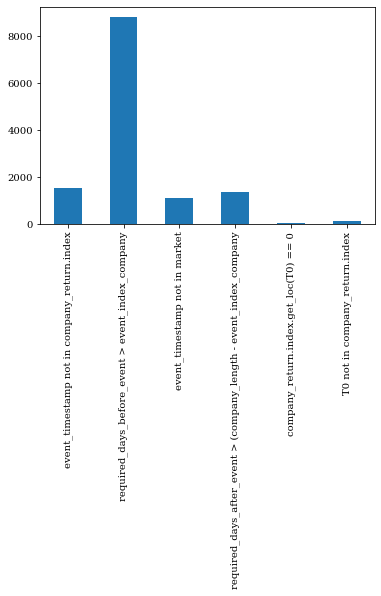

In [20]:
errors_df = pd.DataFrame.from_records(data_errors)
errors_df.sum(axis=0).plot.bar()

### Having a look at all trade types together

<AxesSubplot:>

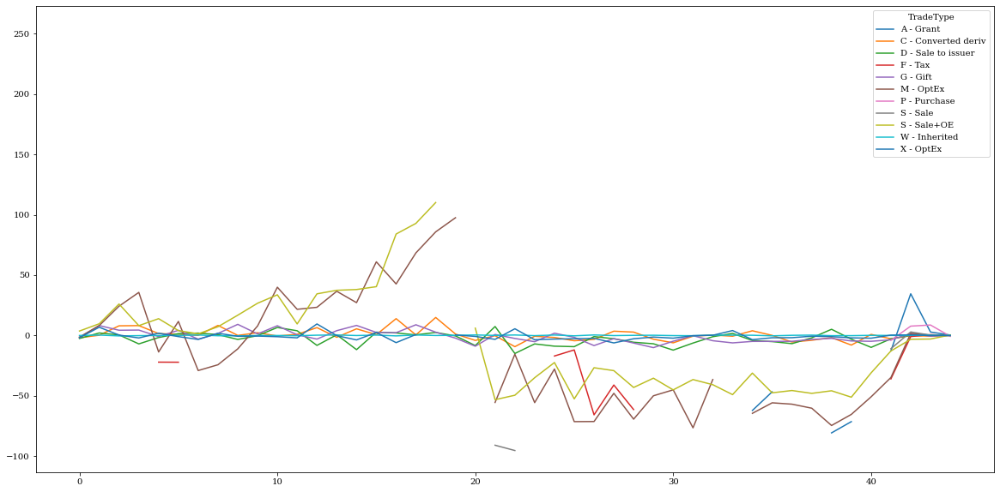

In [21]:
df_abnormal_returns.groupby(level=[2]).sum().transpose().plot(figsize=(20, 10))

I think OE and OptEx means option exercise. "to exercise" means to put into effect the right to buy or sell the underlying security that is specified in the options contract." Can we be sure that the action does not shift the market, and the swing in return is really due to new information? Are these trades public, so maybe they are used as a signal for traders?

### Boxplot of the sum over all companies's AR

<AxesSubplot:>

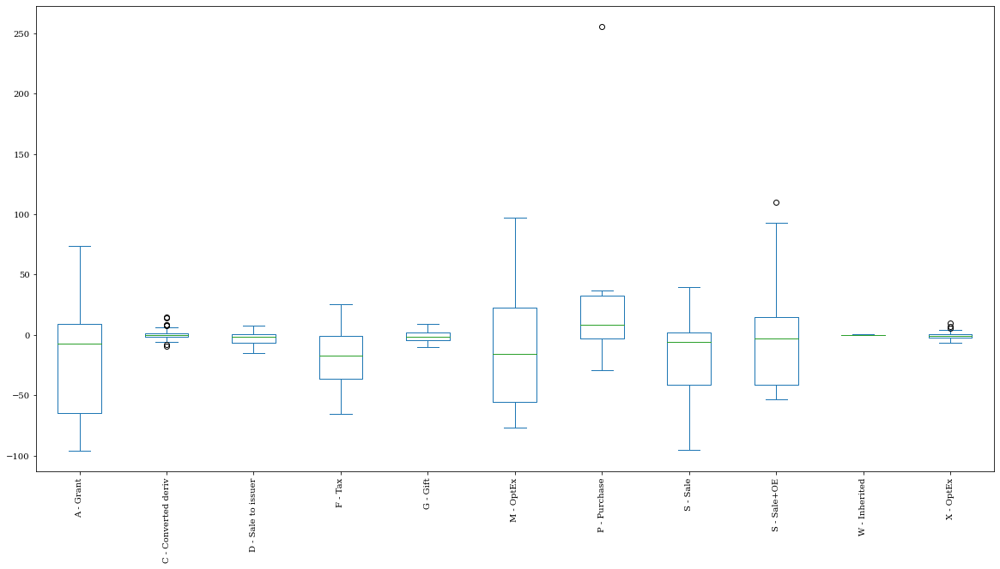

In [22]:
df_abnormal_returns.groupby(level=[2]).sum().transpose().plot.box(rot=90, figsize=(20, 10))

![alt text](assets/images/time_agg.png)

In our case it is not company i, but filing i

Types of trade to pick from:

In [23]:
list(set([x[2] for x in df_abnormal_returns.index]))

['F - Tax',
 'M - OptEx',
 'S - Sale',
 'W - Inherited',
 'P - Purchase',
 'D - Sale to issuer',
 'G - Gift',
 'X - OptEx',
 'C - Converted deriv',
 'A - Grant',
 'S - Sale+OE']

Specify the type of the trades to investigate

In [51]:
type_ = "P - Purchase" # "S - Sale"
df_abnormal_returns_type = df_abnormal_returns.loc[:,:,type_]

The index describes the company and the index of the filing in the compnay, the columns represent the days in the event window

In [52]:
df_abnormal_returns_type

0         1         2         3         4         5   \
Company i                                                                 
ACGL    23  -0.011231 -0.008568 -0.011554  0.013647  0.002003  0.012212   
        78  -0.047056 -0.021964 -0.042571  0.032467  0.025323 -0.007606   
        81   0.011378  0.000107 -0.005559 -0.046845 -0.021869 -0.042409   
        94   0.073030  0.002362 -0.061111 -0.046759 -0.044307 -0.050150   
        179  0.017043  0.003113 -0.018430 -0.005544 -0.001296 -0.002181   
...               ...       ...       ...       ...       ...       ...   
HIHO    9   -0.038692  0.013898 -0.005308  0.001201  0.001161  0.014363   
NESR    0   -0.000209  0.000440 -0.002685 -0.000056  0.000854  0.005840   
        1   -0.000209  0.000440 -0.002685 -0.000056  0.000854  0.005840   
        4    0.001953  0.003886 -0.005116  0.001853 -0.002088 -0.001098   
SJ      1   -0.000076  0.000089 -0.000943 -0.000027 -0.000067 -0.000089   

                   6         7         8         9   ...        35        36  \
Company i                                            ...                       
ACGL    23  -0.003189 -0.005001 -0.019234 -0.016278  ...  0.011531  0.014727   
        78  -0.053403  0.005575  0.018068 -0.013058  ... -0.048967 -0.008135   
        81   0.032608  0.025360 -0.007363 -0.053320  ...  0.044729  0.008779   
        94   0.009735 -0.001080 -0.006283 -0.048759  ... -0.021194 -0.042269   
        179  0.008999  0.007366  0.000561  0.004842  ... -0.004439 -0.012003   
...               ...       ...       ...       ...  ...       ...       ...   
HIHO    9   -0.041108  0.005572  0.003338  0.001717  ...  0.037794 -0.022003   
NESR    0   -0.000094  0.002733 -0.007973 -0.003112  ...  0.013294 -0.014447   
        1   -0.000094  0.002733 -0.007973 -0.003112  ...  0.013294 -0.014447   
        4    0.000852 -0.000041  0.004926 -0.003135  ... -0.008933  0.017408   
SJ      1    0.002148 -0.000135 -0.000266 -0.000010  ...  0.000025  0.000088   

                   37        38        39        40        41        42  \
Company i                                                                 
ACGL    23  -0.015163 -0.003742  0.012896 -0.005963       NaN       NaN   
        78   0.001170 -0.003861 -0.008908 -0.014547       NaN       NaN   
        81  -0.035532 -0.048845 -0.008257  0.001307       NaN       NaN   
        94   0.025220  0.038854  0.057355  0.024765  0.042956       NaN   
        179  0.000011 -0.019409 -0.000157  0.018339  0.022012 -0.006164   
...               ...       ...       ...       ...       ...       ...   
HIHO    9   -0.004855  0.002022  0.035870 -0.062671  0.004907       NaN   
NESR    0    0.011380 -0.004321 -0.000129  0.015644 -0.000250       NaN   
        1    0.011380 -0.004321 -0.000129  0.015644 -0.000250       NaN   
        4    0.006698 -0.002502  0.025290 -0.009596       NaN       NaN   
SJ      1   -0.000231  0.004127 -0.000060  0.000245 -0.000127 -0.000036   

                   43  44  
Company i                  
ACGL    23        NaN NaN  
        78        NaN NaN  
        81        NaN NaN  
        94        NaN NaN  
        179       NaN NaN  
...               ...  ..  
HIHO    9         NaN NaN  
NESR    0         NaN NaN  
        1         NaN NaN  
        4         NaN NaN  
SJ      1   -0.000089 NaN  

[26995 rows x 45 columns]

In [53]:
# TODO Infinity Values idk why, should check out why they are there upstream

In [54]:
mask = (-df_abnormal_returns_type == np.Inf) |(df_abnormal_returns_type == np.Inf)
df_abnormal_returns_type[mask] = 0

C:\Users\thoma\AppData\Local\Temp\ipykernel_19616\711303784.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_abnormal_returns_type[mask] = 0
C:\Users\thoma\AppData\Local\Temp\ipykernel_19616\711303784.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_abnormal_returns_type[mask] = 0


<AxesSubplot:xlabel='Company,i'>

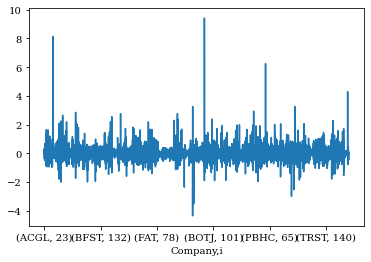

In [55]:
CAR = df_abnormal_returns_type.sum(axis=1)
CAR.plot()

![alt text](assets/images/cross_sectional_agg.png)


<AxesSubplot:>

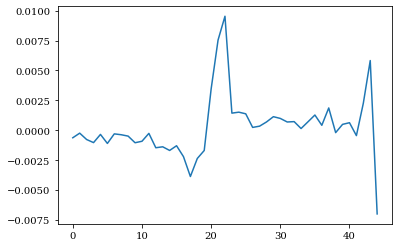

In [56]:
AR_bar = df_abnormal_returns_type.mean(axis=0) 
AR_bar.plot()

In [57]:
CAR_bar = AR_bar.sum()
CAR_bar

0.01235351871244868

In [58]:
# TODO var_CAR_bar = Does the definition make sense? It seems like we take the var of a scalar

![alt text](assets/images/cross_sectional_agg2.png)


In [59]:
CAR_bar_2 = CAR.mean()
CAR_bar_2

0.01198903706353063

In [60]:
# var car TODO not sure what just sigma means.

# Statistics

Check if CAR mean = 0 (t-test)

In [61]:
from scipy import stats

stats.ttest_1samp(CAR, popmean=0)

Ttest_1sampResult(statistic=5.723314778881031, pvalue=1.0557108057490443e-08)

Check if CAR median = 0 (wilcoxon signed rank test)

In [62]:
stats.wilcoxon(CAR)

WilcoxonResult(statistic=178951467.0, pvalue=0.9835147263045285)